In [1]:
from tools_stance import * 
import torch 
import pandas as pd

n_gpu = torch.cuda.device_count()
torch.cuda.get_device_name(0)

if torch.cuda.is_available():     
    device = torch.device("cuda")
    print('There are',torch.cuda.device_count(),'GPU(s) available.')
    print('We will use the GPU:', torch.cuda.get_device_name(0))

else:
    print('No GPU available, using the CPU instead.')
    device = torch.device("cpu")


dict_cl=dict()
dict_cl[0]="support"
dict_cl[1]="denying"
dict_cl[2]="questioning"
dict_cl[3]="commenting"

#sdqc
d_lab=dict()
d_lab["support"]=0
d_lab["denying"]=1
d_lab["questioning"]=2
d_lab["commenting"]=3

path="../Datasets/CSV_Stance/"
train =pd.read_csv(path + "train_semeval_raw.csv")
val=pd.read_csv(path + "dev_semeval_raw.csv")
test=pd.read_csv(path + "test_semeval_raw.csv")

stoplist = stopwords.words("english")
puntos='!?."()[´]“<>¡¿-/;:=_”@#.'

Using TensorFlow backend.
/home/casapanshop/anaconda2/envs/newpy3_tf1/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/casapanshop/anaconda2/envs/newpy3_tf1/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/casapanshop/anaconda2/envs/newpy3_tf1/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16

There are 1 GPU(s) available.
We will use the GPU: GeForce GTX 1060 6GB


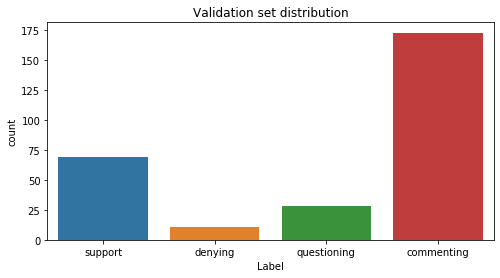

In [6]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(8,4))
sns.countplot(val['Label'], order=['support', 'denying', 'questioning', 'commenting'])
plt.title('Validation set distribution')
plt.show()

In [7]:
def det_samples(df, dict_class, c_weights=None): #None o diccionario de fracciones a aum.
    conteos= Counter(df)
    aumentos= dict()
    maxi= max(conteos.values())
            
    if c_weights is None:        # uniform class weights
        for tipo in conteos:
            actual= conteos[tipo]
            if actual<maxi:
                aumentos[tipo]=int(maxi-actual)
            else:
                aumentos[tipo]=0
        return aumentos   
    else:
        try:
            for clase in c_weights.keys():
                aumentos[clase]=int(c_weights[clase]*conteos[clase])
            for key in conteos.keys():
                if key not in aumentos.keys():
                    aumentos[key]=0
            return aumentos
        except:
            print ("No se ha especificado el diccionario de tasas de aumento de datos (por clase)")
    

In [8]:
def just_tag_word(sentence, tags_all, tag):  #wd en el vocab pues es la palabra que más pesa en el reemplazo
    n_sentence=[]
    indices=[]
    valid=[]
    i=0
    for wd in sentence:
        if wd in puntos or wd[0]=='#':
            i+=1
            continue
        else:
            if (tags_all[i] not in tag) or (wd not in token_2_idx.keys()):
                i+=1
                continue
            else:
                n_sentence.append(wd)
                indices.append(i)
                valid.append(tags_all[i])
            i+=1
    return np.asarray(n_sentence), np.asarray(indices), np.asarray(valid)

def re_generar(texto, tags_all, tag, f):
    sent, indices, tags = just_tag_word(texto, tags_all, tag)
    noise_mask = bernoulli.rvs(f, size=sent.shape)
    bool_list=list(map(bool,noise_mask))
    to_replace=sent[bool_list]
    indix=indices[bool_list]  
    tagx=tags[bool_list] 
    return to_replace , indix, tagx

In [9]:
def find_negative(target, not_sent, window=4):
    cleaned = cleaner(not_sent)[1]
    ide = cleaned.index(target)
    wind_neg=find_window(cleaned, target, ide, window=window)   
    return wind_neg

def most_similar_cosmul(space, EMB_matrix, positive=None, negative=None, topn=1 ): #agregar space de vpcab
    if isinstance(topn, int) and topn < 1:
        return []
    if positive is None:
        positive = []
    if negative is None:
        negative = []
    if isinstance(positive, str) and not negative:
        positive = [positive]
  
    ids_pos = [
        token_2_idx[word] if isinstance(word, string_types) else 'Tipo positivo no admitido'
        for word in positive
    ]
    
    positive = [EMB_matrix[idx] for idx in ids_pos]  #space de vocab
    ids_nega= [
        token_2_idx[word] if isinstance(word, string_types) else 'Tipo negativo no admitido'
        for word in negative
    ]
    negative = [EMB_matrix[idx] for idx in ids_nega] #space de vocab

    if not positive:
        raise ValueError("cannot compute similarity with no input")
    
    pos_dists = [((1 + dot(space, term))/2) for term in positive]    
    pos_dists[0]=pos_dists[0]
    neg_dists = [((1 + dot(space, term))/2) for term in negative]
    dists = prod(pos_dists, axis=0) / (prod(neg_dists, axis=0) + 0.000001)
    
    if not topn:
        return dists
    best = matutils.argsort(dists, topn=topn + len(positive + negative), reverse=True)  #ordena en vocab used

    return best, dists[best] #retorna indices y distancias asociadas

def most_similar_cos(space, EMB_matrix, positive=None, negative=None, topn=1 ): 
    if isinstance(topn, int) and topn < 1:
        return []
    if positive is None:
        positive = []
    if negative is None:
        negative = []
    if isinstance(positive, str) and not negative:
        positive = [positive]
  
    ids_pos = [
        token_2_idx[word] if isinstance(word, string_types) else 'Tipo positivo no admitido'
        for word in positive
    ]
    
    positive = [EMB_matrix[idx] for idx in ids_pos]  #space de vocab
    ids_nega= [
        token_2_idx[word] if isinstance(word, string_types) else 'Tipo negativo no admitido'
        for word in negative
    ]
    negative = [EMB_matrix[idx] for idx in ids_nega] #space de vocab

    if not positive:
        raise ValueError("cannot compute similarity with no input")
    
    
    len_all=len(positive + negative)-1 
    pos_dists = []
    i=0
    for term in positive:
        if i==0:
            pos_dists.append(((1 + dot(space, term))/2))
        else:
            pos_dists.append(((1 + dot(space, term))/(2*len_all)))

    neg_dists = []
    i=0
    for term in negative:
        if i==0:
            neg_dists.append(((1 + dot(space, term))/2))
        else:
            neg_dists.append(((1 + dot(space, term))/(2*len_all)))
    
    
    dists = prod(pos_dists, axis=0) / (prod(neg_dists, axis=0) + 0.000001)
    
    if not topn:
        return dists
    best = matutils.argsort(dists, topn=topn + len(positive + negative), reverse=True)  #ordena en vocab used


    return best, dists[best] #retorna indices y distancias asociadas



In [10]:
def aumentar_clase(clase, num_ejem, tags_all, prob, topn=1, EMBED=False, pond=False, Neg=False):
    dict_resumen=dict()
    new_sample=[]
    indx=train['Label']==clase
    label=d_lab[clase]    
    contador=1  # o 0?
    
    no_modificados=0
    modificados=0
    terms_modif=0  
    terms_supuestos=0  
    totales=0
    largos=0
    SENT_LEN=0
    muestras=train['Tweet'][indx]
    tw_ids=train['Tw_id'][indx]
        
    
    if num_ejem<=0:
        count= Counter(train['Label'])
        news= train[indx].sample(count[clase]+num_ejem, replace=False)
        news_tw=news['Tweet'].values
        news_id=news['Tw_id'].values
        for muestra, twid in list(zip(news_tw, news_id)):
            pre=np.asarray(cleaner(muestra)[1])  #np.asarray
            new_sample.append([twid, pre, label])
        return new_sample, dict_resumen
    
    while (len(new_sample)<num_ejem):
        muestra=np.random.choice(muestras, size=1)[0]
        pre=np.asarray(cleaner(muestra)[1]) 
        tags_pre= [nltk.pos_tag([wd])[0][-1] for wd in pre]
        terms, indxs, tagx = re_generar(pre, tags_pre, tags_all, prob)  #terms to replace
        terms_supuestos+=len(terms)

        news=[]
        SENT_LEN+=len(terms)

        if len(terms)>0:     
            reem=time.time()
            for term, ind, tag in list(zip(terms, indxs, tagx)):
                
                if term!='user' and term!='hashtag' and term!='html':
                    not_clase, used_classes = sample_neg_class(clase) #definir clases a buscar

                    valid_pos=[]
                    pos = find_positive(list(pre), term, ind, window=4) #se puede cambiar la ventana! 
                    valid_pos=check_valid(pos, tags_all)

                    id_need = 999999999 #simbolo de que no encontró tweet
                    neg = []
                    while(id_need == 999999999):
                        try:
                            id_need = np.random.choice(dic_IdxI[not_clase][term]) #sample id
                        except:
                            if len(used_classes) == len(d_lab.keys()): 
                                break #ya revisó todas las clases
                            not_clase, used_classes = sample_neg_class(used_classes) # change class 

                    valid_neg=[]
                    if id_need != 999999999: #si encontró tweet
                        not_sent = train["Tweet"][id_need]
                        neg = find_negative(term, not_sent, window=4)  
                        valid_neg=check_valid(neg, tags_all)

                    """Modificar acá posible, obligatorio, positivos"""
                    if Neg:
                        if len(valid_pos)<1 and len(valid_neg)<1:
                            continue #obligatorio ambos :)
                    else:
                        if len(valid_pos)<1:
                            continue #obligatorio positivo                    
                
                    if EMBED:
                        mask_words = valid & np.asarray(d_posTg[tag])     
                    else:
                        mask_words = np.asarray(d_vocab[clase]) & np.asarray(d_posTg[tag])
                    vocab_used_pos = np.arange(len(mask_words))[mask_words]
                    space= EMB_matrix[mask_words] #espacio BERT de clase y tag solicitado

                    if pond:
                        best, dists_best = most_similar_cos(space, EMB_matrix, positive=valid_pos, negative=valid_neg)
                    else:
                        best, dists_best = most_similar_cosmul(space, EMB_matrix, positive=valid_pos, negative=valid_neg)#, topn=TOPN)
                    
                    todo_words = {
                        token_2_idx[word] for word in valid_pos + valid_neg
                        if not isinstance(word, ndarray) and word in token_2_idx
                        }
                    result = []
                    for sim, dist_sim in list(zip(best, dists_best)):
                        n_sim = vocab_used_pos[sim]
                        if n_sim not in todo_words:
                            result.append((idx_2_token[n_sim], float(dist_sim)))

                    if len(result)>0:
                        candidatos = result[:topn] #+2
                        if contador<200:
                            print ("Original:",term ," \tReemplazo: ", candidatos)
                    else:
                        continue

                    new = choose_replace(candidatos, ind, term)  
                    news.append(new) 
                    try: #if tag in dict_resumen.keys():
                        dict_resumen[tag]+=1
                    except:
                        dict_resumen[tag]=1

            cambia=False
            news= Sort_Tuple(news) 

            if len(news)<1:                
                no_modificados+=1
                continue
            else:
                x=np.asarray(news)[:,1]
                y=np.asarray(news)[:,0]
                n_news=np.asarray(np.vstack((x,y))).T

                nueva_sent=[]
                cont_new=0
                for i in range(len(pre)):
                    try:
                        if int(n_news[cont_new][0])==i:
                            nueva_sent.append(n_news[cont_new][1])                 
                            cont_new+=1
                        else: 
                            nueva_sent.append(pre[i])
                    except: 
                        nueva_sent.append(pre[i])

                totales+=cont_new


                if contador<200:
                    print ("Sentencia original:")
                    print (pre)
                    print ("Sentencia final:" , label)
                    print (nueva_sent)
                    print ("")
                    print ("")

                new_sample.append(["Gen_"+str(contador), nueva_sent, label])
                modificados+=1
                terms_modif+=len(news)
                largos+=len(pre)
                contador+=1
                
    count= Counter(train['Label'])   
    for muestra, twid in list(zip(muestras,tw_ids)) :
        pre=np.asarray(cleaner(muestra)[1])
        new_sample.append([twid, pre, label])

    try:
        print ("# terms modificados promedio", terms_modif/modificados ,"términos por sentencia")
        print ("Largo de sentencia promedio", largos/modificados ,"términos por sentencia")
        print ("para esta ejecución se debiesen reemplazar", SENT_LEN, " de" ,TOPE_LEN, "terminos")

    except: 
        print ("No se generan ejemplos")

    return new_sample, dict_resumen

In [11]:
import os 
embeddings_index = {}
token_2_idx={}
idx_2_token={}
f = open(os.path.join("../Datasets/glove.twitter.27B.200d.txt"))#'glove.twitter.27B.100d.txt'))
i=0
for line in f:
    values = line.split()
    if len(values)>200:
        word = values[0]
    else:
        #print ("Problema con line ", line)
        continue
    token_2_idx[word]=i
    idx_2_token[i]=word
    coefs = np.asarray(values[1:], dtype='float32')
    embeddings_index[word] = coefs
    i+=1
f.close()

print('Se encontraron %s terminos con sus vectores de embedding.' % len(embeddings_index))

Se encontraron 1193513 terminos con sus vectores de embedding.


In [12]:
def cleaner(post): 
    s= re.sub(r"http\S+", " html ", post)   ##########elimina http    
    s= re.sub(r'#\w+ ?', " hashtag ", s) ########3
    s= re.sub(r'@\w+ ?', " user ", s)##############    
    s= s.lower()
    s=emoji_pattern.sub(r'', s)
    s=re.sub(r"'\b", " ' ", s)
    s=re.sub(r"\b'\b", " ' ", s)
    s=re.sub(r"“\b", " “ ", s)
    s=re.sub(r"\b’", " ’ ", s)
    s=re.sub(r"‘\b", " ‘ ", s)
    s=re.sub(r"\b’\b", " ‘ ", s)
    s = re.sub(r"-", " - ", s)
    s = re.sub(r"\(", " ", s)
    s = re.sub(r"\)", " ", s)
    s = re.sub(r"\?", " ? ", s)    
    s = re.sub(r"\/", " ", s)
    s = re.sub(r"' ", " ' ", s)
    s = re.sub(r" '", " ' ", s)
    s = re.sub(r"\!", " ! ", s)
    s=re.sub("[\.]+", " . ", s)
    s=re.sub("[\,]+", " , ", s)
    s=re.sub("[\;]+", " ; ", s)
    s=re.sub("[\:]+", " : ", s)
    s=re.sub('[\"]+', ' " ', s)
    s=re.sub(r'\b[0-9]\b', " number ",  s)
    s=re.sub(r'\b[0-9]*[0-9]\b', " number ",  s)    
    s=re.sub(r'\b”', ' " ', s)
    sl= list(s.split())
    sl_2=[]
    for wd in sl:
        try: 
            q=token_2_idx[wd]
            sl_2.append(wd)
        except:
            try: 
                if stemmer.stem(wd) in token_2_idx.keys():
                    sl_2.append(stemmer.stem(wd))
                elif lemmatizer.lemmatize(wd) in token_2_idx.keys():
                    sl_2.append(lemmatizer.lemmatize(wd))
                else:
                    sl_2.append(wd)
            except:
                sl_2.append(wd)
    sl=sl_2
    s=' '.join([word for word in sl])# if word not in stoplist])
    return s, sl

In [13]:
keys=["commenting", "support", "denying", "questioning"]

dict_clases={}
for key in keys: 
    tr_k=train.loc[train["Label"]==key]
    tr_k=tr_k["Tweet"].values    
    trs_k=[]
    for tw in tr_k:
        #tokenizer_loaded.tokenize(cleaner(tw)[0]))
        cleaned = cleaner(tw)[1]
        trs_k+=cleaned
        #print ("Result tokenizer: ", encoded_sent)
    dict_clases[key]=trs_k  

In [23]:
for key in keys:
    trk=train.loc[train["Label"]==key]['Tweet'].values
    all_len=[]
    for tw in trk:
        cleaned = len(cleaner(tw)[1])
        all_len.append(cleaned)
    print (key, np.mean(all_len))


commenting 16.396488661302122
support 17.510107015457788
denying 17.735735735735737
questioning 15.542424242424243


In [10]:
vocabulary={}
for key in keys: 
    temp=list(set(dict_clases[key]))
    print ("#Tweets",key,":",len(temp))
    vocabulary[key]=temp

#Tweets commenting : 4915
#Tweets support : 2103
#Tweets denying : 1400
#Tweets questioning : 1172


In [13]:
#'NN','NNS', 'JJ', 'JJR', 'JJS',
tags=['JJ', 'JJR', 'JJS']
for key in keys:
    print ("\nPara la clase", key)
    cont=0
    lista_k=list(set(vocabulary[key]))
    for token in lista_k:
        if nltk.pos_tag([token])[0][-1] in tags:
            cont+=1
            #print ("token: ", token, "tira", nltk.pos_tag([token])[0][-1] )
        else:
            continue
    print ("total de terminos en NNs:", cont)


Para la clase commenting
total de terminos en NNs: 339

Para la clase support
total de terminos en NNs: 152

Para la clase denying
total de terminos en NNs: 124

Para la clase questioning
total de terminos en NNs: 86


In [11]:
dic_IdxI = {value: {} for value in d_lab.keys()}
for i, (muestra, label) in enumerate(list(zip(train["Tweet"],train["Label"]))):
    pre=np.asarray(cleaner(muestra)[1])
    for token in pre:
        if token not in dic_IdxI[label]:
            dic_IdxI[label][token] = [i]
        else:
            dic_IdxI[label][token].append(i)

In [12]:
def check_vocab(token, clase):
    if ('unused' in token) or token.isdigit() or token[:-2].isdigit() or  token in puntos or "##" in token or len(token) < 2: 
        return False
    else:
        if token in vocabulary[clase]:
            return True
        else: 
            return False
        
        
def check_tag(token, tag):
    if ('unused' in token) or token.isdigit() or token[:-2].isdigit() or token in puntos or "##" in token or len(token) < 2: 
        return False
    else:
        if nltk.pos_tag([token])[0][-1]==tag and token in token_2_idx.keys():
            return True
        else: 
            return False
            
def check_valid(lista, tags):
    keep=[]
    lista_tag= [nltk.pos_tag([wd])[0][-1] for wd in lista] 
    for tag, word in list(zip(lista_tag , lista)):
        if tag in tags and word in token_2_idx.keys():
            keep.append(word)
    return keep

In [13]:
tags=['NN','NNS', 'JJ', 'JJR', 'JJS', 'VB', 'VBD', 'VBG', 'VBN', 'VBP', 'VBZ']
clases=['support', 'denying', 'questioning', 'commenting']
MAX_LEN = 37

d_posTg= dict()
for tag in tags:
    d_posTg[tag]= [check_tag(k, tag) for k in idx_2_token.values()]
    
d_vocab=dict()
for clase in clases:
    d_vocab[clase]= [check_vocab(k, clase) for k in idx_2_token.values()]
    

In [14]:
data_2_idx=dict()

corpus=[]
not_found=[]
found=[]
pos_tag_nf=[]
pos_tag=[]
    
for vocab_clase in vocabulary.keys():
    corpus+=vocabulary[vocab_clase]

corpus=list(set(corpus))
for term in corpus:
    try:
        if term not in data_2_idx.keys():
            found.append(term)
            pos_tag.append(nltk.pos_tag([term])[0][-1])
            data_2_idx[term]=token_2_idx[term]
    except:
        not_found.append(term)
        pos_tag_nf.append(nltk.pos_tag([term])[0][-1])
        continue

In [15]:
original=len(set(corpus))
matched=len(data_2_idx.keys())
print ("Se distinguen", original, "términos en el dataset. Reconociendo a", matched, "de estos (%.2f" % (matched/original) + "%)")
print ("\nExisten", len(not_found), "términos no encontrados:")
for term in not_found[:20]:
    print ("-",term)

Se distinguen 5979 términos en el dataset. Reconociendo a 5648 de estos (0.94%)

Existen 331 términos no encontrados:
- know~who
- *checks
- 9news
- 4hrs
- hand*
- nutters&gt
- 5hrs
- athenaph
- ridicule'
- moohammadd
- defident
- news1
- flotus&amp
- some1
- forthis
- duduche
- infrance
- f$ck
- ❤️❤️❤️please
- alluh


In [16]:
print ("Distribución en POS tag entre términos encontrados:\n",  Counter(pos_tag))
print ("\nDistribución en POS tag entre términos NO encontrados:\n",  Counter(pos_tag_nf))

Distribución en POS tag entre términos encontrados:
 Counter({'NN': 3444, 'NNS': 861, 'JJ': 380, 'VBG': 364, 'VBN': 363, 'RB': 237, 'VBD': 66, 'IN': 55, 'VB': 47, 'CD': 45, 'VBZ': 20, 'DT': 16, 'PRP': 15, 'JJS': 10, 'MD': 9, 'JJR': 8, 'PRP$': 7, 'CC': 5, 'RBR': 4, 'WRB': 4, 'WP': 3, ':': 3, '.': 3, 'WDT': 2, 'VBP': 2, '#': 1, '$': 1, ',': 1, "''": 1, 'WP$': 1, 'TO': 1})

Distribución en POS tag entre términos NO encontrados:
 Counter({'NN': 240, 'CD': 36, 'NNS': 30, 'JJ': 9, 'RB': 7, 'VBG': 5, 'VBN': 4})


In [14]:
a={'NN': 3444, 'NNS': 861, 'JJ': 380, 'VBG': 364, 'VBN': 363, 'RB': 237, 'VBD': 66, 'IN': 55, 'VB': 47, 'CD': 45, 'VBZ': 20, 'DT': 16, 'PRP': 15, 'JJS': 10, 'MD': 9, 'JJR': 8, 'PRP$': 7, 'CC': 5, 'RBR': 4, 'WRB': 4, 'WP': 3, ':': 3, '.': 3, 'WDT': 2, 'VBP': 2, '#': 1, '$': 1, ',': 1, "''": 1, 'WP$': 1, 'TO': 1}
np.sum(list(a.values()))

5979

<BarContainer object of 31 artists>

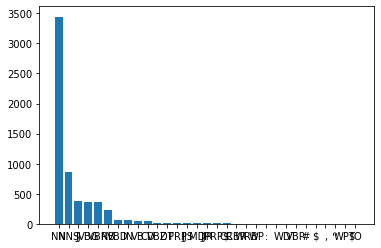

In [15]:
keys = a. keys()
values = a. values()
plt.bar(keys, values)

#### POS tags 

- JJ adjective 'big'
- JJR adjective, comparative 'bigger'
- JJS adjective, superlative 'biggest'

- NN noun, singular 'desk'
- NNS noun plural 'desks'
- NNP proper noun, singular 'Harrison'
- NNPS proper noun, plural 'Americans'

- RB adverb very, silently,   (no considerado) 
- RBR adverb, comparative better  (no considerado)
- RBS adverb, superlative best  (no considerado)

- VB verb, base form take    
- VBD verb, past tense took
- VBG verb, gerund/present participle taking
- VBN verb, past participle taken
- VBP verb, sing. present, non-3d take
- VBZ verb, 3rd person sing. present takes



In [17]:
emb=200
EMB_matrix=np.zeros((len(token_2_idx.keys()), emb))
for i in range(len(token_2_idx.keys())):
    EMB_matrix[i]=embeddings_index[idx_2_token[i]]
    
transformer = Normalizer().fit(EMB_matrix) 
EMB_matrix=transformer.transform(EMB_matrix)
EMB_matrix.shape

(1193513, 200)

In [18]:
def valid_token(token):
    if ('unused' in token) or token.isdigit() or token[:-2].isdigit() or token in puntos or "##" in token or len(token) < 2: 
        return False
    else:
        exceptions=['[CLS]', '[SEP]', '[MASK]', '[PAD]']
        if token not in exceptions:       
            return True
        else: 
            return False
        
valid=np.asarray([valid_token(k) for k in idx_2_token.values()])


## Análisis de espacio embedding

max len: 37


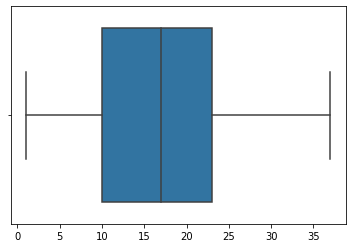

In [19]:
lens=[]
for tweet in train["Tweet"].values:
    tw=cleaner(tweet)[1]
    lens.append(len(tw))

print ("max len:", max(lens))
sns.boxplot(lens)

In [21]:
from sklearn.decomposition import KernelPCA
from sklearn.manifold import TSNE 

import numpy as np 
import pandas as pd
from collections import Counter 
from bert_serving.client import BertClient

bc = BertClient()  

data_bas=[]
for tweet in train["Tweet"].values:
    h=cleaner(tweet)[0]
    vector=bc.encode([h])[0]
    data_bas.append(vector)

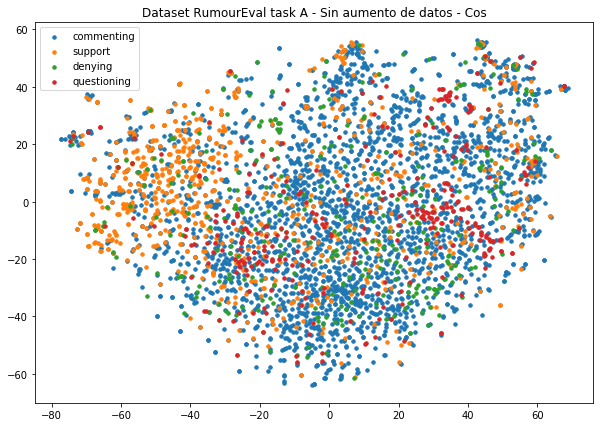

In [22]:
model = TSNE(2, metric='cosine')
to_plot_tsne = model.fit_transform(data_bas)    
plt.figure(figsize=(10,7))
for key in keys:
    mask = train["Label"]==key
    plt.scatter(to_plot_tsne[:,0][mask],to_plot_tsne[:,1][mask], s=12, label=str(key))

plt.legend()
plt.title("Dataset RumourEval task A - Sin aumento de datos - Cos")
plt.show()

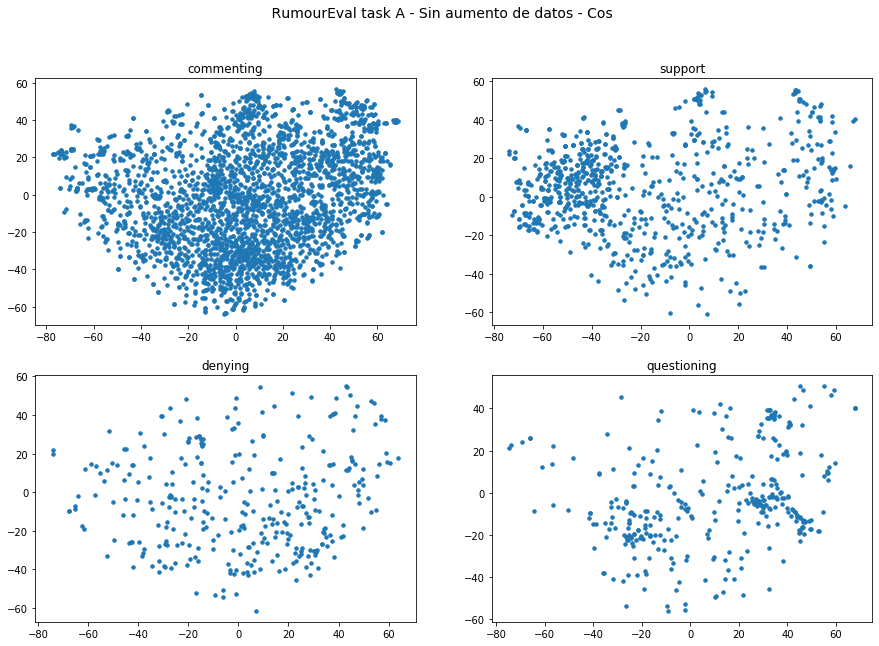

In [23]:
fig = plt.figure(figsize=(15,10))
j=220
for key in keys:
    mask = train["Label"]==key
    j+=1
    h=fig.add_subplot(j)
    plt.scatter(to_plot_tsne[:,0][mask],to_plot_tsne[:,1][mask], s=12, label=str(key))
    h.title.set_text(str(key))

fig.suptitle(" RumourEval task A - Sin aumento de datos - Cos", fontsize=14)
plt.show()


# Generación Varias

In [22]:
prob= 0.15
topn = 1

aum_weight=det_samples(train['Label'], dict_cl)#, c_weights={"support":1, "questioning":2, "denying":2})
print ("--------------------------------------------------------")
print ("\nGenerando ejemplos en base a probabilidad --> ", prob)
print ("--------------------------------------------------------") 
print (aum_weight)

--------------------------------------------------------

Generando ejemplos en base a probabilidad -->  0.15
--------------------------------------------------------
{'questioning': 2404, 'commenting': 0, 'support': 1893, 'denying': 2401}


### Sujeto a clase no ponderando target

In [26]:
macro_augmented=[]
for clase in aum_weight:
    start_time=time.time()
    print ("\n\nGenerando", aum_weight[clase], "ejemplos para", clase)
    muestras, dict_aumentos=aumentar_clase(clase, aum_weight[clase], tags, prob)
    macro_augmented+=muestras
    print ("Resumen de modificaciones:", dict_aumentos)
    elapsed_time= time.time() - start_time
    print ("Este proceso tomó", elapsed_time, "seg")   



Generando 2404 ejemplos para questioning
Original: alright  	Reemplazo:  [('gonna', 0.8620710518180693)]
Sentencia original:
['user' 'user' 'is' 'he' 'alright' '?']
Sentencia final: 2
['user', 'user', 'is', 'he', 'gonna', '?']


Original: alive  	Reemplazo:  [('auch', 2.036107733788012)]
Sentencia original:
['user' 'what' 'about' 'the' 'hostage' 'hopefully' 'still' 'alive' '.']
Sentencia final: 2
['user', 'what', 'about', 'the', 'hostage', 'hopefully', 'still', 'auch', '.']


Original: do  	Reemplazo:  [('know', 0.7226286212138263)]
Sentencia original:
['user' 'do' 'you' 'have' 'a' 'link' '?']
Sentencia final: 2
['user', 'know', 'you', 'have', 'a', 'link', '?']


Original: let  	Reemplazo:  [('know', 0.5148560142772535)]
Original: terrorist  	Reemplazo:  [('gonna', 0.4886876560516454)]
Original: were  	Reemplazo:  [('wacked', 3.0704146016481606)]
Original: jail  	Reemplazo:  [('gbj', 2.7132394511643065)]
Sentencia original:
['user' 'hashtag' 'no' '.' 'we' 'are' 'witness' 'on' 'how' '

Original: looking  	Reemplazo:  [('announcing', 0.7014142483598026)]
Sentencia original:
['user' 'many' 'here' 'in' 'ottawa' 'media' 'looking' 'for' 'the' 'source'
 'of' 'this' 'photo' '.']
Sentencia final: 2
['user', 'many', 'here', 'in', 'ottawa', 'australia', 'announcing', 'for', 'the', 'source', 'of', 'this', 'photo', '.']


Original: m  	Reemplazo:  [('st', 1.0032676311079847)]
Original: flops  	Reemplazo:  [('fucktards', 3.145759490207126)]
Sentencia original:
['user' 'user' 'i' "'" 'm' 'looking' 'for' 'his' 'read' 'hat' 'and' 'his'
 'flip' 'flops' 'can' 'you' 'find' 'them' '?' 'html']
Sentencia final: 2
['user', 'user', 'i', "'", 'st', 'looking', 'for', 'his', 'read', 'hat', 'and', 'his', 'flip', 'fucktards', 'can', 'you', 'find', 'them', '?', 'html']


Original: didn  	Reemplazo:  [('wouldnt', 1.699008001616055)]
Original: stop  	Reemplazo:  [('shouldn', 3.2742622396933556)]
Sentencia original:
['user' 'you' 'were' 'correct' 'yesterday' '!' 'ferguson' 'police' 'chief'
 ':' 'off

Original: bad  	Reemplazo:  [('uneducated', 0.6258772902198548)]
Original: hope  	Reemplazo:  [('jeez', 0.9014036556368442)]
Original: kicked  	Reemplazo:  [('been', 0.33110683280861514)]
Sentencia original:
['user' 'user' 'user' 'user' 'call' 'me' 'bad' 'canuck' ',' 'i' 'hope'
 'those' 'fucktards' 'get' 'their' 'asses' 'kicked' '.' 'html']
Sentencia final: 2
['user', 'user', 'user', 'user', 'call', 'me', 'uneducated', 'canuck', ',', 'i', 'jeez', 'those', 'fucktards', 'get', 'their', 'asses', 'been', '.', 'html']


Original: dont  	Reemplazo:  [('seresta', 5.736855238552198)]
Original: number  	Reemplazo:  [('reply', 1.0614600783216555)]
Sentencia original:
['user' 'user' 'user' 'user' 'hardly' ',' 'dont' 'hear' 'about' 'a'
 'school' 'shooting' 'or' 'spree' 'every' 'number' 'mins' 'do' 'we' '?']
Sentencia final: 2
['user', 'user', 'user', 'user', 'hardly', ',', 'seresta', 'hear', 'about', 'a', 'school', 'shooting', 'or', 'spree', 'every', 'reply', 'mins', 'do', 'we', '?']


Original: a

Original: been  	Reemplazo:  [('focused', 2.5640990355079136)]
Sentencia original:
['user' 'easy' 'to' 'know' 'if' 'this' 'is' 'brown' 'by' 'looking' 'at'
 'what' 'he' 'was' 'wearing' 'when' 'he' 'was' 'killed' '.' 'has' 'there'
 'been' 'a' 'positive' 'id' 'for' 'this' '?']
Sentencia final: 2
['user', 'easy', 'to', 'know', 'if', 'this', 'is', 'brown', 'by', 'looking', 'at', 'what', 'he', 'was', 'wearing', 'when', 'he', 'was', 'killed', '.', 'has', 'there', 'focused', 'a', 'positive', 'id', 'for', 'this', '?']


Original: chance  	Reemplazo:  [('sure', 0.9145858438019352)]
Original: print  	Reemplazo:  [('check', 0.40389369067818415)]
Original: hebdo  	Reemplazo:  [('reporter', 1.3154198746315262)]
Sentencia original:
['user' 'by' 'any' 'chance' 'does' 'that' 'printing' 'business' 'actually'
 'print' 'the' 'charlie' 'hebdo' 'newspaper' '?']
Sentencia final: 2
['user', 'by', 'any', 'sure', 'does', 'that', 'printing', 'business', 'actually', 'check', 'the', 'charlie', 'reporter', 'newspap

Original: baiting  	Reemplazo:  [('brainiac', 1.6884423871862413)]
Original: mother  	Reemplazo:  [('damn', 0.9504590208705431)]
Sentencia original:
['user' 'user' 'but' 'she' "'" 's' 'very' 'good' 'at' 'instigating' 'and'
 'baiting' '.' 'just' 'like' 'her' 'mother' '.' 'smh']
Sentencia final: 2
['user', 'user', 'but', 'she', "'", 's', 'very', 'good', 'at', 'instigating', 'and', 'brainiac', '.', 'just', 'like', 'her', 'damn', '.', 'smh']


Original: smh  	Reemplazo:  [('damn', 0.7285544537884738)]
Sentencia original:
['user' 'user' 'but' 'she' "'" 's' 'very' 'good' 'at' 'instigating' 'and'
 'baiting' '.' 'just' 'like' 'her' 'mother' '.' 'smh']
Sentencia final: 2
['user', 'user', 'but', 'she', "'", 's', 'very', 'good', 'at', 'instigating', 'and', 'baiting', '.', 'just', 'like', 'her', 'mother', '.', 'damn']


Original: manager  	Reemplazo:  [('pa', 0.8135607277408312)]
Original: say  	Reemplazo:  [('get', 1.2785865128708458)]
Sentencia original:
['user' 'didn' "'" 't' 'the' 'manager' 'o

Original: was  	Reemplazo:  [('had', 1.121528874252519)]
Sentencia original:
['user' 'may' 'be' 'prudent' 'to' 'ask' 'clerk' 'if' 'brown' 'was' 'the'
 'one' 'who' 'hit' 'him']
Sentencia final: 2
['user', 'may', 'be', 'prudent', 'to', 'ask', 'clerk', 'if', 'brown', 'had', 'the', 'one', 'who', 'hit', 'him']


Original: universal  	Reemplazo:  [('use', 0.26947523447765953)]
Sentencia original:
['user' 'can' 'i' 'borrow' 'your' 'universal' 'mute' 'button' '?']
Sentencia final: 2
['user', 'can', 'i', 'borrow', 'your', 'use', 'mute', 'button', '?']


Original: think  	Reemplazo:  [('jeez', 1.4518893705370635)]
Sentencia original:
['user' 'user' 'who' 'would' 'think' 'otherwise' '!' '?' '!' '?']
Sentencia final: 2
['user', 'user', 'who', 'would', 'jeez', 'otherwise', '!', '?', '!', '?']


Original: t  	Reemplazo:  [('life', 0.5640853518284377)]
Original: make  	Reemplazo:  [('do', 1.5332510948313005)]
Sentencia original:
['user' 'user' 'still' 'extremely' 'confusing' '.' 'why' 'a' 'cafe' 'in'

Original: was  	Reemplazo:  [('were', 0.986565694988005)]
Original: darren  	Reemplazo:  [('police', 0.35744314554325785)]
Sentencia original:
['user' 'user' 'ironic' 'since' 'all' 'the' 'i' 'witnesses' 'say' 'the'
 'officer' 'was' 'white' '.' 'now' 'it' 'is' 'the' 'black' 'officer'
 'darren' 'wilson' 'who' 'shot' '?' '?']
Sentencia final: 2
['user', 'user', 'ironic', 'since', 'all', 'the', 'i', 'cops', 'say', 'the', 'officer', 'were', 'white', '.', 'now', 'it', 'is', 'the', 'black', 'officer', 'police', 'wilson', 'who', 'shot', '?', '?']


Original: have  	Reemplazo:  [('believe', 1.0510152610901682)]
Original: innocent  	Reemplazo:  [('gunman', 2.0368815521031136)]
Original: hitler  	Reemplazo:  [('obama', 0.5586923913213875)]
Original: consider  	Reemplazo:  [('do', 0.8752243084347432)]
Sentencia original:
['user' 'user' 'western' 'countries' 'have' 'killed' 'more' 'innocent'
 'children' 'than' 'hitler' 'assmunch' '.' 'but' 'you' 'prob' 'don' "'"
 't' 'consider' 'that' 'terror' '?' 

Original: suspect  	Reemplazo:  [('prosecution', 1.3737423277937277)]
Original: didn  	Reemplazo:  [('shouldn', 1.4295375526419456)]
Sentencia original:
['user' 'user' 'are' 'they' 'calling' 'mike' 'brown' 'a' 'suspect' '?'
 'if' 'so' ',' 'why' 'didn' "'" 't' 'he' 'stop' 'them' 'and' 'check'
 'them' '?']
Sentencia final: 2
['user', 'user', 'are', 'they', 'making', 'mike', 'call', 'a', 'prosecution', '?', 'if', 'so', ',', 'why', 'shouldn', "'", 't', 'he', 'stop', 'them', 'and', 'check', 'them', '?']


Original: card  	Reemplazo:  [('dm', 1.4095521561967426)]
Sentencia original:
['user' 'why' 'would' 'someone' 'leave' 'their' 'id' '-' 'card' '?'
 'thereafter' 'allegedly' 'seen' 'at' 'a' 'gas' 'station' '.' 'now'
 'hostage' 'sit' '.' 'reports' 'of']
Sentencia final: 2
['user', 'why', 'would', 'someone', 'leave', 'their', 'id', '-', 'dm', '?', 'thereafter', 'allegedly', 'seen', 'at', 'a', 'gas', 'station', '.', 'now', 'hostage', 'sit', '.', 'reports', 'of']


Original: peter  	Reemplazo:  

Original: tweeted  	Reemplazo:  [('made', 0.4274784362517501)]
Sentencia original:
['user' 'user' 'antonio' 'french' 'tweeted' 'this' 'vid' 'number' 'days'
 'ago' '.' 'is' 'this' 'the' 'same' 'robbery' 'and' 'market' '?' 'html']
Sentencia final: 2
['user', 'user', 'antonio', 'french', 'made', 'this', 'vid', 'number', 'days', 'ago', '.', 'is', 'this', 'the', 'same', 'robbery', 'and', 'market', '?', 'html']


Original: unclear  	Reemplazo:  [('concerned', 0.43865710275413017)]
Original: shooting  	Reemplazo:  [('breaking', 0.7660704554645075)]
Original: teen  	Reemplazo:  [('blonde', 1.2751734254701441)]
Sentencia original:
['user' 'user' 'user' 'user' 'still' 'unclear' 'in' 'the' 'context' 'of'
 'the' 'shooting' 'of' 'an' 'unarmed' 'teen' '.' 'but' 'ok' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'still', 'concerned', 'in', 'the', 'context', 'of', 'the', 'breaking', 'of', 'an', 'unarmed', 'blonde', '.', 'but', 'ok', '.']


Original: moron  	Reemplazo:  [('csis', 1.588953449

Original: provide  	Reemplazo:  [('store', 3.3444571182299794)]
Original: clue  	Reemplazo:  [('anything', 0.6248957562993928)]
Original: do  	Reemplazo:  [('identify', 1.6404286284596121)]
Original: employ  	Reemplazo:  [('need', 0.45903266823337074)]
Original: s  	Reemplazo:  [('news', 0.40907490124525997)]
Sentencia original:
['user' 'really' '?' 'the' 'motive' 'is' 'unknown' '?' 'does' 'the' 'flag'
 'in' 'the' 'window' 'provide' 'any' 'possible' 'clue' '?' 'do' 'you'
 'employ' 'the' 'world' "'" 's' 'worst' 'reporters' '?']
Sentencia final: 2
['user', 'really', '?', 'the', 'atrocity', 'is', 'unknown', '?', 'does', 'the', 'flag', 'in', 'the', 'window', 'store', 'any', 'possible', 'anything', '?', 'identify', 'you', 'need', 'the', 'world', "'", 'news', 'worst', 'reporters', '?']


Original: sold  	Reemplazo:  [('released', 0.7673598410564787)]
Sentencia original:
['user' 'and' 'oh' 'my' 'god' 'the' 'show' 'already' 'sold' 'out' 'in'
 'toronto' '?' '!' '?' '!' 'damn' '.']
Sentencia fin

Original: loose  	Reemplazo:  [('easy', 0.7745159464162884)]
Original: memorial  	Reemplazo:  [('day', 0.5715896953645442)]
Original: mp  	Reemplazo:  [('house', 0.8259789068074015)]
Original: s  	Reemplazo:  [('put', 0.3840076288602574)]
Sentencia original:
['shooter' 'still' 'on' 'loose' 'after' 'uniformed' 'soldier' 'shot' 'at'
 'hashtag' "'" 's' 'war' 'memorial' ',' 'across' 'road' 'from'
 'parliament' '.' 'mp' "'" 's' 'being' 'taken' 'out' 'of' 'offices' '.']
Sentencia final: 0
['shooter', 'still', 'on', 'easy', 'after', 'uniformed', 'soldier', 'shot', 'at', 'hashtag', "'", 's', 'war', 'day', ',', 'across', 'road', 'from', 'parliament', '.', 'house', "'", 'put', 'being', 'taken', 'out', 'of', 'offices', '.']


Original: good  	Reemplazo:  [('new', 0.8679144819805736)]
Sentencia original:
['user' 'user' 'good' 'to' 'see' 'somebody' 'did' 'some' 'research'
 'hashtag']
Sentencia final: 0
['user', 'user', 'new', 'to', 'see', 'somebody', 'did', 'some', 'research', 'hashtag']


Original

Original: remain  	Reemplazo:  [('montrouge', 1.6192177124012133)]
Original: hill  	Reemplazo:  [('don', 1.7617542019926506)]
Sentencia original:
['snipers' 'set' 'up' 'on' 'national' 'art' 'gallery' 'as' 'we' 'remain'
 'barricaded' 'in' 'centre' 'block' 'on' 'parliament' 'hill' 'hashtag' '.'
 'html']
Sentencia final: 0
['snipers', 'set', 'up', 'on', 'national', 'photo', 'gallery', 'as', 'we', 'montrouge', 'barricaded', 'in', 'centre', 'block', 'on', 'parliament', 'don', 'hashtag', '.', 'html']


Original: paramedic  	Reemplazo:  [('ambulance', 0.7394054446637317)]
Sentencia original:
['breaking' 'user' ':' 'freed' 'hostage' 'borne' 'high' 'from' 'hashtag'
 'w' 'c' '.' 'number' 'paramedic' 'teams' 'on' 'the' 'scene' 'html'
 'carsonscottli']
Sentencia final: 0
['breaking', 'user', ':', 'freed', 'hostage', 'borne', 'high', 'from', 'hashtag', 'w', 'c', '.', 'number', 'ambulance', 'teams', 'on', 'the', 'scene', 'html', 'carsonscottli']


Original: president  	Reemplazo:  [('gov', 1.0387725

Original: assaults  	Reemplazo:  [('rumours', 1.4014021377145924)]
Original: raised  	Reemplazo:  [('pointed', 2.903303453998203)]
Sentencia original:
['user' 'yeah' ',' 'i' 'read' 'about' 'this' 'joker' 'this' 'morning' '-'
 'alleged' 'murder' 'and' 'sex' 'assaults' 'allegations' 'really' 'had'
 'my' 'eyebrow' 'raised' '!']
Sentencia final: 0
['user', 'yeah', ',', 'i', 'read', 'about', 'this', 'joker', 'this', 'morning', '-', 'alleged', 'murder', 'and', 'sex', 'rumours', 'allegations', 'really', 'had', 'my', 'eyebrow', 'pointed', '!']


Original: cirillo  	Reemplazo:  [('confirm', 0.4017384572137087)]
Original: hamilton  	Reemplazo:  [('sydney', 0.25641049230471247)]
Sentencia original:
['condolences' 'to' 'cpl' '.' "'" 's' 'family' 'friends' '“' 'user' ':'
 'breaking' ':' 'deceased' 'soldier' 'in' 'ottawa' 'is' 'cpl' '.' 'nathan'
 'cirillo' '.' 'member' 'of' 'the' 'hamilton' 'argyll' '"']
Sentencia final: 0
['condolences', 'to', 'cpl', '.', "'", 's', 'family', 'friends', '“', 'user',

Original: lives  	Reemplazo:  [('children', 0.8165757153352096)]
Sentencia original:
['mps' 'credit' 'sergeant' '-' 'at' '-' 'arms' 'for' 'saving' 'lives' 'in'
 'parliament' 'hill' 'shootings' 'html' 'html']
Sentencia final: 0
['mps', 'credit', 'sergeant', '-', 'at', '-', 'arms', 'for', 'saving', 'children', 'in', 'parliament', 'hill', 'shootings', 'html', 'html']


Original: toronto  	Reemplazo:  [('night', 0.5523267584110018)]
Original: be  	Reemplazo:  [('come', 1.6938318721245682)]
Original: bingeing  	Reemplazo:  [('television', 0.42757856186098303)]
Sentencia original:
['prince' 'is' 'playing' 'a' 'secret' 'show' 'in' 'toronto' 'tonight' '.'
 'i' 'will' 'also' 'be' 'playing' 'a' 'secret' 'show' 'tonight'
 'involving' 'pizza' '&amp' ';' 'netflix' 'bingeing' '.']
Sentencia final: 0
['prince', 'is', 'playing', 'a', 'secret', 'show', 'in', 'night', 'tonight', '.', 'i', 'will', 'also', 'come', 'playing', 'a', 'secret', 'show', 'tonight', 'involving', 'pizza', '&amp', ';', 'netflix', '

Original: shots  	Reemplazo:  [('hours', 0.540796387064737)]
Sentencia original:
['breaking' ':' 'at' 'least' 'number' 'shots' 'have' 'been' 'fired' 'in'
 'the' 'canadian' 'parliament' 'in' 'ottawa' ',' 'according' 'to'
 'witnesses' '.']
Sentencia final: 0
['breaking', ':', 'at', 'least', 'number', 'hours', 'have', 'been', 'fired', 'in', 'the', 'canadian', 'parliament', 'in', 'ottawa', ',', 'according', 'to', 'witnesses', '.']


Original: hostages  	Reemplazo:  [('authorities', 1.1487955055858596)]
Sentencia original:
['hashtag' 'news' ':' 'gunmen' 'take' 'hostages' 'at' 'sydney' 'cafe' ','
 'wave' 'islamic' 'flag' 'html' 'html' 'via' 'user']
Sentencia final: 0
['hashtag', 'news', ':', 'gunmen', 'take', 'authorities', 'at', 'sydney', 'cafe', ',', 'wave', 'islamic', 'flag', 'html', 'html', 'via', 'user']


Original: police  	Reemplazo:  [('cops', 1.1027400329466925)]
Sentencia original:
['rt' 'user' ':' 'urgent' ':' 'darren' 'wilson' 'is' 'the' 'police'
 'officer' 'who' 'shot' 'mike' 'b

Original: et  	Reemplazo:  [('ve', 1.258688585591144)]
Original: dead  	Reemplazo:  [('last', 0.8283233470634905)]
Original: photo  	Reemplazo:  [('blog', 0.8602183794121899)]
Sentencia original:
['et' 'merde' '.' '“' 'user' ':' 'hashtag' '-' 'number' 'dead' 'including'
 'number' 'police' 'in' 'paris' 'shooting' '.' 'photo' 'user' 'hashtag'
 'html']
Sentencia final: 0
['ve', 'merde', '.', '“', 'user', ':', 'hashtag', '-', 'number', 'last', 'including', 'number', 'police', 'in', 'paris', 'shooting', '.', 'blog', 'user', 'hashtag', 'html']


Original: french  	Reemplazo:  [('russian', 0.6246565894708859)]
Original: market  	Reemplazo:  [('convenience', 1.488710767608904)]
Sentencia original:
['mt' 'user' 'french' 'police' 'publish' 'photos' 'of' 'suspect' 'in'
 'montrouge' 'shooting' '.' 'maybe' 'the' 'same' 'people' 'in' 'kosher'
 'market' 'html']
Sentencia final: 0
['mt', 'user', 'russian', 'police', 'publish', 'photos', 'of', 'suspect', 'in', 'montrouge', 'shooting', '.', 'maybe', 'th

Original: s  	Reemplazo:  [('drama', 0.6792813318120349)]
Original: fired  	Reemplazo:  [('arrested', 0.7954326932865178)]
Sentencia original:
['“' 'user' ':' 'here' "'" 's' 'that' 'dramatic' 'video' 'via' 'user' 'of'
 'shots' 'fired' 'inside' 'parliament' 'building' ':' 'html']
Sentencia final: 0
['“', 'user', ':', 'here', "'", 'drama', 'that', 'dramatic', 'video', 'via', 'user', 'of', 'shots', 'arrested', 'inside', 'parliament', 'building', ':', 'html']


Original: saw  	Reemplazo:  [('tweet', 0.9288761100918775)]
Sentencia original:
['user' 'user' 'hust' 'saw' 'the' 'flash' 'but' 'sydney' 'dominating'
 'the' 'reports' 'right' 'now']
Sentencia final: 0
['user', 'user', 'hust', 'tweet', 'the', 'flash', 'but', 'sydney', 'dominating', 'the', 'reports', 'right', 'now']


Original: set  	Reemplazo:  [('assassinate', 0.7688496018842778)]
Sentencia original:
['snipers' 'set' 'up' 'on' 'national' 'art' 'gallery' 'as' 'we' 'remain'
 'barricaded' 'in' 'centre' 'block' 'on' 'parliament' 'hill' 

Original: killing  	Reemplazo:  [('relaying', 1.8689027748743403)]
Original: number  	Reemplazo:  [('murphy', 0.8442262413782886)]
Original: police  	Reemplazo:  [('cops', 0.8870576305460505)]
Sentencia original:
['translation' ':' 'killing' 'unarmed' 'teen' 'his' 'first' '.' 'mt'
 'user' ':' 'darren' 'wilson' 'number' '-' 'yr' 'vet' 'of' 'hashtag'
 'police' 'w' 'no' 'disciplinary' 'actions' 'against' 'him' '.']
Sentencia final: 0
['language', ':', 'relaying', 'unarmed', 'teen', 'his', 'first', '.', 'mt', 'user', ':', 'darren', 'wilson', 'murphy', '-', 'yr', 'vet', 'of', 'hashtag', 'cops', 'w', 'no', 'disciplinary', 'actions', 'against', 'him', '.']


Original: car  	Reemplazo:  [('today', 0.391799149663149)]
Sentencia original:
['user' 'the' 'incident' 'yesterday' 'car' 'in' 'canada' 'was' 'that' 'a'
 'terrorist' 'attack' 'as' 'well' '?']
Sentencia final: 0
['user', 'the', 'incident', 'yesterday', 'today', 'in', 'canada', 'was', 'that', 'a', 'terrorist', 'attack', 'as', 'well', '?']



Original: killed  	Reemplazo:  [('hunkered', 1.2705385687241002)]
Sentencia original:
['number' 'hashtag' 'cartoonists' 'killed' ':' '-' 'charb' '-' 'cabu' '-'
 'tignous' '-' 'georges' 'wolinski' 'hashtag' 'html']
Sentencia final: 0
['number', 'hashtag', 'cartoonists', 'hunkered', ':', '-', 'charb', '-', 'cabu', '-', 'tignous', '-', 'georges', 'wolinski', 'hashtag', 'html']


Original: killing  	Reemplazo:  [('saying', 1.0024853680076844)]
Original: is  	Reemplazo:  [('gets', 2.167917181573721)]
Sentencia original:
['update' '-' 'afp' ':' 'an' 'unnamed' 'police' 'source' 'says' 'the'
 'killing' 'of' 'the' 'policewoman' 'in' 'hashtag' 'on' 'thursday' 'is'
 'linked' 'to' 'the' 'hashtag' 'attack']
Sentencia final: 0
['update', '-', 'afp', ':', 'an', 'unnamed', 'police', 'source', 'says', 'the', 'saying', 'of', 'the', 'policewoman', 'in', 'hashtag', 'on', 'thursday', 'gets', 'linked', 'to', 'the', 'hashtag', 'attack']


Original: held  	Reemplazo:  [('hold', 0.5506179083090472)]
Original: 

Original: good  	Reemplazo:  [('nice', 1.3898115507508015)]
Original: day  	Reemplazo:  [('morning', 1.4342845374668742)]
Sentencia original:
['user' 'user' 'user' 'user' 'you' 'don' "'" 't' 'want' 'to' 'see' 'what'
 "'" 's' 'happening' '?' 'fine' '.' 'keep' 'being' 'naive' '.' 'good'
 'day' '.']
Sentencia final: 0
['user', 'user', 'user', 'user', 'you', 'don', "'", 't', 'want', 'to', 'see', 'what', "'", 's', 'happening', '?', 'fine', '.', 'keep', 'being', 'naive', '.', 'nice', 'morning', '.']


Original: scene  	Reemplazo:  [('drive', 0.4732147305243314)]
Original: hebdo  	Reemplazo:  [('suspect', 0.3267899578390835)]
Sentencia original:
['police' 'convoy' 'and' 'helicopters' 'are' 'rushing' 'to' 'scene' 'to'
 'detain' 'charlie' 'hebdo' 'massacre' 'suspects' 'html' 'html']
Sentencia final: 0
['police', 'convoy', 'and', 'helicopters', 'are', 'rushing', 'to', 'drive', 'to', 'detain', 'charlie', 'suspect', 'massacre', 'suspects', 'html', 'html']


Original: wednesday  	Reemplazo:  [('sat

Original: number  	Reemplazo:  [('phone', 1.0522888181828574)]
Original: number  	Reemplazo:  [('emm', 3.0112061060602575)]
Sentencia original:
['user' 'user' 'that' 'would' 'mean' 'worst' 'case' ':' 'scumbag'
 'started' 'shooting' 'hostages' 'and' 'police' 'responded' '.' 'hope'
 'that' 'is' 'not' 'the' 'case' '.' 'number' 'number']
Sentencia final: 0
['user', 'user', 'that', 'would', 'mean', 'worst', 'case', ':', 'scumbag', 'started', 'killing', 'hostages', 'and', 'authorities', 'did', '.', 'response', 'that', 'is', 'not', 'the', 'case', '.', 'phone', 'emm']


Original: shot  	Reemplazo:  [('rifle', 0.9116967497096321)]
Original: parliament  	Reemplazo:  [('iran', 0.8923324898202702)]
Sentencia original:
['soldier' 'shot' ',' 'shooter' 'still' 'at' 'large' 'mt' 'user' ':'
 'attack' 'on' 'parliament' ':' 'follow' 'our' 'developing' 'story' 'html']
Sentencia final: 0
['soldier', 'rifle', ',', 'shooter', 'still', 'at', 'large', 'mt', 'user', ':', 'attack', 'on', 'iran', ':', 'follow', '

Original: toronto  	Reemplazo:  [('night', 0.8660224920637741)]
Original: say  	Reemplazo:  [('know', 0.6828247381652977)]
Sentencia original:
['prince' 'in' 'toronto' 'tonight' ':' 'user' 'tweeted' 'this' 'morning'
 'to' 'say' 'otnorot' 'calling' ',' 'which' 'is' 'toronto' 'backwards' ','
 'obviously' '.' 'seems' 'it' "'" 's' 'on' '!']
Sentencia final: 0
['prince', 'in', 'night', 'tonight', ':', 'user', 'tweeted', 'this', 'morning', 'to', 'know', 'otnorot', 'calling', ',', 'which', 'is', 'toronto', 'backwards', ',', 'obviously', '.', 'seems', 'it', "'", 's', 'on', '!']


Original: say  	Reemplazo:  [('know', 0.5942062407537702)]
Sentencia original:
['prince' 'in' 'toronto' 'tonight' ':' 'user' 'tweeted' 'this' 'morning'
 'to' 'say' 'otnorot' 'calling' ',' 'which' 'is' 'toronto' 'backwards' ','
 'obviously' '.' 'seems' 'it' "'" 's' 'on' '!']
Sentencia final: 0
['prince', 'in', 'toronto', 'tonight', ':', 'user', 'tweeted', 'this', 'morning', 'to', 'know', 'otnorot', 'calling', ',', 'whi

Original: is  	Reemplazo:  [('makes', 1.5600530761353164)]
Original: destroy  	Reemplazo:  [('think', 0.5274304586990742)]
Original: western  	Reemplazo:  [('uncivil', 5.464903348480576)]
Sentencia original:
['user' 'user' 'user' 'this' 'is' 'not' 'about' 'political' 'correctness'
 '.' 'these' 'medieval' 'assholes' 'want' 'to' 'destroy' 'fee' 'speech'
 '&amp' ';' 'western' 'values' ':' 'war' '.']
Sentencia final: 1
['user', 'user', 'user', 'this', 'makes', 'not', 'about', 'political', 'correctness', '.', 'these', 'medieval', 'assholes', 'want', 'to', 'think', 'fee', 'speech', '&amp', ';', 'uncivil', 'values', ':', 'war', '.']


Original: bcz  	Reemplazo:  [('told', 0.259096651349953)]
Sentencia original:
['user' 'a' 'person' 'killed' 'his' 'own' 'son' '&amp' ';' 'daughter'
 'bcz' 'authority' 'neglected' 'his' 'rights' 'of' 'social' 'security'
 'benefits' '.' 'html']
Sentencia final: 1
['user', 'a', 'person', 'killed', 'his', 'own', 'son', '&amp', ';', 'daughter', 'told', 'authority', '

Original: d  	Reemplazo:  [('cabu', 1.1478521682467873)]
Original: said  	Reemplazo:  [('got', 1.2698670647719428)]
Sentencia original:
['user' 'this' 'would' 'be' 'more' 'believable' 'if' 'they' "'" 'd' 'said'
 'it' 'a' 'week' 'ago' '.' 'no' 'one' 'believes' 'it' 'now' '.' 'no' 'one'
 '.' 'hashtag' 'user']
Sentencia final: 1
['user', 'this', 'would', 'be', 'more', 'believable', 'if', 'they', "'", 'cabu', 'got', 'it', 'a', 'week', 'ago', '.', 'no', 'one', 'believes', 'it', 'now', '.', 'no', 'one', '.', 'hashtag', 'user']


Original: died  	Reemplazo:  [('stopped', 1.2241692787067813)]
Sentencia original:
['user' 'user' 'hehe' 'jews' 'always' 'change' 'subject' '.' 'if' 'they'
 'lose' 'cause' 'of' 'truth' '.' 'be' 'serious' '.' 'how' 'many' 'died'
 'under' 'you' 'in' 'israel']
Sentencia final: 1
['user', 'user', 'hehe', 'jews', 'always', 'change', 'subject', '.', 'if', 'they', 'lose', 'cause', 'of', 'truth', '.', 'be', 'serious', '.', 'how', 'many', 'stopped', 'under', 'you', 'in', 'isr

Original: qualified  	Reemplazo:  [('needed', 0.44731594405897085)]
Sentencia original:
['user' 'user' 'u' 'win' '.' 'user' 'i' "'" 'm' 'apparently' 'not'
 'qualified' 'for' 'hottie' 'of' 'the' 'week' 'anymore' '.' 'take' 'it'
 'back' '.']
Sentencia final: 1
['user', 'user', 'u', 'win', '.', 'user', 'i', "'", 'queda', 'apparently', 'not', 'needed', 'for', 'hottie', 'of', 'the', 'week', 'anymore', '.', 'take', 'it', 'back', '.']


Original: including  	Reemplazo:  [('finding', 1.4669454905153874)]
Original: brothers  	Reemplazo:  [('suspects', 1.6657316360843535)]
Sentencia original:
['“' 'user' ':' 'hashtag' 'three' 'men' 'including' 'two' 'brothers'
 'identified' 'in' 'france' 'newspaper' 'attack' ':' 'source' 'html'
 'hashtag' '”']
Sentencia final: 1
['“', 'user', ':', 'hashtag', 'three', 'men', 'finding', 'two', 'suspects', 'identified', 'in', 'france', 'newspaper', 'attack', ':', 'source', 'html', 'hashtag', '”']


Original: grocery  	Reemplazo:  [('supermarket', 0.8123518145169754

Original: stand  	Reemplazo:  [('tell', 0.8477457454094447)]
Original: problem  	Reemplazo:  [('cause', 0.6141498800889332)]
Sentencia original:
['user' 'user' 'user' 'user' 'did' 'you' 'see' 'him' 'stand' 'number' "'"
 'away' 'and' 'get' 'shot' '?' 'no' '.' 'a' 'few' 'people' 'who' 'have'
 'a' 'problem' 'with' 'cops' 'did' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'did', 'you', 'see', 'him', 'tell', 'number', "'", 'away', 'and', 'get', 'shot', '?', 'no', '.', 'a', 'few', 'people', 'who', 'have', 'a', 'cause', 'with', 'cops', 'did', '.']


Original: anyone  	Reemplazo:  [('murder', 1.058706588534311)]
Sentencia original:
['user' 'user' 'nothing' 'in' 'that' 'video' 'provides' 'concrete'
 'evidence' 'of' 'anything' ',' 'much' 'less' 'any' 'kind' 'of'
 'justification' 'for' 'cops' 'murdering' 'anyone' '.']
Sentencia final: 1
['user', 'user', 'nothing', 'in', 'that', 'video', 'provides', 'concrete', 'evidence', 'of', 'anything', ',', 'much', 'less', 'any', 'kind', 'of', 'ju

Original: officials  	Reemplazo:  [('people', 0.385837156409036)]
Original: linked  	Reemplazo:  [('mentioned', 0.6879073358437877)]
Sentencia original:
['user' 'user' 'officials' 'have' 'apparently' 'confirmed' 'that' 'the'
 'deli' 'is' 'linked' 'to' 'hashtag' '&amp' ';' 'killing' 'of' 'officer'
 '.']
Sentencia final: 1
['user', 'user', 'people', 'have', 'apparently', 'confirmed', 'that', 'the', 'deli', 'is', 'mentioned', 'to', 'hashtag', '&amp', ';', 'killing', 'of', 'officer', '.']


Original: such  	Reemplazo:  [('nice', 2.030149326521873)]
Sentencia original:
['user' 'how' 'would' 'someone' 'start' 'such' 'a' 'bizarre' 'rumour'
 'about' 'essien' '?' 'human' 'beings' 'are' 'heartless']
Sentencia final: 1
['user', 'how', 'would', 'someone', 'start', 'nice', 'a', 'bizarre', 'rumour', 'about', 'essien', '?', 'human', 'beings', 'are', 'heartless']


Original: deploy  	Reemplazo:  [('reporting', 0.3089719116926034)]
Sentencia original:
['user' 'user' 'maybe' 'you' 'should' 'have' 'a' 'n

Original: time  	Reemplazo:  [('year', 0.6889091833353859)]
Sentencia original:
['user' 'this' 'is' 'mike' 'brown' 'stop' 'lying' 'and' 'get' 'your'
 'facts' 'straight' 'next' 'time' 'you' 'insult' 'another' 'humans' 'life'
 'html']
Sentencia final: 1
['user', 'this', 'is', 'mike', 'brown', 'stop', 'lying', 'and', 'know', 'your', 'facts', 'straight', 'next', 'year', 'you', 'insult', 'another', 'humans', 'life', 'html']


Original: stop  	Reemplazo:  [('rumour', 1.1091482314453098)]
Sentencia original:
['user' 'there' 'are' 'not' 'number' 'hostages' ',' 'don' "'" 't' 'know'
 'really' 'know' 'if' 'terrorist' 'or' 'not' ',' 'stop' 'spreading'
 'speculation' 'as' 'fact' '.' 'hashtag']
Sentencia final: 1
['user', 'there', 'are', 'not', 'number', 'hostages', ',', 'don', "'", 't', 'know', 'really', 'know', 'if', 'terrorist', 'or', 'not', ',', 'rumour', 'spreading', 'speculation', 'as', 'fact', '.', 'hashtag']


Original: do  	Reemplazo:  [('know', 0.6890953254609335)]
Original: question  	Ree

Original: idd  	Reemplazo:  [('shit', 0.5545707374400509)]
Sentencia original:
['user' 'good' 'job' ',' 'faggots' '.' 'you' 'idd' 'the' 'wrong' 'man' '.']
Sentencia final: 1
['user', 'good', 'job', ',', 'faggots', '.', 'you', 'shit', 'the', 'wrong', 'man', '.']


Original: unarmed  	Reemplazo:  [('intermediary', 1.266992194442817)]
Sentencia original:
['user' 'user' 'are' 'you' 'really' 'justifying' 'the' 'murder' 'of' 'an'
 'unarmed' 'kid' '?' 'o']
Sentencia final: 1
['user', 'user', 'are', 'you', 'really', 'justifying', 'the', 'murder', 'of', 'an', 'intermediary', 'kid', '?', 'o']


Original: issue  	Reemplazo:  [('yesterday', 0.9123939729345327)]
Original: man  	Reemplazo:  [('need', 0.6417936889215067)]
Original: don  	Reemplazo:  [('blowhard', 2.8421098484778757)]
Sentencia original:
['user' 'photography' 'is' 'his' 'job' '?' 'my' 'whole' 'issue' 'was' 'a'
 'man' 'needed' 'help' '.' 'there' 'are' 'ways' 'to' 'help' 'if' 'you'
 'don' "'" 't' 'know' 'cpr']
Sentencia final: 1
['user'

Original: shit  	Reemplazo:  [('name', 0.585978971346753)]
Original: s  	Reemplazo:  [('bill', 0.4272139612401384)]
Sentencia original:
['user' 'user' 'shit' 'tell' 'him' 'to' 'get' 'on' 'cosby' "'" 's' 'level']
Sentencia final: 1
['user', 'user', 'name', 'tell', 'him', 'to', 'get', 'on', 'cosby', "'", 'bill', 'level']


Original: police  	Reemplazo:  [('cops', 0.4349126775329032)]
Original: confirmed  	Reemplazo:  [('been', 0.3137627318849921)]
Sentencia original:
['user' 'user' 'ottawa' 'police' 'have' 'not' 'confirmed' 'multiple'
 'shooters' 'based' 'on' 'canadian' 'reporters' 'on' 'scene' 'but' 'they'
 'are' 'still' 'looking' 'in' 'case']
Sentencia final: 1
['user', 'user', 'ottawa', 'cops', 'have', 'not', 'been', 'multiple', 'shooters', 'based', 'on', 'canadian', 'reporters', 'on', 'scene', 'but', 'they', 'are', 'still', 'looking', 'in', 'case']


Original: said  	Reemplazo:  [('did', 1.4291421656503112)]
Sentencia original:
['user' 'actually' ',' 'he' 'said' '"' 'we' 'don' "'" 't

Original: insulting  	Reemplazo:  [('justifying', 1.140877285268675)]
Original: faith  	Reemplazo:  [('something', 0.9792118264129751)]
Sentencia original:
['user' 'hey' 'buddy' ',' 'i' "'" 'm' 'still' 'insulting' 'your' 'faith'
 'and' 'there' "'" 's' 'nothing' 'you' 'can' 'do' 'about' 'it' '.' 'now'
 'go' 'fuck' 'yourself' ',' 'loser' '.']
Sentencia final: 1
['user', 'hey', 'buddy', ',', 'i', "'", 'm', 'still', 'justifying', 'your', 'something', 'and', 'there', "'", 's', 'nothing', 'you', 'can', 'do', 'about', 'it', '.', 'now', 'go', 'fuck', 'yourself', ',', 'loser', '.']


Original: i  	Reemplazo:  [('deli', 1.4000559241974213)]
Sentencia original:
['user' 'not' 'according' 'to' 'what' 'i' "'" 've' 'just' 'heard' 'on'
 'ctv' '.']
Sentencia final: 1
['user', 'not', 'according', 'to', 'what', 'deli', "'", 've', 'just', 'heard', 'on', 'ctv', '.']


Original: fuck  	Reemplazo:  [('ok', 0.6556750529392575)]
Sentencia original:
['user' 'fuck' 'you' 'idiot']
Sentencia final: 1
['user', 'ok'

Original: france  	Reemplazo:  [('think', 0.7603324529467201)]
Sentencia original:
['user' 'this' 'is' 'unbelievable' '!' '!' '!' 'complete' 'failure' 'of'
 'intelligence' 'and' 'security' 'agencies' '!' 'did' 'france' 'become'
 'too' 'liberal' 'with' 'the' 'terrorists' '?']
Sentencia final: 1
['user', 'this', 'makes', 'ridiculous', '!', '!', '!', 'complete', 'failure', 'of', 'intelligence', 'and', 'security', 'agencies', '!', 'did', 'think', 'become', 'too', 'liberal', 'with', 'the', 'terrorists', '?']


Original: street  	Reemplazo:  [('thing', 0.7247372928019223)]
Original: big  	Reemplazo:  [('tiny', 0.9949266823041609)]
Sentencia original:
['user' 'no' 'he' 'was' 'walking' 'in' 'the' 'street' 'big' 'difference']
Sentencia final: 1
['user', 'no', 'he', 'was', 'walking', 'in', 'the', 'thing', 'tiny', 'difference']


Original: s  	Reemplazo:  [('normandy', 0.6864923034335946)]
Sentencia original:
['user' 'user' 'pencils' 'as' 'number' '-' 'number' '?' 'all' 'the'
 'cartoon' 'response

In [ ]:
a_q= {'NN': 2203, 'JJ': 254, 'VB': 246, 'VBD': 164, 'NNS': 442, 'VBZ': 204, 'VBG': 233, 'VBP': 93, 'VBN': 149, 'JJS': 5, 'JJR': 2}
a_c=
a_s= {'JJ': 221, 'NN': 2027, 'VBG': 204, 'VBN': 164, 'VBD': 116, 'VBZ': 97, 'JJS': 30, 'NNS': 445, 'VB': 130, 'VBP': 36, 'JJR': 2}
a_d= {'NN': 2446, 'VBZ': 176, 'VBG': 233, 'NNS': 521, 'VB': 263, 'JJ': 369, 'JJS': 8, 'VBD': 153, 'VBP': 63, 'VBN': 152, 'JJR': 6}


In [27]:
#macro_augmented = np.asarray(macro_augmented, dtype=object)
np.random.shuffle(macro_augmented)
np.save('../Datasets/CSV_Stance/balance_clase_noPon_GloVe_pos.npy', macro_augmented)

In [ ]:
from sklearn.decomposition import KernelPCA
from sklearn.manifold import TSNE 

import numpy as np 
import pandas as pd
from collections import Counter 
from bert_serving.client import BertClient

bc = BertClient()  


In [29]:
data_bas_c=[]
macro_augmented= np.load('../Datasets/CSV_Stance/balance_clase_noPon_GloVe_pos.npy', allow_pickle=True)
#macro_augmented=np.asarray(macro_augmented)
for tweet in macro_augmented[:,1]:
    try: 
        vector= bc.encode([tweet])[0]
    except:
        tw=' '.join([word for word in tweet])
        vector= bc.encode([tw])[0]
    data_bas_c.append(vector)

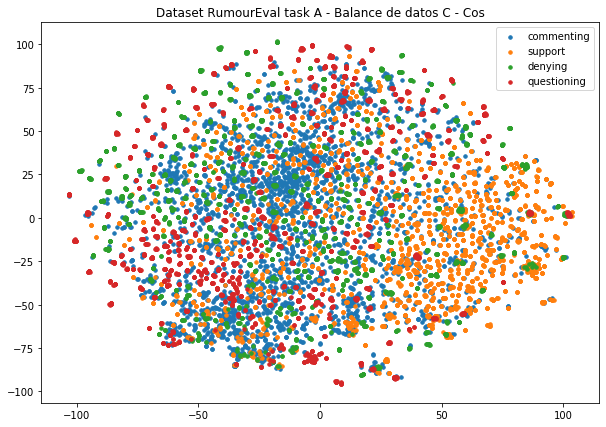

In [31]:
model = TSNE(2, metric='cosine')
to_plot_tsne = model.fit_transform(data_bas_c)    
plt.figure(figsize=(10,7))
for key in keys:
    labels=[dict_cl[lab] for lab in macro_augmented[:,2]]
    mask = np.asarray(labels)==key
    plt.scatter(to_plot_tsne[:,0][mask],to_plot_tsne[:,1][mask], s=12, label=str(key))

plt.legend()
plt.title("Dataset RumourEval task A - Balance de datos C - Cos - GloVe - Posible")
plt.show()

fig = plt.figure(figsize=(15,10))
j=220
for key in keys:
    labels=[dict_cl[lab] for lab in macro_augmented[:,2]]
    mask = np.asarray(labels)==key
    j+=1
    h=fig.add_subplot(j)
    plt.scatter(to_plot_tsne[:,0][mask],to_plot_tsne[:,1][mask], s=12, label=str(key))
    h.title.set_text(str(key))

fig.suptitle("Dataset RumourEval task A - Balance de datos C - Cos - GloVe - Posible", fontsize=14)
plt.show()

In [28]:
macro_augmented=[]
for clase in aum_weight:
    start_time=time.time()
    print ("\n\nGenerando", aum_weight[clase], "ejemplos para", clase)
    muestras, dict_aumentos=aumentar_clase(clase, aum_weight[clase], tags, prob, Neg=True)
    macro_augmented+=muestras
    print ("Resumen de modificaciones:", dict_aumentos)
    elapsed_time= time.time() - start_time
    print ("Este proceso tomó", elapsed_time, "seg")   



Generando 2404 ejemplos para questioning
Original: man  	Reemplazo:  [('sll', 1.1611428524822769)]
Sentencia original:
['user' 'user' 'whos' 'the' 'man' 'in' 'blk' ',']
Sentencia final: 2
['user', 'user', 'whos', 'the', 'sll', 'in', 'blk', ',']


Original: betty  	Reemplazo:  [('friend', 0.5510546242560717)]
Sentencia original:
['user' ',' 'hi' 'betty' '.' 'you' 'are' 'in' 'australia' '?']
Sentencia final: 2
['user', ',', 'hi', 'friend', '.', 'you', 'are', 'in', 'australia', '?']


Original: confusing  	Reemplazo:  [('being', 1.656111611214533)]
Original: media  	Reemplazo:  [('partners', 0.92909586944551)]
Original: department  	Reemplazo:  [('universal', 1.6437402732773572)]
Sentencia original:
['user' 'that' "'" 's' 'like' 'the' 'most' 'confusing' 'statement' 'ever'
 '.' 'the' 'social' 'media' 'department' 'of' 'uber' 'sydney' 'is' 'high'
 'or' 'something' '?']
Sentencia final: 2
['user', 'that', "'", 's', 'like', 'the', 'most', 'being', 'statement', 'ever', '.', 'the', 'social', 

Original: heard  	Reemplazo:  [('use', 0.6351296026983901)]
Sentencia original:
['user' 'cnn' 'too' 'i' 'have' 'heard' 'user' 'user']
Sentencia final: 2
['user', 'cnn', 'too', 'i', 'have', 'use', 'user', 'user']


Original: robbery  	Reemplazo:  [('story', 0.31094616916702483)]
Original: based  	Reemplazo:  [('done', 1.1989029452079267)]
Sentencia original:
['user' 'user' 'you' "'" 're' 'choosing' 'to' 'talk' 'about' 'a' '"'
 'robbery' '"' 'based' 'on' 'a' 'tape' 'that' 'only' 'shows' 'a'
 'confrontation' 'not' 'a' 'crime' '.' 'so' 'stop' '!']
Sentencia final: 2
['user', 'user', 'you', "'", 're', 'choosing', 'to', 'talk', 'about', 'a', '"', 'story', '"', 'done', 'on', 'a', 'tape', 'that', 'only', 'shows', 'a', 'confrontation', 'not', 'a', 'crime', '.', 'so', 'stop', '!']


Original: i  	Reemplazo:  [('need', 0.873933052790738)]
Original: answers  	Reemplazo:  [('people', 0.47064629761033794)]
Sentencia original:
['user' 'i' 'want' 'answers' 'why' 'did' 'i' 'get' 'netter' 'news' 'fom'
 

Original: was  	Reemplazo:  [('did', 0.6261409096312838)]
Sentencia original:
['user' 'user' 'why' 'was' 'this' 'mad' 'man' 'not' 'behind' 'bars' '?'
 'ugh']
Sentencia final: 2
['user', 'user', 'why', 'did', 'this', 'mad', 'man', 'not', 'behind', 'bars', '?', 'ugh']


Original: is  	Reemplazo:  [('has', 1.0078139326644329)]
Sentencia original:
['user' 'are' 'your' 'reporters' 'number' '%' 'sure' 'it' 'is' 'an' 'isis'
 'flag' '?' 'cause' 'that' 'is' 'what' 'is' 'being' 'reported' '.'
 'hashtag']
Sentencia final: 2
['user', 'are', 'your', 'reporters', 'number', '%', 'sure', 'it', 'is', 'an', 'isis', 'flag', '?', 'cause', 'that', 'has', 'what', 'is', 'being', 'reported', '.', 'hashtag']


Original: be  	Reemplazo:  [('say', 0.9197623957981229)]
Original: is  	Reemplazo:  [('does', 0.8207185070744254)]
Sentencia original:
['user' '.' 'isn' "'" 't' 'the' 'arabic' 'for' 'god' ',' 'allah' '?' 'so'
 'shouldn' "'" 't' 'it' 'be' '-' '"' 'there' 'is' 'no' 'god' 'but' 'the'
 'god' ',' 'muhammad' '

Original: dont  	Reemplazo:  [('seresta', 5.736855238552198)]
Sentencia original:
['user' 'user' 'user' 'user' 'hardly' ',' 'dont' 'hear' 'about' 'a'
 'school' 'shooting' 'or' 'spree' 'every' 'number' 'mins' 'do' 'we' '?']
Sentencia final: 2
['user', 'user', 'user', 'user', 'hardly', ',', 'seresta', 'hear', 'about', 'a', 'school', 'shooting', 'or', 'spree', 'every', 'number', 'mins', 'do', 'we', '?']


Original: good  	Reemplazo:  [('free', 1.3426723134729035)]
Sentencia original:
['user' 'good' ':' '-']
Sentencia final: 2
['user', 'free', ':', '-']


Original: explosion  	Reemplazo:  [('robbery', 3.7338300345374953)]
Sentencia original:
['user' 'again' ',' 'so' 'far' 'as' 'i' 'can' 'tell' ',' 'they' 'were'
 'worried' 'about' 'explosives' ',' 'and' 'it' 'appears' 'there' 'was'
 'an' 'explosion' '.']
Sentencia final: 2
['user', 'again', ',', 'so', 'far', 'as', 'i', 'can', 'tell', ',', 'they', 'were', 'worried', 'about', 'explosives', ',', 'and', 'it', 'appears', 'there', 'was', 'an', 'r

Original: don  	Reemplazo:  [('name', 0.3494741690637198)]
Sentencia original:
['user' 'user' 'don' '’' 't' 'they' 'mean' '“' 'siege' 'pricing' '"' '?']
Sentencia final: 2
['user', 'user', 'name', '’', 't', 'they', 'mean', '“', 'siege', 'pricing', '"', '?']


Original: reporting  	Reemplazo:  [('inadvertent', 2.3687314119944323)]
Sentencia original:
['user' 'u' 'r' 'just' 'now' 'reporting' 'on' 'this' '?' 'wow']
Sentencia final: 2
['user', 'u', 'r', 'just', 'now', 'inadvertent', 'on', 'this', '?', 'wow']


Original: betty  	Reemplazo:  [('friend', 0.5510546242560717)]
Sentencia original:
['user' ',' 'hi' 'betty' '.' 'you' 'are' 'in' 'australia' '?']
Sentencia final: 2
['user', ',', 'hi', 'friend', '.', 'you', 'are', 'in', 'australia', '?']


Original: terror  	Reemplazo:  [('possibility', 1.3618378335282488)]
Sentencia original:
['user' 'user' 'western' 'countries' 'have' 'killed' 'more' 'innocent'
 'children' 'than' 'hitler' 'assmunch' '.' 'but' 'you' 'prob' 'don' "'"
 't' 'consider' 

Original: gm  	Reemplazo:  [('cbs', 1.408142265076679)]
Sentencia original:
['.' 'user' 'conflicting' 'reports' 'regarding' 'a' 'possible' 'shooting'
 'on' 'near' 'the' 'centre' ',' 'but' 'your' 'gm' 'said' 'no' 'shooting'
 '.' 'can' 'you' 'clarify' 'at' 'all' '?']
Sentencia final: 2
['.', 'user', 'conflicting', 'updates', 'regarding', 'a', 'possible', 'shooting', 'on', 'near', 'the', 'centre', ',', 'but', 'your', 'cbs', 'said', 'no', 'shooting', '.', 'can', 'you', 'clarify', 'at', 'all', '?']


Original: deserved  	Reemplazo:  [('obliterated', 1.2759121518054002)]
Original: be  	Reemplazo:  [('get', 0.7378532561838819)]
Sentencia original:
['user' 'user' 'user' 'user' 'i' "'" 'm' 'not' 'arguing' 'that' 'he'
 'deserved' 'to' 'be' 'shot' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'i', "'", 'm', 'not', 'arguing', 'that', 'he', 'obliterated', 'to', 'get', 'shot', '.']


Original: don  	Reemplazo:  [('antonio', 1.279297232186716)]
Original: thank  	Reemplazo:  [('call', 0.624

Original: respect  	Reemplazo:  [('mal', 1.2278262624329885)]
Original: pictures  	Reemplazo:  [('pics', 1.1224998666031714)]
Sentencia original:
['user' 'user' 'out' 'of' 'respect' 'for' 'his' 'family' 'could' 'cnn'
 'please' 'stop' 'showing' 'pictures' 'and' 'video' 'of' 'people'
 'performing' 'cpr' 'on' 'him' '?']
Sentencia final: 2
['user', 'user', 'out', 'of', 'mal', 'for', 'his', 'family', 'could', 'cnn', 'please', 'stop', 'showing', 'pics', 'and', 'video', 'of', 'people', 'performing', 'cpr', 'on', 'him', '?']


Original: islam  	Reemplazo:  [('muslim', 0.9073665087847856)]
Sentencia original:
['user' 'is' 'he' 'consider' 'as' 'terrorist' 'or' 'just' 'a' 'criminal'
 'person' 'as' 'his' 'faith' 'not' 'sunni' 'islam' '?']
Sentencia final: 2
['user', 'is', 'he', 'consider', 'as', 'terrorist', 'or', 'just', 'a', 'criminal', 'person', 'as', 'his', 'faith', 'not', 'sunni', 'muslim', '?']


Original: have  	Reemplazo:  [('know', 1.5618891790938427)]
Original: is  	Reemplazo:  [('does',

Original: true  	Reemplazo:  [('military', 1.5487259134704354)]
Original: know  	Reemplazo:  [('consider', 2.083201853230033)]
Sentencia original:
['user' 'user' 'extremist' 'rather' ',' 'no' 'true' 'muslim' 'will' 'do'
 'such' 'nonsense' 'act' '!' 'the' 'world' 'should' 'know' 'this' 'by'
 'now' '.']
Sentencia final: 2
['user', 'user', 'extremist', 'rather', ',', 'no', 'military', 'muslim', 'will', 'do', 'such', 'nonsense', 'act', '!', 'the', 'world', 'should', 'consider', 'this', 'by', 'now', '.']


Original: i  	Reemplazo:  [('jeez', 0.9531477346141161)]
Sentencia original:
['user' 'thank' 'you' ',' 'shiraz' '.' 'i' 'understand' '.' 'what' 'do'
 'you' 'each' 'think' 'about' 'all' 'this' '?' 'what' 'is' 'your'
 'reaction' '?' 'user']
Sentencia final: 2
['user', 'thank', 'you', ',', 'shiraz', '.', 'jeez', 'understand', '.', 'what', 'do', 'you', 'each', 'think', 'about', 'all', 'this', '?', 'what', 'is', 'your', 'reaction', '?', 'user']


Original: everything  	Reemplazo:  [('world', 0

Original: trial  	Reemplazo:  [('jury', 1.488260031459678)]
Sentencia original:
['user' 'user' 'killers' '?' 'no' 'trial' '?' 'can' 'you' 'please'
 'provide' 'the' 'evidence' 'that' 'these' 'people' 'were' 'involved' 'in'
 'hashtag']
Sentencia final: 2
['user', 'user', 'killers', '?', 'no', 'jury', '?', 'can', 'you', 'please', 'provide', 'the', 'evidence', 'that', 'these', 'people', 'were', 'involved', 'in', 'hashtag']


Original: man  	Reemplazo:  [('dude', 1.2873361309244966)]
Sentencia original:
['user' 'user' 'whos' 'the' 'man' 'in' 'blk' ',']
Sentencia final: 2
['user', 'user', 'whos', 'the', 'dude', 'in', 'blk', ',']


Original: don  	Reemplazo:  [('assad', 1.0485118670096611)]
Original: t  	Reemplazo:  [('prince', 1.8650322412971516)]
Original: america  	Reemplazo:  [('hitler', 1.2234121069455024)]
Sentencia original:
['user' 'user' 'maintain' 'high' 'level' 'of' 'vigilance' '?' 'against'
 'who' '?' 'obama' 'said' 'islamic' 'terrorists' 'don' "'" 't' 'exist'
 'in' 'america' 'rem

Original: isil  	Reemplazo:  [('seresta', 0.6573149151888442)]
Original: banfield  	Reemplazo:  [('wilson', 0.6220418822753342)]
Sentencia original:
['user' 'there' 'is' 'no' 'proof' 'yet' 'that' 'the' 'shooter' 's' 'has'
 'anything' 'to' 'do' 'with' 'isil' 'but' 'a' 'banfield' '&amp' ';' 'cnn'
 'are' 'already' 'dropping' 'that' 'scare' 'message']
Sentencia final: 2
['user', 'there', 'is', 'no', 'proof', 'yet', 'that', 'the', 'shooter', 'think', 'makes', 'anything', 'to', 'take', 'with', 'seresta', 'but', 'a', 'wilson', '&amp', ';', 'cnn', 'are', 'already', 'dropping', 'that', 'scare', 'message']


Original: criminal  	Reemplazo:  [('bad', 1.14306045043041)]
Original: person  	Reemplazo:  [('convenient', 1.2555736512334665)]
Sentencia original:
['user' 'is' 'he' 'consider' 'as' 'terrorist' 'or' 'just' 'a' 'criminal'
 'person' 'as' 'his' 'faith' 'not' 'sunni' 'islam' '?']
Sentencia final: 2
['user', 'is', 'he', 'consider', 'as', 'terrorist', 'or', 'just', 'a', 'bad', 'convenient', 'as',

Original: cirillo  	Reemplazo:  [('website', 0.4983163661828834)]
Sentencia original:
['hashtag' 'rt' 'user' ':' 'soldier' 'killed' 'at' 'war' 'memorial'
 'identified' 'as' 'cpl' '.' 'nathan' 'cirillo' 'hashtag' 'html']
Sentencia final: 0
['hashtag', 'rt', 'user', ':', 'soldier', 'killed', 'at', 'war', 'memorial', 'identified', 'as', 'cpl', '.', 'nathan', 'website', 'hashtag', 'html']


Original: cops  	Reemplazo:  [('streets', 0.6496367887730025)]
Sentencia original:
['user' 'oh' 'please' 'cnn' 'cut' 'the' 'bullshit' 'them' 'dirty' 'ass'
 'cops' 'will' 'say' 'anything']
Sentencia final: 0
['user', 'oh', 'please', 'cnn', 'cut', 'the', 'bullshit', 'them', 'dirty', 'ass', 'streets', 'will', 'say', 'anything']


Original: cafe  	Reemplazo:  [('café', 0.8479974158122738)]
Sentencia original:
['“' 'user' ':' 'live' 'updates' ':' 'siege' 'in' 'sydney' 'cafe' 'html']
Sentencia final: 0
['“', 'user', ':', 'live', 'updates', ':', 'siege', 'in', 'sydney', 'café', 'html']


Original: police  	Ree

Sentencia original:
['first' 'photos' ':' 'hostage' 'pressed' 'against' 'a' 'window' '.'
 'hashtag' 'html']
Sentencia final: 0
['first', 'rides', ':', 'hostage', 'pressed', 'against', 'a', 'haron', '.', 'hashtag', 'html']


Original: read  	Reemplazo:  [('tweet', 0.9566443167969162)]
Sentencia original:
['user' 'yes' ',' 'you' 'read' 'that' 'right' '.' 'click' 'the' 'link'
 'and' 'read' 'the' 'whole' 'thing']
Sentencia final: 0
['user', 'yes', ',', 'you', 'read', 'that', 'right', '.', 'click', 'the', 'link', 'and', 'tweet', 'the', 'whole', 'thing']


Original: have  	Reemplazo:  [('know', 0.3152197163401071)]
Original: media  	Reemplazo:  [('fans', 0.9821107635077047)]
Original: escaped  	Reemplazo:  [('surrounded', 0.7697301550033737)]
Sentencia original:
['user' 'hope' 'the' 'baddies' 'don' '’' 't' 'have' 'social' 'media' 'or'
 'they' '’' 're' 'gonna' 'start' 'locking' 'the' 'side' 'doors' 'people'
 'escaped' 'from' '.']
Sentencia final: 0
['user', 'hope', 'the', 'baddies', 'don', '’

Original: hostages  	Reemplazo:  [('people', 0.4486819441405273)]
Original: were  	Reemplazo:  [('was', 0.9069016086047871)]
Sentencia original:
['“' 'user' ':' 'police' 'taking' 'people' 'out' 'of' 'hashtag' 'grocery'
 'where' 'hostages' 'were' 'being' 'held' '.' 'html']
Sentencia final: 0
['“', 'user', ':', 'police', 'dealing', 'people', 'out', 'of', 'hashtag', 'grocery', 'where', 'people', 'was', 'being', 'held', '.', 'html']


Original: fbi  	Reemplazo:  [('investigation', 1.0194130830242378)]
Original: have  	Reemplazo:  [('appear', 0.9070053895952533)]
Sentencia original:
['fbi' 'assisting' 'in' 'the' 'case' 'of' 'the' 'ottawa' 'shooting' ','
 'sources' 'have' 'confirmed' 'to' 'ctv' 'news']
Sentencia final: 0
['investigation', 'assisting', 'in', 'the', 'case', 'of', 'the', 'ottawa', 'shooting', ',', 'sources', 'appear', 'confirmed', 'to', 'ctv', 'news']


Original: set  	Reemplazo:  [('assassinate', 0.7661640624443333)]
Sentencia original:
['snipers' 'set' 'up' 'on' 'national' 'a

Original: vi  	Reemplazo:  [('min', 0.7589178249532326)]
Sentencia original:
['rt' 'user' ':' 'banksy' 'says' 'hashtag' 'in' 'a' 'beautiful' 'way' 'vi'
 'user' 'html']
Sentencia final: 0
['rt', 'user', ':', 'banksy', 'faces', 'hashtag', 'in', 'a', 'beautiful', 'love', 'min', 'user', 'html']


Original: number  	Reemplazo:  [('send', 0.6067438605189551)]
Sentencia original:
['“' 'user' ':' 'report' ':' 'hashtag' 'police' 'beat' 'up' 'wrong'
 'suspect' 'then' 'charged' 'him' 'for' 'getting' 'blood' 'on' 'uniforms'
 'in' 'number' 'html']
Sentencia final: 0
['“', 'user', ':', 'report', ':', 'hashtag', 'police', 'beat', 'up', 'wrong', 'suspect', 'then', 'charged', 'him', 'for', 'getting', 'blood', 'on', 'uniforms', 'in', 'send', 'html']


Original: hat  	Reemplazo:  [('shop', 0.4027012539012236)]
Original: store  	Reemplazo:  [('outfit', 0.8043966917198736)]
Original: pic  	Reemplazo:  [('nada', 1.492819662730225)]
Sentencia original:
['.' 'user' 'yes' '.' 'they' 'don' "'" 't' 'match' '.' '

Original: family  	Reemplazo:  [('thing', 0.3732653112906437)]
Original: says  	Reemplazo:  [('makes', 0.8075247740684995)]
Sentencia original:
['user' 'hashtag' 'needs' 'to' 'hashtag' 'html' 'hashtag' 'brown' 'family'
 'says' ',' 'hashtag' 'hashtag' 'they' "'" 're' 'right']
Sentencia final: 0
['user', 'hashtag', 'needs', 'to', 'hashtag', 'html', 'hashtag', 'brown', 'thing', 'makes', ',', 'hashtag', 'hashtag', 'they', "'", 're', 'right']


Original: service  	Reemplazo:  [('toronto', 0.7314595323307201)]
Original: gunmen  	Reemplazo:  [('people', 0.22595392762157387)]
Original: war  	Reemplazo:  [('london', 0.47956370356319233)]
Original: shooting  	Reemplazo:  [('going', 0.3884945613480327)]
Sentencia original:
['ottawa' 'police' 'service' ':' 'there' 'were' '"' 'numerous' 'gunmen'
 '"' 'at' 'the' 'canada' 'war' 'memorial' 'shooting' '.' 'one' 'person'
 'was' 'shot' '.' 'html']
Sentencia final: 0
['ottawa', 'police', 'toronto', ':', 'there', 'were', '"', 'numerous', 'people', '"', 'at

Original: s  	Reemplazo:  [('shot', 0.2648177903647362)]
Original: muhammad  	Reemplazo:  [('prophet', 0.4043926463781239)]
Sentencia original:
['gunman' "'" 's' 'headband' 'reads' ',' '"' 'we' 'are' 'your' 'soldiers'
 'o' 'muhammad' '"' '.' 'hashtag' 'hashtag' 'html']
Sentencia final: 0
['gunman', "'", 'shot', 'headband', 'reads', ',', '"', 'we', 'are', 'your', 'soldiers', 'o', 'prophet', '"', '.', 'hashtag', 'hashtag', 'html']


Original: wilson  	Reemplazo:  [('told', 0.6829097625086257)]
Original: road  	Reemplazo:  [('shit', 1.1816076628902696)]
Sentencia original:
['question' 'for' 'hashtag' 'police' 'chief' '?' 'if' 'officer' 'darren'
 'wilson' 'was' 'in' 'pursuit' 'of' 'a' 'robbery' 'suspect' ',' 'why'
 'tell' 'kids' 'to' 'get' 'out' 'of' 'the' 'road' '?' 'lie']
Sentencia final: 0
['question', 'for', 'hashtag', 'police', 'chief', '?', 'if', 'officer', 'darren', 'told', 'was', 'in', 'pursuit', 'of', 'a', 'robbery', 'suspect', ',', 'why', 'tell', 'kids', 'to', 'get', 'out', 'of',

Original: wave  	Reemplazo:  [('world', 0.23516088158680903)]
Sentencia original:
['“' 'user' ':' 'breaking' 'news' ':' 'gunmen' 'take' 'hostages' 'at'
 'sydney' 'cafe' ',' 'wave' 'islamic' 'flag' 'html' 'html' 'smhhhh']
Sentencia final: 0
['“', 'user', ':', 'breaking', 'news', ':', 'gunmen', 'take', 'hostages', 'at', 'sydney', 'cafe', ',', 'world', 'islamic', 'flag', 'html', 'html', 'smhhhh']


Original: been  	Reemplazo:  [('ignored', 1.2095721939192572)]
Sentencia original:
['user' 'anon' 'has' 'been' 'pretty' 'awful' 'through' 'this' 'whole'
 'thing' '.']
Sentencia final: 0
['user', 'anon', 'has', 'ignored', 'pretty', 'awful', 'through', 'this', 'whole', 'thing', '.']


Original: police  	Reemplazo:  [('yes', 1.3394608938625427)]
Original: said  	Reemplazo:  [('got', 0.9034356083176937)]
Original: riots  	Reemplazo:  [('people', 0.8175980994810197)]
Sentencia original:
['user' 'user' 'alasscan' 'it' "'" 's' 'a' 'lie' '.' 'pics' 'are' 'fake'
 '.' 'no' 'robbery' 'was' 'reported' '!' 

Original: siege  	Reemplazo:  [('reservist', 1.7682997285574862)]
Original: plot  	Reemplazo:  [('meaning', 0.7358678542325212)]
Sentencia original:
['rt' '“' 'user' ':' 'the' 'sydney' 'cafe' 'siege' 'may' 'be' 'part' 'of'
 'a' 'larger' 'plot' '.' 'hashtag' 'html' 'html']
Sentencia final: 0
['rt', '“', 'user', ':', 'the', 'sydney', 'cafe', 'reservist', 'may', 'be', 'part', 'of', 'a', 'larger', 'meaning', '.', 'hashtag', 'html', 'html']


Original: injured  	Reemplazo:  [('indefensible', 1.9566651191805189)]
Sentencia original:
['user' 'number' 'number' 'journalists' 'and' 'number' 'policemen'
 'killed' 'and' 'number' 'injured' '.' 'moreover' 'witnesses' 'affirm'
 'that' 'they' 'said' '"' 'we' "'" 're' 'gonna' 'avenge' 'our' 'prophet'
 '"']
Sentencia final: 0
['user', 'number', 'number', 'journalists', 'and', 'number', 'policemen', 'killed', 'and', 'number', 'indefensible', '.', 'moreover', 'witnesses', 'affirm', 'that', 'they', 'said', '"', 'we', "'", 're', 'gonna', 'avenge', 'our', 'p

Original: traveller  	Reemplazo:  [('jihad', 0.6769124378614321)]
Sentencia original:
['breaking' ':' 'michael' 'zehaf' '-' 'bebeau' 'had' 'been' 'designated'
 '"' 'high' '-' 'risk' 'traveller' '"' 'by' 'cdn' 'govt' ',' 'which'
 'confiscated' 'his' 'passport' 'html']
Sentencia final: 0
['breaking', ':', 'michael', 'zehaf', '-', 'bebeau', 'had', 'been', 'designated', '"', 'high', '-', 'top', 'jihad', '"', 'by', 'cdn', 'govt', ',', 'which', 'confiscated', 'his', 'passport', 'html']


Original: reserves  	Reemplazo:  [('teams', 0.30623843891956887)]
Original: men  	Reemplazo:  [('fans', 1.6998088097182582)]
Sentencia original:
['user' 'user' 'so' 'honoured' 'to' 'serve' 'as' 'honorary' 'colonel' 'in'
 'reserves' '.' 'job' 'is' 'to' 'honour' 'citizen' 'soldiers' 'like'
 'these' 'brave' 'men' '.']
Sentencia final: 0
['user', 'user', 'so', 'honoured', 'to', 'serve', 'as', 'honorary', 'colonel', 'in', 'teams', '.', 'job', 'is', 'to', 'honour', 'citizen', 'soldiers', 'like', 'these', 'brave', 

Original: are  	Reemplazo:  [('am', 0.9233842502580738)]
Original: god  	Reemplazo:  [('muslim', 1.7261175015121126)]
Original: kill  	Reemplazo:  [('mother', 0.6308945535995909)]
Sentencia original:
['user' 'user' 'why' 'muslims' 'killed' 'non' '-' 'muslims' '?' 'why'
 'muslims' 'are' 'not' 'afraid' 'of' 'mighty' 'god' '?' 'why' 'god' 'of'
 'muslims' 'is' 'cruel' 'and' 'say' 'kill' 'infidel' '?']
Sentencia final: 0
['user', 'user', 'why', 'muslims', 'killed', 'non', '-', 'muslims', '?', 'why', 'muslims', 'am', 'not', 'afraid', 'of', 'mighty', 'god', '?', 'why', 'muslim', 'of', 'muslims', 'is', 'cruel', 'and', 'say', 'mother', 'infidel', '?']


Original: soldier  	Reemplazo:  [('canadian', 0.5100023249462788)]
Original: hamilton  	Reemplazo:  [('ottawa', 0.4520821831633832)]
Sentencia original:
['breaking' ':' 'a' 'source' 'confirms' 'to' 'cp24' 'that' 'the'
 'deceased' 'soldier' 'in' 'ottawa' 'is' 'cpl' '.' 'nathan' 'cirillo' '.'
 'cirillo' 'was' 'a' 'member' 'of' 'the' 'hamilton' 'ar

Original: policewoman  	Reemplazo:  [('wsy', 1.468633250941526)]
Sentencia original:
['hashtag' 'hashtag' 'connexion' ';' 'policewoman' ';' 'market' 'user' ':'
 'police' ':' 'suspects' 'thurs' 'montrouge' 'shooting' 'html']
Sentencia final: 0
['hashtag', 'hashtag', 'connexion', ';', 'wsy', ';', 'market', 'user', ':', 'police', ':', 'suspects', 'thurs', 'montrouge', 'shooting', 'html']


Original: safe  	Reemplazo:  [('strong', 0.5537118578242953)]
Sentencia original:
['user' 'stay' 'safe' ',' 'matt' '.']
Sentencia final: 0
['user', 'stay', 'strong', ',', 'matt', '.']


Original: wave  	Reemplazo:  [('world', 0.23516088158680903)]
Original: flag  	Reemplazo:  [('manipulation', 0.6077736735834393)]
Sentencia original:
['hashtag' 'news' ':' 'gunmen' 'take' 'hostages' 'at' 'sydney' 'cafe' ','
 'wave' 'islamic' 'flag' 'html' 'html' 'via' 'user']
Sentencia final: 0
['hashtag', 'news', ':', 'gunmen', 'take', 'hostages', 'at', 'sydney', 'cafe', ',', 'world', 'islamic', 'manipulation', 'html', 

Original: speculation  	Reemplazo:  [('thing', 0.37213526138349967)]
Sentencia original:
['user' 'speculation' 'is' 'not' 'journalism']
Sentencia final: 1
['user', 'thing', 'is', 'not', 'journalism']


Original: claims  	Reemplazo:  [('shows', 0.4582209719953094)]
Sentencia original:
['putin' 'reappears' 'on' 'tv' 'amid' 'claims' 'he' 'is' 'unwell' 'and'
 'under' 'threat' 'of' 'coup' 'html' 'html']
Sentencia final: 1
['putin', 'reappears', 'on', 'tv', 'amid', 'shows', 'he', 'is', 'unwell', 'and', 'under', 'threat', 'of', 'coup', 'html', 'html']


Original: alive  	Reemplazo:  [('open', 1.3334594323206757)]
Original: new  	Reemplazo:  [('great', 1.9173882384319008)]
Sentencia original:
['user' 'user' 'new' 'report' 'indicates' 'he' 'is' 'alive' 'but'
 'obviously' 'gravely' 'injured' '.' 'i' "'" 'm' 'not' 'sure' 'where'
 'new' 'york' 'times' 'got' 'that' '.']
Sentencia final: 1
['user', 'user', 'new', 'report', 'indicates', 'he', 'is', 'open', 'but', 'obviously', 'gravely', 'injured', '.

Original: stay  	Reemplazo:  [('gotta', 0.8566425766728597)]
Sentencia original:
['user' 'we' 'won' "'" 't' 'agree' 'on' 'this' 'and' 'that' "'" 's' 'okay'
 '.' 'if' 'you' "'" 're' 'in' 'ottawa' 'stay' 'safe' '.']
Sentencia final: 1
['user', 'we', 'won', "'", 't', 'agree', 'on', 'this', 'and', 'that', "'", 's', 'okay', '.', 'if', 'you', "'", 're', 'in', 'ottawa', 'gotta', 'safe', '.']


Original: video  	Reemplazo:  [('check', 0.6779457968478144)]
Sentencia original:
['user' 'user' 'nothing' 'in' 'that' 'video' 'provides' 'concrete'
 'evidence' 'of' 'anything' ',' 'much' 'less' 'any' 'kind' 'of'
 'justification' 'for' 'cops' 'murdering' 'anyone' '.']
Sentencia final: 1
['user', 'user', 'nothing', 'in', 'that', 'check', 'provides', 'concrete', 'evidence', 'of', 'anything', ',', 'much', 'less', 'any', 'kind', 'of', 'justification', 'for', 'cops', 'murdering', 'anyone', '.']


Original: week  	Reemplazo:  [('previsível', 2.57743975750858)]
Sentencia original:
['user' 'user' 'u' 'win' '.' 

Original: fact  	Reemplazo:  [('tweet', 0.8840254187504766)]
Sentencia original:
['user' 'there' 'are' 'not' 'number' 'hostages' ',' 'don' "'" 't' 'know'
 'really' 'know' 'if' 'terrorist' 'or' 'not' ',' 'stop' 'spreading'
 'speculation' 'as' 'fact' '.' 'hashtag']
Sentencia final: 1
['user', 'there', 'are', 'not', 'number', 'hostages', ',', 'don', "'", 't', 'know', 'really', 'know', 'if', 'muslim', 'or', 'not', ',', 'stop', 'spreading', 'speculation', 'as', 'tweet', '.', 'hashtag']


Original: scene  	Reemplazo:  [('story', 0.5463578834510717)]
Sentencia original:
['user' 'user' 'ottawa' 'police' 'have' 'not' 'confirmed' 'multiple'
 'shooters' 'based' 'on' 'canadian' 'reporters' 'on' 'scene' 'but' 'they'
 'are' 'still' 'looking' 'in' 'case']
Sentencia final: 1
['user', 'user', 'ottawa', 'police', 'have', 'not', 'confirmed', 'multiple', 'shooters', 'based', 'on', 'canadian', 'reporters', 'on', 'story', 'but', 'they', 'are', 'still', 'looking', 'in', 'case']


Original: give  	Reemplazo: 

Original: good  	Reemplazo:  [('surprised', 0.7214532698986417)]
Sentencia original:
['user' 'user' 'the' 'liberal' 'leftist' 'should' 'be' 'feeling' 'as'
 'good' 'as' 'deblasio' 'today' 'over' 'this' '.']
Sentencia final: 1
['user', 'user', 'the', 'liberal', 'leftist', 'should', 'be', 'feeling', 'as', 'surprised', 'as', 'deblasio', 'today', 'over', 'this', '.']


Original: pencils  	Reemplazo:  [('accounts', 0.36361131249667794)]
Original: cartoonists  	Reemplazo:  [('journalists', 0.4272607228471546)]
Sentencia original:
['user' 'user' 'pencils' 'as' 'number' '-' 'number' '?' 'all' 'the'
 'cartoon' 'responses' 'are' 'cartoonists' 'as' 'victims' '.' 'where' "'"
 's' 'the' 'defiance' '?']
Sentencia final: 1
['user', 'user', 'accounts', 'as', 'number', '-', 'number', '?', 'all', 'the', 'cartoon', 'responses', 'are', 'journalists', 'as', 'victims', '.', 'where', "'", 's', 'the', 'defiance', '?']


Original: twisted  	Reemplazo:  [('neutralized', 1.1620788202132504)]
Sentencia original:
[

Original: chief  	Reemplazo:  [('told', 0.6503865012719384)]
Original: robbery  	Reemplazo:  [('reenter', 14.249829175763406)]
Original: kid  	Reemplazo:  [('rt', 1.402688276357682)]
Original: bs  	Reemplazo:  [('akbar', 1.4846095081111206)]
Sentencia original:
['oh' '.' 'so' 'now' 'the' 'hashtag' 'police' 'chief' 'says' 'the' 'cop'
 'didn' "'" 't' 'know' 'about' 'the' 'robbery' 'when' 'he' 'stopped'
 'hashtag' '.' 'the' 'kid' 'was' '"' 'jaywalking' '"' '?' 'bs' '!']
Sentencia final: 1
['oh', '.', 'so', 'now', 'the', 'hashtag', 'protests', 'told', 'says', 'the', 'cop', 'didn', "'", 't', 'know', 'about', 'the', 'reenter', 'when', 'he', 'stopped', 'hashtag', '.', 'the', 'rt', 'was', '"', 'jaywalking', '"', '?', 'akbar', '!']


Original: offense  	Reemplazo:  [('offence', 0.8485370764821704)]
Sentencia original:
['user' 'user' ':' 'please' 'take' 'no' 'offense' 'to' 'my' 'analogy' '.'
 'hashtag' 'is' 'like' 'something' 'from' "'" 'deliverance' '.' 'html']
Sentencia final: 1
['user', 'user

Original: heard  	Reemplazo:  [('yer', 0.8261294118797224)]
Original: people  	Reemplazo:  [('knew', 2.021211803996091)]
Sentencia original:
['user' 'i' 'think' 'it' "'" 's' 'number' 'injured' '.' 'i' 'can' "'" 't'
 'believe' 'this' 'is' 'happening' '.' 'i' "'" 've' 'also' 'heard'
 'number' 'people' 'have' 'died']
Sentencia final: 1
['user', 'i', 'think', 'it', "'", 's', 'number', 'injured', '.', 'i', 'can', "'", 't', 'believe', 'this', 'comes', 'happening', '.', 'i', "'", 've', 'also', 'yer', 'number', 'knew', 'have', 'died']


Original: tweets  	Reemplazo:  [('accounts', 0.8432983293582603)]
Original: higher  	Reemplazo:  [('worse', 0.5027068354070563)]
Original: standards  	Reemplazo:  [('values', 0.40783591861904195)]
Sentencia original:
['user' ';' 'several' 'of' 'your' 'tweets' 'are' 'either' 'wrong' 'or'
 'misleading' '.' 'please' 'hold' 'yourself' 'to' 'higher' 'journalism'
 'standards' '!']
Sentencia final: 1
['user', ';', 'several', 'of', 'your', 'accounts', 'are', 'either', 

Original: wow  	Reemplazo:  [('parliment', 1.342102221283466)]
Original: was  	Reemplazo:  [('had', 1.0598325057380016)]
Original: info  	Reemplazo:  [('told', 0.9027672858391687)]
Sentencia original:
['user' 'wow' 'and' 'you' 'were' 'so' 'sure' 'there' 'was' 'no'
 'connection' 'despite' 'having' 'no' 'info' '.' 'tell' 'us' 'the' 'news'
 'not' 'your' 'view' 'as' 'news' '.' 'numpties' '.']
Sentencia final: 1
['user', 'parliment', 'and', 'you', 'were', 'so', 'sure', 'there', 'had', 'no', 'connection', 'despite', 'having', 'no', 'told', '.', 'tell', 'us', 'the', 'news', 'not', 'your', 'view', 'as', 'news', '.', 'numpties', '.']


Original: press  	Reemplazo:  [('doj', 1.318850884255668)]
Sentencia original:
['user' 'that' "'" 's' 'not' 'what' 'they' 'just' 'said' 'at' 'the'
 'press' 'conference' '!']
Sentencia final: 1
['user', 'that', "'", 's', 'not', 'what', 'they', 'just', 'said', 'at', 'the', 'doj', 'conference', '!']


Original: get  	Reemplazo:  [('be', 0.7948333948296702)]
Original

Original: head  	Reemplazo:  [('cherif', 1.5329703291806749)]
Sentencia original:
['user' 'dick' 'head' 'it' "'" 's' 'not' 'confirmed' 'its' 'jihadist'
 'extremists' '.' 'don' "'" 't' 'speculate']
Sentencia final: 1
['user', 'dick', 'cherif', 'it', "'", 's', 'not', 'confirmed', 'its', 'jihadist', 'extremists', '.', 'don', "'", 't', 'speculate']


Original: take  	Reemplazo:  [('give', 0.8835899084469199)]
Sentencia original:
['user' 'user' 'apparently' 'a' 'hoax' '.' 'best' 'to' 'take' 'tweet'
 'down' '.']
Sentencia final: 1
['user', 'user', 'apparently', 'a', 'hoax', '.', 'best', 'to', 'give', 'tweet', 'down', '.']


Original: intermediary  	Reemplazo:  [('systemic', 0.44413044366482846)]
Sentencia original:
['user' 'user' 'i' "'" 'm' 'fascinated' 'by' 'ray' 'hadley' "'" 's' 'role'
 'in' 'hashtag' '.' 'genuine' 'intermediary' 'or' 'opportunistic'
 'blowhard' '?']
Sentencia final: 1
['user', 'user', 'i', "'", 'm', 'fascinated', 'by', 'ray', 'hadley', "'", 's', 'role', 'in', 'hashtag', 

Original: gunman  	Reemplazo:  [('york', 0.3782158567464777)]
Sentencia original:
['“' 'user' ':' 'breaking' ':' 'gunman' 'at' 'paris' 'store' 'threatens'
 'to' 'kill' 'hostages' 'if' 'hashtag' 'suspects' 'are' 'harmed' '.'
 'html' 'smh']
Sentencia final: 1
['“', 'user', ':', 'breaking', ':', 'york', 'at', 'paris', 'store', 'threatens', 'to', 'kill', 'hostages', 'if', 'hashtag', 'suspects', 'are', 'harmed', '.', 'html', 'smh']


Original: fuck  	Reemplazo:  [('reenter', 6.7790220064615685)]
Original: internet  	Reemplazo:  [('google', 0.8179850797246195)]
Original: opinion  	Reemplazo:  [('decision', 1.598000934031412)]
Original: same  	Reemplazo:  [('specific', 2.438877490406882)]
Sentencia original:
['user' 'user' 'how' 'about' 'you' 'fuck' 'off' 'back' 'to' 'your'
 'corner' 'of' 'the' 'internet' 'where' 'your' 'opinion' 'matters' 'and'
 'i' "'" 'll' 'do' 'the' 'same' '.']
Sentencia final: 1
['user', 'user', 'how', 'about', 'you', 'reenter', 'off', 'back', 'to', 'your', 'corner', 'of

Original: saw  	Reemplazo:  [('think', 0.579566218008869)]
Original: number  	Reemplazo:  [('queda', 3.323822290998215)]
Original: concert  	Reemplazo:  [('thing', 0.691177560257239)]
Sentencia original:
['user' 'i' 'saw' 'prince' 'in' 'concert' 'number' 'years' 'ago' 'in'
 'halifax' 'and' 'honestly' ',' 'was' 'the' 'most' 'boring' 'concert'
 'ever' '!' 'was' 'so' 'disappointed']
Sentencia final: 1
['user', 'i', 'think', 'prince', 'in', 'concert', 'queda', 'years', 'ago', 'in', 'halifax', 'and', 'honestly', ',', 'was', 'the', 'most', 'boring', 'thing', 'ever', '!', 'was', 'so', 'disappointed']


Original: deadline  	Reemplazo:  [('offer', 0.22259353487804054)]
Original: obamacare  	Reemplazo:  [('offer', 0.29910695179100727)]
Original: health  	Reemplazo:  [('latika', 2.8941982779112414)]
Sentencia original:
['user' 'user' '*' 'us' 'citizens' '!' '!' 'number' ':' 'fbruary' 'number'
 '.' 'health' 'insurance' 'deadline' 'obamacare' 'register' 'and' 'go'
 'to' 'the' 'hospital' 'to' 'get' 

In [29]:
#macro_augmented = np.asarray(macro_augmented, dtype=object)
np.random.shuffle(macro_augmented)
np.save('../Datasets/CSV_Stance/balance_clase_noPon_GloVe.npy', macro_augmented)

In [ ]:
data_bas_cpn=[]
#macro_augmented=np.asarray(macro_augmented)
macro_augmented=np.load('../Datasets/CSV_Stance/balance_clase_noPon_GloVe.npy', allow_pickle=True)
for tweet in macro_augmented[:,1]:
    try: 
        vector= bc.encode([tweet])[0]
    except:
        tw=' '.join([word for word in tweet])
        vector= bc.encode([tw])[0]
    data_bas_cpn.append(vector)
    
model = TSNE(2, metric='cosine')
to_plot_tsne = model.fit_transform(data_bas_cpn)    
plt.figure(figsize=(10,7))
for key in keys:
    labels=[dict_cl[lab] for lab in macro_augmented[:,2]]
    mask = np.asarray(labels)==key
    plt.scatter(to_plot_tsne[:,0][mask],to_plot_tsne[:,1][mask], s=12, label=str(key))

plt.legend()
plt.title("Dataset RumourEval task A - Balance de datos C - Cos - GloVe - P+N")
plt.show()

fig = plt.figure(figsize=(15,10))
j=220
for key in keys:
    labels=[dict_cl[lab] for lab in macro_augmented[:,2]]
    mask = np.asarray(labels)==key
    j+=1
    h=fig.add_subplot(j)
    plt.scatter(to_plot_tsne[:,0][mask],to_plot_tsne[:,1][mask], s=12, label=str(key))
    h.title.set_text(str(key))

fig.suptitle("Dataset RumourEval task A - Balance de datos C - Cos - GloVe - P+N", fontsize=14)
plt.show()

### Sujeto a Clase ponderando target

In [30]:
macro_augmented=[]
for clase in aum_weight:
    start_time=time.time()
    print ("\n\nGenerando", aum_weight[clase], "ejemplos para", clase)
    muestras, dict_aumentos=aumentar_clase(clase, aum_weight[clase], tags, prob, pond=True)
    macro_augmented+=muestras
    print ("Resumen de modificaciones:", dict_aumentos)
    elapsed_time= time.time() - start_time
    print ("Este proceso tomó", elapsed_time, "seg")   



Generando 2404 ejemplos para questioning
Original: hurt  	Reemplazo:  [('gelukkig', 2.7828359369281404)]
Sentencia original:
['user' 'hoping' 'for' 'a' 'safe' 'and' 'speedy' 'resolution' '.'
 'praying' 'no' 'one' 'is' 'hurt' 'but' 'that' 'seems' 'unlikely'
 'considering' '.']
Sentencia final: 2
['user', 'hoping', 'for', 'a', 'safe', 'and', 'speedy', 'resolution', '.', 'praying', 'no', 'one', 'is', 'gelukkig', 'but', 'that', 'seems', 'unlikely', 'considering', '.']


Original: cigars  	Reemplazo:  [('swishers', 2.622045663899433)]
Original: s  	Reemplazo:  [('prudent', 1.279285368637196)]
Sentencia original:
['user' 'right' '.' 'so' 'he' 'did' 'that' 'for' 'cigars' '?' 'i' 'know'
 'i' 'need' 'to' 'sit' 'and' 'read' 'report' '.' 'what' "'" 's' 'your'
 'thoughts' 'on' 'sll' 'this']
Sentencia final: 2
['user', 'right', '.', 'so', 'he', 'did', 'that', 'for', 'swishers', '?', 'i', 'know', 'i', 'need', 'to', 'sit', 'and', 'read', 'report', '.', 'what', "'", 'prudent', 'your', 'thoughts', 'o

Original: pointed  	Reemplazo:  [('tweeted', 1.0560097921134803)]
Original: fingers  	Reemplazo:  [('extremists', 2.0796331711757934)]
Sentencia original:
['user' 'user' 'user' 'user' 'exactly' 'so' 'why' 'did' 'you' 'or' 'your'
 'friend' 'already' 'pointed' 'the' 'fingers' 'at' 'muslims' 'hashtag']
Sentencia final: 2
['user', 'user', 'user', 'user', 'exactly', 'so', 'why', 'did', 'you', 'or', 'your', 'friend', 'already', 'tweeted', 'the', 'extremists', 'at', 'muslims', 'hashtag']


Original: contact  	Reemplazo:  [('anything', 1.1419504480753957)]
Sentencia original:
['user' 'trying' 'to' 'get' 'in' 'contact' ',' 'anyone' 'at' 'the'
 'phones' '?']
Sentencia final: 2
['user', 'trying', 'to', 'get', 'in', 'anything', ',', 'anyone', 'at', 'the', 'phones', '?']


Original: everyone  	Reemplazo:  [('mean', 1.1213968060180395)]
Sentencia original:
['user' 'well' 'tell' 'everyone' 'you' 'know' 'not' 'to' 'believe' 'it'
 '.' 'it' "'" 's' 'gonna' 'fall' 'apart' 'i' 'bet' '!']
Sentencia final: 

Original: was  	Reemplazo:  [('had', 0.5832958094816716)]
Sentencia original:
['if' 'michael' 'zehaf' '-' 'bebeau' 'had' 'his' 'passport' 'confiscated'
 'doesn' "'" 't' 'it' 'make' 'sense' 'to' 'track' 'his' 'movements' '-'
 'was' 'this' 'done' '?' 'user' 'user']
Sentencia final: 2
['if', 'michael', 'zehaf', '-', 'bebeau', 'had', 'his', 'passport', 'forced', 'doesn', "'", 't', 'it', 'make', 'sense', 'to', 'track', 'his', 'movements', '-', 'had', 'this', 'done', '?', 'user', 'user']


Original: canada  	Reemplazo:  [('ottawa', 1.5114828406241563)]
Sentencia original:
['user' 'user' 'okay' ',' 'so' 'what' "'" 's' 'been' 'happening' 'in'
 'canada' '?']
Sentencia final: 2
['user', 'user', 'okay', ',', 'so', 'what', "'", 's', 'been', 'happening', 'in', 'ottawa', '?']


Original: is  	Reemplazo:  [('has', 0.7797932011728452)]
Original: marta  	Reemplazo:  [('show', 0.34691467921405816)]
Original: reporter  	Reemplazo:  [('cnn', 0.7599836730085461)]
Original: take  	Reemplazo:  [('leave', 1.0

Original: lies  	Reemplazo:  [('people', 1.0989471421076706)]
Sentencia original:
['user' 'max' 'are' 'you' 'listening' 'to' 'what' 'the' 'chief' 'of'
 'police' 'said' 'or' 'do' 'you' 'just' 'want' 'to' 'believe' 'lies' '?'
 'listen' 'carefully' 'html']
Sentencia final: 2
['user', 'max', 'are', 'you', 'listening', 'to', 'what', 'the', 'chief', 'of', 'police', 'said', 'or', 'do', 'you', 'just', 'want', 'to', 'believe', 'people', '?', 'listen', 'carefully', 'html']


Original: witnesses  	Reemplazo:  [('reports', 0.38764706785615477)]
Sentencia original:
['user' 'how' 'many' 'weeks' 'until' 'police' 'interview' 'witnesses' '?'
 'user']
Sentencia final: 2
['user', 'how', 'many', 'weeks', 'until', 'police', 'interview', 'reports', '?', 'user']


Original: confirmed  	Reemplazo:  [('suspected', 4.018346837712419)]
Sentencia original:
['user' 'lisa' 'is' 'he' 'the' 'confirmed' 'robber' '?']
Sentencia final: 2
['user', 'lisa', 'is', 'he', 'the', 'suspected', 'robber', '?']


Original: were  	

Original: cc  	Reemplazo:  [('info', 0.8034907498122441)]
Sentencia original:
['user' 'cc' 'user']
Sentencia final: 2
['user', 'info', 'user']


Original: regular  	Reemplazo:  [('good', 0.2863803228866464)]
Sentencia original:
['user' 'user' 'it' 'is' 'an' 'illegal' 'bloody' 'service' '.' 'why' 'don'
 "'" 't' 'you' 'thank' 'regular' 'taxi' 'drivers' '?' 'encouraging'
 'theft' 'are' 'we' '?']
Sentencia final: 2
['user', 'user', 'it', 'is', 'an', 'illegal', 'bloody', 'service', '.', 'why', 'don', "'", 't', 'you', 'thank', 'good', 'taxi', 'drivers', '?', 'encouraging', 'theft', 'are', 'we', '?']


Original: someone  	Reemplazo:  [('convenient', 1.3503270883537377)]
Original: beating  	Reemplazo:  [('shit', 0.7205036062757104)]
Original: fuck  	Reemplazo:  [('shit', 1.1063912708433163)]
Sentencia original:
['user' 'so' 'if' 'someone' 'was' 'coming' 'at' 'you' 'and' 'beating'
 'the' 'fuck' 'out' 'of' 'you' 'threating' 'your' 'life' ',' 'you'
 'wouldnt' 'shoot' 'them' 'if' 'you' 'could' '?'

Original: instigating  	Reemplazo:  [('trying', 0.3223164660034603)]
Original: smh  	Reemplazo:  [('dad', 1.3054078815803125)]
Sentencia original:
['user' 'user' 'but' 'she' "'" 's' 'very' 'good' 'at' 'instigating' 'and'
 'baiting' '.' 'just' 'like' 'her' 'mother' '.' 'smh']
Sentencia final: 2
['user', 'user', 'but', 'she', "'", 's', 'very', 'good', 'at', 'trying', 'and', 'baiting', '.', 'just', 'like', 'her', 'mother', '.', 'dad']


Original: please  	Reemplazo:  [('dm', 1.428520039796632)]
Sentencia original:
['user' 'could' 'you' 'email' 'me' 'please' 'to' 'subeditors' 'user' '.'
 'com' 'and' 'i' "'" 'll' 'explain' 'better' ',' 'thx']
Sentencia final: 2
['user', 'could', 'you', 'email', 'me', 'dm', 'to', 'subeditors', 'user', '.', 'com', 'and', 'i', "'", 'll', 'explain', 'better', ',', 'thx']


Original: op  	Reemplazo:  [('fbi', 1.19148746916516)]
Original: doesn  	Reemplazo:  [('didn', 0.7725522832092026)]
Sentencia original:
['user' 'user' 'as' 'part' 'of' 'a' 'co' '-' 'op' 'crim

Original: source  	Reemplazo:  [('confirmation', 0.9748752779033328)]
Sentencia original:
['user' 'hi' ',' 'where' 'did' 'you' 'source' 'this' 'pic' '?']
Sentencia final: 2
['user', 'hi', ',', 'where', 'did', 'you', 'confirmation', 'this', 'pic', '?']


Original: see  	Reemplazo:  [('go', 1.460450666685663)]
Sentencia original:
['user' 'uber' 'trips' 'out' 'of' 'the' 'cbd' 'today' 'are' 'free' 'to'
 'help' 'sydneysiders' 'get' 'home' 'safely' '.' 'see' 'html']
Sentencia final: 2
['user', 'uber', 'trips', 'out', 'of', 'the', 'cbd', 'today', 'are', 'free', 'to', 'help', 'sydneysiders', 'get', 'home', 'safely', '.', 'go', 'html']


Original: are  	Reemplazo:  [('am', 1.5821392583075635)]
Original: jail  	Reemplazo:  [('gbj', 2.7132394511643065)]
Sentencia original:
['user' 'hashtag' 'no' '.' 'we' 'are' 'witness' 'on' 'how' 'the' 'world'
 'have' 'let' 'terrorist' 'walk' 'on' 'our' 'streets' '.' 'why' 'they'
 'were' 'out' 'of' 'jail' '?' 'the' 'media']
Sentencia final: 2
['user', 'hashtag',

Original: insight  	Reemplazo:  [('need', 0.5888109941804148)]
Sentencia original:
['user' 'user' 'if' 'so' 'that' 'hostage' 'will' 'be' 'the' 'person'
 'best' 'able' 'to' 'give' 'an' 'insight' 'into' 'the' 'attack' ',' 'if'
 'the' 'suspects' 'were' 'responsible' '.']
Sentencia final: 2
['user', 'user', 'if', 'so', 'that', 'hostage', 'will', 'be', 'the', 'person', 'best', 'able', 'to', 'give', 'an', 'need', 'into', 'the', 'attack', ',', 'if', 'the', 'suspects', 'were', 'responsible', '.']


Original: rt  	Reemplazo:  [('fom', 1.1710749326178467)]
Sentencia original:
['rt' 'user' ':' 'hostage' 'situation' 'erupts' 'in' 'sydney' 'cafe' ','
 'australian' 'prime' 'minister' 'says' 'it' 'may' 'be' '"' 'politically'
 'motivated' '"' 'html']
Sentencia final: 2
['fom', 'user', ':', 'hostage', 'situation', 'erupts', 'in', 'sydney', 'cafe', ',', 'australian', 'prime', 'minister', 'says', 'it', 'may', 'be', '"', 'politically', 'motivated', '"', 'html']


Original: say  	Reemplazo:  [('know', 0.58

Original: pricks  	Reemplazo:  [('shits', 0.653549123237103)]
Original: taken  	Reemplazo:  [('burned', 1.4217493423792822)]
Sentencia original:
['user' 'why' 'have' 'these' 'worthless' 'pricks' 'not' 'been' 'taken'
 'out' 'yet' '?']
Sentencia final: 2
['user', 'why', 'have', 'these', 'worthless', 'shits', 'not', 'been', 'burned', 'out', 'yet', '?']


Original: decided  	Reemplazo:  [('escaped', 1.3609876951741273)]
Original: jeez  	Reemplazo:  [('wth', 0.8246528783889769)]
Sentencia original:
['user' 'only' 'just' 'decided' 'to' 'air' 'this' 'have' 'you' '?' '?'
 'jeez']
Sentencia final: 2
['user', 'only', 'just', 'escaped', 'to', 'air', 'this', 'have', 'you', '?', '?', 'wth']


Original: cop  	Reemplazo:  [('shot', 0.43653664993496066)]
Sentencia original:
['user' 'user' 'user' 'so' 'they' "'" 're' 'claiming' 'a' 'black' 'cop'
 'killed' 'hashtag' '?' '?']
Sentencia final: 2
['user', 'user', 'user', 'so', 'they', "'", 're', 'claiming', 'a', 'black', 'shot', 'killed', 'hashtag', '?', '

Original: cbd  	Reemplazo:  [('area', 0.40455950873827)]
Original: boundary  	Reemplazo:  [('way', 0.4535261878433626)]
Sentencia original:
['user' 'what' 'do' 'you' 'define' 'as' 'cbd' '?' 'where' 'does' 'the'
 'boundary' 'end' '?']
Sentencia final: 2
['user', 'what', 'do', 'you', 'define', 'as', 'area', '?', 'where', 'does', 'the', 'way', 'end', '?']


Original: gelukkig  	Reemplazo:  [('word', 0.4917538372751841)]
Original: number  	Reemplazo:  [('cell', 0.3485176407730122)]
Sentencia original:
['gelukkig' '!' '“' 'user' ':' 'number' 'hostages' 'escape' 'sydney'
 'cafe' 'siege' '—' 'live' 'updates' 'from' 'user' 'html' 'html']
Sentencia final: 2
['word', '!', '“', 'user', ':', 'cell', 'hostages', 'escape', 'sydney', 'cafe', 'siege', '—', 'live', 'updates', 'from', 'user', 'html', 'html']


Original: u  	Reemplazo:  [('com', 1.2917622356925202)]
Original: r  	Reemplazo:  [('day', 0.7586978625591072)]
Original: reporting  	Reemplazo:  [('investigation', 1.322393491362083)]
Sentencia o

Original: argyll  	Reemplazo:  [('montrouge', 1.908426516396621)]
Sentencia original:
['breaking' ':' 'a' 'source' 'confirms' 'to' 'cp24' 'that' 'the'
 'deceased' 'soldier' 'in' 'ottawa' 'is' 'cpl' '.' 'nathan' 'cirillo' '.'
 'cirillo' 'was' 'a' 'member' 'of' 'the' 'hamilton' 'argyll']
Sentencia final: 0
['breaking', ':', 'a', 'source', 'confirms', 'to', 'cp24', 'that', 'the', 'deceased', 'soldier', 'in', 'rcmp', 'is', 'cpl', '.', 'nathan', 'cirillo', '.', 'cirillo', 'was', 'a', 'member', 'of', 'the', 'hamilton', 'montrouge']


Original: shot  	Reemplazo:  [('charlie', 0.7912834981096272)]
Sentencia original:
['“' 'urgent' ':' 'darren' 'wilson' 'is' 'the' 'police' 'officer' 'who'
 'shot' 'mike' 'brown' 'html' 'hashtag' 'html' 'rt' 'user']
Sentencia final: 0
['“', 'urgent', ':', 'darren', 'wilson', 'is', 'the', 'police', 'officer', 'who', 'charlie', 'mike', 'brown', 'html', 'hashtag', 'html', 'rt', 'user']


Original: rt  	Reemplazo:  [('erte', 2.8209147282427374)]
Original: wilson  	Re

Original: photo  	Reemplazo:  [('france', 0.34922318272849834)]
Sentencia original:
['several' 'hostages' 'freed' 'at' 'jewish' 'supermarket' 'in' 'paris' '.'
 'photo' 'thomas' 'samson' 'hashtag' 'html']
Sentencia final: 0
['several', 'hostages', 'freed', 'at', 'victim', 'grocery', 'in', 'paris', '.', 'france', 'thomas', 'samson', 'hashtag', 'html']


Original: breaking  	Reemplazo:  [('according', 0.9052365414772179)]
Original: gunmen  	Reemplazo:  [('authorities', 1.6838619886527038)]
Original: sydney  	Reemplazo:  [('london', 0.8820362140122268)]
Original: fuck  	Reemplazo:  [('website', 0.8417753810516045)]
Sentencia original:
['“' 'user' ':' 'breaking' 'news' ':' 'gunmen' 'take' 'hostages' 'at'
 'sydney' 'cafe' ',' 'wave' 'islamic' 'flag' 'html' 'html' 'well' 'fuck']
Sentencia final: 0
['“', 'user', ':', 'according', 'news', ':', 'authorities', 'take', 'hostages', 'at', 'london', 'cafe', ',', 'wave', 'islamic', 'flag', 'html', 'html', 'well', 'website']


Original: russian  	Reemp

Sentencia original:
['mps' 'credit' 'sergeant' '-' 'at' '-' 'arms' 'for' 'saving' 'lives' 'in'
 'parliament' 'hill' 'shootings' 'html' 'html']
Sentencia final: 0
['mps', 'credit', 'sergeant', '-', 'at', '-', 'arms', 'for', 'saving', 'lives', 'in', 'government', 'hill', 'shootings', 'html', 'html']


Original: package  	Reemplazo:  [('box', 0.9493655945830214)]
Original: found  	Reemplazo:  [('report', 0.31492624946194714)]
Sentencia original:
['update' ':' 'number' 'people' 'being' 'held' 'hostage' 'in' 'hashtag'
 'shop' ',' 'opera' 'house' 'evacuated' 'after' 'suspicious' 'package'
 'found' ':' 'reports' 'html']
Sentencia final: 0
['update', ':', 'number', 'people', 'being', 'held', 'hostage', 'in', 'hashtag', 'shop', ',', 'opera', 'house', 'evacuated', 'after', 'suspicious', 'box', 'report', ':', 'reports', 'html']


Original: guessing  	Reemplazo:  [('attacking', 0.676804171005427)]
Original: apologize  	Reemplazo:  [('impose', 1.0990986094351949)]
Original: s  	Reemplazo:  [('nsw',

Original: siege  	Reemplazo:  [('london', 0.8616792042819138)]
Sentencia original:
['“' 'user' ':' 'live' 'updates' ':' 'siege' 'in' 'sydney' 'cafe' 'html']
Sentencia final: 0
['“', 'user', ':', 'live', 'updates', ':', 'london', 'in', 'sydney', 'cafe', 'html']


Original: have  	Reemplazo:  [('improve', 0.6820885613797658)]
Sentencia original:
['user' 'user' 'user' 'so' 'canada' "'" 's' 'strict' 'gun' 'control'
 'policies' 'have' 'failed']
Sentencia final: 0
['user', 'user', 'user', 'so', 'canada', "'", 's', 'strict', 'gun', 'control', 'policies', 'improve', 'failed']


Original: give  	Reemplazo:  [('say', 0.9970184639427971)]
Original: number  	Reemplazo:  [('yiu', 1.9510492431910775)]
Sentencia original:
['user' 'user' 'terminate' 'him' '.' 'doing' 'this' 'number' 'innocent'
 'ppl' '.' 'give' 'the' 'coward' 'a' 'uniform&amp' ';' 'put' 'him' 'on'
 'battlefield' 'number' 'see' 'how' 'tough' 'he' 'is']
Sentencia final: 0
['user', 'user', 'terminate', 'him', '.', 'doing', 'this', 'numbe

Sentencia original:
['hashtag' '-' 'number' 'dead' 'including' 'number' 'police' 'in' 'paris'
 'shooting' '.' 'photo' 'user' 'hashtag' 'html']
Sentencia final: 0
['hashtag', '-', 'number', 'dead', 'including', 'number', 'police', 'in', 'paris', 'shooting', '.', 'post', 'user', 'hashtag', 'html']


Original: cafe  	Reemplazo:  [('chocolat', 1.9616286514800978)]
Original: reads  	Reemplazo:  [('publishes', 2.0159010139667903)]
Sentencia original:
['flag' 'in' 'window' 'of' 'sydney' 'lindt' 'cafe' 'not' 'an' 'isis'
 'flag' '.' 'reads' ':' '‘' 'there' 'is' 'no' 'god' 'but' 'allah' 'and'
 'muhammad' 'is' 'the' 'messenger' 'of' 'god' '’' 'user']
Sentencia final: 0
['flag', 'in', 'window', 'of', 'sydney', 'lindt', 'chocolat', 'not', 'an', 'isis', 'flag', '.', 'publishes', ':', '‘', 'there', 'is', 'no', 'god', 'but', 'allah', 'and', 'muhammad', 'is', 'the', 'messenger', 'of', 'god', '’', 'user']


Original: thank  	Reemplazo:  [('bingeing', 5.752324988833697)]
Sentencia original:
['user' 'user

Original: saw  	Reemplazo:  [('tweet', 0.35686440126345215)]
Original: sydney  	Reemplazo:  [('cbc', 1.671015152540847)]
Sentencia original:
['user' 'user' 'hust' 'saw' 'the' 'flash' 'but' 'sydney' 'dominating'
 'the' 'reports' 'right' 'now']
Sentencia final: 0
['user', 'user', 'hust', 'tweet', 'the', 'flash', 'but', 'cbc', 'dominating', 'the', 'reports', 'right', 'now']


Original: beat  	Reemplazo:  [('think', 0.37855591606438743)]
Original: wrong  	Reemplazo:  [('other', 0.6794736896779366)]
Original: uniforms  	Reemplazo:  [('thats', 0.6529657558029344)]
Sentencia original:
['“' 'user' ':' 'report' ':' 'hashtag' 'police' 'beat' 'up' 'wrong'
 'suspect' 'then' 'charged' 'him' 'for' 'getting' 'blood' 'on' 'uniforms'
 'in' 'number' 'html']
Sentencia final: 0
['“', 'user', ':', 'report', ':', 'hashtag', 'police', 'think', 'up', 'other', 'suspect', 'then', 'charged', 'him', 'for', 'getting', 'blood', 'on', 'thats', 'in', 'number', 'html']


Original: uncool  	Reemplazo:  [('cool', 0.3885

Original: reports  	Reemplazo:  [('authorities', 1.3565136963548325)]
Original: indicate  	Reemplazo:  [('told', 0.7487433275076338)]
Original: suspect  	Reemplazo:  [('gunman', 0.8713244162265812)]
Original: armed  	Reemplazo:  [('arrested', 0.3446628009558089)]
Sentencia original:
['“' 'user' ':' 'police' 'reports' 'released' 'this' 'morning' 'indicate'
 'mike' 'brown' 'was' 'a' 'suspect' 'in' 'a' '"' 'strong' '-' 'armed' '"'
 'robbery' 'in' 'hashtag' '”' 'hashtag']
Sentencia final: 0
['“', 'user', ':', 'police', 'authorities', 'released', 'this', 'morning', 'told', 'mike', 'brown', 'was', 'a', 'gunman', 'in', 'a', '"', 'strong', '-', 'arrested', '"', 'robbery', 'in', 'hashtag', '”', 'hashtag']


Original: held  	Reemplazo:  [('kept', 1.7414439347980772)]
Original: captive  	Reemplazo:  [('hostage', 0.7661176866705574)]
Original: –  	Reemplazo:  [('interior', 1.134384995828061)]
Original: reports  	Reemplazo:  [('media', 0.630474125945594)]
Sentencia original:
['approximately' 'numbe

Original: plot  	Reemplazo:  [('meaning', 0.7358678542325212)]
Sentencia original:
['rt' '“' 'user' ':' 'the' 'sydney' 'cafe' 'siege' 'may' 'be' 'part' 'of'
 'a' 'larger' 'plot' '.' 'hashtag' 'html' 'html']
Sentencia final: 0
['rt', '“', 'user', ':', 'the', 'sydney', 'cafe', 'siege', 'may', 'be', 'part', 'of', 'a', 'larger', 'meaning', '.', 'hashtag', 'html', 'html']


Original: s  	Reemplazo:  [('hollande', 1.383176899162165)]
Original: time  	Reemplazo:  [('nada', 1.4094772567158875)]
Original: stop  	Reemplazo:  [('start', 1.0883023828174703)]
Sentencia original:
['here' "'" 's' 'the' 'police' 'report' '.' 'somehow' 'hashtag' 'cops'
 'valued' 'a' 'box' 'of' 'swishers' 'at' 'nearly' '$' 'number' '.' 'time'
 'to' 'stop' 'smokin' 'i' 'guess' 'html']
Sentencia final: 0
['here', "'", 'hollande', 'the', 'police', 'report', '.', 'somehow', 'hashtag', 'cops', 'valued', 'a', 'box', 'of', 'swishers', 'at', 'nearly', '$', 'number', '.', 'nada', 'to', 'start', 'smokin', 'i', 'guess', 'html']




Original: thomas  	Reemplazo:  [('henry', 0.8265822930644878)]
Sentencia original:
['“' 'user' ':' 'several' 'hostages' 'freed' 'at' 'jewish' 'supermarket'
 'in' 'paris' '.' 'photo' 'thomas' 'samson' 'hashtag' 'html']
Sentencia final: 0
['“', 'user', ':', 'several', 'hostages', 'freed', 'at', 'jewish', 'supermarket', 'in', 'france', '.', 'photo', 'henry', 'samson', 'hashtag', 'html']


Original: country  	Reemplazo:  [('esto', 1.2938325449029735)]
Sentencia original:
['user' 'user' 'the' 'tragedy' 'is' 'that' 'we' 'are' 'allowing' 'these'
 'people' 'in' 'to' 'our' 'country' '.' 'don' "'" 't' 'know' 'what' 'the'
 'hell' 'you' "'" 're' 'talking' 'about' '!' '!']
Sentencia final: 0
['user', 'user', 'the', 'tragedy', 'is', 'that', 'we', 'are', 'allowing', 'these', 'people', 'in', 'to', 'our', 'esto', '.', 'don', "'", 't', 'know', 'what', 'the', 'hell', 'you', "'", 're', 'talking', 'about', '!', '!']


Original: require  	Reemplazo:  [('lack', 0.5519943140421787)]
Sentencia original:
['user

Original: take  	Reemplazo:  [('impose', 0.6556374065916174)]
Original: sydney  	Reemplazo:  [('martyrs', 1.6579302923762507)]
Original: islamic  	Reemplazo:  [('affable', 1.467176794232949)]
Sentencia original:
['“' 'user' ':' 'breaking' 'news' ':' 'gunmen' 'take' 'hostages' 'at'
 'sydney' 'cafe' ',' 'wave' 'islamic' 'flag' 'html' 'html' 'smhhhh']
Sentencia final: 0
['“', 'user', ':', 'breaking', 'news', ':', 'gunmen', 'impose', 'hostages', 'at', 'martyrs', 'cafe', ',', 'wave', 'affable', 'flag', 'html', 'html', 'smhhhh']


Original: none  	Reemplazo:  [('anything', 0.6324545224903564)]
Original: obama  	Reemplazo:  [('thank', 0.6616276318151508)]
Sentencia original:
['user' 'user' 'illegal' 'aliens' 'will' 'kill' 'number' 'us' 'citizens'
 'today' 'in' 'the' 'usa' 'and' 'fox' 'will' 'report' 'on' 'none' 'of'
 'them' ':' 'obama' 'thanks' 'you' '.']
Sentencia final: 0
['user', 'user', 'illegal', 'aliens', 'will', 'kill', 'number', 'us', 'citizens', 'today', 'in', 'the', 'usa', 'and', 'f

Original: flag  	Reemplazo:  [('something', 0.5039445658483818)]
Original: wants  	Reemplazo:  [('says', 1.0243359161905836)]
Original: speak  	Reemplazo:  [('talk', 1.0159365437489176)]
Sentencia original:
['reports' 'on' 'user' 'hashtag' 'gunman' 'wants' 'hashtag' 'flag'
 'delivered' 'to' 'cafe' 'and' 'he' 'also' 'wants' 'to' 'speak' 'to' 'pm'
 'or' 'people' 'will' 'be' 'killed' '.']
Sentencia final: 0
['reports', 'on', 'user', 'hashtag', 'gunman', 'wants', 'hashtag', 'something', 'delivered', 'to', 'cafe', 'and', 'he', 'also', 'says', 'to', 'talk', 'to', 'pm', 'or', 'people', 'will', 'be', 'killed', '.']


Original: number  	Reemplazo:  [('think', 0.48566786586886335)]
Sentencia original:
['user' 'user' 'user' 'seeing' 'as' 'though' 'i' 'was' 'number' '%'
 'correct' ',' 'yes' '.']
Sentencia final: 0
['user', 'user', 'user', 'seeing', 'as', 'though', 'i', 'was', 'think', '%', 'correct', ',', 'yes', '.']


# terms modificados promedio 1.8309561542525092 términos por sentencia
Largo de

Original: read  	Reemplazo:  [('told', 0.9614083254883153)]
Original: cia  	Reemplazo:  [('investigation', 0.665623766333878)]
Sentencia original:
['user' 'makes' 'sense' '.' 'did' 'you' 'read' 'the' 'cia' 'report' '?'
 'surprised' 'it' 'hs' 'taken' 'this' 'long']
Sentencia final: 1
['user', 'makes', 'sense', '.', 'did', 'you', 'told', 'the', 'investigation', 'report', '?', 'surprised', 'it', 'hs', 'taken', 'this', 'long']


Original: lie  	Reemplazo:  [('distrust', 1.5185505619497608)]
Original: everything  	Reemplazo:  [('tell', 1.1227262517821035)]
Original: ve  	Reemplazo:  [('queda', 1.433579931310841)]
Original: is  	Reemplazo:  [('says', 0.5760130850869285)]
Sentencia original:
['.' 'user' 'user' 'b' 'c' 'that' "'" 's' 'the' 'obvious' 'lie' '.'
 'everything' 'else' 'theoretically' 'could' "'" 've' 'happened' '.' 'but'
 'number' "'" 'number' ',' 'number' 'pound' 'man' 'is' 'no' '"' 'kid' '"'
 '.']
Sentencia final: 1
['.', 'user', 'user', 'b', 'c', 'that', "'", 's', 'the', 'obviou

Original: yeah  	Reemplazo:  [('ok', 0.6227592544136072)]
Original: been  	Reemplazo:  [('killed', 0.7727260638002055)]
Original: run  	Reemplazo:  [('take', 1.0351710874777158)]
Sentencia original:
['user' 'user' 'user' 'user' 'yeah' ',' 'i' 'would' 'totally' 'expect' 'a'
 'kid' 'that' "'" 's' 'been' 'shot' 'to' 'run' 'away' ',' 'get' 'shot'
 'again' ',' 'and' 'decide' 'to' 'charge' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'ok', ',', 'i', 'would', 'totally', 'expect', 'a', 'kid', 'that', "'", 's', 'killed', 'shot', 'to', 'take', 'away', ',', 'get', 'shot', 'again', ',', 'and', 'decide', 'to', 'charge', '.']


Original: brothers  	Reemplazo:  [('yours', 0.8203300158737954)]
Original: attack  	Reemplazo:  [('news', 0.7401938147675334)]
Original: source  	Reemplazo:  [('release', 0.7912364193733751)]
Sentencia original:
['hashtag' 'three' 'men' 'including' 'two' 'brothers' 'identified' 'in'
 'france' 'newspaper' 'attack' ':' 'source' 'html' 'hashtag' 'hashtag']
Sentencia 

Original: was  	Reemplazo:  [('had', 1.3688544232368103)]
Sentencia original:
['user' 'my' 'grandfather' 'enlisted' 'in' 'wwii' 'when' 'he' 'was'
 'number' '.' 'that' "'" 's' 'not' 'a' 'kid' ',' 'despite' 'the'
 'sissification' 'of' 'this' 'nation' '.']
Sentencia final: 1
['user', 'my', 'grandfather', 'enlisted', 'in', 'wwii', 'when', 'he', 'had', 'number', '.', 'that', "'", 's', 'not', 'a', 'kid', ',', 'despite', 'the', 'sissification', 'of', 'this', 'nation', '.']


Original: ctv  	Reemplazo:  [('bcz', 1.0328858519576303)]
Original: is  	Reemplazo:  [('does', 0.6041077765603913)]
Sentencia original:
['user' 'user' 'nyt' 'may' 'be' 'wrong' ',' 'bcuz' 'ctv' 'news1' 'has'
 'said' 'that' 'the' 'soldier' 'at' 'memorial' 'is' 'alive' 'at'
 'hospital' '!']
Sentencia final: 1
['user', 'user', 'nyt', 'may', 'be', 'wrong', ',', 'bcuz', 'bcz', 'news1', 'has', 'said', 'that', 'the', 'soldier', 'at', 'memorial', 'does', 'alive', 'at', 'hospital', '!']


Original: such  	Reemplazo:  [('opportunist

Original: isn  	Reemplazo:  [('emote', 1.4799640797548839)]
Sentencia original:
['user' 'this' 'isn' "'" 't' 'him' 'clearly']
Sentencia final: 1
['user', 'this', 'emote', "'", 't', 'him', 'clearly']


Original: was  	Reemplazo:  [('were', 0.3333499146378548)]
Sentencia original:
['user' '"' 'jury' 'still' 'out' '.' '"' 'yet' ',' 'you' 'made' 'a'
 'direct' 'inference' 'that' 'was' 'recklessly' 'false' 'in' 'mo' '.'
 'misrepresentation' 'serves' 'no' 'one' '.' 'user']
Sentencia final: 1
['user', '"', 'jury', 'still', 'out', '.', '"', 'yet', ',', 'you', 'made', 'a', 'direct', 'inference', 'that', 'were', 'recklessly', 'false', 'in', 'mo', '.', 'misrepresentation', 'serves', 'no', 'one', '.', 'user']


Original: funny  	Reemplazo:  [('laugh', 1.1749989622260966)]
Original: gotten  	Reemplazo:  [('shots', 1.007651002947654)]
Original: yrs  	Reemplazo:  [('child', 0.7644706196974093)]
Sentencia original:
['funny' '.' 'unfortunately' 'wrestling' 'a' 'cops' 'gun' 'away' 'would'
 'have' 'gotten

Original: issue  	Reemplazo:  [('kind', 0.6928730679653179)]
Original: kraut  	Reemplazo:  [('stuff', 0.2830145899588599)]
Sentencia original:
['user' 'legally' 'speaking' 'it' 'doesn' "'" 't' 'matter' '.' 'the'
 'question' 'of' 'reasonable' 'fear' 'is' 'at' 'issue' '+' 'the' 'kraut'
 'were' 'definitely' 'afraid' 'of' 'my' 'grandpa' '.']
Sentencia final: 1
['user', 'legally', 'speaking', 'it', 'doesn', "'", 't', 'matter', '.', 'the', 'question', 'of', 'reasonable', 'fear', 'is', 'at', 'kind', '+', 'the', 'stuff', 'were', 'definitely', 'afraid', 'of', 'my', 'grandpa', '.']


Original: i  	Reemplazo:  [('account', 0.7195892679137965)]
Original: believe  	Reemplazo:  [('see', 1.379316515455066)]
Original: people  	Reemplazo:  [('problems', 1.2150511151660355)]
Original: stupidity  	Reemplazo:  [('distrust', 1.6754060716587278)]
Original: problems  	Reemplazo:  [('facts', 1.1946423193572833)]
Sentencia original:
['user' 'user' 'user' 'user' 'i' 'can' "'" 't' 'believe' 'people' 'focus'
 'on

Sentencia original:
['user' 'this' 'would' 'be' 'more' 'believable' 'if' 'they' "'" 'd' 'said'
 'it' 'a' 'week' 'ago' '.' 'no' 'one' 'believes' 'it' 'now' '.' 'no' 'one'
 '.' 'hashtag' 'user']
Sentencia final: 1
['user', 'this', 'would', 'be', 'more', 'true', 'if', 'they', "'", 'd', 'wanted', 'it', 'a', 'week', 'ago', '.', 'no', 'one', 'believes', 'it', 'now', '.', 'no', 'one', '.', 'hashtag', 'user']


Original: leftist  	Reemplazo:  [('racist', 0.4000188453554093)]
Original: deblasio  	Reemplazo:  [('hope', 0.38064320200997076)]
Sentencia original:
['user' 'user' 'the' 'liberal' 'leftist' 'should' 'be' 'feeling' 'as'
 'good' 'as' 'deblasio' 'today' 'over' 'this' '.']
Sentencia final: 1
['user', 'user', 'the', 'liberal', 'racist', 'should', 'be', 'feeling', 'as', 'good', 'as', 'hope', 'today', 'over', 'this', '.']


Original: cost  	Reemplazo:  [('pay', 0.853348477286143)]
Original: pickup  	Reemplazo:  [('car', 0.8359699890174221)]
Sentencia original:
['user' 'user' 'uber' 'is' 'cove

Original: typical  	Reemplazo:  [('opportunistic', 1.786751793563577)]
Sentencia original:
['user' 'user' 'said' 'the' 'typical' 'libtard' '.']
Sentencia final: 1
['user', 'user', 'said', 'the', 'opportunistic', 'libtard', '.']


Original: use  	Reemplazo:  [('way', 0.43738621567229014)]
Original: different  	Reemplazo:  [('traditional', 1.5558120587395594)]
Original: flag  	Reemplazo:  [('grandpa', 5.949938658344108)]
Sentencia original:
['user' 'user' 'user' 'shahada' 'flag' 'is' 'a' 'generic' 'flag' ',' 'not'
 'unique' 'to' 'any' 'group' '.' 'isis' 'use' 'a' 'different' 'flag']
Sentencia final: 1
['user', 'user', 'user', 'shahada', 'flag', 'is', 'a', 'generic', 'flag', ',', 'not', 'unique', 'to', 'any', 'group', '.', 'isis', 'way', 'a', 'traditional', 'grandpa']


Original: be  	Reemplazo:  [('get', 0.3579905448715657)]
Sentencia original:
['user' 'user' 'u' 'r' 'not' 'getting' 'my' 'point' '-' 'monsters' 'must'
 'be' 'penalized' '.' 'but' 'entire' 'society' 'need' 'to' 'be'
 'respo

Original: flag  	Reemplazo:  [('uk', 0.31662814327796235)]
Original: see  	Reemplazo:  [('remember', 0.44674485535464337)]
Original: t  	Reemplazo:  [('hasn', 0.8810142890577012)]
Original: research  	Reemplazo:  [('minister', 3.1880895409099606)]
Sentencia original:
['user' 'user' 'took' 'me' 'number' 'sec' 'to' 'google' 'isis' 'flag'
 'and' 'see' 'this' 'wasn' "'" 't' 'it' '.' 'your' 'research' 'budget'
 'that' 'bad' '?']
Sentencia final: 1
['user', 'user', 'took', 'me', 'number', 'sec', 'to', 'google', 'isis', 'uk', 'and', 'remember', 'this', 'wasn', "'", 'hasn', 'it', '.', 'your', 'minister', 'budget', 'that', 'bad', '?']


Original: said  	Reemplazo:  [('was', 1.5329518891259222)]
Original: facts  	Reemplazo:  [('thanks', 0.7942976777363681)]
Sentencia original:
['user' 'actually' ',' 'he' 'said' '"' 'we' 'don' "'" 't' 'know' 'if' 'it'
 "'" 's' 'politically' 'motivated' '"' '.' 'check' 'your' 'facts' ','
 'guys' '.' 'hashtag']
Sentencia final: 1
['user', 'actually', ',', 'he', 'wa

Original: t  	Reemplazo:  [('shouldn', 1.4751212446704092)]
Sentencia original:
['user' 'user' 'no' 'he' 'hasn' "'" 't']
Sentencia final: 1
['user', 'user', 'no', 'he', 'hasn', "'", 'shouldn']


Original: including  	Reemplazo:  [('listening', 1.3798246291400031)]
Sentencia original:
['“' 'user' ':' 'hashtag' 'three' 'men' 'including' 'two' 'brothers'
 'identified' 'in' 'france' 'newspaper' 'attack' ':' 'source' 'html'
 'hashtag' '”']
Sentencia final: 1
['“', 'user', ':', 'hashtag', 'three', 'men', 'listening', 'two', 'brothers', 'identified', 'in', 'france', 'newspaper', 'attack', ':', 'source', 'html', 'hashtag', '”']


Original: oh  	Reemplazo:  [('internet', 0.7721895998709081)]
Sentencia original:
['user' 'user' 'user' 'oh' 'well' ',' 'as' 'u' 'may' 'have' 'noticed' ','
 'some' 'ppl' 'disagree' 'with' 'you' '!']
Sentencia final: 1
['user', 'user', 'user', 'internet', 'well', ',', 'as', 'u', 'may', 'have', 'noticed', ',', 'some', 'ppl', 'disagree', 'with', 'you', '!']


Original: n

Original: haven  	Reemplazo:  [('massey', 0.7617666590853774)]
Sentencia original:
['user' 'user' 'user' 'user' 'then' 'tell' 'me' 'the' 'people' 'of'
 'ferguson' 'haven' "'" 't' 'earned' 'some' 'distrust' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'then', 'tell', 'me', 'the', 'people', 'of', 'ferguson', 'massey', "'", 't', 'earned', 'some', 'distrust', '.']


Original: is  	Reemplazo:  [('believes', 2.7436778016121055)]
Original: was  	Reemplazo:  [('stopped', 1.1445474761304248)]
Sentencia original:
['user' 'i' 'don' "'" 't' 'believe' 'that' 'is' 'what' 'he' 'said' '.'
 'he' 'said' 'the' 'stop' 'was' 'initially' 'not' 'about' 'that' '.'
 'previously' ',' 'they' 'said' 'he' 'knew' 'of' 'robbery' 'and' '.']
Sentencia final: 1
['user', 'i', 'don', "'", 't', 'believe', 'that', 'believes', 'what', 'he', 'said', '.', 'he', 'said', 'the', 'stop', 'stopped', 'initially', 'not', 'about', 'that', '.', 'previously', ',', 'they', 'said', 'he', 'knew', 'of', 'robbery', 'and', '.']



In [ ]:
# terms modificados promedio 1.6522462562396008 términos por sentencia
Largo de sentencia promedio 18.323627287853576 términos por sentencia
No se generan ejemplos
Resumen de modificaciones: {'NN': 2187, 'NNS': 449, 'VB': 222, 'VBZ': 205, 'JJ': 291, 'VBD': 188, 'VBN': 137, 'VBP': 86, 'JJR': 12, 'VBG': 191, 'JJS': 4}
Este proceso tomó 317.41484904289246 seg


Generando 0 ejemplos para commenting
Resumen de modificaciones: {}
Este proceso tomó 0.14794158935546875 seg

# terms modificados promedio 1.8309561542525092 términos por sentencia
Largo de sentencia promedio 19.417326994189118 términos por sentencia
No se generan ejemplos
Resumen de modificaciones: {'NN': 2017, 'VB': 126, 'JJ': 256, 'NNS': 435, 'VBP': 42, 'VBG': 223, 'VBN': 135, 'VBD': 112, 'VBZ': 93, 'JJS': 20, 'JJR': 7}
Este proceso tomó 270.8048470020294 seg


Generando 2401 ejemplos para denying
# terms modificados promedio 1.8017492711370262 términos por sentencia
Largo de sentencia promedio 20.428987921699292 términos por sentencia
No se generan ejemplos
Resumen de modificaciones: {'VBG': 210, 'NN': 2396, 'NNS': 529, 'VBN': 152, 'JJ': 350, 'VB': 259, 'VBD': 155, 'VBZ': 187, 'VBP': 73, 'JJS': 6, 'JJR': 9}
Este proceso tomó 338.96699810028076 seg

In [5]:
a={'NN': 2396, 'NNS': 529}
b={'VBG': 210, 'VBN': 152, 'VB': 259, 'VBD': 155, 'VBZ': 187, 'VBP': 73}
c={'JJ': 350, 'JJS': 6, 'JJR': 9}
    
print (np.asarray(list(a.values())).sum())
print (np.asarray(list(b.values())).sum())
print (np.asarray(list(c.values())).sum())

 

2925
1036
365


In [31]:
np.random.shuffle(macro_augmented)
np.save('../Datasets/CSV_Stance/balance_clase_Pon_GloVe_pos.npy', macro_augmented)
    

In [36]:
data_bas_cp=[]
#macro_augmented=np.asarray(macro_augmented)
macro_augmented= np.load('../Datasets/CSV_Stance/balance_clase_Pon_GloVe_pos.npy', allow_pickle=True)
for tweet in macro_augmented[:,1]:
    try: 
        vector= bc.encode([tweet])[0]
    except:
        tw=' '.join([word for word in tweet])
        vector= bc.encode([tw])[0]
    data_bas_cp.append(vector)

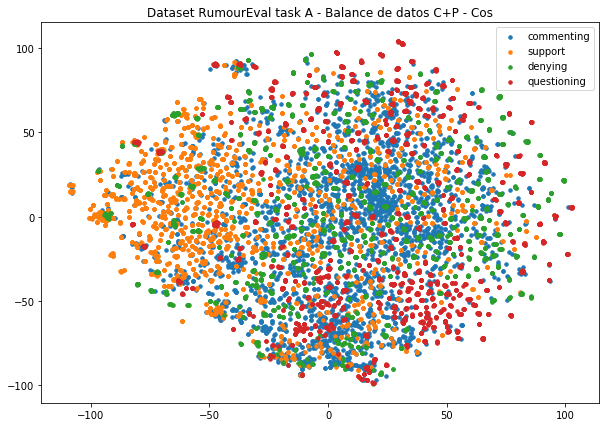

In [37]:
model = TSNE(2, metric='cosine')
to_plot_tsne = model.fit_transform(data_bas_cp)    
plt.figure(figsize=(10,7))
for key in keys:
    labels=[dict_cl[lab] for lab in macro_augmented[:,2]]
    mask = np.asarray(labels)==key
    plt.scatter(to_plot_tsne[:,0][mask],to_plot_tsne[:,1][mask], s=12, label=str(key))

plt.legend()
plt.title("Dataset RumourEval task A - Balance de datos C+P - Cos - GloVe - Posible")
plt.show()

fig = plt.figure(figsize=(15,10))
j=220
for key in keys:
    labels=[dict_cl[lab] for lab in macro_augmented[:,2]]
    mask = np.asarray(labels)==key
    j+=1
    h=fig.add_subplot(j)
    plt.scatter(to_plot_tsne[:,0][mask],to_plot_tsne[:,1][mask], s=12, label=str(key))
    h.title.set_text(str(key))

fig.suptitle("Dataset RumourEval task A - Balance de datos C+P - Cos - GloVe - Posible", fontsize=14)
plt.show()

In [32]:
macro_augmented=[]
for clase in aum_weight:
    start_time=time.time()
    print ("\n\nGenerando", aum_weight[clase], "ejemplos para", clase)
    muestras, dict_aumentos=aumentar_clase(clase, aum_weight[clase], tags, prob, pond=True, Neg=True)
    macro_augmented+=muestras
    print ("Resumen de modificaciones:", dict_aumentos)
    elapsed_time= time.time() - start_time
    print ("Este proceso tomó", elapsed_time, "seg")   



Generando 2404 ejemplos para questioning
Original: know  	Reemplazo:  [('remember', 1.4876307687756194)]
Original: s  	Reemplazo:  [('ve', 2.590933121521348)]
Sentencia original:
['user' 'user' 'sorry' '-' 'how' 'do' 'you' 'know' 'it' "'" 's' 'an'
 'isis' 'flag' '?' 'can' 'you' 'actually' 'confirm' 'that' '?']
Sentencia final: 2
['user', 'user', 'sorry', '-', 'how', 'do', 'you', 'remember', 'it', "'", 've', 'an', 'isis', 'flag', '?', 'can', 'you', 'actually', 'confirm', 'that', '?']


Original: didn  	Reemplazo:  [('doesn', 1.5671123811550467)]
Original: have  	Reemplazo:  [('do', 1.7123648701203873)]
Original: have  	Reemplazo:  [('make', 1.9575374925879303)]
Original: great  	Reemplazo:  [('good', 0.8952772156213701)]
Sentencia original:
['user' 'user' 'thank' 'you' 'for' 'clarifying' '.' 'you' 'definitely'
 'didn' "'" 't' 'have' 'to' 'reply' 'to' 'me' '.' 'have' 'a' 'great' 'day'
 'and' 'thanks' 'for' 'the' 'reports']
Sentencia final: 2
['user', 'user', 'thank', 'you', 'for', 'cla

Original: clue  	Reemplazo:  [('anything', 0.6248957562993928)]
Original: do  	Reemplazo:  [('identify', 0.8122399312966979)]
Original: world  	Reemplazo:  [('london', 0.7693411608321481)]
Original: reporters  	Reemplazo:  [('days', 1.1939751544923047)]
Sentencia original:
['user' 'really' '?' 'the' 'motive' 'is' 'unknown' '?' 'does' 'the' 'flag'
 'in' 'the' 'window' 'provide' 'any' 'possible' 'clue' '?' 'do' 'you'
 'employ' 'the' 'world' "'" 's' 'worst' 'reporters' '?']
Sentencia final: 2
['user', 'really', '?', 'the', 'motive', 'is', 'unknown', '?', 'does', 'the', 'flag', 'in', 'the', 'window', 'provide', 'any', 'possible', 'anything', '?', 'identify', 'you', 'employ', 'the', 'london', "'", 's', 'worst', 'days', '?']


Original: making  	Reemplazo:  [('doing', 1.5355433150531241)]
Sentencia original:
['user' 'user' 'user' 'what' 'point' 'are' 'you' 'making' 'about' 'the'
 'photo' '?']
Sentencia final: 2
['user', 'user', 'user', 'what', 'point', 'are', 'you', 'doing', 'about', 'the', 

Original: mark  	Reemplazo:  [('thank', 0.3685876082162235)]
Original: safe  	Reemplazo:  [('active', 1.270544056932518)]
Sentencia original:
['user' 'thanks' 'mark' ',' 'are' 'you' 'in' 'ottawa' '?' 'stay' 'safe']
Sentencia final: 2
['user', 'thanks', 'thank', ',', 'are', 'you', 'in', 'ottawa', '?', 'stay', 'active']


Original: terrorism  	Reemplazo:  [('sense', 0.5020241286163505)]
Sentencia original:
['user' 'true' '.' 'but' 'i' 'hear' 'there' 'was' 'a' 'similar' 'incident'
 'this' 'past' 'monday' '.' 'is' 'that' 'correct' '?' 'that' 'makes' 'me'
 'think' 'its' 'low' 'level' 'terrorism']
Sentencia final: 2
['user', 'true', '.', 'but', 'i', 'hear', 'there', 'was', 'a', 'similar', 'incident', 'this', 'past', 'monday', '.', 'is', 'that', 'correct', '?', 'that', 'makes', 'me', 'think', 'its', 'low', 'level', 'sense']


Original: is  	Reemplazo:  [('appears', 1.7669799619351805)]
Original: picture  	Reemplazo:  [('inadvertent', 6.033354890499673)]
Original: walking  	Reemplazo:  [('fuck

Original: wait  	Reemplazo:  [('think', 1.4087757791764843)]
Sentencia original:
['user' 'i' 'think' 'we' 'don' "'" 't' 'have' 'enough' 'facts' 'about'
 'the' 'big' 'picture' 'right' 'now' 'aqap' 'isis' 'etc' ',' 'we' "'" 'll'
 'need' 'to' 'wait' 'and' 'see' 'user']
Sentencia final: 2
['user', 'i', 'think', 'we', 'don', "'", 't', 'have', 'enough', 'facts', 'about', 'the', 'big', 'picture', 'right', 'now', 'kill', 'isis', 'etc', ',', 'we', "'", 'll', 'need', 'to', 'think', 'and', 'see', 'user']


Original: gelukkig  	Reemplazo:  [('word', 0.4917538372751841)]
Sentencia original:
['gelukkig' '!' '“' 'user' ':' 'number' 'hostages' 'escape' 'sydney'
 'cafe' 'siege' '—' 'live' 'updates' 'from' 'user' 'html' 'html']
Sentencia final: 2
['word', '!', '“', 'user', ':', 'number', 'hostages', 'escape', 'sydney', 'cafe', 'siege', '—', 'live', 'updates', 'from', 'user', 'html', 'html']


Original: s  	Reemplazo:  [('hate', 0.39239781378050814)]
Sentencia original:
['user' 'really' '?' 'the' 'motive

Original: chest  	Reemplazo:  [('right', 0.6634638674008805)]
Sentencia original:
['user' 'user' 'user' 'user' 'if' 'he' 'was' 'shot' 'in' 'the' 'chest'
 'how' 'was' 'he' 'running' 'away' '?']
Sentencia final: 2
['user', 'user', 'user', 'user', 'if', 'he', 'had', 'seresta', 'in', 'the', 'right', 'how', 'was', 'he', 'running', 'away', '?']


Original: t  	Reemplazo:  [('cc', 1.2395917405130406)]
Original: right  	Reemplazo:  [('way', 0.5230342408934867)]
Sentencia original:
['user' 'i' 'think' 'we' 'don' "'" 't' 'have' 'enough' 'facts' 'about'
 'the' 'big' 'picture' 'right' 'now' 'aqap' 'isis' 'etc' ',' 'we' "'" 'll'
 'need' 'to' 'wait' 'and' 'see' 'user']
Sentencia final: 2
['user', 'i', 'think', 'we', 'don', "'", 'cc', 'have', 'enough', 'facts', 'about', 'the', 'big', 'picture', 'way', 'now', 'aqap', 'isis', 'etc', ',', 'we', "'", 'll', 'need', 'to', 'wait', 'and', 'see', 'user']


Original: is  	Reemplazo:  [('appears', 1.68001185303037)]
Sentencia original:
['user' 'user' 'really' '

Original: havent  	Reemplazo:  [('thought', 0.658598985608412)]
Original: anything  	Reemplazo:  [('heard', 1.110447786685295)]
Original: gunman  	Reemplazo:  [('decapitate', 15.188282499040715)]
Sentencia original:
['user' 'angus' '!' '!' 'they' 'havent' 'said' 'anything' 'about' 'the'
 'gunman' '?' '?']
Sentencia final: 2
['user', 'angus', '!', '!', 'they', 'thought', 'said', 'heard', 'about', 'the', 'decapitate', '?', '?']


Original: involved  	Reemplazo:  [('made', 0.4416554689330815)]
Sentencia original:
['user' 'user' 'killers' '?' 'no' 'trial' '?' 'can' 'you' 'please'
 'provide' 'the' 'evidence' 'that' 'these' 'people' 'were' 'involved' 'in'
 'hashtag']
Sentencia final: 2
['user', 'user', 'killers', '?', 'no', 'trial', '?', 'can', 'you', 'please', 'provide', 'the', 'evidence', 'that', 'these', 'people', 'were', 'made', 'in', 'hashtag']


Original: suppose  	Reemplazo:  [('email', 1.3155948750233695)]
Sentencia original:
['user' 'suppose' 'that' "'" 's' 'real' ':' 'that' 'guy' '

Original: i  	Reemplazo:  [('think', 0.9065974310117169)]
Original: giving  	Reemplazo:  [('shoplifting', 1.4263922820526729)]
Original: terrorists  	Reemplazo:  [('people', 0.6044757372604688)]
Sentencia original:
['user' 'i' 'thought' 'police' 'asked' 'media' 'not' 'to' 'report'
 'demands' '.' 'why' 'you' 'giving' 'these' 'terrorists' 'a' 'voice' '?']
Sentencia final: 2
['user', 'think', 'thought', 'police', 'asked', 'media', 'not', 'to', 'report', 'demands', '.', 'why', 'you', 'shoplifting', 'these', 'people', 'a', 'voice', '?']


Original: relaying  	Reemplazo:  [('conflicting', 2.6048894374898866)]
Original: app  	Reemplazo:  [('need', 2.237185244196094)]
Sentencia original:
['user' 'user' 'user' 'kudos' 'to' 'your' 'relaying' 'of' 'second' '-'
 'hand' 'information' '!' 'do' 'you' 'have' 'an' 'app' '?']
Sentencia final: 2
['user', 'user', 'user', 'kudos', 'to', 'your', 'conflicting', 'of', 'second', '-', 'hand', 'information', '!', 'do', 'you', 'have', 'an', 'need', '?']


Origina

Original: thx  	Reemplazo:  [('thank', 1.05466678233317)]
Sentencia original:
['user' 'user' 'got' 'feed' 'in' 'english' 'or' 'spanish' '?' 'i' 'don'
 "'" 't' 'speak' 'french' '.' 'thx']
Sentencia final: 2
['user', 'user', 'got', 'feed', 'in', 'english', 'or', 'spanish', '?', 'i', 'don', "'", 't', 'speak', 'french', '.', 'thank']


Original: are  	Reemplazo:  [('am', 0.8221921546604732)]
Original: re  	Reemplazo:  [('mal', 0.6898442720631631)]
Sentencia original:
['user' 'user' 'so' 'what' 'they' 'are' 'doing' 'is' 'right' '?' '?' '?'
 'you' "'" 're' 'wacked' '!' '!' '!' 'you' 'should' 'be' 'on' 'a' 'list'
 '!' '!' '!']
Sentencia final: 2
['user', 'user', 'so', 'what', 'they', 'am', 'doing', 'is', 'right', '?', '?', '?', 'you', "'", 'mal', 'wacked', '!', '!', '!', 'you', 'should', 'be', 'on', 'a', 'list', '!', '!', '!']


Original: charlie  	Reemplazo:  [('brown', 1.1165993818597593)]
Sentencia original:
['user' 'by' 'any' 'chance' 'does' 'that' 'printing' 'business' 'actually'
 'print

Original: planet  	Reemplazo:  [('isil', 2.209996347511083)]
Sentencia original:
['user' 'user' 'there' 'is' 'stupid' 'and' 'there' 'is' 'markson' "'" 's'
 'stupidity' 'which' 'is' 'on' 'another' 'planet' 'altogether']
Sentencia final: 2
['user', 'user', 'there', 'is', 'stupid', 'and', 'there', 'is', 'markson', "'", 's', 'stupidity', 'which', 'is', 'on', 'another', 'isil', 'altogether']


Original: t  	Reemplazo:  [('ah', 1.339083918572144)]
Original: have  	Reemplazo:  [('know', 0.6825069552538635)]
Original: etc  	Reemplazo:  [('presume', 0.7382152108336624)]
Original: ll  	Reemplazo:  [('nenne', 1.181605561693171)]
Sentencia original:
['user' 'i' 'think' 'we' 'don' "'" 't' 'have' 'enough' 'facts' 'about'
 'the' 'big' 'picture' 'right' 'now' 'aqap' 'isis' 'etc' ',' 'we' "'" 'll'
 'need' 'to' 'wait' 'and' 'see' 'user']
Sentencia final: 2
['user', 'i', 'think', 'we', 'don', "'", 'ah', 'know', 'enough', 'facts', 'about', 'the', 'big', 'picture', 'right', 'now', 'aqap', 'isis', 'presume'

Original: many  	Reemplazo:  [('good', 1.435146998845487)]
Sentencia original:
['user' 'is' 'that' 'man' 'holding' 'hostages' 'alone' '?' 'or' 'they'
 'are' 'many' '?']
Sentencia final: 2
['user', 'is', 'that', 'man', 'holding', 'hostages', 'alone', '?', 'or', 'they', 'are', 'good', '?']


Original: vid  	Reemplazo:  [('think', 0.3880404326549482)]
Original: is  	Reemplazo:  [('gives', 1.8718810425411527)]
Original: robbery  	Reemplazo:  [('robber', 1.5510272873954478)]
Sentencia original:
['user' 'user' 'antonio' 'french' 'tweeted' 'this' 'vid' 'number' 'days'
 'ago' '.' 'is' 'this' 'the' 'same' 'robbery' 'and' 'market' '?' 'html']
Sentencia final: 2
['user', 'user', 'antonio', 'french', 'tweeted', 'this', 'think', 'number', 'days', 'ago', '.', 'gives', 'this', 'the', 'same', 'robber', 'and', 'market', '?', 'html']


Original: know  	Reemplazo:  [('say', 1.1621203204749782)]
Original: thought  	Reemplazo:  [('sidewalk', 1.4180221856104502)]
Sentencia original:
['user' 'how' 'do' 'you'

Original: hostages  	Reemplazo:  [('dissidents', 0.9897974963811526)]
Original: cafe  	Reemplazo:  [('centre', 0.7054343968805269)]
Original: held  	Reemplazo:  [('hand', 1.153278275666858)]
Sentencia original:
['"' 'user' ':' 'hashtag' 'hostages' 'held' 'inside' 'sydney' 'cafe' ','
 'islamic' 'flag' 'held' 'up' '"' '&lt' ';' '&lt' ';' 'terrifying' 'stuff'
 '.' 'nutters&gt' ';' '&gt' ';']
Sentencia final: 0
['"', 'user', ':', 'hashtag', 'dissidents', 'held', 'inside', 'sydney', 'centre', ',', 'islamic', 'flag', 'hand', 'up', '"', '&lt', ';', '&lt', ';', 'terrifying', 'stuff', '.', 'nutters&gt', ';', '&gt', ';']


Original: deserted  	Reemplazo:  [('used', 0.14697943746929898)]
Sentencia original:
['“' 'user' ':' 'sydney' 'opera' 'house' 'evacuated' ',' 'concourse'
 'deserted' 'html' 'hashtag' 'via' 'user' 'html']
Sentencia final: 0
['“', 'user', ':', 'sydney', 'opera', 'house', 'evacuated', ',', 'concourse', 'used', 'html', 'hashtag', 'via', 'user', 'html']


Original: sounds  	Reempla

Original: siege  	Reemplazo:  [('night', 0.6571775932284787)]
Original: larger  	Reemplazo:  [('higher', 0.7477841588245678)]
Sentencia original:
['rt' '“' 'user' ':' 'the' 'sydney' 'cafe' 'siege' 'may' 'be' 'part' 'of'
 'a' 'larger' 'plot' '.' 'hashtag' 'html' 'html']
Sentencia final: 0
['rt', '“', 'user', ':', 'the', 'sydney', 'cafe', 'night', 'may', 'be', 'part', 'of', 'a', 'higher', 'plot', '.', 'hashtag', 'html', 'html']


Original: israeli  	Reemplazo:  [('russian', 1.6423739169511848)]
Original: baby  	Reemplazo:  [('year', 1.0216473473994092)]
Sentencia original:
['on' 'israeli' 'tv' ',' 'an' 'israeli' 'woman' 'speaks' 'of' 'her'
 'nephew' ',' 'a' 'mother' 'with' 'number' 'month' 'old' 'baby' ',' 'held'
 'hostage' 'in' 'the' 'supermarket' 'in' 'paris' '.' 'hashtag']
Sentencia final: 0
['on', 'israeli', 'tv', ',', 'an', 'russian', 'woman', 'speaks', 'of', 'her', 'nephew', ',', 'a', 'mother', 'with', 'number', 'month', 'old', 'year', ',', 'held', 'hostage', 'in', 'the', 'supermar

Sentencia original:
['clarissa' ',' 'number' 'years' 'old' ',' 'police' 'trainee' 'of'
 'montrouge' 'police' 'in' 'hashtag' '.' 'victim' 'of' 'this' 'morning'
 "'" 's' 'attack' '.' 'via' 'user' 'html']
Sentencia final: 0
['clarissa', ',', 'number', 'years', 'injured', ',', 'police', 'trainee', 'of', 'montrouge', 'police', 'in', 'hashtag', '.', 'victim', 'of', 'this', 'morning', "'", 's', 'attack', '.', 'via', 'user', 'html']


Original: tell  	Reemplazo:  [('wanna', 0.3838980992863223)]
Sentencia original:
['user' 'speak' 'to' 'them' 'moby' ',' 'tell' 'em' '!' '!' '!']
Sentencia final: 0
['user', 'speak', 'to', 'them', 'moby', ',', 'wanna', 'em', '!', '!', '!']


Original: self  	Reemplazo:  [('government', 0.5279232434702634)]
Original: styled  	Reemplazo:  [('ahmed', 0.732514812122007)]
Sentencia original:
['sydney' 'hostage' '-' 'taker' '-' 'man' 'monis' ',' 'number' '-'
 'originally' 'from' 'iran' '-' 'self' '-' 'styled' 'sheikh' '-' 'accused'
 'of' 'sexually' 'assaulting' 'number'

Original: tell  	Reemplazo:  [('use', 0.518313701634543)]
Sentencia original:
['user' 'speak' 'to' 'them' 'moby' ',' 'tell' 'em' '!' '!' '!']
Sentencia final: 0
['user', 'speak', 'to', 'them', 'moby', ',', 'use', 'em', '!', '!', '!']


Original: look  	Reemplazo:  [('martial', 1.5607690782634585)]
Original: nope  	Reemplazo:  [('montrouge', 2.6577061867385257)]
Sentencia original:
['user' 'user' 'odd' 'how' 'they' 'happened' 'to' 'be' 'already' 'ready'
 'for' 'this' ',' 'eh' '?' 'doesn' "'" 't' 'look' 'staged' 'at' 'all' '.'
 'nope' '.' 'totally' 'believable' '.']
Sentencia final: 0
['user', 'user', 'odd', 'how', 'they', 'happened', 'to', 'be', 'already', 'ready', 'for', 'this', ',', 'eh', '?', 'doesn', "'", 't', 'martial', 'staged', 'at', 'all', '.', 'montrouge', '.', 'totally', 'believable', '.']


Original: storm  	Reemplazo:  [('traffic', 1.1286256624132485)]
Sentencia original:
['hashtag' ':' 'both' 'charlie' 'hebdo' 'suspects' 'killed' 'as' 'police'
 'storm' 'building' 'police' '

Original: media  	Reemplazo:  [('people', 0.33419759747301325)]
Sentencia original:
['reports' 'of' 'shooting' 'at' 'dammartin' 'en' 'goel' 'on' 'route' 'n2'
 'north' 'east' 'of' 'paris' '-' 'french' 'media' 'says' 'car' 'chase'
 'under' 'way']
Sentencia final: 0
['reports', 'of', 'shooting', 'at', 'dammartin', 'en', 'goel', 'on', 'route', 'n2', 'north', 'east', 'of', 'paris', '-', 'french', 'people', 'says', 'car', 'chase', 'under', 'way']


Original: chief  	Reemplazo:  [('mike', 2.7466127593900396)]
Sentencia original:
['user' ':' 'update' ':' 'hashtag' "'" 's' 'editor' '-' 'in' '-' 'chief'
 'was' 'killed' 'in' 'attack' '-' 'magazine' "'" 's' 'lawyer' 'html']
Sentencia final: 0
['user', ':', 'update', ':', 'hashtag', "'", 's', 'editor', '-', 'in', '-', 'mike', 'was', 'killed', 'in', 'attack', '-', 'magazine', "'", 's', 'lawyer', 'html']


Original: performing  	Reemplazo:  [('coming', 0.9610031497691918)]
Sentencia original:
['omg' '.' 'hashtag' 'rumoured' 'to' 'be' 'performing' 'in

Original: are  	Reemplazo:  [('am', 2.7022866944435346)]
Sentencia original:
['user' 'user' 'user' 'people' 'like' 'you' 'and' 'these' 'things' 'that'
 'you' 'say' 'are' 'what' 'keep' 'people' 'like' 'me' 'the'
 'establishment' 'laughing']
Sentencia final: 0
['user', 'user', 'user', 'people', 'like', 'you', 'and', 'these', 'things', 'that', 'you', 'say', 'am', 'what', 'keep', 'people', 'like', 'me', 'the', 'establishment', 'laughing']


Original: thoughts  	Reemplazo:  [('condolences', 1.058630063735646)]
Original: are  	Reemplazo:  [('am', 2.644135351784365)]
Original: australian  	Reemplazo:  [('traditional', 2.25342690534525)]
Original: cafe  	Reemplazo:  [('event', 1.1574819227816788)]
Sentencia original:
['hashtag' 'tweets' "'" 'canada' "'" 's' 'thoughts' 'and' 'prayers' 'are'
 'with' 'our' 'australian' 'friends' '.' "'" 'number' '-' 'number'
 'hostages' 'held' 'in' 'cafe' 'in' 'hashtag' '.' 'hashtag']
Sentencia final: 0
['hashtag', 'tweets', "'", 'canada', "'", 's', 'condolences'

Original: held  	Reemplazo:  [('captive', 1.6045457458141332)]
Original: lindt  	Reemplazo:  [('moscow', 0.4797882586300723)]
Original: oh  	Reemplazo:  [('website', 0.38383161824448336)]
Sentencia original:
['“' 'user' ':' 'up' 'to' 'number' 'held' 'hostage' 'in' 'sydney' 'lindt'
 'cafe' 'siege' 'html' 'html' 'oh' '.' 'my' '.' 'god' '.' 'i' 'am' 'sick'
 '!']
Sentencia final: 0
['“', 'user', ':', 'up', 'to', 'number', 'captive', 'hostage', 'in', 'sydney', 'moscow', 'cafe', 'siege', 'html', 'html', 'website', '.', 'my', '.', 'god', '.', 'i', 'am', 'sick', '!']


Original: do  	Reemplazo:  [('know', 1.2182375265410563)]
Sentencia original:
['user' 'this' 'was' 'the' 'right' 'thing' 'to' 'do']
Sentencia final: 0
['user', 'this', 'was', 'the', 'right', 'thing', 'to', 'know']


Original: say  	Reemplazo:  [('have', 0.6146786132237294)]
Original: are  	Reemplazo:  [('am', 0.5014743041815464)]
Sentencia original:
['user' 'rumors' 'say' 'hostages' 'are' 'number' 'women' 'and' 'number'
 'childr

Original: is  	Reemplazo:  [('continues', 1.7028506250118387)]
Sentencia original:
['user' 'islamic' 'scholars' 'should' 'come' 'forward' 'to' 'end' "'"
 'jihad' "'" '!' 'it' 'is' 'inhuman' '&amp' ';' 'would' 'destroy' 'the'
 'credibility' 'of' 'islam' '!']
Sentencia final: 0
['user', 'islamic', 'scholars', 'should', 'come', 'forward', 'to', 'end', "'", 'jihad', "'", '!', 'it', 'continues', 'inhuman', '&amp', ';', 'would', 'destroy', 'the', 'credibility', 'of', 'islam', '!']


Original: internal  	Reemplazo:  [('national', 0.8271295067920559)]
Original: s  	Reemplazo:  [('look', 0.3445832965294527)]
Sentencia original:
['was' 'vladimir' 'putin' 'netral' 'by' 'an' 'internal' 'coup' '?' 'or'
 'maybe' 'he' "'" 's' 'vacationing' 'in' 'harper' "'" 's' 'closet' ':'
 'html' 'hashtag']
Sentencia final: 0
['was', 'vladimir', 'putin', 'netral', 'by', 'an', 'national', 'coup', '?', 'or', 'maybe', 'he', "'", 's', 'vacationing', 'in', 'harper', "'", 'look', 'closet', ':', 'html', 'hashtag']


Origi

Original: hostages  	Reemplazo:  [('militants', 0.7918110010852324)]
Original: paris  	Reemplazo:  [('europe', 0.6290584583627525)]
Original: kill  	Reemplazo:  [('avenge', 2.788557486971378)]
Sentencia original:
['“' 'user' ':' 'official' ':' 'gunman' 'holding' 'at' 'least' 'number'
 'hostages' 'in' 'paris' 'market' 'has' 'threatened' 'to' 'kill' 'them'
 'if' 'police' 'approach' ':' 'html']
Sentencia final: 0
['“', 'user', ':', 'official', ':', 'held', 'shooting', 'at', 'least', 'number', 'militants', 'in', 'europe', 'market', 'has', 'threatened', 'to', 'avenge', 'them', 'if', 'police', 'approach', ':', 'html']


Original: ve  	Reemplazo:  [('nada', 1.4067686541513944)]
Sentencia original:
['user' 'you' "'" 've' 'been' 'late' 'on' 'this' 'story' 'all' 'day' '.']
Sentencia final: 0
['user', 'you', "'", 'nada', 'been', 'late', 'on', 'this', 'story', 'all', 'day', '.']


Original: is  	Reemplazo:  [('has', 0.7795724313239825)]
Sentencia original:
['user' 'user' 'uber' 'is' '.']
Sentencia

Original: wristbands  	Reemplazo:  [('guys', 0.3348266914526024)]
Original: surprise  	Reemplazo:  [('suprise', 1.3123193983309396)]
Sentencia original:
['prince' 'fans' 'lining' 'up' 'at' 'massey' 'hall' '.' 'wristbands' 'for'
 'surprise' 'show' 'reportedly' 'on' 'sale' 'at' '6pm' '.' 'hashtag'
 'html']
Sentencia final: 0
['prince', 'fans', 'lining', 'up', 'at', 'reféns', 'hall', '.', 'guys', 'for', 'suprise', 'show', 'reportedly', 'on', 'sale', 'at', '6pm', '.', 'hashtag', 'html']


Original: posts  	Reemplazo:  [('people', 0.24993997131968373)]
Sentencia original:
['hashtag' 'media' 'account' 'posts' 'picture' 'claiming' 'to' 'be'
 'michael' 'zehaf' '-' 'bibeau' ',' 'dead' 'hashtag' 'suspect' '.'
 'hashtag' 'html']
Sentencia final: 0
['hashtag', 'media', 'account', 'people', 'picture', 'claiming', 'to', 'be', 'michael', 'zehaf', '-', 'bibeau', ',', 'dead', 'hashtag', 'suspect', '.', 'hashtag', 'html']


Original: found  	Reemplazo:  [('think', 0.7496678109010722)]
Sentencia original

Original: sale  	Reemplazo:  [('argyll', 3.0185133679541836)]
Sentencia original:
['prince' 'fans' 'lining' 'up' 'at' 'massey' 'hall' '.' 'wristbands' 'for'
 'surprise' 'show' 'reportedly' 'on' 'sale' 'at' '6pm' '.' 'hashtag'
 'html']
Sentencia final: 0
['prince', 'fans', 'lining', 'up', 'at', 'massey', 'hall', '.', 'wristbands', 'for', 'surprise', 'show', 'reportedly', 'on', 'argyll', 'at', '6pm', '.', 'hashtag', 'html']


Original: highest  	Reemplazo:  [('fastest', 1.1714400728823604)]
Original: drama  	Reemplazo:  [('show', 0.5881931931995449)]
Original: s  	Reemplazo:  [('end', 0.6579513868317947)]
Original: happening  	Reemplazo:  [('stonewalling', 2.3017452795788946)]
Sentencia original:
['user' 'oh' 'and' 'our' 'anti' '-' 'terrorist' 'plan' 'has' 'just' 'been'
 'put' 'to' 'its' 'highest' 'level' 'in' 'the' 'part' 'in' 'which' 'the'
 'drama' "'" 's' 'happening' '.']
Sentencia final: 0
['user', 'oh', 'and', 'our', 'anti', '-', 'terrorist', 'plan', 'has', 'just', 'been', 'put', 't

Original: pencils  	Reemplazo:  [('accounts', 0.36361131249667794)]
Original: number  	Reemplazo:  [('pickup', 1.3431860700031162)]
Original: cartoon  	Reemplazo:  [('funny', 1.015420523082255)]
Sentencia original:
['user' 'user' 'pencils' 'as' 'number' '-' 'number' '?' 'all' 'the'
 'cartoon' 'responses' 'are' 'cartoonists' 'as' 'victims' '.' 'where' "'"
 's' 'the' 'defiance' '?']
Sentencia final: 1
['user', 'user', 'accounts', 'as', 'pickup', '-', 'number', '?', 'all', 'the', 'funny', 'responses', 'are', 'cartoonists', 'as', 'victims', '.', 'where', "'", 's', 'the', 'defiance', '?']


Original: son  	Reemplazo:  [('don', 2.78145450939448)]
Original: bcz  	Reemplazo:  [('told', 0.259096651349953)]
Original: benefits  	Reemplazo:  [('media', 0.27530822072679423)]
Sentencia original:
['user' 'a' 'person' 'killed' 'his' 'own' 'son' '&amp' ';' 'daughter'
 'bcz' 'authority' 'neglected' 'his' 'rights' 'of' 'social' 'security'
 'benefits' '.' 'html']
Sentencia final: 1
['user', 'a', 'person',

Original: threatens  	Reemplazo:  [('attacks', 0.7801994176951222)]
Sentencia original:
['“' 'user' ':' 'breaking' ':' 'gunman' 'at' 'paris' 'store' 'threatens'
 'to' 'kill' 'hostages' 'if' 'hashtag' 'suspects' 'are' 'harmed' '.'
 'html' 'smh']
Sentencia final: 1
['“', 'user', ':', 'breaking', ':', 'gunman', 'at', 'paris', 'store', 'attacks', 'to', 'kill', 'hostages', 'if', 'hashtag', 'suspects', 'are', 'harmed', '.', 'html', 'smh']


Original: re  	Reemplazo:  [('fuck', 0.5391600396250407)]
Original: situations  	Reemplazo:  [('happens', 0.5640078497488052)]
Sentencia original:
['user' 'user' 'user' 'you' "'" 're' 'an' 'idiot' 'its' 'parliament'
 'hill' '.' 'of' 'course' 'they' "'" 're' 'prepared' 'for' 'situations'
 'like' 'this' 'you' 'idiot' '!']
Sentencia final: 1
['user', 'user', 'user', 'you', "'", 'fuck', 'an', 'idiot', 'its', 'parliament', 'hill', '.', 'of', 'course', 'they', "'", 're', 'prepared', 'for', 'happens', 'like', 'this', 'you', 'idiot', '!']


Original: confirmed  	

Original: telegraph  	Reemplazo:  [('parliment', 1.6001881514123604)]
Original: release  	Reemplazo:  [('looter', 0.7389767742188224)]
Original: stills  	Reemplazo:  [('reappears', 2.158744886186009)]
Sentencia original:
['to' 'not' 'telegraph' 'their' 'court' 'case' '“' 'user' ':' 'if' 'there'
 'is' 'surveillance' 'of' 'a' 'robbery' 'why' 'release' 'stills' 'and'
 'not' 'video' 'itself' '?' 'hashtag' '”']
Sentencia final: 1
['to', 'not', 'parliment', 'their', 'court', 'case', '“', 'user', ':', 'if', 'there', 'is', 'surveillance', 'of', 'a', 'robbery', 'why', 'looter', 'reappears', 'and', 'not', 'video', 'itself', '?', 'hashtag', '”']


Original: update  	Reemplazo:  [('reenter', 1.5456998016834615)]
Sentencia original:
['user' 'user' 'any' 'update' 'on' 'pa' 'shooting' '?']
Sentencia final: 1
['user', 'user', 'any', 'reenter', 'on', 'pa', 'shooting', '?']


Original: bs  	Reemplazo:  [('al', 1.4832901380042327)]
Sentencia original:
['user' 'user' 'that' "'" 's' 'bs' '.' 'there' "'" 's

Original: shooter  	Reemplazo:  [('libtard', 2.625998706321024)]
Sentencia original:
['user' 'it' 'appears' 'now' 'it' 'was' 'only' 'number' 'shooter' 'and'
 'the' 'shots' 'were' 'heard' 'at' 'nearby' 'hotel' 'shopping' 'cntr'
 'causing' 'reports' 'of' 'more' 'shootings']
Sentencia final: 1
['user', 'it', 'appears', 'now', 'it', 'was', 'only', 'number', 'libtard', 'and', 'the', 'shots', 'were', 'heard', 'at', 'nearby', 'hotel', 'shopping', 'cntr', 'causing', 'reports', 'of', 'more', 'shootings']


Original: men  	Reemplazo:  [('people', 0.6093858035264644)]
Original: brothers  	Reemplazo:  [('suspects', 1.6657316360843535)]
Sentencia original:
['“' 'user' ':' 'hashtag' 'three' 'men' 'including' 'two' 'brothers'
 'identified' 'in' 'france' 'newspaper' 'attack' ':' 'source' 'html'
 'hashtag' '”']
Sentencia final: 1
['“', 'user', ':', 'hashtag', 'three', 'people', 'including', 'two', 'suspects', 'identified', 'in', 'france', 'newspaper', 'attack', ':', 'source', 'html', 'hashtag', '”']




Original: rt  	Reemplazo:  [('fact', 0.7794787588966592)]
Original: true  	Reemplazo:  [('much', 0.9035937001058078)]
Original: have  	Reemplazo:  [('do', 2.3609082330449587)]
Sentencia original:
['user' 'russian' 'emb' 'denies' '.' 'rt' 'user' 'number' 'min' 'user'
 'this' 'is' 'not' 'true' '.' 'i' 'have' 'more' 'time' 'for' 'speculation'
 'user']
Sentencia final: 1
['user', 'russian', 'emb', 'denies', '.', 'fact', 'user', 'number', 'min', 'user', 'this', 'is', 'not', 'much', '.', 'i', 'do', 'more', 'time', 'for', 'speculation', 'user']


Original: release  	Reemplazo:  [('deliverance', 1.468175440089404)]
Sentencia original:
['to' 'not' 'telegraph' 'their' 'court' 'case' '“' 'user' ':' 'if' 'there'
 'is' 'surveillance' 'of' 'a' 'robbery' 'why' 'release' 'stills' 'and'
 'not' 'video' 'itself' '?' 'hashtag' '”']
Sentencia final: 1
['to', 'not', 'telegraph', 'their', 'court', 'case', '“', 'user', ':', 'if', 'there', 'is', 'surveillance', 'of', 'a', 'robbery', 'why', 'deliverance', 'stil

Original: offence  	Reemplazo:  [('blame', 0.5544207438377566)]
Sentencia original:
['glad' 'to' 'hear' 'this' 'is' 'just' 'a' 'rumour' '.' 'disgusting'
 'whoever' 'made' 'this' 'up' '.' 'apologies' 'to' 'user' 'and' 'for'
 'any' 'offence' 'caused' '.']
Sentencia final: 1
['glad', 'to', 'hear', 'this', 'is', 'just', 'a', 'rumour', '.', 'disgusting', 'kind', 'made', 'this', 'up', '.', 'apologies', 'to', 'user', 'and', 'for', 'any', 'blame', 'caused', '.']


Original: kill  	Reemplazo:  [('death', 0.6078704817725497)]
Original: ur  	Reemplazo:  [('dumbass', 1.4074871788710033)]
Sentencia original:
['srry' 'the' 'whole' 'holding' 'the' 'hostages' '&amp' ';' 'threatening'
 'to' 'kill' 'them' 'made' 'me' 'think' 'it' "'" 's' 'extreme' 'user' 'my'
 'bad' '.' 'jk' 'ur' 'dumb' '!']
Sentencia final: 1
['srry', 'the', 'whole', 'holding', 'the', 'hostages', '&amp', ';', 'threatening', 'to', 'death', 'them', 'made', 'me', 'think', 'it', "'", 's', 'extreme', 'user', 'my', 'bad', '.', 'jk', 'dumbass

Original: gun  	Reemplazo:  [('head', 0.9275084501598516)]
Original: happens  	Reemplazo:  [('cares', 0.960671785597156)]
Original: re  	Reemplazo:  [('gonna', 0.7361352401784504)]
Sentencia original:
['user' 'user' 'so' 'you' 'don' "'" 't' 'agree' 'anyone' 'should' 'own'
 'a' 'gun' 'but' 'yet' 'when' 'something' 'bad' 'happens' 'you' "'" 're'
 'going' 'to' 'call' 'a' 'cop' '.' 'that' 'has' 'a' 'gun']
Sentencia final: 1
['user', 'user', 'so', 'you', 'don', "'", 't', 'agree', 'anyone', 'should', 'unarmed', 'a', 'head', 'but', 'yet', 'when', 'something', 'bad', 'cares', 'you', "'", 'gonna', 'going', 'to', 'call', 'a', 'cop', '.', 'that', 'has', 'a', 'gun']


Original: cc  	Reemplazo:  [('lol', 0.9198938492322706)]
Sentencia original:
['.' 'user' 'good' 'point' '.' 'hashtag' 'cc' 'user']
Sentencia final: 1
['.', 'user', 'good', 'point', '.', 'hashtag', 'lol', 'user']


Original: everything  	Reemplazo:  [('par', 1.2895425464019423)]
Sentencia original:
['user' 'prime' 'ministers' 'should'

Original: number  	Reemplazo:  [('cntr', 2.3465511191119948)]
Original: obamacare  	Reemplazo:  [('offer', 0.29910695179100727)]
Original: register  	Reemplazo:  [('work', 0.2928643506733242)]
Original: go  	Reemplazo:  [('leave', 1.6104307895343644)]
Sentencia original:
['user' 'user' 'us' 'citizens' '!' '!' 'number' ':' 'fbruary' 'number' '.'
 'health' 'insurance' 'deadline' 'obamacare' 'register' 'and' 'go' 'to'
 'the' 'hospital' 'to' 'get' 'sick' ',' 'your' 'health' '!' '!']
Sentencia final: 1
['user', 'user', 'us', 'citizens', '!', '!', 'number', ':', 'fbruary', 'cntr', '.', 'health', 'insurance', 'deadline', 'offer', 'work', 'and', 'leave', 'to', 'the', 'hospital', 'to', 'get', 'sick', ',', 'your', 'health', '!', '!']


Original: let  	Reemplazo:  [('know', 1.0569955931603927)]
Sentencia original:
['user' 'user' 'user' 'user' 'i' 'do' ',' 'but' 'do' 'you' 'have' 'a'
 'basic' 'understanding' 'of' 'the' 'judicial' 'system' '?' 'let' "'" 's'
 'hear' 'both' 'sides' 'then' 'decide' '.

Original: do  	Reemplazo:  [('realize', 1.1068922822012162)]
Original: have  	Reemplazo:  [('know', 0.8770667274117009)]
Original: sides  	Reemplazo:  [('people', 0.46721086954677765)]
Sentencia original:
['user' 'user' 'user' 'user' 'i' 'do' ',' 'but' 'do' 'you' 'have' 'a'
 'basic' 'understanding' 'of' 'the' 'judicial' 'system' '?' 'let' "'" 's'
 'hear' 'both' 'sides' 'then' 'decide' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'i', 'do', ',', 'but', 'realize', 'you', 'know', 'a', 'basic', 'understanding', 'of', 'the', 'judicial', 'system', '?', 'let', "'", 's', 'hear', 'both', 'people', 'then', 'decide', '.']


Original: says  	Reemplazo:  [('does', 1.3757681515427838)]
Sentencia original:
['user' '-' '"' 'approximately' 'number' 'hostages' '"' ',' 'in' 'the'
 'article' 'linked' 'the' 'first' 'few' 'lines' 'says' 'the' 'number' 'is'
 'closer' 'to' 'number' '.']
Sentencia final: 1
['user', '-', '"', 'approximately', 'number', 'hostages', '"', ',', 'in', 'the', 'article', '

Original: cannabis  	Reemplazo:  [('arrest', 0.37128399324770445)]
Sentencia original:
['user' 'found' 'similar' 'by' 'user' 'here' ':' '~' 'html' 'entitled' ':'
 "'" 'police' 'raid' 'cannabis' "crops'"]
Sentencia final: 1
['user', 'found', 'similar', 'by', 'user', 'here', ':', '~', 'html', 'entitled', ':', "'", 'police', 'raid', 'arrest', "crops'"]


Original: idiot  	Reemplazo:  [('think', 0.6748032644203963)]
Sentencia original:
['user' 'user' 'user' 'user' 'you' 'are' 'such' 'an' 'ignorant' 'wow'
 'keep' 'running' 'your' 'mouth' 'cause' 'you' 'are' 'an' 'idiot']
Sentencia final: 1
['user', 'user', 'user', 'user', 'you', 'are', 'such', 'an', 'ignorant', 'wow', 'keep', 'running', 'your', 'mouth', 'cause', 'you', 'are', 'an', 'think']


Original: unsubscribe  	Reemplazo:  [('account', 0.379597838622114)]
Sentencia original:
['user' 'user' 'user' 'user' 'unsubscribe']
Sentencia final: 1
['user', 'user', 'user', 'user', 'account']


Original: allowed  	Reemplazo:  [('arrested', 0.908119

Original: min  	Reemplazo:  [('account', 0.6178646256980959)]
Original: have  	Reemplazo:  [('know', 1.597370241228346)]
Sentencia original:
['user' 'russian' 'emb' 'denies' '.' 'rt' 'user' 'number' 'min' 'user'
 'this' 'is' 'not' 'true' '.' 'i' 'have' 'more' 'time' 'for' 'speculation'
 'user']
Sentencia final: 1
['user', 'russian', 'russia', 'claims', '.', 'rt', 'user', 'number', 'account', 'user', 'this', 'is', 'not', 'true', '.', 'i', 'know', 'more', 'time', 'for', 'speculation', 'user']


Original: race  	Reemplazo:  [('week', 1.9801725768735392)]
Sentencia original:
['user' 'user' 'how' 'the' 'fuck' 'you' 'comparing' 'a' 'whole' 'race'
 'too' 'a' 'single' 'occupation' 'of' 'course' 'you' 'are' 'gonna' 'get'
 'a' 'tiny' '%' 'dumbass']
Sentencia final: 1
['user', 'user', 'how', 'the', 'fuck', 'you', 'comparing', 'a', 'whole', 'week', 'too', 'a', 'single', 'occupation', 'of', 'course', 'you', 'are', 'gonna', 'get', 'a', 'tiny', '%', 'dumbass']


Original: knew  	Reemplazo:  [('numpti

In [33]:
np.random.shuffle(macro_augmented)
np.save('../Datasets/CSV_Stance/balance_clase_Pon_GloVe.npy', macro_augmented)
    

In [ ]:
data_bas_cppn=[]
#macro_augmented=np.asarray(macro_augmented)
macro_augmented=np.load('../Datasets/CSV_Stance/balance_clase_Pon_GloVe.npy', allow_pickle=True)
for tweet in macro_augmented[:,1]:
    try: 
        vector= bc.encode([tweet])[0]
    except:
        tw=' '.join([word for word in tweet])
        vector= bc.encode([tw])[0]
    data_bas_cppn.append(vector)

In [ ]:
model = TSNE(2, metric='cosine')
to_plot_tsne = model.fit_transform(data_bas_cppn)    
plt.figure(figsize=(10,7))
for key in keys:
    labels=[dict_cl[lab] for lab in macro_augmented[:,2]]
    mask = np.asarray(labels)==key
    plt.scatter(to_plot_tsne[:,0][mask],to_plot_tsne[:,1][mask], s=12, label=str(key))

plt.legend()
plt.title("Dataset RumourEval task A - Balance de datos C+P - Cos - GloVe - P+N")
plt.show()

fig = plt.figure(figsize=(15,10))
j=220
for key in keys:
    labels=[dict_cl[lab] for lab in macro_augmented[:,2]]
    mask = np.asarray(labels)==key
    j+=1
    h=fig.add_subplot(j)
    plt.scatter(to_plot_tsne[:,0][mask],to_plot_tsne[:,1][mask], s=12, label=str(key))
    h.title.set_text(str(key))
        

fig.suptitle("Dataset RumourEval task A - Balance de datos C+P - Cos - GloVe - P+N", fontsize=14)
plt.show()

### Sujeto a Embedding vocab sin ponderación target

In [40]:
macro_augmented=[]
for clase in aum_weight:
    start_time=time.time()
    print ("\n\nGenerando", aum_weight[clase], "ejemplos para", clase)
    muestras, dict_aumentos=aumentar_clase(clase, aum_weight[clase], tags, prob, BERT=True)
    macro_augmented+=muestras
    print ("Resumen de modificaciones:", dict_aumentos)
    elapsed_time= time.time() - start_time
    print ("Este proceso tomó", elapsed_time, "seg")   



Generando 2404 ejemplos para questioning
Consultando por la clase questioning
Entrega label 2
Original: being  	Reemplazo:  [('saying', 0.7684832811355591)]
Sentencia original:
['user' 'user' 'any' 'chance' 'that' "'" 's' 'being' 'said' 'for' 'fear'
 'of' 'retribution' '?']
Sentencia final: 2
['user', 'user', 'any', 'chance', 'that', "'", 's', 'saying', 'said', 'for', 'fear', 'of', 'retribution', '?']


Original: get  	Reemplazo:  [('obtain', 0.7999216914176941)]
Original: make  	Reemplazo:  [('take', 1.1583632230758667)]
Sentencia original:
['user' 'user' 'user' 'user' 'ah' 'true' '.' 'problem' 'now' 'is' 'we' "'"
 'll' 'probably' 'only' 'get' 'coroner' "'" 's' 'details' 'they' 'won' "'"
 't' 'make' 'it' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'ah', 'true', '.', 'problem', 'now', 'is', 'we', "'", 'll', 'probably', 'only', 'obtain', 'coroner', "'", 's', 'details', 'they', 'won', "'", 't', 'take', 'it', '.']


Original: hi  	Reemplazo:  [('hello', 2.0974652767181396)]

Original: source  	Reemplazo:  [('home', 1.1994084119796753)]
Sentencia original:
['user' 'source' 'plz' ':']
Sentencia final: 2
['user', 'home', 'plz', ':']


Original: re  	Reemplazo:  [('assertion', 0.8988488912582397)]
Sentencia original:
['user' 'user' 'user' 'so' 'they' "'" 're' 'claiming' 'a' 'black' 'cop'
 'killed' 'hashtag' '?' '?']
Sentencia final: 2
['user', 'user', 'user', 'so', 'they', "'", 'assertion', 'claiming', 'a', 'black', 'cop', 'killed', 'hashtag', '?', '?']


Original: scared  	Reemplazo:  [('frightened', 1.0517783164978027)]
Original: place  	Reemplazo:  [('spot', 3.346874475479126)]
Sentencia original:
['user' 'user' 'user' 'or' 'maybe' 'the' 'police' 'scared' 'him' 'into'
 'saying' 'it' 'was' 'michael' 'brown' 'in' 'the' 'first' 'place' '?']
Sentencia final: 2
['user', 'user', 'user', 'or', 'maybe', 'the', 'police', 'frightened', 'him', 'into', 'saying', 'it', 'was', 'michael', 'brown', 'in', 'the', 'first', 'spot', '?']


Original: s  	Reemplazo:  [('cold', 1.

Original: isn  	Reemplazo:  [('wasn', 0.5905872583389282)]
Sentencia original:
['user' 'isn' "'" 't' 'it' 'etiquette' 'to' 'remove' 'names' 'from' 'a'
 'press' 'release' '?']
Sentencia final: 2
['user', 'wasn', "'", 't', 'it', 'etiquette', 'to', 'remove', 'names', 'from', 'a', 'press', 'release', '?']


Original: video  	Reemplazo:  [('state', 1.8330005407333374)]
Sentencia original:
['user' 'user' 'where' 'is' 'the' 'video' 'from' 'the' 'cellphone' 'taken'
 'from' 'one' 'of' 'the' 'witnesses' 'who' 'saw' 'brown' 'shot' 'and'
 'killed' '?']
Sentencia final: 2
['user', 'user', 'where', 'is', 'the', 'state', 'from', 'the', 'cellphone', 'taken', 'from', 'one', 'of', 'the', 'witnesses', 'who', 'saw', 'brown', 'shot', 'and', 'killed', '?']


Original: come  	Reemplazo:  [('go', 1.2680798768997192)]
Original: unarmed  	Reemplazo:  [('incapable', 1.3577390909194946)]
Sentencia original:
['user' 'user' 'user' 'user' 'dude' ',' 'come' 'on' '.' 'this' 'rogue'
 'cop' 'apparently' 'thought' 'he' '

Original: declare  	Reemplazo:  [('seventeenth', 0.2609063386917114)]
Original: cops  	Reemplazo:  [('seasons', 1.5210626125335693)]
Sentencia original:
['user' 'user' 'user' 'user' 'to' 'have' 'the' 'supreme' 'court' 'declare'
 'open' 'season' 'for' 'cops' 'on' 'the' 'population' 'is' 'a'
 'deliberate' 'decision' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'to', 'utilize', 'the', 'supreme', 'court', 'seventeenth', 'open', 'season', 'for', 'seasons', 'on', 'the', 'population', 'is', 'a', 'deliberate', 'decision', '.']


Original: struggle  	Reemplazo:  [('battling', 0.7918965816497803)]
Sentencia original:
['user' 'user' '-' 'is' 'it' 'true' 'there' 'was' 'a' 'struggle' 'in'
 'the' 'squad' 'car' ',' 'before' 'shooting' '?']
Sentencia final: 2
['user', 'user', '-', 'is', 'it', 'true', 'there', 'was', 'a', 'battling', 'in', 'the', 'squad', 'car', ',', 'before', 'shooting', '?']


Original: pic  	Reemplazo:  [('mcc', 2.282667875289917)]
Sentencia original:
['user' 'is' 'that'

Original: got  	Reemplazo:  [('stopped', 0.6154941320419312)]
Sentencia original:
['user' 'user' 'it' 'wasn' "'" 't' 'the' 'quik' 'stop' 'that' 'got'
 'burned' 'down' '?']
Sentencia final: 2
['user', 'user', 'it', 'wasn', "'", 't', 'the', 'quik', 'stop', 'that', 'stopped', 'burned', 'down', '?']


Original: convenient  	Reemplazo:  [('pisa', 0.47695034742355347)]
Original: witnesses  	Reemplazo:  [('calls', 0.5090038776397705)]
Sentencia original:
['user' 'user' 'shit' 'not' 'adding' 'up' '.' 'what' 'convenient' 'store'
 'was' 'robbed' '?' 'who' 'are' 'the' 'witnesses' 'that' 'called' 'it'
 'in' '?']
Sentencia final: 2
['user', 'user', 'shit', 'not', 'adding', 'up', '.', 'what', 'pisa', 'store', 'was', 'robbed', '?', 'who', 'are', 'the', 'calls', 'that', 'called', 'it', 'in', '?']


Original: flag  	Reemplazo:  [('banner', 0.8171325325965881)]
Original: talking  	Reemplazo:  [('chatting', 0.5107682943344116)]
Sentencia original:
['user' 'user' 'have' 'you' 'actually' 'confirmed' 'its' 

Original: i  	Reemplazo:  [('consume', 0.78650963306427)]
Original: say  	Reemplazo:  [('emphasize', 0.8646643161773682)]
Sentencia original:
['user' 'i' 'hate' 'to' 'say' 'that' 'but' 'maybe' 'we' 'should' 'let'
 'assad' 'finish' 'the' 'job' 'over' 'there']
Sentencia final: 2
['user', 'consume', 'hate', 'to', 'emphasize', 'that', 'but', 'maybe', 'we', 'should', 'let', 'assad', 'finish', 'the', 'job', 'over', 'there']


Original: is  	Reemplazo:  [('expects', 0.3104107081890106)]
Sentencia original:
['wait' ',' 'does' "'" 'higher' 'rate' "'" 'mean' 'what' 'user' 'is'
 'paying' 'drivers' '?' 'hashtag']
Sentencia final: 2
['wait', ',', 'does', "'", 'higher', 'rate', "'", 'mean', 'what', 'user', 'expects', 'paying', 'drivers', '?', 'hashtag']


Original: motive  	Reemplazo:  [('man', 1.0984286069869995)]
Original: is  	Reemplazo:  [('continues', 0.4488794803619385)]
Original: world  	Reemplazo:  [('thirteenth', 0.5388113856315613)]
Sentencia original:
['user' 'really' '?' 'the' 'motive' '

Original: don  	Reemplazo:  [('didn', 1.2254478931427002)]
Original: consider  	Reemplazo:  [('know', 0.742624044418335)]
Sentencia original:
['user' 'user' 'western' 'countries' 'have' 'killed' 'more' 'innocent'
 'children' 'than' 'hitler' 'assmunch' '.' 'but' 'you' 'prob' 'don' "'"
 't' 'consider' 'that' 'terror' '?' '?']
Sentencia final: 2
['user', 'user', 'western', 'northwards', 'have', 'killed', 'more', 'innocent', 'children', 'than', 'hitler', 'assmunch', '.', 'but', 'you', 'prob', 'didn', "'", 't', 'know', 'that', 'terror', '?', '?']


Original: robbery  	Reemplazo:  [('set', 3.2973225116729736)]
Sentencia original:
['user' 'initially' ',' 'but' 'found' 'out' 'about' 'the' 'robbery'
 'during' 'the' 'altercation']
Sentencia final: 2
['user', 'initially', ',', 'but', 'found', 'out', 'about', 'the', 'set', 'during', 'the', 'altercation']


Original: cartoons  	Reemplazo:  [('shrines', 0.6269499659538269)]
Original: values  	Reemplazo:  [('denominations', 1.0104650259017944)]
Sente

Original: interview  	Reemplazo:  [('interviewed', 0.5896764993667603)]
Sentencia original:
['user' 'how' 'many' 'weeks' 'until' 'police' 'interview' 'witnesses' '?'
 'user']
Sentencia final: 2
['user', 'how', 'many', 'weeks', 'until', 'police', 'interviewed', 'witnesses', '?', 'user']


Original: relay  	Reemplazo:  [('fifth', 0.7830134630203247)]
Sentencia original:
['user' 'user' 'user' 'kudos' 'to' 'your' 'relay' 'of' 'second' '-' 'hand'
 'information' '!' 'do' 'you' 'have' 'an' 'app' '?']
Sentencia final: 2
['user', 'user', 'user', 'kudos', 'to', 'your', 'fifth', 'of', 'second', '-', 'hand', 'information', '!', 'do', 'you', 'have', 'an', 'app', '?']


Original: world  	Reemplazo:  [('include', 0.7070391178131104)]
Original: problem  	Reemplazo:  [('need', 1.3413878679275513)]
Original: explain  	Reemplazo:  [('break', 1.0903981924057007)]
Sentencia original:
['user' 'user' 'jet' 'so' 'many' 'muslims' 'around' 'the' 'world' 'are'
 'a' 'problem' 'how' 'do' 'you' 'explain' 'that' '?'

Original: irrelevant  	Reemplazo:  [('aback', 3.0658819675445557)]
Sentencia original:
['user' 'user' 'you' 'thought' 'of' 'that' 'all' 'by' 'yourself' '?' '?'
 '?' 'amazingly' 'irrelevant' '!' '!' '!']
Sentencia final: 2
['user', 'user', 'you', 'thought', 'of', 'that', 'all', 'by', 'yourself', '?', '?', '?', 'amazingly', 'aback', '!', '!', '!']


Original: know  	Reemplazo:  [('say', 0.8193907141685486)]
Original: s  	Reemplazo:  [('rs', 1.2233970165252686)]
Original: flag  	Reemplazo:  [('banner', 0.7429670095443726)]
Sentencia original:
['user' 'user' 'sorry' '-' 'how' 'do' 'you' 'know' 'it' "'" 's' 'an'
 'isis' 'flag' '?' 'can' 'you' 'actually' 'confirm' 'that' '?']
Sentencia final: 2
['user', 'user', 'sorry', '-', 'how', 'do', 'you', 'say', 'it', "'", 'rs', 'an', 'isis', 'banner', '?', 'can', 'you', 'actually', 'confirm', 'that', '?']


Original: looks  	Reemplazo:  [('glances', 0.7407649159431458)]
Original: picture  	Reemplazo:  [('painting', 0.7244535684585571)]
Sentencia origi

Original: prefer  	Reemplazo:  [('title', 2.032182216644287)]
Original: michael  	Reemplazo:  [('frank', 1.2099947929382324)]
Original: was  	Reemplazo:  [('did', 0.9537184834480286)]
Original: done  	Reemplazo:  [('been', 0.5038508176803589)]
Original: m  	Reemplazo:  [('m2', 0.8015226721763611)]
Original: be  	Reemplazo:  [('get', 0.7394495010375977)]
Original: attacker  	Reemplazo:  [('assertion', 0.580622136592865)]
Original: police  	Reemplazo:  [('numbers', 0.9590012431144714)]
Original: escape  	Reemplazo:  [('breakout', 0.4922671914100647)]
Original: cafe  	Reemplazo:  [('cafes', 0.5179711580276489)]
Original: id  	Reemplazo:  [('identification', 1.3290389776229858)]
Original: photo  	Reemplazo:  [('picture', 2.3240058422088623)]
Original: hair  	Reemplazo:  [('resultant', 0.30363354086875916)]
Original: blonde  	Reemplazo:  [('lumpur', 1.9832381010055542)]
Original: name  	Reemplazo:  [('surname', 0.8175755739212036)]
Original: hi  	Reemplazo:  [('paul', 0.8295412063598633)]
O

Original: report  	Reemplazo:  [('reporting', 1.1456665992736816)]
Original: number  	Reemplazo:  [('variety', 1.343599557876587)]
Original: ottawa  	Reemplazo:  [('stayed', 3.9139819145202637)]
Original: danger  	Reemplazo:  [('depart', 0.566620409488678)]
Original: shows  	Reemplazo:  [('misses', 0.772030234336853)]
Original: s  	Reemplazo:  [('doesn', 1.1796233654022217)]
Original: flag  	Reemplazo:  [('cobra', 0.8365963697433472)]
Original: canada  	Reemplazo:  [('canadian', 2.284759283065796)]
Original: getting  	Reemplazo:  [('stating', 0.9221283793449402)]
Original: d  	Reemplazo:  [('ve', 0.5154696106910706)]
Original: correct  	Reemplazo:  [('incorrect', 0.536521315574646)]
Original: officer  	Reemplazo:  [('don', 2.0568838119506836)]
Original: brown  	Reemplazo:  [('halt', 0.5350651144981384)]
Original: are  	Reemplazo:  [('am', 1.1335089206695557)]
Original: is  	Reemplazo:  [('has', 0.847048819065094)]
Original: running  	Reemplazo:  [('limiting', 1.9706588983535767)]
Origi

Original: god  	Reemplazo:  [('goodness', 0.8320726156234741)]
Original: toronto  	Reemplazo:  [('zealand', 1.992443323135376)]
Original: alive  	Reemplazo:  [('aware', 1.3423110246658325)]
Original: didn  	Reemplazo:  [('doesn', 0.8769262433052063)]
Original: hair  	Reemplazo:  [('resultant', 0.30363354086875916)]
Original: dead  	Reemplazo:  [('alive', 1.2052249908447266)]
Original: going  	Reemplazo:  [('being', 2.1442368030548096)]
Original: agenda  	Reemplazo:  [('goalscorer', 1.297000527381897)]
Original: s  	Reemplazo:  [('living', 0.7246707081794739)]
Original: were  	Reemplazo:  [('was', 0.48433759808540344)]
Original: known  	Reemplazo:  [('seen', 1.1587613821029663)]
Original: do  	Reemplazo:  [('go', 0.7336174845695496)]
Original: i  	Reemplazo:  [('ii', 0.7476935982704163)]
Original: flip  	Reemplazo:  [('izzy', 1.3119748830795288)]
Original: shit  	Reemplazo:  [('programmer', 0.38684937357902527)]
Original: is  	Reemplazo:  [('has', 0.6919954419136047)]
Original: muhammad

Original: today  	Reemplazo:  [('tonight', 0.42914050817489624)]
Original: robbery  	Reemplazo:  [('show', 1.554734706878662)]
Original: thanks  	Reemplazo:  [('marks', 0.5133122801780701)]
Original: stay  	Reemplazo:  [('stayed', 0.9271305203437805)]
Original: irrelevant  	Reemplazo:  [('crambidae', 2.1892762184143066)]
Original: s  	Reemplazo:  [('time', 0.645027220249176)]
Original: right  	Reemplazo:  [('look', 1.28565514087677)]
Original: okay  	Reemplazo:  [('programmer', 0.6720761060714722)]
Original: happening  	Reemplazo:  [('being', 0.4492744207382202)]
Original: getting  	Reemplazo:  [('implementing', 0.6580732464790344)]
Original: word  	Reemplazo:  [('term', 1.288021445274353)]
Original: please  	Reemplazo:  [('told', 3.1905386447906494)]
Original: explosives  	Reemplazo:  [('worries', 1.0255801677703857)]
Original: causing  	Reemplazo:  [('allowing', 1.3325347900390625)]
Original: max  	Reemplazo:  [('use', 0.7067860960960388)]
Original: is  	Reemplazo:  [('has', 0.772957

Original: are  	Reemplazo:  [('am', 0.7236608266830444)]
Original: present  	Reemplazo:  [('shoot', 0.5422013998031616)]
Original: escape  	Reemplazo:  [('breakout', 0.4922671914100647)]
Original: please  	Reemplazo:  [('create', 0.7278239727020264)]
Original: happening  	Reemplazo:  [('occurring', 0.8369331359863281)]
Original: stories  	Reemplazo:  [('writes', 0.7087044715881348)]
Original: u  	Reemplazo:  [('gamer', 0.8055223822593689)]
Original: killed  	Reemplazo:  [('assassinated', 0.5611385703086853)]
Original: laws  	Reemplazo:  [('wickets', 1.7353042364120483)]
Original: force  	Reemplazo:  [('use', 2.3863563537597656)]
Original: s  	Reemplazo:  [('policy', 0.7210317254066467)]
Original: people  	Reemplazo:  [('men', 2.0031065940856934)]
Original: hostage  	Reemplazo:  [('captive', 1.2733982801437378)]
Original: accuse  	Reemplazo:  [('accusation', 1.2799354791641235)]
Original: killed  	Reemplazo:  [('murdered', 2.1259472370147705)]
Original: point  	Reemplazo:  [('brought', 

Original: does  	Reemplazo:  [('intends', 0.7489184737205505)]
Original: number  	Reemplazo:  [('card', 0.783932626247406)]
Original: number  	Reemplazo:  [('amount', 0.7269119024276733)]
Original: thanks  	Reemplazo:  [('marks', 0.5133122801780701)]
Original: good  	Reemplazo:  [('great', 2.0553207397460938)]
Original: abc  	Reemplazo:  [('heart', 1.1598159074783325)]
Original: sure  	Reemplazo:  [('batsman', 1.0195871591567993)]
Original: sorry  	Reemplazo:  [('lumpur', 1.4406472444534302)]
Original: canada  	Reemplazo:  [('canadian', 1.3390696048736572)]
Original: tell  	Reemplazo:  [('told', 0.8605446219444275)]
Original: ferguson  	Reemplazo:  [('policeman', 0.5660991072654724)]
Original: thank  	Reemplazo:  [('deity', 0.5177826881408691)]
Original: harm  	Reemplazo:  [('anybody', 0.7076929211616516)]
Original: max  	Reemplazo:  [('use', 0.7067860960960388)]
Original: are  	Reemplazo:  [('am', 0.2637985646724701)]
Original: police  	Reemplazo:  [('people', 0.7340218424797058)]
Ori

Original: t  	Reemplazo:  [('bo', 1.2513285875320435)]
Original: do  	Reemplazo:  [('be', 0.7833254933357239)]
Original: hat  	Reemplazo:  [('reading', 2.0299649238586426)]
Original: flip  	Reemplazo:  [('izzy', 1.3119748830795288)]
Original: find  	Reemplazo:  [('see', 1.2232387065887451)]
Original: flag  	Reemplazo:  [('include', 1.071731448173523)]
Original: talking  	Reemplazo:  [('chatting', 0.7136800289154053)]
Original: t  	Reemplazo:  [('urdu', 0.8472839593887329)]
Original: god  	Reemplazo:  [('islam', 1.0521265268325806)]
Original: god  	Reemplazo:  [('christ', 1.173834204673767)]
Original: hostages  	Reemplazo:  [('numbers', 0.8609739542007446)]
Original: —  	Reemplazo:  [('freyja', 0.830102264881134)]
Original: hostage  	Reemplazo:  [('xml', 0.7018693685531616)]
Original: provide  	Reemplazo:  [('found', 1.8130675554275513)]
Original: info  	Reemplazo:  [('inter', 0.8005489110946655)]
Original: shooting  	Reemplazo:  [('doing', 0.5590513348579407)]
Original: happen  	Reempl

Original: context  	Reemplazo:  [('time', 1.8504395484924316)]
Original: crime  	Reemplazo:  [('passionate', 0.6361660957336426)]
Original: was  	Reemplazo:  [('were', 0.4812619090080261)]
Original: similar  	Reemplazo:  [('comparable', 0.48340052366256714)]
Original: makes  	Reemplazo:  [('believes', 0.8497430682182312)]
Original: level  	Reemplazo:  [('tier', 0.7809801697731018)]
Original: terrorism  	Reemplazo:  [('tier', 1.3230429887771606)]
Original: claiming  	Reemplazo:  [('asserting', 0.793016791343689)]
Original: place  	Reemplazo:  [('time', 1.980301022529602)]
Original: safe  	Reemplazo:  [('unsafe', 0.680967390537262)]
Original: is  	Reemplazo:  [('has', 0.7565414309501648)]
Original: police  	Reemplazo:  [('numbers', 1.7013493776321411)]
Original: hostages  	Reemplazo:  [('confirms', 0.4564213752746582)]
Original: number  	Reemplazo:  [('quantity', 0.4792667627334595)]
Original: witness  	Reemplazo:  [('niece', 0.9424989819526672)]
Original: way  	Reemplazo:  [('end', 1.19

Original: hat  	Reemplazo:  [('set', 2.108854293823242)]
Original: stop  	Reemplazo:  [('left', 1.1130541563034058)]
Original: was  	Reemplazo:  [('secluded', 0.36381736397743225)]
Original: robbed  	Reemplazo:  [('bookstore', 0.7861296534538269)]
Original: are  	Reemplazo:  [('am', 0.44073784351348877)]
Original: isn  	Reemplazo:  [('wasn', 0.9048860669136047)]
Original: god  	Reemplazo:  [('deity', 0.6045013666152954)]
Original: be  	Reemplazo:  [('do', 0.8220292925834656)]
Original: god  	Reemplazo:  [('man', 1.2094300985336304)]
Original: cafe  	Reemplazo:  [('seduction', 0.31687915325164795)]
Original: updates  	Reemplazo:  [('users', 0.9460761547088623)]
Original: right  	Reemplazo:  [('left', 1.2780470848083496)]
Original: people  	Reemplazo:  [('men', 0.8120354413986206)]
Original: involved  	Reemplazo:  [('used', 0.7376911640167236)]
Original: shooting  	Reemplazo:  [('executing', 0.3315957486629486)]
Original: investigation  	Reemplazo:  [('indictment', 0.9056960940361023)]
O

Original: matter  	Reemplazo:  [('minute', 0.8350863456726074)]
Original: stupid  	Reemplazo:  [('similar', 2.124253749847412)]
Original: facts  	Reemplazo:  [('experts', 1.1686747074127197)]
Original: need  	Reemplazo:  [('await', 0.5049293041229248)]
Original: ah  	Reemplazo:  [('oh', 0.7528705596923828)]
Original: true  	Reemplazo:  [('problematic', 0.6988261938095093)]
Original: s  	Reemplazo:  [('intricate', 0.6104945540428162)]
Original: details  	Reemplazo:  [('people', 0.6740504503250122)]
Original: won  	Reemplazo:  [('rouen', 0.5122336149215698)]
Original: t  	Reemplazo:  [('win', 0.4989922344684601)]
Original: person  	Reemplazo:  [('become', 0.7968628406524658)]
Original: able  	Reemplazo:  [('unable', 0.5349482297897339)]
Original: suspects  	Reemplazo:  [('weren', 1.3334413766860962)]
Original: giving  	Reemplazo:  [('letting', 1.5222076177597046)]
Original: is  	Reemplazo:  [('represents', 1.305759310722351)]
Original: present  	Reemplazo:  [('use', 0.33759233355522156)]

Original: shit  	Reemplazo:  [('crap', 0.9851999282836914)]
Original: isis  	Reemplazo:  [('mascot', 1.4331425428390503)]
Original: allah  	Reemplazo:  [('death', 3.1871230602264404)]
Original: is  	Reemplazo:  [('expects', 0.4389655590057373)]
Original: shooting  	Reemplazo:  [('presenting', 1.0976463556289673)]
Original: surge  	Reemplazo:  [('resurgence', 0.7911585569381714)]
Original: please  	Reemplazo:  [('accommodate', 0.8855453729629517)]
Original: people  	Reemplazo:  [('men', 1.4753469228744507)]
Original: involved  	Reemplazo:  [('been', 0.736528754234314)]
Original: info  	Reemplazo:  [('snuck', 0.976111888885498)]
Original: coming  	Reemplazo:  [('mixing', 0.6042896509170532)]
Original: prison  	Reemplazo:  [('limitation', 0.40601810812950134)]
Original: op  	Reemplazo:  [('investigate', 0.6011484265327454)]
Original: doesn  	Reemplazo:  [('xml', 0.5974019169807434)]
Original: need  	Reemplazo:  [('necessity', 0.5181052088737488)]
Original: r  	Reemplazo:  [('ar', 1.170714

Original: running  	Reemplazo:  [('limiting', 1.9706588983535767)]
Original: harm  	Reemplazo:  [('anybody', 0.7076929211616516)]
Original: max  	Reemplazo:  [('use', 0.7067860960960388)]
Original: cc  	Reemplazo:  [('utilization', 0.5528620481491089)]
Original: context  	Reemplazo:  [('time', 1.8504395484924316)]
Original: shooting  	Reemplazo:  [('firing', 1.7683500051498413)]
Original: trying  	Reemplazo:  [('attempting', 1.0329352617263794)]
Original: i  	Reemplazo:  [('sound', 1.905057430267334)]
Original: incident  	Reemplazo:  [('background', 1.192339301109314)]
Original: past  	Reemplazo:  [('tuesday', 1.7535165548324585)]
Original: claiming  	Reemplazo:  [('using', 0.6957024931907654)]
Original: unarmed  	Reemplazo:  [('live', 1.1330550909042358)]
Original: is  	Reemplazo:  [('has', 1.2280226945877075)]
Original: cafe  	Reemplazo:  [('coffee', 1.293474555015564)]
Original: s  	Reemplazo:  [('sd', 0.8300948739051819)]
Original: are  	Reemplazo:  [('am', 0.610916018486023)]
Orig

Original: guy  	Reemplazo:  [('asshole', 0.47835662961006165)]
Original: cops  	Reemplazo:  [('uses', 0.8655877113342285)]
Original: cool  	Reemplazo:  [('warm', 1.212127923965454)]
Original: days  	Reemplazo:  [('weeks', 1.3362417221069336)]
Original: t  	Reemplazo:  [('couldn', 0.8814812302589417)]
Original: please  	Reemplazo:  [('identification', 1.455774188041687)]
Original: isil  	Reemplazo:  [('accomplish', 0.9161199927330017)]
Original: dropping  	Reemplazo:  [('relocating', 0.48808252811431885)]
Original: was  	Reemplazo:  [('had', 0.4700091779232025)]
Original: say  	Reemplazo:  [('emphasize', 0.9366658329963684)]
Original: pictures  	Reemplazo:  [('photos', 1.0679298639297485)]
Original: someone  	Reemplazo:  [('doesn', 0.8501763939857483)]
Original: picture  	Reemplazo:  [('photo', 2.30546498298645)]
Original: walking  	Reemplazo:  [('shrinking', 0.32305967807769775)]
Original: were  	Reemplazo:  [('was', 0.8188801407814026)]
Original: s  	Reemplazo:  [('genuine', 0.7480958

Original: building  	Reemplazo:  [('build', 3.698633909225464)]
Original: stupidity  	Reemplazo:  [('splendid', 0.49483585357666016)]
Original: i  	Reemplazo:  [('borrowing', 0.7582733035087585)]
Original: mike  	Reemplazo:  [('call', 1.3641242980957031)]
Original: says  	Reemplazo:  [('intends', 0.47574272751808167)]
Original: got  	Reemplazo:  [('was', 1.211301326751709)]
Original: i  	Reemplazo:  [('ii', 1.2354816198349)]
Original: have  	Reemplazo:  [('utilize', 0.4990946054458618)]
Original: expect  	Reemplazo:  [('assume', 0.5472229719161987)]
Original: tell  	Reemplazo:  [('told', 2.1440236568450928)]
Original: are  	Reemplazo:  [('am', 1.7942190170288086)]
Original: officer  	Reemplazo:  [('beige', 0.4492366909980774)]
Original: was  	Reemplazo:  [('were', 0.816656231880188)]
Original: is  	Reemplazo:  [('has', 0.7374957203865051)]
Original: media  	Reemplazo:  [('asks', 0.43596941232681274)]
Original: chief  	Reemplazo:  [('principal', 0.7475852370262146)]
Original: person  	R

Original: ll  	Reemplazo:  [('lumpur', 1.2615240812301636)]
Original: take  	Reemplazo:  [('assume', 0.8108477592468262)]
Original: pants  	Reemplazo:  [('trousers', 0.6223533749580383)]
Original: is  	Reemplazo:  [('has', 1.4368069171905518)]
Original: angus  	Reemplazo:  [('lumpur', 2.4012718200683594)]
Original: said  	Reemplazo:  [('replied', 0.8613230586051941)]
Original: heard  	Reemplazo:  [('customer', 0.9956309199333191)]
Original: number  	Reemplazo:  [('part', 3.3131229877471924)]
Original: showing  	Reemplazo:  [('displaying', 0.5523741245269775)]
Original: pictures  	Reemplazo:  [('videos', 0.5685015320777893)]
Original: confirm  	Reemplazo:  [('king', 1.220529317855835)]
Original: make  	Reemplazo:  [('give', 0.7417728900909424)]
Original: fuck  	Reemplazo:  [('beat', 0.8835278153419495)]
Original: number  	Reemplazo:  [('name', 0.7530115246772766)]
Original: tell  	Reemplazo:  [('told', 1.2900564670562744)]
Original: world  	Reemplazo:  [('country', 1.254643440246582)]
O

Original: call  	Reemplazo:  [('caller', 0.5858122110366821)]
Original: happen  	Reemplazo:  [('succeed', 1.123569130897522)]
Original: media  	Reemplazo:  [('looks', 0.7705902457237244)]
Original: be  	Reemplazo:  [('participate', 1.8261128664016724)]
Original: def  	Reemplazo:  [('aback', 2.926520347595215)]
Original: thoughts  	Reemplazo:  [('doubts', 0.8125640749931335)]
Original: dad  	Reemplazo:  [('baseman', 2.2694766521453857)]
Original: gunshot  	Reemplazo:  [('customer', 1.358846664428711)]
Original: website  	Reemplazo:  [('blog', 0.8270534873008728)]
Original: speak  	Reemplazo:  [('spoke', 0.8214930295944214)]
Original: evil  	Reemplazo:  [('spoke', 1.3343043327331543)]
Original: sydney  	Reemplazo:  [('city', 0.5002016425132751)]
Original: way  	Reemplazo:  [('right', 1.2986767292022705)]
Original: is  	Reemplazo:  [('has', 0.7503887414932251)]
Original: easy  	Reemplazo:  [('rican', 1.4234598875045776)]
Original: many  	Reemplazo:  [('other', 0.5628034472465515)]
Origina

Original: innocent  	Reemplazo:  [('child', 0.8821094632148743)]
Original: robbery  	Reemplazo:  [('robbed', 1.3282470703125)]
Original: believe  	Reemplazo:  [('realize', 1.9891055822372437)]
Original: proof  	Reemplazo:  [('photograph', 0.9041895270347595)]
Original: i  	Reemplazo:  [('mystery', 1.3282109498977661)]
Original: wonder  	Reemplazo:  [('foreigner', 0.3528612554073334)]
Original: other  	Reemplazo:  [('various', 0.4633040428161621)]
Original: help  	Reemplazo:  [('assistance', 0.5393257737159729)]
Original: is  	Reemplazo:  [('has', 0.46745577454566956)]
Original: cop  	Reemplazo:  [('man', 1.1479724645614624)]
Original: praying  	Reemplazo:  [('hoping', 1.6253753900527954)]
Original: saying  	Reemplazo:  [('asserting', 0.2912319302558899)]
Original: police  	Reemplazo:  [('media', 1.1065443754196167)]
Original: people  	Reemplazo:  [('men', 1.3222072124481201)]
Original: made  	Reemplazo:  [('done', 3.052539587020874)]
Original: hours  	Reemplazo:  [('numbers', 0.9295531

Original: kid  	Reemplazo:  [('guy', 1.9274238348007202)]
Original: i  	Reemplazo:  [('ii', 1.2522021532058716)]
Original: walking  	Reemplazo:  [('crawling', 1.165503978729248)]
Original: closer  	Reemplazo:  [('crambidae', 2.8995449542999268)]
Original: many  	Reemplazo:  [('several', 1.2907987833023071)]
Original: media  	Reemplazo:  [('looks', 0.5332220792770386)]
Original: muslims  	Reemplazo:  [('mosques', 0.6642418503761292)]
Original: report  	Reemplazo:  [('work', 2.0366246700286865)]
Original: see  	Reemplazo:  [('say', 0.8101329803466797)]
Original: have  	Reemplazo:  [('get', 0.778866708278656)]
Original: was  	Reemplazo:  [('were', 0.5274978280067444)]
Original: red  	Reemplazo:  [('simulated', 0.7814204692840576)]
Original: crisis  	Reemplazo:  [('kidnapping', 0.5032364726066589)]
Original: was  	Reemplazo:  [('wrote', 1.948196291923523)]
Original: killed  	Reemplazo:  [('murdered', 0.4783604145050049)]
Original: people  	Reemplazo:  [('men', 1.5631169080734253)]
Original

Original: violence  	Reemplazo:  [('violent', 0.9211044311523438)]
Original: sarcastic  	Reemplazo:  [('continual', 0.4876687228679657)]
Original: running  	Reemplazo:  [('being', 2.3946611881256104)]
Original: report  	Reemplazo:  [('affair', 1.3607187271118164)]
Original: value  	Reemplazo:  [('raise', 0.8177452683448792)]
Original: please  	Reemplazo:  [('facebook', 0.7193114161491394)]
Original: explain  	Reemplazo:  [('explanation', 0.8304557204246521)]
Original: time  	Reemplazo:  [('work', 1.882865309715271)]
Original: right  	Reemplazo:  [('left', 0.8015519380569458)]
Original: authority  	Reemplazo:  [('figure', 0.812440812587738)]
Original: gun  	Reemplazo:  [('suspect', 1.298521637916565)]
Original: has  	Reemplazo:  [('provides', 0.38143450021743774)]
Original: i  	Reemplazo:  [('lexie', 1.3751779794692993)]
Original: much  	Reemplazo:  [('considerable', 1.2343332767486572)]
Original: making  	Reemplazo:  [('being', 0.830862820148468)]
Original: relay  	Reemplazo:  [('fifth

Original: court  	Reemplazo:  [('announce', 0.3935452997684479)]
Original: population  	Reemplazo:  [('populace', 0.7303490042686462)]
Original: decision  	Reemplazo:  [('judgement', 0.8341870307922363)]
Original: true  	Reemplazo:  [('second', 0.7248818874359131)]
Original: brown  	Reemplazo:  [('blue', 1.2734203338623047)]
Original: bigger  	Reemplazo:  [('larger', 1.4782071113586426)]
Original: released  	Reemplazo:  [('published', 1.2696784734725952)]
Original: news  	Reemplazo:  [('broke', 0.8551373481750488)]
Original: police  	Reemplazo:  [('people', 0.4776994585990906)]
Original: running  	Reemplazo:  [('walking', 0.7242971062660217)]
Original: proven  	Reemplazo:  [('found', 2.1090006828308105)]
Original: i  	Reemplazo:  [('pisa', 0.4751955568790436)]
Original: haven  	Reemplazo:  [('don', 1.1931655406951904)]
Original: news  	Reemplazo:  [('hear', 0.5129690170288086)]
Original: police  	Reemplazo:  [('cops', 0.8062942624092102)]
Original: shot  	Reemplazo:  [('breuning', 3.16

Original: see  	Reemplazo:  [('expose', 0.44222232699394226)]
Original: proof  	Reemplazo:  [('photograph', 0.9041895270347595)]
Original: terrorist  	Reemplazo:  [('islamist', 0.3257243037223816)]
Original: help  	Reemplazo:  [('assistance', 0.505294144153595)]
Original: look  	Reemplazo:  [('set', 2.0945117473602295)]
Original: terrorist  	Reemplazo:  [('tourist', 1.1690411567687988)]
Original: is  	Reemplazo:  [('has', 1.26970636844635)]
Original: seems  	Reemplazo:  [('appears', 1.005901575088501)]
Original: t  	Reemplazo:  [('tn', 0.27974310517311096)]
Original: are  	Reemplazo:  [('am', 0.6438553929328918)]
Original: true  	Reemplazo:  [('real', 1.3053961992263794)]
Original: high  	Reemplazo:  [('low', 0.5246747136116028)]
Original: protesting  	Reemplazo:  [('facilitating', 0.6817994117736816)]
Original: mean  	Reemplazo:  [('meant', 1.288873314857483)]
Original: do  	Reemplazo:  [('improve', 0.8409051299095154)]
Original: thought  	Reemplazo:  [('time', 3.495681047439575)]
Ori

Original: investigation  	Reemplazo:  [('analysis', 0.8199617862701416)]
Original: friend  	Reemplazo:  [('adversary', 0.49373486638069153)]
Original: shot  	Reemplazo:  [('breuning', 3.1647512912750244)]
Original: sue  	Reemplazo:  [('show', 0.7781261801719666)]
Original: have  	Reemplazo:  [('do', 0.787872850894928)]
Original: shooting  	Reemplazo:  [('saying', 0.7897752523422241)]
Original: want  	Reemplazo:  [('fifteenth', 0.32650211453437805)]
Original: did  	Reemplazo:  [('had', 0.8658345341682434)]
Original: get  	Reemplazo:  [('do', 0.5904747247695923)]
Original: cbs  	Reemplazo:  [('nbc', 0.8361230492591858)]
Original: free  	Reemplazo:  [('other', 0.662340521812439)]
Original: don  	Reemplazo:  [('ii', 1.1983766555786133)]
Original: rumours  	Reemplazo:  [('gotten', 2.0885989665985107)]
Original: be  	Reemplazo:  [('have', 1.2259876728057861)]
Original: islam  	Reemplazo:  [('hinduism', 1.475119709968567)]
Original: s  	Reemplazo:  [('ll', 1.1226162910461426)]
Original: happe

Original: value  	Reemplazo:  [('raise', 0.8177452683448792)]
Original: i  	Reemplazo:  [('http', 2.3544116020202637)]
Original: s  	Reemplazo:  [('ideal', 0.7276599407196045)]
Original: available  	Reemplazo:  [('other', 0.4370383024215698)]
Original: mean  	Reemplazo:  [('nephew', 0.9306414723396301)]
Original: is  	Reemplazo:  [('expects', 0.33161696791648865)]
Original: rides  	Reemplazo:  [('pays', 0.8629379868507385)]
Original: have  	Reemplazo:  [('see', 1.3231101036071777)]
Original: world  	Reemplazo:  [('universe', 0.720231831073761)]
Original: get  	Reemplazo:  [('be', 0.4684879183769226)]
Original: gunmen  	Reemplazo:  [('pistols', 1.1536136865615845)]
Original: gotten  	Reemplazo:  [('explanations', 1.0184389352798462)]
Original: are  	Reemplazo:  [('am', 0.6820322275161743)]
Original: let  	Reemplazo:  [('disclose', 0.35125449299812317)]
Original: terrorist  	Reemplazo:  [('put', 1.39998197555542)]
Original: jail  	Reemplazo:  [('prison', 2.1565635204315186)]
Original: co

Original: walk  	Reemplazo:  [('truck', 0.46404770016670227)]
Original: utter  	Reemplazo:  [('parma', 0.6094033718109131)]
Original: is  	Reemplazo:  [('appears', 1.351994514465332)]
Original: consider  	Reemplazo:  [('be', 0.7818799614906311)]
Original: terrorist  	Reemplazo:  [('terrorism', 0.9699712991714478)]
Original: islam  	Reemplazo:  [('shia', 0.961044192314148)]
Original: are  	Reemplazo:  [('am', 0.6672585010528564)]
Original: many  	Reemplazo:  [('several', 0.8735967874526978)]
Original: killed  	Reemplazo:  [('murdered', 1.2766506671905518)]
Original: guy  	Reemplazo:  [('man', 1.2621417045593262)]
Original: real  	Reemplazo:  [('actual', 0.4516543745994568)]
Original: done  	Reemplazo:  [('performed', 0.8556445837020874)]
Original: i  	Reemplazo:  [('ii', 0.7476935982704163)]
Original: everyone  	Reemplazo:  [('everything', 1.473673939704895)]
Original: level  	Reemplazo:  [('baghdad', 0.8603240847587585)]
Original: sydney  	Reemplazo:  [('cafes', 0.4125881791114807)]
Or

Original: indicate  	Reemplazo:  [('jack', 1.2566016912460327)]
Original: comment  	Reemplazo:  [('remark', 1.15433931350708)]
Original: big  	Reemplazo:  [('good', 0.7807984352111816)]
Original: ll  	Reemplazo:  [('lumpur', 1.3760560750961304)]
Original: didn  	Reemplazo:  [('doesn', 1.529036283493042)]
Original: coroner  	Reemplazo:  [('cadiz', 0.5130646228790283)]
Original: s  	Reemplazo:  [('detail', 0.5120583176612854)]
Original: hostage  	Reemplazo:  [('become', 1.2655341625213623)]
Original: person  	Reemplazo:  [('become', 0.4566403329372406)]
Original: police  	Reemplazo:  [('people', 0.5051704049110413)]
Original: giving  	Reemplazo:  [('granting', 0.8187052607536316)]
Original: photo  	Reemplazo:  [('left', 1.1489790678024292)]
Original: are  	Reemplazo:  [('am', 0.7239659428596497)]
Original: source  	Reemplazo:  [('supplier', 0.8324576020240784)]
Original: uber  	Reemplazo:  [('fabio', 0.7893089056015015)]
Original: trips  	Reemplazo:  [('journeys', 0.8307008147239685)]
Or

Original: hole  	Reemplazo:  [('home', 1.1700706481933594)]
Original: north  	Reemplazo:  [('south', 0.9125052690505981)]
Sentencia original:
['“' 'user' ':' 'more' ':' 'official' ':' 'french' 'terror' 'suspects'
 'want' 'to' 'be' 'martyrs' ';' 'are' 'hole' 'up' 'with' 'hostage' 'north'
 'of' 'paris' ':' 'html']
Sentencia final: 0
['“', 'user', ':', 'more', ':', 'official', ':', 'unofficial', 'fear', 'suspects', 'want', 'to', 'be', 'martyrs', ';', 'are', 'home', 'up', 'with', 'hostage', 'south', 'of', 'paris', ':', 'html']


Original: are  	Reemplazo:  [('am', 0.41444090008735657)]
Original: don  	Reemplazo:  [('didn', 0.7877156138420105)]
Original: way  	Reemplazo:  [('time', 1.2310351133346558)]
Sentencia original:
['user' 'they' 'are' 'heroes' 'to' 'their' 'followers' 'no' 'matter'
 'what' '.' 'don' "'" 't' 'give' 'them' 'a' 'way' 'to' 'get' 'out'
 'instructions' 'to' 'trigger' 'future' 'attacks' '.']
Sentencia final: 0
['user', 'they', 'am', 'heroes', 'to', 'their', 'followers', 'n

Original: flip  	Reemplazo:  [('opposite', 1.184477686882019)]
Sentencia original:
['user' 'had' 'the' 'same' 'flip' 'flop' 'on' '.']
Sentencia final: 0
['user', 'had', 'the', 'same', 'opposite', 'flop', 'on', '.']


Original: including  	Reemplazo:  [('numbering', 0.5296465158462524)]
Original: paris  	Reemplazo:  [('shoot', 1.2736269235610962)]
Sentencia original:
['“' 'user' ':' 'hashtag' '-' 'number' 'dead' 'including' 'number'
 'police' 'in' 'paris' 'shooting' '.' 'photo' 'user' 'hashtag' 'html'
 'hashtag']
Sentencia final: 0
['“', 'user', ':', 'hashtag', '-', 'number', 'dead', 'numbering', 'number', 'police', 'in', 'shoot', 'shooting', '.', 'photo', 'user', 'hashtag', 'html', 'hashtag']


Original: dead  	Reemplazo:  [('numbered', 0.5398398637771606)]
Original: police  	Reemplazo:  [('numbers', 0.5513485074043274)]
Sentencia original:
['hashtag' '-' 'number' 'dead' 'including' 'number' 'police' 'in' 'paris'
 'shooting' '.' 'photo' 'user' 'hashtag' 'html']
Sentencia final: 0
['has

Sentencia original:
['user' '“' 'user' ':' 'hashtag' ':' 'both' 'charlie' 'hebdo' 'suspects'
 'killed' 'as' 'police' 'storm' 'building' 'police' 'sources' 'html'
 'http']
Sentencia final: 0
['user', '“', 'user', ':', 'hashtag', ':', 'both', 'charlie', 'hebdo', 'suspects', 'murdered', 'as', 'police', 'storm', 'building', 'police', 'sources', 'html', 'http']


Original: today  	Reemplazo:  [('yesterday', 0.902960479259491)]
Sentencia original:
['these' 'are' 'not' 'timid' 'colours' ';' 'soldiers' 'back' 'guarding'
 'tomb' 'of' 'unknown' 'soldier' 'after' 'today' "'" 's' 'shooting'
 'hashtag' 'html']
Sentencia final: 0
['these', 'are', 'not', 'timid', 'colours', ';', 'soldiers', 'back', 'guarding', 'tomb', 'of', 'unknown', 'soldier', 'after', 'yesterday', "'", 's', 'shooting', 'hashtag', 'html']


Original: calling  	Reemplazo:  [('defining', 0.7606669664382935)]
Sentencia original:
['user' 'u' 'r' 'among' 'the' 'only' 'journalists' 'saying' 'kosher'
 'market' '&amp' ';' 'not' 'calling' '

Original: source  	Reemplazo:  [('genuine', 0.4624691903591156)]
Original: source  	Reemplazo:  [('informant', 0.2606084644794464)]
Sentencia original:
['“' 'user' ':' 'hashtag' 'gunman' 'in' 'policewoman' 'killing'
 'suspected' 'in' 'new' 'paris' 'hostage' '-' 'taking' ':' 'source' '"'
 'source' 'please' '?']
Sentencia final: 0
['“', 'user', ':', 'hashtag', 'gunman', 'in', 'policewoman', 'killing', 'suspected', 'in', 'new', 'paris', 'hostage', '-', 'taking', ':', 'genuine', '"', 'informant', 'please', '?']


Original: m  	Reemplazo:  [('guess', 0.5406578183174133)]
Sentencia original:
['user' 'user' 'user' 'i' "'" 'm' 'guessing' 'obama' 'will' 'probably'
 'apologize' 'to' 'the' 'terrorists' 'on' 'canada' "'" 's' 'behalf' '.']
Sentencia final: 0
['user', 'user', 'user', 'i', "'", 'guess', 'guessing', 'obama', 'will', 'probably', 'apologize', 'to', 'the', 'terrorists', 'on', 'canada', "'", 's', 'behalf', '.']


Original: parliament  	Reemplazo:  [('shoot', 0.7810595631599426)]
Original:

Original: update  	Reemplazo:  [('eleventh', 0.54057377576828)]
Sentencia original:
['“' 'user' ':' 'update' ':' 'total' 'of' 'number' 'people' 'have' 'been'
 'able' 'to' 'get' 'out' 'of' 'cafe' 'during' 'hostage' 'situation' ':'
 'html' 'html']
Sentencia final: 0
['“', 'user', ':', 'eleventh', ':', 'total', 'of', 'number', 'people', 'have', 'been', 'able', 'to', 'get', 'out', 'of', 'cafe', 'during', 'hostage', 'situation', ':', 'html', 'html']


Original: sydney  	Reemplazo:  [('lumpur', 2.6926374435424805)]
Original: remains  	Reemplazo:  [('motives', 0.7642101049423218)]
Sentencia original:
['police' ':' 'negotiators' 'are' 'now' 'in' 'contact' 'with' 'armed'
 'hostage' '-' 'taker' 'in' 'sydney' 'situation' ';' 'motive' 'remains'
 'unknown' '-' 'html']
Sentencia final: 0
['police', ':', 'negotiators', 'are', 'now', 'in', 'contact', 'with', 'armed', 'hostage', '-', 'taker', 'in', 'lumpur', 'situation', ';', 'motive', 'motives', 'unknown', '-', 'html']


Original: victims  	Reemplazo:

Original: paris  	Reemplazo:  [('event', 0.8083339929580688)]
Sentencia original:
['most' 'compelling' 'image' 'i' "'" 've' 'seen' 'to' 'come' 'out' 'of'
 'horrifying' 'events' 'in' 'paris' ',' 'courtesy' 'of' 'banksy' '.'
 'hashtag' 'html']
Sentencia final: 0
['most', 'compelling', 'myriad', 'i', "'", 've', 'seen', 'to', 'come', 'out', 'of', 'horrifying', 'events', 'in', 'event', ',', 'courtesy', 'of', 'banksy', '.', 'hashtag', 'html']


Original: surge  	Reemplazo:  [('resurgence', 0.8216912746429443)]
Original: siege  	Reemplazo:  [('bribe', 0.9372487664222717)]
Sentencia original:
['way' 'uncool' ',' 'user' '.' 'rt' 'user' ':' 'uber' 'intro' 'surge'
 'pricing' 'in' 'downtown' 'sydney' 'during' 'hostage' 'siege' 'html']
Sentencia final: 0
['way', 'uncool', ',', 'user', '.', 'rt', 'user', ':', 'uber', 'intro', 'resurgence', 'pricing', 'in', 'downtown', 'sydney', 'during', 'hostage', 'bribe', 'html']


Original: thoughts  	Reemplazo:  [('doubts', 1.4100651741027832)]
Original: ottawa 

Original: martin  	Reemplazo:  [('use', 0.9101475477218628)]
Sentencia original:
['police' 'move' 'in' ':' 'police' 'confirm' 'live' 'ammunition' 'used'
 'in' 'martin' 'place' 'hashtag']
Sentencia final: 0
['police', 'move', 'in', ':', 'police', 'confirm', 'live', 'ammunition', 'used', 'in', 'use', 'place', 'hashtag']


Original: connection  	Reemplazo:  [('confirm', 1.1807258129119873)]
Sentencia original:
['user' 'user' 'police' 'have' 'just' 'confirmed' 'the' 'connection' 'on'
 'html']
Sentencia final: 0
['user', 'user', 'police', 'have', 'just', 'confirmed', 'the', 'confirm', 'on', 'html']


Original: video  	Reemplazo:  [('series', 1.220894694328308)]
Sentencia original:
['stills' 'from' 'eyewitness' 'video' 'show' 'two' 'hashtag' 'attackers'
 'wearing' 'hood' '&amp' ';' 'black' 'clothing' 'shoot' 'a' 'wounded'
 'man' 'html']
Sentencia final: 0
['stills', 'from', 'eyewitness', 'series', 'show', 'two', 'hashtag', 'attackers', 'wearing', 'hood', '&amp', ';', 'black', 'clothing', 'sh

Sentencia original:
['awful' '.' 'rt' 'user' ':' 'at' 'least' 'number' 'dead' 'in' 'the'
 'paris' 'shooting' '.' 'html' 'hashtag' 'html']
Sentencia final: 0
['mrs', '.', 'rt', 'user', ':', 'at', 'least', 'number', 'dead', 'in', 'the', 'shot', 'shooting', '.', 'html', 'hashtag', 'html']


Original: year  	Reemplazo:  [('decade', 0.8161683678627014)]
Sentencia original:
['darren' 'wilson' 'is' 'a' 'six' 'year' 'veteran' 'of' 'the' 'hashtag'
 'police' 'and' 'had' 'no' 'disciplinary' 'actions' 'against' 'him' '.']
Sentencia final: 0
['darren', 'wilson', 'is', 'a', 'six', 'decade', 'veteran', 'of', 'the', 'hashtag', 'police', 'and', 'had', 'no', 'disciplinary', 'actions', 'against', 'him', '.']


Original: morning  	Reemplazo:  [('afternoon', 0.6737080216407776)]
Original: alleged  	Reemplazo:  [('murdered', 0.8402949571609497)]
Sentencia original:
['user' 'yeah' ',' 'i' 'read' 'about' 'this' 'joker' 'this' 'morning' '-'
 'alleged' 'murder' 'and' 'sex' 'assaults' 'allegations' 'really' 'had

Original: reports  	Reemplazo:  [('users', 0.8444187641143799)]
Original: wants  	Reemplazo:  [('owns', 1.1666454076766968)]
Sentencia original:
['reports' 'on' 'user' 'hashtag' 'gunman' 'wants' 'hashtag' 'flag'
 'delivered' 'to' 'cafe' 'and' 'he' 'also' 'wants' 'to' 'speak' 'to' 'pm'
 'or' 'people' 'will' 'be' 'killed' '.']
Sentencia final: 0
['users', 'on', 'user', 'hashtag', 'gunman', 'owns', 'hashtag', 'flag', 'delivered', 'to', 'cafe', 'and', 'he', 'also', 'wants', 'to', 'speak', 'to', 'pm', 'or', 'people', 'will', 'be', 'killed', '.']


Original: wrong  	Reemplazo:  [('suspicious', 0.7850350141525269)]
Sentencia original:
['report' ':' 'hashtag' 'police' 'beat' 'up' 'wrong' 'suspect' 'then'
 'charged' 'him' 'for' 'getting' 'blood' 'on' 'uniforms' 'in' 'number'
 'html']
Sentencia final: 0
['report', ':', 'hashtag', 'police', 'beat', 'up', 'suspicious', 'suspect', 'then', 'charged', 'him', 'for', 'getting', 'blood', 'on', 'uniforms', 'in', 'number', 'html']


Original: money  	Reem

Original: hostages  	Reemplazo:  [('hands', 1.930168867111206)]
Original: cafe  	Reemplazo:  [('cafes', 0.9052051901817322)]
Sentencia original:
['hashtag' 'tweets' "'" 'canada' "'" 's' 'thoughts' 'and' 'prayers' 'are'
 'with' 'our' 'australian' 'friends' '.' "'" 'number' '-' 'number'
 'hostages' 'held' 'in' 'cafe' 'in' 'hashtag' '.' 'hashtag']
Sentencia final: 0
['hashtag', 'tweets', "'", 'canada', "'", 's', 'thoughts', 'and', 'reflections', 'are', 'with', 'our', 'australian', 'friends', '.', "'", 'part', '-', 'number', 'hands', 'held', 'in', 'cafes', 'in', 'hashtag', '.', 'hashtag']


Original: ve  	Reemplazo:  [('re', 1.0803232192993164)]
Original: gone  	Reemplazo:  [('arrived', 1.9135098457336426)]
Sentencia original:
['the' 'press' 'conf' 'makes' 'hashtag' 'pd' 'look' 'like' 'they' "'" 've'
 'gone' 'from' 'stonewalling' 'to' 'counter' 'punching' '.' 'we' 'give'
 'up' 'a' 'name' ',' 'we' 'drag' 'his' 'thru' 'the' 'mud' '.']
Sentencia final: 0
['the', 'press', 'conf', 'makes', 'has

Original: agree  	Reemplazo:  [('convince', 1.481528878211975)]
Original: number  	Reemplazo:  [('quantity', 0.9999986290931702)]
Original: self  	Reemplazo:  [('ecuador', 1.2909713983535767)]
Original: make  	Reemplazo:  [('let', 0.7321412563323975)]
Original: little  	Reemplazo:  [('few', 1.3269548416137695)]
Original: was  	Reemplazo:  [('became', 0.7822496891021729)]
Original: person  	Reemplazo:  [('sickness', 0.855743944644928)]
Original: came  	Reemplazo:  [('went', 0.4908398985862732)]
Original: injuries  	Reemplazo:  [('touchdowns', 1.7548716068267822)]
Original: stay  	Reemplazo:  [('stayed', 1.2859513759613037)]
Original: was  	Reemplazo:  [('were', 0.8240113258361816)]
Original: suspect  	Reemplazo:  [('chihuahua', 0.4520263075828552)]
Original: wife  	Reemplazo:  [('girlfriend', 0.5187392234802246)]
Original: sex  	Reemplazo:  [('sexuality', 0.7814581394195557)]
Original: hostage  	Reemplazo:  [('flown', 0.8195875883102417)]
Original: event  	Reemplazo:  [('left', 1.237715

Original: background  	Reemplazo:  [('order', 1.3892344236373901)]
Original: has  	Reemplazo:  [('does', 0.9226551055908203)]
Original: hike  	Reemplazo:  [('jogging', 0.8085132241249084)]
Original: sydney  	Reemplazo:  [('price', 0.7038711905479431)]
Original: least  	Reemplazo:  [('smallest', 0.7314234375953674)]
Original: sir  	Reemplazo:  [('splendid', 0.5378814339637756)]
Original: wanted  	Reemplazo:  [('had', 1.1612036228179932)]
Original: save  	Reemplazo:  [('buy', 0.4533924162387848)]
Original: breaking  	Reemplazo:  [('following', 1.825343132019043)]
Original: paris  	Reemplazo:  [('pharmacy', 0.5891940593719482)]
Original: threatens  	Reemplazo:  [('threaten', 0.931882917881012)]
Original: are  	Reemplazo:  [('am', 0.4648435115814209)]
Original: number  	Reemplazo:  [('doesn', 1.934119462966919)]
Original: t  	Reemplazo:  [('lim', 0.45857635140419006)]
Original: related  	Reemplazo:  [('unrelated', 0.8515942692756653)]
Original: support  	Reemplazo:  [('oppose', 0.859198808

Original: customers  	Reemplazo:  [('clients', 0.9550007581710815)]
Original: escaped  	Reemplazo:  [('had', 0.5447580218315125)]
Original: shooting  	Reemplazo:  [('stabbing', 0.5288476943969727)]
Original: was  	Reemplazo:  [('were', 0.5249924063682556)]
Original: latest  	Reemplazo:  [('newest', 0.5670549869537354)]
Original: killed  	Reemplazo:  [('murdered', 0.7062364220619202)]
Original: cover  	Reemplazo:  [('work', 0.7580605745315552)]
Original: is  	Reemplazo:  [('has', 1.279237151145935)]
Original: centre  	Reemplazo:  [('center', 0.9093637466430664)]
Original: rt  	Reemplazo:  [('moderator', 0.5760824084281921)]
Original: guard  	Reemplazo:  [('staff', 2.235811233520508)]
Original: injured  	Reemplazo:  [('undrafted', 1.9710915088653564)]
Original: ap  	Reemplazo:  [('aback', 1.6962839365005493)]
Original: remains  	Reemplazo:  [('motives', 0.7642101049423218)]
Original: unknown  	Reemplazo:  [('unclear', 0.9953398704528809)]
Original: upset  	Reemplazo:  [('distraught', 0.5

Original: journalists  	Reemplazo:  [('people', 0.6937795281410217)]
Original: rules  	Reemplazo:  [('guidelines', 0.5001993775367737)]
Original: rules  	Reemplazo:  [('guidelines', 0.4493744969367981)]
Original: sydney  	Reemplazo:  [('xml', 0.9721766114234924)]
Original: i  	Reemplazo:  [('ii', 1.2297747135162354)]
Original: sale  	Reemplazo:  [('woken', 1.473732352256775)]
Original: photo  	Reemplazo:  [('photograph', 0.7730088829994202)]
Original: i  	Reemplazo:  [('ii', 1.2555466890335083)]
Original: day  	Reemplazo:  [('week', 0.7806788682937622)]
Original: cafe  	Reemplazo:  [('cafes', 0.5520308017730713)]
Original: home  	Reemplazo:  [('everybody', 0.7962766289710999)]
Original: right  	Reemplazo:  [('reading', 0.49684596061706543)]
Original: police  	Reemplazo:  [('people', 0.758014976978302)]
Original: suspect  	Reemplazo:  [('aback', 1.2624056339263916)]
Original: t  	Reemplazo:  [('yellowish', 0.5540197491645813)]
Original: brown  	Reemplazo:  [('thirteenth', 0.357423365116

Original: s  	Reemplazo:  [('shot', 0.45859619975090027)]
Original: says  	Reemplazo:  [('is', 0.9191510081291199)]
Original: drivers  	Reemplazo:  [('teams', 1.1290740966796875)]
Original: r  	Reemplazo:  [('rr', 0.7316098809242249)]
Original: market  	Reemplazo:  [('kingdom', 1.8855376243591309)]
Original: police  	Reemplazo:  [('policemen', 0.8934171199798584)]
Original: reports  	Reemplazo:  [('releases', 0.8314093947410583)]
Original: morning  	Reemplazo:  [('afternoon', 0.8728614449501038)]
Original: indicate  	Reemplazo:  [('afternoon', 0.6081424951553345)]
Original: armed  	Reemplazo:  [('combined', 0.5744169354438782)]
Original: be  	Reemplazo:  [('organize', 0.440449059009552)]
Original: |  	Reemplazo:  [('nedra', 2.012040376663208)]
Original: update  	Reemplazo:  [('eleventh', 0.6182034611701965)]
Original: righteous  	Reemplazo:  [('pious', 0.800757646560669)]
Original: are  	Reemplazo:  [('am', 0.6347723007202148)]
Original: linked  	Reemplazo:  [('classed', 0.416198253631

Original: including  	Reemplazo:  [('numbering', 0.5296465158462524)]
Original: paris  	Reemplazo:  [('shoot', 1.2736269235610962)]
Original: are  	Reemplazo:  [('am', 0.4199438691139221)]
Original: god  	Reemplazo:  [('man', 2.005366563796997)]
Original: publish  	Reemplazo:  [('photographs', 0.6390557885169983)]
Original: photos  	Reemplazo:  [('policemen', 0.6344425678253174)]
Original: weekly  	Reemplazo:  [('periodical', 0.6097347140312195)]
Original: rt  	Reemplazo:  [('participant', 0.8408281803131104)]
Original: witnesses  	Reemplazo:  [('users', 1.1037685871124268)]
Original: identified  	Reemplazo:  [('diagnosed', 1.4018415212631226)]
Original: breaking  	Reemplazo:  [('shattering', 0.6933380961418152)]
Original: news  	Reemplazo:  [('broke', 0.7758804559707642)]
Original: ottawa  	Reemplazo:  [('saskatoon', 1.145225167274475)]
Original: ask  	Reemplazo:  [('kgb', 0.6627960205078125)]
Original: law  	Reemplazo:  [('jurisprudence', 0.7269638776779175)]
Original: dirty  	Reempl

Original: promoter  	Reemplazo:  [('organizer', 0.8393953442573547)]
Original: part  	Reemplazo:  [('miss', 0.8158071041107178)]
Original: friend  	Reemplazo:  [('comrade', 0.7813404202461243)]
Original: makes  	Reemplazo:  [('holds', 0.7355145215988159)]
Original: fed  	Reemplazo:  [('baseman', 1.5635586977005005)]
Original: is  	Reemplazo:  [('intends', 0.5412482023239136)]
Original: was  	Reemplazo:  [('became', 2.6826796531677246)]
Original: s  	Reemplazo:  [('sc', 1.1437162160873413)]
Original: s  	Reemplazo:  [('ds', 0.8122848272323608)]
Original: store  	Reemplazo:  [('ghent', 0.370832234621048)]
Original: send  	Reemplazo:  [('sent', 2.141176223754883)]
Original: urgent  	Reemplazo:  [('urgency', 0.8992343544960022)]
Original: wilson  	Reemplazo:  [('sima', 0.5217086672782898)]
Original: is  	Reemplazo:  [('expects', 0.5112636089324951)]
Original: police  	Reemplazo:  [('officers', 0.8935722708702087)]
Original: officer  	Reemplazo:  [('policeman', 0.4960453510284424)]
Original

Original: prime  	Reemplazo:  [('natasha', 0.8905313014984131)]
Original: photo  	Reemplazo:  [('france', 0.9334845542907715)]
Original: breaking  	Reemplazo:  [('violating', 0.9492974877357483)]
Original: midfielder  	Reemplazo:  [('defender', 0.8628096580505371)]
Original: michael  	Reemplazo:  [('fullback', 0.4387441873550415)]
Original: freed  	Reemplazo:  [('yiddish', 0.6207200884819031)]
Original: paris  	Reemplazo:  [('photograph', 0.9207580089569092)]
Original: want  	Reemplazo:  [('need', 0.5029777884483337)]
Original: good  	Reemplazo:  [('exemplary', 0.48586195707321167)]
Original: yes  	Reemplazo:  [('confirms', 0.5380188226699829)]
Original: attack  	Reemplazo:  [('counterattack', 0.785914421081543)]
Original: looking  	Reemplazo:  [('staring', 0.8049038648605347)]
Original: citizens  	Reemplazo:  [('encourages', 0.6540294289588928)]
Original: ve  	Reemplazo:  [('become', 1.3381785154342651)]
Original: investigation  	Reemplazo:  [('inquiry', 2.0779635906219482)]
Original:

Original: day  	Reemplazo:  [('night', 0.29347923398017883)]
Original: i  	Reemplazo:  [('night', 0.5294305682182312)]
Original: manager  	Reemplazo:  [('ask', 0.9189757704734802)]
Original: girlfriend  	Reemplazo:  [('fiancee', 0.7727274894714355)]
Original: parliament  	Reemplazo:  [('legislature', 0.8297919034957886)]
Original: hostage  	Reemplazo:  [('xml', 0.9983804821968079)]
Original: police  	Reemplazo:  [('policemen', 1.6590731143951416)]
Original: shooting  	Reemplazo:  [('chasing', 0.7091696262359619)]
Original: live  	Reemplazo:  [('unleashed', 0.5216361880302429)]
Original: shots  	Reemplazo:  [('numbers', 0.35647711157798767)]
Original: have  	Reemplazo:  [('utilize', 0.35981258749961853)]
Original: been  	Reemplazo:  [('gone', 0.7295712828636169)]
Original: darren  	Reemplazo:  [('wickets', 2.367664098739624)]
Original: wilson  	Reemplazo:  [('kylie', 2.118006467819214)]
Original: cop  	Reemplazo:  [('set', 1.2391061782836914)]
Original: shot  	Reemplazo:  [('shoot', 1.3

Original: anti  	Reemplazo:  [('un', 1.1139779090881348)]
Original: highest  	Reemplazo:  [('lowest', 1.232642412185669)]
Original: need  	Reemplazo:  [('use', 1.2952674627304077)]
Original: opera  	Reemplazo:  [('ballet', 1.2521675825119019)]
Original: movie  	Reemplazo:  [('telenovela', 0.84135901927948)]
Original: escaping  	Reemplazo:  [('fleeing', 1.1873770952224731)]
Original: rt  	Reemplazo:  [('st', 1.8699290752410889)]
Original: hostages  	Reemplazo:  [('perpetrators', 0.44666096568107605)]
Original: zone  	Reemplazo:  [('wartime', 0.9031305313110352)]
Original: right  	Reemplazo:  [('left', 0.8510543704032898)]
Original: are  	Reemplazo:  [('am', 1.1463301181793213)]
Original: em  	Reemplazo:  [('set', 1.9195277690887451)]
Original: pd  	Reemplazo:  [('dryly', 0.8973766565322876)]
Original: ’  	Reemplazo:  [('pmid', 1.9679611921310425)]
Original: shot  	Reemplazo:  [('shoot', 1.3572444915771484)]
Original: continues  	Reemplazo:  [('has', 1.8953391313552856)]
Original: died  

Original: isis  	Reemplazo:  [('isil', 1.413001537322998)]
Original: flag  	Reemplazo:  [('lankan', 2.4375150203704834)]
Original: ‘  	Reemplazo:  [('isn', 0.8326124548912048)]
Original: muhammad  	Reemplazo:  [('mohammad', 1.0385833978652954)]
Original: searching  	Reemplazo:  [('filtering', 0.4338773787021637)]
Original: day  	Reemplazo:  [('fifteenth', 0.4024236500263214)]
Original: shooting  	Reemplazo:  [('firing', 0.4940181374549866)]
Original: surge  	Reemplazo:  [('resurgence', 0.8216912746429443)]
Original: sydney  	Reemplazo:  [('melbourne', 1.2083914279937744)]
Original: hostage  	Reemplazo:  [('townsville', 0.4680408239364624)]
Original: get  	Reemplazo:  [('ensure', 0.8817319273948669)]
Original: trigger  	Reemplazo:  [('retaliation', 0.4312865138053894)]
Original: police  	Reemplazo:  [('surrounds', 0.8608429431915283)]
Original: building  	Reemplazo:  [('built', 0.8057400584220886)]
Original: suspected  	Reemplazo:  [('accused', 0.8402741551399231)]
Original: attackers  

Original: sydney  	Reemplazo:  [('janeiro', 2.039235830307007)]
Original: re  	Reemplazo:  [('try', 0.8122071027755737)]
Original: trying  	Reemplazo:  [('attempting', 0.9228889346122742)]
Original: help  	Reemplazo:  [('assistance', 0.5823293328285217)]
Original: been  	Reemplazo:  [('known', 0.6937028765678406)]
Original: traveller  	Reemplazo:  [('traveler', 0.8207055330276489)]
Original: stop  	Reemplazo:  [('start', 1.2180408239364624)]
Original: i  	Reemplazo:  [('something', 0.9745395183563232)]
Original: heard  	Reemplazo:  [('hear', 3.3393642902374268)]
Original: s  	Reemplazo:  [('assertion', 0.724097490310669)]
Original: thought  	Reemplazo:  [('think', 0.7881197929382324)]
Original: penalty  	Reemplazo:  [('midfielder', 1.4785244464874268)]
Original: canada  	Reemplazo:  [('city', 0.7473639249801636)]
Original: girlfriend  	Reemplazo:  [('fiancee', 0.5957289934158325)]
Original: giving  	Reemplazo:  [('granting', 0.535087525844574)]
Original: folks  	Reemplazo:  [('weren', 

Original: brown  	Reemplazo:  [('hadn', 1.8864330053329468)]
Original: didn  	Reemplazo:  [('don', 0.5259749889373779)]
Original: alleged  	Reemplazo:  [('implicated', 0.844743549823761)]
Original: report  	Reemplazo:  [('plan', 1.0682449340820312)]
Original: robbed  	Reemplazo:  [('spot', 1.288873553276062)]
Original: footage  	Reemplazo:  [('depict', 0.35345014929771423)]
Original: robbery  	Reemplazo:  [('php', 0.5959381461143494)]
Original: breaking  	Reemplazo:  [('shattering', 0.8058252930641174)]
Original: supermarket  	Reemplazo:  [('motel', 1.1873430013656616)]
Original: hill  	Reemplazo:  [('hillside', 0.5101618766784668)]
Original: story  	Reemplazo:  [('development', 0.564713716506958)]
Original: be  	Reemplazo:  [('appear', 1.4038314819335938)]
Original: character  	Reemplazo:  [('part', 0.7161499261856079)]
Original: sydney  	Reemplazo:  [('trip', 0.9476016759872437)]
Original: rip  	Reemplazo:  [('tear', 1.1395207643508911)]
Original: attack  	Reemplazo:  [('counterattac

Original: samson  	Reemplazo:  [('purification', 0.7931976318359375)]
Original: name  	Reemplazo:  [('title', 1.1468950510025024)]
Original: police  	Reemplazo:  [('chiefs', 0.533241868019104)]
Original: storm  	Reemplazo:  [('city', 0.7820394039154053)]
Original: idea  	Reemplazo:  [('notion', 0.928417444229126)]
Original: according  	Reemplazo:  [('being', 0.6721447706222534)]
Original: dead  	Reemplazo:  [('unnatural', 0.503425121307373)]
Original: war  	Reemplazo:  [('wartime', 0.7979486584663391)]
Original: dirty  	Reemplazo:  [('tell', 1.3911902904510498)]
Original: tv  	Reemplazo:  [('television', 0.6098625659942627)]
Original: dead  	Reemplazo:  [('ninth', 0.594148576259613)]
Original: dead  	Reemplazo:  [('defective', 0.47098347544670105)]
Original: website  	Reemplazo:  [('blog', 0.8270534873008728)]
Original: lack  	Reemplazo:  [('inability', 0.6073891520500183)]
Original: happened  	Reemplazo:  [('occurred', 0.7790706157684326)]
Original: eh  	Reemplazo:  [('isn', 0.9924433

Original: thank  	Reemplazo:  [('customer', 0.7555913925170898)]
Original: performing  	Reemplazo:  [('singing', 0.796467661857605)]
Original: true  	Reemplazo:  [('new', 1.218519926071167)]
Original: cafe  	Reemplazo:  [('park', 3.513840436935425)]
Original: thanks  	Reemplazo:  [('clears', 0.7448582649230957)]
Original: has  	Reemplazo:  [('intends', 0.5270872116088867)]
Original: al  	Reemplazo:  [('bolivian', 0.4130270183086395)]
Original: hit  	Reemplazo:  [('listing', 0.5108391642570496)]
Original: hadley  	Reemplazo:  [('meredith', 1.158484697341919)]
Original: attack  	Reemplazo:  [('suspect', 0.9444881081581116)]
Original: says  	Reemplazo:  [('wants', 0.5407857894897461)]
Original: has  	Reemplazo:  [('sells', 0.6301575303077698)]
Original: sydney  	Reemplazo:  [('price', 1.0752308368682861)]
Original: online  	Reemplazo:  [('internet', 0.8038427829742432)]
Original: passengers  	Reemplazo:  [('picks', 0.4915992319583893)]
Original: news  	Reemplazo:  [('reporting', 0.5340509

Original: t  	Reemplazo:  [('analysis', 0.7578364014625549)]
Original: do  	Reemplazo:  [('be', 1.9199310541152954)]
Original: s  	Reemplazo:  [('publisher', 0.6707870960235596)]
Original: killed  	Reemplazo:  [('attacked', 0.5196042060852051)]
Original: work  	Reemplazo:  [('use', 0.7124990224838257)]
Original: picture  	Reemplazo:  [('photo', 0.7542790770530701)]
Original: didn  	Reemplazo:  [('doesn', 0.8721593618392944)]
Original: made  	Reemplazo:  [('sensed', 0.6864650845527649)]
Original: felt  	Reemplazo:  [('feel', 3.5420897006988525)]
Original: prime  	Reemplazo:  [('lankan', 1.3857965469360352)]
Original: be  	Reemplazo:  [('go', 1.1663492918014526)]
Original: social  	Reemplazo:  [('modern', 1.1949070692062378)]
Original: media  	Reemplazo:  [('finds', 1.3204975128173828)]
Original: spoken  	Reemplazo:  [('become', 1.2291361093521118)]
Original: charlie  	Reemplazo:  [('comedic', 0.6812990307807922)]
Original: number  	Reemplazo:  [('amount', 0.5452637076377869)]
Original: 

Original: seen  	Reemplazo:  [('shown', 0.5499245524406433)]
Original: come  	Reemplazo:  [('see', 0.8672479391098022)]
Original: known  	Reemplazo:  [('famed', 0.4916543662548065)]
Original: good  	Reemplazo:  [('high', 2.24585223197937)]
Original: photos  	Reemplazo:  [('hostages', 0.937195360660553)]
Original: were  	Reemplazo:  [('was', 0.8227253556251526)]
Original: watching  	Reemplazo:  [('cheering', 0.6000358462333679)]
Original: attack  	Reemplazo:  [('london', 1.2783695459365845)]
Original: rest  	Reemplazo:  [('remainder', 0.704957127571106)]
Original: supermarket  	Reemplazo:  [('sawmill', 0.9217593669891357)]
Original: look  	Reemplazo:  [('customer', 0.9966982007026672)]
Original: night  	Reemplazo:  [('release', 0.4974534511566162)]
Original: fox  	Reemplazo:  [('possess', 0.3723483681678772)]
Original: republican  	Reemplazo:  [('democratic', 2.335536003112793)]
Original: be  	Reemplazo:  [('appear', 0.7374970316886902)]
Original: scene  	Reemplazo:  [('rush', 0.7594495

Original: passports  	Reemplazo:  [('starts', 0.8922569751739502)]
Original: hostage  	Reemplazo:  [('contexts', 0.9348430037498474)]
Original: linked  	Reemplazo:  [('fused', 0.6307560801506042)]
Original: local  	Reemplazo:  [('regional', 0.7768784761428833)]
Original: call  	Reemplazo:  [('visit', 0.7791769504547119)]
Original: got  	Reemplazo:  [('had', 1.2093605995178223)]
Original: remain  	Reemplazo:  [('displayed', 1.011913776397705)]
Original: rt  	Reemplazo:  [('myriad', 0.373731404542923)]
Original: supermarket  	Reemplazo:  [('london', 0.8868622183799744)]
Original: french  	Reemplazo:  [('italian', 2.475698471069336)]
Original: didn  	Reemplazo:  [('mrs', 1.0068295001983643)]
Original: t  	Reemplazo:  [('wasn', 0.9184132814407349)]
Original: come  	Reemplazo:  [('go', 0.7401465773582458)]
Original: witness  	Reemplazo:  [('sima', 0.7245362997055054)]
Original: etc  	Reemplazo:  [('doesn', 1.3012583255767822)]
Original: are  	Reemplazo:  [('am', 1.137856364250183)]
Original

Original: hey  	Reemplazo:  [('grimace', 0.372941255569458)]
Original: look  	Reemplazo:  [('hello', 0.5652461051940918)]
Original: racist  	Reemplazo:  [('dorchester', 0.5492151975631714)]
Original: doing  	Reemplazo:  [('saying', 0.7811406850814819)]
Original: number  	Reemplazo:  [('doin', 0.938678503036499)]
Original: happening  	Reemplazo:  [('coming', 1.7644670009613037)]
Original: shouldn  	Reemplazo:  [('policeman', 0.5567873120307922)]
Original: i  	Reemplazo:  [('time', 2.1139793395996094)]
Original: d  	Reemplazo:  [('time', 2.4706714153289795)]
Original: family  	Reemplazo:  [('man', 0.801638126373291)]
Original: i  	Reemplazo:  [('time', 2.0945401191711426)]
Original: robbery  	Reemplazo:  [('become', 1.9104832410812378)]
Original: disciplinary  	Reemplazo:  [('exemplary', 0.5106538534164429)]
Original: pr  	Reemplazo:  [('desire', 0.5005547404289246)]
Original: alleged  	Reemplazo:  [('murdered', 0.8402949571609497)]
Original: number  	Reemplazo:  [('slain', 0.53137916326

Original: terror  	Reemplazo:  [('frenchman', 0.39988747239112854)]
Original: want  	Reemplazo:  [('suspect', 0.44269928336143494)]
Original: be  	Reemplazo:  [('have', 0.8337616324424744)]
Original: job  	Reemplazo:  [('reserve', 0.4638003706932068)]
Original: change  	Reemplazo:  [('clothing', 0.7784772515296936)]
Original: clothes  	Reemplazo:  [('changes', 0.839831531047821)]
Original: tonight  	Reemplazo:  [('today', 0.9028987884521484)]
Original: faces  	Reemplazo:  [('represents', 0.8759264349937439)]
Original: heard  	Reemplazo:  [('hear', 0.524213433265686)]
Original: knows  	Reemplazo:  [('hears', 1.0630141496658325)]
Original: s  	Reemplazo:  [('star', 0.6408208608627319)]
Original: shot  	Reemplazo:  [('day', 2.096487045288086)]
Original: killing  	Reemplazo:  [('murdering', 0.9352023601531982)]
Original: taking  	Reemplazo:  [('seizing', 0.5072669386863708)]
Original: attack  	Reemplazo:  [('terrorism', 0.9265627264976501)]
Original: rt  	Reemplazo:  [('st', 1.869929075241

Original: u  	Reemplazo:  [('time', 1.4614583253860474)]
Original: citizens  	Reemplazo:  [('endeavors', 0.5363504886627197)]
Original: maintain  	Reemplazo:  [('lead', 1.144291639328003)]
Original: high  	Reemplazo:  [('low', 0.324285089969635)]
Original: yeah  	Reemplazo:  [('spoke', 0.8537113070487976)]
Original: i  	Reemplazo:  [('something', 1.1772642135620117)]
Original: whatsoever  	Reemplazo:  [('ezio', 1.633759617805481)]
Original: coverage  	Reemplazo:  [('reside', 0.6692438721656799)]
Original: sydney  	Reemplazo:  [('work', 1.1406750679016113)]
Original: going  	Reemplazo:  [('heading', 1.2638814449310303)]
Original: official  	Reemplazo:  [('korean', 1.3405916690826416)]
Original: u  	Reemplazo:  [('ve', 0.4626309871673584)]
Original: w  	Reemplazo:  [('wc', 0.7501870393753052)]
Original: scary  	Reemplazo:  [('uploaded', 0.45326220989227295)]
Original: hadley  	Reemplazo:  [('speak', 0.790540337562561)]
Original: spoke  	Reemplazo:  [('sobbed', 0.46227163076400757)]
Origi

Original: local  	Reemplazo:  [('national', 0.5674988627433777)]
Original: reports  	Reemplazo:  [('states', 1.1647628545761108)]
Sentencia original:
['user' 'kindly' 'verify' 'your' 'report' 'of' 'shooting' 'at' 'rideau'
 'centre' 'ottawa' ',' 'canada' '.' 'local' 'reports' 'state' 'otherwise'
 '.']
Sentencia final: 1
['user', 'kindly', 'verify', 'your', 'report', 'of', 'shooting', 'at', 'rideau', 'centre', 'ottawa', ',', 'canada', '.', 'national', 'states', 'state', 'otherwise', '.']


Original: including  	Reemplazo:  [('starring', 2.2367303371429443)]
Original: identified  	Reemplazo:  [('discovered', 0.8248617649078369)]
Sentencia original:
['“' 'user' ':' 'hashtag' 'three' 'men' 'including' 'two' 'brothers'
 'identified' 'in' 'france' 'newspaper' 'attack' ':' 'source' 'html'
 'hashtag' '”']
Sentencia final: 1
['“', 'user', ':', 'hashtag', 'three', 'men', 'starring', 'two', 'brothers', 'discovered', 'in', 'france', 'newspaper', 'attack', ':', 'source', 'html', 'hashtag', '”']


Or

Original: t  	Reemplazo:  [('think', 0.48214349150657654)]
Original: believe  	Reemplazo:  [('be', 0.7211707234382629)]
Original: is  	Reemplazo:  [('believes', 0.7369623780250549)]
Sentencia original:
['user' 'i' 'don' "'" 't' 'believe' 'that' 'is' 'what' 'he' 'said' '.'
 'he' 'said' 'the' 'stop' 'was' 'initially' 'not' 'about' 'that' '.'
 'previously' ',' 'they' 'said' 'he' 'knew' 'of' 'robbery' 'and' '.']
Sentencia final: 1
['user', 'i', 'don', "'", 'think', 'be', 'that', 'believes', 'what', 'he', 'said', '.', 'he', 'said', 'the', 'stop', 'was', 'initially', 'not', 'about', 'that', '.', 'previously', ',', 'they', 'said', 'he', 'knew', 'of', 'robbery', 'and', '.']


Original: same  	Reemplazo:  [('simultaneous', 0.5041330456733704)]
Original: i  	Reemplazo:  [('company', 0.6713459491729736)]
Original: was  	Reemplazo:  [('were', 0.4965907633304596)]
Sentencia original:
['.' 'user' 'user' 'were' 'you' 'listening' 'to' 'the' 'same' 'news'
 'conference' 'i' 'was' '?' '?' '?' '?' '?' 'wh

Original: cost  	Reemplazo:  [('expense', 0.7805913090705872)]
Original: drivers  	Reemplazo:  [('decreases', 0.4592841565608978)]
Original: pickup  	Reemplazo:  [('malibu', 0.8203640580177307)]
Sentencia original:
['user' 'user' 'uber' 'is' 'covering' 'the' 'cost' 'of' 'all' 'rides' ','
 'uber' 'is' 'still' 'paying' 'drivers' 'higher' 'fares' 'to' 'encourage'
 'them' 'to' 'pickup' 'rides']
Sentencia final: 1
['user', 'user', 'usage', 'is', 'covering', 'the', 'expense', 'of', 'all', 'rides', ',', 'uber', 'is', 'still', 'paying', 'decreases', 'higher', 'fares', 'to', 'encourage', 'them', 'to', 'malibu', 'rides']


Original: australian  	Reemplazo:  [('tasmanian', 0.7947706580162048)]
Sentencia original:
['rt“' 'user' ':' 'hostage' 'situation' 'erupts' 'in' 'sydney' 'cafe' ','
 'australian' 'prime' 'minister' 'says' 'it' 'may' 'be' '"' 'politically'
 'motivated' '"' 'html']
Sentencia final: 1
['rt“', 'user', ':', 'hostage', 'situation', 'erupts', 'in', 'sydney', 'cafe', ',', 'tasmanian',

Original: hostages  	Reemplazo:  [('troops', 2.251575469970703)]
Sentencia original:
['“' 'user' ':' 'sydney' 'siege' ':' 'gunman' 'forces' 'hostages' 'to'
 'hold' 'up' 'isis' 'flag' 'in' 'window' 'html' 'html' 'wtf']
Sentencia final: 1
['“', 'user', ':', 'sydney', 'siege', ':', 'gunman', 'forces', 'troops', 'to', 'hold', 'up', 'isis', 'flag', 'in', 'window', 'html', 'html', 'wtf']


Original: i  	Reemplazo:  [('ii', 0.8356412649154663)]
Sentencia original:
['user' 'i' 'saw' 'prince' 'in' 'concert' 'number' 'years' 'ago' 'in'
 'halifax' 'and' 'honestly' ',' 'was' 'the' 'most' 'boring' 'concert'
 'ever' '!' 'was' 'so' 'disappointed']
Sentencia final: 1
['user', 'ii', 'saw', 'prince', 'in', 'concert', 'number', 'years', 'ago', 'in', 'halifax', 'and', 'honestly', ',', 'was', 'the', 'most', 'boring', 'concert', 'ever', '!', 'was', 'so', 'disappointed']


Original: report  	Reemplazo:  [('reporting', 0.8229814767837524)]
Original: has  	Reemplazo:  [('is', 0.798967719078064)]
Original: died

Original: don  	Reemplazo:  [('didn', 0.7877156138420105)]
Sentencia original:
['user' 'me' 'thinks' 'you' 'like' 'to' 'emote' 'in' 'suppositions' '.'
 'truth' 'is' ',' 'you' 'don' "'" 't' 'know' 'what' 'happened' ',' 'but'
 'want' 'to' 'speculate' '.' 'user']
Sentencia final: 1
['user', 'me', 'thinks', 'you', 'like', 'to', 'emote', 'in', 'suppositions', '.', 'truth', 'is', ',', 'you', 'didn', "'", 't', 'know', 'what', 'happened', ',', 'but', 'want', 'to', 'speculate', '.', 'user']


Original: attention  	Reemplazo:  [('gloucestershire', 0.9290311932563782)]
Sentencia original:
['user' 'you' 'are' 'apparently' 'not' 'paying' 'attention' '.' 'sky'
 'news' 'is' 'showing' 'gign' 'aircraft' 'in' 'the' 'sky' ',' 'it' "'" 's'
 'safe' 'to' 'say' 'there' 'is' 'a' 'hostage' '.']
Sentencia final: 1
['user', 'you', 'are', 'apparently', 'not', 'paying', 'gloucestershire', '.', 'sky', 'news', 'is', 'showing', 'gign', 'aircraft', 'in', 'the', 'sky', ',', 'it', "'", 's', 'safe', 'to', 'say', 'there',

Original: number  	Reemplazo:  [('line', 1.4120240211486816)]
Original: people  	Reemplazo:  [('women', 1.4596867561340332)]
Original: problem  	Reemplazo:  [('tangle', 0.5197806358337402)]
Sentencia original:
['user' 'user' 'user' 'user' 'did' 'you' 'see' 'him' 'stand' 'number' "'"
 'away' 'and' 'get' 'shot' '?' 'no' '.' 'a' 'few' 'people' 'who' 'have'
 'a' 'problem' 'with' 'cops' 'did' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'did', 'you', 'see', 'him', 'stand', 'line', "'", 'away', 'and', 'get', 'shot', '?', 'no', '.', 'a', 'few', 'women', 'who', 'have', 'a', 'tangle', 'with', 'cops', 'did', '.']


Original: reports  	Reemplazo:  [('stories', 1.2415262460708618)]
Original: i  	Reemplazo:  [('ii', 1.1464875936508179)]
Sentencia original:
['reports' 'of' 'gunshot' 'unconfirmed' 'rt' 'user' ':' 'only' 'photo' 'i'
 'will' 'tweet' '.' 'cpr' 'being' 'performed' 'on' 'the' 'soldier'
 'hashtag' 'html']
Sentencia final: 1
['stories', 'of', 'gunshot', 'unconfirmed', 'rt', 'use

Original: uber  	Reemplazo:  [('bordering', 0.5601261258125305)]
Sentencia original:
['user' 'uber' 'is' 'facing' 'problems' 'enough' ',' 'will' 'a' 'price'
 'hike' 'really' 'help' '?']
Sentencia final: 1
['user', 'bordering', 'is', 'facing', 'problems', 'enough', ',', 'will', 'a', 'price', 'hike', 'really', 'help', '?']


Original: is  	Reemplazo:  [('has', 2.2305638790130615)]
Original: isis  	Reemplazo:  [('panther', 0.8059560656547546)]
Sentencia original:
['user' 'this' 'is' 'not' 'an' '"' 'islamic' '"' 'flag' ',' 'not' 'even'
 'the' 'isis' 'flag' '.' 'the' 'islamic' 'community' 'in' 'no' 'way'
 'condones' 'these' 'action' '.']
Sentencia final: 1
['user', 'this', 'has', 'not', 'an', '"', 'islamic', '"', 'flag', ',', 'not', 'even', 'the', 'panther', 'flag', '.', 'the', 'islamic', 'community', 'in', 'no', 'way', 'condones', 'these', 'action', '.']


Original: i  	Reemplazo:  [('thought', 1.3218555450439453)]
Sentencia original:
['user' 'i' 'think' 'it' "'" 's' 'number' 'injured' '.'

['user', 'user', 'usage', "'", 'm', 'fascinated', 'by', 'ray', 'hadley', "'", 's', 'role', 'in', 'hashtag', '.', 'genuine', 'intermediary', 'or', 'opportunistic', 'blowhard', '?']


Original: faith  	Reemplazo:  [('religion', 0.7954190969467163)]
Original: is  	Reemplazo:  [('has', 0.75051349401474)]
Sentencia original:
['user' 'flag' 'in' 'hashtag' 'hostage' 'situation' 'shows' 'the'
 'islamic' 'profession' 'of' 'faith' "'" 'shahada' "'" '.' 'not' 'an' 'is'
 'flag' 'despite' 'the' 'same' 'word']
Sentencia final: 1
['user', 'flag', 'in', 'hashtag', 'hostage', 'situation', 'shows', 'the', 'islamic', 'profession', 'of', 'religion', "'", 'shahada', "'", '.', 'not', 'an', 'has', 'flag', 'despite', 'the', 'same', 'word']


Original: i  	Reemplazo:  [('listener', 0.5273966789245605)]
Sentencia original:
['user' 'user' 'user' 'i' 'dont' 'believe' 'in' 'any' 'of' 'them' 'and'
 'certainly' 'not' 'worship' 'them']
Sentencia final: 1
['user', 'user', 'user', 'listener', 'dont', 'believe', 'in', '

Original: ottawa  	Reemplazo:  [('janata', 1.500811219215393)]
Sentencia original:
['user' 'scary' 'stuff' 'in' 'ottawa']
Sentencia final: 1
['user', 'scary', 'stuff', 'in', 'janata']


Original: is  	Reemplazo:  [('expects', 0.3493274450302124)]
Sentencia original:
['user' 'where' 'is' 'the' 'robbery' '?' 'all' 'i' 'see' 'is' 'a'
 'confrontation' '.']
Sentencia final: 1
['user', 'where', 'is', 'the', 'robbery', '?', 'all', 'i', 'see', 'expects', 'a', 'confrontation', '.']


Original: flag  	Reemplazo:  [('name', 1.8513083457946777)]
Sentencia original:
['user' 'user' 'who' 'cares' 'about' 'the' 'flag' ',' 'the' 'people'
 'being' 'held' 'hostage' 'are' 'more' 'important' '.']
Sentencia final: 1
['user', 'user', 'who', 'cares', 'about', 'the', 'name', ',', 'the', 'people', 'being', 'held', 'hostage', 'are', 'more', 'important', '.']


Original: stick  	Reemplazo:  [('stuck', 0.536534309387207)]
Sentencia original:
['user' 'user' 'stick' 'to' 'the' 'facts' 'and' 'stop' 'trying' 'to'
 'sc

Original: damn  	Reemplazo:  [('goddamn', 2.088733673095703)]
Original: be  	Reemplazo:  [('participate', 1.561482548713684)]
Original: hasn  	Reemplazo:  [('isn', 1.3436810970306396)]
Original: many  	Reemplazo:  [('several', 0.910052478313446)]
Original: coming  	Reemplazo:  [('trafficking', 1.5255539417266846)]
Original: lots  	Reemplazo:  [('things', 1.9312031269073486)]
Original: hasn  	Reemplazo:  [('hadn', 0.8656026124954224)]
Original: number  	Reemplazo:  [('amount', 1.4357270002365112)]
Original: got  	Reemplazo:  [('weathered', 0.4637252688407898)]
Original: safe  	Reemplazo:  [('unsafe', 1.1566988229751587)]
Original: t  	Reemplazo:  [('shut', 0.8387001156806946)]
Original: old  	Reemplazo:  [('original', 0.3683074116706848)]
Original: convenience  	Reemplazo:  [('class', 1.8757991790771484)]
Original: charlie  	Reemplazo:  [('man', 1.9727710485458374)]
Original: thought  	Reemplazo:  [('think', 0.8651119470596313)]
Original: mt  	Reemplazo:  [('listener', 0.666749715805053

Original: number  	Reemplazo:  [('group', 0.8231833577156067)]
Original: liberal  	Reemplazo:  [('libertarian', 0.6035400629043579)]
Original: confirm  	Reemplazo:  [('confirmation', 1.304444432258606)]
Original: yes  	Reemplazo:  [('pro', 0.67141193151474)]
Original: t  	Reemplazo:  [('trust', 2.08320951461792)]
Original: person  	Reemplazo:  [('doesn', 1.030480980873108)]
Original: looks  	Reemplazo:  [('lots', 0.8721815347671509)]
Original: lot  	Reemplazo:  [('look', 1.2968369722366333)]
Original: t  	Reemplazo:  [('closing', 0.8891074657440186)]
Original: murderers  	Reemplazo:  [('people', 0.5020924806594849)]
Original: is  	Reemplazo:  [('expects', 0.49288418889045715)]
Original: isis  	Reemplazo:  [('series', 2.2657859325408936)]
Original: different  	Reemplazo:  [('various', 0.4969950318336487)]
Original: don  	Reemplazo:  [('didn', 0.7877156138420105)]
Original: rest  	Reemplazo:  [('remainder', 2.239792585372925)]
Original: know  	Reemplazo:  [('realize', 1.201515555381775)]

Original: hostage  	Reemplazo:  [('hold', 0.8013278245925903)]
Original: scare  	Reemplazo:  [('try', 0.8697344064712524)]
Original: do  	Reemplazo:  [('recognize', 0.794617235660553)]
Original: human  	Reemplazo:  [('humanoid', 0.8258081078529358)]
Original: excuse  	Reemplazo:  [('accomplish', 0.7804946899414062)]
Original: know  	Reemplazo:  [('disclose', 0.8518022894859314)]
Original: point  	Reemplazo:  [('pointer', 0.7151027917861938)]
Original: has  	Reemplazo:  [('gets', 0.7538464665412903)]
Original: photo  	Reemplazo:  [('doesn', 1.312486171722412)]
Original: does  	Reemplazo:  [('is', 0.7270214557647705)]
Original: response  	Reemplazo:  [('reply', 0.9880165457725525)]
Original: linked  	Reemplazo:  [('twinned', 1.4110451936721802)]
Original: thing  	Reemplazo:  [('stuff', 1.317116379737854)]
Original: matter  	Reemplazo:  [('irrelevant', 0.7024338245391846)]
Original: question  	Reemplazo:  [('doubt', 0.8203021883964539)]
Original: +  	Reemplazo:  [('problem', 1.20964395999

Original: police  	Reemplazo:  [('cops', 2.473550319671631)]
Original: clarified  	Reemplazo:  [('elaborated', 0.7419681549072266)]
Original: french  	Reemplazo:  [('parisian', 0.6021828651428223)]
Original: prisoners  	Reemplazo:  [('treats', 0.6296061873435974)]
Original: do  	Reemplazo:  [('have', 1.1828532218933105)]
Original: topic  	Reemplazo:  [('subject', 0.8454872965812683)]
Original: citizens  	Reemplazo:  [('users', 0.8821561336517334)]
Original: happened  	Reemplazo:  [('occurred', 0.9266090393066406)]
Original: want  	Reemplazo:  [('need', 1.3191524744033813)]
Original: paying  	Reemplazo:  [('staring', 1.9941015243530273)]
Original: sky  	Reemplazo:  [('air', 3.202712059020996)]
Original: say  	Reemplazo:  [('be', 0.46711933612823486)]
Original: appears  	Reemplazo:  [('seems', 0.773341715335846)]
Original: shooter  	Reemplazo:  [('lumpur', 3.613893508911133)]
Original: heard  	Reemplazo:  [('hear', 1.7474734783172607)]
Original: had  	Reemplazo:  [('was', 2.1479175090789

Original: act  	Reemplazo:  [('constitution', 1.1678322553634644)]
Original: terror  	Reemplazo:  [('crime', 0.7291769981384277)]
Original: shot  	Reemplazo:  [('shoot', 1.2843897342681885)]
Original: number  	Reemplazo:  [('name', 2.1279091835021973)]
Original: shot  	Reemplazo:  [('amount', 1.5592018365859985)]
Original: see  	Reemplazo:  [('go', 0.7101679444313049)]
Original: authority  	Reemplazo:  [('granddaughter', 0.6736769676208496)]
Original: security  	Reemplazo:  [('safety', 0.7957190871238708)]
Original: jury  	Reemplazo:  [('listener', 0.5539113879203796)]
Original: direct  	Reemplazo:  [('continual', 0.5174489617347717)]
Original: time  	Reemplazo:  [('front', 1.2915118932724)]
Original: calm  	Reemplazo:  [('cool', 0.7283356189727783)]
Original: t  	Reemplazo:  [('tb', 0.777662992477417)]
Original: told  	Reemplazo:  [('tell', 2.032392978668213)]
Original: i  	Reemplazo:  [('ii', 1.2999346256256104)]
Original: shot  	Reemplazo:  [('shoot', 0.6980921626091003)]
Original: 

Original: don  	Reemplazo:  [('didn', 1.1765748262405396)]
Original: fleeing  	Reemplazo:  [('escaping', 0.9853633046150208)]
Original: yeah  	Reemplazo:  [('listener', 0.5154264569282532)]
Original: jewish  	Reemplazo:  [('judaism', 0.8260300159454346)]
Original: supermarket  	Reemplazo:  [('bookstore', 0.8429511785507202)]
Original: photo  	Reemplazo:  [('rouen', 0.4456578195095062)]
Original: do  	Reemplazo:  [('say', 0.7120004296302795)]
Original: peace  	Reemplazo:  [('house', 2.1771140098571777)]
Original: thugs  	Reemplazo:  [('users', 1.108974575996399)]
Original: please  	Reemplazo:  [('nope', 0.8405868411064148)]
Original: need  	Reemplazo:  [('want', 0.5416265726089478)]
Original: parliament  	Reemplazo:  [('legislature', 0.9319993853569031)]
Original: hill  	Reemplazo:  [('mountain', 1.2882096767425537)]
Original: prepared  	Reemplazo:  [('unopposed', 1.7039709091186523)]
Original: kill  	Reemplazo:  [('assassinate', 0.5716448426246643)]
Original: extreme  	Reemplazo:  [('k

Original: |  	Reemplazo:  [('plaintiff', 0.7390307784080505)]
Original: parliament  	Reemplazo:  [('king', 0.7861371040344238)]
Original: was  	Reemplazo:  [('became', 0.7721269130706787)]
Original: wearing  	Reemplazo:  [('using', 1.8983087539672852)]
Original: muslims  	Reemplazo:  [('christians', 0.7379384636878967)]
Original: full  	Reemplazo:  [('semitic', 0.8677632808685303)]
Original: says  	Reemplazo:  [('adds', 0.4855921268463135)]
Original: police  	Reemplazo:  [('policemen', 0.4127890467643738)]
Original: have  	Reemplazo:  [('disclose', 0.5857847332954407)]
Original: parliament  	Reemplazo:  [('congress', 1.341050386428833)]
Original: s  	Reemplazo:  [('penultimate', 0.7371419668197632)]
Original: paris  	Reemplazo:  [('insurrection', 0.6309364438056946)]
Original: memorial  	Reemplazo:  [('awake', 0.8185991644859314)]
Original: has  	Reemplazo:  [('is', 0.8547654747962952)]
Original: yeah  	Reemplazo:  [('janeiro', 1.9424787759780884)]
Original: going  	Reemplazo:  [('bein

Original: muslim  	Reemplazo:  [('persian', 0.9842603802680969)]
Original: russia  	Reemplazo:  [('constantin', 0.17694330215454102)]
Original: is  	Reemplazo:  [('believes', 1.2613977193832397)]
Original: police  	Reemplazo:  [('authorities', 1.1924031972885132)]
Original: get  	Reemplazo:  [('have', 0.3025570809841156)]
Original: tiny  	Reemplazo:  [('sizable', 0.8618453145027161)]
Original: die  	Reemplazo:  [('suffer', 0.7295392751693726)]
Original: police  	Reemplazo:  [('tells', 0.9152454137802124)]
Original: ctv  	Reemplazo:  [('customer', 0.6749674677848816)]
Original: said  	Reemplazo:  [('kidnapped', 0.8325879573822021)]
Original: is  	Reemplazo:  [('has', 0.7374964952468872)]
Original: stable  	Reemplazo:  [('true', 1.126952886581421)]
Original: unarmed  	Reemplazo:  [('unincorporated', 1.9966257810592651)]
Original: charging  	Reemplazo:  [('fleeing', 1.12369966506958)]
Original: standing  	Reemplazo:  [('sitting', 3.2994163036346436)]
Original: is  	Reemplazo:  [('has', 0.

Original: rumours  	Reemplazo:  [('de', 1.159043550491333)]
Original: s  	Reemplazo:  [('ss', 0.7256195545196533)]
Original: history  	Reemplazo:  [('time', 0.7368059754371643)]
Original: suspect  	Reemplazo:  [('amount', 0.8305535316467285)]
Original: are  	Reemplazo:  [('am', 0.6228330135345459)]
Original: t  	Reemplazo:  [('ve', 0.7513650059700012)]
Original: know  	Reemplazo:  [('realize', 0.9727374911308289)]
Original: know  	Reemplazo:  [('realize', 0.6024560332298279)]
Original: block  	Reemplazo:  [('delay', 1.1341602802276611)]
Original: entire  	Reemplazo:  [('whole', 0.543616771697998)]
Original: has  	Reemplazo:  [('is', 0.8883747458457947)]
Original: see  	Reemplazo:  [('believe', 2.2248334884643555)]
Original: situations  	Reemplazo:  [('hostages', 1.7500455379486084)]
Original: is  	Reemplazo:  [('has', 0.5134971737861633)]
Original: flag  	Reemplazo:  [('muslim', 1.8513001203536987)]
Original: background  	Reemplazo:  [('past', 1.9696577787399292)]
Original: t  	Reempla

Original: matter  	Reemplazo:  [('critique', 0.8650474548339844)]
Original: confirmed  	Reemplazo:  [('diagnosed', 0.9589348435401917)]
Original: was  	Reemplazo:  [('were', 0.9156094193458557)]
Original: i  	Reemplazo:  [('m3', 0.4945034980773926)]
Original: has  	Reemplazo:  [('is', 0.8967366814613342)]
Original: iq  	Reemplazo:  [('multitude', 0.5206772089004517)]
Original: number  	Reemplazo:  [('intelligence', 1.1635245084762573)]
Original: was  	Reemplazo:  [('had', 0.47218289971351624)]
Original: are  	Reemplazo:  [('am', 1.6073113679885864)]
Original: don  	Reemplazo:  [('didn', 0.7877156138420105)]
Original: is  	Reemplazo:  [('has', 1.2004934549331665)]
Original: is  	Reemplazo:  [('provides', 0.8046450614929199)]
Original: come  	Reemplazo:  [('run', 1.8786042928695679)]
Original: number  	Reemplazo:  [('set', 1.1508318185806274)]
Original: was  	Reemplazo:  [('seemed', 0.4829055964946747)]
Original: new  	Reemplazo:  [('favourable', 0.6574325561523438)]
Original: i  	Reempl

Original: aw  	Reemplazo:  [('aback', 2.104093313217163)]
Original: act  	Reemplazo:  [('ordinance', 0.7543349862098694)]
Original: spreading  	Reemplazo:  [('letting', 2.224736452102661)]
Original: french  	Reemplazo:  [('belgian', 0.853032112121582)]
Original: insulting  	Reemplazo:  [('determining', 1.480652093887329)]
Original: u  	Reemplazo:  [('goddamn', 0.6603701710700989)]
Original: stupid  	Reemplazo:  [('foolish', 0.6263904571533203)]
Original: confusing  	Reemplazo:  [('questioning', 0.693924069404602)]
Original: have  	Reemplazo:  [('take', 0.7415603399276733)]
Original: s  	Reemplazo:  [('aback', 2.699082612991333)]
Original: s  	Reemplazo:  [('sr', 0.7302153706550598)]
Original: disgusting  	Reemplazo:  [('ruining', 0.6378690600395203)]
Original: whoever  	Reemplazo:  [('filthy', 0.7645107507705688)]
Original: scene  	Reemplazo:  [('reporter', 0.8158451318740845)]
Original: false  	Reemplazo:  [('exaggerated', 0.6830313801765442)]
Original: rumors  	Reemplazo:  [('rumours

Original: s  	Reemplazo:  [('motivation', 0.7229652404785156)]
Original: head  	Reemplazo:  [('mouth', 0.7815465927124023)]
Original: confirmed  	Reemplazo:  [('made', 3.0677242279052734)]
Original: t  	Reemplazo:  [('home', 1.7941443920135498)]
Original: guy  	Reemplazo:  [('extravagant', 0.33555781841278076)]
Original: minutes  	Reemplazo:  [('seconds', 0.658565104007721)]
Original: want  	Reemplazo:  [('need', 2.2038469314575195)]
Original: shit  	Reemplazo:  [('crap', 1.3272888660430908)]
Original: matter  	Reemplazo:  [('policeman', 0.5052242875099182)]
Original: t  	Reemplazo:  [('fifteenth', 0.34017056226730347)]
Original: distracted  	Reemplazo:  [('crazed', 0.40344858169555664)]
Original: police  	Reemplazo:  [('chiefs', 0.5011016726493835)]
Original: didn  	Reemplazo:  [('doesn', 0.5577758550643921)]
Original: insight  	Reemplazo:  [('tb', 0.498994380235672)]
Original: s  	Reemplazo:  [('sc', 0.6585588455200195)]
Original: somebody  	Reemplazo:  [('someone', 1.494493722915649

Original: i  	Reemplazo:  [('customer', 1.0067353248596191)]
Original: +  	Reemplazo:  [('time', 2.841252565383911)]
Original: please  	Reemplazo:  [('await', 0.5845818519592285)]
Original: number  	Reemplazo:  [('amount', 1.2693272829055786)]
Original: whole  	Reemplazo:  [('entire', 1.4728641510009766)]
Original: made  	Reemplazo:  [('killed', 0.5567206144332886)]
Original: isis  	Reemplazo:  [('domesday', 1.4280134439468384)]
Original: police  	Reemplazo:  [('users', 1.0946460962295532)]
Original: been  	Reemplazo:  [('fallen', 0.7217193245887756)]
Original: business  	Reemplazo:  [('right', 1.1821621656417847)]
Original: is  	Reemplazo:  [('has', 1.2194633483886719)]
Original: true  	Reemplazo:  [('real', 0.7289514541625977)]
Original: time  	Reemplazo:  [('want', 1.4448391199111938)]
Original: years  	Reemplazo:  [('months', 0.9900100827217102)]
Original: report  	Reemplazo:  [('reporting', 0.7935505509376526)]
Original: facts  	Reemplazo:  [('reports', 0.5586787462234497)]
Origin

Original: cop  	Reemplazo:  [('attack', 1.3535308837890625)]
Original: shot  	Reemplazo:  [('quantity', 0.5327261686325073)]
Original: get  	Reemplazo:  [('go', 0.754448413848877)]
Original: shot  	Reemplazo:  [('shoot', 0.5480754375457764)]
Original: is  	Reemplazo:  [('has', 0.5636444687843323)]
Original: own  	Reemplazo:  [('ferocious', 0.4829172194004059)]
Original: social  	Reemplazo:  [('legal', 0.7918986678123474)]
Original: ok  	Reemplazo:  [('period', 1.2004398107528687)]
Original: don  	Reemplazo:  [('didn', 1.4212074279785156)]
Original: t  	Reemplazo:  [('tb', 0.8020445108413696)]
Original: ~  	Reemplazo:  [('xml', 0.7216994166374207)]
Original: is  	Reemplazo:  [('has', 2.1236653327941895)]
Original: said  	Reemplazo:  [('replied', 1.2823151350021362)]
Original: had  	Reemplazo:  [('was', 0.4604399502277374)]
Original: older  	Reemplazo:  [('younger', 0.9026125073432922)]
Original: minutes  	Reemplazo:  [('seconds', 0.8554770946502686)]
Original: do  	Reemplazo:  [('go', 3

Original: ray  	Reemplazo:  [('customer', 0.5831694006919861)]
Original: escaped  	Reemplazo:  [('whimpered', 0.7742201685905457)]
Original: cafe  	Reemplazo:  [('cafes', 0.8606961965560913)]
Original: hold  	Reemplazo:  [('held', 1.411373257637024)]
Original: journalism  	Reemplazo:  [('sociologist', 0.6243855953216553)]
Original: witnesses  	Reemplazo:  [('orders', 1.8362654447555542)]
Original: t  	Reemplazo:  [('thought', 0.8292185068130493)]
Original: fighting  	Reemplazo:  [('escaping', 0.955672562122345)]
Original: police  	Reemplazo:  [('policemen', 0.7380296587944031)]
Original: charge  	Reemplazo:  [('determine', 0.7717059254646301)]
Original: freed  	Reemplazo:  [('yiddish', 1.082054615020752)]
Original: thomas  	Reemplazo:  [('john', 0.7548915147781372)]
Original: samson  	Reemplazo:  [('purification', 0.7931976318359375)]
Original: sounds  	Reemplazo:  [('noises', 1.2046222686767578)]
Original: stay  	Reemplazo:  [('want', 1.4289779663085938)]
Original: nah  	Reemplazo:  [

Original: don  	Reemplazo:  [('didn', 2.148160219192505)]
Original: i  	Reemplazo:  [('time', 1.2682584524154663)]
Original: hope  	Reemplazo:  [('hopeful', 0.7507263422012329)]
Original: reports  	Reemplazo:  [('indicates', 0.9628158211708069)]
Original: attack  	Reemplazo:  [('rouen', 0.3435163199901581)]
Original: easy  	Reemplazo:  [('hard', 2.0657856464385986)]
Original: block  	Reemplazo:  [('house', 1.1525359153747559)]
Original: s  	Reemplazo:  [('time', 2.2339718341827393)]
Original: islamic  	Reemplazo:  [('local', 3.1068968772888184)]
Original: community  	Reemplazo:  [('parish', 1.275468111038208)]
Original: think  	Reemplazo:  [('world', 1.5063506364822388)]
Original: people  	Reemplazo:  [('numbers', 0.30750611424446106)]
Original: hall  	Reemplazo:  [('hallway', 0.7622658610343933)]
Original: promoter  	Reemplazo:  [('organizer', 0.8393953442573547)]
Original: die  	Reemplazo:  [('death', 1.135626196861267)]
Original: dogs  	Reemplazo:  [('children', 1.1154751777648926)]

Original: airspace  	Reemplazo:  [('groundwater', 0.8206319808959961)]
Original: wasn  	Reemplazo:  [('isn', 0.8904369473457336)]
Original: myths  	Reemplazo:  [('arrests', 0.9382760524749756)]
Original: i  	Reemplazo:  [('ii', 1.3667182922363281)]
Original: t  	Reemplazo:  [('te', 0.7643523216247559)]
Original: mike  	Reemplazo:  [('jack', 1.8447877168655396)]
Original: police  	Reemplazo:  [('assaults', 0.5014496445655823)]
Original: yes  	Reemplazo:  [('assaults', 0.21481890976428986)]
Original: same  	Reemplazo:  [('other', 1.156052589416504)]
Original: realize  	Reemplazo:  [('know', 1.276208758354187)]
Original: hostage  	Reemplazo:  [('claim', 0.4444369077682495)]
Original: folks  	Reemplazo:  [('sucks', 1.3727442026138306)]
Original: column  	Reemplazo:  [('columns', 1.246097445487976)]
Original: gunfire  	Reemplazo:  [('gunshot', 0.8426131010055542)]
Original: ottawa  	Reemplazo:  [('xml', 0.8294556736946106)]
Original: don  	Reemplazo:  [('man', 0.509014904499054)]
Original: 

Original: i  	Reemplazo:  [('ii', 0.45750752091407776)]
Original: need  	Reemplazo:  [('want', 1.3143682479858398)]
Original: find  	Reemplazo:  [('see', 1.244583010673523)]
Original: is  	Reemplazo:  [('has', 0.7463586330413818)]
Original: be  	Reemplazo:  [('organize', 0.9338998794555664)]
Original: lot  	Reemplazo:  [('look', 0.8320257067680359)]
Original: sydney  	Reemplazo:  [('isn', 0.8348584175109863)]
Original: t  	Reemplazo:  [('closing', 0.5088344216346741)]
Original: stand  	Reemplazo:  [('stood', 0.8934230208396912)]
Original: is  	Reemplazo:  [('has', 2.1626832485198975)]
Original: does  	Reemplazo:  [('is', 0.773965060710907)]
Original: oh  	Reemplazo:  [('ah', 1.1958461999893188)]
Original: have  	Reemplazo:  [('do', 0.7250275611877441)]
Original: gets  	Reemplazo:  [('has', 1.1180006265640259)]
Original: purple  	Reemplazo:  [('blue', 1.6201859712600708)]
Original: europe  	Reemplazo:  [('lumpur', 2.749223232269287)]
Original: am  	Reemplazo:  [('are', 0.726182937622070

Original: start  	Reemplazo:  [('something', 1.4470659494400024)]
Original: such  	Reemplazo:  [('authoritative', 0.4936619699001312)]
Original: use  	Reemplazo:  [('usage', 1.0279496908187866)]
Original: acts  	Reemplazo:  [('actions', 0.710416316986084)]
Original: pa  	Reemplazo:  [('vt', 0.7450050711631775)]
Original: t  	Reemplazo:  [('healthcare', 0.7272700667381287)]
Original: care  	Reemplazo:  [('attention', 0.6790317893028259)]
Original: due  	Reemplazo:  [('procedural', 0.698789119720459)]
Original: are  	Reemplazo:  [('am', 0.6552688479423523)]
Original: hospital  	Reemplazo:  [('school', 1.1977691650390625)]
Original: get  	Reemplazo:  [('see', 1.052756905555725)]
Original: health  	Reemplazo:  [('life', 2.009298086166382)]
Original: show  	Reemplazo:  [('episode', 0.8107336163520813)]
Original: shows  	Reemplazo:  [('responses', 0.855671226978302)]
Original: article  	Reemplazo:  [('section', 1.224703073501587)]
Original: number  	Reemplazo:  [('nearer', 0.8249676823616028

Original: property  	Reemplazo:  [('family', 0.7455551028251648)]
Original: cost  	Reemplazo:  [('retailer', 0.5810507535934448)]
Original: russian  	Reemplazo:  [('ukrainian', 1.2383943796157837)]
Original: sydney  	Reemplazo:  [('refurbishment', 0.6971635222434998)]
Original: siege  	Reemplazo:  [('melbourne', 1.24985671043396)]
Original: flag  	Reemplazo:  [('windshield', 1.2237462997436523)]
Original: years  	Reemplazo:  [('concerts', 0.5361926555633545)]
Original: black  	Reemplazo:  [('ferocious', 0.9079781770706177)]
Original: lives  	Reemplazo:  [('loses', 1.0026854276657104)]
Original: whatsoever  	Reemplazo:  [('warn', 0.5015923976898193)]
Original: other  	Reemplazo:  [('additional', 0.4992389678955078)]
Original: way  	Reemplazo:  [('jew', 0.46856236457824707)]
Original: jews  	Reemplazo:  [('ways', 1.3121581077575684)]
Original: basic  	Reemplazo:  [('normal', 1.2835428714752197)]
Original: i  	Reemplazo:  [('listener', 0.6373224258422852)]
Original: hostages  	Reemplazo: 

Original: wrong  	Reemplazo:  [('forgive', 1.3428528308868408)]
Original: s  	Reemplazo:  [('latter', 0.7068710923194885)]
Original: was  	Reemplazo:  [('went', 1.4209933280944824)]
Original: going  	Reemplazo:  [('darting', 0.5371561646461487)]
Original: kill  	Reemplazo:  [('kidnapping', 0.5536536574363708)]
Original: number  	Reemplazo:  [('policeman', 0.5134495496749878)]
Original: stay  	Reemplazo:  [('clumsy', 0.6057174801826477)]
Original: monsters  	Reemplazo:  [('textures', 0.3831925392150879)]
Original: please  	Reemplazo:  [('use', 0.47596514225006104)]
Original: is  	Reemplazo:  [('has', 1.9931031465530396)]
Original: days  	Reemplazo:  [('years', 0.400136262178421)]
Original: year  	Reemplazo:  [('month', 1.7521073818206787)]
Original: everyone  	Reemplazo:  [('line', 0.9295743703842163)]
Original: yesterday  	Reemplazo:  [('xml', 1.127058506011963)]
Original: wow  	Reemplazo:  [('include', 0.7166390419006348)]
Original: are  	Reemplazo:  [('am', 1.1717356443405151)]
Origi

Original: is  	Reemplazo:  [('has', 0.7048870325088501)]
Original: ray  	Reemplazo:  [('overdose', 0.9979925155639648)]
Original: hostages  	Reemplazo:  [('appearances', 1.3112047910690308)]
Original: appear  	Reemplazo:  [('utilize', 0.5862157344818115)]
Original: have  	Reemplazo:  [('utilize', 0.5174903273582458)]
Original: cafe  	Reemplazo:  [('cafes', 0.9858301877975464)]
Original: other  	Reemplazo:  [('theologian', 0.9161869287490845)]
Original: witnesses  	Reemplazo:  [('shouts', 0.8426028490066528)]
Original: cause  	Reemplazo:  [('succumbed', 0.9857187867164612)]
Original: don  	Reemplazo:  [('doesn', 2.600588321685791)]
Original: clear  	Reemplazo:  [('ulrich', 0.5021653771400452)]
Original: motive  	Reemplazo:  [('fight', 0.7979949116706848)]
Original: fleeing  	Reemplazo:  [('racing', 0.7561512589454651)]
Original: kid  	Reemplazo:  [('guy', 1.8231128454208374)]
Original: run  	Reemplazo:  [('go', 0.7327330708503723)]
Original: freed  	Reemplazo:  [('jurist', 0.78163027763

Original: action  	Reemplazo:  [('work', 1.9265882968902588)]
Original: t  	Reemplazo:  [('think', 0.7595224976539612)]
Original: is  	Reemplazo:  [('has', 1.2206909656524658)]
Original: have  	Reemplazo:  [('be', 0.6910526752471924)]
Original: die  	Reemplazo:  [('work', 2.010376453399658)]
Original: confirmed  	Reemplazo:  [('verified', 0.4854009747505188)]
Original: hill  	Reemplazo:  [('mountain', 1.2882096767425537)]
Original: check  	Reemplazo:  [('customer', 0.7238820195198059)]
Original: was  	Reemplazo:  [('were', 0.8307386040687561)]
Original: press  	Reemplazo:  [('newspaper', 0.5367989540100098)]
Original: rt  	Reemplazo:  [('gestapo', 1.005792260169983)]
Original: last  	Reemplazo:  [('second', 0.8315956592559814)]
Original: tonight  	Reemplazo:  [('today', 2.443449020385742)]
Original: french  	Reemplazo:  [('english', 0.5682346224784851)]
Original: alive  	Reemplazo:  [('medical', 0.4466622769832611)]
Original: confirmation  	Reemplazo:  [('overseen', 0.6489652395248413)

Original: need  	Reemplazo:  [('require', 1.0006290674209595)]
Original: suicide  	Reemplazo:  [('suicidal', 0.5494304299354553)]
Original: stills  	Reemplazo:  [('angeles', 3.0672245025634766)]
Original: watch  	Reemplazo:  [('viewer', 0.6747799515724182)]
Original: parliament  	Reemplazo:  [('grotesque', 0.5489572286605835)]
Original: muslim  	Reemplazo:  [('azerbaijani', 1.230926275253296)]
Original: don  	Reemplazo:  [('use', 0.45172640681266785)]
Original: said  	Reemplazo:  [('stopped', 0.9044403433799744)]
Original: robbery  	Reemplazo:  [('didn', 1.8804666996002197)]
Original: have  	Reemplazo:  [('do', 0.822505533695221)]
Original: are  	Reemplazo:  [('am', 0.22414082288742065)]
Original: making  	Reemplazo:  [('creating', 0.7612106800079346)]
Original: said  	Reemplazo:  [('lauded', 0.51605224609375)]
Original: is  	Reemplazo:  [('expects', 0.429681658744812)]
Original: unbelievable  	Reemplazo:  [('incredible', 0.7931121587753296)]
Original: complete  	Reemplazo:  [('success

Original: flag  	Reemplazo:  [('quran', 1.5125974416732788)]
Original: bad  	Reemplazo:  [('terrible', 0.7429080009460449)]
Original: has  	Reemplazo:  [('does', 0.7358101010322571)]
Original: t  	Reemplazo:  [('think', 0.46991580724716187)]
Original: people  	Reemplazo:  [('believers', 0.5577031970024109)]
Original: stupidity  	Reemplazo:  [('pulitzer', 1.8227866888046265)]
Original: today  	Reemplazo:  [('tonight', 2.5150721073150635)]
Original: happening  	Reemplazo:  [('being', 2.223877429962158)]
Original: person  	Reemplazo:  [('doesn', 1.030480980873108)]
Original: myths  	Reemplazo:  [('narratives', 0.8466099500656128)]
Original: be  	Reemplazo:  [('maximize', 0.49845054745674133)]
Original: i  	Reemplazo:  [('man', 0.7930167317390442)]
Original: think  	Reemplazo:  [('anything', 1.2472773790359497)]
Original: isis  	Reemplazo:  [('usage', 0.8915436863899231)]
Original: flag  	Reemplazo:  [('multiple', 0.7571459412574768)]
Original: know  	Reemplazo:  [('realize', 1.28005063533

Original: issue  	Reemplazo:  [('problem', 0.4439428150653839)]
Original: afraid  	Reemplazo:  [('fear', 1.1499278545379639)]
Original: was  	Reemplazo:  [('were', 0.8434250950813293)]
Original: treated  	Reemplazo:  [('disciplined', 0.5287213921546936)]
Original: ottawa  	Reemplazo:  [('canadian', 0.6383134126663208)]
Original: identified  	Reemplazo:  [('discovered', 0.8248617649078369)]
Original: are  	Reemplazo:  [('am', 1.9293460845947266)]
Original: is  	Reemplazo:  [('expects', 0.30955931544303894)]
Original: job  	Reemplazo:  [('work', 0.7177631855010986)]
Original: did  	Reemplazo:  [('was', 3.690258264541626)]
Original: journalist  	Reemplazo:  [('journalism', 0.8334466814994812)]
Original: come  	Reemplazo:  [('go', 2.0642902851104736)]
Original: decision  	Reemplazo:  [('knowledge', 0.8120878338813782)]
Original: facts  	Reemplazo:  [('circumstances', 1.2588924169540405)]
Original: looking  	Reemplazo:  [('being', 1.1416168212890625)]
Original: gotta  	Reemplazo:  [('assist

Original: third  	Reemplazo:  [('fourth', 0.9059310555458069)]
Original: reports  	Reemplazo:  [('casualties', 2.1467583179473877)]
Original: looks  	Reemplazo:  [('users', 0.496664434671402)]
Original: rick  	Reemplazo:  [('horrific', 0.5489836931228638)]
Original: isis  	Reemplazo:  [('inspect', 0.5513341426849365)]
Original: flags  	Reemplazo:  [('aires', 1.9838578701019287)]
Original: didn  	Reemplazo:  [('doesn', 0.9340783357620239)]
Original: were  	Reemplazo:  [('was', 1.2485828399658203)]
Original: memorial  	Reemplazo:  [('cup', 1.9388368129730225)]
Original: jews  	Reemplazo:  [('barbarians', 0.45761391520500183)]
Original: are  	Reemplazo:  [('am', 0.2715444266796112)]
Original: considered  	Reemplazo:  [('regarded', 0.8063659071922302)]
Original: know  	Reemplazo:  [('happen', 0.5205990076065063)]
Original: paying  	Reemplazo:  [('bothering', 2.487779378890991)]
Original: shooter  	Reemplazo:  [('runner', 1.3319569826126099)]
Original: reports  	Reemplazo:  [('causes', 0.80

### Aumentos faltantes 

In [21]:
prob= 0.15
topn = 1

aum_weight=det_samples(train['Label'], dict_cl)#, c_weights={"support":1, "questioning":2, "denying":2})
print ("--------------------------------------------------------")
print ("\nGenerando ejemplos en base a probabilidad --> ", prob)
print ("--------------------------------------------------------") 
print (aum_weight)

for i in range(2,6):
    macro_augmented=[]
    for clase in aum_weight:
        start_time=time.time()
        print ("\n\nGenerando", aum_weight[clase], "ejemplos para", clase)
        muestras, dict_aumentos=aumentar_clase(clase, aum_weight[clase], tags, prob, pond=True, Neg=True)
        macro_augmented+=muestras
        #print ("Resumen de modificaciones:", dict_aumentos)
        elapsed_time= time.time() - start_time
        print ("Este proceso tomó", elapsed_time, "seg")  
    
    np.random.shuffle(macro_augmented)
    np.save('../Datasets/CSV_Stance/Aumento_ofi/balance_GloVe_15_'+str(i)+'_run.npy', macro_augmented)

--------------------------------------------------------

Generando ejemplos en base a probabilidad -->  0.15
--------------------------------------------------------
{'questioning': 2404, 'commenting': 0, 'support': 1893, 'denying': 2401}


Generando 2404 ejemplos para questioning
Original: see  	Reemplazo:  [('know', 1.080332838215317)]
Sentencia original:
['“' 'user' ':' 'currently' 'the' 'hashtag' 'website' 'has' 'zero' '.'
 'as' 'the' 'three' 'wise' 'monkeys' 'commented' "'" 'see' 'no' 'evil'
 'hear' 'no' 'evil' 'speak' 'no' 'evil']
Sentencia final: 2
['“', 'user', ':', 'currently', 'the', 'hashtag', 'website', 'has', 'zero', '.', 'as', 'the', 'three', 'wise', 'monkeys', 'commented', "'", 'know', 'no', 'evil', 'hear', 'no', 'evil', 'speak', 'no', 'evil']


Original: guy  	Reemplazo:  [('dude', 1.5878285751225043)]
Original: did  	Reemplazo:  [('said', 0.9287964644785636)]
Sentencia original:
['user' 'user' 'to' 'make' 'him' 'look' 'like' 'the' 'bad' 'guy' '.'
 'since' 'there' 'is'

Original: f  	Reemplazo:  [('tweet', 0.8412265530382844)]
Sentencia original:
['user' 'user' 'indicate' '?' 'if' 'he' 'was' 'a' 'suspect' 'why' 'did'
 'the' 'police' 'stop' 'his' 'car' 'next' 'to' 'him' 'and' 'tell' 'him'
 'to' '"' 'get' 'the' 'f' 'hashtag' 'on' 'the' 'sidewalk' '"' '?']
Sentencia final: 2
['user', 'user', 'indicate', '?', 'if', 'he', 'was', 'a', 'suspect', 'why', 'did', 'the', 'police', 'stop', 'his', 'car', 'next', 'to', 'him', 'and', 'tell', 'him', 'to', '"', 'get', 'the', 'tweet', 'hashtag', 'on', 'the', 'sidewalk', '"', '?']


Original: police  	Reemplazo:  [('cops', 0.9170544411753639)]
Sentencia original:
['user' 'what' 'about' 'his' 'girlfriend' 'wanted' 'by' 'police' '?']
Sentencia final: 2
['user', 'what', 'about', 'his', 'girlfriend', 'wanted', 'by', 'cops', '?']


Original: corny  	Reemplazo:  [('account', 0.3968368130588145)]
Original: are  	Reemplazo:  [('am', 0.4489171999348784)]
Sentencia original:
['user' 'user' 'corny' ',' 'but' 'only' 'true' 'evil' '

Original: account  	Reemplazo:  [('seresta', 5.23541266004927)]
Sentencia original:
['user' 'hi' ',' 'could' 'you' 'point' 'us' 'to' 'the' 'account' '?' 'i'
 "'" 'm' 'a' 'reporter']
Sentencia final: 2
['user', 'hi', ',', 'could', 'you', 'point', 'us', 'to', 'the', 'seresta', '?', 'i', "'", 'm', 'a', 'reporter']


Original: alive  	Reemplazo:  [('unarmed', 1.0454619715644382)]
Sentencia original:
['user' 'what' 'about' 'the' 'hostage' 'hopefully' 'still' 'alive' '.']
Sentencia final: 2
['user', 'what', 'about', 'the', 'hostage', 'hopefully', 'still', 'unarmed', '.']


Original: need  	Reemplazo:  [('think', 0.5819153312701999)]
Original: d  	Reemplazo:  [('cc', 0.7710161695711443)]
Original: shooter  	Reemplazo:  [('brainiac', 8.491313532070475)]
Sentencia original:
['user' 'we' 'need' 'd' 'i' '.' 'd' 'of' 'the' 'shooter']
Sentencia final: 2
['user', 'we', 'think', 'd', 'i', '.', 'cc', 'of', 'the', 'brainiac']


Original: wasn  	Reemplazo:  [('account', 0.43326641006704525)]
Original: t

Original: t  	Reemplazo:  [('word', 0.7670904729340131)]
Original: god  	Reemplazo:  [('faith', 1.6832065904647724)]
Original: god  	Reemplazo:  [('decapitate', 5.909825099323917)]
Sentencia original:
['user' '.' 'isn' "'" 't' 'the' 'arabic' 'for' 'god' ',' 'allah' '?' 'so'
 'shouldn' "'" 't' 'it' 'be' '-' '"' 'there' 'is' 'no' 'god' 'but' 'the'
 'god' ',' 'muhammad' 'is' 'the' 'messenger' 'of' 'the' 'god' '"']
Sentencia final: 2
['user', '.', 'isn', "'", 'word', 'the', 'arabic', 'for', 'god', ',', 'allah', '?', 'so', 'shouldn', "'", 't', 'it', 'be', '-', '"', 'there', 'is', 'no', 'faith', 'but', 'the', 'decapitate', ',', 'muhammad', 'is', 'the', 'messenger', 'of', 'the', 'god', '"']


Original: be  	Reemplazo:  [('appear', 0.706888679969626)]
Original: person  	Reemplazo:  [('way', 0.8425553160797294)]
Original: attack  	Reemplazo:  [('seresta', 6.042399411746836)]
Sentencia original:
['user' 'user' 'if' 'so' 'that' 'hostage' 'will' 'be' 'the' 'person'
 'best' 'able' 'to' 'give' 'an' 

Original: journalism  	Reemplazo:  [('excellent', 0.7775423696077045)]
Sentencia original:
['user' 'just' 'for' 'the' 'sake' 'of' 'good' 'journalism' ',' 'which'
 'one' 'is' 'it' '?' 'html']
Sentencia final: 2
['user', 'just', 'for', 'the', 'sake', 'of', 'good', 'excellent', ',', 'which', 'one', 'is', 'it', '?', 'html']


Original: laugh  	Reemplazo:  [('niece', 1.4170952757344126)]
Original: come  	Reemplazo:  [('know', 0.5816664036293444)]
Sentencia original:
['user' 'user' 'identified' 'themselves' '?' 'you' 'having' 'a' 'laugh'
 ',' 'so' 'how' 'come' 'they' 'didn' "'" 't' 'get' 'shot' 'too' '?' ':'
 'hashtag']
Sentencia final: 2
['user', 'user', 'identified', 'themselves', '?', 'you', 'having', 'a', 'niece', ',', 'so', 'how', 'know', 'they', 'didn', "'", 't', 'get', 'shot', 'too', '?', ':', 'hashtag']


Original: french  	Reemplazo:  [('australian', 1.4449351156383115)]
Sentencia original:
['user' 'user' 'a' 'french' 'crime' 'of' 'passion' 'or' 'another'
 'heathen' 'moslem' 'atroci

Original: suppose  	Reemplazo:  [('email', 1.3155948750233695)]
Original: carrying  	Reemplazo:  [('trying', 0.3602444080031114)]
Original: lever  	Reemplazo:  [('hand', 0.3147661639837834)]
Original: action  	Reemplazo:  [('force', 0.6874429771449857)]
Sentencia original:
['user' 'suppose' 'that' "'" 's' 'real' ':' 'that' 'guy' 'is' 'carrying'
 'a' 'lever' 'action' 'rifle' 'it' 'looks' 'like' '?']
Sentencia final: 2
['user', 'email', 'that', "'", 's', 'real', ':', 'that', 'guy', 'is', 'trying', 'a', 'hand', 'force', 'rifle', 'it', 'looks', 'like', '?']


Original: know  	Reemplazo:  [('remember', 0.7433582147741904)]
Original: was  	Reemplazo:  [('escaped', 1.239488266000741)]
Original: been  	Reemplazo:  [('made', 0.9904757596445062)]
Sentencia original:
['user' 'easy' 'to' 'know' 'if' 'this' 'is' 'brown' 'by' 'looking' 'at'
 'what' 'he' 'was' 'wearing' 'when' 'he' 'was' 'killed' '.' 'has' 'there'
 'been' 'a' 'positive' 'id' 'for' 'this' '?']
Sentencia final: 2
['user', 'easy', 'to',

Original: think  	Reemplazo:  [('antonio', 1.54390762533519)]
Original: big  	Reemplazo:  [('old', 0.8838378788959295)]
Original: ll  	Reemplazo:  [('nenne', 1.191413147039324)]
Sentencia original:
['user' 'i' 'think' 'we' 'don' "'" 't' 'have' 'enough' 'facts' 'about'
 'the' 'big' 'picture' 'right' 'now' 'aqap' 'isis' 'etc' ',' 'we' "'" 'll'
 'need' 'to' 'wait' 'and' 'see' 'user']
Sentencia final: 2
['user', 'i', 'antonio', 'we', 'don', "'", 't', 'have', 'enough', 'facts', 'about', 'the', 'old', 'picture', 'right', 'now', 'aqap', 'isis', 'etc', ',', 'we', "'", 'nenne', 'need', 'to', 'wait', 'and', 'see', 'user']


Original: wasn  	Reemplazo:  [('isn', 0.7046208181614619)]
Original: burned  	Reemplazo:  [('been', 0.6508940173989596)]
Sentencia original:
['user' 'user' 'it' 'wasn' "'" 't' 'the' 'quik' 'stop' 'that' 'got'
 'burned' 'down' '?']
Sentencia final: 2
['user', 'user', 'it', 'isn', "'", 't', 'the', 'quik', 'stop', 'that', 'got', 'been', 'down', '?']


Original: number  	Reemplaz

Original: hide  	Reemplazo:  [('supermarket', 1.23786761603816)]
Original: budget  	Reemplazo:  [('seresta', 3.0799404896744402)]
Sentencia original:
['user' 'user' 'you' 'say' 'what' '?' 'blackout' '?' 'how' 'will' 'the'
 'hide' 'the' 'budget' 'then' '?']
Sentencia final: 2
['user', 'user', 'you', 'say', 'what', '?', 'blackout', '?', 'how', 'will', 'the', 'supermarket', 'the', 'seresta', 'then', '?']


Original: is  	Reemplazo:  [('has', 0.8335549821203331)]
Original: stupid  	Reemplazo:  [('wrong', 1.131281130951283)]
Original: s  	Reemplazo:  [('life', 0.510053329662408)]
Sentencia original:
['user' 'user' 'there' 'is' 'stupid' 'and' 'there' 'is' 'markson' "'" 's'
 'stupidity' 'which' 'is' 'on' 'another' 'planet' 'altogether']
Sentencia final: 2
['user', 'user', 'there', 'has', 'wrong', 'and', 'there', 'is', 'markson', "'", 'life', 'stupidity', 'which', 'is', 'on', 'another', 'planet', 'altogether']


Original: make  	Reemplazo:  [('take', 0.9629782007244257)]
Original: look  	Reemp

Original: paying  	Reemplazo:  [('googling', 1.26291652455788)]
Sentencia original:
['user' 'user' 'so' 'is' 'uber' 'paying' 'for' 'the' 'rides' 'paying'
 'the' 'drivers' '?']
Sentencia final: 2
['user', 'user', 'so', 'is', 'uber', 'googling', 'for', 'the', 'rides', 'paying', 'the', 'drivers', '?']


Original: divert  	Reemplazo:  [('explain', 0.456786676867272)]
Sentencia original:
['user' 'a' '3rd' 'shooting' 'at' 'present' 'divert' 'operatons' '?']
Sentencia final: 2
['user', 'a', '3rd', 'shooting', 'at', 'present', 'explain', 'operatons', '?']


Original: rules  	Reemplazo:  [('people', 0.49012836494089357)]
Sentencia original:
['does' 'missouri' ',' 'st' '.' 'louis' 'county' '&amp' ';' 'hashtag'
 'have' 'rules' '&amp' ';' 'laws' 'about' 'cops' 'using' 'deadly' 'force'
 '?' 'what' 'are' 'they' '?' 'user' 'user']
Sentencia final: 2
['does', 'missouri', ',', 'st', '.', 'louis', 'county', '&amp', ';', 'hashtag', 'have', 'people', '&amp', ';', 'laws', 'about', 'cops', 'using', 'deadly'

Original: confiscated  	Reemplazo:  [('forced', 0.40905933085342017)]
Sentencia original:
['if' 'michael' 'zehaf' '-' 'bebeau' 'had' 'his' 'passport' 'confiscated'
 'doesn' "'" 't' 'it' 'make' 'sense' 'to' 'track' 'his' 'movements' '-'
 'was' 'this' 'done' '?' 'user' 'user']
Sentencia final: 2
['if', 'michael', 'zehaf', '-', 'bebeau', 'took', 'his', 'passport', 'forced', 'doesn', "'", 't', 'it', 'make', 'sense', 'to', 'track', 'his', 'movements', '-', 'was', 'this', 'done', '?', 'user', 'user']


Original: muhammad  	Reemplazo:  [('allah', 2.0074110282955457)]
Sentencia original:
['user' '.' 'isn' "'" 't' 'the' 'arabic' 'for' 'god' ',' 'allah' '?' 'so'
 'shouldn' "'" 't' 'it' 'be' '-' '"' 'there' 'is' 'no' 'god' 'but' 'the'
 'god' ',' 'muhammad' 'is' 'the' 'messenger' 'of' 'the' 'god' '"']
Sentencia final: 2
['user', '.', 'isn', "'", 't', 'the', 'arabic', 'for', 'god', ',', 'allah', '?', 'so', 'shouldn', "'", 't', 'it', 'be', '-', '"', 'there', 'is', 'no', 'god', 'but', 'the', 'god', '

Original: wilson  	Reemplazo:  [('murphy', 1.208958145912033)]
Original: mike  	Reemplazo:  [('editor', 0.9975591557677242)]
Original: brown  	Reemplazo:  [('editor', 1.0218329065015115)]
Sentencia original:
['urgent' ':' 'darren' 'wilson' 'is' 'the' 'police' 'officer' 'who' 'shot'
 'mike' 'brown' 'html' 'hashtag' 'html']
Sentencia final: 0
['urgent', ':', 'darren', 'murphy', 'is', 'the', 'police', 'officer', 'who', 'shot', 'editor', 'editor', 'html', 'hashtag', 'html']


Original: think  	Reemplazo:  [('emm', 1.6353857270439143)]
Sentencia original:
['user' 'duh' ',' 'ya' 'think' '?']
Sentencia final: 0
['user', 'duh', ',', 'ya', 'emm', '?']


Original: matter  	Reemplazo:  [('credibility', 0.8041308462553031)]
Original: evidence  	Reemplazo:  [('nothing', 0.7350489459441064)]
Sentencia original:
['user' 'user' 'user' 'user' 'so' 'no' 'matter' 'that' 'evidence' 'comes'
 'out' 'during' 'the' 'investigation' 'that' "'" 's' 'what' 'you' "'" 're'
 'going' 'with' '?']
Sentencia final: 0
['

Original: customers  	Reemplazo:  [('authorities', 0.8711893139882779)]
Original: escaped  	Reemplazo:  [('did', 0.43868342335798316)]
Sentencia original:
['“' 'user' ':' 'hashtag' 'reports' 'two' 'customers' 'and' 'an'
 'employee' 'have' 'escaped' 'the' 'hashtag' 'html' 'hashtag' 'user']
Sentencia final: 0
['“', 'user', ':', 'hashtag', 'reports', 'two', 'authorities', 'and', 'an', 'employee', 'have', 'did', 'the', 'hashtag', 'html', 'hashtag', 'user']


Original: aware  	Reemplazo:  [('dangerous', 0.673437473840075)]
Original: event  	Reemplazo:  [('something', 0.4490475725418907)]
Sentencia original:
['user' 'caution' 'be' 'aware' 'that' 'this' 'could' 'be' 'a' 'hashtag'
 'event' 'unfolding' 'right' 'across' 'the' 'street' 'from' 'channel'
 'number' 'coincidence' '?' 'perhaps']
Sentencia final: 0
['user', 'caution', 'be', 'dangerous', 'that', 'this', 'could', 'be', 'a', 'hashtag', 'something', 'unfolding', 'right', 'across', 'the', 'street', 'from', 'channel', 'number', 'coincidence'

Original: hostages  	Reemplazo:  [('dissidents', 1.9105819843685565)]
Original: supermarket  	Reemplazo:  [('grocery', 0.8123523839693761)]
Sentencia original:
['rt' 'user' ':' 'several' 'hostages' 'freed' 'at' 'jewish' 'supermarket'
 'in' 'paris' '.' 'photo' 'thomas' 'samson' 'hashtag' 'html']
Sentencia final: 0
['rt', 'user', ':', 'iranian', 'dissidents', 'freed', 'at', 'jewish', 'grocery', 'in', 'paris', '.', 'photo', 'thomas', 'samson', 'hashtag', 'html']


Original: s  	Reemplazo:  [('lol', 0.45368071088449685)]
Sentencia original:
['user' 'user' 'imagine' 'if' 'ferguson' 'folks' 'were' 'strutting'
 'around' 'with' 'ar' "'" 's' '.' 'think' 'perry&amp' ';' 'hannity'
 'would' 'be' 'hunkered' 'down' 'in' 'solidarity' '?']
Sentencia final: 0
['user', 'user', 'imagine', 'if', 'ferguson', 'folks', 'were', 'strutting', 'around', 'with', 'ar', "'", 'lol', '.', 'think', 'perry&amp', ';', 'hannity', 'would', 'be', 'hunkered', 'down', 'in', 'solidarity', '?']


Original: hostages  	Reemplazo

Original: crimes  	Reemplazo:  [('sites', 1.0603676615781974)]
Sentencia original:
['user' 'because' 'jaywalking' 'and' 'stealing' 'cigars' 'are' 'capital'
 'crimes' '.' 'it' "'" 's' 'the' 'classic' '"' 'blame' 'the' 'victim' '"'
 'defense' '.']
Sentencia final: 0
['user', 'because', 'jaywalking', 'and', 'stealing', 'cigars', 'are', 'government', 'sites', '.', 'it', "'", 's', 'the', 'classic', '"', 'blame', 'the', 'victim', '"', 'defense', '.']


Original: martin  	Reemplazo:  [('downtown', 1.147788850421014)]
Sentencia original:
['black' 'islamic' 'flag' 'being' 'held' 'up' 'in' 'window' 'of' 'hashtag'
 'chocolate' 'store' 'in' 'martin' 'place' ',' 'sydney' '-' 'hostages'
 'inside' '.' 'html']
Sentencia final: 0
['black', 'islamic', 'flag', 'being', 'held', 'up', 'in', 'window', 'of', 'hashtag', 'chocolate', 'store', 'in', 'downtown', 'place', ',', 'sydney', '-', 'hostages', 'inside', '.', 'html']


Original: french  	Reemplazo:  [('israeli', 1.2096395361566084)]
Original: terror  	Re

Original: justifying  	Reemplazo:  [('escalating', 0.8137474920772461)]
Original: sense  	Reemplazo:  [('need', 0.5941361911730842)]
Sentencia original:
['user' 'not' 'in' 'anyway' 'justifying' 'the' 'violence' 'but' 'why'
 'the' 'intentionally' 'hurting' 'of' 'others' 'believe' '?' 'it' 'doesn'
 "'" 't' 'make' 'sense' '.']
Sentencia final: 0
['user', 'not', 'in', 'anyway', 'escalating', 'the', 'violence', 'but', 'why', 'the', 'intentionally', 'hurting', 'of', 'others', 'believe', '?', 'it', 'doesn', "'", 't', 'make', 'need', '.']


Original: thought  	Reemplazo:  [('think', 0.9232986325948321)]
Sentencia original:
['user' 'user' 'i' 'thought' 'the' 'same' 'thing' '.']
Sentencia final: 0
['user', 'user', 'i', 'think', 'the', 'same', 'thing', '.']


Original: sydney  	Reemplazo:  [('wsy', 2.549316404679784)]
Sentencia original:
['user' 'user' 'user' 'o' 'lord' 'user' 'save' 'all' 'hostages' 'in'
 'sydney' '&amp' ';' 'turn' 'militants' 'number' 'righteous' 'ways' 'user'
 'hashtag' 'numbe

Original: encourage  	Reemplazo:  [('continue', 0.783424463617085)]
Sentencia original:
['user' 'user' 'uber' 'is' 'covering' 'the' 'cost' 'of' 'all' 'rides' ','
 'uber' 'is' 'still' 'paying' 'drivers' 'higher' 'fares' 'to' 'encourage'
 'them' 'to' 'pickup' 'riders' '.']
Sentencia final: 0
['user', 'user', 'uber', 'is', 'covering', 'the', 'cost', 'of', 'all', 'rides', ',', 'uber', 'is', 'still', 'paying', 'drivers', 'higher', 'fares', 'to', 'continue', 'them', 'to', 'pickup', 'riders', '.']


Original: tweet  	Reemplazo:  [('haron', 2.4539461913478617)]
Sentencia original:
['user' 'user' 'user' 'thank' 'you' 'for' 'that' 'tweet' '!' '!' 'mucho'
 'appreciateo']
Sentencia final: 0
['user', 'user', 'user', 'thank', 'you', 'for', 'that', 'haron', '!', '!', 'mucho', 'appreciateo']


Original: take  	Reemplazo:  [('impose', 0.6659910660115247)]
Original: wave  	Reemplazo:  [('world', 0.23516088158680903)]
Sentencia original:
['“' 'user' ':' 'breaking' 'news' ':' 'gunmen' 'take' 'hostages' 'a

Original: breaking  	Reemplazo:  [('using', 0.7468612485131964)]
Original: borne  	Reemplazo:  [('route', 0.6398467890603652)]
Sentencia original:
['breaking' 'user' ':' 'freed' 'hostage' 'borne' 'high' 'from' 'hashtag'
 'w' 'c' '.' 'number' 'paramedic' 'teams' 'on' 'the' 'scene' 'html'
 'carsonscottli']
Sentencia final: 0
['using', 'user', ':', 'freed', 'hostage', 'route', 'high', 'from', 'hashtag', 'w', 'c', '.', 'number', 'paramedic', 'teams', 'on', 'the', 'scene', 'html', 'carsonscottli']


Original: part  	Reemplazo:  [('life', 0.6866585623025531)]
Original: religions  	Reemplazo:  [('ours', 1.2127984277659285)]
Sentencia original:
['.' 'user' 'user' 'user' 'duh' ',' 'of' 'course' 'it' "'" 's' '"' 'part'
 'of' 'a' 'larger' 'plot' '"' ',' 'hashtag' 'hashtag' 'hate' 'ppl' 'of'
 'all' 'religions']
Sentencia final: 0
['.', 'user', 'user', 'user', 'duh', ',', 'of', 'course', 'it', "'", 's', '"', 'life', 'of', 'a', 'larger', 'plot', '"', ',', 'hashtag', 'hashtag', 'hate', 'ppl', 'of', '

Original: reports  	Reemplazo:  [('people', 0.41069640063061436)]
Sentencia original:
['“' 'user' ':' 'hashtag' 'reports' 'two' 'customers' 'and' 'an'
 'employee' 'have' 'escaped' 'the' 'hashtag' 'html' 'hashtag' 'user']
Sentencia final: 0
['“', 'user', ':', 'hashtag', 'people', 'two', 'customers', 'and', 'an', 'employee', 'have', 'escaped', 'the', 'hashtag', 'html', 'hashtag', 'user']


Original: zero  	Reemplazo:  [('time', 0.6024326323966318)]
Original: lack  	Reemplazo:  [('sheer', 0.9454183698022701)]
Sentencia original:
['currently' 'the' 'hashtag' 'website' 'has' 'zero' ',' 'repeat' ','
 'zero' 'coverage' 'of' 'the' 'hashtag' 'protests' ',' 'probably' 'due'
 'to' 'lack' 'of' 'cowboy' 'hats' '.']
Sentencia final: 0
['currently', 'the', 'hashtag', 'website', 'has', 'time', ',', 'repeat', ',', 'zero', 'coverage', 'of', 'the', 'hashtag', 'protests', ',', 'probably', 'due', 'to', 'sheer', 'of', 'cowboy', 'hats', '.']


Original: u  	Reemplazo:  [('cc', 0.5851790208204057)]
Original: 

Original: suspects  	Reemplazo:  [('authorities', 0.8148923463114441)]
Sentencia original:
['yeah' ',' 'that' "'" 's' 'going' 'to' 'happen' '!' 'mt' 'user' ':'
 'gunman' 'in' 'kosher' 'grocery' 'store' 'is' 'demanding' 'the' 'release'
 'of' 'the' 'suspects' 'in' 'hashtag' 'shooting']
Sentencia final: 0
['yeah', ',', 'that', "'", 's', 'going', 'to', 'happen', '!', 'mt', 'user', ':', 'gunman', 'in', 'kosher', 'grocery', 'store', 'is', 'demanding', 'the', 'release', 'of', 'the', 'authorities', 'in', 'hashtag', 'shooting']


Original: cafe  	Reemplazo:  [('lobby', 0.4660428581314743)]
Original: larger  	Reemplazo:  [('higher', 0.7477841588245678)]
Sentencia original:
['“' 'user' ':' 'the' 'sydney' 'cafe' 'siege' 'may' 'be' 'part' 'of' 'a'
 'larger' 'plot' '.' 'user' 'hashtag' 'html' 'html']
Sentencia final: 0
['“', 'user', ':', 'the', 'sydney', 'lobby', 'siege', 'may', 'be', 'part', 'of', 'a', 'higher', 'plot', '.', 'user', 'hashtag', 'html', 'html']


Original: did  	Reemplazo:  [('skippe

Original: things  	Reemplazo:  [('knees', 3.304618834384882)]
Sentencia original:
['user' 'you' 'guys' '"' 'confirmed' '"' 'there' 'were' 'number'
 'shootings' 'not' 'long' 'ago' '.' 'how' 'about' 'you' 'wait' 'for'
 'official' 'reports' 'before' 'saying' 'things' '.']
Sentencia final: 0
['user', 'you', 'guys', '"', 'confirmed', '"', 'there', 'were', 'number', 'shootings', 'not', 'long', 'ago', '.', 'how', 'about', 'you', 'release', 'for', 'official', 'reports', 'before', 'saying', 'knees', '.']


Original: gunman  	Reemplazo:  [('gunfire', 1.6594549301326276)]
Sentencia original:
['“' 'user' ':' 'attack' 'on' 'parliament' ':' 'soldier' 'shot' ';'
 'gunman' 'on' 'the' 'loose' ':' 'html' 'html']
Sentencia final: 0
['“', 'user', ':', 'attack', 'on', 'parliament', ':', 'soldier', 'shot', ';', 'gunfire', 'on', 'the', 'loose', ':', 'html', 'html']


Original: went  	Reemplazo:  [('propelled', 1.889559338002119)]
Original: imagine  	Reemplazo:  [('craziness', 1.0168768525944591)]
Sentencia o

Original: university  	Reemplazo:  [('student', 0.8345218897026352)]
Sentencia original:
['the' 'university' 'of' 'ottawa' ',' 'just' 'a' 'five' 'minute' 'walk'
 'from' 'the' 'hill' ',' 'is' 'now' 'on' 'lockdown' '.']
Sentencia final: 0
['the', 'student', 'of', 'ottawa', ',', 'just', 'a', 'five', 'minute', 'walk', 'from', 'the', 'hill', ',', 'is', 'now', 'on', 'lockdown', '.']


Original: granted  	Reemplazo:  [('given', 0.6055873165707348)]
Sentencia original:
['user' 'easy' '.' 'wish' 'granted' '.' 'just' 'step' 'outside' '!' '!']
Sentencia final: 0
['user', 'easy', '.', 'wish', 'given', '.', 'just', 'step', 'outside', '!', '!']


Original: parliament  	Reemplazo:  [('minister', 0.9249738894674704)]
Original: locked  	Reemplazo:  [('been', 0.7766558546717559)]
Sentencia original:
['shots' 'fired' 'on' 'parliament' 'hill' 'after' 'a' 'man' 'walked' 'up'
 'with' 'a' 'gun' '.' 'i' "'" 'm' 'locked' 'in' 'a' 'security' 'office'
 'on' 'parliament' 'hill']
Sentencia final: 0
['shots', 'fire

Original: shooting  	Reemplazo:  [('going', 0.31384612724612587)]
Original: centre  	Reemplazo:  [('place', 0.8002503189856003)]
Original: injuries  	Reemplazo:  [('people', 0.49991783693651676)]
Sentencia original:
['user' '"' 'ottawa' 'police' 'report' 'a' 'third' 'shooting' 'at'
 'rideau' 'centre' ',' 'no' 'reports' 'of' 'injuries' '.' '"' 'hoping'
 'everyone' 'stays' 'safe' '&lt' ';' 'number']
Sentencia final: 1
['user', '"', 'ottawa', 'police', 'report', 'a', 'third', 'going', 'at', 'rideau', 'place', ',', 'no', 'reports', 'of', 'people', '.', '"', 'hoping', 'everyone', 'stays', 'safe', '&lt', ';', 'number']


Original: hostages  	Reemplazo:  [('names', 0.8837103114760532)]
Original: spreading  	Reemplazo:  [('pushing', 0.6250329965110333)]
Sentencia original:
['user' 'there' 'are' 'not' 'number' 'hostages' ',' 'don' "'" 't' 'know'
 'really' 'know' 'if' 'terrorist' 'or' 'not' ',' 'stop' 'spreading'
 'speculation' 'as' 'fact' '.' 'hashtag']
Sentencia final: 1
['user', 'there', 'are

Original: number  	Reemplazo:  [('forehead', 2.4176447878625242)]
Sentencia original:
['user' '-' '"' 'approximately' 'number' 'hostages' '"' ',' 'in' 'the'
 'article' 'linked' 'the' 'first' 'few' 'lines' 'says' 'the' 'number' 'is'
 'closer' 'to' 'number' '.']
Sentencia final: 1
['user', '-', '"', 'approximately', 'number', 'hostages', '"', ',', 'in', 'the', 'article', 'linked', 'the', 'first', 'few', 'lines', 'says', 'the', 'forehead', 'is', 'closer', 'to', 'number', '.']


Original: be  	Reemplazo:  [('know', 0.9218610287457223)]
Original: soldier  	Reemplazo:  [('grandfather', 1.4133320588471927)]
Sentencia original:
['user' 'user' 'nyt' 'may' 'be' 'wrong' ',' 'bcuz' 'ctv' 'news1' 'has'
 'said' 'that' 'the' 'soldier' 'at' 'memorial' 'is' 'alive' 'at'
 'hospital' '!']
Sentencia final: 1
['user', 'user', 'nyt', 'may', 'know', 'wrong', ',', 'bcuz', 'ctv', 'news1', 'has', 'said', 'that', 'the', 'grandfather', 'at', 'memorial', 'is', 'alive', 'at', 'hospital', '!']


Original: had  	Reem

Original: hilarious  	Reemplazo:  [('original', 0.6954988961659346)]
Sentencia original:
['user' 'user' 'user' 'user' 'hilarious' '!' 'a' 'hashtag' 'like' 'you'
 'can' 'insult' 'me' ',' 'then' 'block' 'me' 'so' 'i' 'can' "'" 't'
 'respond' '?' 'hashtag']
Sentencia final: 1
['user', 'user', 'user', 'user', 'original', '!', 'a', 'hashtag', 'like', 'you', 'can', 'insult', 'me', ',', 'then', 'block', 'me', 'so', 'i', 'can', "'", 't', 'respond', '?', 'hashtag']


Original: i  	Reemplazo:  [('think', 0.5909457371538536)]
Sentencia original:
['user' 'user' 'they' 'would' 'still' 'be' 'murderers' 'i' 'don' "'" 't'
 'think' 'anyone' 'can' 'consider' 'this' 'martyrdom']
Sentencia final: 1
['user', 'user', 'they', 'would', 'still', 'be', 'murderers', 'think', 'don', "'", 't', 'think', 'anyone', 'can', 'consider', 'this', 'martyrdom']


Original: post  	Reemplazo:  [('gotta', 1.8041251158362983)]
Sentencia original:
['user' 'user' 'user' 'really' '?' 'why' 'would' 'somebody' 'post' 'this'
 'withou

Original: caused  	Reemplazo:  [('neutralized', 3.9079221261108827)]
Sentencia original:
['glad' 'to' 'hear' 'this' 'is' 'just' 'a' 'rumour' '.' 'disgusting'
 'whoever' 'made' 'this' 'up' '.' 'apologies' 'to' 'user' 'and' 'for'
 'any' 'offence' 'caused' '.']
Sentencia final: 1
['gotz', 'to', 'hear', 'this', 'is', 'just', 'a', 'rumour', '.', 'disgusting', 'whoever', 'made', 'this', 'up', '.', 'apologies', 'to', 'user', 'and', 'for', 'any', 'offence', 'neutralized', '.']


Original: come  	Reemplazo:  [('go', 1.367978069882739)]
Sentencia original:
['user' 'cia' 'shills' 'coming' 'at' 'me' '.' 'lots' 'of' 'nasty' 'names'
 'lol' 'like' 'a' 'give' 'away' '!' 'come' 'on' 'you' 'gotta' 'help']
Sentencia final: 1
['user', 'cia', 'shills', 'coming', 'at', 'me', '.', 'lots', 'of', 'nasty', 'names', 'lol', 'like', 'a', 'give', 'away', '!', 'go', 'on', 'you', 'gotta', 'help']


Original: s  	Reemplazo:  [('info', 0.8288008136362013)]
Sentencia original:
['user' 'dick' 'head' 'it' "'" 's' 'not' 'c

Original: think  	Reemplazo:  [('want', 0.9688715196874117)]
Original: fighting  	Reemplazo:  [('threatening', 0.862691389317868)]
Original: are  	Reemplazo:  [('am', 1.6678140039881153)]
Sentencia original:
['user' 'if' 'you' 'don' "'" 't' 'think' 'there' 'is' 'clear' 'motive'
 'in' 'fighting' 'or' 'fleeing' 'from' 'police' 'after' 'robbery' ','
 'you' 'are' 'a' 'fucking' 'moron' '.' 'hashtag']
Sentencia final: 1
['user', 'if', 'you', 'don', "'", 't', 'want', 'there', 'is', 'clear', 'motive', 'in', 'threatening', 'or', 'fleeing', 'from', 'police', 'after', 'robbery', ',', 'you', 'am', 'a', 'fucking', 'moron', '.', 'hashtag']


Original: political  	Reemplazo:  [('uncivil', 2.8161323914817453)]
Original: speech  	Reemplazo:  [('disgraceful', 0.9339801247855934)]
Sentencia original:
['user' 'user' 'user' 'this' 'is' 'not' 'about' 'political' 'correctness'
 '.' 'these' 'medieval' 'assholes' 'want' 'to' 'destroy' 'fee' 'speech'
 '&amp' ';' 'western' 'values' ':' 'war' '.']
Sentencia final

Original: i  	Reemplazo:  [('think', 1.1154769896911365)]
Original: i  	Reemplazo:  [('gotta', 1.472743437325585)]
Original: be  	Reemplazo:  [('see', 0.9091047657842807)]
Original: insightful  	Reemplazo:  [('think', 0.38860355428547755)]
Original: s  	Reemplazo:  [('fuck', 0.5895814293232621)]
Sentencia original:
['user' 'user' 'i' 'know' 'i' 'can' "'" 't' 'be' 'insightful' 'yet' '-'
 'that' "'" 's' 'the' 'bloody' 'point' ',' 'neither' 'can' 'you' ',' 'and'
 'by' 'trying' 'to' ',' 'you' 'lose' 'ground' '.']
Sentencia final: 1
['user', 'user', 'think', 'know', 'gotta', 'can', "'", 't', 'see', 'think', 'yet', '-', 'that', "'", 'fuck', 'the', 'bloody', 'point', ',', 'neither', 'can', 'you', ',', 'and', 'by', 'trying', 'to', ',', 'you', 'lose', 'ground', '.']


Original: awaiting  	Reemplazo:  [('waiting', 0.48679147931300265)]
Sentencia original:
['user' 'user' 'keep' 'in' 'mind' '"' 'unconfirmed' '"' 'rumours' '.' 'i'
 'stated' 'nothing' '.' 'but' 'i' 'am' 'on' 'the' 'edge' 'of' 'my' '

Original: soldier  	Reemplazo:  [('wwii', 0.834503112842701)]
Original: alive  	Reemplazo:  [('dead', 0.3950444659988863)]
Sentencia original:
['user' 'user' 'nyt' 'may' 'be' 'wrong' ',' 'bcuz' 'ctv' 'news1' 'has'
 'said' 'that' 'the' 'soldier' 'at' 'memorial' 'is' 'alive' 'at'
 'hospital' '!']
Sentencia final: 1
['user', 'user', 'nyt', 'may', 'be', 'stupid', ',', 'bcuz', 'ctv', 'news1', 'says', 'said', 'that', 'the', 'wwii', 'at', 'memorial', 'is', 'dead', 'at', 'hospital', '!']


Original: good  	Reemplazo:  [('serious', 3.1312478876779983)]
Sentencia original:
['user' 'user' 'me' 'either' '.' 'there' 'are' 'reports' 'he' 'is' 'still'
 'alive' '.' 'but' 'not' 'looking' 'good' '!' 'hashtag']
Sentencia final: 1
['user', 'user', 'me', 'either', '.', 'there', 'are', 'reports', 'he', 'is', 'still', 'alive', '.', 'but', 'not', 'looking', 'serious', '!', 'hashtag']


Original: black  	Reemplazo:  [('former', 0.521080379996097)]
Sentencia original:
['user' 'false' 'flag' 'operation' 'cia' 'b

Original: u  	Reemplazo:  [('gotta', 0.9230979212381618)]
Sentencia original:
['user' 'user' 'a' 'fuck' 'head' 'u' 'are']
Sentencia final: 1
['user', 'user', 'a', 'fuck', 'head', 'gotta', 'are']


Original: truth  	Reemplazo:  [('exaggeration', 0.8153471475626635)]
Original: don  	Reemplazo:  [('blowhard', 2.8421098484778757)]
Original: want  	Reemplazo:  [('disagree', 0.7779699798631559)]
Sentencia original:
['user' 'me' 'thinks' 'you' 'like' 'to' 'emote' 'in' 'supposition' '.'
 'truth' 'is' ',' 'you' 'don' "'" 't' 'know' 'what' 'happened' ',' 'but'
 'want' 'to' 'speculate' '.' 'user']
Sentencia final: 1
['user', 'me', 'thinks', 'you', 'like', 'to', 'emote', 'in', 'supposition', '.', 'exaggeration', 'is', ',', 'you', 'blowhard', "'", 't', 'know', 'what', 'happened', ',', 'but', 'disagree', 'to', 'speculate', '.', 'user']


Original: said  	Reemplazo:  [('escaped', 2.3422420178495194)]
Sentencia original:
['“' 'user' ':' 'french' 'police' ':' 'said' 'kouachi' 'and' 'cherif'
 'kouachi' 

Original: %  	Reemplazo:  [('rate', 1.0856842088362268)]
Original: suck  	Reemplazo:  [('previsível', 5.333311133588774)]
Sentencia original:
['user' 'user' 'user' 'user' 'number' 'days' 'a' 'year' ',' 'the' 'cops'
 'are' 'number' '%' 'unbelievable' '.' 'today' ',' 'everyone' 'lines' 'up'
 'to' 'suck' 'them']
Sentencia final: 1
['user', 'user', 'user', 'user', 'number', 'days', 'a', 'year', ',', 'the', 'cops', 'are', 'cost', 'rate', 'unbelievable', '.', 'today', ',', 'everyone', 'lines', 'up', 'to', 'previsível', 'them']


Original: pics  	Reemplazo:  [('pictures', 1.2048426622432005)]
Sentencia original:
['user' 'check' 'your' 'facts' 'and' 'the' 'pics' 'from' 'what' 'he' 'was'
 'wearing' 'when' 'he' 'was' 'gunned' 'down' ',' 'smh']
Sentencia final: 1
['user', 'check', 'your', 'facts', 'and', 'the', 'pictures', 'from', 'what', 'he', 'was', 'wearing', 'when', 'he', 'was', 'gunned', 'down', ',', 'smh']


Original: said  	Reemplazo:  [('did', 1.4409133575542588)]
Sentencia original:
['us

Original: don  	Reemplazo:  [('sir', 1.3122143655177911)]
Sentencia original:
['user' 'me' 'thinks' 'you' 'like' 'to' 'emote' 'in' 'supposition' '.'
 'truth' 'is' ',' 'you' 'don' "'" 't' 'know' 'what' 'happened' ',' 'but'
 'want' 'to' 'speculate' '.' 'user']
Sentencia final: 1
['user', 'me', 'thinks', 'you', 'like', 'to', 'emote', 'in', 'supposition', '.', 'truth', 'is', ',', 'you', 'sir', "'", 't', 'know', 'what', 'happened', ',', 'but', 'want', 'to', 'speculate', '.', 'user']


Original: palm  	Reemplazo:  [('purple', 0.3484098520329322)]
Original: disgraceful  	Reemplazo:  [('cunt', 0.36441970638479254)]
Original: run  	Reemplazo:  [('expect', 0.8149945613702441)]
Original: outta  	Reemplazo:  [('smdh', 2.1911319074215956)]
Sentencia original:
['user' 'user' '"' 'grease' 'my' 'palm' 'with' 'silver' 'lovie' '.' '"'
 'the' 'disgraceful' 'pricks' '.' 'run' "'" 'em' 'outta' 'town' 'folks'
 '.']
Sentencia final: 1
['user', 'user', '"', 'grease', 'my', 'purple', 'with', 'silver', 'lovie',

Original: t  	Reemplazo:  [('ah', 1.209826889732693)]
Sentencia original:
['user' 'user' 'are' 'they' 'calling' 'mike' 'brown' 'a' 'suspect' '?'
 'if' 'so' ',' 'why' 'didn' "'" 't' 'he' 'stop' 'them' 'and' 'check'
 'them' '?']
Sentencia final: 2
['user', 'user', 'are', 'they', 'calling', 'mike', 'brown', 'a', 'suspect', '?', 'if', 'so', ',', 'why', 'doesn', "'", 'ah', 'he', 'stop', 'them', 'and', 'check', 'them', '?']


Original: toronto  	Reemplazo:  [('banfield', 4.930692446336511)]
Original: damn  	Reemplazo:  [('shit', 0.9278407969771518)]
Sentencia original:
['user' 'and' 'oh' 'my' 'god' 'the' 'show' 'already' 'sold' 'out' 'in'
 'toronto' '?' '!' '?' '!' 'damn' '.']
Sentencia final: 2
['user', 'and', 'oh', 'my', 'god', 'the', 'show', 'already', 'sold', 'out', 'in', 'banfield', '?', '!', '?', '!', 'shit', '.']


Original: fear  	Reemplazo:  [('evil', 0.40695777343691114)]
Original: retribution  	Reemplazo:  [('evil', 0.5789996607576797)]
Sentencia original:
['user' 'user' 'any' 'ch

Original: i  	Reemplazo:  [('didn', 1.2556670370302785)]
Sentencia original:
['user' 'i' 'think' 'we' 'don' "'" 't' 'have' 'enough' 'facts' 'about'
 'the' 'big' 'picture' 'right' 'now' 'aqap' 'isis' 'etc' ',' 'we' "'" 'll'
 'need' 'to' 'wait' 'and' 'see' 'user']
Sentencia final: 2
['user', 'didn', 'think', 'we', 'don', "'", 't', 'have', 'enough', 'facts', 'about', 'the', 'big', 'picture', 'right', 'now', 'aqap', 'isis', 'etc', ',', 'we', "'", 'll', 'need', 'to', 'wait', 'and', 'see', 'user']


Original: is  	Reemplazo:  [('does', 0.6669754169766646)]
Sentencia original:
['user' 'user' 'yes' 'i' 'know' 'that' 'hand' 'gun' 'crime' 'is' 'up'
 'number' '%' 'where' 'i' 'live' 'and' 'they' 'are' 'banned' '!' ':']
Sentencia final: 2
['user', 'user', 'yes', 'i', 'know', 'that', 'hand', 'gun', 'crime', 'does', 'up', 'number', '%', 'where', 'i', 'live', 'and', 'they', 'are', 'banned', '!', ':']


Original: happening  	Reemplazo:  [('confusing', 0.8215669783429804)]
Sentencia original:
['user' 'w

Original: have  	Reemplazo:  [('get', 0.7626237977661315)]
Sentencia original:
['user' 'only' 'just' 'decided' 'to' 'air' 'this' 'have' 'you' '?' '?'
 'jeez']
Sentencia final: 2
['user', 'only', 'just', 'decided', 'to', 'air', 'this', 'get', 'you', '?', '?', 'jeez']


Original: confirmed  	Reemplazo:  [('released', 0.9653188242142637)]
Sentencia original:
['user' 'user' 'really' '?' 'is' 'that' 'confirmed' '?']
Sentencia final: 2
['user', 'user', 'really', '?', 'is', 'that', 'released', '?']


Original: com  	Reemplazo:  [('idea', 2.3459705485729496)]
Original: i  	Reemplazo:  [('lol', 1.1406677328450452)]
Original: ll  	Reemplazo:  [('understand', 0.7909927295103117)]
Sentencia original:
['user' 'could' 'you' 'email' 'me' 'please' 'to' 'subeditors' 'user' '.'
 'com' 'and' 'i' "'" 'll' 'explain' 'better' ',' 'thx']
Sentencia final: 2
['user', 'could', 'you', 'email', 'me', 'please', 'to', 'subeditors', 'user', '.', 'idea', 'and', 'lol', "'", 'understand', 'explain', 'better', ',', 'thx

Original: confirm  	Reemplazo:  [('report', 1.0957129316246705)]
Original: police  	Reemplazo:  [('cops', 0.9976948277877742)]
Sentencia original:
['user' 'can' 'you' 'confirm' 'the' 'reports' 'that' 'those' 'suspects'
 'were' 'killed' 'by' 'french' 'police' '?']
Sentencia final: 2
['user', 'can', 'you', 'report', 'the', 'reports', 'that', 'those', 'suspects', 'were', 'killed', 'by', 'french', 'cops', '?']


Original: oz  	Reemplazo:  [('wow', 2.8297111057069535)]
Sentencia original:
['user' 'user' 'user' 'user' 'where' 'are' 'you' 'sue' 'in' 'oz' '?']
Sentencia final: 2
['user', 'user', 'user', 'user', 'where', 'are', 'you', 'sue', 'in', 'wow', '?']


Original: being  	Reemplazo:  [('relaying', 2.1414646121449983)]
Sentencia original:
['user' 'rather' 'than' 'being' 'a' "'" 'lone' '-' 'wolf' 'copy' '-' 'cat'
 "'" 'the' 'fact' 'the' 'attacker' 'is' 'so' 'well' '-' 'armed' 'points'
 'to' 'a' 'far' 'more' 'worrying' 'escalation' '.']
Sentencia final: 2
['user', 'rather', 'than', 'relayin

Original: life  	Reemplazo:  [('congresswoman', 1.319744543383945)]
Original: shoot  	Reemplazo:  [('inadvertent', 1.5134169625997718)]
Sentencia original:
['user' 'so' 'if' 'someone' 'was' 'coming' 'at' 'you' 'and' 'beating'
 'the' 'fuck' 'out' 'of' 'you' 'threating' 'your' 'life' ',' 'you'
 'wouldnt' 'shoot' 'them' 'if' 'you' 'could' '?']
Sentencia final: 2
['user', 'so', 'if', 'someone', 'did', 'coming', 'at', 'you', 'and', 'beating', 'the', 'fuck', 'out', 'of', 'you', 'threating', 'your', 'congresswoman', ',', 'you', 'wouldnt', 'inadvertent', 'them', 'if', 'you', 'could', '?']


Original: havent  	Reemplazo:  [('thought', 0.658598985608412)]
Sentencia original:
['user' 'angus' '!' '!' 'they' 'havent' 'said' 'anything' 'about' 'the'
 'gunman' '?' '?']
Sentencia final: 2
['user', 'angus', '!', '!', 'they', 'thought', 'said', 'anything', 'about', 'the', 'gunman', '?', '?']


Original: minor  	Reemplazo:  [('incident', 0.7391391532020402)]
Sentencia original:
['user' 'minor' 'looting' 

Original: reason  	Reemplazo:  [('banfield', 2.455837274261991)]
Sentencia original:
['user' 'what' "'" 's' 'the' 'reason' 'behind' 'the' 'attack' '?' 'user']
Sentencia final: 2
['user', 'what', "'", 'right', 'the', 'banfield', 'behind', 'the', 'attack', '?', 'user']


Original: journalism  	Reemplazo:  [('excellent', 0.7775423696077045)]
Sentencia original:
['user' 'just' 'for' 'the' 'sake' 'of' 'good' 'journalism' ',' 'which'
 'one' 'is' 'it' '?' 'html']
Sentencia final: 2
['user', 'just', 'for', 'the', 'sake', 'of', 'good', 'excellent', ',', 'which', 'one', 'is', 'it', '?', 'html']


Original: sydney  	Reemplazo:  [('ottawa', 0.7663100089681639)]
Sentencia original:
['“' 'user' ':' 'more' ':' 'police' 'confirm' 'number' 'hostages' 'escape'
 'sydney' 'cafe' ',' 'unknown' 'number' 'remain' 'inside' 'html' 'hashtag'
 '”']
Sentencia final: 2
['“', 'user', ':', 'more', ':', 'police', 'confirm', 'number', 'hostages', 'escape', 'ottawa', 'cafe', ',', 'unknown', 'number', 'remain', 'inside'

Original: fucking  	Reemplazo:  [('swarming', 2.26978959779025)]
Sentencia original:
['user' 'but' 'why' 'a' 'fucking' 'cafe' 'in' 'australia']
Sentencia final: 2
['user', 'but', 'why', 'a', 'swarming', 'cafe', 'in', 'australia']


Original: are  	Reemplazo:  [('am', 0.951143717348258)]
Sentencia original:
['user' 'can' 'you' 'clarify' '-' 'are' 'the' 'six' 'hostages' 'and' 'one'
 'seriously' 'wounded' 'in' 'addition' 'to' 'the' 'reports' 'of' 'two'
 'killed' '?']
Sentencia final: 2
['user', 'can', 'you', 'clarify', '-', 'am', 'the', 'six', 'hostages', 'and', 'one', 'seriously', 'wounded', 'in', 'addition', 'to', 'the', 'reports', 'of', 'two', 'killed', '?']


Original: quality  	Reemplazo:  [('show', 0.4768326402945289)]
Sentencia original:
['user' 'any' 'danger' 'of' 'leaving' 'it' 'off' 'for' 'good' '?' '?'
 'expats' 'are' 'shut' 'out' 'by' 'the' 'abc' '.' 'missing' 'quality'
 'shows' '.']
Sentencia final: 2
['user', 'any', 'danger', 'of', 'leaving', 'it', 'off', 'for', 'good', '?',

Original: isis  	Reemplazo:  [('com', 1.3569578959782915)]
Sentencia original:
['user' 'user' 'sorry' '-' 'how' 'do' 'you' 'know' 'it' "'" 's' 'an'
 'isis' 'flag' '?' 'can' 'you' 'actually' 'confirm' 'that' '?']
Sentencia final: 2
['user', 'user', 'sorry', '-', 'how', 'do', 'you', 'know', 'it', "'", 's', 'an', 'com', 'flag', '?', 'can', 'you', 'actually', 'confirm', 'that', '?']


Original: witness  	Reemplazo:  [('niece', 1.7675693013045148)]
Sentencia original:
['user' 'user' 'user' 'even' 'though' 'his' 'friend' 'and' 'witness' 'to'
 'the' 'shooting' 'has' 'admitted' 'to' 'the' 'cigarillo' 'theft' '?']
Sentencia final: 2
['user', 'user', 'user', 'even', 'though', 'his', 'friend', 'and', 'niece', 'to', 'the', 'shooting', 'has', 'admitted', 'to', 'the', 'cigarillo', 'theft', '?']


Original: are  	Reemplazo:  [('am', 2.896692452969196)]
Original: banned  	Reemplazo:  [('obliterated', 2.377254515724692)]
Sentencia original:
['user' 'user' 'yes' 'i' 'know' 'that' 'hand' 'gun' 'crime' 'i

Original: act  	Reemplazo:  [('utter', 1.2703039098973632)]
Sentencia original:
['user' 'user' 'extremist' 'rather' ',' 'no' 'true' 'muslim' 'will' 'do'
 'such' 'nonsense' 'act' '!' 'the' 'world' 'should' 'know' 'this' 'by'
 'now' '.']
Sentencia final: 2
['user', 'user', 'extremist', 'rather', ',', 'no', 'true', 'muslim', 'will', 'say', 'such', 'think', 'utter', '!', 'the', 'world', 'should', 'know', 'this', 'by', 'now', '.']


Original: doesn  	Reemplazo:  [('isn', 0.7506724578065144)]
Original: t  	Reemplazo:  [('shouldn', 0.7872109296106664)]
Sentencia original:
['user' 'user' 'as' 'part' 'of' 'a' 'co' '-' 'op' 'criminal'
 'investigation' 'one' 'would' 'html' 'doesn' "'" 't' 'need' 'facts' 'to'
 'write' 'stories' 'it' 'appears' '.']
Sentencia final: 2
['user', 'user', 'as', 'part', 'of', 'a', 'co', '-', 'op', 'criminal', 'investigation', 'one', 'would', 'html', 'isn', "'", 'shouldn', 'need', 'facts', 'to', 'write', 'stories', 'it', 'appears', '.']


Original: australia  	Reemplazo: 

Original: ok  	Reemplazo:  [('inadvertent', 3.190810887333399)]
Sentencia original:
['user' 'user' 'user' 'user' 'still' 'unclear' 'in' 'the' 'context' 'of'
 'the' 'shooting' 'of' 'an' 'unarmed' 'teen' '.' 'but' 'ok' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'still', 'unclear', 'in', 'the', 'context', 'of', 'the', 'shooting', 'of', 'an', 'unarmed', 'teen', '.', 'but', 'inadvertent', '.']


Original: world  	Reemplazo:  [('michael', 1.7641009377576464)]
Sentencia original:
['.' 'user' 'user' 'in' 'a' 'world' 'where' 'white' 'cops' 'who' 'murder'
 'shoplifting' 'kids' 'are' 'free' 'of' 'responsibility' 'for' 'their'
 'actions' '.']
Sentencia final: 2
['.', 'user', 'user', 'in', 'a', 'michael', 'where', 'white', 'cops', 'who', 'murder', 'shoplifting', 'kids', 'are', 'free', 'of', 'responsibility', 'for', 'their', 'actions', '.']


Original: madness  	Reemplazo:  [('right', 0.5303907299582743)]
Original: peaceful  	Reemplazo:  [('tense', 1.2798751980294203)]
Sentencia origin

Original: memorial  	Reemplazo:  [('day', 0.4237240341268778)]
Sentencia original:
['rt' 'user' 'soldier' 'shot' 'at' 'national' 'war' 'memorial' 'in'
 'hashtag' 'html' 'hashtag' 'hashtag']
Sentencia final: 0
['rt', 'user', 'soldier', 'shot', 'at', 'national', 'war', 'day', 'in', 'hashtag', 'html', 'hashtag', 'hashtag']


Original: several  	Reemplazo:  [('iranian', 0.3856274750083979)]
Original: hostages  	Reemplazo:  [('gunmen', 1.0507218679634358)]
Original: paris  	Reemplazo:  [('gallery', 0.5853175368086113)]
Original: thomas  	Reemplazo:  [('henry', 0.8265822930644878)]
Sentencia original:
['“' 'user' ':' 'several' 'hostages' 'freed' 'at' 'jewish' 'supermarket'
 'in' 'paris' '.' 'photo' 'thomas' 'samson' 'hashtag' 'html']
Sentencia final: 0
['“', 'user', ':', 'iranian', 'gunmen', 'freed', 'at', 'jewish', 'supermarket', 'in', 'gallery', '.', 'photo', 'henry', 'samson', 'hashtag', 'html']


Original: shot  	Reemplazo:  [('point', 0.5793010011564278)]
Original: shooting  	Reemplazo:

Original: police  	Reemplazo:  [('reports', 0.627478864348005)]
Sentencia original:
['user' '“' 'user' ':' 'hashtag' ':' 'both' 'charlie' 'hebdo' 'suspects'
 'killed' 'as' 'police' 'storm' 'building' 'police' 'sources' 'html'
 'http']
Sentencia final: 0
['user', '“', 'user', ':', 'hashtag', ':', 'both', 'charlie', 'hebdo', 'dissidents', 'killed', 'as', 'police', 'storm', 'building', 'reports', 'sources', 'html', 'http']


Original: i  	Reemplazo:  [('afp', 1.8348901720649415)]
Original: p  	Reemplazo:  [('martyrs', 0.7893606937099374)]
Original: cop  	Reemplazo:  [('excuse', 0.5570309850196946)]
Sentencia original:
['rt' 'user' ':' 'r' '.' 'i' '.' 'p' '.' 'ahmed' 'merabet' ',' 'a'
 'french' 'hashtag' 'cop' ',' 'first' 'victim' 'of' 'hashtag' 'attack'
 'html']
Sentencia final: 0
['rt', 'user', ':', 'r', '.', 'afp', '.', 'martyrs', '.', 'ahmed', 'merabet', ',', 'a', 'french', 'hashtag', 'excuse', ',', 'first', 'victim', 'of', 'hashtag', 'attack', 'html']


Original: number  	Reemplazo:  

Original: breaking  	Reemplazo:  [('streaming', 1.4320222396402091)]
Original: are  	Reemplazo:  [('am', 0.5888118236149367)]
Original: says  	Reemplazo:  [('wants', 0.6529694904814147)]
Sentencia original:
['hashtag' '“' 'user' ':' 'breaking' ':' 'two' 'hostage' 'situations' 'in'
 'france' 'are' 'linked' ',' 'paris' 'prosecutor' 'says' '"']
Sentencia final: 0
['hashtag', '“', 'user', ':', 'streaming', ':', 'two', 'hostage', 'situations', 'in', 'france', 'am', 'linked', ',', 'paris', 'prosecutor', 'wants', '"']


Original: number  	Reemplazo:  [('report', 0.7388132003578686)]
Sentencia original:
['“' 'user' ':' 'hashtag' '-' 'number' 'dead' 'including' 'number'
 'police' 'in' 'paris' 'shooting' '.' 'photo' 'user' 'hashtag' 'html'
 'hashtag']
Sentencia final: 0
['“', 'user', ':', 'hashtag', '-', 'number', 'dead', 'including', 'report', 'police', 'in', 'paris', 'shooting', '.', 'photo', 'user', 'hashtag', 'html', 'hashtag']


Original: died  	Reemplazo:  [('did', 0.8779091948412295)]
Ori

Original: soldier  	Reemplazo:  [('tweet', 0.5152809907478728)]
Sentencia original:
['rt' 'user' 'soldier' 'shot' 'at' 'national' 'war' 'memorial' 'in'
 'hashtag' 'html' 'hashtag' 'hashtag']
Sentencia final: 0
['rt', 'user', 'tweet', 'shot', 'at', 'national', 'war', 'memorial', 'in', 'hashtag', 'html', 'hashtag', 'hashtag']


Original: says  	Reemplazo:  [('is', 0.545418944941157)]
Original: north  	Reemplazo:  [('east', 0.9958318285445593)]
Original: suspects  	Reemplazo:  [('attackers', 2.1214182644242574)]
Sentencia original:
['paris' 'says' 'highest' 'alert' 'level' 'extended' 'north' 'to' 'region'
 'where' 'attack' 'suspects' 'spotted' '-' 'user' ',' 'user' 'html']
Sentencia final: 0
['paris', 'is', 'highest', 'alert', 'level', 'extended', 'east', 'to', 'region', 'where', 'attack', 'attackers', 'spotted', '-', 'user', ',', 'user', 'html']


Original: found  	Reemplazo:  [('report', 0.31492624946194714)]
Original: sure  	Reemplazo:  [('moreover', 1.615330652194462)]
Sentencia origi

Sentencia original:
['user' 'i' 'could' 'tell' 'it' 'wasn' "'" 't' 'him' 'when' 'i' 'saw'
 'the' 'video' '.' 'user' 'user']
Sentencia final: 0
['user', 'i', 'could', 'tell', 'it', 'wasn', "'", 't', 'him', 'when', 'liberi', 'saw', 'the', 'video', '.', 'user', 'user']


Original: petrol  	Reemplazo:  [('car', 0.20244067387080222)]
Sentencia original:
['"' 'user' ':' 'the' 'hashtag' 'attack' 'suspects' 'have' 'reportedly'
 'fired' 'shots' 'while' 'robbing' 'a' 'petrol' 'station' 'html' 'hashtag']
Sentencia final: 0
['"', 'user', ':', 'the', 'hashtag', 'attack', 'suspects', 'have', 'reportedly', 'fired', 'shots', 'while', 'robbing', 'a', 'car', 'station', 'html', 'hashtag']


Original: be  	Reemplazo:  [('appear', 0.8524465298043884)]
Sentencia original:
['rt' '“' 'user' ':' 'the' 'sydney' 'cafe' 'siege' 'may' 'be' 'part' 'of'
 'a' 'larger' 'plot' '.' 'hashtag' 'html' 'html']
Sentencia final: 0
['rt', '“', 'user', ':', 'the', 'sydney', 'cafe', 'siege', 'may', 'appear', 'part', 'of', 'a', '

Original: caught  	Reemplazo:  [('ticino', 1.1712619242595361)]
Sentencia original:
['***exclusive***' 'michael' 'zahaf' '-' 'bibeau' 'caught' 'on' 'a'
 'hashtag' 'model' 'sold' 'at' 'html' 'hashtag' 'html']
Sentencia final: 0
['***exclusive***', 'paul', 'zahaf', '-', 'bibeau', 'ticino', 'on', 'a', 'hashtag', 'model', 'sold', 'at', 'html', 'hashtag', 'html']


Original: schaut  	Reemplazo:  [('hat', 0.11939919671209744)]
Original: hin  	Reemplazo:  [('blick', 0.32051859328190757)]
Sentencia original:
['“' 'user' ':' 'several' 'hostages' 'freed' 'at' 'jewish' 'supermarket'
 'in' 'paris' '.' 'photo' 'thomas' 'samson' 'hashtag' 'html' 'schaut'
 'genau' 'hin' '!']
Sentencia final: 0
['“', 'user', ':', 'several', 'hostages', 'freed', 'at', 'jewish', 'supermarket', 'in', 'paris', '.', 'photo', 'thomas', 'samson', 'hashtag', 'html', 'hat', 'genau', 'blick', '!']


Original: thomas  	Reemplazo:  [('henry', 0.8265822930644878)]
Sentencia original:
['mooi' '.' '“' 'user' ':' 'several' 'hostages'

Original: suspects  	Reemplazo:  [('attacks', 0.863536643966451)]
Sentencia original:
['paris' 'says' 'highest' 'alert' 'level' 'extended' 'north' 'to' 'region'
 'where' 'attack' 'suspects' 'spotted' '-' 'user' ',' 'user' 'html']
Sentencia final: 0
['paris', 'says', 'highest', 'number', 'level', 'extended', 'north', 'to', 'region', 'where', 'attack', 'attacks', 'spotted', '-', 'user', ',', 'user', 'html']


Original: hostages  	Reemplazo:  [('reappears', 3.2236669351510887)]
Sentencia original:
['breaking' ':' 'three' 'hostages' 'appear' 'to' 'have' 'escaped' 'the'
 'sydney' 'cafe' 'where' 'a' 'siege' 'remains' 'ongoing' '.' 'html'
 'hashtag']
Sentencia final: 0
['breaking', ':', 'three', 'reappears', 'appear', 'to', 'have', 'escaped', 'the', 'sydney', 'cafe', 'where', 'a', 'siege', 'remains', 'ongoing', '.', 'html', 'hashtag']


Original: are  	Reemplazo:  [('am', 1.1005007766504973)]
Original: nicer  	Reemplazo:  [('think', 0.5308666405981435)]
Sentencia original:
['user' 'curly' 'wu

Original: valid  	Reemplazo:  [('plausible', 1.203746691407413)]
Sentencia original:
['user' 'in' 'a' 'valid' 'world' 'like' 'ours' '.' 'where' 'criminals'
 'are' 'victims' '.']
Sentencia final: 0
['user', 'in', 'a', 'plausible', 'world', 'like', 'ours', '.', 'where', 'criminals', 'are', 'victims', '.']


Original: final  	Reemplazo:  [('senior', 0.7991239387620984)]
Original: idiots  	Reemplazo:  [('cartoonists', 2.3731704611263833)]
Sentencia original:
['user' 'we' 'that' 'respect' 'freedom' 'and' 'property' 'ownership' 'not'
 'the' 'leftist' 'by' 'the' 'way' ',' 'need' 'to' 'make' 'a' 'final'
 'statement' 'to' 'these' 'idiots']
Sentencia final: 0
['user', 'we', 'that', 'respect', 'freedom', 'and', 'property', 'ownership', 'not', 'the', 'leftist', 'by', 'the', 'way', ',', 'need', 'to', 'make', 'a', 'senior', 'statement', 'to', 'these', 'cartoonists']


Original: ready  	Reemplazo:  [('real', 1.209855706036195)]
Original: believable  	Reemplazo:  [('plausible', 0.7923916067701143)]
Se

Original: believe  	Reemplazo:  [('know', 0.5518234817399482)]
Sentencia original:
['user' 'user' 'well' ',' 'blick' 'is' 'a' 'tabloid' ',' 'so' 'i' 'wouldn'
 "'" 't' 'necessarily' 'believe' 'everything' 'they' 'say' ':' '-']
Sentencia final: 0
['user', 'user', 'well', ',', 'blick', 'is', 'a', 'newspaper', ',', 'so', 'i', 'wouldn', "'", 'concert', 'necessarily', 'know', 'everything', 'they', 'say', ':', '-']


Original: former  	Reemplazo:  [('republican', 0.9535163073537558)]
Sentencia original:
['user' 'user' 'hashtag' 'had' 'meeting' 'with' 'former' 'president'
 'hashtag' 'in' 'number' 'html']
Sentencia final: 0
['user', 'user', 'hashtag', 'had', 'meeting', 'with', 'republican', 'president', 'hashtag', 'in', 'number', 'html']


Original: %  	Reemplazo:  [('level', 0.9129318274393985)]
Sentencia original:
['user' 'user' 'user' 'seeing' 'as' 'though' 'i' 'was' 'number' '%'
 'correct' ',' 'yes' '.']
Sentencia final: 0
['user', 'user', 'user', 'seeing', 'as', 'though', 'i', 'was', 'numb

Original: riders  	Reemplazo:  [('days', 0.5686098866844601)]
Sentencia original:
['uber' 'sydney' 'trips' 'from' 'cbd' 'will' 'be' 'free' 'for' 'riders'
 '.' 'higher' 'rates' 'are' 'still' 'in' 'place' 'to' 'encourage'
 'drivers' 'to' 'get' 'into' 'the' 'cbd' '.']
Sentencia final: 0
['uber', 'sydney', 'trips', 'from', 'cbd', 'will', 'be', 'free', 'for', 'days', '.', 'higher', 'rates', 'are', 'still', 'in', 'place', 'to', 'encourage', 'drivers', 'to', 'get', 'into', 'the', 'cbd', '.']


Original: unfolding  	Reemplazo:  [('ongoing', 0.6819509748961431)]
Sentencia original:
['breaking' ':' 'live' 'coverage' 'of' 'hostage' 'situation' 'unfolding'
 'in' 'sydney' "'" 's' 'martin' 'place' 'html' 'html']
Sentencia final: 0
['breaking', ':', 'live', 'coverage', 'of', 'hostage', 'situation', 'ongoing', 'in', 'sydney', "'", 's', 'martin', 'place', 'html', 'html']


Original: true  	Reemplazo:  [('radical', 0.6955535580451478)]
Sentencia original:
['“' 'user' ':' 'witnesses' '-' 'charlie' 'hebdo

Original: developing  	Reemplazo:  [('using', 0.5423448684222273)]
Sentencia original:
['soldier' 'shot' ',' 'shooter' 'still' 'at' 'large' 'mt' 'user' ':'
 'attack' 'on' 'parliament' ':' 'follow' 'our' 'developing' 'story' 'html']
Sentencia final: 0
['soldier', 'shot', ',', 'shooter', 'still', 'at', 'large', 'mt', 'user', ':', 'block', 'on', 'parliament', ':', 'follow', 'our', 'using', 'story', 'html']


Original: sheer  	Reemplazo:  [('length', 0.7188061003701166)]
Sentencia original:
['this' 'is' 'shot' 'that' 'captures' 'the' 'hashtag' ':' 'sheer' 'terror'
 'relief' 'of' 'escaped' 'hostages' ',' 'incredible' 'work' 'of' 'user'
 'html']
Sentencia final: 0
['this', 'is', 'shot', 'that', 'captures', 'the', 'hashtag', ':', 'length', 'terror', 'relief', 'of', 'escaped', 'hostages', ',', 'incredible', 'work', 'of', 'user', 'html']


Original: developing  	Reemplazo:  [('escalating', 1.837900361587485)]
Original: gunman  	Reemplazo:  [('suspect', 0.538214521666508)]
Original: being  	Reem

Original: wasn  	Reemplazo:  [('qaeda', 0.5104163956438965)]
Original: arrested  	Reemplazo:  [('involved', 0.8570655481012853)]
Original: debunked  	Reemplazo:  [('myths', 0.7987642572599406)]
Sentencia original:
['the' 'facts' 'user' ':' 'sydney' 'airspace' 'wasn' "'" 't' 'closed' '.'
 '2nd' 'terror' 'suspect' 'wasn' "'" 't' 'arrested' '.' 'myths' 'of'
 'hashtag' 'debunked' '.' 'html']
Sentencia final: 1
['the', 'facts', 'user', ':', 'sydney', 'airspace', 'wasn', "'", 't', 'closed', '.', '2nd', 'terror', 'suspect', 'qaeda', "'", 't', 'involved', '.', 'myths', 'of', 'hashtag', 'myths', '.', 'html']


Original: hehe  	Reemplazo:  [('name', 0.2489926212605004)]
Original: truth  	Reemplazo:  [('crazy', 1.1943535908050344)]
Original: serious  	Reemplazo:  [('basic', 2.637125061163923)]
Original: died  	Reemplazo:  [('happened', 2.5586061597831415)]
Sentencia original:
['user' 'user' 'hehe' 'jews' 'always' 'change' 'subject' '.' 'if' 'they'
 'lose' 'cause' 'of' 'truth' '.' 'be' 'serious' '

Original: whole  	Reemplazo:  [('entire', 0.8058963597758982)]
Original: occupation  	Reemplazo:  [('future', 0.8423924607113654)]
Sentencia original:
['user' 'user' 'how' 'the' 'fuck' 'you' 'comparing' 'a' 'whole' 'race'
 'too' 'a' 'single' 'occupation' 'of' 'course' 'you' 'are' 'gonna' 'get'
 'a' 'tiny' '%' 'dumbass']
Sentencia final: 1
['user', 'user', 'how', 'the', 'fuck', 'you', 'comparing', 'a', 'entire', 'race', 'too', 'a', 'single', 'future', 'of', 'course', 'you', 'are', 'gonna', 'get', 'a', 'tiny', '%', 'dumbass']


Original: compare  	Reemplazo:  [('disagree', 1.7226104907395077)]
Sentencia original:
['user' 'of' 'course' ',' 'however' 'please' 'do' 'not' 'try' 'and'
 'compare' 'it' 'to' 'hundreds' 'of' 'years' 'of' 'systemic' 'oppression'
 'of' 'a' 'whole' 'people']
Sentencia final: 1
['user', 'of', 'course', ',', 'however', 'please', 'do', 'not', 'try', 'and', 'disagree', 'it', 'to', 'hundreds', 'of', 'years', 'of', 'systemic', 'oppression', 'of', 'a', 'whole', 'people']



Original: report  	Reemplazo:  [('reporting', 0.5756082424987309)]
Original: centre  	Reemplazo:  [('halifax', 1.3851377619363732)]
Original: local  	Reemplazo:  [('former', 0.943035659759628)]
Sentencia original:
['user' 'kindly' 'verify' 'your' 'report' 'of' 'shooting' 'at' 'rideau'
 'centre' 'ottawa' ',' 'canada' '.' 'local' 'reports' 'state' 'otherwise'
 '.']
Sentencia final: 1
['user', 'kindly', 'verify', 'your', 'reporting', 'of', 'shooting', 'at', 'rideau', 'halifax', 'ottawa', ',', 'canada', '.', 'former', 'reports', 'state', 'otherwise', '.']


Original: re  	Reemplazo:  [('post', 0.7141614997308153)]
Sentencia original:
['user' 'user' 'user' 'user' 'you' "'" 're' 'making' 'an' 'assumption'
 'about' 'something' 'based' 'on' 'other' 'peoples' 'actions' ',' 'that'
 "'" 's' 'my' 'point' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'you', "'", 'post', 'making', 'an', 'assumption', 'about', 'something', 'based', 'on', 'other', 'peoples', 'actions', ',', 'that', "'", 's'

Original: determined  	Reemplazo:  [('based', 1.058442692889571)]
Sentencia original:
['user' 'user' 'the' 'property' 'would' 'have' 'been' 'valued' 'by'
 'store' 'employee' 'not' 'cops' '.' 'retail' 'cost' 'as' 'determined'
 'by' 'business' '.']
Sentencia final: 1
['user', 'user', 'the', 'property', 'would', 'have', 'been', 'valued', 'by', 'store', 'employee', 'not', 'cops', '.', 'retail', 'cost', 'as', 'based', 'by', 'business', '.']


Original: proof  	Reemplazo:  [('account', 2.1784525914814075)]
Original: did  	Reemplazo:  [('escaped', 2.3000431263579273)]
Original: witnesses  	Reemplazo:  [('numpties', 1.4278103454731508)]
Sentencia original:
['user' '"' 'unfortunately' '"' 'there' 'is' 'no' 'proof' 'he' 'did'
 'that' 'and' 'witnesses' 'who' 'say' 'he' 'didn' "'" 't' 'go' 'for' 'the'
 'gun' '.' 'perhaps' 'we' 'should' 'wait' 'for' 'facts']
Sentencia final: 1
['user', '"', 'unfortunately', '"', 'there', 'is', 'no', 'account', 'he', 'escaped', 'that', 'and', 'numpties', 'who', 'say

Original: important  	Reemplazo:  [('nice', 1.4188312607669267)]
Sentencia original:
['user' 'this' 'point' 'is' 'irrelevant' '.' 'what' 'is' 'important' 'is'
 'what' 'happened' 'after' 'the' 'officer' 'contacted' 'the' 'suspect' '.']
Sentencia final: 1
['user', 'this', 'point', 'makes', 'irrelevant', '.', 'what', 'is', 'nice', 'is', 'what', 'happened', 'after', 'the', 'officer', 'contacted', 'the', 'suspect', '.']


Original: said  	Reemplazo:  [('was', 0.4553657090624042)]
Sentencia original:
['user' 'user' 'said' 'the' 'typical' 'libtard' '.']
Sentencia final: 1
['user', 'user', 'was', 'the', 'typical', 'libtard', '.']


Original: hike  	Reemplazo:  [('rate', 0.9140460248427889)]
Sentencia original:
['user' 'uber' 'is' 'facing' 'problems' 'enough' ',' 'will' 'a' 'price'
 'hike' 'really' 'help' '?']
Sentencia final: 1
['user', 'uber', 'is', 'facing', 'problems', 'enough', ',', 'will', 'a', 'price', 'rate', 'really', 'help', '?']


Original: yeah  	Reemplazo:  [('ok', 0.62275925441360

Original: read  	Reemplazo:  [('told', 0.5808454766688242)]
Original: hs  	Reemplazo:  [('think', 0.44830552314167105)]
Sentencia original:
['user' 'makes' 'sense' '.' 'did' 'you' 'read' 'the' 'cia' 'report' '?'
 'surprised' 'it' 'hs' 'taken' 'this' 'long']
Sentencia final: 1
['user', 'makes', 'sense', '.', 'did', 'you', 'told', 'the', 'cia', 'report', '?', 'surprised', 'it', 'think', 'taken', 'this', 'long']


Original: med  	Reemplazo:  [('made', 0.29436156258006724)]
Original: racist  	Reemplazo:  [('dumbass', 1.025675554005947)]
Sentencia original:
['.' 'user' 'this' '"' 'fucking' 'moron' '"' 'has' 'an' 'iq' 'of' 'number'
 '&amp' ';' 'admission' 'to' 'med' 'school' ',' 'but' 'you' 'are'
 'definitely' 'a' 'fucking' 'racist' '.' 'hashtag']
Sentencia final: 1
['.', 'user', 'this', '"', 'fucking', 'moron', '"', 'has', 'an', 'iq', 'of', 'number', '&amp', ';', 'admission', 'to', 'made', 'school', ',', 'but', 'you', 'are', 'definitely', 'a', 'fucking', 'dumbass', '.', 'hashtag']


Origina

Original: other  	Reemplazo:  [('different', 0.704549551093038)]
Original: kill  	Reemplazo:  [('think', 0.6267718067176293)]
Sentencia original:
['user' 'user' 'user' 'bs' '.' 'no' 'other' 'religion' 'teaches' 'that'
 'it' "'" 's' 'great' 'to' 'kill' 'everyone' 'else' 'for' 'whatever'
 'stupid' 'reason' 'islam' 'do']
Sentencia final: 1
['user', 'user', 'user', 'bs', '.', 'no', 'different', 'religion', 'teaches', 'that', 'it', "'", 's', 'great', 'to', 'think', 'everyone', 'else', 'for', 'whatever', 'stupid', 'reason', 'islam', 'do']


Original: t  	Reemplazo:  [('contact', 1.3710938971400743)]
Original: respond  	Reemplazo:  [('tweet', 0.4723216051343902)]
Sentencia original:
['user' 'user' 'user' 'user' 'hilarious' '!' 'a' 'hashtag' 'like' 'you'
 'can' 'insult' 'me' ',' 'then' 'block' 'me' 'so' 'i' 'can' "'" 't'
 'respond' '?' 'hashtag']
Sentencia final: 1
['user', 'user', 'user', 'user', 'hilarious', '!', 'a', 'hashtag', 'like', 'you', 'can', 'insult', 'me', ',', 'then', 'block', 'me

Original: spread  	Reemplazo:  [('rumour', 0.9860427924170102)]
Sentencia original:
['user' 'which' 'report' '?' 'do' 'not' 'spread' 'rumours']
Sentencia final: 1
['user', 'which', 'report', '?', 'do', 'not', 'rumour', 'rumours']


Original: fraught  	Reemplazo:  [('life', 0.2505644158511913)]
Sentencia original:
['user' 'user' 'breaking' 'news' 'is' 'fraught' 'with' 'mistakes' '.'
 'calm' 'down' '.']
Sentencia final: 1
['user', 'user', 'breaking', 'news', 'is', 'life', 'with', 'mistakes', '.', 'calm', 'down', '.']


Original: be  	Reemplazo:  [('know', 1.5508805818813016)]
Sentencia original:
['user' 'user' 'who' 'mentioned' 'it' 'being' 'funny' '?' "'"
 'unconfirmed' "reports'" '.' 'to' 'translate' ':' "'" 'it' 'might' 'not'
 'be' 'true' ',' 'but' '.' "'"]
Sentencia final: 1
['user', 'user', 'who', 'mentioned', 'it', 'being', 'funny', '?', "'", 'unconfirmed', "reports'", '.', 'to', 'translate', ':', "'", 'it', 'might', 'not', 'know', 'true', ',', 'but', '.', "'"]


Original: were  	R

Original: act  	Reemplazo:  [('deploy', 0.8957025635367998)]
Original: is  	Reemplazo:  [('appears', 0.5620291161572526)]
Original: flag  	Reemplazo:  [('newspaper', 0.714509772415384)]
Sentencia original:
['user' 'user' 'so' 'why' 'do' 'twitterverse' 'and' 'the' 'aussies' 'act'
 'like' 'normandy' 'landing' 'is' 'imminent' '?' 'because' 'of' 'flag'
 'in' 'arabic' '?' 'crazy' 'fear' '.']
Sentencia final: 1
['user', 'user', 'so', 'why', 'do', 'twitterverse', 'and', 'the', 'aussies', 'deploy', 'like', 'normandy', 'landing', 'appears', 'imminent', '?', 'because', 'of', 'newspaper', 'in', 'arabic', '?', 'crazy', 'fear', '.']


Original: confirmed  	Reemplazo:  [('neutralized', 3.063556786467725)]
Sentencia original:
['user' 'user' 'not' 'confirmed']
Sentencia final: 1
['user', 'user', 'not', 'neutralized']


Original: contains  	Reemplazo:  [('contradicts', 0.4718476883186668)]
Sentencia original:
['i' 'do' 'so' 'appreciate' 'a' 'debunk' 'story' 'headline' 'tweet'
 'which' 'actually' 'conta

Original: unconfirmed  	Reemplazo:  [('new', 0.47342274427847153)]
Sentencia original:
['yes' ':' 'html' 'note' ':' 'unconfirmed' 'user' 'user' 'user' 'user'
 'user' 'user']
Sentencia final: 1
['yes', ':', 'html', 'note', ':', 'new', 'user', 'user', 'user', 'user', 'user', 'user']


Original: hey  	Reemplazo:  [('yeah', 0.9064746548296752)]
Original: buddy  	Reemplazo:  [('ok', 0.6094142006957468)]
Original: nothing  	Reemplazo:  [('nu', 2.616183453188787)]
Original: loser  	Reemplazo:  [('worthless', 1.3795491572528154)]
Sentencia original:
['user' 'hey' 'buddy' ',' 'i' "'" 'm' 'still' 'insulting' 'your' 'faith'
 'and' 'there' "'" 's' 'nothing' 'you' 'can' 'do' 'about' 'it' '.' 'now'
 'go' 'fuck' 'yourself' ',' 'loser' '.']
Sentencia final: 1
['user', 'yeah', 'ok', ',', 'i', "'", 'm', 'still', 'insulting', 'your', 'faith', 'and', 'there', "'", 's', 'nu', 'you', 'can', 'do', 'about', 'it', '.', 'now', 'go', 'fuck', 'yourself', ',', 'worthless', '.']


Original: was  	Reemplazo:  [('wer

Original: french  	Reemplazo:  [('legal', 0.7610379522585311)]
Original: paris  	Reemplazo:  [('israel', 0.7234746311309259)]
Sentencia original:
['“' 'user' ':' 'french' 'police' ':' 'said' 'kouachi' 'and' 'cherif'
 'kouachi' 'wanted' 'in' 'paris' 'terror' 'attack' ':' 'html' 'html' 'him']
Sentencia final: 1
['“', 'user', ':', 'legal', 'police', ':', 'said', 'kouachi', 'and', 'cherif', 'kouachi', 'wanted', 'in', 'israel', 'terror', 'attack', ':', 'html', 'html', 'him']


# terms modificados promedio 1.8088296543107039 términos por sentencia
Largo de sentencia promedio 20.25156184922949 términos por sentencia
No se generan ejemplos
Este proceso tomó 330.1368944644928 seg


Generando 2404 ejemplos para questioning
Original: being  	Reemplazo:  [('using', 1.0136753657618578)]
Original: news  	Reemplazo:  [('hebdo', 2.5583984769758983)]
Sentencia original:
['user' 'user' 'being' 'forced' 'to' 'hold' 'an' 'is' 'flag' 'up' 'by'
 'isis' 'followers' ',' 'or' 'is' 'that' 'not' 'part' 'of' 'the

Original: hurt  	Reemplazo:  [('gelukkig', 2.7828359369281404)]
Sentencia original:
['user' 'hoping' 'for' 'a' 'safe' 'and' 'speedy' 'resolution' '.'
 'praying' 'no' 'one' 'is' 'hurt' 'but' 'that' 'seems' 'unlikely'
 'considering' '.']
Sentencia final: 2
['user', 'hoping', 'for', 'a', 'safe', 'and', 'speedy', 'resolution', '.', 'hoping', 'no', 'one', 'is', 'gelukkig', 'but', 'that', 'seems', 'unlikely', 'considering', '.']


Original: is  	Reemplazo:  [('seems', 2.0767060450181285)]
Original: justification  	Reemplazo:  [('inadvertent', 2.631510356270991)]
Sentencia original:
['user' 'user' 'user' 'user' 'what' '?' 'no' 'it' 'isn' "'" 't' '.'
 'there' 'is' 'definitely' 'no' 'justification' 'for' 'deadly' 'force'
 'once' 'he' 'was' 'running' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'what', '?', 'no', 'it', 'isn', "'", 't', '.', 'there', 'seems', 'definitely', 'no', 'inadvertent', 'for', 'deadly', 'force', 'once', 'he', 'was', 'running', '.']


Original: isn  	Reemplazo: 

Original: news  	Reemplazo:  [('report', 0.4592680370777092)]
Sentencia original:
['user' 'so' 'what' 'happen' 'to' 'the' 'charlie' 'hebbdo' 'suspects'
 'man' 'news' 'coverage' 'is' 'so' 'shifty' 'in' 'this' 'story']
Sentencia final: 2
['user', 'so', 'what', 'happen', 'to', 'the', 'charlie', 'hebbdo', 'suspects', 'man', 'report', 'coverage', 'is', 'so', 'shifty', 'in', 'this', 'story']


Original: flag  	Reemplazo:  [('betty', 1.2783229831120826)]
Sentencia original:
['user' 'user' 'sorry' '-' 'how' 'do' 'you' 'know' 'it' "'" 's' 'an'
 'isis' 'flag' '?' 'can' 'you' 'actually' 'confirm' 'that' '?']
Sentencia final: 2
['user', 'user', 'sorry', '-', 'how', 'do', 'you', 'know', 'it', "'", 's', 'an', 'isis', 'betty', '?', 'can', 'you', 'actually', 'confirm', 'that', '?']


Original: have  	Reemplazo:  [('know', 0.6464115954687615)]
Sentencia original:
['user' 'don' "'" 't' 'they' 'have' 'those' 'machines' 'that' 'shoot'
 'loud' 'focused' 'waves' 'at' 'people' 'to' 'get' 'them' 'to' 'submit'

Original: please  	Reemplazo:  [('assad', 1.317071335697608)]
Sentencia original:
['user' 'could' 'you' 'tell' 'us' 'your' 'source' 'please' '?']
Sentencia final: 2
['user', 'could', 'you', 'tell', 'us', 'your', 'source', 'assad', '?']


Original: definition  	Reemplazo:  [('account', 0.9862503532659941)]
Original: ok  	Reemplazo:  [('define', 0.6352172953847124)]
Original: workers  	Reemplazo:  [('lawyers', 0.4327335847865225)]
Sentencia original:
['user' 'user' 'one' 'definition' '?' 'a' 'person' 'that' 'thinks' 'its'
 'ok' 'to' 'decapitate' 'innocent' 'journalists' 'aid' 'workers']
Sentencia final: 2
['user', 'user', 'one', 'account', '?', 'a', 'person', 'that', 'thinks', 'its', 'define', 'to', 'decapitate', 'innocent', 'journalists', 'aid', 'lawyers']


Original: be  	Reemplazo:  [('have', 1.0602206280597983)]
Sentencia original:
['user' 'user' 'who' 'could' 'be' 'doing' 'this' '?' 'and' 'why' '?' 'don'
 "'" 't' 'expect' 'bbc' 'to' 'tell' 'you']
Sentencia final: 2
['user', 'user', 

Original: new  	Reemplazo:  [('french', 0.8235843126966713)]
Original: police  	Reemplazo:  [('cops', 0.5672397909830006)]
Sentencia original:
['user' 'new' 'police' 'chief' '?']
Sentencia final: 2
['user', 'french', 'cops', 'chief', '?']


Original: cafe  	Reemplazo:  [('downtown', 1.4549358217742423)]
Original: siege  	Reemplazo:  [('investigation', 0.534399533460768)]
Original: remains  	Reemplazo:  [('workers', 0.9068776453087068)]
Sentencia original:
['“' 'user' ':' 'breaking' ':' 'three' 'hostages' 'appear' 'to' 'have'
 'escaped' 'the' 'sydney' 'cafe' 'where' 'a' 'siege' 'remains' 'ongoing'
 '.' 'html' 'hashtag' '”']
Sentencia final: 2
['“', 'user', ':', 'breaking', ':', 'three', 'hostages', 'appear', 'to', 'have', 'escaped', 'the', 'sydney', 'downtown', 'where', 'a', 'investigation', 'workers', 'ongoing', '.', 'html', 'hashtag', '”']


Original: stop  	Reemplazo:  [('picture', 0.8287468544107152)]
Original: pictures  	Reemplazo:  [('pics', 0.8024159714936778)]
Original: performi

Original: shot  	Reemplazo:  [('thought', 0.7125248263429836)]
Original: number  	Reemplazo:  [('sll', 2.373646744094102)]
Original: number  	Reemplazo:  [('banfield', 10.419562510960343)]
Original: came  	Reemplazo:  [('did', 1.0039953900386391)]
Sentencia original:
['user' 'user' 'user' 'user' 'was' 'he' 'shot' 'in' 'the' 'chest' 'or'
 'back' '?' 'from' 'number' "'" 'away' 'or' 'number' "'" 'away' '?'
 'which' 'wounds' 'came' 'first' '?']
Sentencia final: 2
['user', 'user', 'user', 'user', 'was', 'he', 'thought', 'in', 'the', 'chest', 'or', 'back', '?', 'from', 'sll', "'", 'away', 'or', 'banfield', "'", 'away', '?', 'which', 'wounds', 'did', 'first', '?']


Original: takers  	Reemplazo:  [('swishers', 4.0477651611355245)]
Sentencia original:
['user' 'i' 'thought' 'there' 'was' 'two' 'hostage' 'takers' '?']
Sentencia final: 2
['user', 'i', 'thought', 'there', 'was', 'two', 'hostage', 'swishers', '?']


Original: stop  	Reemplazo:  [('urgent', 1.287421469156917)]
Original: bomb  	Reemp

Original: cos  	Reemplazo:  [('mal', 1.837940124824976)]
Sentencia original:
['user' 'user' 'cos' 'it' "'" 's' 'not']
Sentencia final: 2
['user', 'user', 'mal', 'it', "'", 's', 'not']


Original: d  	Reemplazo:  [('cc', 1.1938805995579391)]
Sentencia original:
['user' 'i' 'could' 'tell' 'you' 'but' 'then' 'i' "'" 'd' 'have' 'to'
 'kill' 'you' '.' ';' '-']
Sentencia final: 2
['user', 'i', 'could', 'tell', 'you', 'but', 'then', 'i', "'", 'cc', 'have', 'to', 'kill', 'you', '.', ';', '-']


Original: figures  	Reemplazo:  [('machines', 0.49444213603746245)]
Sentencia original:
['user' 'user' 'and' 'who' 'would' 'blame' 'them' 'when' 'those'
 'authority' 'figures' 'are' 'gunning' 'surrendering' 'suspects' 'down'
 '?']
Sentencia final: 2
['user', 'user', 'and', 'who', 'would', 'blame', 'them', 'when', 'those', 'authority', 'machines', 'are', 'gunning', 'surrendering', 'suspects', 'down', '?']


Original: spree  	Reemplazo:  [('shoot', 1.6194791656470844)]
Original: mins  	Reemplazo:  [('minu

Original: witness  	Reemplazo:  [('remain', 0.9143738947199905)]
Original: let  	Reemplazo:  [('take', 0.7924699586655578)]
Original: media  	Reemplazo:  [('das', 2.005334603329798)]
Sentencia original:
['user' 'hashtag' 'no' '.' 'we' 'are' 'witness' 'on' 'how' 'the' 'world'
 'have' 'let' 'terrorist' 'walk' 'on' 'our' 'streets' '.' 'why' 'they'
 'were' 'out' 'of' 'jail' '?' 'the' 'media']
Sentencia final: 2
['user', 'hashtag', 'no', '.', 'we', 'are', 'remain', 'on', 'how', 'the', 'world', 'have', 'take', 'terrorist', 'walk', 'on', 'our', 'streets', '.', 'why', 'they', 'were', 'out', 'of', 'jail', '?', 'the', 'das']


Original: source  	Reemplazo:  [('inert', 1.538038146101619)]
Sentencia original:
['user' 'have' 'you' 'read' 'this' '?' 'html' 'is' 'andrei' 'illarionov'
 'a' 'reliable' 'source' 'in' 'your' 'opinion' '?']
Sentencia final: 2
['user', 'have', 'you', 'read', 'this', '?', 'html', 'is', 'andrei', 'illarionov', 'a', 'reliable', 'inert', 'in', 'your', 'opinion', '?']


Original

Original: is  	Reemplazo:  [('has', 0.48572338623397276)]
Sentencia original:
['user' 'user' 'does' 'it' 'mean' 'the' 'hostage' 'crisis' 'is' 'over' '?']
Sentencia final: 2
['user', 'user', 'does', 'it', 'mean', 'the', 'hostage', 'crisis', 'has', 'over', '?']


Original: know  	Reemplazo:  [('say', 1.0786456470578367)]
Original: s  	Reemplazo:  [('marta', 1.5988184371874063)]
Original: confirm  	Reemplazo:  [('submit', 1.2743832612193366)]
Sentencia original:
['user' 'user' 'sorry' '-' 'how' 'do' 'you' 'know' 'it' "'" 's' 'an'
 'isis' 'flag' '?' 'can' 'you' 'actually' 'confirm' 'that' '?']
Sentencia final: 2
['user', 'user', 'sorry', '-', 'how', 'do', 'you', 'say', 'it', "'", 'marta', 'an', 'isis', 'flag', '?', 'can', 'you', 'actually', 'submit', 'that', '?']


Original: t  	Reemplazo:  [('word', 0.8787337550980813)]
Original: shouldn  	Reemplazo:  [('didn', 1.4536603810877022)]
Original: god  	Reemplazo:  [('islam', 0.9953945339866033)]
Sentencia original:
['user' '.' 'isn' "'" 't' 't

Original: newspaper  	Reemplazo:  [('agenda', 2.2747123169028893)]
Sentencia original:
['user' 'by' 'any' 'chance' 'does' 'that' 'printing' 'business' 'actually'
 'print' 'the' 'charlie' 'hebdo' 'newspaper' '?']
Sentencia final: 2
['user', 'by', 'any', 'chance', 'does', 'that', 'printing', 'hebdo', 'actually', 'check', 'the', 'charlie', 'hebdo', 'agenda', '?']


Original: force  	Reemplazo:  [('use', 1.0038277820869115)]
Sentencia original:
['does' 'missouri' ',' 'st' '.' 'louis' 'county' '&amp' ';' 'hashtag'
 'have' 'rules' '&amp' ';' 'laws' 'about' 'cops' 'using' 'deadly' 'force'
 '?' 'what' 'are' 'they' '?' 'user' 'user']
Sentencia final: 2
['does', 'missouri', ',', 'st', '.', 'louis', 'county', '&amp', ';', 'hashtag', 'have', 'rules', '&amp', ';', 'laws', 'about', 'cops', 'using', 'deadly', 'use', '?', 'what', 'are', 'they', '?', 'user', 'user']


Original: rogue  	Reemplazo:  [('cigarillo', 1.2742452958274177)]
Sentencia original:
['user' 'user' 'user' 'user' 'dude' ',' 'come' 'on

Original: putin  	Reemplazo:  [('kind', 1.1591834836746258)]
Original: fsb  	Reemplazo:  [('montrouge', 1.706439500154082)]
Original: kadyrov  	Reemplazo:  [('member', 0.2172262046261564)]
Sentencia original:
['so' 'if' 'hashtag' 'had' 'hashtag' 'assassinated' 'was' 'it' 'at' 'the'
 'direction' 'of' 'putin' 'or' 'is' 'was' 'putin' 'at' 'the' 'direction'
 'of' 'fsb' 'kadyrov' '?' 'hmm']
Sentencia final: 0
['so', 'if', 'hashtag', 'had', 'hashtag', 'assassinated', 'was', 'it', 'at', 'the', 'direction', 'of', 'putin', 'or', 'is', 'got', 'kind', 'at', 'the', 'direction', 'of', 'montrouge', 'member', '?', 'hmm']


Original: charlie  	Reemplazo:  [('told', 0.970699346333724)]
Sentencia original:
['hhmmmm…' '*ambil' 'lup*' '“' 'user' ':' 'witnesses' 'say' 'the'
 'charlie' 'hebdo' 'gunmen' 'identified' 'themselves' 'as' 'members' 'of'
 'al' '-' 'qaida' ':' 'html']
Sentencia final: 0
['hhmmmm…', '*ambil', 'lup*', '“', 'user', ':', 'witnesses', 'say', 'the', 'told', 'hebdo', 'gunmen', 'identified

Original: i  	Reemplazo:  [('whatsoever', 2.949775175685383)]
Sentencia original:
['user' 'yep' ',' 'don' "'" 't' 'as' 'me' 'how' 'i' 'know' ',' 'but' 'yep']
Sentencia final: 0
['user', 'yep', ',', 'don', "'", 't', 'as', 'me', 'how', 'whatsoever', 'know', ',', 'but', 'yep']


Original: justified  	Reemplazo:  [('plausible', 0.7031233310646294)]
Sentencia original:
['user' 'user' 'yes' ',' 'it' 'was' 'justified']
Sentencia final: 0
['user', 'user', 'yes', ',', 'it', 'was', 'plausible']


Original: people  	Reemplazo:  [('children', 0.7626024861348343)]
Original: australian  	Reemplazo:  [('big', 0.93134911594889)]
Original: tv  	Reemplazo:  [('television', 0.6999719145678767)]
Original: window  	Reemplazo:  [('wall', 0.8492486526952956)]
Sentencia original:
['several' 'people' 'being' 'held' 'hostage' 'at' 'a' 'sydney' 'cafe' '.'
 'australian' 'tv' 'showing' 'people' 'with' 'hands' 'up' 'against' 'a'
 'window' ':' 'html']
Sentencia final: 0
['several', 'children', 'being', 'held', 'host

Original: shot  	Reemplazo:  [('image', 0.5683053990401944)]
Sentencia original:
['this' 'is' 'shot' 'that' 'captures' 'the' 'hashtag' ':' 'sheer' 'terror'
 'relief' 'of' 'escaped' 'hostages' ',' 'incredible' 'work' 'of' 'user'
 'html']
Sentencia final: 0
['this', 'is', 'image', 'that', 'captures', 'the', 'hashtag', ':', 'sheer', 'terror', 'relief', 'of', 'escaped', 'hostages', ',', 'incredible', 'work', 'of', 'user', 'html']


Original: said  	Reemplazo:  [('followed', 0.5969205096635659)]
Sentencia original:
['user' 'user' 'well' 'said' 'user']
Sentencia final: 0
['user', 'user', 'well', 'followed', 'user']


Original: traditional  	Reemplazo:  [('white', 0.8962901913072471)]
Original: koran  	Reemplazo:  [('justifica', 3.2685112506287624)]
Sentencia original:
['user' 'user' 'user' 'yes' '"' 'islamic' '"' 'flag' '.' 'black' 'a'
 'traditional' 'colour' 'of' 'islam' 'and' 'i' 'presume' 'a' 'koran'
 'verse' 'also' '.']
Sentencia final: 0
['user', 'user', 'user', 'yes', '"', 'islamic', '

Original: go  	Reemplazo:  [('let', 1.0366957659727702)]
Sentencia original:
['thoughts' 'go' 'out' 'to' 'those' 'in' 'sydney' 'dealing' 'with' 'the'
 'number' '-' 'hostage' 'situation' '“' 'user' 'html']
Sentencia final: 0
['thoughts', 'let', 'out', 'to', 'those', 'in', 'sydney', 'dealing', 'with', 'the', 'number', '-', 'hostage', 'situation', '“', 'user', 'html']


Original: watch  	Reemplazo:  [('tonight', 1.0314690330281409)]
Sentencia original:
['hashtag' 'to' 'hold' 'news' 'conference' 'on' 'hashtag' 'shootings' 'at'
 'number' 'pm' 'et' ',' 'number' 'am' 'pt' '.' 'watch' 'live' 'coverage'
 '@' 'html']
Sentencia final: 0
['hashtag', 'to', 'hold', 'news', 'conference', 'on', 'hashtag', 'shootings', 'at', 'number', 'pm', 'et', ',', 'number', 'am', 'pt', '.', 'tonight', 'live', 'coverage', '@', 'html']


Original: armed  	Reemplazo:  [('assassinated', 0.6729269098812419)]
Sentencia original:
['user' 'the' 'cop' 'didnt' 'know' 'he' 'was' 'un' 'armed' 'he' 'could'
 'have' 'pulled' 'out

Original: brown  	Reemplazo:  [('blog', 0.4945712264161241)]
Sentencia original:
['police' 'in' 'hashtag' 'plan' 'to' 'release' 'name' 'of' 'officer' 'who'
 'shot' 'unarmed' 'teen' 'michael' 'brown' ':' 'html' 'html']
Sentencia final: 0
['police', 'in', 'hashtag', 'plan', 'to', 'release', 'send', 'of', 'photo', 'who', 'shot', 'unarmed', 'teen', 'michael', 'blog', ':', 'html', 'html']


Original: right  	Reemplazo:  [('think', 0.7595882185513527)]
Sentencia original:
['user' 'user' 'your' 'source' 'is' 'half' 'right' ',' 'there' 'are'
 'number' 'of' 'em' '.']
Sentencia final: 0
['user', 'user', 'your', 'source', 'is', 'half', 'think', ',', 'there', 'are', 'number', 'of', 'em', '.']


Original: live  	Reemplazo:  [('final', 1.264244036889117)]
Original: updates  	Reemplazo:  [('apologists', 1.4606479392366305)]
Sentencia original:
['“' 'user' ':' 'live' 'updates' ':' 'siege' 'in' 'sydney' 'cafe' '"'
 '&gt' ';' 'guess' 'who' '.' 'that' "'" 's' 'right' 'muslims' 'html']
Sentencia final: 0


Original: number  	Reemplazo:  [('place', 0.49299564792480427)]
Sentencia original:
['france' ':' 'number' 'people' 'dead' 'after' 'shooting' 'at' 'hq' 'of'
 'satirical' 'weekly' 'newspaper' 'hashtag' ',' 'according' 'to'
 'witnesses' 'html']
Sentencia final: 0
['france', ':', 'place', 'people', 'dead', 'after', 'shooting', 'at', 'hq', 'of', 'satirical', 'weekly', 'newspaper', 'hashtag', ',', 'according', 'to', 'witnesses', 'html']


Original: charlie  	Reemplazo:  [('photo', 0.5300726415878331)]
Sentencia original:
['rt' 'user' ':' 'hashtag' 'charlie' 'hebdo' 'gunmen' "'" 's' 'hostage'
 'freed' 'and' 'safe' 'after' 'police' 'assault' 'hashtag' 'hashtag'
 'hashtag']
Sentencia final: 0
['rt', 'user', ':', 'hashtag', 'photo', 'hebdo', 'gunmen', "'", 's', 'hostage', 'freed', 'and', 'safe', 'after', 'police', 'assault', 'hashtag', 'hashtag', 'hashtag']


Original: fucking  	Reemplazo:  [('wanting', 0.9619650181545638)]
Sentencia original:
['user' 'omg' 'stfu' 'already' '.' 'did' 'you' 'see

Original: number  	Reemplazo:  [('name', 1.0671257249872457)]
Original: moreover  	Reemplazo:  [('detain', 0.5669687732199957)]
Original: witnesses  	Reemplazo:  [('authorities', 0.30735624230076913)]
Original: affirm  	Reemplazo:  [('witness', 0.31632321087904774)]
Original: said  	Reemplazo:  [('did', 0.6659685012980281)]
Sentencia original:
['user' 'number' 'number' 'journalists' 'and' 'number' 'policemen'
 'killed' 'and' 'number' 'injured' '.' 'moreover' 'witnesses' 'affirm'
 'that' 'they' 'said' '"' 'we' "'" 're' 'gonna' 'avenge' 'our' 'prophet'
 '"']
Sentencia final: 0
['user', 'name', 'number', 'journalists', 'and', 'number', 'policemen', 'killed', 'and', 'number', 'injured', '.', 'detain', 'authorities', 'witness', 'that', 'they', 'did', '"', 'we', "'", 're', 'gonna', 'avenge', 'our', 'prophet', '"']


Original: high  	Reemplazo:  [('white', 1.3858678360830066)]
Original: allowed  	Reemplazo:  [('used', 0.42152313580257356)]
Sentencia original:
['line' 'of' 'police' 'cars' 'wit

Original: dead  	Reemplazo:  [('last', 0.7563502054161932)]
Original: updated  	Reemplazo:  [('released', 0.8029974288661745)]
Original: story  	Reemplazo:  [('phone', 1.9811413611359887)]
Sentencia original:
['“' 'user' ':' 'at' 'least' 'number' 'dead' 'in' 'the' 'paris' 'shooting'
 '.' 'updated' 'story' 'and' 'background' 'info' ':' 'html' 'hashtag'
 'html']
Sentencia final: 0
['“', 'user', ':', 'at', 'least', 'number', 'last', 'in', 'the', 'paris', 'shooting', '.', 'released', 'phone', 'and', 'background', 'info', ':', 'html', 'hashtag', 'html']


Original: look  	Reemplazo:  [('twitter', 0.6147867283960136)]
Sentencia original:
['user' 'user' 'look' 'at' 'the' 'shoes']
Sentencia final: 0
['user', 'user', 'twitter', 'at', 'the', 'shoes']


Original: report  	Reemplazo:  [('post', 0.8687473763562926)]
Sentencia original:
['report' ':' 'hashtag' 'police' 'beat' 'up' 'wrong' 'suspect' 'then'
 'charged' 'him' 'for' 'getting' 'blood' 'on' 'uniforms' 'in' 'number'
 'html']
Sentencia final

Original: stole  	Reemplazo:  [('caught', 0.8673280299917449)]
Original: cigars  	Reemplazo:  [('swishers', 2.735571604061435)]
Sentencia original:
['user' 'user' 'if' 'he' 'stole' 'a' 'case' 'of' 'cigars' ',' 'where'
 'were' 'they' '?']
Sentencia final: 0
['user', 'user', 'if', 'he', 'caught', 'a', 'case', 'of', 'swishers', ',', 'where', 'were', 'they', '?']


Original: help  	Reemplazo:  [('account', 0.6913825471311749)]
Original: company  	Reemplazo:  [('create', 0.5789132537274561)]
Sentencia original:
['user' 'please' 'help' 'us' 'spread' 'the' 'word' 'for' 'our'
 'fundraiser' 'to' 'kickstart' 'our' 'company' 'html' 'hashtag' 'hashtag'
 'hashtag']
Sentencia final: 0
['user', 'please', 'account', 'us', 'spread', 'the', 'word', 'for', 'our', 'fundraiser', 'to', 'kickstart', 'our', 'create', 'html', 'hashtag', 'hashtag', 'hashtag']


Original: is  	Reemplazo:  [('says', 1.2781278303218324)]
Original: darren  	Reemplazo:  [('looks', 0.38808899991731555)]
Original: wilson  	Reemplazo: 

Original: jewish  	Reemplazo:  [('catholic', 0.7996959047780989)]
Sentencia original:
['“' 'user' ':' 'several' 'hostages' 'freed' 'at' 'jewish' 'supermarket'
 'in' 'paris' '.' 'photo' 'thomas' 'samson' 'hashtag' 'html' 'liberi' '!']
Sentencia final: 0
['“', 'user', ':', 'several', 'militants', 'freed', 'at', 'catholic', 'supermarket', 'in', 'paris', '.', 'photo', 'thomas', 'samson', 'hashtag', 'html', 'liberi', '!']


Original: killing  	Reemplazo:  [('talking', 0.712215869459557)]
Original: sex  	Reemplazo:  [('pussy', 0.821565472214893)]
Sentencia original:
['haron' 'monis' ',' 'hostage' '-' 'taker' 'in' 'hashtag' ':' 'fled'
 'hashtag' 'number' ',' 'suspect' 'in' 'ex' '-' 'wife' 'killing' ','
 'number' 'sex' 'assaults' 'html' 'html']
Sentencia final: 0
['haron', 'monis', ',', 'hostage', '-', 'taker', 'in', 'hashtag', ':', 'fled', 'hashtag', 'number', ',', 'suspect', 'in', 'ex', '-', 'wife', 'talking', ',', 'number', 'pussy', 'assaults', 'html', 'html']


Original: killed  	Reemplazo

Original: anything  	Reemplazo:  [('right', 0.9210168571500558)]
Sentencia original:
['user' '.' 'lol' '.' 'anything' 'is' 'possible' '.']
Sentencia final: 0
['user', '.', 'lol', '.', 'right', 'is', 'possible', '.']


Original: opera  	Reemplazo:  [('moby', 1.191383409757897)]
Sentencia original:
['sydney' 'opera' 'house' 'evacuated' ',' 'concourse' 'deserted' 'html'
 'hashtag' 'via' 'user' 'html']
Sentencia final: 0
['sydney', 'moby', 'house', 'evacuated', ',', 'concourse', 'deserted', 'html', 'hashtag', 'via', 'user', 'html']


Original: mike  	Reemplazo:  [('kid', 1.1225004431533963)]
Sentencia original:
['“' 'user' ':' 'witness' ':' 'police' 'allegedly' 'stopped' 'mike'
 'brown' 'after' 'yelling' 'at' 'him' 'to' 'walk' 'on' 'sidewalk' '.'
 'hashtag' 'html']
Sentencia final: 0
['“', 'user', ':', 'witness', ':', 'police', 'allegedly', 'stopped', 'kid', 'brown', 'after', 'yelling', 'at', 'him', 'to', 'walk', 'on', 'sidewalk', '.', 'hashtag', 'html']


Original: i  	Reemplazo:  [('baby

Original: is  	Reemplazo:  [('provides', 2.3844931020303646)]
Original: complete  	Reemplazo:  [('systemic', 3.101050446727323)]
Original: failure  	Reemplazo:  [('distrust', 1.812050187844039)]
Original: intelligence  	Reemplazo:  [('surveillance', 0.6696068005594579)]
Original: liberal  	Reemplazo:  [('opportunistic', 3.5231250409795734)]
Sentencia original:
['user' 'this' 'is' 'unbelievable' '!' '!' '!' 'complete' 'failure' 'of'
 'intelligence' 'and' 'security' 'agencies' '!' 'did' 'france' 'become'
 'too' 'liberal' 'with' 'the' 'terrorists' '?']
Sentencia final: 1
['user', 'this', 'provides', 'unbelievable', '!', '!', '!', 'systemic', 'distrust', 'of', 'surveillance', 'and', 'security', 'agencies', '!', 'did', 'france', 'become', 'too', 'opportunistic', 'with', 'the', 'terrorists', '?']


Original: yeah  	Reemplazo:  [('whaaaat', 2.799193673671325)]
Original: name  	Reemplazo:  [('smack', 1.5780343194051254)]
Original: dead  	Reemplazo:  [('unarmed', 1.2932283107823508)]
Original: 

Original: believe  	Reemplazo:  [('be', 0.8845044014999474)]
Sentencia original:
['user' 'i' 'don' "'" 't' 'believe' 'that' 'is' 'what' 'he' 'said' '.'
 'he' 'said' 'the' 'stop' 'was' 'initially' 'not' 'about' 'that' '.'
 'previously' ',' 'they' 'said' 'he' 'knew' 'of' 'robbery' 'and' '.']
Sentencia final: 1
['user', 'i', 'don', "'", 'hasn', 'be', 'that', 'is', 'what', 'he', 'said', '.', 'he', 'said', 'the', 'stop', 'was', 'initially', 'not', 'about', 'that', '.', 'previously', ',', 'they', 'said', 'he', 'knew', 'of', 'robbery', 'and', '.']


Original: house  	Reemplazo:  [('disinformation', 2.5396178734163257)]
Sentencia original:
['user' 'this' 'cafe' 'is' 'not' 'near' 'the' 'opera' 'house' '!' 'it' "'"
 's' 'in' 'martin' 'place' '.']
Sentencia final: 1
['user', 'this', 'cafe', 'is', 'not', 'near', 'the', 'opera', 'disinformation', '!', 'it', "'", 's', 'in', 'martin', 'place', '.']


Original: jury  	Reemplazo:  [('google', 0.46449617470142696)]
Sentencia original:
['user' '"' 'jury'

Original: ok  	Reemplazo:  [('okay', 0.9419066204946861)]
Sentencia original:
['user' 'user' 'user' 'user' 'ok' ',' 'so' 'you' 'get' 'accounts' 'from'
 'the' 'community' 'he' 'lives' 'in' 'where' 'people' 'already' 'have' 'a'
 'distrust' 'in' 'police']
Sentencia final: 1
['user', 'user', 'user', 'user', 'okay', ',', 'so', 'you', 'get', 'accounts', 'from', 'the', 'community', 'he', 'lives', 'in', 'where', 'people', 'already', 'have', 'a', 'distrust', 'in', 'police']


Original: i  	Reemplazo:  [('please', 1.4107407669658876)]
Sentencia original:
['user' 'user' 'user' 'user' 'i' 'can' "'" 't' 'believe' 'people' 'focus'
 'on' 'stupidity' 'instead' 'of' 'real' 'problems' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'please', 'can', "'", 't', 'believe', 'people', 'focus', 'on', 'stupidity', 'instead', 'of', 'real', 'problems', '.']


Original: rt  	Reemplazo:  [('use', 0.45447137574791713)]
Original: hostages  	Reemplazo:  [('prisoners', 0.5341931678121753)]
Original: held  	Ree

Original: riots  	Reemplazo:  [('reappears', 0.900603530154281)]
Sentencia original:
['user' 'user' 'you' 'do' 'realize' 'he' 'didnt' 'get' 'shot' 'because'
 'of' 'that' 'robbery' '?' 'he' 'was' 'shot' 'during' 'protests' 'and'
 'riots' '.']
Sentencia final: 1
['user', 'user', 'you', 'add', 'realize', 'he', 'didnt', 'get', 'shot', 'because', 'of', 'that', 'robbery', '?', 'he', 'had', 'shot', 'during', 'protests', 'and', 'reappears', '.']


Original: concrete  	Reemplazo:  [('proof', 0.4754443453959833)]
Sentencia original:
['user' 'user' 'nothing' 'in' 'that' 'video' 'provides' 'concrete'
 'evidence' 'of' 'anything' ',' 'much' 'less' 'any' 'kind' 'of'
 'justification' 'for' 'cops' 'murdering' 'anyone' '.']
Sentencia final: 1
['user', 'user', 'nothing', 'in', 'that', 'video', 'provides', 'proof', 'evidence', 'of', 'anything', ',', 'much', 'less', 'any', 'kind', 'of', 'justification', 'for', 'cops', 'murdering', 'anyone', '.']


Original: monsters  	Reemplazo:  [('guys', 1.16377376236335

Original: flag  	Reemplazo:  [('robbed', 3.2967403572620197)]
Original: wtf  	Reemplazo:  [('google', 0.792733868392719)]
Sentencia original:
['“' 'user' ':' 'sydney' 'siege' ':' 'gunman' 'forces' 'hostages' 'to'
 'hold' 'up' 'isis' 'flag' 'in' 'window' 'html' 'html' 'wtf']
Sentencia final: 1
['“', 'user', ':', 'sydney', 'siege', ':', 'martyrs', 'forces', 'hostages', 'to', 'hold', 'up', 'isis', 'robbed', 'in', 'window', 'html', 'html', 'google']


Original: witnesses  	Reemplazo:  [('suspects', 1.462014081550049)]
Original: go  	Reemplazo:  [('let', 1.5601323491566736)]
Sentencia original:
['user' '"' 'unfortunately' '"' 'there' 'is' 'no' 'proof' 'he' 'did'
 'that' 'and' 'witnesses' 'who' 'say' 'he' 'didn' "'" 't' 'go' 'for' 'the'
 'gun' '.' 'perhaps' 'we' 'should' 'wait' 'for' 'facts']
Sentencia final: 1
['user', '"', 'unfortunately', '"', 'there', 'is', 'no', 'proof', 'he', 'did', 'that', 'and', 'suspects', 'who', 'say', 'he', 'didn', "'", 't', 'let', 'for', 'the', 'gun', '.', 'perha

Original: spreading  	Reemplazo:  [('mongering', 0.8675077302329786)]
Original: hysteria  	Reemplazo:  [('spread', 0.5298220301118345)]
Sentencia original:
['.' 'user' '"' 'another' 'report' 'claims' 'hostage' 'takers' 'have'
 'suicide' 'belts' '"' '-' 'no' 'sourcing' ',' 'no' 'facts' ',' 'just'
 'spreading' 'hysteria' '.' 'you' 'folks' 'suck' '.']
Sentencia final: 1
['.', 'user', '"', 'another', 'report', 'reports', 'hostage', 'takers', 'have', 'suicide', 'belts', '"', '-', 'no', 'sourcing', ',', 'no', 'facts', ',', 'just', 'mongering', 'spread', '.', 'you', 'folks', 'suck', '.']


Original: o  	Reemplazo:  [('boy', 1.1194021190397843)]
Sentencia original:
['user' 'user' 'are' 'you' 'really' 'justifying' 'the' 'murder' 'of' 'an'
 'unarmed' 'kid' '?' 'o']
Sentencia final: 1
['user', 'user', 'are', 'you', 'really', 'justifying', 'the', 'murder', 'of', 'an', 'unarmed', 'kid', '?', 'boy']


Original: hostages  	Reemplazo:  [('gunmen', 0.7690727587556383)]
Original: hold  	Reemplazo:  [('h

Original: do  	Reemplazo:  [('come', 0.8988239131734869)]
Original: are  	Reemplazo:  [('am', 0.22089891596052624)]
Original: such  	Reemplazo:  [('many', 0.6022519997260316)]
Original: whining  	Reemplazo:  [('sourcing', 1.102414938958848)]
Sentencia original:
['user' 'user' 'has' 'nothing' 'to' 'do' 'with' 'what' 'isis' 'or' 'al'
 'queda' 'will' 'do' 'in' 'the' 'future' '.' 'they' 'laugh' 'americans'
 'are' 'such' 'pussies' '&amp' ';' 'whining']
Sentencia final: 1
['user', 'user', 'has', 'nothing', 'to', 'do', 'with', 'what', 'isis', 'or', 'al', 'queda', 'will', 'come', 'in', 'the', 'future', '.', 'they', 'laugh', 'americans', 'am', 'many', 'pussies', '&amp', ';', 'sourcing']


Original: paying  	Reemplazo:  [('justifying', 1.2815345312603275)]
Original: sky  	Reemplazo:  [('desperate', 0.8267221012897885)]
Original: gign  	Reemplazo:  [('investigation', 0.5043135465381885)]
Original: s  	Reemplazo:  [('way', 0.5965749846111829)]
Sentencia original:
['user' 'you' 'are' 'apparently' '

Original: social  	Reemplazo:  [('intermediary', 0.7376080641034839)]
Sentencia original:
['user' 'i' "'" 'd' 'rather' 'wait' 'for' 'official' 'confirmation' 'than'
 'your' 'scaremongering' 'speculative' 'social' 'media' 'sourcing' 'news'
 '.' 'hashtag' 'hashtag']
Sentencia final: 1
['user', 'don', "'", 'd', 'rather', 'way', 'for', 'official', 'release', 'than', 'your', 'scaremongering', 'speculative', 'intermediary', 'media', 'sourcing', 'news', '.', 'hashtag', 'hashtag']


Original: town  	Reemplazo:  [('party', 1.4043705339400703)]
Sentencia original:
['user' 'user' 'when' 'is' 'the' 'hashtag' 'police' 'chief' 'being'
 'relieved' '?' 'he' 'allowed' 'the' 'alleged' 'cop' 'who' 'killed'
 'hashtag' 'leave' 'town' '!']
Sentencia final: 1
['user', 'user', 'when', 'is', 'the', 'hashtag', 'police', 'chief', 'being', 'relieved', '?', 'he', 'allowed', 'the', 'alleged', 'cop', 'who', 'killed', 'hashtag', 'leave', 'party', '!']


Original: communication  	Reemplazo:  [('difference', 0.86283295

Original: attempt  	Reemplazo:  [('post', 0.5086834100670036)]
Sentencia original:
['user' 'terrible' 'attempt' 'at' 'humor' '.' 'shame' 'on' 'you' '.']
Sentencia final: 1
['user', 'terrible', 'post', 'at', 'humor', '.', 'shame', 'on', 'you', '.']


Original: oh  	Reemplazo:  [('ok', 0.809911602943116)]
Original: have  	Reemplazo:  [('know', 1.1364231580622015)]
Original: disagree  	Reemplazo:  [('ignorant', 0.8303667961461803)]
Sentencia original:
['user' 'user' 'user' 'oh' 'well' ',' 'as' 'u' 'may' 'have' 'noticed' ','
 'some' 'ppl' 'disagree' 'with' 'you' '!']
Sentencia final: 1
['user', 'user', 'user', 'ok', 'well', ',', 'as', 'u', 'may', 'know', 'noticed', ',', 'some', 'ppl', 'ignorant', 'with', 'you', '!']


Original: fuck  	Reemplazo:  [('shit', 0.535081188287651)]
Sentencia original:
['user' 'user' 'a' 'fuck' 'head' 'u' 'are']
Sentencia final: 1
['user', 'user', 'a', 'shit', 'head', 'u', 'are']


Original: confusing  	Reemplazo:  [('changing', 0.8997350408362996)]
Sentencia ori

Original: parliment  	Reemplazo:  [('parliament', 0.45042737651083686)]
Sentencia original:
['user' 'he' 'was' 'shot' 'at' 'close' 'range' 'and' 'did' 'not' 'stand'
 'a' 'chance' '.' 'the' 'gunman' 'was' 'shot' 'and' 'killed' 'later'
 'trying' 'to' 'enter' 'parliment']
Sentencia final: 1
['user', 'he', 'took', 'shoot', 'at', 'close', 'range', 'and', 'did', 'not', 'stand', 'a', 'chance', '.', 'the', 'gunman', 'was', 'shot', 'and', 'killed', 'later', 'trying', 'to', 'enter', 'parliament']


Original: world  	Reemplazo:  [('thing', 0.5988268052296989)]
Sentencia original:
['user' 'omg' '.' 'what' 'is' 'the' 'world' 'turning' 'into' '.' '.']
Sentencia final: 1
['user', 'omg', '.', 'what', 'is', 'the', 'thing', 'turning', 'into', '.', '.']


Original: hike  	Reemplazo:  [('rate', 0.9140460248427889)]
Sentencia original:
['user' 'uber' 'is' 'facing' 'problems' 'enough' ',' 'will' 'a' 'price'
 'hike' 'really' 'help' '?']
Sentencia final: 1
['user', 'uber', 'is', 'facing', 'problems', 'enough'

Original: stay  	Reemplazo:  [('downtown', 2.0547429877363887)]
Original: safe  	Reemplazo:  [('easy', 1.271131089248195)]
Sentencia original:
['user' 'thanks' 'mark' ',' 'are' 'you' 'in' 'ottawa' '?' 'stay' 'safe']
Sentencia final: 2
['user', 'thanks', 'mark', ',', 'are', 'you', 'in', 'ottawa', '?', 'downtown', 'easy']


Original: names  	Reemplazo:  [('attackers', 1.4134935982622554)]
Sentencia original:
['user' 'isn' "'" 't' 'it' 'etiquette' 'to' 'remove' 'names' 'from' 'a'
 'press' 'release' '?']
Sentencia final: 2
['user', 'isn', "'", 't', 'it', 'etiquette', 'to', 'remove', 'attackers', 'from', 'a', 'press', 'release', '?']


Original: read  	Reemplazo:  [('write', 0.650196623375336)]
Sentencia original:
['user' 'right' '.' 'so' 'he' 'did' 'that' 'for' 'cigars' '?' 'i' 'know'
 'i' 'need' 'to' 'sit' 'and' 'read' 'report' '.' 'what' "'" 's' 'your'
 'thoughts' 'on' 'sll' 'this']
Sentencia final: 2
['user', 'right', '.', 'so', 'he', 'did', 'that', 'for', 'cigars', '?', 'i', 'know', 'i

Original: cafe  	Reemplazo:  [('chocolate', 1.0256462458203015)]
Sentencia original:
['user' 'but' 'why' 'a' 'fucking' 'cafe' 'in' 'australia']
Sentencia final: 2
['user', 'but', 'why', 'a', 'fucking', 'chocolate', 'in', 'australia']


Original: don  	Reemplazo:  [('link', 0.33683097540738227)]
Original: ’  	Reemplazo:  [('pa', 0.7637025227498186)]
Sentencia original:
['user' 'user' 'don' '’' 't' 'they' 'mean' '“' 'siege' 'pricing' '"' '?']
Sentencia final: 2
['user', 'user', 'link', 'pa', 't', 'they', 'mean', '“', 'siege', 'pricing', '"', '?']


Original: op  	Reemplazo:  [('fbi', 1.19148746916516)]
Sentencia original:
['user' 'user' 'as' 'part' 'of' 'a' 'co' '-' 'op' 'criminal'
 'investigation' 'one' 'would' 'html' 'doesn' "'" 't' 'need' 'facts' 'to'
 'write' 'stories' 'it' 'appears' '.']
Sentencia final: 2
['user', 'user', 'as', 'part', 'of', 'a', 'co', '-', 'fbi', 'criminal', 'investigation', 'one', 'would', 'html', 'doesn', "'", 't', 'need', 'facts', 'to', 'write', 'stories', 'it'

Original: stupid  	Reemplazo:  [('social', 0.8216541371007575)]
Sentencia original:
['user' 'user' 'user' 'how' 'stupid' 'html']
Sentencia final: 2
['user', 'user', 'user', 'how', 'social', 'html']


Original: memorial  	Reemplazo:  [('banfield', 1.3387918530820602)]
Sentencia original:
['user' 'user' 'and' 'war' 'memorial' ',' 'or' 'is' 'this' 'same' '?']
Sentencia final: 2
['user', 'user', 'and', 'war', 'banfield', ',', 'or', 'is', 'this', 'same', '?']


Original: running  	Reemplazo:  [('shoplifting', 2.4117582934183868)]
Sentencia original:
['user' 'user' 'user' 'user' 'what' '?' 'no' 'it' 'isn' "'" 't' '.'
 'there' 'is' 'definitely' 'no' 'justification' 'for' 'deadly' 'force'
 'once' 'he' 'was' 'running' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'what', '?', 'no', 'it', 'isn', "'", 't', '.', 'there', 'is', 'definitely', 'no', 'justification', 'for', 'deadly', 'force', 'once', 'he', 'was', 'shoplifting', '.']


Original: softens  	Reemplazo:  [('hands', 0.31100551078

Original: was  	Reemplazo:  [('did', 0.6006959699739898)]
Original: brown  	Reemplazo:  [('thought', 0.9480243884684606)]
Sentencia original:
['user' 'user' 'user' 'or' 'maybe' 'the' 'police' 'scared' 'him' 'into'
 'saying' 'it' 'was' 'michael' 'brown' 'in' 'the' 'first' 'place' '?']
Sentencia final: 2
['user', 'user', 'user', 'or', 'maybe', 'the', 'police', 'scared', 'him', 'into', 'googling', 'it', 'did', 'michael', 'thought', 'in', 'the', 'first', 'place', '?']


Original: car  	Reemplazo:  [('use', 0.5690617002072269)]
Original: get  	Reemplazo:  [('be', 0.5111816360894479)]
Original: rider  	Reemplazo:  [('ride', 0.6516421852251165)]
Original: do  	Reemplazo:  [('know', 0.42820216765401964)]
Sentencia original:
['user' 'if' 'car' 'can' "'" 't' 'get' 'to' 'rider' ',' 'rider' 'can' "'"
 't' 'walk' 'to' 'car' '&amp' ';' 'unable' 'to' 'schedule' 'pickups' ','
 'what' 'is' 'an' 'user' 'rider' 'to' 'do' '?' 'user']
Sentencia final: 2
['user', 'if', 'use', 'can', "'", 't', 'be', 'to', 'r

Original: pointed  	Reemplazo:  [('tweeted', 1.0560097921134803)]
Sentencia original:
['user' 'user' 'user' 'user' 'exactly' 'so' 'why' 'did' 'you' 'or' 'your'
 'friend' 'already' 'pointed' 'the' 'fingers' 'at' 'muslims' 'hashtag']
Sentencia final: 2
['user', 'user', 'user', 'user', 'exactly', 'so', 'why', 'wacked', 'you', 'or', 'your', 'friend', 'already', 'tweeted', 'the', 'fingers', 'at', 'muslims', 'hashtag']


Original: i  	Reemplazo:  [('html', 1.665244035406957)]
Sentencia original:
['user' 'user' 'user' 'user' 'i' "'" 'm' 'not' 'arguing' 'that' 'he'
 'deserved' 'to' 'be' 'shot' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'html', "'", 'm', 'not', 'arguing', 'that', 'he', 'deserved', 'to', 'be', 'shot', '.']


Original: clarify  	Reemplazo:  [('think', 0.6138188805844222)]
Original: reports  	Reemplazo:  [('incidents', 2.341804394994245)]
Sentencia original:
['user' 'can' 'you' 'clarify' '-' 'are' 'the' 'six' 'hostages' 'and' 'one'
 'seriously' 'wounded' 'in' 'additi

Original: window  	Reemplazo:  [('robbery', 2.956531080962122)]
Original: clue  	Reemplazo:  [('anything', 0.6248957562993928)]
Original: reporters  	Reemplazo:  [('shows', 1.1641883609900436)]
Sentencia original:
['user' 'really' '?' 'the' 'motive' 'is' 'unknown' '?' 'does' 'the' 'flag'
 'in' 'the' 'window' 'provide' 'any' 'possible' 'clue' '?' 'do' 'you'
 'employ' 'the' 'world' "'" 's' 'worst' 'reporters' '?']
Sentencia final: 2
['user', 'really', '?', 'the', 'life', 'is', 'unknown', '?', 'does', 'the', 'flag', 'in', 'the', 'robbery', 'provide', 'any', 'possible', 'anything', '?', 'do', 'you', 'employ', 'the', 'world', "'", 's', 'worst', 'shows', '?']


Original: criminal  	Reemplazo:  [('new', 0.3029766965492715)]
Original: stories  	Reemplazo:  [('tells', 0.5873489991766255)]
Sentencia original:
['user' 'user' 'as' 'part' 'of' 'a' 'co' '-' 'op' 'criminal'
 'investigation' 'one' 'would' 'html' 'doesn' "'" 't' 'need' 'facts' 'to'
 'write' 'stories' 'it' 'appears' '.']
Sentencia final

Original: question  	Reemplazo:  [('ask', 0.5983840416791736)]
Sentencia original:
['user' 'another' 'question' ',' 'how' 'would' 'the' 'police' 'engage' 'a'
 'suspect' 'from' 'inside' 'his' 'vehicle' '?' 'and' ',' 'why' 'not'
 'question' '2nd' 'suspect' '?']
Sentencia final: 2
['user', 'another', 'ask', ',', 'how', 'would', 'the', 'police', 'engage', 'a', 'suspect', 'from', 'inside', 'his', 'vehicle', '?', 'and', ',', 'why', 'not', 'question', '2nd', 'suspect', '?']


Original: cc  	Reemplazo:  [('info', 0.8034907498122441)]
Sentencia original:
['user' 'cc' 'user']
Sentencia final: 2
['user', 'info', 'user']


Original: intros  	Reemplazo:  [('partners', 0.6532005895155069)]
Sentencia original:
['“' 'user' ':' 'uber' 'intros' 'surge' 'pricing' 'in' 'downtown' 'sydney'
 'during' 'hostage' 'siege' 'html' 'html' 'just' 'not' 'right']
Sentencia final: 2
['“', 'user', ':', 'uber', 'partners', 'surge', 'pricing', 'in', 'downtown', 'sydney', 'during', 'hostage', 'siege', 'html', 'html', 'jus

Original: link  	Reemplazo:  [('dude', 0.8864642025650957)]
Sentencia original:
['user' 'is' 'this' 'the' 'right' 'link' '?']
Sentencia final: 2
['user', 'is', 'this', 'the', 'right', 'dude', '?']


Original: hand  	Reemplazo:  [('check', 0.7449933294036502)]
Sentencia original:
['user' 'user' 'user' 'kudos' 'to' 'your' 'relaying' 'of' 'second' '-'
 'hand' 'information' '!' 'do' 'you' 'have' 'an' 'app' '?']
Sentencia final: 2
['user', 'user', 'user', 'kudos', 'to', 'your', 'relaying', 'of', 'second', '-', 'check', 'information', '!', 'do', 'you', 'have', 'an', 'app', '?']


Original: killers  	Reemplazo:  [('tweets', 0.3391532584935187)]
Original: trial  	Reemplazo:  [('jury', 1.488260031459678)]
Original: provide  	Reemplazo:  [('plz', 3.705443563153002)]
Sentencia original:
['user' 'user' 'killers' '?' 'no' 'trial' '?' 'can' 'you' 'please'
 'provide' 'the' 'evidence' 'that' 'these' 'people' 'were' 'involved' 'in'
 'hashtag']
Sentencia final: 2
['user', 'user', 'tweets', '?', 'no', 'j

Original: happening  	Reemplazo:  [('using', 0.3028414578034997)]
Sentencia original:
['user' 'wats' 'happening' '?' 'user']
Sentencia final: 2
['user', 'wats', 'using', '?', 'user']


Original: police  	Reemplazo:  [('thats', 1.067529772347031)]
Original: want  	Reemplazo:  [('gelukkig', 3.2512886501684535)]
Sentencia original:
['user' 'max' 'are' 'you' 'listening' 'to' 'what' 'the' 'chief' 'of'
 'police' 'said' 'or' 'do' 'you' 'just' 'want' 'to' 'believe' 'lies' '?'
 'listen' 'carefully' 'html']
Sentencia final: 2
['user', 'max', 'are', 'you', 'listening', 'to', 'what', 'the', 'chief', 'of', 'thats', 'said', 'or', 'do', 'you', 'just', 'gelukkig', 'to', 'believe', 'lies', '?', 'listen', 'carefully', 'html']


Original: was  	Reemplazo:  [('did', 0.8767156235032352)]
Original: incident  	Reemplazo:  [('thought', 1.3587552147853352)]
Original: is  	Reemplazo:  [('seems', 2.3067738653619076)]
Sentencia original:
['user' 'true' '.' 'but' 'i' 'hear' 'there' 'was' 'a' 'similar' 'incident'
 

Original: t  	Reemplazo:  [('want', 0.47554264565491183)]
Original: stop  	Reemplazo:  [('lol', 0.45585775469698225)]
Sentencia original:
['user' 'you' 'were' 'correct' 'yesterday' '!' 'ferguson' 'police' 'chief'
 ':' 'officer' 'didn' "'" 't' 'stop' 'brown' 'as' 'robbery' 'suspect'
 'html']
Sentencia final: 2
['user', 'you', 'were', 'correct', 'yesterday', '!', 'ferguson', 'police', 'chief', ':', 'doesn', 'didn', "'", 'want', 'lol', 'brown', 'as', 'robbery', 'suspect', 'html']


Original: sorry  	Reemplazo:  [('account', 0.681812362243885)]
Sentencia original:
['user' 'user' 'user' 'sorry' 'what' 'now' '?']
Sentencia final: 2
['user', 'user', 'user', 'account', 'what', 'now', '?']


Original: is  	Reemplazo:  [('appears', 0.6917855950869435)]
Sentencia original:
['user' 'user' 'does' 'it' 'mean' 'the' 'hostage' 'crisis' 'is' 'over' '?']
Sentencia final: 2
['user', 'user', 'does', 'it', 'mean', 'the', 'hostage', 'crisis', 'appears', 'over', '?']


Original: kudos  	Reemplazo:  [('accoun

Original: flag  	Reemplazo:  [('wall', 0.6052585952027529)]
Sentencia original:
['user' ':' 'sydney' 'siege' 'gunman' 'forces' 'hostages' 'to' 'hold' 'up'
 'isis' 'flag' 'in' 'window' 'html' 'html' 'user']
Sentencia final: 0
['user', ':', 'sydney', 'siege', 'gunman', 'forces', 'hostages', 'to', 'hold', 'up', 'isis', 'wall', 'in', 'window', 'html', 'html', 'user']


Original: smh  	Reemplazo:  [('account', 0.6475361096407044)]
Sentencia original:
['user' 'user' 'smh']
Sentencia final: 0
['user', 'user', 'account']


Original: video  	Reemplazo:  [('official', 0.9798618607565598)]
Original: post  	Reemplazo:  [('blog', 0.4408305185609242)]
Sentencia original:
['user' 'they' 'did' 'release' 'the' 'video' '.' 'up' 'to' 'the'
 'journalists' 'to' 'post' 'them' 'user']
Sentencia final: 0
['user', 'they', 'did', 'release', 'the', 'official', '.', 'up', 'to', 'the', 'journalists', 'to', 'blog', 'them', 'user']


Original: seem  	Reemplazo:  [('peaceful', 0.8043041205457899)]
Sentencia original:

Original: number  	Reemplazo:  [('gunfight', 1.1360994534614988)]
Original: wife  	Reemplazo:  [('girlfriend', 0.7384842526831109)]
Sentencia original:
['haron' 'monis' ',' 'hostage' '-' 'taker' 'in' 'hashtag' ':' 'fled'
 'hashtag' 'number' ',' 'suspect' 'in' 'ex' '-' 'wife' 'killing' ','
 'number' 'sex' 'assaults' 'html' 'html']
Sentencia final: 0
['haron', 'monis', ',', 'hostage', '-', 'taker', 'in', 'hashtag', ':', 'tweeted', 'hashtag', 'gunfight', ',', 'suspect', 'in', 'ex', '-', 'girlfriend', 'killing', ',', 'number', 'sex', 'assaults', 'html', 'html']


Original: shooting  	Reemplazo:  [('firing', 1.2401240141324534)]
Sentencia original:
['user' 'but' '.' 'there' 'was' 'something' 'leading' 'up' 'to' 'the'
 'shooting' '?' 'or' 'what' '?']
Sentencia final: 0
['user', 'but', '.', 'there', 'was', 'something', 'leading', 'up', 'to', 'the', 'firing', '?', 'or', 'what', '?']


Original: breaking  	Reemplazo:  [('watching', 1.556520249623719)]
Original: charlie  	Reemplazo:  [('mike', 0

Original: terror  	Reemplazo:  [('attack', 0.40955329647954664)]
Original: be  	Reemplazo:  [('save', 1.2964856300972751)]
Original: paris  	Reemplazo:  [('london', 0.5599684312178794)]
Sentencia original:
['“' 'user' ':' 'more' ':' 'official' ':' 'french' 'terror' 'suspects'
 'want' 'to' 'be' 'martyrs' ';' 'are' 'holed' 'up' 'with' 'hostage'
 'north' 'of' 'paris' ':' 'html']
Sentencia final: 0
['“', 'user', ':', 'more', ':', 'official', ':', 'french', 'attack', 'suspects', 'want', 'to', 'save', 'martyrs', ';', 'are', 'holed', 'up', 'with', 'hostage', 'north', 'of', 'london', ':', 'html']


Original: number  	Reemplazo:  [('link', 1.637212181319646)]
Original: number  	Reemplazo:  [('death', 0.48113695275092994)]
Sentencia original:
['hashtag' '-' 'number' 'dead' 'including' 'number' 'police' 'in' 'paris'
 'shooting' '.' 'photo' 'user' 'hashtag' 'html']
Sentencia final: 0
['hashtag', '-', 'link', 'dead', 'including', 'death', 'police', 'in', 'paris', 'shooting', '.', 'photo', 'user', '

Original: police  	Reemplazo:  [('militants', 0.7644544558691635)]
Sentencia original:
['clarissa' ',' 'number' 'years' 'old' ',' 'police' 'trainee' 'of'
 'montrouge' 'police' 'in' 'hashtag' '.' 'victim' 'of' 'this' 'morning'
 "'" 's' 'attack' '.' 'via' 'user' 'html']
Sentencia final: 0
['clarissa', ',', 'number', 'years', 'old', ',', 'police', 'trainee', 'of', 'officer', 'militants', 'in', 'hashtag', '.', 'victim', 'of', 'this', 'morning', "'", 's', 'attack', '.', 'via', 'user', 'html']


Original: everything  	Reemplazo:  [('life', 0.6291314444939273)]
Original: days  	Reemplazo:  [('weakens', 2.3895641864262003)]
Sentencia original:
['user' 'user' 'user' 'user' 'not' 'everything' 'will' 'come' 'out' '.'
 'but' 'we' 'will' 'get' 'details' ',' 'especially' 'these' 'days' '.']
Sentencia final: 0
['user', 'user', 'user', 'user', 'not', 'life', 'will', 'come', 'out', '.', 'but', 'we', 'will', 'get', 'details', ',', 'especially', 'these', 'weakens', '.']


Original: number  	Reemplazo:  [

Original: soldier  	Reemplazo:  [('guy', 0.6579481486867812)]
Original: killed  	Reemplazo:  [('fired', 0.9431899340605542)]
Original: shooting  	Reemplazo:  [('looking', 0.5747497815824533)]
Original: cpl  	Reemplazo:  [('shot', 0.8313666076453186)]
Original: live  	Reemplazo:  [('local', 1.5874900741355855)]
Sentencia original:
['the' 'canadian' 'soldier' 'killed' 'in' 'today' "'" 's' 'ottawa'
 'shooting' 'is' 'cpl' '.' 'nathan' 'cirillo' ',' 'a' 'family' 'source'
 'told' 'cnn' '.' 'live' 'blog' ':' 'html']
Sentencia final: 0
['the', 'canadian', 'guy', 'fired', 'in', 'today', "'", 's', 'ottawa', 'looking', 'is', 'shot', '.', 'nathan', 'cirillo', ',', 'a', 'family', 'source', 'told', 'cnn', '.', 'local', 'blog', ':', 'html']


Original: parliament  	Reemplazo:  [('govt', 0.906759705628672)]
Original: mp  	Reemplazo:  [('house', 0.8259789068074015)]
Original: s  	Reemplazo:  [('way', 0.42032620424249256)]
Original: taken  	Reemplazo:  [('made', 0.5435223394611998)]
Sentencia original:


Sentencia original:
['new' 'link' ':' 'hashtag' 'police' 'release' 'video' 'they' 'say'
 'shows' 'a' 'robbery' 'involving' 'hashtag' ':' 'html' 'html']
Sentencia final: 0
['fantastic', 'link', ':', 'hashtag', 'police', 'release', 'video', 'they', 'say', 'shows', 'a', 'robbery', 'involving', 'hashtag', ':', 'html', 'html']


Original: st  	Reemplazo:  [('pr', 1.3990632900347615)]
Original: m  	Reemplazo:  [('eh', 1.6543863426879375)]
Original: man  	Reemplazo:  [('iran', 1.0729345845276153)]
Sentencia original:
['st' '.' 'louis' 'co' 'police' 'tell' 'me' 'ofcr' 'shot' 'a' 'man' 'who'
 'pointed' 'handgun' 'at' 'him' 'at' 'chambers' '&amp' ';' 'sheffingdell'
 'at' 'about' 'number' 'a' '.' 'm' '.' 'man' 'in' 'critical' '.' 'hashtag']
Sentencia final: 0
['pr', '.', 'louis', 'co', 'police', 'tell', 'me', 'ofcr', 'shot', 'a', 'man', 'who', 'pointed', 'handgun', 'at', 'him', 'at', 'chambers', '&amp', ';', 'sheffingdell', 'at', 'about', 'number', 'a', '.', 'eh', '.', 'iran', 'in', 'critical', '

Original: bloody  	Reemplazo:  [('arse', 1.1063623018081352)]
Sentencia original:
['“' 'user' ':' 'the' 'day' 'hashtag' 'cops' 'told' 'a' 'dirty' ','
 'bloody' 'lie' 'via' 'user' ':' 'html' 'html']
Sentencia final: 0
['“', 'user', ':', 'the', 'day', 'hashtag', 'cops', 'told', 'a', 'dirty', ',', 'arse', 'lie', 'via', 'user', ':', 'html', 'html']


Original: say  	Reemplazo:  [('leave', 0.9837097985859525)]
Sentencia original:
['police' 'now' 'say' 'there' 'were' 'two' 'shooting' 'incidents' 'in'
 'ottawa' ':' 'one' 'at' 'the' 'war' 'memorial' ',' 'the' 'other' 'on'
 'parliament' 'hill' '.' 'html']
Sentencia final: 0
['police', 'now', 'leave', 'there', 'were', 'two', 'shooting', 'incidents', 'in', 'ottawa', ':', 'one', 'at', 'the', 'war', 'memorial', ',', 'the', 'other', 'on', 'parliament', 'hill', '.', 'html']


Original: live  	Reemplazo:  [('previous', 0.8296566095315321)]
Sentencia original:
['“' 'user' ':' 'live' 'updates' ':' 'siege' 'in' 'sydney' 'cafe' 'html']
Sentencia final: 0


Original: unfolding  	Reemplazo:  [('amazing', 0.9242210429993313)]
Sentencia original:
['user' 'caution' 'be' 'aware' 'that' 'this' 'could' 'be' 'a' 'hashtag'
 'event' 'unfolding' 'right' 'across' 'the' 'street' 'from' 'channel'
 'number' 'coincidence' '?' 'perhaps']
Sentencia final: 0
['user', 'use', 'assume', 'aware', 'that', 'this', 'could', 'be', 'a', 'hashtag', 'event', 'amazing', 'right', 'across', 'the', 'street', 'from', 'channel', 'number', 'coincidence', '?', 'perhaps']


Original: source  	Reemplazo:  [('spokesman', 3.565809525248611)]
Original: is  	Reemplazo:  [('has', 0.635435209998882)]
Original: cirillo  	Reemplazo:  [('terribile', 1.8070027792957637)]
Sentencia original:
['breaking' ':' 'a' 'source' 'confirms' 'to' 'cp24' 'that' 'the'
 'deceased' 'soldier' 'in' 'ottawa' 'is' 'cpl' '.' 'nathan' 'cirillo' '.'
 'cirillo' 'was' 'a' 'member' 'of' 'the' 'hamilton' 'argyll']
Sentencia final: 0
['breaking', ':', 'a', 'spokesman', 'confirms', 'to', 'cp24', 'that', 'the', 'dece

Original: chief  	Reemplazo:  [('told', 0.9225492149649428)]
Original: attack  	Reemplazo:  [('kill', 0.45606897602420104)]
Sentencia original:
['user' ':' 'update' ':' 'hashtag' "'" 's' 'editor' '-' 'in' '-' 'chief'
 'was' 'killed' 'in' 'attack' '-' 'magazine' "'" 's' 'lawyer' 'html']
Sentencia final: 0
['user', ':', 'update', ':', 'hashtag', "'", 's', 'writer', '-', 'in', '-', 'told', 'was', 'killed', 'in', 'kill', '-', 'magazine', "'", 's', 'lawyer', 'html']


Original: shooting  	Reemplazo:  [('killing', 0.6076379624877742)]
Sentencia original:
['france' ':' 'number' 'people' 'dead' 'after' 'shooting' 'at' 'hq' 'of'
 'satirical' 'weekly' 'newspaper' 'hashtag' ',' 'according' 'to'
 'witnesses' 'html']
Sentencia final: 0
['france', ':', 'number', 'people', 'dead', 'after', 'killing', 'at', 'hq', 'of', 'satirical', 'weekly', 'newspaper', 'hashtag', ',', 'according', 'to', 'witnesses', 'html']


Original: shots  	Reemplazo:  [('guys', 0.8419486292663615)]
Original: say  	Reemplazo:  [(

Original: kadyrov  	Reemplazo:  [('member', 0.2172262046261564)]
Sentencia original:
['so' 'if' 'hashtag' 'had' 'hashtag' 'assassinated' 'was' 'it' 'at' 'the'
 'direction' 'of' 'putin' 'or' 'is' 'was' 'putin' 'at' 'the' 'direction'
 'of' 'fsb' 'kadyrov' '?' 'hmm']
Sentencia final: 0
['so', 'if', 'hashtag', 'had', 'hashtag', 'tweeted', 'was', 'it', 'at', 'the', 'direction', 'of', 'putin', 'or', 'is', 'said', 'putin', 'at', 'the', 'russia', 'of', 'fsb', 'member', '?', 'hmm']


Original: jewish  	Reemplazo:  [('catholic', 0.7996959047780989)]
Sentencia original:
['rt' '"' 'user' ':' 'several' 'hostages' 'freed' 'at' 'jewish'
 'supermarket' 'in' 'paris' '.' 'photo' 'thomas' 'samson' 'hashtag' 'html']
Sentencia final: 0
['rt', '"', 'user', ':', 'several', 'hostages', 'freed', 'at', 'catholic', 'supermarket', 'in', 'paris', '.', 'photo', 'thomas', 'samson', 'hashtag', 'html']


Original: thomas  	Reemplazo:  [('henry', 0.8265822930644878)]
Sentencia original:
['“' 'user' ':' 'several' 'hosta

Original: siege  	Reemplazo:  [('ctv', 1.8576380476862349)]
Sentencia original:
['wtf' 'is' 'going' 'on' 'in' 'the' 'world' 'today' '?' '!' 'user' ':'
 'live' 'updates' ':' 'siege' 'in' 'sydney' 'cafe' 'html' '…']
Sentencia final: 0
['wtf', 'is', 'going', 'on', 'in', 'the', 'world', 'today', '?', '!', 'user', ':', 'live', 'updates', ':', 'ctv', 'in', 'sydney', 'cafe', 'html', '…']


Original: repeat  	Reemplazo:  [('time', 0.44467550448638793)]
Original: hats  	Reemplazo:  [('boots', 0.6212226294243711)]
Sentencia original:
['currently' 'the' 'hashtag' 'website' 'has' 'zero' ',' 'repeat' ','
 'zero' 'coverage' 'of' 'the' 'hashtag' 'protests' ',' 'probably' 'due'
 'to' 'lack' 'of' 'cowboy' 'hats' '.']
Sentencia final: 0
['currently', 'the', 'hashtag', 'website', 'has', 'zero', ',', 'time', ',', 'zero', 'coverage', 'of', 'the', 'hashtag', 'protests', ',', 'probably', 'due', 'to', 'lack', 'of', 'cowboy', 'boots', '.']


Original: hostage  	Reemplazo:  [('sportswoman', 2.9266491233972576)]

Original: yes  	Reemplazo:  [('reappears', 2.2817575016808855)]
Sentencia original:
['user' 'user' 'user' 'yes' 'why' 'not' '?' '?' 'stop' 'criticizing'
 'user' 'and' 'you' 'need' 'to' 'realize' 'that' 'hashtag' 'put' 'our'
 'lives' 'at' 'risk']
Sentencia final: 1
['user', 'user', 'user', 'reappears', 'why', 'not', '?', '?', 'stop', 'criticizing', 'user', 'and', 'you', 'need', 'to', 'realize', 'that', 'hashtag', 'put', 'our', 'lives', 'at', 'risk']


Original: i  	Reemplazo:  [('provoke', 2.495343094828167)]
Sentencia original:
['i' 'am' 'still' 'confused' 'as' 'to' 'why' 'these' '"' 'highly'
 'trained' '"' 'individuals' 'left' 'their' 'id' 'in' 'the' 'getaway'
 'car' '.' 'hashtag']
Sentencia final: 1
['provoke', 'am', 'still', 'confused', 'as', 'to', 'why', 'these', '"', 'highly', 'trained', '"', 'individuals', 'left', 'their', 'id', 'in', 'the', 'getaway', 'car', '.', 'hashtag']


Original: dont  	Reemplazo:  [('tell', 0.6954430506136111)]
Original: worship  	Reemplazo:  [('hellfire'

Original: t  	Reemplazo:  [('want', 1.3844823434465299)]
Original: people  	Reemplazo:  [('guys', 0.8496226775619522)]
Sentencia original:
['user' 'user' 'user' 'user' 'i' 'can' "'" 't' 'believe' 'people' 'focus'
 'on' 'stupidity' 'instead' 'of' 'real' 'problems' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'i', 'can', "'", 'want', 'believe', 'guys', 'focus', 'on', 'stupidity', 'instead', 'of', 'real', 'problems', '.']


Original: job  	Reemplazo:  [('business', 0.9207444801282652)]
Original: whole  	Reemplazo:  [('last', 0.6458276375760829)]
Original: issue  	Reemplazo:  [('thought', 0.8106122809400682)]
Original: help  	Reemplazo:  [('translate', 2.4966815922171297)]
Sentencia original:
['user' 'photography' 'is' 'his' 'job' '?' 'my' 'whole' 'issue' 'was' 'a'
 'man' 'needed' 'help' '.' 'there' 'are' 'ways' 'to' 'help' 'if' 'you'
 'don' "'" 't' 'know' 'cpr']
Sentencia final: 1
['user', 'photography', 'is', 'his', 'business', '?', 'my', 'last', 'thought', 'was', 'a', 'man',

Sentencia original:
['user' 'rt' 'user' ':' 'hashtag' 'and' 'hashtag' 'work' 'for' 'hashtag'
 'claims' 'former' 'hashtag' '-' 'qaeda' 'commander' '.' 'html']
Sentencia final: 1
['user', 'rt', 'user', ':', 'hashtag', 'and', 'hashtag', 'tweet', 'for', 'hashtag', 'claims', 'former', 'hashtag', '-', 'qaeda', 'commander', '.', 'html']


Original: have  	Reemplazo:  [('remove', 0.7078143753269005)]
Sentencia original:
['“' 'user' ':' 'breaking' ':' 'three' 'hostages' 'appear' 'to' 'have'
 'escaped' 'the' 'sydney' 'cafe' 'where' 'a' 'siege' 'remains' 'ongoing'
 '.' 'html' 'hashtag' '”']
Sentencia final: 1
['“', 'user', ':', 'breaking', ':', 'three', 'hostages', 'appear', 'to', 'remove', 'escaped', 'the', 'sydney', 'cafe', 'where', 'a', 'siege', 'remains', 'ongoing', '.', 'html', 'hashtag', '”']


Original: see  	Reemplazo:  [('go', 1.2110209436217318)]
Original: uni  	Reemplazo:  [('next', 0.35463535805304375)]
Sentencia original:
['user' 'user' 'user' 'their' 'entire' 'coverage' 'has' 'been'

Original: d  	Reemplazo:  [('hehe', 0.7996911067409498)]
Original: official  	Reemplazo:  [('release', 1.013133382148862)]
Original: confirmation  	Reemplazo:  [('release', 0.7839989744983843)]
Sentencia original:
['user' 'i' "'" 'd' 'rather' 'wait' 'for' 'official' 'confirmation' 'than'
 'your' 'scaremongering' 'speculative' 'social' 'media' 'sourcing' 'news'
 '.' 'hashtag' 'hashtag']
Sentencia final: 1
['user', 'tweet', "'", 'hehe', 'rather', 'wait', 'for', 'release', 'release', 'than', 'your', 'scaremongering', 'speculative', 'social', 'media', 'sourcing', 'news', '.', 'hashtag', 'hashtag']


Original: confused  	Reemplazo:  [('based', 0.6527382781431454)]
Original: charging  	Reemplazo:  [('being', 0.35840961828987167)]
Sentencia original:
['user' 'user' 'user' 'user' 'confused' 'how' 'an' 'unarmed' 'person' ','
 'charging' ',' 'retreating' ',' 'or' 'standing' 'still' ',' 'is' 'a'
 'threat' 'to' 'a' 'cop' 'number' "'" 'away']
Sentencia final: 1
['user', 'user', 'user', 'user', 'bas

Original: cops  	Reemplazo:  [('guys', 0.9688723384177137)]
Original: number  	Reemplazo:  [('crazy', 0.8482896435638708)]
Sentencia original:
['user' 'user' 'user' 'user' 'number' 'days' 'a' 'year' ',' 'the' 'cops'
 'are' 'number' '%' 'unbelievable' '.' 'today' ',' 'everyone' 'lines' 'up'
 'to' 'suck' 'them']
Sentencia final: 1
['user', 'user', 'user', 'user', 'number', 'days', 'a', 'week', ',', 'the', 'guys', 'are', 'crazy', '%', 'unbelievable', '.', 'today', ',', 'everyone', 'lines', 'up', 'to', 'suck', 'them']


Original: be  	Reemplazo:  [('say', 1.169001396524133)]
Original: serious  	Reemplazo:  [('same', 1.0040856930172992)]
Sentencia original:
['user' 'user' 'hehe' 'jews' 'always' 'change' 'subject' '.' 'if' 'they'
 'lose' 'cause' 'of' 'truth' '.' 'be' 'serious' '.' 'how' 'many' 'died'
 'under' 'you' 'in' 'israel']
Sentencia final: 1
['user', 'user', 'hehe', 'jews', 'always', 'change', 'subject', '.', 'if', 'they', 'lose', 'cause', 'of', 'truth', '.', 'say', 'same', '.', 'how'

Original: i  	Reemplazo:  [('um', 1.179272892872114)]
Sentencia original:
['user' 'user' 'user' 'user' 'i' 'do' ',' 'but' 'do' 'you' 'have' 'a'
 'basic' 'understanding' 'of' 'the' 'judicial' 'system' '?' 'let' "'" 's'
 'hear' 'both' 'sides' 'then' 'decide' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'um', 'do', ',', 'but', 'do', 'you', 'have', 'a', 'basic', 'understanding', 'of', 'the', 'judicial', 'system', '?', 'let', "'", 's', 'hear', 'both', 'sides', 'then', 'decide', '.']


Original: religion  	Reemplazo:  [('thing', 0.4599236231007453)]
Original: reason  	Reemplazo:  [('nothing', 1.681037763772642)]
Sentencia original:
['user' 'user' 'user' 'bs' '.' 'no' 'other' 'religion' 'teaches' 'that'
 'it' "'" 's' 'great' 'to' 'kill' 'everyone' 'else' 'for' 'whatever'
 'stupid' 'reason' 'islam' 'do']
Sentencia final: 1
['user', 'user', 'user', 'bs', '.', 'no', 'other', 'thing', 'teaches', 'that', 'it', "'", 's', 'great', 'to', 'kill', 'everyone', 'else', 'for', 'whatever', 'stu

Original: offer  	Reemplazo:  [('cabu', 2.4500264382626864)]
Sentencia original:
['user' 'user' 'user' 'she' 'has' 'a' 'valid' 'concern' '.' 'you' 'offer'
 'a' 'grossly' 'exaggerated' 'red' 'herring' 'in' 'order' 'too' '.' '?']
Sentencia final: 1
['user', 'user', 'user', 'she', 'has', 'a', 'valid', 'concern', '.', 'you', 'cabu', 'a', 'grossly', 'exaggerated', 'red', 'herring', 'in', 'order', 'too', '.', '?']


Original: fucking  	Reemplazo:  [('looking', 0.5877859875387829)]
Sentencia original:
['user' 'user' 'fucking' 'hell' ',' 'that' "'" 's' 'awful']
Sentencia final: 1
['user', 'user', 'looking', 'hell', ',', 'that', "'", 's', 'awful']


Original: actions  	Reemplazo:  [('people', 0.5121853874952127)]
Sentencia original:
['user' 'user' 'user' 'user' 'you' "'" 're' 'making' 'an' 'assumption'
 'about' 'something' 'based' 'on' 'other' 'peoples' 'actions' ',' 'that'
 "'" 's' 'my' 'point' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'you', "'", 're', 'making', 'an', 'assumpti

Original: afraid  	Reemplazo:  [('didnt', 1.3371115567495557)]
Sentencia original:
['user' 'legally' 'speaking' 'it' 'doesn' "'" 't' 'matter' '.' 'the'
 'question' 'of' 'reasonable' 'fear' 'is' 'at' 'issue' '+' 'the' 'kraut'
 'were' 'definitely' 'afraid' 'of' 'my' 'grandpa' '.']
Sentencia final: 1
['user', 'legally', 'saying', 'it', 'matter', "'", 't', 'matter', '.', 'the', 'question', 'of', 'reasonable', 'fear', 'is', 'at', 'item', '+', 'the', 'kraut', 'were', 'definitely', 'didnt', 'of', 'my', 'grandpa', '.']


Original: been  	Reemplazo:  [('relieved', 2.6468627186815374)]
Sentencia original:
['user' 'user' 'the' 'property' 'would' 'have' 'been' 'valued' 'by'
 'store' 'employee' 'not' 'cops' '.' 'retail' 'cost' 'as' 'determined'
 'by' 'business' '.']
Sentencia final: 1
['user', 'user', 'the', 'property', 'would', 'have', 'relieved', 'valued', 'by', 'store', 'employee', 'not', 'cops', '.', 'retail', 'cost', 'as', 'determined', 'by', 'business', '.']


Original: person  	Reemplazo:  [

Original: assholes  	Reemplazo:  [('pussies', 1.1374083181663166)]
Original: western  	Reemplazo:  [('intermediary', 3.950663149953748)]
Sentencia original:
['user' 'user' 'user' 'this' 'is' 'not' 'about' 'political' 'correctness'
 '.' 'these' 'medieval' 'assholes' 'want' 'to' 'destroy' 'fee' 'speech'
 '&amp' ';' 'western' 'values' ':' 'war' '.']
Sentencia final: 1
['user', 'user', 'user', 'this', 'is', 'not', 'about', 'political', 'correctness', '.', 'these', 'medieval', 'pussies', 'want', 'to', 'destroy', 'fee', 'speech', '&amp', ';', 'intermediary', 'values', ':', 'war', '.']


Original: believe  	Reemplazo:  [('see', 0.8600091032372655)]
Original: number  	Reemplazo:  [('emote', 1.2964131549782736)]
Sentencia original:
['user' 'user' 'i' 'don' "'" 't' 'believe' 'there' 'are' 'soldiers'
 'guarding' 'this' 'area' 'right' 'now' '.' 'number' 'number']
Sentencia final: 1
['user', 'user', 'i', 'don', "'", 't', 'see', 'there', 'are', 'soldiers', 'guarding', 'this', 'area', 'right', 'now',

Original: wrong  	Reemplazo:  [('same', 0.5866324462357361)]
Sentencia original:
['user' 'good' 'job' ',' 'faggots' '.' 'you' 'idd' 'the' 'wrong' 'man' '.']
Sentencia final: 1
['user', 'good', 'job', ',', 'faggots', '.', 'you', 'idd', 'the', 'same', 'man', '.']


Original: want  	Reemplazo:  [('kill', 0.41843327819750487)]
Original: war  	Reemplazo:  [('violence', 0.8254697868409948)]
Sentencia original:
['user' 'user' 'user' 'this' 'is' 'not' 'about' 'political' 'correctness'
 '.' 'these' 'medieval' 'assholes' 'want' 'to' 'destroy' 'fee' 'speech'
 '&amp' ';' 'western' 'values' ':' 'war' '.']
Sentencia final: 1
['user', 'user', 'user', 'this', 'is', 'not', 'about', 'political', 'correctness', '.', 'these', 'medieval', 'assholes', 'kill', 'to', 'destroy', 'fee', 'speech', '&amp', ';', 'western', 'values', ':', 'violence', '.']


Original: institutionalized  	Reemplazo:  [('been', 0.5007480749344424)]
Sentencia original:
['user' 'user' 'user' 'user' 'number' 'number' 'if' 'it' 'did' ',' 

Original: isis  	Reemplazo:  [('name', 0.9154291387525538)]
Original: flags  	Reemplazo:  [('rides', 2.7966209628013345)]
Sentencia original:
['user' 'user' 'not' 'isis' 'flags']
Sentencia final: 1
['user', 'user', 'not', 'name', 'rides']


# terms modificados promedio 1.815493544356518 términos por sentencia
Largo de sentencia promedio 20.295710120783006 términos por sentencia
No se generan ejemplos
Este proceso tomó 333.58821988105774 seg


In [22]:
prob= 0.5
topn = 1

aum_weight=det_samples(train['Label'], dict_cl)#, c_weights={"support":1, "questioning":2, "denying":2})
print ("--------------------------------------------------------")
print ("\nGenerando ejemplos en base a probabilidad --> ", prob)
print ("--------------------------------------------------------") 
print (aum_weight)

for i in range(1,6):
    macro_augmented=[]
    for clase in aum_weight:
        start_time=time.time()
        print ("\n\nGenerando", aum_weight[clase], "ejemplos para", clase)
        muestras, dict_aumentos=aumentar_clase(clase, aum_weight[clase], tags, prob, pond=True, Neg=True)
        macro_augmented+=muestras
        #print ("Resumen de modificaciones:", dict_aumentos)
        elapsed_time= time.time() - start_time
        print ("Este proceso tomó", elapsed_time, "seg")  
    
    np.random.shuffle(macro_augmented)
    np.save('../Datasets/CSV_Stance/Aumento_ofi/balance_GloVe_50_'+str(i)+'_run.npy', macro_augmented)

--------------------------------------------------------

Generando ejemplos en base a probabilidad -->  0.5
--------------------------------------------------------
{'questioning': 2404, 'commenting': 0, 'support': 1893, 'denying': 2401}


Generando 2404 ejemplos para questioning
Original: say  	Reemplazo:  [('know', 0.7517476260487828)]
Original: was  	Reemplazo:  [('said', 1.1800121085669453)]
Original: darren  	Reemplazo:  [('flops', 1.2807860638464243)]
Sentencia original:
['user' 'user' 'ironic' 'since' 'all' 'the' 'i' 'witnesses' 'say' 'the'
 'officer' 'was' 'white' '.' 'now' 'it' 'is' 'the' 'black' 'officer'
 'darren' 'wilson' 'who' 'shot' '?' '?']
Sentencia final: 2
['user', 'user', 'ironic', 'since', 'all', 'the', 'i', 'witnesses', 'know', 'the', 'officer', 'said', 'white', '.', 'now', 'it', 'is', 'the', 'black', 'officer', 'flops', 'wilson', 'who', 'shot', '?', '?']


Original: are  	Reemplazo:  [('am', 1.8867769172256508)]
Sentencia original:
['user' 'user' 'is' 'it' 'over'

Original: t  	Reemplazo:  [('charlie', 0.6550921739453986)]
Original: brown  	Reemplazo:  [('hair', 0.7680841512149422)]
Original: pants  	Reemplazo:  [('shoes', 1.0837641560018103)]
Original: shoes  	Reemplazo:  [('weren', 2.129712195606468)]
Sentencia original:
['user' 'umm' 'wasn' "'" 't' 'mike' 'brown' 'wearing' 'pants' ',' 'and'
 'shoes' '?']
Sentencia final: 2
['user', 'umm', 'ok', "'", 'charlie', 'mike', 'hair', 'wearing', 'shoes', ',', 'and', 'weren', '?']


Original: gunshot  	Reemplazo:  [('name', 0.8623783735466971)]
Sentencia original:
['user' 'a' 'gunshot' 'heard' '?']
Sentencia final: 2
['user', 'a', 'name', 'heard', '?']


Original: tell  	Reemplazo:  [('hear', 1.471135988458285)]
Sentencia original:
['user' 'could' 'you' 'tell' 'us' 'your' 'source' 'please' '?']
Sentencia final: 2
['user', 'could', 'you', 'hear', 'us', 'your', 'source', 'please', '?']


Original: war  	Reemplazo:  [('account', 0.7981907938173434)]
Original: memorial  	Reemplazo:  [('seresta', 1.53953622

Original: did  	Reemplazo:  [('said', 1.2792610711456696)]
Original: i  	Reemplazo:  [('think', 1.0717169287170767)]
Original: i  	Reemplazo:  [('think', 0.8167502178469188)]
Original: report  	Reemplazo:  [('confirm', 7.363594023188388)]
Original: thoughts  	Reemplazo:  [('cartoons', 0.6425213000255917)]
Original: sll  	Reemplazo:  [('stay', 0.4741338649788589)]
Sentencia original:
['user' 'right' '.' 'so' 'he' 'did' 'that' 'for' 'cigars' '?' 'i' 'know'
 'i' 'need' 'to' 'sit' 'and' 'read' 'report' '.' 'what' "'" 's' 'your'
 'thoughts' 'on' 'sll' 'this']
Sentencia final: 2
['user', 'account', '.', 'so', 'he', 'said', 'that', 'for', 'cigars', '?', 'think', 'know', 'think', 'need', 'to', 'sit', 'and', 'read', 'confirm', '.', 'what', "'", 's', 'your', 'cartoons', 'on', 'stay', 'this']


Original: appear  	Reemplazo:  [('take', 1.419732969146517)]
Original: have  	Reemplazo:  [('identify', 1.1486074180262225)]
Original: escaped  	Reemplazo:  [('had', 1.1808449471103257)]
Original: cafe  	R

Original: does  	Reemplazo:  [('says', 1.017256752349549)]
Original: mean  	Reemplazo:  [('situation', 0.9622763921189105)]
Original: hostage  	Reemplazo:  [('america', 0.44497700090883946)]
Original: crisis  	Reemplazo:  [('situation', 0.5587474436230787)]
Original: is  	Reemplazo:  [('has', 0.5216567923847143)]
Sentencia original:
['user' 'user' 'does' 'it' 'mean' 'the' 'hostage' 'crisis' 'is' 'over' '?']
Sentencia final: 2
['user', 'user', 'says', 'it', 'situation', 'the', 'america', 'situation', 'has', 'over', '?']


Original: get  	Reemplazo:  [('say', 0.5984719943080331)]
Sentencia original:
['user' 'user' 'indicate' '?' 'if' 'he' 'was' 'a' 'suspect' 'why' 'did'
 'the' 'police' 'stop' 'his' 'car' 'next' 'to' 'him' 'and' 'tell' 'him'
 'to' '"' 'get' 'the' 'f' 'hashtag' 'on' 'the' 'sidewalk' '"' '?']
Sentencia final: 2
['user', 'user', 'indicate', '?', 'if', 'he', 'was', 'a', 'suspect', 'why', 'did', 'the', 'police', 'stop', 'his', 'car', 'next', 'to', 'him', 'and', 'tell', 'him', 

Original: shahada  	Reemplazo:  [('splitting', 0.7516758551674302)]
Original: googling  	Reemplazo:  [('using', 0.21118128716180123)]
Original: skills  	Reemplazo:  [('lawyers', 0.933290702588394)]
Original: help  	Reemplazo:  [('helpful', 0.7841034801171138)]
Original: t  	Reemplazo:  [('want', 0.9832982467269386)]
Sentencia original:
['user' 'user' 'the' 'shahada' 'is' 'not' 'a' '"' 'group' '.' '"' 'html'
 'basic' 'googling' 'skills' 'help' '.' 'misinfo' 'doesn' "'" 't' '.']
Sentencia final: 2
['user', 'user', 'the', 'splitting', 'is', 'not', 'a', '"', 'group', '.', '"', 'html', 'basic', 'using', 'lawyers', 'helpful', '.', 'misinfo', 'doesn', "'", 'want', '.']


Original: car  	Reemplazo:  [('use', 0.38873680645060826)]
Original: jacking  	Reemplazo:  [('suspect', 0.35306036409634317)]
Original: suspects  	Reemplazo:  [('reports', 0.43948600420011036)]
Original: questionable  	Reemplazo:  [('unlikely', 0.4978379000780073)]
Sentencia original:
['user' 'has' 'car' '-' 'jacking' 'by' 's

Original: hurt  	Reemplazo:  [('gelukkig', 2.7828359369281404)]
Original: considering  	Reemplazo:  [('regarding', 1.0879565108311626)]
Sentencia original:
['user' 'hoping' 'for' 'a' 'safe' 'and' 'speedy' 'resolution' '.'
 'praying' 'no' 'one' 'is' 'hurt' 'but' 'that' 'seems' 'unlikely'
 'considering' '.']
Sentencia final: 2
['user', 'hoping', 'for', 'a', 'reliable', 'and', 'speedy', 'resolution', '.', 'praying', 'no', 'one', 'is', 'gelukkig', 'but', 'that', 'seems', 'unlikely', 'regarding', '.']


Original: friend  	Reemplazo:  [('girlfriend', 0.9069963128149969)]
Original: has  	Reemplazo:  [('says', 1.0543464740720754)]
Original: admitted  	Reemplazo:  [('involved', 1.0315906790432812)]
Original: theft  	Reemplazo:  [('brainiac', 1.5393538122279433)]
Sentencia original:
['user' 'user' 'user' 'even' 'though' 'his' 'friend' 'and' 'witness' 'to'
 'the' 'shooting' 'has' 'admitted' 'to' 'the' 'cigarillo' 'theft' '?']
Sentencia final: 2
['user', 'user', 'user', 'even', 'though', 'his', 'g

Original: has  	Reemplazo:  [('makes', 0.8049714488273776)]
Original: jacking  	Reemplazo:  [('suspect', 0.35306036409634317)]
Original: suspects  	Reemplazo:  [('reports', 0.43948600420011036)]
Original: been  	Reemplazo:  [('suspected', 1.8580558521833033)]
Original: confirmed  	Reemplazo:  [('admitted', 0.5900543903254413)]
Sentencia original:
['user' 'has' 'car' '-' 'jacking' 'by' 'suspects' 'been' 'confirmed' '?'
 'questionable' '.']
Sentencia final: 2
['user', 'makes', 'car', '-', 'suspect', 'by', 'reports', 'suspected', 'admitted', '?', 'questionable', '.']


Original: cnn  	Reemplazo:  [('news', 0.5193078037259896)]
Original: i  	Reemplazo:  [('think', 0.8598101609020561)]
Original: have  	Reemplazo:  [('know', 0.9790482344049509)]
Sentencia original:
['user' 'cnn' 'too' 'i' 'have' 'heard' 'user' 'user']
Sentencia final: 2
['user', 'news', 'too', 'think', 'know', 'heard', 'user', 'user']


Original: tweeted  	Reemplazo:  [('released', 0.41554523794857856)]
Original: vid  	Reemp

Original: were  	Reemplazo:  [('did', 1.1069424340535614)]
Original: correct  	Reemplazo:  [('inadvertent', 1.7473985995877954)]
Original: yesterday  	Reemplazo:  [('thought', 0.8285240579440677)]
Original: police  	Reemplazo:  [('reports', 0.7640288832017188)]
Original: didn  	Reemplazo:  [('doesn', 0.9225172920501744)]
Original: stop  	Reemplazo:  [('oh', 2.3217663975612877)]
Sentencia original:
['user' 'you' 'were' 'correct' 'yesterday' '!' 'ferguson' 'police' 'chief'
 ':' 'officer' 'didn' "'" 't' 'stop' 'brown' 'as' 'robbery' 'suspect'
 'html']
Sentencia final: 2
['user', 'you', 'did', 'inadvertent', 'thought', '!', 'ferguson', 'reports', 'chief', ':', 'officer', 'doesn', "'", 't', 'oh', 'brown', 'as', 'robbery', 'suspect', 'html']


Original: media  	Reemplazo:  [('accounts', 0.48013762742574084)]
Original: account  	Reemplazo:  [('brainiac', 2.58379186389981)]
Original: confirmation  	Reemplazo:  [('justification', 1.558377505323324)]
Sentencia original:
['user' 'what' 'media' 'a

Original: mike  	Reemplazo:  [('editor', 0.9245390209379154)]
Sentencia original:
['user' 'user' 'user' 'user' 'whose' 'mike' 'smith' '?']
Sentencia final: 2
['user', 'user', 'user', 'user', 'whose', 'editor', 'smith', '?']


Original: sure  	Reemplazo:  [('seresta', 2.4322913060758595)]
Sentencia original:
['user' 'user' 'user' 'so' 'we' 'still' 'not' 'sure' 'of' 'the'
 'motivation' 'for' 'the' 'attack' '?']
Sentencia final: 2
['user', 'user', 'user', 'so', 'we', 'still', 'not', 'seresta', 'of', 'the', 'motivation', 'for', 'the', 'attack', '?']


Original: are  	Reemplazo:  [('am', 1.633270444797205)]
Original: thoughts  	Reemplazo:  [('people', 0.7701423310018921)]
Sentencia original:
['user' 'what' 'are' 'your' 'thoughts' 'on' 'hashtag' '?']
Sentencia final: 2
['user', 'what', 'am', 'your', 'people', 'on', 'hashtag', '?']


Original: cafe  	Reemplazo:  [('ok', 1.2177561518367532)]
Original: —  	Reemplazo:  [('ok', 0.7766504311773262)]
Original: live  	Reemplazo:  [('new', 0.32870644

Original: isn  	Reemplazo:  [('name', 0.44624555406650035)]
Original: arabic  	Reemplazo:  [('allah', 1.6143320050261505)]
Original: god  	Reemplazo:  [('islam', 1.0252855066193443)]
Original: t  	Reemplazo:  [('ll', 0.8115317931253194)]
Original: be  	Reemplazo:  [('go', 1.8355401573597692)]
Original: muhammad  	Reemplazo:  [('allah', 2.0074110282955457)]
Original: is  	Reemplazo:  [('has', 0.3414812343924104)]
Original: messenger  	Reemplazo:  [('inadvertent', 1.2470910172736926)]
Sentencia original:
['user' '.' 'isn' "'" 't' 'the' 'arabic' 'for' 'god' ',' 'allah' '?' 'so'
 'shouldn' "'" 't' 'it' 'be' '-' '"' 'there' 'is' 'no' 'god' 'but' 'the'
 'god' ',' 'muhammad' 'is' 'the' 'messenger' 'of' 'the' 'god' '"']
Sentencia final: 2
['user', '.', 'name', "'", 't', 'the', 'allah', 'for', 'islam', ',', 'allah', '?', 'so', 'shouldn', "'", 'll', 'it', 'go', '-', '"', 'there', 'is', 'no', 'god', 'but', 'the', 'god', ',', 'allah', 'has', 'the', 'inadvertent', 'of', 'the', 'god', '"']


Origina

Original: don  	Reemplazo:  [('dont', 0.6170079598982654)]
Original: explain  	Reemplazo:  [('understand', 1.7478120557621502)]
Original: cops  	Reemplazo:  [('suspects', 1.4478447957561253)]
Sentencia original:
['user' 'user' 'are' 'you' 'saying' 'they' 'start' 'at' 'the' 'end' 'and'
 'don' "'" 't' 'explain' 'why' 'he' 'was' 'approached' 'by' 'cops' '?']
Sentencia final: 2
['user', 'user', 'am', 'you', 'saying', 'they', 'start', 'at', 'the', 'end', 'and', 'dont', "'", 't', 'understand', 'why', 'he', 'was', 'approached', 'by', 'suspects', '?']


Original: did  	Reemplazo:  [('got', 1.81223524176867)]
Original: get  	Reemplazo:  [('know', 0.8751091481208251)]
Original: news  	Reemplazo:  [('editor', 0.2688001400018358)]
Sentencia original:
['user' 'i' 'want' 'answers' 'why' 'did' 'i' 'get' 'netter' 'news' 'fom'
 'cnn' 'and' 'cbs' '?' '?' '?']
Sentencia final: 2
['user', 'i', 'want', 'answers', 'why', 'got', 'i', 'know', 'netter', 'editor', 'fom', 'cnn', 'and', 'cbs', '?', '?', '?']


Or

Original: did  	Reemplazo:  [('said', 0.9287964644785636)]
Sentencia original:
['user' 'user' 'to' 'make' 'him' 'look' 'like' 'the' 'bad' 'guy' '.'
 'since' 'there' 'is' 'no' 'real' 'reason' 'for' 'why' 'they' 'did' 'it'
 '.']
Sentencia final: 2
['user', 'user', 'to', 'take', 'him', 'look', 'like', 'the', 'good', 'dude', '.', 'since', 'there', 'is', 'no', 'real', 'shit', 'for', 'why', 'they', 'said', 'it', '.']


Original: wrong  	Reemplazo:  [('same', 1.0582776681058055)]
Original: inadvertent  	Reemplazo:  [('deliberate', 0.6974358563372983)]
Sentencia original:
['user' 'do' 'you' 'enjoy' 'being' 'consistently' 'wrong' 'or' 'is' 'it'
 'really' 'inadvertent' '?']
Sentencia final: 2
['user', 'do', 'you', 'enjoy', 'being', 'consistently', 'same', 'or', 'is', 'it', 'really', 'deliberate', '?']


Original: is  	Reemplazo:  [('does', 0.34570367087197956)]
Original: covering  	Reemplazo:  [('showing', 0.7941666271276819)]
Original: cost  	Reemplazo:  [('splitting', 1.400699741483232)]
Origi

Original: photo  	Reemplazo:  [('cnn', 0.883241165970434)]
Original: editor  	Reemplazo:  [('interview', 0.4167718032232195)]
Original: willing  	Reemplazo:  [('able', 0.5229160832002322)]
Original: share  	Reemplazo:  [('allah', 2.866154494267132)]
Original: credit  	Reemplazo:  [('store', 2.716180043622396)]
Sentencia original:
['user' 'i' "'" 'm' 'a' 'photo' 'editor' '@' 'abc' '-' 'would' 'you' 'be'
 'willing' 'to' 'share' 'this' 'with' 'all' 'abc' 'news' 'platforms' 'and'
 'with' 'partners' 'if' 'we' 'credit' '?']
Sentencia final: 2
['user', 'i', "'", 'pic', 'a', 'cnn', 'interview', '@', 'abc', '-', 'would', 'you', 'be', 'able', 'to', 'allah', 'this', 'with', 'all', 'abc', 'news', 'platforms', 'and', 'with', 'partners', 'if', 'we', 'store', '?']


Original: version  	Reemplazo:  [('mal', 3.086010638455542)]
Sentencia original:
['user' 'which' 'version' '?']
Sentencia final: 2
['user', 'which', 'mal', '?']


Original: make  	Reemplazo:  [('take', 0.9629782007244257)]
Original: look 

Original: shot  	Reemplazo:  [('image', 0.6695996860095957)]
Original: sheer  	Reemplazo:  [('length', 0.7188061003701166)]
Original: terror  	Reemplazo:  [('surge', 0.4820853173741487)]
Original: incredible  	Reemplazo:  [('iranian', 0.4727337916524801)]
Original: work  	Reemplazo:  [('use', 0.5265790235324715)]
Sentencia original:
['this' 'is' 'shot' 'that' 'captures' 'the' 'hashtag' ':' 'sheer' 'terror'
 'relief' 'of' 'escaped' 'hostages' ',' 'incredible' 'work' 'of' 'user'
 'html']
Sentencia final: 0
['this', 'is', 'image', 'that', 'captures', 'the', 'hashtag', ':', 'length', 'surge', 'relief', 'of', 'escaped', 'hostages', ',', 'iranian', 'use', 'of', 'user', 'html']


Original: sydney  	Reemplazo:  [('london', 1.0206850951322208)]
Original: opera  	Reemplazo:  [('moby', 1.191383409757897)]
Original: house  	Reemplazo:  [('embassy', 0.7836765453406213)]
Original: evacuated  	Reemplazo:  [('barricaded', 0.7800558019310514)]
Original: deserted  	Reemplazo:  [('used', 0.14697943746929

Original: uniforms  	Reemplazo:  [('thats', 0.6529657558029344)]
Original: number  	Reemplazo:  [('use', 0.357352009182106)]
Sentencia original:
['report' ':' 'hashtag' 'police' 'beat' 'up' 'wrong' 'suspect' 'then'
 'charged' 'him' 'for' 'getting' 'blood' 'on' 'uniforms' 'in' 'number'
 'html']
Sentencia final: 0
['report', ':', 'hashtag', 'cops', 'anything', 'up', 'second', 'suspect', 'then', 'alleged', 'him', 'for', 'shaking', 'blood', 'on', 'thats', 'in', 'use', 'html']


Original: +  	Reemplazo:  [('rt', 0.9266615095972318)]
Original: number  	Reemplazo:  [('rt', 0.8787977181338413)]
Original: image  	Reemplazo:  [('thing', 0.5206388806125971)]
Original: ve  	Reemplazo:  [('ask', 0.6343918362768292)]
Original: seen  	Reemplazo:  [('hiked', 1.146213911986413)]
Original: come  	Reemplazo:  [('see', 0.7426271181038959)]
Original: horrifying  	Reemplazo:  [('terrifying', 0.5753686766462041)]
Original: events  	Reemplazo:  [('photos', 0.5378899589888508)]
Original: paris  	Reemplazo:  [(

Original: please  	Reemplazo:  [('account', 0.7476845579954027)]
Original: help  	Reemplazo:  [('account', 0.6265105860441295)]
Original: spread  	Reemplazo:  [('information', 0.8232689827114305)]
Original: fundraiser  	Reemplazo:  [('avocados', 1.5618424327750147)]
Sentencia original:
['user' 'please' 'help' 'us' 'spread' 'the' 'word' 'for' 'our'
 'fundraiser' 'to' 'kickstart' 'our' 'company' 'html' 'hashtag' 'hashtag'
 'hashtag']
Sentencia final: 0
['user', 'account', 'account', 'us', 'information', 'the', 'word', 'for', 'our', 'avocados', 'to', 'kickstart', 'our', 'company', 'html', 'hashtag', 'hashtag', 'hashtag']


Original: condolences  	Reemplazo:  [('prayers', 1.5488250236059606)]
Original: cpl  	Reemplazo:  [('paramedic', 1.6087707103644664)]
Original: s  	Reemplazo:  [('friend', 2.062381850633393)]
Original: breaking  	Reemplazo:  [('guarding', 0.7634599155372177)]
Original: deceased  	Reemplazo:  [('killed', 0.39730587142447316)]
Original: soldier  	Reemplazo:  [('suspect', 

Sentencia original:
['user' 'as' 'reported' 'by' 'user' 'user' ';' 'injured' 'in' 'a' 'random'
 'drive' '-' 'by' 'shooting' 'per' 'lt' '.' 'col' 'w' 'user' 'html']
Sentencia final: 0
['user', 'as', 'reported', 'by', 'user', 'user', ';', 'critical', 'in', 'a', 'pickup', 'super', '-', 'by', 'shooting', 'per', 'lt', '.', 'cc', 'w', 'user', 'html']


Original: approach  	Reemplazo:  [('haron', 2.8322769459252)]
Original: problem  	Reemplazo:  [('haron', 1.2076391236131254)]
Original: does  	Reemplazo:  [('takes', 0.8701434243093655)]
Original: paint  	Reemplazo:  [('think', 0.45482248051125895)]
Sentencia original:
['user' 'this' ',' 'and' 'their' 'militaristic' 'approach' 'to' 'the'
 'problem' ',' 'does' 'not' 'paint' 'the' 'fergie' 'pd' 'in' 'a'
 'favorable' 'light']
Sentencia final: 0
['user', 'this', ',', 'and', 'their', 'militaristic', 'haron', 'to', 'the', 'haron', ',', 'takes', 'not', 'think', 'the', 'fergie', 'pd', 'in', 'a', 'favorable', 'light']


Original: day  	Reemplazo:  [('l

Original: several  	Reemplazo:  [('iranian', 0.3856274750083979)]
Original: hostages  	Reemplazo:  [('militants', 0.5871355194201534)]
Original: freed  	Reemplazo:  [('iraq', 1.1247890278376396)]
Original: jewish  	Reemplazo:  [('catholic', 0.7996959047780989)]
Original: samson  	Reemplazo:  [('legacy', 0.6843378362403988)]
Sentencia original:
['“' 'user' ':' 'several' 'hostages' 'freed' 'at' 'jewish' 'supermarket'
 'in' 'paris' '.' 'photo' 'thomas' 'samson' 'hashtag' 'html']
Sentencia final: 0
['“', 'user', ':', 'iranian', 'militants', 'iraq', 'at', 'catholic', 'supermarket', 'in', 'paris', '.', 'photo', 'thomas', 'legacy', 'hashtag', 'html']


Original: today  	Reemplazo:  [('rip', 1.6815610034059618)]
Original: s  	Reemplazo:  [('com', 1.6988369198871975)]
Original: satirical  	Reemplazo:  [('narrative', 0.8619843687694154)]
Original: paris  	Reemplazo:  [('tweet', 2.336037852478966)]
Original: says  	Reemplazo:  [('has', 0.8728225866396824)]
Sentencia original:
['“' 'user' ':' 'at'

Original: hell  	Reemplazo:  [('tonight', 1.270865451120012)]
Original: earth  	Reemplazo:  [('aftr', 1.1679488211929192)]
Sentencia original:
['user' '{heaven' 'and' 'hell' 'is' 'right' 'here' 'on' 'earth' '.' "'"
 'ing}']
Sentencia final: 0
['user', '{heaven', 'and', 'tonight', 'is', 'right', 'here', 'on', 'aftr', '.', "'", 'ing}']


Original: urgent  	Reemplazo:  [('stop', 0.5464958704366167)]
Original: is  	Reemplazo:  [('says', 0.4314574162103734)]
Original: officer  	Reemplazo:  [('suspect', 1.251710050123972)]
Original: mike  	Reemplazo:  [('editor', 0.5786908573885863)]
Original: brown  	Reemplazo:  [('post', 0.2820002258234855)]
Original: rt  	Reemplazo:  [('twitter', 0.962914195738832)]
Sentencia original:
['“' 'urgent' ':' 'darren' 'wilson' 'is' 'the' 'police' 'officer' 'who'
 'shot' 'mike' 'brown' 'html' 'hashtag' 'html' 'rt' 'user']
Sentencia final: 0
['“', 'stop', ':', 'darren', 'wilson', 'says', 'the', 'police', 'suspect', 'who', 'shot', 'editor', 'post', 'html', 'hashta

Original: video  	Reemplazo:  [('background', 0.8848827742616222)]
Original: fired  	Reemplazo:  [('arrested', 0.5410794807565893)]
Sentencia original:
['here' "'" 's' 'that' 'dramatic' 'video' 'via' 'user' 'of' 'shots'
 'fired' 'inside' 'parliament' 'building' ':' 'html' 'hashtag' 'hashtag']
Sentencia final: 0
['here', "'", 's', 'that', 'new', 'background', 'via', 'user', 'of', 'shots', 'arrested', 'inside', 'parliament', 'building', ':', 'html', 'hashtag', 'hashtag']


Original: attack  	Reemplazo:  [('nada', 1.713583593124524)]
Original: is  	Reemplazo:  [('does', 0.7033998413468557)]
Sentencia original:
['update' ':' 'number' 'now' 'confirmed' 'dead' 'in' 'hashtag' 'attack'
 'in' 'paris' ',' 'user' 'is' 'reporting' '.' 'story' ':' 'html' 'ap'
 'html']
Sentencia final: 0
['update', ':', 'number', 'now', 'confirmed', 'dead', 'in', 'hashtag', 'nada', 'in', 'paris', ',', 'user', 'does', 'reporting', '.', 'story', ':', 'html', 'ap', 'html']


Original: source  	Reemplazo:  [('today', 0.

Original: reads  	Reemplazo:  [('publishes', 2.0159010139667903)]
Original: is  	Reemplazo:  [('says', 0.6241267346097213)]
Original: muhammad  	Reemplazo:  [('moreover', 2.0085052637431033)]
Original: messenger  	Reemplazo:  [('lord', 0.5863233384742265)]
Original: god  	Reemplazo:  [('life', 0.3894145934899468)]
Original: ’  	Reemplazo:  [('vigilance', 1.4407518333452143)]
Sentencia original:
['flag' 'in' 'window' 'of' 'sydney' 'lindt' 'cafe' 'not' 'an' 'isis'
 'flag' '.' 'reads' ':' '‘' 'there' 'is' 'no' 'god' 'but' 'allah' 'and'
 'muhammad' 'is' 'the' 'messenger' 'of' 'god' '’' 'user']
Sentencia final: 0
['flag', 'in', 'wall', 'of', 'sydney', 'nsw', 'café', 'not', 'an', 'isis', 'flag', '.', 'publishes', ':', '‘', 'there', 'says', 'no', 'god', 'but', 'allah', 'and', 'moreover', 'is', 'the', 'lord', 'of', 'life', 'vigilance', 'user']


Original: ve  	Reemplazo:  [('think', 0.5102660441947744)]
Original: let  	Reemplazo:  [('take', 1.491257185209758)]
Original: get  	Reemplazo:  [('go

Original: s  	Reemplazo:  [('et', 0.8229134740552768)]
Original: police  	Reemplazo:  [('reports', 0.9097280350662236)]
Original: report  	Reemplazo:  [('something', 0.6642502864047543)]
Original: somehow  	Reemplazo:  [('reporting', 0.6475103168100845)]
Original: cops  	Reemplazo:  [('idiots', 0.5405284539547309)]
Original: valued  	Reemplazo:  [('deceased', 0.5748514248915)]
Original: number  	Reemplazo:  [('nada', 3.2582794826133035)]
Original: stop  	Reemplazo:  [('start', 0.7199011804483068)]
Original: i  	Reemplazo:  [('start', 1.0191208069732318)]
Original: guess  	Reemplazo:  [('think', 0.5304824453979837)]
Sentencia original:
['here' "'" 's' 'the' 'police' 'report' '.' 'somehow' 'hashtag' 'cops'
 'valued' 'a' 'box' 'of' 'swishers' 'at' 'nearly' '$' 'number' '.' 'time'
 'to' 'stop' 'smokin' 'i' 'guess' 'html']
Sentencia final: 0
['here', "'", 'et', 'the', 'reports', 'something', '.', 'reporting', 'hashtag', 'idiots', 'deceased', 'a', 'box', 'of', 'swishers', 'at', 'nearly', '$'

Original: wasn  	Reemplazo:  [('didn', 0.9135919528854419)]
Original: t  	Reemplazo:  [('shouldn', 1.422907048382289)]
Original: saw  	Reemplazo:  [('heard', 1.368010399704781)]
Original: video  	Reemplazo:  [('link', 0.902169001526228)]
Sentencia original:
['user' 'i' 'could' 'tell' 'it' 'wasn' "'" 't' 'him' 'when' 'i' 'saw'
 'the' 'video' '.' 'user' 'user']
Sentencia final: 0
['user', 'i', 'could', 'tell', 'it', 'didn', "'", 'shouldn', 'him', 'when', 'i', 'heard', 'the', 'link', '.', 'user', 'user']


Original: hostage  	Reemplazo:  [('haron', 3.26576653541264)]
Original: store  	Reemplazo:  [('today', 0.6972970889064125)]
Original: demands  	Reemplazo:  [('days', 0.359538265756729)]
Original: release  	Reemplazo:  [('demand', 0.38268848775477476)]
Sentencia original:
['hostage' '-' 'taker' 'at' 'paris' 'store' 'demands' 'release' 'of'
 'hashtag' 'police' 'union' 'spoke' 'says' '.' 'html' 'html' 'via' 'user']
Sentencia final: 0
['haron', '-', 'taker', 'at', 'paris', 'today', 'days', 

Original: i  	Reemplazo:  [('wanna', 1.1143991632684953)]
Original: journalists  	Reemplazo:  [('politicians', 0.9357400469342038)]
Original: citizens  	Reemplazo:  [('reporters', 1.0353898862855377)]
Original: journalists  	Reemplazo:  [('attaches', 2.5045913475563966)]
Original: s  	Reemplazo:  [('love', 0.6265886970175176)]
Sentencia original:
['user' 'i' 'say' 'even' 'before' 'journalists' ',' 'citizens' '!' 'but'
 'now' 'the' 'journalists' 'can' 'put' 'light' 'on' 'the' 'situation' ','
 'it' "'" 's' 'all' 'across' 'the' 'u' '.' 's' '.']
Sentencia final: 0
['user', 'wanna', 'say', 'even', 'before', 'politicians', ',', 'reporters', '!', 'but', 'now', 'the', 'attaches', 'can', 'put', 'light', 'on', 'the', 'situation', ',', 'it', "'", 's', 'all', 'across', 'the', 'u', '.', 'love', '.']


Original: held  	Reemplazo:  [('hold', 1.696611292759323)]
Original: sydney  	Reemplazo:  [('chocolate', 0.5215165432251825)]
Original: cafe  	Reemplazo:  [('desert', 0.28166932482533724)]
Sentencia o

Original: confirm  	Reemplazo:  [('tweet', 1.367517710934755)]
Original: number  	Reemplazo:  [('liberi', 4.922966131068241)]
Original: suspects  	Reemplazo:  [('bystanders', 2.2370783691547897)]
Original: shootings  	Reemplazo:  [('authorities', 0.42152595555148303)]
Original: parliament  	Reemplazo:  [('violence', 0.5522879114648577)]
Original: hill  	Reemplazo:  [('road', 0.5985606756179112)]
Original: war  	Reemplazo:  [('road', 0.7220975458163169)]
Sentencia original:
['hashtag' 'police' 'confirm' 'to' 'hashtag' 'they' 'are' 'still'
 'seeking' 'number' 'or' 'more' 'suspects' 'after' 'shootings' 'on'
 'parliament' 'hill' ',' 'war' 'memorial' ',' 'nearby' 'mall' '.']
Sentencia final: 0
['hashtag', 'police', 'tweet', 'to', 'hashtag', 'they', 'are', 'still', 'seeking', 'liberi', 'or', 'more', 'bystanders', 'after', 'authorities', 'on', 'violence', 'road', ',', 'road', 'memorial', ',', 'nearby', 'mall', '.']


Original: shooting  	Reemplazo:  [('involving', 0.8690075581749332)]
Origina

Original: agree  	Reemplazo:  [('coady', 2.650547691463029)]
Sentencia original:
['user' 'i' 'definitely' 'hear' 'that' 'and' 'agree']
Sentencia final: 0
['user', 'i', 'definitely', 'hear', 'that', 'and', 'coady']


Original: mt  	Reemplazo:  [('hannity', 2.6789809279076144)]
Original: people  	Reemplazo:  [('persons', 3.0736145550842897)]
Original: situation  	Reemplazo:  [('assailant', 1.313916854557237)]
Sentencia original:
['mt' 'user' ':' 'three' 'people' 'appear' 'to' 'escape' 'from' 'martin'
 'place' ',' 'sydney' ',' 'café' ',' 'amid' 'hostage' 'situation' '-'
 'user' 'html']
Sentencia final: 0
['hannity', 'user', ':', 'three', 'persons', 'appear', 'to', 'escape', 'from', 'martin', 'place', ',', 'sydney', ',', 'café', ',', 'amid', 'hostage', 'assailant', '-', 'user', 'html']


Original: image  	Reemplazo:  [('photo', 1.7890990352786085)]
Original: is  	Reemplazo:  [('appears', 1.633681188460648)]
Original: powerful  	Reemplazo:  [('preposterous', 3.003548299621297)]
Original: aw

Original: hadley  	Reemplazo:  [('abbott', 0.944573568161272)]
Original: says  	Reemplazo:  [('does', 0.2841510512550526)]
Original: spoke  	Reemplazo:  [('spokesman', 1.0936288498830247)]
Original: hear  	Reemplazo:  [('gunfire', 0.8056209305819152)]
Original: background  	Reemplazo:  [('desk', 0.4570699187702474)]
Original: go  	Reemplazo:  [('come', 0.8004722054143113)]
Original: air  	Reemplazo:  [('islam', 1.3328532772657036)]
Sentencia original:
['ray' 'hadley' 'says' 'he' 'spoke' 'with' 'hostage' ',' 'and' 'could'
 'hear' 'the' 'gunman' 'in' 'the' 'background' 'barking' 'orders' 'and'
 'demanding' 'to' 'go' 'live' 'on' 'air']
Sentencia final: 0
['ray', 'abbott', 'does', 'he', 'spokesman', 'with', 'hostage', ',', 'and', 'could', 'gunfire', 'the', 'gunman', 'in', 'the', 'desk', 'barking', 'orders', 'and', 'demanding', 'to', 'come', 'live', 'on', 'islam']


Original: sydney  	Reemplazo:  [('london', 0.5174819464799457)]
Original: cafe  	Reemplazo:  [('café', 0.881356469583289)]
Ori

Original: problems  	Reemplazo:  [('happens', 1.0274524650116914)]
Original: price  	Reemplazo:  [('pay', 1.0109647698792772)]
Original: hike  	Reemplazo:  [('rate', 0.9140460248427889)]
Sentencia original:
['user' 'uber' 'is' 'facing' 'problems' 'enough' ',' 'will' 'a' 'price'
 'hike' 'really' 'help' '?']
Sentencia final: 1
['user', 'charge', 'is', 'having', 'happens', 'enough', ',', 'will', 'a', 'pay', 'rate', 'really', 'help', '?']


Original: confirmed  	Reemplazo:  [('been', 1.1969545453895927)]
Sentencia original:
['user' 'user' 'officials' 'have' 'apparently' 'confirmed' 'that' 'the'
 'deli' 'is' 'linked' 'to' 'hashtag' '&amp' ';' 'killing' 'of' 'officer'
 '.']
Sentencia final: 1
['user', 'user', 'officials', 'have', 'apparently', 'been', 'that', 'the', 'deli', 'is', 'linked', 'to', 'hashtag', '&amp', ';', 'killing', 'of', 'officer', '.']


Original: cafe  	Reemplazo:  [('account', 2.371704003897633)]
Original: is  	Reemplazo:  [('comes', 2.1348131582464807)]
Original: opera  	R

Original: anyone  	Reemplazo:  [('point', 0.8177392494483976)]
Original: own  	Reemplazo:  [('other', 0.7424658278165736)]
Original: gun  	Reemplazo:  [('use', 0.8680758790230363)]
Original: something  	Reemplazo:  [('anything', 0.8765602238250194)]
Original: re  	Reemplazo:  [('gonna', 0.7361352401784504)]
Original: going  	Reemplazo:  [('tweeting', 1.4770685781814819)]
Original: call  	Reemplazo:  [('nah', 1.287259717170024)]
Original: cop  	Reemplazo:  [('nah', 1.4060786148213875)]
Original: has  	Reemplazo:  [('gets', 1.3313213593268778)]
Sentencia original:
['user' 'user' 'so' 'you' 'don' "'" 't' 'agree' 'anyone' 'should' 'own'
 'a' 'gun' 'but' 'yet' 'when' 'something' 'bad' 'happens' 'you' "'" 're'
 'going' 'to' 'call' 'a' 'cop' '.' 'that' 'has' 'a' 'gun']
Sentencia final: 1
['user', 'user', 'so', 'you', 'don', "'", 't', 'think', 'point', 'should', 'other', 'a', 'use', 'but', 'yet', 'when', 'anything', 'bad', 'happens', 'you', "'", 'gonna', 'tweeting', 'to', 'nah', 'a', 'nah', '.

Original: caused  	Reemplazo:  [('neutralized', 3.9079221261108827)]
Sentencia original:
['glad' 'to' 'hear' 'this' 'is' 'just' 'a' 'rumour' '.' 'disgusting'
 'whoever' 'made' 'this' 'up' '.' 'apologies' 'to' 'user' 'and' 'for'
 'any' 'offence' 'caused' '.']
Sentencia final: 1
['glad', 'to', 'think', 'this', 'is', 'just', 'a', 'rumour', '.', 'disgusting', 'whoever', 'made', 'this', 'up', '.', 'apologies', 'to', 'user', 'and', 'for', 'any', 'offence', 'neutralized', '.']


Original: have  	Reemplazo:  [('add', 0.5709125486342206)]
Original: issue  	Reemplazo:  [('reason', 0.6785767246907551)]
Original: warning  	Reemplazo:  [('saying', 0.477803641387895)]
Original: people  	Reemplazo:  [('gunshots', 3.621977103354964)]
Original: whatsoever  	Reemplazo:  [('anything', 0.7188476418026656)]
Original: please  	Reemplazo:  [('picture', 0.9602155035005635)]
Sentencia original:
['user' 'i' 'have' 'no' 'issue' 'with' 'warning' 'people' 'whatsoever' '.'
 'but' 'to' 'take' 'a' 'photo' ',' 'please

Original: i  	Reemplazo:  [('la', 0.8516514408228805)]
Original: d  	Reemplazo:  [('hehe', 0.7996911067409498)]
Original: wait  	Reemplazo:  [('watch', 0.7208162789712421)]
Original: official  	Reemplazo:  [('release', 0.7370162792323576)]
Original: scaremongering  	Reemplazo:  [('misleading', 0.2680605306750418)]
Original: social  	Reemplazo:  [('systemic', 0.27547151661630037)]
Sentencia original:
['user' 'i' "'" 'd' 'rather' 'wait' 'for' 'official' 'confirmation' 'than'
 'your' 'scaremongering' 'speculative' 'social' 'media' 'sourcing' 'news'
 '.' 'hashtag' 'hashtag']
Sentencia final: 1
['user', 'la', "'", 'hehe', 'rather', 'watch', 'for', 'release', 'confirmation', 'than', 'your', 'misleading', 'speculative', 'systemic', 'media', 'sourcing', 'news', '.', 'hashtag', 'hashtag']


Original: ok  	Reemplazo:  [('okay', 0.9252303780477394)]
Original: was  	Reemplazo:  [('died', 1.7186932197088076)]
Original: store  	Reemplazo:  [('info', 2.865116717193655)]
Sentencia original:
['user' 'o

Original: entire  	Reemplazo:  [('whole', 0.8338400206185759)]
Original: society  	Reemplazo:  [('community', 0.8997965658833879)]
Original: need  	Reemplazo:  [('gonna', 0.9325199251787578)]
Original: responsible  	Reemplazo:  [('irresponsible', 1.36421849377729)]
Original: monsters  	Reemplazo:  [('kids', 1.1864570544300768)]
Sentencia original:
['user' 'user' 'u' 'r' 'not' 'getting' 'my' 'point' '-' 'monsters' 'must'
 'be' 'penalized' '.' 'but' 'entire' 'society' 'need' 'to' 'be'
 'responsible' 'and' 'not' 'provoke' 'monsters']
Sentencia final: 1
['user', 'user', 'u', 'r', 'not', 'wording', 'my', 'point', '-', 'guys', 'must', 'be', 'penalized', '.', 'but', 'whole', 'community', 'gonna', 'to', 'be', 'irresponsible', 'and', 'not', 'provoke', 'kids']


Original: house  	Reemplazo:  [('disinformation', 2.5396178734163257)]
Sentencia original:
['user' 'this' 'cafe' 'is' 'not' 'near' 'the' 'opera' 'house' '!' 'it' "'"
 's' 'in' 'martin' 'place' '.']
Sentencia final: 1
['user', 'this', 'ca

Original: shooting  	Reemplazo:  [('leading', 0.4873837083262229)]
Original: parliament  	Reemplazo:  [('parliment', 1.711029717590425)]
Original: have  	Reemplazo:  [('consider', 0.4630961463144417)]
Original: weapons  	Reemplazo:  [('terrorists', 0.7782507046347904)]
Original: drawn  	Reemplazo:  [('today', 0.6928894223815165)]
Sentencia original:
['“' 'user' ':' 'breaking' '-' 'shooting' 'on' 'parliament' 'hill' '.'
 'rcmp' 'have' 'weapons' 'drawn' 'hashtag' 'html']
Sentencia final: 1
['“', 'user', ':', 'breaking', '-', 'leading', 'on', 'parliment', 'hill', '.', 'rcmp', 'consider', 'terrorists', 'today', 'hashtag', 'html']


Original: sounds  	Reemplazo:  [('gunshots', 1.5258853554514427)]
Original: multiple  	Reemplazo:  [('suspect', 0.9977837199272026)]
Original: people  	Reemplazo:  [('thugs', 1.2986268335225788)]
Original: need  	Reemplazo:  [('someone', 1.125234544784341)]
Original: vigilant  	Reemplazo:  [('bleat', 1.378741866237217)]
Sentencia original:
['user' 'please' 'wait

Original: is  	Reemplazo:  [('appears', 0.5058138314666327)]
Original: imminent  	Reemplazo:  [('right', 0.36817118256698217)]
Original: flag  	Reemplazo:  [('reprint', 1.5030064534622625)]
Original: arabic  	Reemplazo:  [('party', 1.0067026523478937)]
Original: crazy  	Reemplazo:  [('cartoon', 1.2533797968298677)]
Original: fear  	Reemplazo:  [('previsível', 2.9529610532035937)]
Sentencia original:
['user' 'user' 'so' 'why' 'do' 'twitterverse' 'and' 'the' 'aussies' 'act'
 'like' 'normandy' 'landing' 'is' 'imminent' '?' 'because' 'of' 'flag'
 'in' 'arabic' '?' 'crazy' 'fear' '.']
Sentencia final: 1
['user', 'user', 'so', 'why', 'do', 'everyone', 'and', 'the', 'aussies', 'act', 'like', 'normandy', 'landing', 'appears', 'right', '?', 'because', 'of', 'reprint', 'in', 'party', '?', 'cartoon', 'previsível', '.']


Original: doj  	Reemplazo:  [('obama', 0.961152062981007)]
Original: needs  	Reemplazo:  [('claims', 0.4987784925205678)]
Original: investigation  	Reemplazo:  [('insightful', 1.

Original: info  	Reemplazo:  [('contact', 0.8550862141084866)]
Original: ready  	Reemplazo:  [('prepared', 1.6101569617872002)]
Original: release  	Reemplazo:  [('start', 1.9233300656066226)]
Original: have  	Reemplazo:  [('know', 0.9190365792535942)]
Original: is  	Reemplazo:  [('does', 1.1659828756211095)]
Original: approached  	Reemplazo:  [('neutralized', 2.4649401498501864)]
Sentencia original:
['user' 'user' 'user' 'user' 'what' 'other' 'info' 'do' 'they' 'have'
 'ready' 'to' 'release' '?' 'all' 'they' 'have' 'said' 'is' 'this' 'is'
 'why' 'we' 'approached' 'him' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'what', 'other', 'contact', 'do', 'they', 'have', 'prepared', 'to', 'start', '?', 'all', 'they', 'know', 'said', 'does', 'this', 'is', 'why', 'we', 'neutralized', 'him', '.']


Original: t  	Reemplazo:  [('doesn', 1.0340568137383523)]
Original: know  	Reemplazo:  [('see', 0.838610340895881)]
Original: o  	Reemplazo:  [('al', 2.9701953114282067)]
Original: o  	Reemp

Original: i  	Reemplazo:  [('lol', 0.9505006972546826)]
Original: don  	Reemplazo:  [('cabu', 1.1285881155794795)]
Sentencia original:
['user' 'user' ':' 'i' "'" 'm' 'crying' 'as' 'well' '.' 'don' "'" 't'
 'you' 'worry' '!']
Sentencia final: 1
['user', 'user', ':', 'lol', "'", 'm', 'crying', 'as', 'well', '.', 'cabu', "'", 't', 'you', 'worry', '!']


Original: guy  	Reemplazo:  [('person', 0.6819095701072276)]
Original: is  	Reemplazo:  [('does', 0.43211592827244827)]
Original: much  	Reemplazo:  [('same', 0.3838775561390772)]
Original: fatter  	Reemplazo:  [('lot', 0.6974752810246151)]
Original: michael  	Reemplazo:  [('distrust', 1.3271956453599425)]
Sentencia original:
['user' 'user' 'that' 'guy' 'is' 'much' 'fatter' 'then' 'michael' 'and'
 'older']
Sentencia final: 1
['user', 'user', 'that', 'person', 'does', 'same', 'lot', 'then', 'distrust', 'and', 'older']


Original: number  	Reemplazo:  [('gunman', 1.3105422207915185)]
Original: suspect  	Reemplazo:  [('robbery', 1.02997650242

Original: was  	Reemplazo:  [('escaped', 1.1952695803912254)]
Original: gunned  	Reemplazo:  [('neutralized', 3.015273974738062)]
Sentencia original:
['user' 'check' 'your' 'facts' 'and' 'the' 'pics' 'from' 'what' 'he' 'was'
 'wearing' 'when' 'he' 'was' 'gunned' 'down' ',' 'smh']
Sentencia final: 1
['user', 'check', 'your', 'facts', 'and', 'the', 'pics', 'from', 'what', 'he', 'was', 'insulting', 'when', 'he', 'escaped', 'neutralized', 'down', ',', 'smh']


Original: good  	Reemplazo:  [('great', 1.3504855491270784)]
Original: faggots  	Reemplazo:  [('guys', 0.588840187209113)]
Original: man  	Reemplazo:  [('shit', 0.9782048434844501)]
Sentencia original:
['user' 'good' 'job' ',' 'faggots' '.' 'you' 'idd' 'the' 'wrong' 'man' '.']
Sentencia final: 1
['user', 'great', 'job', ',', 'guys', '.', 'you', 'idd', 'the', 'wrong', 'shit', '.']


Original: s  	Reemplazo:  [('previsível', 5.606447743986416)]
Original: islamic  	Reemplazo:  [('intermediary', 7.0092235979078685)]
Original: flag  	Reem

Original: number  	Reemplazo:  [('suspect', 0.5352514008698154)]
Original: accomplice  	Reemplazo:  [('become', 0.30909195477669515)]
Sentencia original:
['user' 'lies' '!' 'hashtag' 'was' 'not' 'wanted' 'number' 'robbery'
 'otherise' 'his' 'friend' 'would' 'hv' 'been' 'considered' 'an'
 'accomplice' '.' 'hashtag' 'hashtag']
Sentencia final: 1
['user', 'lies', '!', 'hashtag', 'had', 'not', 'wanted', 'suspect', 'robbery', 'otherise', 'his', 'friend', 'would', 'hv', 'been', 'considered', 'an', 'become', '.', 'hashtag', 'hashtag']


Original: cunt  	Reemplazo:  [('ve', 1.3309749006641223)]
Sentencia original:
['user' 'user' 'you' 'cunt' '.']
Sentencia final: 1
['user', 'user', 'you', 've', '.']


Original: freed  	Reemplazo:  [('hostage', 0.7023437939006912)]
Original: jewish  	Reemplazo:  [('muslim', 0.7682991731484903)]
Original: photo  	Reemplazo:  [('roland', 0.561929447599764)]
Sentencia original:
['“' 'user' ':' 'several' 'hostages' 'freed' 'at' 'jewish' 'supermarket'
 'in' 'paris' 

Original: fuck  	Reemplazo:  [('reenter', 5.492010664431214)]
Original: corner  	Reemplazo:  [('spot', 0.8237715779173378)]
Original: internet  	Reemplazo:  [('google', 0.8179850797246195)]
Original: same  	Reemplazo:  [('much', 0.8659085487210959)]
Sentencia original:
['user' 'user' 'how' 'about' 'you' 'fuck' 'off' 'back' 'to' 'your'
 'corner' 'of' 'the' 'internet' 'where' 'your' 'opinion' 'matters' 'and'
 'i' "'" 'll' 'do' 'the' 'same' '.']
Sentencia final: 1
['user', 'user', 'how', 'about', 'you', 'reenter', 'off', 'back', 'to', 'your', 'spot', 'of', 'the', 'google', 'where', 'your', 'opinion', 'matters', 'and', 'i', "'", 'll', 'do', 'the', 'much', '.']


Original: behave  	Reemplazo:  [('think', 0.45940562895820675)]
Original: case  	Reemplazo:  [('shame', 1.5453352828659201)]
Sentencia original:
['user' 'user' 'user' 'and' 'how' 'europe' 'will' 'behave' 'in' 'such' 'a'
 'case' '?']
Sentencia final: 1
['user', 'user', 'user', 'and', 'how', 'europe', 'will', 'think', 'in', 'such', '

Original: source  	Reemplazo:  [('post', 0.3932115212952201)]
Sentencia original:
['hashtag' 'three' 'men' 'including' 'two' 'brothers' 'identified' 'in'
 'france' 'newspaper' 'attack' ':' 'source' 'html' 'hashtag' 'hashtag']
Sentencia final: 1
['hashtag', 'three', 'men', 'including', 'two', 'brothers', 'murdered', 'in', 'france', 'newspaper', 'news', ':', 'post', 'html', 'hashtag', 'hashtag']


Original: same  	Reemplazo:  [('last', 0.5136366118975617)]
Original: old  	Reemplazo:  [('little', 1.7041485141172161)]
Original: weasel  	Reemplazo:  [('idiot', 0.29637379820988197)]
Original: pm  	Reemplazo:  [('moron', 0.8028621693832919)]
Sentencia original:
['user' 'same' 'old' 'same' 'old' 'story' 'more' 'lies' 'from' 'the'
 'weasel' 'liar' 'pm']
Sentencia final: 1
['user', 'last', 'old', 'same', 'little', 'story', 'more', 'lies', 'from', 'the', 'idiot', 'liar', 'moron']


Original: several  	Reemplazo:  [('political', 0.8225654471262978)]
Original: jewish  	Reemplazo:  [('muslim', 0.768

Sentencia original:
['wtw' '?' '!' 'user' ':' 'prince' 'not' 'playing' 'massey' 'hall'
 'tonight' ',' 'promoter' 'says' 'html' 'html']
Sentencia final: 1
['wtw', '?', '!', 'user', ':', 'boy', 'not', 'herring', 'massey', 'hall', 'ferguson', ',', 'promoter', 'is', 'html', 'html']


# terms modificados promedio 4.104956268221574 términos por sentencia
Largo de sentencia promedio 18.5381091211995 términos por sentencia
No se generan ejemplos
Este proceso tomó 753.1913347244263 seg


Generando 2404 ejemplos para questioning
Original: safe  	Reemplazo:  [('reliable', 1.3591874098181946)]
Sentencia original:
['user' 'is' 'it' 'safe' 'anywhere' '?']
Sentencia final: 2
['user', 'is', 'it', 'reliable', 'anywhere', '?']


Original: hi  	Reemplazo:  [('please', 0.803846273583529)]
Original: tell  	Reemplazo:  [('employ', 1.251424614759418)]
Sentencia original:
['user' 'hi' ',' 'can' 'you' 'tell' 'me' 'where' 'you' 'got' 'the'
 'picture' '?']
Sentencia final: 2
['user', 'please', ',', 'can', 'you',

Original: invitation  	Reemplazo:  [('email', 0.5788799041397619)]
Sentencia original:
['user' 'user' 'user' 'in' 'invitation' 'to' 'getting' 'killed' '?' 'you'
 'utter' 'utter' 'arse' '.']
Sentencia final: 2
['user', 'user', 'user', 'in', 'email', 'to', 'getting', 'killed', '?', 'you', 'utter', 'utter', 'arse', '.']


Original: hat  	Reemplazo:  [('von', 1.4686845587989334)]
Sentencia original:
['user' 'red' 'hat' '?']
Sentencia final: 2
['user', 'red', 'von', '?']


Original: wait  	Reemplazo:  [('heard', 0.8129681170951396)]
Original: official  	Reemplazo:  [('release', 0.9583495273748217)]
Original: rumors  	Reemplazo:  [('rumours', 1.3244679082820505)]
Sentencia original:
['user' 'user' 'user' 'honestly' ',' 'we' 'need' 'to' 'wait' 'official'
 'statement' 'and' 'investigations' '.' 'by' 'now' ',' 'we' 'all' 'talk'
 'about' 'rumors' '.' ':']
Sentencia final: 2
['user', 'user', 'user', 'honestly', ',', 'we', 'need', 'to', 'heard', 'release', 'statement', 'and', 'investigations', '.'

Original: see  	Reemplazo:  [('believe', 0.7592007685585708)]
Sentencia original:
['user' 'user' 'can' 'we' 'see' 'video' 'proof']
Sentencia final: 2
['user', 'user', 'can', 'we', 'believe', 'video', 'proof']


Original: don  	Reemplazo:  [('ask', 0.5315613911730734)]
Sentencia original:
['user' 'user' 'user' 'don' "'" 't' '.']
Sentencia final: 2
['user', 'user', 'user', 'ask', "'", 't', '.']


Original: muslim  	Reemplazo:  [('moslem', 1.521904881643976)]
Sentencia original:
['user' 'user' 'user' 'muslim' 'extremists' 'that' "'" 's' 'who' '.'
 'html']
Sentencia final: 2
['user', 'user', 'user', 'moslem', 'extremists', 'that', "'", 's', 'who', '.', 'html']


Original: second  	Reemplazo:  [('whole', 0.8806320514714321)]
Original: hand  	Reemplazo:  [('sure', 0.730042711357136)]
Original: have  	Reemplazo:  [('come', 2.186978739416852)]
Original: app  	Reemplazo:  [('appointment', 2.3630088143491057)]
Sentencia original:
['user' 'user' 'user' 'kudos' 'to' 'your' 'relaying' 'of' 'second'

Original: fyi  	Reemplazo:  [('account', 0.362508853714131)]
Sentencia original:
['user' 'user' 'fyi' 'user' '.']
Sentencia final: 2
['user', 'user', 'account', 'user', '.']


Original: shoes  	Reemplazo:  [('socks', 0.867124485492135)]
Sentencia original:
['user' 'umm' 'wasn' "'" 't' 'mike' 'brown' 'wearing' 'pants' ',' 'and'
 'shoes' '?']
Sentencia final: 2
['user', 'umm', 'wasn', "'", 't', 'mike', 'brown', 'wearing', 'pants', ',', 'and', 'socks', '?']


Original: s  	Reemplazo:  [('tonight', 1.2138368686496783)]
Sentencia original:
['user' 'user' 'okay' ',' 'so' 'what' "'" 's' 'been' 'happening' 'in'
 'canada' '?']
Sentencia final: 2
['user', 'user', 'okay', ',', 'so', 'what', "'", 'tonight', 'been', 'happening', 'in', 'canada', '?']


Original: did  	Reemplazo:  [('said', 0.9287964644785636)]
Original: pointed  	Reemplazo:  [('tweeted', 1.0560097921134803)]
Original: fingers  	Reemplazo:  [('extremists', 2.0796331711757934)]
Sentencia original:
['user' 'user' 'user' 'user' 'exactly

Original: hostage  	Reemplazo:  [('response', 0.28136256573728674)]
Original: sydney  	Reemplazo:  [('london', 0.8436989339988886)]
Original: minister  	Reemplazo:  [('bbc', 0.6474613472306147)]
Original: says  	Reemplazo:  [('wants', 1.5048302649231176)]
Original: be  	Reemplazo:  [('say', 1.0603828576609275)]
Sentencia original:
['rt' 'user' ':' 'hostage' 'situation' 'erupts' 'in' 'sydney' 'cafe' ','
 'australian' 'prime' 'minister' 'says' 'it' 'may' 'be' '"' 'politically'
 'motivated' '"' 'html']
Sentencia final: 2
['marta', 'user', ':', 'response', 'situation', 'erupts', 'in', 'london', 'cafe', ',', 'australian', 'prime', 'bbc', 'wants', 'it', 'may', 'say', '"', 'politically', 'motivated', '"', 'html']


Original: james  	Reemplazo:  [('looks', 0.18313779650007755)]
Original: alive  	Reemplazo:  [('expensive', 1.4384068197228068)]
Original: is  	Reemplazo:  [('seems', 1.411177332175795)]
Original: guy  	Reemplazo:  [('dude', 0.7665665808881766)]
Original: congresswoman  	Reemplazo:

Original: uber  	Reemplazo:  [('taxi', 0.7222866801706046)]
Original: rides  	Reemplazo:  [('trips', 0.9927251339964642)]
Original: paying  	Reemplazo:  [('carrying', 1.1692618180818182)]
Sentencia original:
['user' 'user' 'so' 'is' 'uber' 'paying' 'for' 'the' 'rides' 'paying'
 'the' 'drivers' '?']
Sentencia final: 2
['user', 'user', 'so', 'seems', 'taxi', 'paying', 'for', 'the', 'trips', 'carrying', 'the', 'drivers', '?']


Original: i  	Reemplazo:  [('account', 0.6745604194422461)]
Original: blocked  	Reemplazo:  [('tweeted', 1.0161209807482743)]
Original: leave  	Reemplazo:  [('expect', 1.3624716619546489)]
Original: tweets  	Reemplazo:  [('gotten', 1.3045459473994887)]
Original: t  	Reemplazo:  [('cc', 0.9481447723512114)]
Original: see  	Reemplazo:  [('believe', 1.0824484674604375)]
Original: gives  	Reemplazo:  [('gets', 1.2328657281314543)]
Original: characters  	Reemplazo:  [('names', 0.783563556128025)]
Sentencia original:
['user' 'user' 'i' 'blocked' 'him' ',' 'so' 'you' 'can

Original: need  	Reemplazo:  [('think', 0.37387617914842036)]
Original: d  	Reemplazo:  [('cc', 1.1839045463713882)]
Sentencia original:
['user' 'we' 'need' 'd' 'i' '.' 'd' 'of' 'the' 'shooter']
Sentencia final: 2
['user', 'we', 'think', 'cc', 'i', '.', 'd', 'of', 'the', 'shooter']


Original: having  	Reemplazo:  [('relaying', 2.3290747348920267)]
Original: laugh  	Reemplazo:  [('niece', 1.4170952757344126)]
Original: get  	Reemplazo:  [('go', 0.8384405691173987)]
Sentencia original:
['user' 'user' 'identified' 'themselves' '?' 'you' 'having' 'a' 'laugh'
 ',' 'so' 'how' 'come' 'they' 'didn' "'" 't' 'get' 'shot' 'too' '?' ':'
 'hashtag']
Sentencia final: 2
['user', 'user', 'identified', 'themselves', '?', 'you', 'relaying', 'a', 'niece', ',', 'so', 'how', 'come', 'they', 'didn', "'", 't', 'go', 'shot', 'too', '?', ':', 'hashtag']


Original: take  	Reemplazo:  [('see', 2.0069917364336445)]
Original: photo  	Reemplazo:  [('shoot', 1.4747389951443057)]
Original: send  	Reemplazo:  [('dec

Original: mike  	Reemplazo:  [('wilson', 0.7312772548326926)]
Original: smith  	Reemplazo:  [('wilson', 0.6964930429260556)]
Sentencia original:
['user' 'user' 'user' 'user' 'whose' 'mike' 'smith' '?']
Sentencia final: 2
['user', 'user', 'user', 'user', 'whose', 'wilson', 'wilson', '?']


Original: yes  	Reemplazo:  [('thanks', 0.5913744769934128)]
Original: watch  	Reemplazo:  [('wait', 1.2208341308843806)]
Original: number  	Reemplazo:  [('tell', 0.7792479763343924)]
Sentencia original:
['user' 'user' 'yes' ',' 'but' 'csis' 'can' "'" 't' 'watch' 'that' 'many'
 'number' 'number']
Sentencia final: 2
['user', 'user', 'thanks', ',', 'but', 'csis', 'can', "'", 't', 'wait', 'that', 'many', 'number', 'tell']


Original: pause  	Reemplazo:  [('right', 0.2896214899139999)]
Original: button  	Reemplazo:  [('rewind', 0.7482044877344394)]
Original: is  	Reemplazo:  [('does', 0.7982132684646279)]
Original: function  	Reemplazo:  [('button', 0.512749659240106)]
Original: s  	Reemplazo:  [('sad', 0

Original: thank  	Reemplazo:  [('please', 0.6560149406047086)]
Original: god  	Reemplazo:  [('everyone', 0.4967677778995848)]
Original: is  	Reemplazo:  [('seems', 1.7109783942255106)]
Original: causing  	Reemplazo:  [('terrifying', 2.9859876779633)]
Original: harm  	Reemplazo:  [('anything', 0.754542223486149)]
Original: hope  	Reemplazo:  [('scare', 1.6706785983679124)]
Original: ending  	Reemplazo:  [('happening', 0.5566086143901129)]
Sentencia original:
['user' 'user' 'thank' 'god' 'our' 'madness' 'is' 'limited' 'to' 'running'
 'around' 'and' 'causing' 'anyone' 'any' 'harm' '.' 'hope' 'for' 'a'
 'peaceful' 'ending']
Sentencia final: 2
['user', 'user', 'please', 'everyone', 'our', 'madness', 'seems', 'limited', 'to', 'running', 'around', 'and', 'terrifying', 'anyone', 'any', 'anything', '.', 'scare', 'for', 'a', 'peaceful', 'happening']


Original: most  	Reemplazo:  [('worst', 1.6689892022210593)]
Original: confusing  	Reemplazo:  [('being', 1.656111611214533)]
Original: social  	R

Original: funded  	Reemplazo:  [('identified', 0.5394409171584497)]
Original: armed  	Reemplazo:  [('identified', 0.9281386829613979)]
Original: trained  	Reemplazo:  [('suspected', 0.36387505784877144)]
Original: gunmen  	Reemplazo:  [('attackers', 0.3494721997675366)]
Original: …  	Reemplazo:  [('michael', 0.4804149013689567)]
Original: jeffrey  	Reemplazo:  [('read', 0.1523997926837272)]
Sentencia original:
['user' 'who' 'funded' 'armed' 'trained' 'gunmen' '?' 'html' '…' 'jeffrey'
 'epstein' 'also' 'in' 'cfr+trilateral' 'commission' 'hashtag']
Sentencia final: 2
['user', 'who', 'identified', 'identified', 'suspected', 'attackers', '?', 'html', 'michael', 'read', 'epstein', 'also', 'in', 'cfr+trilateral', 'commission', 'hashtag']


Original: erupts  	Reemplazo:  [('gunmen', 0.6487884825659882)]
Original: sydney  	Reemplazo:  [('downtown', 1.082121267069897)]
Original: australian  	Reemplazo:  [('french', 0.778010681347825)]
Original: minister  	Reemplazo:  [('bbc', 0.6474613472306147

Original: video  	Reemplazo:  [('watch', 0.6524652525886312)]
Sentencia original:
['user' 'user' 'user' 'ok' ',' 'have' 'you' 'seen' 'the' 'video' '?']
Sentencia final: 2
['user', 'user', 'user', 'ok', ',', 'let', 'you', 'seen', 'the', 'watch', '?']


Original: does  	Reemplazo:  [('gets', 1.7107081373278734)]
Original: st  	Reemplazo:  [('state', 0.6454110633027215)]
Original: louis  	Reemplazo:  [('epstein', 1.2670424809117986)]
Original: have  	Reemplazo:  [('go', 0.9936304058793476)]
Original: rules  	Reemplazo:  [('people', 0.49012836494089357)]
Original: laws  	Reemplazo:  [('police', 2.443404855248481)]
Original: are  	Reemplazo:  [('am', 2.174684055599112)]
Sentencia original:
['does' 'missouri' ',' 'st' '.' 'louis' 'county' '&amp' ';' 'hashtag'
 'have' 'rules' '&amp' ';' 'laws' 'about' 'cops' 'using' 'deadly' 'force'
 '?' 'what' 'are' 'they' '?' 'user' 'user']
Sentencia final: 2
['gets', 'missouri', ',', 'state', '.', 'epstein', 'county', '&amp', ';', 'hashtag', 'go', 'people'

Original: wait  	Reemplazo:  [('canada', 0.9200301113317068)]
Sentencia original:
['user' 'user' 'perhaps' 'wait' 'for' 'canadian' 'source' '.']
Sentencia final: 2
['user', 'user', 'perhaps', 'canada', 'for', 'canadian', 'source', '.']


Original: service  	Reemplazo:  [('shit', 0.8877072915025103)]
Original: don  	Reemplazo:  [('tell', 0.7513953928990521)]
Original: t  	Reemplazo:  [('cc', 1.3313348506686495)]
Original: thank  	Reemplazo:  [('call', 0.6248569541616124)]
Original: are  	Reemplazo:  [('am', 0.35622289996947293)]
Sentencia original:
['user' 'user' 'it' 'is' 'an' 'illegal' 'bloody' 'service' '.' 'why' 'don'
 "'" 't' 'you' 'thank' 'regular' 'taxi' 'drivers' '?' 'encouraging'
 'theft' 'are' 'we' '?']
Sentencia final: 2
['user', 'user', 'it', 'is', 'an', 'illegal', 'bloody', 'shit', '.', 'why', 'tell', "'", 'cc', 'you', 'call', 'regular', 'taxi', 'drivers', '?', 'encouraging', 'theft', 'am', 'we', '?']


Original: thank  	Reemplazo:  [('dm', 1.2671715506401793)]
Original: sh

Original: hostages  	Reemplazo:  [('gunmen', 1.2158777523312663)]
Original: sydney  	Reemplazo:  [('nsw', 1.0295872927571184)]
Original: local  	Reemplazo:  [('social', 0.9522195732149286)]
Original: media  	Reemplazo:  [('sites', 0.3555415842841716)]
Original: say  	Reemplazo:  [('know', 0.43133053248474446)]
Sentencia original:
['“' 'user' ':' 'several' 'more' 'hostages' 'flee' 'from' 'cafe' 'under'
 'siege' 'in' 'sydney' ',' 'local' 'media' 'say' 'html']
Sentencia final: 0
['“', 'user', ':', 'several', 'more', 'gunmen', 'flee', 'from', 'cafe', 'under', 'siege', 'in', 'nsw', ',', 'social', 'sites', 'know', 'html']


Original: lifted  	Reemplazo:  [('carried', 0.7616325323303029)]
Original: streaming  	Reemplazo:  [('playing', 0.7273989927057958)]
Original: coverage  	Reemplazo:  [('television', 0.5465791940984303)]
Original: siege  	Reemplazo:  [('hill', 1.3623421984213286)]
Sentencia original:
['rt' '“' 'user' ':' 'geoblock' 'lifted' 'on' 'hashtag' '.' 'streaming'
 'coverage' 'of' '

Sentencia original:
['hoppla' '!' 'user' ':' 'swiss' 'rumors' ':' 'putin' 'absence' 'due' 'to'
 'girlfriend' 'alina' 'giving' 'birth' 'in' 'ticino' 'html' 'html']
Sentencia final: 0
['hoppla', '!', 'user', ':', 'swiss', 'rumors', ':', 'destructive', 'absence', 'due', 'to', 'girlfriend', 'wife', 'giving', 'monis', 'in', 'ticino', 'html', 'html']


Original: uber  	Reemplazo:  [('vancouver', 0.8683300062197337)]
Original: sydney  	Reemplazo:  [('london', 0.8436990845046348)]
Original: trips  	Reemplazo:  [('streets', 0.59394762430193)]
Original: be  	Reemplazo:  [('get', 0.580392226212303)]
Original: free  	Reemplazo:  [('final', 1.160663421189646)]
Original: rates  	Reemplazo:  [('scenarios', 1.5988898640938387)]
Original: are  	Reemplazo:  [('am', 0.5977562824594722)]
Original: drivers  	Reemplazo:  [('people', 0.8784412659189518)]
Original: cbd  	Reemplazo:  [('montrouge', 3.1495342424786945)]
Sentencia original:
['uber' 'sydney' 'trips' 'from' 'cbd' 'will' 'be' 'free' 'for' 'riders'


Original: supermarket  	Reemplazo:  [('shop', 0.8359178180893122)]
Original: thomas  	Reemplazo:  [('henry', 0.8265822930644878)]
Sentencia original:
['several' 'hostages' 'freed' 'at' 'jewish' 'supermarket' 'in' 'paris' '.'
 'photo' 'thomas' 'samson' 'hashtag' 'html']
Sentencia final: 0
['numerous', 'hostages', 'captive', 'at', 'catholic', 'shop', 'in', 'paris', '.', 'photo', 'henry', 'samson', 'hashtag', 'html']


Original: dead  	Reemplazo:  [('unarmed', 1.293709466903837)]
Original: satirical  	Reemplazo:  [('literary', 0.7135520551937163)]
Original: hebdo  	Reemplazo:  [('cartoonist', 0.6368166266756268)]
Original: –  	Reemplazo:  [('video', 0.7698286304722269)]
Original: updates  	Reemplazo:  [('reports', 1.3535768926714469)]
Original: tragedy  	Reemplazo:  [('manipulation', 0.7539691660803266)]
Sentencia original:
['“' 'user' ':' 'eleven' 'dead' 'in' 'shooting' 'at' 'paris' 'offices'
 'of' 'satirical' 'magazine' 'charlie' 'hebdo' '–' 'live' 'updates' 'html'
 'more' 'tragedy']
Se

Original: rick  	Reemplazo:  [('tweet', 0.9458544988051156)]
Original: hughes  	Reemplazo:  [('tells', 0.19377096311539194)]
Original: cbc  	Reemplazo:  [('coady', 4.848703264578582)]
Original: soldier  	Reemplazo:  [('thought', 0.6221086788597602)]
Original: was  	Reemplazo:  [('wounded', 0.8908901891528436)]
Original: shot  	Reemplazo:  [('tonight', 0.9939892631844892)]
Original: wednesday  	Reemplazo:  [('saturday', 0.45257779153458194)]
Original: is  	Reemplazo:  [('goes', 0.3771685008363915)]
Original: reservist  	Reemplazo:  [('deployed', 0.49456277382759634)]
Original: serving  	Reemplazo:  [('assaulting', 0.7672797901420777)]
Original: hamilton  	Reemplazo:  [('chicago', 0.4909670372223877)]
Sentencia original:
['hashtag' 'rick' 'hughes' 'at' 'cbc' 'hamilton' ':' 'the' 'soldier' 'who'
 'was' 'shot' 'in' 'ottawa' 'wednesday' 'morning' 'is' 'a' 'reservist'
 'serving' 'in' 'hamilton']
Sentencia final: 0
['hashtag', 'tweet', 'tells', 'at', 'coady', 'hamilton', ':', 'the', 'thought'

Original: least  	Reemplazo:  [('fastest', 1.9899681391299497)]
Original: number  	Reemplazo:  [('sure', 1.1036261817917035)]
Original: hostage  	Reemplazo:  [('awful', 0.9109373534169023)]
Original: situation  	Reemplazo:  [('tweet', 0.8898419631199765)]
Sentencia original:
['"' 'user' ':' 'breaking' ':' 'at' 'least' 'number' 'killed' 'in'
 'hashtag' 'hostage' 'situation' 'via' 'user' 'html' 'user']
Sentencia final: 0
['"', 'user', ':', 'breaking', ':', 'at', 'fastest', 'sure', 'killed', 'in', 'hashtag', 'awful', 'tweet', 'via', 'user', 'html', 'user']


Original: held  	Reemplazo:  [('sceen', 3.0660010963245337)]
Original: hostage  	Reemplazo:  [('conference', 0.7796316520392633)]
Original: lindt  	Reemplazo:  [('manhunt', 0.9005479614803645)]
Sentencia original:
['“' 'user' ':' 'up' 'to' 'number' 'held' 'hostage' 'in' 'sydney' 'lindt'
 'cafe' 'siege' 'html' 'html']
Sentencia final: 0
['“', 'user', ':', 'up', 'to', 'number', 'sceen', 'conference', 'in', 'sydney', 'manhunt', 'cafe', '

Sentencia original:
['“' 'user' ':' 'breaking' 'news' ':' 'gunmen' 'take' 'hostages' 'at'
 'sydney' 'cafe' ',' 'wave' 'islamic' 'flag' 'html' 'html' 'smhhhh']
Sentencia final: 0
['“', 'user', ':', 'breaking', 'afp', ':', 'police', 'take', 'policemen', 'at', 'sydney', 'downtown', ',', 'wave', 'national', 'language', 'html', 'html', 'smhhhh']


Original: i  	Reemplazo:  [('name', 0.6133992901214389)]
Original: s  	Reemplazo:  [('justifica', 2.5422492073720133)]
Original: big  	Reemplazo:  [('local', 0.8657866096051138)]
Sentencia original:
['user' 'user' 'like' 'i' 'said' 'it' "'" 's' 'directly' 'across' 'from'
 'a' 'big' 'news' 'channel' '.']
Sentencia final: 0
['user', 'user', 'like', 'name', 'said', 'it', "'", 'justifica', 'directly', 'across', 'from', 'a', 'local', 'news', 'channel', '.']


Original: is  	Reemplazo:  [('does', 1.258649772174989)]
Sentencia original:
['hashtag' 'is' 'over' '.' 'number' 'confirmed' 'dead' ',' 'hashtag'
 'hashtag' 'hashtag' 'hashtag']
Sentencia final: 0

Original: way  	Reemplazo:  [('move', 1.5814225603863017)]
Original: get  	Reemplazo:  [('take', 0.9482981140311748)]
Original: instructions  	Reemplazo:  [('words', 0.3700455795419885)]
Original: trigger  	Reemplazo:  [('response', 0.3675944059257155)]
Sentencia original:
['user' 'they' 'are' 'heroes' 'to' 'their' 'followers' 'no' 'matter'
 'what' '.' 'don' "'" 't' 'give' 'them' 'a' 'way' 'to' 'get' 'out'
 'instructions' 'to' 'trigger' 'future' 'attacks' '.']
Sentencia final: 0
['user', 'they', 'am', 'soldiers', 'to', 'their', 'followers', 'no', 'matter', 'what', '.', 'justifica', "'", 't', 'give', 'them', 'a', 'move', 'to', 'take', 'out', 'words', 'to', 'response', 'future', 'attacks', '.']


Original: cafe  	Reemplazo:  [('café', 2.7336715818964157)]
Original: siege  	Reemplazo:  [('night', 0.6571775932284787)]
Original: be  	Reemplazo:  [('have', 0.6444321846990104)]
Sentencia original:
['the' 'sydney' 'cafe' 'siege' 'may' 'be' 'part' 'of' 'a' 'larger' 'plot'
 '.' 'user' 'hashtag' 

Original: enter  	Reemplazo:  [('café', 0.7611691965421638)]
Original: cafe  	Reemplazo:  [('hostage', 0.49699465063224874)]
Original: hostages  	Reemplazo:  [('gunmen', 0.964188566408253)]
Original: flee  	Reemplazo:  [('suspect', 0.9115099242390277)]
Original: scene  	Reemplazo:  [('siege', 0.936214254636778)]
Original: person  	Reemplazo:  [('held', 0.625211790407384)]
Sentencia original:
['sydney' 'siege' ':' 'police' 'enter' 'cafe' 'as' 'hostages' 'flee' 'the'
 'scene' ',' 'gunfire' 'heard' ',' 'reports' 'of' 'an' 'injured' 'person'
 '–' 'live' 'html']
Sentencia final: 0
['sydney', 'siege', ':', 'forces', 'café', 'hostage', 'as', 'gunmen', 'suspect', 'the', 'siege', ',', 'gunfire', 'heard', ',', 'reports', 'of', 'an', 'injured', 'held', '–', 'live', 'html']


Original: s  	Reemplazo:  [('game', 0.7757202242341137)]
Original: frustrating  	Reemplazo:  [('being', 0.6398789375167091)]
Original: talking  	Reemplazo:  [('telling', 1.5601048068189602)]
Original: robbery  	Reemplazo:  [(

Original: sold  	Reemplazo:  [('updated', 0.7188233832918905)]
Sentencia original:
['***exclusive***' 'michael' 'zahaf' '-' 'bibeau' 'caught' 'on' 'a'
 'hashtag' 'model' 'sold' 'at' 'html' 'hashtag' 'html']
Sentencia final: 0
['***exclusive***', 'michael', 'zahaf', '-', 'bibeau', 'schaut', 'on', 'a', 'hashtag', 'model', 'updated', 'at', 'html', 'hashtag', 'html']


Original: speaking  	Reemplazo:  [('talking', 1.1598327257365562)]
Original: yeah  	Reemplazo:  [('thought', 0.6145871088958534)]
Original: was  	Reemplazo:  [('did', 1.1586892336351962)]
Sentencia original:
['user' 'legally' 'speaking' ',' 'yeah' 'he' 'was' '.']
Sentencia final: 0
['user', 'legally', 'talking', ',', 'thought', 'he', 'did', '.']


Original: black  	Reemplazo:  [('infomercial', 2.1628212783931287)]
Sentencia original:
['terribile' '“' 'user' ':' 'video' 'show' 'two' 'hashtag' 'attackers'
 'wearing' 'hoods' '&amp' ';' 'black' 'clothing' 'shoot' 'a' 'wounded'
 'man' 'html']
Sentencia final: 0
['terribile', '“',

Original: putin  	Reemplazo:  [('opportunism', 2.960757437272451)]
Original: girlfriend  	Reemplazo:  [('wife', 0.9094114811096717)]
Original: is  	Reemplazo:  [('goes', 0.9867471799141939)]
Original: number  	Reemplazo:  [('thank', 2.5723444589561972)]
Sentencia original:
['putin' 'reappears' 'on' 'television' 'amid' 'rumours' 'his' "'"
 'girlfriend' "'" 'is' 'about' 'number' 'give' 'birth' 'html' 'html'
 'user']
Sentencia final: 0
['opportunism', 'reappears', 'on', 'television', 'amid', 'rumours', 'his', "'", 'wife', "'", 'goes', 'about', 'thank', 'give', 'birth', 'html', 'html', 'user']


Original: firing  	Reemplazo:  [('stonewalling', 1.6059733071412512)]
Original: parliament  	Reemplazo:  [('govt', 0.5173507333414497)]
Sentencia original:
['user' 'police' 'searching' 'and' 'firing' 'on' 'parliament' 'hill'
 'html']
Sentencia final: 0
['user', 'police', 'searching', 'and', 'stonewalling', 'on', 'govt', 'hill', 'html']


Original: escaped  	Reemplazo:  [('wanted', 1.185347998327035

Original: situation  	Reemplazo:  [('reason', 1.1115239692750645)]
Sentencia original:
['user' 'really' 'sad' 'situation']
Sentencia final: 0
['user', 'really', 'change', 'reason']


Original: breaking  	Reemplazo:  [('using', 0.7468612485131964)]
Original: number  	Reemplazo:  [('robbed', 1.9980292331919804)]
Original: hostage  	Reemplazo:  [('thing', 0.3528739083648593)]
Original: craziness  	Reemplazo:  [('everything', 0.5834789583711169)]
Original: end  	Reemplazo:  [('everything', 0.5834789583711169)]
Sentencia original:
['“' 'user' ':' 'breaking' ':' 'at' 'least' 'number' 'killed' 'in'
 'hashtag' 'hostage' 'situation' 'via' 'user' 'html' 'when' 'will' 'the'
 'craziness' 'end' '?']
Sentencia final: 0
['“', 'user', ':', 'using', ':', 'at', 'least', 'robbed', 'killed', 'in', 'hashtag', 'thing', 'situation', 'via', 'user', 'html', 'when', 'will', 'the', 'everything', 'everything', '?']


Original: condemn  	Reemplazo:  [('publish', 0.7433913861926453)]
Original: hands  	Reemplazo:  [

Original: breaking  	Reemplazo:  [('according', 1.420779118959542)]
Original: news  	Reemplazo:  [('coroner', 1.8648485550256888)]
Original: according  	Reemplazo:  [('strutting', 1.728214169407333)]
Original: documents  	Reemplazo:  [('reports', 0.45544833327573636)]
Original: connected  	Reemplazo:  [('honoured', 1.420841397061304)]
Original: robbery  	Reemplazo:  [('manipulation', 0.8326246812499474)]
Sentencia original:
['breaking' 'news' ':' 'according' 'to' 'documents' 'released' 'to' 'the'
 'press' ',' 'hashtag' 'was' 'connected' 'to' 'an' 'earlier' 'robbery'
 'hashtag' 'html']
Sentencia final: 0
['according', 'coroner', ':', 'strutting', 'to', 'reports', 'released', 'to', 'the', 'press', ',', 'hashtag', 'was', 'honoured', 'to', 'an', 'earlier', 'manipulation', 'hashtag', 'html']


Original: anon  	Reemplazo:  [('account', 0.8552524280949809)]
Original: has  	Reemplazo:  [('is', 0.8531603611847792)]
Original: awful  	Reemplazo:  [('horrific', 0.9786661646686707)]
Original: thing

Original: media  	Reemplazo:  [('reports', 0.5997362322445333)]
Original: says  	Reemplazo:  [('takes', 1.1055293349232638)]
Sentencia original:
['reports' 'of' 'shooting' 'at' 'dammartin' 'en' 'goel' 'on' 'route' 'n2'
 'north' 'east' 'of' 'paris' '-' 'french' 'media' 'says' 'car' 'chase'
 'under' 'way']
Sentencia final: 0
['reports', 'of', 'shooting', 'at', 'dammartin', 'un', 'drove', 'on', 'route', 'n2', 'region', 'york', 'of', 'paris', '-', 'french', 'reports', 'takes', 'car', 'chase', 'under', 'way']


Original: senior  	Reemplazo:  [('last', 0.3955482477348409)]
Original: official  	Reemplazo:  [('release', 0.8319350520745438)]
Original: has  	Reemplazo:  [('says', 0.45896116799807274)]
Original: u  	Reemplazo:  [('told', 0.7798601863850372)]
Original: s  	Reemplazo:  [('ak', 2.6472196716953214)]
Original: is  	Reemplazo:  [('goes', 0.45767421559948157)]
Original: ottawa  	Reemplazo:  [('toronto', 0.6443978035524645)]
Original: live  	Reemplazo:  [('republican', 1.5028391289334433

Original: has  	Reemplazo:  [('appears', 1.3142505505316526)]
Sentencia original:
['user' 'user' 'html' 'he' 'has' 'its' 'so' 'sad']
Sentencia final: 0
['user', 'user', 'html', 'he', 'appears', 'its', 'so', 'sad']


Original: borne  	Reemplazo:  [('route', 0.6398467890603652)]
Original: high  	Reemplazo:  [('iranian', 0.3753150867176591)]
Original: number  	Reemplazo:  [('team', 0.49639678042589325)]
Original: scene  	Reemplazo:  [('image', 0.5283885629503183)]
Sentencia original:
['breaking' 'user' ':' 'freed' 'hostage' 'borne' 'high' 'from' 'hashtag'
 'w' 'c' '.' 'number' 'paramedic' 'teams' 'on' 'the' 'scene' 'html'
 'carsonscottli']
Sentencia final: 0
['breaking', 'user', ':', 'freed', 'hostage', 'route', 'iranian', 'from', 'hashtag', 'w', 'c', '.', 'team', 'paramedic', 'teams', 'on', 'the', 'image', 'html', 'carsonscottli']


Original: trayvon  	Reemplazo:  [('account', 0.4403549875796463)]
Original: was  	Reemplazo:  [('died', 0.866134833854489)]
Original: got  	Reemplazo:  [('pu

Original: fired  	Reemplazo:  [('arrested', 0.7954326831314058)]
Original: police  	Reemplazo:  [('cops', 0.4335941223740225)]
Original: say  	Reemplazo:  [('make', 1.2727096768819708)]
Sentencia original:
['breaking' ':' 'shots' 'fired' ',' 'hostages' 'taken' 'in' 'manhunt'
 'for' 'hashtag' 'attackers' ',' 'police' 'say' 'html' 'html']
Sentencia final: 0
['breaking', ':', 'shots', 'arrested', ',', 'hostages', 'taken', 'in', 'manhunt', 'for', 'hashtag', 'attackers', ',', 'cops', 'make', 'html', 'html']


# terms modificados promedio 4.408346539883782 términos por sentencia
Largo de sentencia promedio 18.336502905441098 términos por sentencia
No se generan ejemplos
Este proceso tomó 644.8414978981018 seg


Generando 2401 ejemplos para denying
Original: hehe  	Reemplazo:  [('sorry', 0.1830183607912081)]
Original: u  	Reemplazo:  [('think', 0.4952341674304783)]
Original: jews  	Reemplazo:  [('guys', 0.5104201183989489)]
Original: good  	Reemplazo:  [('other', 0.4132393755419451)]
Original

Original: google  	Reemplazo:  [('russia', 0.5232985366763514)]
Original: isis  	Reemplazo:  [('qaeda', 0.7305600581332472)]
Original: wasn  	Reemplazo:  [('didn', 0.7292071542276014)]
Original: bad  	Reemplazo:  [('serious', 1.7081952459581928)]
Sentencia original:
['user' 'user' 'took' 'me' 'number' 'sec' 'to' 'google' 'isis' 'flag'
 'and' 'see' 'this' 'wasn' "'" 't' 'it' '.' 'your' 'research' 'budget'
 'that' 'bad' '?']
Sentencia final: 1
['user', 'user', 'took', 'me', 'number', 'sec', 'to', 'russia', 'qaeda', 'flag', 'and', 'see', 'this', 'didn', "'", 't', 'it', '.', 'your', 'research', 'budget', 'that', 'serious', '?']


Original: remains  	Reemplazo:  [('looks', 0.5475984342182202)]
Sentencia original:
['user' 'flag' 'remains' 'unidentified' '.']
Sentencia final: 1
['user', 'flag', 'looks', 'unidentified', '.']


Original: old  	Reemplazo:  [('new', 1.2044000833337045)]
Original: same  	Reemplazo:  [('other', 0.5237558805768762)]
Original: old  	Reemplazo:  [('little', 1.70414851

Original: had  	Reemplazo:  [('was', 0.9505602795734333)]
Sentencia original:
['user' 'gentle' 'giant' ',' 'right' '.' 'go' 'arrest' 'that' 'partner'
 'he' 'had' 'too' '.']
Sentencia final: 1
['user', 'gentle', 'thing', ',', 'right', '.', 'let', 'arrest', 'that', 'partner', 'he', 'was', 'too', '.']


Original: hasn  	Reemplazo:  [('doesn', 0.7421963049338254)]
Original: t  	Reemplazo:  [('shouldn', 0.7722847793822841)]
Sentencia original:
['user' 'user' 'no' ',' 'it' 'hasn' "'" 't' '.' 'html']
Sentencia final: 1
['user', 'user', 'no', ',', 'it', 'doesn', "'", 'shouldn', '.', 'html']


Original: s  	Reemplazo:  [('pa', 1.460914464094203)]
Original: said  	Reemplazo:  [('escaped', 1.9189899846665786)]
Sentencia original:
['user' 'that' "'" 's' 'not' 'what' 'they' 'just' 'said' 'at' 'the'
 'press' 'conference' '!']
Sentencia final: 1
['user', 'that', "'", 'pa', 'not', 'what', 'they', 'just', 'escaped', 'at', 'the', 'press', 'conference', '!']


Original: flags  	Reemplazo:  [('numpties', 

Original: waiting  	Reemplazo:  [('saying', 0.7375197333999323)]
Sentencia original:
['“' 'user' ':' 'how' 'many' 'white' 'celebrities' 'have' 'been' 'caught'
 'shoplifting' 'and' 'end' 'up' 'dead' 'in' 'streets' '?' 'i' "'" 'll'
 'wait' '.' 'hashtag' '”' 'still' 'waiting' '.']
Sentencia final: 1
['“', 'user', ':', 'how', 'many', 'white', 'people', 'have', 'been', 'caught', 'getting', 'and', 'caught', 'up', 'dead', 'in', 'streets', '?', 'da', "'", 'll', 'dont', '.', 'hashtag', '”', 'still', 'saying', '.']


Original: chip  	Reemplazo:  [('pack', 0.5165897993161537)]
Original: uncivil  	Reemplazo:  [('obvious', 0.45005726662143214)]
Sentencia original:
['micro' 'chip' 'them' '-' 'just' 'an' 'uncivil' 'thought' ':' 'user'
 'user']
Sentencia final: 1
['micro', 'pack', 'them', '-', 'just', 'an', 'obvious', 'thought', ':', 'user', 'user']


Original: died  	Reemplazo:  [('got', 0.8785547800691674)]
Sentencia original:
['user' 'number' 'died']
Sentencia final: 1
['user', 'number', 'got']


O

Original: yes  	Reemplazo:  [('thanks', 0.8713840715304483)]
Original: stop  	Reemplazo:  [('post', 0.6170268358611348)]
Original: criticizing  	Reemplazo:  [('saying', 0.3936580371994505)]
Original: put  	Reemplazo:  [('hadley', 1.6952890387228323)]
Original: lives  	Reemplazo:  [('problems', 1.0056838932004912)]
Sentencia original:
['user' 'user' 'user' 'yes' 'why' 'not' '?' '?' 'stop' 'criticizing'
 'user' 'and' 'you' 'need' 'to' 'realize' 'that' 'hashtag' 'put' 'our'
 'lives' 'at' 'risk']
Sentencia final: 1
['user', 'user', 'user', 'thanks', 'why', 'not', '?', '?', 'post', 'saying', 'user', 'and', 'you', 'need', 'to', 'realize', 'that', 'hashtag', 'hadley', 'our', 'problems', 'at', 'risk']


Original: t  	Reemplazo:  [('hasn', 1.3983066898435308)]
Original: matter  	Reemplazo:  [('dont', 0.6803622930309925)]
Original: cop  	Reemplazo:  [('victim', 1.0647053003866602)]
Original: t  	Reemplazo:  [('win', 0.7393965653164901)]
Original: be  	Reemplazo:  [('keep', 0.6370143863684113)]
S

Original: is  	Reemplazo:  [('seems', 1.0902164426715235)]
Original: end  	Reemplazo:  [('occupation', 1.3026881255440574)]
Original: lives  	Reemplazo:  [('knew', 1.030840734633623)]
Original: lost  	Reemplazo:  [('killed', 1.1683239019958793)]
Sentencia original:
['user' 'thank' 'goodness' '!' 'is' 'it' 'possible' 'for' 'this' 'to'
 'end' 'with' 'no' 'more' 'innocent' 'lives' 'lost' '?']
Sentencia final: 1
['user', 'glad', 'goodness', '!', 'seems', 'it', 'possible', 'for', 'this', 'to', 'occupation', 'with', 'no', 'more', 'innocent', 'knew', 'killed', '?']


Original: is  	Reemplazo:  [('does', 0.7584268169171244)]
Original: proof  	Reemplazo:  [('think', 0.7116184257328833)]
Original: say  	Reemplazo:  [('know', 0.8793149154024685)]
Original: didn  	Reemplazo:  [('didnt', 1.1888705228484158)]
Original: t  	Reemplazo:  [('shouldn', 0.8475711105725028)]
Original: wait  	Reemplazo:  [('fact', 0.9153733074108668)]
Original: facts  	Reemplazo:  [('yes', 0.7269273190163986)]
Sentencia ori

Original: beings  	Reemplazo:  [('people', 0.47733765325510097)]
Sentencia original:
['user' 'how' 'would' 'someone' 'start' 'such' 'a' 'bizarre' 'rumour'
 'about' 'essien' '?' 'human' 'beings' 'are' 'heartless']
Sentencia final: 1
['user', 'how', 'would', 'someone', 'start', 'few', 'a', 'bizarre', 'rumour', 'about', 'essien', '?', 'human', 'people', 'are', 'heartless']


Original: hostages  	Reemplazo:  [('reappears', 6.130847800384649)]
Original: appear  	Reemplazo:  [('be', 0.7735841175982194)]
Original: have  	Reemplazo:  [('remove', 1.1509973250309946)]
Original: sydney  	Reemplazo:  [('opera', 0.7177818244123009)]
Original: remains  	Reemplazo:  [('protests', 1.0078838493552116)]
Original: ongoing  	Reemplazo:  [('facing', 0.5079025025461892)]
Sentencia original:
['“' 'user' ':' 'breaking' ':' 'three' 'hostages' 'appear' 'to' 'have'
 'escaped' 'the' 'sydney' 'cafe' 'where' 'a' 'siege' 'remains' 'ongoing'
 '.' 'html' 'hashtag' '”']
Sentencia final: 1
['“', 'user', ':', 'breaking',

Original: reports  	Reemplazo:  [('people', 0.3259916572176294)]
Sentencia original:
['user' 'all' 'reports' 'say' 'number']
Sentencia final: 1
['user', 'all', 'people', 'say', 'number']


Original: replies  	Reemplazo:  [('tweets', 0.7495696467405488)]
Original: post  	Reemplazo:  [('gotta', 1.2908501453216725)]
Original: assuming  	Reemplazo:  [('saying', 1.023321040220087)]
Original: is  	Reemplazo:  [('makes', 0.9963124118927132)]
Original: act  	Reemplazo:  [('qaeda', 0.7931331399167838)]
Original: terror  	Reemplazo:  [('anti', 2.7459518424615146)]
Sentencia original:
['user' 'replies' 'number' 'this' 'english' 'post' 'really' 'need' 'to'
 'be' 'in' 'english' '.' 'especially' 'when' 'the' 'world' 'is' 'assuming'
 'this' 'is' 'yet' 'another' 'act' 'of' 'terror' '.']
Sentencia final: 1
['user', 'tweets', 'number', 'this', 'english', 'gotta', 'really', 'need', 'to', 'be', 'in', 'english', '.', 'especially', 'when', 'the', 'world', 'is', 'saying', 'this', 'makes', 'yet', 'another', '

Original: do  	Reemplazo:  [('get', 0.5613351711481651)]
Original: violent  	Reemplazo:  [('violence', 0.573664224571372)]
Original: shows  	Reemplazo:  [('people', 0.4396741987707543)]
Original: is  	Reemplazo:  [('does', 0.4710809162673771)]
Original: born  	Reemplazo:  [('think', 0.5035639595491535)]
Original: humans  	Reemplazo:  [('people', 0.4425231596001303)]
Sentencia original:
['user' 'ppl' 'use' 'hashtag' 'as' 'excuse' 'to' 'do' 'violent' 'acts' '.'
 'us' 'invading' 'hashtag' 'shows' 'how' 'much' 'violence' 'is'
 'naturally' 'born' 'into' 'humans' '.' 'hashtag']
Sentencia final: 1
['user', 'tweet', 'use', 'hashtag', 'as', 'excuse', 'to', 'get', 'violence', 'acts', '.', 'us', 'invading', 'hashtag', 'people', 'how', 'much', 'violence', 'does', 'naturally', 'think', 'into', 'people', '.', 'hashtag']


Original: is  	Reemplazo:  [('provides', 2.385572236819371)]
Original: rideau  	Reemplazo:  [('didnt', 0.459728575114249)]
Original: shooting  	Reemplazo:  [('polluting', 1.3490887

Original: know  	Reemplazo:  [('remove', 2.475908070271731)]
Sentencia original:
['user' 'user' 'can' 'you' 'lay' 'off' 'the' 'politics' 'right' 'now' '?'
 'we' 'know' '*nothing*' 'about' 'who' 'did' 'this' ',' 'what' "'" 's'
 'going' 'on' '.']
Sentencia final: 1
['user', 'user', 'can', 'you', 'lay', 'off', 'the', 'politics', 'right', 'now', '?', 'we', 'remove', '*nothing*', 'about', 'who', 'did', 'this', ',', 'what', "'", 's', 'going', 'on', '.']


Original: rideau  	Reemplazo:  [('didnt', 0.459728575114249)]
Original: happen  	Reemplazo:  [('know', 0.6558120293947448)]
Original: police  	Reemplazo:  [('events', 0.46597710261594566)]
Original: press  	Reemplazo:  [('report', 0.9310266440720408)]
Original: conference  	Reemplazo:  [('court', 0.7470506954792525)]
Original: shooters  	Reemplazo:  [('shots', 1.3501499896792586)]
Sentencia original:
['user' 'your' 'info' 'is' 'out' 'of' 'date' '.' 'rideau' 'shooting'
 'didn' "'" 't' 'happen' '.' 'police' 'press' 'conference' 'says'
 'nothi

Original: is  	Reemplazo:  [('does', 0.5681303311183513)]
Original: confrontation  	Reemplazo:  [('reenter', 3.669593312202175)]
Sentencia original:
['user' 'where' 'is' 'the' 'robbery' '?' 'all' 'i' 'see' 'is' 'a'
 'confrontation' '.']
Sentencia final: 1
['user', 'where', 'does', 'the', 'robbery', '?', 'all', 'gonna', 'see', 'does', 'a', 'reenter', '.']


Original: friend  	Reemplazo:  [('parliment', 2.7831709882993585)]
Original: hv  	Reemplazo:  [('become', 0.9204145495091225)]
Sentencia original:
['user' 'lies' '!' 'hashtag' 'was' 'not' 'wanted' 'number' 'robbery'
 'otherise' 'his' 'friend' 'would' 'hv' 'been' 'considered' 'an'
 'accomplice' '.' 'hashtag' 'hashtag']
Sentencia final: 1
['user', 'lies', '!', 'hashtag', 'was', 'not', 'wanted', 'number', 'robbery', 'otherise', 'his', 'parliment', 'would', 'become', 'been', 'considered', 'an', 'accomplice', '.', 'hashtag', 'hashtag']


Original: i  	Reemplazo:  [('ll', 0.7947024129606766)]
Original: s  	Reemplazo:  [('cc', 0.88138439543

Original: hasn  	Reemplazo:  [('doesn', 0.7421963049338254)]
Original: confirmed  	Reemplazo:  [('med', 1.5301975763644136)]
Original: true  	Reemplazo:  [('new', 0.4816137792395099)]
Sentencia original:
['user' 'no' 'he' 'hasn' "'" 't' '.' 'the' 'man' 'himself' 'confirmed'
 'not' 'true' 'user']
Sentencia final: 1
['user', 'no', 'he', 'doesn', "'", 't', '.', 'the', 'man', 'himself', 'med', 'not', 'new', 'user']


Original: good  	Reemplazo:  [('great', 0.581015172026247)]
Original: wrong  	Reemplazo:  [('hard', 1.256440665125681)]
Original: man  	Reemplazo:  [('heh', 1.5303609268713665)]
Sentencia original:
['user' 'good' 'job' ',' 'faggots' '.' 'you' 'idd' 'the' 'wrong' 'man' '.']
Sentencia final: 1
['user', 'great', 'job', ',', 'faggots', '.', 'you', 'idd', 'the', 'hard', 'heh', '.']


Original: were  	Reemplazo:  [('was', 0.3023886046530543)]
Original: listening  	Reemplazo:  [('playing', 0.8883681192386585)]
Original: same  	Reemplazo:  [('live', 1.4322976459225025)]
Original: news

Original: are  	Reemplazo:  [('am', 0.39934904205831584)]
Original: world  	Reemplazo:  [('life', 0.8567403244672022)]
Original: false  	Reemplazo:  [('true', 1.886081129630301)]
Original: lie  	Reemplazo:  [('videotape', 1.4098059769027147)]
Sentencia original:
['user' 'user' 'muslims' 'are' 'a' 'problem' 'all' 'around' 'the' 'world'
 'and' 'your' 'statement' 'is' 'false' 'and' 'a' 'lie' '.']
Sentencia final: 1
['user', 'user', 'muslims', 'am', 'a', 'problem', 'all', 'around', 'the', 'life', 'and', 'your', 'statement', 'is', 'true', 'and', 'a', 'videotape', '.']


Original: get  	Reemplazo:  [('remove', 1.472807740132299)]
Original: lives  	Reemplazo:  [('stories', 0.7727845302428024)]
Original: police  	Reemplazo:  [('cops', 0.7881295761022798)]
Sentencia original:
['user' 'user' 'user' 'user' 'ok' ',' 'so' 'you' 'get' 'accounts' 'from'
 'the' 'community' 'he' 'lives' 'in' 'where' 'people' 'already' 'have' 'a'
 'distrust' 'in' 'police']
Sentencia final: 1
['user', 'user', 'user', 'us

Original: tweet  	Reemplazo:  [('post', 0.8911631340191961)]
Sentencia original:
['user' 'user' 'apparently' 'a' 'hoax' '.' 'best' 'to' 'take' 'tweet'
 'down' '.']
Sentencia final: 1
['user', 'user', 'apparently', 'a', 'thing', '.', 'best', 'to', 'give', 'post', 'down', '.']


Original: uber  	Reemplazo:  [('account', 0.5351620318646803)]
Original: is  	Reemplazo:  [('does', 0.3698995066545589)]
Original: cost  	Reemplazo:  [('pay', 0.853348477286143)]
Original: rides  	Reemplazo:  [('movies', 0.7294013512376718)]
Original: uber  	Reemplazo:  [('dick', 2.0417371709413428)]
Original: is  	Reemplazo:  [('seems', 0.8631289125618246)]
Original: paying  	Reemplazo:  [('taking', 0.6964685302451008)]
Original: drivers  	Reemplazo:  [('taxes', 0.5629567986775228)]
Original: rides  	Reemplazo:  [('hypotheticals', 2.9576425638694537)]
Sentencia original:
['user' 'user' 'uber' 'is' 'covering' 'the' 'cost' 'of' 'all' 'rides' ','
 'uber' 'is' 'still' 'paying' 'drivers' 'higher' 'fares' 'to' 'encour

Original: t  	Reemplazo:  [('pa', 1.4984416353780365)]
Original: terror  	Reemplazo:  [('aw', 1.8774994435716956)]
Original: wasn  	Reemplazo:  [('gunman', 0.5477480621192798)]
Original: t  	Reemplazo:  [('alert', 0.7643426315464719)]
Original: myths  	Reemplazo:  [('protests', 0.5284824588728041)]
Original: debunked  	Reemplazo:  [('myths', 0.7987642572599406)]
Sentencia original:
['the' 'facts' 'user' ':' 'sydney' 'airspace' 'wasn' "'" 't' 'closed' '.'
 '2nd' 'terror' 'suspect' 'wasn' "'" 't' 'arrested' '.' 'myths' 'of'
 'hashtag' 'debunked' '.' 'html']
Sentencia final: 1
['the', 'facts', 'user', ':', 'shouldn', 'airspace', 'normandy', "'", 'pa', 'closed', '.', '2nd', 'aw', 'suspect', 'gunman', "'", 'alert', 'arrested', '.', 'protests', 'of', 'hashtag', 'myths', '.', 'html']


Original: boom  	Reemplazo:  [('um', 0.8728812767568844)]
Original: box  	Reemplazo:  [('pa', 1.7600672822806036)]
Original: purple  	Reemplazo:  [('colour', 1.9019500861563898)]
Original: hard  	Reemplazo:  [(

Original: asked  	Reemplazo:  [('called', 0.46021344846088996)]
Original: report  	Reemplazo:  [('investigation', 1.654342181688301)]
Original: giving  	Reemplazo:  [('shoplifting', 1.4590661965796339)]
Original: terrorists  	Reemplazo:  [('people', 0.4389969621749634)]
Original: voice  	Reemplazo:  [('kill', 0.5369444597609782)]
Sentencia original:
['user' 'i' 'thought' 'police' 'asked' 'media' 'not' 'to' 'report'
 'demands' '.' 'why' 'you' 'giving' 'these' 'terrorists' 'a' 'voice' '?']
Sentencia final: 2
['user', 'i', 'think', 'police', 'called', 'media', 'not', 'to', 'investigation', 'demands', '.', 'why', 'you', 'shoplifting', 'these', 'people', 'a', 'kill', '?']


Original: want  	Reemplazo:  [('dm', 2.55874258775604)]
Original: stop  	Reemplazo:  [('divert', 2.790944104129643)]
Original: bomb  	Reemplazo:  [('arabic', 2.928715066728542)]
Original: level  	Reemplazo:  [('nenne', 5.023790616178261)]
Sentencia original:
['user' 'really' 'want' 'to' 'stop' 'it' '?' 'bomb' 'mecca' '!'

Original: world  	Reemplazo:  [('think', 0.6752583853528457)]
Original: let  	Reemplazo:  [('leave', 1.2428851539110612)]
Original: were  	Reemplazo:  [('wacked', 2.9585208383066046)]
Original: jail  	Reemplazo:  [('prison', 1.3854716598975705)]
Sentencia original:
['user' 'hashtag' 'no' '.' 'we' 'are' 'witness' 'on' 'how' 'the' 'world'
 'have' 'let' 'terrorist' 'walk' 'on' 'our' 'streets' '.' 'why' 'they'
 'were' 'out' 'of' 'jail' '?' 'the' 'media']
Sentencia final: 2
['user', 'hashtag', 'no', '.', 'we', 'are', 'witness', 'on', 'how', 'the', 'think', 'have', 'leave', 'terrorist', 'walk', 'on', 'our', 'streets', '.', 'why', 'they', 'wacked', 'out', 'of', 'prison', '?', 'the', 'media']


Original: wth  	Reemplazo:  [('right', 0.38474659558898044)]
Sentencia original:
['user' 'wth' 'is' 'happening' '?']
Sentencia final: 2
['user', 'right', 'is', 'happening', '?']


Original: s  	Reemplazo:  [('cool', 0.7780285826170779)]
Original: is  	Reemplazo:  [('wants', 1.4917498735515702)]
Original

Original: kicked  	Reemplazo:  [('been', 0.33110683280861514)]
Sentencia original:
['user' 'user' 'user' 'user' 'call' 'me' 'bad' 'canuck' ',' 'i' 'hope'
 'those' 'fucktards' 'get' 'their' 'asses' 'kicked' '.' 'html']
Sentencia final: 2
['user', 'user', 'user', 'user', 'dm', 'me', 'bad', 'think', ',', 'i', 'jeez', 'those', 'fucktards', 'get', 'their', 'gotten', 'been', '.', 'html']


Original: wats  	Reemplazo:  [('whats', 1.202343947493077)]
Original: happening  	Reemplazo:  [('using', 0.4439403062226947)]
Sentencia original:
['user' 'wats' 'happening' '?' 'user']
Sentencia final: 2
['user', 'whats', 'using', '?', 'user']


Original: tomorrow  	Reemplazo:  [('today', 0.35613904303548105)]
Sentencia original:
['user' 'user' 'tomorrow' 'night' '?']
Sentencia final: 2
['user', 'user', 'today', 'night', '?']


Original: shooting  	Reemplazo:  [('going', 0.4452995308982193)]
Original: spree  	Reemplazo:  [('shoot', 1.6194791656470844)]
Original: number  	Reemplazo:  [('reply', 0.8934921887

Original: did  	Reemplazo:  [('reported', 1.124691942395043)]
Original: police  	Reemplazo:  [('people', 0.6803654776747662)]
Original: stop  	Reemplazo:  [('cop', 1.230664274176804)]
Original: tell  	Reemplazo:  [('seresta', 4.8416077315165795)]
Original: get  	Reemplazo:  [('go', 0.9754839039769228)]
Original: f  	Reemplazo:  [('tweet', 0.9175846147214914)]
Sentencia original:
['user' 'user' 'indicate' '?' 'if' 'he' 'was' 'a' 'suspect' 'why' 'did'
 'the' 'police' 'stop' 'his' 'car' 'next' 'to' 'him' 'and' 'tell' 'him'
 'to' '"' 'get' 'the' 'f' 'hashtag' 'on' 'the' 'sidewalk' '"' '?']
Sentencia final: 2
['user', 'user', 'indicate', '?', 'if', 'he', 'was', 'a', 'murder', 'why', 'reported', 'the', 'people', 'cop', 'his', 'car', 'next', 'to', 'him', 'and', 'seresta', 'him', 'to', '"', 'go', 'the', 'tweet', 'hashtag', 'on', 'the', 'sidewalk', '"', '?']


Original: had  	Reemplazo:  [('escaped', 1.4132165252465019)]
Original: t  	Reemplazo:  [('shouldn', 1.610407403709809)]
Original: track

Original: engage  	Reemplazo:  [('arrest', 0.4190904522762372)]
Original: suspect  	Reemplazo:  [('context', 1.2557090072374877)]
Original: vehicle  	Reemplazo:  [('incident', 1.4255847039695395)]
Original: question  	Reemplazo:  [('murder', 0.926502472603522)]
Original: suspect  	Reemplazo:  [('urgent', 1.2119348884952812)]
Sentencia original:
['user' 'another' 'question' ',' 'how' 'would' 'the' 'police' 'engage' 'a'
 'suspect' 'from' 'inside' 'his' 'vehicle' '?' 'and' ',' 'why' 'not'
 'question' '2nd' 'suspect' '?']
Sentencia final: 2
['user', 'another', 'email', ',', 'how', 'would', 'the', 'weren', 'arrest', 'a', 'context', 'from', 'inside', 'his', 'incident', '?', 'and', ',', 'why', 'not', 'murder', '2nd', 'urgent', '?']


Original: paying  	Reemplazo:  [('googling', 1.26291652455788)]
Original: rides  	Reemplazo:  [('trips', 0.9927251339964642)]
Sentencia original:
['user' 'user' 'so' 'is' 'uber' 'paying' 'for' 'the' 'rides' 'paying'
 'the' 'drivers' '?']
Sentencia final: 2
['user

Original: said  	Reemplazo:  [('got', 0.9285811958066497)]
Original: shooting  	Reemplazo:  [('showing', 0.9404264911840615)]
Original: clarify  	Reemplazo:  [('clarification', 0.7980925419535733)]
Sentencia original:
['.' 'user' 'conflicting' 'reports' 'regarding' 'a' 'possible' 'shooting'
 'on' 'near' 'the' 'centre' ',' 'but' 'your' 'gm' 'said' 'no' 'shooting'
 '.' 'can' 'you' 'clarify' 'at' 'all' '?']
Sentencia final: 2
['.', 'user', 'conflicting', 'reports', 'considering', 'a', 'numerous', 'terrifying', 'on', 'near', 'the', 'group', ',', 'but', 'your', 'cbs', 'got', 'no', 'showing', '.', 'can', 'you', 'clarification', 'at', 'all', '?']


Original: maintain  	Reemplazo:  [('account', 0.6346496795243629)]
Original: said  	Reemplazo:  [('were', 0.39895964597037054)]
Original: islamic  	Reemplazo:  [('criminal', 0.6471841000048232)]
Original: t  	Reemplazo:  [('mean', 0.7453503651901683)]
Original: america  	Reemplazo:  [('reason', 1.410690478651865)]
Sentencia original:
['user' 'user'

Original: read  	Reemplazo:  [('reporter', 0.866229322135501)]
Original: s  	Reemplazo:  [('stay', 1.0491467508741237)]
Sentencia original:
['user' 'right' '.' 'so' 'he' 'did' 'that' 'for' 'cigars' '?' 'i' 'know'
 'i' 'need' 'to' 'sit' 'and' 'read' 'report' '.' 'what' "'" 's' 'your'
 'thoughts' 'on' 'sll' 'this']
Sentencia final: 2
['user', 'authority', '.', 'so', 'he', 'did', 'that', 'for', 'cheers', '?', 'i', 'know', 'i', 'lol', 'to', 'sit', 'and', 'reporter', 'report', '.', 'what', "'", 'stay', 'your', 'thoughts', 'on', 'sll', 'this']


Original: report  	Reemplazo:  [('journalism', 1.48547759232814)]
Original: shooting  	Reemplazo:  [('shoplifting', 6.536922754737058)]
Sentencia original:
['user' 'user' 'user' 'user' 'an' 'investigative' 'report' 'on' 'the'
 'shooting' '?']
Sentencia final: 2
['user', 'user', 'user', 'user', 'an', 'investigative', 'journalism', 'on', 'the', 'shoplifting', '?']


Original: owner  	Reemplazo:  [('name', 0.783430446465542)]
Original: say  	Reemplazo: 

Original: i  	Reemplazo:  [('think', 0.6277938853010404)]
Original: media  	Reemplazo:  [('cops', 1.1962125316280416)]
Original: demands  	Reemplazo:  [('investigations', 2.940859303620048)]
Original: terrorists  	Reemplazo:  [('people', 0.6044757372604688)]
Original: voice  	Reemplazo:  [('kill', 0.5369444597609782)]
Sentencia original:
['user' 'i' 'thought' 'police' 'asked' 'media' 'not' 'to' 'report'
 'demands' '.' 'why' 'you' 'giving' 'these' 'terrorists' 'a' 'voice' '?']
Sentencia final: 2
['user', 'think', 'thought', 'police', 'asked', 'cops', 'not', 'to', 'report', 'investigations', '.', 'why', 'you', 'giving', 'these', 'people', 'a', 'kill', '?']


Original: was  	Reemplazo:  [('got', 1.3634719523221326)]
Original: hands  	Reemplazo:  [('people', 0.3400771252040778)]
Original: t  	Reemplazo:  [('oh', 0.5858518298119684)]
Original: overreaction  	Reemplazo:  [('reason', 0.3643375128210414)]
Original: people  	Reemplazo:  [('thats', 0.5511450172284245)]
Original: are  	Reemplazo:

Original: shahada  	Reemplazo:  [('splitting', 0.7516758551674302)]
Original: is  	Reemplazo:  [('has', 0.7209348976346787)]
Original: basic  	Reemplazo:  [('english', 0.2797673611029356)]
Original: googling  	Reemplazo:  [('using', 0.21118128716180123)]
Original: skills  	Reemplazo:  [('people', 0.3261166449622191)]
Sentencia original:
['user' 'user' 'the' 'shahada' 'is' 'not' 'a' '"' 'group' '.' '"' 'html'
 'basic' 'googling' 'skills' 'help' '.' 'misinfo' 'doesn' "'" 't' '.']
Sentencia final: 2
['user', 'user', 'the', 'splitting', 'has', 'not', 'a', '"', 'group', '.', '"', 'html', 'english', 'using', 'people', 'help', '.', 'misinfo', 'doesn', "'", 't', '.']


Original: have  	Reemplazo:  [('know', 0.5498104420949663)]
Original: court  	Reemplazo:  [('force', 0.657201060117635)]
Original: open  	Reemplazo:  [('second', 0.6808278240349821)]
Original: season  	Reemplazo:  [('end', 0.2960865177737437)]
Original: deliberate  	Reemplazo:  [('right', 0.5549327228188832)]
Original: decision 

Original: get  	Reemplazo:  [('identify', 2.0784621410991466)]
Sentencia original:
['user' 'don' "'" 't' 'they' 'have' 'those' 'machines' 'that' 'shoot'
 'loud' 'focused' 'waves' 'at' 'people' 'to' 'get' 'them' 'to' 'submit'
 '?']
Sentencia final: 2
['user', 'antonio', "'", 've', 'they', 'get', 'those', 'machines', 'that', 'hear', 'loud', 'focused', 'actions', 'at', 'softens', 'to', 'identify', 'them', 'to', 'submit', '?']


Original: sorry  	Reemplazo:  [('inadvertent', 2.079258065512309)]
Original: know  	Reemplazo:  [('say', 1.0786456470578367)]
Original: confirm  	Reemplazo:  [('decapitate', 2.659597666207606)]
Sentencia original:
['user' 'user' 'sorry' '-' 'how' 'do' 'you' 'know' 'it' "'" 's' 'an'
 'isis' 'flag' '?' 'can' 'you' 'actually' 'confirm' 'that' '?']
Sentencia final: 2
['user', 'user', 'inadvertent', '-', 'how', 'do', 'you', 'say', 'it', "'", 's', 'an', 'isis', 'flag', '?', 'can', 'you', 'actually', 'decapitate', 'that', '?']


Original: tell  	Reemplazo:  [('tweet', 1.0

Original: easy  	Reemplazo:  [('good', 0.5797349236574272)]
Original: looking  	Reemplazo:  [('wearing', 0.8213286237814745)]
Original: wearing  	Reemplazo:  [('looking', 0.8218290816128068)]
Original: killed  	Reemplazo:  [('been', 1.2913326118635795)]
Original: id  	Reemplazo:  [('change', 0.7705432155373136)]
Sentencia original:
['user' 'easy' 'to' 'know' 'if' 'this' 'is' 'brown' 'by' 'looking' 'at'
 'what' 'he' 'was' 'wearing' 'when' 'he' 'was' 'killed' '.' 'has' 'there'
 'been' 'a' 'positive' 'id' 'for' 'this' '?']
Sentencia final: 2
['user', 'good', 'to', 'know', 'if', 'this', 'is', 'brown', 'by', 'wearing', 'at', 'what', 'he', 'was', 'looking', 'when', 'he', 'was', 'been', '.', 'has', 'there', 'been', 'a', 'positive', 'change', 'for', 'this', '?']


Original: ve  	Reemplazo:  [('isil', 0.6619512039929453)]
Original: sense  	Reemplazo:  [('think', 0.7044675838001169)]
Sentencia original:
['user' 'they' "'" 've' 'been' 'throwing' 'out' 'one' 'lie' 'after'
 'another' '.' 'and' 'non

Original: unclear  	Reemplazo:  [('concerned', 0.43865710275413017)]
Original: context  	Reemplazo:  [('nenne', 2.3666896150540118)]
Original: unarmed  	Reemplazo:  [('unclear', 1.1857862654448772)]
Original: ok  	Reemplazo:  [('decapitate', 2.573556313943414)]
Sentencia original:
['user' 'user' 'user' 'user' 'still' 'unclear' 'in' 'the' 'context' 'of'
 'the' 'shooting' 'of' 'an' 'unarmed' 'teen' '.' 'but' 'ok' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'still', 'concerned', 'in', 'the', 'nenne', 'of', 'the', 'shooting', 'of', 'an', 'unclear', 'teen', '.', 'but', 'decapitate', '.']


Original: james  	Reemplazo:  [('looks', 0.18313779650007755)]
Original: is  	Reemplazo:  [('says', 0.7772726040191632)]
Original: alive  	Reemplazo:  [('open', 1.3334594323206757)]
Original: is  	Reemplazo:  [('does', 1.1179137444996479)]
Sentencia original:
['user' 'user' 'user' 'user' 'james' 'holmes' 'is' 'still' 'alive' '.'
 'so' 'is' 'the' 'guy' 'who' 'shot' 'a' 'congresswoman' 'in' 'az

Original: india  	Reemplazo:  [('koran', 1.3240345156760767)]
Original: last  	Reemplazo:  [('same', 0.7368049151531509)]
Sentencia original:
['user' 'user' 'this' 'is' 'a' 'small' 'lesson' 'to' 'canada' 'on' 'human'
 'rights' '!' 'what' 'it' 'was' 'trying' 'to' 'preach' 'to' 'india' 'in'
 'last' 'number' 'yrs' '!']
Sentencia final: 0
['user', 'user', 'this', 'is', 'a', 'small', 'lesson', 'to', 'canada', 'on', 'human', 'weapons', '!', 'what', 'it', 'had', 'doing', 'to', 'preach', 'to', 'koran', 'in', 'same', 'number', 'yrs', '!']


Original: ac  	Reemplazo:  [('car', 0.7420828053558737)]
Original: midfielder  	Reemplazo:  [('sign', 0.7506272665206121)]
Original: michael  	Reemplazo:  [('ferguson', 0.4923453689091862)]
Original: essien  	Reemplazo:  [('kevin', 0.459833901617525)]
Original: diagnosed  	Reemplazo:  [('admitted', 0.74283608130348)]
Original: ebola  	Reemplazo:  [('paranoid', 1.5666509336663852)]
Original: michael  	Reemplazo:  [('essien', 1.2236819729412796)]
Sentencia ori

Original: come  	Reemplazo:  [('take', 0.6485607926451951)]
Original: pick  	Reemplazo:  [('courtesy', 1.3728587591647095)]
Sentencia original:
['“' 'user' ':' 'uber' 'says' 'it' 'has' 'hiked' 'prices' 'in' 'sydney'
 'to' '"' 'encourage' 'more' 'drivers' 'to' 'come' 'online' '&amp' ';'
 'pick' 'up' 'hashtag' '”' 'uber=ugly' 'opportunism' '!']
Sentencia final: 0
['“', 'user', ':', 'uber', 'says', 'it', 'gets', 'lowered', 'prices', 'in', 'duh', 'to', '"', 'encourage', 'more', 'darren', 'to', 'take', 'online', '&amp', ';', 'courtesy', 'up', 'hashtag', '”', 'uber=ugly', 'opportunism', '!']


Original: best  	Reemplazo:  [('worst', 2.2956043161799897)]
Original: idea  	Reemplazo:  [('estate', 1.2383969981624368)]
Sentencia original:
['user' 'probably' 'the' 'best' 'idea']
Sentencia final: 0
['user', 'probably', 'the', 'worst', 'estate']


Original: witnesses  	Reemplazo:  [('gunmen', 1.4078168843481922)]
Original: say  	Reemplazo:  [('remember', 0.779722232026453)]
Original: gunmen  	Reempl

Original: wave  	Reemplazo:  [('world', 0.23516088158680903)]
Original: flag  	Reemplazo:  [('language', 0.2946157662445252)]
Original: fuck  	Reemplazo:  [('site', 0.8871529272633571)]
Sentencia original:
['“' 'user' ':' 'breaking' 'news' ':' 'gunmen' 'take' 'hostages' 'at'
 'sydney' 'cafe' ',' 'wave' 'islamic' 'flag' 'html' 'html' 'well' 'fuck']
Sentencia final: 0
['“', 'user', ':', 'getting', 'news', ':', 'authorities', 'take', 'policemen', 'at', 'cc', 'cafe', ',', 'world', 'islamic', 'language', 'html', 'html', 'well', 'site']


Original: paris  	Reemplazo:  [('suspect', 0.3847974744348838)]
Original: suspects  	Reemplazo:  [('crimes', 0.9710451254521442)]
Original: cornered  	Reemplazo:  [('accused', 0.30208176206184817)]
Original: rescue  	Reemplazo:  [('enforcement', 0.846729353689289)]
Sentencia original:
['“' 'user' ':' 'paris' 'murder' 'suspects' 'cornered' 'with' 'hostage'
 'html' 'the' 'criminals' 'and' 'rescue' 'the' 'hostages' 'please']
Sentencia final: 0
['“', 'user', ':

Original: thanks  	Reemplazo:  [('yes', 0.6272951966758472)]
Sentencia original:
['user' 'user' 'illegal' 'aliens' 'will' 'kill' 'number' 'us' 'citizens'
 'today' 'in' 'the' 'usa' 'and' 'fox' 'will' 'report' 'on' 'none' 'of'
 'them' ':' 'obama' 'thanks' 'you' '.']
Sentencia final: 0
['user', 'user', 'illegal', 'aliens', 'will', 'yeah', 'number', 'us', 'people', 'vigilance', 'in', 'the', 'usa', 'and', 'fox', 'will', 'report', 'on', 'blame', 'of', 'them', ':', 'obama', 'yes', 'you', '.']


Original: website  	Reemplazo:  [('site', 0.881614448983015)]
Original: has  	Reemplazo:  [('is', 0.5427843524170644)]
Original: repeat  	Reemplazo:  [('maximum', 0.9380908339462967)]
Original: zero  	Reemplazo:  [('hebdo', 1.351495978207019)]
Original: protests  	Reemplazo:  [('tweets', 1.231209067413269)]
Original: lack  	Reemplazo:  [('awful', 0.5363821167598832)]
Original: hats  	Reemplazo:  [('boots', 0.6212226294243711)]
Sentencia original:
['currently' 'the' 'hashtag' 'website' 'has' 'zero' ',' 

Original: good  	Reemplazo:  [('great', 1.3320890227422453)]
Sentencia original:
['“' 'user' ':' 'breaking' 'alert' ':' 'preliminary' 'reports' 'indicate'
 'perpetrators' 'appear' 'to' 'be' 'members' 'of' 'hashtag' '.' 'hashtag'
 '”' 'well' 'this' 'is' 'good']
Sentencia final: 0
['“', 'user', ':', 'breaking', 'emergency', ':', 'preliminary', 'reports', 'investigation', 'victims', 'appear', 'to', 'be', 'members', 'of', 'hashtag', '.', 'hashtag', '”', 'well', 'this', 'gets', 'great']


Original: car  	Reemplazo:  [('today', 0.391799149663149)]
Original: was  	Reemplazo:  [('were', 0.9035682576690621)]
Sentencia original:
['user' 'the' 'incident' 'yesterday' 'car' 'in' 'canada' 'was' 'that' 'a'
 'terrorist' 'attack' 'as' 'well' '?']
Sentencia final: 0
['user', 'the', 'incident', 'yesterday', 'today', 'in', 'canada', 'were', 'that', 'a', 'terrorist', 'attack', 'as', 'well', '?']


Original: ac  	Reemplazo:  [('car', 0.7420828053558737)]
Original: been  	Reemplazo:  [('admitted', 0.75633285

Sentencia original:
['user' 'i' 'still' 'have' 'some' 'misgiving' 're' 'user' '&amp' ';'
 'earlier' 'comm' 'was' 'confusing' ',' 'but' 'imo' 'they' "'" 're'
 'trying' '.' 'user' 'user']
Sentencia final: 0
['user', 'think', 'still', 'have', 'some', 'misgiving', 'eh', 'user', '&amp', ';', 'earlier', 'comm', 'was', 'fucking', ',', 'but', 'imo', 'they', "'", 're', 'trying', '.', 'user', 'user']


Original: terrorist  	Reemplazo:  [('terror', 0.36752588361663896)]
Original: charlie  	Reemplazo:  [('nada', 2.0545064062306952)]
Original: hebdo  	Reemplazo:  [('montrouge', 1.6374447891025325)]
Original: shooting  	Reemplazo:  [('writing', 0.43516745269530094)]
Original: gunmen  	Reemplazo:  [('belas', 5.793838292072252)]
Sentencia original:
['paris' 'terrorist' 'attack' '“' 'user' ':' 'charlie' 'hebdo' 'shooting'
 'latest' ':' 'number' 'dead&amp' ';' 'gunmen' 'still' 'at' 'large' 'html'
 'html']
Sentencia final: 0
['paris', 'terror', 'attack', '“', 'user', ':', 'nada', 'montrouge', 'writing', 

Original: stills  	Reemplazo:  [('cops', 0.30230233579515825)]
Original: footage  	Reemplazo:  [('found', 0.25182674966205043)]
Sentencia original:
['update' ':' 'hashtag' 'police' 'release' 'stills' 'from' 'convenience'
 'store' 'footage' 'showing' 'robbery' 'html' 'html']
Sentencia final: 0
['update', ':', 'hashtag', 'police', 'release', 'cops', 'from', 'convenience', 'store', 'found', 'showing', 'robbery', 'html', 'html']


Original: is  	Reemplazo:  [('has', 0.5685023372572438)]
Sentencia original:
['user' 'user' 'it' 'is' 'brilliant' 'but' 'it' 'is' 'not' 'by' 'banksy'
 'its' 'by' 'user']
Sentencia final: 0
['user', 'user', 'it', 'has', 'brilliant', 'but', 'it', 'is', 'not', 'by', 'banksy', 'its', 'by', 'user']


Original: evacuated  	Reemplazo:  [('barricaded', 3.159610667483236)]
Original: consulate  	Reemplazo:  [('embassy', 0.40270531960331146)]
Original: sydney  	Reemplazo:  [('account', 0.8157273141825695)]
Original: emergency  	Reemplazo:  [('alert', 0.7178994784398198)]
Or

Original: nathan  	Reemplazo:  [('reservist', 1.2420462823412137)]
Sentencia original:
['the' 'soldier' 'shot' 'dead' 'in' 'wednesday' "'" 's' 'ottawa' 'attacks'
 'has' 'been' 'named' 'as' 'cpl' '.' 'nathan' 'cirillo' 'of' 'hashtag'
 'hashtag' 'html']
Sentencia final: 0
['the', 'brave', 'shot', 'last', 'in', 'today', "'", 's', 'today', 'australia', 'says', 'been', 'named', 'as', 'trainee', '.', 'reservist', 'cirillo', 'of', 'hashtag', 'hashtag', 'html']


Original: remember  	Reemplazo:  [('know', 0.6349691621997631)]
Original: iraq  	Reemplazo:  [('stole', 0.507023708510592)]
Original: ground  	Reemplazo:  [('air', 0.8246271920144496)]
Original: cont  	Reemplazo:  [('right', 0.5538898187729145)]
Sentencia original:
['user' 'user' 'i' 'remember' 'the' 'same' 'type' 'of' 'coverage' 'when'
 'we' 'invaded' 'iraq' '.' 'boots' 'on' 'the' 'ground' '?' 'cont' '.']
Sentencia final: 0
['user', 'user', 'i', 'know', 'the', 'same', 'type', 'of', 'coverage', 'when', 'we', 'invaded', 'stole', '.', '

Original: police  	Reemplazo:  [('cops', 1.3137054423636805)]
Original: cherif  	Reemplazo:  [('tabloid', 0.6196296805578462)]
Original: wanted  	Reemplazo:  [('walked', 0.7672208019625462)]
Original: terror  	Reemplazo:  [('nada', 2.9221607434272854)]
Original: face  	Reemplazo:  [('coward', 1.5462152891992091)]
Original: cowards  	Reemplazo:  [('bystanders', 0.8120316305839668)]
Sentencia original:
['“' 'user' ':' 'french' 'police' ':' 'said' 'kouachi' 'and' 'cherif'
 'kouachi' 'wanted' 'in' 'paris' 'terror' 'attack' ':' 'the' 'face' 'of'
 'cowards']
Sentencia final: 0
['“', 'user', ':', 'french', 'cops', ':', 'said', 'kouachi', 'and', 'tabloid', 'kouachi', 'walked', 'in', 'paris', 'nada', 'attack', ':', 'the', 'coward', 'of', 'bystanders']


Original: terrorist  	Reemplazo:  [('terror', 0.917282535280046)]
Original: attack  	Reemplazo:  [('twitter', 0.5736391013372611)]
Original: charlie  	Reemplazo:  [('photo', 0.6458752355147844)]
Original: latest  	Reemplazo:  [('most', 0.7745060

Original: do  	Reemplazo:  [('take', 0.8735426317453607)]
Original: let  	Reemplazo:  [('take', 1.70268337115043)]
Original: leave  	Reemplazo:  [('remember', 0.8316447465119599)]
Original: town  	Reemplazo:  [('anyone', 0.4894029767342675)]
Sentencia original:
['in' 'what' 'world' 'do' 'you' 'let' 'a' 'cop' 'who' 'killed' 'someone'
 'leave' 'town' '?' 'html' 'hashtag']
Sentencia final: 0
['in', 'what', 'world', 'take', 'you', 'take', 'a', 'cop', 'who', 'killed', 'someone', 'remember', 'anyone', '?', 'html', 'hashtag']


Original: flag  	Reemplazo:  [('mud', 2.8823909379960195)]
Original: window  	Reemplazo:  [('ground', 0.6578909151876933)]
Original: lindt  	Reemplazo:  [('chocolate', 1.503540450937157)]
Original: flag  	Reemplazo:  [('embassy', 0.4414071540001766)]
Original: reads  	Reemplazo:  [('publishes', 2.0159010139667903)]
Original: ‘  	Reemplazo:  [('fox', 1.0801860212117418)]
Original: is  	Reemplazo:  [('goes', 0.9573215985471349)]
Original: god  	Reemplazo:  [('lord', 1.20

Original: lol  	Reemplazo:  [('un', 1.0774762581557829)]
Original: people  	Reemplazo:  [('things', 1.2716154886099122)]
Original: things  	Reemplazo:  [('friends', 2.2769389563839777)]
Sentencia original:
['user' 'lol' 'coup' '?' 'that' "'" 's' 'when' 'you' 'know' 'you' 'people'
 'are' 'just' 'making' 'things' 'up' '.' 'hashtag']
Sentencia final: 0
['user', 'un', 'coup', '?', 'that', "'", 's', 'when', 'you', 'know', 'you', 'things', 'are', 'just', 'making', 'friends', 'up', '.', 'hashtag']


Original: snipers  	Reemplazo:  [('militants', 0.7401055653369726)]
Original: art  	Reemplazo:  [('photo', 0.47775234192448174)]
Original: remain  	Reemplazo:  [('montrouge', 1.6192177124012133)]
Original: hill  	Reemplazo:  [('street', 0.5484264050821621)]
Sentencia original:
['snipers' 'set' 'up' 'on' 'national' 'art' 'gallery' 'as' 'we' 'remain'
 'barricaded' 'in' 'centre' 'block' 'on' 'parliament' 'hill' 'hashtag' '.'
 'html']
Sentencia final: 0
['militants', 'set', 'up', 'on', 'national', 'ph

Original: hand  	Reemplazo:  [('hat', 1.4858271786458326)]
Sentencia original:
['hobby' 'lobby' 'asks' 'hashtag' 'pd' 'for' 'clarification' ':' '"' 'we'
 'thought' 'chopping' 'off' 'someone' "'" 's' 'hand' 'was' 'the' 'maximum'
 'penalty' 'for' 'shoplifting' '"']
Sentencia final: 0
['house', 'thing', 'asks', 'hashtag', 'pd', 'for', 'clarification', ':', '"', 'we', 'cut', 'justifying', 'off', 'block', "'", 'right', 'hat', 'was', 'the', 'maximum', 'penalty', 'for', 'shoplifting', '"']


Original: clearing  	Reemplazo:  [('thank', 0.6144758320967919)]
Original: i  	Reemplazo:  [('barking', 3.117348816953045)]
Original: was  	Reemplazo:  [('did', 0.8072514957984068)]
Original: confused  	Reemplazo:  [('pissed', 2.171298982923604)]
Sentencia original:
['user' 'thanks' 'for' 'clearing' 'that' 'up' '.' 'i' 'was' 'really'
 'confused' 'about' 'that' '.' ';' '-']
Sentencia final: 0
['user', 'thanks', 'for', 'thank', 'that', 'up', '.', 'barking', 'did', 'really', 'pissed', 'about', 'that', '.', '

Original: sydney  	Reemplazo:  [('gallery', 0.9497663151330872)]
Sentencia original:
['“' 'user' ':' 'live' 'updates' ':' 'siege' 'in' 'sydney' 'cafe' 'html']
Sentencia final: 0
['“', 'user', ':', 'previous', 'riots', ':', 'ticino', 'in', 'gallery', 'cafe', 'html']


Original: fired  	Reemplazo:  [('motivated', 1.281797371446832)]
Original: parliament  	Reemplazo:  [('congress', 1.3668147374960296)]
Original: police  	Reemplazo:  [('people', 0.5826666194656718)]
Original: cover  	Reemplazo:  [('put', 1.2755858381505296)]
Sentencia original:
['more' 'shots' 'fired' 'just' 'off' 'parliament' 'hill' '.' 'police'
 'telling' 'everyone' 'to' 'take' 'cover' '.']
Sentencia final: 0
['more', 'shots', 'motivated', 'just', 'off', 'congress', 'hill', '.', 'people', 'telling', 'everyone', 'to', 'take', 'put', '.']


Original: did  	Reemplazo:  [('was', 0.43434327486231805)]
Original: video  	Reemplazo:  [('official', 1.4171662769773339)]
Original: journalists  	Reemplazo:  [('cartoonists', 2.763541

Original: streaming  	Reemplazo:  [('playing', 0.7273989927057958)]
Original: coverage  	Reemplazo:  [('access', 0.8299124701378059)]
Original: martin  	Reemplazo:  [('hostage', 1.6083292296624376)]
Original: place  	Reemplazo:  [('end', 0.49248972734242974)]
Original: siege  	Reemplazo:  [('hill', 1.3623421984213286)]
Sentencia original:
['geoblock' 'lifted' 'on' 'hashtag' '.' 'streaming' 'coverage' 'of' 'the'
 'martin' 'place' 'siege' 'in' 'sydney' 'here' 'html']
Sentencia final: 0
['geoblock', 'carried', 'on', 'hashtag', '.', 'playing', 'access', 'of', 'the', 'hostage', 'end', 'hill', 'in', 'sydney', 'here', 'html']


Original: france  	Reemplazo:  [('montrouge', 1.5867653628641811)]
Original: shooting  	Reemplazo:  [('breaking', 0.3449257191104591)]
Original: taking  	Reemplazo:  [('holding', 0.48168447886037635)]
Original: paris  	Reemplazo:  [('downtown', 1.4479579997933731)]
Original: several  	Reemplazo:  [('numerous', 0.8906790740401966)]
Original: reported  	Reemplazo:  [('oc

Original: run  	Reemplazo:  [('have', 0.6257349446239713)]
Original: excellent  	Reemplazo:  [('sure', 0.6626434250229832)]
Original: sir  	Reemplazo:  [('sure', 0.6810162889455219)]
Original: wanted  	Reemplazo:  [('did', 0.9202760888816134)]
Original: save  	Reemplazo:  [('get', 2.0049666183320474)]
Original: money  	Reemplazo:  [('home', 1.8300347350196535)]
Original: kept  	Reemplazo:  [('relaxed', 1.7818441378689)]
Sentencia original:
['user' 'user' 'for' 'the' 'transport' 'service' 'i' 'don' "'" 't' 'run'
 '?' 'excellent' 'point' 'sir' '.' 'if' 'they' 'wanted' 'to' 'save'
 'money' ',' 'they' 'should' "'" 've' 'kept' 'quiet' '.']
Sentencia final: 0
['user', 'user', 'for', 'the', 'centre', 'service', 'plan', 'work', "'", 'mde', 'have', '?', 'sure', 'point', 'sure', '.', 'if', 'they', 'did', 'to', 'get', 'home', ',', 'they', 'should', "'", 've', 'relaxed', 'quiet', '.']


Original: soldier  	Reemplazo:  [('grandmother', 0.9446364347269045)]
Original: died  	Reemplazo:  [('went', 1.3

Original: use  	Reemplazo:  [('need', 0.851448306977836)]
Original: was  	Reemplazo:  [('closed', 0.576285620697652)]
Original: par  	Reemplazo:  [('lol', 0.5730476829694243)]
Original: italians  	Reemplazo:  [('americans', 0.534589352046754)]
Original: dropping  	Reemplazo:  [('looking', 0.8297644461095731)]
Sentencia original:
['user' 'i' 'did' 'not' 'think' 'the' 'french' 'knew' 'what' 'a' 'gun'
 'was' 'or' 'how' 'to' 'use' 'one' '.' 'there' 'arms' 'expertise' 'was'
 'on' 'par' 'with' 'the' 'italians' '-' 'experts' 'at' 'dropping']
Sentencia final: 1
['user', 'i', 'did', 'not', 'thought', 'the', 'french', 'knew', 'what', 'a', 'wtw', 'escaped', 'or', 'how', 'to', 'need', 'one', '.', 'there', 'arms', 'expertise', 'closed', 'on', 'lol', 'with', 'the', 'americans', '-', 'experts', 'at', 'looking']


Original: france  	Reemplazo:  [('hebdo', 0.9537618306448724)]
Original: newspaper  	Reemplazo:  [('russia', 1.2846721399156333)]
Original: source  	Reemplazo:  [('post', 0.3712175795279466)

Original: demeaning  	Reemplazo:  [('misleading', 0.39643669119512814)]
Original: offensive  	Reemplazo:  [('uncivil', 3.440728680596932)]
Sentencia original:
['user' 'user' 'it' "'" 's' 'not' 'a' 'matter' 'of' 'criticism' ',' 'it'
 "'" 's' 'insulting' 'and' 'demeaning' 'and' 'offensive']
Sentencia final: 1
['user', 'user', 'it', "'", 's', 'not', 'a', 'matter', 'of', 'criticism', ',', 'it', "'", 're', 'justifying', 'and', 'misleading', 'and', 'uncivil']


Original: russian  	Reemplazo:  [('islamic', 1.1614581396640895)]
Original: ties  	Reemplazo:  [('fingers', 0.7053362548710049)]
Original: united  	Reemplazo:  [('real', 0.39030545088642415)]
Original: russia  	Reemplazo:  [('rt', 0.3071013558507064)]
Original: s  	Reemplazo:  [('budget', 0.8069503347126529)]
Original: fsb  	Reemplazo:  [('offer', 0.6034580806760116)]
Original: kgb  	Reemplazo:  [('cia', 0.2689161292460312)]
Sentencia original:
['hashtag' '-' 'a' 'sunni' 'muslim' 'russian' 'chechen' 'ultranationalist'
 'w' 'ties' 'to'

Original: rate  	Reemplazo:  [('match', 0.7229539551119187)]
Original: tweet  	Reemplazo:  [('post', 0.9738072169766049)]
Sentencia original:
['nice' 'linkbait' '.' 'user' 'but' 'does' 'a' '"' 'report' '"' 'of' 'a'
 'suicide' 'belt' 'really' 'rate' 'a' 'headline' 'like' 'your' 'tweet' '?'
 'hashtag' 'html']
Sentencia final: 1
['nice', 'linkbait', '.', 'user', 'but', 'says', 'a', '"', 'report', '"', 'of', 'a', 'deblasio', 'price', 'really', 'match', 'a', 'headline', 'like', 'your', 'post', '?', 'hashtag', 'html']


Original: canada  	Reemplazo:  [('canadian', 0.7952238190097591)]
Original: soldier  	Reemplazo:  [('attack', 0.5682786702039567)]
Original: killed  	Reemplazo:  [('murdered', 0.6414355948654844)]
Original: canada  	Reemplazo:  [('shot', 0.8085478585626378)]
Original: was  	Reemplazo:  [('were', 0.5041344198929394)]
Original: young  	Reemplazo:  [('old', 0.8225171425802633)]
Original: reservist  	Reemplazo:  [('blowhard', 1.3272666484615012)]
Original: son  	Reemplazo:  [('ve

Original: i  	Reemplazo:  [('whaaaat', 1.4520906143115004)]
Original: expect  	Reemplazo:  [('happen', 1.8816827501387314)]
Original: run  	Reemplazo:  [('leave', 1.3503612789323793)]
Original: decide  	Reemplazo:  [('try', 0.5919656791137862)]
Sentencia original:
['user' 'user' 'user' 'user' 'yeah' ',' 'i' 'would' 'totally' 'expect' 'a'
 'kid' 'that' "'" 's' 'been' 'shot' 'to' 'run' 'away' ',' 'get' 'shot'
 'again' ',' 'and' 'decide' 'to' 'charge' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'yeah', ',', 'whaaaat', 'would', 'totally', 'happen', 'a', 'kid', 'that', "'", 's', 'been', 'shot', 'to', 'leave', 'away', ',', 'get', 'shot', 'again', ',', 'and', 'try', 'to', 'charge', '.']


Original: dead  	Reemplazo:  [('last', 0.28915140391106287)]
Sentencia original:
['user' 'actually' 'number' 'dead' 'hashtag' 'hebdo']
Sentencia final: 1
['user', 'actually', 'number', 'last', 'hashtag', 'hebdo']


Original: assessment  	Reemplazo:  [('process', 0.46351683052251164)]
Original: s

Original: everything  	Reemplazo:  [('dont', 0.9567144935884507)]
Sentencia original:
['user' 'prime' 'ministers' 'should' 'not' 'have' 'to' 'comment' 'on'
 'everything' '.']
Sentencia final: 1
['user', 'prime', 'ministers', 'should', 'not', 'have', 'to', 'think', 'on', 'dont', '.']


Original: offense  	Reemplazo:  [('gotta', 1.3751187508462341)]
Original: is  	Reemplazo:  [('does', 1.3199359071197345)]
Sentencia original:
['user' 'user' ':' 'please' 'take' 'no' 'offense' 'to' 'my' 'analogy' '.'
 'hashtag' 'is' 'like' 'something' 'from' "'" 'deliverance' '.' 'html']
Sentencia final: 1
['user', 'user', ':', 'please', 'take', 'no', 'gotta', 'to', 'my', 'analogy', '.', 'hashtag', 'does', 'like', 'something', 'from', "'", 'deliverance', '.', 'html']


Original: officials  	Reemplazo:  [('people', 0.385837156409036)]
Original: have  	Reemplazo:  [('be', 0.5509912340851737)]
Original: is  	Reemplazo:  [('provides', 1.3580636713301741)]
Original: officer  	Reemplazo:  [('kill', 0.81410492370

Original: i  	Reemplazo:  [('tweet', 0.8418396169056921)]
Original: don  	Reemplazo:  [('sir', 0.7678204491296441)]
Original: soldiers  	Reemplazo:  [('people', 0.38566669238591217)]
Original: right  	Reemplazo:  [('way', 0.682902027196855)]
Sentencia original:
['user' 'user' 'i' 'don' "'" 't' 'believe' 'there' 'are' 'soldiers'
 'guarding' 'this' 'area' 'right' 'now' '.' 'number' 'number']
Sentencia final: 1
['user', 'user', 'tweet', 'sir', "'", 't', 'believe', 'there', 'are', 'people', 'guarding', 'this', 'area', 'way', 'now', '.', 'number', 'number']


Original: bs  	Reemplazo:  [('nah', 0.7509540039739888)]
Original: kill  	Reemplazo:  [('hope', 0.697551421630932)]
Original: stupid  	Reemplazo:  [('intermediary', 1.4207905251785036)]
Original: islam  	Reemplazo:  [('think', 0.6415062626657749)]
Sentencia original:
['user' 'user' 'user' 'bs' '.' 'no' 'other' 'religion' 'teaches' 'that'
 'it' "'" 's' 'great' 'to' 'kill' 'everyone' 'else' 'for' 'whatever'
 'stupid' 'reason' 'islam' 'do

Original: didn  	Reemplazo:  [('shouldn', 0.7976763286666642)]
Original: cop  	Reemplazo:  [('blowhard', 1.4471370062569484)]
Original: didn  	Reemplazo:  [('didnt', 0.5732695532057719)]
Original: t  	Reemplazo:  [('want', 0.5870753994987704)]
Original: s  	Reemplazo:  [('militar', 1.2341476089754033)]
Original: makes  	Reemplazo:  [('is', 1.2736469644352435)]
Sentencia original:
['user' 'but' 'mike' 'brown' 'knew' 'about' 'the' 'robbery' 'and' 'didn'
 "'" 't' 'know' 'the' 'cop' 'didn' "'" 't' 'know' '-' 'that' "'" 's'
 'what' 'makes' 'it' 'possibly' 'relevant']
Sentencia final: 1
['user', 'but', 'mike', 'brown', 'looks', 'about', 'the', 'reenter', 'and', 'shouldn', "'", 't', 'know', 'the', 'blowhard', 'didnt', "'", 'want', 'know', '-', 'that', "'", 'militar', 'what', 'is', 'it', 'possibly', 'relevant']


Original: police  	Reemplazo:  [('ministers', 1.0111434012779776)]
Original: were  	Reemplazo:  [('happened', 0.5990779473533534)]
Original: shootings  	Reemplazo:  [('riots', 1.03540

Original: get  	Reemplazo:  [('take', 0.6950849748318813)]
Original: health  	Reemplazo:  [('inlet', 2.432412121414436)]
Sentencia original:
['user' 'user' '*' 'us' 'citizens' '!' '!' 'number' ':' 'fbruary' 'number'
 '.' 'health' 'insurance' 'deadline' 'obamacare' 'register' 'and' 'go'
 'to' 'the' 'hospital' 'to' 'get' 'sick' ',' 'your' 'health' '!' '!']
Sentencia final: 1
['user', 'user', '*', 'us', 'citizens', '!', '!', 'number', ':', 'fbruary', 'number', '.', 'report', 'coverage', 'offer', 'obamacare', 'work', 'and', 'let', 'to', 'the', 'hospital', 'to', 'take', 'sick', ',', 'your', 'inlet', '!', '!']


Original: did  	Reemplazo:  [('wanted', 0.7026845166171007)]
Original: see  	Reemplazo:  [('believe', 1.767135821960961)]
Original: number  	Reemplazo:  [('emote', 5.502470390628229)]
Original: shot  	Reemplazo:  [('shoot', 1.0856223703605257)]
Original: few  	Reemplazo:  [('many', 1.014777353986568)]
Original: have  	Reemplazo:  [('know', 1.5388992547381493)]
Original: cops  	Reempl

Original: do  	Reemplazo:  [('come', 1.4409972169782663)]
Original: go  	Reemplazo:  [('come', 1.3042829321156328)]
Original: loser  	Reemplazo:  [('worthless', 1.3795491572528154)]
Sentencia original:
['user' 'hey' 'buddy' ',' 'i' "'" 'm' 'still' 'insulting' 'your' 'faith'
 'and' 'there' "'" 's' 'nothing' 'you' 'can' 'do' 'about' 'it' '.' 'now'
 'go' 'fuck' 'yourself' ',' 'loser' '.']
Sentencia final: 1
['user', 'ok', 'buddy', ',', 'i', "'", 'islam', 'still', 'comparing', 'your', 'faith', 'and', 'there', "'", 'll', 'nothing', 'you', 'can', 'come', 'about', 'it', '.', 'now', 'come', 'fuck', 'yourself', ',', 'worthless', '.']


Original: uber  	Reemplazo:  [('update', 0.40718144325325833)]
Original: is  	Reemplazo:  [('does', 1.000260910622619)]
Original: rides  	Reemplazo:  [('movies', 0.7294013512376718)]
Original: uber  	Reemplazo:  [('connection', 0.8721297279932075)]
Original: paying  	Reemplazo:  [('taking', 0.6964685302451008)]
Original: higher  	Reemplazo:  [('worse', 0.36236015

Original: hilarious  	Reemplazo:  [('similar', 1.8745819944785749)]
Original: insult  	Reemplazo:  [('reenter', 1.311666930618341)]
Original: i  	Reemplazo:  [('reenter', 5.975134763684816)]
Original: respond  	Reemplazo:  [('tweet', 0.4723216051343902)]
Sentencia original:
['user' 'user' 'user' 'user' 'hilarious' '!' 'a' 'hashtag' 'like' 'you'
 'can' 'insult' 'me' ',' 'then' 'block' 'me' 'so' 'i' 'can' "'" 't'
 'respond' '?' 'hashtag']
Sentencia final: 1
['user', 'user', 'user', 'user', 'similar', '!', 'a', 'hashtag', 'like', 'you', 'can', 'reenter', 'me', ',', 'then', 'block', 'me', 'so', 'reenter', 'can', "'", 't', 'tweet', '?', 'hashtag']


Original: confirmed  	Reemplazo:  [('been', 0.3137627318849921)]
Original: based  	Reemplazo:  [('identified', 0.9830607829345462)]
Original: are  	Reemplazo:  [('am', 1.7124368270578838)]
Original: looking  	Reemplazo:  [('going', 0.7731282294225243)]
Sentencia original:
['user' 'user' 'ottawa' 'police' 'have' 'not' 'confirmed' 'multiple'
 'sho

Original: rt  	Reemplazo:  [('gunfire', 0.47457938491171836)]
Original: photo  	Reemplazo:  [('picture', 0.917549947514801)]
Original: i  	Reemplazo:  [('post', 0.9561094627605891)]
Original: being  	Reemplazo:  [('sourcing', 1.1372203685689883)]
Sentencia original:
['reports' 'of' 'gunshots' 'unconfirmed' 'rt' 'user' ':' 'only' 'photo'
 'i' 'will' 'tweet' '.' 'cpr' 'being' 'performed' 'on' 'the' 'soldier'
 'hashtag' 'html']
Sentencia final: 1
['reports', 'of', 'gunshots', 'live', 'gunfire', 'user', ':', 'only', 'picture', 'post', 'will', 'tweet', '.', 'cpr', 'sourcing', 'performed', 'on', 'the', 'soldier', 'hashtag', 'html']


Original: muslim  	Reemplazo:  [('qaeda', 0.8421610376349098)]
Original: russian  	Reemplazo:  [('islamic', 0.584911695032142)]
Original: ties  	Reemplazo:  [('fingers', 0.7053362548710049)]
Original: russia  	Reemplazo:  [('rt', 0.8721298201310133)]
Original: s  	Reemplazo:  [('group', 0.30855524424061215)]
Original: current  	Reemplazo:  [('former', 0.27607102

Original: best  	Reemplazo:  [('most', 0.43011247189094787)]
Sentencia original:
['user' 'user' 'apparently' 'a' 'hoax' '.' 'best' 'to' 'take' 'tweet'
 'down' '.']
Sentencia final: 1
['user', 'user', 'apparently', 'a', 'hoax', '.', 'most', 'to', 'take', 'tweet', 'down', '.']


Original: shoot  	Reemplazo:  [('shot', 0.6938990661769417)]
Original: moon  	Reemplazo:  [('way', 0.42089335949694934)]
Original: comes  	Reemplazo:  [('provides', 1.3355879902469268)]
Sentencia original:
['user' 'whaaaat' '?' 'is' 'user' 'trying' 'to' '"' 'shoot' 'the' 'moon'
 '"' 'when' 'it' 'comes' 'to' 'pr' '?']
Sentencia final: 1
['user', 'whaaaat', '?', 'is', 'user', 'trying', 'to', '"', 'shot', 'the', 'way', '"', 'when', 'it', 'provides', 'to', 'pr', '?']


Original: potential  	Reemplazo:  [('current', 0.4406749209016843)]
Original: jurors  	Reemplazo:  [('officials', 0.28192595667199005)]
Original: chief  	Reemplazo:  [('intelligence', 1.4402787473638738)]
Original: be  	Reemplazo:  [('expect', 0.437437

Original: is  	Reemplazo:  [('believes', 1.6404920992353664)]
Original: said  	Reemplazo:  [('stopped', 0.8853987567883295)]
Original: stop  	Reemplazo:  [('lol', 3.9016772938615767)]
Original: was  	Reemplazo:  [('stopped', 2.271293407799865)]
Original: robbery  	Reemplazo:  [('previsível', 3.0090349368483684)]
Sentencia original:
['user' 'i' 'don' "'" 't' 'believe' 'that' 'is' 'what' 'he' 'said' '.'
 'he' 'said' 'the' 'stop' 'was' 'initially' 'not' 'about' 'that' '.'
 'previously' ',' 'they' 'said' 'he' 'knew' 'of' 'robbery' 'and' '.']
Sentencia final: 1
['user', 'i', 'don', "'", 'pr', 'do', 'that', 'believes', 'what', 'he', 'said', '.', 'he', 'stopped', 'the', 'lol', 'stopped', 'initially', 'not', 'about', 'that', '.', 'previously', ',', 'they', 'said', 'he', 'knew', 'of', 'previsível', 'and', '.']


Original: i  	Reemplazo:  [('egypt', 1.332214184877138)]
Original: m  	Reemplazo:  [('omg', 0.894635680650367)]
Original: don  	Reemplazo:  [('pa', 1.2024882941179293)]
Original: t  	Re

Original: did  	Reemplazo:  [('got', 0.474005485069888)]
Original: stand  	Reemplazo:  [('think', 0.8192763253181395)]
Original: chance  	Reemplazo:  [('queda', 1.2313173430632085)]
Original: was  	Reemplazo:  [('escaped', 1.7254311491371614)]
Original: shot  	Reemplazo:  [('shooter', 0.49980471030208284)]
Original: trying  	Reemplazo:  [('knowing', 1.8995989115111895)]
Original: enter  	Reemplazo:  [('gotz', 1.7043394699276815)]
Original: parliment  	Reemplazo:  [('parliament', 0.45042737651083686)]
Sentencia original:
['user' 'he' 'was' 'shot' 'at' 'close' 'range' 'and' 'did' 'not' 'stand'
 'a' 'chance' '.' 'the' 'gunman' 'was' 'shot' 'and' 'killed' 'later'
 'trying' 'to' 'enter' 'parliment']
Sentencia final: 1
['user', 'he', 'had', 'shot', 'at', 'close', 'win', 'and', 'got', 'not', 'think', 'a', 'queda', '.', 'the', 'gunman', 'escaped', 'shooter', 'and', 'killed', 'later', 'knowing', 'to', 'gotz', 'parliament']


Original: facts  	Reemplazo:  [('people', 1.0407736427942222)]
Origina

Original: state  	Reemplazo:  [('downtown', 1.0552816021249258)]
Original: have  	Reemplazo:  [('know', 1.7441889417154355)]
Original: idea  	Reemplazo:  [('tweet', 0.6726411927545334)]
Sentencia original:
['user' 'user' 'they' 'have' 'also' 'evacuated' 'sydney' 'state' 'library'
 'but' 'i' 'have' 'no' 'idea' 'why' 'hashtag']
Sentencia final: 2
['user', 'user', 'they', 'be', 'also', 'taken', 'sydney', 'downtown', 'library', 'but', 'i', 'know', 'no', 'tweet', 'why', 'hashtag']


Original: t  	Reemplazo:  [('rt', 1.9321460949580982)]
Original: rider  	Reemplazo:  [('ride', 0.5162549836477155)]
Original: t  	Reemplazo:  [('pa', 1.3510495417514419)]
Original: schedule  	Reemplazo:  [('coverage', 0.31057923029564655)]
Original: do  	Reemplazo:  [('go', 0.6717443512766382)]
Sentencia original:
['user' 'if' 'car' 'can' "'" 't' 'get' 'to' 'rider' ',' 'rider' 'can' "'"
 't' 'walk' 'to' 'car' '&amp' ';' 'unable' 'to' 'schedule' 'pickups' ','
 'what' 'is' 'an' 'user' 'rider' 'to' 'do' '?' 'user']

Original: come  	Reemplazo:  [('happen', 1.5281978546661152)]
Original: thought  	Reemplazo:  [('think', 2.03404690250805)]
Original: unarmed  	Reemplazo:  [('dead', 0.47873984021429195)]
Sentencia original:
['user' 'user' 'user' 'user' 'dude' ',' 'come' 'on' '.' 'this' 'rogue'
 'cop' 'apparently' 'thought' 'he' 'was' 'judge' 'dredd' 'and' 'murdered'
 'an' 'unarmed' 'kid' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'dude', ',', 'happen', 'on', '.', 'this', 'rogue', 'cop', 'apparently', 'think', 'he', 'was', 'judge', 'dredd', 'and', 'murdered', 'an', 'dead', 'kid', '.']


Original: please  	Reemplazo:  [('plz', 1.2983975527568115)]
Original: clarify  	Reemplazo:  [('help', 0.6130335941128497)]
Original: using  	Reemplazo:  [('preparing', 0.6296530729914551)]
Original: present  	Reemplazo:  [('today', 0.48112486740213894)]
Original: tense  	Reemplazo:  [('way', 0.4125597763370606)]
Sentencia original:
['user' 'is' 'this' 'photo' 'from' 'last' 'night' '?' '?' 'please'
 'clari

Original: —  	Reemplazo:  [('ok', 0.7766504311773262)]
Sentencia original:
['gelukkig' '!' '“' 'user' ':' 'number' 'hostages' 'escape' 'sydney'
 'cafe' 'siege' '—' 'live' 'updates' 'from' 'user' 'html' 'html']
Sentencia final: 2
['word', '!', '“', 'user', ':', 'number', 'hostages', 'life', 'sydney', 'cafe', 'night', 'ok', 'live', 'updates', 'from', 'user', 'html', 'html']


Original: attack  	Reemplazo:  [('link', 0.7614942825229771)]
Sentencia original:
['user' 'what' "'" 's' 'the' 'reason' 'behind' 'the' 'attack' '?' 'user']
Sentencia final: 2
['user', 'what', "'", 's', 'the', 'reason', 'behind', 'the', 'link', '?', 'user']


Original: mark  	Reemplazo:  [('thank', 0.3685876082162235)]
Original: ottawa  	Reemplazo:  [('seresta', 8.245330661657901)]
Original: stay  	Reemplazo:  [('downtown', 1.028630405907191)]
Sentencia original:
['user' 'thanks' 'mark' ',' 'are' 'you' 'in' 'ottawa' '?' 'stay' 'safe']
Sentencia final: 2
['user', 'thanks', 'thank', ',', 'are', 'you', 'in', 'seresta', 

Original: op  	Reemplazo:  [('incident', 0.6117958622293426)]
Original: criminal  	Reemplazo:  [('anonymous', 0.46764332904614614)]
Original: investigation  	Reemplazo:  [('fbi', 0.995073962947566)]
Original: write  	Reemplazo:  [('read', 1.159084920231854)]
Sentencia original:
['user' 'user' 'as' 'part' 'of' 'a' 'co' '-' 'op' 'criminal'
 'investigation' 'one' 'would' 'html' 'doesn' "'" 't' 'need' 'facts' 'to'
 'write' 'stories' 'it' 'appears' '.']
Sentencia final: 2
['user', 'user', 'as', 'part', 'of', 'a', 'co', '-', 'incident', 'anonymous', 'fbi', 'one', 'would', 'html', 'doesn', "'", 't', 'need', 'facts', 'to', 'read', 'stories', 'it', 'appears', '.']


Original: flag  	Reemplazo:  [('flip', 1.5480582739255975)]
Original: possible  	Reemplazo:  [('unable', 1.310749308445832)]
Original: do  	Reemplazo:  [('identify', 0.8122399312966979)]
Original: employ  	Reemplazo:  [('need', 0.45903266823337074)]
Original: world  	Reemplazo:  [('help', 0.5485752139457666)]
Original: s  	Reemplazo

Original: know  	Reemplazo:  [('give', 0.890948545719639)]
Original: hand  	Reemplazo:  [('right', 0.37307531506786934)]
Original: gun  	Reemplazo:  [('right', 0.47757330435412454)]
Original: is  	Reemplazo:  [('does', 0.4720192314312139)]
Original: %  	Reemplazo:  [('mal', 1.2216799436165529)]
Original: are  	Reemplazo:  [('am', 0.9572024772684832)]
Sentencia original:
['user' 'user' 'yes' 'i' 'know' 'that' 'hand' 'gun' 'crime' 'is' 'up'
 'number' '%' 'where' 'i' 'live' 'and' 'they' 'are' 'banned' '!' ':']
Sentencia final: 2
['user', 'user', 'people', 'think', 'give', 'that', 'right', 'right', 'crime', 'does', 'up', 'number', 'mal', 'where', 'i', 'live', 'and', 'they', 'am', 'banned', '!', ':']


Original: looting  	Reemplazo:  [('shoplifting', 0.34396491523394623)]
Original: didn  	Reemplazo:  [('shouldn', 0.4562822955340252)]
Original: burn  	Reemplazo:  [('shouldn', 1.4113604163019426)]
Sentencia original:
['user' 'minor' 'looting' '?' 'didn' "'" 't' 'they' 'burn' 'down' 'a'
 'stor

Original: stream  	Reemplazo:  [('watch', 0.8183001660007291)]
Sentencia original:
['user' 'where' "'" 's' 'the' 'live' 'stream' 'at']
Sentencia final: 2
['user', 'where', "'", 'concert', 'the', 'live', 'watch', 'at']


Original: be  	Reemplazo:  [('happen', 1.8931010796178833)]
Original: don  	Reemplazo:  [('tell', 0.7513953928990521)]
Original: expect  	Reemplazo:  [('appear', 1.2038322826477765)]
Sentencia original:
['user' 'user' 'who' 'could' 'be' 'doing' 'this' '?' 'and' 'why' '?' 'don'
 "'" 't' 'expect' 'bbc' 'to' 'tell' 'you']
Sentencia final: 2
['user', 'user', 'who', 'could', 'happen', 'doing', 'this', '?', 'and', 'why', '?', 'tell', "'", 't', 'appear', 'bbc', 'to', 'tell', 'you']


Original: stamp  	Reemplazo:  [('tell', 0.42076268748138385)]
Original: number  	Reemplazo:  [('name', 0.8054019284784831)]
Original: robbery  	Reemplazo:  [('investigation', 0.813699117956468)]
Sentencia original:
['user' 'user' 'why' 'does' 'the' 'time' 'stamp' 'say' 'number' ':'
 'number' 'on' 

Original: source  	Reemplazo:  [('app', 1.0669293874486994)]
Sentencia original:
['user' 'source' '?']
Sentencia final: 2
['user', 'app', '?']


Original: gun  	Reemplazo:  [('right', 0.49270020360195516)]
Original: number  	Reemplazo:  [('think', 0.785132601904029)]
Original: %  	Reemplazo:  [('think', 0.6232168117557746)]
Original: live  	Reemplazo:  [('last', 0.9908374962106922)]
Sentencia original:
['user' 'user' 'yes' 'i' 'know' 'that' 'hand' 'gun' 'crime' 'is' 'up'
 'number' '%' 'where' 'i' 'live' 'and' 'they' 'are' 'banned' '!' ':']
Sentencia final: 2
['user', 'user', 'yes', 'i', 'know', 'that', 'hand', 'right', 'crime', 'is', 'up', 'think', 'think', 'where', 'i', 'last', 'and', 'they', 'are', 'banned', '!', ':']


Original: confirm  	Reemplazo:  [('report', 1.0957129316246705)]
Original: suspects  	Reemplazo:  [('police', 0.7592747339747875)]
Original: french  	Reemplazo:  [('unarmed', 1.6065968478526835)]
Original: police  	Reemplazo:  [('bars', 1.1834300988699653)]
Sentencia 

Original: hi  	Reemplazo:  [('please', 0.803846273583529)]
Original: did  	Reemplazo:  [('reported', 1.104524854246048)]
Original: source  	Reemplazo:  [('yesterday', 1.7228919046541222)]
Sentencia original:
['user' 'hi' ',' 'where' 'did' 'you' 'source' 'this' 'pic' '?']
Sentencia final: 2
['user', 'please', ',', 'where', 'reported', 'you', 'yesterday', 'this', 'pic', '?']


Original: store  	Reemplazo:  [('pic', 0.9671552517466506)]
Original: say  	Reemplazo:  [('remember', 0.6772252629330517)]
Original: wasn  	Reemplazo:  [('aint', 1.8325087607019586)]
Original: t  	Reemplazo:  [('isn', 0.8552415394381823)]
Original: someone  	Reemplazo:  [('doesn', 2.0369306805172163)]
Original: didn  	Reemplazo:  [('doesn', 0.8320899468725774)]
Original: see  	Reemplazo:  [('know', 1.3841184311070376)]
Original: matter  	Reemplazo:  [('understand', 0.9922847144605248)]
Sentencia original:
['user' 'user' 'user' 'and' 'the' 'store' 'owner' 'and' 'the' 'pictures'
 'say' 'it' 'wasn' "'" 't' '.' 'why' '

Original: dm  	Reemplazo:  [('plz', 0.908004527762413)]
Sentencia original:
['user' 'what' 'media' 'account' 'did' 'you' 'get' 'this' 'photo' 'from'
 '?' 'what' 'is' 'your' 'confirmation' 'that' 'this' 'is' 'the' 'guy' '?'
 'dm' 'me' 'please']
Sentencia final: 2
['user', 'what', 'media', 'account', 'did', 'you', 'get', 'this', 'photo', 'from', '?', 'what', 'appears', 'your', 'nothing', 'that', 'this', 'is', 'the', 'dude', '?', 'plz', 'me', 'please']


Original: hear  	Reemplazo:  [('heard', 1.4126626620247538)]
Original: was  	Reemplazo:  [('had', 1.8576433724695138)]
Original: correct  	Reemplazo:  [('seresta', 3.2663501480623496)]
Original: low  	Reemplazo:  [('such', 1.0769208235073229)]
Original: level  	Reemplazo:  [('escalation', 2.5852004403405426)]
Sentencia original:
['user' 'true' '.' 'but' 'i' 'hear' 'there' 'was' 'a' 'similar' 'incident'
 'this' 'past' 'monday' '.' 'is' 'that' 'correct' '?' 'that' 'makes' 'me'
 'think' 'its' 'low' 'level' 'terrorism']
Sentencia final: 2
['u

Original: s  	Reemplazo:  [('mal', 2.387562523237917)]
Original: black  	Reemplazo:  [('white', 1.2679544493418549)]
Sentencia original:
['user' 'na' ',' 'it' "'" 's' 'too' 'many' 'black' 'people' 'for'
 'hashtag' 'to' 'care']
Sentencia final: 2
['user', 'na', ',', 'it', "'", 'mal', 'too', 'many', 'white', 'people', 'for', 'hashtag', 'to', 'care']


Original: did  	Reemplazo:  [('had', 0.8962128380600227)]
Original: today  	Reemplazo:  [('yesterday', 1.534766447725428)]
Original: good  	Reemplazo:  [('great', 1.117602175038171)]
Original: pool  	Reemplazo:  [('cafe', 1.507032104786294)]
Sentencia original:
['user' 'user' 'user' 'user' 'what' 'they' 'did' 'today' 'was' 'also' 'a'
 'good' 'way' 'to' 'taint' 'the' 'jury' 'pool' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'what', 'they', 'had', 'yesterday', 'was', 'also', 'a', 'great', 'way', 'to', 'taint', 'the', 'jury', 'cafe', '.']


Original: suppose  	Reemplazo:  [('email', 1.3155948750233695)]
Original: s  	Reemplazo:  [

Original: i  	Reemplazo:  [('think', 1.285750860865513)]
Original: bet  	Reemplazo:  [('think', 0.7381019202505161)]
Sentencia original:
['user' 'well' 'tell' 'everyone' 'you' 'know' 'not' 'to' 'believe' 'it'
 '.' 'it' "'" 's' 'gonna' 'fall' 'apart' 'i' 'bet' '!']
Sentencia final: 2
['user', 'well', 'name', 'didn', 'you', 'have', 'not', 'to', 'believe', 'it', '.', 'it', "'", 's', 'll', 'fall', 'apart', 'think', 'think', '!']


Original: soo  	Reemplazo:  [('mal', 1.3183999115960778)]
Original: tomorrow  	Reemplazo:  [('tonight', 0.8517400848840859)]
Sentencia original:
['user' 'soo' '.' 'its' 'tomorrow' 'night' '!' '?' 'hashtag' 'user']
Sentencia final: 2
['user', 'mal', '.', 'its', 'tonight', 'night', '!', '?', 'hashtag', 'user']


Original: is  	Reemplazo:  [('appears', 2.316928076108821)]
Original: right  	Reemplazo:  [('tonight', 1.9816045522994448)]
Original: taking  	Reemplazo:  [('looking', 0.6654290976943131)]
Sentencia original:
['user' 'so' 'who' 'is' 'the' 'brainiac' 'on' 't

Original: possibility  	Reemplazo:  [('reason', 0.7504358718891223)]
Sentencia original:
['user' 'user' 'what' 'about' 'tomorrow' 'night' '?' 'hashtag' 'in'
 'hashtag' 'still' 'a' 'possibility' '?']
Sentencia final: 2
['user', 'user', 'what', 'about', 'tonight', 'night', '?', 'hashtag', 'in', 'hashtag', 'still', 'a', 'reason', '?']


Original: war  	Reemplazo:  [('account', 0.7981907938173434)]
Sentencia original:
['user' 'user' 'and' 'war' 'memorial' ',' 'or' 'is' 'this' 'same' '?']
Sentencia final: 2
['user', 'user', 'and', 'account', 'memorial', ',', 'or', 'is', 'this', 'same', '?']


Original: surge  	Reemplazo:  [('decapitate', 2.943172449873075)]
Original: pricing  	Reemplazo:  [('use', 0.5028155012693674)]
Sentencia original:
['user' 'so' 'free' 'or' 'surge' 'pricing' '?' 'hashtag']
Sentencia final: 2
['user', 'so', 'free', 'or', 'decapitate', 'use', '?', 'hashtag']


Original: is  	Reemplazo:  [('does', 0.6058126813468063)]
Original: such  	Reemplazo:  [('bad', 1.18899507535203

Original: kevin  	Reemplazo:  [('matt', 0.3035345354162296)]
Original: vickers  	Reemplazo:  [('looks', 0.32813082065318416)]
Original: head  	Reemplazo:  [('opportunism', 2.078172955635473)]
Original: parliament  	Reemplazo:  [('government', 1.1457381526068409)]
Original: being  	Reemplazo:  [('disclosing', 0.9991895645651272)]
Original: shooter  	Reemplazo:  [('editor', 0.867498388530583)]
Sentencia original:
['hero' '.' 'user' ':' 'kevin' 'vickers' ',' 'head' 'of' 'security' 'in'
 'parliament' ',' 'being' 'credited' 'for' 'taking' 'down' 'shooter'
 'hashtag' 'html']
Sentencia final: 0
['hero', '.', 'user', ':', 'matt', 'looks', ',', 'opportunism', 'of', 'security', 'in', 'government', ',', 'disclosing', 'credited', 'for', 'taking', 'down', 'editor', 'hashtag', 'html']


Original: are  	Reemplazo:  [('am', 0.9902778882857959)]
Original: dems  	Reemplazo:  [('people', 0.37210825115095025)]
Original: is  	Reemplazo:  [('says', 0.8428921156824118)]
Original: comedic  	Reemplazo:  [('man

Original: terribile  	Reemplazo:  [('post', 0.25066375424671394)]
Original: video  	Reemplazo:  [('link', 0.9073303879964332)]
Original: wearing  	Reemplazo:  [('escalating', 0.7688637726440075)]
Original: hoods  	Reemplazo:  [('terrorists', 0.78391122053863)]
Original: shoot  	Reemplazo:  [('shot', 0.697577207048904)]
Original: wounded  	Reemplazo:  [('was', 0.7707566964718183)]
Sentencia original:
['terribile' '“' 'user' ':' 'video' 'show' 'two' 'hashtag' 'attackers'
 'wearing' 'hoods' '&amp' ';' 'black' 'clothing' 'shoot' 'a' 'wounded'
 'man' 'html']
Sentencia final: 0
['post', '“', 'user', ':', 'link', 'show', 'two', 'hashtag', 'attackers', 'escalating', 'terrorists', '&amp', ';', 'black', 'clothing', 'shot', 'a', 'was', 'man', 'html']


Original: coup  	Reemplazo:  [('merde', 2.919028688505585)]
Original: s  	Reemplazo:  [('fsb', 1.415079430606461)]
Original: harper  	Reemplazo:  [('francois', 0.7283009897257974)]
Sentencia original:
['was' 'vladimir' 'putin' 'netral' 'by' 'an' 'i

Original: stealing  	Reemplazo:  [('shoplifting', 1.995200778299073)]
Original: are  	Reemplazo:  [('am', 0.600908505094316)]
Original: capital  	Reemplazo:  [('government', 0.22500876315573057)]
Original: crimes  	Reemplazo:  [('sites', 1.0603676615781974)]
Original: victim  	Reemplazo:  [('suspect', 0.51803937125777)]
Sentencia original:
['user' 'because' 'jaywalking' 'and' 'stealing' 'cigars' 'are' 'capital'
 'crimes' '.' 'it' "'" 's' 'the' 'classic' '"' 'blame' 'the' 'victim' '"'
 'defense' '.']
Sentencia final: 0
['user', 'because', 'bingeing', 'and', 'shoplifting', 'cigars', 'am', 'government', 'sites', '.', 'it', "'", 's', 'the', 'classic', '"', 'blame', 'the', 'suspect', '"', 'defense', '.']


Original: wish  	Reemplazo:  [('summer', 2.2822244197300017)]
Sentencia original:
['user' 'easy' '.' 'wish' 'granted' '.' 'just' 'step' 'outside' '!' '!']
Sentencia final: 0
['user', 'easy', '.', 'summer', 'granted', '.', 'just', 'step', 'outside', '!', '!']


Original: autopsy  	Reemplaz

Original: guys  	Reemplazo:  [('tweets', 1.6423470573422216)]
Original: confirmed  	Reemplazo:  [('done', 0.46140641014175987)]
Original: number  	Reemplazo:  [('thought', 0.436676504726205)]
Original: wait  	Reemplazo:  [('gonna', 0.6562570363672335)]
Original: things  	Reemplazo:  [('knees', 3.304618834384882)]
Sentencia original:
['user' 'you' 'guys' '"' 'confirmed' '"' 'there' 'were' 'number'
 'shootings' 'not' 'long' 'ago' '.' 'how' 'about' 'you' 'wait' 'for'
 'official' 'reports' 'before' 'saying' 'things' '.']
Sentencia final: 0
['user', 'you', 'tweets', '"', 'done', '"', 'there', 'were', 'thought', 'shootings', 'not', 'long', 'ago', '.', 'how', 'about', 'you', 'gonna', 'for', 'official', 'reports', 'before', 'saying', 'knees', '.']


Original: reporting  	Reemplazo:  [('website', 0.45799542665788284)]
Original: ap  	Reemplazo:  [('pc', 1.5880667322879014)]
Sentencia original:
['“' 'user' ':' 'number' 'now' 'confirmed' 'dead' 'in' 'hashtag' 'attack'
 'in' 'paris' ',' 'user' 'is'

Original: reports  	Reemplazo:  [('sources', 0.40979722825454823)]
Original: michael  	Reemplazo:  [('told', 0.27358450542782564)]
Original: essien  	Reemplazo:  [('milan', 0.7441792918298041)]
Original: ebola  	Reemplazo:  [('threat', 0.6537671864550935)]
Sentencia original:
['unconfirmed' 'reports' 'claim' 'that' 'michael' 'essien' 'has'
 'contracted' 'ebola' '.' 'html']
Sentencia final: 0
['unconfirmed', 'sources', 'claim', 'that', 'told', 'milan', 'has', 'contracted', 'threat', '.', 'html']


Original: agree  	Reemplazo:  [('account', 0.6992142860759465)]
Original: image  	Reemplazo:  [('mooi', 3.000442929653708)]
Original: powerful  	Reemplazo:  [('preposterous', 3.003548299621297)]
Original: awful  	Reemplazo:  [('dreadful', 1.081136100363532)]
Original: is  	Reemplazo:  [('does', 1.1632434318734317)]
Original: home  	Reemplazo:  [('bcum', 2.921713837913516)]
Sentencia original:
['user' 'user' 'agree' ',' 'but' 'that' 'image' 'is' 'a' 'powerful'
 'encapsulation' 'of' 'how' 'awful

Original: worst  	Reemplazo:  [('least', 1.1864460383765647)]
Original: case  	Reemplazo:  [('awful', 1.325786517506183)]
Original: scumbag  	Reemplazo:  [('think', 0.4799907918068603)]
Original: started  	Reemplazo:  [('believed', 0.9373811147173211)]
Original: responded  	Reemplazo:  [('did', 0.4803524107924444)]
Original: number  	Reemplazo:  [('backup', 1.4157357039608334)]
Sentencia original:
['user' 'user' 'that' 'would' 'mean' 'worst' 'case' ':' 'scumbag'
 'started' 'shooting' 'hostages' 'and' 'police' 'responded' '.' 'hope'
 'that' 'is' 'not' 'the' 'case' '.' 'number' 'number']
Sentencia final: 0
['user', 'user', 'that', 'would', 'thing', 'least', 'awful', ':', 'think', 'believed', 'shooting', 'hostages', 'and', 'police', 'did', '.', 'hope', 'that', 'is', 'not', 'the', 'case', '.', 'backup', 'number']


Original: breaking  	Reemplazo:  [('coming', 1.0884283385501645)]
Sentencia original:
['user' 'you' 'the' 'fastest' 'for' 'breaking' 'news' '.']
Sentencia final: 0
['user', 'you

Original: type  	Reemplazo:  [('service', 0.9344123479426882)]
Original: coverage  	Reemplazo:  [('cabu', 1.2550058080792126)]
Original: iraq  	Reemplazo:  [('stole', 0.507023708510592)]
Original: ground  	Reemplazo:  [('air', 0.8246271920144496)]
Sentencia original:
['user' 'user' 'i' 'remember' 'the' 'same' 'type' 'of' 'coverage' 'when'
 'we' 'invaded' 'iraq' '.' 'boots' 'on' 'the' 'ground' '?' 'cont' '.']
Sentencia final: 0
['user', 'user', 'i', 'remember', 'the', 'same', 'service', 'of', 'cabu', 'when', 'we', 'invaded', 'stole', '.', 'boots', 'on', 'the', 'air', '?', 'cont', '.']


Original: trying  	Reemplazo:  [('escalating', 0.8614506525530927)]
Original: increase  	Reemplazo:  [('chase', 1.7224646579966816)]
Original: drivers  	Reemplazo:  [('people', 1.767936164590757)]
Original: work  	Reemplazo:  [('bed', 1.5710070000771803)]
Original: is  	Reemplazo:  [('does', 1.1727866155748508)]
Original: done  	Reemplazo:  [('been', 0.8076152730680058)]
Original: honour  	Reemplazo:  [(

Sentencia original:
['number' 'confirmed' 'dead' ',' 'francois' 'hollande' 'to' 'visit'
 'scene' 'of' 'attack' '-' 'latest' 'from' 'paris' ':' 'html' 'html']
Sentencia final: 0
['number', 'lost', 'new', ',', 'francois', 'hollande', 'to', 'france', 'video', 'of', 'watch', '-', 'latest', 'from', 'blog', ':', 'html', 'html']


Original: store  	Reemplazo:  [('shop', 0.6875785957493036)]
Original: told  	Reemplazo:  [('today', 0.25349316823364654)]
Original: was  	Reemplazo:  [('staged', 2.7918525736719566)]
Original: said  	Reemplazo:  [('went', 1.099434848870989)]
Original: was  	Reemplazo:  [('did', 1.8774860314936175)]
Sentencia original:
['store' 'owner' 'told' 'user' 'monday' 'that' 'there' 'was' 'a' 'theft'
 ',' 'but' 'said' 'it' 'was' 'not' 'michaelbrown' ';' 'said' 'it' 'was'
 'someone' 'else' 'hashtag']
Sentencia final: 0
['shop', 'owner', 'today', 'user', 'monday', 'that', 'there', 'staged', 'a', 'theft', ',', 'but', 'went', 'it', 'did', 'not', 'michaelbrown', ';', 'said', 'it',

Original: breaking  	Reemplazo:  [('shooting', 1.0272402380013783)]
Original: shots  	Reemplazo:  [('bullets', 0.8147753642563594)]
Original: fired  	Reemplazo:  [('arrested', 0.5377905553058401)]
Original: hostages  	Reemplazo:  [('terrorists', 0.5185470284558347)]
Original: taken  	Reemplazo:  [('killed', 0.5666685778651852)]
Original: say  	Reemplazo:  [('improve', 0.7890024563349648)]
Sentencia original:
['breaking' ':' 'shots' 'fired' ',' 'hostages' 'taken' 'in' 'manhunt'
 'for' 'hashtag' 'attackers' ',' 'police' 'say' 'html' 'html']
Sentencia final: 0
['shooting', ':', 'bullets', 'arrested', ',', 'terrorists', 'killed', 'in', 'manhunt', 'for', 'hashtag', 'attackers', ',', 'police', 'improve', 'html', 'html']


Original: several  	Reemplazo:  [('numerous', 0.8906780446334059)]
Original: hostages  	Reemplazo:  [('militants', 0.6405358163501939)]
Original: jewish  	Reemplazo:  [('victim', 0.9041797924570849)]
Original: supermarket  	Reemplazo:  [('grocery', 0.8123523839693761)]
Orig

Original: locked  	Reemplazo:  [('been', 0.7766558546717559)]
Original: security  	Reemplazo:  [('embassy', 2.9261065609439973)]
Original: office  	Reemplazo:  [('pd', 3.598775838890679)]
Original: hill  	Reemplazo:  [('vermont', 1.4136103934571234)]
Sentencia original:
['shots' 'fired' 'on' 'parliament' 'hill' 'after' 'a' 'man' 'walked' 'up'
 'with' 'a' 'gun' '.' 'i' "'" 'm' 'locked' 'in' 'a' 'security' 'office'
 'on' 'parliament' 'hill']
Sentencia final: 0
['cocktails', 'arrested', 'on', 'parliament', 'road', 'after', 'a', 'walk', 'walked', 'up', 'with', 'a', 'cop', '.', 'i', "'", 'radio', 'been', 'in', 'a', 'embassy', 'pd', 'on', 'parliament', 'vermont']


Original: urgent  	Reemplazo:  [('murphy', 0.8015935380432867)]
Original: darren  	Reemplazo:  [('needs', 0.8310704633632464)]
Original: is  	Reemplazo:  [('says', 1.5055500938364643)]
Original: police  	Reemplazo:  [('assaults', 1.6805801750479286)]
Original: shot  	Reemplazo:  [('matt', 0.546247859875999)]
Original: brown  	Reem

Original: safe  	Reemplazo:  [('possible', 0.5084044831048203)]
Original: passage  	Reemplazo:  [('way', 0.4989499310001008)]
Sentencia original:
['user' 'here' "'" 's' 'to' 'all' 'the' 'hostages' 'getting' 'safe'
 'passage' 'on' 'this' 'day' '!' 'user' 'hashtag']
Sentencia final: 0
['user', 'here', "'", 's', 'to', 'all', 'the', 'hostages', 'getting', 'possible', 'way', 'on', 'this', 'day', '!', 'user', 'hashtag']


Original: s  	Reemplazo:  [('justifica', 2.532359213443368)]
Original: frustrating  	Reemplazo:  [('being', 0.6398789375167091)]
Original: is  	Reemplazo:  [('continues', 2.159697690883897)]
Original: are  	Reemplazo:  [('am', 1.509909203650193)]
Original: robbery  	Reemplazo:  [('gunman', 1.394136670712242)]
Original: kid  	Reemplazo:  [('guy', 0.3585389707792416)]
Sentencia original:
['what' "'" 's' 'so' 'frustrating' 'is' 'that' 'now' 'we' 'are' 'talking'
 'about' 'a' 'robbery' 'and' 'not' 'the' 'killing' 'of' 'an' 'unarmed'
 'kid' '.' 'hashtag']
Sentencia final: 0
['wha

Original: cut  	Reemplazo:  [('fox', 1.0808005487778545)]
Original: bullshit  	Reemplazo:  [('shit', 1.3333235426325256)]
Original: dirty  	Reemplazo:  [('dumb', 0.9544292544710263)]
Sentencia original:
['user' 'oh' 'please' 'cnn' 'cut' 'the' 'bullshit' 'them' 'dirty' 'ass'
 'cops' 'will' 'say' 'anything']
Sentencia final: 0
['user', 'oh', 'please', 'rt', 'fox', 'the', 'shit', 'them', 'dumb', 'ass', 'cops', 'will', 'say', 'anything']


Original: editor  	Reemplazo:  [('bcum', 3.1349387043814074)]
Original: killed  	Reemplazo:  [('murdered', 0.50868259116057)]
Sentencia original:
['“' 'user' 'urg' ':' 'hashtag' "'" 's' 'editor' '-' 'in' '-' 'chief'
 'was' 'killed' 'in' 'attack' '-' 'magazine' "'" 's' 'lawyer' 'html'
 'justifica' 'esto' ',' 'nada' '!']
Sentencia final: 0
['“', 'user', 'urg', ':', 'hashtag', "'", 's', 'bcum', '-', 'in', '-', 'chief', 'was', 'murdered', 'in', 'attack', '-', 'magazine', "'", 's', 'lawyer', 'html', 'justifica', 'esto', ',', 'nada', '!']


Original: service  

Original: condemn  	Reemplazo:  [('publish', 0.7433913861926453)]
Original: carried  	Reemplazo:  [('killed', 0.6032095329711664)]
Original: attacking  	Reemplazo:  [('dominating', 1.4893738102094918)]
Original: are  	Reemplazo:  [('am', 0.778761252237235)]
Original: broken  	Reemplazo:  [('arse', 1.0240912176125818)]
Sentencia original:
['user' 'i' 'condemn' 'this' 'cowardly' 'attack' 'carried' 'out' ','
 'attacking' 'the' 'hands' 'are' 'broken' ';' 'asshole' 'and' '.']
Sentencia final: 0
['user', 'i', 'publish', 'this', 'cowardly', 'attack', 'killed', 'out', ',', 'dominating', 'the', 'hands', 'am', 'arse', ';', 'asshole', 'and', '.']


Original: police  	Reemplazo:  [('authorities', 1.4555561251521123)]
Original: reports  	Reemplazo:  [('authorities', 0.47911853451927255)]
Original: indicate  	Reemplazo:  [('hey', 3.287306556900745)]
Original: mike  	Reemplazo:  [('night', 0.4495513851048848)]
Original: brown  	Reemplazo:  [('huckabee', 0.8129891678634716)]
Original: suspect  	Reempl

Original: union  	Reemplazo:  [('government', 0.36075488136118505)]
Original: spokesman  	Reemplazo:  [('government', 0.360754881361185)]
Original: says  	Reemplazo:  [('does', 0.5195310669795737)]
Sentencia original:
['hostage' '-' 'taker' 'at' 'paris' 'store' 'demands' 'release' 'of'
 'hashtag' ',' 'police' 'union' 'spokesman' 'says' '.' 'html' 'html']
Sentencia final: 0
['captive', '-', 'match', 'at', 'paris', 'york', 'demands', 'support', 'of', 'hashtag', ',', 'police', 'government', 'government', 'does', '.', 'html', 'html']


Original: hostage  	Reemplazo:  [('ondertussen', 1.3106577269607185)]
Original: is  	Reemplazo:  [('does', 0.2186712731219547)]
Sentencia original:
['details' ':' 'the' 'hostage' 'site' 'is' 'lindt' 'chocolat' 'cafe'
 'near' 'hashtag' 'harbor' 'html' 'html']
Sentencia final: 0
['details', ':', 'the', 'ondertussen', 'site', 'does', 'lindt', 'chocolat', 'cafe', 'near', 'hashtag', 'harbor', 'html', 'html']


Original: said  	Reemplazo:  [('did', 0.6009115864907

Original: attack  	Reemplazo:  [('tweet', 1.0465951677633534)]
Sentencia original:
['mt' 'user' ':' 'widely' 'shared' 'cartoon' 'about' 'the' 'hashtag'
 'attack' 'by' 'user' 'html']
Sentencia final: 0
['mt', 'user', ':', 'widely', 'provided', 'cartoon', 'about', 'the', 'hashtag', 'tweet', 'by', 'user', 'html']


# terms modificados promedio 4.486001056524036 términos por sentencia
Largo de sentencia promedio 18.361331220285262 términos por sentencia
No se generan ejemplos
Este proceso tomó 654.5373382568359 seg


Generando 2401 ejemplos para denying
Original: political  	Reemplazo:  [('uncivil', 2.8161323914817453)]
Original: correctness  	Reemplazo:  [('oppression', 0.7152546886230318)]
Original: medieval  	Reemplazo:  [('think', 0.3910164582755316)]
Original: assholes  	Reemplazo:  [('pussies', 1.1374083181663166)]
Original: destroy  	Reemplazo:  [('think', 0.5274304586990742)]
Original: fee  	Reemplazo:  [('agree', 0.61501344006743)]
Original: speech  	Reemplazo:  [('reenter', 0.775

Original: win  	Reemplazo:  [('use', 0.3119115204464409)]
Original: i  	Reemplazo:  [('tweet', 1.0263477600138275)]
Original: m  	Reemplazo:  [('par', 1.4080773573852874)]
Original: qualified  	Reemplazo:  [('needed', 0.44731594405897085)]
Original: week  	Reemplazo:  [('year', 0.8970870165940572)]
Sentencia original:
['user' 'user' 'u' 'win' '.' 'user' 'i' "'" 'm' 'apparently' 'not'
 'qualified' 'for' 'hottie' 'of' 'the' 'week' 'anymore' '.' 'take' 'it'
 'back' '.']
Sentencia final: 1
['user', 'user', 'use', 'use', '.', 'user', 'tweet', "'", 'par', 'apparently', 'not', 'needed', 'for', 'hottie', 'of', 'the', 'year', 'anymore', '.', 'take', 'it', 'back', '.']


Original: french  	Reemplazo:  [('english', 1.5621507136258719)]
Original: don  	Reemplazo:  [('pound', 1.475277404605271)]
Original: t  	Reemplazo:  [('rt', 1.3307972641346986)]
Sentencia original:
['user' 'user' 'french' 'taxes' '.' 'but' 'the' 'french' 'don' "'" 't'
 'treat' 'prisoners' 'as' 'well' 'as' 'we' 'do']
Sentencia f

Original: mentioned  	Reemplazo:  [('suggested', 1.943537873832926)]
Original: being  	Reemplazo:  [('wording', 1.2404762681116401)]
Original: funny  	Reemplazo:  [('bein', 1.2616347880270957)]
Original: translate  	Reemplazo:  [('google', 0.7894212617090932)]
Sentencia original:
['user' 'user' 'who' 'mentioned' 'it' 'being' 'funny' '?' "'"
 'unconfirmed' "reports'" '.' 'to' 'translate' ':' "'" 'it' 'might' 'not'
 'be' 'true' ',' 'but' '.' "'"]
Sentencia final: 1
['user', 'user', 'who', 'suggested', 'it', 'wording', 'bein', '?', "'", 'unconfirmed', "reports'", '.', 'to', 'google', ':', "'", 'it', 'might', 'not', 'be', 'true', ',', 'but', '.', "'"]


Original: is  	Reemplazo:  [('does', 0.6373567384776967)]
Original: police  	Reemplazo:  [('people', 0.8067357888054008)]
Original: chief  	Reemplazo:  [('cause', 0.6265357378933596)]
Original: being  	Reemplazo:  [('knowing', 0.5672482142250946)]
Original: relieved  	Reemplazo:  [('trained', 0.9277011934521473)]
Original: allowed  	Reempla

Original: lovie  	Reemplazo:  [('year', 0.30731688715710087)]
Original: pricks  	Reemplazo:  [('cowards', 0.8009433287497921)]
Original: outta  	Reemplazo:  [('smdh', 2.1911319074215956)]
Original: folks  	Reemplazo:  [('streets', 2.1007054935895826)]
Sentencia original:
['user' 'user' '"' 'grease' 'my' 'palm' 'with' 'silver' 'lovie' '.' '"'
 'the' 'disgraceful' 'pricks' '.' 'run' "'" 'em' 'outta' 'town' 'folks'
 '.']
Sentencia final: 1
['user', 'user', '"', 'grease', 'my', 'palm', 'with', 'silver', 'year', '.', '"', 'the', 'disgraceful', 'cowards', '.', 'run', "'", 'em', 'smdh', 'town', 'streets', '.']


Original: right  	Reemplazo:  [('everything', 1.3978121664277254)]
Sentencia original:
['user' 'get' 'it' 'right' '.' 'html']
Sentencia final: 1
['user', 'get', 'it', 'everything', '.', 'html']


Original: journalists  	Reemplazo:  [('media', 0.9217946653935085)]
Original: facts  	Reemplazo:  [('experts', 0.527968239585917)]
Original: reporters  	Reemplazo:  [('journalists', 0.5497274

Original: confused  	Reemplazo:  [('supposed', 0.7584867218224375)]
Original: left  	Reemplazo:  [('right', 1.0240364147672496)]
Original: getaway  	Reemplazo:  [('paris', 0.7687506223022345)]
Original: car  	Reemplazo:  [('tweet', 0.9682977441909517)]
Sentencia original:
['i' 'am' 'still' 'confused' 'as' 'to' 'why' 'these' '"' 'highly'
 'trained' '"' 'individuals' 'left' 'their' 'id' 'in' 'the' 'getaway'
 'car' '.' 'hashtag']
Sentencia final: 1
['militar', 'are', 'still', 'supposed', 'as', 'to', 'why', 'these', '"', 'highly', 'trained', '"', 'individuals', 'right', 'their', 'id', 'in', 'the', 'paris', 'tweet', '.', 'hashtag']


Original: nice  	Reemplazo:  [('good', 2.109862170576226)]
Original: rate  	Reemplazo:  [('match', 0.7229539551119187)]
Sentencia original:
['nice' 'linkbait' '.' 'user' 'but' 'does' 'a' '"' 'report' '"' 'of' 'a'
 'suicide' 'belt' 'really' 'rate' 'a' 'headline' 'like' 'your' 'tweet' '?'
 'hashtag' 'html']
Sentencia final: 1
['good', 'linkbait', '.', 'user', 'bu

Original: job  	Reemplazo:  [('hostage', 1.337996528577092)]
Original: whole  	Reemplazo:  [('preliminary', 1.2349596527895272)]
Original: issue  	Reemplazo:  [('thought', 0.9821782790971987)]
Original: help  	Reemplazo:  [('partner', 1.5960261274744016)]
Original: are  	Reemplazo:  [('am', 0.7161945196424132)]
Original: ways  	Reemplazo:  [('experts', 3.1065499739260156)]
Original: t  	Reemplazo:  [('care', 0.5083529104591111)]
Original: know  	Reemplazo:  [('get', 0.42828832807820005)]
Sentencia original:
['user' 'photography' 'is' 'his' 'job' '?' 'my' 'whole' 'issue' 'was' 'a'
 'man' 'needed' 'help' '.' 'there' 'are' 'ways' 'to' 'help' 'if' 'you'
 'don' "'" 't' 'know' 'cpr']
Sentencia final: 1
['user', 'photo', 'is', 'his', 'hostage', '?', 'my', 'preliminary', 'thought', 'was', 'a', 'man', 'needed', 'partner', '.', 'there', 'am', 'experts', 'to', 'help', 'if', 'you', 'don', "'", 'care', 'get', 'cpr']


Original: cia  	Reemplazo:  [('war', 0.3644526817714448)]
Original: black  	Reemp

Original: property  	Reemplazo:  [('account', 1.0321611112841425)]
Original: have  	Reemplazo:  [('get', 0.7272171126333586)]
Original: been  	Reemplazo:  [('neglected', 1.4979409189072395)]
Original: employee  	Reemplazo:  [('grocery', 0.9397936327814124)]
Original: cost  	Reemplazo:  [('price', 0.6655929651842064)]
Sentencia original:
['user' 'user' 'the' 'property' 'would' 'have' 'been' 'valued' 'by'
 'store' 'employee' 'not' 'cops' '.' 'retail' 'cost' 'as' 'determined'
 'by' 'business' '.']
Sentencia final: 1
['user', 'user', 'the', 'account', 'would', 'get', 'neglected', 'valued', 'by', 'store', 'grocery', 'not', 'cops', '.', 'retail', 'price', 'as', 'determined', 'by', 'business', '.']


Original: group  	Reemplazo:  [('parliment', 4.583837116421027)]
Sentencia original:
['user' 'not' 'isis' ',' 'another' 'group']
Sentencia final: 1
['user', 'not', 'isis', ',', 'another', 'parliment']


Original: other  	Reemplazo:  [('same', 0.6864177112334682)]
Original: ready  	Reemplazo:  [('

Original: time  	Reemplazo:  [('hehe', 2.511451284253429)]
Original: report  	Reemplazo:  [('blowhard', 6.3746263808188015)]
Original: don  	Reemplazo:  [('tweet', 1.0161688867389915)]
Original: fear  	Reemplazo:  [('reenter', 2.2696269308339896)]
Original: mongering  	Reemplazo:  [('knowing', 0.43477037972345745)]
Sentencia original:
['user' 'ok' ',' 'time' 'to' 'calm' 'down' 'and' 'report' 'responsibly'
 'on' 'hashtag' '-' 'don' "'" 't' 'fill' 'in' 'the' 'unknowns' 'with'
 'fear' '-' 'mongering' '!']
Sentencia final: 1
['user', 'okay', ',', 'hehe', 'to', 'calm', 'down', 'and', 'blowhard', 'responsibly', 'on', 'hashtag', '-', 'tweet', "'", 't', 'fill', 'in', 'the', 'unknowns', 'with', 'reenter', '-', 'knowing', '!']


Original: ministers  	Reemplazo:  [('members', 0.5612092668154817)]
Original: everything  	Reemplazo:  [('dont', 0.9567144935884507)]
Sentencia original:
['user' 'prime' 'ministers' 'should' 'not' 'have' 'to' 'comment' 'on'
 'everything' '.']
Sentencia final: 1
['user', 

Original: terrorist  	Reemplazo:  [('buddy', 1.6303509268085332)]
Original: speculation  	Reemplazo:  [('anything', 0.3067108133982393)]
Original: fact  	Reemplazo:  [('topic', 0.8075095027740682)]
Sentencia original:
['user' 'there' 'are' 'not' 'number' 'hostages' ',' 'don' "'" 't' 'know'
 'really' 'know' 'if' 'terrorist' 'or' 'not' ',' 'stop' 'spreading'
 'speculation' 'as' 'fact' '.' 'hashtag']
Sentencia final: 1
['user', 'there', 'am', 'not', 'number', 'prisoners', ',', 'don', "'", 't', 'know', 'really', 'know', 'if', 'buddy', 'or', 'not', ',', 'stop', 'spreading', 'anything', 'as', 'topic', '.', 'hashtag']


Original: noise  	Reemplazo:  [('bleat', 1.2222365335456864)]
Original: debate  	Reemplazo:  [('obama', 0.8337475293288295)]
Sentencia original:
['user' 'they' 'who' '?' 'stupid' 'and' 'partial' 'opinions' 'like' 'this'
 'one' 'only' 'add' 'noise' 'to' 'any' 'debate' '.']
Sentencia final: 1
['user', 'they', 'who', '?', 'stupid', 'and', 'partial', 'opinions', 'like', 'this', 'o

Original: is  	Reemplazo:  [('makes', 1.1966769628082694)]
Original: facing  	Reemplazo:  [('having', 0.33851151633836485)]
Original: hike  	Reemplazo:  [('rate', 0.9140460248427889)]
Sentencia original:
['user' 'uber' 'is' 'facing' 'problems' 'enough' ',' 'will' 'a' 'price'
 'hike' 'really' 'help' '?']
Sentencia final: 1
['user', 'uber', 'makes', 'having', 'problems', 'enough', ',', 'will', 'a', 'price', 'rate', 'really', 'help', '?']


Original: nyt  	Reemplazo:  [('account', 0.2805806596188036)]
Original: be  	Reemplazo:  [('happen', 1.3455163505908823)]
Original: bcuz  	Reemplazo:  [('reason', 0.41225688914711983)]
Original: soldier  	Reemplazo:  [('wwii', 1.656155903047836)]
Original: memorial  	Reemplazo:  [('rip', 1.0060835377794288)]
Sentencia original:
['user' 'user' 'nyt' 'may' 'be' 'wrong' ',' 'bcuz' 'ctv' 'news1' 'has'
 'said' 'that' 'the' 'soldier' 'at' 'memorial' 'is' 'alive' 'at'
 'hospital' '!']
Sentencia final: 1
['user', 'user', 'account', 'may', 'happen', 'wrong', ',

Original: report  	Reemplazo:  [('account', 0.8466987384642669)]
Original: has  	Reemplazo:  [('provides', 2.375978116287352)]
Original: died  	Reemplazo:  [('escaped', 2.4680496493604114)]
Sentencia original:
['user' 'user' 'no' 'report' 'he' 'has' 'died' '!']
Sentencia final: 1
['user', 'user', 'no', 'account', 'he', 'provides', 'escaped', '!']


Original: mt  	Reemplazo:  [('um', 0.7161789592757224)]
Original: same  	Reemplazo:  [('ridiculous', 1.1165635431988175)]
Original: shahadah  	Reemplazo:  [('shahada', 1.9103622580131716)]
Original: is  	Reemplazo:  [('believes', 0.9753897779148899)]
Original: claimed  	Reemplazo:  [('idd', 3.3049828598808406)]
Sentencia original:
['user' 'user' 'mt' 'user' ':' 'these' 'not' 'the' 'same' '.' '1st'
 'shahadah' 'flag' ',' '2nd' 'is' 'specifically' 'claimed' 'by' 'is' '.'
 'html']
Sentencia final: 1
['user', 'user', 'um', 'user', ':', 'these', 'not', 'the', 'ridiculous', '.', '1st', 'shahada', 'flag', ',', '2nd', 'believes', 'specifically', 'id

Original: t  	Reemplazo:  [('allahu', 1.2473209597974035)]
Original: believe  	Reemplazo:  [('know', 0.7371345959810541)]
Original: is  	Reemplazo:  [('does', 1.1588973118909969)]
Original: happening  	Reemplazo:  [('going', 0.8951749564726947)]
Original: i  	Reemplazo:  [('provoke', 1.7609428932959021)]
Original: ve  	Reemplazo:  [('la', 0.8981594424693501)]
Original: people  	Reemplazo:  [('knew', 1.2489581170359014)]
Sentencia original:
['user' 'i' 'think' 'it' "'" 's' 'number' 'injured' '.' 'i' 'can' "'" 't'
 'believe' 'this' 'is' 'happening' '.' 'i' "'" 've' 'also' 'heard'
 'number' 'people' 'have' 'died']
Sentencia final: 1
['user', 'thought', 'thought', 'it', "'", 'left', 'number', 'injured', '.', 'held', 'can', "'", 'allahu', 'know', 'this', 'does', 'going', '.', 'provoke', "'", 'la', 'also', 'heard', 'number', 'knew', 'have', 'died']


Original: russian  	Reemplazo:  [('unconfirmed', 0.6589270407872224)]
Original: denies  	Reemplazo:  [('claims', 0.17339618654275504)]
Original

Original: has  	Reemplazo:  [('provides', 1.7494338264724205)]
Original: valid  	Reemplazo:  [('reasonable', 0.5455462563375268)]
Original: concern  	Reemplazo:  [('issue', 0.5642872284594561)]
Original: offer  	Reemplazo:  [('cabu', 2.4500264382626864)]
Original: red  	Reemplazo:  [('intermediary', 0.7863028388780408)]
Original: order  	Reemplazo:  [('mercer', 0.6790876171437061)]
Sentencia original:
['user' 'user' 'user' 'she' 'has' 'a' 'valid' 'concern' '.' 'you' 'offer'
 'a' 'grossly' 'exaggerated' 'red' 'herring' 'in' 'order' 'too' '.' '?']
Sentencia final: 1
['user', 'user', 'user', 'she', 'provides', 'a', 'reasonable', 'issue', '.', 'you', 'cabu', 'a', 'grossly', 'exaggerated', 'intermediary', 'herring', 'in', 'mercer', 'too', '.', '?']


Original: t  	Reemplazo:  [('doesn', 1.0993008234992176)]
Original: l  	Reemplazo:  [('um', 2.5242827504950744)]
Original: o  	Reemplazo:  [('blowhard', 5.24813436492841)]
Original: number  	Reemplazo:  [('previsível', 5.412228622109645)]
Sente

Original: did  	Reemplazo:  [('wanted', 0.5383615761146044)]
Original: see  	Reemplazo:  [('let', 1.0025643099626742)]
Original: number  	Reemplazo:  [('guard', 1.3117346565997396)]
Original: get  	Reemplazo:  [('expect', 1.0873531683927815)]
Original: few  	Reemplazo:  [('many', 0.8350182690012325)]
Original: cops  	Reemplazo:  [('shootings', 1.4223372576095856)]
Sentencia original:
['user' 'user' 'user' 'user' 'did' 'you' 'see' 'him' 'stand' 'number' "'"
 'away' 'and' 'get' 'shot' '?' 'no' '.' 'a' 'few' 'people' 'who' 'have'
 'a' 'problem' 'with' 'cops' 'did' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'wanted', 'you', 'let', 'him', 'stand', 'guard', "'", 'away', 'and', 'expect', 'shot', '?', 'no', '.', 'a', 'many', 'people', 'who', 'have', 'a', 'problem', 'with', 'shootings', 'did', '.']


Original: stupid  	Reemplazo:  [('ridiculous', 1.716303773645514)]
Original: opinions  	Reemplazo:  [('people', 0.9296168567125707)]
Original: add  	Reemplazo:  [('remove', 1.13102456

# terms modificados promedio 4.303206997084548 términos por sentencia
Largo de sentencia promedio 18.67555185339442 términos por sentencia
No se generan ejemplos
Este proceso tomó 779.2341170310974 seg


Generando 2404 ejemplos para questioning
Original: do  	Reemplazo:  [('find', 0.7708862182906931)]
Original: know  	Reemplazo:  [('assume', 1.8442559603967228)]
Original: attackers  	Reemplazo:  [('extremists', 2.87722942297441)]
Original: were  	Reemplazo:  [('wounded', 0.8487054146200528)]
Original: muslims  	Reemplazo:  [('extremists', 4.5217917901108775)]
Sentencia original:
['user' 'user' 'how' 'do' 'you' 'know' 'that' 'the' 'attackers' 'were'
 'muslims' '?']
Sentencia final: 2
['user', 'user', 'how', 'find', 'you', 'assume', 'that', 'the', 'extremists', 'wounded', 'extremists', '?']


Original: leave  	Reemplazo:  [('let', 1.3469620298136493)]
Original: seen  	Reemplazo:  [('clarified', 2.6671732397198404)]
Original: gas  	Reemplazo:  [('car', 0.5972945456169423)]
Original: stati

Original: vancouver  	Reemplazo:  [('ve', 1.2568085639314008)]
Original: c  	Reemplazo:  [('pants', 1.1542274697133839)]
Sentencia original:
['user' 'next' ',' 'maybe' 'vancouver' ',' 'b' '.' 'c' '?']
Sentencia final: 2
['user', 'new', ',', 'maybe', 've', ',', 'b', '.', 'pants', '?']


Original: getting  	Reemplazo:  [('considering', 0.9019268189543606)]
Sentencia original:
['user' 'where' 'you' 'getting' 'the' 'rumours' 'from']
Sentencia final: 2
['user', 'where', 'you', 'considering', 'the', 'rumours', 'from']


Original: getting  	Reemplazo:  [('using', 0.7519553423940858)]
Original: active  	Reemplazo:  [('aggressive', 1.8500973699205232)]
Original: seems  	Reemplazo:  [('does', 0.6851162425810794)]
Original: please  	Reemplazo:  [('plz', 1.4626435072081707)]
Original: tell  	Reemplazo:  [('plz', 1.081978063722256)]
Original: d  	Reemplazo:  [('think', 0.5419879709419053)]
Original: done  	Reemplazo:  [('been', 0.8401555553821733)]
Sentencia original:
['user' 'user' 'getting' 'the'

Original: uber  	Reemplazo:  [('app', 0.6890588865309616)]
Original: cbd  	Reemplazo:  [('way', 0.42819012000840084)]
Original: today  	Reemplazo:  [('downtown', 0.9573869926855031)]
Original: home  	Reemplazo:  [('need', 0.9296275233747646)]
Original: see  	Reemplazo:  [('identify', 1.9346764173561908)]
Sentencia original:
['user' 'uber' 'trips' 'out' 'of' 'the' 'cbd' 'today' 'are' 'free' 'to'
 'help' 'sydneysiders' 'get' 'home' 'safely' '.' 'see' 'html']
Sentencia final: 2
['user', 'app', 'trips', 'out', 'of', 'the', 'way', 'downtown', 'are', 'free', 'to', 'help', 'sydneysiders', 'get', 'need', 'safely', '.', 'identify', 'html']


Original: do  	Reemplazo:  [('let', 0.8418267230481008)]
Original: thought  	Reemplazo:  [('found', 1.2411027191459754)]
Original: artist  	Reemplazo:  [('cool', 0.2825083334836478)]
Original: be  	Reemplazo:  [('get', 1.0651143192936097)]
Original: anonymous  	Reemplazo:  [('social', 0.7919863079282642)]
Sentencia original:
['user' 'how' 'do' 'you' 'know' 

Original: re  	Reemplazo:  [('decision', 0.8158513326504877)]
Original: choosing  	Reemplazo:  [('talking', 0.4598881896715316)]
Original: talk  	Reemplazo:  [('decapitate', 2.976535765645817)]
Original: robbery  	Reemplazo:  [('define', 0.9541104184291528)]
Original: based  	Reemplazo:  [('identified', 1.3277552687290326)]
Original: tape  	Reemplazo:  [('rideau', 1.1711476364205622)]
Original: stop  	Reemplazo:  [('aqap', 3.038860173325866)]
Sentencia original:
['user' 'user' 'you' "'" 're' 'choosing' 'to' 'talk' 'about' 'a' '"'
 'robbery' '"' 'based' 'on' 'a' 'tape' 'that' 'only' 'shows' 'a'
 'confrontation' 'not' 'a' 'crime' '.' 'so' 'stop' '!']
Sentencia final: 2
['user', 'user', 'you', "'", 'decision', 'talking', 'to', 'decapitate', 'about', 'a', '"', 'define', '"', 'identified', 'on', 'a', 'rideau', 'that', 'only', 'shows', 'a', 'confrontation', 'not', 'a', 'crime', '.', 'so', 'aqap', '!']


Original: see  	Reemplazo:  [('believe', 0.7175684727775294)]
Original: video  	Reemplazo

Original: brown  	Reemplazo:  [('charlie', 1.707870533623537)]
Sentencia original:
['user' 'user' 'user' 'or' 'maybe' 'the' 'police' 'scared' 'him' 'into'
 'saying' 'it' 'was' 'michael' 'brown' 'in' 'the' 'first' 'place' '?']
Sentencia final: 2
['user', 'user', 'user', 'or', 'maybe', 'the', 'police', 'scared', 'him', 'into', 'saying', 'it', 'was', 'michael', 'charlie', 'in', 'the', 'first', 'place', '?']


Original: signatures  	Reemplazo:  [('accounts', 0.47416247236883124)]
Sentencia original:
['user' 'user' 'no' 'signatures' '?']
Sentencia final: 2
['user', 'user', 'no', 'accounts', '?']


Original: are  	Reemplazo:  [('am', 0.2823095291166656)]
Original: acts  	Reemplazo:  [('suspects', 0.8602437385618745)]
Original: murder  	Reemplazo:  [('harm', 2.0283314407541932)]
Original: violence  	Reemplazo:  [('crime', 0.937511873807863)]
Sentencia original:
['user' 'user' 'are' 'moderate' 'hashtag' 'protesting' 'these' 'acts' 'of'
 'murder' 'and' 'violence' '?']
Sentencia final: 2
['user'

Original: hostage  	Reemplazo:  [('congresswoman', 2.7889627758340576)]
Original: alive  	Reemplazo:  [('uneducated', 4.062625575552183)]
Sentencia original:
['user' 'what' 'about' 'the' 'hostage' 'hopefully' 'still' 'alive' '.']
Sentencia final: 2
['user', 'what', 'about', 'the', 'congresswoman', 'hopefully', 'still', 'uneducated', '.']


Original: s  	Reemplazo:  [('mal', 1.2265140770616223)]
Sentencia original:
['user' 'he' "'" 's' 'still' 'alive' '?' '?' '?']
Sentencia final: 2
['user', 'he', "'", 'mal', 'still', 'alive', '?', '?', '?']


Original: are  	Reemplazo:  [('am', 1.1899478627369435)]
Original: explain  	Reemplazo:  [('hurt', 3.3916070154364455)]
Sentencia original:
['user' 'user' 'jet' 'so' 'many' 'muslims' 'around' 'the' 'world' 'are'
 'a' 'problem' 'how' 'do' 'you' 'explain' 'that' '?']
Sentencia final: 2
['user', 'user', 'jet', 'so', 'many', 'muslims', 'around', 'the', 'world', 'am', 'a', 'problem', 'how', 'do', 'you', 'hurt', 'that', '?']


Original: james  	Reemplaz

Original: oz  	Reemplazo:  [('wow', 2.8297111057069535)]
Sentencia original:
['user' 'user' 'user' 'user' 'where' 'are' 'you' 'sue' 'in' 'oz' '?']
Sentencia final: 2
['user', 'user', 'user', 'user', 'where', 'am', 'you', 'sue', 'in', 'wow', '?']


Original: c  	Reemplazo:  [('weren', 2.0500997155568004)]
Sentencia original:
['user' 'next' ',' 'maybe' 'vancouver' ',' 'b' '.' 'c' '?']
Sentencia final: 2
['user', 'next', ',', 'maybe', 'vancouver', ',', 'b', '.', 'weren', '?']


Original: media  	Reemplazo:  [('accounts', 0.4746616103572103)]
Original: did  	Reemplazo:  [('was', 0.6325335880893881)]
Original: is  	Reemplazo:  [('does', 1.989166460769246)]
Original: guy  	Reemplazo:  [('reply', 1.2366769782289466)]
Original: dm  	Reemplazo:  [('plz', 0.6923609086840571)]
Sentencia original:
['user' 'what' 'media' 'account' 'did' 'you' 'get' 'this' 'photo' 'from'
 '?' 'what' 'is' 'your' 'confirmation' 'that' 'this' 'is' 'the' 'guy' '?'
 'dm' 'me' 'please']
Sentencia final: 2
['user', 'what',

Original: shooting  	Reemplazo:  [('threating', 2.2217969217455473)]
Sentencia original:
['user' 'a' '3rd' 'shooting' 'at' 'present' 'divert' 'operatons' '?']
Sentencia final: 2
['user', 'a', '3rd', 'threating', 'at', 'present', 'divert', 'operatons', '?']


Original: authority  	Reemplazo:  [('news', 1.568662226074523)]
Original: figures  	Reemplazo:  [('machines', 0.49444213603746245)]
Original: gunning  	Reemplazo:  [('going', 0.1426866920023801)]
Original: surrendering  	Reemplazo:  [('going', 0.20216300752566346)]
Original: suspects  	Reemplazo:  [('explosives', 1.5407022998186184)]
Sentencia original:
['user' 'user' 'and' 'who' 'would' 'blame' 'them' 'when' 'those'
 'authority' 'figures' 'are' 'gunning' 'surrendering' 'suspects' 'down'
 '?']
Sentencia final: 2
['user', 'user', 'and', 'who', 'would', 'blame', 'them', 'when', 'those', 'news', 'machines', 'are', 'going', 'going', 'explosives', 'down', '?']


Original: many  	Reemplazo:  [('social', 0.8886647996979048)]
Sentencia ori

Original: birth  	Reemplazo:  [('mother', 2.04223114158376)]
Original: russia  	Reemplazo:  [('mother', 1.8891295150740064)]
Original: am  	Reemplazo:  [('are', 1.1205876107117039)]
Sentencia original:
['user' 'but' 'why' 'a' 'swiss' 'clinic' '?' 'why' 'not' 'give' 'birth'
 'in' 'russia' '?' 'what' 'am' 'i' 'missing' 'here' '?']
Sentencia final: 2
['user', 'but', 'why', 'a', 'swiss', 'clinic', '?', 'why', 'not', 'give', 'mother', 'in', 'mother', '?', 'what', 'are', 'i', 'missing', 'here', '?']


Original: is  	Reemplazo:  [('has', 1.563035906966543)]
Original: criminal  	Reemplazo:  [('other', 0.5881005725126961)]
Original: person  	Reemplazo:  [('altercation', 1.2937724427381851)]
Original: faith  	Reemplazo:  [('muslim', 0.8001414922867611)]
Original: sunni  	Reemplazo:  [('muslim', 1.0835099729205246)]
Original: islam  	Reemplazo:  [('aqap', 1.7616569760940406)]
Sentencia original:
['user' 'is' 'he' 'consider' 'as' 'terrorist' 'or' 'just' 'a' 'criminal'
 'person' 'as' 'his' 'faith' 

Original: are  	Reemplazo:  [('am', 2.8605618812646223)]
Original: ottawa  	Reemplazo:  [('whos', 3.230780115214574)]
Sentencia original:
['user' 'thanks' 'mark' ',' 'are' 'you' 'in' 'ottawa' '?' 'stay' 'safe']
Sentencia final: 2
['user', 'thanks', 'mark', ',', 'am', 'you', 'in', 'whos', '?', 'stay', 'safe']


Original: s  	Reemplazo:  [('sll', 4.596792045113217)]
Original: most  	Reemplazo:  [('worst', 1.4094214166677022)]
Original: statement  	Reemplazo:  [('irrelevant', 1.140205699769023)]
Original: social  	Reemplazo:  [('global', 0.8672639852554864)]
Original: media  	Reemplazo:  [('journalists', 0.7849851993153134)]
Original: department  	Reemplazo:  [('universal', 1.6437402732773572)]
Original: uber  	Reemplazo:  [('downtown', 1.6285067667852369)]
Sentencia original:
['user' 'that' "'" 's' 'like' 'the' 'most' 'confusing' 'statement' 'ever'
 '.' 'the' 'social' 'media' 'department' 'of' 'uber' 'sydney' 'is' 'high'
 'or' 'something' '?']
Sentencia final: 2
['user', 'that', "'", 'sl

Original: receive  	Reemplazo:  [('pay', 0.42150639473491974)]
Original: rates  	Reemplazo:  [('updates', 0.3364841090373735)]
Sentencia original:
['user' 'uber' 'is' 'covering' 'the' 'cost' 'of' 'all' 'rides' ','
 'drivers' 'will' 'still' 'receive' 'higher' 'rates' 'from' 'uber' 'html']
Sentencia final: 2
['user', 'uber', 'says', 'covering', 'the', 'pay', 'of', 'all', 'trips', ',', 'fucktards', 'will', 'still', 'pay', 'higher', 'updates', 'from', 'uber', 'html']


Original: please  	Reemplazo:  [('vigilance', 5.49907331564721)]
Sentencia original:
['user' 'give' 'the' 'source' 'please']
Sentencia final: 2
['user', 'give', 'the', 'source', 'vigilance']


Original: number  	Reemplazo:  [('hostage', 0.6152991121403252)]
Original: hostages  	Reemplazo:  [('killers', 0.46128790920931206)]
Original: escape  	Reemplazo:  [('way', 0.5963378927162845)]
Original: sydney  	Reemplazo:  [('prison', 0.21104544377547846)]
Original: live  	Reemplazo:  [('auch', 1.3908982673873713)]
Sentencia original

Original: was  	Reemplazo:  [('said', 1.469828695397111)]
Original: black  	Reemplazo:  [('big', 0.9151833074060999)]
Original: wilson  	Reemplazo:  [('smith', 0.7036291316393583)]
Sentencia original:
['user' 'user' 'ironic' 'since' 'all' 'the' 'i' 'witnesses' 'say' 'the'
 'officer' 'was' 'white' '.' 'now' 'it' 'is' 'the' 'black' 'officer'
 'darren' 'wilson' 'who' 'shot' '?' '?']
Sentencia final: 2
['user', 'user', 'ironic', 'since', 'all', 'the', 'think', 'witnesses', 'say', 'the', 'tell', 'said', 'white', '.', 'now', 'it', 'is', 'the', 'big', 'officer', 'darren', 'smith', 'who', 'shot', '?', '?']


Original: source  	Reemplazo:  [('owner', 1.5186261717090568)]
Sentencia original:
['user' 'source' 'plz' ':']
Sentencia final: 2
['user', 'owner', 'plz', ':']


Original: attack  	Reemplazo:  [('cell', 0.8562949563262952)]
Sentencia original:
['user' 'what' "'" 's' 'the' 'reason' 'behind' 'the' 'attack' '?' 'user']
Sentencia final: 2
['user', 'what', "'", 's', 'the', 'reason', 'behind', '

Original: etiquette  	Reemplazo:  [('use', 0.3408225385432854)]
Original: release  	Reemplazo:  [('conference', 1.8704255983983664)]
Sentencia original:
['user' 'isn' "'" 't' 'it' 'etiquette' 'to' 'remove' 'names' 'from' 'a'
 'press' 'release' '?']
Sentencia final: 2
['user', 'isn', "'", 't', 'it', 'use', 'to', 'remove', 'names', 'from', 'a', 'press', 'conference', '?']


# terms modificados promedio 3.5707154742096505 términos por sentencia
Largo de sentencia promedio 16.850665557404326 términos por sentencia
No se generan ejemplos
Este proceso tomó 672.3145792484283 seg


Generando 0 ejemplos para commenting
Este proceso tomó 0.15330290794372559 seg


Generando 1893 ejemplos para support
Original: house  	Reemplazo:  [('embassy', 0.7836765453406213)]
Original: evacuated  	Reemplazo:  [('cornered', 0.8982996540607556)]
Original: concourse  	Reemplazo:  [('building', 0.19411009385934846)]
Sentencia original:
['sydney' 'opera' 'house' 'evacuated' ',' 'concourse' 'deserted' 'html'
 'hash

Original: destroy  	Reemplazo:  [('whatsoever', 0.9103760965357797)]
Original: islam  	Reemplazo:  [('montrouge', 3.3462338762364605)]
Sentencia original:
['user' 'islamic' 'scholars' 'should' 'come' 'forward' 'to' 'end' "'"
 'jihad' "'" '!' 'it' 'is' 'inhuman' '&amp' ';' 'would' 'destroy' 'the'
 'credibility' 'of' 'islam' '!']
Sentencia final: 0
['user', 'islamic', 'scholars', 'should', 'come', 'forward', 'to', 'islam', "'", 'allah', "'", '!', 'it', 'makes', 'inhuman', '&amp', ';', 'would', 'whatsoever', 'the', 'credibility', 'of', 'montrouge', '!']


Original: streaming  	Reemplazo:  [('playing', 0.7273989927057958)]
Original: coverage  	Reemplazo:  [('trayvon', 0.8507687915116255)]
Original: sydney  	Reemplazo:  [('editor', 0.5284461526736556)]
Sentencia original:
['rt' '“' 'user' ':' 'geoblock' 'lifted' 'on' 'hashtag' '.' 'streaming'
 'coverage' 'of' 'martin' 'place' 'siege' 'in' 'sydney' 'here' 'html'
 'hashtag']
Sentencia final: 0
['rt', '“', 'user', ':', 'geoblock', 'lifted', 'o

Original: confirmed  	Reemplazo:  [('been', 0.6410666573988931)]
Sentencia original:
['user' 'user' 'user' 'they' 'have' '-' 'however' '-' 'confirmed' 'number'
 'separate' 'shootings' '.' 'so' 'there' "'" 's' 'that' '.']
Sentencia final: 0
['user', 'user', 'user', 'they', 'have', '-', 'however', '-', 'been', 'number', 'separate', 'shootings', '.', 'so', 'there', "'", 's', 'that', '.']


Original: shot  	Reemplazo:  [('death', 0.6318698043958639)]
Original: dead  	Reemplazo:  [('last', 0.4909809247334368)]
Original: wednesday  	Reemplazo:  [('today', 0.48311436359660886)]
Original: nathan  	Reemplazo:  [('imagine', 0.7771371255938914)]
Original: cirillo  	Reemplazo:  [('direction', 0.8595986092733421)]
Sentencia original:
['the' 'soldier' 'shot' 'dead' 'in' 'wednesday' "'" 's' 'ottawa' 'attacks'
 'has' 'been' 'named' 'as' 'cpl' '.' 'nathan' 'cirillo' 'of' 'hashtag'
 'hashtag' 'html']
Sentencia final: 0
['the', 'soldier', 'death', 'last', 'in', 'today', "'", 's', 'ottawa', 'attacks', 'ha

Original: respect  	Reemplazo:  [('sacrifice', 0.8953758809687287)]
Original: freedom  	Reemplazo:  [('money', 1.136049176935814)]
Original: ownership  	Reemplazo:  [('estate', 0.5841417369594167)]
Original: leftist  	Reemplazo:  [('montrouge', 2.9967113639912863)]
Original: way  	Reemplazo:  [('move', 1.5787949672619845)]
Original: need  	Reemplazo:  [('think', 0.8335089274946905)]
Original: statement  	Reemplazo:  [('justifica', 2.6950350016430344)]
Sentencia original:
['user' 'we' 'that' 'respect' 'freedom' 'and' 'property' 'ownership' 'not'
 'the' 'leftist' 'by' 'the' 'way' ',' 'need' 'to' 'make' 'a' 'final'
 'statement' 'to' 'these' 'idiots']
Sentencia final: 0
['user', 'we', 'that', 'sacrifice', 'money', 'and', 'property', 'estate', 'not', 'the', 'montrouge', 'by', 'the', 'move', ',', 'think', 'to', 'make', 'a', 'final', 'justifica', 'to', 'these', 'idiots']


Original: do  	Reemplazo:  [('assume', 2.07399481549494)]
Original: trying  	Reemplazo:  [('escalating', 0.86145065255309

Original: card  	Reemplazo:  [('theft', 0.8741997556915719)]
Original: crime  	Reemplazo:  [('story', 0.9549715094430788)]
Sentencia original:
['user' 'god' "'" 's' 'miracles' 'are' 'just' 'inexplicable' ',' 'who'
 'had' 'imagined' 'an' 'executioner' 'would' 'leave' 'his' 'identity'
 'card' 'at' 'the' 'crime' 'scene']
Sentencia final: 0
['user', 'vi', "'", 's', 'things', 'are', 'just', 'inexplicable', ',', 'who', 'had', 'been', 'an', 'executioner', 'would', 'appear', 'his', 'identity', 'theft', 'at', 'the', 'story', 'scene']


Original: live  	Reemplazo:  [('new', 0.6368384584130236)]
Original: sydney  	Reemplazo:  [('night', 0.6074406345335337)]
Original: s  	Reemplazo:  [('everyone', 0.6533067273652979)]
Original: right  	Reemplazo:  [('need', 0.4286270295536058)]
Sentencia original:
['“' 'user' ':' 'live' 'updates' ':' 'siege' 'in' 'sydney' 'cafe' '"'
 '&gt' ';' 'guess' 'who' '.' 'that' "'" 's' 'right' 'muslims' 'html']
Sentencia final: 0
['“', 'user', ':', 'new', 'updates', ':', 's

Original: wouldn  	Reemplazo:  [('didn', 0.9213624126537706)]
Original: believe  	Reemplazo:  [('know', 0.7561375166467155)]
Original: everything  	Reemplazo:  [('anything', 1.0342091695421591)]
Original: say  	Reemplazo:  [('happen', 1.5487089500007594)]
Sentencia original:
['user' 'user' 'well' ',' 'blick' 'is' 'a' 'tabloid' ',' 'so' 'i' 'wouldn'
 "'" 't' 'necessarily' 'believe' 'everything' 'they' 'say' ':' '-']
Sentencia final: 0
['user', 'user', 'well', ',', 'man', 'is', 'a', 'tabloid', ',', 'so', 'shouldn', 'didn', "'", 't', 'necessarily', 'know', 'anything', 'they', 'happen', ':', '-']


Original: number  	Reemplazo:  [('sendo', 1.4492977734382053)]
Original: confirmed  	Reemplazo:  [('been', 0.7244041288383031)]
Original: dead  	Reemplazo:  [('related', 0.7615141478600778)]
Original: paris  	Reemplazo:  [('kiss', 0.8681459652091321)]
Original: story  	Reemplazo:  [('newspaper', 1.6381058014897116)]
Original: ap  	Reemplazo:  [('koran', 1.6338201894211135)]
Original: usual  	Ree

Original: editor  	Reemplazo:  [('bcum', 3.1349387043814074)]
Original: was  	Reemplazo:  [('died', 1.070918504399355)]
Original: killed  	Reemplazo:  [('murdered', 0.4405273909641744)]
Sentencia original:
['user' ':' 'update' ':' 'hashtag' "'" 's' 'editor' '-' 'in' '-' 'chief'
 'was' 'killed' 'in' 'attack' '-' 'magazine' "'" 's' 'lawyer' 'html']
Sentencia final: 0
['user', ':', 'website', ':', 'hashtag', "'", 'blog', 'bcum', '-', 'in', '-', 'chief', 'died', 'murdered', 'in', 'attack', '-', 'magazine', "'", 's', 'lawyer', 'html']


Original: justifying  	Reemplazo:  [('escalating', 1.4713843866641607)]
Original: violence  	Reemplazo:  [('bigotry', 0.8523576861594949)]
Original: doesn  	Reemplazo:  [('wouldn', 1.5870986776358846)]
Original: t  	Reemplazo:  [('seem', 0.5395278392052282)]
Original: sense  	Reemplazo:  [('need', 0.5941361911730842)]
Sentencia original:
['user' 'not' 'in' 'anyway' 'justifying' 'the' 'violence' 'but' 'why'
 'the' 'intentionally' 'hurting' 'of' 'others' 'beli

Original: propelled  	Reemplazo:  [('emerged', 0.6150018225107591)]
Original: large  	Reemplazo:  [('small', 0.8965828711507995)]
Sentencia original:
['paris' 'manhunt' ':' 'number' 'hashtag' 'attackers' 'with' 'ak' '-'
 'number' 'rifles' '&amp' ';' 'reportedly' 'rocket' '-' 'propelled'
 'grenade' 'still' 'at' 'large' 'html']
Sentencia final: 0
['paris', 'manhunt', ':', 'lockdown', 'hashtag', 'attackers', 'with', 'ap', '-', 'number', 'belas', '&amp', ';', 'reportedly', 'rocket', '-', 'emerged', 'grenade', 'still', 'at', 'small', 'html']


Original: news  	Reemplazo:  [('afp', 1.675281964805386)]
Sentencia original:
['user' 'you' 'the' 'fastest' 'for' 'breaking' 'news' '.']
Sentencia final: 0
['user', 'you', 'the', 'fastest', 'for', 'breaking', 'afp', '.']


Original: sydney  	Reemplazo:  [('isis', 0.765215208929543)]
Original: hostages  	Reemplazo:  [('police', 0.5786506027187003)]
Original: flag  	Reemplazo:  [('wall', 0.6052585952027529)]
Sentencia original:
['user' ':' 'sydney' 'sie

Original: generic  	Reemplazo:  [('wussy', 1.3440505393250377)]
Original: was  	Reemplazo:  [('were', 0.43406872959025866)]
Original: targeted  	Reemplazo:  [('done', 0.48209457635990505)]
Sentencia original:
['user' 'u' 'r' 'among' 'the' 'only' 'journalists' 'saying' 'kosher'
 'market' '&amp' ';' 'not' 'calling' 'it' 'something' 'generic' '.' 'if'
 'it' "'" 's' 'kosher' 'it' 'was' 'targeted' '.' 'thx']
Sentencia final: 0
['user', 'u', 'r', 'among', 'the', 'only', 'journalists', 'disclosing', 'reporting', 'market', '&amp', ';', 'not', 'calling', 'it', 'something', 'wussy', '.', 'if', 'it', "'", 's', 'kosher', 'it', 'were', 'done', '.', 'thx']


Original: is  	Reemplazo:  [('goes', 1.2017707967968094)]
Original: going  	Reemplazo:  [('fucking', 0.7659158247981643)]
Original: world  	Reemplazo:  [('day', 1.012606386002657)]
Original: sydney  	Reemplazo:  [('transport', 0.5501253877985768)]
Original: cafe  	Reemplazo:  [('blog', 0.4354080499605016)]
Original: …  	Reemplazo:  [('café', 0.8

Original: affirm  	Reemplazo:  [('witness', 0.31632321087904774)]
Original: said  	Reemplazo:  [('walked', 2.538430329688942)]
Original: re  	Reemplazo:  [('end', 0.5697258589570227)]
Sentencia original:
['user' 'number' 'number' 'journalists' 'and' 'number' 'policemen'
 'killed' 'and' 'number' 'injured' '.' 'moreover' 'witnesses' 'affirm'
 'that' 'they' 'said' '"' 'we' "'" 're' 'gonna' 'avenge' 'our' 'prophet'
 '"']
Sentencia final: 0
['user', 'report', 'access', 'tweets', 'and', 'number', 'policemen', 'killed', 'and', 'number', 'injured', '.', 'detain', 'bystanders', 'witness', 'that', 'they', 'walked', '"', 'we', "'", 'end', 'gonna', 'avenge', 'our', 'prophet', '"']


Original: freed  	Reemplazo:  [('stay', 0.9886734785119197)]
Original: assault  	Reemplazo:  [('rifle', 1.4362780632575602)]
Sentencia original:
['hashtag' 'charlie' 'hebdo' 'gunmen' "'" 's' 'hostage' 'freed' 'and'
 'safe' 'after' 'police' 'assault']
Sentencia final: 0
['hashtag', 'charlie', 'hebdo', 'gunmen', "'", 's'

Original: latest  	Reemplazo:  [('highest', 0.5948635245362215)]
Original: paris  	Reemplazo:  [('blog', 0.8587883400276499)]
Sentencia original:
['car' 'chase' 'under' 'way' 'in' 'paris' 'as' 'gunfight' 'breaks' 'out'
 '.' 'reports' 'of' 'hostages' '.' 'latest' 'from' 'paris' ':' 'html'
 'html']
Sentencia final: 0
['en', 'chase', 'under', 'wanna', 'in', 'route', 'as', 'gunfight', 'breaks', 'out', '.', 'dissidents', 'of', 'sources', '.', 'highest', 'from', 'blog', ':', 'html', 'html']


Original: number  	Reemplazo:  [('montrouge', 2.7610947199149756)]
Original: official  	Reemplazo:  [('francois', 7.341084737825635)]
Original: terror  	Reemplazo:  [('extremism', 1.3721444405482586)]
Original: want  	Reemplazo:  [('suspect', 1.1734003487631082)]
Sentencia original:
['the' 'number' 'virgins' 'to' 'line' 'up“' 'user' ':' 'more' ':'
 'official' ':' 'french' 'terror' 'suspects' 'want' 'to' 'be' 'martyrs'
 ';' '”']
Sentencia final: 0
['the', 'montrouge', 'virgins', 'to', 'line', 'up“', 'use

Original: attaches  	Reemplazo:  [('forces', 0.24879088250578943)]
Original: have  	Reemplazo:  [('leave', 0.8222398700500458)]
Original: moscow  	Reemplazo:  [('ticino', 1.9414462157101786)]
Sentencia original:
['coup' '?' 'rt' 'user' ':' 'rumors' 'all' 'russian' 'military' 'attaches'
 'at' 'embassy' 'in' 'london' 'have' 'returned' 'to' 'moscow' ':' 'html']
Sentencia final: 0
['coup', '?', 'rt', 'user', ':', 'rumors', 'all', 'russian', 'military', 'forces', 'at', 'embassy', 'in', 'london', 'leave', 'returned', 'to', 'ticino', ':', 'html']


Original: let  	Reemplazo:  [('go', 1.160030611814317)]
Original: s  	Reemplazo:  [('fuck', 1.157798767102123)]
Original: swoop  	Reemplazo:  [('move', 0.49055672054793714)]
Original: knew  	Reemplazo:  [('ourselves', 1.2924730965464877)]
Sentencia original:
['user' 'ok' 'now' 'let' "'" 's' 'swoop' 'in' 'on' 'all' 'who' 'knew'
 'him' '!']
Sentencia final: 0
['user', 'ok', 'now', 'go', "'", 'fuck', 'move', 'in', 'on', 'all', 'who', 'ourselves', 'him

Original: celebrities  	Reemplazo:  [('people', 0.8051527256639068)]
Original: been  	Reemplazo:  [('arrested', 0.4805470478528664)]
Original: caught  	Reemplazo:  [('thought', 0.8288824564115206)]
Original: shoplifting  	Reemplazo:  [('stealing', 0.733574671576536)]
Original: end  	Reemplazo:  [('kill', 0.6943097599347958)]
Original: streets  	Reemplazo:  [('people', 0.5154469551569024)]
Original: ll  	Reemplazo:  [('think', 0.7437702724579006)]
Original: wait  	Reemplazo:  [('dont', 0.7166860730927825)]
Sentencia original:
['“' 'user' ':' 'how' 'many' 'white' 'celebrities' 'have' 'been' 'caught'
 'shoplifting' 'and' 'end' 'up' 'dead' 'in' 'streets' '?' 'i' "'" 'll'
 'wait' '.' 'hashtag' '”' 'even' 'oj' 'lol' '.']
Sentencia final: 0
['“', 'user', ':', 'how', 'other', 'white', 'people', 'have', 'arrested', 'thought', 'stealing', 'and', 'kill', 'up', 'dead', 'in', 'people', '?', 'i', "'", 'think', 'dont', '.', 'hashtag', '”', 'even', 'oj', 'lol', '.']


Original: are  	Reemplazo:  [('am

Original: police  	Reemplazo:  [('weapons', 1.4580896988034318)]
Sentencia original:
['breaking' ':' 'charlie' 'hebdo' 'gunmen' "'" 's' 'hostage' 'freed' 'and'
 'safe' 'after' 'police' 'assault' 'via' 'user']
Sentencia final: 0
['breaking', ':', 'drove', 'hebdo', 'police', "'", 's', 'hostage', 'freed', 'and', 'military', 'after', 'weapons', 'assault', 'via', 'user']


Original: gunman  	Reemplazo:  [('report', 0.42152471185314716)]
Original: are  	Reemplazo:  [('am', 0.9789926112928361)]
Original: sydney  	Reemplazo:  [('location', 1.8438220142334112)]
Original: response  	Reemplazo:  [('emergency', 1.5164982255321389)]
Original: calling  	Reemplazo:  [('saying', 0.6611325149079027)]
Original: calm  	Reemplazo:  [('relaxed', 1.4281605741006331)]
Sentencia original:
['breaking' 'update' ':' 'gunman' 'says' 'four' 'devices' 'are' 'located'
 'around' 'sydney' '.' 'security' 'response' 'underway' '.' 'police'
 'calling' 'for' 'calm' '.' '9news']
Sentencia final: 0
['breaking', 'update', ':

Original: suspect  	Reemplazo:  [('montrouge', 4.263108266460732)]
Sentencia original:
['“' 'user' ':' 'police' 'reports' 'released' 'this' 'morning' 'indicate'
 'mike' 'brown' 'was' 'a' 'suspect' 'in' 'a' '"' 'strong' '-' 'armed' '"'
 'robbery' 'in' 'hashtag' '”']
Sentencia final: 0
['“', 'user', ':', 'police', 'reports', 'confirmed', 'this', 'morning', 'told', 'mike', 'thought', 'said', 'a', 'montrouge', 'in', 'a', '"', 'strong', '-', 'armed', '"', 'robbery', 'in', 'hashtag', '”']


Original: cancels  	Reemplazo:  [('confirms', 0.7314832506070731)]
Original: due  	Reemplazo:  [('last', 0.9209165419272776)]
Original: today  	Reemplazo:  [('non', 0.9690070222660366)]
Original: s  	Reemplazo:  [('week', 0.5503632839590527)]
Original: were  	Reemplazo:  [('agreed', 0.8930983905621316)]
Original: leafs  	Reemplazo:  [('toronto', 0.4261945585824861)]
Sentencia original:
['hashtag' 'cancels' 'tonight' "'" 's' 'game' 'between' 'hashtag' 'and'
 'hashtag' 'due' 'to' 'today' "'" 's' 'shootings'

Original: were  	Reemplazo:  [('turned', 0.7413651312055121)]
Original: same  	Reemplazo:  [('western', 1.2800852555193796)]
Original: conference  	Reemplazo:  [('think', 0.8309720962071294)]
Original: was  	Reemplazo:  [('had', 1.0492532866912758)]
Sentencia original:
['.' 'user' 'user' 'were' 'you' 'listening' 'to' 'the' 'same' 'news'
 'conference' 'i' 'was' '?' '?' '?' '?' '?' 'what' 'is' 'with' 'all' 'of'
 'the' 'disinformation' 'on' 'this' 'event' '?' '?' '?']
Sentencia final: 1
['.', 'user', 'user', 'turned', 'you', 'listening', 'to', 'the', 'western', 'news', 'think', 'i', 'had', '?', '?', '?', '?', '?', 'what', 'is', 'with', 'all', 'of', 'the', 'disinformation', 'on', 'this', 'event', '?', '?', '?']


Original: killed  	Reemplazo:  [('harmed', 2.8223819740196303)]
Original: s  	Reemplazo:  [('par', 3.140043712695861)]
Sentencia original:
['user' 'in' 'egypt' ',' 'they' 'killed' 'number' "'" 's' 'and' 'still'
 'free']
Sentencia final: 1
['user', 'in', 'egypt', ',', 'they', 'harm

Original: is  	Reemplazo:  [('makes', 1.5878470818650228)]
Original: whole  	Reemplazo:  [('last', 0.6458276375760829)]
Original: was  	Reemplazo:  [('had', 1.1650568210655046)]
Original: man  	Reemplazo:  [('need', 1.0431059943493544)]
Original: needed  	Reemplazo:  [('lost', 0.8676929604213616)]
Original: help  	Reemplazo:  [('indicate', 1.3277701572712453)]
Original: t  	Reemplazo:  [('lol', 0.9859266205228004)]
Original: know  	Reemplazo:  [('give', 0.4961016469237596)]
Sentencia original:
['user' 'photography' 'is' 'his' 'job' '?' 'my' 'whole' 'issue' 'was' 'a'
 'man' 'needed' 'help' '.' 'there' 'are' 'ways' 'to' 'help' 'if' 'you'
 'don' "'" 't' 'know' 'cpr']
Sentencia final: 1
['user', 'photography', 'makes', 'his', 'job', '?', 'my', 'last', 'issue', 'had', 'a', 'need', 'lost', 'help', '.', 'there', 'are', 'ways', 'to', 'indicate', 'if', 'you', 'don', "'", 'lol', 'give', 'cpr']


Original: yes  	Reemplazo:  [('reappears', 2.2817575016808855)]
Original: need  	Reemplazo:  [('situa

Original: had  	Reemplazo:  [('took', 1.3191893478373098)]
Original: convenience  	Reemplazo:  [('supermarket', 1.5671936605359003)]
Original: store  	Reemplazo:  [('grocery', 1.6839527083732273)]
Original: s  	Reemplazo:  [('comment', 0.7720259836424938)]
Original: excuse  	Reemplazo:  [('fuck', 0.4302507445163011)]
Sentencia original:
['user' 'user' 'even' 'if' 'he' 'had' 'robbed' 'a' 'convenience' 'store'
 ',' 'that' "'" 's' 'no' 'excuse' 'for' 'murder' '.']
Sentencia final: 1
['user', 'user', 'even', 'if', 'he', 'took', 'robbed', 'a', 'supermarket', 'grocery', ',', 'that', "'", 'comment', 'no', 'fuck', 'for', 'murder', '.']


Original: shot  	Reemplazo:  [('galore', 1.4752155840142709)]
Original: honours  	Reemplazo:  [('subjects', 0.6987820060336639)]
Sentencia original:
['user' 'user' 'how' 'about' 'giving' 'them' 'bullets' 'before' 'they'
 'are' 'shot' 'instead' 'of' 'honours' 'after']
Sentencia final: 1
['user', 'user', 'how', 'about', 'giving', 'them', 'bullets', 'before', 'th

Original: unarmed  	Reemplazo:  [('old', 0.7451593887091632)]
Original: kid  	Reemplazo:  [('um', 1.9488139019385984)]
Sentencia original:
['user' 'user' 'are' 'you' 'really' 'justifying' 'the' 'murder' 'of' 'an'
 'unarmed' 'kid' '?' 'o']
Sentencia final: 1
['user', 'user', 'am', 'you', 'really', 'justifying', 'the', 'murder', 'of', 'an', 'old', 'um', '?', 'o']


Original: ottawa  	Reemplazo:  [('use', 0.3788000757961914)]
Original: confirmed  	Reemplazo:  [('identified', 0.4798088047391099)]
Original: scene  	Reemplazo:  [('cabu', 1.3999735920941423)]
Original: are  	Reemplazo:  [('am', 1.4264843908464215)]
Sentencia original:
['user' 'user' 'ottawa' 'police' 'have' 'not' 'confirmed' 'multiple'
 'shooters' 'based' 'on' 'canadian' 'reporters' 'on' 'scene' 'but' 'they'
 'are' 'still' 'looking' 'in' 'case']
Sentencia final: 1
['user', 'user', 'use', 'police', 'have', 'not', 'identified', 'multiple', 'shooters', 'based', 'on', 'canadian', 'reporters', 'on', 'cabu', 'but', 'they', 'am', 's

Original: t  	Reemplazo:  [('shouldn', 1.5624669745390325)]
Original: robbery  	Reemplazo:  [('reservist', 2.6323804221120577)]
Original: kid  	Reemplazo:  [('lol', 1.0027885338513072)]
Original: bs  	Reemplazo:  [('nah', 0.823116319915898)]
Sentencia original:
['oh' '.' 'so' 'now' 'the' 'hashtag' 'police' 'chief' 'says' 'the' 'cop'
 'didn' "'" 't' 'know' 'about' 'the' 'robbery' 'when' 'he' 'stopped'
 'hashtag' '.' 'the' 'kid' 'was' '"' 'jaywalking' '"' '?' 'bs' '!']
Sentencia final: 1
['oh', '.', 'so', 'now', 'the', 'hashtag', 'cops', 'chief', 'gets', 'the', 'told', 'didn', "'", 'shouldn', 'know', 'about', 'the', 'reservist', 'when', 'he', 'stopped', 'hashtag', '.', 'the', 'lol', 'was', '"', 'jaywalking', '"', '?', 'nah', '!']


Original: group  	Reemplazo:  [('leader', 1.40309447550377)]
Sentencia original:
['user' 'not' 'isis' ',' 'another' 'group']
Sentencia final: 1
['user', 'not', 'isis', ',', 'another', 'leader']


Original: fuck  	Reemplazo:  [('bye', 1.2911766005548506)]
Sente

Original: police  	Reemplazo:  [('people', 0.45586826675881553)]
Original: chief  	Reemplazo:  [('report', 0.5980633393196995)]
Original: says  	Reemplazo:  [('gets', 1.3910965707483793)]
Original: cop  	Reemplazo:  [('didnt', 0.8646726010231554)]
Original: robbery  	Reemplazo:  [('previsível', 5.659766867676158)]
Original: was  	Reemplazo:  [('got', 0.5360491570642348)]
Original: jaywalking  	Reemplazo:  [('oh', 0.8515895658094379)]
Sentencia original:
['oh' '.' 'so' 'now' 'the' 'hashtag' 'police' 'chief' 'says' 'the' 'cop'
 'didn' "'" 't' 'know' 'about' 'the' 'robbery' 'when' 'he' 'stopped'
 'hashtag' '.' 'the' 'kid' 'was' '"' 'jaywalking' '"' '?' 'bs' '!']
Sentencia final: 1
['oh', '.', 'so', 'now', 'the', 'hashtag', 'people', 'report', 'gets', 'the', 'didnt', 'didn', "'", 't', 'know', 'about', 'the', 'previsível', 'when', 'he', 'stopped', 'hashtag', '.', 'the', 'kid', 'got', '"', 'oh', '"', '?', 'bs', '!']


Original: looks  	Reemplazo:  [('thinks', 0.5510415227224692)]
Original: r

Original: true  	Reemplazo:  [('african', 1.1744069681012204)]
Original: made  	Reemplazo:  [('been', 1.08819728310329)]
Original: tweets  	Reemplazo:  [('lots', 0.8487711609830876)]
Original: forgotten  	Reemplazo:  [('reappears', 6.096654888916652)]
Original: right  	Reemplazo:  [('em', 1.3940837882767425)]
Original: thing  	Reemplazo:  [('way', 0.6789905295426607)]
Original: remove  	Reemplazo:  [('lose', 1.8332324259620474)]
Sentencia original:
['user' 'this' 'is' 'not' 'true' '.' 'as' 'you' 'have' 'made' 'a' 'lot'
 'of' 'tweets' 'you' 'may' 'have' 'forgotten' 'this' 'one' '.' 'do' 'the'
 'right' 'thing' 'and' 'remove' 'it' '.']
Sentencia final: 1
['user', 'this', 'is', 'not', 'african', '.', 'as', 'you', 'have', 'been', 'a', 'lot', 'of', 'lots', 'you', 'may', 'have', 'reappears', 'this', 'one', '.', 'do', 'the', 'em', 'way', 'and', 'lose', 'it', '.']


Original: canadian  	Reemplazo:  [('report', 0.3887497498575454)]
Sentencia original:
['user' 'user' 'canadian' 'news' 'contradict

Original: s  	Reemplazo:  [('day', 0.655632571724956)]
Original: get  	Reemplazo:  [('add', 1.2957239072591347)]
Sentencia original:
['user' 'user' 'user' 'user' 'yeah' ',' 'i' 'would' 'totally' 'expect' 'a'
 'kid' 'that' "'" 's' 'been' 'shot' 'to' 'run' 'away' ',' 'get' 'shot'
 'again' ',' 'and' 'decide' 'to' 'charge' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'yeah', ',', 'whaaaat', 'would', 'totally', 'realize', 'a', 'anything', 'that', "'", 'day', 'been', 'shot', 'to', 'run', 'away', ',', 'add', 'shot', 'again', ',', 'and', 'decide', 'to', 'charge', '.']


Original: smdh  	Reemplazo:  [('smh', 0.5620293730508895)]
Original: is  	Reemplazo:  [('does', 0.9056300282789842)]
Sentencia original:
['user' 'smdh' '.' 'this' 'is' 'ridiculous' '.']
Sentencia final: 1
['user', 'smh', '.', 'this', 'does', 'ridiculous', '.']


Original: i  	Reemplazo:  [('think', 1.1529082480527446)]
Original: i  	Reemplazo:  [('think', 0.9905519190523102)]
Original: t  	Reemplazo:  [('helpful', 0

Original: child  	Reemplazo:  [('mother', 0.9028130740444086)]
Original: providing  	Reemplazo:  [('making', 0.4650465082012675)]
Original: little  	Reemplazo:  [('few', 0.4249025889564768)]
Original: tid  	Reemplazo:  [('glad', 0.39951508286278853)]
Sentencia original:
['well' ',' 'yeah' '.' 'he' 'had' 'to' 'trash' 'the' 'name' 'of' 'a'
 'dead' 'child' 'before' 'providing' 'that' 'little' 'tid' 'bit' '.'
 'user']
Sentencia final: 1
['well', ',', 'blowhard', '.', 'he', 'got', 'to', 'trash', 'the', 'dick', 'of', 'a', 'dead', 'mother', 'before', 'making', 'that', 'few', 'glad', 'bit', '.', 'user']


Original: i  	Reemplazo:  [('wait', 1.2011926402989792)]
Original: see  	Reemplazo:  [('go', 2.2928592547284117)]
Sentencia original:
['user' 'where' 'is' 'the' 'robbery' '?' 'all' 'i' 'see' 'is' 'a'
 'confrontation' '.']
Sentencia final: 1
['user', 'where', 'is', 'the', 'robbery', '?', 'all', 'wait', 'go', 'is', 'a', 'confrontation', '.']


Original: liberal  	Reemplazo:  [('political', 0.51

Original: blowhard  	Reemplazo:  [('reservist', 1.6914277732560534)]
Sentencia original:
['user' 'user' 'i' "'" 'm' 'fascinated' 'by' 'ray' 'hadley' "'" 's' 'role'
 'in' 'hashtag' '.' 'genuine' 'intermediary' 'or' 'opportunistic'
 'blowhard' '?']
Sentencia final: 1
['user', 'user', 'i', "'", 'm', 'distracted', 'by', 'alternate', 'thomas', "'", 's', 'role', 'in', 'hashtag', '.', 'topic', 'intermediary', 'or', 'irresponsible', 'reservist', '?']


Original: make  	Reemplazo:  [('know', 0.9707241624122853)]
Original: stories  	Reemplazo:  [('kids', 1.312950046413994)]
Original: is  	Reemplazo:  [('does', 1.5656439135121405)]
Original: jews  	Reemplazo:  [('muslims', 1.6484917322833987)]
Original: is  	Reemplazo:  [('has', 1.455419481944947)]
Original: media  	Reemplazo:  [('politics', 0.8121067208062797)]
Sentencia original:
['user' 'user' 'don' "'" 't' 'make' 'up' 'stories' '.' 'that' 'is' 'the'
 'way' 'of' 'jews' '.' 'always' 'lying' '.' 'there' 'is' 'it' 'media' '.'
 'you' 'cannot' 'hid

Original: situation  	Reemplazo:  [('gunfire', 1.68358376090112)]
Original: erupts  	Reemplazo:  [('protests', 0.7046354630007915)]
Original: prime  	Reemplazo:  [('parliament', 1.948558897910586)]
Original: be  	Reemplazo:  [('go', 2.4935926111462248)]
Sentencia original:
['rt“' 'user' ':' 'hostage' 'situation' 'erupts' 'in' 'sydney' 'cafe' ','
 'australian' 'prime' 'minister' 'says' 'it' 'may' 'be' '"' 'politically'
 'motivated' '"' 'html']
Sentencia final: 1
['rt“', 'user', ':', 'response', 'gunfire', 'protests', 'in', 'sydney', 'cafe', ',', 'australian', 'parliament', 'minister', 'says', 'it', 'may', 'go', '"', 'politically', 'motivated', '"', 'html']


Original: liberal  	Reemplazo:  [('political', 0.5180118329972205)]
Original: good  	Reemplazo:  [('safe', 0.9242184963599317)]
Original: today  	Reemplazo:  [('blowhard', 3.673956297423607)]
Sentencia original:
['user' 'user' 'the' 'liberal' 'leftist' 'should' 'be' 'feeling' 'as'
 'good' 'as' 'deblasio' 'today' 'over' 'this' '.']
S

Original: alarming  	Reemplazo:  [('disgusting', 0.5220100445382221)]
Sentencia original:
['user' 'nah' 'it' "'" 's' 'number' 'or' 'maybe' 'number' '.' 'or'
 'whatever' 'sounds' 'more' 'alarming']
Sentencia final: 1
['user', 'nah', 'it', "'", 'mo', 'number', 'or', 'maybe', 'previsível', '.', 'or', 'whatever', 'numpties', 'more', 'disgusting']


Original: cia  	Reemplazo:  [('account', 0.3256417394890694)]
Original: fake  	Reemplazo:  [('account', 0.8277408196044979)]
Original: insult  	Reemplazo:  [('disagree', 1.625694921353443)]
Original: truth  	Reemplazo:  [('joke', 0.7068659524578386)]
Sentencia original:
['user' 'user' 'cia' 'fake' 'profile' 'only' 'know' 'how' 'to' 'insult'
 'the' 'truth' '!' 'hashtag' 'hashtag']
Sentencia final: 1
['user', 'user', 'account', 'account', 'profile', 'only', 'know', 'how', 'to', 'disagree', 'the', 'joke', '!', 'hashtag', 'hashtag']


Original: were  	Reemplazo:  [('was', 0.9138660079719231)]
Original: was  	Reemplazo:  [('had', 1.0962779056876177)]

Original: i  	Reemplazo:  [('queda', 1.8048540391060237)]
Original: was  	Reemplazo:  [('said', 0.8764746292727149)]
Original: point  	Reemplazo:  [('rt', 0.6154591929888488)]
Sentencia original:
['user' 'user' 'i' 'don' "'" 't' 'believe' 'that' 'was' 'his' '"' 'point'
 '"' 'at' 'all' '.']
Sentencia final: 1
['user', 'user', 'queda', 'don', "'", 't', 'believe', 'that', 'said', 'his', '"', 'rt', '"', 'at', 'all', '.']


Original: moron  	Reemplazo:  [('wtf', 0.5924194591715679)]
Original: iq  	Reemplazo:  [('name', 0.5815173709536186)]
Original: number  	Reemplazo:  [('emote', 2.8240218145372733)]
Original: med  	Reemplazo:  [('made', 0.29436156258006724)]
Original: fucking  	Reemplazo:  [('disgusting', 1.1433385899355084)]
Sentencia original:
['.' 'user' 'this' '"' 'fucking' 'moron' '"' 'has' 'an' 'iq' 'of' 'number'
 '&amp' ';' 'admission' 'to' 'med' 'school' ',' 'but' 'you' 'are'
 'definitely' 'a' 'fucking' 'racist' '.' 'hashtag']
Sentencia final: 1
['.', 'user', 'this', '"', 'fucking

In [23]:
prob= 0.85
topn = 1

aum_weight=det_samples(train['Label'], dict_cl)#, c_weights={"support":1, "questioning":2, "denying":2})
print ("--------------------------------------------------------")
print ("\nGenerando ejemplos en base a probabilidad --> ", prob)
print ("--------------------------------------------------------") 
print (aum_weight)

for i in range(1,6):
    macro_augmented=[]
    for clase in aum_weight:
        start_time=time.time()
        print ("\n\nGenerando", aum_weight[clase], "ejemplos para", clase)
        muestras, dict_aumentos=aumentar_clase(clase, aum_weight[clase], tags, prob, pond=True, Neg=True)
        macro_augmented+=muestras
        #print ("Resumen de modificaciones:", dict_aumentos)
        elapsed_time= time.time() - start_time
        print ("Este proceso tomó", elapsed_time, "seg")  
    
    np.random.shuffle(macro_augmented)
    np.save('../Datasets/CSV_Stance/Aumento_ofi/balance_GloVe_85_'+str(i)+'_run.npy', macro_augmented)

--------------------------------------------------------

Generando ejemplos en base a probabilidad -->  0.85
--------------------------------------------------------
{'questioning': 2404, 'commenting': 0, 'support': 1893, 'denying': 2401}


Generando 2404 ejemplos para questioning
Original: be  	Reemplazo:  [('appear', 0.8243642044560283)]
Original: announcing  	Reemplazo:  [('going', 0.5672039470919981)]
Original: are  	Reemplazo:  [('am', 0.7464284693118702)]
Original: muslims  	Reemplazo:  [('people', 0.6088173853624238)]
Sentencia original:
['user' 'and' 'when' 'will' 'you' 'be' 'announcing' 'they' 'are' 'muslims'
 '?' 'html']
Sentencia final: 2
['user', 'and', 'when', 'will', 'you', 'appear', 'going', 'they', 'am', 'people', '?', 'html']


Original: are  	Reemplazo:  [('am', 3.947675246314378)]
Original: witness  	Reemplazo:  [('suppose', 1.63734738341692)]
Original: have  	Reemplazo:  [('give', 1.376710452602442)]
Original: let  	Reemplazo:  [('know', 0.5178552466626282)]
Origin

Original: planners  	Reemplazo:  [('partners', 0.3032356049586926)]
Sentencia original:
['user' 'user' 'user' 'yes' 'lots' 'of' 'mixed' 'info' 'coming' 'out' '.'
 'anyone' 'else' 'here' 'about' 'potential' 'number' 'prison' 'connection'
 'btwn' 'planners' '?']
Sentencia final: 2
['user', 'user', 'user', 'thanks', 'lots', 'of', 'mixed', 'event', 'coming', 'out', '.', 'seresta', 'else', 'here', 'about', 'next', 'number', 'prison', 'connection', 'place', 'partners', '?']


Original: did  	Reemplazo:  [('happened', 0.8937878218798442)]
Original: shooting  	Reemplazo:  [('doing', 0.6847743777650391)]
Original: happen  	Reemplazo:  [('see', 0.6247598216675462)]
Sentencia original:
['user' 'did' 'shooting' 'not' 'happen' 'in' 'paris']
Sentencia final: 2
['user', 'happened', 'doing', 'not', 'see', 'in', 'paris']


Original: many  	Reemplazo:  [('few', 0.6753580546236921)]
Original: weeks  	Reemplazo:  [('days', 0.7148270250076902)]
Original: police  	Reemplazo:  [('suspects', 1.041479424958163

Original: blackout  	Reemplazo:  [('seresta', 3.1986912315547085)]
Original: hide  	Reemplazo:  [('supermarket', 1.23786761603816)]
Original: budget  	Reemplazo:  [('seresta', 3.0799404896744402)]
Sentencia original:
['user' 'user' 'you' 'say' 'what' '?' 'blackout' '?' 'how' 'will' 'the'
 'hide' 'the' 'budget' 'then' '?']
Sentencia final: 2
['user', 'user', 'you', 'assume', 'what', '?', 'seresta', '?', 'how', 'will', 'the', 'supermarket', 'the', 'seresta', 'then', '?']


Original: is  	Reemplazo:  [('has', 1.6407302034138294)]
Original: photo  	Reemplazo:  [('picture', 2.5659415894075717)]
Original: last  	Reemplazo:  [('dorian', 1.0266845723448714)]
Original: night  	Reemplazo:  [('seresta', 2.586375952795882)]
Original: please  	Reemplazo:  [('jeez', 1.5605576694312238)]
Original: clarify  	Reemplazo:  [('help', 0.6130335941128497)]
Original: are  	Reemplazo:  [('am', 1.0844413236494765)]
Original: using  	Reemplazo:  [('looking', 0.6074955052445167)]
Original: present  	Reemplazo:  

Original: have  	Reemplazo:  [('come', 1.9945371179152902)]
Original: idea  	Reemplazo:  [('use', 0.6541900114510599)]
Sentencia original:
['user' 'user' 'they' 'have' 'also' 'evacuated' 'sydney' 'state' 'library'
 'but' 'i' 'have' 'no' 'idea' 'why' 'hashtag']
Sentencia final: 2
['user', 'user', 'they', 'identify', 'also', 'evacuated', 'county', 'area', 'library', 'but', 'borrow', 'come', 'no', 'use', 'why', 'hashtag']


Original: source  	Reemplazo:  [('coroner', 2.529601370418653)]
Sentencia original:
['user' 'source' '?']
Sentencia final: 2
['user', 'coroner', '?']


Original: shows  	Reemplazo:  [('tweets', 1.7238365876905657)]
Original: lots  	Reemplazo:  [('reporters', 1.2183902004087936)]
Original: journalists  	Reemplazo:  [('morons', 1.1741684590555295)]
Original: are  	Reemplazo:  [('am', 0.4733985742189527)]
Original: referring  	Reemplazo:  [('regarding', 0.8916783169312668)]
Original: kosher  	Reemplazo:  [('congresswoman', 2.6358289184412227)]
Original: supermarket  	Reem

Original: do  	Reemplazo:  [('find', 0.6377959496736115)]
Original: know  	Reemplazo:  [('consider', 1.2459715415767307)]
Original: attackers  	Reemplazo:  [('extremists', 2.4993100037551246)]
Original: were  	Reemplazo:  [('did', 1.0290608837729165)]
Sentencia original:
['user' 'user' 'how' 'do' 'you' 'know' 'that' 'the' 'attackers' 'were'
 'muslims' '?']
Sentencia final: 2
['user', 'user', 'how', 'find', 'you', 'consider', 'that', 'the', 'extremists', 'did', 'muslims', '?']


Original: is  	Reemplazo:  [('does', 0.5593025533207023)]
Original: proof  	Reemplazo:  [('vigilance', 1.2052479259371471)]
Original: shooter  	Reemplazo:  [('man', 0.5554120810565586)]
Original: s  	Reemplazo:  [('think', 0.35893667808216856)]
Original: anything  	Reemplazo:  [('fuck', 0.7572100328487523)]
Original: do  	Reemplazo:  [('have', 0.47581902290673056)]
Original: isil  	Reemplazo:  [('seresta', 0.6573149151888442)]
Original: cnn  	Reemplazo:  [('isil', 2.644851406327855)]
Original: are  	Reemplazo:  

Original: i  	Reemplazo:  [('cigarillo', 2.5041102847776977)]
Original: borrow  	Reemplazo:  [('flip', 0.8056922932097794)]
Original: universal  	Reemplazo:  [('use', 0.26947523447765953)]
Original: mute  	Reemplazo:  [('use', 0.35805821816361755)]
Original: button  	Reemplazo:  [('pause', 1.9239810141791274)]
Sentencia original:
['user' 'can' 'i' 'borrow' 'your' 'universal' 'mute' 'button' '?']
Sentencia final: 2
['user', 'can', 'cigarillo', 'flip', 'your', 'use', 'use', 'pause', '?']


Original: police  	Reemplazo:  [('cops', 1.7355157234116032)]
Original: scared  	Reemplazo:  [('armed', 1.2319356109436415)]
Original: saying  	Reemplazo:  [('talking', 0.944759211836428)]
Original: was  	Reemplazo:  [('did', 0.4752456191465032)]
Original: brown  	Reemplazo:  [('thought', 0.9480243884684606)]
Sentencia original:
['user' 'user' 'user' 'or' 'maybe' 'the' 'police' 'scared' 'him' 'into'
 'saying' 'it' 'was' 'michael' 'brown' 'in' 'the' 'first' 'place' '?']
Sentencia final: 2
['user', 'user

Original: sad  	Reemplazo:  [('feel', 0.7186998278323726)]
Original: disgusted  	Reemplazo:  [('scared', 0.5834107123285545)]
Original: coward  	Reemplazo:  [('thank', 1.092386856339907)]
Original: has  	Reemplazo:  [('does', 1.0001978693528037)]
Original: done  	Reemplazo:  [('been', 0.7227219021351967)]
Original: soldiers  	Reemplazo:  [('followers', 2.2246572576878356)]
Original: am  	Reemplazo:  [('are', 0.6667049499457217)]
Original: livid  	Reemplazo:  [('right', 0.4701141491540308)]
Sentencia original:
['user' 'i' 'am' 'so' 'sad' 'and' 'disgusted' 'that' 'some' 'coward' 'has'
 'done' 'this' 'to' 'number' 'of' 'our' 'soldiers' 'now' '.' 'i' 'am'
 'livid' '.']
Sentencia final: 2
['user', 'tweet', 'are', 'so', 'feel', 'and', 'scared', 'that', 'some', 'thank', 'does', 'been', 'this', 'to', 'number', 'of', 'our', 'followers', 'now', '.', 'i', 'are', 'right', '.']


Original: motivated  	Reemplazo:  [('obliterated', 3.071529517814701)]
Original: s  	Reemplazo:  [('mal', 1.250065351692

Original: being  	Reemplazo:  [('having', 1.2595653396194868)]
Original: wrong  	Reemplazo:  [('bad', 1.22947461639669)]
Original: is  	Reemplazo:  [('does', 2.0713022356435373)]
Original: inadvertent  	Reemplazo:  [('deliberate', 0.6974358563372983)]
Sentencia original:
['user' 'do' 'you' 'enjoy' 'being' 'consistently' 'wrong' 'or' 'is' 'it'
 'really' 'inadvertent' '?']
Sentencia final: 2
['user', 'assume', 'you', 'day', 'having', 'consistently', 'bad', 'or', 'does', 'it', 'really', 'deliberate', '?']


Original: know  	Reemplazo:  [('identify', 1.1336282458557883)]
Original: i  	Reemplazo:  [('glad', 1.0398875379330594)]
Original: thought  	Reemplazo:  [('think', 1.7544448355485063)]
Original: graffiti  	Reemplazo:  [('think', 0.3079856316699176)]
Original: artist  	Reemplazo:  [('cool', 0.2825083334836478)]
Original: was  	Reemplazo:  [('said', 0.7980917779286303)]
Original: supposed  	Reemplazo:  [('called', 0.9947946441734629)]
Original: be  	Reemplazo:  [('know', 1.03526407289725

Original: is  	Reemplazo:  [('does', 0.9805681145495183)]
Original: true  	Reemplazo:  [('good', 0.7118158522338799)]
Original: was  	Reemplazo:  [('had', 3.531851804707107)]
Original: struggle  	Reemplazo:  [('life', 0.8067652834687066)]
Original: car  	Reemplazo:  [('chief', 1.5659112655715415)]
Original: shooting  	Reemplazo:  [('threating', 13.529119556043742)]
Sentencia original:
['user' 'user' '-' 'is' 'it' 'true' 'there' 'was' 'a' 'struggle' 'in'
 'the' 'squad' 'car' ',' 'before' 'shooting' '?']
Sentencia final: 2
['user', 'user', '-', 'does', 'it', 'good', 'there', 'had', 'a', 'life', 'in', 'the', 'squad', 'chief', ',', 'before', 'threating', '?']


Original: police  	Reemplazo:  [('cops', 1.3531489466742277)]
Original: scared  	Reemplazo:  [('armed', 0.7819830677859083)]
Original: saying  	Reemplazo:  [('instigating', 3.158754748948634)]
Original: michael  	Reemplazo:  [('mike', 1.3904308291316738)]
Original: brown  	Reemplazo:  [('found', 0.6691872020807499)]
Original: place 

Original: lot  	Reemplazo:  [('think', 0.6894966563916632)]
Original: pics  	Reemplazo:  [('softens', 2.354472460025602)]
Original: brown  	Reemplazo:  [('sll', 2.509288767140751)]
Original: photos  	Reemplazo:  [('pics', 1.6256181398429372)]
Original: released  	Reemplazo:  [('clarified', 2.4804490018825205)]
Sentencia original:
['user' 'is' 'that' 'mike' 'brown' '?' 'the' 'guy' 'in' 'these' 'pics'
 'looks' 'a' 'lot' 'bigger' 'than' 'the' 'pics' 'of' 'mike' 'brown' 'in'
 'prior' 'still' 'photos' 'released' '?']
Sentencia final: 2
['user', 'has', 'that', 'peter', 'charlie', '?', 'the', 'mal', 'in', 'these', 'softens', 'pictures', 'a', 'think', 'bigger', 'than', 'the', 'softens', 'of', 'mike', 'sll', 'in', 'prior', 'still', 'pics', 'clarified', '?']


Original: clarify  	Reemplazo:  [('think', 0.6138188805844222)]
Original: hostages  	Reemplazo:  [('expats', 1.9563038568542246)]
Original: killed  	Reemplazo:  [('obliterated', 3.9413466439817815)]
Sentencia original:
['user' 'can' 'you' 

Original: wounds  	Reemplazo:  [('pants', 2.748665851473655)]
Original: came  	Reemplazo:  [('took', 0.8936049299749264)]
Sentencia original:
['user' 'user' 'user' 'user' 'was' 'he' 'shot' 'in' 'the' 'chest' 'or'
 'back' '?' 'from' 'number' "'" 'away' 'or' 'number' "'" 'away' '?'
 'which' 'wounds' 'came' 'first' '?']
Sentencia final: 2
['user', 'user', 'user', 'user', 'had', 'he', 'inadvertent', 'in', 'the', 'hand', 'or', 'back', '?', 'from', 'number', "'", 'away', 'or', 'name', "'", 'away', '?', 'which', 'pants', 'took', 'first', '?']


Original: hoping  	Reemplazo:  [('relaying', 2.3367784686881805)]
Original: safe  	Reemplazo:  [('unlikely', 1.1758398317519647)]
Original: speedy  	Reemplazo:  [('hope', 0.3860015615731362)]
Original: resolution  	Reemplazo:  [('confirmation', 0.7090739613394504)]
Original: praying  	Reemplazo:  [('hoping', 1.0468154426294647)]
Original: is  	Reemplazo:  [('gets', 2.5395183263993992)]
Original: hurt  	Reemplazo:  [('gelukkig', 2.7828359369281404)]
Ori

Original: escape  	Reemplazo:  [('way', 0.5963378927162845)]
Original: cafe  	Reemplazo:  [('night', 0.33657225998445867)]
Original: siege  	Reemplazo:  [('night', 0.3214895929908784)]
Original: —  	Reemplazo:  [('ok', 0.7766504311773262)]
Original: live  	Reemplazo:  [('auch', 1.3908982673873713)]
Original: updates  	Reemplazo:  [('whats', 0.6160115611293904)]
Sentencia original:
['gelukkig' '!' '“' 'user' ':' 'number' 'hostages' 'escape' 'sydney'
 'cafe' 'siege' '—' 'live' 'updates' 'from' 'user' 'html' 'html']
Sentencia final: 2
['word', '!', '“', 'user', ':', 'use', 'killers', 'way', 'sydney', 'night', 'night', 'ok', 'auch', 'whats', 'from', 'user', 'html', 'html']


Original: is  	Reemplazo:  [('wants', 1.5373494579804554)]
Original: proof  	Reemplazo:  [('vigilance', 1.2052479259371471)]
Original: shooter  	Reemplazo:  [('canuck', 2.86622823688894)]
Original: s  	Reemplazo:  [('anyone', 0.8016719238900358)]
Original: has  	Reemplazo:  [('does', 2.267687134860134)]
Original: isil 

Original: wow  	Reemplazo:  [('lol', 1.6366782031752702)]
Original: i  	Reemplazo:  [('jeez', 1.1711084798779379)]
Original: thought  	Reemplazo:  [('person', 0.8832250542383148)]
Original: tweep  	Reemplazo:  [('think', 0.42993516415454364)]
Original: was  	Reemplazo:  [('did', 0.43168626513456476)]
Original: being  	Reemplazo:  [('saying', 0.5274065694331244)]
Original: sarcastic  	Reemplazo:  [('aggressive', 0.7546982820912318)]
Original: happened  	Reemplazo:  [('did', 0.9350589990344502)]
Original: way  	Reemplazo:  [('needless', 3.3170356158259047)]
Sentencia original:
['user' 'wow' '.' 'i' 'thought' 'a' 'tweep' 'was' 'being' 'sarcastic' ','
 'but' '.' 'it' 'really' 'happened' 'that' 'way' '?' '!' '?']
Sentencia final: 2
['user', 'lol', '.', 'jeez', 'person', 'a', 'think', 'did', 'saying', 'aggressive', ',', 'but', '.', 'it', 'really', 'did', 'that', 'needless', '?', '!', '?']


Original: corny  	Reemplazo:  [('account', 0.3968368130588145)]
Original: true  	Reemplazo:  [('willin

Original: countries  	Reemplazo:  [('people', 0.3635302933775086)]
Original: have  	Reemplazo:  [('know', 0.7481385922378684)]
Original: killed  	Reemplazo:  [('been', 0.5435311461200218)]
Original: children  	Reemplazo:  [('muslims', 0.9256830472059808)]
Original: hitler  	Reemplazo:  [('obama', 0.5586923913213875)]
Original: prob  	Reemplazo:  [('def', 1.4907920463221767)]
Original: don  	Reemplazo:  [('def', 0.7973673673326156)]
Original: t  	Reemplazo:  [('present', 0.7482334455165027)]
Original: consider  	Reemplazo:  [('do', 0.8640105345671761)]
Original: terror  	Reemplazo:  [('aqap', 2.4601897558690977)]
Sentencia original:
['user' 'user' 'western' 'countries' 'have' 'killed' 'more' 'innocent'
 'children' 'than' 'hitler' 'assmunch' '.' 'but' 'you' 'prob' 'don' "'"
 't' 'consider' 'that' 'terror' '?' '?']
Sentencia final: 2
['user', 'user', 'other', 'people', 'know', 'been', 'more', 'innocent', 'muslims', 'than', 'obama', 'assmunch', '.', 'but', 'you', 'def', 'def', "'", 'presen

Original: did  	Reemplazo:  [('resulted', 1.50303604197435)]
Original: nothing  	Reemplazo:  [('saw', 1.44051045593749)]
Original: change  	Reemplazo:  [('image', 1.4915482812500533)]
Original: appearance  	Reemplazo:  [('seresta', 2.2707058013241337)]
Original: obliterated  	Reemplazo:  [('been', 0.3244467599315618)]
Original: lol  	Reemplazo:  [('brainiac', 3.4333765640550373)]
Sentencia original:
['user' 'user' 'user' 'so' 'he' 'took' 'off' 'his' 'socks' 'but' 'did'
 'nothing' 'else' 'to' 'change' 'his' 'appearance' '?' 'obliterated' ','
 'lol']
Sentencia final: 2
['user', 'user', 'user', 'so', 'he', 'said', 'off', 'his', 'shoes', 'but', 'resulted', 'saw', 'else', 'to', 'image', 'his', 'seresta', '?', 'been', ',', 'brainiac']


Original: corny  	Reemplazo:  [('account', 0.3968368130588145)]
Original: true  	Reemplazo:  [('bad', 1.095104618754378)]
Original: wants  	Reemplazo:  [('is', 0.9402259023009575)]
Original: believe  	Reemplazo:  [('identify', 0.38620508515523116)]
Original: 

Original: cops  	Reemplazo:  [('guys', 1.198740058035188)]
Original: shoot  	Reemplazo:  [('caught', 1.133657764185842)]
Original: material  	Reemplazo:  [('stuff', 0.8923524406132006)]
Original: things  	Reemplazo:  [('attaches', 1.3662132052929286)]
Original: peoples  	Reemplazo:  [('days', 0.7388373585554109)]
Original: life  	Reemplazo:  [('end', 0.630197231031841)]
Original: savings  	Reemplazo:  [('people', 0.42043931559075276)]
Sentencia original:
['user' 'user' 'yes' 'but' 'cops' 'only' 'shoot' 'for' 'stealing'
 'material' 'things' '.' 'not' 'peoples' 'life' 'savings' '.']
Sentencia final: 0
['user', 'user', 'people', 'but', 'guys', 'only', 'caught', 'for', 'stealing', 'stuff', 'attaches', '.', 'not', 'days', 'end', 'people', '.']


Original: agree  	Reemplazo:  [('account', 0.8855091120159851)]
Sentencia original:
['user' 'user' 'totally' 'agree' 'with' 'you']
Sentencia final: 0
['user', 'user', 'totally', 'account', 'with', 'you']


Original: i  	Reemplazo:  [('montrouge', 2.

Original: s  	Reemplazo:  [('house', 0.4756110689414881)]
Original: parliament  	Reemplazo:  [('house', 0.5187959383198022)]
Original: building  	Reemplazo:  [('right', 0.6042711870236196)]
Original: locked  	Reemplazo:  [('started', 0.5762149200008679)]
Original: shooting  	Reemplazo:  [('attacking', 1.4443481143153531)]
Original: least  	Reemplazo:  [('highest', 1.1777733184923458)]
Original: guard  	Reemplazo:  [('half', 0.7096951283655253)]
Original: injured  	Reemplazo:  [('indefensible', 1.8469502843826582)]
Original: photo  	Reemplazo:  [('paris', 1.0536289694326224)]
Original: ap  	Reemplazo:  [('afp', 1.9390344447073262)]
Sentencia original:
['canada' "'" 's' 'parliament' 'building' 'locked' 'down' 'after'
 'shooting' ';' 'at' 'least' 'one' 'guard' 'injured' ':' 'html' 'photo'
 ':' 'ap' 'html']
Sentencia final: 0
['hollande', "'", 'house', 'house', 'right', 'started', 'down', 'after', 'attacking', ';', 'at', 'highest', 'one', 'half', 'indefensible', ':', 'html', 'paris', ':', 

Original: supermarket  	Reemplazo:  [('grocery', 1.7046446996012117)]
Original: paris  	Reemplazo:  [('cc', 1.952960833112392)]
Original: thomas  	Reemplazo:  [('henry', 0.8265822930644878)]
Original: samson  	Reemplazo:  [('legacy', 0.6843378362403988)]
Sentencia original:
['rt' 'user' ':' 'several' 'hostages' 'freed' 'at' 'jewish' 'supermarket'
 'in' 'paris' '.' 'photo' 'thomas' 'samson' 'hashtag' 'html']
Sentencia final: 0
['mention', 'user', ':', 'numerous', 'gunmen', 'cartoonist', 'at', 'victim', 'grocery', 'in', 'cc', '.', 'photo', 'henry', 'legacy', 'hashtag', 'html']


Original: mt  	Reemplazo:  [('rt', 0.5742407214344595)]
Original: hostage  	Reemplazo:  [('assailant', 1.643594500594123)]
Original: taker  	Reemplazo:  [('london', 0.47512052397435395)]
Original: cafe  	Reemplazo:  [('today', 0.22108350167866186)]
Original: demands  	Reemplazo:  [('women', 0.1799031258622098)]
Original: flag  	Reemplazo:  [('demand', 0.32449936079953595)]
Original: call  	Reemplazo:  [('canadian

Original: virgins  	Reemplazo:  [('nowadays', 0.7405906584667016)]
Original: line  	Reemplazo:  [('account', 0.965082287584168)]
Original: official  	Reemplazo:  [('chocolat', 1.2637431398041965)]
Original: french  	Reemplazo:  [('israeli', 0.9046844836074637)]
Original: terror  	Reemplazo:  [('terrorist', 0.6701095757212376)]
Original: suspects  	Reemplazo:  [('police', 0.2663444362213784)]
Original: want  	Reemplazo:  [('suspect', 0.48102268736711634)]
Original: be  	Reemplazo:  [('have', 0.5539804181481027)]
Sentencia original:
['the' 'number' 'virgins' 'to' 'line' 'up“' 'user' ':' 'more' ':'
 'official' ':' 'french' 'terror' 'suspects' 'want' 'to' 'be' 'martyrs'
 ';' '”']
Sentencia final: 0
['the', 'none', 'nowadays', 'to', 'account', 'up“', 'user', ':', 'more', ':', 'chocolat', ':', 'israeli', 'terrorist', 'police', 'suspect', 'to', 'have', 'martyrs', ';', '”']


Original: breaking  	Reemplazo:  [('according', 0.9052365414772179)]
Original: news  	Reemplazo:  [('afp', 1.0424689754

Original: cops  	Reemplazo:  [('friends', 0.5068089832000029)]
Original: valued  	Reemplazo:  [('deceased', 0.5748514248915)]
Original: box  	Reemplazo:  [('lindt', 0.9168986888941203)]
Original: swishers  	Reemplazo:  [('belas', 1.3861863969786683)]
Original: number  	Reemplazo:  [('eh', 1.4060477326306686)]
Original: time  	Reemplazo:  [('start', 1.0417584513119589)]
Original: stop  	Reemplazo:  [('start', 0.7230094328471587)]
Original: i  	Reemplazo:  [('think', 0.41878167735408817)]
Original: guess  	Reemplazo:  [('think', 0.5304824453979837)]
Sentencia original:
['here' "'" 's' 'the' 'police' 'report' '.' 'somehow' 'hashtag' 'cops'
 'valued' 'a' 'box' 'of' 'swishers' 'at' 'nearly' '$' 'number' '.' 'time'
 'to' 'stop' 'smokin' 'i' 'guess' 'html']
Sentencia final: 0
['here', "'", 'india', 'the', 'militants', 'report', '.', 'reporting', 'hashtag', 'friends', 'deceased', 'a', 'lindt', 'of', 'belas', 'at', 'nearly', '$', 'eh', '.', 'start', 'to', 'start', 'smokin', 'think', 'think', 'h

Original: been  	Reemplazo:  [('made', 1.0022857236615743)]
Original: able  	Reemplazo:  [('many', 0.9205655320503069)]
Original: get  	Reemplazo:  [('have', 1.368154780573678)]
Original: cafe  	Reemplazo:  [('house', 0.4650918147186911)]
Original: hostage  	Reemplazo:  [('convo', 1.6399434546759597)]
Original: situation  	Reemplazo:  [('caveat', 1.4425026758047828)]
Sentencia original:
['“' 'user' ':' 'update' ':' 'total' 'of' 'number' 'people' 'have' 'been'
 'able' 'to' 'get' 'out' 'of' 'cafe' 'during' 'hostage' 'situation' ':'
 'html' 'html']
Sentencia final: 0
['“', 'user', ':', 'update', ':', 'final', 'of', 'world', 'years', 'get', 'made', 'many', 'to', 'have', 'out', 'of', 'house', 'during', 'convo', 'caveat', ':', 'html', 'html']


Original: course  	Reemplazo:  [('sure', 0.5820742443661013)]
Original: i  	Reemplazo:  [('think', 0.9035864036613376)]
Original: t  	Reemplazo:  [('dua', 2.691975684222396)]
Original: make  	Reemplazo:  [('go', 1.0078777298694301)]
Original: tonight 

Original: building  	Reemplazo:  [('create', 0.5417889614919005)]
Sentencia original:
['user' 'media' 'have' 'surrounded' 'this' 'building' '.' 'html']
Sentencia final: 0
['user', 'people', 'follow', 'were', 'this', 'create', '.', 'html']


Original: thought  	Reemplazo:  [('welcome', 3.0335621039298366)]
Sentencia original:
['user' 'that' "'" 's' 'what' 'i' 'thought' 'too' '.' 'html']
Sentencia final: 0
['user', 'that', "'", 's', 'what', 'i', 'welcome', 'too', '.', 'html']


Original: thoughts  	Reemplazo:  [('stooges', 1.3228208267888568)]
Original: go  	Reemplazo:  [('happen', 1.7783055201974223)]
Original: sydney  	Reemplazo:  [('coady', 3.0260382578579734)]
Original: dealing  	Reemplazo:  [('seeing', 1.7930595415533177)]
Original: hostage  	Reemplazo:  [('crisis', 0.7458334069905588)]
Original: situation  	Reemplazo:  [('esto', 0.8005849397988246)]
Sentencia original:
['thoughts' 'go' 'out' 'to' 'those' 'in' 'sydney' 'dealing' 'with' 'the'
 'number' '-' 'hostage' 'situation' '“' '

Original: sounds  	Reemplazo:  [('cocktails', 1.3642748202800479)]
Original: sketch  	Reemplazo:  [('story', 0.595362837979215)]
Original: family  	Reemplazo:  [('awesome', 0.792125734420736)]
Sentencia original:
['user' 'sounds' 'like' 'a' 'sketch' 'from' 'family' 'guy']
Sentencia final: 0
['user', 'cocktails', 'like', 'a', 'story', 'from', 'awesome', 'guy']


Original: least  	Reemplazo:  [('most', 0.7721698530241975)]
Original: number  	Reemplazo:  [('ak', 2.5629937865265995)]
Original: dead  	Reemplazo:  [('last', 0.7012174666255848)]
Original: shooting  	Reemplazo:  [('performing', 1.8918241993887526)]
Original: hq  	Reemplazo:  [('pic', 1.1085286462828008)]
Original: police  	Reemplazo:  [('updates', 0.3506839124476184)]
Original: source  	Reemplazo:  [('article', 0.37425754008872325)]
Sentencia original:
['at' 'least' 'number' 'dead' 'in' 'shooting' 'at' 'hq' 'of' 'hashtag'
 'in' 'hashtag' 'police' 'source' 'html']
Sentencia final: 0
['at', 'most', 'ak', 'last', 'in', 'performin

Original: thank  	Reemplazo:  [('background', 1.794784307989461)]
Original: tweet  	Reemplazo:  [('erte', 2.541036245234055)]
Original: mucho  	Reemplazo:  [('esto', 0.8376759218405092)]
Sentencia original:
['user' 'user' 'user' 'thank' 'you' 'for' 'that' 'tweet' '!' '!' 'mucho'
 'appreciateo']
Sentencia final: 0
['user', 'user', 'user', 'background', 'you', 'for', 'that', 'erte', '!', '!', 'esto', 'appreciateo']


Original: i  	Reemplazo:  [('think', 1.8818525772502595)]
Original: know  	Reemplazo:  [('have', 0.4962707245021556)]
Original: i  	Reemplazo:  [('miss', 1.0206461527786543)]
Original: m  	Reemplazo:  [('team', 0.9426776406944881)]
Original: doing  	Reemplazo:  [('relaying', 1.7462259113061573)]
Sentencia original:
['user' 'i' 'know' 'what' 'i' "'" 'm' 'doing' 'here' ',' 'thanks' '.']
Sentencia final: 0
['user', 'think', 'have', 'what', 'miss', "'", 'team', 'relaying', 'here', ',', 'thanks', '.']


Original: jehovah  	Reemplazo:  [('cherif', 0.7016158912602394)]
Original: s 

Original: breaking  	Reemplazo:  [('assaulting', 2.7138840841266076)]
Original: kosher  	Reemplazo:  [('supermarket', 0.41668733460341073)]
Original: grocery  	Reemplazo:  [('supermarket', 0.615356459278434)]
Original: store  	Reemplazo:  [('north', 0.3317045066042071)]
Original: threatens  	Reemplazo:  [('strikes', 0.8791153956105092)]
Original: hostages  	Reemplazo:  [('cops', 0.6575207682095596)]
Original: police  	Reemplazo:  [('militants', 1.161885308931198)]
Original: storm  	Reemplazo:  [('fire', 0.7762704101034341)]
Original: terrorist  	Reemplazo:  [('attack', 0.4208519553813863)]
Original: brothers  	Reemplazo:  [('friends', 1.408201601730291)]
Sentencia original:
['who' 'buys' 'kosher' '?' 'mt' 'user' ':' 'breaking' ':' 'gunman' 'at'
 'kosher' 'grocery' 'store' 'threatens' 'to' 'kill' 'hostages' 'if'
 'police' 'storm' 'terrorist' 'brothers' '.']
Sentencia final: 0
['who', 'brings', 'sendo', '?', 'vermont', 'user', ':', 'assaulting', ':', 'gunman', 'at', 'supermarket', 'super

Original: breaking  	Reemplazo:  [('assassinating', 2.1531345446521737)]
Original: least  	Reemplazo:  [('fastest', 1.9899681391299497)]
Original: number  	Reemplazo:  [('told', 0.8395522502569116)]
Original: killed  	Reemplazo:  [('tweeted', 1.0365268600289574)]
Original: hostage  	Reemplazo:  [('hold', 1.501000142566086)]
Original: situation  	Reemplazo:  [('tweet', 0.8898419631199765)]
Sentencia original:
['rt' 'user' ':' 'breaking' ':' 'at' 'least' 'number' 'killed' 'in'
 'hashtag' 'hostage' 'situation' 'via' 'user' 'html']
Sentencia final: 0
['mention', 'user', ':', 'assassinating', ':', 'at', 'fastest', 'told', 'tweeted', 'in', 'hashtag', 'hold', 'tweet', 'via', 'user', 'html']


Original: s  	Reemplazo:  [('ak', 1.294586344208583)]
Original: number  	Reemplazo:  [('peaceful', 1.4367285260872515)]
Original: lol  	Reemplazo:  [('work', 1.104936687395001)]
Original: s  	Reemplazo:  [('nada', 1.434325274290074)]
Original: i  	Reemplazo:  [('guess', 2.3390443614666276)]
Original: thi

Original: get  	Reemplazo:  [('leave', 1.0670801268741819)]
Original: road  	Reemplazo:  [('drive', 0.9492729696430972)]
Sentencia original:
['user' 'incorrect' '.' 'was' 'on' 'sick' 'person' 'call' '&amp' ';'
 'then' 'driving' 'came' 'across' 'brown' '&amp' ';' 'friend' 'walking'
 '&amp' ';' 'asked' 'they' 'get' 'off' 'the' 'road' 'user']
Sentencia final: 0
['user', 'name', '.', 'did', 'on', 'think', 'person', 'feel', '&amp', ';', 'then', 'going', 'went', 'across', 'reféns', '&amp', ';', 'nada', 'going', '&amp', ';', 'tazed', 'they', 'leave', 'off', 'the', 'drive', 'user']


Original: blacks  	Reemplazo:  [('jews', 0.594909996896189)]
Original: were  	Reemplazo:  [('did', 1.1289784630724096)]
Original: murdered  	Reemplazo:  [('killed', 0.6715403653950496)]
Original: last  	Reemplazo:  [('old', 0.7918045750784615)]
Original: yr  	Reemplazo:  [('aftr', 1.4598939987820625)]
Original: other  	Reemplazo:  [('unaccounted', 2.933873673205681)]
Original: blacks  	Reemplazo:  [('people', 0.88

Original: trainee  	Reemplazo:  [('officer', 0.27505953238546477)]
Original: montrouge  	Reemplazo:  [('officer', 0.27505953238546477)]
Original: victim  	Reemplazo:  [('montrouge', 1.3659771103910494)]
Original: morning  	Reemplazo:  [('day', 0.8957725975390073)]
Original: s  	Reemplazo:  [('night', 0.5972381294082947)]
Original: attack  	Reemplazo:  [('kill', 0.5647530650753048)]
Sentencia original:
['clarissa' ',' 'number' 'years' 'old' ',' 'police' 'trainee' 'of'
 'montrouge' 'police' 'in' 'hashtag' '.' 'victim' 'of' 'this' 'morning'
 "'" 's' 'attack' '.' 'via' 'user' 'html']
Sentencia final: 0
['alina', ',', 'nephew', 'days', 'old', ',', 'cops', 'officer', 'of', 'officer', 'police', 'in', 'hashtag', '.', 'montrouge', 'of', 'this', 'day', "'", 'night', 'kill', '.', 'via', 'user', 'html']


Original: wishing  	Reemplazo:  [('using', 0.36908669742816)]
Original: best  	Reemplazo:  [('latest', 1.6123031206251641)]
Sentencia original:
['user' 'user' 'wishing' 'them' 'our' 'best' '.']
S

Original: confirmed  	Reemplazo:  [('believed', 1.9268638792567974)]
Original: dead  	Reemplazo:  [('former', 0.7424001254190541)]
Original: francois  	Reemplazo:  [('president', 0.35944949279889854)]
Original: visit  	Reemplazo:  [('france', 0.5322032114483968)]
Original: scene  	Reemplazo:  [('video', 1.1719493715022498)]
Original: attack  	Reemplazo:  [('part', 0.3807064009386267)]
Sentencia original:
['sickening' '"' 'user' ':' 'number' 'confirmed' 'dead' ',' 'francois'
 'hollande' 'to' 'visit' 'scene' 'of' 'attack' ':' 'html' 'html']
Sentencia final: 0
['disgusting', '"', 'user', ':', 'name', 'believed', 'former', ',', 'president', 'hollande', 'to', 'france', 'video', 'of', 'part', ':', 'html', 'html']


Original: mps  	Reemplazo:  [('senators', 1.6179872936945643)]
Original: credit  	Reemplazo:  [('government', 0.3589136479881546)]
Original: sergeant  	Reemplazo:  [('officer', 0.7306591539329668)]
Original: arms  	Reemplazo:  [('hands', 0.8354035210469888)]
Original: saving  	Ree

Original: apologize  	Reemplazo:  [('impose', 1.0990986094351949)]
Original: terrorists  	Reemplazo:  [('canadians', 0.5567136266154876)]
Original: canada  	Reemplazo:  [('ottawa', 1.0362108724079166)]
Original: s  	Reemplazo:  [('france', 1.117331017388417)]
Original: behalf  	Reemplazo:  [('support', 0.5366322922163957)]
Sentencia original:
['user' 'user' 'user' 'i' "'" 'm' 'guessing' 'obama' 'will' 'probably'
 'apologize' 'to' 'the' 'terrorists' 'on' 'canada' "'" 's' 'behalf' '.']
Sentencia final: 0
['user', 'user', 'user', 'twitter', "'", 'yeah', 'attacking', 'think', 'will', 'probably', 'impose', 'to', 'the', 'canadians', 'on', 'ottawa', "'", 'france', 'support', '.']


Original: missed  	Reemplazo:  [('filmed', 1.217294358824689)]
Original: part  	Reemplazo:  [('story', 0.8142938362977369)]
Original: reaches  	Reemplazo:  [('demands', 0.7483305965965436)]
Original: takes  	Reemplazo:  [('wants', 1.6741078214862695)]
Original: cigars  	Reemplazo:  [('breaks', 0.5125163042857441)]


Original: anybody  	Reemplazo:  [('use', 0.46857145798882505)]
Original: uses  	Reemplazo:  [('asks', 1.1914941243066433)]
Original: opportunity  	Reemplazo:  [('montrouge', 2.956624431964193)]
Original: weakens  	Reemplazo:  [('brings', 0.3162635462152502)]
Original: message  	Reemplazo:  [('pr', 0.7039580716643018)]
Sentencia original:
['user' 'user' 'user' 'user' 'anybody' 'who' 'uses' 'it' 'at' 'every'
 'opportunity' 'falsely' 'weakens' 'the' 'message' '.']
Sentencia final: 0
['user', 'user', 'user', 'user', 'use', 'who', 'asks', 'it', 'at', 'every', 'montrouge', 'falsely', 'brings', 'the', 'pr', '.']


Original: don  	Reemplazo:  [('goel', 1.2744740501700216)]
Original: want  	Reemplazo:  [('need', 0.6730887154080403)]
Original: see  	Reemplazo:  [('happen', 1.4174541964511622)]
Original: s  	Reemplazo:  [('hmm', 1.0334330943725587)]
Original: happening  	Reemplazo:  [('waiting', 0.7429537827880196)]
Original: fine  	Reemplazo:  [('nothing', 0.7877263886215584)]
Original: keep  	R

Original: taker  	Reemplazo:  [('selfie', 0.9279425164551747)]
Original: situation  	Reemplazo:  [('change', 0.7669490432392895)]
Original: motive  	Reemplazo:  [('condition', 0.8740617926846265)]
Original: remains  	Reemplazo:  [('knows', 0.9955436640645053)]
Original: unknown  	Reemplazo:  [('unnamed', 0.7748794060799937)]
Sentencia original:
['rt' 'user' ':' 'police' ':' 'negotiators' 'are' 'now' 'in' 'contact' 'w'
 'armed' 'hostage' '-' 'taker' 'in' 'hashtag' 'situation' ';' 'motive'
 'remains' 'unknown' '-' 'html']
Sentencia final: 0
['haha', 'user', ':', 'reappears', ':', 'cops', 'am', 'now', 'in', 'suspect', 'assistance', 'involved', 'hostage', '-', 'selfie', 'in', 'hashtag', 'change', ';', 'condition', 'knows', 'unnamed', '-', 'html']


Original: afternoon  	Reemplazo:  [('morning', 0.9238848450244188)]
Original: ve  	Reemplazo:  [('justifica', 1.2305557163376892)]
Original: lowered  	Reemplazo:  [('been', 0.27426756968390753)]
Original: flags  	Reemplazo:  [('cars', 1.29150056

Original: gave  	Reemplazo:  [('pulled', 0.7048623559256181)]
Original: right  	Reemplazo:  [('told', 1.1326276691446158)]
Sentencia original:
['user' 'that' 'is' 'him' 'same' 'hat' 'and' 'outfit' 'at' 'sceen' 'still'
 'gave' 'no' 'right' 'to' 'kill' 'him']
Sentencia final: 0
['user', 'that', 'makes', 'him', 'same', 'look', 'and', 'headband', 'at', 'stole', 'still', 'pulled', 'no', 'told', 'to', 'kill', 'him']


Original: sydney  	Reemplazo:  [('phone', 0.67200165257099)]
Original: house  	Reemplazo:  [('london', 0.39846792115509916)]
Original: evacuated  	Reemplazo:  [('barricaded', 0.7800558019310514)]
Original: concourse  	Reemplazo:  [('building', 0.19411009385934846)]
Original: deserted  	Reemplazo:  [('used', 0.14697943746929898)]
Sentencia original:
['“' 'user' ':' 'sydney' 'opera' 'house' 'evacuated' ',' 'concourse'
 'deserted' 'html' 'hashtag' 'via' 'user' 'html']
Sentencia final: 0
['“', 'user', ':', 'phone', 'opera', 'london', 'barricaded', ',', 'building', 'used', 'html', '

Sentencia original:
['user' 'user' 'no' ',' 'it' 'hasn' "'" 't' '.' 'html']
Sentencia final: 1
['user', 'user', 'no', ',', 'it', 'shouldn', "'", 'wasn', '.', 'html']


Original: egypt  	Reemplazo:  [('report', 0.49201552285604994)]
Original: killed  	Reemplazo:  [('identified', 1.4151583290691776)]
Original: number  	Reemplazo:  [('yeah', 1.2559485600428106)]
Original: s  	Reemplazo:  [('tweet', 0.7510960761987587)]
Original: free  	Reemplazo:  [('valid', 1.8827905116677348)]
Sentencia original:
['user' 'in' 'egypt' ',' 'they' 'killed' 'number' "'" 's' 'and' 'still'
 'free']
Sentencia final: 1
['user', 'in', 'report', ',', 'they', 'identified', 'yeah', "'", 'tweet', 'and', 'still', 'valid']


Original: ve  	Reemplazo:  [('found', 0.49397922243183845)]
Original: evidence  	Reemplazo:  [('cia', 0.8290618416574717)]
Original: death  	Reemplazo:  [('awful', 1.3434162127595022)]
Original: emotions  	Reemplazo:  [('people', 0.5762389259130711)]
Original: money  	Reemplazo:  [('use', 0.547022

Original: shahada  	Reemplazo:  [('name', 0.28929949726741844)]
Original: flag  	Reemplazo:  [('name', 0.3509116233717174)]
Original: is  	Reemplazo:  [('does', 0.26308516486505895)]
Original: flag  	Reemplazo:  [('canadian', 0.7521519776894318)]
Original: unique  	Reemplazo:  [('wonderful', 0.7919373940879992)]
Original: group  	Reemplazo:  [('parliment', 2.265574375918907)]
Original: isis  	Reemplazo:  [('wtw', 2.9873427889378905)]
Original: use  	Reemplazo:  [('multiple', 0.5157538188004888)]
Original: different  	Reemplazo:  [('same', 0.7636367764933085)]
Original: flag  	Reemplazo:  [('grandpa', 5.949938658344108)]
Sentencia original:
['user' 'user' 'user' 'shahada' 'flag' 'is' 'a' 'generic' 'flag' ',' 'not'
 'unique' 'to' 'any' 'group' '.' 'isis' 'use' 'a' 'different' 'flag']
Sentencia final: 1
['user', 'user', 'user', 'name', 'name', 'does', 'a', 'generic', 'canadian', ',', 'not', 'wonderful', 'to', 'any', 'parliment', '.', 'wtw', 'multiple', 'a', 'same', 'grandpa']


Original: 

Original: group  	Reemplazo:  [('queda', 2.7490870831929044)]
Sentencia original:
['user' 'not' 'isis' ',' 'another' 'group']
Sentencia final: 1
['user', 'not', 'isis', ',', 'another', 'queda']


Original: don  	Reemplazo:  [('sir', 0.7678220674640988)]
Original: t  	Reemplazo:  [('pa', 2.5038891846416798)]
Original: is  	Reemplazo:  [('seems', 0.44856874198000296)]
Original: clear  	Reemplazo:  [('possible', 0.7729880875634724)]
Original: motive  	Reemplazo:  [('nothing', 0.40512396316267624)]
Original: fighting  	Reemplazo:  [('threatening', 0.862691389317868)]
Original: police  	Reemplazo:  [('suspects', 1.2924307198292244)]
Original: robbery  	Reemplazo:  [('reservist', 3.071692977329315)]
Original: are  	Reemplazo:  [('am', 1.5019614139941269)]
Original: fucking  	Reemplazo:  [('frigging', 1.0937227096033406)]
Original: moron  	Reemplazo:  [('wtf', 1.0654799575302012)]
Sentencia original:
['user' 'if' 'you' 'don' "'" 't' 'think' 'there' 'is' 'clear' 'motive'
 'in' 'fighting' 'or' 

Original: offense  	Reemplazo:  [('ur', 0.6923424521297977)]
Original: number  	Reemplazo:  [('ur', 0.5621184673454461)]
Original: sir  	Reemplazo:  [('name', 0.9411959512333695)]
Original: was  	Reemplazo:  [('took', 1.1984380493278384)]
Original: reaching  	Reemplazo:  [('going', 0.511875518020586)]
Original: number  	Reemplazo:  [('right', 0.7940666548486831)]
Original: gun  	Reemplazo:  [('emote', 1.3349868148374102)]
Original: was  	Reemplazo:  [('said', 0.9792555232501234)]
Original: reason  	Reemplazo:  [('thought', 0.7907084566867352)]
Original: happen  	Reemplazo:  [('expect', 1.7533564047275783)]
Sentencia original:
['user' 'user' 'user' 'no' 'offense' 'number' 'u' 'sir' 'but' 'unless'
 'he' 'was' 'reaching' 'number' 'a' 'gun' 'then' 'there' 'was' 'no'
 'reason' 'for' 'this' 'to' 'happen']
Sentencia final: 1
['user', 'user', 'user', 'no', 'ur', 'ur', 'u', 'name', 'but', 'unless', 'he', 'took', 'going', 'right', 'a', 'emote', 'then', 'there', 'said', 'no', 'thought', 'for', 't

Original: paying  	Reemplazo:  [('lying', 1.414714614133912)]
Original: attention  	Reemplazo:  [('pay', 0.9255478250129654)]
Original: sky  	Reemplazo:  [('desperate', 0.8267221012897885)]
Original: news  	Reemplazo:  [('tv', 0.6470054389008912)]
Original: gign  	Reemplazo:  [('investigation', 0.5043135465381885)]
Original: aircraft  	Reemplazo:  [('investigation', 0.2827089471194795)]
Original: sky  	Reemplazo:  [('previsível', 6.29051881919939)]
Original: s  	Reemplazo:  [('cc', 1.1256603030437968)]
Original: safe  	Reemplazo:  [('good', 1.301469859808882)]
Original: say  	Reemplazo:  [('happen', 2.1578911766610287)]
Original: is  	Reemplazo:  [('says', 1.6166575636101927)]
Sentencia original:
['user' 'you' 'are' 'apparently' 'not' 'paying' 'attention' '.' 'sky'
 'news' 'is' 'showing' 'gign' 'aircraft' 'in' 'the' 'sky' ',' 'it' "'" 's'
 'safe' 'to' 'say' 'there' 'is' 'a' 'hostage' '.']
Sentencia final: 1
['user', 'you', 'am', 'apparently', 'not', 'lying', 'pay', '.', 'desperate', 't

Original: attention  	Reemplazo:  [('cost', 1.5044824231375042)]
Original: news  	Reemplazo:  [('watch', 1.4570926542559475)]
Original: is  	Reemplazo:  [('does', 0.17916449278907023)]
Original: showing  	Reemplazo:  [('ongoing', 0.44211243571017783)]
Original: sky  	Reemplazo:  [('previsível', 6.207872493768138)]
Original: s  	Reemplazo:  [('ok', 0.7851162724681882)]
Original: safe  	Reemplazo:  [('african', 1.3711533060783758)]
Original: say  	Reemplazo:  [('know', 0.7152255729042778)]
Original: is  	Reemplazo:  [('seems', 0.9001322327601878)]
Sentencia original:
['user' 'you' 'are' 'apparently' 'not' 'paying' 'attention' '.' 'sky'
 'news' 'is' 'showing' 'gign' 'aircraft' 'in' 'the' 'sky' ',' 'it' "'" 's'
 'safe' 'to' 'say' 'there' 'is' 'a' 'hostage' '.']
Sentencia final: 1
['user', 'you', 'am', 'apparently', 'not', 'justifying', 'cost', '.', 'sky', 'watch', 'does', 'ongoing', 'gign', 'aircraft', 'in', 'the', 'previsível', ',', 'it', "'", 'ok', 'african', 'to', 'know', 'there', 'seem

Original: has  	Reemplazo:  [('says', 0.8903917207080485)]
Original: died  	Reemplazo:  [('was', 1.895561986840706)]
Sentencia original:
['user' 'user' 'no' 'report' 'he' 'has' 'died' '!']
Sentencia final: 1
['user', 'user', 'no', 'report', 'he', 'says', 'was', '!']


Original: hey  	Reemplazo:  [('ok', 3.0429894905694392)]
Original: top  	Reemplazo:  [('internet', 0.8412916044588904)]
Original: bein  	Reemplazo:  [('shit', 0.4353596017487038)]
Original: idiot  	Reemplazo:  [('ur', 0.7131424795595577)]
Original: yer  	Reemplazo:  [('dumb', 0.42315336999041886)]
Original: retarted  	Reemplazo:  [('called', 0.23190650051994782)]
Original: lol  	Reemplazo:  [('wtf', 0.6005182512533251)]
Original: +  	Reemplazo:  [('tweet', 1.6877468952295671)]
Original: thugs  	Reemplazo:  [('tweets', 0.8917955730357876)]
Sentencia original:
['hey' 'user' 'on' 'top' 'of' 'bein' 'selfadmitted' 'idiot' ':' 'yer'
 'also' 'retarted' 'lol' 'hashtag' '+' 'their' 'hashtag' 'hashtag' 'thugs'
 'user']
Sentencia fi

Original: t  	Reemplazo:  [('rt', 0.6050830171694932)]
Original: treat  	Reemplazo:  [('act', 0.5507144281767528)]
Original: do  	Reemplazo:  [('add', 1.0655192637292854)]
Sentencia original:
['user' 'user' 'french' 'taxes' '.' 'but' 'the' 'french' 'don' "'" 't'
 'treat' 'prisoners' 'as' 'well' 'as' 'we' 'do']
Sentencia final: 1
['user', 'user', 'legal', 'accounts', '.', 'but', 'the', 'easy', 'roland', "'", 'rt', 'act', 'prisoners', 'as', 'well', 'as', 'we', 'add']


Original: won  	Reemplazo:  [('win', 1.479565556299821)]
Original: t  	Reemplazo:  [('win', 0.9959432652810554)]
Original: agree  	Reemplazo:  [('disagree', 1.4164337507781655)]
Original: s  	Reemplazo:  [('ok', 1.1511449908562383)]
Original: okay  	Reemplazo:  [('ok', 0.9186399415634823)]
Original: re  	Reemplazo:  [('canada', 0.8347461068147715)]
Original: ottawa  	Reemplazo:  [('canada', 0.4032698092797307)]
Original: stay  	Reemplazo:  [('gotta', 0.8566425766728597)]
Original: safe  	Reemplazo:  [('western', 1.44655389

Original: go  	Reemplazo:  [('come', 1.1002815177437721)]
Original: get  	Reemplazo:  [('run', 1.9973869333584675)]
Original: sick  	Reemplazo:  [('galore', 1.2902651743024902)]
Original: health  	Reemplazo:  [('inlet', 2.432412121414436)]
Sentencia original:
['user' 'user' 'us' 'citizens' '!' '!' 'number' ':' 'fbruary' 'number' '.'
 'health' 'insurance' 'deadline' 'obamacare' 'register' 'and' 'go' 'to'
 'the' 'hospital' 'to' 'get' 'sick' ',' 'your' 'health' '!' '!']
Sentencia final: 1
['user', 'user', 'us', 'rights', '!', '!', 'queda', ':', 'fbruary', 'advisor', '.', 'report', 'coverage', 'offer', 'offer', 'work', 'and', 'come', 'to', 'the', 'hospital', 'to', 'run', 'galore', ',', 'your', 'inlet', '!', '!']


Original: ctv  	Reemplazo:  [('analogy', 0.7988496754587827)]
Original: reporting  	Reemplazo:  [('coverage', 0.9411639250518643)]
Original: s  	Reemplazo:  [('cc', 1.112972267629305)]
Original: alive  	Reemplazo:  [('social', 0.8050949817858054)]
Sentencia original:
['user' 'use

Original: confirm  	Reemplazo:  [('hehe', 1.6560492018616646)]
Original: facts  	Reemplazo:  [('yes', 0.8186031463699115)]
Sentencia original:
['user' 'user' 'user' 'user' 'they' 'confirm' 'facts' 'before' "'"
 "reporting'" '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'they', 'hehe', 'yes', 'before', "'", "reporting'", '.']


Original: i  	Reemplazo:  [('bye', 2.440922526332811)]
Original: are  	Reemplazo:  [('am', 0.6638882007674467)]
Original: saying  	Reemplazo:  [('frigging', 3.1084683017182377)]
Original: deal  	Reemplazo:  [('shit', 0.6158069803301166)]
Original: cops  	Reemplazo:  [('bystanders', 1.5419602771304417)]
Original: unarmed  	Reemplazo:  [('white', 0.4851535426410501)]
Original: black  	Reemplazo:  [('white', 1.016295015151798)]
Original: kids  	Reemplazo:  [('shooters', 2.1134913017205186)]
Original: wtf  	Reemplazo:  [('latika', 6.094218069950466)]
Sentencia original:
['user' 'user' 'so' 'i' 'guess' 'you' 'are' 'saying' 'it' 'is' 'no' 'big'
 'deal' 'for'

Original: been  	Reemplazo:  [('earned', 1.040062067096469)]
Original: valued  	Reemplazo:  [('earned', 1.02236121483235)]
Original: store  	Reemplazo:  [('convenience', 0.8441016323343884)]
Original: employee  	Reemplazo:  [('grocery', 0.9397936327814124)]
Original: cops  	Reemplazo:  [('outlets', 0.8273067545722248)]
Original: retail  	Reemplazo:  [('other', 0.39560788413696235)]
Original: cost  	Reemplazo:  [('price', 0.6655929651842064)]
Original: determined  	Reemplazo:  [('based', 1.058442692889571)]
Original: business  	Reemplazo:  [('insightful', 1.632290192697113)]
Sentencia original:
['user' 'user' 'the' 'property' 'would' 'have' 'been' 'valued' 'by'
 'store' 'employee' 'not' 'cops' '.' 'retail' 'cost' 'as' 'determined'
 'by' 'business' '.']
Sentencia final: 1
['user', 'user', 'the', 'property', 'would', 'have', 'earned', 'earned', 'by', 'convenience', 'grocery', 'not', 'outlets', '.', 'other', 'price', 'as', 'based', 'by', 'insightful', '.']


Original: according  	Reemplazo

Original: connection  	Reemplazo:  [('sorry', 3.4074694652256228)]
Original: having  	Reemplazo:  [('charging', 1.376231137312403)]
Original: info  	Reemplazo:  [('contact', 0.9086105406809394)]
Original: tell  	Reemplazo:  [('jk', 2.8383135833120368)]
Original: news  	Reemplazo:  [('ctv', 1.2512316756078725)]
Original: news  	Reemplazo:  [('wtw', 0.8086743202119616)]
Original: numpties  	Reemplazo:  [('ministers', 1.5120509207661417)]
Sentencia original:
['user' 'wow' 'and' 'you' 'were' 'so' 'sure' 'there' 'was' 'no'
 'connection' 'despite' 'having' 'no' 'info' '.' 'tell' 'us' 'the' 'news'
 'not' 'your' 'view' 'as' 'news' '.' 'numpties' '.']
Sentencia final: 1
['user', 'wow', 'and', 'you', 'were', 'so', 'thought', 'there', 'had', 'no', 'sorry', 'despite', 'charging', 'no', 'contact', '.', 'jk', 'us', 'the', 'ctv', 'not', 'your', 'view', 'as', 'wtw', '.', 'ministers', '.']


Original: police  	Reemplazo:  [('tweets', 0.6242338004348219)]
Original: is  	Reemplazo:  [('seems', 0.61519595

Original: trying  	Reemplazo:  [('scaremongering', 2.114909780771722)]
Original: lose  	Reemplazo:  [('let', 0.5990980039288211)]
Original: ground  	Reemplazo:  [('way', 0.6174881924930835)]
Sentencia original:
['user' 'user' 'i' 'know' 'i' 'can' "'" 't' 'be' 'insightful' 'yet' '-'
 'that' "'" 's' 'the' 'bloody' 'point' ',' 'neither' 'can' 'you' ',' 'and'
 'by' 'trying' 'to' ',' 'you' 'lose' 'ground' '.']
Sentencia final: 1
['user', 'user', 'tweet', 'have', 'think', 'can', "'", 'helpful', 'see', 'think', 'yet', '-', 'that', "'", 'oh', 'the', 'fuck', 'right', ',', 'neither', 'can', 'you', ',', 'and', 'by', 'scaremongering', 'to', ',', 'you', 'let', 'way', '.']


Original: account  	Reemplazo:  [('advisor', 1.5477140366409377)]
Original: is  	Reemplazo:  [('makes', 1.5804336926914635)]
Original: worse  	Reemplazo:  [('older', 0.6277212037037622)]
Original: worse  	Reemplazo:  [('higher', 0.8504156038894398)]
Original: roland  	Reemplazo:  [('think', 0.5077874701917392)]
Sentencia origina

Original: stays  	Reemplazo:  [('happens', 0.4095672963405967)]
Original: safe  	Reemplazo:  [('prepared', 0.9094882247763811)]
Original: number  	Reemplazo:  [('emote', 2.4502035788551204)]
Sentencia original:
['user' '"' 'ottawa' 'police' 'report' 'a' 'third' 'shooting' 'at'
 'rideau' 'centre' ',' 'no' 'reports' 'of' 'injuries' '.' '"' 'hoping'
 'everyone' 'stays' 'safe' '&lt' ';' 'number']
Sentencia final: 1
['user', '"', 'ottawa', 'reports', 'report', 'a', 'second', 'dropping', 'at', 'rideau', 'ottawa', ',', 'no', 'deaths', 'of', 'forces', '.', '"', 'going', 'hope', 'happens', 'prepared', '&lt', ';', 'emote']


Original: grease  	Reemplazo:  [('use', 0.24265336029617854)]
Original: palm  	Reemplazo:  [('purple', 0.3484098520329322)]
Original: silver  	Reemplazo:  [('head', 0.3256385381641276)]
Original: lovie  	Reemplazo:  [('year', 0.30731688715710087)]
Original: disgraceful  	Reemplazo:  [('cunt', 0.36441970638479254)]
Original: pricks  	Reemplazo:  [('cowards', 0.800943328749792

Original: isis  	Reemplazo:  [('queda', 1.4881900311903753)]
Original: flags  	Reemplazo:  [('gunshots', 2.6054902789072063)]
Sentencia original:
['user' 'user' 'not' 'isis' 'flags']
Sentencia final: 1
['user', 'user', 'not', 'queda', 'gunshots']


Original: fuck  	Reemplazo:  [('account', 0.920954872019886)]
Sentencia original:
['user' 'user' 'fuck' 'u']
Sentencia final: 1
['user', 'user', 'account', 'u']


Original: men  	Reemplazo:  [('people', 0.45079017955449274)]
Original: including  	Reemplazo:  [('demeaning', 2.794285148151041)]
Original: brothers  	Reemplazo:  [('suspects', 1.0905043053803054)]
Original: identified  	Reemplazo:  [('murdered', 0.9985900506945152)]
Original: france  	Reemplazo:  [('journalist', 0.35429098385003976)]
Original: newspaper  	Reemplazo:  [('russia', 3.6236930922240607)]
Original: attack  	Reemplazo:  [('news', 1.238676555971165)]
Original: source  	Reemplazo:  [('release', 0.7912364193733751)]
Sentencia original:
['hashtag' 'three' 'men' 'including' 

Original: note  	Reemplazo:  [('update', 0.47640808103000143)]
Sentencia original:
['yes' ':' 'html' 'note' ':' 'unconfirmed' 'user' 'user' 'user' 'user'
 'user' 'user']
Sentencia final: 1
['sounds', ':', 'html', 'update', ':', 'unconfirmed', 'user', 'user', 'user', 'user', 'user', 'user']


Original: had  	Reemplazo:  [('was', 1.0575955623779492)]
Original: trash  	Reemplazo:  [('heard', 0.8816453226526687)]
Original: name  	Reemplazo:  [('shit', 1.1146619478942121)]
Original: dead  	Reemplazo:  [('intermediary', 2.290123879999904)]
Original: child  	Reemplazo:  [('need', 0.8370404963106922)]
Original: tid  	Reemplazo:  [('glad', 0.39951508286278853)]
Original: bit  	Reemplazo:  [('tweet', 0.5142383658811064)]
Sentencia original:
['well' ',' 'yeah' '.' 'he' 'had' 'to' 'trash' 'the' 'name' 'of' 'a'
 'dead' 'child' 'before' 'providing' 'that' 'little' 'tid' 'bit' '.'
 'user']
Sentencia final: 1
['well', ',', 'yeah', '.', 'he', 'was', 'to', 'heard', 'the', 'shit', 'of', 'a', 'intermediar

Original: buddy  	Reemplazo:  [('friend', 0.847431168266747)]
Original: i  	Reemplazo:  [('night', 1.4338420622503762)]
Original: m  	Reemplazo:  [('insult', 0.7867327754725065)]
Original: faith  	Reemplazo:  [('something', 0.9792118264129751)]
Original: nothing  	Reemplazo:  [('nu', 2.616183453188787)]
Original: go  	Reemplazo:  [('come', 1.3042829321156328)]
Original: fuck  	Reemplazo:  [('fucker', 2.987792498428944)]
Sentencia original:
['user' 'hey' 'buddy' ',' 'i' "'" 'm' 'still' 'insulting' 'your' 'faith'
 'and' 'there' "'" 's' 'nothing' 'you' 'can' 'do' 'about' 'it' '.' 'now'
 'go' 'fuck' 'yourself' ',' 'loser' '.']
Sentencia final: 1
['user', 'hey', 'friend', ',', 'night', "'", 'insult', 'still', 'insulting', 'your', 'something', 'and', 'there', "'", 's', 'nu', 'you', 'can', 'do', 'about', 'it', '.', 'now', 'come', 'fucker', 'yourself', ',', 'loser', '.']


Original: s  	Reemplazo:  [('aw', 1.855093350773997)]
Original: night  	Reemplazo:  [('tonight', 1.0317567367715381)]
Orig

Original: rumours  	Reemplazo:  [('rumors', 1.0609646288581518)]
Original: i  	Reemplazo:  [('speculation', 1.1555991685448839)]
Original: stated  	Reemplazo:  [('been', 0.49901410583100575)]
Original: nothing  	Reemplazo:  [('anything', 0.6038933316333769)]
Original: i  	Reemplazo:  [('gotta', 1.386146717511069)]
Original: am  	Reemplazo:  [('are', 1.032990059316238)]
Original: edge  	Reemplazo:  [('deep', 0.755457396939883)]
Original: seat  	Reemplazo:  [('wait', 0.5160547657856568)]
Original: awaiting  	Reemplazo:  [('waiting', 0.48679147931300265)]
Original: call  	Reemplazo:  [('await', 1.705645241093872)]
Sentencia original:
['user' 'user' 'keep' 'in' 'mind' '"' 'unconfirmed' '"' 'rumours' '.' 'i'
 'stated' 'nothing' '.' 'but' 'i' 'am' 'on' 'the' 'edge' 'of' 'my' 'seat'
 'awaiting' 'a' 'call']
Sentencia final: 1
['user', 'user', 'add', 'in', 'stay', '"', 'true', '"', 'rumors', '.', 'speculation', 'been', 'anything', '.', 'but', 'gotta', 'are', 'on', 'the', 'deep', 'of', 'my', 'wa

Original: minor  	Reemplazo:  [('reporting', 0.7367569155553243)]
Original: looting  	Reemplazo:  [('shoplifting', 0.34396491523394623)]
Original: didn  	Reemplazo:  [('shouldn', 0.8970589072494645)]
Original: t  	Reemplazo:  [('ll', 1.045294719143931)]
Original: burn  	Reemplazo:  [('shouldn', 1.4113604163019426)]
Original: store  	Reemplazo:  [('pic', 1.3744296713680677)]
Sentencia original:
['user' 'minor' 'looting' '?' 'didn' "'" 't' 'they' 'burn' 'down' 'a'
 'store' '?']
Sentencia final: 2
['user', 'reporting', 'shoplifting', '?', 'shouldn', "'", 'll', 'they', 'shouldn', 'down', 'a', 'pic', '?']


Original: are  	Reemplazo:  [('am', 0.7589996667180161)]
Original: doing  	Reemplazo:  [('going', 2.613139714328549)]
Original: right  	Reemplazo:  [('tonight', 1.134419458900297)]
Original: wacked  	Reemplazo:  [('got', 0.41455095772954825)]
Original: be  	Reemplazo:  [('assume', 1.813413869588376)]
Original: list  	Reemplazo:  [('seresta', 6.780824645241908)]
Sentencia original:
['user

Original: is  	Reemplazo:  [('has', 0.7712031689813934)]
Original: alright  	Reemplazo:  [('gonna', 0.8620710518180693)]
Sentencia original:
['user' 'user' 'is' 'he' 'alright' '?']
Sentencia final: 2
['user', 'user', 'has', 'he', 'gonna', '?']


Original: world  	Reemplazo:  [('oz', 1.3782236671074297)]
Original: white  	Reemplazo:  [('black', 1.2693988895015944)]
Original: murder  	Reemplazo:  [('school', 1.2077048669104076)]
Original: shoplifting  	Reemplazo:  [('looting', 0.7751891855059947)]
Original: kids  	Reemplazo:  [('children', 0.3930202146111708)]
Original: are  	Reemplazo:  [('am', 0.6088411628629121)]
Original: free  	Reemplazo:  [('other', 0.6612018212922779)]
Original: responsibility  	Reemplazo:  [('need', 0.5578320857780404)]
Original: actions  	Reemplazo:  [('words', 1.4868711390260052)]
Sentencia original:
['.' 'user' 'user' 'in' 'a' 'world' 'where' 'white' 'cops' 'who' 'murder'
 'shoplifting' 'kids' 'are' 'free' 'of' 'responsibility' 'for' 'their'
 'actions' '.']
Se

Original: is  	Reemplazo:  [('appears', 0.7383350938700544)]
Original: video  	Reemplazo:  [('vid', 0.8432200331886075)]
Sentencia original:
['user' 'user' 'is' 'that' 'the' 'video' 'also' '?']
Sentencia final: 2
['user', 'user', 'appears', 'that', 'the', 'vid', 'also', '?']


Original: dont  	Reemplazo:  [('seresta', 5.736855238552198)]
Original: hear  	Reemplazo:  [('brainiac', 3.177730291917831)]
Original: school  	Reemplazo:  [('shoot', 1.1117103483585165)]
Original: shooting  	Reemplazo:  [('doing', 1.008864984957683)]
Original: spree  	Reemplazo:  [('shoot', 1.6194791656470844)]
Original: number  	Reemplazo:  [('reply', 1.0115120164307851)]
Original: mins  	Reemplazo:  [('minutes', 0.601149618940172)]
Original: do  	Reemplazo:  [('assume', 1.0502990960540526)]
Sentencia original:
['user' 'user' 'user' 'user' 'hardly' ',' 'dont' 'hear' 'about' 'a'
 'school' 'shooting' 'or' 'spree' 'every' 'number' 'mins' 'do' 'we' '?']
Sentencia final: 2
['user', 'user', 'user', 'user', 'hardly', 

Original: cops  	Reemplazo:  [('suspects', 1.7602185069990801)]
Original: murder  	Reemplazo:  [('cop', 0.530472721609445)]
Original: shoplifting  	Reemplazo:  [('looting', 0.7751891855059947)]
Original: kids  	Reemplazo:  [('children', 0.49982940748081994)]
Original: are  	Reemplazo:  [('am', 0.5166930972852111)]
Original: responsibility  	Reemplazo:  [('need', 0.5578320857780404)]
Sentencia original:
['.' 'user' 'user' 'in' 'a' 'world' 'where' 'white' 'cops' 'who' 'murder'
 'shoplifting' 'kids' 'are' 'free' 'of' 'responsibility' 'for' 'their'
 'actions' '.']
Sentencia final: 2
['.', 'user', 'user', 'in', 'a', 'way', 'where', 'unarmed', 'suspects', 'who', 'cop', 'looting', 'children', 'am', 'free', 'of', 'need', 'for', 'their', 'actions', '.']


Original: uber  	Reemplazo:  [('account', 1.1187789416632836)]
Original: trips  	Reemplazo:  [('tweets', 1.5470915972767119)]
Original: cbd  	Reemplazo:  [('way', 0.42819012000840084)]
Original: today  	Reemplazo:  [('area', 0.6832120034505386

Original: store  	Reemplazo:  [('rideau', 2.395288677723834)]
Sentencia original:
['user' 'minor' 'looting' '?' 'didn' "'" 't' 'they' 'burn' 'down' 'a'
 'store' '?']
Sentencia final: 2
['user', 'minor', 'shoplifting', '?', 'inadvertent', "'", 'shouldn', 'they', 'shit', 'down', 'a', 'rideau', '?']


Original: shahada  	Reemplazo:  [('tweet', 0.9717737387435734)]
Original: is  	Reemplazo:  [('appears', 0.7826557406276983)]
Original: group  	Reemplazo:  [('rt', 1.856807606595221)]
Original: basic  	Reemplazo:  [('english', 0.2797673611029356)]
Original: googling  	Reemplazo:  [('using', 0.21118128716180123)]
Original: skills  	Reemplazo:  [('people', 0.3261166449622191)]
Original: help  	Reemplazo:  [('understand', 0.7142190714614501)]
Original: doesn  	Reemplazo:  [('isn', 1.4180320734097387)]
Original: t  	Reemplazo:  [('shouldn', 1.5001574520143228)]
Sentencia original:
['user' 'user' 'the' 'shahada' 'is' 'not' 'a' '"' 'group' '.' '"' 'html'
 'basic' 'googling' 'skills' 'help' '.' 'mis

Original: video  	Reemplazo:  [('vid', 1.3595796647563148)]
Original: foia  	Reemplazo:  [('official', 0.45742305404577904)]
Original: said  	Reemplazo:  [('reported', 1.011267030203206)]
Original: was  	Reemplazo:  [('came', 1.0290685145068164)]
Original: released  	Reemplazo:  [('made', 0.6115147229420387)]
Original: commentary  	Reemplazo:  [('version', 1.0414364309403086)]
Original: am  	Reemplazo:  [('are', 0.8892727542970328)]
Sentencia original:
['user' 'did' 'the' 'media' 'ask' 'for' 'the' 'video' 'under' 'foia' 'as'
 'the' 'chief' 'of' 'police' 'said' '?' 'and' 'why' 'was' 'video'
 'released' 'without' 'commentary' 'in' 'am' '?']
Sentencia final: 2
['user', 'did', 'the', 'tells', 're', 'for', 'the', 'vid', 'under', 'official', 'as', 'the', 'chief', 'of', 'police', 'reported', '?', 'and', 'why', 'came', 'video', 'made', 'without', 'version', 'in', 'are', '?']


Original: does  	Reemplazo:  [('says', 0.6569591786745224)]
Original: mean  	Reemplazo:  [('doesn', 0.8779512158438497

Original: is  	Reemplazo:  [('appears', 2.27020268439113)]
Original: picture  	Reemplazo:  [('pic', 0.9224435332891598)]
Original: black  	Reemplazo:  [('auch', 1.3406526323979449)]
Original: man  	Reemplazo:  [('shit', 1.6690007906962725)]
Original: is  	Reemplazo:  [('gets', 1.5667058283506745)]
Original: counts  	Reemplazo:  [('means', 0.529214806289782)]
Original: evidence  	Reemplazo:  [('investigation', 0.8583562734091207)]
Original: were  	Reemplazo:  [('did', 0.8964182902922213)]
Original: person  	Reemplazo:  [('someone', 0.8867869286885611)]
Sentencia original:
['user' 'all' 'there' 'is' 'a' 'still' 'picture' 'of' 'a' 'black' 'man'
 'walking' 'is' 'that' 'what' 'counts' 'as' 'evidence' 'were' 'they' 'on'
 'his' 'person' '?']
Sentencia final: 2
['user', 'all', 'there', 'appears', 'a', 'still', 'pic', 'of', 'a', 'auch', 'shit', 'walking', 'gets', 'that', 'what', 'means', 'as', 'investigation', 'did', 'they', 'on', 'his', 'someone', '?']


Original: tells  	Reemplazo:  [('soften

Original: mad  	Reemplazo:  [('damn', 1.6788986459426696)]
Original: man  	Reemplazo:  [('dude', 2.180708404988072)]
Original: bars  	Reemplazo:  [('streets', 0.7505482435981528)]
Sentencia original:
['user' 'user' 'why' 'was' 'this' 'mad' 'man' 'not' 'behind' 'bars' '?'
 'ugh']
Sentencia final: 2
['user', 'user', 'why', 'was', 'this', 'damn', 'dude', 'not', 'behind', 'streets', '?', 'ugh']


Original: okay  	Reemplazo:  [('account', 0.6397683171796553)]
Original: s  	Reemplazo:  [('right', 0.519340444865375)]
Original: happening  	Reemplazo:  [('going', 0.5587522606859333)]
Original: canada  	Reemplazo:  [('ottawa', 0.9059000162991776)]
Sentencia original:
['user' 'user' 'okay' ',' 'so' 'what' "'" 's' 'been' 'happening' 'in'
 'canada' '?']
Sentencia final: 2
['user', 'user', 'account', ',', 'so', 'what', "'", 'right', 'been', 'going', 'in', 'ottawa', '?']


Original: antonio  	Reemplazo:  [('name', 0.1928647179956999)]
Original: french  	Reemplazo:  [('spanish', 1.0559798576344603)]
O

Original: figures  	Reemplazo:  [('machines', 0.49444213603746245)]
Original: are  	Reemplazo:  [('am', 0.2842553034381782)]
Original: gunning  	Reemplazo:  [('going', 0.1426866920023801)]
Original: surrendering  	Reemplazo:  [('going', 0.20216300752566346)]
Original: suspects  	Reemplazo:  [('explosives', 0.8031843896510765)]
Sentencia original:
['user' 'user' 'and' 'who' 'would' 'blame' 'them' 'when' 'those'
 'authority' 'figures' 'are' 'gunning' 'surrendering' 'suspects' 'down'
 '?']
Sentencia final: 2
['user', 'user', 'and', 'who', 'would', 'inadvertent', 'them', 'when', 'those', 'commission', 'machines', 'am', 'going', 'going', 'explosives', 'down', '?']


Original: weren  	Reemplazo:  [('investigations', 0.6723576013405125)]
Original: t  	Reemplazo:  [('wasn', 0.8568054812269633)]
Original: reporting  	Reemplazo:  [('incident', 0.61178474681664)]
Sentencia original:
['user' 'weren' "'" 't' 'you' 'reporting' 'three' 'incidents' 'earlier'
 '?']
Sentencia final: 2
['user', 'investig

Original: clarification  	Reemplazo:  [('clarify', 1.2904855883846917)]
Original: number  	Reemplazo:  [('right', 0.6764832775177486)]
Original: hours  	Reemplazo:  [('minutes', 1.208006649425857)]
Sentencia original:
['user' 'and' ',' '.' '?' 'when' 'user' 'asked' 'live' 'nation' 'why' 'no'
 'one' 'made' 'this' 'clarification' 'number' 'or' 'number' 'hours'
 'earlier' '?']
Sentencia final: 2
['user', 'and', ',', '.', '?', 'when', 'user', 'raised', 'last', 'stream', 'why', 'no', 'one', 'clarified', 'this', 'clarify', 'number', 'or', 'right', 'minutes', 'earlier', '?']


Original: photo  	Reemplazo:  [('yesterday', 1.4873011234178735)]
Original: last  	Reemplazo:  [('dorian', 1.0266845723448714)]
Original: please  	Reemplazo:  [('clarification', 0.9748789249724191)]
Original: clarify  	Reemplazo:  [('help', 0.6130335941128497)]
Original: are  	Reemplazo:  [('am', 0.5846908525267049)]
Original: using  	Reemplazo:  [('confusing', 1.1293416775755498)]
Original: present  	Reemplazo:  [('tod

Original: hi  	Reemplazo:  [('charlie', 0.8918797063284419)]
Original: peter  	Reemplazo:  [('mal', 1.597981715772452)]
Original: is  	Reemplazo:  [('has', 1.1080215080168374)]
Original: marta  	Reemplazo:  [('show', 0.34691467921405816)]
Original: reporter  	Reemplazo:  [('cnn', 0.7599836730085461)]
Original: did  	Reemplazo:  [('took', 1.413952847215292)]
Original: take  	Reemplazo:  [('see', 2.0069917364336445)]
Original: photo  	Reemplazo:  [('cellphone', 3.3747538130095927)]
Original: be  	Reemplazo:  [('say', 1.4250668642542594)]
Original: ok  	Reemplazo:  [('mal', 1.3449147697507249)]
Original: use  	Reemplazo:  [('image', 1.7890178334297486)]
Original: send  	Reemplazo:  [('submit', 1.3048288809937423)]
Original: thanks  	Reemplazo:  [('cheers', 2.6714848744618993)]
Sentencia original:
['user' 'hi' 'peter' ',' 'this' 'is' 'marta' ',' 'reporter' 'from'
 'demotix' '.' 'did' 'you' 'take' 'the' 'photo' '?' 'would' 'be' 'ok'
 'for' 'us' 'to' 'use' '?' 'can' 'you' 'send' 'it' '?' 'th

Original: found  	Reemplazo:  [('hebdo', 2.5896314199826924)]
Original: robbery  	Reemplazo:  [('seresta', 2.6174689787955314)]
Original: altercation  	Reemplazo:  [('confrontation', 0.7186233118356582)]
Sentencia original:
['user' 'initially' ',' 'but' 'found' 'out' 'about' 'the' 'robbery'
 'during' 'the' 'altercation']
Sentencia final: 2
['user', 'initially', ',', 'but', 'hebdo', 'out', 'about', 'the', 'seresta', 'during', 'the', 'confrontation']


Original: identified  	Reemplazo:  [('based', 1.3626578553492679)]
Original: having  	Reemplazo:  [('instigating', 2.6190226133956)]
Original: laugh  	Reemplazo:  [('niece', 1.4170952757344126)]
Original: come  	Reemplazo:  [('know', 0.5816664036293444)]
Original: didn  	Reemplazo:  [('think', 0.5803695778953809)]
Original: t  	Reemplazo:  [('think', 0.6732335108359128)]
Original: get  	Reemplazo:  [('go', 0.9981473746842671)]
Original: shot  	Reemplazo:  [('gunshot', 1.2090191870224285)]
Sentencia original:
['user' 'user' 'identified' 'th

Original: using  	Reemplazo:  [('confusing', 1.1293416775755498)]
Original: present  	Reemplazo:  [('today', 0.48112486740213894)]
Sentencia original:
['user' 'is' 'this' 'photo' 'from' 'last' 'night' '?' '?' 'please'
 'clarify' 'because' 'you' 'are' 'using' 'present' 'tense' '.']
Sentencia final: 2
['user', 'makes', 'this', 'picture', 'from', 'good', 'seresta', '?', '?', 'please', 'help', 'because', 'you', 'am', 'confusing', 'today', 'tense', '.']


Original: easy  	Reemplazo:  [('good', 0.5797349236574272)]
Original: know  	Reemplazo:  [('identify', 2.0096152249328245)]
Original: is  	Reemplazo:  [('gets', 1.3005380071131565)]
Original: brown  	Reemplazo:  [('shifty', 2.8489597102205724)]
Original: looking  	Reemplazo:  [('wearing', 1.327173707403216)]
Original: killed  	Reemplazo:  [('been', 1.127692550959143)]
Original: has  	Reemplazo:  [('is', 0.9751731909359733)]
Original: been  	Reemplazo:  [('clarified', 2.722709430694994)]
Original: positive  	Reemplazo:  [('good', 0.49297329

Original: heard  	Reemplazo:  [('aqap', 1.4941758592519838)]
Sentencia original:
['user' 'user' 'user' 'heard' 'via' 'whom' '?']
Sentencia final: 2
['user', 'user', 'user', 'aqap', 'via', 'whom', '?']


Original: has  	Reemplazo:  [('is', 0.31911694806859)]
Original: info  	Reemplazo:  [('today', 0.5036009583424568)]
Original: came  	Reemplazo:  [('got', 0.609590630967997)]
Sentencia original:
['user' 'user' 'user' 'user' 'has' 'that' 'info' 'came' 'out' 'yet' '?']
Sentencia final: 2
['user', 'user', 'user', 'user', 'is', 'that', 'today', 'got', 'out', 'yet', '?']


Original: is  	Reemplazo:  [('appears', 1.6705148132466865)]
Original: black  	Reemplazo:  [('dead', 1.1016628820250602)]
Original: man  	Reemplazo:  [('oh', 1.046383167724764)]
Original: walking  	Reemplazo:  [('going', 0.627702045374219)]
Original: counts  	Reemplazo:  [('means', 0.529214806289782)]
Original: evidence  	Reemplazo:  [('found', 1.539288599907025)]
Original: were  	Reemplazo:  [('happened', 1.756930895548442

Original: is  	Reemplazo:  [('wants', 4.981298333568411)]
Original: points  	Reemplazo:  [('suspects', 0.8191492367304068)]
Original: escalation  	Reemplazo:  [('violence', 0.4324945600508303)]
Sentencia original:
['user' 'rather' 'than' 'being' 'a' "'" 'lone' '-' 'wolf' 'copy' '-' 'cat'
 "'" 'the' 'fact' 'the' 'attacker' 'is' 'so' 'well' '-' 'armed' 'points'
 'to' 'a' 'far' 'more' 'worrying' 'escalation' '.']
Sentencia final: 2
['user', 'rather', 'than', 'being', 'a', "'", 'lone', '-', 'write', 'version', '-', 'print', "'", 'the', 'outwit', 'the', 'someone', 'wants', 'so', 'well', '-', 'armed', 'suspects', 'to', 'a', 'far', 'more', 'worrying', 'violence', '.']


Original: i  	Reemplazo:  [('app', 0.7206296700797592)]
Original: m  	Reemplazo:  [('stop', 0.7338916075363302)]
Original: arguing  	Reemplazo:  [('talking', 0.6800097520040562)]
Original: deserved  	Reemplazo:  [('been', 0.9200385516305244)]
Original: be  	Reemplazo:  [('give', 0.8545517438540823)]
Original: shot  	Reemplazo:

Original: showing  	Reemplazo:  [('watching', 0.5879474420973612)]
Original: gunfire  	Reemplazo:  [('gunman', 0.7077845816632545)]
Original: canada  	Reemplazo:  [('ctv', 1.0284058003017993)]
Original: parliament  	Reemplazo:  [('sweden', 0.917268081710715)]
Original: ottawa  	Reemplazo:  [('editor', 0.3541066918554186)]
Original: wtf  	Reemplazo:  [('website', 0.672447112820584)]
Sentencia original:
['“' 'user' ':' 'watch' 'video' 'showing' 'gunfire' 'inside' 'canada' "'"
 's' 'parliament' 'in' 'ottawa' 'html' 'html' 'wtf']
Sentencia final: 0
['“', 'user', ':', 'background', 'footage', 'watching', 'gunman', 'inside', 'ctv', "'", 's', 'sweden', 'in', 'editor', 'html', 'html', 'website']


Original: assassinated  	Reemplazo:  [('been', 0.837535789392254)]
Original: was  	Reemplazo:  [('did', 0.5951037974074416)]
Original: direction  	Reemplazo:  [('russia', 0.538428264006224)]
Original: putin  	Reemplazo:  [('omg', 1.736392535544875)]
Original: is  	Reemplazo:  [('says', 0.538913630688

Original: tragedy  	Reemplazo:  [('thing', 0.6216816499633387)]
Original: is  	Reemplazo:  [('continues', 1.5534498093340383)]
Original: are  	Reemplazo:  [('am', 1.0933468007058467)]
Original: people  	Reemplazo:  [('customers', 1.6023457855407783)]
Original: country  	Reemplazo:  [('way', 0.579767065193412)]
Original: don  	Reemplazo:  [('way', 0.579766836158508)]
Original: t  	Reemplazo:  [('love', 0.69155357367014)]
Original: know  	Reemplazo:  [('get', 0.828711696639164)]
Original: hell  	Reemplazo:  [('nooooo', 1.117028131283734)]
Original: re  	Reemplazo:  [('abt', 0.7490332854469473)]
Original: talking  	Reemplazo:  [('telling', 1.26249919076443)]
Sentencia original:
['user' 'user' 'the' 'tragedy' 'is' 'that' 'we' 'are' 'allowing' 'these'
 'people' 'in' 'to' 'our' 'country' '.' 'don' "'" 't' 'know' 'what' 'the'
 'hell' 'you' "'" 're' 'talking' 'about' '!' '!']
Sentencia final: 0
['user', 'user', 'the', 'thing', 'continues', 'that', 'we', 'am', 'allowing', 'these', 'customers', 

Original: traffic  	Reemplazo:  [('road', 0.4203550814926811)]
Original: cop  	Reemplazo:  [('road', 0.42035508149268114)]
Original: manhunt  	Reemplazo:  [('investigation', 0.5320396824479797)]
Original: continues  	Reemplazo:  [('appears', 0.6406604950068242)]
Original: suspects  	Reemplazo:  [('attackers', 0.8593998361929477)]
Sentencia original:
['two' 'shot' 'in' 'paris' ',' 'including' 'traffic' 'cop' ',' 'as'
 'manhunt' 'continues' 'for' 'hashtag' 'suspects' 'html' 'html']
Sentencia final: 0
['two', 'photo', 'in', 'chance', ',', 'encompassing', 'road', 'road', ',', 'as', 'investigation', 'appears', 'for', 'hashtag', 'attackers', 'html', 'html']


Original: prepared  	Reemplazo:  [('possible', 0.5342556164412114)]
Original: martyrs  	Reemplazo:  [('martyr', 0.7655732086606906)]
Original: tell  	Reemplazo:  [('told', 0.9605376879174236)]
Original: police  	Reemplazo:  [('thats', 1.0751946985125034)]
Original: making  	Reemplazo:  [('trying', 0.584316113626277)]
Original: contact  

Original: have  	Reemplazo:  [('be', 0.9967630866233723)]
Original: been  	Reemplazo:  [('killed', 0.8544619149922906)]
Original: captured  	Reemplazo:  [('made', 0.3956359661168582)]
Original: alive  	Reemplazo:  [('dead', 0.5840384392701315)]
Original: proper  	Reemplazo:  [('work', 0.5437584823493432)]
Original: trial  	Reemplazo:  [('sentence', 1.4285943975639548)]
Sentencia original:
['user' 'user' 'bad' '.' 'they' 'should' 'have' 'been' 'captured' 'alive'
 'for' 'a' 'proper' 'trial' '.']
Sentencia final: 0
['user', 'user', 'social', '.', 'they', 'should', 'be', 'killed', 'made', 'dead', 'for', 'a', 'work', 'sentence', '.']


Original: least  	Reemplazo:  [('fastest', 3.1344643816716795)]
Original: people  	Reemplazo:  [('knew', 0.8643622263899527)]
Original: have  	Reemplazo:  [('leave', 1.3396487850164134)]
Original: died  	Reemplazo:  [('did', 0.8779091948412295)]
Original: number  	Reemplazo:  [('tweet', 0.8323050547218213)]
Original: people  	Reemplazo:  [('friends', 1.921780

Original: harper  	Reemplazo:  [('justifica', 0.8143951671979294)]
Original: s  	Reemplazo:  [('look', 0.3445832965294527)]
Original: closet  	Reemplazo:  [('blog', 0.5978523240772299)]
Sentencia original:
['was' 'vladimir' 'putin' 'netral' 'by' 'an' 'internal' 'coup' '?' 'or'
 'maybe' 'he' "'" 's' 'vacationing' 'in' 'harper' "'" 's' 'closet' ':'
 'html' 'hashtag']
Sentencia final: 0
['escaped', 'freed', 'president', 'russian', 'by', 'an', 'national', 'coup', '?', 'or', 'maybe', 'he', "'", 'hollande', 'taking', 'in', 'justifica', "'", 'look', 'blog', ':', 'html', 'hashtag']


Original: cc  	Reemplazo:  [('rt', 0.807477599060876)]
Original: breaking  	Reemplazo:  [('using', 0.7468612485131964)]
Original: least  	Reemplazo:  [('fastest', 1.9899681391299497)]
Original: number  	Reemplazo:  [('somehow', 2.423567170758587)]
Original: hostage  	Reemplazo:  [('convo', 0.8784120534625571)]
Original: situation  	Reemplazo:  [('change', 0.7761993119997116)]
Sentencia original:
['cc' 'user' 'user

Original: o  	Reemplazo:  [('account', 0.4920030045425618)]
Original: lord  	Reemplazo:  [('god', 0.9257213825942142)]
Original: hostages  	Reemplazo:  [('australia', 0.5552867925543249)]
Original: sydney  	Reemplazo:  [('aussie', 1.559772978555114)]
Original: turn  	Reemplazo:  [('call', 0.4000358199776171)]
Original: number  	Reemplazo:  [('remain', 1.4354019818727206)]
Original: righteous  	Reemplazo:  [('justified', 0.7024502950369221)]
Original: ways  	Reemplazo:  [('tweets', 0.3109893994919199)]
Original: number  	Reemplazo:  [('tweet', 1.2699991886318445)]
Sentencia original:
['user' 'user' 'user' 'o' 'lord' 'user' 'save' 'all' 'hostages' 'in'
 'sydney' '&amp' ';' 'turn' 'militants' 'number' 'righteous' 'ways' 'user'
 'hashtag' 'number']
Sentencia final: 0
['user', 'user', 'user', 'account', 'god', 'user', 'save', 'all', 'australia', 'in', 'aussie', '&amp', ';', 'call', 'militants', 'remain', 'justified', 'tweets', 'user', 'hashtag', 'tweet']


Original: re  	Reemplazo:  [('cbd'

Original: lindt  	Reemplazo:  [('manhunt', 0.9005479614803645)]
Original: cafe  	Reemplazo:  [('box', 0.16041762098375392)]
Original: siege  	Reemplazo:  [('chocolat', 0.33146278772143206)]
Original: god  	Reemplazo:  [('glad', 2.0303288195154248)]
Original: i  	Reemplazo:  [('feel', 0.9176767575593985)]
Original: am  	Reemplazo:  [('are', 1.9624392914755204)]
Original: sick  	Reemplazo:  [('feel', 0.7151890004415441)]
Sentencia original:
['“' 'user' ':' 'up' 'to' 'number' 'held' 'hostage' 'in' 'sydney' 'lindt'
 'cafe' 'siege' 'html' 'html' 'oh' '.' 'my' '.' 'god' '.' 'i' 'am' 'sick'
 '!']
Sentencia final: 0
['“', 'user', ':', 'up', 'to', 'number', 'captive', 'hold', 'in', 'chocolate', 'manhunt', 'box', 'chocolat', 'html', 'html', 'oh', '.', 'my', '.', 'glad', '.', 'feel', 'are', 'feel', '!']


Original: ottawa  	Reemplazo:  [('lawyer', 0.9939895536900982)]
Original: police  	Reemplazo:  [('incidents', 0.9553357546472201)]
Original: report  	Reemplazo:  [('toronto', 0.5753904567975174)

Original: shootings  	Reemplazo:  [('prayers', 3.4015006697812935)]
Original: number  	Reemplazo:  [('twitter', 1.5725332452015046)]
Original: pm  	Reemplazo:  [('st', 1.5279220479961433)]
Original: et  	Reemplazo:  [('text', 0.8598891082367716)]
Original: number  	Reemplazo:  [('ak', 1.7256930550997807)]
Original: am  	Reemplazo:  [('are', 0.6083918441616675)]
Original: pt  	Reemplazo:  [('pm', 0.7416770512353948)]
Original: watch  	Reemplazo:  [('tv', 0.47876720165920417)]
Original: live  	Reemplazo:  [('same', 2.521369655974478)]
Original: coverage  	Reemplazo:  [('tv', 0.7157043761770179)]
Sentencia original:
['hashtag' 'to' 'hold' 'news' 'conference' 'on' 'hashtag' 'shootings' 'at'
 'number' 'pm' 'et' ',' 'number' 'am' 'pt' '.' 'watch' 'live' 'coverage'
 '@' 'html']
Sentencia final: 0
['hashtag', 'to', 'post', 'cbc', 'held', 'on', 'hashtag', 'prayers', 'at', 'twitter', 'st', 'text', ',', 'ak', 'are', 'pm', '.', 'tv', 'same', 'tv', '@', 'html']


Original: yes  	Reemplazo:  [('twee

Original: suspected  	Reemplazo:  [('accused', 0.364491403214144)]
Original: paris  	Reemplazo:  [('official', 0.8125022422604637)]
Original: hostage  	Reemplazo:  [('summer', 1.261254028931332)]
Original: taking  	Reemplazo:  [('negotiating', 0.7408691714448662)]
Original: source  	Reemplazo:  [('montrouge', 2.782137395404492)]
Sentencia original:
['hashtag' 'gunman' 'in' 'policewoman' 'killing' 'suspected' 'in' 'new'
 'paris' 'hostage' '-' 'taking' ':' 'source']
Sentencia final: 0
['hashtag', 'suspect', 'in', 'prosecutor', 'killing', 'accused', 'in', 'new', 'official', 'summer', '-', 'negotiating', ':', 'montrouge']


Original: be  	Reemplazo:  [('make', 1.4511356489343743)]
Original: clear  	Reemplazo:  [('white', 0.8164771644780769)]
Original: unarmed  	Reemplazo:  [('uniformed', 0.6862629605456696)]
Original: stealing  	Reemplazo:  [('robbing', 0.47607198786193905)]
Original: box  	Reemplazo:  [('montrouge', 1.7288262089434814)]
Original: cigars  	Reemplazo:  [('looks', 0.48746846

Original: contact  	Reemplazo:  [('robbery', 1.6752126247805694)]
Original: armed  	Reemplazo:  [('accused', 0.5376656573879032)]
Original: hostage  	Reemplazo:  [('robbery', 0.6098864076008398)]
Original: sydney  	Reemplazo:  [('upset', 1.0250201863093675)]
Original: situation  	Reemplazo:  [('hollande', 1.4841838219348606)]
Original: motive  	Reemplazo:  [('remain', 0.5648605341047636)]
Original: unknown  	Reemplazo:  [('plausible', 0.9146014955109542)]
Sentencia original:
['police' ':' 'negotiators' 'are' 'now' 'in' 'contact' 'with' 'armed'
 'hostage' '-' 'taker' 'in' 'sydney' 'situation' ';' 'motive' 'remains'
 'unknown' '-' 'html']
Sentencia final: 0
['reappears', ':', 'cops', 'am', 'now', 'in', 'robbery', 'with', 'accused', 'robbery', '-', 'taker', 'in', 'upset', 'hollande', ';', 'remain', 'remains', 'plausible', '-', 'html']


Original: bad  	Reemplazo:  [('good', 0.5936622857013618)]
Original: have  	Reemplazo:  [('be', 0.9115105573586899)]
Original: been  	Reemplazo:  [('kille

Original: cafe  	Reemplazo:  [('shot', 0.3242488885691935)]
Original: held  	Reemplazo:  [('montrouge', 1.6798200959667435)]
Original: iranian  	Reemplazo:  [('israeli', 0.8297278777622873)]
Original: explosions  	Reemplazo:  [('bombs', 0.7969092305033048)]
Original: gunshots  	Reemplazo:  [('bombs', 1.1774177278511162)]
Original: are  	Reemplazo:  [('am', 0.674179602619054)]
Sentencia original:
['update' ':' 'hostages' 'fleeing' 'hashtag' 'cafe' 'held' 'by' 'iranian'
 'gunman' 'as' 'explosions' ',' 'gunshots' 'are' 'heard' ':' 'html']
Sentencia final: 0
['bcum', ':', 'updates', 'revoking', 'hashtag', 'shot', 'montrouge', 'by', 'israeli', 'gunman', 'as', 'bombs', ',', 'bombs', 'am', 'heard', ':', 'html']


Original: ve  	Reemplazo:  [('justifica', 1.2789629078167175)]
Original: decided  	Reemplazo:  [('wanted', 0.6709796957715862)]
Original: let  	Reemplazo:  [('take', 1.491257185209758)]
Original: get  	Reemplazo:  [('go', 0.979580089093671)]
Original: s  	Reemplazo:  [('money', 0.749

Original: prosecutor  	Reemplazo:  [('york', 0.3332633707395019)]
Original: s  	Reemplazo:  [('government', 0.4308493346892094)]
Original: says  	Reemplazo:  [('makes', 0.6446085451600807)]
Sentencia original:
['“' 'user' ':' 'at' 'least' 'number' 'killed' 'in' 'shooting' 'at'
 'french' 'satirical' 'newspaper' 'charlie' 'hebdo' ',' 'paris'
 'prosecutor' "'" 's' 'office' 'says' '.' 'html']
Sentencia final: 0
['“', 'user', ':', 'at', 'worst', 'kill', 'lost', 'in', 'killing', 'at', 'french', 'believable', 'writer', 'writer', 'france', ',', 'paris', 'york', "'", 'government', 'office', 'makes', '.', 'html']


Original: question  	Reemplazo:  [('dont', 0.9532825931039478)]
Original: police  	Reemplazo:  [('tweets', 0.8996242558162686)]
Original: chief  	Reemplazo:  [('pnp', 2.448587184566767)]
Original: darren  	Reemplazo:  [('peoples', 1.3425347408769004)]
Original: wilson  	Reemplazo:  [('mike', 0.6847099272185275)]
Original: was  	Reemplazo:  [('did', 0.5248670447107914)]
Original: pursu

Original: sydney  	Reemplazo:  [('phone', 0.67200165257099)]
Original: house  	Reemplazo:  [('embassy', 0.7836765453406213)]
Original: evacuated  	Reemplazo:  [('barricaded', 0.7800558019310514)]
Original: deserted  	Reemplazo:  [('used', 0.14697943746929898)]
Sentencia original:
['“' 'user' ':' 'sydney' 'opera' 'house' 'evacuated' ',' 'concourse'
 'deserted' 'html' 'hashtag' 'via' 'user' 'html']
Sentencia final: 0
['“', 'user', ':', 'phone', 'opera', 'embassy', 'barricaded', ',', 'concourse', 'used', 'html', 'hashtag', 'via', 'user', 'html']


Original: yes  	Reemplazo:  [('tweets', 0.6734532983363078)]
Original: was  	Reemplazo:  [('staged', 1.5298035151727167)]
Original: justified  	Reemplazo:  [('plausible', 0.7031233310646294)]
Sentencia original:
['user' 'user' 'yes' ',' 'it' 'was' 'justified']
Sentencia final: 0
['user', 'user', 'tweets', ',', 'it', 'staged', 'plausible']


Original: cancels  	Reemplazo:  [('confirms', 0.7314832506070731)]
Original: s  	Reemplazo:  [('vs', 1.135

Sentencia original:
['rt' '“' 'user' ':' 'the' 'sydney' 'cafe' 'siege' 'may' 'be' 'part' 'of'
 'a' 'larger' 'plot' '.' 'hashtag' 'html' 'html']
Sentencia final: 0
['rt', '“', 'user', ':', 'the', 'café', 'lobby', 'town', 'may', 'be', 'story', 'of', 'a', 'higher', 'meaning', '.', 'hashtag', 'html', 'html']


Original: other  	Reemplazo:  [('good', 1.439227917801264)]
Original: day  	Reemplazo:  [('told', 1.68199424299134)]
Original: i  	Reemplazo:  [('today', 1.0134265778222449)]
Original: asked  	Reemplazo:  [('been', 0.8236975885202952)]
Original: manager  	Reemplazo:  [('told', 1.0535214889840392)]
Original: market  	Reemplazo:  [('tweet', 1.115125492840862)]
Original: police  	Reemplazo:  [('reports', 0.893443572137409)]
Original: had  	Reemplazo:  [('staged', 0.6402517010945837)]
Original: requested  	Reemplazo:  [('been', 0.20854361810389685)]
Original: surveillance  	Reemplazo:  [('footage', 0.40458014671120607)]
Original: video  	Reemplazo:  [('footage', 0.6326655206783315)]
Orig

Original: same  	Reemplazo:  [('other', 0.7025435732240044)]
Original: islamic  	Reemplazo:  [('other', 0.6149639082730183)]
Original: terrorists  	Reemplazo:  [('suspects', 1.034890160331396)]
Original: claimed  	Reemplazo:  [('terrorist', 0.6146346335473164)]
Original: were  	Reemplazo:  [('died', 1.0285089195619936)]
Original: dead  	Reemplazo:  [('many', 0.6092446844377489)]
Original: days  	Reemplazo:  [('trips', 1.4089162797878525)]
Sentencia original:
['user' 'these' 'the' 'same' 'islamic' 'terrorists' 'you' 'claimed' 'were'
 'dead' 'a' 'couple' 'days' 'ago' '?']
Sentencia final: 0
['user', 'these', 'the', 'other', 'other', 'suspects', 'you', 'terrorist', 'died', 'many', 'a', 'couple', 'trips', 'ago', '?']


Original: update  	Reemplazo:  [('minor', 1.4583906804440658)]
Original: total  	Reemplazo:  [('social', 1.678836558522357)]
Original: number  	Reemplazo:  [('multiple', 1.1174480267544658)]
Original: people  	Reemplazo:  [('years', 1.5420506292817269)]
Original: able  	Reem

Original: super  	Reemplazo:  [('rt', 2.1987335726050716)]
Original: watch  	Reemplazo:  [('background', 0.6845158174077302)]
Original: video  	Reemplazo:  [('footage', 0.844681077046519)]
Original: showing  	Reemplazo:  [('seeing', 0.8446698122566157)]
Original: gunfire  	Reemplazo:  [('footage', 0.6802481935872517)]
Original: canada  	Reemplazo:  [('ctv', 0.8374085513116453)]
Original: s  	Reemplazo:  [('ottawa', 1.0476511658861334)]
Original: parliament  	Reemplazo:  [('sweden', 0.917268081710715)]
Original: ottawa  	Reemplazo:  [('community', 0.3122089304045609)]
Sentencia original:
['super' 'scary' '“' 'user' ':' 'watch' 'video' 'showing' 'gunfire'
 'inside' 'canada' "'" 's' 'parliament' 'in' 'ottawa' 'html' 'html']
Sentencia final: 0
['rt', 'scary', '“', 'user', ':', 'background', 'footage', 'seeing', 'footage', 'inside', 'ctv', "'", 'ottawa', 'sweden', 'in', 'community', 'html', 'html']


Original: take  	Reemplazo:  [('get', 0.4271278996148354)]
Original: shot  	Reemplazo:  [('

Original: is  	Reemplazo:  [('continues', 1.075998801132588)]
Original: canadian  	Reemplazo:  [('citizen', 1.0406852416051475)]
Original: soldier  	Reemplazo:  [('jewish', 0.9773458302669144)]
Original: was  	Reemplazo:  [('had', 0.8158567232327371)]
Original: shot  	Reemplazo:  [('death', 0.7447621200608292)]
Original: has  	Reemplazo:  [('is', 0.7072582508276423)]
Original: died  	Reemplazo:  [('was', 0.8001039139254924)]
Original: injuries  	Reemplazo:  [('things', 1.0857817112925348)]
Original: heartbreaking  	Reemplazo:  [('sickening', 0.5781929466147904)]
Sentencia original:
['breaking' 'news' ':' 'new' 'york' 'times' 'is' 'reporting' 'the'
 'canadian' 'soldier' 'who' 'was' 'shot' 'has' 'died' 'from' 'their'
 'injuries' '.' 'heartbreaking' '.' 'hashtag' 'hashtag']
Sentencia final: 0
['getting', 'story', ':', 'classic', 'nyc', 'reports', 'continues', 'reporting', 'the', 'citizen', 'jewish', 'who', 'had', 'death', 'is', 'was', 'from', 'their', 'things', '.', 'sickening', '.', 'has

Sentencia original:
['full' 'statement' 'from' 'pm' 'abbott' 'on' 'hashtag' 'hashtag'
 'hashtag' '.' 'html']
Sentencia final: 0
['indefensible', 'bs', 'from', 'minister', 'liberados', 'on', 'hashtag', 'hashtag', 'hashtag', '.', 'html']


Original: breaking  	Reemplazo:  [('watching', 1.4704100429099742)]
Original: news  	Reemplazo:  [('paul', 3.8799746081731263)]
Original: shooting  	Reemplazo:  [('breaking', 0.6912029039948727)]
Original: taking  	Reemplazo:  [('doing', 0.8880341844614094)]
Original: kosher  	Reemplazo:  [('way', 0.5449165838721216)]
Original: market  	Reemplazo:  [('york', 0.9658955242945981)]
Original: paris  	Reemplazo:  [('today', 2.209395543329698)]
Original: several  	Reemplazo:  [('numerous', 0.8906790740401966)]
Original: reported  	Reemplazo:  [('died', 0.6410251720550263)]
Original: wounded  	Reemplazo:  [('died', 0.7452352831143394)]
Sentencia original:
['breaking' 'news' ':' 'shooting' ',' 'hostage' '-' 'taking' 'at' 'kosher'
 'market' 'in' 'paris' ';' 'se

Original: building  	Reemplazo:  [('house', 0.4538881686680436)]
Original: locked  	Reemplazo:  [('started', 0.5762149200008679)]
Original: shooting  	Reemplazo:  [('relaying', 2.5196616195168198)]
Original: least  	Reemplazo:  [('fastest', 2.766140248709437)]
Original: guard  	Reemplazo:  [('left', 0.6034881131154911)]
Original: injured  	Reemplazo:  [('critical', 0.9321298394492668)]
Original: photo  	Reemplazo:  [('image', 0.5757106219332081)]
Original: ap  	Reemplazo:  [('blog', 1.6011330356152518)]
Sentencia original:
['canada' "'" 's' 'parliament' 'building' 'locked' 'down' 'after'
 'shooting' ';' 'at' 'least' 'one' 'guard' 'injured' ':' 'html' 'photo'
 ':' 'ap' 'html']
Sentencia final: 0
['usa', "'", 'country', 'government', 'house', 'started', 'down', 'after', 'relaying', ';', 'at', 'fastest', 'one', 'left', 'critical', ':', 'html', 'image', ':', 'blog', 'html']


Original: isis  	Reemplazo:  [('convo', 0.745492885033288)]
Original: holding  	Reemplazo:  [('sharing', 0.69808724

Original: i  	Reemplazo:  [('militar', 2.7690574475461753)]
Original: d  	Reemplazo:  [('way', 0.6249436937082776)]
Original: wait  	Reemplazo:  [('release', 1.0837272917603025)]
Original: official  	Reemplazo:  [('release', 0.9201695777028951)]
Original: confirmation  	Reemplazo:  [('release', 0.7839989744983843)]
Original: scaremongering  	Reemplazo:  [('misleading', 0.2680605306750418)]
Original: speculative  	Reemplazo:  [('political', 0.22025147526712532)]
Original: social  	Reemplazo:  [('systemic', 0.3203091850640472)]
Original: media  	Reemplazo:  [('reports', 0.715995980866715)]
Original: sourcing  	Reemplazo:  [('leading', 0.24439871917695746)]
Sentencia original:
['user' 'i' "'" 'd' 'rather' 'wait' 'for' 'official' 'confirmation' 'than'
 'your' 'scaremongering' 'speculative' 'social' 'media' 'sourcing' 'news'
 '.' 'hashtag' 'hashtag']
Sentencia final: 1
['user', 'militar', "'", 'way', 'rather', 'release', 'for', 'release', 'release', 'than', 'your', 'misleading', 'political'

Original: deserve  	Reemplazo:  [('enforcement', 1.5567306540394683)]
Sentencia original:
['user' 'user' 'awful' '!' 'the' 'doj' 'needs' 'to' 'do' 'thorough'
 'investigation' 'of' 'this' 'pd' '-' 'these' 'problems' 'are' 'systemic'
 '.' 'the' 'citizens' 'deserve' 'better' '!']
Sentencia final: 1
['user', 'user', 'awful', '!', 'the', 'obama', 'needs', 'to', 'take', 'confrontation', 'report', 'of', 'this', 'bs', '-', 'these', 'mistakes', 'am', 'systemic', '.', 'the', 'rights', 'enforcement', 'better', '!']


Original: has  	Reemplazo:  [('does', 0.4556392469475677)]
Original: valid  	Reemplazo:  [('reasonable', 0.5455462563375268)]
Original: concern  	Reemplazo:  [('issue', 0.5642872284594561)]
Original: offer  	Reemplazo:  [('cabu', 2.4500264382626864)]
Original: exaggerated  	Reemplazo:  [('white', 0.29466009630771267)]
Original: red  	Reemplazo:  [('intermediary', 0.765630535211544)]
Original: herring  	Reemplazo:  [('trying', 0.2592575579502703)]
Original: order  	Reemplazo:  [('pric

Original: somebody  	Reemplazo:  [('gotta', 1.775916565527609)]
Original: post  	Reemplazo:  [('someone', 1.5446199475549158)]
Original: twisted  	Reemplazo:  [('neutralized', 1.1620788202132504)]
Sentencia original:
['user' 'user' 'user' 'really' '?' 'why' 'would' 'somebody' 'post' 'this'
 'without' 'saying' 'that' '?' 'twisted' '.']
Sentencia final: 1
['user', 'user', 'user', 'really', '?', 'why', 'would', 'gotta', 'someone', 'this', 'without', 'saying', 'that', '?', 'neutralized', '.']


Original: thinks  	Reemplazo:  [('looks', 1.1122265431094687)]
Original: emote  	Reemplazo:  [('inference', 0.37697272751435384)]
Original: truth  	Reemplazo:  [('thing', 0.3716812626795856)]
Original: is  	Reemplazo:  [('believes', 1.761728217720377)]
Original: don  	Reemplazo:  [('cabu', 1.1285881155794795)]
Original: t  	Reemplazo:  [('cc', 1.3437536228393276)]
Original: know  	Reemplazo:  [('happen', 1.5222773185810423)]
Original: want  	Reemplazo:  [('bcz', 0.8195725954493199)]
Original: specul

Original: something  	Reemplazo:  [('someone', 1.012289626783915)]
Original: deliverance  	Reemplazo:  [('community', 0.4097769947520076)]
Sentencia original:
['user' 'user' ':' 'please' 'take' 'no' 'offense' 'to' 'my' 'analogy' '.'
 'hashtag' 'is' 'like' 'something' 'from' "'" 'deliverance' '.' 'html']
Sentencia final: 1
['user', 'user', ':', 'looter', 'give', 'no', 'gotta', 'to', 'my', 'thing', '.', 'hashtag', 'does', 'like', 'someone', 'from', "'", 'community', '.', 'html']


Original: i  	Reemplazo:  [('use', 0.5839247387831074)]
Original: dont  	Reemplazo:  [('note', 1.6313190593424305)]
Original: believe  	Reemplazo:  [('know', 1.7804857041009945)]
Original: worship  	Reemplazo:  [('hellfire', 3.1531680975967973)]
Sentencia original:
['user' 'user' 'user' 'i' 'dont' 'believe' 'in' 'any' 'of' 'them' 'and'
 'certainly' 'not' 'worship' 'them']
Sentencia final: 1
['user', 'user', 'user', 'use', 'note', 'know', 'in', 'any', 'of', 'them', 'and', 'certainly', 'not', 'hellfire', 'them']


Original: bollox  	Reemplazo:  [('crap', 0.44727485480760615)]
Sentencia original:
['user' 'bollox' '!']
Sentencia final: 1
['user', 'crap', '!']


Original: according  	Reemplazo:  [('including', 0.6709399109006295)]
Original: i  	Reemplazo:  [('da', 2.0313416251675176)]
Original: ve  	Reemplazo:  [('hey', 1.1591967740584155)]
Original: heard  	Reemplazo:  [('blowhard', 3.4625612234474645)]
Original: ctv  	Reemplazo:  [('didn', 1.447245824663034)]
Sentencia original:
['user' 'not' 'according' 'to' 'what' 'i' "'" 've' 'just' 'heard' 'on'
 'ctv' '.']
Sentencia final: 1
['user', 'not', 'including', 'to', 'what', 'da', "'", 'hey', 'just', 'blowhard', 'on', 'didn', '.']


Original: stupid  	Reemplazo:  [('wrong', 0.6438361416821992)]
Original: fuck  	Reemplazo:  [('dumb', 1.3296936539519808)]
Sentencia original:
['user' 'user' 'user' 'user' 'you' 'stupid' 'fuck']
Sentencia final: 1
['user', 'user', 'user', 'user', 'you', 'wrong', 'dumb']


Original: believe  	Reemplazo:  [('find', 0.516068

Original: shahada  	Reemplazo:  [('shahadah', 2.2033564228029947)]
Original: is  	Reemplazo:  [('has', 1.791972974554824)]
Original: flag  	Reemplazo:  [('racist', 1.5976684463397515)]
Original: same  	Reemplazo:  [('different', 0.9798005623473868)]
Original: wording  	Reemplazo:  [('saying', 0.5332144084104461)]
Sentencia original:
['user' 'flag' 'in' 'hashtag' 'hostage' 'situation' 'shows' 'the'
 'islamic' 'profession' 'of' 'faith' "'" 'shahada' "'" '.' 'not' 'an' 'is'
 'flag' 'despite' 'the' 'same' 'wording']
Sentencia final: 1
['user', 'queda', 'in', 'hashtag', 'hostage', 'story', 'hostages', 'the', 'legal', 'religion', 'of', 'religion', "'", 'shahadah', "'", '.', 'not', 'an', 'has', 'racist', 'despite', 'the', 'different', 'saying']


Original: prince  	Reemplazo:  [('boy', 0.9483220727074807)]
Original: playing  	Reemplazo:  [('herring', 0.6370466898174881)]
Original: massey  	Reemplazo:  [('mercer', 2.0574399386661195)]
Original: hall  	Reemplazo:  [('hill', 1.939200233066005)]


Original: french  	Reemplazo:  [('new', 0.3770273101444343)]
Original: police  	Reemplazo:  [('cops', 0.9231354960491864)]
Original: said  	Reemplazo:  [('did', 0.9287961364506665)]
Original: cherif  	Reemplazo:  [('latika', 0.6241342610848322)]
Original: wanted  	Reemplazo:  [('escaped', 0.5399415515038829)]
Original: paris  	Reemplazo:  [('israel', 0.7234746311309259)]
Original: terror  	Reemplazo:  [('militar', 1.483204507398885)]
Original: attack  	Reemplazo:  [('internet', 0.4943607811642661)]
Sentencia original:
['“' 'user' ':' 'french' 'police' ':' 'said' 'kouachi' 'and' 'cherif'
 'kouachi' 'wanted' 'in' 'paris' 'terror' 'attack' ':' 'html' 'html' 'him']
Sentencia final: 1
['“', 'user', ':', 'new', 'cops', ':', 'did', 'kouachi', 'and', 'latika', 'kouachi', 'escaped', 'in', 'israel', 'militar', 'internet', ':', 'html', 'html', 'him']


Original: ok  	Reemplazo:  [('okay', 0.9535864050471488)]
Original: time  	Reemplazo:  [('okay', 1.0415020280509504)]
Original: calm  	Reemplazo: 

Original: aggressive  	Reemplazo:  [('old', 0.9780821672938234)]
Original: young  	Reemplazo:  [('responsible', 0.9149845194867268)]
Original: man  	Reemplazo:  [('way', 0.905533974221073)]
Original: get  	Reemplazo:  [('take', 1.1286835596919595)]
Original: shot  	Reemplazo:  [('shoot', 0.939491242796003)]
Original: attacks  	Reemplazo:  [('thefts', 5.883106031865223)]
Original: cop  	Reemplazo:  [('jihadist', 2.991736014473963)]
Sentencia original:
['.' 'user' 'a' '300lbs' 'aggressive' 'young' 'man' 'might' 'get' 'shot'
 'if' 'he' 'attacks' 'a' 'cop' '.']
Sentencia final: 1
['.', 'user', 'a', '300lbs', 'old', 'responsible', 'way', 'might', 'take', 'shoot', 'if', 'he', 'thefts', 'a', 'jihadist', '.']


Original: wow  	Reemplazo:  [('wtf', 1.060901174491166)]
Original: dumber  	Reemplazo:  [('think', 0.5238229816153471)]
Original: i  	Reemplazo:  [('smdh', 1.8337960527177952)]
Original: thought  	Reemplazo:  [('think', 0.7603006422734512)]
Original: haven  	Reemplazo:  [('didn', 0.8008

Original: nothing  	Reemplazo:  [('name', 0.9525002961495059)]
Original: video  	Reemplazo:  [('view', 0.33831502253807916)]
Original: provides  	Reemplazo:  [('is', 0.23884597384962006)]
Original: concrete  	Reemplazo:  [('proof', 0.4754443453959833)]
Original: evidence  	Reemplazo:  [('research', 0.5806174857472672)]
Original: anything  	Reemplazo:  [('nothing', 1.518178216722131)]
Original: much  	Reemplazo:  [('good', 1.2609508169079982)]
Original: kind  	Reemplazo:  [('blowhard', 1.4640955417458754)]
Original: justification  	Reemplazo:  [('violence', 1.0788881451459869)]
Original: cops  	Reemplazo:  [('murderers', 1.1538737731168474)]
Original: anyone  	Reemplazo:  [('cop', 1.1304912221175587)]
Sentencia original:
['user' 'user' 'nothing' 'in' 'that' 'video' 'provides' 'concrete'
 'evidence' 'of' 'anything' ',' 'much' 'less' 'any' 'kind' 'of'
 'justification' 'for' 'cops' 'murdering' 'anyone' '.']
Sentencia final: 1
['user', 'user', 'name', 'in', 'that', 'view', 'is', 'proof', 'r

Original: media  	Reemplazo:  [('denies', 1.3158852815741953)]
Original: rejected  	Reemplazo:  [('based', 0.28076542547676925)]
Original: reprint  	Reemplazo:  [('picture', 0.39202285611542825)]
Original: pictures  	Reemplazo:  [('unknowns', 1.5637080143630335)]
Original: finding  	Reemplazo:  [('comparing', 1.236988117778895)]
Original: insulting  	Reemplazo:  [('demeaning', 2.865520648450834)]
Original: go  	Reemplazo:  [('happen', 2.314444892091133)]
Original: fuck  	Reemplazo:  [('lol', 0.8471940914583808)]
Original: u  	Reemplazo:  [('damn', 1.210038267193749)]
Original: stupid  	Reemplazo:  [('old', 0.8675937576115978)]
Original: boy  	Reemplazo:  [('omg', 1.2198998741205291)]
Sentencia original:
['user' 'user' 'you' ',' 'baboon' ',' 'us' 'media' 'rejected' 'to'
 'reprint' 'those' 'pictures' 'finding' 'them' 'insulting' '.' 'so' 'go'
 'and' 'fuck' 'yourself' 'u' 'stupid' 'boy']
Sentencia final: 1
['user', 'user', 'you', ',', 'baboon', ',', 'us', 'denies', 'based', 'to', 'picture

Original: found  	Reemplazo:  [('multiple', 1.0479491012731064)]
Original: similar  	Reemplazo:  [('own', 0.6517366885093413)]
Original: ~  	Reemplazo:  [('distrust', 1.7110016344853047)]
Original: entitled  	Reemplazo:  [('biased', 0.5198397637656821)]
Original: police  	Reemplazo:  [('numpties', 1.4553497196816905)]
Original: raid  	Reemplazo:  [('arrest', 0.37128399324770445)]
Original: cannabis  	Reemplazo:  [('arrest', 0.37128399324770445)]
Sentencia original:
['user' 'found' 'similar' 'by' 'user' 'here' ':' '~' 'html' 'entitled' ':'
 "'" 'police' 'raid' 'cannabis' "crops'"]
Sentencia final: 1
['user', 'multiple', 'own', 'by', 'user', 'here', ':', 'distrust', 'html', 'biased', ':', "'", 'numpties', 'arrest', 'arrest', "crops'"]


Original: guy  	Reemplazo:  [('person', 0.6962412572372659)]
Original: is  	Reemplazo:  [('makes', 1.3110273472143215)]
Original: much  	Reemplazo:  [('other', 0.6148095832868694)]
Original: fatter  	Reemplazo:  [('lot', 0.6974752810246151)]
Original: mic

Original: careful  	Reemplazo:  [('right', 0.4090139463572063)]
Original: jumping  	Reemplazo:  [('think', 0.2741699238339314)]
Original: number  	Reemplazo:  [('previsível', 1.450512041494426)]
Original: conclusions  	Reemplazo:  [('people', 0.29071525059828107)]
Original: waiting  	Reemplazo:  [('hoping', 0.5576537556714927)]
Original: see  	Reemplazo:  [('make', 0.9046834245297196)]
Original: videotape  	Reemplazo:  [('tell', 0.5023968945311201)]
Sentencia original:
['user' 'we' 'need' 'b' 'careful' 'of' 'jumping' 'number' 'conclusions'
 '.' 'waiting' 'to' 'see' 'this' 'videotape' '.']
Sentencia final: 1
['user', 'we', 'info', 'someone', 'right', 'of', 'think', 'previsível', 'people', '.', 'hoping', 'to', 'make', 'this', 'tell', '.']


Original: breaking  	Reemplazo:  [('going', 0.9378745268163232)]
Original: news  	Reemplazo:  [('update', 0.3706147100829153)]
Original: is  	Reemplazo:  [('has', 0.4966194654012762)]
Original: fraught  	Reemplazo:  [('life', 0.2505644158511913)]
Orig

Original: mentioned  	Reemplazo:  [('suggested', 1.943537873832926)]
Original: being  	Reemplazo:  [('talking', 1.2252054429365564)]
Original: unconfirmed  	Reemplazo:  [('uncivil', 5.030560537281809)]
Original: translate  	Reemplazo:  [('google', 0.7894212617090932)]
Original: true  	Reemplazo:  [('serious', 1.870754530978171)]
Sentencia original:
['user' 'user' 'who' 'mentioned' 'it' 'being' 'funny' '?' "'"
 'unconfirmed' "reports'" '.' 'to' 'translate' ':' "'" 'it' 'might' 'not'
 'be' 'true' ',' 'but' '.' "'"]
Sentencia final: 1
['user', 'user', 'who', 'suggested', 'it', 'talking', 'funny', '?', "'", 'uncivil', "reports'", '.', 'to', 'google', ':', "'", 'it', 'might', 'not', 'be', 'serious', ',', 'but', '.', "'"]


Original: fucking  	Reemplazo:  [('saying', 0.4724111295759661)]
Original: has  	Reemplazo:  [('is', 0.5408467394170123)]
Original: number  	Reemplazo:  [('call', 1.1689996851540996)]
Original: admission  	Reemplazo:  [('tid', 3.2498620832188694)]
Original: med  	Reemplaz

Original: russian  	Reemplazo:  [('islamic', 1.1614581396640895)]
Original: chechen  	Reemplazo:  [('terrorist', 0.2369720322913987)]
Original: ties  	Reemplazo:  [('fingers', 0.7053362548710049)]
Original: united  	Reemplazo:  [('real', 0.39030545088642415)]
Original: party  	Reemplazo:  [('obama', 0.5855494185012525)]
Original: putin  	Reemplazo:  [('coup', 1.4899284946256217)]
Original: s  	Reemplazo:  [('uk', 0.30016608729789396)]
Original: fsb  	Reemplazo:  [('offer', 0.6034580806760116)]
Original: kgb  	Reemplazo:  [('cia', 0.2689161292460312)]
Sentencia original:
['hashtag' '-' 'a' 'sunni' 'muslim' 'russian' 'chechen' 'ultranationalist'
 'w' 'ties' 'to' 'the' '"' 'united' 'russia' '"' 'party' 'putin' '&amp'
 ';' 'hashtag' "'" 's' 'fsb' 'current' 'kgb' '.']
Sentencia final: 1
['hashtag', '-', 'a', 'leftist', 'jihadist', 'islamic', 'terrorist', 'ultranationalist', 'w', 'fingers', 'to', 'the', '"', 'real', 'russia', '"', 'obama', 'coup', '&amp', ';', 'hashtag', "'", 'uk', 'offer', 

Original: finding  	Reemplazo:  [('comparing', 1.1691469115362123)]
Original: insulting  	Reemplazo:  [('demeaning', 2.865520648450834)]
Original: go  	Reemplazo:  [('happen', 2.314444892091133)]
Original: fuck  	Reemplazo:  [('dont', 1.051132526940123)]
Original: u  	Reemplazo:  [('damn', 1.210038267193749)]
Original: stupid  	Reemplazo:  [('bad', 0.8603785491371101)]
Original: boy  	Reemplazo:  [('shit', 0.6858867794809868)]
Sentencia original:
['user' 'user' 'you' ',' 'baboon' ',' 'us' 'media' 'rejected' 'to'
 'reprint' 'those' 'pictures' 'finding' 'them' 'insulting' '.' 'so' 'go'
 'and' 'fuck' 'yourself' 'u' 'stupid' 'boy']
Sentencia final: 1
['user', 'user', 'you', ',', 'cunt', ',', 'us', 'debunks', 'based', 'to', 'picture', 'those', 'pics', 'comparing', 'them', 'demeaning', '.', 'so', 'happen', 'and', 'dont', 'yourself', 'damn', 'bad', 'shit']


Original: doesn  	Reemplazo:  [('didn', 0.8132231566291115)]
Original: t  	Reemplazo:  [('hasn', 0.9854966810700768)]
Original: matter  

Original: discussion  	Reemplazo:  [('end', 0.4562811119883387)]
Original: sympathizers  	Reemplazo:  [('perpetrators', 0.23180510010620467)]
Original: reenter  	Reemplazo:  [('cntr', 0.2185885225701047)]
Original: oz  	Reemplazo:  [('shahada', 0.46346046771892174)]
Original: wtf  	Reemplazo:  [('liar', 0.9033924421660857)]
Sentencia original:
['yes' ':' 'except' 'in' 'australia' 'there' "'" 's' 'a' 'discussion' 'to'
 'let' "'" 'sympathizers' "'" 'reenter' 'oz' 'to' 'rehabilitate' '!' 'wtf'
 '!' 'user' 'user' 'user']
Sentencia final: 1
['yes', ':', 'except', 'in', 'condones', 'there', "'", 'cc', 'a', 'end', 'to', 'let', "'", 'perpetrators', "'", 'cntr', 'shahada', 'to', 'rehabilitate', '!', 'liar', '!', 'user', 'user', 'user']


Original: course  	Reemplazo:  [('sure', 0.8902262478117453)]
Original: please  	Reemplazo:  [('show', 1.088013297964788)]
Original: try  	Reemplazo:  [('provoke', 1.4178350305611815)]
Original: compare  	Reemplazo:  [('disagree', 1.7226104907395077)]
Original:

Original: islamic  	Reemplazo:  [('traditional', 1.307660101067936)]
Original: writing  	Reemplazo:  [('scaremongering', 2.3695231023068364)]
Sentencia original:
['user' 'user' 'the' 'flag' 'has' 'arabic' 'writing' 'on' 'it' 'not'
 'islamic' 'writing' '.']
Sentencia final: 1
['user', 'user', 'the', 'name', 'does', 'newspaper', 'saying', 'on', 'it', 'not', 'traditional', 'scaremongering', '.']


Original: nyt  	Reemplazo:  [('account', 0.2805806596188036)]
Original: be  	Reemplazo:  [('know', 0.493397047161315)]
Original: wrong  	Reemplazo:  [('much', 1.1236504697796923)]
Original: bcuz  	Reemplazo:  [('reason', 0.41225688914711983)]
Original: ctv  	Reemplazo:  [('bcz', 1.0328858519576303)]
Original: has  	Reemplazo:  [('makes', 3.6992866895103433)]
Original: said  	Reemplazo:  [('had', 1.4282308054544122)]
Original: soldier  	Reemplazo:  [('wwii', 1.656155903047836)]
Original: memorial  	Reemplazo:  [('wonderful', 0.664694301624671)]
Original: is  	Reemplazo:  [('has', 0.51610712100626

Sentencia original:
['funny' '.' 'unfortunately' 'wrestling' 'a' 'cops' 'gun' 'away' 'would'
 'have' 'gotten' 'you' 'shot' 'number' 'yrs' 'ago' '&amp' ';' 'it' 'will'
 'get' 'you' 'shot' 'number' 'yrs' 'from' 'now' '.' 'user']
Sentencia final: 1
['laugh', '.', 'unfortunately', 'cop', 'a', 'police', 'cop', 'away', 'would', 'have', 'shots', 'you', 'year', 'dick', 'child', 'ago', '&amp', ';', 'it', 'will', 'take', 'you', 'year', 'dick', 'yrs', 'from', 'now', '.', 'user']


Original: idiot  	Reemplazo:  [('moron', 0.7764876124101632)]
Sentencia original:
['user' 'user' 'user' 'you' "'" 're' 'an' 'idiot' '.']
Sentencia final: 1
['user', 'user', 'user', 'you', "'", 're', 'an', 'moron', '.']


Original: have  	Reemplazo:  [('know', 0.7489608005645945)]
Original: basic  	Reemplazo:  [('uncertain', 2.830762628945425)]
Original: understanding  	Reemplazo:  [('demeaning', 1.082659320216858)]
Original: judicial  	Reemplazo:  [('process', 0.5297804261328534)]
Original: system  	Reemplazo:  [('need'

Original: does  	Reemplazo:  [('makes', 1.644726879426426)]
Original: higher  	Reemplazo:  [('bigger', 1.5739591142191924)]
Original: rate  	Reemplazo:  [('think', 0.7284113219099266)]
Original: mean  	Reemplazo:  [('inadvertent', 1.5005694317397602)]
Original: is  	Reemplazo:  [('does', 0.5350181396527816)]
Original: paying  	Reemplazo:  [('getting', 0.4440414790543432)]
Original: drivers  	Reemplazo:  [('hours', 0.5754393301737586)]
Sentencia original:
['wait' ',' 'does' "'" 'higher' 'rate' "'" 'mean' 'what' 'user' 'is'
 'paying' 'drivers' '?' 'hashtag']
Sentencia final: 2
['explain', ',', 'makes', "'", 'bigger', 'think', "'", 'inadvertent', 'what', 'user', 'does', 'getting', 'hours', '?', 'hashtag']


Original: be  	Reemplazo:  [('do', 1.4673542076629442)]
Original: doing  	Reemplazo:  [('instigating', 1.2960503199310938)]
Original: don  	Reemplazo:  [('antonio', 1.279297232186716)]
Original: t  	Reemplazo:  [('think', 0.43287361749716546)]
Original: expect  	Reemplazo:  [('see', 0.

Original: been  	Reemplazo:  [('suspected', 1.8215330852361136)]
Original: confirmed  	Reemplazo:  [('admitted', 0.9208044061188851)]
Original: questionable  	Reemplazo:  [('unlikely', 0.4978379000780073)]
Sentencia original:
['user' 'has' 'car' '-' 'jacking' 'by' 'suspects' 'been' 'confirmed' '?'
 'questionable' '.']
Sentencia final: 2
['user', 'is', 'guy', '-', 'suspect', 'by', 'reports', 'suspected', 'admitted', '?', 'unlikely', '.']


Original: i  	Reemplazo:  [('accuse', 1.3023058302585928)]
Original: assume  	Reemplazo:  [('know', 0.4832346708878782)]
Original: mean  	Reemplazo:  [('suppose', 0.9769618500030078)]
Original: niece  	Reemplazo:  [('dad', 0.67280694063029)]
Sentencia original:
['user' 'i' 'assume' 'you' 'mean' 'niece' '?']
Sentencia final: 2
['user', 'accuse', 'know', 'you', 'suppose', 'dad', '?']


Original: police  	Reemplazo:  [('cops', 3.8817503504224233)]
Original: saying  	Reemplazo:  [('fucking', 3.176240073393246)]
Original: was  	Reemplazo:  [('said', 0.7022

Original: are  	Reemplazo:  [('am', 0.3408107184678859)]
Original: protesting  	Reemplazo:  [('ongoing', 0.416271829315642)]
Original: acts  	Reemplazo:  [('suspects', 0.8602437385618745)]
Original: violence  	Reemplazo:  [('crime', 0.937511873807863)]
Sentencia original:
['user' 'user' 'are' 'moderate' 'hashtag' 'protesting' 'these' 'acts' 'of'
 'murder' 'and' 'violence' '?']
Sentencia final: 2
['user', 'user', 'am', 'moderate', 'hashtag', 'ongoing', 'these', 'suspects', 'of', 'murder', 'and', 'crime', '?']


Original: shooting  	Reemplazo:  [('preparing', 0.8324724735161663)]
Original: present  	Reemplazo:  [('shoot', 0.5502290118742859)]
Original: divert  	Reemplazo:  [('explain', 0.456786676867272)]
Sentencia original:
['user' 'a' '3rd' 'shooting' 'at' 'present' 'divert' 'operatons' '?']
Sentencia final: 2
['user', 'a', '3rd', 'preparing', 'at', 'shoot', 'explain', 'operatons', '?']


Original: car  	Reemplazo:  [('app', 0.8858258720543567)]
Original: t  	Reemplazo:  [('website', 1

Original: is  	Reemplazo:  [('seems', 1.3694226338621571)]
Original: consider  	Reemplazo:  [('say', 1.0230950425480732)]
Original: terrorist  	Reemplazo:  [('terrorism', 0.8974997847024284)]
Original: criminal  	Reemplazo:  [('other', 0.5881005725126961)]
Original: person  	Reemplazo:  [('peaceful', 1.310746964671031)]
Original: faith  	Reemplazo:  [('inert', 1.3995870663355698)]
Original: sunni  	Reemplazo:  [('allah', 0.8631134813667866)]
Original: islam  	Reemplazo:  [('muslim', 1.1232748812583526)]
Sentencia original:
['user' 'is' 'he' 'consider' 'as' 'terrorist' 'or' 'just' 'a' 'criminal'
 'person' 'as' 'his' 'faith' 'not' 'sunni' 'islam' '?']
Sentencia final: 2
['user', 'seems', 'he', 'say', 'as', 'terrorism', 'or', 'just', 'a', 'other', 'peaceful', 'as', 'his', 'inert', 'not', 'allah', 'muslim', '?']


Original: see  	Reemplazo:  [('believe', 0.6086658635735096)]
Original: video  	Reemplazo:  [('copy', 1.6629063883324342)]
Original: proof  	Reemplazo:  [('vid', 0.84583610426031

Original: tell  	Reemplazo:  [('name', 0.6859642938639856)]
Original: whole  	Reemplazo:  [('global', 1.2411573467514254)]
Original: world  	Reemplazo:  [('think', 0.6595238650266864)]
Original: morons  	Reemplazo:  [('fucktards', 0.8072561197178693)]
Sentencia original:
['user' 'why' 'tell' 'the' 'whole' 'world' 'you' 'morons' '.']
Sentencia final: 2
['user', 'why', 'name', 'the', 'global', 'think', 'you', 'fucktards', '.']


Original: jet  	Reemplazo:  [('use', 0.30766555093094106)]
Original: many  	Reemplazo:  [('unarmed', 2.783783964189061)]
Original: muslims  	Reemplazo:  [('morons', 3.129501092376309)]
Original: world  	Reemplazo:  [('way', 0.7252931976938235)]
Original: problem  	Reemplazo:  [('think', 0.6845038472669991)]
Original: do  	Reemplazo:  [('identify', 1.3303029258590637)]
Original: explain  	Reemplazo:  [('hurt', 3.3916070154364455)]
Sentencia original:
['user' 'user' 'jet' 'so' 'many' 'muslims' 'around' 'the' 'world' 'are'
 'a' 'problem' 'how' 'do' 'you' 'explain' '

Original: was  	Reemplazo:  [('had', 0.38803012675857657)]
Original: shot  	Reemplazo:  [('dm', 2.844175056776582)]
Original: chest  	Reemplazo:  [('hand', 3.69717678865906)]
Original: number  	Reemplazo:  [('overreaction', 2.3010698735620907)]
Original: number  	Reemplazo:  [('seresta', 2.8039736712639045)]
Original: wounds  	Reemplazo:  [('pants', 2.748665851473655)]
Original: came  	Reemplazo:  [('took', 0.8936049299749264)]
Sentencia original:
['user' 'user' 'user' 'user' 'was' 'he' 'shot' 'in' 'the' 'chest' 'or'
 'back' '?' 'from' 'number' "'" 'away' 'or' 'number' "'" 'away' '?'
 'which' 'wounds' 'came' 'first' '?']
Sentencia final: 2
['user', 'user', 'user', 'user', 'had', 'he', 'dm', 'in', 'the', 'hand', 'or', 'back', '?', 'from', 'overreaction', "'", 'away', 'or', 'seresta', "'", 'away', '?', 'which', 'pants', 'took', 'first', '?']


Original: hoping  	Reemplazo:  [('ongoing', 1.1342180597556233)]
Original: safe  	Reemplazo:  [('anonymous', 1.038916135936394)]
Original: speedy 

Original: pricks  	Reemplazo:  [('fucktards', 0.9067213306768658)]
Original: been  	Reemplazo:  [('seen', 0.8921791814373622)]
Original: taken  	Reemplazo:  [('done', 1.9196839253343199)]
Sentencia original:
['user' 'why' 'have' 'these' 'worthless' 'pricks' 'not' 'been' 'taken'
 'out' 'yet' '?']
Sentencia final: 2
['user', 'why', 'remember', 'these', 'arse', 'fucktards', 'not', 'seen', 'done', 'out', 'yet', '?']


Original: does  	Reemplazo:  [('appears', 1.3889617861283186)]
Original: cartoon  	Reemplazo:  [('decapitate', 1.7991161777143576)]
Original: means  	Reemplazo:  [('cartoons', 1.4887116705282342)]
Original: values  	Reemplazo:  [('answers', 0.8540904580079149)]
Original: continue  	Reemplazo:  [('ok', 2.3423567980360014)]
Sentencia original:
['does' 'this' 'cartoon' 'means' 'that' 'hatred' 'cartoons' 'to' 'holy'
 'values' 'will' 'continue' '?' 'user' 'user' 'user']
Sentencia final: 2
['appears', 'this', 'decapitate', 'cartoons', 'that', 'hatred', 'cartoons', 'to', 'holy', 'an

Original: are  	Reemplazo:  [('am', 2.2598444921683765)]
Original: hostages  	Reemplazo:  [('weren', 4.203524429799093)]
Original: wounded  	Reemplazo:  [('resulted', 0.6740707458752051)]
Original: addition  	Reemplazo:  [('nenne', 1.5024778147487727)]
Original: reports  	Reemplazo:  [('softens', 2.3365789558007717)]
Original: killed  	Reemplazo:  [('obliterated', 9.345882043181918)]
Sentencia original:
['user' 'can' 'you' 'clarify' '-' 'are' 'the' 'six' 'hostages' 'and' 'one'
 'seriously' 'wounded' 'in' 'addition' 'to' 'the' 'reports' 'of' 'two'
 'killed' '?']
Sentencia final: 2
['user', 'can', 'you', 'think', '-', 'am', 'the', 'six', 'weren', 'and', 'one', 'seriously', 'resulted', 'in', 'nenne', 'to', 'the', 'softens', 'of', 'two', 'obliterated', '?']


Original: op  	Reemplazo:  [('incident', 0.6117958622293426)]
Original: criminal  	Reemplazo:  [('anonymous', 0.8005689668470545)]
Original: investigation  	Reemplazo:  [('fbi', 0.3600998174712038)]
Original: t  	Reemplazo:  [('fact',

Original: think  	Reemplazo:  [('nothing', 0.9470168831592434)]
Original: low  	Reemplazo:  [('global', 1.4034077618372287)]
Original: level  	Reemplazo:  [('kill', 0.6059463285495861)]
Original: terrorism  	Reemplazo:  [('escalation', 2.0127617536517404)]
Sentencia original:
['user' 'true' '.' 'but' 'i' 'hear' 'there' 'was' 'a' 'similar' 'incident'
 'this' 'past' 'monday' '.' 'is' 'that' 'correct' '?' 'that' 'makes' 'me'
 'think' 'its' 'low' 'level' 'terrorism']
Sentencia final: 2
['user', 'social', '.', 'but', 'i', 'thought', 'there', 'had', 'a', 'same', 'incident', 'this', 'inadvertent', 'tomorrow', '.', 'appears', 'that', 'manipulate', '?', 'that', 'does', 'me', 'nothing', 'its', 'global', 'kill', 'escalation']


Original: question  	Reemplazo:  [('tweet', 0.9831178139133919)]
Original: police  	Reemplazo:  [('weren', 2.7208342877031018)]
Original: engage  	Reemplazo:  [('arrest', 0.4190904522762372)]
Original: suspect  	Reemplazo:  [('employ', 2.5536314546587473)]
Original: vehicl

Original: i  	Reemplazo:  [('tonight', 1.9719423143009913)]
Original: won  	Reemplazo:  [('think', 0.7095095959034522)]
Original: t  	Reemplazo:  [('gbj', 3.391000107505721)]
Original: see  	Reemplazo:  [('go', 0.7537685724434602)]
Original: gives  	Reemplazo:  [('gets', 1.2328657281314543)]
Sentencia original:
['user' 'user' 'i' 'blocked' 'him' ',' 'so' 'you' 'can' 'leave' 'me' 'off'
 'the' 'tweets' '.' 'i' 'won' "'" 't' 'see' 'them' ',' 'gives' 'you'
 'more' 'characters' '.']
Sentencia final: 2
['user', 'user', 'account', 'tweeted', 'him', ',', 'so', 'you', 'can', 'assume', 'me', 'off', 'the', 'people', '.', 'tonight', 'think', "'", 'gbj', 'go', 'them', ',', 'gets', 'you', 'more', 'characters', '.']


Original: white  	Reemplazo:  [('black', 1.2693988895015944)]
Original: cops  	Reemplazo:  [('police', 1.0037247021357354)]
Original: murder  	Reemplazo:  [('cop', 0.6170734708210595)]
Original: kids  	Reemplazo:  [('children', 0.46134562332488976)]
Original: are  	Reemplazo:  [('am', 0

Original: confusing  	Reemplazo:  [('happening', 2.903231329035236)]
Original: cafe  	Reemplazo:  [('chocolate', 1.4681975935793785)]
Original: australia  	Reemplazo:  [('na', 1.3893824268522352)]
Original: doesn  	Reemplazo:  [('shouldn', 1.510789143181271)]
Original: t  	Reemplazo:  [('mean', 0.5455671884070946)]
Original: make  	Reemplazo:  [('appear', 0.8369315531238607)]
Original: sense  	Reemplazo:  [('allah', 1.2607076462952944)]
Sentencia original:
['user' 'user' 'still' 'extremely' 'confusing' '.' 'why' 'a' 'cafe' 'in'
 'australia' '.' 'it' 'doesn' "'" 't' 'make' 'sense']
Sentencia final: 2
['user', 'user', 'still', 'extremely', 'happening', '.', 'why', 'a', 'chocolate', 'in', 'na', '.', 'it', 'shouldn', "'", 'mean', 'appear', 'allah']


Original: angus  	Reemplazo:  [('seresta', 2.7565124672386805)]
Original: havent  	Reemplazo:  [('thought', 0.658598985608412)]
Original: said  	Reemplazo:  [('happened', 0.8865878833960964)]
Original: anything  	Reemplazo:  [('heard', 1.11044

Original: brown  	Reemplazo:  [('hat', 0.8529016170074699)]
Original: wearing  	Reemplazo:  [('looking', 0.40760168660241647)]
Original: pants  	Reemplazo:  [('shoes', 1.0837641560018103)]
Original: shoes  	Reemplazo:  [('fucktards', 2.856290895415793)]
Sentencia original:
['user' 'umm' 'wasn' "'" 't' 'mike' 'brown' 'wearing' 'pants' ',' 'and'
 'shoes' '?']
Sentencia final: 2
['user', 'thought', 'ok', "'", 'lol', 'think', 'hat', 'looking', 'shoes', ',', 'and', 'fucktards', '?']


Original: max  	Reemplazo:  [('look', 1.2578936084864776)]
Original: are  	Reemplazo:  [('am', 0.5972397103447904)]
Original: listening  	Reemplazo:  [('talking', 0.8247427177178427)]
Original: chief  	Reemplazo:  [('brainiac', 1.3143283233712066)]
Original: police  	Reemplazo:  [('lawyers', 1.6873023833332657)]
Original: do  	Reemplazo:  [('say', 0.8715887213684442)]
Original: want  	Reemplazo:  [('wait', 1.167827636254223)]
Original: believe  	Reemplazo:  [('see', 0.9303374192831276)]
Original: listen  	Reem

Original: present  	Reemplazo:  [('shoot', 0.5502290118742859)]
Sentencia original:
['user' 'a' '3rd' 'shooting' 'at' 'present' 'divert' 'operatons' '?']
Sentencia final: 2
['user', 'a', '3rd', 'coming', 'at', 'shoot', 'divert', 'operatons', '?']


Original: were  	Reemplazo:  [('did', 1.2660162052051929)]
Original: known  	Reemplazo:  [('clarified', 1.8611435339481863)]
Original: french  	Reemplazo:  [('investigative', 1.115751749536787)]
Original: didn  	Reemplazo:  [('wouldnt', 1.7492770995001954)]
Original: t  	Reemplazo:  [('shouldn', 1.867077239857481)]
Original: do  	Reemplazo:  [('assume', 0.9192576295044219)]
Original: anything  	Reemplazo:  [('com', 1.7332093456500615)]
Sentencia original:
['user' 'they' 'were' 'well' 'known' 'by' 'the' 'french' 'why' 'didn' "'"
 't' 'they' 'do' 'anything' '?' '?' '?' 'then']
Sentencia final: 2
['user', 'they', 'did', 'well', 'clarified', 'by', 'the', 'investigative', 'why', 'wouldnt', "'", 'shouldn', 'they', 'assume', 'com', '?', '?', '?', '

Original: world  	Reemplazo:  [('lindt', 1.3083504299456126)]
Original: white  	Reemplazo:  [('black', 1.2693988895015944)]
Original: cops  	Reemplazo:  [('police', 1.1515353284034868)]
Original: murder  	Reemplazo:  [('arrest', 0.4868346671363558)]
Original: shoplifting  	Reemplazo:  [('protesting', 0.6593071454794927)]
Original: are  	Reemplazo:  [('am', 0.30282905923420905)]
Original: free  	Reemplazo:  [('willing', 1.55225123507441)]
Original: responsibility  	Reemplazo:  [('need', 0.5578320857780404)]
Original: actions  	Reemplazo:  [('words', 1.3247546727795818)]
Sentencia original:
['.' 'user' 'user' 'in' 'a' 'world' 'where' 'white' 'cops' 'who' 'murder'
 'shoplifting' 'kids' 'are' 'free' 'of' 'responsibility' 'for' 'their'
 'actions' '.']
Sentencia final: 2
['.', 'user', 'user', 'in', 'a', 'lindt', 'where', 'black', 'police', 'who', 'arrest', 'protesting', 'kids', 'am', 'willing', 'of', 'need', 'for', 'their', 'words', '.']


Original: police  	Reemplazo:  [('suspects', 1.40393

Original: seresta  	Reemplazo:  [('convenient', 0.3521038344300511)]
Original: tablets  	Reemplazo:  [('phones', 0.2494773469277911)]
Sentencia original:
['user' 'ok' '.' 'but' 'why' 'precisely' 'an' 'id' ',' 'why' 'not'
 'seresta' 'tablets' '?' 'user' 'user']
Sentencia final: 2
['user', 'dm', '.', 'but', 'why', 'precisely', 'an', 'user', ',', 'why', 'not', 'convenient', 'phones', '?', 'user', 'user']


Original: tomorrow  	Reemplazo:  [('today', 0.35613904303548105)]
Sentencia original:
['user' 'user' 'tomorrow' 'night' '?']
Sentencia final: 2
['user', 'user', 'today', 'night', '?']


Original: i  	Reemplazo:  [('person', 0.6927243855950213)]
Original: sad  	Reemplazo:  [('feel', 0.8050488840161313)]
Original: disgusted  	Reemplazo:  [('scared', 0.5834107123285545)]
Original: has  	Reemplazo:  [('seems', 1.5995730535121297)]
Original: done  	Reemplazo:  [('scared', 0.8398390984111577)]
Original: number  	Reemplazo:  [('name', 0.9999988125914454)]
Original: soldiers  	Reemplazo:  [('in

Original: re  	Reemplazo:  [('decision', 0.7773940733740281)]
Original: choosing  	Reemplazo:  [('talking', 0.4598881896715316)]
Original: talk  	Reemplazo:  [('cpr', 1.379795596802228)]
Original: robbery  	Reemplazo:  [('life', 0.26333050445882505)]
Original: based  	Reemplazo:  [('identified', 1.3277552687290326)]
Original: tape  	Reemplazo:  [('rideau', 1.1711476364205622)]
Original: shows  	Reemplazo:  [('intros', 2.7251649821370454)]
Original: confrontation  	Reemplazo:  [('show', 0.5421397013979452)]
Original: crime  	Reemplazo:  [('corruption', 1.2629031351568243)]
Original: stop  	Reemplazo:  [('outwit', 4.72857176523171)]
Sentencia original:
['user' 'user' 'you' "'" 're' 'choosing' 'to' 'talk' 'about' 'a' '"'
 'robbery' '"' 'based' 'on' 'a' 'tape' 'that' 'only' 'shows' 'a'
 'confrontation' 'not' 'a' 'crime' '.' 'so' 'stop' '!']
Sentencia final: 2
['user', 'user', 'you', "'", 'decision', 'talking', 'to', 'cpr', 'about', 'a', '"', 'life', '"', 'identified', 'on', 'a', 'rideau', 

Original: thanks  	Reemplazo:  [('tweets', 0.5850389778683229)]
Original: need  	Reemplazo:  [('picture', 1.1879243530455075)]
Original: michael  	Reemplazo:  [('epstein', 1.3211890665968213)]
Original: brown  	Reemplazo:  [('hair', 1.1764213693430121)]
Original: wearing  	Reemplazo:  [('surrendering', 0.7049468637179681)]
Original: refute  	Reemplazo:  [('think', 0.33060213600931165)]
Original: video  	Reemplazo:  [('presume', 1.3299018524712816)]
Sentencia original:
['user' 'user' 'thanks' '.' 'now' 'we' 'need' 'a' 'pic' 'of' 'what'
 'michael' 'brown' 'was' 'wearing' 'to' 'refute' 'the' 'video' '.']
Sentencia final: 2
['user', 'user', 'tweets', '.', 'now', 'we', 'picture', 'a', 'pic', 'of', 'what', 'epstein', 'hair', 'was', 'surrendering', 'to', 'think', 'the', 'presume', '.']


Original: true  	Reemplazo:  [('social', 0.7296267992220615)]
Original: i  	Reemplazo:  [('wait', 1.3294266749599022)]
Original: hear  	Reemplazo:  [('heard', 0.9831483778667267)]
Original: was  	Reemplazo:  

Original: smh  	Reemplazo:  [('account', 0.6796465773678967)]
Sentencia original:
['user' 'user' 'smh']
Sentencia final: 0
['user', 'user', 'account']


Original: makes  	Reemplazo:  [('does', 1.0635680456639836)]
Original: baby  	Reemplazo:  [('hope', 1.374724440229049)]
Original: story  	Reemplazo:  [('ok', 2.5579914795552794)]
Original: be  	Reemplazo:  [('know', 0.9712777665327036)]
Original: true  	Reemplazo:  [('good', 0.720552540886839)]
Original: kremlin  	Reemplazo:  [('moscow', 0.4732554081399199)]
Original: denied  	Reemplazo:  [('propelled', 4.34713275516972)]
Sentencia original:
['user' 'what' 'makes' 'us' 'think' 'the' 'baby' 'story' 'may' 'be' 'true'
 '?' '-' 'the' 'kremlin' 'denied' 'it' '!' 'user' 'user' 'html']
Sentencia final: 0
['user', 'what', 'does', 'us', 'think', 'the', 'hope', 'ok', 'may', 'know', 'good', '?', '-', 'the', 'moscow', 'propelled', 'it', '!', 'user', 'user', 'html']


Original: breaking  	Reemplazo:  [('strutting', 2.5285352657576814)]
Original: ho

Original: t  	Reemplazo:  [('fsb', 1.5968758299820112)]
Sentencia original:
['user' 'user' 'does' 'seem' 'terribly' 'convenient' 'to' 'abbott' "'" 's'
 'gov' "'" 't' '.']
Sentencia final: 0
['user', 'user', 'makes', 'use', 'terribly', 'convenient', 'to', 'harper', "'", 's', 'doesn', "'", 'fsb', '.']


Original: police  	Reemplazo:  [('authorities', 1.3937977404678188)]
Original: involved  	Reemplazo:  [('barricaded', 1.689772489169774)]
Original: fatal  	Reemplazo:  [('death', 0.7313886169691177)]
Original: shooting  	Reemplazo:  [('breaking', 0.5353622628386101)]
Original: michael  	Reemplazo:  [('shoot', 0.5332894764675506)]
Original: brown  	Reemplazo:  [('doesn', 0.7810460414720862)]
Original: t  	Reemplazo:  [('wouldn', 0.9370599434155622)]
Original: know  	Reemplazo:  [('have', 0.7954994117174574)]
Original: was  	Reemplazo:  [('were', 0.9760983139544058)]
Original: suspect  	Reemplazo:  [('investigation', 1.1528498379718106)]
Original: robbery  	Reemplazo:  [('handgun', 1.397479

Original: canada  	Reemplazo:  [('nada', 1.704084821789669)]
Original: s  	Reemplazo:  [('france', 0.8282475890413972)]
Original: strict  	Reemplazo:  [('ak', 1.3349751004924961)]
Original: gun  	Reemplazo:  [('policy', 0.30700542720845697)]
Original: control  	Reemplazo:  [('law', 1.2441797616661938)]
Original: policies  	Reemplazo:  [('years', 1.1354139528865717)]
Original: have  	Reemplazo:  [('improve', 0.6620491217432356)]
Original: failed  	Reemplazo:  [('were', 0.964135608785106)]
Sentencia original:
['user' 'user' 'user' 'so' 'canada' "'" 's' 'strict' 'gun' 'control'
 'policies' 'have' 'failed']
Sentencia final: 0
['user', 'user', 'user', 'so', 'nada', "'", 'france', 'ak', 'policy', 'law', 'years', 'improve', 'were']


Original: hostages  	Reemplazo:  [('bystanders', 3.5558328657087808)]
Original: flee  	Reemplazo:  [('death', 0.6884790548407891)]
Original: cafe  	Reemplazo:  [('montrouge', 1.5655301343050072)]
Original: sydney  	Reemplazo:  [('nsw', 1.842429403531222)]
Origina

Original: means  	Reemplazo:  [('people', 0.7009890422313048)]
Original: are  	Reemplazo:  [('am', 0.4439311330853193)]
Original: controlling  	Reemplazo:  [('having', 0.4322420502926768)]
Original: police  	Reemplazo:  [('cops', 1.4183646150773779)]
Original: haha  	Reemplazo:  [('cop', 0.9754446405504414)]
Sentencia original:
['user' 'user' 'number' '-' 'number' 'means' 'are' 'controlling' 'the'
 'whole' 'police' 'haha']
Sentencia final: 0
['user', 'user', 'twitter', '-', 'number', 'people', 'am', 'having', 'the', 'whole', 'cops', 'cop']


Original: wanted  	Reemplazo:  [('responded', 1.2021909120942826)]
Original: walk  	Reemplazo:  [('afraid', 1.4495112881940309)]
Original: street  	Reemplazo:  [('road', 0.8439947219182911)]
Original: is  	Reemplazo:  [('appears', 1.407478904857829)]
Original: dead  	Reemplazo:  [('real', 1.7473186939678909)]
Original: using  	Reemplazo:  [('calling', 0.7971386519310569)]
Original: silence  	Reemplazo:  [('suicide', 1.0728609116600831)]
Original: d

Sentencia original:
['user' 'i' 'could' 'tell' 'it' 'wasn' "'" 't' 'him' 'when' 'i' 'saw'
 'the' 'video' '.' 'user' 'user']
Sentencia final: 0
['user', 'told', 'could', 'think', 'it', 'didn', "'", 'shouldn', 'him', 'when', 'wish', 'post', 'the', 'video', '.', 'user', 'user']


Original: several  	Reemplazo:  [('numerous', 0.8906780446334059)]
Original: hostages  	Reemplazo:  [('militants', 0.5871355194201534)]
Original: freed  	Reemplazo:  [('spoke', 0.5325311295750439)]
Original: jewish  	Reemplazo:  [('catholic', 0.7996959047780989)]
Original: supermarket  	Reemplazo:  [('grocery', 0.8123523839693761)]
Original: paris  	Reemplazo:  [('gallery', 0.5853175368086113)]
Original: photo  	Reemplazo:  [('francois', 0.6307204226469117)]
Original: thomas  	Reemplazo:  [('henry', 0.8265822930644878)]
Original: samson  	Reemplazo:  [('legacy', 0.6843378362403988)]
Sentencia original:
['“' 'user' ':' 'several' 'hostages' 'freed' 'at' 'jewish' 'supermarket'
 'in' 'paris' '.' 'photo' 'thomas' 'sam

Original: know  	Reemplazo:  [('say', 1.0841473976733964)]
Original: name  	Reemplazo:  [('think', 1.0667554106898105)]
Original: name  	Reemplazo:  [('monis', 2.526520472605467)]
Original: are  	Reemplazo:  [('am', 0.8464943694017997)]
Original: failing  	Reemplazo:  [('trying', 0.5298559995364371)]
Original: failing  	Reemplazo:  [('trying', 0.6334114554717273)]
Sentencia original:
['user' 'if' 'we' 'know' 'the' 'name' 'of' 'the' 'maniac' ',' 'but' 'not'
 'the' 'name' 'of' 'its' 'victim' ',' 'we' 'are' 'failing' '.' 'failing'
 '.' 'utterly' '.' 'user']
Sentencia final: 0
['user', 'if', 'we', 'say', 'the', 'think', 'of', 'the', 'maniac', ',', 'but', 'not', 'the', 'monis', 'of', 'its', 'victim', ',', 'we', 'am', 'trying', '.', 'trying', '.', 'utterly', '.', 'user']


Original: number  	Reemplazo:  [('captive', 0.9828149786020967)]
Original: held  	Reemplazo:  [('captive', 1.6045457458141332)]
Original: sydney  	Reemplazo:  [('chocolate', 0.4689730984341555)]
Original: lindt  	Reemplazo

Original: midfielder  	Reemplazo:  [('sign', 0.7506272665206121)]
Original: michael  	Reemplazo:  [('ac', 0.637272671567495)]
Original: essien  	Reemplazo:  [('kevin', 0.459833901617525)]
Original: has  	Reemplazo:  [('says', 0.27796738514192026)]
Original: been  	Reemplazo:  [('given', 0.7256843799137641)]
Original: diagnosed  	Reemplazo:  [('admitted', 0.74283608130348)]
Original: get  	Reemplazo:  [('keep', 1.3367702377254322)]
Sentencia original:
['ac' 'milan' 'midfielder' 'michael' 'essien' 'has' 'been' 'diagnosed'
 'with' 'ebola' '.' 'get' 'well' 'soon' 'michael' '.' '[daily' 'times]'
 'html']
Sentencia final: 0
['essien', 'match', 'sign', 'ac', 'kevin', 'says', 'given', 'admitted', 'with', 'ebola', '.', 'keep', 'well', 'soon', 'michael', '.', '[daily', 'times]', 'html']


Original: france  	Reemplazo:  [('montrouge', 1.5867653628641811)]
Original: shooting  	Reemplazo:  [('attacking', 0.5990269474069164)]
Original: taking  	Reemplazo:  [('negotiating', 0.8959045988010682)]
Origi

Original: hebdo  	Reemplazo:  [('detain', 0.8624176107142948)]
Original: suspects  	Reemplazo:  [('reappears', 0.8196806476453923)]
Original: killed  	Reemplazo:  [('suspected', 0.5996913145063685)]
Original: police  	Reemplazo:  [('cops', 0.6988357358986329)]
Original: storm  	Reemplazo:  [('traffic', 1.1286256624132485)]
Original: building  	Reemplazo:  [('reporting', 0.4118313784275874)]
Original: police  	Reemplazo:  [('reports', 0.30970346900211776)]
Original: sources  	Reemplazo:  [('buildings', 0.4035032252855785)]
Sentencia original:
['hashtag' ':' 'both' 'charlie' 'hebdo' 'suspects' 'killed' 'as' 'police'
 'storm' 'building' 'police' 'sources' 'html' 'html']
Sentencia final: 0
['hashtag', ':', 'both', 'brown', 'detain', 'reappears', 'suspected', 'as', 'cops', 'traffic', 'reporting', 'reports', 'buildings', 'html', 'html']


Original: held  	Reemplazo:  [('sceen', 0.8382401052394636)]
Original: hostage  	Reemplazo:  [('consulate', 0.7293377486459767)]
Original: sydney  	Reempla

Original: thought  	Reemplazo:  [('wonder', 3.269816500355587)]
Original: pick  	Reemplazo:  [('gonna', 0.8324333390299994)]
Original: black  	Reemplazo:  [('white', 3.1700867540024036)]
Original: kid  	Reemplazo:  [('montrouge', 1.4111293897346227)]
Original: was  	Reemplazo:  [('went', 4.346159266439599)]
Original: slow  	Reemplazo:  [('know', 0.5568949943892136)]
Original: day  	Reemplazo:  [('way', 0.9627034077850135)]
Sentencia original:
['user' 'user' 'so' 'he' 'thought' 'he' 'will' 'pick' 'on' 'this' 'black'
 'kid' 'because' 'it' 'was' 'a' 'slow' 'day' '?']
Sentencia final: 0
['user', 'user', 'so', 'he', 'wonder', 'he', 'will', 'gonna', 'on', 'this', 'white', 'montrouge', 'because', 'it', 'went', 'a', 'know', 'way', '?']


Original: live  	Reemplazo:  [('new', 0.8931357653844643)]
Original: updates  	Reemplazo:  [('gunmen', 1.5750980315551013)]
Original: sydney  	Reemplazo:  [('map', 0.45499198635964505)]
Original: cafe  	Reemplazo:  [('blog', 0.5038708758274829)]
Sentencia orig

Original: killed  	Reemplazo:  [('hunkered', 3.0956542610251363)]
Sentencia original:
['number' 'hashtag' 'cartoonists' 'killed' ':' '-' 'charb' '-' 'cabu' '-'
 'tignous' '-' 'georges' 'wolinski' 'hashtag' 'html']
Sentencia final: 0
['caveat', 'hashtag', 'people', 'hunkered', ':', '-', 'charb', '-', 'cabu', '-', 'tignous', '-', 'georges', 'wolinski', 'hashtag', 'html']


Original: number  	Reemplazo:  [('captive', 1.0513812442341606)]
Original: held  	Reemplazo:  [('hold', 0.8342588610883684)]
Original: lindt  	Reemplazo:  [('manhunt', 0.9005479614803645)]
Original: cafe  	Reemplazo:  [('café', 0.30014985709035097)]
Original: oh  	Reemplazo:  [('convert', 0.7998940440812786)]
Original: god  	Reemplazo:  [('shouldn', 2.748870589143421)]
Original: am  	Reemplazo:  [('are', 0.8138002587909978)]
Original: sick  	Reemplazo:  [('bingeing', 1.7233361771338407)]
Sentencia original:
['“' 'user' ':' 'up' 'to' 'number' 'held' 'hostage' 'in' 'sydney' 'lindt'
 'cafe' 'siege' 'html' 'html' 'oh' '.' 

Original: gunfire  	Reemplazo:  [('montrouge', 3.349345887379105)]
Original: canadian  	Reemplazo:  [('ctv', 1.0119427046957874)]
Original: parliament  	Reemplazo:  [('deployed', 1.0031453600302753)]
Original: soldier  	Reemplazo:  [('officer', 0.5694238238337838)]
Original: shot  	Reemplazo:  [('guard', 0.5806828344387326)]
Original: war  	Reemplazo:  [('iraq', 1.8768008198467883)]
Original: ottawa  	Reemplazo:  [('vancouver', 0.583053111371091)]
Sentencia original:
['gunfire' 'inside' 'canadian' 'parliament' ';' 'soldier' 'shot' 'at'
 'national' 'war' 'memorial' 'in' 'ottawa' 'html' 'hashtag' 'user']
Sentencia final: 0
['montrouge', 'inside', 'ctv', 'deployed', ';', 'officer', 'guard', 'at', 'national', 'iraq', 'memorial', 'in', 'vancouver', 'html', 'hashtag', 'user']


Original: thought  	Reemplazo:  [('wonder', 3.269816500355587)]
Original: pick  	Reemplazo:  [('gonna', 0.8324333390299994)]
Original: black  	Reemplazo:  [('white', 1.5034179004062278)]
Original: kid  	Reemplazo:  [(

Original: update  	Reemplazo:  [('lockdown', 1.4654009899850278)]
Original: police  	Reemplazo:  [('photos', 0.3784419984617271)]
Original: stills  	Reemplazo:  [('details', 0.21565710720174602)]
Original: store  	Reemplazo:  [('found', 0.26266981315698096)]
Original: footage  	Reemplazo:  [('robbed', 0.3872452110835147)]
Original: showing  	Reemplazo:  [('looking', 0.4033592895293079)]
Original: robbery  	Reemplazo:  [('gallery', 0.7559767035193679)]
Sentencia original:
['update' ':' 'hashtag' 'police' 'release' 'stills' 'from' 'convenience'
 'store' 'footage' 'showing' 'robbery' 'html' 'html']
Sentencia final: 0
['lockdown', ':', 'hashtag', 'photos', 'release', 'details', 'from', 'convenience', 'found', 'robbed', 'looking', 'gallery', 'html', 'html']


Original: rt  	Reemplazo:  [('nada', 2.628491284225654)]
Original: day  	Reemplazo:  [('cop', 0.8526409278699877)]
Original: cops  	Reemplazo:  [('days', 0.7816206000194937)]
Original: told  	Reemplazo:  [('stfu', 2.016721687636597)]
O

Original: make  	Reemplazo:  [('be', 1.3375266140875666)]
Original: tonight  	Reemplazo:  [('ok', 3.621492796926594)]
Original: saturday  	Reemplazo:  [('thursday', 0.9571334695141245)]
Sentencia original:
['user' 'of' 'course' 'not' '.' 'i' 'can' "'" 't' 'make' 'it' 'tonight'
 '.' 'but' 'saturday' '.']
Sentencia final: 0
['user', 'of', 'eh', 'not', '.', 'i', 'can', "'", 'gbj', 'be', 'it', 'ok', '.', 'but', 'thursday', '.']


Original: lol  	Reemplazo:  [('nothing', 1.2558501763798606)]
Original: anything  	Reemplazo:  [('right', 0.8786730605123643)]
Original: is  	Reemplazo:  [('does', 1.3039798269422995)]
Original: possible  	Reemplazo:  [('easy', 1.2413680872348267)]
Sentencia original:
['user' '.' 'lol' '.' 'anything' 'is' 'possible' '.']
Sentencia final: 0
['user', '.', 'nothing', '.', 'right', 'does', 'easy', '.']


Original: number  	Reemplazo:  [('account', 2.2820615757270386)]
Original: number  	Reemplazo:  [('tweet', 1.1147743801224752)]
Original: journalists  	Reemplazo:  [(

Original: i  	Reemplazo:  [('twitter', 0.9522282679806129)]
Original: don  	Reemplazo:  [('think', 0.4343921565480333)]
Original: standard  	Reemplazo:  [('sheeple', 1.406540393312592)]
Original: info  	Reemplazo:  [('information', 0.8309622400989874)]
Original: cop  	Reemplazo:  [('shot', 0.9589353615582158)]
Original: s  	Reemplazo:  [('want', 0.9727952937076457)]
Original: past  	Reemplazo:  [('love', 0.8529923776106995)]
Original: is  	Reemplazo:  [('does', 0.9722248365560165)]
Original: safe  	Reemplazo:  [('last', 0.9263636611749407)]
Sentencia original:
['user' 'user' 'user' 'user' 'i' 'don' "'" 't' 'understand' 'the' 'double'
 'standard' 'of' 'wanting' 'all' 'the' 'info' 'about' 'the' 'cop' 'but'
 'brown' "'" 's' 'past' 'is' 'safe' '.']
Sentencia final: 0
['user', 'user', 'user', 'user', 'twitter', 'think', "'", 't', 'understand', 'the', 'double', 'sheeple', 'of', 'wanting', 'all', 'the', 'information', 'about', 'the', 'shot', 'but', 'brown', "'", 'want', 'love', 'does', 'last'

Original: speak  	Reemplazo:  [('talk', 0.5719790953872403)]
Original: pm  	Reemplazo:  [('st', 1.4177389224849783)]
Original: people  	Reemplazo:  [('media', 0.7347896360176037)]
Original: be  	Reemplazo:  [('get', 1.1858430911931803)]
Sentencia original:
['reports' 'on' 'user' 'hashtag' 'gunman' 'wants' 'hashtag' 'flag'
 'delivered' 'to' 'cafe' 'and' 'he' 'also' 'wants' 'to' 'speak' 'to' 'pm'
 'or' 'people' 'will' 'be' 'killed' '.']
Sentencia final: 0
['peoples', 'on', 'user', 'hashtag', 'twitter', 'wants', 'hashtag', 'country', 'made', 'to', 'chocolat', 'and', 'he', 'also', 'says', 'to', 'talk', 'to', 'st', 'or', 'media', 'will', 'get', 'killed', '.']


Original: killed  	Reemplazo:  [('done', 0.8586880053500711)]
Original: young  	Reemplazo:  [('bad', 1.3024402415538554)]
Original: man  	Reemplazo:  [('ya', 3.0707827480057888)]
Original: use  	Reemplazo:  [('course', 0.6527250728578046)]
Original: martial  	Reemplazo:  [('art', 0.942564262715221)]
Original: law  	Reemplazo:  [('art

Original: day  	Reemplazo:  [('cop', 0.8526409278699877)]
Original: cops  	Reemplazo:  [('police', 0.7721544410435804)]
Original: told  	Reemplazo:  [('shit', 0.5708646935443622)]
Original: dirty  	Reemplazo:  [('stole', 1.5149893091734787)]
Original: bloody  	Reemplazo:  [('arse', 1.0589862596270974)]
Original: lie  	Reemplazo:  [('thing', 0.4336018852950127)]
Sentencia original:
['henry' 'davis' '“' 'user' ':' 'the' 'day' 'hashtag' 'cops' 'told' 'a'
 'dirty' ',' 'bloody' 'lie' 'via' 'user' ':' 'html' 'html']
Sentencia final: 0
['thomas', 'thomas', '“', 'user', ':', 'the', 'cop', 'hashtag', 'police', 'shit', 'a', 'stole', ',', 'arse', 'thing', 'via', 'user', ':', 'html', 'html']


Original: military  	Reemplazo:  [('russian', 0.8842265271975634)]
Original: style  	Reemplazo:  [('intelligence', 0.9792418722363818)]
Original: police  	Reemplazo:  [('cops', 0.6047708937326322)]
Original: presence  	Reemplazo:  [('change', 0.6445809932848705)]
Original: known  	Reemplazo:  [('deranged', 1

Original: least  	Reemplazo:  [('fastest', 3.1344643816716795)]
Original: people  	Reemplazo:  [('knew', 1.1578438786026701)]
Original: have  	Reemplazo:  [('know', 1.4451734110658758)]
Original: following  	Reemplazo:  [('tweeting', 0.8218248526711548)]
Original: number  	Reemplazo:  [('everyone', 0.5196823373791759)]
Original: people  	Reemplazo:  [('guys', 1.3244382890241888)]
Original: are  	Reemplazo:  [('am', 0.6585834641230265)]
Original: being  	Reemplazo:  [('talking', 1.5464528089596947)]
Original: treated  	Reemplazo:  [('tazed', 0.8614927601080468)]
Sentencia original:
['“' 'user' ':' 'hashtag' ':' 'at' 'least' 'two' 'people' 'have' 'died'
 'following' 'the' 'hashtag' '.' 'number' 'people' 'are' 'being' 'treated'
 'by' 'paramedics' '.' '”' 'no' 'please']
Sentencia final: 0
['“', 'user', ':', 'hashtag', ':', 'at', 'fastest', 'two', 'knew', 'know', 'died', 'tweeting', 'the', 'hashtag', '.', 'everyone', 'guys', 'am', 'talking', 'tazed', 'by', 'paramedics', '.', '”', 'no', 'ple

Original: shot  	Reemplazo:  [('gunshot', 1.2361892267354624)]
Original: everyone  	Reemplazo:  [('night', 1.0161987621423418)]
Original: imagine  	Reemplazo:  [('craziness', 1.0168768525944591)]
Original: carnage  	Reemplazo:  [('end', 0.37851027027357687)]
Original: wall  	Reemplazo:  [('street', 0.4206982019916687)]
Original: st  	Reemplazo:  [('ticino', 3.0183920513974245)]
Sentencia original:
['he' 'went' 'there' '.' '“' 'user' ':' 'if' 'we' 'shot' 'everyone' 'in'
 'the' 'street' 'for' 'stealing' ',' 'imagine' 'the' 'carnage' 'on' 'wall'
 'st' '.' 'hashtag' 'hashtag' '”']
Sentencia final: 0
['he', 'went', 'there', '.', '“', 'user', ':', 'if', 'we', 'gunshot', 'night', 'in', 'the', 'street', 'for', 'stealing', ',', 'craziness', 'the', 'end', 'on', 'street', 'ticino', '.', 'hashtag', 'hashtag', '”']


Original: awful  	Reemplazo:  [('erte', 1.3721808657319714)]
Original: rt  	Reemplazo:  [('ve', 2.645476483129963)]
Original: least  	Reemplazo:  [('most', 0.717352480404403)]
Original

Original: child  	Reemplazo:  [('need', 0.620972933130489)]
Original: little  	Reemplazo:  [('tiny', 0.5422057643896587)]
Original: tid  	Reemplazo:  [('glad', 0.39951508286278853)]
Sentencia original:
['well' ',' 'yeah' '.' 'he' 'had' 'to' 'trash' 'the' 'name' 'of' 'a'
 'dead' 'child' 'before' 'providing' 'that' 'little' 'tid' 'bit' '.'
 'user']
Sentencia final: 1
['well', ',', 'idd', '.', 'he', 'had', 'to', 'heard', 'the', 'shit', 'of', 'a', 'dead', 'need', 'before', 'providing', 'that', 'tiny', 'glad', 'bit', '.', 'user']


Original: gentle  	Reemplazo:  [('calm', 0.7452669422742896)]
Original: giant  	Reemplazo:  [('thing', 0.6609498491769487)]
Original: arrest  	Reemplazo:  [('want', 0.7526363536516163)]
Original: partner  	Reemplazo:  [('told', 0.4497357335901933)]
Sentencia original:
['user' 'gentle' 'giant' ',' 'right' '.' 'go' 'arrest' 'that' 'partner'
 'he' 'had' 'too' '.']
Sentencia final: 1
['user', 'calm', 'thing', ',', 'right', '.', 'go', 'want', 'that', 'told', 'he', 'ha

Original: lose  	Reemplazo:  [('let', 0.5990980039288211)]
Original: ground  	Reemplazo:  [('pound', 0.976013696064235)]
Sentencia original:
['user' 'user' 'i' 'know' 'i' 'can' "'" 't' 'be' 'insightful' 'yet' '-'
 'that' "'" 's' 'the' 'bloody' 'point' ',' 'neither' 'can' 'you' ',' 'and'
 'by' 'trying' 'to' ',' 'you' 'lose' 'ground' '.']
Sentencia final: 1
['user', 'user', 'lol', 'see', 'need', 'can', "'", 'helpful', 'know', 'think', 'yet', '-', 'that', "'", 's', 'the', 'centre', 'right', ',', 'neither', 'can', 'you', ',', 'and', 'by', 'insulting', 'to', ',', 'you', 'let', 'pound', '.']


Original: do  	Reemplazo:  [('add', 0.6986936766571967)]
Original: rumours  	Reemplazo:  [('rumors', 1.0408407862867912)]
Sentencia original:
['user' 'which' 'report' '?' 'do' 'not' 'spread' 'rumours']
Sentencia final: 1
['user', 'which', 'report', '?', 'add', 'not', 'spread', 'rumors']


Original: police  	Reemplazo:  [('bystanders', 1.4951563319596683)]
Original: have  	Reemplazo:  [('remove', 1.5658

Original: aggressive  	Reemplazo:  [('old', 0.9780821672938234)]
Original: young  	Reemplazo:  [('bad', 1.700871423596103)]
Original: get  	Reemplazo:  [('leave', 1.0228837160271411)]
Original: attacks  	Reemplazo:  [('reappears', 3.1695460937469253)]
Sentencia original:
['.' 'user' 'a' '300lbs' 'aggressive' 'young' 'man' 'might' 'get' 'shot'
 'if' 'he' 'attacks' 'a' 'cop' '.']
Sentencia final: 1
['.', 'user', 'a', '300lbs', 'old', 'bad', 'man', 'might', 'leave', 'shot', 'if', 'he', 'reappears', 'a', 'cop', '.']


Original: good  	Reemplazo:  [('legal', 0.7717271241058005)]
Original: cc  	Reemplazo:  [('lol', 0.9198938492322706)]
Sentencia original:
['.' 'user' 'good' 'point' '.' 'hashtag' 'cc' 'user']
Sentencia final: 1
['.', 'user', 'legal', 'point', '.', 'hashtag', 'lol', 'user']


Original: heartbreaking  	Reemplazo:  [('demeaning', 1.5376522302985904)]
Original: canada  	Reemplazo:  [('rt', 0.6016502969908384)]
Original: soldier  	Reemplazo:  [('kill', 0.5940967727084026)]
Origina

Original: cafe  	Reemplazo:  [('cc', 1.3949619983004118)]
Original: is  	Reemplazo:  [('comes', 1.8437426458253474)]
Original: opera  	Reemplazo:  [('ve', 2.6852315200518375)]
Original: house  	Reemplazo:  [('disinformation', 2.5396178734163257)]
Original: s  	Reemplazo:  [('la', 0.8314239959213588)]
Original: martin  	Reemplazo:  [('thomas', 0.8457631556749884)]
Original: place  	Reemplazo:  [('point', 1.5978960830826894)]
Sentencia original:
['user' 'this' 'cafe' 'is' 'not' 'near' 'the' 'opera' 'house' '!' 'it' "'"
 's' 'in' 'martin' 'place' '.']
Sentencia final: 1
['user', 'this', 'cc', 'comes', 'not', 'near', 'the', 've', 'disinformation', '!', 'it', "'", 'la', 'in', 'thomas', 'point', '.']


Original: stick  	Reemplazo:  [('id', 1.1587382336864989)]
Original: facts  	Reemplazo:  [('people', 0.9276916742895193)]
Original: stop  	Reemplazo:  [('fact', 1.1199643301239743)]
Original: trying  	Reemplazo:  [('pushing', 1.4198916623106854)]
Original: scare  	Reemplazo:  [('ppl', 0.589268

Original: report  	Reemplazo:  [('post', 0.48041327534406536)]
Original: do  	Reemplazo:  [('let', 0.8743441210109731)]
Original: rumours  	Reemplazo:  [('rumors', 1.7862151827469666)]
Sentencia original:
['user' 'which' 'report' '?' 'do' 'not' 'spread' 'rumours']
Sentencia final: 1
['user', 'which', 'post', '?', 'let', 'not', 'spread', 'rumors']


Original: rt  	Reemplazo:  [('area', 1.160126299665938)]
Original: police  	Reemplazo:  [('people', 0.31663572079949437)]
Original: have  	Reemplazo:  [('consider', 0.42237602359899873)]
Original: clarified  	Reemplazo:  [('punished', 1.128265121625511)]
Original: were  	Reemplazo:  [('happened', 1.7554170716164723)]
Original: war  	Reemplazo:  [('death', 0.5518351845179618)]
Original: memorial  	Reemplazo:  [('parliment', 1.277983333856085)]
Original: parliament  	Reemplazo:  [('hall', 0.8989658873436194)]
Sentencia original:
['rt' 'user' 'police' 'have' 'clarified' 'that' 'there' 'were' 'two'
 'shootings' 'in' 'ottawa' 'today' ',' 'not' 't

Original: is  	Reemplazo:  [('appears', 0.730269013047258)]
Original: robbery  	Reemplazo:  [('parliment', 3.437794163823082)]
Original: i  	Reemplazo:  [('tonight', 2.1130872655449897)]
Original: see  	Reemplazo:  [('be', 1.0458674560279537)]
Original: is  	Reemplazo:  [('does', 0.7647108202658207)]
Original: confrontation  	Reemplazo:  [('thing', 0.5514493255436208)]
Sentencia original:
['user' 'where' 'is' 'the' 'robbery' '?' 'all' 'i' 'see' 'is' 'a'
 'confrontation' '.']
Sentencia final: 1
['user', 'where', 'appears', 'the', 'parliment', '?', 'all', 'tonight', 'be', 'does', 'a', 'thing', '.']


Original: s  	Reemplazo:  [('article', 1.0283805872226497)]
Original: source  	Reemplazo:  [('cntr', 1.3725778498656174)]
Original: s  	Reemplazo:  [('today', 0.5413995407485298)]
Sentencia original:
['user' 'what' "'" 's' 'your' 'source' '?' 'that' "'" 's' 'not'
 'confirmed' '!']
Sentencia final: 1
['user', 'what', "'", 'article', 'your', 'cntr', '?', 'that', "'", 'today', 'not', 'confirmed

Original: number  	Reemplazo:  [('internet', 1.2746371679525927)]
Original: died  	Reemplazo:  [('got', 1.109486472932263)]
Sentencia original:
['user' 'number' 'died']
Sentencia final: 1
['user', 'internet', 'got']


Original: nyt  	Reemplazo:  [('account', 0.2805806596188036)]
Original: be  	Reemplazo:  [('go', 1.0839856289636414)]
Original: wrong  	Reemplazo:  [('much', 1.1236504697796923)]
Original: bcuz  	Reemplazo:  [('reason', 0.41225688914711983)]
Original: has  	Reemplazo:  [('says', 1.4890341800500988)]
Original: said  	Reemplazo:  [('was', 1.8466578524192447)]
Original: soldier  	Reemplazo:  [('wwii', 0.9930950599029061)]
Original: is  	Reemplazo:  [('makes', 0.6994789736540074)]
Original: alive  	Reemplazo:  [('injured', 0.8172309730861594)]
Original: hospital  	Reemplazo:  [('da', 1.5185738167220875)]
Sentencia original:
['user' 'user' 'nyt' 'may' 'be' 'wrong' ',' 'bcuz' 'ctv' 'news1' 'has'
 'said' 'that' 'the' 'soldier' 'at' 'memorial' 'is' 'alive' 'at'
 'hospital' '!']
S

Original: considered  	Reemplazo:  [('institutionalized', 0.7777506976783325)]
Original: accomplice  	Reemplazo:  [('become', 0.30909195477669515)]
Sentencia original:
['user' 'lies' '!' 'hashtag' 'was' 'not' 'wanted' 'number' 'robbery'
 'otherise' 'his' 'friend' 'would' 'hv' 'been' 'considered' 'an'
 'accomplice' '.' 'hashtag' 'hashtag']
Sentencia final: 1
['user', 'tweets', '!', 'hashtag', 'was', 'not', 'wanted', 'suspect', 'shot', 'otherise', 'his', 'wonderful', 'would', 'become', 'used', 'institutionalized', 'an', 'become', '.', 'hashtag', 'hashtag']


Original: has  	Reemplazo:  [('comes', 1.3188889057442954)]
Original: nothing  	Reemplazo:  [('thing', 0.8234178683022477)]
Original: isis  	Reemplazo:  [('da', 1.6492644797499734)]
Original: al  	Reemplazo:  [('la', 1.196964118048966)]
Original: queda  	Reemplazo:  [('em', 0.3871717071842817)]
Original: do  	Reemplazo:  [('come', 0.591267638977831)]
Original: future  	Reemplazo:  [('previsível', 2.6512834916884014)]
Original: laugh 

Original: true  	Reemplazo:  [('prepared', 1.3167154758190178)]
Sentencia original:
['user' 'user' 'who' 'mentioned' 'it' 'being' 'funny' '?' "'"
 'unconfirmed' "reports'" '.' 'to' 'translate' ':' "'" 'it' 'might' 'not'
 'be' 'true' ',' 'but' '.' "'"]
Sentencia final: 1
['user', 'user', 'who', 'noticed', 'it', 'saying', 'funny', '?', "'", 'intermediary', "reports'", '.', 'to', 'google', ':', "'", 'it', 'might', 'not', 'be', 'prepared', ',', 'but', '.', "'"]


Original: cowards  	Reemplazo:  [('shills', 1.2288564562019735)]
Sentencia original:
['user' 'cowards' '!' '!' '!']
Sentencia final: 1
['user', 'shills', '!', '!', '!']


Original: speaking  	Reemplazo:  [('demeaning', 0.7875289543391448)]
Original: doesn  	Reemplazo:  [('matter', 0.8987065153872008)]
Original: t  	Reemplazo:  [('dont', 0.6983606012501798)]
Original: matter  	Reemplazo:  [('dont', 0.8004655008734511)]
Original: question  	Reemplazo:  [('disagree', 1.0011309313195662)]
Original: reasonable  	Reemplazo:  [('ridiculo

Original: shot  	Reemplazo:  [('robbery', 0.9703880952627528)]
Original: protests  	Reemplazo:  [('police', 0.6979007033585465)]
Sentencia original:
['user' 'user' 'you' 'do' 'realize' 'he' 'didnt' 'get' 'shot' 'because'
 'of' 'that' 'robbery' '?' 'he' 'was' 'shot' 'during' 'protests' 'and'
 'riots' '.']
Sentencia final: 1
['user', 'user', 'you', 'find', 'realize', 'he', 'didnt', 'run', 'think', 'because', 'of', 'that', 'cntr', '?', 'he', 'had', 'robbery', 'during', 'police', 'and', 'riots', '.']


Original: coverage  	Reemplazo:  [('disgraceful', 0.9961791322540703)]
Original: is  	Reemplazo:  [('does', 1.0126851292367929)]
Original: shameful  	Reemplazo:  [('awful', 0.7767585533324864)]
Original: stick  	Reemplazo:  [('shame', 0.9291409772705203)]
Sentencia original:
['user' 'user' 'your' 'coverage' 'is' 'shameful' ',' 'stick' 'to' 'the'
 'facts' '.']
Sentencia final: 1
['user', 'user', 'your', 'disgraceful', 'does', 'awful', ',', 'shame', 'to', 'the', 'facts', '.']


Original: numbe

Original: cia  	Reemplazo:  [('account', 0.819580918828719)]
Original: fake  	Reemplazo:  [('account', 0.8277408196044979)]
Original: profile  	Reemplazo:  [('account', 0.4340042286330381)]
Original: know  	Reemplazo:  [('expect', 1.2540278011684947)]
Original: insult  	Reemplazo:  [('disagree', 0.8598905887391654)]
Original: truth  	Reemplazo:  [('joke', 0.7068659524578386)]
Sentencia original:
['user' 'user' 'cia' 'fake' 'profile' 'only' 'know' 'how' 'to' 'insult'
 'the' 'truth' '!' 'hashtag' 'hashtag']
Sentencia final: 1
['user', 'user', 'account', 'account', 'account', 'only', 'expect', 'how', 'to', 'disagree', 'the', 'joke', '!', 'hashtag', 'hashtag']


Original: stick  	Reemplazo:  [('use', 0.718941999554772)]
Original: facts  	Reemplazo:  [('debunked', 2.8487126116247343)]
Original: stop  	Reemplazo:  [('think', 0.5611348118576357)]
Original: trying  	Reemplazo:  [('pushing', 1.1105380630359172)]
Original: scare  	Reemplazo:  [('ppl', 0.5892686157723392)]
Original: australian  	

Original: listening  	Reemplazo:  [('playing', 0.8883681192386585)]
Original: same  	Reemplazo:  [('next', 0.8410407019192508)]
Original: news  	Reemplazo:  [('day', 0.7766184225931457)]
Original: i  	Reemplazo:  [('today', 0.6189260180218585)]
Original: was  	Reemplazo:  [('had', 1.532988329678961)]
Original: disinformation  	Reemplazo:  [('debunk', 0.6737814808518068)]
Original: event  	Reemplazo:  [('reenter', 1.248987929713853)]
Sentencia original:
['.' 'user' 'user' 'were' 'you' 'listening' 'to' 'the' 'same' 'news'
 'conference' 'i' 'was' '?' '?' '?' '?' '?' 'what' 'is' 'with' 'all' 'of'
 'the' 'disinformation' 'on' 'this' 'event' '?' '?' '?']
Sentencia final: 1
['.', 'user', 'user', 'were', 'you', 'playing', 'to', 'the', 'next', 'day', 'conference', 'today', 'had', '?', '?', '?', '?', '?', 'what', 'is', 'with', 'all', 'of', 'the', 'debunk', 'on', 'this', 'reenter', '?', '?', '?']


Original: nice  	Reemplazo:  [('tiny', 1.0453238689137037)]
Original: report  	Reemplazo:  [('rt', 

Original: was  	Reemplazo:  [('said', 1.8210360625976394)]
Original: used  	Reemplazo:  [('photographed', 1.4559275405310128)]
Original: tweet  	Reemplazo:  [('queda', 1.4520213674795424)]
Sentencia original:
['user' 'user' 'user' 'who' 'typed' '"' 'isis' '"' '?' 'islamic' 'flag'
 'was' 'used' 'in' 'the' 'original' 'tweet' '.']
Sentencia final: 1
['user', 'user', 'user', 'who', 'times', '"', 'read', '"', '?', 'same', 'held', 'said', 'photographed', 'in', 'the', 'original', 'queda', '.']


Original: hostage  	Reemplazo:  [('thing', 0.36701086578295383)]
Original: shows  	Reemplazo:  [('attacks', 0.5114034749732177)]
Original: islamic  	Reemplazo:  [('intermediary', 4.367356510302155)]
Original: profession  	Reemplazo:  [('religion', 0.4290794616400338)]
Original: faith  	Reemplazo:  [('religion', 0.5233959652853238)]
Original: shahada  	Reemplazo:  [('shahadah', 1.9905148156153414)]
Original: is  	Reemplazo:  [('comes', 2.8788841864520096)]
Original: same  	Reemplazo:  [('believable', 1

Original: t  	Reemplazo:  [('concert', 0.8403163301647321)]
Original: believe  	Reemplazo:  [('know', 1.3472656285085807)]
Original: was  	Reemplazo:  [('said', 0.9735569793782047)]
Original: point  	Reemplazo:  [('nah', 1.0236100389416625)]
Sentencia original:
['user' 'user' 'i' 'don' "'" 't' 'believe' 'that' 'was' 'his' '"' 'point'
 '"' 'at' 'all' '.']
Sentencia final: 1
['user', 'user', 'i', 'don', "'", 'concert', 'know', 'that', 'said', 'his', '"', 'nah', '"', 'at', 'all', '.']


Original: are  	Reemplazo:  [('am', 2.688625251606701)]
Original: imbecile  	Reemplazo:  [('idiot', 0.5571362416226824)]
Original: imbeciles  	Reemplazo:  [('pricks', 0.7164966170161399)]
Original: are  	Reemplazo:  [('am', 0.9271550793921528)]
Original: danger  	Reemplazo:  [('violent', 1.4781384926821914)]
Sentencia original:
['user' 'user' 'user' 'user' 'you' 'are' 'an' 'imbecile' 'and' 'because'
 'of' 'imbeciles' 'like' 'you' ',' 'our' 'lives' 'are' 'in' 'danger']
Sentencia final: 1
['user', 'user', 'u

Original: confirmation  	Reemplazo:  [('release', 0.7839989744983843)]
Original: scaremongering  	Reemplazo:  [('misleading', 0.2680605306750418)]
Original: speculative  	Reemplazo:  [('political', 0.22025147526712532)]
Original: social  	Reemplazo:  [('systemic', 0.27547151661630037)]
Original: media  	Reemplazo:  [('reports', 0.715995980866715)]
Original: sourcing  	Reemplazo:  [('leading', 0.24439871917695746)]
Original: news  	Reemplazo:  [('article', 0.5388991242549043)]
Sentencia original:
['user' 'i' "'" 'd' 'rather' 'wait' 'for' 'official' 'confirmation' 'than'
 'your' 'scaremongering' 'speculative' 'social' 'media' 'sourcing' 'news'
 '.' 'hashtag' 'hashtag']
Sentencia final: 1
['user', 'note', "'", 'queda', 'rather', 'release', 'for', 'release', 'release', 'than', 'your', 'misleading', 'political', 'systemic', 'reports', 'leading', 'article', '.', 'hashtag', 'hashtag']


Original: mother  	Reemplazo:  [('name', 0.6323816845927387)]
Original: represent  	Reemplazo:  [('gotz', 2

Original: get  	Reemplazo:  [('realize', 0.6362603804618506)]
Original: facts  	Reemplazo:  [('people', 0.7033720403629115)]
Original: right  	Reemplazo:  [('speculate', 1.2484097420422828)]
Sentencia original:
['user' 'that' "'" 's' 'an' 'exaggeration' ',' 'get' 'your' 'facts'
 'right' '.']
Sentencia final: 1
['user', 'that', "'", 's', 'an', 'think', ',', 'realize', 'your', 'people', 'speculate', '.']


Original: do  	Reemplazo:  [('realize', 0.8838298160068984)]
Original: aussies  	Reemplazo:  [('numpties', 2.960014030404108)]
Original: normandy  	Reemplazo:  [('way', 0.2686933453749778)]
Original: landing  	Reemplazo:  [('going', 0.21732879350145626)]
Original: is  	Reemplazo:  [('appears', 0.34250581752199355)]
Original: imminent  	Reemplazo:  [('right', 0.36817118256698217)]
Original: flag  	Reemplazo:  [('racist', 0.9217702678292325)]
Original: arabic  	Reemplazo:  [('chechen', 0.7386196334046083)]
Original: crazy  	Reemplazo:  [('hear', 0.5076869753165943)]
Original: fear  	Reem

Original: keep  	Reemplazo:  [('add', 0.47589389411100474)]
Original: mind  	Reemplazo:  [('think', 0.5760933344063016)]
Original: unconfirmed  	Reemplazo:  [('true', 0.5364021169836373)]
Original: rumours  	Reemplazo:  [('rumors', 0.3653362656770321)]
Original: i  	Reemplazo:  [('anything', 0.4408093282547174)]
Original: stated  	Reemplazo:  [('been', 0.49901410583100575)]
Original: nothing  	Reemplazo:  [('opinion', 1.5638734930624643)]
Original: am  	Reemplazo:  [('are', 0.6739865049785129)]
Original: edge  	Reemplazo:  [('deep', 0.755457396939883)]
Original: seat  	Reemplazo:  [('wait', 0.5160547657856568)]
Original: awaiting  	Reemplazo:  [('waiting', 0.48679147931300265)]
Original: call  	Reemplazo:  [('await', 1.052764627007856)]
Sentencia original:
['user' 'user' 'keep' 'in' 'mind' '"' 'unconfirmed' '"' 'rumours' '.' 'i'
 'stated' 'nothing' '.' 'but' 'i' 'am' 'on' 'the' 'edge' 'of' 'my' 'seat'
 'awaiting' 'a' 'call']
Sentencia final: 1
['user', 'user', 'add', 'in', 'think', '"'

Original: is  	Reemplazo:  [('appears', 1.9749565356733676)]
Original: surveillance  	Reemplazo:  [('security', 0.7923355917958347)]
Original: robbery  	Reemplazo:  [('parliment', 2.954195434653328)]
Original: release  	Reemplazo:  [('imminent', 0.8037100588375686)]
Original: stills  	Reemplazo:  [('pics', 0.7037215626773355)]
Original: video  	Reemplazo:  [('militar', 2.6961959333240375)]
Sentencia original:
['to' 'not' 'telegraph' 'their' 'court' 'case' '“' 'user' ':' 'if' 'there'
 'is' 'surveillance' 'of' 'a' 'robbery' 'why' 'release' 'stills' 'and'
 'not' 'video' 'itself' '?' 'hashtag' '”']
Sentencia final: 1
['to', 'not', 'telegraph', 'their', 'news', 'google', '“', 'user', ':', 'if', 'there', 'appears', 'security', 'of', 'a', 'parliment', 'why', 'imminent', 'pics', 'and', 'not', 'militar', 'itself', '?', 'hashtag', '”']


Original: re  	Reemplazo:  [('micro', 0.7792234447676604)]
Original: making  	Reemplazo:  [('basing', 0.6530904817521112)]
Original: assumption  	Reemplazo:  [(

Original: tell  	Reemplazo:  [('seresta', 4.8416077315165795)]
Original: sidewalk  	Reemplazo:  [('rt', 0.6270009590635676)]
Sentencia original:
['user' 'user' 'indicate' '?' 'if' 'he' 'was' 'a' 'suspect' 'why' 'did'
 'the' 'police' 'stop' 'his' 'car' 'next' 'to' 'him' 'and' 'tell' 'him'
 'to' '"' 'get' 'the' 'f' 'hashtag' 'on' 'the' 'sidewalk' '"' '?']
Sentencia final: 2
['user', 'user', 'inadvertent', '?', 'if', 'he', 'reported', 'a', 'thought', 'why', 'were', 'the', 'cops', 'cause', 'his', 'right', 'unconfirmed', 'to', 'him', 'and', 'seresta', 'him', 'to', '"', 'get', 'the', 'f', 'hashtag', 'on', 'the', 'rt', '"', '?']


Original: i  	Reemplazo:  [('call', 0.9911412761220102)]
Original: tell  	Reemplazo:  [('think', 1.2168043637448491)]
Original: were  	Reemplazo:  [('avoided', 3.147632709648501)]
Original: explosives  	Reemplazo:  [('witnesses', 0.8172071081739779)]
Original: appears  	Reemplazo:  [('seems', 1.108169935152945)]
Original: was  	Reemplazo:  [('resulted', 1.5357691345

Sentencia original:
['user' 'user' 'shoving' 'a' 'clerk' 'means' 'you' "'" 'll' 'take' 'on'
 'a' 'police' 'officer' 'with' 'a' 'gun' '?' 'hashtag' 'hashtag' 'hashtag']
Sentencia final: 2
['user', 'user', 'using', 'a', 'mean', 'means', 'you', "'", 'll', 'go', 'on', 'a', 'gunmen', 'officer', 'with', 'a', 'tweet', '?', 'hashtag', 'hashtag', 'hashtag']


Original: i  	Reemplazo:  [('use', 0.8736694147052575)]
Original: think  	Reemplazo:  [('name', 0.7854700778263849)]
Original: t  	Reemplazo:  [('pa', 2.530248894104186)]
Original: have  	Reemplazo:  [('know', 0.72708033188111)]
Original: facts  	Reemplazo:  [('people', 0.9770258895213694)]
Original: big  	Reemplazo:  [('same', 0.8237651274559608)]
Original: picture  	Reemplazo:  [('tonight', 1.6838955480756501)]
Original: right  	Reemplazo:  [('gonna', 0.40126224461614557)]
Original: aqap  	Reemplazo:  [('kill', 0.1971444550018834)]
Original: isis  	Reemplazo:  [('gbj', 1.5013247170870447)]
Original: etc  	Reemplazo:  [('presume', 0.73821

Original: isn  	Reemplazo:  [('name', 0.44624555406650035)]
Original: etiquette  	Reemplazo:  [('use', 0.3408225385432854)]
Original: remove  	Reemplazo:  [('identify', 1.1211128215268529)]
Original: names  	Reemplazo:  [('words', 1.1280677390698057)]
Original: press  	Reemplazo:  [('copy', 0.8673561504893201)]
Sentencia original:
['user' 'isn' "'" 't' 'it' 'etiquette' 'to' 'remove' 'names' 'from' 'a'
 'press' 'release' '?']
Sentencia final: 2
['user', 'name', "'", 't', 'it', 'use', 'to', 'identify', 'words', 'from', 'a', 'copy', 'release', '?']


Original: have  	Reemplazo:  [('know', 0.5498104420949663)]
Original: supreme  	Reemplazo:  [('judge', 0.5555377645872085)]
Original: court  	Reemplazo:  [('trial', 0.8006150288815473)]
Original: open  	Reemplazo:  [('australian', 1.0147395635687386)]
Original: season  	Reemplazo:  [('end', 0.2960865177737437)]
Original: population  	Reemplazo:  [('canada', 0.767037094349214)]
Original: is  	Reemplazo:  [('appears', 1.4508130704569588)]
Origi

Original: is  	Reemplazo:  [('seems', 1.0696215899915809)]
Original: such  	Reemplazo:  [('uneducated', 1.5267993837747529)]
Original: stupid  	Reemplazo:  [('wrong', 0.671098864916488)]
Original: uneducated  	Reemplazo:  [('sarcastic', 0.5542134182218105)]
Original: comment  	Reemplazo:  [('inadvertent', 1.5299701764224911)]
Sentencia original:
['user' 'user' 'user' 'user' 'that' 'is' 'such' 'a' 'stupid' ','
 'uneducated' 'comment']
Sentencia final: 2
['user', 'user', 'user', 'user', 'that', 'seems', 'uneducated', 'a', 'wrong', ',', 'sarcastic', 'inadvertent']


Original: source  	Reemplazo:  [('information', 0.8730728645994351)]
Original: plz  	Reemplazo:  [('link', 0.5526715068670658)]
Sentencia original:
['user' 'source' 'plz' ':']
Sentencia final: 2
['user', 'information', 'link', ':']


Original: isn  	Reemplazo:  [('shouldn', 1.4993341316459439)]
Original: is  	Reemplazo:  [('wants', 3.061910603057436)]
Original: justification  	Reemplazo:  [('inadvertent', 2.631510356270991)]
O

Original: hurt  	Reemplazo:  [('gelukkig', 2.7828359369281404)]
Original: seems  	Reemplazo:  [('does', 0.723834151715586)]
Original: unlikely  	Reemplazo:  [('possible', 0.48511960303772467)]
Original: considering  	Reemplazo:  [('regarding', 1.0879565108311626)]
Sentencia original:
['user' 'hoping' 'for' 'a' 'safe' 'and' 'speedy' 'resolution' '.'
 'praying' 'no' 'one' 'is' 'hurt' 'but' 'that' 'seems' 'unlikely'
 'considering' '.']
Sentencia final: 2
['user', 'relaying', 'for', 'a', 'easy', 'and', 'speedy', 'resolution', '.', 'hoping', 'no', 'one', 'has', 'gelukkig', 'but', 'that', 'does', 'possible', 'regarding', '.']


Original: numerous  	Reemplazo:  [('questionable', 2.6356972571677586)]
Sentencia original:
['user' 'numerous' '?' 'more' 'than' 'three' '?']
Sentencia final: 2
['user', 'questionable', '?', 'more', 'than', 'three', '?']


Original: is  	Reemplazo:  [('appears', 2.0833487358246408)]
Original: confirmed  	Reemplazo:  [('released', 1.1450081790684534)]
Sentencia origina

Original: hitler  	Reemplazo:  [('obama', 0.5586923913213875)]
Original: prob  	Reemplazo:  [('def', 1.4907920463221767)]
Original: t  	Reemplazo:  [('force', 0.7078511775238163)]
Original: consider  	Reemplazo:  [('do', 0.8752243084347432)]
Original: terror  	Reemplazo:  [('charlie', 2.878022060040337)]
Sentencia original:
['user' 'user' 'western' 'countries' 'have' 'killed' 'more' 'innocent'
 'children' 'than' 'hitler' 'assmunch' '.' 'but' 'you' 'prob' 'don' "'"
 't' 'consider' 'that' 'terror' '?' '?']
Sentencia final: 2
['user', 'user', 'western', 'people', 'consider', 'murdered', 'more', 'gunman', 'kids', 'than', 'obama', 'assmunch', '.', 'but', 'you', 'def', 'don', "'", 'force', 'do', 'that', 'charlie', '?', '?']


Original: is  	Reemplazo:  [('has', 2.7299586600147405)]
Original: right  	Reemplazo:  [('tonight', 1.7006760043497802)]
Original: link  	Reemplazo:  [('op', 1.270491488325426)]
Sentencia original:
['user' 'is' 'this' 'the' 'right' 'link' '?']
Sentencia final: 2
['user'

Original: do  	Reemplazo:  [('know', 0.5305992358776849)]
Original: have  	Reemplazo:  [('know', 1.3372847999055184)]
Original: link  	Reemplazo:  [('email', 0.8616000838035711)]
Sentencia original:
['user' 'do' 'you' 'have' 'a' 'link' '?']
Sentencia final: 2
['user', 'know', 'you', 'know', 'a', 'email', '?']


Original: reporters  	Reemplazo:  [('people', 0.6564558102320821)]
Original: number  	Reemplazo:  [('yr', 1.0407335444134844)]
Original: %  	Reemplazo:  [('report', 0.503602646730426)]
Original: sure  	Reemplazo:  [('check', 0.6202811290062658)]
Original: is  	Reemplazo:  [('does', 0.8155840235416262)]
Original: isis  	Reemplazo:  [('op', 0.828232615989666)]
Original: flag  	Reemplazo:  [('lol', 0.8907103505769612)]
Original: cause  	Reemplazo:  [('today', 0.9236902662590415)]
Original: is  	Reemplazo:  [('has', 1.2012141180790408)]
Original: is  	Reemplazo:  [('does', 2.1042984641168663)]
Original: being  	Reemplazo:  [('arguing', 3.409561499260601)]
Original: reported  	Reempl

Original: reports  	Reemplazo:  [('rumours', 1.0182165653262347)]
Original: suspects  	Reemplazo:  [('explosives', 2.089490345294886)]
Original: were  	Reemplazo:  [('did', 1.044536694701524)]
Original: killed  	Reemplazo:  [('murdered', 1.0266169047482525)]
Original: french  	Reemplazo:  [('dead', 0.8588122562472016)]
Original: police  	Reemplazo:  [('gunmen', 2.422653466190635)]
Sentencia original:
['user' 'can' 'you' 'confirm' 'the' 'reports' 'that' 'those' 'suspects'
 'were' 'killed' 'by' 'french' 'police' '?']
Sentencia final: 2
['user', 'can', 'you', 'report', 'the', 'rumours', 'that', 'those', 'explosives', 'did', 'murdered', 'by', 'dead', 'gunmen', '?']


Original: was  	Reemplazo:  [('did', 0.36759756541036703)]
Original: chest  	Reemplazo:  [('hand', 3.69717678865906)]
Original: number  	Reemplazo:  [('sll', 2.235014957300993)]
Original: wounds  	Reemplazo:  [('pants', 2.748665851473655)]
Sentencia original:
['user' 'user' 'user' 'user' 'was' 'he' 'shot' 'in' 'the' 'chest' 'o

Original: is  	Reemplazo:  [('makes', 2.4110749424672013)]
Original: unconfirmed  	Reemplazo:  [('unclear', 0.7271385050027059)]
Original: do  	Reemplazo:  [('assume', 1.1771426290928015)]
Original: tweet  	Reemplazo:  [('mal', 1.2919072717165156)]
Sentencia original:
['user' 'if' 'it' 'is' 'unconfirmed' ',' 'why' 'do' 'you' 'tweet' 'it' '?']
Sentencia final: 2
['user', 'if', 'it', 'makes', 'unclear', ',', 'why', 'assume', 'you', 'mal', 'it', '?']


Original: re  	Reemplazo:  [('decision', 0.5236718595326031)]
Original: choosing  	Reemplazo:  [('talking', 0.4598881896715316)]
Original: robbery  	Reemplazo:  [('nothing', 0.8004874667004385)]
Original: based  	Reemplazo:  [('arrested', 0.6761939411449093)]
Original: tape  	Reemplazo:  [('inadvertent', 1.193172873582107)]
Original: confrontation  	Reemplazo:  [('altercation', 0.7630359855657733)]
Original: crime  	Reemplazo:  [('terrorism', 1.23417665577637)]
Original: stop  	Reemplazo:  [('decapitate', 11.767686389781515)]
Sentencia orig

Original: make  	Reemplazo:  [('do', 1.5332510948313005)]
Original: sense  	Reemplazo:  [('maintain', 1.37414970640418)]
Original: track  	Reemplazo:  [('peaceful', 1.054323314226019)]
Sentencia original:
['if' 'michael' 'zehaf' '-' 'bebeau' 'had' 'his' 'passport' 'confiscated'
 'doesn' "'" 't' 'it' 'make' 'sense' 'to' 'track' 'his' 'movements' '-'
 'was' 'this' 'done' '?' 'user' 'user']
Sentencia final: 2
['if', 'seresta', 'zehaf', '-', 'bebeau', 'had', 'his', 'wouldnt', 'forced', 'doesn', "'", 'rt', 'it', 'do', 'maintain', 'to', 'peaceful', 'his', 'movements', '-', 'was', 'this', 'done', '?', 'user', 'user']


Original: is  	Reemplazo:  [('has', 0.9532945067252836)]
Original: holding  	Reemplazo:  [('trying', 0.7687633203822937)]
Original: hostages  	Reemplazo:  [('children', 0.468637237105381)]
Original: are  	Reemplazo:  [('am', 2.182957180515935)]
Original: many  	Reemplazo:  [('good', 1.435146998845487)]
Sentencia original:
['user' 'is' 'that' 'man' 'holding' 'hostages' 'alone' '

Original: cbd  	Reemplazo:  [('area', 0.8392333224688042)]
Original: today  	Reemplazo:  [('area', 0.42693692265383754)]
Original: are  	Reemplazo:  [('am', 0.49691958307018286)]
Original: free  	Reemplazo:  [('available', 0.8302250160245496)]
Original: help  	Reemplazo:  [('provide', 1.032099043649381)]
Original: get  	Reemplazo:  [('let', 1.2264496683207493)]
Original: home  	Reemplazo:  [('need', 0.9296275233747646)]
Original: see  	Reemplazo:  [('make', 0.9596800258691878)]
Sentencia original:
['user' 'uber' 'trips' 'out' 'of' 'the' 'cbd' 'today' 'are' 'free' 'to'
 'help' 'sydneysiders' 'get' 'home' 'safely' '.' 'see' 'html']
Sentencia final: 2
['user', 'timeline', 'rides', 'out', 'of', 'the', 'area', 'area', 'am', 'available', 'to', 'provide', 'sydneysiders', 'let', 'need', 'safely', '.', 'make', 'html']


Original: yep  	Reemplazo:  [('account', 0.933025479057827)]
Original: splitting  	Reemplazo:  [('picture', 0.4994803610457758)]
Original: image  	Reemplazo:  [('isil', 1.413075

Original: said  	Reemplazo:  [('did', 1.1183014879804132)]
Original: do  	Reemplazo:  [('know', 0.7700607346564166)]
Original: want  	Reemplazo:  [('gelukkig', 3.2512886501684535)]
Original: believe  	Reemplazo:  [('expect', 0.9875217805033624)]
Original: lies  	Reemplazo:  [('shits', 2.0873822875942154)]
Original: listen  	Reemplazo:  [('hide', 1.7357689356641595)]
Sentencia original:
['user' 'max' 'are' 'you' 'listening' 'to' 'what' 'the' 'chief' 'of'
 'police' 'said' 'or' 'do' 'you' 'just' 'want' 'to' 'believe' 'lies' '?'
 'listen' 'carefully' 'html']
Sentencia final: 2
['user', 'look', 'am', 'you', 'talking', 'to', 'what', 'the', 'decapitate', 'of', 'cops', 'did', 'or', 'know', 'you', 'just', 'gelukkig', 'to', 'expect', 'shits', '?', 'hide', 'carefully', 'html']


Original: shoving  	Reemplazo:  [('using', 0.19668425273020929)]
Original: means  	Reemplazo:  [('softens', 2.2393836140801042)]
Original: ll  	Reemplazo:  [('dont', 0.7633146313239325)]
Original: take  	Reemplazo:  [('se

Original: drivers  	Reemplazo:  [('cops', 0.9282201002190428)]
Original: theft  	Reemplazo:  [('helpful', 0.5016963109134889)]
Original: are  	Reemplazo:  [('am', 1.0122609314927826)]
Sentencia original:
['user' 'user' 'it' 'is' 'an' 'illegal' 'bloody' 'service' '.' 'why' 'don'
 "'" 't' 'you' 'thank' 'regular' 'taxi' 'drivers' '?' 'encouraging'
 'theft' 'are' 'we' '?']
Sentencia final: 2
['user', 'user', 'it', 'does', 'an', 'such', 'car', 'inadvertent', '.', 'why', 'mal', "'", 'oh', 'you', 'ok', 'regular', 'way', 'cops', '?', 'encouraging', 'helpful', 'am', 'we', '?']


Original: friend  	Reemplazo:  [('shiraz', 2.3594570305160323)]
Original: shooting  	Reemplazo:  [('being', 1.8225735239191303)]
Original: has  	Reemplazo:  [('appears', 2.1406549311089877)]
Original: admitted  	Reemplazo:  [('been', 0.6429349330530677)]
Original: cigarillo  	Reemplazo:  [('robbery', 0.4409407852837868)]
Original: theft  	Reemplazo:  [('escalation', 0.6901588050062044)]
Sentencia original:
['user' 'user

Original: english  	Reemplazo:  [('french', 1.0721860070469245)]
Original: spanish  	Reemplazo:  [('french', 0.5311023831696817)]
Original: i  	Reemplazo:  [('arabic', 1.55186625898557)]
Original: don  	Reemplazo:  [('mad', 1.0121222040577782)]
Original: t  	Reemplazo:  [('talk', 0.37590870700735796)]
Original: speak  	Reemplazo:  [('word', 0.5291956208413052)]
Original: french  	Reemplazo:  [('english', 0.5117455334720251)]
Original: thx  	Reemplazo:  [('thank', 0.9280202568405413)]
Sentencia original:
['user' 'user' 'got' 'feed' 'in' 'english' 'or' 'spanish' '?' 'i' 'don'
 "'" 't' 'speak' 'french' '.' 'thx']
Sentencia final: 2
['user', 'user', 'did', 'read', 'in', 'french', 'or', 'french', '?', 'arabic', 'mad', "'", 'talk', 'word', 'english', '.', 'thank']


Original: were  	Reemplazo:  [('wanted', 1.1401322378470262)]
Original: french  	Reemplazo:  [('spanish', 0.7680156781367392)]
Original: didn  	Reemplazo:  [('think', 0.5303477442510076)]
Original: t  	Reemplazo:  [('doesn', 0.88

Original: universal  	Reemplazo:  [('use', 0.26947523447765953)]
Original: mute  	Reemplazo:  [('use', 0.35805821816361755)]
Sentencia original:
['user' 'can' 'i' 'borrow' 'your' 'universal' 'mute' 'button' '?']
Sentencia final: 2
['user', 'can', 'i', 'flip', 'your', 'use', 'use', 'button', '?']


Original: isn  	Reemplazo:  [('wasn', 0.7517981883177166)]
Original: t  	Reemplazo:  [('wasn', 0.6885320734636418)]
Original: arabic  	Reemplazo:  [('allah', 1.6143320050261505)]
Original: god  	Reemplazo:  [('islam', 1.8373757438297105)]
Original: allah  	Reemplazo:  [('problem', 1.2082497000472727)]
Original: shouldn  	Reemplazo:  [('doesn', 1.4172169086925643)]
Original: be  	Reemplazo:  [('go', 1.388107255434773)]
Original: is  	Reemplazo:  [('does', 1.2926756455997328)]
Original: god  	Reemplazo:  [('faith', 1.585146551130088)]
Original: god  	Reemplazo:  [('islam', 0.9953945339866033)]
Original: muhammad  	Reemplazo:  [('allah', 1.788514046919859)]
Original: is  	Reemplazo:  [('says', 0

Sentencia original:
['eleven' 'dead' 'in' 'shooting' 'at' 'paris' 'offices' 'of' 'satirical'
 'magazine' 'charlie' 'hebdo' '–' 'live' 'updates' 'html']
Sentencia final: 0
['eleven', 'dead', 'in', 'walking', 'at', 'shoot', 'reporters', 'of', 'literary', 'newspaper', 'blog', 'radio', 'video', 'free', 'events', 'html']


Original: eyes  	Reemplazo:  [('words', 0.910109661959312)]
Original: western  	Reemplazo:  [('final', 0.6765087217507021)]
Original: europe  	Reemplazo:  [('usa', 0.5228219530109053)]
Original: invite  	Reemplazo:  [('call', 0.39467072376816237)]
Original: misery  	Reemplazo:  [('life', 0.5396107919142916)]
Original: are  	Reemplazo:  [('am', 0.414534894028017)]
Original: despicable  	Reemplazo:  [('indefensible', 0.7166495426859366)]
Sentencia original:
['user' 'the' '"' 'five' 'eyes' '"' 'and' 'western' 'europe' '"' 'invite'
 '"' 'this' 'misery' ',' 'still' ',' 'the' 'perpetrators' 'are'
 'despicable' '.']
Sentencia final: 0
['user', 'the', '"', 'five', 'words', '"', '

Original: i  	Reemplazo:  [('twitter', 0.4500483207151171)]
Original: m  	Reemplazo:  [('sure', 0.5366210465986315)]
Original: guessing  	Reemplazo:  [('saying', 0.4138347545717299)]
Original: obama  	Reemplazo:  [('chance', 0.8456400005940902)]
Original: apologize  	Reemplazo:  [('impose', 1.0990986094351949)]
Original: terrorists  	Reemplazo:  [('canadians', 2.9543177967768037)]
Original: canada  	Reemplazo:  [('usa', 0.6224157576873723)]
Original: s  	Reemplazo:  [('usa', 1.0896324227531857)]
Original: behalf  	Reemplazo:  [('support', 0.5366322922163957)]
Sentencia original:
['user' 'user' 'user' 'i' "'" 'm' 'guessing' 'obama' 'will' 'probably'
 'apologize' 'to' 'the' 'terrorists' 'on' 'canada' "'" 's' 'behalf' '.']
Sentencia final: 0
['user', 'user', 'user', 'twitter', "'", 'sure', 'saying', 'chance', 'will', 'probably', 'impose', 'to', 'the', 'canadians', 'on', 'usa', "'", 'usa', 'support', '.']


Original: blacks  	Reemplazo:  [('jews', 0.594909996896189)]
Original: murdered  	R

Original: breaking  	Reemplazo:  [('watching', 0.8040873573979708)]
Original: news  	Reemplazo:  [('man', 1.3190981611209038)]
Original: soldier  	Reemplazo:  [('drone', 0.8023182261560832)]
Original: national  	Reemplazo:  [('great', 0.4842410284287448)]
Original: war  	Reemplazo:  [('defense', 0.9314025240752378)]
Original: memorial  	Reemplazo:  [('canada', 0.4411724791209118)]
Sentencia original:
['ondertussen' 'in' 'canada' '.' '“' 'user' ':' 'breaking' 'news' ':'
 'soldier' 'shot' 'at' 'national' 'war' 'memorial' 'in' 'ottawa' 'html']
Sentencia final: 0
['europe', 'in', 'mooi', '.', '“', 'user', ':', 'watching', 'man', ':', 'drone', 'shot', 'at', 'great', 'defense', 'canada', 'in', 'ottawa', 'html']


Original: breaking  	Reemplazo:  [('watching', 0.9355888359663851)]
Original: update  	Reemplazo:  [('news', 1.2048873194463579)]
Original: soldier  	Reemplazo:  [('deployed', 0.9117510471430714)]
Original: injured  	Reemplazo:  [('israeli', 0.8609745489638078)]
Original: parliament

Original: liberados  	Reemplazo:  [('com', 0.11722544691323225)]
Original: rt  	Reemplazo:  [('com', 0.6599137014142216)]
Original: several  	Reemplazo:  [('iranian', 0.3856274750083979)]
Original: hostages  	Reemplazo:  [('dissidents', 1.0039066553177631)]
Original: freed  	Reemplazo:  [('cartoonist', 1.0489649091481812)]
Original: jewish  	Reemplazo:  [('victim', 0.9041797924570849)]
Original: supermarket  	Reemplazo:  [('london', 0.6438938220040455)]
Original: paris  	Reemplazo:  [('gallery', 0.5853175368086113)]
Original: photo  	Reemplazo:  [('france', 0.3464232437643061)]
Original: samson  	Reemplazo:  [('legacy', 0.6843378362403988)]
Sentencia original:
['reféns' 'sendo' 'liberados' 'rt' 'user' ':' 'several' 'hostages' 'freed'
 'at' 'jewish' 'supermarket' 'in' 'paris' '.' 'photo' 'thomas' 'samson'
 'hashtag' 'html']
Sentencia final: 0
['com', 'em', 'com', 'com', 'user', ':', 'iranian', 'dissidents', 'cartoonist', 'at', 'victim', 'london', 'in', 'gallery', '.', 'france', 'thomas'

Original: publish  	Reemplazo:  [('photo', 0.2984680999731556)]
Original: suspect  	Reemplazo:  [('sceen', 2.2704662762990435)]
Original: same  	Reemplazo:  [('unaccounted', 2.3608353492749097)]
Original: people  	Reemplazo:  [('thats', 0.4967430533203616)]
Original: kosher  	Reemplazo:  [('language', 0.9853373096193254)]
Original: market  	Reemplazo:  [('convenience', 1.488710767608904)]
Sentencia original:
['mt' 'user' 'french' 'police' 'publish' 'photos' 'of' 'suspect' 'in'
 'montrouge' 'shooting' '.' 'maybe' 'the' 'same' 'people' 'in' 'kosher'
 'market' 'html']
Sentencia final: 0
['top', 'user', 'french', 'pics', 'photo', 'photos', 'of', 'sceen', 'in', 'montrouge', 'shooting', '.', 'maybe', 'the', 'unaccounted', 'thats', 'in', 'language', 'convenience', 'html']


Original: several  	Reemplazo:  [('iranian', 0.7990808879833043)]
Original: hostages  	Reemplazo:  [('militants', 0.6405358163501939)]
Original: freed  	Reemplazo:  [('captive', 0.704593642982292)]
Original: jewish  	Reemp

Original: police  	Reemplazo:  [('authorities', 0.8846050994952005)]
Original: confirm  	Reemplazo:  [('report', 0.6348105849223602)]
Original: is  	Reemplazo:  [('continues', 1.8278981513159989)]
Original: people  	Reemplazo:  [('policemen', 0.8794478773264288)]
Original: injured  	Reemplazo:  [('several', 0.61645208967728)]
Original: suffering  	Reemplazo:  [('fleeing', 0.5228732117981465)]
Original: gunshot  	Reemplazo:  [('conceal', 0.4966146196011978)]
Original: wounds  	Reemplazo:  [('injuries', 0.3079896926386354)]
Sentencia original:
['police' 'confirm' 'that' 'hashtag' 'is' 'finally' 'over' '.' 'two'
 'people' 'reportedly' 'injured' 'after' 'suffering' 'gunshot' 'wounds'
 'html']
Sentencia final: 0
['authorities', 'report', 'that', 'hashtag', 'continues', 'finally', 'over', '.', 'two', 'policemen', 'reportedly', 'several', 'after', 'fleeing', 'conceal', 'injuries', 'html']


Original: oh  	Reemplazo:  [('omg', 1.2317761976254222)]
Original: gosh  	Reemplazo:  [('omg', 0.819814

Original: market  	Reemplazo:  [('rideau', 1.2008013625884084)]
Original: calling  	Reemplazo:  [('relaying', 2.8046687978937226)]
Original: something  	Reemplazo:  [('anything', 0.6135018153681604)]
Original: s  	Reemplazo:  [('baby', 0.7214235343828507)]
Original: was  	Reemplazo:  [('staged', 0.8912858824872748)]
Original: targeted  	Reemplazo:  [('done', 0.48209457635990505)]
Original: thx  	Reemplazo:  [('website', 0.5166751534296964)]
Sentencia original:
['user' 'u' 'r' 'among' 'the' 'only' 'journalists' 'saying' 'kosher'
 'market' '&amp' ';' 'not' 'calling' 'it' 'something' 'generic' '.' 'if'
 'it' "'" 's' 'kosher' 'it' 'was' 'targeted' '.' 'thx']
Sentencia final: 0
['user', 'cc', 'team', 'among', 'the', 'only', 'dissidents', 'fleeing', 'government', 'rideau', '&amp', ';', 'not', 'relaying', 'it', 'anything', 'generic', '.', 'if', 'it', "'", 'baby', 'kosher', 'it', 'staged', 'done', '.', 'website']


Original: media  	Reemplazo:  [('people', 0.41458623828854907)]
Original: build

Original: been  	Reemplazo:  [('arrested', 0.8115673518007418)]
Original: caught  	Reemplazo:  [('found', 0.6925091431544601)]
Original: shoplifting  	Reemplazo:  [('stealing', 0.733574671576536)]
Original: end  	Reemplazo:  [('start', 0.8567043068734363)]
Original: streets  	Reemplazo:  [('cops', 0.7990641516166755)]
Original: i  	Reemplazo:  [('downtown', 1.714152032895671)]
Original: ll  	Reemplazo:  [('watch', 0.7616715246913673)]
Original: oj  	Reemplazo:  [('shit', 0.48678802285468614)]
Original: lol  	Reemplazo:  [('liberi', 1.4012380024828368)]
Sentencia original:
['“' 'user' ':' 'how' 'many' 'white' 'celebrities' 'have' 'been' 'caught'
 'shoplifting' 'and' 'end' 'up' 'dead' 'in' 'streets' '?' 'i' "'" 'll'
 'wait' '.' 'hashtag' '”' 'even' 'oj' 'lol' '.']
Sentencia final: 0
['“', 'user', ':', 'how', 'big', 'black', 'people', 'get', 'arrested', 'found', 'stealing', 'and', 'start', 'up', 'dead', 'in', 'cops', '?', 'downtown', "'", 'watch', 'wait', '.', 'hashtag', '”', 'even', 'shi

Sentencia original:
['rt' 'user' 'hashtag' '-' 'at' 'least' 'five' 'hostages' 'in' 'paris'
 'kosher' 'supermarket' ':' 'afp' 'html' 'hashtag' 'html']
Sentencia final: 0
['tweet', 'user', 'hashtag', '-', 'at', 'fastest', 'five', 'dissidents', 'in', 'paris', 'kosher', 'export', ':', 'blog', 'html', 'hashtag', 'html']


Original: rt  	Reemplazo:  [('cop', 0.749338441485465)]
Original: soldier  	Reemplazo:  [('man', 0.7372309861717102)]
Original: war  	Reemplazo:  [('harbor', 0.885656253445248)]
Original: memorial  	Reemplazo:  [('day', 0.6666226195749149)]
Sentencia original:
['rt' 'user' 'soldier' 'shot' 'at' 'national' 'war' 'memorial' 'in'
 'hashtag' 'html' 'hashtag' 'hashtag']
Sentencia final: 0
['cop', 'user', 'man', 'shot', 'at', 'national', 'harbor', 'day', 'in', 'hashtag', 'html', 'hashtag', 'hashtag']


Original: snipers  	Reemplazo:  [('incidents', 0.747744291611264)]
Original: set  	Reemplazo:  [('liberados', 1.4506916470389462)]
Original: national  	Reemplazo:  [('literary', 1

Original: police  	Reemplazo:  [('paramedics', 1.495465407054272)]
Original: searching  	Reemplazo:  [('shooting', 0.7782165823295725)]
Original: firing  	Reemplazo:  [('stonewalling', 1.6059733071412512)]
Original: parliament  	Reemplazo:  [('govt', 0.5173507333414497)]
Original: hill  	Reemplazo:  [('style', 0.9190001060869146)]
Sentencia original:
['user' 'police' 'searching' 'and' 'firing' 'on' 'parliament' 'hill'
 'html']
Sentencia final: 0
['user', 'paramedics', 'shooting', 'and', 'stonewalling', 'on', 'govt', 'style', 'html']


Original: doesn  	Reemplazo:  [('doesnt', 0.46672633383378587)]
Original: t  	Reemplazo:  [('change', 0.7556072749903258)]
Original: matter  	Reemplazo:  [('love', 0.8354698135835233)]
Original: cop  	Reemplazo:  [('didn', 0.8745967202564349)]
Original: shouldn  	Reemplazo:  [('didn', 0.4323949388480628)]
Original: t  	Reemplazo:  [('didnt', 0.7027291769761611)]
Original: have  	Reemplazo:  [('follow', 3.6730970057980654)]
Original: killed  	Reemplazo:  [

Original: soldier  	Reemplazo:  [('word', 0.8849117599060259)]
Original: was  	Reemplazo:  [('got', 0.8927595092127003)]
Original: ottawa  	Reemplazo:  [('afternoon', 2.077080956731286)]
Original: wednesday  	Reemplazo:  [('saturday', 0.45257779153458194)]
Original: morning  	Reemplazo:  [('saturday', 1.010201748063598)]
Original: is  	Reemplazo:  [('says', 0.3579396415796773)]
Sentencia original:
['“' 'user' ':' 'hashtag' 'the' 'soldier' 'who' 'was' 'shot' 'in' 'ottawa'
 'wednesday' 'morning' 'is' 'a' 'reservist' 'serving' 'in' 'hamilton' '"'
 'user']
Sentencia final: 0
['“', 'user', ':', 'hashtag', 'the', 'word', 'who', 'got', 'shot', 'in', 'afternoon', 'saturday', 'saturday', 'says', 'a', 'reservist', 'serving', 'in', 'hamilton', '"', 'user']


Original: uber  	Reemplazo:  [('reféns', 3.8741141491504436)]
Original: intros  	Reemplazo:  [('videos', 0.6806595430581988)]
Original: surge  	Reemplazo:  [('crisis', 0.6985129309560723)]
Original: pricing  	Reemplazo:  [('ownership', 1.1102

Original: stealing  	Reemplazo:  [('trying', 0.5016772064595373)]
Original: material  	Reemplazo:  [('stuff', 0.8923524406132006)]
Original: things  	Reemplazo:  [('friends', 1.263210831827294)]
Original: peoples  	Reemplazo:  [('kids', 0.6986933367675625)]
Original: life  	Reemplazo:  [('package', 0.9646488450312077)]
Original: savings  	Reemplazo:  [('people', 0.42043931559075276)]
Sentencia original:
['user' 'user' 'yes' 'but' 'cops' 'only' 'shoot' 'for' 'stealing'
 'material' 'things' '.' 'not' 'peoples' 'life' 'savings' '.']
Sentencia final: 0
['user', 'user', 'tweets', 'but', 'police', 'only', 'shoot', 'for', 'trying', 'stuff', 'friends', '.', 'not', 'kids', 'package', 'people', '.']


Original: breaking  	Reemplazo:  [('stonewalling', 4.232934885163333)]
Original: hostages  	Reemplazo:  [('mps', 0.7656229034683426)]
Original: appear  	Reemplazo:  [('be', 0.7735841175982194)]
Original: have  	Reemplazo:  [('happen', 1.1440967307274539)]
Original: escaped  	Reemplazo:  [('walked',

Original: plan  	Reemplazo:  [('government', 0.42743282954034584)]
Original: has  	Reemplazo:  [('is', 0.7911602726014069)]
Original: been  	Reemplazo:  [('gone', 1.5633787377968684)]
Original: put  	Reemplazo:  [('head', 1.5654408861697453)]
Original: highest  	Reemplazo:  [('fastest', 1.1714400728823604)]
Original: level  	Reemplazo:  [('maximum', 0.9729705284672758)]
Original: part  	Reemplazo:  [('story', 0.8609637774344614)]
Original: drama  	Reemplazo:  [('show', 0.5881931931995449)]
Original: s  	Reemplazo:  [('horror', 0.8811625359077866)]
Original: happening  	Reemplazo:  [('unfolding', 1.0982980784917955)]
Sentencia original:
['user' 'oh' 'and' 'our' 'anti' '-' 'terrorist' 'plan' 'has' 'just' 'been'
 'put' 'to' 'its' 'highest' 'level' 'in' 'the' 'part' 'in' 'which' 'the'
 'drama' "'" 's' 'happening' '.']
Sentencia final: 0
['user', 'oh', 'and', 'our', 'terrorism', '-', 'government', 'government', 'is', 'just', 'gone', 'head', 'to', 'its', 'fastest', 'maximum', 'in', 'the', 's

Original: shoot  	Reemplazo:  [('arrest', 1.299155464419993)]
Original: material  	Reemplazo:  [('stuff', 0.8923524406132006)]
Original: things  	Reemplazo:  [('people', 0.5263441619848783)]
Original: peoples  	Reemplazo:  [('kids', 0.6986933367675625)]
Original: life  	Reemplazo:  [('end', 0.630197231031841)]
Original: savings  	Reemplazo:  [('people', 0.42043931559075276)]
Sentencia original:
['user' 'user' 'yes' 'but' 'cops' 'only' 'shoot' 'for' 'stealing'
 'material' 'things' '.' 'not' 'peoples' 'life' 'savings' '.']
Sentencia final: 0
['user', 'user', 'people', 'but', 'thats', 'only', 'arrest', 'for', 'stealing', 'stuff', 'people', '.', 'not', 'kids', 'end', 'people', '.']


Original: breaking  	Reemplazo:  [('watching', 0.8040881906090298)]
Original: news  	Reemplazo:  [('death', 0.4477298163681295)]
Original: national  	Reemplazo:  [('second', 0.9643745491528497)]
Original: war  	Reemplazo:  [('honor', 1.1722396906122017)]
Sentencia original:
['breaking' 'news' ':' 'soldier' 'sh

Original: police  	Reemplazo:  [('cops', 0.5411547762200435)]
Original: chief  	Reemplazo:  [('cop', 0.5257679348640868)]
Original: confirmed  	Reemplazo:  [('tweeted', 0.5916461054361613)]
Original: was  	Reemplazo:  [('responded', 0.8498680183861467)]
Original: gunned  	Reemplazo:  [('killed', 0.3712360471479543)]
Original: crime  	Reemplazo:  [('em', 1.5989740718636443)]
Original: walking  	Reemplazo:  [('shooting', 0.7217788299968785)]
Original: street  	Reemplazo:  [('airspace', 1.464010977903227)]
Original: horrific  	Reemplazo:  [('awful', 0.5507105245605456)]
Sentencia original:
['the' 'hashtag' 'police' 'chief' 'just' 'basically' 'confirmed' 'hashtag'
 'was' 'gunned' 'to' 'death' 'for' 'the' 'crime' 'of' 'walking' 'in' 'the'
 'street' '?' 'horrific' '.']
Sentencia final: 0
['the', 'hashtag', 'cops', 'cop', 'just', 'basically', 'tweeted', 'hashtag', 'responded', 'killed', 'to', 'death', 'for', 'the', 'em', 'of', 'shooting', 'in', 'the', 'airspace', '?', 'awful', '.']


Original

Original: recap  	Reemplazo:  [('hannity', 1.3736003006271755)]
Original: gunman  	Reemplazo:  [('shootout', 0.6891886913457865)]
Original: shot  	Reemplazo:  [('shooter', 0.6390389360678617)]
Original: parliament  	Reemplazo:  [('building', 0.9403294246430313)]
Original: buildings  	Reemplazo:  [('offices', 0.7995913588201498)]
Original: police  	Reemplazo:  [('offices', 1.6786546624403313)]
Original: believe  	Reemplazo:  [('say', 2.6024190027241048)]
Original: others  	Reemplazo:  [('people', 0.8421825755715618)]
Original: loose  	Reemplazo:  [('much', 0.6829586864887025)]
Original: cdn  	Reemplazo:  [('canadian', 0.7269768374196552)]
Original: soldier  	Reemplazo:  [('timid', 0.766136583190091)]
Original: shot  	Reemplazo:  [('fsb', 1.601701608917829)]
Original: war  	Reemplazo:  [('soldier', 0.8046242404097639)]
Sentencia original:
['recap' ':' 'gunman' 'shot' 'dead' 'inside' 'parliament' 'buildings' ';'
 'police' 'believe' 'there' 'may' 'be' 'others' 'on' 'loose' '.' 'cdn'
 'sold

Original: dua  	Reemplazo:  [('allah', 0.44640975178120695)]
Original: belas  	Reemplazo:  [('yes', 0.26272928366914217)]
Original: charlie  	Reemplazo:  [('michael', 1.1172475735540066)]
Original: hebdo  	Reemplazo:  [('shoot', 0.4928661805866718)]
Original: shooting  	Reemplazo:  [('breaking', 0.3169498948295123)]
Original: latest  	Reemplazo:  [('highest', 0.6823408904839601)]
Original: number  	Reemplazo:  [('eyebrow', 3.040263386846081)]
Original: dead  	Reemplazo:  [('injured', 0.5238612768615408)]
Original: gunmen  	Reemplazo:  [('policemen', 3.5982373399251033)]
Original: large  	Reemplazo:  [('small', 0.5486480054579215)]
Sentencia original:
['dua' 'belas' '.' 'rt' 'user' ':' 'charlie' 'hebdo' 'shooting' 'latest'
 ':' 'number' 'dead' 'and' 'gunmen' 'still' 'at' 'large' 'html' 'html']
Sentencia final: 0
['allah', 'yes', '.', 'rt', 'user', ':', 'michael', 'shoot', 'breaking', 'highest', ':', 'eyebrow', 'injured', 'and', 'policemen', 'still', 'at', 'small', 'html', 'html']


Orig

Sentencia original:
['at' 'least' 'number' 'dead' 'in' 'shooting' 'at' 'hq' 'of' 'hashtag'
 'in' 'hashtag' 'police' 'source' 'html']
Sentencia final: 0
['at', 'worst', 'phone', 'injured', 'in', 'coming', 'at', 'pic', 'of', 'hashtag', 'in', 'hashtag', 'police', 'post', 'html']


Original: mps  	Reemplazo:  [('senators', 1.6179872936945643)]
Original: credit  	Reemplazo:  [('government', 0.3589136479881546)]
Original: sergeant  	Reemplazo:  [('officer', 0.7306591539329668)]
Original: arms  	Reemplazo:  [('hands', 0.8354035210469888)]
Original: saving  	Reemplazo:  [('taking', 0.8126103943575463)]
Original: lives  	Reemplazo:  [('jews', 0.8362245789527364)]
Original: parliament  	Reemplazo:  [('congress', 0.7311678903991741)]
Original: shootings  	Reemplazo:  [('explosions', 0.7845400235424984)]
Sentencia original:
['mps' 'credit' 'sergeant' '-' 'at' '-' 'arms' 'for' 'saving' 'lives' 'in'
 'parliament' 'hill' 'shootings' 'html' 'html']
Sentencia final: 0
['senators', 'government', 'office

Original: breaking  	Reemplazo:  [('looking', 0.2808106042559397)]
Original: news  	Reemplazo:  [('life', 0.5060829568807885)]
Original: is  	Reemplazo:  [('says', 0.4816766565192073)]
Original: fraught  	Reemplazo:  [('life', 0.2505644158511913)]
Original: mistakes  	Reemplazo:  [('presumptions', 0.6666797212610378)]
Original: calm  	Reemplazo:  [('worry', 0.79707625800884)]
Sentencia original:
['user' 'user' 'breaking' 'news' 'is' 'fraught' 'with' 'mistakes' '.'
 'calm' 'down' '.']
Sentencia final: 1
['user', 'user', 'looking', 'life', 'says', 'life', 'with', 'presumptions', '.', 'worry', 'down', '.']


Original: srry  	Reemplazo:  [('guess', 0.6306511077718747)]
Original: whole  	Reemplazo:  [('partial', 0.6725889456999127)]
Original: holding  	Reemplazo:  [('turning', 0.9303861925294417)]
Original: hostages  	Reemplazo:  [('cowards', 1.2539827161906936)]
Original: threatening  	Reemplazo:  [('murdering', 1.3767340654016587)]
Original: kill  	Reemplazo:  [('laugh', 1.015909998654996

Original: place  	Reemplazo:  [('la', 1.5279965247327871)]
Sentencia original:
['user' 'this' 'cafe' 'is' 'not' 'near' 'the' 'opera' 'house' '!' 'it' "'"
 's' 'in' 'martin' 'place' '.']
Sentencia final: 1
['user', 'this', 'time', 'has', 'not', 'near', 'the', 'nitwit', 'disinformation', '!', 'it', "'", 'michael', 'in', 'cc', 'la', '.']


Original: fuck  	Reemplazo:  [('pr', 2.719353613561135)]
Sentencia original:
['user' 'what' 'the' 'fuck']
Sentencia final: 1
['user', 'what', 'the', 'pr']


Original: please  	Reemplazo:  [('omg', 0.7572450745867898)]
Original: wait  	Reemplazo:  [('need', 1.0625064570085534)]
Original: sounds  	Reemplazo:  [('gunshots', 1.4346118192849147)]
Original: multiple  	Reemplazo:  [('uber', 1.786660192845092)]
Original: suspects  	Reemplazo:  [('attacks', 0.7070241726461404)]
Original: people  	Reemplazo:  [('terrorists', 1.7072124618628244)]
Original: need  	Reemplazo:  [('want', 1.0750571657800656)]
Original: stay  	Reemplazo:  [('calm', 0.9158390630813412)]

Original: giving  	Reemplazo:  [('justifying', 1.430354777980871)]
Original: bullets  	Reemplazo:  [('attacks', 1.3470154346998977)]
Original: are  	Reemplazo:  [('am', 1.8377177520181405)]
Original: shot  	Reemplazo:  [('way', 1.5376759063086956)]
Original: honours  	Reemplazo:  [('subjects', 0.6987820060336639)]
Sentencia original:
['user' 'user' 'how' 'about' 'giving' 'them' 'bullets' 'before' 'they'
 'are' 'shot' 'instead' 'of' 'honours' 'after']
Sentencia final: 1
['user', 'user', 'how', 'about', 'justifying', 'them', 'attacks', 'before', 'they', 'am', 'way', 'instead', 'of', 'subjects', 'after']


Original: french  	Reemplazo:  [('new', 0.7046868980593012)]
Original: police  	Reemplazo:  [('cops', 1.108196920370223)]
Original: said  	Reemplazo:  [('took', 1.3922618266125424)]
Original: cherif  	Reemplazo:  [('latika', 0.6241342610848322)]
Original: wanted  	Reemplazo:  [('closed', 0.5424029103529875)]
Original: paris  	Reemplazo:  [('israel', 0.7234746311309259)]
Original: terror

Original: misleading  	Reemplazo:  [('saying', 0.46339526001835296)]
Original: please  	Reemplazo:  [('stop', 0.4870403715544226)]
Original: hold  	Reemplazo:  [('somebody', 1.4802455523731626)]
Original: higher  	Reemplazo:  [('worse', 0.7420428412828963)]
Original: standards  	Reemplazo:  [('values', 0.40783591861904195)]
Sentencia original:
['user' ';' 'several' 'of' 'your' 'tweets' 'are' 'either' 'wrong' 'or'
 'misleading' '.' 'please' 'hold' 'yourself' 'to' 'higher' 'journalism'
 'standards' '!']
Sentencia final: 1
['user', ';', 'specific', 'of', 'your', 'accounts', 'am', 'either', 'stupid', 'or', 'saying', '.', 'stop', 'somebody', 'yourself', 'to', 'worse', 'journalism', 'values', '!']


Original: ctv  	Reemplazo:  [('use', 0.5840703126458082)]
Original: said  	Reemplazo:  [('was', 0.8544169914905749)]
Original: is  	Reemplazo:  [('seems', 0.7585600004269487)]
Original: being  	Reemplazo:  [('fucking', 1.5591154059767387)]
Original: treated  	Reemplazo:  [('been', 1.1201987116339

Original: ctv  	Reemplazo:  [('use', 0.5840703126458082)]
Original: said  	Reemplazo:  [('happened', 1.0897987832847447)]
Original: being  	Reemplazo:  [('having', 1.9798606654785278)]
Original: treated  	Reemplazo:  [('been', 1.120198711633926)]
Original: is  	Reemplazo:  [('believes', 1.4016842323242402)]
Sentencia original:
['user' 'user' 'ctv' 'just' 'said' 'he' 'is' 'being' 'treated' 'and' 'is'
 'stable' '?']
Sentencia final: 1
['user', 'user', 'use', 'just', 'happened', 'he', 'is', 'having', 'been', 'and', 'believes', 'stable', '?']


Original: lies  	Reemplazo:  [('reappears', 1.1306789313288579)]
Sentencia original:
['user' 'lies']
Sentencia final: 1
['user', 'reappears']


Original: thank  	Reemplazo:  [('galore', 1.45352990820113)]
Original: goodness  	Reemplazo:  [('thing', 0.690213408136368)]
Original: is  	Reemplazo:  [('does', 1.3802497731054175)]
Original: possible  	Reemplazo:  [('dead', 1.4477109783336404)]
Original: end  	Reemplazo:  [('occupation', 1.3026881255440574

Original: looks  	Reemplazo:  [('accounts', 0.59712691500441)]
Original: rick  	Reemplazo:  [('mike', 0.8379251494480219)]
Original: mercer  	Reemplazo:  [('mike', 0.498442757671135)]
Sentencia original:
['user' 'user' 'looks' 'like' 'rick' 'mercer']
Sentencia final: 1
['user', 'user', 'accounts', 'like', 'mike', 'mike']


Original: get  	Reemplazo:  [('know', 0.6721689241822318)]
Original: right  	Reemplazo:  [('need', 0.7557623779564231)]
Sentencia original:
['user' 'get' 'it' 'right' '.' 'html']
Sentencia final: 1
['user', 'know', 'it', 'need', '.', 'html']


Original: ctv  	Reemplazo:  [('use', 0.5840703126458082)]
Original: said  	Reemplazo:  [('was', 0.7649419524002076)]
Original: is  	Reemplazo:  [('gets', 0.8328332052042868)]
Original: being  	Reemplazo:  [('whining', 1.062283752659128)]
Original: treated  	Reemplazo:  [('been', 1.120198711633926)]
Original: stable  	Reemplazo:  [('hard', 1.1872779691780317)]
Sentencia original:
['user' 'user' 'ctv' 'just' 'said' 'he' 'is' 'bei

Original: rt  	Reemplazo:  [('hehe', 0.9600532250371443)]
Original: work  	Reemplazo:  [('topic', 0.9523616474785683)]
Original: claims  	Reemplazo:  [('people', 0.26597076215390847)]
Original: former  	Reemplazo:  [('guilty', 0.7695440962118214)]
Original: qaeda  	Reemplazo:  [('jihadist', 1.0042879105994378)]
Original: commander  	Reemplazo:  [('security', 0.31060429883729274)]
Sentencia original:
['user' 'rt' 'user' ':' 'hashtag' 'and' 'hashtag' 'work' 'for' 'hashtag'
 'claims' 'former' 'hashtag' '-' 'qaeda' 'commander' '.' 'html']
Sentencia final: 1
['user', 'hehe', 'user', ':', 'hashtag', 'and', 'hashtag', 'topic', 'for', 'hashtag', 'people', 'guilty', 'hashtag', '-', 'jihadist', 'security', '.', 'html']


Original: russian  	Reemplazo:  [('legal', 0.8756100787399125)]
Original: emb  	Reemplazo:  [('russia', 0.19678512795899072)]
Original: denies  	Reemplazo:  [('claims', 0.17339618654275504)]
Original: number  	Reemplazo:  [('hehe', 0.7286829003220551)]
Original: is  	Reemplazo: 

Original: breaking  	Reemplazo:  [('killing', 0.5964132223063467)]
Original: shooting  	Reemplazo:  [('killing', 0.9549926241796188)]
Original: parliament  	Reemplazo:  [('minister', 1.3760315182735876)]
Original: hill  	Reemplazo:  [('county', 0.5230346795099857)]
Original: rcmp  	Reemplazo:  [('investigation', 0.7328093599138334)]
Original: have  	Reemplazo:  [('appear', 0.5119352082443478)]
Original: weapons  	Reemplazo:  [('police', 0.48913533685096783)]
Original: drawn  	Reemplazo:  [('today', 0.6928894223815165)]
Original: sirens  	Reemplazo:  [('people', 0.18635018204965753)]
Original: galore  	Reemplazo:  [('stuff', 0.26635338537133)]
Sentencia original:
['“' 'user' ':' 'breaking' '-' 'shooting' 'on' 'parliament' 'hill' '.'
 'rcmp' 'have' 'weapons' 'drawn' 'hashtag' 'html' 'sirens' 'galore' 'down'
 'here']
Sentencia final: 1
['“', 'user', ':', 'killing', '-', 'killing', 'on', 'minister', 'county', '.', 'investigation', 'appear', 'police', 'today', 'hashtag', 'html', 'people', '

Original: is  	Reemplazo:  [('makes', 1.0745755150980372)]
Sentencia original:
['user' 'is' 'that' 'even' 'him' 'in' 'the' 'stills' '?']
Sentencia final: 1
['user', 'makes', 'that', 'even', 'him', 'in', 'the', 'stills', '?']


Original: nyt  	Reemplazo:  [('account', 0.2805806596188036)]
Original: be  	Reemplazo:  [('happen', 1.5027061349193034)]
Original: wrong  	Reemplazo:  [('other', 0.6683063714185751)]
Original: bcuz  	Reemplazo:  [('reason', 0.41225688914711983)]
Original: ctv  	Reemplazo:  [('bcz', 0.9953373909000014)]
Original: has  	Reemplazo:  [('appears', 1.7478746397113827)]
Original: said  	Reemplazo:  [('died', 1.8657109397982752)]
Original: soldier  	Reemplazo:  [('flag', 0.8225403307157358)]
Original: memorial  	Reemplazo:  [('rip', 1.0060835377794288)]
Original: is  	Reemplazo:  [('seems', 0.8604788419269513)]
Original: alive  	Reemplazo:  [('great', 0.4521036253879356)]
Original: hospital  	Reemplazo:  [('da', 1.5185738167220875)]
Sentencia original:
['user' 'user' 'n

Original: go  	Reemplazo:  [('get', 1.1509255498838284)]
Original: own  	Reemplazo:  [('intermediary', 3.0659553510879762)]
Original: shouldn  	Reemplazo:  [('hasn', 1.5205705337542494)]
Original: t  	Reemplazo:  [('gonna', 1.093526758240384)]
Original: have  	Reemplazo:  [('get', 0.8993559253600533)]
Original: pay  	Reemplazo:  [('thorough', 2.882091033995653)]
Original: desperate  	Reemplazo:  [('shame', 1.4481490412253932)]
Original: times  	Reemplazo:  [('pricks', 2.603581411377909)]
Sentencia original:
['user' 'i' 'never' 'called' 'uber' 'pt' '.' 'everyone' 'is' 'having' 'a'
 'go' 'at' 'uber' 'but' 'not' 'pt' '.' 'we' 'own' 'it' ',' 'we' 'shouldn'
 "'" 't' 'have' 'to' 'pay' 'in' 'desperate' 'times']
Sentencia final: 1
['user', 'i', 'never', 'made', 'gotz', 'group', '.', 'think', 'does', 'having', 'a', 'get', 'at', 'uber', 'but', 'not', 'pt', '.', 'we', 'intermediary', 'it', ',', 'we', 'hasn', "'", 'gonna', 'get', 'to', 'thorough', 'in', 'shame', 'pricks']


Original: t  	Reemplazo

Original: alive  	Reemplazo:  [('next', 0.6275555022771956)]
Original: hospital  	Reemplazo:  [('da', 1.5185738167220875)]
Sentencia original:
['user' 'user' 'nyt' 'may' 'be' 'wrong' ',' 'bcuz' 'ctv' 'news1' 'has'
 'said' 'that' 'the' 'soldier' 'at' 'memorial' 'is' 'alive' 'at'
 'hospital' '!']
Sentencia final: 1
['user', 'user', 'account', 'may', 'happen', 'surprised', ',', 'reason', 'bcz', 'news1', 'says', 'escaped', 'that', 'the', 'soldier', 'at', 'memorial', 'comes', 'next', 'at', 'da', '!']


Original: charlie  	Reemplazo:  [('tweet', 0.5144195111662133)]
Original: hebdo  	Reemplazo:  [('cherif', 0.7670922943333455)]
Original: gunmen  	Reemplazo:  [('men', 0.7330523908775264)]
Original: s  	Reemplazo:  [('arrest', 0.35952650009425546)]
Original: hostage  	Reemplazo:  [('egypt', 1.0361248561240277)]
Original: freed  	Reemplazo:  [('stay', 0.9886734785119197)]
Original: safe  	Reemplazo:  [('several', 0.6292833682859369)]
Original: police  	Reemplazo:  [('weapons', 0.529567167306249

Original: holding  	Reemplazo:  [('taking', 0.8479552756881299)]
Original: hostages  	Reemplazo:  [('reappears', 2.2599103203481663)]
Original: kill  	Reemplazo:  [('death', 0.6100905228508114)]
Original: think  	Reemplazo:  [('failure', 2.650339190970437)]
Original: s  	Reemplazo:  [('micro', 0.8956989244273643)]
Original: extreme  	Reemplazo:  [('mt', 0.8788972784624873)]
Original: bad  	Reemplazo:  [('legal', 0.7200758710924099)]
Original: ur  	Reemplazo:  [('wtw', 2.886734248662073)]
Original: dumb  	Reemplazo:  [('bcuz', 0.7890159928354719)]
Sentencia original:
['srry' 'the' 'whole' 'holding' 'the' 'hostages' '&amp' ';' 'threatening'
 'to' 'kill' 'them' 'made' 'me' 'think' 'it' "'" 's' 'extreme' 'user' 'my'
 'bad' '.' 'jk' 'ur' 'dumb' '!']
Sentencia final: 1
['guess', 'the', 'tiny', 'taking', 'the', 'reappears', '&amp', ';', 'threatening', 'to', 'death', 'them', 'made', 'me', 'failure', 'it', "'", 'micro', 'mt', 'user', 'my', 'legal', '.', 'jk', 'wtw', 'bcuz', '!']


Original: fla

Original: allahu  	Reemplazo:  [('saw', 0.29413870517190743)]
Original: akbar  	Reemplazo:  [('saw', 0.4744961492894456)]
Original: scream  	Reemplazo:  [('hear', 0.8352856326708942)]
Sentencia original:
['user' 'they' 'screamed' 'allahu' 'akbar' 'just' 'like' 'those' 'who'
 'scream' 'novorossiya']
Sentencia final: 1
['user', 'they', 'asked', 'saw', 'saw', 'just', 'like', 'those', 'who', 'hear', 'novorossiya']


Original: get  	Reemplazo:  [('know', 0.7392417289145721)]
Original: right  	Reemplazo:  [('deploy', 1.3588612331902488)]
Sentencia original:
['user' 'get' 'it' 'right' '.' 'html']
Sentencia final: 1
['user', 'know', 'it', 'deploy', '.', 'html']


Original: was  	Reemplazo:  [('did', 0.7630310454221779)]
Original: wtf  	Reemplazo:  [('previsível', 2.486081110982837)]
Original: wring  	Reemplazo:  [('trying', 0.48034225049168316)]
Original: little  	Reemplazo:  [('wrong', 0.43859492135536243)]
Original: kids  	Reemplazo:  [('fingers', 2.6007048164041033)]
Original: neck  	Reempl

Original: be  	Reemplazo:  [('appear', 1.0165493868402868)]
Original: d  	Reemplazo:  [('mouth', 1.378698024310847)]
Original: said  	Reemplazo:  [('did', 0.901364047393229)]
Original: week  	Reemplazo:  [('reenter', 2.444831019908758)]
Original: believes  	Reemplazo:  [('says', 0.8205439994193179)]
Sentencia original:
['user' 'this' 'would' 'be' 'more' 'believable' 'if' 'they' "'" 'd' 'said'
 'it' 'a' 'week' 'ago' '.' 'no' 'one' 'believes' 'it' 'now' '.' 'no' 'one'
 '.' 'hashtag' 'user']
Sentencia final: 1
['user', 'this', 'would', 'appear', 'more', 'believable', 'if', 'they', "'", 'mouth', 'did', 'it', 'a', 'reenter', 'ago', '.', 'no', 'one', 'says', 'it', 'now', '.', 'no', 'one', '.', 'hashtag', 'user']


Original: is  	Reemplazo:  [('does', 1.2835079086045391)]
Original: possible  	Reemplazo:  [('plausible', 1.2396694640786827)]
Original: end  	Reemplazo:  [('grease', 2.7454249656693066)]
Original: innocent  	Reemplazo:  [('life', 2.4820091080259625)]
Original: lives  	Reemplazo:  

Original: shooter  	Reemplazo:  [('shoot', 0.8821090134902088)]
Original: shot  	Reemplazo:  [('suspect', 0.6661182421487559)]
Original: dead  	Reemplazo:  [('unarmed', 0.5530209509249476)]
Original: parliament  	Reemplazo:  [('house', 1.0094531294261506)]
Original: hill  	Reemplazo:  [('town', 1.4671315262870848)]
Original: is  	Reemplazo:  [('has', 1.0768310082184707)]
Original: number  	Reemplazo:  [('victim', 0.8620855715522237)]
Original: suspect  	Reemplazo:  [('robbery', 0.8431658788031758)]
Sentencia original:
['confirmed' '|' 'number' 'shooter' 'shot' 'dead' 'at' 'parliament' 'hill'
 ',' 'but' 'there' 'is' 'more' 'than' 'number' 'suspect' '.' 'hashtag'
 'hashtag']
Sentencia final: 1
['linked', 'news', 'shoot', 'shoot', 'suspect', 'unarmed', 'at', 'house', 'town', ',', 'but', 'there', 'has', 'more', 'than', 'victim', 'robbery', '.', 'hashtag', 'hashtag']


Original: has  	Reemplazo:  [('does', 0.7883206548323644)]
Original: nothing  	Reemplazo:  [('face', 1.133469508995032)]
Or

Original: register  	Reemplazo:  [('work', 0.2928643506733242)]
Original: go  	Reemplazo:  [('get', 0.8684378295290526)]
Original: hospital  	Reemplazo:  [('da', 1.6942477974915282)]
Original: get  	Reemplazo:  [('take', 0.6950849748318813)]
Original: sick  	Reemplazo:  [('work', 1.7340146316278977)]
Original: health  	Reemplazo:  [('latika', 2.8941982779112414)]
Sentencia original:
['user' 'user' 'us' 'citizens' '!' '!' 'number' ':' 'fbruary' 'number' '.'
 'health' 'insurance' 'deadline' 'obamacare' 'register' 'and' 'go' 'to'
 'the' 'hospital' 'to' 'get' 'sick' ',' 'your' 'health' '!' '!']
Sentencia final: 1
['user', 'user', 'us', 'agencies', '!', '!', 'deblasio', ':', 'fbruary', 'number', '.', 'report', 'coverage', 'offer', 'obamacare', 'work', 'and', 'get', 'to', 'the', 'da', 'to', 'take', 'work', ',', 'your', 'latika', '!', '!']


Original: photography  	Reemplazo:  [('photo', 0.42406531114678114)]
Original: is  	Reemplazo:  [('makes', 0.622367528686203)]
Original: job  	Reemplazo:

Original: sydney  	Reemplazo:  [('found', 0.751373859139111)]
Original: cafe  	Reemplazo:  [('cntr', 1.3087098727306552)]
Original: siege  	Reemplazo:  [('justification', 1.1397282529289052)]
Original: remains  	Reemplazo:  [('protests', 1.0078838493552116)]
Original: ongoing  	Reemplazo:  [('facing', 0.5079025025461892)]
Sentencia original:
['“' 'user' ':' 'breaking' ':' 'three' 'hostages' 'appear' 'to' 'have'
 'escaped' 'the' 'sydney' 'cafe' 'where' 'a' 'siege' 'remains' 'ongoing'
 '.' 'html' 'hashtag' '”']
Sentencia final: 1
['“', 'user', ':', 'watching', ':', 'three', 'reappears', 'run', 'to', 'be', 'did', 'the', 'found', 'cntr', 'where', 'a', 'justification', 'protests', 'facing', '.', 'html', 'hashtag', '”']


Original: i  	Reemplazo:  [('thought', 1.2112185492069878)]
Original: saw  	Reemplazo:  [('thought', 0.626561188063684)]
Original: prince  	Reemplazo:  [('think', 0.5543718141571915)]
Original: concert  	Reemplazo:  [('year', 0.9349348527913552)]
Original: number  	Reemplaz

Original: flag  	Reemplazo:  [('emote', 2.4684974053881157)]
Original: looks  	Reemplazo:  [('sounds', 1.4045907294581859)]
Sentencia original:
['user' 'that' "'" 's' 'not' 'the' 'flag' ',' 'just' 'looks' 'like' 'it']
Sentencia final: 1
['user', 'that', "'", 'previsível', 'not', 'the', 'emote', ',', 'just', 'sounds', 'like', 'it']


Original: u  	Reemplazo:  [('use', 0.9489146793583076)]
Sentencia original:
['user' 'user' 'fuck' 'u']
Sentencia final: 1
['user', 'user', 'fuck', 'use']


Original: i  	Reemplazo:  [('blame', 0.7903746398994249)]
Original: i  	Reemplazo:  [('debunk', 2.656385564039367)]
Original: don  	Reemplazo:  [('dont', 1.0108837038484888)]
Original: t  	Reemplazo:  [('rt', 1.2026212647950967)]
Original: think  	Reemplazo:  [('want', 1.0334874982917415)]
Original: be  	Reemplazo:  [('keep', 1.220973902132574)]
Original: pushing  	Reemplazo:  [('trying', 0.4033867065958951)]
Original: vote  	Reemplazo:  [('right', 0.25900916028026016)]
Original: liberal  	Reemplazo:  [(

Original: please  	Reemplazo:  [('confirmation', 1.2970413488862356)]
Original: com  	Reemplazo:  [('dm', 0.6226228125745339)]
Original: ll  	Reemplazo:  [('understand', 0.7766325219096003)]
Original: thx  	Reemplazo:  [('thank', 1.3510693430186864)]
Sentencia original:
['user' 'could' 'you' 'email' 'me' 'please' 'to' 'subeditors' 'user' '.'
 'com' 'and' 'i' "'" 'll' 'explain' 'better' ',' 'thx']
Sentencia final: 2
['user', 'could', 'you', 'link', 'me', 'confirmation', 'to', 'subeditors', 'user', '.', 'dm', 'and', 'i', "'", 'understand', 'explain', 'better', ',', 'thank']


Original: urgent  	Reemplazo:  [('cbd', 1.6344003501420528)]
Original: much  	Reemplazo:  [('auch', 1.0804539481056261)]
Sentencia original:
['user' 'urgent' ':' 'fearmonger' 'much' '?']
Sentencia final: 2
['user', 'cbd', ':', 'fearmonger', 'auch', '?']


Original: signatures  	Reemplazo:  [('accounts', 0.47416247236883124)]
Sentencia original:
['user' 'user' 'no' 'signatures' '?']
Sentencia final: 2
['user', 'user'

Original: department  	Reemplazo:  [('universal', 1.6437402732773572)]
Original: uber  	Reemplazo:  [('website', 0.5735745607947953)]
Original: sydney  	Reemplazo:  [('damn', 0.9298055415822066)]
Original: is  	Reemplazo:  [('does', 0.8497872148039378)]
Original: high  	Reemplazo:  [('good', 1.9536482326040632)]
Original: something  	Reemplazo:  [('nothing', 0.8321862185212225)]
Sentencia original:
['user' 'that' "'" 's' 'like' 'the' 'most' 'confusing' 'statement' 'ever'
 '.' 'the' 'social' 'media' 'department' 'of' 'uber' 'sydney' 'is' 'high'
 'or' 'something' '?']
Sentencia final: 2
['user', 'that', "'", 'mal', 'like', 'the', 'worst', 'being', 'word', 'ever', '.', 'the', 'general', 'media', 'universal', 'of', 'website', 'damn', 'does', 'good', 'or', 'nothing', '?']


Original: police  	Reemplazo:  [('cops', 0.9281623099064382)]
Original: quick  	Reemplazo:  [('vigilance', 1.5795353790375046)]
Original: indicate  	Reemplazo:  [('dude', 2.570918481993811)]
Original: mike  	Reemplazo:  

Original: was  	Reemplazo:  [('reported', 1.412054824457097)]
Original: suspect  	Reemplazo:  [('thought', 1.0040889309304872)]
Original: did  	Reemplazo:  [('reported', 0.7127980657699219)]
Original: police  	Reemplazo:  [('people', 1.136769753374313)]
Original: stop  	Reemplazo:  [('cop', 1.1610662473326725)]
Original: next  	Reemplazo:  [('unconfirmed', 2.1671181936201216)]
Original: get  	Reemplazo:  [('say', 0.6505818645221261)]
Original: f  	Reemplazo:  [('tweet', 0.8412265530382844)]
Original: sidewalk  	Reemplazo:  [('walk', 0.47979555523391765)]
Sentencia original:
['user' 'user' 'indicate' '?' 'if' 'he' 'was' 'a' 'suspect' 'why' 'did'
 'the' 'police' 'stop' 'his' 'car' 'next' 'to' 'him' 'and' 'tell' 'him'
 'to' '"' 'get' 'the' 'f' 'hashtag' 'on' 'the' 'sidewalk' '"' '?']
Sentencia final: 2
['user', 'user', 'inadvertent', '?', 'if', 'he', 'reported', 'a', 'thought', 'why', 'reported', 'the', 'people', 'cop', 'his', 'car', 'unconfirmed', 'to', 'him', 'and', 'tell', 'him', 'to',

Original: shahada  	Reemplazo:  [('account', 0.5016166322826879)]
Original: is  	Reemplazo:  [('gives', 0.9403859006379347)]
Original: group  	Reemplazo:  [('rt', 0.4327986065365219)]
Original: basic  	Reemplazo:  [('english', 0.2797673611029356)]
Original: googling  	Reemplazo:  [('using', 0.21118128716180123)]
Original: skills  	Reemplazo:  [('lawyers', 0.933290702588394)]
Original: help  	Reemplazo:  [('need', 0.6093342516030968)]
Original: doesn  	Reemplazo:  [('didn', 0.8132231566291115)]
Original: t  	Reemplazo:  [('want', 0.9832982467269386)]
Sentencia original:
['user' 'user' 'the' 'shahada' 'is' 'not' 'a' '"' 'group' '.' '"' 'html'
 'basic' 'googling' 'skills' 'help' '.' 'misinfo' 'doesn' "'" 't' '.']
Sentencia final: 2
['user', 'user', 'the', 'account', 'gives', 'not', 'a', '"', 'rt', '.', '"', 'html', 'english', 'using', 'lawyers', 'need', '.', 'misinfo', 'didn', "'", 'want', '.']


Original: s  	Reemplazo:  [('lindt', 1.2790449399542185)]
Original: alive  	Reemplazo:  [('li

Original: muslim  	Reemplazo:  [('info', 1.186343410801278)]
Original: extremists  	Reemplazo:  [('muslims', 1.0712991769891897)]
Sentencia original:
['user' 'user' 'user' 'muslim' 'extremists' 'that' "'" 's' 'who' '.'
 'html']
Sentencia final: 2
['user', 'user', 'user', 'info', 'muslims', 'that', "'", 's', 'who', '.', 'html']


Original: fucking  	Reemplazo:  [('threating', 2.996856790359082)]
Original: cafe  	Reemplazo:  [('chocolate', 1.0178099062849353)]
Original: australia  	Reemplazo:  [('na', 1.3893824268522352)]
Sentencia original:
['user' 'but' 'why' 'a' 'fucking' 'cafe' 'in' 'australia']
Sentencia final: 2
['user', 'but', 'why', 'a', 'threating', 'chocolate', 'in', 'na']


Original: do  	Reemplazo:  [('make', 0.5309065582088226)]
Original: enjoy  	Reemplazo:  [('day', 0.8714623688829832)]
Original: being  	Reemplazo:  [('ending', 1.2844103760893901)]
Original: wrong  	Reemplazo:  [('much', 1.3247698592787642)]
Original: is  	Reemplazo:  [('does', 1.0560308378800483)]
Original

Original: friend  	Reemplazo:  [('girlfriend', 0.9069963128149969)]
Original: witness  	Reemplazo:  [('person', 0.8825750419154279)]
Original: shooting  	Reemplazo:  [('shoving', 1.2575519627570115)]
Original: has  	Reemplazo:  [('appears', 0.8625266988634063)]
Original: admitted  	Reemplazo:  [('suspected', 1.9731404562554802)]
Original: cigarillo  	Reemplazo:  [('robbery', 0.4409407852837868)]
Sentencia original:
['user' 'user' 'user' 'even' 'though' 'his' 'friend' 'and' 'witness' 'to'
 'the' 'shooting' 'has' 'admitted' 'to' 'the' 'cigarillo' 'theft' '?']
Sentencia final: 2
['user', 'user', 'user', 'even', 'though', 'his', 'girlfriend', 'and', 'person', 'to', 'the', 'shoving', 'appears', 'suspected', 'to', 'the', 'robbery', 'theft', '?']


Original: s  	Reemplazo:  [('info', 1.0652488906892297)]
Original: source  	Reemplazo:  [('cc', 0.9117822478737737)]
Sentencia original:
['user' 'user' 'so' 'there' "'" 's' 'no' 'source' '?']
Sentencia final: 2
['user', 'user', 'so', 'there', "'", 

Original: updates  	Reemplazo:  [('tweets', 0.7293847096304525)]
Sentencia original:
['gelukkig' '!' '“' 'user' ':' 'number' 'hostages' 'escape' 'sydney'
 'cafe' 'siege' '—' 'live' 'updates' 'from' 'user' 'html' 'html']
Sentencia final: 2
['word', '!', '“', 'user', ':', 'passport', 'australia', 'escape', 'hostage', 'night', 'siege', 'ok', 'next', 'tweets', 'from', 'user', 'html', 'html']


Original: robbed  	Reemplazo:  [('cigarillo', 0.6899973560507054)]
Original: swishers  	Reemplazo:  [('thats', 0.2653170226951835)]
Original: smh  	Reemplazo:  [('rt', 0.8580618908389572)]
Sentencia original:
['“' 'user' ':' 'user' 'user' 'he' 'robbed' 'swishers' 'supposedly' '"'
 'smh']
Sentencia final: 2
['“', 'user', ':', 'user', 'user', 'he', 'cigarillo', 'thats', 'supposedly', '"', 'rt']


Original: being  	Reemplazo:  [('googling', 1.3599209506245842)]
Original: forced  	Reemplazo:  [('called', 0.4428784978570816)]
Original: is  	Reemplazo:  [('says', 1.0050602115708513)]
Original: flag  	Reemp

Original: do  	Reemplazo:  [('assume', 0.6892460681105014)]
Original: prefer  	Reemplazo:  [('think', 1.1745759817712962)]
Original: name  	Reemplazo:  [('think', 0.980846946303755)]
Original: handle  	Reemplazo:  [('understand', 0.8192050493193771)]
Sentencia original:
['user' 'will' 'do' '!' 'would' 'you' 'prefer' 'your' 'name' 'or' 'your'
 'handle' '?']
Sentencia final: 2
['user', 'will', 'assume', '!', 'would', 'you', 'think', 'your', 'think', 'or', 'your', 'understand', '?']


Original: mike  	Reemplazo:  [('wilson', 1.3476032490521639)]
Original: smith  	Reemplazo:  [('wilson', 0.6964930429260556)]
Sentencia original:
['user' 'user' 'user' 'user' 'whose' 'mike' 'smith' '?']
Sentencia final: 2
['user', 'user', 'user', 'user', 'whose', 'wilson', 'wilson', '?']


Original: tomorrow  	Reemplazo:  [('today', 0.618157162685863)]
Sentencia original:
['user' 'maybe' 'tomorrow' '?']
Sentencia final: 2
['user', 'maybe', 'today', '?']


Original: do  	Reemplazo:  [('say', 0.7251721129367491

Original: have  	Reemplazo:  [('know', 1.0444597004133367)]
Original: link  	Reemplazo:  [('hebdo', 2.51448334923247)]
Sentencia original:
['user' 'do' 'you' 'have' 'a' 'link' '?']
Sentencia final: 2
['user', 'let', 'you', 'know', 'a', 'hebdo', '?']


Original: does  	Reemplazo:  [('says', 1.889694660104533)]
Original: cartoon  	Reemplazo:  [('mean', 0.8098031264036594)]
Original: means  	Reemplazo:  [('cartoons', 0.5290215998025954)]
Original: hatred  	Reemplazo:  [('supposed', 0.37399834044294217)]
Original: cartoons  	Reemplazo:  [('words', 0.855477138985911)]
Original: holy  	Reemplazo:  [('cartoon', 1.6522637386692731)]
Original: values  	Reemplazo:  [('answers', 0.8540904580079149)]
Original: continue  	Reemplazo:  [('change', 0.39424430953758965)]
Sentencia original:
['does' 'this' 'cartoon' 'means' 'that' 'hatred' 'cartoons' 'to' 'holy'
 'values' 'will' 'continue' '?' 'user' 'user' 'user']
Sentencia final: 2
['says', 'this', 'mean', 'cartoons', 'that', 'supposed', 'words', 'to'

Original: media  	Reemplazo:  [('explosives', 2.782796785294929)]
Sentencia original:
['it' "'" 's' 'a' 'strategy' 'to' 'manipulate' 'media' 'and' 'misinform'
 'people' '.' 'user']
Sentencia final: 2
['it', "'", 'image', 'a', 'use', 'to', 'manipulate', 'explosives', 'and', 'misinform', 'people', '.', 'user']


Original: new  	Reemplazo:  [('social', 1.2610822392512437)]
Original: police  	Reemplazo:  [('thanks', 0.8710816523577778)]
Sentencia original:
['user' 'new' 'police' 'chief' '?']
Sentencia final: 2
['user', 'social', 'thanks', 'chief', '?']


Original: hi  	Reemplazo:  [('please', 0.803846273583529)]
Original: point  	Reemplazo:  [('aqap', 3.40373208953671)]
Original: account  	Reemplazo:  [('seresta', 5.23541266004927)]
Original: m  	Reemplazo:  [('news', 0.949551758026391)]
Original: reporter  	Reemplazo:  [('cnn', 0.8079193732410827)]
Sentencia original:
['user' 'hi' ',' 'could' 'you' 'point' 'us' 'to' 'the' 'account' '?' 'i'
 "'" 'm' 'a' 'reporter']
Sentencia final: 2
['use

Original: hatred  	Reemplazo:  [('obliterated', 0.7445267332580815)]
Original: cartoons  	Reemplazo:  [('days', 0.551878064904958)]
Original: holy  	Reemplazo:  [('cartoon', 0.8365401077869542)]
Original: values  	Reemplazo:  [('answers', 0.8540904580079149)]
Original: continue  	Reemplazo:  [('ok', 2.3423567980360014)]
Sentencia original:
['does' 'this' 'cartoon' 'means' 'that' 'hatred' 'cartoons' 'to' 'holy'
 'values' 'will' 'continue' '?' 'user' 'user' 'user']
Sentencia final: 2
['has', 'this', 'guy', 'people', 'that', 'obliterated', 'days', 'to', 'cartoon', 'answers', 'will', 'ok', '?', 'user', 'user', 'user']


Original: angus  	Reemplazo:  [('seresta', 2.7565124672386805)]
Original: havent  	Reemplazo:  [('thought', 0.658598985608412)]
Original: said  	Reemplazo:  [('did', 0.9337200629697362)]
Original: anything  	Reemplazo:  [('heard', 1.110447786685295)]
Sentencia original:
['user' 'angus' '!' '!' 'they' 'havent' 'said' 'anything' 'about' 'the'
 'gunman' '?' '?']
Sentencia fina

Original: situation  	Reemplazo:  [('decapitate', 1.629750777886984)]
Original: erupts  	Reemplazo:  [('gunmen', 0.6487884825659882)]
Original: sydney  	Reemplazo:  [('downtown', 1.082121267069897)]
Original: cafe  	Reemplazo:  [('london', 0.4364867924673371)]
Original: australian  	Reemplazo:  [('french', 0.778010681347825)]
Original: prime  	Reemplazo:  [('bbc', 0.8345261918650555)]
Original: minister  	Reemplazo:  [('bbc', 0.6474613472306147)]
Original: says  	Reemplazo:  [('wants', 0.865885814119927)]
Original: be  	Reemplazo:  [('say', 1.0968683436142568)]
Original: motivated  	Reemplazo:  [('based', 0.46396959290393697)]
Sentencia original:
['rt' 'user' ':' 'hostage' 'situation' 'erupts' 'in' 'sydney' 'cafe' ','
 'australian' 'prime' 'minister' 'says' 'it' 'may' 'be' '"' 'politically'
 'motivated' '"' 'html']
Sentencia final: 2
['allah', 'user', ':', 'attack', 'decapitate', 'gunmen', 'in', 'downtown', 'london', ',', 'french', 'bbc', 'bbc', 'wants', 'it', 'may', 'say', '"', 'polit

Original: messenger  	Reemplazo:  [('inadvertent', 1.2470910172736926)]
Original: god  	Reemplazo:  [('faith', 1.4948694543651284)]
Sentencia original:
['user' '.' 'isn' "'" 't' 'the' 'arabic' 'for' 'god' ',' 'allah' '?' 'so'
 'shouldn' "'" 't' 'it' 'be' '-' '"' 'there' 'is' 'no' 'god' 'but' 'the'
 'god' ',' 'muhammad' 'is' 'the' 'messenger' 'of' 'the' 'god' '"']
Sentencia final: 2
['user', '.', 'isn', "'", 't', 'the', 'allah', 'for', 'aqap', ',', 'seresta', '?', 'so', 'seresta', "'", 't', 'it', 'say', '-', '"', 'there', 'does', 'no', 'faith', 'but', 'the', 'god', ',', 'taint', 'has', 'the', 'inadvertent', 'of', 'the', 'faith', '"']


Original: i  	Reemplazo:  [('account', 0.45997203780361345)]
Original: m  	Reemplazo:  [('london', 0.837407204775217)]
Original: looking  	Reemplazo:  [('performing', 1.0811605771257007)]
Original: read  	Reemplazo:  [('congresswoman', 2.694168424233464)]
Original: hat  	Reemplazo:  [('netter', 2.733528940389881)]
Original: flops  	Reemplazo:  [('socks', 

Original: breaking  	Reemplazo:  [('using', 0.7967053081829316)]
Original: hostages  	Reemplazo:  [('expats', 1.4720051110728616)]
Original: appear  	Reemplazo:  [('be', 0.7735841175982194)]
Original: have  	Reemplazo:  [('identify', 0.7759862507171859)]
Original: escaped  	Reemplazo:  [('wounded', 0.7020366363421833)]
Original: siege  	Reemplazo:  [('inert', 1.0972182633245167)]
Original: remains  	Reemplazo:  [('demands', 0.9356334162905894)]
Sentencia original:
['“' 'user' ':' 'breaking' ':' 'three' 'hostages' 'appear' 'to' 'have'
 'escaped' 'the' 'sydney' 'cafe' 'where' 'a' 'siege' 'remains' 'ongoing'
 '.' 'html' 'hashtag' '”']
Sentencia final: 2
['“', 'user', ':', 'using', ':', 'three', 'expats', 'be', 'to', 'identify', 'wounded', 'the', 'sydney', 'cafe', 'where', 'a', 'inert', 'demands', 'ongoing', '.', 'html', 'hashtag', '”']


Original: r  	Reemplazo:  [('tweet', 0.4165049335990207)]
Original: reporting  	Reemplazo:  [('inadvertent', 5.22446948206638)]
Original: wow  	Reemplazo

Original: things  	Reemplazo:  [('people', 1.1616451411293138)]
Sentencia original:
['user' 'you' 'guys' '"' 'confirmed' '"' 'there' 'were' 'number'
 'shootings' 'not' 'long' 'ago' '.' 'how' 'about' 'you' 'wait' 'for'
 'official' 'reports' 'before' 'saying' 'things' '.']
Sentencia final: 0
['user', 'you', 'fans', '"', 'done', '"', 'there', 'did', 'chicago', 'people', 'not', 'long', 'ago', '.', 'how', 'about', 'you', 'carnage', 'for', 'release', 'tells', 'before', 'suggesting', 'people', '.']


Original: is  	Reemplazo:  [('does', 0.9454733278556989)]
Original: see  	Reemplazo:  [('know', 0.7709794599903065)]
Original: news  	Reemplazo:  [('cnn', 1.3136869030927598)]
Original: least  	Reemplazo:  [('fastest', 2.782403859565219)]
Original: leaves  	Reemplazo:  [('lots', 2.5235507032922695)]
Original: son  	Reemplazo:  [('haron', 3.169117483139589)]
Original: honor  	Reemplazo:  [('honour', 0.8271952023055135)]
Original: soldiers  	Reemplazo:  [('heroes', 0.9104197403346775)]
Original: di

Original: cafe  	Reemplazo:  [('date', 1.2423000716973363)]
Sentencia original:
['hashtag' 'tweets' "'" 'canada' "'" 's' 'thoughts' 'and' 'prayers' 'are'
 'with' 'our' 'australian' 'friends' '.' "'" 'number' '-' 'number'
 'hostages' 'held' 'in' 'cafe' 'in' 'hashtag' '.' 'hashtag']
Sentencia final: 0
['hashtag', 'posts', "'", 'usa', "'", 's', 'lives', 'and', 'prayers', 'am', 'with', 'our', 'unbelieveable', 'lots', '.', "'", 'moreover', '-', 'phone', 'authorities', 'place', 'in', 'date', 'in', 'hashtag', '.', 'hashtag']


Original: witness  	Reemplazo:  [('host', 0.9349705317492146)]
Original: tells  	Reemplazo:  [('people', 0.2619718687978245)]
Original: suspected  	Reemplazo:  [('alleged', 0.5372301964437496)]
Original: shooter  	Reemplazo:  [('gunman', 0.6406609946029033)]
Original: uniformed  	Reemplazo:  [('unaccounted', 1.4410795638802452)]
Original: soldier  	Reemplazo:  [('attack', 0.27879701011649455)]
Original: memorial  	Reemplazo:  [('case', 0.5395830311137734)]
Original: was

Original: captured  	Reemplazo:  [('made', 0.28840629986006205)]
Original: phone  	Reemplazo:  [('text', 0.8302019057285228)]
Original: t  	Reemplazo:  [('en', 1.682936728073239)]
Original: came  	Reemplazo:  [('went', 0.9640953040818124)]
Original: video  	Reemplazo:  [('shoot', 0.9103729593627091)]
Original: shooting  	Reemplazo:  [('breaking', 0.7313103324839685)]
Sentencia original:
['user' 'user' 'i' 'know' 'that' "'" 's' 'right' '.' 'hoping' 'to' 'god'
 'hashtag' 'captured' 'on' 'phone' '+hasn' "'" 't' 'came' 'forward' '-'
 'yet' '.' 'video' 'shooting']
Sentencia final: 0
['user', 'user', 'name', 'have', 'that', "'", 's', 'tonight', '.', 'going', 'to', 'god', 'hashtag', 'made', 'on', 'text', '+hasn', "'", 'en', 'went', 'forward', '-', 'yet', '.', 'shoot', 'breaking']


Original: statement  	Reemplazo:  [('argyll', 2.807666589090293)]
Original: prime  	Reemplazo:  [('abbott', 1.1010616621298794)]
Original: minister  	Reemplazo:  [('harper', 0.6528105734665883)]
Original: tony  	Re

Original: shot  	Reemplazo:  [('kiss', 1.2977356217812088)]
Original: dead  	Reemplazo:  [('hot', 1.3859118341664793)]
Original: paris  	Reemplazo:  [('photo', 0.8975579366225368)]
Original: hq  	Reemplazo:  [('france', 1.2830119309848023)]
Original: french  	Reemplazo:  [('national', 0.7014929564595974)]
Original: weekly  	Reemplazo:  [('national', 0.5347068974526976)]
Original: charlie  	Reemplazo:  [('blog', 0.25015943941502505)]
Original: hebdo  	Reemplazo:  [('magazine', 0.873472520519715)]
Sentencia original:
['breaking' ':' 'number' 'reportedly' 'shot' 'dead' 'at' 'paris' 'hq' 'of'
 'french' 'weekly' 'charlie' 'hebdo' 'html']
Sentencia final: 0
['walking', ':', 'hit', 'reportedly', 'kiss', 'hot', 'at', 'photo', 'france', 'of', 'national', 'national', 'blog', 'magazine', 'html']


Original: ottawa  	Reemplazo:  [('toronto', 0.6247742872931622)]
Original: police  	Reemplazo:  [('authorities', 1.6876145359641095)]
Original: report  	Reemplazo:  [('st', 0.9984519442809915)]
Original

Original: fired  	Reemplazo:  [('arrested', 0.7954332242670015)]
Original: parliament  	Reemplazo:  [('fsb', 1.3833055949693789)]
Original: hill  	Reemplazo:  [('street', 0.6355716574014466)]
Original: police  	Reemplazo:  [('knows', 1.2549536516198463)]
Original: telling  	Reemplazo:  [('relaying', 1.6078890450623613)]
Original: everyone  	Reemplazo:  [('hope', 0.8971150862609677)]
Original: take  	Reemplazo:  [('get', 1.0274328209554822)]
Original: cover  	Reemplazo:  [('link', 1.177710630146545)]
Sentencia original:
['rt' 'user' ':' 'more' 'shots' 'fired' 'just' 'off' 'parliament' 'hill'
 '.' 'police' 'telling' 'everyone' 'to' 'take' 'cover' '.' 'user']
Sentencia final: 0
['erte', 'user', ':', 'more', 'pics', 'arrested', 'just', 'off', 'fsb', 'street', '.', 'knows', 'relaying', 'hope', 'to', 'get', 'link', '.', 'user']


Original: lol  	Reemplazo:  [('thing', 0.8008914486076166)]
Original: anything  	Reemplazo:  [('right', 0.8786730605123643)]
Original: is  	Reemplazo:  [('seems', 2

Original: ondertussen  	Reemplazo:  [('europe', 0.44251507233548154)]
Original: canada  	Reemplazo:  [('en', 0.44131298420996734)]
Original: breaking  	Reemplazo:  [('getting', 0.5914101907271937)]
Original: soldier  	Reemplazo:  [('shoot', 0.927515453386381)]
Original: shot  	Reemplazo:  [('guard', 0.5806828344387326)]
Original: national  	Reemplazo:  [('australian', 0.7791927177530845)]
Original: war  	Reemplazo:  [('world', 0.5926043972412081)]
Original: memorial  	Reemplazo:  [('honor', 0.7810629259823662)]
Sentencia original:
['ondertussen' 'in' 'canada' '.' '“' 'user' ':' 'breaking' 'news' ':'
 'soldier' 'shot' 'at' 'national' 'war' 'memorial' 'in' 'ottawa' 'html']
Sentencia final: 0
['europe', 'in', 'en', '.', '“', 'user', ':', 'getting', 'news', ':', 'shoot', 'guard', 'at', 'australian', 'world', 'honor', 'in', 'ottawa', 'html']


Original: clarissa  	Reemplazo:  [('alina', 1.445580313390168)]
Original: old  	Reemplazo:  [('iranian', 1.438379855773784)]
Original: police  	Reemp

Sentencia original:
['update' ':' 'hashtag' 'police' 'release' 'stills' 'from' 'convenience'
 'store' 'footage' 'showing' 'robbery' 'html' 'html']
Sentencia final: 0
['update', ':', 'hashtag', 'suspects', 'post', 'cops', 'from', 'scene', 'concourse', 'footage', 'showing', 'manipulation', 'html', 'html']


Original: confirm  	Reemplazo:  [('tweet', 0.5166127449000028)]
Original: are  	Reemplazo:  [('am', 1.1525608481581548)]
Original: seeking  	Reemplazo:  [('leading', 0.9673982022784258)]
Original: number  	Reemplazo:  [('goel', 2.5823570293907068)]
Original: suspects  	Reemplazo:  [('reappears', 9.662758896017454)]
Original: shootings  	Reemplazo:  [('authorities', 0.6248117226120858)]
Original: parliament  	Reemplazo:  [('rideau', 1.7296050286277744)]
Original: hill  	Reemplazo:  [('road', 0.9358233918229032)]
Original: war  	Reemplazo:  [('road', 0.7220975458163169)]
Original: memorial  	Reemplazo:  [('montrouge', 2.5687563895075582)]
Original: mall  	Reemplazo:  [('shopping', 0.818

Original: shots  	Reemplazo:  [('guys', 0.8419486292663615)]
Original: fired  	Reemplazo:  [('evacuated', 0.7194059883534745)]
Original: hostages  	Reemplazo:  [('bystanders', 0.9751871614877113)]
Original: manhunt  	Reemplazo:  [('selfie', 0.3473507460704851)]
Original: attackers  	Reemplazo:  [('uses', 0.6946791679713757)]
Original: police  	Reemplazo:  [('bystanders', 0.9428659083293754)]
Original: say  	Reemplazo:  [('save', 0.7977574490630042)]
Sentencia original:
['breaking' ':' 'shots' 'fired' ',' 'hostages' 'taken' 'in' 'manhunt'
 'for' 'hashtag' 'attackers' ',' 'police' 'say' 'html' 'html']
Sentencia final: 0
['shooting', ':', 'guys', 'evacuated', ',', 'bystanders', 'taken', 'in', 'selfie', 'for', 'hashtag', 'uses', ',', 'bystanders', 'save', 'html', 'html']


Original: been  	Reemplazo:  [('done', 3.2815705385684932)]
Original: second  	Reemplazo:  [('indefensible', 4.45174809127211)]
Sentencia original:
['user' 'user' 'user' 'the' '1st' 'has' 'been' 'on' 'for' '7h30' 'and'
 

Original: oh  	Reemplazo:  [('yeah', 0.8647520270214014)]
Original: yes  	Reemplazo:  [('thats', 0.8104156388831225)]
Original: clear  	Reemplazo:  [('good', 0.5583793140276857)]
Original: something  	Reemplazo:  [('anything', 0.5884626632343953)]
Original: occurred  	Reemplazo:  [('happened', 0.500576179512585)]
Original: death  	Reemplazo:  [('incident', 0.845166972854191)]
Original: right  	Reemplazo:  [('problem', 2.016224485094398)]
Original: result  	Reemplazo:  [('sure', 0.6682333347806361)]
Sentencia original:
['user' 'user' 'oh' 'yes' '.' 'clear' 'that' 'something' 'occurred' ','
 'death' 'still' 'not' 'necessarily' 'the' 'right' 'result' '.']
Sentencia final: 0
['user', 'user', 'yeah', 'thats', '.', 'good', 'that', 'anything', 'happened', ',', 'incident', 'still', 'not', 'necessarily', 'the', 'problem', 'sure', '.']


Original: update  	Reemplazo:  [('post', 1.0637649082775127)]
Original: number  	Reemplazo:  [('think', 0.5665478631675928)]
Original: people  	Reemplazo:  [('p

Original: seeing  	Reemplazo:  [('using', 0.7015638920696853)]
Original: was  	Reemplazo:  [('did', 0.7503184079920706)]
Original: number  	Reemplazo:  [('think', 0.33826716962437214)]
Original: %  	Reemplazo:  [('tweet', 0.9058389991766415)]
Original: correct  	Reemplazo:  [('percent', 0.5619973706176838)]
Original: yes  	Reemplazo:  [('thats', 0.6619570570545521)]
Sentencia original:
['user' 'user' 'user' 'seeing' 'as' 'though' 'i' 'was' 'number' '%'
 'correct' ',' 'yes' '.']
Sentencia final: 0
['user', 'user', 'user', 'using', 'as', 'though', 'i', 'did', 'think', 'tweet', 'percent', ',', 'thats', '.']


Original: iam  	Reemplazo:  [('bc', 0.39719046804901154)]
Original: sad  	Reemplazo:  [('eh', 1.3447687903121441)]
Sentencia original:
['user' 'iam' 'very' 'sad' '!' '!' '!' 'my' 'heart' 'broken' '.']
Sentencia final: 0
['user', 'bc', 'very', 'eh', '!', '!', '!', 'my', 'heart', 'broken', '.']


Original: breaking  	Reemplazo:  [('watching', 1.594787261649946)]
Original: french  	Reem

Sentencia original:
['user' 'incorrect' '.' 'was' 'on' 'sick' 'person' 'call' '&amp' ';'
 'then' 'driving' 'came' 'across' 'brown' '&amp' ';' 'friend' 'walking'
 '&amp' ';' 'asked' 'they' 'get' 'off' 'the' 'road' 'user']
Sentencia final: 0
['user', 'name', '.', 'had', 'on', 'someone', 'text', 'call', '&amp', ';', 'then', 'going', 'went', 'across', 'prehistoric', '&amp', ';', 'guy', 'going', '&amp', ';', 'hunkered', 'they', 'leave', 'off', 'the', 'twitter', 'user']


Original: police  	Reemplazo:  [('policemen', 3.0927568692136127)]
Original: have  	Reemplazo:  [('say', 1.918758641372614)]
Original: surrounded  	Reemplazo:  [('were', 0.3697095691384259)]
Original: suspected  	Reemplazo:  [('alleged', 0.5029306175667279)]
Original: attackers  	Reemplazo:  [('suspects', 1.0344358030410665)]
Original: are  	Reemplazo:  [('am', 0.39163260017446017)]
Original: holed  	Reemplazo:  [('gunned', 0.8316415478440071)]
Sentencia original:
['police' 'have' 'surrounded' 'this' 'building' 'where' 'the

Original: re  	Reemplazo:  [('ok', 0.9153669376051875)]
Original: wounded  	Reemplazo:  [('propelled', 3.407710775091685)]
Original: safe  	Reemplazo:  [('unaccounted', 2.6305708396639607)]
Sentencia original:
['user' 'thank' 'god' 'they' "'" 're' 'all' 'safe' 'now' '.' 'some'
 'wounded' ',' 'but' 'still' 'safe' '.']
Sentencia final: 0
['user', 'thx', 'thx', 'they', "'", 'ok', 'all', 'safe', 'now', '.', 'some', 'propelled', ',', 'but', 'still', 'unaccounted', '.']


Original: full  	Reemplazo:  [('final', 1.672913315732023)]
Original: statement  	Reemplazo:  [('min', 0.9158099870038799)]
Original: pm  	Reemplazo:  [('report', 1.2288866042921254)]
Original: abbott  	Reemplazo:  [('statement', 0.534842475178921)]
Sentencia original:
['full' 'statement' 'from' 'pm' 'abbott' 'on' 'hashtag' 'hashtag'
 'hashtag' '.' 'html']
Sentencia final: 0
['final', 'min', 'from', 'report', 'statement', 'on', 'hashtag', 'hashtag', 'hashtag', '.', 'html']


Original: makes  	Reemplazo:  [('does', 1.0635680

Original: fuck  	Reemplazo:  [('twitter', 1.0133350863521275)]
Original: uber  	Reemplazo:  [('erte', 1.2727002929815672)]
Original: has  	Reemplazo:  [('is', 0.6407631846318507)]
Original: hiked  	Reemplazo:  [('lowered', 0.7377669149707419)]
Original: prices  	Reemplazo:  [('cigars', 1.5942577099078765)]
Original: sydney  	Reemplazo:  [('kosher', 1.5311024694678033)]
Original: encourage  	Reemplazo:  [('understand', 0.6648518368485731)]
Original: come  	Reemplazo:  [('get', 0.6865474847256524)]
Original: online  	Reemplazo:  [('website', 0.8214045871412649)]
Original: pick  	Reemplazo:  [('pickup', 0.7787734661716009)]
Original: passengers  	Reemplazo:  [('times', 0.7993516184882328)]
Sentencia original:
['fuck' 'you' 'user' '“' 'user' ':' 'uber' 'says' 'it' 'has' 'hiked'
 'prices' 'in' 'sydney' 'to' '"' 'encourage' 'more' 'drivers' 'to' 'come'
 'online' '&amp' ';' 'pick' 'up' 'passengers' '.' '"']
Sentencia final: 0
['twitter', 'you', 'user', '“', 'user', ':', 'erte', 'says', 'it', 

Original: handed  	Reemplazo:  [('hunkered', 4.8664375021525075)]
Original: puts  	Reemplazo:  [('reappears', 4.996117271811406)]
Original: perspective  	Reemplazo:  [('change', 0.7986499617195407)]
Original: mr  	Reemplazo:  [('london', 0.8472977180099911)]
Original: bolt  	Reemplazo:  [('michael', 0.5481184181294154)]
Sentencia original:
['user' 'and' 'to' 'be' 'even' '-' 'handed' ',' 'it' 'puts' 'it' 'into'
 'perspective' 'to' 'a' 'mr' 'bolt' 'as' 'well' '.']
Sentencia final: 0
['user', 'and', 'to', 'appear', 'even', '-', 'hunkered', ',', 'it', 'reappears', 'it', 'into', 'change', 'to', 'a', 'london', 'michael', 'as', 'well', '.']


Original: hope  	Reemplazo:  [('yesterday', 0.4917998473559672)]
Original: smoked  	Reemplazo:  [('been', 0.3670719334894889)]
Original: isis  	Reemplazo:  [('wussy', 0.8598262025777609)]
Original: dickhead  	Reemplazo:  [('bitch', 0.467892915514185)]
Sentencia original:
['user' 'hope' 'they' 'smoked' 'that' 'isis' 'dickhead']
Sentencia final: 0
['user',

Original: crisis  	Reemplazo:  [('esto', 2.1622527097821123)]
Original: uber  	Reemplazo:  [('cabu', 2.9090266913733513)]
Original: says  	Reemplazo:  [('gets', 1.039302706009195)]
Original: has  	Reemplazo:  [('seems', 0.48893981316822643)]
Original: hiked  	Reemplazo:  [('lowered', 0.7377669149707419)]
Original: prices  	Reemplazo:  [('australia', 0.6083521429673491)]
Sentencia original:
['surge' 'pricing' 'during' 'a' 'hostage' 'crisis' 'hashtag' '•rt' 'user'
 ':' 'uber' 'says' 'it' 'has' 'hiked' 'prices' 'in' 'sydney' '.' 'html'
 'hashtag']
Sentencia final: 0
['justifica', 'sportswoman', 'during', 'a', 'justifica', 'esto', 'hashtag', '•rt', 'user', ':', 'cabu', 'gets', 'it', 'seems', 'lowered', 'australia', 'in', 'sydney', '.', 'html', 'hashtag']


Original: o  	Reemplazo:  [('com', 0.7993983439473829)]
Original: lord  	Reemplazo:  [('god', 0.9257213825942142)]
Original: hostages  	Reemplazo:  [('australia', 0.8682527342075115)]
Original: turn  	Reemplazo:  [('way', 0.8588791010899

Original: helicopters  	Reemplazo:  [('soldiers', 0.38644806822701566)]
Original: deployed  	Reemplazo:  [('soldier', 0.3141836219572031)]
Original: live  	Reemplazo:  [('separate', 0.7809349626446623)]
Original: feed  	Reemplazo:  [('baby', 1.3995874275343754)]
Sentencia original:
['developing' ':' 'police' 'pursuing' 'hashtag' 'shooting' 'suspects' ','
 'helicopters' 'deployed' '-' 'live' 'feed' ':' 'html' 'html']
Sentencia final: 0
['escalating', ':', 'people', 'trying', 'hashtag', 'searching', 'police', ',', 'soldiers', 'soldier', '-', 'separate', 'baby', ':', 'html', 'html']


Original: website  	Reemplazo:  [('site', 0.881614448983015)]
Original: has  	Reemplazo:  [('continues', 1.0277168869484532)]
Original: zero  	Reemplazo:  [('penalty', 0.7727008006077998)]
Original: coverage  	Reemplazo:  [('access', 0.8159696892356888)]
Original: protests  	Reemplazo:  [('tweets', 1.231209067413269)]
Original: cowboy  	Reemplazo:  [('hat', 0.38745893489818756)]
Original: hats  	Reemplazo:  

Original: did  	Reemplazo:  [('happened', 0.947939757057226)]
Original: anyone  	Reemplazo:  [('forgot', 1.1184315580594821)]
Original: think  	Reemplazo:  [('thought', 1.4319134367705981)]
Original: holy  	Reemplazo:  [('omg', 1.8535271136246607)]
Original: balls  	Reemplazo:  [('satans', 1.4020164802913289)]
Original: was  	Reemplazo:  [('were', 1.0340227135840065)]
Original: old  	Reemplazo:  [('last', 0.9580126792484032)]
Original: know  	Reemplazo:  [('impose', 2.1219861137266407)]
Original: clothes  	Reemplazo:  [('shoes', 0.8376573646631655)]
Sentencia original:
['user' 'did' 'anyone' 'think' 'that' ',' 'holy' 'balls' ',' 'he' 'was'
 'old' 'enough' 'to' 'know' 'how' 'to' 'change' 'his' 'clothes' '?']
Sentencia final: 0
['user', 'happened', 'forgot', 'thought', 'that', ',', 'omg', 'satans', ',', 'he', 'were', 'last', 'enough', 'to', 'impose', 'how', 'to', 'change', 'his', 'shoes', '?']


Original: canada  	Reemplazo:  [('usa', 1.4815230389748526)]
Original: s  	Reemplazo:  [('ott

Original: hill  	Reemplazo:  [('joy', 1.5101530763041722)]
Original: man  	Reemplazo:  [('detain', 2.612440613027616)]
Original: walked  	Reemplazo:  [('went', 1.9298812526668747)]
Original: gun  	Reemplazo:  [('shoot', 0.8354060117622479)]
Original: i  	Reemplazo:  [('obama', 0.8174895438450488)]
Original: m  	Reemplazo:  [('left', 0.8634254341502527)]
Original: locked  	Reemplazo:  [('been', 0.7766558546717559)]
Original: security  	Reemplazo:  [('consulate', 1.4737570850989246)]
Original: office  	Reemplazo:  [('pd', 3.598775838890679)]
Original: parliament  	Reemplazo:  [('congress', 1.0287037479185974)]
Sentencia original:
['shots' 'fired' 'on' 'parliament' 'hill' 'after' 'a' 'man' 'walked' 'up'
 'with' 'a' 'gun' '.' 'i' "'" 'm' 'locked' 'in' 'a' 'security' 'office'
 'on' 'parliament' 'hill']
Sentencia final: 0
['cigars', 'armed', 'on', 'prosecutor', 'joy', 'after', 'a', 'detain', 'went', 'up', 'with', 'a', 'shoot', '.', 'obama', "'", 'left', 'been', 'in', 'a', 'consulate', 'pd', 

Sentencia original:
['witness' ':' 'police' 'allegedly' 'stopped' 'mike' 'brown' 'after'
 'yelling' 'at' 'him' 'to' 'walk' 'on' 'sidewalk' '.' 'hashtag' 'html']
Sentencia final: 0
['terribile', ':', 'cops', 'allegedly', 'said', 'mike', 'shut', 'after', 'strutting', 'at', 'him', 'to', 'theocracy', 'on', 'sidewalk', '.', 'hashtag', 'html']


Original: is  	Reemplazo:  [('makes', 1.3484284311744856)]
Original: small  	Reemplazo:  [('easy', 1.070328144834156)]
Original: lesson  	Reemplazo:  [('thing', 0.4702881550724652)]
Original: canada  	Reemplazo:  [('course', 1.0074150536198367)]
Original: human  	Reemplazo:  [('canadian', 0.6172297150127392)]
Original: rights  	Reemplazo:  [('weapons', 1.5058698854851678)]
Original: was  	Reemplazo:  [('had', 1.6830514128102108)]
Original: trying  	Reemplazo:  [('doing', 0.941640041189507)]
Original: preach  	Reemplazo:  [('learn', 0.8945089393863103)]
Original: last  	Reemplazo:  [('same', 0.6670575523849401)]
Original: number  	Reemplazo:  [('year'

Original: s  	Reemplazo:  [('think', 0.4505891783871395)]
Original: exaggeration  	Reemplazo:  [('think', 0.408347153472546)]
Original: facts  	Reemplazo:  [('times', 1.1353862944956006)]
Original: right  	Reemplazo:  [('disagree', 1.8018620865720616)]
Sentencia original:
['user' 'that' "'" 's' 'an' 'exaggeration' ',' 'get' 'your' 'facts'
 'right' '.']
Sentencia final: 1
['user', 'that', "'", 'think', 'an', 'think', ',', 'get', 'your', 'times', 'disagree', '.']


Original: internet  	Reemplazo:  [('use', 0.34544370195763385)]
Original: says  	Reemplazo:  [('does', 1.0903260149449916)]
Original: lol  	Reemplazo:  [('yeah', 0.7281833625835346)]
Sentencia original:
['user' 'the' 'internet' 'says' 'lol']
Sentencia final: 1
['user', 'the', 'use', 'does', 'yeah']


Original: s  	Reemplazo:  [('week', 0.7918389031419236)]
Original: last  	Reemplazo:  [('next', 0.9050138473111511)]
Original: night  	Reemplazo:  [('tonight', 1.0317567367715381)]
Original: tonight  	Reemplazo:  [('reenter', 3.19

Original: earned  	Reemplazo:  [('used', 0.2517918207566015)]
Original: distrust  	Reemplazo:  [('inference', 1.5133432296688725)]
Sentencia original:
['user' 'user' 'user' 'user' 'then' 'tell' 'me' 'the' 'people' 'of'
 'ferguson' 'haven' "'" 't' 'earned' 'some' 'distrust' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'then', 'name', 'me', 'the', 'yes', 'of', 'person', 'massey', "'", 't', 'used', 'some', 'inference', '.']


Original: is  	Reemplazo:  [('seems', 1.086707629981901)]
Original: context  	Reemplazo:  [('relevant', 0.6137273706634344)]
Original: insightful  	Reemplazo:  [('helpful', 0.8048672998250793)]
Sentencia original:
['user' 'user' 'right' ',' 'there' 'is' 'no' 'obvious' 'context' '.' 'how'
 'insightful' 'of' 'you' '!']
Sentencia final: 1
['user', 'user', 'right', ',', 'there', 'seems', 'no', 'obvious', 'relevant', '.', 'how', 'helpful', 'of', 'you', '!']


Original: ppl  	Reemplazo:  [('name', 0.5927470938657283)]
Original: excuse  	Reemplazo:  [('dont', 0.

Original: forgotten  	Reemplazo:  [('cartoonists', 1.4049050063982542)]
Original: do  	Reemplazo:  [('go', 1.326011453244414)]
Original: right  	Reemplazo:  [('time', 0.8325007040559343)]
Original: thing  	Reemplazo:  [('fucker', 2.7190146936269812)]
Original: remove  	Reemplazo:  [('lose', 1.8332324259620474)]
Sentencia original:
['user' 'this' 'is' 'not' 'true' '.' 'as' 'you' 'have' 'made' 'a' 'lot'
 'of' 'tweets' 'you' 'may' 'have' 'forgotten' 'this' 'one' '.' 'do' 'the'
 'right' 'thing' 'and' 'remove' 'it' '.']
Sentencia final: 1
['user', 'this', 'does', 'not', 'hard', '.', 'as', 'you', 'save', 'been', 'a', 'tweet', 'of', 'tweets', 'you', 'may', 'remove', 'cartoonists', 'this', 'one', '.', 'go', 'the', 'time', 'fucker', 'and', 'lose', 'it', '.']


Original: doesn  	Reemplazo:  [('didn', 0.8132231566291115)]
Original: t  	Reemplazo:  [('hasn', 0.9720531502157637)]
Original: matter  	Reemplazo:  [('anything', 0.6338258084193394)]
Original: cop  	Reemplazo:  [('act', 1.838627490958852

Original: reports  	Reemplazo:  [('reappears', 9.223386066869832)]
Original: gunshots  	Reemplazo:  [('reappears', 0.7082379757479336)]
Original: unconfirmed  	Reemplazo:  [('unidentified', 0.5905728663942986)]
Original: rt  	Reemplazo:  [('gunfire', 0.6879533361868035)]
Original: photo  	Reemplazo:  [('picture', 0.8667466644635045)]
Original: i  	Reemplazo:  [('omg', 1.0605242215119062)]
Original: tweet  	Reemplazo:  [('think', 0.42987553079799995)]
Original: cpr  	Reemplazo:  [('call', 0.4753371125111322)]
Original: being  	Reemplazo:  [('awaiting', 1.3271167727117241)]
Original: performed  	Reemplazo:  [('been', 0.7392671190396316)]
Original: soldier  	Reemplazo:  [('deploy', 0.7458966675625059)]
Sentencia original:
['reports' 'of' 'gunshots' 'unconfirmed' 'rt' 'user' ':' 'only' 'photo'
 'i' 'will' 'tweet' '.' 'cpr' 'being' 'performed' 'on' 'the' 'soldier'
 'hashtag' 'html']
Sentencia final: 1
['reappears', 'of', 'reappears', 'unidentified', 'gunfire', 'user', ':', 'only', 'picture'

Original: pencils  	Reemplazo:  [('accounts', 0.36361131249667794)]
Original: number  	Reemplazo:  [('name', 0.7989222769456412)]
Original: number  	Reemplazo:  [('name', 0.9354201028368611)]
Original: cartoon  	Reemplazo:  [('funny', 0.6410505148194671)]
Original: responses  	Reemplazo:  [('reporters', 0.5446049738184683)]
Original: are  	Reemplazo:  [('am', 0.4893956289988696)]
Original: cartoonists  	Reemplazo:  [('illustrators', 1.1324324632503402)]
Original: victims  	Reemplazo:  [('illustrators', 1.3599164853352599)]
Original: defiance  	Reemplazo:  [('watch', 0.454629714204247)]
Sentencia original:
['user' 'user' 'pencils' 'as' 'number' '-' 'number' '?' 'all' 'the'
 'cartoon' 'responses' 'are' 'cartoonists' 'as' 'victims' '.' 'where' "'"
 's' 'the' 'defiance' '?']
Sentencia final: 1
['user', 'user', 'accounts', 'as', 'name', '-', 'name', '?', 'all', 'the', 'funny', 'reporters', 'am', 'illustrators', 'as', 'illustrators', '.', 'where', "'", 's', 'the', 'watch', '?']


Original: m

Original: packing  	Reemplazo:  [('taking', 0.5860588632466601)]
Original: shot  	Reemplazo:  [('shoot', 0.6052940616137963)]
Original: gun  	Reemplazo:  [('shooter', 0.9371405037831072)]
Original: be  	Reemplazo:  [('make', 1.3347533656043684)]
Original: item  	Reemplazo:  [('price', 0.7418739829412269)]
Original: d  	Reemplazo:  [('box', 0.8110408813142482)]
Original: pack  	Reemplazo:  [('don', 1.5697265962817084)]
Sentencia original:
['user' 'user' 'user' '&amp' ';' 'really' 'an' 'hashtag' 'flag' '?'
 'surely' 'when' 'packing' 'his' 'shot' 'gun' ',' 'that' 'would' 'be'
 'the' 'first' 'item' 'he' "'" 'd' 'pack' '!']
Sentencia final: 1
['user', 'user', 'user', '&amp', ';', 'really', 'an', 'hashtag', 'flag', '?', 'surely', 'when', 'taking', 'his', 'shoot', 'shooter', ',', 'that', 'would', 'make', 'the', 'first', 'price', 'he', "'", 'box', 'don', '!']


Original: shot  	Reemplazo:  [('yesterday', 1.2332819408681175)]
Original: range  	Reemplazo:  [('think', 0.9211951515638953)]
Origina

Original: stated  	Reemplazo:  [('been', 0.49901410583100575)]
Original: nothing  	Reemplazo:  [('reason', 1.1541051298628577)]
Original: edge  	Reemplazo:  [('deep', 0.755457396939883)]
Original: seat  	Reemplazo:  [('wait', 0.5160547657856568)]
Original: awaiting  	Reemplazo:  [('waiting', 0.48679147931300265)]
Original: call  	Reemplazo:  [('await', 3.656885010365968)]
Sentencia original:
['user' 'user' 'keep' 'in' 'mind' '"' 'unconfirmed' '"' 'rumours' '.' 'i'
 'stated' 'nothing' '.' 'but' 'i' 'am' 'on' 'the' 'edge' 'of' 'my' 'seat'
 'awaiting' 'a' 'call']
Sentencia final: 1
['user', 'user', 'add', 'in', 'nothing', '"', 'true', '"', 'rumors', '.', 'i', 'been', 'reason', '.', 'but', 'i', 'am', 'on', 'the', 'deep', 'of', 'my', 'wait', 'waiting', 'a', 'await']


Original: isis  	Reemplazo:  [('profile', 1.5339903774299861)]
Sentencia original:
['user' 'not' 'isis' ',' 'another' 'group']
Sentencia final: 1
['user', 'not', 'profile', ',', 'another', 'group']


Original: i  	Reemplazo:  

Original: role  	Reemplazo:  [('show', 0.7771899011581457)]
Original: intermediary  	Reemplazo:  [('uncivil', 1.3763768571041373)]
Original: opportunistic  	Reemplazo:  [('irresponsible', 0.7120687215492258)]
Sentencia original:
['user' 'user' 'i' "'" 'm' 'fascinated' 'by' 'ray' 'hadley' "'" 's' 'role'
 'in' 'hashtag' '.' 'genuine' 'intermediary' 'or' 'opportunistic'
 'blowhard' '?']
Sentencia final: 1
['user', 'user', 'system', "'", 'm', 'distracted', 'by', 'blowhard', 'looter', "'", 'mt', 'show', 'in', 'hashtag', '.', 'genuine', 'uncivil', 'or', 'irresponsible', 'blowhard', '?']


Original: police  	Reemplazo:  [('reappears', 1.3032155134611247)]
Original: number  	Reemplazo:  [('victim', 0.8463521139671676)]
Original: suspect  	Reemplazo:  [('robbery', 0.9301142095585025)]
Original: downtown  	Reemplazo:  [('shooter', 1.099972877719312)]
Original: lockdown  	Reemplazo:  [('shooter', 0.5214444462340885)]
Original: la  	Reemplazo:  [('google', 0.9974209241858757)]
Sentencia original:


Original: flags  	Reemplazo:  [('numpties', 2.760949004098469)]
Sentencia original:
['user' 'user' 'not' 'isis' 'flags']
Sentencia final: 1
['user', 'user', 'not', 'flag', 'numpties']


Original: aggressive  	Reemplazo:  [('old', 0.9780821672938234)]
Original: young  	Reemplazo:  [('bad', 1.700871423596103)]
Original: man  	Reemplazo:  [('crazy', 0.9036547364080509)]
Original: get  	Reemplazo:  [('take', 1.4080319767487977)]
Original: shot  	Reemplazo:  [('shoot', 0.9690223950123672)]
Original: attacks  	Reemplazo:  [('gunmen', 1.4570194142319834)]
Sentencia original:
['.' 'user' 'a' '300lbs' 'aggressive' 'young' 'man' 'might' 'get' 'shot'
 'if' 'he' 'attacks' 'a' 'cop' '.']
Sentencia final: 1
['.', 'user', 'a', '300lbs', 'old', 'bad', 'crazy', 'might', 'take', 'shoot', 'if', 'he', 'gunmen', 'a', 'cop', '.']


Original: same  	Reemplazo:  [('different', 0.7671964611153722)]
Original: same  	Reemplazo:  [('new', 0.698201139460809)]
Original: old  	Reemplazo:  [('new', 0.6007944266746462

Original: charlie  	Reemplazo:  [('johnny', 0.7716401400668085)]
Original: hebdo  	Reemplazo:  [('blowhard', 1.9824485996077312)]
Original: s  	Reemplazo:  [('arrest', 0.335788942689581)]
Original: hostage  	Reemplazo:  [('held', 0.7568230673407471)]
Original: freed  	Reemplazo:  [('death', 0.29932226254263233)]
Original: safe  	Reemplazo:  [('injured', 1.0122578291164097)]
Original: police  	Reemplazo:  [('weapons', 0.6787684994496856)]
Original: yes  	Reemplazo:  [('cops', 0.42774185172961904)]
Original: french  	Reemplazo:  [('english', 0.6627856434939864)]
Sentencia original:
['“' 'user' ':' 'hashtag' 'charlie' 'hebdo' 'gunmen' "'" 's' 'hostage'
 'freed' 'and' 'safe' 'after' 'police' 'assault' '"' 'yes' 'french'
 'police']
Sentencia final: 1
['“', 'user', ':', 'hashtag', 'johnny', 'blowhard', 'gunmen', "'", 'arrest', 'held', 'death', 'and', 'injured', 'after', 'weapons', 'assault', '"', 'cops', 'english', 'police']


Original: keep  	Reemplazo:  [('add', 0.5174761538672129)]
Origin

Original: idiot  	Reemplazo:  [('ur', 0.5435060205093777)]
Original: yer  	Reemplazo:  [('dumb', 0.42315336999041886)]
Original: retarted  	Reemplazo:  [('called', 0.23190650051994782)]
Original: lol  	Reemplazo:  [('tweet', 0.3860491823047211)]
Original: +  	Reemplazo:  [('tweet', 1.6877468952295671)]
Original: thugs  	Reemplazo:  [('tweets', 0.2910375451066952)]
Sentencia original:
['hey' 'user' 'on' 'top' 'of' 'bein' 'selfadmitted' 'idiot' ':' 'yer'
 'also' 'retarted' 'lol' 'hashtag' '+' 'their' 'hashtag' 'hashtag' 'thugs'
 'user']
Sentencia final: 1
['hey', 'user', 'on', 'look', 'of', 'shit', 'selfadmitted', 'ur', ':', 'dumb', 'also', 'called', 'tweet', 'hashtag', 'tweet', 'their', 'hashtag', 'hashtag', 'tweets', 'user']


Original: number  	Reemplazo:  [('profile', 1.1137111356468663)]
Original: number  	Reemplazo:  [('name', 0.6291449501226347)]
Original: did  	Reemplazo:  [('escaped', 2.7146908348708023)]
Original: guy  	Reemplazo:  [('previsível', 2.525773377939441)]
Original: 

Original: is  	Reemplazo:  [('has', 0.8327163087298176)]
Original: unbelievable  	Reemplazo:  [('ridiculous', 0.8786806582612615)]
Original: complete  	Reemplazo:  [('systemic', 3.101050446727323)]
Original: failure  	Reemplazo:  [('distrust', 1.812050187844039)]
Original: intelligence  	Reemplazo:  [('leader', 1.0829728873663775)]
Original: security  	Reemplazo:  [('enforcement', 2.0616380672881345)]
Original: agencies  	Reemplazo:  [('officials', 0.43463119470857675)]
Original: did  	Reemplazo:  [('were', 0.7298748147257922)]
Original: france  	Reemplazo:  [('paris', 1.6427983516048896)]
Original: become  	Reemplazo:  [('dont', 1.0111703032563175)]
Sentencia original:
['user' 'this' 'is' 'unbelievable' '!' '!' '!' 'complete' 'failure' 'of'
 'intelligence' 'and' 'security' 'agencies' '!' 'did' 'france' 'become'
 'too' 'liberal' 'with' 'the' 'terrorists' '?']
Sentencia final: 1
['user', 'this', 'has', 'ridiculous', '!', '!', '!', 'systemic', 'distrust', 'of', 'leader', 'and', 'enforcem

Original: fucking  	Reemplazo:  [('disgusting', 1.58584255847213)]
Original: racist  	Reemplazo:  [('tweet', 1.2687783707314932)]
Sentencia original:
['.' 'user' 'this' '"' 'fucking' 'moron' '"' 'has' 'an' 'iq' 'of' 'number'
 '&amp' ';' 'admission' 'to' 'med' 'school' ',' 'but' 'you' 'are'
 'definitely' 'a' 'fucking' 'racist' '.' 'hashtag']
Sentencia final: 1
['.', 'user', 'this', '"', 'saying', 'wtf', '"', 'is', 'an', 'name', 'of', 'level', '&amp', ';', 'tid', 'to', 'made', 'glad', ',', 'but', 'you', 'am', 'definitely', 'a', 'disgusting', 'tweet', '.', 'hashtag']


Original: such  	Reemplazo:  [('full', 1.466329702512048)]
Sentencia original:
['user' 'user' 'such' 'bullshit' '!' '!']
Sentencia final: 1
['user', 'user', 'full', 'bullshit', '!', '!']


Original: isis  	Reemplazo:  [('flag', 0.40248150658983717)]
Original: flags  	Reemplazo:  [('numpties', 2.760949004098469)]
Sentencia original:
['user' 'user' 'not' 'isis' 'flags']
Sentencia final: 1
['user', 'user', 'not', 'flag', 'nump

Original: be  	Reemplazo:  [('go', 1.4661996805858362)]
Original: playing  	Reemplazo:  [('whining', 1.332393615445902)]
Original: rankin  	Reemplazo:  [('county', 0.2646160291208256)]
Original: inlet  	Reemplazo:  [('column', 0.22503230297048385)]
Original: nu  	Reemplazo:  [('reenter', 3.002243599633167)]
Sentencia original:
['.' 'user' 'i' 'can' 'also' 'confirm' 'he' 'will' 'not' 'be' 'playing'
 'in' 'rankin' 'inlet' ',' 'nu' 'either']
Sentencia final: 1
['.', 'user', 'cntr', 'can', 'also', 'confirm', 'he', 'will', 'not', 'go', 'whining', 'in', 'county', 'column', ',', 'reenter', 'either']


Original: fingers  	Reemplazo:  [('scenarios', 2.7367659586304756)]
Original: don  	Reemplazo:  [('pa', 1.4029402132055384)]
Original: t  	Reemplazo:  [('cc', 1.2073381997432195)]
Original: stand  	Reemplazo:  [('min', 0.9625740903897718)]
Original: united  	Reemplazo:  [('real', 0.8717498115281718)]
Original: rest  	Reemplazo:  [('canadian', 0.8689922291460307)]
Original: canadians  	Reemplazo:

Original: alarming  	Reemplazo:  [('disgusting', 0.5220100445382221)]
Sentencia original:
['user' 'nah' 'it' "'" 's' 'number' 'or' 'maybe' 'number' '.' 'or'
 'whatever' 'sounds' 'more' 'alarming']
Sentencia final: 1
['user', 'heh', 'it', "'", 'lol', 'pa', 'or', 'maybe', 'shahadah', '.', 'or', 'whatever', 'debunks', 'more', 'disgusting']


Original: hilarious  	Reemplazo:  [('similar', 1.8745819944785749)]
Original: insult  	Reemplazo:  [('deblasio', 3.178295908124375)]
Original: block  	Reemplazo:  [('limit', 1.3030901038937737)]
Original: i  	Reemplazo:  [('gotz', 5.395384968430508)]
Original: t  	Reemplazo:  [('translate', 2.4952162656296375)]
Original: respond  	Reemplazo:  [('tweet', 0.8052350162127072)]
Sentencia original:
['user' 'user' 'user' 'user' 'hilarious' '!' 'a' 'hashtag' 'like' 'you'
 'can' 'insult' 'me' ',' 'then' 'block' 'me' 'so' 'i' 'can' "'" 't'
 'respond' '?' 'hashtag']
Sentencia final: 1
['user', 'user', 'user', 'user', 'similar', '!', 'a', 'hashtag', 'like', 'you

Original: paying  	Reemplazo:  [('pushing', 0.9667301264622702)]
Original: higher  	Reemplazo:  [('worse', 0.4597443547836075)]
Original: encourage  	Reemplazo:  [('appreciate', 0.7750482257499067)]
Original: pickup  	Reemplazo:  [('car', 0.8359699890174221)]
Original: rides  	Reemplazo:  [('numpties', 3.9882932602530916)]
Sentencia original:
['user' 'user' 'uber' 'is' 'covering' 'the' 'cost' 'of' 'all' 'rides' ','
 'uber' 'is' 'still' 'paying' 'drivers' 'higher' 'fares' 'to' 'encourage'
 'them' 'to' 'pickup' 'rides']
Sentencia final: 1
['user', 'user', 'uber', 'does', 'showing', 'the', 'pay', 'of', 'all', 'rides', ',', 'car', 'has', 'still', 'pushing', 'drivers', 'worse', 'fares', 'to', 'appreciate', 'them', 'to', 'car', 'numpties']


Original: u  	Reemplazo:  [('think', 0.4952341674304783)]
Original: jews  	Reemplazo:  [('guys', 0.9319729453463792)]
Original: are  	Reemplazo:  [('am', 1.1065782988646506)]
Original: good  	Reemplazo:  [('other', 0.6054405478147301)]
Original: changing

Original: chance  	Reemplazo:  [('win', 1.0381132424278492)]
Original: gunman  	Reemplazo:  [('shooter', 1.1227445722212461)]
Original: was  	Reemplazo:  [('took', 0.6147404545062256)]
Original: shot  	Reemplazo:  [('yesterday', 0.7285291301478338)]
Original: killed  	Reemplazo:  [('gunned', 2.066155709649743)]
Original: trying  	Reemplazo:  [('knowing', 1.8995989115111895)]
Original: enter  	Reemplazo:  [('disinformation', 0.68008823143607)]
Sentencia original:
['user' 'he' 'was' 'shot' 'at' 'close' 'range' 'and' 'did' 'not' 'stand'
 'a' 'chance' '.' 'the' 'gunman' 'was' 'shot' 'and' 'killed' 'later'
 'trying' 'to' 'enter' 'parliment']
Sentencia final: 1
['user', 'he', 'took', 'yesterday', 'at', 'close', 'think', 'and', 'closed', 'not', 'stand', 'a', 'win', '.', 'the', 'shooter', 'took', 'yesterday', 'and', 'gunned', 'later', 'knowing', 'to', 'disinformation', 'parliment']


Original: suspects  	Reemplazo:  [('people', 0.22766012806256472)]
Original: die  	Reemplazo:  [('death', 0.344

Original: hasn  	Reemplazo:  [('doesn', 0.7421963049338254)]
Original: t  	Reemplazo:  [('doesn', 0.8798226169703479)]
Sentencia original:
['user' 'user' 'no' ',' 'it' 'hasn' "'" 't' '.' 'html']
Sentencia final: 1
['user', 'user', 'no', ',', 'it', 'doesn', "'", 'doesn', '.', 'html']


Original: ctv  	Reemplazo:  [('use', 0.5718422689176181)]
Original: said  	Reemplazo:  [('got', 0.6758298639570766)]
Original: is  	Reemplazo:  [('does', 1.0839306860405575)]
Original: being  	Reemplazo:  [('herring', 1.1129554205934538)]
Original: treated  	Reemplazo:  [('been', 1.120198711633926)]
Original: is  	Reemplazo:  [('seems', 0.6873617357868406)]
Original: stable  	Reemplazo:  [('hard', 1.1872779691780317)]
Sentencia original:
['user' 'user' 'ctv' 'just' 'said' 'he' 'is' 'being' 'treated' 'and' 'is'
 'stable' '?']
Sentencia final: 1
['user', 'user', 'use', 'just', 'got', 'he', 'does', 'herring', 'been', 'and', 'seems', 'hard', '?']


Original: same  	Reemplazo:  [('intermediary', 2.255560999527

### Desde 6 l 10

In [20]:
prob= 0.15
topn = 1

aum_weight=det_samples(train['Label'], dict_cl)#, c_weights={"support":1, "questioning":2, "denying":2})
print ("--------------------------------------------------------")
print ("\nGenerando ejemplos en base a probabilidad --> ", prob)
print ("--------------------------------------------------------") 
print (aum_weight)

for i in range(6,11):
    macro_augmented=[]
    for clase in aum_weight:
        start_time=time.time()
        print ("\n\nGenerando", aum_weight[clase], "ejemplos para", clase)
        muestras, dict_aumentos=aumentar_clase(clase, aum_weight[clase], tags, prob, pond=True, Neg=True)
        macro_augmented+=muestras
        #print ("Resumen de modificaciones:", dict_aumentos)
        elapsed_time= time.time() - start_time
        print ("Este proceso tomó", elapsed_time, "seg")  
    
    np.random.shuffle(macro_augmented)
    np.save('../Datasets/CSV_Stance/Aumento_ofi/balance_GloVe_15_'+str(i)+'_run.npy', macro_augmented)

--------------------------------------------------------

Generando ejemplos en base a probabilidad -->  0.15
--------------------------------------------------------
{'questioning': 2404, 'commenting': 0, 'support': 1893, 'denying': 2401}


Generando 2404 ejemplos para questioning
Original: safe  	Reemplazo:  [('reliable', 1.119305039710747)]
Sentencia original:
['user' 'hoping' 'for' 'a' 'safe' 'and' 'speedy' 'resolution' '.'
 'praying' 'no' 'one' 'is' 'hurt' 'but' 'that' 'seems' 'unlikely'
 'considering' '.']
Sentencia final: 2
['user', 'hoping', 'for', 'a', 'reliable', 'and', 'speedy', 'resolution', '.', 'praying', 'no', 'one', 'is', 'hurt', 'but', 'that', 'seems', 'unlikely', 'considering', '.']


Original: maintain  	Reemplazo:  [('account', 0.6346496795243629)]
Original: high  	Reemplazo:  [('low', 1.0874507105617164)]
Sentencia original:
['user' 'user' 'maintain' 'high' 'level' 'of' 'vigilance' '?' 'against'
 'who' '?' 'obama' 'said' 'islamic' 'terrorists' 'don' "'" 't' 'exist'

Original: change  	Reemplazo:  [('image', 1.4915482812500533)]
Original: lol  	Reemplazo:  [('brainiac', 1.5153283484878866)]
Sentencia original:
['user' 'user' 'user' 'so' 'he' 'took' 'off' 'his' 'socks' 'but' 'did'
 'nothing' 'else' 'to' 'change' 'his' 'appearance' '?' 'obliterated' ','
 'lol']
Sentencia final: 2
['user', 'user', 'user', 'so', 'he', 'took', 'off', 'his', 'socks', 'but', 'did', 'nothing', 'else', 'to', 'image', 'his', 'appearance', '?', 'obliterated', ',', 'brainiac']


Original: live  	Reemplazo:  [('real', 0.7814390883237999)]
Sentencia original:
['user' 'where' "'" 's' 'the' 'live' 'stream' 'at']
Sentencia final: 2
['user', 'where', "'", 's', 'the', 'real', 'stream', 'at']


Original: monday  	Reemplazo:  [('tomorrow', 1.158717926573318)]
Sentencia original:
['user' 'true' '.' 'but' 'i' 'hear' 'there' 'was' 'a' 'similar' 'incident'
 'this' 'past' 'monday' '.' 'is' 'that' 'correct' '?' 'that' 'makes' 'me'
 'think' 'its' 'low' 'level' 'terrorism']
Sentencia final: 2


Original: school  	Reemplazo:  [('shoot', 1.1117103483585165)]
Sentencia original:
['user' 'user' 'user' 'user' 'hardly' ',' 'dont' 'hear' 'about' 'a'
 'school' 'shooting' 'or' 'spree' 'every' 'number' 'mins' 'do' 'we' '?']
Sentencia final: 2
['user', 'user', 'user', 'user', 'hardly', ',', 'dont', 'hear', 'about', 'a', 'shoot', 'shooting', 'or', 'spree', 'every', 'number', 'mins', 'do', 'we', '?']


Original: do  	Reemplazo:  [('know', 0.6009973048147264)]
Sentencia original:
['user' 'do' 'you' 'have' 'a' 'link' '?']
Sentencia final: 2
['user', 'know', 'you', 'have', 'a', 'link', '?']


Original: splitting  	Reemplazo:  [('picture', 0.4994803610457758)]
Original: image  	Reemplazo:  [('think', 0.615893534568528)]
Sentencia original:
['user' 'user' 'yep' '!' '!' 'splitting' 'image' 'in' 'everything'
 'except' 'one' 'has' 'black' 'hair' 'and' 'other' 'blonde' '.']
Sentencia final: 2
['user', 'user', 'yep', '!', '!', 'picture', 'think', 'in', 'everything', 'except', 'one', 'has', 'black',

Original: gonna  	Reemplazo:  [('think', 0.7576261249450493)]
Original: other  	Reemplazo:  [('islamic', 0.8231736829588568)]
Sentencia original:
['user' 'i' 'wonder' 'if' 'other' 'terrorist' 'are' 'gonna' 'help' 'the'
 'gunman' 'escape' 'after' 'all' 'this' '.' 'better' 'be' 'on' 'the'
 'look' 'out' 'for' 'other' 'terrorist']
Sentencia final: 2
['user', 'i', 'wonder', 'if', 'other', 'think', 'are', 'think', 'help', 'the', 'gunman', 'escape', 'after', 'all', 'this', '.', 'better', 'be', 'on', 'the', 'look', 'out', 'for', 'islamic', 'terrorist']


Original: press  	Reemplazo:  [('rewind', 2.5226930729096964)]
Sentencia original:
['user' 'isn' "'" 't' 'it' 'etiquette' 'to' 'remove' 'names' 'from' 'a'
 'press' 'release' '?']
Sentencia final: 2
['user', 'isn', "'", 't', 'it', 'etiquette', 'to', 'remove', 'names', 'from', 'a', 'rewind', 'release', '?']


Original: being  	Reemplazo:  [('ongoing', 0.7747517835917288)]
Original: forced  	Reemplazo:  [('called', 0.5102591865468689)]
Original: 

Original: isis  	Reemplazo:  [('nation', 0.6496709668569975)]
Sentencia original:
['user' 'user' 'sorry' '-' 'how' 'do' 'you' 'know' 'it' "'" 's' 'an'
 'isis' 'flag' '?' 'can' 'you' 'actually' 'confirm' 'that' '?']
Sentencia final: 2
['user', 'user', 'ok', '-', 'how', 'do', 'you', 'say', 'it', "'", 's', 'an', 'nation', 'flag', '?', 'can', 'you', 'actually', 'confirm', 'that', '?']


Original: conspiracy  	Reemplazo:  [('cell', 1.044989194623654)]
Sentencia original:
['user' 'user' 'user' 'conspiracy' 'wackjob']
Sentencia final: 2
['user', 'user', 'user', 'cell', 'wackjob']


Original: has  	Reemplazo:  [('is', 0.6068338710204574)]
Original: gun  	Reemplazo:  [('gunshot', 5.416049729696759)]
Sentencia original:
['user' 'user' 'do' 'we' 'know' 'the' 'person' 'has' 'a' 'gun' '?']
Sentencia final: 2
['user', 'user', 'do', 'we', 'know', 'the', 'person', 'is', 'a', 'gunshot', '?']


Original: sydney  	Reemplazo:  [('irrelevant', 3.102766397048512)]
Sentencia original:
['user' 'why' 'are' 'yo

Original: please  	Reemplazo:  [('information', 0.9554644009878096)]
Sentencia original:
['user' 'could' 'you' 'tell' 'us' 'your' 'source' 'please' '?']
Sentencia final: 2
['user', 'could', 'you', 'tell', 'us', 'your', 'source', 'information', '?']


Original: have  	Reemplazo:  [('identify', 0.7237866809538699)]
Sentencia original:
['“' 'user' ':' 'breaking' ':' 'three' 'hostages' 'appear' 'to' 'have'
 'escaped' 'the' 'sydney' 'cafe' 'where' 'a' 'siege' 'remains' 'ongoing'
 '.' 'html' 'hashtag' '”']
Sentencia final: 2
['“', 'user', ':', 'breaking', ':', 'three', 'hostages', 'appear', 'to', 'identify', 'escaped', 'the', 'sydney', 'cafe', 'where', 'a', 'siege', 'remains', 'ongoing', '.', 'html', 'hashtag', '”']


Original: officer  	Reemplazo:  [('think', 0.7187203988123338)]
Sentencia original:
['user' 'user' 'ironic' 'since' 'all' 'the' 'i' 'witnesses' 'say' 'the'
 'officer' 'was' 'white' '.' 'now' 'it' 'is' 'the' 'black' 'officer'
 'darren' 'wilson' 'who' 'shot' '?' '?']
Sentencia fi

Original: presume  	Reemplazo:  [('define', 0.9544172657908023)]
Original: kosher  	Reemplazo:  [('aqap', 1.3547381253570965)]
Original: deli  	Reemplazo:  [('seresta', 1.283653844488908)]
Sentencia original:
['user' 'presume' 'they' 'wanted' 'a' 'hashtag' 'hashtag' '.' 'so' 'much'
 'for' 'martyrdom' '.' 'why' 'a' 'kosher' 'deli' 'particularly' '?']
Sentencia final: 2
['user', 'define', 'they', 'wanted', 'a', 'hashtag', 'hashtag', '.', 'so', 'much', 'for', 'martyrdom', '.', 'why', 'a', 'aqap', 'seresta', 'particularly', '?']


Original: holmes  	Reemplazo:  [('looks', 0.2762543909599132)]
Sentencia original:
['user' 'user' 'user' 'user' 'james' 'holmes' 'is' 'still' 'alive' '.'
 'so' 'is' 'the' 'guy' 'who' 'shot' 'a' 'congresswoman' 'in' 'az' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'james', 'looks', 'is', 'still', 'alive', '.', 'so', 'is', 'the', 'guy', 'who', 'shot', 'a', 'congresswoman', 'in', 'az', '.']


Original: similar  	Reemplazo:  [('unknown', 0.81423887221090

Original: wth  	Reemplazo:  [('right', 0.38474659558898044)]
Sentencia original:
['user' 'wth' 'is' 'happening' '?']
Sentencia final: 2
['user', 'right', 'is', 'happening', '?']


Original: have  	Reemplazo:  [('know', 0.6904410099270618)]
Sentencia original:
['user' 'user' 'have' 'you' 'seen' 'this' '?']
Sentencia final: 2
['user', 'user', 'know', 'you', 'seen', 'this', '?']


Original: was  	Reemplazo:  [('said', 0.9162036241484384)]
Original: good  	Reemplazo:  [('great', 2.2769182134976336)]
Original: taint  	Reemplazo:  [('judge', 0.3339924615683283)]
Sentencia original:
['user' 'user' 'user' 'user' 'what' 'they' 'did' 'today' 'was' 'also' 'a'
 'good' 'way' 'to' 'taint' 'the' 'jury' 'pool' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'what', 'they', 'did', 'today', 'said', 'also', 'a', 'great', 'way', 'to', 'judge', 'the', 'jury', 'pool', '.']


Original: man  	Reemplazo:  [('seresta', 2.403456062427245)]
Sentencia original:
['user' 'user' 'why' 'was' 'this' 'mad' 'man

Original: pa  	Reemplazo:  [('ah', 0.7523111917518809)]
Sentencia original:
['user' 'any' 'update' 'on' 'pa' 'shooting' '?']
Sentencia final: 2
['user', 'any', 'report', 'on', 'ah', 'shooting', '?']


Original: happening  	Reemplazo:  [('saying', 0.3551943618469114)]
Sentencia original:
['user' 'wats' 'happening' '?' 'user']
Sentencia final: 2
['user', 'wats', 'saying', '?', 'user']


Original: black  	Reemplazo:  [('bad', 1.1920359478249174)]
Sentencia original:
['user' 'user' 'yep' '!' '!' 'splitting' 'image' 'in' 'everything'
 'except' 'one' 'has' 'black' 'hair' 'and' 'other' 'blonde' '.']
Sentencia final: 2
['user', 'user', 'yep', '!', '!', 'splitting', 'image', 'in', 'everything', 'except', 'one', 'has', 'bad', 'hair', 'and', 'other', 'blonde', '.']


Original: i  	Reemplazo:  [('need', 0.6287122048064729)]
Original: cbs  	Reemplazo:  [('obama', 0.9938648387475094)]
Sentencia original:
['user' 'i' 'want' 'answers' 'why' 'did' 'i' 'get' 'netter' 'news' 'fom'
 'cnn' 'and' 'cbs' '?' 

Original: corruption  	Reemplazo:  [('greed', 1.3652946728098592)]
Sentencia original:
['user' 'user' 'hashtag' 'it' 'be' 'a' 'great' 'war' '.' 'the' 'world'
 'finally' 'needs' 'one' '.' 'greed' ',' 'selfishness' ',' 'corruption']
Sentencia final: 2
['user', 'user', 'hashtag', 'it', 'be', 'a', 'great', 'war', '.', 'the', 'world', 'finally', 'needs', 'one', '.', 'greed', ',', 'selfishness', ',', 'greed']


Original: instigating  	Reemplazo:  [('trying', 0.3223164660034603)]
Sentencia original:
['user' 'user' 'but' 'she' "'" 's' 'very' 'good' 'at' 'instigating' 'and'
 'baiting' '.' 'just' 'like' 'her' 'mother' '.' 'smh']
Sentencia final: 2
['user', 'user', 'but', 'she', "'", 's', 'very', 'good', 'at', 'trying', 'and', 'baiting', '.', 'just', 'like', 'her', 'mother', '.', 'smh']


# terms modificados promedio 1.6393510815307821 términos por sentencia
Largo de sentencia promedio 18.21422628951747 términos por sentencia
No se generan ejemplos
Este proceso tomó 331.30464816093445 seg


Gener

Original: number  	Reemplazo:  [('name', 0.5973068541496824)]
Sentencia original:
['user' 'how' 'long' 'before' 'fox' 'viewers' 'blame' 'this' 'on'
 'president' 'obama' '?' 'number' '.' 'number' '.' 'number' '.']
Sentencia final: 0
['user', 'how', 'long', 'before', 'fox', 'viewers', 'blame', 'this', 'on', 'president', 'obama', '?', 'number', '.', 'name', '.', 'number', '.']


Original: muslim  	Reemplazo:  [('islam', 1.191079852310202)]
Original: terrorists  	Reemplazo:  [('muslims', 0.7504291726219742)]
Sentencia original:
['user' 'no' 'idea' ',' 'but' 'muslim' 'terrorists' 'do' 'love' 'their'
 'explosives' '.']
Sentencia final: 0
['user', 'no', 'idea', ',', 'but', 'islam', 'muslims', 'do', 'love', 'their', 'explosives', '.']


Original: taker  	Reemplazo:  [('match', 0.7279347445145072)]
Sentencia original:
['hostage' '-' 'taker' 'at' 'paris' 'store' 'demands' 'release' 'of'
 'hashtag' 'police' 'union' 'spoke' 'says' '.' 'html' 'html' 'via' 'user']
Sentencia final: 0
['hostage', '-',

Original: update  	Reemplazo:  [('remain', 1.4940209254971704)]
Original: statement  	Reemplazo:  [('demand', 0.7901214198844443)]
Sentencia original:
['update' ':' 'number' 'hostages' 'inside' 'sydney' 'coffee' 'shop' 'near'
 'sydney' 'opera' 'house' ';' 'abbott' 'will' 'deliver' 'a' 'statement'
 'shortly' '.' 'hashtag' 'hashtag']
Sentencia final: 0
['remain', ':', 'number', 'hostages', 'inside', 'sydney', 'coffee', 'shop', 'near', 'sydney', 'opera', 'house', ';', 'abbott', 'will', 'deliver', 'a', 'demand', 'shortly', '.', 'hashtag', 'hashtag']


Original: shot  	Reemplazo:  [('memorial', 1.5093071792045434)]
Sentencia original:
['our' 'thoughts' 'to' 'all' 'those' 'in' 'ottawa' '“' 'user' ':'
 'soldier' 'shot' 'at' 'national' 'war' 'memorial' 'in' 'ottawa' 'html'
 'hashtag' 'hashtag' '”']
Sentencia final: 0
['our', 'thoughts', 'to', 'all', 'those', 'in', 'ottawa', '“', 'user', ':', 'soldier', 'memorial', 'at', 'national', 'war', 'memorial', 'in', 'ottawa', 'html', 'hashtag', 'hashtag

Original: happening  	Reemplazo:  [('exciting', 1.277157401193592)]
Original: world  	Reemplazo:  [('life', 0.8567403244672022)]
Sentencia original:
['user' 'what' "'" 's' 'happening' 'in' 'this' 'world' 'and' 'why' 'this'
 'so' 'much' 'haterage' 'everywhere' '.' 'so' 'sickening']
Sentencia final: 0
['user', 'what', "'", 's', 'exciting', 'in', 'this', 'life', 'and', 'why', 'this', 'so', 'much', 'haterage', 'everywhere', '.', 'so', 'sickening']


Original: latest  	Reemplazo:  [('best', 0.6765712496324938)]
Sentencia original:
['hashtag' ':' 'latest' 'video' 'of' 'hostages' 'escaping' '.' 'html']
Sentencia final: 0
['hashtag', ':', 'best', 'video', 'of', 'hostages', 'escaping', '.', 'html']


Original: have  	Reemplazo:  [('follow', 1.581981257570636)]
Original: attack  	Reemplazo:  [('spokesman', 1.7305072994823354)]
Sentencia original:
['hashtag' 'shooting' ':' 'gunmen' 'shouted' "'" 'we' 'have' 'avenged'
 'the' 'prophet' '"' 'during' 'attack' '-' 'reports' 'html' 'html']
Sentencia fi

Original: are  	Reemplazo:  [('am', 0.5786637888270901)]
Original: asked  	Reemplazo:  [('cornered', 1.5501295646018416)]
Sentencia original:
['user' 'user' 'how' '?' 'they' 'are' 'giving' 'info' 'that' 'the' 'media'
 'asked' 'for' '.']
Sentencia final: 0
['user', 'user', 'how', '?', 'they', 'am', 'giving', 'info', 'that', 'the', 'media', 'cornered', 'for', '.']


Original: statement  	Reemplazo:  [('argyll', 2.807666589090293)]
Original: tony  	Reemplazo:  [('prince', 0.8564867211919662)]
Sentencia original:
['statement' 'from' 'prime' 'minister' 'tony' 'abbott' 'on' 'sydney'
 'hostage' 'situation' '.' 'html']
Sentencia final: 0
['argyll', 'from', 'prime', 'minister', 'prince', 'abbott', 'on', 'sydney', 'hostage', 'situation', '.', 'html']


Original: o  	Reemplazo:  [('com', 0.7993983439473829)]
Original: militants  	Reemplazo:  [('forces', 0.804968269963401)]
Original: number  	Reemplazo:  [('nada', 1.5834177577486936)]
Sentencia original:
['user' 'user' 'user' 'o' 'lord' 'user' 'sa

Original: did  	Reemplazo:  [('happened', 1.7977887797972225)]
Sentencia original:
['user' 'it' 'sure' 'did' '.' 'a' 'boon' 'to' 'my' 'hashtag']
Sentencia final: 0
['user', 'it', 'sure', 'happened', '.', 'a', 'boon', 'to', 'my', 'hashtag']


Original: number  	Reemplazo:  [('paris', 1.005293935877189)]
Original: people  	Reemplazo:  [('persons', 0.9623293021531951)]
Original: according  	Reemplazo:  [('saying', 0.5672450575453294)]
Sentencia original:
['france' ':' 'number' 'people' 'dead' 'after' 'shooting' 'at' 'hq' 'of'
 'satirical' 'weekly' 'newspaper' 'hashtag' ',' 'according' 'to'
 'witnesses' 'html']
Sentencia final: 0
['france', ':', 'paris', 'persons', 'dead', 'after', 'shooting', 'at', 'hq', 'of', 'satirical', 'weekly', 'newspaper', 'hashtag', ',', 'saying', 'to', 'witnesses', 'html']


Original: reads  	Reemplazo:  [('tweets', 0.406962913443346)]
Original: o  	Reemplazo:  [('prophet', 0.5445165050367161)]
Sentencia original:
['gunman' "'" 's' 'headband' 'reads' ',' '"' 'we' 

Original: think  	Reemplazo:  [('racist', 0.9655820499515977)]
Sentencia original:
['user' 'user' 'user' 'apparantely' 'this' 'loner' 'is' 'not' 'isis' ','
 'and' 'i' 'don' "'" 't' 'think' 'cowboy' 'comments' 'like' 'this' 'help'
 'right' 'now' '.']
Sentencia final: 0
['user', 'user', 'user', 'apparantely', 'this', 'loner', 'is', 'not', 'isis', ',', 'and', 'i', 'don', "'", 'dont', 'racist', 'cowboy', 'comments', 'like', 'this', 'help', 'right', 'now', '.']


Original: is  	Reemplazo:  [('comes', 2.4522378540664214)]
Sentencia original:
['according' 'to' 'seven' ',' 'this' 'is' 'a' 'picture' 'of' 'the'
 'gunman' 'html']
Sentencia final: 0
['according', 'to', 'seven', ',', 'this', 'comes', 'a', 'picture', 'of', 'the', 'gunman', 'html']


Original: informed  	Reemplazo:  [('asked', 0.7696121125576141)]
Sentencia original:
['senior' 'u' '.' 's' '.' 'official' ':' 'canadian' 'government' 'has'
 'informed' 'u' '.' 's' '.' 'that' 'one' 'shooter' 'is' 'dead' 'in'
 'ottawa' '.' 'live' 'blog' ':

Original: jaywalking  	Reemplazo:  [('oh', 1.033909783145654)]
Sentencia original:
['user' 'when' 'that' 'didn' "'" 't' 'made' 'logical' 'sense' ',' 'now'
 'it' 'was' 'jaywalking' '?' 'and' 'he' 'felt' 'the' 'nd' 'to' 'use'
 'deadly' 'force' 'for' 'jaywalking' '?' 'lol']
Sentencia final: 0
['user', 'when', 'that', 'didn', "'", 't', 'made', 'logical', 'sense', ',', 'now', 'it', 'was', 'jaywalking', '?', 'and', 'he', 'felt', 'the', 'nd', 'to', 'put', 'deadly', 'force', 'for', 'oh', '?', 'lol']


Original: police  	Reemplazo:  [('media', 0.6164390562690208)]
Sentencia original:
['user' 'user' 'police' 'have' 'just' 'confirmed' 'the' 'connection' 'on'
 'html']
Sentencia final: 0
['user', 'user', 'media', 'have', 'just', 'confirmed', 'the', 'connection', 'on', 'html']


Original: number  	Reemplazo:  [('tweet', 0.7825061710060564)]
Sentencia original:
['user' 'hashtag' 'hashtag' 'hashtag' 'hashtag' 'hashtag' 'hashtag'
 'number' 'dead' ',' 'number' 'injured']
Sentencia final: 0
['user', 'has

Original: buses  	Reemplazo:  [('trains', 0.8637807277292219)]
Sentencia original:
['user' 'that' 'prehistoric' 'evil' 'cult' ',' 'murdered' 'ppl' 'on' 'the'
 'trains' '&amp' ';' 'buses' ',' 'you' "'" 've' 'had' 'more' 'then' 'your'
 'share' 'x']
Sentencia final: 0
['user', 'that', 'prehistoric', 'evil', 'cult', ',', 'lost', 'ppl', 'on', 'the', 'trains', '&amp', ';', 'trains', ',', 'you', "'", 've', 'had', 'more', 'then', 'your', 'share', 'x']


Original: freed  	Reemplazo:  [('stay', 0.9886734785119197)]
Sentencia original:
['“' 'user' ':' 'hashtag' 'charlie' 'hebdo' 'gunmen' "'" 's' 'hostage'
 'freed' 'and' 'safe' 'after' 'police' 'assault' '"' 'thank' 'god']
Sentencia final: 0
['“', 'user', ':', 'hashtag', 'charlie', 'hebdo', 'gunmen', "'", 's', 'hostage', 'stay', 'and', 'safe', 'after', 'police', 'assault', '"', 'thank', 'god']


Original: killers  	Reemplazo:  [('people', 0.31477740927654624)]
Sentencia original:
['hashtag' 'killers' 'shot' 'dead' 'by' 'police']
Sentencia final: 0

Original: prophet  	Reemplazo:  [('muhammad', 0.45249900537945503)]
Original: reports  	Reemplazo:  [('tools', 0.7607153138532554)]
Sentencia original:
['hashtag' 'shooting' ':' 'gunmen' 'shouted' "'" 'we' 'have' 'avenged'
 'the' 'prophet' '"' 'during' 'attack' '-' 'reports' 'html' 'html']
Sentencia final: 0
['hashtag', 'shooting', ':', 'gunmen', 'shouted', "'", 'we', 'have', 'avenged', 'the', 'muhammad', '"', 'during', 'attack', '-', 'tools', 'html', 'html']


Original: get  	Reemplazo:  [('take', 0.6226761577881876)]
Sentencia original:
['user' 'they' 'are' 'heroes' 'to' 'their' 'followers' 'no' 'matter'
 'what' '.' 'don' "'" 't' 'give' 'them' 'a' 'way' 'to' 'get' 'out'
 'instructions' 'to' 'trigger' 'future' 'attacks' '.']
Sentencia final: 0
['user', 'they', 'are', 'heroes', 'to', 'their', 'followers', 'no', 'matter', 'what', '.', 'don', "'", 't', 'give', 'them', 'a', 'way', 'to', 'take', 'out', 'instructions', 'to', 'trigger', 'future', 'attacks', '.']


Original: injured  	Reempla

Original: tv  	Reemplazo:  [('radio', 1.5451462659055222)]
Sentencia original:
['user' 'he' 'just' 'admitted' 'on' 'national' 'tv' 'that' 'michael'
 'brown' 'was' 'racially' 'profiled']
Sentencia final: 0
['user', 'he', 'just', 'admitted', 'on', 'national', 'radio', 'that', 'michael', 'brown', 'was', 'racially', 'profiled']


Original: radio  	Reemplazo:  [('right', 0.29277031721089447)]
Original: same  	Reemplazo:  [('other', 0.6476559514827978)]
Sentencia original:
['user' 'radio' 'canada' 'tweeting' 'same' '.' 'must' 'be' 'true' ':' '-']
Sentencia final: 0
['user', 'right', 'canada', 'tweeting', 'other', '.', 'must', 'be', 'true', ':', '-']


Original: paris  	Reemplazo:  [('show', 0.39013406155122793)]
Sentencia original:
['french' 'police' ':' 'said' 'kouachi' 'and' 'cherif' 'kouachi' 'wanted'
 'in' 'paris' 'terror' 'attack' ':' 'html' 'html']
Sentencia final: 0
['french', 'police', ':', 'said', 'kouachi', 'and', 'cherif', 'kouachi', 'wanted', 'in', 'show', 'terror', 'attack', ':'

# terms modificados promedio 1.8114104595879557 términos por sentencia
Largo de sentencia promedio 19.692551505546753 términos por sentencia
No se generan ejemplos
Este proceso tomó 280.1435091495514 seg


Generando 2401 ejemplos para denying
Original: needed  	Reemplazo:  [('lost', 0.8676929604213616)]
Sentencia original:
['user' 'photography' 'is' 'his' 'job' '?' 'my' 'whole' 'issue' 'was' 'a'
 'man' 'needed' 'help' '.' 'there' 'are' 'ways' 'to' 'help' 'if' 'you'
 'don' "'" 't' 'know' 'cpr']
Sentencia final: 1
['user', 'photography', 'is', 'his', 'job', '?', 'my', 'whole', 'issue', 'was', 'a', 'man', 'lost', 'help', '.', 'there', 'are', 'ways', 'to', 'help', 'if', 'you', 'don', "'", 't', 'know', 'cpr']


Original: getaway  	Reemplazo:  [('paris', 0.7687506223022345)]
Sentencia original:
['i' 'am' 'still' 'confused' 'as' 'to' 'why' 'these' '"' 'highly'
 'trained' '"' 'individuals' 'left' 'their' 'id' 'in' 'the' 'getaway'
 'car' '.' 'hashtag']
Sentencia final: 1
['i', 'am', 'still', 'c

Original: watch  	Reemplazo:  [('videotape', 1.5615864787267935)]
Original: movies  	Reemplazo:  [('shows', 0.5064816987104289)]
Sentencia original:
['user' 'user' 'it' "'" 's' 'an' 'old' 'joke' '.' 'if' 'you' 'don' "'" 't'
 'get' 'it' ',' 'watch' 'more' 'spy' 'movies' '.']
Sentencia final: 1
['user', 'user', 'it', "'", 's', 'an', 'old', 'joke', '.', 'if', 'you', 'don', "'", 'want', 'get', 'it', ',', 'videotape', 'more', 'spy', 'shows', '.']


Original: t  	Reemplazo:  [('la', 1.9458581630817007)]
Sentencia original:
['user' 'user' 'i' 'don' "'" 't' 'believe' 'that' 'was' 'his' '"' 'point'
 '"' 'at' 'all' '.']
Sentencia final: 1
['user', 'user', 'i', 'don', "'", 'la', 'believe', 'that', 'was', 'his', '"', 'point', '"', 'at', 'all', '.']


Original: is  	Reemplazo:  [('seems', 1.0976679694960192)]
Sentencia original:
['user' 'smdh' '.' 'this' 'is' 'ridiculous' '.']
Sentencia final: 1
['user', 'smdh', '.', 'this', 'seems', 'ridiculous', '.']


Original: russian  	Reemplazo:  [('islamic',

Original: number  	Reemplazo:  [('hehe', 2.199257060741166)]
Original: sir  	Reemplazo:  [('don', 0.9931735773042303)]
Original: was  	Reemplazo:  [('stopped', 0.9254066422912135)]
Sentencia original:
['user' 'user' 'user' 'no' 'offense' 'number' 'u' 'sir' 'but' 'unless'
 'he' 'was' 'reaching' 'number' 'a' 'gun' 'then' 'there' 'was' 'no'
 'reason' 'for' 'this' 'to' 'happen']
Sentencia final: 1
['user', 'user', 'user', 'no', 'offense', 'hehe', 'u', 'don', 'but', 'unless', 'he', 'was', 'reaching', 'number', 'a', 'gun', 'then', 'there', 'stopped', 'no', 'reason', 'for', 'this', 'to', 'happen']


Original: fuck  	Reemplazo:  [('shit', 0.9423040123496801)]
Sentencia original:
['user' 'what' 'the' 'fuck']
Sentencia final: 1
['user', 'what', 'the', 'shit']


Original: have  	Reemplazo:  [('appear', 0.7923813878793327)]
Original: looking  	Reemplazo:  [('going', 0.6531916806179003)]
Sentencia original:
['user' 'user' 'ottawa' 'police' 'have' 'not' 'confirmed' 'multiple'
 'shooters' 'based' 'on

Original: t  	Reemplazo:  [('wasn', 0.9366700543771583)]
Original: makes  	Reemplazo:  [('gets', 1.1815480032990207)]
Sentencia original:
['user' 'but' 'mike' 'brown' 'knew' 'about' 'the' 'robbery' 'and' 'didn'
 "'" 't' 'know' 'the' 'cop' 'didn' "'" 't' 'know' '-' 'that' "'" 's'
 'what' 'makes' 'it' 'possibly' 'relevant']
Sentencia final: 1
['user', 'but', 'mike', 'brown', 'knew', 'about', 'the', 'robbery', 'and', 'didn', "'", 'shouldn', 'get', 'the', 'cop', 'didn', "'", 'wasn', 'know', '-', 'that', "'", 's', 'what', 'gets', 'it', 'possibly', 'relevant']


Original: hasn  	Reemplazo:  [('doesn', 0.7421963049338254)]
Sentencia original:
['user' 'no' 'he' 'hasn' "'" 't' '.' 'the' 'man' 'himself' 'confirmed'
 'not' 'true' 'user']
Sentencia final: 1
['user', 'no', 'he', 'doesn', "'", 't', '.', 'the', 'man', 'himself', 'confirmed', 'not', 'true', 'user']


Original: concert  	Reemplazo:  [('year', 0.9349348527913552)]
Original: boring  	Reemplazo:  [('thing', 0.5190992109850512)]
Sentencia 

Original: insurance  	Reemplazo:  [('coverage', 0.3184083310568151)]
Original: deadline  	Reemplazo:  [('offer', 0.22259353487804054)]
Original: go  	Reemplazo:  [('add', 0.7625216619850295)]
Sentencia original:
['user' 'user' 'us' 'citizens' '!' '!' 'number' ':' 'fbruary' 'number' '.'
 'health' 'insurance' 'deadline' 'obamacare' 'register' 'and' 'go' 'to'
 'the' 'hospital' 'to' 'get' 'sick' ',' 'your' 'health' '!' '!']
Sentencia final: 1
['user', 'user', 'us', 'citizens', '!', '!', 'number', ':', 'fbruary', 'number', '.', 'health', 'coverage', 'offer', 'obamacare', 'register', 'and', 'add', 'to', 'the', 'hospital', 'to', 'get', 'sick', ',', 'your', 'health', '!', '!']


Original: cia  	Reemplazo:  [('account', 0.5724180504533374)]
Original: lol  	Reemplazo:  [('shit', 1.0982567498492823)]
Original: gotta  	Reemplazo:  [('need', 1.304344746278038)]
Sentencia original:
['user' 'cia' 'shills' 'coming' 'at' 'me' '.' 'lots' 'of' 'nasty' 'names'
 'lol' 'like' 'a' 'give' 'away' '!' 'come' 'o

Original: is  	Reemplazo:  [('does', 0.5887055519328807)]
Original: lazy  	Reemplazo:  [('grandpa', 3.0627157786320796)]
Sentencia original:
['user' 'user' 'police' 'is' 'quite' 'lazy' '.']
Sentencia final: 1
['user', 'user', 'police', 'does', 'quite', 'grandpa', '.']


Original: are  	Reemplazo:  [('am', 0.7528362809807576)]
Original: safe  	Reemplazo:  [('ready', 0.8193674391643423)]
Original: is  	Reemplazo:  [('does', 1.0004514433113432)]
Sentencia original:
['user' 'you' 'are' 'apparently' 'not' 'paying' 'attention' '.' 'sky'
 'news' 'is' 'showing' 'gign' 'aircraft' 'in' 'the' 'sky' ',' 'it' "'" 's'
 'safe' 'to' 'say' 'there' 'is' 'a' 'hostage' '.']
Sentencia final: 1
['user', 'you', 'am', 'apparently', 'not', 'paying', 'attention', '.', 'sky', 'news', 'is', 'showing', 'gign', 'aircraft', 'in', 'the', 'sky', ',', 'it', "'", 's', 'ready', 'to', 'say', 'there', 'does', 'a', 'hostage', '.']


Original: s  	Reemplazo:  [('normandy', 0.7188834266636946)]
Sentencia original:
['user' 'us

Original: t  	Reemplazo:  [('hasn', 0.9551028993040849)]
Sentencia original:
['user' 'i' 'never' 'called' 'uber' 'pt' '.' 'everyone' 'is' 'having' 'a'
 'go' 'at' 'uber' 'but' 'not' 'pt' '.' 'we' 'own' 'it' ',' 'we' 'shouldn'
 "'" 't' 'have' 'to' 'pay' 'in' 'desperate' 'times']
Sentencia final: 1
['user', 'i', 'never', 'called', 'uber', 'pt', '.', 'everyone', 'is', 'having', 'a', 'go', 'at', 'uber', 'but', 'not', 'pt', '.', 'we', 'own', 'it', ',', 'we', 'shouldn', "'", 'hasn', 'have', 'to', 'pay', 'in', 'desperate', 'times']


Original: jurors  	Reemplazo:  [('officials', 0.28192595667199005)]
Original: chief  	Reemplazo:  [('wtw', 2.974942862740127)]
Original: intentional  	Reemplazo:  [('wrong', 0.17728965026258878)]
Sentencia original:
['user' 'polluting' 'potential' 'jurors' 'by' 'any' 'chief' 'of' 'leos'
 'should' 'be' 'an' 'intentional' 'malice' 'reprimand' ',' '+' 'the'
 'county' 'da' 'may' 'be' 'his' 'advisor']
Sentencia final: 1
['user', 'polluting', 'potential', 'officials', '

Original: lovie  	Reemplazo:  [('year', 0.30731688715710087)]
Original: disgraceful  	Reemplazo:  [('cunt', 0.36441970638479254)]
Original: outta  	Reemplazo:  [('smdh', 2.1911319074215956)]
Sentencia original:
['user' 'user' '"' 'grease' 'my' 'palm' 'with' 'silver' 'lovie' '.' '"'
 'the' 'disgraceful' 'pricks' '.' 'run' "'" 'em' 'outta' 'town' 'folks'
 '.']
Sentencia final: 1
['user', 'user', '"', 'use', 'my', 'palm', 'with', 'silver', 'year', '.', '"', 'the', 'cunt', 'pricks', '.', 'run', "'", 'em', 'smdh', 'town', 'folks', '.']


Original: number  	Reemplazo:  [('think', 0.5310683757280372)]
Sentencia original:
['user' 'user' 'user' 'user' 'number' 'days' 'a' 'year' ',' 'the' 'cops'
 'are' 'number' '%' 'unbelievable' '.' 'today' ',' 'everyone' 'lines' 'up'
 'to' 'suck' 'them']
Sentencia final: 1
['user', 'user', 'user', 'user', 'number', 'days', 'a', 'year', ',', 'the', 'cops', 'are', 'think', '%', 'unbelievable', '.', 'today', ',', 'everyone', 'lines', 'up', 'to', 'suck', 'them']



Original: wtf  	Reemplazo:  [('blowhard', 13.075739523693477)]
Original: neck  	Reemplazo:  [('thing', 0.5094715433918258)]
Sentencia original:
['user' 'user' 'i' 'was' 'like' ',' 'wtf' ',' 'you' 'could' 'just' 'wring'
 'a' 'little' 'kids' 'neck' ',' 'no' 'need' 'for' 'a' 'gun' '.' 'until'
 'we' 'find' 'out' 'the' 'guy' 'is' 'frigging' 'number' "'" 'number']
Sentencia final: 1
['user', 'user', 'i', 'was', 'like', ',', 'blowhard', ',', 'you', 'could', 'just', 'wring', 'a', 'little', 'kids', 'thing', ',', 'no', 'need', 'for', 'a', 'gun', '.', 'until', 'we', 'find', 'out', 'the', 'guy', 'is', 'frigging', 'number', "'", 'number']


Original: memorial  	Reemplazo:  [('day', 0.46959636249527426)]
Sentencia original:
['user' 'user' 'nyt' 'may' 'be' 'wrong' ',' 'bcuz' 'ctv' 'news1' 'has'
 'said' 'that' 'the' 'soldier' 'at' 'memorial' 'is' 'alive' 'at'
 'hospital' '!']
Sentencia final: 1
['user', 'user', 'nyt', 'may', 'be', 'wrong', ',', 'bcuz', 'ctv', 'news1', 'has', 'said', 'that', 'the', 'so

Original: shot  	Reemplazo:  [('year', 0.5204039397165848)]
Sentencia original:
['funny' '.' 'unfortunately' 'wrestling' 'a' 'cops' 'gun' 'away' 'would'
 'have' 'gotten' 'you' 'shot' 'number' 'yrs' 'ago' '&amp' ';' 'it' 'will'
 'get' 'you' 'shot' 'number' 'yrs' 'from' 'now' '.' 'user']
Sentencia final: 1
['funny', '.', 'unfortunately', 'wrestling', 'a', 'cops', 'cop', 'away', 'would', 'have', 'gotten', 'you', 'shot', 'number', 'yrs', 'ago', '&amp', ';', 'it', 'will', 'add', 'you', 'year', 'number', 'yrs', 'from', 'now', '.', 'user']


Original: sleeping  	Reemplazo:  [('going', 0.7097951518170851)]
Sentencia original:
['user' 'is' 'he' 'sleeping' '.' '?']
Sentencia final: 1
['user', 'is', 'he', 'going', '.', '?']


Original: t  	Reemplazo:  [('school', 0.5544983449074602)]
Sentencia original:
['user' 'user' 'user' 'user' 'wow' 'you' 'are' 'dumber' 'that' 'i'
 'thought' '.' 'haven' "'" 't' 'you' 'asked' 'why' 'canada' 'want' 'in'
 'danger' 'before' '?']
Sentencia final: 1
['user', 'user

Original: report  	Reemplazo:  [('post', 0.37189986690039734)]
Original: times  	Reemplazo:  [('gotten', 1.370435922683196)]
Sentencia original:
['user' 'user' 'new' 'report' 'indicates' 'he' 'is' 'alive' 'but'
 'obviously' 'gravely' 'injured' '.' 'i' "'" 'm' 'not' 'sure' 'where'
 'new' 'york' 'times' 'got' 'that' '.']
Sentencia final: 1
['user', 'user', 'new', 'post', 'indicates', 'he', 'is', 'alive', 'but', 'obviously', 'gravely', 'injured', '.', 'i', "'", 'm', 'not', 'sure', 'where', 'new', 'york', 'gotten', 'got', 'that', '.']


Original: stated  	Reemplazo:  [('based', 0.2608535985161664)]
Sentencia original:
['user' 'user' 'user' 'stated' 'as' 'fact' 'before' 'news' 'outlets'
 'even' 'suggested' '.' 'still' 'uncertain' '.' 'leave' 'news' 'to' 'news'
 'pros' '.' 'done' 'here' '.']
Sentencia final: 1
['user', 'user', 'user', 'based', 'as', 'fact', 'before', 'news', 'outlets', 'even', 'suggested', '.', 'still', 'uncertain', '.', 'leave', 'news', 'to', 'news', 'pros', '.', 'done', 'h

Original: correct  	Reemplazo:  [('thought', 0.8783202986389564)]
Original: didn  	Reemplazo:  [('inadvertent', 2.1018176342107506)]
Sentencia original:
['user' 'you' 'were' 'correct' 'yesterday' '!' 'ferguson' 'police' 'chief'
 ':' 'officer' 'didn' "'" 't' 'stop' 'brown' 'as' 'robbery' 'suspect'
 'html']
Sentencia final: 2
['user', 'you', 'were', 'thought', 'yesterday', '!', 'ferguson', 'police', 'chief', ':', 'officer', 'inadvertent', "'", 't', 'stop', 'brown', 'as', 'robbery', 'suspect', 'html']


Original: breaking  	Reemplazo:  [('missing', 0.9470233853261487)]
Original: news  	Reemplazo:  [('report', 1.0802938152684698)]
Original: police  	Reemplazo:  [('reports', 0.47611878084832854)]
Original: conference  	Reemplazo:  [('event', 0.9320061598816384)]
Sentencia original:
['user' 'user' 'where' "'" 's' 'user' 'user' 'with' 'this' 'breaking'
 'news' '?' 'police' 'chief' 'making' 'press' 'conference' '.' 'hashtag'
 'hashtag']
Sentencia final: 2
['user', 'user', 'where', "'", 's', 'u

Original: uber  	Reemplazo:  [('pay', 0.8761235264490571)]
Sentencia original:
['user' 'user' 'so' 'is' 'uber' 'paying' 'for' 'the' 'rides' 'paying'
 'the' 'drivers' '?']
Sentencia final: 2
['user', 'user', 'so', 'is', 'pay', 'paying', 'for', 'the', 'rides', 'paying', 'the', 'drivers', '?']


Original: t  	Reemplazo:  [('shouldn', 0.7404787195004486)]
Original: incidents  	Reemplazo:  [('investigations', 1.6998271689270932)]
Sentencia original:
['user' 'weren' "'" 't' 'you' 'reporting' 'three' 'incidents' 'earlier'
 '?']
Sentencia final: 2
['user', 'weren', "'", 'shouldn', 'you', 'reporting', 'three', 'investigations', 'earlier', '?']


Original: swarming  	Reemplazo:  [('threating', 1.244196855393542)]
Sentencia original:
['user' 'swarming' 'because' 'of' 'a' 'concert' 'or' 'event' '?' 'fine'
 '.' 'swarming' 'during' 'a' 'hostage' 'crisis' '?' 'not' 'cool' '.']
Sentencia final: 2
['user', 'swarming', 'because', 'of', 'a', 'concert', 'or', 'event', '?', 'fine', '.', 'threating', 'durin

Original: innocent  	Reemplazo:  [('aqap', 4.469114646331128)]
Original: children  	Reemplazo:  [('kids', 1.6928263928289293)]
Original: terror  	Reemplazo:  [('mal', 2.3517652036736227)]
Sentencia original:
['user' 'user' 'western' 'countries' 'have' 'killed' 'more' 'innocent'
 'children' 'than' 'hitler' 'assmunch' '.' 'but' 'you' 'prob' 'don' "'"
 't' 'consider' 'that' 'terror' '?' '?']
Sentencia final: 2
['user', 'user', 'western', 'countries', 'have', 'killed', 'more', 'aqap', 'kids', 'than', 'hitler', 'assmunch', '.', 'but', 'you', 'prob', 'don', "'", 't', 'consider', 'that', 'mal', '?', '?']


Original: t  	Reemplazo:  [('seresta', 1.3417959498646201)]
Original: stop  	Reemplazo:  [('right', 0.44509248252862843)]
Sentencia original:
['user' 'user' 'it' 'wasn' "'" 't' 'the' 'quik' 'stop' 'that' 'got'
 'burned' 'down' '?']
Sentencia final: 2
['user', 'user', 'it', 'wasn', "'", 'seresta', 'the', 'quik', 'right', 'that', 'got', 'burned', 'down', '?']


Original: talk  	Reemplazo:  [(

Original: enter  	Reemplazo:  [('value', 1.6905595946850067)]
Original: building  	Reemplazo:  [('nenne', 2.532166410744444)]
Sentencia original:
['user' 'user' 'there' 'must' 'be' 'a' 'way' 'to' 'enter' 'that'
 'building' '?']
Sentencia final: 2
['user', 'user', 'there', 'must', 'be', 'a', 'way', 'to', 'value', 'that', 'nenne', '?']


Original: world  	Reemplazo:  [('reason', 0.592873371380799)]
Sentencia original:
['user' 'why' 'tell' 'the' 'whole' 'world' 'you' 'morons' '.']
Sentencia final: 2
['user', 'why', 'tell', 'the', 'whole', 'reason', 'you', 'morons', '.']


Original: bomb  	Reemplazo:  [('cigarillo', 2.536842276676156)]
Sentencia original:
['user' 'really' 'want' 'to' 'stop' 'it' '?' 'bomb' 'mecca' '!' 'level'
 'it' '.' 'user' 'user']
Sentencia final: 2
['user', 'really', 'want', 'to', 'stop', 'it', '?', 'cigarillo', 'mecca', '!', 'level', 'it', '.', 'user', 'user']


Original: prudent  	Reemplazo:  [('sure', 0.3866535318948519)]
Original: brown  	Reemplazo:  [('store', 1.3

Original: supposed  	Reemplazo:  [('called', 0.9947946441734629)]
Sentencia original:
['user' 'how' 'do' 'you' 'know' '?' 'i' 'thought' 'the' 'graffiti' '"'
 'artist' '"' 'was' 'supposed' 'to' 'be' 'anonymous' '.' 'user' 'user']
Sentencia final: 2
['user', 'how', 'do', 'you', 'know', '?', 'i', 'think', 'the', 'think', '"', 'artist', '"', 'was', 'called', 'to', 'be', 'anonymous', '.', 'user', 'user']


Original: t  	Reemplazo:  [('mal', 1.398879331478169)]
Original: was  	Reemplazo:  [('were', 1.052761966984071)]
Original: running  	Reemplazo:  [('shoplifting', 2.4117582934183868)]
Sentencia original:
['user' 'user' 'user' 'user' 'what' '?' 'no' 'it' 'isn' "'" 't' '.'
 'there' 'is' 'definitely' 'no' 'justification' 'for' 'deadly' 'force'
 'once' 'he' 'was' 'running' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'what', '?', 'no', 'it', 'isn', "'", 'mal', '.', 'there', 'is', 'definitely', 'no', 'justification', 'for', 'deadly', 'force', 'once', 'he', 'were', 'shoplifting', '.'

Original: brown  	Reemplazo:  [('oz', 1.4616844434600855)]
Sentencia original:
['user' 'may' 'be' 'prudent' 'to' 'ask' 'clerk' 'if' 'brown' 'was' 'the'
 'one' 'who' 'hit' 'him']
Sentencia final: 2
['user', 'may', 'be', 'prudent', 'to', 'officer', 'tell', 'if', 'oz', 'was', 'the', 'one', 'who', 'hit', 'him']


Original: monkeys  	Reemplazo:  [('thinks', 0.3335288558830542)]
Sentencia original:
['“' 'user' ':' 'currently' 'the' 'hashtag' 'website' 'has' 'zero' '.'
 'as' 'the' 'three' 'wise' 'monkeys' 'commented' "'" 'see' 'no' 'evil'
 'hear' 'no' 'evil' 'speak' 'no' 'evil']
Sentencia final: 2
['“', 'user', ':', 'currently', 'the', 'hashtag', 'website', 'has', 'zero', '.', 'as', 'the', 'three', 'wise', 'thinks', 'commented', "'", 'see', 'no', 'evil', 'hear', 'no', 'evil', 'speak', 'no', 'evil']


Original: is  	Reemplazo:  [('has', 0.5928914571563503)]
Sentencia original:
['user' 'user' 'is' 'that' 'the' 'lindt' 'chocolate' 'cafe' '?']
Sentencia final: 2
['user', 'user', 'has', 'that', 't

Original: gunning  	Reemplazo:  [('going', 0.1426866920023801)]
Sentencia original:
['user' 'user' 'and' 'who' 'would' 'blame' 'them' 'when' 'those'
 'authority' 'figures' 'are' 'gunning' 'surrendering' 'suspects' 'down'
 '?']
Sentencia final: 2
['user', 'user', 'and', 'who', 'would', 'blame', 'them', 'when', 'those', 'authority', 'figures', 'are', 'going', 'surrendering', 'suspects', 'down', '?']


Original: found  	Reemplazo:  [('atrocity', 2.792782596264154)]
Original: altercation  	Reemplazo:  [('confrontation', 0.7186233118356582)]
Sentencia original:
['user' 'initially' ',' 'but' 'found' 'out' 'about' 'the' 'robbery'
 'during' 'the' 'altercation']
Sentencia final: 2
['user', 'initially', ',', 'but', 'atrocity', 'out', 'about', 'the', 'robbery', 'during', 'the', 'confrontation']


Original: idea  	Reemplazo:  [('tweet', 1.3600409788688934)]
Sentencia original:
['user' 'user' 'they' 'have' 'also' 'evacuated' 'sydney' 'state' 'library'
 'but' 'i' 'have' 'no' 'idea' 'why' 'hashtag']


Original: report  	Reemplazo:  [('investigation', 2.194588975375922)]
Sentencia original:
['user' 'i' 'thought' 'police' 'asked' 'media' 'not' 'to' 'report'
 'demands' '.' 'why' 'you' 'giving' 'these' 'terrorists' 'a' 'voice' '?']
Sentencia final: 2
['user', 'use', 'thought', 'police', 'asked', 'media', 'not', 'to', 'investigation', 'demands', '.', 'why', 'you', 'giving', 'these', 'terrorists', 'a', 'voice', '?']


Original: i  	Reemplazo:  [('stream', 0.9154908473201779)]
Sentencia original:
['user' 'user' 'yes' 'i' 'know' 'that' 'hand' 'gun' 'crime' 'is' 'up'
 'number' '%' 'where' 'i' 'live' 'and' 'they' 'are' 'banned' '!' ':']
Sentencia final: 2
['user', 'user', 'yes', 'i', 'know', 'that', 'hand', 'gun', 'crime', 'is', 'up', 'number', '%', 'where', 'stream', 'live', 'and', 'they', 'are', 'banned', '!', ':']


Original: isn  	Reemplazo:  [('wasn', 0.7517993439485392)]
Original: is  	Reemplazo:  [('seems', 2.6320490034212822)]
Sentencia original:
['user' 'user' 'user' 'user' 'what' '?

Original: worthless  	Reemplazo:  [('arse', 1.0601422873596589)]
Original: taken  	Reemplazo:  [('done', 2.0817368702443493)]
Sentencia original:
['user' 'why' 'have' 'these' 'worthless' 'pricks' 'not' 'been' 'taken'
 'out' 'yet' '?']
Sentencia final: 2
['user', 'why', 'have', 'these', 'arse', 'pricks', 'not', 'been', 'done', 'out', 'yet', '?']


Original: source  	Reemplazo:  [('prudent', 2.4701036258785285)]
Sentencia original:
['user' 'user' 'so' 'there' "'" 's' 'no' 'source' '?']
Sentencia final: 2
['user', 'user', 'so', 'there', "'", 's', 'no', 'prudent', '?']


Original: hostage  	Reemplazo:  [('congresswoman', 1.474134969365288)]
Sentencia original:
['user' 'user' 'if' 'so' 'that' 'hostage' 'will' 'be' 'the' 'person'
 'best' 'able' 'to' 'give' 'an' 'insight' 'into' 'the' 'attack' ',' 'if'
 'the' 'suspects' 'were' 'responsible' '.']
Sentencia final: 2
['user', 'user', 'if', 'so', 'that', 'congresswoman', 'will', 'be', 'the', 'person', 'best', 'able', 'to', 'give', 'an', 'insight'

Original: is  	Reemplazo:  [('wants', 2.092421809120039)]
Sentencia original:
['user' 'just' 'for' 'the' 'sake' 'of' 'good' 'journalism' ',' 'which'
 'one' 'is' 'it' '?' 'html']
Sentencia final: 2
['user', 'just', 'for', 'the', 'hope', 'of', 'good', 'journalism', ',', 'which', 'one', 'wants', 'it', '?', 'html']


Original: anything  	Reemplazo:  [('time', 2.1007169962621455)]
Sentencia original:
['user' 'they' 'were' 'well' 'known' 'by' 'the' 'french' 'why' 'didn' "'"
 't' 'they' 'do' 'anything' '?' '?' '?' 'then']
Sentencia final: 2
['user', 'they', 'were', 'well', 'known', 'by', 'the', 'french', 'why', 'didn', "'", 't', 'they', 'do', 'time', '?', '?', '?', 'then']


Original: bbc  	Reemplazo:  [('dont', 0.9907922673063327)]
Sentencia original:
['user' 'user' 'who' 'could' 'be' 'doing' 'this' '?' 'and' 'why' '?' 'don'
 "'" 't' 'expect' 'bbc' 'to' 'tell' 'you']
Sentencia final: 2
['user', 'user', 'who', 'could', 'be', 'doing', 'this', '?', 'and', 'why', '?', 'don', "'", 't', 'expect', 

Original: start  	Reemplazo:  [('passport', 0.4101529250953289)]
Original: leave  	Reemplazo:  [('come', 2.1714051772819256)]
Sentencia original:
['user' 'user' 'maybe' 'we' 'should' 'start' 'revoking' 'passports'
 'after' 'they' 'leave' '.']
Sentencia final: 0
['user', 'user', 'maybe', 'we', 'should', 'passport', 'revoking', 'passports', 'after', 'they', 'come', '.']


Original: canada  	Reemplazo:  [('usa', 0.6785233606848031)]
Original: s  	Reemplazo:  [('sure', 0.4472127111448136)]
Original: control  	Reemplazo:  [('policy', 0.444221160124243)]
Sentencia original:
['user' 'user' 'user' 'so' 'canada' "'" 's' 'strict' 'gun' 'control'
 'policies' 'have' 'failed']
Sentencia final: 0
['user', 'user', 'user', 'so', 'usa', "'", 'sure', 'strict', 'gun', 'policy', 'policies', 'have', 'failed']


Original: gunfire  	Reemplazo:  [('gunman', 0.7077845816632545)]
Sentencia original:
['“' 'user' ':' 'watch' 'video' 'showing' 'gunfire' 'inside' 'canada' "'"
 's' 'parliament' 'in' 'ottawa' 'html' 

Original: terrorists  	Reemplazo:  [('muslims', 1.0480935385442167)]
Sentencia original:
['user' 'no' 'idea' ',' 'but' 'muslim' 'terrorists' 'do' 'love' 'their'
 'explosives' '.']
Sentencia final: 0
['user', 'no', 'idea', ',', 'but', 'jihad', 'muslims', 'do', 'love', 'their', 'explosives', '.']


Original: sydney  	Reemplazo:  [('coffee', 0.553737701192904)]
Sentencia original:
['up' 'to' 'number' 'held' 'hostage' 'in' 'sydney' 'lindt' 'cafe' 'siege'
 'html' 'html']
Sentencia final: 0
['up', 'to', 'number', 'held', 'hostage', 'in', 'coffee', 'lindt', 'cafe', 'siege', 'html', 'html']


Original: number  	Reemplazo:  [('site', 0.6394587820463308)]
Original: centre  	Reemplazo:  [('cbd', 1.5183432534519932)]
Sentencia original:
['police' 'say' 'shots' 'fired' 'at' 'number' 'hashtag' 'sites' '-'
 'national' 'war' 'memorial' ',' 'parliament' 'hill' ',' 'and' 'now'
 'rideau' 'shopping' 'centre' 'html']
Sentencia final: 0
['police', 'say', 'shots', 'fired', 'at', 'site', 'hashtag', 'sites', '

Original: store  	Reemplazo:  [('tell', 0.6766106026792937)]
Original: said  	Reemplazo:  [('had', 1.333369974267035)]
Original: someone  	Reemplazo:  [('coincidence', 1.7537619221790048)]
Sentencia original:
['store' 'owner' 'told' 'user' 'monday' 'that' 'there' 'was' 'a' 'theft'
 ',' 'but' 'said' 'it' 'was' 'not' 'michaelbrown' ';' 'said' 'it' 'was'
 'someone' 'else' 'hashtag']
Sentencia final: 0
['tell', 'owner', 'told', 'user', 'monday', 'that', 'there', 'was', 'a', 'theft', ',', 'but', 'said', 'it', 'was', 'not', 'michaelbrown', ';', 'had', 'it', 'was', 'coincidence', 'else', 'hashtag']


Original: many  	Reemplazo:  [('other', 0.26291165941680433)]
Original: ready  	Reemplazo:  [('hot', 0.8751513633840188)]
Original: kiss  	Reemplazo:  [('wait', 0.5185246947624497)]
Original: goodbye  	Reemplazo:  [('chen', 1.582788346441573)]
Sentencia original:
['user' 'user' 'wsy' 'too' 'many' 'pc' 'apologists' 'with' 'their' 'heads'
 'up' 'their' 'arse' '.' 'should' 'get' 'ready' 'to' 'kiss' 

Original: escaping  	Reemplazo:  [('escalating', 0.742587764497337)]
Sentencia original:
['unreal' '.' 'like' 'a' 'scene' 'out' 'of' 'a' 'movie' 'video' 'game' '.'
 'rt' '“' 'user' ':' 'hashtag' ':' 'latest' 'video' 'of' 'hostages'
 'escaping' '.' 'html']
Sentencia final: 0
['unreal', '.', 'like', 'a', 'scene', 'out', 'of', 'a', 'movie', 'video', 'game', '.', 'rt', '“', 'user', ':', 'hashtag', ':', 'latest', 'video', 'of', 'hostages', 'escalating', '.', 'html']


Original: is  	Reemplazo:  [('says', 0.625906116898427)]
Original: mike  	Reemplazo:  [('video', 1.149944622337775)]
Original: brown  	Reemplazo:  [('post', 0.39507502231197084)]
Sentencia original:
['rt' 'user' ':' 'urgent' ':' 'darren' 'wilson' 'is' 'the' 'police'
 'officer' 'who' 'shot' 'mike' 'brown' 'html' 'hashtag' 'html']
Sentencia final: 0
['rt', 'user', ':', 'urgent', ':', 'darren', 'wilson', 'says', 'the', 'police', 'officer', 'who', 'shot', 'video', 'post', 'html', 'hashtag', 'html']


Original: incident  	Reemplazo

Original: t  	Reemplazo:  [('life', 0.7997957649879094)]
Original: i  	Reemplazo:  [('mud', 1.7070114365878761)]
Sentencia original:
['user' 'it' 'doesn' "'" 't' 'matter' '.' 'the' 'cop' 'shouldn' "'" 't'
 'have' 'killed' 'him' '.' 'also' ',' 'i' "'" 'd' 'like' 'to' 'see' 'the'
 'damn' 'injuries' 'the' 'wussy' 'cop' 'had' '.']
Sentencia final: 0
['user', 'it', 'doesn', "'", 'life', 'matter', '.', 'the', 'cop', 'shouldn', "'", 't', 'have', 'killed', 'him', '.', 'also', ',', 'mud', "'", 'd', 'like', 'to', 'see', 'the', 'damn', 'injuries', 'the', 'wussy', 'cop', 'had', '.']


Original: escaping  	Reemplazo:  [('escalating', 0.8570035894561786)]
Sentencia original:
['“' 'user' ':' 'unreal' '.' 'like' 'a' 'movie' '“' 'user' ':' 'hashtag'
 ':' 'latest' 'video' 'of' 'hostages' 'escaping' '.' 'html' 'user']
Sentencia final: 0
['“', 'user', ':', 'unreal', '.', 'like', 'a', 'movie', '“', 'user', ':', 'hashtag', ':', 'latest', 'video', 'of', 'hostages', 'escalating', '.', 'html', 'user']


Origin

Original: plain  	Reemplazo:  [('bigotry', 0.8783474564747251)]
Sentencia original:
['user' 'i' 'could' 'not' 'agree' 'more' ',' 'it' 'just' 'plain' 'sounds'
 'preposterous' '.' 'and' 'why' 'did' 'he' 'not' 'get' 'out' 'of' 'the'
 'car' '.' 'it' 'has' 'to' 'be' 'a' 'huge' 'lie' '.']
Sentencia final: 0
['user', 'i', 'could', 'not', 'agree', 'more', ',', 'it', 'just', 'bigotry', 'sounds', 'preposterous', '.', 'and', 'why', 'did', 'he', 'not', 'get', 'out', 'of', 'the', 'car', '.', 'it', 'has', 'to', 'be', 'a', 'huge', 'lie', '.']


Original: desert  	Reemplazo:  [('look', 0.2428849271725621)]
Sentencia original:
['user' 'disgusting' 'desert' 'pigs' '.' 'why' 'the' 'peaceful' ','
 'polite' 'canadians' '?' 'hashtag']
Sentencia final: 0
['user', 'disgusting', 'look', 'pigs', '.', 'why', 'the', 'peaceful', ',', 'polite', 'canadians', '?', 'hashtag']


Original: senior  	Reemplazo:  [('last', 0.5927696796533058)]
Original: u  	Reemplazo:  [('miss', 0.9313167143093208)]
Original: u  	Reemplazo

Original: rt  	Reemplazo:  [('erte', 1.2845725792854437)]
Sentencia original:
['rt' '“' 'user' ':' 'user' ':' 'the' 'day' 'hashtag' 'cops' 'told' 'a'
 'dirty' ',' 'bloody' 'lie' 'user' ':' 'html' 'html']
Sentencia final: 0
['erte', '“', 'user', ':', 'user', ':', 'the', 'day', 'hashtag', 'cops', 'told', 'a', 'dirty', ',', 'bloody', 'lie', 'user', ':', 'html', 'html']


Original: breaking  	Reemplazo:  [('watching', 1.3939738768162473)]
Original: harmed  	Reemplazo:  [('invaded', 0.7221432271559577)]
Sentencia original:
['breaking' ':' 'gunman' 'at' 'paris' 'store' 'threatens' 'to' 'kill'
 'hostages' 'if' 'hashtag' 'suspects' 'are' 'harmed' '.' 'html']
Sentencia final: 0
['watching', ':', 'gunman', 'at', 'paris', 'store', 'threatens', 'to', 'kill', 'hostages', 'if', 'hashtag', 'suspects', 'are', 'invaded', '.', 'html']


Original: policewoman  	Reemplazo:  [('prosecutor', 0.6766234058326323)]
Sentencia original:
['hashtag' 'gunman' 'in' 'policewoman' 'killing' 'suspected' 'in' 'new'
 'pa

Original: store  	Reemplazo:  [('london', 0.7759896560704868)]
Sentencia original:
['hostage' '-' 'taker' 'at' 'paris' 'store' 'demands' 'release' 'of'
 'hashtag' 'police' 'union' 'spoke' 'says' '.' 'html' 'html' 'via' 'user']
Sentencia final: 0
['hostage', '-', 'taker', 'at', 'paris', 'london', 'demands', 'release', 'of', 'hashtag', 'police', 'union', 'spoke', 'says', '.', 'html', 'html', 'via', 'user']


Original: re  	Reemplazo:  [('interior', 1.2906706143760363)]
Original: right  	Reemplazo:  [('martin', 1.0437956083290882)]
Original: told  	Reemplazo:  [('hannity', 3.225678819066272)]
Sentencia original:
['user' 'you' "'" 're' 'right' '!' 'police' 'said' 'fight' 'started'
 'after' 'cop' 'told' 'michael' 'to' 'get' 'out' 'of' 'street' ',' 'walk'
 'on' 'sidewalk' '!' 'he' 'was' 'never' 'a' 'suspect' '!']
Sentencia final: 0
['user', 'you', "'", 'interior', 'martin', '!', 'police', 'said', 'fight', 'started', 'after', 'cop', 'hannity', 'michael', 'to', 'get', 'out', 'of', 'street', ',

Original: car  	Reemplazo:  [('merde', 1.256464461255643)]
Sentencia original:
['user' 'if' 'he' 'was' 'not' 'a' 'suspect' 'why' 'was' 'hashtag' 'inside'
 'the' 'police' 'car' 'in' 'the' 'first' 'place' '?' 'or' 'was' 'he'
 'ever' 'near' 'the' 'police' 'car' '?']
Sentencia final: 0
['user', 'if', 'he', 'was', 'not', 'a', 'suspect', 'why', 'was', 'hashtag', 'inside', 'the', 'police', 'merde', 'in', 'the', 'first', 'place', '?', 'or', 'was', 'he', 'ever', 'near', 'the', 'police', 'car', '?']


Original: hostage  	Reemplazo:  [('hiding', 1.0401138623625221)]
Original: market  	Reemplazo:  [('york', 0.9658955242945981)]
Sentencia original:
['breaking' 'news' ':' 'shooting' ',' 'hostage' '-' 'taking' 'at' 'kosher'
 'market' 'in' 'paris' ';' 'several' 'reported' 'wounded' ':' 'html'
 'user']
Sentencia final: 0
['breaking', 'news', ':', 'shooting', ',', 'hiding', '-', 'taking', 'at', 'kosher', 'york', 'in', 'paris', ';', 'several', 'reported', 'wounded', ':', 'html', 'user']


Original: hear 

Original: hold  	Reemplazo:  [('post', 1.0867134935905411)]
Original: number  	Reemplazo:  [('twitter', 1.5725332452015046)]
Sentencia original:
['hashtag' 'to' 'hold' 'news' 'conference' 'on' 'hashtag' 'shootings' 'at'
 'number' 'pm' 'et' ',' 'number' 'am' 'pt' '.' 'watch' 'live' 'coverage'
 '@' 'html']
Sentencia final: 0
['hashtag', 'to', 'post', 'news', 'conference', 'on', 'hashtag', 'shootings', 'at', 'twitter', 'pm', 'et', ',', 'number', 'am', 'pt', '.', 'watch', 'live', 'coverage', '@', 'html']


Original: improve  	Reemplazo:  [('make', 0.37187560283744675)]
Sentencia original:
['user' 'perhaps' 'they' 'need' 'to' 'alter' 'improve' 'their' 'training'
 '.']
Sentencia final: 0
['user', 'perhaps', 'they', 'need', 'to', 'alter', 'make', 'their', 'training', '.']


Original: prepared  	Reemplazo:  [('unaccounted', 1.101027676423454)]
Sentencia original:
['user' ':' 'hashtag' 'attack' 'suspects' 'tell' 'police' ',' '"'
 'prepared' 'to' 'die' 'as' 'martyrs' '"' '—french' 'media' 'html'

Original: said  	Reemplazo:  [('followed', 2.405629362307371)]
Sentencia original:
['user' 'number' 'number' 'journalists' 'and' 'number' 'policemen'
 'killed' 'and' 'number' 'injured' '.' 'moreover' 'witnesses' 'affirm'
 'that' 'they' 'said' '"' 'we' "'" 're' 'gonna' 'avenge' 'our' 'prophet'
 '"']
Sentencia final: 0
['user', 'number', 'number', 'journalists', 'and', 'number', 'policemen', 'killed', 'and', 'number', 'injured', '.', 'detain', 'witnesses', 'affirm', 'that', 'they', 'followed', '"', 'we', "'", 're', 'gonna', 'avenge', 'our', 'prophet', '"']


# terms modificados promedio 1.8431061806656102 términos por sentencia
Largo de sentencia promedio 19.612783940834653 términos por sentencia
No se generan ejemplos
Este proceso tomó 279.34405732154846 seg


Generando 2401 ejemplos para denying
Original: flag  	Reemplazo:  [('look', 0.43846227666530624)]
Original: see  	Reemplazo:  [('happen', 0.8738829553970348)]
Original: research  	Reemplazo:  [('assessment', 1.5853773850408188)]
S

Original: french  	Reemplazo:  [('african', 1.2897830348701922)]
Original: state  	Reemplazo:  [('chip', 1.7259092825231315)]
Sentencia original:
['background' 'see' 'the' 'french' 'deep' 'state' '.' 'user']
Sentencia final: 1
['background', 'see', 'the', 'african', 'deep', 'chip', '.', 'user']


Original: shit  	Reemplazo:  [('account', 0.4861404293474563)]
Original: s  	Reemplazo:  [('bill', 0.45815256255420095)]
Original: level  	Reemplazo:  [('cc', 0.9266591483391345)]
Sentencia original:
['user' 'user' 'shit' 'tell' 'him' 'to' 'get' 'on' 'cosby' "'" 's' 'level']
Sentencia final: 1
['user', 'user', 'account', 'tell', 'him', 'to', 'get', 'on', 'cosby', "'", 'bill', 'cc']


Original: is  	Reemplazo:  [('does', 1.2982823638776477)]
Original: ve  	Reemplazo:  [('la', 0.8981594424693501)]
Sentencia original:
['user' 'i' 'think' 'it' "'" 's' 'number' 'injured' '.' 'i' 'can' "'" 't'
 'believe' 'this' 'is' 'happening' '.' 'i' "'" 've' 'also' 'heard'
 'number' 'people' 'have' 'died']
Senten

Original: ways  	Reemplazo:  [('experts', 3.1065499739260156)]
Sentencia original:
['user' 'photography' 'is' 'his' 'job' '?' 'my' 'whole' 'issue' 'was' 'a'
 'man' 'needed' 'help' '.' 'there' 'are' 'ways' 'to' 'help' 'if' 'you'
 'don' "'" 't' 'know' 'cpr']
Sentencia final: 1
['user', 'photography', 'is', 'his', 'job', '?', 'my', 'whole', 'issue', 'was', 'a', 'man', 'needed', 'help', '.', 'there', 'am', 'experts', 'to', 'help', 'if', 'you', 'don', "'", 't', 'know', 'cpr']


Original: closed  	Reemplazo:  [('escaped', 2.364470177890826)]
Original: myths  	Reemplazo:  [('debunked', 0.7987641015035494)]
Sentencia original:
['the' 'facts' 'user' ':' 'sydney' 'airspace' 'wasn' "'" 't' 'closed' '.'
 '2nd' 'terror' 'suspect' 'wasn' "'" 't' 'arrested' '.' 'myths' 'of'
 'hashtag' 'debunked' '.' 'html']
Sentencia final: 1
['the', 'facts', 'user', ':', 'sydney', 'airspace', 'wasn', "'", 't', 'escaped', '.', '2nd', 'terror', 'suspect', 'wasn', "'", 't', 'arrested', '.', 'debunked', 'of', 'hashtag',

Original: ve  	Reemplazo:  [('found', 0.5055240691542224)]
Original: shut  	Reemplazo:  [('nitwit', 2.7021619975400477)]
Sentencia original:
['user' 'user' 'unless' 'you' "'" 've' 'got' 'evidence' 'of' 'this' '.'
 'shut' 'it' '.' 'sick' 'to' 'death' 'of' 'my' 'emotions' 'being'
 'manipulated' 'for' 'money' '.' 'hashtag']
Sentencia final: 1
['user', 'user', 'unless', 'you', "'", 'found', 'got', 'evidence', 'of', 'this', '.', 'nitwit', 'it', '.', 'sick', 'to', 'death', 'of', 'my', 'emotions', 'being', 'manipulated', 'for', 'money', '.', 'hashtag']


Original: t  	Reemplazo:  [('pa', 1.9616818213142466)]
Original: t  	Reemplazo:  [('pa', 1.2594782586242588)]
Sentencia original:
['user' 'user' 'user' 'it' "'" 's' 'fine' 'if' 'you' 'don' "'" 't' 'care'
 'about' 'this' 'one' 'black' 'kid' '.' 'but' 'don' "'" 't' 'you' 'care'
 'about' 'due' 'process' '?' '!']
Sentencia final: 1
['user', 'user', 'user', 'it', "'", 's', 'fine', 'if', 'you', 'don', "'", 'pa', 'care', 'about', 'this', 'one', 'bla

Original: said  	Reemplazo:  [('did', 0.9011720741614788)]
Sentencia original:
['user' 'actually' ',' 'he' 'said' '"' 'we' 'don' "'" 't' 'know' 'if' 'it'
 "'" 's' 'politically' 'motivated' '"' '.' 'check' 'your' 'facts' ','
 'guys' '.' 'hashtag']
Sentencia final: 1
['user', 'actually', ',', 'he', 'did', '"', 'we', 'don', "'", 't', 'know', 'if', 'it', "'", 's', 'politically', 'motivated', '"', '.', 'check', 'your', 'facts', ',', 'guys', '.', 'hashtag']


Original: scenarios  	Reemplazo:  [('situations', 0.3201479354240216)]
Sentencia original:
['user' 'user' 'user' 'user' 'i' 'am' 'only' 'saying' 'that' 'all' 'three'
 'scenarios' 'are' 'plausible' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'i', 'am', 'only', 'saying', 'that', 'all', 'three', 'situations', 'are', 'plausible', '.']


Original: sympathizers  	Reemplazo:  [('perpetrators', 0.23180510010620467)]
Original: rehabilitate  	Reemplazo:  [('think', 0.2820152070991663)]
Sentencia original:
['yes' ':' 'except' 'in' 'au

Original: don  	Reemplazo:  [('cabu', 1.1285881155794795)]
Original: t  	Reemplazo:  [('dont', 0.5709252302317472)]
Original: kid  	Reemplazo:  [('boy', 1.2482266855147552)]
Original: t  	Reemplazo:  [('rt', 1.2537164155782168)]
Sentencia original:
['user' 'user' 'user' 'it' "'" 's' 'fine' 'if' 'you' 'don' "'" 't' 'care'
 'about' 'this' 'one' 'black' 'kid' '.' 'but' 'don' "'" 't' 'you' 'care'
 'about' 'due' 'process' '?' '!']
Sentencia final: 1
['user', 'user', 'user', 'it', "'", 's', 'fine', 'if', 'you', 'cabu', "'", 'dont', 'care', 'about', 'this', 'one', 'black', 'boy', '.', 'but', 'don', "'", 'rt', 'you', 'care', 'about', 'due', 'process', '?', '!']


Original: attack  	Reemplazo:  [('uk', 0.22624398949949703)]
Sentencia original:
['“' 'user' ':' 'french' 'police' ':' 'said' 'kouachi' 'and' 'cherif'
 'kouachi' 'wanted' 'in' 'paris' 'terror' 'attack' ':' 'html' 'html' 'him']
Sentencia final: 1
['“', 'user', ':', 'french', 'police', ':', 'said', 'kouachi', 'and', 'cherif', 'kouachi',

Original: sick  	Reemplazo:  [('work', 1.7340146316278977)]
Sentencia original:
['user' 'user' '*' 'us' 'citizens' '!' '!' 'number' ':' 'fbruary' 'number'
 '.' 'health' 'insurance' 'deadline' 'obamacare' 'register' 'and' 'go'
 'to' 'the' 'hospital' 'to' 'get' 'sick' ',' 'your' 'health' '!' '!']
Sentencia final: 1
['user', 'user', '*', 'us', 'weapons', '!', '!', 'number', ':', 'fbruary', 'shahadah', '.', 'health', 'insurance', 'deadline', 'obamacare', 'register', 'and', 'go', 'to', 'the', 'hospital', 'to', 'get', 'work', ',', 'your', 'health', '!', '!']


Original: offense  	Reemplazo:  [('sure', 0.36986009471517634)]
Sentencia original:
['user' 'user' 'user' 'no' 'offense' 'taken' 'sir' 'and' 'normally' 'i'
 'would' 'agree' 'with' 'you' 'but' 'their' 'is' 'more' 'to' 'this'
 'story' '.']
Sentencia final: 1
['user', 'user', 'user', 'no', 'sure', 'taken', 'sir', 'and', 'normally', 'i', 'would', 'agree', 'with', 'you', 'but', 'their', 'is', 'more', 'to', 'this', 'story', '.']


Original: 

Original: listen  	Reemplazo:  [('getaway', 2.341102838274037)]
Sentencia original:
['user' 'user' 'ray' 'hadley' ',' 'the' 'worst' 'muslim' 'baiter' 'in'
 'the' 'country' '?' 'you' 'listen' 'to' 'that' 'nitwit' '.']
Sentencia final: 1
['user', 'user', 'ray', 'hadley', ',', 'the', 'worst', 'muslim', 'baiter', 'in', 'the', 'country', '?', 'you', 'getaway', 'to', 'that', 'nitwit', '.']


Original: subjects  	Reemplazo:  [('people', 0.3989962028962837)]
Original: anti  	Reemplazo:  [('internet', 1.4060758368453503)]
Sentencia original:
['user' 'user' 'user' 'hehe' 'u' 'jews' 'are' 'good' 'by' 'changing'
 'subjects' '.' 'open' 'another' 'topic' '.' 'we' 'are' 'talking' 'of'
 'anti' 'semitsm' 'and' 'anti' 'islam']
Sentencia final: 1
['user', 'user', 'user', 'hehe', 'u', 'jews', 'are', 'good', 'by', 'changing', 'people', '.', 'open', 'another', 'topic', '.', 'we', 'are', 'talking', 'of', 'anti', 'semitsm', 'and', 'internet', 'islam']


Original: said  	Reemplazo:  [('was', 0.7385300302574096

Original: rumours  	Reemplazo:  [('numpties', 3.0975899144157952)]
Sentencia original:
['user' 'which' 'report' '?' 'do' 'not' 'spread' 'rumours']
Sentencia final: 1
['user', 'which', 'report', '?', 'do', 'not', 'spread', 'numpties']


Original: doesn  	Reemplazo:  [('didn', 0.8132231566291115)]
Sentencia original:
['doesn' "'" 't' 'matter' '.' 'cop' 'still' 'murdered' 'him' '.' 'we'
 'won' "'" 't' 'be' 'distracted' '.' 'user' 'user']
Sentencia final: 1
['didn', "'", 't', 'matter', '.', 'cop', 'still', 'murdered', 'him', '.', 'we', 'won', "'", 't', 'be', 'distracted', '.', 'user', 'user']


Original: reports  	Reemplazo:  [('times', 0.39050241269647123)]
Sentencia original:
['user' 'all' 'reports' 'say' 'number']
Sentencia final: 1
['user', 'all', 'times', 'say', 'number']


Original: islamic  	Reemplazo:  [('intermediary', 2.2405442150618176)]
Original: stop  	Reemplazo:  [('spread', 0.6588620955690031)]
Sentencia original:
['user' 'user' 'not' 'an' 'isis' 'flag' '.' 'just' 'an' 'isla

Original: considered  	Reemplazo:  [('supposed', 0.33892248763563504)]
Sentencia original:
['user' 'lies' '!' 'hashtag' 'was' 'not' 'wanted' 'number' 'robbery'
 'otherise' 'his' 'friend' 'would' 'hv' 'been' 'considered' 'an'
 'accomplice' '.' 'hashtag' 'hashtag']
Sentencia final: 1
['user', 'lies', '!', 'hashtag', 'was', 'not', 'wanted', 'store', 'robbery', 'otherise', 'his', 'ur', 'would', 'become', 'been', 'supposed', 'an', 'accomplice', '.', 'hashtag', 'hashtag']


Original: yeah  	Reemplazo:  [('idd', 1.1494326479250692)]
Original: going  	Reemplazo:  [('trying', 0.6485160507763048)]
Original: police  	Reemplazo:  [('cops', 0.6077134169214626)]
Sentencia original:
['.' 'user' 'yeah' 'it' "'" 's' 'the' 'same' 'johnny' 'f' "'" 'cknuts'
 'who' 'was' 'going' 'to' 'kidnap' 'and' 'kill' 'number' 'police' 'in'
 'birmingham' ',' 'uk' 'last' 'tuesday' '.']
Sentencia final: 1
['.', 'user', 'idd', 'it', "'", 's', 'the', 'same', 'johnny', 'f', "'", 'cknuts', 'who', 'was', 'trying', 'to', 'kidn

Original: stick  	Reemplazo:  [('latika', 2.9707873214744343)]
Original: stop  	Reemplazo:  [('think', 1.256669179627725)]
Sentencia original:
['user' 'user' 'stick' 'to' 'the' 'facts' 'and' 'stop' 'trying' 'to'
 'scare' 'thr' 'australian' 'puplic' '!']
Sentencia final: 1
['user', 'user', 'latika', 'to', 'the', 'facts', 'and', 'think', 'trying', 'to', 'scare', 'thr', 'australian', 'puplic', '!']


Original: post  	Reemplazo:  [('gotta', 1.8041251158362983)]
Sentencia original:
['user' 'user' 'user' 'really' '?' 'why' 'would' 'somebody' 'post' 'this'
 'without' 'saying' 'that' '?' 'twisted' '.']
Sentencia final: 1
['user', 'user', 'user', 'really', '?', 'why', 'would', 'somebody', 'gotta', 'this', 'without', 'saying', 'that', '?', 'twisted', '.']


Original: cpr  	Reemplazo:  [('call', 0.4753371125111322)]
Sentencia original:
['reports' 'of' 'gunshots' 'unconfirmed' 'rt' 'user' ':' 'only' 'photo'
 'i' 'will' 'tweet' '.' 'cpr' 'being' 'performed' 'on' 'the' 'soldier'
 'hashtag' 'html']
S

Original: memorial  	Reemplazo:  [('banfield', 1.3387918530820602)]
Original: is  	Reemplazo:  [('does', 0.88399614409467)]
Original: same  	Reemplazo:  [('bad', 1.1000828170842263)]
Sentencia original:
['user' 'user' 'and' 'war' 'memorial' ',' 'or' 'is' 'this' 'same' '?']
Sentencia final: 2
['user', 'user', 'and', 'war', 'banfield', ',', 'or', 'does', 'this', 'bad', '?']


Original: suspects  	Reemplazo:  [('gunmen', 4.507428606389628)]
Sentencia original:
['user' 'can' 'you' 'confirm' 'the' 'reports' 'that' 'those' 'suspects'
 'were' 'killed' 'by' 'french' 'police' '?']
Sentencia final: 2
['user', 'can', 'you', 'confirm', 'the', 'reports', 'that', 'those', 'gunmen', 'were', 'killed', 'by', 'french', 'police', '?']


Original: best  	Reemplazo:  [('worst', 1.9971932504601013)]
Original: responsible  	Reemplazo:  [('numerous', 0.8943182410772961)]
Sentencia original:
['user' 'user' 'if' 'so' 'that' 'hostage' 'will' 'be' 'the' 'person'
 'best' 'able' 'to' 'give' 'an' 'insight' 'into' 't

Original: sue  	Reemplazo:  [('prime', 0.8744053226518879)]
Sentencia original:
['user' 'user' 'user' 'user' 'where' 'are' 'you' 'sue' 'in' 'oz' '?']
Sentencia final: 2
['user', 'user', 'user', 'user', 'where', 'are', 'you', 'prime', 'in', 'oz', '?']


Original: streets  	Reemplazo:  [('softens', 2.3662355110666904)]
Sentencia original:
['user' 'hashtag' 'no' '.' 'we' 'are' 'witness' 'on' 'how' 'the' 'world'
 'have' 'let' 'terrorist' 'walk' 'on' 'our' 'streets' '.' 'why' 'they'
 'were' 'out' 'of' 'jail' '?' 'the' 'media']
Sentencia final: 2
['user', 'hashtag', 'no', '.', 'we', 'are', 'witness', 'on', 'how', 'the', 'world', 'have', 'let', 'terrorist', 'walk', 'on', 'our', 'softens', '.', 'why', 'they', 'were', 'out', 'of', 'jail', '?', 'the', 'media']


Original: muslim  	Reemplazo:  [('ok', 1.3054183363437668)]
Original: know  	Reemplazo:  [('believe', 1.7014612684685329)]
Sentencia original:
['user' 'user' 'extremist' 'rather' ',' 'no' 'true' 'muslim' 'will' 'do'
 'such' 'nonsense' 'a

Original: does  	Reemplazo:  [('seems', 0.9008702791092916)]
Sentencia original:
['user' 'user' 'user' 'does' 'it' 'actually' 'matter' '?']
Sentencia final: 2
['user', 'user', 'user', 'seems', 'it', 'actually', 'matter', '?']


Original: leaving  	Reemplazo:  [('going', 0.6018654330354924)]
Original: are  	Reemplazo:  [('am', 0.29427873065418086)]
Original: shut  	Reemplazo:  [('think', 0.5683459778371303)]
Original: shows  	Reemplazo:  [('days', 0.6488515954066014)]
Sentencia original:
['user' 'any' 'danger' 'of' 'leaving' 'it' 'off' 'for' 'good' '?' '?'
 'expats' 'are' 'shut' 'out' 'by' 'the' 'abc' '.' 'missing' 'quality'
 'shows' '.']
Sentencia final: 2
['user', 'any', 'danger', 'of', 'going', 'it', 'off', 'for', 'good', '?', '?', 'expats', 'am', 'think', 'out', 'by', 'the', 'abc', '.', 'missing', 'quality', 'days', '.']


Original: need  	Reemplazo:  [('clarification', 1.3104547017416261)]
Sentencia original:
['user' '*checks' 'watch*' 'need' 'a' 'few' 'more' 'hours' 'for' 'your'
 

Original: is  	Reemplazo:  [('seems', 0.9020284509018036)]
Sentencia original:
['user' 'wth' 'is' 'happening' '?']
Sentencia final: 2
['user', 'wth', 'seems', 'happening', '?']


Original: is  	Reemplazo:  [('does', 3.0246842078955924)]
Sentencia original:
['user' 'user' 'there' 'is' 'stupid' 'and' 'there' 'is' 'markson' "'" 's'
 'stupidity' 'which' 'is' 'on' 'another' 'planet' 'altogether']
Sentencia final: 2
['user', 'user', 'there', 'is', 'stupid', 'and', 'there', 'is', 'markson', "'", 's', 'stupidity', 'which', 'does', 'on', 'another', 'planet', 'altogether']


Original: are  	Reemplazo:  [('am', 0.7024767198135509)]
Original: australia  	Reemplazo:  [('countries', 0.9053208343160706)]
Sentencia original:
['user' ',' 'hi' 'betty' '.' 'you' 'are' 'in' 'australia' '?']
Sentencia final: 2
['user', ',', 'hi', 'betty', '.', 'you', 'am', 'in', 'countries', '?']


Original: accounts  	Reemplazo:  [('tweets', 0.7706663774321382)]
Sentencia original:
['user' 'which' 'accounts' '?']
Sentenci

Original: swarming  	Reemplazo:  [('threating', 1.244196855393542)]
Original: crisis  	Reemplazo:  [('minister', 1.2822766361246916)]
Sentencia original:
['user' 'swarming' 'because' 'of' 'a' 'concert' 'or' 'event' '?' 'fine'
 '.' 'swarming' 'during' 'a' 'hostage' 'crisis' '?' 'not' 'cool' '.']
Sentencia final: 2
['user', 'swarming', 'because', 'of', 'a', 'concert', 'or', 'event', '?', 'fine', '.', 'threating', 'during', 'a', 'hostage', 'minister', '?', 'not', 'cool', '.']


Original: wearing  	Reemplazo:  [('saying', 0.6297117216660232)]
Original: shoes  	Reemplazo:  [('softens', 4.3993968053647805)]
Sentencia original:
['user' 'umm' 'wasn' "'" 't' 'mike' 'brown' 'wearing' 'pants' ',' 'and'
 'shoes' '?']
Sentencia final: 2
['user', 'umm', 'wasn', "'", 't', 'mike', 'brown', 'saying', 'pants', ',', 'and', 'softens', '?']


Original: terrorists  	Reemplazo:  [('people', 0.6682364670284667)]
Sentencia original:
['user' 'i' 'thought' 'police' 'asked' 'media' 'not' 'to' 'report'
 'demands' 

Original: canadian  	Reemplazo:  [('hebdo', 1.4592666685428426)]
Sentencia original:
['user' 'user' 'perhaps' 'wait' 'for' 'canadian' 'source' '.']
Sentencia final: 2
['user', 'user', 'perhaps', 'wait', 'for', 'hebdo', 'source', '.']


Original: want  	Reemplazo:  [('ask', 1.2667901065344682)]
Original: get  	Reemplazo:  [('have', 0.41513841607906954)]
Sentencia original:
['user' 'i' 'want' 'answers' 'why' 'did' 'i' 'get' 'netter' 'news' 'fom'
 'cnn' 'and' 'cbs' '?' '?' '?']
Sentencia final: 2
['user', 'i', 'ask', 'answers', 'why', 'did', 'i', 'have', 'netter', 'news', 'fom', 'cnn', 'and', 'cbs', '?', '?', '?']


Original: were  	Reemplazo:  [('was', 0.6464450387533925)]
Original: ferguson  	Reemplazo:  [('london', 0.9169683212653794)]
Sentencia original:
['user' 'you' 'were' 'correct' 'yesterday' '!' 'ferguson' 'police' 'chief'
 ':' 'officer' 'didn' "'" 't' 'stop' 'brown' 'as' 'robbery' 'suspect'
 'html']
Sentencia final: 2
['user', 'you', 'was', 'correct', 'yesterday', '!', 'london',

Original: is  	Reemplazo:  [('appears', 0.6605012390555597)]
Original: tense  	Reemplazo:  [('way', 0.4125597763370606)]
Sentencia original:
['user' 'is' 'this' 'photo' 'from' 'last' 'night' '?' '?' 'please'
 'clarify' 'because' 'you' 'are' 'using' 'present' 'tense' '.']
Sentencia final: 2
['user', 'appears', 'this', 'photo', 'from', 'last', 'night', '?', '?', 'please', 'clarify', 'because', 'you', 'are', 'using', 'present', 'way', '.']


Original: unknown  	Reemplazo:  [('same', 0.7136846264426945)]
Sentencia original:
['“' 'user' ':' 'more' ':' 'police' 'confirm' 'number' 'hostages' 'escape'
 'sydney' 'cafe' ',' 'unknown' 'number' 'remain' 'html' 'hashtag' '”'
 'hashtag']
Sentencia final: 2
['“', 'user', ':', 'more', ':', 'police', 'confirm', 'number', 'hostages', 'escape', 'sydney', 'cafe', ',', 'same', 'number', 'remain', 'html', 'hashtag', '”', 'hashtag']


Original: email  	Reemplazo:  [('link', 1.5258793564924906)]
Original: ll  	Reemplazo:  [('understand', 0.6521645517674483)]


Original: people  	Reemplazo:  [('hands', 0.7585346726540209)]
Original: get  	Reemplazo:  [('know', 1.0830466373748422)]
Sentencia original:
['user' 'don' "'" 't' 'they' 'have' 'those' 'machines' 'that' 'shoot'
 'loud' 'focused' 'waves' 'at' 'people' 'to' 'get' 'them' 'to' 'submit'
 '?']
Sentencia final: 2
['user', 'don', "'", 't', 'they', 'have', 'those', 'machines', 'that', 'shoot', 'loud', 'focused', 'waves', 'at', 'hands', 'to', 'know', 'them', 'to', 'submit', '?']


Original: cartoon  	Reemplazo:  [('kid', 1.0629836244932018)]
Original: hatred  	Reemplazo:  [('supposed', 0.8824156958255314)]
Sentencia original:
['does' 'this' 'cartoon' 'means' 'that' 'hatred' 'cartoons' 'to' 'holy'
 'values' 'will' 'continue' '?' 'user' 'user' 'user']
Sentencia final: 2
['does', 'this', 'kid', 'means', 'that', 'supposed', 'cartoons', 'to', 'holy', 'values', 'will', 'continue', '?', 'user', 'user', 'user']


Original: police  	Reemplazo:  [('cops', 1.5141329664921421)]
Sentencia original:
['user' 

Original: make  	Reemplazo:  [('get', 0.6536079699457968)]
Sentencia original:
['i' "'" 'm' 'in' 'london' 'right' 'now' ',' 'feel' 'free' 'to' 'make'
 'an' 'appointment' 'user' 'user' 'user']
Sentencia final: 2
['i', "'", 'm', 'in', 'london', 'right', 'now', ',', 'feel', 'good', 'to', 'get', 'an', 'appointment', 'user', 'user', 'user']


Original: softens  	Reemplazo:  [('hands', 0.3110055107809831)]
Sentencia original:
['user' 'user' 'no' 'but' 'it' 'def' 'softens' 'the' 'blow' '.']
Sentencia final: 2
['user', 'user', 'no', 'but', 'it', 'def', 'hands', 'the', 'blow', '.']


Original: family  	Reemplazo:  [('aqap', 2.569548494073192)]
Sentencia original:
['user' 'user' 'out' 'of' 'respect' 'for' 'his' 'family' 'could' 'cnn'
 'please' 'stop' 'showing' 'pictures' 'and' 'video' 'of' 'people'
 'performing' 'cpr' 'on' 'him' '?']
Sentencia final: 2
['user', 'user', 'out', 'of', 'respect', 'for', 'his', 'aqap', 'could', 'cnn', 'please', 'stop', 'showing', 'pictures', 'and', 'video', 'of', 'pe

Original: attack  	Reemplazo:  [('cellphone', 2.695485265609457)]
Sentencia original:
['user' 'what' "'" 's' 'the' 'reason' 'behind' 'the' 'attack' '?' 'user']
Sentencia final: 2
['user', 'what', "'", 's', 'the', 'reason', 'behind', 'the', 'cellphone', '?', 'user']


Original: isis  	Reemplazo:  [('seresta', 4.812264078489235)]
Original: followers  	Reemplazo:  [('gunmen', 1.195324492187101)]
Original: is  	Reemplazo:  [('wants', 2.4831304274369383)]
Sentencia original:
['user' 'user' 'being' 'forced' 'to' 'hold' 'an' 'is' 'flag' 'up' 'by'
 'isis' 'followers' ',' 'or' 'is' 'that' 'not' 'part' 'of' 'the' 'news'
 '?']
Sentencia final: 2
['user', 'user', 'being', 'forced', 'to', 'hold', 'an', 'is', 'flag', 'up', 'by', 'seresta', 'gunmen', ',', 'or', 'wants', 'that', 'not', 'part', 'of', 'the', 'news', '?']


Original: police  	Reemplazo:  [('reports', 0.6009047133392763)]
Sentencia original:
['user' 'new' 'police' 'chief' '?']
Sentencia final: 2
['user', 'new', 'reports', 'chief', '?']




Original: schaut  	Reemplazo:  [('hat', 0.11939919671209744)]
Original: hin  	Reemplazo:  [('blick', 0.32051859328190757)]
Sentencia original:
['“' 'user' ':' 'several' 'hostages' 'freed' 'at' 'jewish' 'supermarket'
 'in' 'paris' '.' 'photo' 'thomas' 'samson' 'hashtag' 'html' 'schaut'
 'genau' 'hin' '!']
Sentencia final: 0
['“', 'user', ':', 'several', 'militants', 'freed', 'at', 'jewish', 'supermarket', 'in', 'paris', '.', 'photo', 'thomas', 'samson', 'hashtag', 'html', 'hat', 'genau', 'blick', '!']


Original: law  	Reemplazo:  [('ticino', 5.720353297199452)]
Sentencia original:
['user' 'how' 'is' 'robbery' 'define' 'by' 'state' 'law' '?' 'where' 'are'
 'the' 'reports' 'from' 'the' 'shooting' '?' 'why' 'no' 'ambulance' '?'
 'hashtag' 'hashtag']
Sentencia final: 0
['user', 'how', 'is', 'robbery', 'define', 'by', 'state', 'ticino', '?', 'where', 'are', 'the', 'reports', 'from', 'the', 'shooting', '?', 'why', 'no', 'ambulance', '?', 'hashtag', 'hashtag']


Original: wonder  	Reemplazo: 

Original: were  	Reemplazo:  [('wounded', 1.4610667670926578)]
Original: held  	Reemplazo:  [('felt', 1.3107146175391584)]
Sentencia original:
['“' 'user' ':' 'police' 'taking' 'people' 'out' 'of' 'hashtag' 'grocery'
 'where' 'hostages' 'were' 'being' 'held' '.' 'html']
Sentencia final: 0
['“', 'user', ':', 'police', 'taking', 'people', 'out', 'of', 'hashtag', 'grocery', 'where', 'hostages', 'wounded', 'being', 'felt', '.', 'html']


Original: qaida  	Reemplazo:  [('reféns', 0.6986108687280154)]
Sentencia original:
['witnesses' 'say' 'the' 'charlie' 'hebdo' 'gunmen' 'identified'
 'themselves' 'as' 'members' 'of' 'al' '-' 'qaida' ':' 'html' 'html']
Sentencia final: 0
['witnesses', 'say', 'the', 'charlie', 'hebdo', 'gunmen', 'identified', 'themselves', 'as', 'members', 'of', 'al', '-', 'reféns', ':', 'html', 'html']


Original: identified  	Reemplazo:  [('murdered', 0.6657383726299556)]
Sentencia original:
['“' 'user' ':' 'hashtag' ':' 'soldier' 'killed' 'at' 'war' 'memorial'
 'identifie

Original: office  	Reemplazo:  [('plan', 0.8244715165628321)]
Sentencia original:
['breaking' ':' 'at' 'least' 'number' 'killed' 'in' 'shooting' 'at'
 'french' 'satirical' 'newspaper' 'charlie' 'hebdo' ',' 'paris'
 'prosecutor' "'" 's' 'office' 'says' '.' 'html']
Sentencia final: 0
['breaking', ':', 'at', 'least', 'number', 'killed', 'in', 'killing', 'at', 'french', 'australian', 'newspaper', 'paul', 'hebdo', ',', 'montrouge', 'prosecutor', "'", 's', 'plan', 'says', '.', 'html']


Original: number  	Reemplazo:  [('arrest', 0.39826376297546534)]
Original: emerged  	Reemplazo:  [('were', 0.24125883008967644)]
Sentencia original:
['nsw' 'police' 'confirm' 'number' 'hostages' 'have' 'emerged' 'from'
 'hashtag' 'and' 'they' 'are' 'negotiating' ':' '"' 'it' 'might' 'take'
 'a' 'bit' 'of' 'time' '"' 'html']
Sentencia final: 0
['nsw', 'police', 'confirm', 'arrest', 'hostages', 'have', 'were', 'from', 'hashtag', 'and', 'they', 'are', 'negotiating', ':', '"', 'it', 'might', 'take', 'a', 'bit', '

Original: freed  	Reemplazo:  [('captive', 0.704593642982292)]
Sentencia original:
['“' 'user' ':' 'several' 'hostages' 'freed' 'at' 'jewish' 'supermarket'
 'in' 'paris' '.' 'photo' 'thomas' 'samson' 'hashtag' 'html']
Sentencia final: 0
['“', 'user', ':', 'iranian', 'hostages', 'captive', 'at', 'jewish', 'supermarket', 'in', 'paris', '.', 'photo', 'thomas', 'samson', 'hashtag', 'html']


Original: several  	Reemplazo:  [('huge', 2.2006698864178973)]
Original: french  	Reemplazo:  [('new', 0.5744500822370039)]
Sentencia original:
['hashtag' ':' 'number' 'dead' ',' 'several' 'injured' 'in' 'shootout'
 'north' '-' 'east' 'of' 'paris' 'french' 'radio' 'user' 'html' 'hashtag']
Sentencia final: 0
['hashtag', ':', 'number', 'dead', ',', 'huge', 'injured', 'in', 'shootout', 'north', '-', 'east', 'of', 'paris', 'new', 'radio', 'user', 'html', 'hashtag']


Original: has  	Reemplazo:  [('comes', 1.486026099250797)]
Sentencia original:
['user' 'user' 'html' 'he' 'has' 'its' 'so' 'sad']
Sentencia f

Original: suspect  	Reemplazo:  [('told', 1.1156564057414953)]
Original: u  	Reemplazo:  [('un', 1.6095468509502684)]
Original: feds  	Reemplazo:  [('cops', 0.8186590893021953)]
Original: ask  	Reemplazo:  [('twitter', 1.374529219490588)]
Original: sr  	Reemplazo:  [('comm', 0.7318552933431097)]
Original: law  	Reemplazo:  [('info', 1.5838614107032098)]
Sentencia original:
['canadian' 'authorities' 'have' 'given' 'name' 'of' 'suspect' 'in'
 'ottawa' 'attacks' 'to' 'u' '.' 's' '.' 'feds' ';' 'ask' 'for' 'fbi'
 'assistance' ':' 'sr' 'u' '.' 's' '.' 'law' 'enforcement' 'official']
Sentencia final: 0
['found', 'authorities', 'have', 'given', 'name', 'of', 'told', 'in', 'ottawa', 'attacks', 'to', 'un', '.', 's', '.', 'cops', ';', 'twitter', 'for', 'fbi', 'assistance', ':', 'comm', 'u', '.', 's', '.', 'info', 'enforcement', 'official']


Original: shows  	Reemplazo:  [('looks', 0.8049326247805912)]
Sentencia original:
['user' 'source' 'from' 'ray' 'hadley' 'shows' 'confirmed' 'same' 'report'

Original: shot  	Reemplazo:  [('citizen', 0.8172896489084004)]
Sentencia original:
['recap' ':' 'gunman' 'shot' 'dead' 'inside' 'parliament' 'buildings' ';'
 'police' 'believe' 'there' 'may' 'be' 'others' 'on' 'loose' '.' 'cdn'
 'soldier' 'shot' 'earlier' 'at' 'war' 'memorial' '.']
Sentencia final: 0
['recap', ':', 'gunman', 'shooter', 'dead', 'inside', 'parliament', 'buildings', ';', 'police', 'believe', 'there', 'may', 'be', 'others', 'on', 'loose', '.', 'cdn', 'rifle', 'citizen', 'earlier', 'at', 'war', 'memorial', '.']


Original: number  	Reemplazo:  [('incorrect', 0.4798865480635296)]
Sentencia original:
['and' 'number' 'anonymous' '.' 'rt' 'user' ':' 'number' 'hashtag'
 'cartoonists' 'killed' ':' '-' 'charb' '-' 'cabu' '-' 'tignous' '-'
 'wolinski' 'hashtag' 'html']
Sentencia final: 0
['and', 'number', 'anonymous', '.', 'rt', 'user', ':', 'incorrect', 'hashtag', 'cartoonists', 'killed', ':', '-', 'charb', '-', 'cabu', '-', 'tignous', '-', 'wolinski', 'hashtag', 'html']


Origina

Original: cirillo  	Reemplazo:  [('jesse', 0.8726766743347159)]
Sentencia original:
['our' 'thoughts' 'and' 'prayers' 'go' 'out' 'to' 'nathan' 'cirillo' 'who'
 'died' 'today' 'in' 'ottawa' 'while' 'protecting' 'his' 'country' 'at'
 'age' 'number' 'html']
Sentencia final: 0
['our', 'thoughts', 'and', 'prayers', 'go', 'out', 'to', 'nathan', 'jesse', 'who', 'died', 'today', 'in', 'ottawa', 'while', 'protecting', 'his', 'country', 'at', 'age', 'number', 'html']


Original: blick  	Reemplazo:  [('man', 0.5025560638689192)]
Original: everything  	Reemplazo:  [('anything', 1.400799416643976)]
Sentencia original:
['user' 'user' 'well' ',' 'blick' 'is' 'a' 'tabloid' ',' 'so' 'i' 'wouldn'
 "'" 't' 'necessarily' 'believe' 'everything' 'they' 'say' ':' '-']
Sentencia final: 0
['user', 'user', 'well', ',', 'man', 'is', 'a', 'tabloid', ',', 'so', 'i', 'wouldn', "'", 't', 'necessarily', 'believe', 'anything', 'they', 'say', ':', '-']


Original: m  	Reemplazo:  [('vi', 0.7680280986881888)]
Sentencia 

Original: brown  	Reemplazo:  [('post', 0.3965260582372293)]
Sentencia original:
['rt' 'user' ':' 'urgent' ':' 'darren' 'wilson' 'is' 'the' 'police'
 'officer' 'who' 'shot' 'mike' 'brown' 'html' 'hashtag' 'html']
Sentencia final: 0
['rt', 'user', ':', 'urgent', ':', 'darren', 'wilson', 'is', 'the', 'police', 'officer', 'who', 'shot', 'mike', 'post', 'html', 'hashtag', 'html']


Original: police  	Reemplazo:  [('authorities', 0.7041940489372669)]
Original: hostages  	Reemplazo:  [('years', 0.2554742348370143)]
Original: are  	Reemplazo:  [('am', 0.6487585002801518)]
Original: negotiating  	Reemplazo:  [('going', 0.3862987277833237)]
Sentencia original:
['nsw' 'police' 'confirm' 'number' 'hostages' 'have' 'emerged' 'from'
 'hashtag' 'and' 'they' 'are' 'negotiating' ':' '"' 'it' 'might' 'take'
 'a' 'bit' 'of' 'time' '"' 'html']
Sentencia final: 0
['nsw', 'authorities', 'confirm', 'number', 'years', 'have', 'emerged', 'from', 'hashtag', 'and', 'they', 'am', 'going', ':', '"', 'it', 'might'

Original: people  	Reemplazo:  [('guys', 0.6789275906137819)]
Sentencia original:
['we' 'can' 'see' 'people' 'coming' 'out' 'a' 'firedoor' 'near' 'the'
 'lindt' 'cafe' 'to' 'waiting' 'police' '.' 'number' '-' 'number' 'people'
 '.' 'hard' 'to' 'see' '.' 'hashtag']
Sentencia final: 0
['we', 'can', 'see', 'people', 'coming', 'out', 'a', 'firedoor', 'near', 'the', 'lindt', 'cafe', 'to', 'waiting', 'paramedics', '.', 'number', '-', 'number', 'guys', '.', 'hard', 'to', 'see', '.', 'hashtag']


Original: did  	Reemplazo:  [('followed', 0.6578950368411234)]
Original: i  	Reemplazo:  [('think', 0.8444147796722211)]
Original: dumb  	Reemplazo:  [('didnt', 1.4051786221745546)]
Sentencia original:
['user' 'user' 'did' 'i' 'say' 'it' 'was' 'fake' 'u' ',' 'are' 'u'
 'stupid' 'or' 'dumb' '?' 'i' 'said' 'why' 'show' 'it' 'now' '.']
Sentencia final: 0
['user', 'user', 'followed', 'think', 'say', 'it', 'was', 'fake', 'u', ',', 'are', 'u', 'stupid', 'or', 'didnt', '?', 'i', 'said', 'why', 'show', 'it', 

Original: colonel  	Reemplazo:  [('president', 0.27234637596113287)]
Original: soldiers  	Reemplazo:  [('citizens', 0.9256587193055014)]
Sentencia original:
['user' 'user' 'so' 'honoured' 'to' 'serve' 'as' 'honorary' 'colonel' 'in'
 'reserves' '.' 'job' 'is' 'to' 'honour' 'citizen' 'soldiers' 'like'
 'these' 'brave' 'men' '.']
Sentencia final: 0
['user', 'user', 'so', 'honoured', 'to', 'honour', 'as', 'honorary', 'president', 'in', 'reserves', '.', 'job', 'is', 'to', 'honour', 'citizen', 'citizens', 'like', 'these', 'brave', 'men', '.']


Original: hq  	Reemplazo:  [('pic', 1.1085286462828008)]
Sentencia original:
['rt' 'user' 'at' 'least' 'number' 'dead' 'in' 'shooting' 'at' 'hq' 'of'
 'hashtag' 'in' 'hashtag' 'police' 'source' 'html']
Sentencia final: 0
['rt', 'user', 'at', 'least', 'number', 'dead', 'in', 'shooting', 'at', 'pic', 'of', 'hashtag', 'in', 'hashtag', 'police', 'source', 'html']


Original: cartoonists  	Reemplazo:  [('negotiators', 2.572378770078033)]
Original: are  	Re

Original: several  	Reemplazo:  [('iranian', 0.3856274750083979)]
Sentencia original:
['“' 'user' ':' 'several' 'hostages' 'freed' 'at' 'jewish' 'supermarket'
 'in' 'paris' '.' 'photo' 'thomas' 'samson' 'hashtag' 'html' 'liberi' '!']
Sentencia final: 0
['“', 'user', ':', 'iranian', 'hostages', 'freed', 'at', 'jewish', 'supermarket', 'in', 'paris', '.', 'photo', 'thomas', 'samson', 'hashtag', 'html', 'liberi', '!']


Original: have  	Reemplazo:  [('appear', 0.7769762920629063)]
Original: robbing  	Reemplazo:  [('shoplifting', 0.7932748356368293)]
Original: petrol  	Reemplazo:  [('car', 0.20244067387080222)]
Original: station  	Reemplazo:  [('link', 0.502305180981243)]
Sentencia original:
['"' 'user' ':' 'the' 'hashtag' 'attack' 'suspects' 'have' 'reportedly'
 'fired' 'shots' 'while' 'robbing' 'a' 'petrol' 'station' 'html' 'hashtag']
Sentencia final: 0
['"', 'user', ':', 'the', 'hashtag', 'attack', 'suspects', 'appear', 'reportedly', 'fired', 'shots', 'while', 'shoplifting', 'a', 'car', 

Original: number  	Reemplazo:  [('name', 1.8616702553251347)]
Original: man  	Reemplazo:  [('boy', 0.6898789982543596)]
Sentencia original:
['.' 'user' 'user' 'b' 'c' 'that' "'" 's' 'the' 'obvious' 'lie' '.'
 'everything' 'else' 'theoretically' 'could' "'" 've' 'happened' '.' 'but'
 'number' "'" 'number' ',' 'number' 'pound' 'man' 'is' 'no' '"' 'kid' '"'
 '.']
Sentencia final: 1
['.', 'user', 'user', 'b', 'c', 'that', "'", 's', 'the', 'obvious', 'lie', '.', 'everything', 'else', 'theoretically', 'could', "'", 've', 'happened', '.', 'but', 'name', "'", 'number', ',', 'number', 'pound', 'boy', 'is', 'no', '"', 'kid', '"', '.']


Original: stand  	Reemplazo:  [('win', 1.1541529100251475)]
Original: was  	Reemplazo:  [('took', 0.8769270334056888)]
Sentencia original:
['user' 'he' 'was' 'shot' 'at' 'close' 'range' 'and' 'did' 'not' 'stand'
 'a' 'chance' '.' 'the' 'gunman' 'was' 'shot' 'and' 'killed' 'later'
 'trying' 'to' 'enter' 'parliment']
Sentencia final: 1
['user', 'he', 'was', 'shot',

Original: please  	Reemplazo:  [('tweet', 0.7168262235928662)]
Sentencia original:
['user' 'user' ':' 'please' 'take' 'no' 'offense' 'to' 'my' 'analogy' '.'
 'hashtag' 'is' 'like' 'something' 'from' "'" 'deliverance' '.' 'html']
Sentencia final: 1
['user', 'user', ':', 'tweet', 'take', 'no', 'offense', 'to', 'my', 'analogy', '.', 'hashtag', 'is', 'like', 'something', 'from', "'", 'deliverance', '.', 'html']


Original: press  	Reemplazo:  [('reenter', 2.4868159142799393)]
Sentencia original:
['user' 'that' "'" 's' 'not' 'what' 'they' 'just' 'said' 'at' 'the'
 'press' 'conference' '!']
Sentencia final: 1
['user', 'that', "'", 's', 'not', 'what', 'they', 'just', 'said', 'at', 'the', 'reenter', 'conference', '!']


Original: unbelievable  	Reemplazo:  [('ridiculous', 1.0054638777692972)]
Original: security  	Reemplazo:  [('enforcement', 0.6477107731510704)]
Original: terrorists  	Reemplazo:  [('numpties', 5.004598594654019)]
Sentencia original:
['user' 'this' 'is' 'unbelievable' '!' '!' '

Original: know  	Reemplazo:  [('see', 0.8418288920531839)]
Sentencia original:
['user' 'actually' ',' 'he' 'said' '"' 'we' 'don' "'" 't' 'know' 'if' 'it'
 "'" 's' 'politically' 'motivated' '"' '.' 'check' 'your' 'facts' ','
 'guys' '.' 'hashtag']
Sentencia final: 1
['user', 'actually', ',', 'he', 'said', '"', 'we', 'don', "'", 't', 'see', 'if', 'it', "'", 's', 'politically', 'motivated', '"', '.', 'check', 'your', 'facts', ',', 'guys', '.', 'hashtag']


Original: don  	Reemplazo:  [('queda', 3.0375637593888483)]
Original: kid  	Reemplazo:  [('looter', 2.511019549537207)]
Original: t  	Reemplazo:  [('pa', 0.7518310675965626)]
Original: care  	Reemplazo:  [('fine', 0.6174191182706923)]
Sentencia original:
['user' 'user' 'user' 'it' "'" 's' 'fine' 'if' 'you' 'don' "'" 't' 'care'
 'about' 'this' 'one' 'black' 'kid' '.' 'but' 'don' "'" 't' 'you' 'care'
 'about' 'due' 'process' '?' '!']
Sentencia final: 1
['user', 'user', 'user', 'it', "'", 's', 'fine', 'if', 'you', 'queda', "'", 't', 'care'

Original: sunni  	Reemplazo:  [('jihadist', 0.9543680923898593)]
Sentencia original:
['hashtag' '-' 'a' 'sunni' 'muslim' 'russian' 'chechen' 'ultranationalist'
 'w' 'ties' 'to' 'the' '"' 'united' 'russia' '"' 'party' 'putin' '&amp'
 ';' 'hashtag' "'" 's' 'fsb' 'current' 'kgb' '.']
Sentencia final: 1
['hashtag', '-', 'a', 'jihadist', 'muslim', 'russian', 'chechen', 'ultranationalist', 'w', 'ties', 'to', 'the', '"', 'united', 'russia', '"', 'party', 'putin', '&amp', ';', 'hashtag', "'", 's', 'fsb', 'current', 'kgb', '.']


Original: appear  	Reemplazo:  [('run', 1.4224622549660606)]
Sentencia original:
['“' 'user' ':' 'breaking' ':' 'three' 'hostages' 'appear' 'to' 'have'
 'escaped' 'the' 'sydney' 'cafe' 'where' 'a' 'siege' 'remains' 'ongoing'
 '.' 'html' 'hashtag' '”']
Sentencia final: 1
['“', 'user', ':', 'breaking', ':', 'three', 'hostages', 'run', 'to', 'have', 'escaped', 'the', 'sydney', 'cafe', 'where', 'a', 'siege', 'remains', 'ongoing', '.', 'html', 'hashtag', '”']


Original: wo

Original: looter  	Reemplazo:  [('baiter', 0.6440094020782223)]
Original: was  	Reemplazo:  [('turned', 1.490976769509027)]
Sentencia original:
['user' 'that' 'person' 'does' 'not' 'look' 'number' '.' 'it' 'actually'
 'looks' 'a' 'lot' 'like' 'a' 'looter' 'with' 'their' 'face' 'covered'
 'that' 'was' 'photographed' 'by' 'user']
Sentencia final: 1
['user', 'that', 'person', 'does', 'not', 'look', 'number', '.', 'it', 'actually', 'looks', 'a', 'lot', 'like', 'a', 'baiter', 'with', 'their', 'face', 'covered', 'that', 'turned', 'photographed', 'by', 'user']


Original: is  	Reemplazo:  [('has', 0.5915125280010295)]
Sentencia original:
['user' 'user' 'nyt' 'may' 'be' 'wrong' ',' 'bcuz' 'ctv' 'news1' 'has'
 'said' 'that' 'the' 'soldier' 'at' 'memorial' 'is' 'alive' 'at'
 'hospital' '!']
Sentencia final: 1
['user', 'user', 'nyt', 'may', 'be', 'wrong', ',', 'bcuz', 'ctv', 'news1', 'has', 'said', 'that', 'the', 'soldier', 'at', 'memorial', 'has', 'alive', 'at', 'hospital', '!']


Original: wrin

Original: breaking  	Reemplazo:  [('shooting', 0.5893287629444628)]
Original: harmed  	Reemplazo:  [('murdered', 0.7112952791237999)]
Sentencia original:
['“' 'user' ':' 'breaking' ':' 'gunman' 'at' 'paris' 'store' 'threatens'
 'to' 'kill' 'hostages' 'if' 'hashtag' 'suspects' 'are' 'harmed' '.'
 'html' 'smh']
Sentencia final: 1
['“', 'user', ':', 'shooting', ':', 'gunman', 'at', 'paris', 'store', 'threatens', 'to', 'kill', 'hostages', 'if', 'hashtag', 'suspects', 'are', 'murdered', '.', 'html', 'smh']


Original: lockdown  	Reemplazo:  [('shooter', 0.5214444462340885)]
Sentencia original:
['user' 'user' ':' 'police' '-' 'more' 'than' 'number' 'suspect' ','
 'downtown' 'remains' 'in' 'lockdown' '.' 'la' 'html' 'html']
Sentencia final: 1
['user', 'user', ':', 'police', '-', 'more', 'than', 'number', 'suspect', ',', 'downtown', 'remains', 'in', 'shooter', '.', 'la', 'html', 'html']


Original: number  	Reemplazo:  [('gunman', 1.5895175451235195)]
Original: were  	Reemplazo:  [('did', 0.76

Original: accomplice  	Reemplazo:  [('become', 0.30909195477669515)]
Sentencia original:
['user' 'lies' '!' 'hashtag' 'was' 'not' 'wanted' 'number' 'robbery'
 'otherise' 'his' 'friend' 'would' 'hv' 'been' 'considered' 'an'
 'accomplice' '.' 'hashtag' 'hashtag']
Sentencia final: 1
['user', 'lies', '!', 'hashtag', 'was', 'not', 'wanted', 'number', 'robbery', 'otherise', 'his', 'friend', 'would', 'hv', 'been', 'considered', 'an', 'become', '.', 'hashtag', 'hashtag']


Original: islamic  	Reemplazo:  [('green', 0.7081235540050593)]
Sentencia original:
['not' 'the' 'isis' 'flag' 'rt' '“' 'user' ':' 'hashtag' 'hostages' 'held'
 'inside' 'sydney' 'cafe' ',' 'islamic' 'flag' 'held' 'up' '"']
Sentencia final: 1
['not', 'the', 'isis', 'flag', 'rt', '“', 'user', ':', 'hashtag', 'hostages', 'held', 'inside', 'sydney', 'cafe', ',', 'green', 'flag', 'held', 'up', '"']


Original: wait  	Reemplazo:  [('help', 0.7052829443742581)]
Sentencia original:
['user' 'please' 'wait' 'on' 'this' '.' 'also' 'sou

Original: suggested  	Reemplazo:  [('mentioned', 0.5165640131868109)]
Sentencia original:
['user' 'user' 'user' 'stated' 'as' 'fact' 'before' 'news' 'outlets'
 'even' 'suggested' '.' 'still' 'uncertain' '.' 'leave' 'news' 'to' 'news'
 'pros' '.' 'done' 'here' '.']
Sentencia final: 1
['user', 'user', 'user', 'stated', 'as', 'fact', 'before', 'news', 'outlets', 'even', 'mentioned', '.', 'still', 'uncertain', '.', 'leave', 'news', 'to', 'news', 'pros', '.', 'done', 'here', '.']


Original: making  	Reemplazo:  [('having', 0.44361827731090775)]
Original: assumption  	Reemplazo:  [('thing', 0.5183487721091459)]
Original: actions  	Reemplazo:  [('people', 0.9968369547072613)]
Original: s  	Reemplazo:  [('cc', 0.8850964707084299)]
Sentencia original:
['user' 'user' 'user' 'user' 'you' "'" 're' 'making' 'an' 'assumption'
 'about' 'something' 'based' 'on' 'other' 'peoples' 'actions' ',' 'that'
 "'" 's' 'my' 'point' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'you', "'", 're', 'havi

Original: does  	Reemplazo:  [('makes', 1.21830648987865)]
Original: look  	Reemplazo:  [('think', 1.2986725200489768)]
Original: number  	Reemplazo:  [('emote', 5.557595925585788)]
Original: was  	Reemplazo:  [('were', 0.7320185246287293)]
Sentencia original:
['user' 'that' 'person' 'does' 'not' 'look' 'number' '.' 'it' 'actually'
 'looks' 'a' 'lot' 'like' 'a' 'looter' 'with' 'their' 'face' 'covered'
 'that' 'was' 'photographed' 'by' 'user']
Sentencia final: 1
['user', 'that', 'person', 'makes', 'not', 'think', 'emote', '.', 'it', 'actually', 'looks', 'a', 'lot', 'like', 'a', 'looter', 'with', 'their', 'face', 'covered', 'that', 'were', 'photographed', 'by', 'user']


Original: pencils  	Reemplazo:  [('accounts', 0.36361131249667794)]
Original: number  	Reemplazo:  [('born', 1.4917962632649193)]
Original: cartoonists  	Reemplazo:  [('journalists', 0.4272607228471546)]
Original: defiance  	Reemplazo:  [('watch', 0.454629714204247)]
Sentencia original:
['user' 'user' 'pencils' 'as' 'num

Original: u  	Reemplazo:  [('shit', 1.1277374368561441)]
Sentencia original:
['user' 'user' 'a' 'fuck' 'head' 'u' 'are']
Sentencia final: 1
['user', 'user', 'a', 'shit', 'head', 'shit', 'are']


Original: i  	Reemplazo:  [('today', 0.5397168721205206)]
Sentencia original:
['.' 'user' 'user' 'were' 'you' 'listening' 'to' 'the' 'same' 'news'
 'conference' 'i' 'was' '?' '?' '?' '?' '?' 'what' 'is' 'with' 'all' 'of'
 'the' 'disinformation' 'on' 'this' 'event' '?' '?' '?']
Sentencia final: 1
['.', 'user', 'user', 'were', 'you', 'listening', 'to', 'the', 'same', 'news', 'conference', 'today', 'was', '?', '?', '?', '?', '?', 'what', 'is', 'with', 'all', 'of', 'the', 'disinformation', 'on', 'this', 'event', '?', '?', '?']


Original: facts  	Reemplazo:  [('presumptions', 2.7215793459079376)]
Sentencia original:
['user' 'user' 'your' 'coverage' 'is' 'shameful' ',' 'stick' 'to' 'the'
 'facts' '.']
Sentencia final: 1
['user', 'user', 'your', 'coverage', 'is', 'shameful', ',', 'stick', 'to', 'the'

Original: micro  	Reemplazo:  [('pack', 0.5165897993161537)]
Sentencia original:
['micro' 'chip' 'them' '-' 'just' 'an' 'uncivil' 'thought' ':' 'user'
 'user']
Sentencia final: 1
['pack', 'chip', 'them', '-', 'just', 'an', 'uncivil', 'thought', ':', 'user', 'user']


Original: fine  	Reemplazo:  [('lol', 0.6238392829072398)]
Original: t  	Reemplazo:  [('pa', 1.0979667281604695)]
Sentencia original:
['user' 'user' 'user' 'it' "'" 's' 'fine' 'if' 'you' 'don' "'" 't' 'care'
 'about' 'this' 'one' 'black' 'kid' '.' 'but' 'don' "'" 't' 'you' 'care'
 'about' 'due' 'process' '?' '!']
Sentencia final: 1
['user', 'user', 'user', 'it', "'", 's', 'lol', 'if', 'you', 'don', "'", 't', 'care', 'about', 'this', 'one', 'black', 'kid', '.', 'but', 'don', "'", 'pa', 'you', 'care', 'about', 'due', 'process', '?', '!']


Original: sense  	Reemplazo:  [('thought', 0.7396598995277196)]
Original: report  	Reemplazo:  [('told', 0.7643097308866015)]
Original: hs  	Reemplazo:  [('think', 0.44830552314167105)]
Or

Original: murder  	Reemplazo:  [('act', 0.7493560627123832)]
Original: violence  	Reemplazo:  [('seresta', 1.5312864244237046)]
Sentencia original:
['user' 'user' 'are' 'moderate' 'hashtag' 'protesting' 'these' 'acts' 'of'
 'murder' 'and' 'violence' '?']
Sentencia final: 2
['user', 'user', 'are', 'moderate', 'hashtag', 'protesting', 'these', 'acts', 'of', 'act', 'and', 'seresta', '?']


Original: guy  	Reemplazo:  [('dude', 0.9272148951488106)]
Original: pics  	Reemplazo:  [('softens', 2.6116792436815603)]
Original: released  	Reemplazo:  [('confirmed', 1.926439892795369)]
Sentencia original:
['user' 'is' 'that' 'mike' 'brown' '?' 'the' 'guy' 'in' 'these' 'pics'
 'looks' 'a' 'lot' 'bigger' 'than' 'the' 'pics' 'of' 'mike' 'brown' 'in'
 'prior' 'still' 'photos' 'released' '?']
Sentencia final: 2
['user', 'is', 'that', 'mike', 'brown', '?', 'the', 'dude', 'in', 'these', 'softens', 'looks', 'a', 'lot', 'bigger', 'than', 'the', 'pics', 'of', 'mike', 'brown', 'in', 'prior', 'still', 'photos'

Original: confusing  	Reemplazo:  [('terrifying', 0.9869991415815618)]
Original: is  	Reemplazo:  [('does', 0.3093311421254899)]
Original: high  	Reemplazo:  [('last', 1.1383574267607064)]
Sentencia original:
['user' 'that' "'" 's' 'like' 'the' 'most' 'confusing' 'statement' 'ever'
 '.' 'the' 'social' 'media' 'department' 'of' 'uber' 'sydney' 'is' 'high'
 'or' 'something' '?']
Sentencia final: 2
['user', 'that', "'", 's', 'like', 'the', 'most', 'terrifying', 'statement', 'ever', '.', 'the', 'social', 'media', 'department', 'of', 'uber', 'sydney', 'does', 'last', 'or', 'something', '?']


Original: ah  	Reemplazo:  [('ok', 0.9238958449273474)]
Original: is  	Reemplazo:  [('does', 1.7514889921450914)]
Sentencia original:
['user' 'user' 'user' 'user' 'ah' 'true' '.' 'problem' 'now' 'is' 'we' "'"
 'll' 'probably' 'only' 'get' 'coroner' "'" 's' 'details' 'they' 'won' "'"
 't' 'make' 'it' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'ok', 'true', '.', 'problem', 'now', 'does', 'w

Original: prime  	Reemplazo:  [('prince', 0.7361131795715105)]
Sentencia original:
['rt' 'user' ':' 'hostage' 'situation' 'erupts' 'in' 'sydney' 'cafe' ','
 'australian' 'prime' 'minister' 'says' 'it' 'may' 'be' '"' 'politically'
 'motivated' '"' 'html']
Sentencia final: 2
['rt', 'user', ':', 'hostage', 'change', 'erupts', 'in', 'sydney', 'cafe', ',', 'australian', 'prince', 'minister', 'says', 'it', 'may', 'be', '"', 'politically', 'motivated', '"', 'html']


Original: happening  	Reemplazo:  [('coming', 0.4748209440512196)]
Sentencia original:
['user' 'user' 'okay' ',' 'so' 'what' "'" 's' 'been' 'happening' 'in'
 'canada' '?']
Sentencia final: 2
['user', 'user', 'okay', ',', 'so', 'what', "'", 's', 'been', 'coming', 'in', 'canada', '?']


Original: right  	Reemplazo:  [('convenient', 0.8663227817885687)]
Sentencia original:
['user' 'yes' ',' 'that' "'" 's' 'excellent' '.' 'what' 'is' 'the' 'wait'
 'time' 'for' 'a' 'ride' 'out' 'of' 'the' 'sydney' 'cbd' 'right' 'now' '?'
 'are' 'rides

Original: other  	Reemplazo:  [('same', 0.7318483593593723)]
Sentencia original:
['user' 'user' 'yep' '!' '!' 'splitting' 'image' 'in' 'everything'
 'except' 'one' 'has' 'black' 'hair' 'and' 'other' 'blonde' '.']
Sentencia final: 2
['user', 'user', 'yep', '!', '!', 'splitting', 'printing', 'in', 'everything', 'except', 'one', 'has', 'black', 'hair', 'and', 'same', 'blonde', '.']


Original: picture  	Reemplazo:  [('seresta', 4.9234290174184485)]
Sentencia original:
['user' 'all' 'there' 'is' 'a' 'still' 'picture' 'of' 'a' 'black' 'man'
 'walking' 'is' 'that' 'what' 'counts' 'as' 'evidence' 'were' 'they' 'on'
 'his' 'person' '?']
Sentencia final: 2
['user', 'all', 'there', 'is', 'a', 'still', 'seresta', 'of', 'a', 'black', 'man', 'walking', 'is', 'that', 'what', 'counts', 'as', 'evidence', 'were', 'they', 'on', 'his', 'person', '?']


Original: sure  	Reemplazo:  [('look', 1.188469378792463)]
Sentencia original:
['user' 'sure' 'looks' 'like' 'one']
Sentencia final: 2
['user', 'look', 'l

Original: are  	Reemplazo:  [('am', 1.6836577092960798)]
Sentencia original:
['user' 'is' 'that' 'man' 'holding' 'hostages' 'alone' '?' 'or' 'they'
 'are' 'many' '?']
Sentencia final: 2
['user', 'is', 'that', 'man', 'holding', 'hostages', 'alone', '?', 'or', 'they', 'am', 'many', '?']


Original: known  	Reemplazo:  [('clarified', 1.2969719307616743)]
Original: didn  	Reemplazo:  [('doesn', 1.7162470354319286)]
Original: anything  	Reemplazo:  [('anyone', 0.8813996174622004)]
Sentencia original:
['user' 'they' 'were' 'well' 'known' 'by' 'the' 'french' 'why' 'didn' "'"
 't' 'they' 'do' 'anything' '?' '?' '?' 'then']
Sentencia final: 2
['user', 'they', 'were', 'well', 'clarified', 'by', 'the', 'french', 'why', 'doesn', "'", 't', 'they', 'do', 'anyone', '?', '?', '?', 'then']


Original: right  	Reemplazo:  [('look', 1.1806008963779655)]
Sentencia original:
['user' 'so' 'who' 'is' 'the' 'brainiac' 'on' 'the' 'right' 'that' 'looks'
 'like' 'he' "'" 's' 'taking' 'a' 'picture' '?']
Sentencia

Original: makes  	Reemplazo:  [('gives', 1.3370335983313635)]
Original: was  	Reemplazo:  [('said', 0.8052092475659897)]
Sentencia original:
['user' 'they' "'" 've' 'been' 'throwing' 'out' 'one' 'lie' 'after'
 'another' '.' 'and' 'none' 'of' 'it' 'makes' 'sense' '.' 'how' 'was' 'he'
 '"' 'prime' 'suspect' '"' 'just' 'minutes' 'after' '?']
Sentencia final: 2
['user', 'they', "'", 've', 'been', 'throwing', 'out', 'one', 'lie', 'after', 'another', '.', 'and', 'none', 'of', 'it', 'gives', 'sense', '.', 'how', 'said', 'he', '"', 'prime', 'suspect', '"', 'just', 'minutes', 'after', '?']


Original: deserved  	Reemplazo:  [('obliterated', 1.2759121518054002)]
Sentencia original:
['user' 'user' 'user' 'user' 'i' "'" 'm' 'not' 'arguing' 'that' 'he'
 'deserved' 'to' 'be' 'shot' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'i', "'", 'm', 'not', 'arguing', 'that', 'he', 'obliterated', 'to', 'be', 'shot', '.']


Original: is  	Reemplazo:  [('has', 0.5105616935741442)]
Sentencia original

Original: editor  	Reemplazo:  [('interview', 0.4167718032232195)]
Original: share  	Reemplazo:  [('seresta', 3.94028346154759)]
Sentencia original:
['user' 'i' "'" 'm' 'a' 'photo' 'editor' '@' 'abc' '-' 'would' 'you' 'be'
 'willing' 'to' 'share' 'this' 'with' 'all' 'abc' 'news' 'platforms' 'and'
 'with' 'partners' 'if' 'we' 'credit' '?']
Sentencia final: 2
['user', 'i', "'", 'm', 'a', 'photo', 'interview', '@', 'abc', '-', 'would', 'you', 'be', 'willing', 'to', 'seresta', 'this', 'with', 'all', 'abc', 'news', 'platforms', 'and', 'with', 'partners', 'if', 'we', 'credit', '?']


Original: are  	Reemplazo:  [('am', 1.1110349257394916)]
Original: hostages  	Reemplazo:  [('terrorists', 0.7131667159944277)]
Sentencia original:
['user' 'can' 'you' 'clarify' '-' 'are' 'the' 'six' 'hostages' 'and' 'one'
 'seriously' 'wounded' 'in' 'addition' 'to' 'the' 'reports' 'of' 'two'
 'killed' '?']
Sentencia final: 2
['user', 'can', 'you', 'clarify', '-', 'am', 'the', 'six', 'terrorists', 'and', 'one', '

Original: blow  	Reemplazo:  [('cigarillo', 0.699700089368038)]
Sentencia original:
['user' 'user' 'no' 'but' 'it' 'def' 'softens' 'the' 'blow' '.']
Sentencia final: 2
['user', 'user', 'no', 'but', 'it', 'def', 'hands', 'the', 'cigarillo', '.']


Original: conflicting  	Reemplazo:  [('relaying', 1.5098068329628205)]
Original: regarding  	Reemplazo:  [('considering', 0.2829152482016726)]
Original: gm  	Reemplazo:  [('cbs', 1.408142265076679)]
Original: shooting  	Reemplazo:  [('saying', 1.5383330752900135)]
Sentencia original:
['.' 'user' 'conflicting' 'reports' 'regarding' 'a' 'possible' 'shooting'
 'on' 'near' 'the' 'centre' ',' 'but' 'your' 'gm' 'said' 'no' 'shooting'
 '.' 'can' 'you' 'clarify' 'at' 'all' '?']
Sentencia final: 2
['.', 'user', 'relaying', 'reports', 'considering', 'a', 'possible', 'shooting', 'on', 'near', 'the', 'centre', ',', 'but', 'your', 'cbs', 'said', 'no', 'saying', '.', 'can', 'you', 'clarify', 'at', 'all', '?']


Original: are  	Reemplazo:  [('am', 2.69647115

Original: did  	Reemplazo:  [('reported', 1.143814774516203)]
Sentencia original:
['user' 'did' 'shooting' 'not' 'happen' 'in' 'paris']
Sentencia final: 2
['user', 'reported', 'shooting', 'not', 'happen', 'in', 'paris']


Original: way  	Reemplazo:  [('alright', 1.3808736799103256)]
Sentencia original:
['user' 'wow' '.' 'i' 'thought' 'a' 'tweep' 'was' 'being' 'sarcastic' ','
 'but' '.' 'it' 'really' 'happened' 'that' 'way' '?' '!' '?']
Sentencia final: 2
['user', 'wow', '.', 'i', 'thought', 'a', 'tweep', 'was', 'being', 'sarcastic', ',', 'but', '.', 'it', 'really', 'happened', 'that', 'alright', '?', '!', '?']


Original: police  	Reemplazo:  [('das', 5.4076417777643035)]
Sentencia original:
['user' 'user' 'shoving' 'a' 'clerk' 'means' 'you' "'" 'll' 'take' 'on'
 'a' 'police' 'officer' 'with' 'a' 'gun' '?' 'hashtag' 'hashtag' 'hashtag']
Sentencia final: 2
['user', 'user', 'shoving', 'a', 'clerk', 'means', 'you', "'", 'll', 'take', 'on', 'a', 'das', 'officer', 'with', 'a', 'gun', '?', '

Original: dead  	Reemplazo:  [('last', 0.6602400834248462)]
Original: police  	Reemplazo:  [('policemen', 3.1009012699329914)]
Sentencia original:
['hashtag' 'killers' 'shot' 'dead' 'by' 'police']
Sentencia final: 0
['hashtag', 'killers', 'kill', 'last', 'by', 'policemen']


Original: wrong  	Reemplazo:  [('injured', 1.0496221053033599)]
Original: uniforms  	Reemplazo:  [('thats', 0.6529657558029344)]
Sentencia original:
['report' ':' 'hashtag' 'police' 'beat' 'up' 'wrong' 'suspect' 'then'
 'charged' 'him' 'for' 'getting' 'blood' 'on' 'uniforms' 'in' 'number'
 'html']
Sentencia final: 0
['report', ':', 'hashtag', 'police', 'beat', 'up', 'injured', 'suspect', 'then', 'charged', 'him', 'for', 'getting', 'blood', 'on', 'thats', 'in', 'number', 'html']


Original: paris  	Reemplazo:  [('montrouge', 0.9704129373725843)]
Sentencia original:
['breaking' ':' 'gunman' 'at' 'paris' 'store' 'threatens' 'to' 'kill'
 'hostages' 'if' 'hashtag' 'suspects' 'are' 'harmed' '.' 'html']
Sentencia final: 0

Original: related  	Reemplazo:  [('many', 0.6287837666387139)]
Sentencia original:
['user' 'user' 'that' "'" 's' 'what' 'they' 'took' 'number' 'days' 'to'
 'concort' '?' '.' 'those' 'number' 'situations' 'don' "'" 't' 'seem'
 'related' 'at' 'all']
Sentencia final: 0
['user', 'user', 'that', "'", 's', 'what', 'they', 'took', 'number', 'days', 'to', 'concort', '?', '.', 'those', 'situation', 'situations', 'way', "'", 't', 'seem', 'many', 'at', 'all']


Original: take  	Reemplazo:  [('leave', 0.6504435842731864)]
Original: islamic  	Reemplazo:  [('affable', 1.467176794232949)]
Sentencia original:
['“' 'user' ':' 'breaking' 'news' ':' 'gunmen' 'take' 'hostages' 'at'
 'sydney' 'cafe' ',' 'wave' 'islamic' 'flag' 'html' 'html' 'smhhhh']
Sentencia final: 0
['“', 'user', ':', 'breaking', 'news', ':', 'gunmen', 'leave', 'hostages', 'at', 'sydney', 'cafe', ',', 'wave', 'affable', 'flag', 'html', 'html', 'smhhhh']


Original: failing  	Reemplazo:  [('trying', 0.5298559995364371)]
Sentencia origina

Original: hostages  	Reemplazo:  [('dissidents', 0.8098057732968317)]
Original: thomas  	Reemplazo:  [('henry', 0.8265822930644878)]
Sentencia original:
['“' 'user' ':' 'several' 'hostages' 'freed' 'at' 'jewish' 'supermarket'
 'in' 'paris' '.' 'photo' 'thomas' 'samson' 'hashtag' 'html']
Sentencia final: 0
['“', 'user', ':', 'several', 'dissidents', 'freed', 'at', 'jewish', 'supermarket', 'in', 'paris', '.', 'photo', 'henry', 'samson', 'hashtag', 'html']


Original: update  	Reemplazo:  [('minor', 1.3702901185483798)]
Original: situation  	Reemplazo:  [('totalitarianism', 1.467024772669535)]
Sentencia original:
['update' ':' 'total' 'of' 'number' 'people' 'have' 'been' 'able' 'to'
 'get' 'out' 'of' 'sydney' 'cafe' 'during' 'hostage' 'situation' ':'
 'html' 'html']
Sentencia final: 0
['minor', ':', 'total', 'of', 'number', 'people', 'have', 'been', 'able', 'to', 'get', 'out', 'of', 'sydney', 'cafe', 'during', 'hostage', 'totalitarianism', ':', 'html', 'html']


Original: channel  	Reempl

Original: terrorist  	Reemplazo:  [('qaida', 3.287812380723245)]
Sentencia original:
['user' 'the' 'incident' 'yesterday' 'car' 'in' 'canada' 'was' 'that' 'a'
 'terrorist' 'attack' 'as' 'well' '?']
Sentencia final: 0
['user', 'the', 'incident', 'yesterday', 'car', 'in', 'canada', 'was', 'that', 'a', 'qaida', 'attack', 'as', 'well', '?']


Original: suspects  	Reemplazo:  [('attacks', 1.0753438755118192)]
Original: fired  	Reemplazo:  [('been', 0.6830865294545451)]
Sentencia original:
['"' 'user' ':' 'the' 'hashtag' 'attack' 'suspects' 'have' 'reportedly'
 'fired' 'shots' 'while' 'robbing' 'a' 'petrol' 'station' 'html' 'hashtag']
Sentencia final: 0
['"', 'user', ':', 'the', 'hashtag', 'attack', 'attacks', 'have', 'reportedly', 'been', 'shots', 'while', 'robbing', 'a', 'petrol', 'station', 'html', 'hashtag']


Original: central  	Reemplazo:  [('live', 0.5250575485101533)]
Sentencia original:
['“' 'user' ':' 'central' 'sydney' 'shut' 'down' 'by' 'police' 'amid'
 'ongoing' 'hostage' 'situa

Original: ve  	Reemplazo:  [('justifica', 2.806963463955328)]
Sentencia original:
['user' 'user' 'user' 'user' 'they' "'" 've' 'systematically' 'only'
 'released' 'information' 'that' 'makes' 'them' 'look' 'good' ',' 'even'
 'info' 'that' 'might' 'taint']
Sentencia final: 0
['user', 'user', 'user', 'user', 'they', "'", 'justifica', 'systematically', 'only', 'released', 'information', 'that', 'makes', 'them', 'look', 'good', ',', 'even', 'info', 'that', 'might', 'taint']


Original: escape  	Reemplazo:  [('invade', 1.2796577743238782)]
Original: sydney  	Reemplazo:  [('hill', 0.792136983679547)]
Sentencia original:
['“' 'user' ':' 'five' 'hostages' 'escape' 'sydney' 'cafe' 'siege' '—'
 'live' 'updates' 'from' 'user' 'html' 'html']
Sentencia final: 0
['“', 'user', ':', 'five', 'hostages', 'invade', 'hill', 'cafe', 'siege', '—', 'live', 'updates', 'from', 'user', 'html', 'html']


Original: half  	Reemplazo:  [('need', 0.8280891859692814)]
Sentencia original:
['user' 'user' 'your' 'source

Original: hostages  	Reemplazo:  [('policemen', 0.8989432973641043)]
Original: freed  	Reemplazo:  [('captive', 0.704593642982292)]
Sentencia original:
['“' 'user' ':' 'several' 'hostages' 'freed' 'at' 'jewish' 'supermarket'
 'in' 'paris' '.' 'photo' 'thomas' 'samson' 'hashtag' 'html']
Sentencia final: 0
['“', 'user', ':', 'several', 'policemen', 'captive', 'at', 'jewish', 'supermarket', 'in', 'paris', '.', 'photo', 'thomas', 'samson', 'hashtag', 'html']


Original: breaking  	Reemplazo:  [('assassinating', 2.1531345446521737)]
Sentencia original:
['hashtag' '“' 'user' ':' 'breaking' ':' 'two' 'hostage' 'situations' 'in'
 'france' 'are' 'linked' ',' 'paris' 'prosecutor' 'says' '"']
Sentencia final: 0
['hashtag', '“', 'user', ':', 'assassinating', ':', 'two', 'hostage', 'situations', 'in', 'france', 'are', 'linked', ',', 'paris', 'prosecutor', 'says', '"']


Original: bigotry  	Reemplazo:  [('word', 0.293666799291475)]
Sentencia original:
['user' 'html' '"' 'bigotry' ':' 'the' 'dark' 'd

Original: is  	Reemplazo:  [('seems', 0.6688961567490145)]
Sentencia original:
['what' "'" 's' 'so' 'frustrating' 'is' 'that' 'now' 'we' 'are' 'talking'
 'about' 'a' 'robbery' 'and' 'not' 'the' 'killing' 'of' 'an' 'unarmed'
 'kid' '.' 'hashtag']
Sentencia final: 0
['what', "'", 's', 'so', 'frustrating', 'seems', 'that', 'now', 'we', 'are', 'talking', 'about', 'a', 'robbery', 'and', 'not', 'the', 'killing', 'of', 'an', 'unarmed', 'kid', '.', 'hashtag']


Original: lock  	Reemplazo:  [('length', 1.3982316163937298)]
Sentencia original:
['we' 'are' 'in' 'full' 'lock' 'down' 'until' 'further' 'notice' 'from'
 'ottawa' 'police' '.']
Sentencia final: 0
['we', 'are', 'in', 'full', 'length', 'down', 'until', 'further', 'notice', 'from', 'ottawa', 'police', '.']


Original: killed  	Reemplazo:  [('tweeted', 0.5966561656647348)]
Sentencia original:
['“' 'user' ':' 'breaking' ':' 'at' 'least' 'number' 'killed' 'in'
 'hashtag' 'hostage' 'situation' 'via' 'user' 'html' 'when' 'will' 'the'
 'crazine

Original: is  	Reemplazo:  [('does', 0.8336403630134894)]
Sentencia original:
['rt' 'user' ':' 'an' 'number' '-' 'month' 'old' 'baby' 'is' 'among' 'the'
 'hostages' 'at' 'the' 'kosher' 'supermarket' 'in' 'hashtag']
Sentencia final: 0
['rt', 'user', ':', 'an', 'number', '-', 'month', 'old', 'baby', 'does', 'among', 'the', 'hostages', 'at', 'the', 'kosher', 'supermarket', 'in', 'hashtag']


Original: video  	Reemplazo:  [('footage', 0.6677341522305157)]
Original: showing  	Reemplazo:  [('watching', 0.7600436588071847)]
Sentencia original:
['“' 'user' ':' 'watch' 'video' 'showing' 'gunfire' 'inside' 'canada' "'"
 's' 'parliament' 'in' 'ottawa' 'html' 'html' 'wtf']
Sentencia final: 0
['“', 'user', ':', 'watch', 'footage', 'watching', 'gunfire', 'inside', 'canada', "'", 's', 'parliament', 'in', 'ottawa', 'html', 'html', 'wtf']


Original: given  	Reemplazo:  [('believed', 1.5505558843869642)]
Original: ask  	Reemplazo:  [('twitter', 1.374529219490588)]
Original: u  	Reemplazo:  [('mr', 0.90

Original: t  	Reemplazo:  [('need', 0.750892305118461)]
Original: get  	Reemplazo:  [('be', 0.9787409235046227)]
Original: shot  	Reemplazo:  [('sceen', 2.9875194078363956)]
Sentencia original:
['user' 'user' 'and' 'there' 'was' 'a' 'struggle' 'inside' 'the' 'car' '.'
 'how' 'do' 'we' 'know' 'brown' 'didn' "'" 't' 'get' 'the' 'gun' 'and'
 'fire' 'the' 'shot' 'during' 'the' 'struggle' '?']
Sentencia final: 0
['user', 'user', 'and', 'there', 'was', 'a', 'struggle', 'inside', 'the', 'car', '.', 'how', 'do', 'we', 'know', 'brown', 'didn', "'", 'need', 'be', 'the', 'gun', 'and', 'fire', 'the', 'sceen', 'during', 'the', 'struggle', '?']


Original: ppl  	Reemplazo:  [('opportunism', 1.4958599783331112)]
Sentencia original:
['user' 'user' 'he' 'put' 'out' 'a' 'statement' 'instead' 'of'
 'personally' 'speaking' 'to' 'the' 'australian' 'ppl' ',' 'why' '?' '?'
 'is' 'he' 'hiding' 'under' 'his' 'desk' '!']
Sentencia final: 0
['user', 'user', 'he', 'put', 'out', 'a', 'statement', 'instead', 'of', 

Original: service  	Reemplazo:  [('work', 0.4604556509265373)]
Original: i  	Reemplazo:  [('work', 0.7319914055504468)]
Original: point  	Reemplazo:  [('brilliant', 1.0014762983604109)]
Sentencia original:
['user' 'user' 'for' 'the' 'transport' 'service' 'i' 'don' "'" 't' 'run'
 '?' 'excellent' 'point' 'sir' '.' 'if' 'they' 'wanted' 'to' 'save'
 'money' ',' 'they' 'should' "'" 've' 'kept' 'quiet' '.']
Sentencia final: 0
['user', 'user', 'for', 'the', 'transport', 'work', 'work', 'don', "'", 't', 'run', '?', 'excellent', 'brilliant', 'sir', '.', 'if', 'they', 'wanted', 'to', 'save', 'money', ',', 'they', 'should', "'", 've', 'kept', 'quiet', '.']


Original: yeah  	Reemplazo:  [('yep', 1.1596573395441911)]
Sentencia original:
['user' 'user' 'yeah']
Sentencia final: 0
['user', 'user', 'yep']


Original: street  	Reemplazo:  [('think', 0.8571507251927739)]
Sentencia original:
['user' 'shooting' 'related' 'to' 'protesting' '.' 'ppl' 'on' 'the'
 'street' 'are' 'upset' 'about' 'this' '.' 'al

Original: performed  	Reemplazo:  [('filmed', 0.7612285885483049)]
Sentencia original:
['only' 'photo' 'i' 'will' 'tweet' '.' 'cpr' 'being' 'performed' 'on'
 'the' 'soldier' 'now' '.' 'i' 'heard' 'four' 'shots' '.' 'hashtag' 'html']
Sentencia final: 0
['only', 'pic', 'i', 'will', 'tweet', '.', 'cpr', 'being', 'filmed', 'on', 'the', 'soldier', 'now', '.', 'i', 'heard', 'four', 'shots', '.', 'hashtag', 'html']


Original: chase  	Reemplazo:  [('walk', 1.0445636210271103)]
Original: breaks  	Reemplazo:  [('leaves', 0.44984284474167174)]
Original: latest  	Reemplazo:  [('most', 1.1629190633274369)]
Sentencia original:
['car' 'chase' 'under' 'way' 'in' 'paris' 'as' 'gunfight' 'breaks' 'out'
 '.' 'reports' 'of' 'hostages' '.' 'latest' 'from' 'paris' ':' 'html'
 'html']
Sentencia final: 0
['car', 'walk', 'under', 'way', 'in', 'paris', 'as', 'gunfight', 'leaves', 'out', '.', 'reports', 'of', 'hostages', '.', 'most', 'from', 'paris', ':', 'html', 'html']


Original: midfielder  	Reemplazo:  [('

Original: landing  	Reemplazo:  [('going', 0.21732879350145626)]
Original: crazy  	Reemplazo:  [('hear', 0.5076869753165943)]
Sentencia original:
['user' 'user' 'so' 'why' 'do' 'twitterverse' 'and' 'the' 'aussies' 'act'
 'like' 'normandy' 'landing' 'is' 'imminent' '?' 'because' 'of' 'flag'
 'in' 'arabic' '?' 'crazy' 'fear' '.']
Sentencia final: 1
['user', 'user', 'so', 'why', 'know', 'twitterverse', 'and', 'the', 'aussies', 'act', 'like', 'normandy', 'going', 'is', 'imminent', '?', 'because', 'of', 'flag', 'in', 'arabic', '?', 'hear', 'fear', '.']


Original: takers  	Reemplazo:  [('deaths', 0.5352000540861063)]
Original: facts  	Reemplazo:  [('myths', 1.2546651183294648)]
Sentencia original:
['.' 'user' '"' 'another' 'report' 'claims' 'hostage' 'takers' 'have'
 'suicide' 'belts' '"' '-' 'no' 'sourcing' ',' 'no' 'facts' ',' 'just'
 'spreading' 'hysteria' '.' 'you' 'folks' 'suck' '.']
Sentencia final: 1
['.', 'user', '"', 'another', 'report', 'claims', 'hostage', 'deaths', 'have', 'suic

Original: think  	Reemplazo:  [('thought', 0.3909304642482068)]
Sentencia original:
['user' 'i' 'think' 'it' 'sold' 'out' 'in' 'minus' 'number' 'minutes' '.']
Sentencia final: 1
['user', 'i', 'thought', 'it', 'sold', 'out', 'in', 'minus', 'number', 'minutes', '.']


Original: enlisted  	Reemplazo:  [('murdered', 0.3235885038824351)]
Original: wwii  	Reemplazo:  [('fsb', 1.7259721162369897)]
Original: kid  	Reemplazo:  [('grandpa', 1.1891033833958813)]
Sentencia original:
['user' 'my' 'grandfather' 'enlisted' 'in' 'wwii' 'when' 'he' 'was'
 'number' '.' 'that' "'" 's' 'not' 'a' 'kid' ',' 'despite' 'the'
 'sissification' 'of' 'this' 'nation' '.']
Sentencia final: 1
['user', 'my', 'grandfather', 'murdered', 'in', 'fsb', 'when', 'he', 'was', 'number', '.', 'that', "'", 's', 'not', 'a', 'grandpa', ',', 'despite', 'the', 'sissification', 'of', 'this', 'nation', '.']


Original: rumours  	Reemplazo:  [('rumors', 1.7862151827469666)]
Sentencia original:
['user' 'which' 'report' '?' 'do' 'not' '

Sentencia original:
['“' 'user' ':' 'several' 'hostages' 'freed' 'at' 'jewish' 'supermarket'
 'in' 'paris' '.' 'photo' 'thomas' 'samson' 'hashtag' 'html']
Sentencia final: 1
['“', 'user', ':', 'several', 'hostages', 'freed', 'at', 'jewish', 'supermarket', 'in', 'store', '.', 'photo', 'thomas', 'samson', 'hashtag', 'html']


Original: islamic  	Reemplazo:  [('intermediary', 7.0092235979078685)]
Sentencia original:
['user' 'that' "'" 's' 'not' 'the' 'islamic' 'flag' '.']
Sentencia final: 1
['user', 'that', "'", 's', 'not', 'the', 'intermediary', 'flag', '.']


Original: problem  	Reemplazo:  [('fraught', 2.4634077874858944)]
Original: statement  	Reemplazo:  [('analogy', 1.0650505417665772)]
Original: false  	Reemplazo:  [('ridiculous', 1.0716326142485155)]
Sentencia original:
['user' 'user' 'muslims' 'are' 'a' 'problem' 'all' 'around' 'the' 'world'
 'and' 'your' 'statement' 'is' 'false' 'and' 'a' 'lie' '.']
Sentencia final: 1
['user', 'user', 'muslims', 'are', 'a', 'fraught', 'all', 'ar

Original: killed  	Reemplazo:  [('murdered', 0.672058216447002)]
Sentencia original:
['heartbreaking' 'for' 'hashtag' 'and' 'canada' '.' '“' 'user' ':'
 'soldier' 'killed' 'in' 'canada' 'shooting' 'was' 'a' 'young' 'reservist'
 'with' 'a' 'son' 'html']
Sentencia final: 1
['heartbreaking', 'for', 'hashtag', 'and', 'canada', '.', '“', 'user', ':', 'soldier', 'murdered', 'in', 'canada', 'shooting', 'was', 'a', 'young', 'reservist', 'with', 'a', 'son', 'html']


Original: english  	Reemplazo:  [('uni', 1.2820150060966153)]
Original: assuming  	Reemplazo:  [('saying', 1.023321040220087)]
Original: terror  	Reemplazo:  [('attack', 0.8282522372160215)]
Sentencia original:
['user' 'replies' 'number' 'this' 'english' 'post' 'really' 'need' 'to'
 'be' 'in' 'english' '.' 'especially' 'when' 'the' 'world' 'is' 'assuming'
 'this' 'is' 'yet' 'another' 'act' 'of' 'terror' '.']
Sentencia final: 1
['user', 'replies', 'number', 'this', 'english', 'post', 'really', 'need', 'to', 'be', 'in', 'uni', '.', '

Original: gun  	Reemplazo:  [('right', 0.5886752032367748)]
Original: reason  	Reemplazo:  [('thought', 0.7907084566867352)]
Sentencia original:
['user' 'user' 'user' 'no' 'offense' 'number' 'u' 'sir' 'but' 'unless'
 'he' 'was' 'reaching' 'number' 'a' 'gun' 'then' 'there' 'was' 'no'
 'reason' 'for' 'this' 'to' 'happen']
Sentencia final: 1
['user', 'user', 'user', 'no', 'offense', 'number', 'u', 'sir', 'but', 'unless', 'he', 'was', 'reaching', 'number', 'a', 'right', 'then', 'there', 'was', 'no', 'thought', 'for', 'this', 'to', 'happen']


Original: ctv  	Reemplazo:  [('analogy', 0.796222508970412)]
Original: reporting  	Reemplazo:  [('coverage', 1.4542731024868294)]
Original: alive  	Reemplazo:  [('live', 0.4899140069696448)]
Sentencia original:
['user' 'user' 'ugh' ',' 'ctv' 'is' 'reporting' 'he' "'" 's' 'alive' '.'
 'html']
Sentencia final: 1
['user', 'user', 'ugh', ',', 'analogy', 'is', 'coverage', 'he', "'", 's', 'live', '.', 'html']


Original: parliament  	Reemplazo:  [('debate',

Original: t  	Reemplazo:  [('la', 1.2496327269264282)]
Sentencia original:
['user' 'me' 'thinks' 'you' 'like' 'to' 'emote' 'in' 'supposition' '.'
 'truth' 'is' ',' 'you' 'don' "'" 't' 'know' 'what' 'happened' ',' 'but'
 'want' 'to' 'speculate' '.' 'user']
Sentencia final: 1
['user', 'me', 'thinks', 'you', 'like', 'to', 'emote', 'in', 'supposition', '.', 'truth', 'is', ',', 'you', 'don', "'", 'la', 'know', 'what', 'happened', ',', 'but', 'want', 'to', 'speculate', '.', 'user']


Original: listening  	Reemplazo:  [('playing', 0.8883681192386585)]
Original: same  	Reemplazo:  [('next', 0.8410407019192508)]
Original: event  	Reemplazo:  [('previsível', 5.734771655785224)]
Sentencia original:
['.' 'user' 'user' 'were' 'you' 'listening' 'to' 'the' 'same' 'news'
 'conference' 'i' 'was' '?' '?' '?' '?' '?' 'what' 'is' 'with' 'all' 'of'
 'the' 'disinformation' 'on' 'this' 'event' '?' '?' '?']
Sentencia final: 1
['.', 'user', 'user', 'were', 'you', 'playing', 'to', 'the', 'next', 'news', 'confer

Original: speculation  	Reemplazo:  [('anything', 0.3067108133982393)]
Sentencia original:
['user' 'there' 'are' 'not' 'number' 'hostages' ',' 'don' "'" 't' 'know'
 'really' 'know' 'if' 'terrorist' 'or' 'not' ',' 'stop' 'spreading'
 'speculation' 'as' 'fact' '.' 'hashtag']
Sentencia final: 1
['user', 'there', 'are', 'not', 'number', 'hostages', ',', 'don', "'", 't', 'know', 'really', 'know', 'if', 'terrorist', 'or', 'not', ',', 'stop', 'spreading', 'anything', 'as', 'fact', '.', 'hashtag']


Original: misdemeanor  	Reemplazo:  [('reenter', 2.9996045483612126)]
Sentencia original:
['user' 'user' 'attacking' 'an' 'officer' 'is' 'no' 'a' 'misdemeanor' '.']
Sentencia final: 1
['user', 'user', 'attacking', 'an', 'officer', 'is', 'no', 'a', 'reenter', '.']


Original: oh  	Reemplazo:  [('ok', 0.809911602943116)]
Original: have  	Reemplazo:  [('do', 1.980845718354668)]
Original: ppl  	Reemplazo:  [('agree', 1.0446954786272793)]
Sentencia original:
['user' 'user' 'user' 'oh' 'well' ',' 'as' 'u

Original: is  	Reemplazo:  [('does', 0.7070959143907076)]
Sentencia original:
['user' 'ppl' 'use' 'hashtag' 'as' 'excuse' 'to' 'do' 'violent' 'acts' '.'
 'us' 'invading' 'hashtag' 'shows' 'how' 'much' 'violence' 'is'
 'naturally' 'born' 'into' 'humans' '.' 'hashtag']
Sentencia final: 1
['user', 'ppl', 'use', 'hashtag', 'as', 'excuse', 'to', 'do', 'violent', 'acts', '.', 'us', 'invading', 'hashtag', 'shows', 'how', 'much', 'violence', 'does', 'naturally', 'born', 'into', 'humans', '.', 'hashtag']


Original: rip  	Reemplazo:  [('grandpa', 0.9880941357303112)]
Sentencia original:
['user' 'rip' 'brother' '!' '!']
Sentencia final: 1
['user', 'grandpa', 'brother', '!', '!']


Original: s  	Reemplazo:  [('reenter', 3.7039598311341226)]
Sentencia original:
['user' 'that' "'" 's' 'not' 'the' 'flag' ',' 'just' 'looks' 'like' 'it']
Sentencia final: 1
['user', 'that', "'", 'reenter', 'not', 'the', 'flag', ',', 'just', 'looks', 'like', 'it']


Original: inlet  	Reemplazo:  [('column', 0.2250323029

Original: were  	Reemplazo:  [('happened', 0.8512702713771368)]
Original: memorial  	Reemplazo:  [('wasn', 1.2000608108369994)]
Sentencia original:
['rt' 'user' 'police' 'have' 'clarified' 'that' 'there' 'were' 'two'
 'shootings' 'in' 'ottawa' 'today' ',' 'not' 'three' ':' 'at' 'the' 'war'
 'memorial' 'and' 'parliament' 'hill' '.' 'hashtag']
Sentencia final: 1
['stop', 'user', 'police', 'have', 'clarified', 'that', 'there', 'happened', 'two', 'shootings', 'in', 'ottawa', 'today', ',', 'not', 'three', ':', 'at', 'the', 'war', 'wasn', 'and', 'parliament', 'hill', '.', 'hashtag']


Original: surveillance  	Reemplazo:  [('enforcement', 0.9266359451428955)]
Original: release  	Reemplazo:  [('scene', 1.59707257450136)]
Sentencia original:
['to' 'not' 'telegraph' 'their' 'court' 'case' '“' 'user' ':' 'if' 'there'
 'is' 'surveillance' 'of' 'a' 'robbery' 'why' 'release' 'stills' 'and'
 'not' 'video' 'itself' '?' 'hashtag' '”']
Sentencia final: 1
['to', 'not', 'telegraph', 'their', 'court', 'cas

Original: kill  	Reemplazo:  [('death', 0.6100905228508114)]
Original: think  	Reemplazo:  [('disgraceful', 2.8313688615377086)]
Original: dumb  	Reemplazo:  [('bcuz', 1.1533191197783912)]
Sentencia original:
['srry' 'the' 'whole' 'holding' 'the' 'hostages' '&amp' ';' 'threatening'
 'to' 'kill' 'them' 'made' 'me' 'think' 'it' "'" 's' 'extreme' 'user' 'my'
 'bad' '.' 'jk' 'ur' 'dumb' '!']
Sentencia final: 1
['srry', 'the', 'whole', 'holding', 'the', 'terrorists', '&amp', ';', 'murdering', 'to', 'death', 'them', 'made', 'me', 'disgraceful', 'it', "'", 's', 'extreme', 'user', 'my', 'bad', '.', 'jk', 'ur', 'bcuz', '!']


Original: know  	Reemplazo:  [('say', 0.7469407180011971)]
Original: fact  	Reemplazo:  [('topic', 0.6132022786801228)]
Sentencia original:
['user' 'there' 'are' 'not' 'number' 'hostages' ',' 'don' "'" 't' 'know'
 'really' 'know' 'if' 'terrorist' 'or' 'not' ',' 'stop' 'spreading'
 'speculation' 'as' 'fact' '.' 'hashtag']
Sentencia final: 1
['user', 'there', 'are', 'not', '

Original: burn  	Reemplazo:  [('shit', 0.557376763945775)]
Sentencia original:
['user' 'minor' 'looting' '?' 'didn' "'" 't' 'they' 'burn' 'down' 'a'
 'store' '?']
Sentencia final: 2
['user', 'minor', 'looting', '?', 'didn', "'", 't', 'they', 'shit', 'down', 'a', 'store', '?']


Original: see  	Reemplazo:  [('believe', 0.8552865984582932)]
Original: proof  	Reemplazo:  [('link', 2.1621602955325283)]
Sentencia original:
['user' 'user' 'can' 'we' 'see' 'video' 'proof']
Sentencia final: 2
['user', 'user', 'can', 'we', 'believe', 'video', 'link']


Original: regarding  	Reemplazo:  [('considering', 0.2829152482016726)]
Sentencia original:
['.' 'user' 'conflicting' 'reports' 'regarding' 'a' 'possible' 'shooting'
 'on' 'near' 'the' 'centre' ',' 'but' 'your' 'gm' 'said' 'no' 'shooting'
 '.' 'can' 'you' 'clarify' 'at' 'all' '?']
Sentencia final: 2
['.', 'user', 'conflicting', 'reports', 'considering', 'a', 'possible', 'shooting', 'on', 'near', 'the', 'centre', ',', 'but', 'your', 'gm', 'said', 

Original: isn  	Reemplazo:  [('doesn', 1.330615099295219)]
Sentencia original:
['user' 'user' 'user' 'user' 'what' '?' 'no' 'it' 'isn' "'" 't' '.'
 'there' 'is' 'definitely' 'no' 'justification' 'for' 'deadly' 'force'
 'once' 'he' 'was' 'running' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'what', '?', 'no', 'it', 'doesn', "'", 't', '.', 'there', 'is', 'definitely', 'no', 'justification', 'for', 'deadly', 'force', 'once', 'he', 'was', 'running', '.']


Original: excellent  	Reemplazo:  [('mal', 1.2791951764360863)]
Original: time  	Reemplazo:  [('watch', 0.9071144875903803)]
Original: cbd  	Reemplazo:  [('vancouver', 0.7873777696529652)]
Original: available  	Reemplazo:  [('other', 0.7793256996214698)]
Sentencia original:
['user' 'yes' ',' 'that' "'" 's' 'excellent' '.' 'what' 'is' 'the' 'wait'
 'time' 'for' 'a' 'ride' 'out' 'of' 'the' 'sydney' 'cbd' 'right' 'now' '?'
 'are' 'rides' 'available' 'right' 'now' '?']
Sentencia final: 2
['user', 'yes', ',', 'that', "'", 's', 'm

Original: inquiries  	Reemplazo:  [('details', 0.7286448410196191)]
Sentencia original:
['“' '?' '!' '?' '!' '?' 'user' 'user' ':' 'in' 'response' 'to'
 'inquiries' ',' 'we' 'can' 'confirm' 'that' 'prince' 'will' 'not' 'be'
 'performing' 'at' 'user' 'tonight' '.' '”']
Sentencia final: 2
['“', '?', '!', '?', '!', '?', 'user', 'user', ':', 'in', 'response', 'to', 'details', ',', 'we', 'can', 'confirm', 'that', 'prince', 'will', 'not', 'be', 'performing', 'at', 'user', 'tonight', '.', '”']


Original: many  	Reemplazo:  [('other', 0.6212429655732997)]
Original: black  	Reemplazo:  [('other', 1.1825188431605476)]
Sentencia original:
['user' 'na' ',' 'it' "'" 's' 'too' 'many' 'black' 'people' 'for'
 'hashtag' 'to' 'care']
Sentencia final: 2
['user', 'na', ',', 'it', "'", 's', 'too', 'other', 'other', 'people', 'for', 'hashtag', 'to', 'care']


Original: chocolate  	Reemplazo:  [('brown', 0.2944954991760583)]
Sentencia original:
['user' 'user' 'is' 'that' 'the' 'lindt' 'chocolate' 'cafe' '?'

Original: agenda  	Reemplazo:  [('obama', 0.7412866768495426)]
Sentencia original:
['user' 'user' 'user' 'user' 'that' 'right' 'there' 'tells' 'me' 'you'
 'are' 'going' 'into' 'this' 'with' 'an' 'agenda' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'that', 'right', 'there', 'tells', 'me', 'you', 'are', 'going', 'into', 'this', 'with', 'an', 'obama', '.']


Original: s  	Reemplazo:  [('world', 0.6028209986344862)]
Sentencia original:
['user' 'he' "'" 's' 'still' 'alive' '?' '?' '?']
Sentencia final: 2
['user', 'he', "'", 'world', 'still', 'alive', '?', '?', '?']


Original: michael  	Reemplazo:  [('mike', 1.3904308291316738)]
Sentencia original:
['user' 'user' 'user' 'or' 'maybe' 'the' 'police' 'scared' 'him' 'into'
 'saying' 'it' 'was' 'michael' 'brown' 'in' 'the' 'first' 'place' '?']
Sentencia final: 2
['user', 'user', 'user', 'or', 'maybe', 'the', 'police', 'scared', 'him', 'into', 'saying', 'it', 'was', 'mike', 'brown', 'in', 'the', 'first', 'place', '?']


Original: giv

Original: are  	Reemplazo:  [('am', 1.6435852780570495)]
Original: addition  	Reemplazo:  [('nenne', 1.5024778147487727)]
Original: killed  	Reemplazo:  [('obliterated', 4.633979897080128)]
Sentencia original:
['user' 'can' 'you' 'clarify' '-' 'are' 'the' 'six' 'hostages' 'and' 'one'
 'seriously' 'wounded' 'in' 'addition' 'to' 'the' 'reports' 'of' 'two'
 'killed' '?']
Sentencia final: 2
['user', 'can', 'you', 'clarify', '-', 'am', 'the', 'six', 'hostages', 'and', 'one', 'seriously', 'wounded', 'in', 'nenne', 'to', 'the', 'reports', 'of', 'two', 'obliterated', '?']


Original: think  	Reemplazo:  [('cbd', 2.431611612102329)]
Sentencia original:
['user' 'user' 'who' 'would' 'think' 'otherwise' '!' '?' '!' '?']
Sentencia final: 2
['user', 'user', 'who', 'would', 'cbd', 'otherwise', '!', '?', '!', '?']


Original: max  	Reemplazo:  [('look', 1.2578936084864776)]
Original: are  	Reemplazo:  [('am', 0.43503935470037475)]
Sentencia original:
['user' 'max' 'are' 'you' 'listening' 'to' 'what' '

Original: clarification  	Reemplazo:  [('sure', 0.8371406269030326)]
Sentencia original:
['user' 'and' ',' '.' '?' 'when' 'user' 'asked' 'live' 'nation' 'why' 'no'
 'one' 'made' 'this' 'clarification' 'number' 'or' 'number' 'hours'
 'earlier' '?']
Sentencia final: 2
['user', 'and', ',', '.', '?', 'when', 'user', 'asked', 'live', 'nation', 'why', 'no', 'one', 'made', 'this', 'sure', 'number', 'or', 'number', 'hours', 'earlier', '?']


Original: t  	Reemplazo:  [('wait', 0.8645972439704277)]
Sentencia original:
['user' 'user' 'i' 'blocked' 'him' ',' 'so' 'you' 'can' 'leave' 'me' 'off'
 'the' 'tweets' '.' 'i' 'won' "'" 't' 'see' 'them' ',' 'gives' 'you'
 'more' 'characters' '.']
Sentencia final: 2
['user', 'user', 'i', 'blocked', 'him', ',', 'so', 'you', 'can', 'leave', 'me', 'off', 'the', 'tweets', '.', 'i', 'won', "'", 'wait', 'see', 'them', ',', 'gives', 'you', 'more', 'characters', '.']


Original: tryna  	Reemplazo:  [('shit', 0.4185829391647009)]
Sentencia original:
['user' 'why' 'a

Original: being  	Reemplazo:  [('using', 0.6701845688119328)]
Original: forced  	Reemplazo:  [('been', 1.1958853289099884)]
Sentencia original:
['user' 'user' 'being' 'forced' 'to' 'hold' 'an' 'is' 'flag' 'up' 'by'
 'isis' 'followers' ',' 'or' 'is' 'that' 'not' 'part' 'of' 'the' 'news'
 '?']
Sentencia final: 2
['user', 'user', 'using', 'been', 'to', 'hold', 'an', 'is', 'flag', 'up', 'by', 'isis', 'followers', ',', 'or', 'is', 'that', 'not', 'part', 'of', 'the', 'news', '?']


Original: s  	Reemplazo:  [('prudent', 1.3595550310632167)]
Sentencia original:
['user' 'what' "'" 's' 'the' 'reason' 'behind' 'the' 'attack' '?' 'user']
Sentencia final: 2
['user', 'what', "'", 'prudent', 'the', 'reason', 'behind', 'the', 'attack', '?', 'user']


Original: let  	Reemplazo:  [('know', 0.6091562971329993)]
Original: media  	Reemplazo:  [('reporters', 1.143545742656304)]
Sentencia original:
['user' 'hashtag' 'no' '.' 'we' 'are' 'witness' 'on' 'how' 'the' 'world'
 'have' 'let' 'terrorist' 'walk' 'on'

Original: corny  	Reemplazo:  [('account', 0.3968368130588145)]
Original: believe  	Reemplazo:  [('identify', 0.7195785866901719)]
Original: are  	Reemplazo:  [('am', 0.3763864184423507)]
Sentencia original:
['user' 'user' 'corny' ',' 'but' 'only' 'true' 'evil' 'wants' 'us' 'to'
 'believe' 'inert' 'objects' 'are' 'more' 'valuable' 'than' 'life' '!' '-'
 '-' 'gbj' 'hashtag']
Sentencia final: 2
['user', 'user', 'account', ',', 'but', 'only', 'true', 'evil', 'wants', 'us', 'to', 'identify', 'inert', 'objects', 'am', 'more', 'valuable', 'than', 'life', '!', '-', '-', 'gbj', 'hashtag']


Original: are  	Reemplazo:  [('am', 0.8549349162144871)]
Sentencia original:
['user' 'user' 'user' 'user' 'that' 'right' 'there' 'tells' 'me' 'you'
 'are' 'going' 'into' 'this' 'with' 'an' 'agenda' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'that', 'right', 'there', 'tells', 'me', 'you', 'am', 'going', 'into', 'this', 'with', 'an', 'agenda', '.']


Original: shot  	Reemplazo:  [('kill', 0.4524

Original: listening  	Reemplazo:  [('talking', 0.8247427177178427)]
Sentencia original:
['user' 'max' 'are' 'you' 'listening' 'to' 'what' 'the' 'chief' 'of'
 'police' 'said' 'or' 'do' 'you' 'just' 'want' 'to' 'believe' 'lies' '?'
 'listen' 'carefully' 'html']
Sentencia final: 2
['user', 'max', 'are', 'you', 'talking', 'to', 'what', 'the', 'chief', 'of', 'police', 'said', 'or', 'do', 'you', 'just', 'want', 'to', 'believe', 'lies', '?', 'listen', 'carefully', 'html']


Original: been  	Reemplazo:  [('suspected', 2.7026278108158293)]
Original: confirmed  	Reemplazo:  [('suspected', 0.6065887749891831)]
Sentencia original:
['user' 'has' 'car' '-' 'jacking' 'by' 'suspects' 'been' 'confirmed' '?'
 'questionable' '.']
Sentencia final: 2
['user', 'has', 'car', '-', 'jacking', 'by', 'suspects', 'suspected', 'suspected', '?', 'questionable', '.']


Original: smh  	Reemplazo:  [('dad', 1.3054078815803125)]
Sentencia original:
['user' 'user' 'but' 'she' "'" 's' 'very' 'good' 'at' 'instigating' 'an

Original: foia  	Reemplazo:  [('official', 0.45742305404577904)]
Original: police  	Reemplazo:  [('thinks', 1.6560137190017568)]
Original: said  	Reemplazo:  [('reported', 1.3251440586909773)]
Original: was  	Reemplazo:  [('wacked', 1.2995301698307544)]
Original: am  	Reemplazo:  [('are', 0.6294434495719599)]
Sentencia original:
['user' 'did' 'the' 'media' 'ask' 'for' 'the' 'video' 'under' 'foia' 'as'
 'the' 'chief' 'of' 'police' 'said' '?' 'and' 'why' 'was' 'video'
 'released' 'without' 'commentary' 'in' 'am' '?']
Sentencia final: 2
['user', 'did', 'the', 'media', 'ask', 'for', 'the', 'video', 'under', 'official', 'as', 'the', 'chief', 'of', 'thinks', 'reported', '?', 'and', 'why', 'wacked', 'video', 'released', 'without', 'commentary', 'in', 'are', '?']


Original: taking  	Reemplazo:  [('looking', 0.8241198355975163)]
Original: picture  	Reemplazo:  [('think', 0.7100788216528062)]
Sentencia original:
['user' 'so' 'who' 'is' 'the' 'brainiac' 'on' 'the' 'right' 'that' 'looks'
 'like' 

Original: uber  	Reemplazo:  [('justifica', 1.5215186286776037)]
Original: surge  	Reemplazo:  [('backlash', 0.4384139877249565)]
Original: pricing  	Reemplazo:  [('ownership', 1.1102858987471769)]
Original: sydney  	Reemplazo:  [('nyc', 0.5560151067893325)]
Original: siege  	Reemplazo:  [('pc', 0.5167087686581059)]
Sentencia original:
['uber' 'intros' 'surge' 'pricing' 'in' 'downtown' 'sydney' 'during'
 'hostage' 'siege' 'html' 'html']
Sentencia final: 0
['justifica', 'intros', 'backlash', 'ownership', 'in', 'downtown', 'nyc', 'during', 'hostage', 'pc', 'html', 'html']


Original: ctv  	Reemplazo:  [('afp', 0.6215511104172586)]
Original: authorities  	Reemplazo:  [('people', 0.2936357834299467)]
Sentencia original:
['ctv' 'news' 'confirms' 'that' 'canadian' 'authorities' 'have' 'provided'
 'us' 'authorities' 'with' 'the' 'name' 'michael' 'zehaf' '-' 'bibeau'
 'in' 'connection' 'to' 'ottawa' 'shooting']
Sentencia final: 0
['afp', 'news', 'confirms', 'that', 'canadian', 'people', 'have'

Original: rt  	Reemplazo:  [('un', 1.5881830343625296)]
Sentencia original:
['rt' 'user' ':' 'breaking' ':' 'at' 'least' 'number' 'killed' 'in'
 'hashtag' 'hostage' 'situation' 'via' 'user' 'html']
Sentencia final: 0
['un', 'user', ':', 'breaking', ':', 'at', 'least', 'number', 'killed', 'in', 'hashtag', 'hostage', 'situation', 'via', 'user', 'html']


Original: alleged  	Reemplazo:  [('accused', 0.8846725403620056)]
Sentencia original:
['user' 'yeah' ',' 'i' 'read' 'about' 'this' 'joker' 'this' 'morning' '-'
 'alleged' 'murder' 'and' 'sex' 'assaults' 'allegations' 'really' 'had'
 'my' 'eyebrow' 'raised' '!']
Sentencia final: 0
['user', 'yeah', ',', 'i', 'read', 'about', 'this', 'joker', 'this', 'morning', '-', 'accused', 'murder', 'and', 'sex', 'assaults', 'allegations', 'really', 'had', 'my', 'eyebrow', 'raised', '!']


Original: suspects  	Reemplazo:  [('people', 0.24615590435211263)]
Original: martyrs  	Reemplazo:  [('martyr', 0.7655732086606906)]
Sentencia original:
['hashtag' 'su

Original: flag  	Reemplazo:  [('flash', 0.24522380859938614)]
Sentencia original:
['“' 'user' ':' 'breaking' 'news' ':' 'gunmen' 'take' 'hostages' 'at'
 'sydney' 'cafe' ',' 'wave' 'islamic' 'flag' 'html' 'html']
Sentencia final: 0
['“', 'user', ':', 'breaking', 'news', ':', 'gunmen', 'take', 'hostages', 'at', 'sydney', 'cafe', ',', 'wave', 'islamic', 'flash', 'html', 'html']


Original: harmed  	Reemplazo:  [('identified', 0.2821279743839882)]
Sentencia original:
['breaking' ':' 'gunman' 'at' 'paris' 'store' 'threatens' 'to' 'kill'
 'hostages' 'if' 'hashtag' 'suspects' 'are' 'harmed' '.' 'html']
Sentencia final: 0
['breaking', ':', 'gunman', 'at', 'paris', 'store', 'threatens', 'to', 'kill', 'hostages', 'if', 'hashtag', 'suspects', 'are', 'identified', '.', 'html']


Original: sad  	Reemplazo:  [('love', 1.2381689394694955)]
Original: see  	Reemplazo:  [('go', 1.2096254124236698)]
Original: news  	Reemplazo:  [('think', 0.6816884897328912)]
Original: honor  	Reemplazo:  [('honour', 0.8

Original: reported  	Reemplazo:  [('occurred', 1.6894359344843226)]
Original: true  	Reemplazo:  [('uniformed', 1.3195259936466872)]
Original: police  	Reemplazo:  [('people', 1.3061599223672347)]
Original: said  	Reemplazo:  [('had', 1.148094629620378)]
Sentencia original:
['user' 'user' 'alasscan' 'it' "'" 's' 'a' 'lie' '.' 'pics' 'are' 'fake'
 '.' 'no' 'robbery' 'was' 'reported' '!' 'if' 'true' ',' 'police' 'would'
 'have' 'said' 'it' 'last' 'week' 'to' 'stop' 'riots']
Sentencia final: 0
['user', 'user', 'alasscan', 'it', "'", 's', 'a', 'lie', '.', 'pics', 'are', 'fake', '.', 'no', 'robbery', 'was', 'occurred', '!', 'if', 'uniformed', ',', 'people', 'would', 'have', 'had', 'it', 'last', 'week', 'to', 'stop', 'riots']


Original: s  	Reemplazo:  [('today', 0.22060659102736954)]
Sentencia original:
['french' 'police' 'publishes' 'photos' 'of' 'suspect' 'in' 'yesterday'
 "'" 's' 'montrouge' 'shooting' '.' 'maybe' 'the' 'same' 'persons' 'in'
 'kosher' 'market' 'html']
Sentencia final: 0

Original: says  	Reemplazo:  [('gets', 1.039302706009195)]
Original: encourage  	Reemplazo:  [('understand', 0.6648518368485731)]
Sentencia original:
['uber' 'says' 'it' 'has' 'hiked' 'prices' 'in' 'sydney' 'to' '"'
 'encourage' 'more' 'drivers' 'to' 'come' 'online' '&amp' ';' 'pick' 'up'
 'passengers' '.' '"' 'html' 'hashtag']
Sentencia final: 0
['uber', 'gets', 'it', 'has', 'hiked', 'prices', 'in', 'sydney', 'to', '"', 'understand', 'more', 'drivers', 'to', 'come', 'online', '&amp', ';', 'pick', 'up', 'passengers', '.', '"', 'html', 'hashtag']


Original: shots  	Reemplazo:  [('threatens', 1.2625798693666885)]
Original: parliament  	Reemplazo:  [('fsb', 1.3833055949693789)]
Sentencia original:
['rt' 'user' ':' 'more' 'shots' 'fired' 'just' 'off' 'parliament' 'hill'
 '.' 'police' 'telling' 'everyone' 'to' 'take' 'cover' '.' 'user']
Sentencia final: 0
['rt', 'user', ':', 'more', 'threatens', 'fired', 'just', 'off', 'fsb', 'hill', '.', 'police', 'telling', 'everyone', 'to', 'take', 'cov

Original: car  	Reemplazo:  [('petrol', 2.509364983353667)]
Original: has  	Reemplazo:  [('gets', 2.3183604046127932)]
Sentencia original:
['user' 'i' 'could' 'not' 'agree' 'more' ',' 'it' 'just' 'plain' 'sounds'
 'preposterous' '.' 'and' 'why' 'did' 'he' 'not' 'get' 'out' 'of' 'the'
 'car' '.' 'it' 'has' 'to' 'be' 'a' 'huge' 'lie' '.']
Sentencia final: 0
['user', 'bingeing', 'could', 'not', 'agree', 'more', ',', 'it', 'just', 'plain', 'sounds', 'preposterous', '.', 'and', 'why', 'did', 'he', 'not', 'impose', 'out', 'of', 'the', 'petrol', '.', 'it', 'gets', 'to', 'be', 'a', 'huge', 'lie', '.']


Original: charlie  	Reemplazo:  [('blog', 0.42175982491223174)]
Original: –  	Reemplazo:  [('video', 0.7698286304722269)]
Original: live  	Reemplazo:  [('free', 0.2132779572425883)]
Sentencia original:
['eleven' 'dead' 'in' 'shooting' 'at' 'paris' 'offices' 'of' 'satirical'
 'magazine' 'charlie' 'hebdo' '–' 'live' 'updates' 'html']
Sentencia final: 0
['eleven', 'dead', 'in', 'shooting', 'at', '

Original: s  	Reemplazo:  [('love', 0.4485860561354006)]
Sentencia original:
['senior' 'u' '.' 's' '.' 'official' ':' 'canadian' 'government' 'has'
 'informed' 'u' '.' 's' '.' 'that' 'one' 'shooter' 'is' 'dead' 'in'
 'ottawa' '.' 'live' 'blog' ':' 'html']
Sentencia final: 0
['senior', 'u', '.', 'love', '.', 'official', ':', 'canadian', 'government', 'has', 'informed', 'u', '.', 's', '.', 'that', 'one', 'shooter', 'is', 'dead', 'in', 'ottawa', '.', 'live', 'blog', ':', 'html']


Original: impose  	Reemplazo:  [('assume', 0.6431675071022744)]
Original: martial  	Reemplazo:  [('art', 0.722061925084077)]
Original: harass  	Reemplazo:  [('arrest', 0.7273364728321845)]
Sentencia original:
['shoot' 'unarmed' 'kid' '.' 'conceal' 'evidence' '.' 'impose' 'martial'
 'law' '.' 'harass' 'reporters' '.' 'smear' 'the' 'victim' '.' 'worst' '.'
 'police' '.' 'ever' '.' 'hashtag' 'hashtag']
Sentencia final: 0
['shoot', 'unarmed', 'kid', '.', 'conceal', 'evidence', '.', 'assume', 'art', 'law', '.', 'arre

Original: good  	Reemplazo:  [('nice', 1.3082413135463333)]
Original: soldier  	Reemplazo:  [('coady', 2.5751067418883204)]
Sentencia original:
['“' 'user' ':' 'attack' 'on' 'parliament' ':' 'soldier' 'shot' ';'
 'gunman' 'on' 'the' 'loose' '.' 'html' '"' 'not' 'a' 'good' 'week' 'to'
 'be' 'a' 'can' 'soldier' ':' '-']
Sentencia final: 0
['“', 'user', ':', 'attack', 'on', 'parliament', ':', 'soldier', 'shot', ';', 'gunman', 'on', 'the', 'loose', '.', 'html', '"', 'not', 'a', 'nice', 'week', 'to', 'be', 'a', 'can', 'coady', ':', '-']


Original: hostages  	Reemplazo:  [('australia', 1.346955895473539)]
Sentencia original:
['“' 'user' ':' 'paris' 'murder' 'suspects' 'cornered' 'with' 'hostage'
 'html' 'the' 'criminals' 'and' 'rescue' 'the' 'hostages' 'please']
Sentencia final: 0
['“', 'user', ':', 'paris', 'murder', 'suspects', 'cornered', 'with', 'hostage', 'html', 'the', 'criminals', 'and', 'rescue', 'the', 'australia', 'please']


Original: confusing  	Reemplazo:  [('being', 1.49897455

Original: cafe  	Reemplazo:  [('lobby', 0.46768121850293964)]
Original: sky  	Reemplazo:  [('cnn', 0.9029854884867163)]
Sentencia original:
['mt' '“' 'user' ':' 'hostage' 'taker' 'in' 'sydney' 'cafe' 'demands'
 'isis' 'flag' 'and' 'call' 'with' 'australian' 'pm' ',' 'sky' 'news'
 'reports' '.' 'hashtag' '”']
Sentencia final: 0
['mt', '“', 'user', ':', 'hostage', 'taker', 'in', 'sydney', 'lobby', 'demands', 'isis', 'flag', 'and', 'call', 'with', 'australian', 'pm', ',', 'cnn', 'news', 'reports', '.', 'hashtag', '”']


Original: i  	Reemplazo:  [('concert', 1.329488742162499)]
Original: have  	Reemplazo:  [('come', 1.8421221223311395)]
Original: submarines  	Reemplazo:  [('authorities', 0.45368966308435466)]
Original: sweden  	Reemplazo:  [('canada', 0.5190493077165841)]
Sentencia original:
['user' 'yes' 'thats' 'interesting' '.' 'scary' 'attack' 'though' ',' 'i'
 "'" 'm' 'glad' 'that' 'we' 'only' 'have' 'non' '-' 'identified'
 'submarines' 'here' 'in' 'sweden' '.' 'user']
Sentencia fina

Original: dirty  	Reemplazo:  [('stole', 1.5149893091734787)]
Sentencia original:
['“' 'user' ':' 'the' 'day' 'hashtag' 'cops' 'told' 'a' 'dirty' ','
 'bloody' 'lie' 'via' 'user' ':' 'html' 'html' 'whoa']
Sentencia final: 0
['“', 'user', ':', 'the', 'day', 'hashtag', 'cops', 'told', 'a', 'stole', ',', 'bloody', 'lie', 'via', 'user', ':', 'html', 'html', 'whoa']


Original: rt  	Reemplazo:  [('mention', 0.9541879844495852)]
Sentencia original:
['4x' 'at' '$' 'number' 'min' 'rt' 'user' ':' 'uber' 'intros' 'surge'
 'pricing' 'in' 'downtown' 'sydney' 'during' 'hostage' 'siege' 'html'
 'html']
Sentencia final: 0
['4x', 'at', '$', 'number', 'min', 'mention', 'user', ':', 'uber', 'intros', 'surge', 'pricing', 'in', 'downtown', 'sydney', 'during', 'hostage', 'siege', 'html', 'html']


Original: breaking  	Reemplazo:  [('watching', 0.8040879324029092)]
Sentencia original:
['"' 'user' ':' 'breaking' ':' 'at' 'least' 'number' 'killed' 'in'
 'hashtag' 'hostage' 'situation' 'via' 'user' 'html' 'use

Original: hostages  	Reemplazo:  [('bystanders', 0.8983529119101629)]
Sentencia original:
['hashtag' ':' 'latest' 'video' 'of' 'hostages' 'escaping' '.' 'html']
Sentencia final: 0
['hashtag', ':', 'latest', 'official', 'of', 'bystanders', 'escaping', '.', 'html']


Original: rip  	Reemplazo:  [('paul', 1.7807092242603821)]
Sentencia original:
['user' 'rip' 'nathan' ',' 'we' 'love' 'you']
Sentencia final: 0
['user', 'paul', 'nathan', ',', 'we', 'love', 'you']


Original: passports  	Reemplazo:  [('folks', 0.5262118635950006)]
Original: leave  	Reemplazo:  [('impose', 1.8166674590426157)]
Sentencia original:
['user' 'user' 'maybe' 'we' 'should' 'start' 'revoking' 'passports'
 'after' 'they' 'leave' '.']
Sentencia final: 0
['user', 'user', 'maybe', 'we', 'should', 'start', 'revoking', 'folks', 'after', 'they', 'impose', '.']


# terms modificados promedio 1.8114104595879557 términos por sentencia
Largo de sentencia promedio 19.613840464870577 términos por sentencia
No se generan ejemplos


Original: retarted  	Reemplazo:  [('called', 0.23190650051994782)]
Sentencia original:
['hey' 'user' 'on' 'top' 'of' 'bein' 'selfadmitted' 'idiot' ':' 'yer'
 'also' 'retarted' 'lol' 'hashtag' '+' 'their' 'hashtag' 'hashtag' 'thugs'
 'user']
Sentencia final: 1
['hey', 'user', 'on', 'top', 'of', 'shit', 'selfadmitted', 'idiot', ':', 'yer', 'also', 'called', 'lol', 'hashtag', '+', 'their', 'hashtag', 'hashtag', 'thugs', 'user']


Original: is  	Reemplazo:  [('provides', 1.4807642824919187)]
Sentencia original:
['user' 'user' 'uber' 'is' 'covering' 'the' 'cost' 'of' 'all' 'rides' ','
 'uber' 'is' 'still' 'paying' 'drivers' 'higher' 'fares' 'to' 'encourage'
 'them' 'to' 'pickup' 'rides']
Sentencia final: 1
['user', 'user', 'uber', 'is', 'covering', 'the', 'cost', 'of', 'all', 'rides', ',', 'uber', 'provides', 'still', 'paying', 'drivers', 'higher', 'fares', 'to', 'encourage', 'them', 'to', 'pickup', 'rides']


Original: official  	Reemplazo:  [('concert', 1.7342529374339604)]
Original: conf

Original: bs  	Reemplazo:  [('info', 0.9136826317782342)]
Original: kill  	Reemplazo:  [('hope', 1.5045565278189987)]
Original: stupid  	Reemplazo:  [('last', 0.9326239378562229)]
Sentencia original:
['user' 'user' 'user' 'bs' '.' 'no' 'other' 'religion' 'teaches' 'that'
 'it' "'" 's' 'great' 'to' 'kill' 'everyone' 'else' 'for' 'whatever'
 'stupid' 'reason' 'islam' 'do']
Sentencia final: 1
['user', 'user', 'user', 'info', '.', 'no', 'other', 'religion', 'teaches', 'that', 'it', "'", 's', 'great', 'to', 'hope', 'everyone', 'else', 'for', 'whatever', 'last', 'reason', 'islam', 'do']


Original: right  	Reemplazo:  [('debate', 0.9184123177459067)]
Original: did  	Reemplazo:  [('got', 2.431279333610931)]
Sentencia original:
['user' 'user' 'can' 'you' 'lay' 'off' 'the' 'politics' 'right' 'now' '?'
 'we' 'know' '*nothing*' 'about' 'who' 'did' 'this' ',' 'what' "'" 's'
 'going' 'on' '.']
Sentencia final: 1
['user', 'user', 'can', 'you', 'lay', 'off', 'the', 'politics', 'debate', 'now', '?', '

Original: stupid  	Reemplazo:  [('next', 0.8078927088302104)]
Original: be  	Reemplazo:  [('see', 0.6969121017109433)]
Original: next  	Reemplazo:  [('dead', 1.087842274771915)]
Original: cannot  	Reemplazo:  [('wait', 0.6685458394303448)]
Sentencia original:
['user' 'user' 'stay' 'stupid' 'and' 'wait' 'be' 'the' 'next' 'victim' '.'
 'such' 'trash' 'like' 'u' 'cannot' 'blame' 'monsters' '.' 'u' 'deserve'
 'be' 'punished' 'by' 'monsters']
Sentencia final: 1
['user', 'user', 'stay', 'next', 'and', 'wait', 'see', 'the', 'dead', 'victim', '.', 'such', 'trash', 'like', 'u', 'wait', 'blame', 'monsters', '.', 'u', 'deserve', 'be', 'punished', 'by', 'monsters']


Original: rt  	Reemplazo:  [('tweet', 0.5908809367504754)]
Original: claims  	Reemplazo:  [('people', 0.26597076215390847)]
Original: commander  	Reemplazo:  [('security', 0.31060429883729274)]
Sentencia original:
['user' 'rt' 'user' ':' 'hashtag' 'and' 'hashtag' 'work' 'for' 'hashtag'
 'claims' 'former' 'hashtag' '-' 'qaeda' 'command

Original: excuse  	Reemplazo:  [('guess', 0.8224605085312306)]
Original: violent  	Reemplazo:  [('violence', 0.8571110287183386)]
Original: acts  	Reemplazo:  [('shows', 0.9434156785596056)]
Original: is  	Reemplazo:  [('does', 0.7745935882354755)]
Sentencia original:
['user' 'ppl' 'use' 'hashtag' 'as' 'excuse' 'to' 'do' 'violent' 'acts' '.'
 'us' 'invading' 'hashtag' 'shows' 'how' 'much' 'violence' 'is'
 'naturally' 'born' 'into' 'humans' '.' 'hashtag']
Sentencia final: 1
['user', 'ppl', 'use', 'hashtag', 'as', 'guess', 'to', 'do', 'violence', 'shows', '.', 'us', 'invading', 'hashtag', 'shows', 'how', 'much', 'violence', 'does', 'naturally', 'born', 'into', 'humans', '.', 'hashtag']


Original: said  	Reemplazo:  [('took', 1.026183689552783)]
Sentencia original:
['“' 'user' ':' 'french' 'police' ':' 'said' 'kouachi' 'and' 'cherif'
 'kouachi' 'wanted' 'in' 'paris' 'terror' 'attack' ':' 'html' 'html' 'him']
Sentencia final: 1
['“', 'user', ':', 'french', 'police', ':', 'took', 'kouachi'

Original: held  	Reemplazo:  [('today', 0.40213752836827815)]
Original: cafe  	Reemplazo:  [('birmingham', 1.1465694612471244)]
Sentencia original:
['not' 'the' 'isis' 'flag' 'rt' '“' 'user' ':' 'hashtag' 'hostages' 'held'
 'inside' 'sydney' 'cafe' ',' 'islamic' 'flag' 'held' 'up' '"']
Sentencia final: 1
['not', 'the', 'isis', 'flag', 'rt', '“', 'user', ':', 'hashtag', 'hostages', 'today', 'inside', 'sydney', 'birmingham', ',', 'islamic', 'flag', 'held', 'up', '"']


Original: treated  	Reemplazo:  [('been', 1.120198711633926)]
Sentencia original:
['user' 'user' 'ctv' 'just' 'said' 'he' 'is' 'being' 'treated' 'and' 'is'
 'stable' '?']
Sentencia final: 1
['user', 'user', 'ctv', 'just', 'said', 'he', 'is', 'being', 'been', 'and', 'is', 'stable', '?']


Original: flag  	Reemplazo:  [('nah', 2.1740457153686905)]
Sentencia original:
['not' 'the' 'isis' 'flag' 'rt' '“' 'user' ':' 'hashtag' 'hostages' 'held'
 'inside' 'sydney' 'cafe' ',' 'islamic' 'flag' 'held' 'up' '"']
Sentencia final: 1
['

Original: soldier  	Reemplazo:  [('concert', 1.4277285037928615)]
Original: shows  	Reemplazo:  [('responses', 1.590050209065633)]
Sentencia original:
['user' 'the' 'photo' 'does' 'not' 'show' 'the' 'soldier' '.' 'it' 'shows'
 'the' 'response' '.' 'brave' 'bystanders' 'trying' 'to' 'save' 'him']
Sentencia final: 1
['user', 'the', 'photo', 'does', 'not', 'show', 'the', 'concert', '.', 'it', 'responses', 'the', 'response', '.', 'brave', 'bystanders', 'trying', 'to', 'save', 'him']


Original: did  	Reemplazo:  [('escaped', 1.8632745045338432)]
Sentencia original:
['user' 'what' "'" 's' 'that' 'they' 'say' '?' '"' 'if' 'he' "'" 's' 'not'
 'guilty' ',' 'then' 'why' 'did' 'he' 'run' '?' '!' '"']
Sentencia final: 1
['user', 'what', "'", 's', 'that', 'they', 'say', '?', '"', 'if', 'he', "'", 's', 'not', 'guilty', ',', 'then', 'why', 'escaped', 'he', 'run', '?', '!', '"']


Original: says  	Reemplazo:  [('does', 1.0903260149449916)]
Sentencia original:
['user' 'the' 'internet' 'says' 'lol']
Se

Original: reports  	Reemplazo:  [('needs', 1.3011963825783586)]
Sentencia original:
['user' 'user' 'me' 'either' '.' 'there' 'are' 'reports' 'he' 'is' 'still'
 'alive' '.' 'but' 'not' 'looking' 'good' '!' 'hashtag']
Sentencia final: 1
['user', 'user', 'me', 'either', '.', 'there', 'are', 'needs', 'he', 'is', 'still', 'alive', '.', 'but', 'not', 'looking', 'good', '!', 'hashtag']


Original: photo  	Reemplazo:  [('picture', 1.7514141703984554)]
Original: taken  	Reemplazo:  [('made', 0.6931377519702605)]
Sentencia original:
['user' 'this' 'photo' 'was' 'taken' 'this' 'morning' ',' 'before' 'the'
 'shooting' '.']
Sentencia final: 1
['user', 'this', 'picture', 'was', 'made', 'this', 'morning', ',', 'before', 'the', 'shooting', '.']


Original: sydney  	Reemplazo:  [('hotel', 0.7745457717000472)]
Sentencia original:
['rt“' 'user' ':' 'hostage' 'situation' 'erupts' 'in' 'sydney' 'cafe' ','
 'australian' 'prime' 'minister' 'says' 'it' 'may' 'be' '"' 'politically'
 'motivated' '"' 'html']
Sen

Original: i  	Reemplazo:  [('pa', 2.0269063769574167)]
Original: bullshit  	Reemplazo:  [('leftist', 0.9351558116602733)]
Sentencia original:
['user' 'user' 'i' 'never' 'blamed' 'muslims' 'for' 'this' ',' 'i' 'don'
 "'" 't' 'think' 'you' 'should' 'be' 'pushing' 'vote' 'liberal' 'bullshit'
 'at' 'a' 'time' 'like' 'this' '.']
Sentencia final: 1
['user', 'user', 'i', 'never', 'blamed', 'muslims', 'for', 'this', ',', 'pa', 'don', "'", 't', 'think', 'you', 'should', 'be', 'pushing', 'vote', 'liberal', 'leftist', 'at', 'a', 'time', 'like', 'this', '.']


Original: is  	Reemplazo:  [('does', 0.9701362638987207)]
Sentencia original:
['user' 'where' 'is' 'the' 'robbery' '?' 'all' 'i' 'see' 'is' 'a'
 'confrontation' '.']
Sentencia final: 1
['user', 'where', 'is', 'the', 'robbery', '?', 'all', 'i', 'see', 'does', 'a', 'confrontation', '.']


Original: islamic  	Reemplazo:  [('black', 0.640666158769297)]
Original: flag  	Reemplazo:  [('muslim', 1.026847377129886)]
Sentencia original:
['user' 'this

Original: s  	Reemplazo:  [('pd', 1.3547404863103463)]
Original: bs  	Reemplazo:  [('akbar', 1.4634543692018438)]
Sentencia original:
['user' 'user' 'that' "'" 's' 'bs' '.' 'there' "'" 's' 'always' 'a' '"'
 'history' '"' 'when' 'the' 'african' 'americans' 'gets' 'killed' '.']
Sentencia final: 1
['user', 'user', 'that', "'", 'pd', 'akbar', '.', 'there', "'", 's', 'always', 'a', '"', 'history', '"', 'when', 'the', 'african', 'americans', 'gets', 'killed', '.']


Original: drawn  	Reemplazo:  [('today', 0.6928894223815165)]
Sentencia original:
['“' 'user' ':' 'breaking' '-' 'shooting' 'on' 'parliament' 'hill' '.'
 'rcmp' 'have' 'weapons' 'drawn' 'hashtag' 'html' 'sirens' 'galore' 'down'
 'here']
Sentencia final: 1
['“', 'user', ':', 'breaking', '-', 'shooting', 'on', 'parliament', 'hill', '.', 'rcmp', 'have', 'weapons', 'today', 'hashtag', 'html', 'sirens', 'galore', 'down', 'here']


Original: yrs  	Reemplazo:  [('child', 0.7644706196974093)]
Original: get  	Reemplazo:  [('take', 0.97698

Original: is  	Reemplazo:  [('has', 2.1551221692637013)]
Original: true  	Reemplazo:  [('much', 1.073788839197077)]
Sentencia original:
['user' 'russian' 'emb' 'denies' '.' 'rt' 'user' 'number' 'min' 'user'
 'this' 'is' 'not' 'true' '.' 'i' 'have' 'more' 'time' 'for' 'speculation'
 'user']
Sentencia final: 1
['user', 'legal', 'emb', 'denies', '.', 'rt', 'user', 'number', 'min', 'user', 'this', 'has', 'not', 'much', '.', 'i', 'have', 'more', 'time', 'for', 'speculation', 'user']


Original: number  	Reemplazo:  [('previsível', 2.371431165243265)]
Sentencia original:
['user' 'my' 'grandfather' 'enlisted' 'in' 'wwii' 'when' 'he' 'was'
 'number' '.' 'that' "'" 's' 'not' 'a' 'kid' ',' 'despite' 'the'
 'sissification' 'of' 'this' 'nation' '.']
Sentencia final: 1
['user', 'my', 'grandfather', 'enlisted', 'in', 'wwii', 'when', 'he', 'was', 'previsível', '.', 'that', "'", 's', 'not', 'a', 'kid', ',', 'despite', 'the', 'sissification', 'of', 'this', 'nation', '.']


Original: french  	Reemplazo:

In [21]:
prob= 0.5
topn = 1

aum_weight=det_samples(train['Label'], dict_cl)#, c_weights={"support":1, "questioning":2, "denying":2})
print ("--------------------------------------------------------")
print ("\nGenerando ejemplos en base a probabilidad --> ", prob)
print ("--------------------------------------------------------") 
print (aum_weight)

for i in range(6,11):
    macro_augmented=[]
    for clase in aum_weight:
        start_time=time.time()
        print ("\n\nGenerando", aum_weight[clase], "ejemplos para", clase)
        muestras, dict_aumentos=aumentar_clase(clase, aum_weight[clase], tags, prob, pond=True, Neg=True)
        macro_augmented+=muestras
        #print ("Resumen de modificaciones:", dict_aumentos)
        elapsed_time= time.time() - start_time
        print ("Este proceso tomó", elapsed_time, "seg")  
    
    np.random.shuffle(macro_augmented)
    np.save('../Datasets/CSV_Stance/Aumento_ofi/balance_GloVe_50_'+str(i)+'_run.npy', macro_augmented)

--------------------------------------------------------

Generando ejemplos en base a probabilidad -->  0.5
--------------------------------------------------------
{'questioning': 2404, 'commenting': 0, 'support': 1893, 'denying': 2401}


Generando 2404 ejemplos para questioning
Original: aint  	Reemplazo:  [('shit', 0.5794298082576667)]
Original: walking  	Reemplazo:  [('running', 0.7574932478914563)]
Original: closer  	Reemplazo:  [('seresta', 1.647524578392452)]
Original: od  	Reemplazo:  [('gonna', 0.3884604037064543)]
Original: tryna  	Reemplazo:  [('shit', 0.4185829391647009)]
Original: get  	Reemplazo:  [('go', 0.9630439493844478)]
Sentencia original:
['user' 'why' 'aint' 'the' 'reporyers' 'walking' 'accross' 'the' 'grass'
 'to' 'get' 'closer' 'instead' 'od' 'tryna' 'get' 'past' 'the' 'police'
 '?']
Sentencia final: 2
['user', 'why', 'shit', 'the', 'reporyers', 'running', 'accross', 'the', 'grass', 'to', 'get', 'seresta', 'instead', 'gonna', 'shit', 'go', 'past', 'the', 'polic

Original: be  	Reemplazo:  [('find', 0.587890503825103)]
Original: best  	Reemplazo:  [('most', 1.1676990601881099)]
Original: insight  	Reemplazo:  [('need', 0.5888109941804148)]
Original: attack  	Reemplazo:  [('assad', 1.2261334174078007)]
Sentencia original:
['user' 'user' 'if' 'so' 'that' 'hostage' 'will' 'be' 'the' 'person'
 'best' 'able' 'to' 'give' 'an' 'insight' 'into' 'the' 'attack' ',' 'if'
 'the' 'suspects' 'were' 'responsible' '.']
Sentencia final: 2
['user', 'user', 'if', 'so', 'that', 'hostage', 'will', 'find', 'the', 'person', 'most', 'able', 'to', 'give', 'an', 'need', 'into', 'the', 'assad', ',', 'if', 'the', 'suspects', 'were', 'responsible', '.']


Original: thought  	Reemplazo:  [('think', 0.3513195221395278)]
Original: police  	Reemplazo:  [('cops', 0.7795060710855968)]
Original: giving  	Reemplazo:  [('throwing', 0.8774816673968631)]
Original: terrorists  	Reemplazo:  [('people', 0.4389969621749634)]
Sentencia original:
['user' 'i' 'thought' 'police' 'asked' 'med

Original: dm  	Reemplazo:  [('tell', 0.8242640770096135)]
Sentencia original:
['user' 'what' 'media' 'account' 'did' 'you' 'get' 'this' 'photo' 'from'
 '?' 'what' 'is' 'your' 'confirmation' 'that' 'this' 'is' 'the' 'guy' '?'
 'dm' 'me' 'please']
Sentencia final: 2
['user', 'what', 'media', 'account', 'was', 'you', 'get', 'this', 'cellphone', 'from', '?', 'what', 'says', 'your', 'invitation', 'that', 'this', 'is', 'the', 'guy', '?', 'tell', 'me', 'please']


Original: thinks  	Reemplazo:  [('thats', 0.8481680001090369)]
Original: decapitate  	Reemplazo:  [('kill', 0.21776755140574594)]
Original: innocent  	Reemplazo:  [('prosecution', 0.5271573126943719)]
Original: journalists  	Reemplazo:  [('lawyers', 0.49131268714148735)]
Original: workers  	Reemplazo:  [('lawyers', 0.4327335847865225)]
Sentencia original:
['user' 'user' 'one' 'definition' '?' 'a' 'person' 'that' 'thinks' 'its'
 'ok' 'to' 'decapitate' 'innocent' 'journalists' 'aid' 'workers']
Sentencia final: 2
['user', 'user', 'one'

Original: wasn  	Reemplazo:  [('isn', 1.5983061319260277)]
Original: dorian  	Reemplazo:  [('white', 0.9594147703237828)]
Original: johnson  	Reemplazo:  [('mike', 0.6001311537592222)]
Original: arrested  	Reemplazo:  [('fired', 1.1252429048802557)]
Original: was  	Reemplazo:  [('escaped', 1.4595356308722505)]
Original: suspected  	Reemplazo:  [('evacuated', 2.386429958979847)]
Sentencia original:
['user' 'user' 'user' 'user' 'why' 'wasn' "'" 't' 'dorian' 'johnson'
 'arrested' 'if' 'he' 'was' 'suspected' 'of' 'a' 'robbery' '?']
Sentencia final: 2
['user', 'user', 'user', 'user', 'why', 'isn', "'", 't', 'white', 'mike', 'fired', 'if', 'he', 'escaped', 'evacuated', 'of', 'a', 'robbery', '?']


Original: brown  	Reemplazo:  [('congresswoman', 1.374421147122319)]
Original: guy  	Reemplazo:  [('sll', 2.418360863449005)]
Original: looks  	Reemplazo:  [('pictures', 0.8691086198954086)]
Original: lot  	Reemplazo:  [('look', 0.8133813097199428)]
Original: bigger  	Reemplazo:  [('higher', 1.0914

Original: t  	Reemplazo:  [('wilson', 0.5981231224105403)]
Original: dorian  	Reemplazo:  [('white', 0.8161442595053794)]
Original: arrested  	Reemplazo:  [('fired', 1.1252429048802557)]
Original: robbery  	Reemplazo:  [('suspect', 0.8051555537783716)]
Sentencia original:
['user' 'user' 'user' 'user' 'why' 'wasn' "'" 't' 'dorian' 'johnson'
 'arrested' 'if' 'he' 'was' 'suspected' 'of' 'a' 'robbery' '?']
Sentencia final: 2
['user', 'user', 'user', 'user', 'why', 'wasn', "'", 'wilson', 'white', 'johnson', 'fired', 'if', 'he', 'was', 'suspected', 'of', 'a', 'suspect', '?']


Original: blocked  	Reemplazo:  [('obliterated', 4.566721939827304)]
Sentencia original:
['user' 'user' 'my' 'number' 'yr' 'old' 'would' 'outwit' 'you' 'moron' '.'
 '.' ':' 'blocked']
Sentencia final: 2
['user', 'user', 'my', 'number', 'yr', 'old', 'would', 'outwit', 'you', 'moron', '.', '.', ':', 'obliterated']


Original: is  	Reemplazo:  [('does', 1.0808291794964413)]
Original: bloody  	Reemplazo:  [('bbc', 0.875573

Original: protesting  	Reemplazo:  [('instigating', 1.2319003566933688)]
Original: murder  	Reemplazo:  [('terrorism', 0.7116952425024515)]
Original: violence  	Reemplazo:  [('seresta', 1.5312864244237046)]
Sentencia original:
['user' 'user' 'are' 'moderate' 'hashtag' 'protesting' 'these' 'acts' 'of'
 'murder' 'and' 'violence' '?']
Sentencia final: 2
['user', 'user', 'am', 'moderate', 'hashtag', 'instigating', 'these', 'acts', 'of', 'terrorism', 'and', 'seresta', '?']


Original: reports  	Reemplazo:  [('tweets', 1.2554824264365976)]
Original: fired  	Reemplazo:  [('motivated', 1.281797371446832)]
Original: rideau  	Reemplazo:  [('inadvertent', 1.3456238687280326)]
Original: centre  	Reemplazo:  [('cbd', 1.5533205356362327)]
Sentencia original:
['user' 'any' 'reports' 'of' 'shots' 'fired' 'inside' 'the' 'rideau'
 'centre' 'or' 'just' 'nearby' '?']
Sentencia final: 2
['user', 'any', 'tweets', 'of', 'shots', 'motivated', 'inside', 'the', 'inadvertent', 'cbd', 'or', 'just', 'nearby', '?']

Original: attackers  	Reemplazo:  [('suspects', 2.7792231653437907)]
Sentencia original:
['user' 'user' 'how' 'do' 'you' 'know' 'that' 'the' 'attackers' 'were'
 'muslims' '?']
Sentencia final: 2
['user', 'user', 'how', 'do', 'you', 'expect', 'that', 'the', 'suspects', 'were', 'muslims', '?']


Original: provide  	Reemplazo:  [('store', 3.3444571182299794)]
Original: clue  	Reemplazo:  [('anything', 0.6248957562993928)]
Original: do  	Reemplazo:  [('know', 0.42359936994855246)]
Original: reporters  	Reemplazo:  [('shows', 1.1641883609900436)]
Sentencia original:
['user' 'really' '?' 'the' 'motive' 'is' 'unknown' '?' 'does' 'the' 'flag'
 'in' 'the' 'window' 'provide' 'any' 'possible' 'clue' '?' 'do' 'you'
 'employ' 'the' 'world' "'" 's' 'worst' 'reporters' '?']
Sentencia final: 2
['user', 'really', '?', 'the', 'motive', 'is', 'unknown', '?', 'does', 'the', 'flag', 'in', 'the', 'window', 'store', 'any', 'possible', 'anything', '?', 'know', 'you', 'employ', 'the', 'world', "'", 's', 'worst

Original: happened  	Reemplazo:  [('did', 0.7678076433460762)]
Sentencia original:
['user' 'what' "'" 's' 'happened' 'to' 'the' 'guy' '!']
Sentencia final: 2
['user', 'what', "'", 's', 'did', 'to', 'the', 'guy', '!']


Original: live  	Reemplazo:  [('next', 0.5304463004370489)]
Sentencia original:
['user' 'where' "'" 's' 'the' 'live' 'stream' 'at']
Sentencia final: 2
['user', 'where', "'", 's', 'the', 'next', 'stream', 'at']


Original: is  	Reemplazo:  [('has', 1.0192605845187022)]
Original: has  	Reemplazo:  [('is', 1.112204397788794)]
Original: do  	Reemplazo:  [('take', 0.4073538488111002)]
Original: banfield  	Reemplazo:  [('wilson', 0.6220418822753342)]
Original: cnn  	Reemplazo:  [('isil', 2.644851406327855)]
Original: are  	Reemplazo:  [('am', 1.1337293816935143)]
Original: message  	Reemplazo:  [('send', 1.2395379957693484)]
Sentencia original:
['user' 'there' 'is' 'no' 'proof' 'yet' 'that' 'the' 'shooter' 's' 'has'
 'anything' 'to' 'do' 'with' 'isil' 'but' 'a' 'banfield' '&am

Original: innocent  	Reemplazo:  [('gunman', 0.9552800024535106)]
Original: hitler  	Reemplazo:  [('obama', 0.5586923913213875)]
Original: prob  	Reemplazo:  [('def', 1.4907920463221767)]
Original: t  	Reemplazo:  [('ah', 1.110333543874489)]
Original: consider  	Reemplazo:  [('do', 0.8640105345671761)]
Original: terror  	Reemplazo:  [('aqap', 2.4601897558690977)]
Sentencia original:
['user' 'user' 'western' 'countries' 'have' 'killed' 'more' 'innocent'
 'children' 'than' 'hitler' 'assmunch' '.' 'but' 'you' 'prob' 'don' "'"
 't' 'consider' 'that' 'terror' '?' '?']
Sentencia final: 2
['user', 'user', 'similar', 'australia', 'know', 'made', 'more', 'gunman', 'children', 'than', 'obama', 'assmunch', '.', 'but', 'you', 'def', 'don', "'", 'ah', 'do', 'that', 'aqap', '?', '?']


Original: speedy  	Reemplazo:  [('hope', 0.3860015615731362)]
Original: resolution  	Reemplazo:  [('confirmation', 0.7090739613394504)]
Original: praying  	Reemplazo:  [('hoping', 1.8422133184545992)]
Original: is  	R

Original: please  	Reemplazo:  [('jeez', 1.6294187890190688)]
Original: annoy  	Reemplazo:  [('mean', 0.6333138446077489)]
Original: needless  	Reemplazo:  [('information', 0.4905097788614189)]
Original: info  	Reemplazo:  [('atrocity', 1.1852823040814258)]
Sentencia original:
['user' 'user' 'das' 'nenne' 'ich' 'mal' 'handfesten'
 'sensationsjournalismus' '.' 'auch' 'von' 'rt' '.' 'could' 'you' 'please'
 'not' 'annoy' 'me' 'with' 'needless' 'info' '?']
Sentencia final: 2
['user', 'user', 'tweets', 'nenne', 'ich', 'von', 'handfesten', 'sensationsjournalismus', '.', 'auch', 'von', 'rt', '.', 'could', 'you', 'jeez', 'not', 'mean', 'me', 'with', 'information', 'atrocity', '?']


Original: motivation  	Reemplazo:  [('passion', 0.7942554194239867)]
Sentencia original:
['user' 'user' 'user' 'so' 'we' 'still' 'not' 'sure' 'of' 'the'
 'motivation' 'for' 'the' 'attack' '?']
Sentencia final: 2
['user', 'user', 'user', 'so', 'we', 'still', 'not', 'sure', 'of', 'the', 'passion', 'for', 'the', 'atta

Original: unable  	Reemplazo:  [('unconfirmed', 1.265757369323437)]
Original: pickups  	Reemplazo:  [('updates', 0.7053569362410073)]
Original: is  	Reemplazo:  [('has', 1.0759640444898768)]
Original: rider  	Reemplazo:  [('time', 0.38502075861909074)]
Sentencia original:
['user' 'if' 'car' 'can' "'" 't' 'get' 'to' 'rider' ',' 'rider' 'can' "'"
 't' 'walk' 'to' 'car' '&amp' ';' 'unable' 'to' 'schedule' 'pickups' ','
 'what' 'is' 'an' 'user' 'rider' 'to' 'do' '?' 'user']
Sentencia final: 2
['user', 'if', 'car', 'can', "'", 'wolf', 'go', 'to', 'rider', ',', 'ride', 'can', "'", 'gelukkig', 'home', 'to', 'sit', '&amp', ';', 'unconfirmed', 'to', 'schedule', 'updates', ',', 'what', 'has', 'an', 'user', 'time', 'to', 'do', '?', 'user']


Original: dad  	Reemplazo:  [('cell', 1.4822281169832376)]
Sentencia original:
['user' 'user' 'dad' '?']
Sentencia final: 2
['user', 'user', 'cell', '?']


Original: yep  	Reemplazo:  [('sure', 0.8954532361136973)]
Original: everything  	Reemplazo:  [('situat

Original: free  	Reemplazo:  [('social', 0.8591101618764493)]
Original: pricing  	Reemplazo:  [('crisis', 1.4971233501544696)]
Sentencia original:
['user' 'so' 'free' 'or' 'surge' 'pricing' '?' 'hashtag']
Sentencia final: 2
['user', 'so', 'social', 'or', 'surge', 'crisis', '?', 'hashtag']


Original: is  	Reemplazo:  [('does', 1.0627111577147756)]
Original: stupid  	Reemplazo:  [('questionable', 1.3918164396340176)]
Original: is  	Reemplazo:  [('appears', 1.7683142044882783)]
Original: s  	Reemplazo:  [('life', 0.510053329662408)]
Sentencia original:
['user' 'user' 'there' 'is' 'stupid' 'and' 'there' 'is' 'markson' "'" 's'
 'stupidity' 'which' 'is' 'on' 'another' 'planet' 'altogether']
Sentencia final: 2
['user', 'user', 'there', 'does', 'questionable', 'and', 'there', 'appears', 'markson', "'", 'life', 'stupidity', 'which', 'is', 'on', 'another', 'planet', 'altogether']


Original: comment  	Reemplazo:  [('irrelevant', 0.7614595675271383)]
Sentencia original:
['user' 'user' 'user' 'us

Original: hill  	Reemplazo:  [('don', 1.817395735027092)]
Original: developing  	Reemplazo:  [('leading', 0.7488147150661694)]
Sentencia original:
['hashtag' 'news' ':' 'shots' 'fired' 'at' 'parliament' 'hill' '.'
 'follow' 'developing' 'story' ':' 'html' 'html']
Sentencia final: 0
['hashtag', 'selfie', ':', 'shots', 'arrested', 'at', 'parliament', 'don', '.', 'follow', 'leading', 'story', ':', 'html', 'html']


Original: problem  	Reemplazo:  [('doesnt', 0.9094112467627412)]
Original: does  	Reemplazo:  [('is', 0.7171477145264761)]
Original: favorable  	Reemplazo:  [('clear', 0.4953011645013707)]
Original: light  	Reemplazo:  [('vigilance', 0.7297147412832773)]
Sentencia original:
['user' 'this' ',' 'and' 'their' 'militaristic' 'approach' 'to' 'the'
 'problem' ',' 'does' 'not' 'paint' 'the' 'fergie' 'pd' 'in' 'a'
 'favorable' 'light']
Sentencia final: 0
['user', 'this', ',', 'and', 'their', 'militaristic', 'approach', 'to', 'the', 'doesnt', ',', 'is', 'not', 'paint', 'the', 'fergie', 

Original: is  	Reemplazo:  [('makes', 0.649998426364716)]
Original: sad  	Reemplazo:  [('love', 1.2381689394694955)]
Original: children  	Reemplazo:  [('childrens', 1.4405733000726073)]
Sentencia original:
['user' 'user' 'it' 'is' 'sad' 'to' 'see' 'this' 'news' '.' 'however' ','
 'at' 'least' 'he' 'leaves' 'a' 'son' 'who' 'will' 'honor' 'him' '.'
 'many' 'soldiers' 'die' 'without' 'children' '.']
Sentencia final: 0
['user', 'user', 'it', 'makes', 'love', 'to', 'see', 'this', 'news', '.', 'however', ',', 'at', 'least', 'he', 'leaves', 'a', 'son', 'who', 'will', 'honor', 'him', '.', 'many', 'soldiers', 'die', 'without', 'childrens', '.']


Original: art  	Reemplazo:  [('photo', 0.47775234192448174)]
Original: gallery  	Reemplazo:  [('photo', 0.47775234192448174)]
Original: barricaded  	Reemplazo:  [('located', 0.31684696957079905)]
Original: block  	Reemplazo:  [('hall', 0.4150314196405532)]
Sentencia original:
['snipers' 'set' 'up' 'on' 'national' 'art' 'gallery' 'as' 'we' 'remain'
 'ba

Original: cartoonists  	Reemplazo:  [('belas', 2.0222373524292196)]
Original: cabu  	Reemplazo:  [('lol', 0.6493576446730556)]
Sentencia original:
['“' 'user' ':' '“' 'user' ':' 'hashtag' ':' '“' 'the' 'cartoonists'
 'charb' '&amp' ';' 'cabu' 'are' 'dead' '.' '”' 'html' 'html' 'user']
Sentencia final: 0
['“', 'user', ':', '“', 'user', ':', 'hashtag', ':', '“', 'the', 'belas', 'charb', '&amp', ';', 'lol', 'are', 'dead', '.', '”', 'html', 'html', 'user']


Original: charlie  	Reemplazo:  [('sketch', 0.9987568636718314)]
Original: hebdo  	Reemplazo:  [('shoot', 0.4928661805866718)]
Original: dead  	Reemplazo:  [('injured', 0.780392064294546)]
Original: gunmen  	Reemplazo:  [('policemen', 0.8307013014621908)]
Sentencia original:
['charlie' 'hebdo' 'shooting' 'latest' ':' 'number' 'dead' 'and' 'gunmen'
 'still' 'at' 'large' 'html' 'html']
Sentencia final: 0
['sketch', 'shoot', 'shooting', 'latest', ':', 'number', 'injured', 'and', 'policemen', 'still', 'at', 'large', 'html', 'html']


Origi

Original: kid  	Reemplazo:  [('lol', 1.1899020935562594)]
Original: was  	Reemplazo:  [('came', 1.2672216256563325)]
Original: slow  	Reemplazo:  [('know', 0.5568949943892136)]
Sentencia original:
['user' 'user' 'so' 'he' 'thought' 'he' 'will' 'pick' 'on' 'this' 'black'
 'kid' 'because' 'it' 'was' 'a' 'slow' 'day' '?']
Sentencia final: 0
['user', 'user', 'so', 'he', 'goel', 'he', 'will', 'pick', 'on', 'this', 'unarmed', 'lol', 'because', 'it', 'came', 'a', 'know', 'day', '?']


Original: say  	Reemplazo:  [('assume', 3.8872532407296294)]
Original: are  	Reemplazo:  [('am', 2.428296217507465)]
Original: keep  	Reemplazo:  [('leave', 2.305339112790166)]
Original: people  	Reemplazo:  [('things', 0.9935407834893601)]
Original: establishment  	Reemplazo:  [('right', 0.5348806783698627)]
Original: laughing  	Reemplazo:  [('escalating', 1.2764419341453839)]
Sentencia original:
['user' 'user' 'user' 'people' 'like' 'you' 'and' 'these' 'things' 'that'
 'you' 'say' 'are' 'what' 'keep' 'people' 

Original: news  	Reemplazo:  [('iran', 1.0352284802178768)]
Original: sydney  	Reemplazo:  [('cc', 1.2243301746813053)]
Original: wave  	Reemplazo:  [('world', 0.23516088158680903)]
Original: islamic  	Reemplazo:  [('affable', 1.467176794232949)]
Original: flag  	Reemplazo:  [('flash', 0.6406665504283215)]
Sentencia original:
['breaking' 'news' ':' 'gunmen' 'take' 'hostages' 'at' 'sydney' 'cafe' ','
 'wave' 'islamic' 'flag' 'html' 'html']
Sentencia final: 0
['watching', 'iran', ':', 'gunmen', 'take', 'hostages', 'at', 'cc', 'cafe', ',', 'world', 'affable', 'flash', 'html', 'html']


Original: has  	Reemplazo:  [('continues', 0.8869563996569149)]
Original: place  	Reemplazo:  [('thing', 0.6685979592585236)]
Sentencia original:
['user' 'extremism' 'and' 'terrorism' 'has' 'no' 'place' 'in' 'islam'
 'hashtag' 'html' 'html']
Sentencia final: 0
['user', 'extremism', 'and', 'terrorism', 'continues', 'no', 'thing', 'in', 'islam', 'hashtag', 'html', 'html']


Original: is  	Reemplazo:  [('appea

Original: been  	Reemplazo:  [('confirmed', 0.530112597353087)]
Sentencia original:
['ac' 'milan' 'midfielder' 'michael' 'essien' 'has' 'been' 'diagnosed'
 'with' 'ebola' '.' 'get' 'well' 'soon' 'michael' '.' '[daily' 'times]'
 'html']
Sentencia final: 0
['ac', 'milan', 'sign', 'ferguson', 'kevin', 'has', 'confirmed', 'diagnosed', 'with', 'ebola', '.', 'get', 'well', 'soon', 'michael', '.', '[daily', 'times]', 'html']


Original: easy  	Reemplazo:  [('good', 0.8340486191031873)]
Sentencia original:
['user' 'easy' '.' 'wish' 'granted' '.' 'just' 'step' 'outside' '!' '!']
Sentencia final: 0
['user', 'good', '.', 'wish', 'granted', '.', 'just', 'step', 'outside', '!', '!']


Original: chief  	Reemplazo:  [('think', 0.5339143331249041)]
Original: most  	Reemplazo:  [('best', 0.8511492810479057)]
Original: disclosing  	Reemplazo:  [('justifying', 0.5053671186906177)]
Original: cop  	Reemplazo:  [('muslim', 1.117938504433681)]
Original: killed  	Reemplazo:  [('gone', 0.6687824193368193)]
Ori

Original: thursday  	Reemplazo:  [('prosecutor', 0.7367078045599063)]
Sentencia original:
['update' '-' 'afp' 'says' 'gunman' 'who' 'has' 'taken' 'a' 'hostage' 'at'
 'kosher' 'supermarket' 'in' 'paris' 'believed' 'to' 'be' 'suspect' 'in'
 'killing' 'of' 'policewoman' 'on' 'thursday']
Sentencia final: 0
['ctv', '-', 'spokesman', 'says', 'gunman', 'who', 'has', 'taken', 'a', 'captive', 'at', 'kosher', 'supermarket', 'in', 'paris', 'been', 'to', 'appear', 'murder', 'in', 'killing', 'of', 'wednesday', 'on', 'prosecutor']


Original: part  	Reemplazo:  [('miss', 1.1096539758988475)]
Original: takes  	Reemplazo:  [('appears', 1.5274622339095603)]
Original: cigars  	Reemplazo:  [('breaks', 0.5125163042857441)]
Original: friend  	Reemplazo:  [('guy', 1.0347057174525993)]
Original: self  	Reemplazo:  [('nada', 3.416336240413661)]
Sentencia original:
['user' 'user' 'you' 'missed' 'the' 'part' 'where' 'he' 'reaches' 'in'
 'and' 'takes' 'these' 'cigars' '?' 'passes' 'them' 'to' 'his' 'friend'
 'an

Original: paris  	Reemplazo:  [('style', 0.9588679795825611)]
Original: thomas  	Reemplazo:  [('henry', 0.8265822930644878)]
Original: samson  	Reemplazo:  [('legacy', 0.6843378362403988)]
Original: second  	Reemplazo:  [('stupid', 0.507979906172464)]
Original: terrorist  	Reemplazo:  [('post', 0.6420097974785205)]
Sentencia original:
['“' 'user' ':' 'several' 'hostages' 'freed' 'at' 'jewish' 'supermarket'
 'in' 'paris' '.' 'photo' 'thomas' 'samson' 'hashtag' 'html' 'second'
 'terrorist' 'dead']
Sentencia final: 0
['“', 'user', ':', 'several', 'militants', 'freed', 'at', 'catholic', 'supermarket', 'in', 'style', '.', 'photo', 'henry', 'legacy', 'hashtag', 'html', 'stupid', 'post', 'dead']


Original: kosher  	Reemplazo:  [('jewish', 0.7016821765465691)]
Original: supermarket  	Reemplazo:  [('export', 0.4317903209217525)]
Sentencia original:
['hashtag' '-' 'at' 'least' 'five' 'hostages' 'in' 'paris' 'kosher'
 'supermarket' ':' 'afp' 'html' 'hashtag' 'html']
Sentencia final: 0
['hashtag'

Original: attackers  	Reemplazo:  [('uses', 0.6946791679713757)]
Sentencia original:
['breaking' ':' 'shots' 'fired' ',' 'hostages' 'taken' 'in' 'manhunt'
 'for' 'hashtag' 'attackers' ',' 'police' 'say' 'html' 'html']
Sentencia final: 0
['walking', ':', 'shots', 'fired', ',', 'hostages', 'killed', 'in', 'selfie', 'for', 'hashtag', 'uses', ',', 'police', 'say', 'html', 'html']


Original: understand  	Reemplazo:  [('think', 1.0884555446570519)]
Original: gunmen  	Reemplazo:  [('attackers', 4.69520620031629)]
Original: dozen  	Reemplazo:  [('half', 0.7248789368040329)]
Original: sydney  	Reemplazo:  [('reservist', 1.6092134626110373)]
Original: isis  	Reemplazo:  [('nyc', 0.3384618718503167)]
Original: flags  	Reemplazo:  [('militants', 0.8427701149023374)]
Original: remain  	Reemplazo:  [('airspace', 1.6664623253691706)]
Sentencia original:
['we' 'understand' 'there' 'are' 'two' 'gunmen' 'and' 'up' 'to' 'a'
 'dozen' 'hostages' 'inside' 'the' 'cafe' 'under' 'siege' 'at' 'sydney'
 '.' 'is

Sentencia original:
['user' 'i' 'still' 'have' 'some' 'misgiving' 're' 'user' '&amp' ';'
 'earlier' 'comm' 'was' 'confusing' ',' 'but' 'imo' 'they' "'" 're'
 'trying' '.' 'user' 'user']
Sentencia final: 0
['user', 'think', 'still', 'happen', 'some', 'misgiving', 're', 'user', '&amp', ';', 'earlier', 'thought', 'skipped', 'confusing', ',', 'but', 'imo', 'they', "'", 'uh', 'trying', '.', 'user', 'user']


Original: live  	Reemplazo:  [('last', 0.23231289475439257)]
Original: used  	Reemplazo:  [('made', 0.9397215921916287)]
Original: place  	Reemplazo:  [('thing', 0.6255366981688834)]
Sentencia original:
['police' 'move' 'in' ':' 'police' 'confirm' 'live' 'ammunition' 'used'
 'in' 'martin' 'place' 'hashtag']
Sentencia final: 0
['police', 'move', 'in', ':', 'police', 'confirm', 'last', 'ammunition', 'made', 'in', 'martin', 'thing', 'hashtag']


Original: coup  	Reemplazo:  [('omg', 2.060215715091519)]
Original: s  	Reemplazo:  [('justifica', 2.7767255347539055)]
Original: people  	Reempla

Original: been  	Reemplazo:  [('seen', 0.8379862642584319)]
Original: day  	Reemplazo:  [('night', 1.1078733608247708)]
Sentencia original:
['user' 'you' "'" 've' 'been' 'late' 'on' 'this' 'story' 'all' 'day' '.']
Sentencia final: 0
['user', 'you', "'", 'nada', 'seen', 'late', 'on', 'this', 'story', 'all', 'night', '.']


Original: update  	Reemplazo:  [('suspect', 1.2126994582077697)]
Original: says  	Reemplazo:  [('appears', 1.906007558216116)]
Original: devices  	Reemplazo:  [('windows', 0.7676973617858428)]
Original: are  	Reemplazo:  [('am', 1.0290080790383889)]
Original: calm  	Reemplazo:  [('karma', 2.702407333531705)]
Sentencia original:
['breaking' 'update' ':' 'gunman' 'says' 'four' 'devices' 'are' 'located'
 'around' 'sydney' '.' 'security' 'response' 'underway' '.' 'police'
 'calling' 'for' 'calm' '.' '9news']
Sentencia final: 0
['breaking', 'suspect', ':', 'gunman', 'appears', 'four', 'windows', 'am', 'located', 'around', 'sydney', '.', 'security', 'response', 'underway', 

Original: lord  	Reemplazo:  [('god', 0.9257213825942142)]
Original: save  	Reemplazo:  [('give', 0.283124559802613)]
Original: hostages  	Reemplazo:  [('dissidents', 2.563050666580665)]
Original: turn  	Reemplazo:  [('way', 0.8588791010899892)]
Original: militants  	Reemplazo:  [('forces', 0.804968269963401)]
Original: number  	Reemplazo:  [('kill', 0.4814763782303206)]
Original: righteous  	Reemplazo:  [('justified', 0.7024502950369221)]
Original: number  	Reemplazo:  [('tweet', 1.6717760753061244)]
Sentencia original:
['user' 'user' 'user' 'o' 'lord' 'user' 'save' 'all' 'hostages' 'in'
 'sydney' '&amp' ';' 'turn' 'militants' 'number' 'righteous' 'ways' 'user'
 'hashtag' 'number']
Sentencia final: 0
['user', 'user', 'user', 'o', 'god', 'user', 'give', 'all', 'dissidents', 'in', 'sydney', '&amp', ';', 'way', 'forces', 'kill', 'justified', 'ways', 'user', 'hashtag', 'tweet']


Original: looks  	Reemplazo:  [('puts', 0.8161447206009975)]
Original: pr  	Reemplazo:  [('article', 0.8238947

Original: police  	Reemplazo:  [('cops', 0.9562395253260983)]
Original: chief  	Reemplazo:  [('samson', 1.267328485950563)]
Original: officer  	Reemplazo:  [('murphy', 0.9461731186338449)]
Original: darren  	Reemplazo:  [('knew', 0.8117722643336028)]
Original: pursuit  	Reemplazo:  [('thought', 0.5846586386900018)]
Original: kids  	Reemplazo:  [('folks', 2.7914719586483128)]
Original: get  	Reemplazo:  [('go', 1.4066523871810392)]
Original: lie  	Reemplazo:  [('montrouge', 2.6228219368940473)]
Sentencia original:
['question' 'for' 'hashtag' 'police' 'chief' '?' 'if' 'officer' 'darren'
 'wilson' 'was' 'in' 'pursuit' 'of' 'a' 'robbery' 'suspect' ',' 'why'
 'tell' 'kids' 'to' 'get' 'out' 'of' 'the' 'road' '?' 'lie']
Sentencia final: 0
['tweet', 'for', 'hashtag', 'cops', 'samson', '?', 'if', 'murphy', 'knew', 'wilson', 'was', 'in', 'thought', 'of', 'a', 'robbery', 'suspect', ',', 'why', 'tell', 'folks', 'to', 'go', 'out', 'of', 'the', 'road', '?', 'montrouge']


Original: shooting  	Reempl

Original: chocolate  	Reemplazo:  [('justifica', 2.755403303777856)]
Sentencia original:
['user' 'its' 'about' 'chocolate' '!']
Sentencia final: 0
['user', 'its', 'about', 'justifica', '!']


Original: tabloid  	Reemplazo:  [('newspaper', 0.5314312053781269)]
Original: t  	Reemplazo:  [('nada', 0.854408041445804)]
Original: believe  	Reemplazo:  [('know', 0.7561375166467155)]
Original: say  	Reemplazo:  [('happen', 1.3151789054867664)]
Sentencia original:
['user' 'user' 'well' ',' 'blick' 'is' 'a' 'tabloid' ',' 'so' 'i' 'wouldn'
 "'" 't' 'necessarily' 'believe' 'everything' 'they' 'say' ':' '-']
Sentencia final: 0
['user', 'user', 'well', ',', 'blick', 'is', 'a', 'newspaper', ',', 'so', 'i', 'wouldn', "'", 'nada', 'necessarily', 'know', 'everything', 'they', 'happen', ':', '-']


Original: robbed  	Reemplazo:  [('facedown', 0.7506227855860452)]
Sentencia original:
['user' 'user' 'he' 'robbed' 'swishers' 'supposedly']
Sentencia final: 0
['user', 'user', 'he', 'facedown', 'swishers', 'su

Original: have  	Reemplazo:  [('realize', 2.5129196986085462)]
Original: forgotten  	Reemplazo:  [('cartoonists', 1.4049050063982542)]
Original: do  	Reemplazo:  [('happen', 2.485355666214458)]
Original: right  	Reemplazo:  [('think', 1.1163004486715136)]
Sentencia original:
['user' 'this' 'is' 'not' 'true' '.' 'as' 'you' 'have' 'made' 'a' 'lot'
 'of' 'tweets' 'you' 'may' 'have' 'forgotten' 'this' 'one' '.' 'do' 'the'
 'right' 'thing' 'and' 'remove' 'it' '.']
Sentencia final: 1
['user', 'this', 'does', 'not', 'true', '.', 'as', 'you', 'add', 'noticed', 'a', 'lot', 'of', 'tweets', 'you', 'may', 'realize', 'cartoonists', 'this', 'one', '.', 'happen', 'the', 'think', 'thing', 'and', 'remove', 'it', '.']


Original: baboon  	Reemplazo:  [('cunt', 0.6820259304724916)]
Original: rejected  	Reemplazo:  [('based', 0.28076542547676925)]
Original: pictures  	Reemplazo:  [('unknowns', 0.7199307051674785)]
Original: go  	Reemplazo:  [('get', 1.1262762909306754)]
Original: fuck  	Reemplazo:  [('don

Original: reasonable  	Reemplazo:  [('wrong', 0.5310985064682403)]
Original: is  	Reemplazo:  [('seems', 1.1414024959804963)]
Original: +  	Reemplazo:  [('gign', 1.7103486234952425)]
Original: were  	Reemplazo:  [('died', 0.41934702134222845)]
Original: afraid  	Reemplazo:  [('thought', 0.8613985289983868)]
Original: grandpa  	Reemplazo:  [('grandfather', 0.8522314641687674)]
Sentencia original:
['user' 'legally' 'speaking' 'it' 'doesn' "'" 't' 'matter' '.' 'the'
 'question' 'of' 'reasonable' 'fear' 'is' 'at' 'issue' '+' 'the' 'kraut'
 'were' 'definitely' 'afraid' 'of' 'my' 'grandpa' '.']
Sentencia final: 1
['user', 'legally', 'demeaning', 'it', 'matter', "'", 'hasn', 'matter', '.', 'the', 'question', 'of', 'wrong', 'fear', 'seems', 'at', 'issue', 'gign', 'the', 'kraut', 'died', 'definitely', 'thought', 'of', 'my', 'grandfather', '.']


Original: heh  	Reemplazo:  [('sorry', 0.19035801622490187)]
Original: heh  	Reemplazo:  [('sorry', 0.2770811143910241)]
Original: crap  	Reemplazo:  [

Original: took  	Reemplazo:  [('wanted', 0.4522879809165041)]
Original: sec  	Reemplazo:  [('top', 0.4061597046556915)]
Original: google  	Reemplazo:  [('russia', 0.5232985366763514)]
Original: isis  	Reemplazo:  [('cia', 0.7202244052226151)]
Original: flag  	Reemplazo:  [('uk', 0.557533044078531)]
Original: see  	Reemplazo:  [('happen', 0.6886351279138496)]
Original: wasn  	Reemplazo:  [('think', 0.5676594810326598)]
Original: research  	Reemplazo:  [('advisor', 1.591113743628491)]
Original: budget  	Reemplazo:  [('assessment', 1.6159311504237548)]
Sentencia original:
['user' 'user' 'took' 'me' 'number' 'sec' 'to' 'google' 'isis' 'flag'
 'and' 'see' 'this' 'wasn' "'" 't' 'it' '.' 'your' 'research' 'budget'
 'that' 'bad' '?']
Sentencia final: 1
['user', 'user', 'wanted', 'me', 'number', 'top', 'to', 'russia', 'cia', 'uk', 'and', 'happen', 'this', 'think', "'", 't', 'it', '.', 'your', 'advisor', 'assessment', 'that', 'bad', '?']


Original: rt  	Reemplazo:  [('claimed', 0.81830993903744

Original: trained  	Reemplazo:  [('made', 1.0722770641707842)]
Original: getaway  	Reemplazo:  [('paris', 0.7687506223022345)]
Sentencia original:
['i' 'am' 'still' 'confused' 'as' 'to' 'why' 'these' '"' 'highly'
 'trained' '"' 'individuals' 'left' 'their' 'id' 'in' 'the' 'getaway'
 'car' '.' 'hashtag']
Sentencia final: 1
['whaaaat', 'are', 'still', 'fascinated', 'as', 'to', 'why', 'these', '"', 'highly', 'made', '"', 'individuals', 'left', 'their', 'id', 'in', 'the', 'paris', 'car', '.', 'hashtag']


Original: rt  	Reemplazo:  [('tweet', 1.2001524316422973)]
Original: claims  	Reemplazo:  [('people', 0.26597076215390847)]
Original: qaeda  	Reemplazo:  [('terrorist', 0.5420245047770975)]
Sentencia original:
['user' 'rt' 'user' ':' 'hashtag' 'and' 'hashtag' 'work' 'for' 'hashtag'
 'claims' 'former' 'hashtag' '-' 'qaeda' 'commander' '.' 'html']
Sentencia final: 1
['user', 'tweet', 'user', ':', 'hashtag', 'and', 'hashtag', 'work', 'for', 'hashtag', 'people', 'former', 'hashtag', '-', 'ter

Original: f  	Reemplazo:  [('mike', 1.03637879520763)]
Original: going  	Reemplazo:  [('murdering', 2.0544028857942367)]
Original: birmingham  	Reemplazo:  [('town', 0.4597020309909711)]
Original: uk  	Reemplazo:  [('today', 0.41875693025325555)]
Original: last  	Reemplazo:  [('next', 0.87403853882171)]
Original: tuesday  	Reemplazo:  [('week', 0.5841841901052792)]
Sentencia original:
['.' 'user' 'yeah' 'it' "'" 's' 'the' 'same' 'johnny' 'f' "'" 'cknuts'
 'who' 'was' 'going' 'to' 'kidnap' 'and' 'kill' 'number' 'police' 'in'
 'birmingham' ',' 'uk' 'last' 'tuesday' '.']
Sentencia final: 1
['.', 'user', 'ok', 'it', "'", 'note', 'the', 'same', 'think', 'mike', "'", 'cknuts', 'who', 'was', 'murdering', 'to', 'kidnap', 'and', 'kill', 'number', 'police', 'in', 'town', ',', 'today', 'next', 'week', '.']


Original: number  	Reemplazo:  [('name', 0.9343705794962645)]
Original: number  	Reemplazo:  [('profile', 2.2062234670233423)]
Original: guy  	Reemplazo:  [('latika', 2.620813455413605)]
Orig

Original: t  	Reemplazo:  [('hasn', 1.8580141560768169)]
Sentencia original:
['user' 'this' 'isn' "'" 't' 'him' 'clearly']
Sentencia final: 1
['user', 'this', 'hasn', "'", 'hasn', 'him', 'clearly']


Original: breaking  	Reemplazo:  [('walking', 0.9152319183199648)]
Original: shooting  	Reemplazo:  [('running', 0.9505447014160834)]
Original: parliament  	Reemplazo:  [('court', 0.8259592242810102)]
Original: hill  	Reemplazo:  [('county', 0.5230346795099857)]
Original: have  	Reemplazo:  [('consider', 0.7573828792276764)]
Original: weapons  	Reemplazo:  [('terrorists', 0.7782507046347904)]
Original: drawn  	Reemplazo:  [('today', 0.6928894223815165)]
Sentencia original:
['“' 'user' ':' 'breaking' '-' 'shooting' 'on' 'parliament' 'hill' '.'
 'rcmp' 'have' 'weapons' 'drawn' 'hashtag' 'html']
Sentencia final: 1
['“', 'user', ':', 'walking', '-', 'running', 'on', 'court', 'county', '.', 'rcmp', 'consider', 'terrorists', 'today', 'hashtag', 'html']


Original: head  	Reemplazo:  [('face', 1.

Original: aggressive  	Reemplazo:  [('old', 0.9780821672938234)]
Original: get  	Reemplazo:  [('take', 1.4080319767487977)]
Original: shot  	Reemplazo:  [('cntr', 2.5188666104851594)]
Original: attacks  	Reemplazo:  [('bystanders', 1.6205485472182757)]
Original: cop  	Reemplazo:  [('jihadist', 1.4732767486654892)]
Sentencia original:
['.' 'user' 'a' '300lbs' 'aggressive' 'young' 'man' 'might' 'get' 'shot'
 'if' 'he' 'attacks' 'a' 'cop' '.']
Sentencia final: 1
['.', 'user', 'a', '300lbs', 'old', 'young', 'man', 'might', 'take', 'cntr', 'if', 'he', 'bystanders', 'a', 'jihadist', '.']


Original: hum  	Reemplazo:  [('use', 0.3636756352305709)]
Sentencia original:
['user' 'user' 'hum' '.']
Sentencia final: 1
['user', 'user', 'use', '.']


Original: is  	Reemplazo:  [('does', 0.6511626178386611)]
Original: job  	Reemplazo:  [('business', 0.9207444801282652)]
Original: issue  	Reemplazo:  [('article', 0.9233816666663108)]
Original: ways  	Reemplazo:  [('experts', 3.1065499739260156)]
Origina

Original: citizens  	Reemplazo:  [('accounts', 0.7590345362704178)]
Original: insurance  	Reemplazo:  [('coverage', 0.3184083310568151)]
Original: get  	Reemplazo:  [('have', 1.0475094874250255)]
Original: health  	Reemplazo:  [('latika', 2.8941982779112414)]
Sentencia original:
['user' 'user' 'us' 'citizens' '!' '!' 'number' ':' 'fbruary' 'number' '.'
 'health' 'insurance' 'deadline' 'obamacare' 'register' 'and' 'go' 'to'
 'the' 'hospital' 'to' 'get' 'sick' ',' 'your' 'health' '!' '!']
Sentencia final: 1
['user', 'user', 'us', 'accounts', '!', '!', 'number', ':', 'fbruary', 'number', '.', 'health', 'coverage', 'deadline', 'obamacare', 'register', 'and', 'go', 'to', 'the', 'hospital', 'to', 'have', 'sick', ',', 'your', 'latika', '!', '!']


Original: breaking  	Reemplazo:  [('going', 0.4347705949338936)]
Original: news  	Reemplazo:  [('update', 0.33064475587823505)]
Original: calm  	Reemplazo:  [('humor', 2.526058215007451)]
Sentencia original:
['user' 'user' 'breaking' 'news' 'is' 'fr

Original: police  	Reemplazo:  [('reappears', 1.7045561261347082)]
Sentencia original:
['user' 'user' 'user' 'user' 'ok' ',' 'so' 'you' 'get' 'accounts' 'from'
 'the' 'community' 'he' 'lives' 'in' 'where' 'people' 'already' 'have' 'a'
 'distrust' 'in' 'police']
Sentencia final: 1
['user', 'user', 'user', 'user', 'tweet', ',', 'so', 'you', 'get', 'accounts', 'from', 'the', 'community', 'he', 'stories', 'in', 'where', 'numpties', 'already', 'find', 'a', 'distrust', 'in', 'reappears']


Original: is  	Reemplazo:  [('comes', 1.1384624603176934)]
Original: house  	Reemplazo:  [('disinformation', 2.5396178734163257)]
Original: s  	Reemplazo:  [('michael', 0.8354956800081197)]
Original: martin  	Reemplazo:  [('thomas', 0.8457631556749884)]
Sentencia original:
['user' 'this' 'cafe' 'is' 'not' 'near' 'the' 'opera' 'house' '!' 'it' "'"
 's' 'in' 'martin' 'place' '.']
Sentencia final: 1
['user', 'this', 'cafe', 'comes', 'not', 'near', 'the', 'opera', 'disinformation', '!', 'it', "'", 'michael', '

Original: sad  	Reemplazo:  [('pa', 1.5124017333017588)]
Original: gets  	Reemplazo:  [('says', 1.2950306493469599)]
Original: sad  	Reemplazo:  [('lol', 0.6104825993363399)]
Sentencia original:
['yeah' 'it' "'" 's' 'sad' 'when' 'your' 'family' 'gets' 'it' '.' 'idiot'
 '.' '“' 'user' ':' 'user' 'user' 'html' 'he' 'has' 'its' 'so' 'sad' '"']
Sentencia final: 1
['yeah', 'it', "'", 's', 'pa', 'when', 'your', 'family', 'says', 'it', '.', 'idiot', '.', '“', 'user', ':', 'user', 'user', 'html', 'he', 'has', 'its', 'so', 'lol', '"']


Original: hehe  	Reemplazo:  [('sorry', 0.1830183607912081)]
Original: u  	Reemplazo:  [('think', 0.4952341674304783)]
Original: jews  	Reemplazo:  [('guys', 0.5104201183989489)]
Original: subjects  	Reemplazo:  [('people', 0.3989962028962837)]
Original: open  	Reemplazo:  [('english', 1.3809498199945565)]
Original: are  	Reemplazo:  [('am', 1.5292494984821874)]
Original: talking  	Reemplazo:  [('attacking', 0.7117501719650347)]
Original: islam  	Reemplazo:  [('

Original: emote  	Reemplazo:  [('inference', 0.37697272751435384)]
Original: supposition  	Reemplazo:  [('exaggeration', 0.2445603246541359)]
Original: truth  	Reemplazo:  [('nothing', 0.5957965315297015)]
Original: is  	Reemplazo:  [('does', 0.8461478117035605)]
Original: don  	Reemplazo:  [('sir', 0.7678220674640988)]
Original: happened  	Reemplazo:  [('did', 1.001211298656976)]
Sentencia original:
['user' 'me' 'thinks' 'you' 'like' 'to' 'emote' 'in' 'supposition' '.'
 'truth' 'is' ',' 'you' 'don' "'" 't' 'know' 'what' 'happened' ',' 'but'
 'want' 'to' 'speculate' '.' 'user']
Sentencia final: 1
['user', 'me', 'thinks', 'you', 'like', 'to', 'inference', 'in', 'exaggeration', '.', 'nothing', 'does', ',', 'you', 'sir', "'", 't', 'know', 'what', 'did', ',', 'but', 'want', 'to', 'speculate', '.', 'user']


Original: sydney  	Reemplazo:  [('didn', 1.692116792243902)]
Original: t  	Reemplazo:  [('today', 0.5399413937189612)]
Original: closed  	Reemplazo:  [('escaped', 2.364470177890826)]
Or

Original: rides  	Reemplazo:  [('movies', 0.7294013512376718)]
Original: is  	Reemplazo:  [('seems', 0.7839619343286481)]
Original: higher  	Reemplazo:  [('worse', 0.7510696116690971)]
Original: fares  	Reemplazo:  [('rides', 0.6527453749947372)]
Original: pickup  	Reemplazo:  [('car', 0.8359699890174221)]
Original: rides  	Reemplazo:  [('movies', 0.8351666036857601)]
Sentencia original:
['user' 'user' 'uber' 'is' 'covering' 'the' 'cost' 'of' 'all' 'rides' ','
 'uber' 'is' 'still' 'paying' 'drivers' 'higher' 'fares' 'to' 'encourage'
 'them' 'to' 'pickup' 'rides']
Sentencia final: 1
['user', 'user', 'uber', 'is', 'showing', 'the', 'cost', 'of', 'all', 'movies', ',', 'uber', 'seems', 'still', 'paying', 'drivers', 'worse', 'rides', 'to', 'encourage', 'them', 'to', 'car', 'movies']


Original: +  	Reemplazo:  [('note', 0.8352711673411133)]
Original: number  	Reemplazo:  [('house', 1.8588663712142988)]
Sentencia original:
['user' '+' 'number']
Sentencia final: 1
['user', 'note', 'house']




Original: is  	Reemplazo:  [('does', 0.466578123245464)]
Original: mike  	Reemplazo:  [('damn', 0.9010991730571277)]
Original: lying  	Reemplazo:  [('trying', 0.9213765449882958)]
Original: get  	Reemplazo:  [('know', 0.5470440122057504)]
Original: facts  	Reemplazo:  [('days', 0.4764559840963857)]
Original: straight  	Reemplazo:  [('year', 1.4999150516521833)]
Original: time  	Reemplazo:  [('start', 0.9804713084939292)]
Original: life  	Reemplazo:  [('human', 0.9189756757672652)]
Sentencia original:
['user' 'this' 'is' 'mike' 'brown' 'stop' 'lying' 'and' 'get' 'your'
 'facts' 'straight' 'next' 'time' 'you' 'insult' 'another' 'humans' 'life'
 'html']
Sentencia final: 1
['user', 'this', 'does', 'damn', 'brown', 'stop', 'trying', 'and', 'know', 'your', 'days', 'year', 'next', 'start', 'you', 'insult', 'another', 'humans', 'human', 'html']


Original: property  	Reemplazo:  [('account', 0.5876063747261463)]
Original: have  	Reemplazo:  [('consider', 1.4024457316658023)]
Original: valued  

Original: been  	Reemplazo:  [('asked', 0.8250589938273439)]
Original: zero  	Reemplazo:  [('found', 0.7663957368493056)]
Original: gunman  	Reemplazo:  [('suspect', 0.9376892792507872)]
Original: is  	Reemplazo:  [('appears', 0.8465098627034586)]
Original: let  	Reemplazo:  [('come', 1.199475184723508)]
Original: news  	Reemplazo:  [('today', 0.44071176963102077)]
Original: outlets  	Reemplazo:  [('people', 0.3141232811284649)]
Sentencia original:
['user' 'user' 'there' 'has' 'been' 'zero' 'confirmation' 'that' 'gunman'
 'is' 'down' '.' 'maybe' 'let' 'news' 'outlets' 'on' 'scene' 'handle'
 'the' 'reporting' '.']
Sentencia final: 1
['user', 'user', 'there', 'has', 'asked', 'found', 'confirmation', 'that', 'suspect', 'appears', 'down', '.', 'maybe', 'come', 'today', 'people', 'on', 'scene', 'handle', 'the', 'reporting', '.']


Original: stick  	Reemplazo:  [('use', 0.718941999554772)]
Original: facts  	Reemplazo:  [('debunked', 2.8487126116247343)]
Sentencia original:
['user' 'user' 'st

Original: looting  	Reemplazo:  [('shoplifting', 0.34396491523394623)]
Sentencia original:
['user' 'minor' 'looting' '?' 'didn' "'" 't' 'they' 'burn' 'down' 'a'
 'store' '?']
Sentencia final: 2
['user', 'minor', 'shoplifting', '?', 'didn', "'", 't', 'they', 'burn', 'down', 'a', 'store', '?']


Original: enjoy  	Reemplazo:  [('time', 1.050712683365565)]
Original: being  	Reemplazo:  [('listening', 1.8545059110859383)]
Original: is  	Reemplazo:  [('says', 3.4278962287123904)]
Sentencia original:
['user' 'do' 'you' 'enjoy' 'being' 'consistently' 'wrong' 'or' 'is' 'it'
 'really' 'inadvertent' '?']
Sentencia final: 2
['user', 'do', 'you', 'time', 'listening', 'consistently', 'wrong', 'or', 'says', 'it', 'really', 'inadvertent', '?']


Original: max  	Reemplazo:  [('look', 1.2578936084864776)]
Original: chief  	Reemplazo:  [('vigilance', 1.4129406834517553)]
Original: police  	Reemplazo:  [('cops', 1.7930605517927345)]
Original: said  	Reemplazo:  [('did', 0.7327145139824325)]
Original: do  

Original: looking  	Reemplazo:  [('performing', 1.0811605771257007)]
Original: flip  	Reemplazo:  [('seresta', 3.3583179375694208)]
Original: find  	Reemplazo:  [('see', 2.183860206360685)]
Sentencia original:
['user' 'user' 'i' "'" 'm' 'looking' 'for' 'his' 'read' 'hat' 'and' 'his'
 'flip' 'flops' 'can' 'you' 'find' 'them' '?' 'html']
Sentencia final: 2
['user', 'user', 'i', "'", 'look', 'performing', 'for', 'his', 'read', 'hat', 'and', 'his', 'seresta', 'flops', 'can', 'you', 'see', 'them', '?', 'html']


Original: are  	Reemplazo:  [('am', 1.2630530548219545)]
Sentencia original:
['user' 'user' 'user' 'what' 'point' 'are' 'you' 'making' 'about' 'the'
 'photo' '?']
Sentencia final: 2
['user', 'user', 'user', 'what', 'point', 'am', 'you', 'making', 'about', 'the', 'photo', '?']


Original: right  	Reemplazo:  [('tonight', 1.9816045522994448)]
Original: s  	Reemplazo:  [('andrei', 1.2143483220627032)]
Original: picture  	Reemplazo:  [('pic', 1.1471604573579557)]
Sentencia original:
['u

Original: share  	Reemplazo:  [('robber', 2.6448060015449784)]
Original: news  	Reemplazo:  [('cbs', 1.1188436606859595)]
Original: partners  	Reemplazo:  [('stories', 0.7195812324605901)]
Original: credit  	Reemplazo:  [('store', 2.716180043622396)]
Sentencia original:
['user' 'i' "'" 'm' 'a' 'photo' 'editor' '@' 'abc' '-' 'would' 'you' 'be'
 'willing' 'to' 'share' 'this' 'with' 'all' 'abc' 'news' 'platforms' 'and'
 'with' 'partners' 'if' 'we' 'credit' '?']
Sentencia final: 2
['user', 'lever', "'", 'm', 'a', 'photo', 'editor', '@', 'cbs', '-', 'would', 'you', 'consider', 'able', 'to', 'robber', 'this', 'with', 'all', 'abc', 'cbs', 'platforms', 'and', 'with', 'stories', 'if', 'we', 'store', '?']


Original: reports  	Reemplazo:  [('details', 0.9860613070551291)]
Original: were  	Reemplazo:  [('said', 0.7462640951850656)]
Original: killed  	Reemplazo:  [('murdered', 1.319740359683699)]
Original: french  	Reemplazo:  [('unarmed', 1.4489443059193554)]
Sentencia original:
['user' 'can' 'yo

Sentencia original:
['user' 'max' 'are' 'you' 'listening' 'to' 'what' 'the' 'chief' 'of'
 'police' 'said' 'or' 'do' 'you' 'just' 'want' 'to' 'believe' 'lies' '?'
 'listen' 'carefully' 'html']
Sentencia final: 2
['user', 'max', 'are', 'you', 'listening', 'to', 'what', 'the', 'chief', 'of', 'reporters', 'did', 'or', 'say', 'you', 'just', 'want', 'to', 'believe', 'lies', '?', 'listen', 'carefully', 'html']


Original: alive  	Reemplazo:  [('uneducated', 1.9878878088683432)]
Sentencia original:
['user' 'he' "'" 's' 'still' 'alive' '?' '?' '?']
Sentencia final: 2
['user', 'he', "'", 's', 'still', 'uneducated', '?', '?', '?']


Original: scared  	Reemplazo:  [('fired', 0.9519106701569549)]
Original: saying  	Reemplazo:  [('googling', 1.188433970680233)]
Original: brown  	Reemplazo:  [('thought', 0.9480243884684606)]
Sentencia original:
['user' 'user' 'user' 'or' 'maybe' 'the' 'police' 'scared' 'him' 'into'
 'saying' 'it' 'was' 'michael' 'brown' 'in' 'the' 'first' 'place' '?']
Sentencia final

Original: umm  	Reemplazo:  [('thought', 0.328009353856623)]
Original: wasn  	Reemplazo:  [('suppose', 0.526612901255923)]
Original: t  	Reemplazo:  [('charlie', 0.5051825051817198)]
Original: mike  	Reemplazo:  [('lol', 0.6943785066382138)]
Original: brown  	Reemplazo:  [('look', 0.5175524066893497)]
Original: wearing  	Reemplazo:  [('looking', 1.5500464759331765)]
Original: shoes  	Reemplazo:  [('socks', 0.867124485492135)]
Sentencia original:
['user' 'umm' 'wasn' "'" 't' 'mike' 'brown' 'wearing' 'pants' ',' 'and'
 'shoes' '?']
Sentencia final: 2
['user', 'thought', 'suppose', "'", 'charlie', 'lol', 'look', 'looking', 'pants', ',', 'and', 'socks', '?']


Original: alive  	Reemplazo:  [('live', 0.7463733973703417)]
Sentencia original:
['user' 'he' "'" 's' 'still' 'alive' '?' '?' '?']
Sentencia final: 2
['user', 'he', "'", 's', 'still', 'live', '?', '?', '?']


Original: gets  	Reemplazo:  [('does', 1.0214865435964278)]
Sentencia original:
['user' 'user' 'any' 'timeline' 'on' 'when' 't

Original: cops  	Reemplazo:  [('details', 0.896100360978482)]
Original: react  	Reemplazo:  [('way', 0.3625915259233859)]
Original: aggressive  	Reemplazo:  [('sarcastic', 0.9712050536834526)]
Original: non  	Reemplazo:  [('lol', 0.6431526426062883)]
Sentencia original:
['user' 'but' 'because' 'of' 'the' 'training' 'that' 'cops' 'receive'
 'now' 'is' 'more' 'military' 'in' 'manner' 'they' 'react' 'overly'
 'aggressive' 'towards' 'us' 'non' '-' 'cop']
Sentencia final: 2
['user', 'but', 'because', 'of', 'the', 'officer', 'that', 'details', 'receive', 'now', 'is', 'more', 'military', 'in', 'manner', 'they', 'way', 'overly', 'sarcastic', 'towards', 'us', 'lol', '-', 'cop']


Original: softens  	Reemplazo:  [('hands', 0.3110055107809831)]
Original: blow  	Reemplazo:  [('taint', 0.7075184309873349)]
Sentencia original:
['user' 'user' 'no' 'but' 'it' 'def' 'softens' 'the' 'blow' '.']
Sentencia final: 2
['user', 'user', 'no', 'but', 'it', 'def', 'hands', 'the', 'taint', '.']


Original: escape

Original: have  	Reemplazo:  [('assume', 1.0815779956330351)]
Original: great  	Reemplazo:  [('good', 0.8952772156213701)]
Original: day  	Reemplazo:  [('thank', 1.3594163237629728)]
Original: reports  	Reemplazo:  [('explosives', 6.236717153496055)]
Sentencia original:
['user' 'user' 'thank' 'you' 'for' 'clarifying' '.' 'you' 'definitely'
 'didn' "'" 't' 'have' 'to' 'reply' 'to' 'me' '.' 'have' 'a' 'great' 'day'
 'and' 'thanks' 'for' 'the' 'reports']
Sentencia final: 2
['user', 'user', 'thank', 'you', 'for', 'clarifying', '.', 'you', 'definitely', 'didn', "'", 't', 'assume', 'to', 'reply', 'to', 'me', '.', 'have', 'a', 'good', 'thank', 'and', 'thanks', 'for', 'the', 'explosives']


Original: store  	Reemplazo:  [('thought', 1.0900350725400634)]
Original: owner  	Reemplazo:  [('supermarket', 1.2536705364879226)]
Original: say  	Reemplazo:  [('know', 0.600039502858656)]
Original: admitted  	Reemplazo:  [('asked', 0.7576919065310186)]
Original: was  	Reemplazo:  [('had', 1.03440584503105

Original: don  	Reemplazo:  [('antonio', 1.1162965677612295)]
Original: t  	Reemplazo:  [('thx', 0.8148005261752185)]
Original: thank  	Reemplazo:  [('today', 0.3698861451900722)]
Original: drivers  	Reemplazo:  [('cops', 0.9282201002190428)]
Original: encouraging  	Reemplazo:  [('being', 0.28854245783882393)]
Original: theft  	Reemplazo:  [('robbery', 0.8022245070020163)]
Original: are  	Reemplazo:  [('am', 0.8884487148316579)]
Sentencia original:
['user' 'user' 'it' 'is' 'an' 'illegal' 'bloody' 'service' '.' 'why' 'don'
 "'" 't' 'you' 'thank' 'regular' 'taxi' 'drivers' '?' 'encouraging'
 'theft' 'are' 'we' '?']
Sentencia final: 2
['user', 'user', 'it', 'is', 'an', 'illegal', 'bloody', 'inadvertent', '.', 'why', 'antonio', "'", 'thx', 'you', 'today', 'regular', 'taxi', 'cops', '?', 'being', 'robbery', 'am', 'we', '?']


Original: m  	Reemplazo:  [('paris', 1.0293473587164914)]
Original: london  	Reemplazo:  [('paris', 1.3783215828608935)]
Original: right  	Reemplazo:  [('paris', 1.367

Original: counts  	Reemplazo:  [('means', 0.529214806289782)]
Sentencia original:
['user' 'all' 'there' 'is' 'a' 'still' 'picture' 'of' 'a' 'black' 'man'
 'walking' 'is' 'that' 'what' 'counts' 'as' 'evidence' 'were' 'they' 'on'
 'his' 'person' '?']
Sentencia final: 2
['user', 'all', 'there', 'makes', 'a', 'still', 'picture', 'of', 'a', 'black', 'man', 'fucking', 'is', 'that', 'what', 'means', 'as', 'evidence', 'were', 'they', 'on', 'his', 'person', '?']


Original: new  	Reemplazo:  [('old', 0.4412031944937508)]
Original: police  	Reemplazo:  [('people', 0.4279956093480747)]
Sentencia original:
['user' 'new' 'police' 'chief' '?']
Sentencia final: 2
['user', 'old', 'people', 'chief', '?']


Original: i  	Reemplazo:  [('think', 1.1777146764516728)]
Original: were  	Reemplazo:  [('happened', 1.9716245170610665)]
Original: worried  	Reemplazo:  [('unconfirmed', 0.8742563722320568)]
Original: appears  	Reemplazo:  [('seems', 0.8599490590185328)]
Original: was  	Reemplazo:  [('reported', 1.0

Original: clarified  	Reemplazo:  [('commented', 0.5649253105794837)]
Sentencia original:
['user' 'user' 'clarified' 'that' 'earlier' '.' 'cheers']
Sentencia final: 2
['user', 'user', 'commented', 'that', 'earlier', '.', 'cheers']


Original: friend  	Reemplazo:  [('heard', 0.8174395643758448)]
Original: cigarillo  	Reemplazo:  [('robbery', 0.4409407852837868)]
Sentencia original:
['user' 'user' 'user' 'even' 'though' 'his' 'friend' 'and' 'witness' 'to'
 'the' 'shooting' 'has' 'admitted' 'to' 'the' 'cigarillo' 'theft' '?']
Sentencia final: 2
['user', 'user', 'user', 'even', 'though', 'his', 'heard', 'and', 'witness', 'to', 'the', 'shooting', 'has', 'admitted', 'to', 'the', 'robbery', 'theft', '?']


Original: please  	Reemplazo:  [('decapitate', 3.125842816490095)]
Original: identify  	Reemplazo:  [('find', 0.5926616604120594)]
Original: have  	Reemplazo:  [('be', 2.531430992723231)]
Original: is  	Reemplazo:  [('appears', 3.288817342304413)]
Original: area  	Reemplazo:  [('gbj', 2.424

Original: come  	Reemplazo:  [('happen', 1.303589261540689)]
Original: t  	Reemplazo:  [('hit', 1.2202611657589884)]
Sentencia original:
['user' 'user' 'identified' 'themselves' '?' 'you' 'having' 'a' 'laugh'
 ',' 'so' 'how' 'come' 'they' 'didn' "'" 't' 'get' 'shot' 'too' '?' ':'
 'hashtag']
Sentencia final: 2
['user', 'user', 'identified', 'themselves', '?', 'you', 'having', 'a', 'niece', ',', 'so', 'how', 'happen', 'they', 'didn', "'", 'hit', 'get', 'shot', 'too', '?', ':', 'hashtag']


Original: thought  	Reemplazo:  [('decapitate', 1.4352213496666995)]
Original: tweep  	Reemplazo:  [('think', 0.42993516415454364)]
Original: was  	Reemplazo:  [('were', 0.46070219781650584)]
Original: sarcastic  	Reemplazo:  [('such', 0.6383219561836925)]
Original: way  	Reemplazo:  [('umm', 1.4888984136743928)]
Sentencia original:
['user' 'wow' '.' 'i' 'thought' 'a' 'tweep' 'was' 'being' 'sarcastic' ','
 'but' '.' 'it' 'really' 'happened' 'that' 'way' '?' '!' '?']
Sentencia final: 2
['user', 'wow', 

Original: missing  	Reemplazo:  [('breaking', 1.1322579542696602)]
Sentencia original:
['user' 'any' 'danger' 'of' 'leaving' 'it' 'off' 'for' 'good' '?' '?'
 'expats' 'are' 'shut' 'out' 'by' 'the' 'abc' '.' 'missing' 'quality'
 'shows' '.']
Sentencia final: 2
['user', 'any', 'name', 'of', 'going', 'it', 'off', 'for', 'safe', '?', '?', 'fucktards', 'are', 'splitting', 'out', 'by', 'the', 'cbs', '.', 'breaking', 'quality', 'shows', '.']


Original: jet  	Reemplazo:  [('use', 0.30766555093094106)]
Original: are  	Reemplazo:  [('am', 1.8295506158345438)]
Original: explain  	Reemplazo:  [('understand', 0.9389953041281948)]
Sentencia original:
['user' 'user' 'jet' 'so' 'many' 'muslims' 'around' 'the' 'world' 'are'
 'a' 'problem' 'how' 'do' 'you' 'explain' 'that' '?']
Sentencia final: 2
['user', 'user', 'use', 'so', 'many', 'muslims', 'around', 'the', 'world', 'am', 'a', 'problem', 'how', 'do', 'you', 'understand', 'that', '?']


Original: i  	Reemplazo:  [('heard', 1.3895309607263888)]
Origi

Original: has  	Reemplazo:  [('seems', 0.8537186386643927)]
Original: sydney  	Reemplazo:  [('martyrs', 1.3624835797434427)]
Original: come  	Reemplazo:  [('get', 0.4526857824011179)]
Original: online  	Reemplazo:  [('nada', 1.7792024430844788)]
Sentencia original:
['uber' 'says' 'it' 'has' 'hiked' 'prices' 'in' 'sydney' 'to' '"'
 'encourage' 'more' 'drivers' 'to' 'come' 'online' '&amp' ';' 'pick' 'up'
 'passengers' '.' '"' 'html' 'hashtag']
Sentencia final: 0
['reféns', 'says', 'it', 'seems', 'hiked', 'prices', 'in', 'martyrs', 'to', '"', 'encourage', 'more', 'drivers', 'to', 'get', 'nada', '&amp', ';', 'pick', 'up', 'passengers', '.', '"', 'html', 'hashtag']


Original: i  	Reemplazo:  [('twitter', 0.7072410323015037)]
Original: remember  	Reemplazo:  [('know', 0.7543588755216935)]
Original: same  	Reemplazo:  [('loose', 1.4290882572284633)]
Original: type  	Reemplazo:  [('story', 1.0154811706293954)]
Original: coverage  	Reemplazo:  [('montrouge', 3.3272282508373556)]
Original: boot

Original: showing  	Reemplazo:  [('streaming', 0.7894804446669702)]
Original: gunfire  	Reemplazo:  [('gunman', 0.7077845816632545)]
Original: canada  	Reemplazo:  [('usa', 0.523807251996468)]
Original: s  	Reemplazo:  [('usa', 0.6830185139637355)]
Original: parliament  	Reemplazo:  [('canada', 0.585598889817566)]
Original: ottawa  	Reemplazo:  [('subterfuge', 1.090122065596491)]
Original: wtf  	Reemplazo:  [('website', 0.3980115405846198)]
Sentencia original:
['“' 'user' ':' 'watch' 'video' 'showing' 'gunfire' 'inside' 'canada' "'"
 's' 'parliament' 'in' 'ottawa' 'html' 'html' 'wtf']
Sentencia final: 0
['“', 'user', ':', 'post', 'footage', 'streaming', 'gunman', 'inside', 'usa', "'", 'usa', 'canada', 'in', 'subterfuge', 'html', 'html', 'website']


Original: start  	Reemplazo:  [('passport', 1.4616372534464703)]
Original: revoking  	Reemplazo:  [('claiming', 0.28125262138190216)]
Original: passports  	Reemplazo:  [('folks', 0.5262118635950006)]
Sentencia original:
['user' 'user' 'mayb

Original: supermarket  	Reemplazo:  [('london', 0.6438938220040455)]
Original: paris  	Reemplazo:  [('gallery', 0.8172001474174363)]
Original: photo  	Reemplazo:  [('francois', 1.213563001195488)]
Original: samson  	Reemplazo:  [('legacy', 0.6843378362403988)]
Original: schaut  	Reemplazo:  [('hat', 0.11939919671209744)]
Original: hin  	Reemplazo:  [('blick', 0.32051859328190757)]
Sentencia original:
['“' 'user' ':' 'several' 'hostages' 'freed' 'at' 'jewish' 'supermarket'
 'in' 'paris' '.' 'photo' 'thomas' 'samson' 'hashtag' 'html' 'schaut'
 'genau' 'hin' '!']
Sentencia final: 0
['“', 'user', ':', 'iranian', 'bystanders', 'freed', 'at', 'jewish', 'london', 'in', 'gallery', '.', 'francois', 'thomas', 'legacy', 'hashtag', 'html', 'hat', 'genau', 'blick', '!']


Original: mate  	Reemplazo:  [('shit', 0.6223363777492067)]
Original: complete  	Reemplazo:  [('great', 0.45615870001203856)]
Original: bunk  	Reemplazo:  [('right', 0.44934215994476756)]
Original: re  	Reemplazo:  [('spread', 0.7

Original: least  	Reemplazo:  [('fastest', 3.1344643816716795)]
Original: have  	Reemplazo:  [('remember', 1.075944493351247)]
Original: following  	Reemplazo:  [('tweeting', 0.8218248526711548)]
Original: number  	Reemplazo:  [('dont', 1.3232053128804482)]
Original: people  	Reemplazo:  [('guys', 0.7350299021368678)]
Original: are  	Reemplazo:  [('am', 0.6397316176104255)]
Original: treated  	Reemplazo:  [('known', 0.7621560558469691)]
Original: paramedics  	Reemplazo:  [('bystanders', 1.56235647439054)]
Sentencia original:
['hashtag' ':' 'at' 'least' 'two' 'people' 'have' 'died' 'following' 'the'
 'hashtag' '.' 'number' 'people' 'are' 'being' 'treated' 'by' 'paramedics'
 '.']
Sentencia final: 0
['hashtag', ':', 'at', 'fastest', 'two', 'people', 'remember', 'died', 'tweeting', 'the', 'hashtag', '.', 'dont', 'guys', 'am', 'being', 'known', 'by', 'bystanders', '.']


Original: several  	Reemplazo:  [('iranian', 0.7053991021434473)]
Original: hostages  	Reemplazo:  [('policemen', 1.20210

Original: suspect  	Reemplazo:  [('motive', 0.8730845284509419)]
Original: question  	Reemplazo:  [('situation', 1.3602231164231842)]
Original: tell  	Reemplazo:  [('told', 0.927266433835754)]
Sentencia original:
['agreed' '-' 'also' ',' 'if' 'hashtag' 'was' 'suspect' ',' 'why' 'not'
 'just' 'question' 'him' '?' 'why' 'tell' 'him' '&amp' ';' 'friend' 'get'
 'off' 'road' ',' 'not' 'stop' 'them' '?' 'user' 'hashtag']
Sentencia final: 0
['escaped', '-', 'also', ',', 'if', 'hashtag', 'wanted', 'motive', ',', 'why', 'not', 'just', 'situation', 'him', '?', 'why', 'told', 'him', '&amp', ';', 'friend', 'get', 'off', 'road', ',', 'not', 'stop', 'them', '?', 'user', 'hashtag']


Original: today  	Reemplazo:  [('flip', 1.411017738879684)]
Sentencia original:
['user' 'well' ',' 'not' 'today' ',' 'for' 'sure' '.']
Sentencia final: 0
['user', 'well', ',', 'not', 'flip', ',', 'for', 'sure', '.']


Original: shouldn  	Reemplazo:  [('use', 0.4055801186970636)]
Original: t  	Reemplazo:  [('comm', 0.4273

Sentencia original:
['deep' 'rt' 'user' 'several' 'hostages' 'freed' 'at' 'jewish'
 'supermarket' 'in' 'paris' '.' 'photo' 'thomas' 'samson' 'hashtag' 'html']
Sentencia final: 0
['lol', 'love', 'user', 'several', 'authorities', 'cartoonist', 'at', 'jewish', 'supermarket', 'in', 'paris', '.', 'photo', 'thomas', 'samson', 'hashtag', 'html']


Original: dreadful  	Reemplazo:  [('awful', 0.5106677781484409)]
Sentencia original:
['user' 'how' 'dreadful' '.']
Sentencia final: 0
['user', 'how', 'awful', '.']


Original: breaking  	Reemplazo:  [('watching', 0.8040879324029092)]
Original: linked  	Reemplazo:  [('confirmed', 0.9582594437199691)]
Sentencia original:
['hashtag' '“' 'user' ':' 'breaking' ':' 'two' 'hostage' 'situations' 'in'
 'france' 'are' 'linked' ',' 'paris' 'prosecutor' 'says' '"']
Sentencia final: 0
['hashtag', '“', 'user', ':', 'watching', ':', 'two', 'hostage', 'situations', 'in', 'france', 'are', 'confirmed', ',', 'paris', 'prosecutor', 'says', '"']


Original: rt  	Reempla

Original: s  	Reemplazo:  [('rt', 0.6264448053090141)]
Original: part  	Reemplazo:  [('life', 0.6866585623025531)]
Original: hate  	Reemplazo:  [('incorrect', 1.7690406710204087)]
Sentencia original:
['.' 'user' 'user' 'user' 'duh' ',' 'of' 'course' 'it' "'" 's' '"' 'part'
 'of' 'a' 'larger' 'plot' '"' ',' 'hashtag' 'hashtag' 'hate' 'ppl' 'of'
 'all' 'religions']
Sentencia final: 0
['.', 'user', 'user', 'user', 'duh', ',', 'of', 'sure', 'it', "'", 'rt', '"', 'life', 'of', 'a', 'larger', 'plot', '"', ',', 'hashtag', 'hashtag', 'incorrect', 'ppl', 'of', 'all', 'religions']


Original: i  	Reemplazo:  [('thought', 1.1481133022680026)]
Original: saw  	Reemplazo:  [('ak', 2.74225903668602)]
Sentencia original:
['user' 'user' 'i' 'just' 'saw' 'one' 'of' 'the' 'videos' 'here' 'on'
 'user' 'here' 'in' 'the' 'us' '.']
Sentencia final: 0
['user', 'user', 'thought', 'just', 'ak', 'one', 'of', 'the', 'videos', 'here', 'on', 'user', 'here', 'in', 'the', 'us', '.']


Original: uber  	Reemplazo:  [('

Original: tweet  	Reemplazo:  [('ppl', 1.0996593939431414)]
Sentencia original:
['user' 'user' 'i' 'had' 'heard' 'the' 'same' 'before' 'i' 'saw' 'you'
 '&amp' ';' 'many' 'others' 'tweet' '.']
Sentencia final: 0
['user', 'user', 'name', 'did', 'think', 'the', 'same', 'before', 'thought', 'drove', 'you', '&amp', ';', 'satirical', 'others', 'ppl', '.']


Original: bigotry  	Reemplazo:  [('word', 0.293666799291475)]
Sentencia original:
['user' 'html' '"' 'bigotry' ':' 'the' 'dark' 'danger' '"' 'html']
Sentencia final: 0
['user', 'html', '"', 'word', ':', 'the', 'dark', 'danger', '"', 'html']


Original: son  	Reemplazo:  [('mother', 0.9496720194159913)]
Original: honor  	Reemplazo:  [('honour', 0.8271952023055135)]
Original: die  	Reemplazo:  [('kill', 0.7617377676175286)]
Sentencia original:
['user' 'user' 'it' 'is' 'sad' 'to' 'see' 'this' 'news' '.' 'however' ','
 'at' 'least' 'he' 'leaves' 'a' 'son' 'who' 'will' 'honor' 'him' '.'
 'many' 'soldiers' 'die' 'without' 'children' '.']
Senten

Original: i  	Reemplazo:  [('liberados', 1.096229054979377)]
Original: type  	Reemplazo:  [('story', 1.0154811706293954)]
Original: invaded  	Reemplazo:  [('killed', 0.5187128845760005)]
Original: iraq  	Reemplazo:  [('stole', 0.507023708510592)]
Original: boots  	Reemplazo:  [('sandals', 2.0006563728735407)]
Original: ground  	Reemplazo:  [('right', 0.5538898187729145)]
Original: cont  	Reemplazo:  [('right', 0.5538898187729145)]
Sentencia original:
['user' 'user' 'i' 'remember' 'the' 'same' 'type' 'of' 'coverage' 'when'
 'we' 'invaded' 'iraq' '.' 'boots' 'on' 'the' 'ground' '?' 'cont' '.']
Sentencia final: 0
['user', 'user', 'liberados', 'remember', 'the', 'same', 'story', 'of', 'coverage', 'when', 'we', 'killed', 'stole', '.', 'sandals', 'on', 'the', 'right', '?', 'right', '.']


Original: brown  	Reemplazo:  [('reféns', 1.320560531615542)]
Original: staying  	Reemplazo:  [('wearing', 1.3448807662645519)]
Original: grandmother  	Reemplazo:  [('mother', 0.8453360792408767)]
Original:

Original: suspect  	Reemplazo:  [('found', 0.6434224587690532)]
Original: armed  	Reemplazo:  [('arrested', 0.3446628009558089)]
Original: robbery  	Reemplazo:  [('terror', 0.49142453251130197)]
Sentencia original:
['police' 'reports' 'released' 'this' 'morning' 'indicate' 'mike' 'brown'
 'was' 'a' 'suspect' 'in' 'a' '"' 'strong' '-' 'armed' '"' 'robbery' 'in'
 'hashtag']
Sentencia final: 0
['police', 'authorities', 'arrested', 'this', 'morning', 'afternoon', 'think', 'told', 'reported', 'a', 'found', 'in', 'a', '"', 'strong', '-', 'arrested', '"', 'terror', 'in', 'hashtag']


Original: hill  	Reemplazo:  [('road', 0.8396231051128149)]
Original: man  	Reemplazo:  [('drove', 0.8396870825262558)]
Original: m  	Reemplazo:  [('official', 0.8404783481460827)]
Original: locked  	Reemplazo:  [('been', 0.7766558546717559)]
Original: security  	Reemplazo:  [('embassy', 1.5639128034262548)]
Original: parliament  	Reemplazo:  [('congress', 0.9998538642387245)]
Original: hill  	Reemplazo:  [('joy'

Original: said  	Reemplazo:  [('stopped', 1.4585619361938185)]
Original: cherif  	Reemplazo:  [('tabloid', 0.6196296805578462)]
Sentencia original:
['french' 'police' ':' 'said' 'kouachi' 'and' 'cherif' 'kouachi' 'wanted'
 'in' 'paris' 'terror' 'attack' ':' 'html' 'html']
Sentencia final: 0
['russian', 'police', ':', 'stopped', 'kouachi', 'and', 'tabloid', 'kouachi', 'wanted', 'in', 'paris', 'terror', 'attack', ':', 'html', 'html']


Original: breaking  	Reemplazo:  [('strutting', 2.5285352657576814)]
Original: hostage  	Reemplazo:  [('liberi', 3.24904301583994)]
Original: situations  	Reemplazo:  [('times', 0.5104615582586585)]
Original: france  	Reemplazo:  [('think', 0.2850425156850866)]
Original: paris  	Reemplazo:  [('investigation', 0.6544860982395412)]
Original: prosecutor  	Reemplazo:  [('told', 0.3704824537331632)]
Sentencia original:
['breaking' ':' 'two' 'hostage' 'situations' 'in' 'france' 'are' 'linked'
 ',' 'paris' 'prosecutor' 'says']
Sentencia final: 0
['strutting', ':'

Original: chief  	Reemplazo:  [('link', 1.5661727136138064)]
Original: killed  	Reemplazo:  [('tweeted', 0.9888214646588398)]
Original: knew  	Reemplazo:  [('people', 0.8006489816452376)]
Original: robbery  	Reemplazo:  [('death', 0.3999696440446149)]
Sentencia original:
['hashtag' 'chief' 'let' 'most' 'of' 'day' 'go' 'by' 'b4' 'disclosing'
 'after' 'repeated' 'qs' 'that' 'cop' 'who' 'killed' 'hashtag' 'knew'
 'nothing' 'about' 'robbery' '.' 'danger']
Sentencia final: 0
['hashtag', 'link', 'let', 'most', 'of', 'day', 'go', 'by', 'b4', 'disclosing', 'after', 'repeated', 'qs', 'that', 'cop', 'who', 'tweeted', 'hashtag', 'people', 'nothing', 'about', 'death', '.', 'danger']


Original: brown  	Reemplazo:  [('charlie', 0.6237892069638066)]
Original: was  	Reemplazo:  [('wanted', 0.7644349539675208)]
Original: community  	Reemplazo:  [('post', 0.8575582700885284)]
Sentencia original:
['mike' 'brown' 'was' 'staying' 'with' 'his' 'grandmother' 'for' 'the'
 'summer' ',' 'who' 'lived' 'in' 'the

Original: scholars  	Reemplazo:  [('people', 0.2441689226015281)]
Original: come  	Reemplazo:  [('see', 0.5363983718346769)]
Original: credibility  	Reemplazo:  [('jihad', 1.0134071999852807)]
Sentencia original:
['user' 'islamic' 'scholars' 'should' 'come' 'forward' 'to' 'end' "'"
 'jihad' "'" '!' 'it' 'is' 'inhuman' '&amp' ';' 'would' 'destroy' 'the'
 'credibility' 'of' 'islam' '!']
Sentencia final: 0
['user', 'islamic', 'people', 'should', 'see', 'forward', 'to', 'end', "'", 'jihad', "'", '!', 'it', 'is', 'inhuman', '&amp', ';', 'would', 'destroy', 'the', 'jihad', 'of', 'islam', '!']


Original: escaped  	Reemplazo:  [('wounded', 0.6790846333388625)]
Original: hostages  	Reemplazo:  [('dissidents', 0.7580278556108832)]
Sentencia original:
['user' 'so' 'why' 'is' 'there' 'still' 'no' 'info' 'from' 'escaped'
 'hostages' 'as' 'to' 'the' 'number' 'of' 'hostages' '&amp' ';' '"'
 'militants' '"' '.' '?']
Sentencia final: 0
['user', 'so', 'why', 'is', 'there', 'still', 'no', 'info', 'from'

Original: saw  	Reemplazo:  [('ak', 2.74225903668602)]
Original: videos  	Reemplazo:  [('cartoonists', 2.573139294394876)]
Sentencia original:
['user' 'user' 'i' 'just' 'saw' 'one' 'of' 'the' 'videos' 'here' 'on'
 'user' 'here' 'in' 'the' 'us' '.']
Sentencia final: 0
['user', 'user', 'i', 'just', 'ak', 'one', 'of', 'the', 'cartoonists', 'here', 'on', 'user', 'here', 'in', 'the', 'us', '.']


Original: joker  	Reemplazo:  [('night', 0.6100927716218008)]
Original: alleged  	Reemplazo:  [('charged', 0.6509223036598434)]
Original: murder  	Reemplazo:  [('investigation', 1.1184198754085153)]
Original: sex  	Reemplazo:  [('harassment', 1.215643866310169)]
Original: had  	Reemplazo:  [('was', 0.577922971090333)]
Original: eyebrow  	Reemplazo:  [('thought', 0.4351766299907535)]
Sentencia original:
['user' 'yeah' ',' 'i' 'read' 'about' 'this' 'joker' 'this' 'morning' '-'
 'alleged' 'murder' 'and' 'sex' 'assaults' 'allegations' 'really' 'had'
 'my' 'eyebrow' 'raised' '!']
Sentencia final: 0
['us

Original: s  	Reemplazo:  [('thomas', 1.2610772485356445)]
Original: martin  	Reemplazo:  [('end', 1.0768380707374863)]
Original: place  	Reemplazo:  [('blowhard', 5.865036251387638)]
Sentencia original:
['user' 'this' 'cafe' 'is' 'not' 'near' 'the' 'opera' 'house' '!' 'it' "'"
 's' 'in' 'martin' 'place' '.']
Sentencia final: 1
['user', 'this', 'cafe', 'comes', 'not', 'near', 'the', 'nitwit', 'house', '!', 'it', "'", 'thomas', 'in', 'end', 'blowhard', '.']


Original: found  	Reemplazo:  [('queda', 1.8397576589076376)]
Original: ~  	Reemplazo:  [('malice', 0.777574253734619)]
Original: police  	Reemplazo:  [('officials', 1.30503837463819)]
Original: raid  	Reemplazo:  [('arrest', 0.37128399324770445)]
Original: cannabis  	Reemplazo:  [('arrest', 0.37128399324770445)]
Sentencia original:
['user' 'found' 'similar' 'by' 'user' 'here' ':' '~' 'html' 'entitled' ':'
 "'" 'police' 'raid' 'cannabis' "crops'"]
Sentencia final: 1
['user', 'queda', 'similar', 'by', 'user', 'here', ':', 'malice', 

Original: has  	Reemplazo:  [('says', 1.9852461855721222)]
Original: soldier  	Reemplazo:  [('samson', 1.5255543987855282)]
Original: is  	Reemplazo:  [('seems', 0.8571973761559886)]
Original: alive  	Reemplazo:  [('great', 0.3267051727090568)]
Sentencia original:
['user' 'user' 'nyt' 'may' 'be' 'wrong' ',' 'bcuz' 'ctv' 'news1' 'has'
 'said' 'that' 'the' 'soldier' 'at' 'memorial' 'is' 'alive' 'at'
 'hospital' '!']
Sentencia final: 1
['user', 'user', 'nyt', 'may', 'see', 'wrong', ',', 'reason', 'bcz', 'news1', 'says', 'said', 'that', 'the', 'samson', 'at', 'memorial', 'seems', 'great', 'at', 'hospital', '!']


Original: are  	Reemplazo:  [('am', 0.46994654948433034)]
Original: legal  	Reemplazo:  [('social', 1.3247841623864445)]
Original: limit  	Reemplazo:  [('block', 0.5464379661364523)]
Sentencia original:
['user' 'user' 'those' 'thefts' 'are' 'all' 'well' 'clear' 'of' 'the'
 'legal' 'limit' '.']
Sentencia final: 1
['user', 'user', 'those', 'thefts', 'am', 'all', 'well', 'clear', 'of

Original: s  	Reemplazo:  [('wtf', 0.8653901337360457)]
Original: awful  	Reemplazo:  [('sad', 0.7328487198825906)]
Sentencia original:
['user' 'user' 'fucking' 'hell' ',' 'that' "'" 's' 'awful']
Sentencia final: 1
['user', 'user', 'fucking', 'hell', ',', 'that', "'", 'wtf', 'sad']


Original: coverage  	Reemplazo:  [('crap', 0.8766192195563816)]
Original: been  	Reemplazo:  [('made', 1.372753603551141)]
Original: joke  	Reemplazo:  [('think', 0.9678151738064736)]
Original: see  	Reemplazo:  [('go', 1.8638808207791926)]
Original: professor  	Reemplazo:  [('think', 0.20813395268362098)]
Original: explain  	Reemplazo:  [('think', 0.20813395268362098)]
Original: hypotheticals  	Reemplazo:  [('politics', 0.17540984174761906)]
Original: situations  	Reemplazo:  [('lives', 0.4892943705990394)]
Sentencia original:
['user' 'user' 'user' 'their' 'entire' 'coverage' 'has' 'been' 'a' 'joke'
 '.' 'see' 'the' 'uni' 'professor' 'explain' 'hypotheticals' 'in'
 'hostage' 'situations' '?']
Sentencia fi

Original: s  	Reemplazo:  [('ll', 1.4587166642924716)]
Original: sad  	Reemplazo:  [('pa', 1.5124017333017588)]
Original: gets  	Reemplazo:  [('comes', 1.7706648772796665)]
Original: has  	Reemplazo:  [('provides', 1.985235802561158)]
Original: sad  	Reemplazo:  [('nothing', 0.9681263162194101)]
Sentencia original:
['yeah' 'it' "'" 's' 'sad' 'when' 'your' 'family' 'gets' 'it' '.' 'idiot'
 '.' '“' 'user' ':' 'user' 'user' 'html' 'he' 'has' 'its' 'so' 'sad' '"']
Sentencia final: 1
['lol', 'it', "'", 'll', 'pa', 'when', 'your', 'family', 'comes', 'it', '.', 'idiot', '.', '“', 'user', ':', 'user', 'user', 'html', 'he', 'provides', 'its', 'so', 'nothing', '"']


Original: um  	Reemplazo:  [('em', 0.8594203826662717)]
Original: day  	Reemplazo:  [('galore', 2.5604829914295646)]
Sentencia original:
['user' 'user' 'um' '.' 'they' 'told' 'just' 'one' 'lie' 'on' 'a'
 'specific' 'day' '?']
Sentencia final: 1
['user', 'user', 'em', '.', 'they', 'told', 'just', 'one', 'lie', 'on', 'a', 'specific', 

Sentencia original:
['user' 'rt' 'user' ':' 'hashtag' 'and' 'hashtag' 'work' 'for' 'hashtag'
 'claims' 'former' 'hashtag' '-' 'qaeda' 'commander' '.' 'html']
Sentencia final: 1
['user', 'tweet', 'user', ':', 'hashtag', 'and', 'hashtag', 'work', 'for', 'hashtag', 'claims', 'guilty', 'hashtag', '-', 'jihadist', 'security', '.', 'html']


Original: doesn  	Reemplazo:  [('didn', 0.8132231566291115)]
Original: cop  	Reemplazo:  [('reenter', 3.1701642325829322)]
Original: murdered  	Reemplazo:  [('killed', 1.3686957884273132)]
Original: won  	Reemplazo:  [('win', 1.1929690200792171)]
Original: t  	Reemplazo:  [('win', 0.6468171214376031)]
Original: distracted  	Reemplazo:  [('been', 0.3164027289418639)]
Sentencia original:
['doesn' "'" 't' 'matter' '.' 'cop' 'still' 'murdered' 'him' '.' 'we'
 'won' "'" 't' 'be' 'distracted' '.' 'user' 'user']
Sentencia final: 1
['didn', "'", 't', 'matter', '.', 'reenter', 'still', 'killed', 'him', '.', 'we', 'win', "'", 'win', 'be', 'been', '.', 'user', 'use

Original: canada  	Reemplazo:  [('rt', 1.0809310144835653)]
Original: soldier  	Reemplazo:  [('found', 0.9341241092803346)]
Original: canada  	Reemplazo:  [('yesterday', 0.9554743200878741)]
Original: shooting  	Reemplazo:  [('leading', 0.9497083352758168)]
Original: young  	Reemplazo:  [('opportunistic', 1.2509069217210738)]
Sentencia original:
['heartbreaking' 'for' 'hashtag' 'and' 'canada' '.' '“' 'user' ':'
 'soldier' 'killed' 'in' 'canada' 'shooting' 'was' 'a' 'young' 'reservist'
 'with' 'a' 'son' 'html']
Sentencia final: 1
['heartbreaking', 'for', 'hashtag', 'and', 'rt', '.', '“', 'user', ':', 'found', 'killed', 'in', 'yesterday', 'leading', 'was', 'a', 'opportunistic', 'reservist', 'with', 'a', 'son', 'html']


Original: stay  	Reemplazo:  [('dumb', 0.6538591095504084)]
Original: stupid  	Reemplazo:  [('next', 0.46295926392880216)]
Original: wait  	Reemplazo:  [('gonna', 0.850899749398729)]
Original: be  	Reemplazo:  [('get', 1.0255363030929558)]
Original: such  	Reemplazo:  [('

Original: taken  	Reemplazo:  [('made', 1.4199843597071764)]
Original: morning  	Reemplazo:  [('night', 0.9090130501158126)]
Original: shooting  	Reemplazo:  [('polluting', 4.4876233925354665)]
Sentencia original:
['user' 'this' 'photo' 'was' 'taken' 'this' 'morning' ',' 'before' 'the'
 'shooting' '.']
Sentencia final: 1
['user', 'this', 'picture', 'were', 'made', 'this', 'night', ',', 'before', 'the', 'polluting', '.']


Original: had  	Reemplazo:  [('got', 0.9240693584824652)]
Original: robbed  	Reemplazo:  [('claimed', 0.9634810175531414)]
Original: store  	Reemplazo:  [('grocery', 1.5392574754213766)]
Original: s  	Reemplazo:  [('fuck', 0.6005801109538497)]
Original: murder  	Reemplazo:  [('note', 2.631754638220671)]
Sentencia original:
['user' 'user' 'even' 'if' 'he' 'had' 'robbed' 'a' 'convenience' 'store'
 ',' 'that' "'" 's' 'no' 'excuse' 'for' 'murder' '.']
Sentencia final: 1
['user', 'user', 'even', 'if', 'he', 'got', 'claimed', 'a', 'convenience', 'grocery', ',', 'that', "'",

Original: is  	Reemplazo:  [('has', 0.7419966130032699)]
Original: isis  	Reemplazo:  [('qaeda', 0.6694255903686752)]
Original: islamic  	Reemplazo:  [('intermediary', 7.273731166680246)]
Original: community  	Reemplazo:  [('jewish', 0.9763629328665503)]
Original: condones  	Reemplazo:  [('people', 0.3364187705847093)]
Original: action  	Reemplazo:  [('cartoon', 1.5144056416176017)]
Sentencia original:
['user' 'this' 'is' 'not' 'an' '"' 'islamic' '"' 'flag' ',' 'not' 'even'
 'the' 'isis' 'flag' '.' 'the' 'islamic' 'community' 'in' 'no' 'way'
 'condones' 'these' 'action' '.']
Sentencia final: 1
['user', 'this', 'has', 'not', 'an', '"', 'islamic', '"', 'flag', ',', 'not', 'even', 'the', 'qaeda', 'flag', '.', 'the', 'intermediary', 'jewish', 'in', 'no', 'way', 'people', 'these', 'cartoon', '.']


Original: guy  	Reemplazo:  [('thing', 0.6280297309884917)]
Original: is  	Reemplazo:  [('makes', 1.1983301645759634)]
Original: much  	Reemplazo:  [('bad', 0.7472995590804002)]
Original: older  

Original: flag  	Reemplazo:  [('reenter', 2.4964698802642946)]
Original: flag  	Reemplazo:  [('price', 0.8078707056932347)]
Original: group  	Reemplazo:  [('da', 1.6477121627816294)]
Sentencia original:
['user' 'user' 'user' 'shahada' 'flag' 'is' 'a' 'generic' 'flag' ',' 'not'
 'unique' 'to' 'any' 'group' '.' 'isis' 'use' 'a' 'different' 'flag']
Sentencia final: 1
['user', 'user', 'user', 'shahada', 'reenter', 'is', 'a', 'generic', 'price', ',', 'not', 'unique', 'to', 'any', 'da', '.', 'isis', 'use', 'a', 'different', 'flag']


Original: i  	Reemplazo:  [('la', 0.7992330756582151)]
Original: prince  	Reemplazo:  [('omg', 0.5917879360994079)]
Original: number  	Reemplazo:  [('aw', 3.1980557778640106)]
Original: years  	Reemplazo:  [('days', 0.810768981846611)]
Original: was  	Reemplazo:  [('wanted', 1.4661313585733642)]
Original: boring  	Reemplazo:  [('thing', 0.5190992109850512)]
Original: concert  	Reemplazo:  [('thing', 1.1855727565961913)]
Original: disappointed  	Reemplazo:  [('su

Original: suspect  	Reemplazo:  [('murder', 0.8188778832935922)]
Original: wasn  	Reemplazo:  [('gunman', 0.5477480621192798)]
Original: t  	Reemplazo:  [('hasn', 0.47243440443190376)]
Original: myths  	Reemplazo:  [('protests', 0.5284824588728041)]
Sentencia original:
['sydney' 'airspace' 'wasn' "'" 't' 'closed' '.' 'a' 'second' 'terror'
 'suspect' 'wasn' "'" 't' 'arrested' '.' 'myths' 'around' 'hashtag'
 'debunked' '.' 'html']
Sentencia final: 1
['sydney', 'aircraft', 'wasn', "'", 't', 'stopped', '.', 'a', 'preliminary', 'terror', 'murder', 'gunman', "'", 'hasn', 'arrested', '.', 'protests', 'around', 'hashtag', 'debunked', '.', 'html']


Original: unconfirmed  	Reemplazo:  [('true', 0.19717925728726132)]
Original: stated  	Reemplazo:  [('been', 0.49901410583100575)]
Original: i  	Reemplazo:  [('pm', 1.374436618882404)]
Original: am  	Reemplazo:  [('are', 1.0266993915252172)]
Sentencia original:
['user' 'user' 'keep' 'in' 'mind' '"' 'unconfirmed' '"' 'rumours' '.' 'i'
 'stated' 'noth

Original: know  	Reemplazo:  [('do', 1.0228989936116162)]
Original: l  	Reemplazo:  [('um', 2.5242827504950744)]
Original: o  	Reemplazo:  [('previsível', 2.4569685482868517)]
Original: number  	Reemplazo:  [('queda', 2.2947028449408453)]
Sentencia original:
['user' '&lt' ';' '&lt' ';' 'he' 'didn' "'" 't' 'know' 'at' 'all' 'they'
 'still' 'has' 'a' 'b' '.' 'o' '.' 'l' '.' 'o' 'out' 'at' 'number' 'for'
 'the' 'suspect']
Sentencia final: 1
['user', '&lt', ';', '&lt', ';', 'he', 'libtard', "'", 'shouldn', 'do', 'at', 'all', 'they', 'still', 'has', 'a', 'b', '.', 'o', '.', 'um', '.', 'previsível', 'out', 'at', 'queda', 'for', 'the', 'suspect']


Original: are  	Reemplazo:  [('am', 0.9241565914018509)]
Original: number  	Reemplazo:  [('baiter', 2.4917424043855014)]
Original: illustrators  	Reemplazo:  [('journalists', 0.21798393406437708)]
Sentencia original:
['user' 'user' 'in' 'deaths' ',' 'there' 'are' 'number' 'of' 'more'
 'french' 'illustrators' '!' 'cabu' ',' 'wolinsky' ',' 'charb' 'a

Original: retainer  	Reemplazo:  [('thing', 0.47452564335990166)]
Original: case  	Reemplazo:  [('militar', 2.844324070043302)]
Original: rapid  	Reemplazo:  [('new', 0.30643012902696243)]
Original: breaking  	Reemplazo:  [('happening', 0.7670439366195863)]
Original: happens  	Reemplazo:  [('reports', 0.6435361720862339)]
Sentencia original:
['user' 'user' 'maybe' 'you' 'should' 'have' 'a' 'news' 'crew' 'on'
 'retainer' 'just' 'in' 'case' '.' 'rapid' 'deploy' 'anywhere' 'breaking'
 'news' 'happens' '.']
Sentencia final: 1
['user', 'user', 'maybe', 'you', 'should', 'have', 'a', 'think', 'today', 'on', 'thing', 'just', 'in', 'militar', '.', 'new', 'deploy', 'anywhere', 'happening', 'news', 'reports', '.']


Original: s  	Reemplazo:  [('note', 0.9397687387222137)]
Original: exaggeration  	Reemplazo:  [('think', 0.408347153472546)]
Original: get  	Reemplazo:  [('know', 0.5055764383936097)]
Original: right  	Reemplazo:  [('fact', 0.8854830061039649)]
Sentencia original:
['user' 'that' "'" '

Original: guy  	Reemplazo:  [('damn', 1.0023605502266193)]
Original: is  	Reemplazo:  [('does', 0.8598076747201419)]
Sentencia original:
['user' 'user' 'i' 'was' 'like' ',' 'wtf' ',' 'you' 'could' 'just' 'wring'
 'a' 'little' 'kids' 'neck' ',' 'no' 'need' 'for' 'a' 'gun' '.' 'until'
 'we' 'find' 'out' 'the' 'guy' 'is' 'frigging' 'number' "'" 'number']
Sentencia final: 1
['user', 'user', 'i', 'did', 'like', ',', 'wtf', ',', 'you', 'could', 'just', 'trying', 'a', 'little', 'kids', 'thing', ',', 'no', 'somebody', 'for', 'a', 'gun', '.', 'until', 'we', 'find', 'out', 'the', 'damn', 'does', 'frigging', 'number', "'", 'number']


Original: has  	Reemplazo:  [('is', 0.5514651588649266)]
Original: nothing  	Reemplazo:  [('thing', 0.8234178683022477)]
Original: do  	Reemplazo:  [('say', 1.0442646142515954)]
Original: isis  	Reemplazo:  [('idd', 1.3432239126598875)]
Original: queda  	Reemplazo:  [('em', 0.3871717071842817)]
Original: do  	Reemplazo:  [('come', 0.9445802380488013)]
Original: are 

Original: was  	Reemplazo:  [('had', 1.751697691031365)]
Original: info  	Reemplazo:  [('helpful', 1.349123995151129)]
Original: news  	Reemplazo:  [('hebdo', 2.35023366935872)]
Original: view  	Reemplazo:  [('video', 0.9032875223594486)]
Sentencia original:
['user' 'wow' 'and' 'you' 'were' 'so' 'sure' 'there' 'was' 'no'
 'connection' 'despite' 'having' 'no' 'info' '.' 'tell' 'us' 'the' 'news'
 'not' 'your' 'view' 'as' 'news' '.' 'numpties' '.']
Sentencia final: 1
['user', 'wow', 'and', 'you', 'did', 'so', 'thought', 'there', 'had', 'no', 'connection', 'despite', 'having', 'no', 'helpful', '.', 'tell', 'us', 'the', 'hebdo', 'not', 'your', 'video', 'as', 'news', '.', 'numpties', '.']


Original: s  	Reemplazo:  [('queda', 1.2681335417746213)]
Original: press  	Reemplazo:  [('cntr', 1.5715653112165135)]
Sentencia original:
['user' 'that' "'" 's' 'not' 'what' 'they' 'just' 'said' 'at' 'the'
 'press' 'conference' '!']
Sentencia final: 1
['user', 'that', "'", 'queda', 'not', 'what', 'they',

Original: europe  	Reemplazo:  [('previsível', 2.5107912094650877)]
Original: behave  	Reemplazo:  [('think', 0.45940562895820675)]
Original: case  	Reemplazo:  [('shame', 1.618379243724632)]
Sentencia original:
['user' 'user' 'user' 'and' 'how' 'europe' 'will' 'behave' 'in' 'such' 'a'
 'case' '?']
Sentencia final: 1
['user', 'user', 'user', 'and', 'how', 'previsível', 'will', 'think', 'in', 'such', 'a', 'shame', '?']


Original: emosh  	Reemplazo:  [('sad', 0.554097771508813)]
Original: purple  	Reemplazo:  [('colour', 1.9019500861563898)]
Original: electric  	Reemplazo:  [('black', 1.017900721277525)]
Original: guitar  	Reemplazo:  [('right', 0.42705700215231623)]
Sentencia original:
['user' '*holds' 'boom' 'box' 'to' 'air' 'and' 'gets' 'emosh' 'with'
 'benji*' 'purple' 'rain' 'purple' 'rainbnnn' '*insert' 'hard' 'electric'
 'guitar' 'here*']
Sentencia final: 1
['user', '*holds', 'boom', 'box', 'to', 'air', 'and', 'gets', 'sad', 'with', 'benji*', 'colour', 'rain', 'purple', 'rainbnnn

Original: do  	Reemplazo:  [('remember', 0.7549139075609489)]
Original: being  	Reemplazo:  [('going', 1.5393334814927742)]
Original: is  	Reemplazo:  [('does', 2.523098636713914)]
Sentencia original:
['user' 'do' 'you' 'enjoy' 'being' 'consistently' 'wrong' 'or' 'is' 'it'
 'really' 'inadvertent' '?']
Sentencia final: 2
['user', 'remember', 'you', 'enjoy', 'going', 'consistently', 'wrong', 'or', 'does', 'it', 'really', 'inadvertent', '?']


Original: making  	Reemplazo:  [('clarifying', 2.211951856551833)]
Original: photo  	Reemplazo:  [('image', 1.2766021254541728)]
Sentencia original:
['user' 'user' 'user' 'what' 'point' 'are' 'you' 'making' 'about' 'the'
 'photo' '?']
Sentencia final: 2
['user', 'user', 'user', 'what', 'point', 'are', 'you', 'clarifying', 'about', 'the', 'image', '?']


Original: betty  	Reemplazo:  [('friend', 0.5510546242560717)]
Original: are  	Reemplazo:  [('am', 0.7024767198135509)]
Original: australia  	Reemplazo:  [('countries', 0.9314514273347824)]
Sentencia

Original: see  	Reemplazo:  [('believe', 0.849856441885228)]
Original: video  	Reemplazo:  [('scare', 1.6909353355990226)]
Original: proof  	Reemplazo:  [('link', 2.1621602955325283)]
Sentencia original:
['user' 'user' 'can' 'we' 'see' 'video' 'proof']
Sentencia final: 2
['user', 'user', 'can', 'we', 'believe', 'scare', 'link']


Original: be  	Reemplazo:  [('consider', 1.398432460533795)]
Original: announcing  	Reemplazo:  [('going', 0.5672039470919981)]
Original: are  	Reemplazo:  [('am', 1.156780696246897)]
Original: muslims  	Reemplazo:  [('countries', 0.527696239000486)]
Sentencia original:
['user' 'and' 'when' 'will' 'you' 'be' 'announcing' 'they' 'are' 'muslims'
 '?' 'html']
Sentencia final: 2
['user', 'and', 'when', 'will', 'you', 'consider', 'going', 'they', 'am', 'countries', '?', 'html']


Original: being  	Reemplazo:  [('confusing', 2.5404068746296997)]
Original: lone  	Reemplazo:  [('gunman', 1.3657614237182374)]
Original: wolf  	Reemplazo:  [('season', 0.8873250075561784)

Original: are  	Reemplazo:  [('am', 1.5818510293884849)]
Original: looking  	Reemplazo:  [('hoping', 1.0982393528747794)]
Sentencia original:
['user' 'user' 'is' 'it' 'over' 'or' 'are' 'they' 'still' 'looking' 'for'
 'the' 'gunmen' '?']
Sentencia final: 2
['user', 'user', 'has', 'it', 'over', 'or', 'am', 'they', 'still', 'hoping', 'for', 'the', 'gunmen', '?']


Original: fucking  	Reemplazo:  [('threating', 2.996856790359082)]
Original: cafe  	Reemplazo:  [('time', 0.5819827512438642)]
Sentencia original:
['user' 'but' 'why' 'a' 'fucking' 'cafe' 'in' 'australia']
Sentencia final: 2
['user', 'but', 'why', 'a', 'threating', 'time', 'in', 'australia']


Original: cnn  	Reemplazo:  [('ve', 1.314551216656367)]
Original: i  	Reemplazo:  [('talk', 1.8468520713372878)]
Sentencia original:
['user' 'cnn' 'too' 'i' 'have' 'heard' 'user' 'user']
Sentencia final: 2
['user', 've', 'too', 'talk', 'have', 'heard', 'user', 'user']


Original: said  	Reemplazo:  [('did', 0.8008734764516069)]
Original: g

Original: button  	Reemplazo:  [('sorry', 1.4858752254997978)]
Original: broken  	Reemplazo:  [('gelukkig', 1.4661248634305757)]
Original: function  	Reemplazo:  [('button', 0.512749659240106)]
Sentencia original:
['user' 'the' 'pause' 'button' 'is' 'broken' 'and' 'there' 'is' 'no'
 'rewind' 'function' '.' 'it' "'" 's' 'terrifying' 'when' 'you' 'think'
 'about' 'it' '.']
Sentencia final: 2
['user', 'the', 'pause', 'sorry', 'is', 'gelukkig', 'and', 'there', 'is', 'no', 'rewind', 'button', '.', 'it', "'", 's', 'terrifying', 'when', 'you', 'think', 'about', 'it', '.']


Original: be  	Reemplazo:  [('see', 1.829607642921264)]
Original: way  	Reemplazo:  [('end', 0.6334155889944155)]
Original: building  	Reemplazo:  [('finish', 0.8055773378156793)]
Sentencia original:
['user' 'user' 'there' 'must' 'be' 'a' 'way' 'to' 'enter' 'that'
 'building' '?']
Sentencia final: 2
['user', 'user', 'there', 'must', 'see', 'a', 'end', 'to', 'enter', 'that', 'finish', '?']


Original: accounts  	Reemplazo: 

Original: make  	Reemplazo:  [('give', 0.9409212937058116)]
Original: sense  	Reemplazo:  [('way', 0.6358977931602863)]
Original: track  	Reemplazo:  [('peaceful', 1.054323314226019)]
Original: movements  	Reemplazo:  [('thats', 1.0108712311589505)]
Original: done  	Reemplazo:  [('been', 0.8113772172192177)]
Sentencia original:
['if' 'michael' 'zehaf' '-' 'bebeau' 'had' 'his' 'passport' 'confiscated'
 'doesn' "'" 't' 'it' 'make' 'sense' 'to' 'track' 'his' 'movements' '-'
 'was' 'this' 'done' '?' 'user' 'user']
Sentencia final: 2
['if', 'michael', 'zehaf', '-', 'bebeau', 'had', 'his', 'passport', 'forced', 'didn', "'", 'shouldn', 'it', 'give', 'way', 'to', 'peaceful', 'his', 'thats', '-', 'was', 'this', 'been', '?', 'user', 'user']


Original: unconfirmed  	Reemplazo:  [('dorian', 2.1370597550097226)]
Sentencia original:
['user' 'if' 'it' 'is' 'unconfirmed' ',' 'why' 'do' 'you' 'tweet' 'it' '?']
Sentencia final: 2
['user', 'if', 'it', 'is', 'dorian', ',', 'why', 'do', 'you', 'tweet', 'i

Original: did  	Reemplazo:  [('was', 0.7179762096546737)]
Original: shooting  	Reemplazo:  [('making', 0.905050527851927)]
Original: paris  	Reemplazo:  [('rt', 3.695599076619458)]
Sentencia original:
['user' 'did' 'shooting' 'not' 'happen' 'in' 'paris']
Sentencia final: 2
['user', 'was', 'making', 'not', 'happen', 'in', 'rt']


Original: name  	Reemplazo:  [('wouldnt', 1.5137166545963254)]
Sentencia original:
['user' 'will' 'do' '!' 'would' 'you' 'prefer' 'your' 'name' 'or' 'your'
 'handle' '?']
Sentencia final: 2
['user', 'will', 'do', '!', 'would', 'you', 'prefer', 'your', 'wouldnt', 'or', 'your', 'handle', '?']


Original: being  	Reemplazo:  [('using', 0.9339581346707434)]
Original: followers  	Reemplazo:  [('whats', 0.8534228160599936)]
Original: news  	Reemplazo:  [('aqap', 5.640281261816932)]
Sentencia original:
['user' 'user' 'being' 'forced' 'to' 'hold' 'an' 'is' 'flag' 'up' 'by'
 'isis' 'followers' ',' 'or' 'is' 'that' 'not' 'part' 'of' 'the' 'news'
 '?']
Sentencia final: 2


Original: australia  	Reemplazo:  [('days', 1.5087298736015922)]
Sentencia original:
['user' ',' 'hi' 'betty' '.' 'you' 'are' 'in' 'australia' '?']
Sentencia final: 2
['user', ',', 'lisa', 'betty', '.', 'you', 'are', 'in', 'days', '?']


Original: source  	Reemplazo:  [('coroner', 2.529601370418653)]
Sentencia original:
['user' 'source' '?' '?' '?' '?']
Sentencia final: 2
['user', 'coroner', '?', '?', '?', '?']


Original: don  	Reemplazo:  [('tell', 0.688877600282058)]
Original: have  	Reemplazo:  [('do', 1.0067322250967408)]
Original: facts  	Reemplazo:  [('people', 0.6684514844315621)]
Original: picture  	Reemplazo:  [('pic', 1.2081465270548186)]
Original: right  	Reemplazo:  [('gonna', 0.33545982500027066)]
Original: aqap  	Reemplazo:  [('kill', 0.1971444550018834)]
Original: etc  	Reemplazo:  [('presume', 0.7382152108336624)]
Original: wait  	Reemplazo:  [('gonna', 0.8981875588730599)]
Original: see  	Reemplazo:  [('believe', 0.8142784784084233)]
Sentencia original:
['user' 'i' 't

Original: terrorist  	Reemplazo:  [('brainiac', 3.6397356779469954)]
Original: criminal  	Reemplazo:  [('other', 0.5881005725126961)]
Original: islam  	Reemplazo:  [('muslim', 1.9608905320596237)]
Sentencia original:
['user' 'is' 'he' 'consider' 'as' 'terrorist' 'or' 'just' 'a' 'criminal'
 'person' 'as' 'his' 'faith' 'not' 'sunni' 'islam' '?']
Sentencia final: 2
['user', 'is', 'he', 'be', 'as', 'brainiac', 'or', 'just', 'a', 'other', 'person', 'as', 'his', 'faith', 'not', 'sunni', 'muslim', '?']


Original: yep  	Reemplazo:  [('account', 0.7715521725709744)]
Original: other  	Reemplazo:  [('white', 1.2262754099901112)]
Sentencia original:
['user' 'user' 'yep' '!' '!' 'splitting' 'image' 'in' 'everything'
 'except' 'one' 'has' 'black' 'hair' 'and' 'other' 'blonde' '.']
Sentencia final: 2
['user', 'user', 'account', '!', '!', 'splitting', 'image', 'in', 'everything', 'except', 'one', 'has', 'black', 'hair', 'and', 'white', 'blonde', '.']


Original: fbi  	Reemplazo:  [('mal', 0.685038975

Original: gm  	Reemplazo:  [('cbs', 1.408142265076679)]
Original: said  	Reemplazo:  [('did', 0.6388653659667248)]
Original: shooting  	Reemplazo:  [('shoving', 1.2008299923836907)]
Sentencia original:
['.' 'user' 'conflicting' 'reports' 'regarding' 'a' 'possible' 'shooting'
 'on' 'near' 'the' 'centre' ',' 'but' 'your' 'gm' 'said' 'no' 'shooting'
 '.' 'can' 'you' 'clarify' 'at' 'all' '?']
Sentencia final: 2
['.', 'user', 'conflicting', 'reports', 'considering', 'a', 'numerous', 'shooting', 'on', 'near', 'the', 'rideau', ',', 'but', 'your', 'cbs', 'did', 'no', 'shoving', '.', 'can', 'you', 'clarify', 'at', 'all', '?']


Original: want  	Reemplazo:  [('dm', 2.55874258775604)]
Original: bomb  	Reemplazo:  [('quik', 2.974021124266246)]
Original: mecca  	Reemplazo:  [('right', 0.3453378438025599)]
Original: level  	Reemplazo:  [('paris', 0.7907285820392064)]
Sentencia original:
['user' 'really' 'want' 'to' 'stop' 'it' '?' 'bomb' 'mecca' '!' 'level'
 'it' '.' 'user' 'user']
Sentencia final: 

Original: does  	Reemplazo:  [('has', 0.5366877003024527)]
Sentencia original:
['user' 'user' 'user' 'does' 'it' 'actually' 'matter' '?']
Sentencia final: 2
['user', 'user', 'user', 'has', 'it', 'actually', 'matter', '?']


Original: is  	Reemplazo:  [('makes', 0.7959802961953502)]
Original: s  	Reemplazo:  [('selfishness', 1.230527735727726)]
Sentencia original:
['user' 'user' 'there' 'is' 'stupid' 'and' 'there' 'is' 'markson' "'" 's'
 'stupidity' 'which' 'is' 'on' 'another' 'planet' 'altogether']
Sentencia final: 2
['user', 'user', 'there', 'makes', 'stupid', 'and', 'there', 'is', 'markson', "'", 'selfishness', 'stupidity', 'which', 'is', 'on', 'another', 'planet', 'altogether']


Original: be  	Reemplazo:  [('have', 1.0602206280597983)]
Original: doing  	Reemplazo:  [('performing', 3.6682025915257848)]
Original: don  	Reemplazo:  [('tell', 0.7513953928990521)]
Original: t  	Reemplazo:  [('news', 0.5676407386027525)]
Original: expect  	Reemplazo:  [('see', 0.49373123088521725)]
Origi

Original: be  	Reemplazo:  [('get', 0.9452192255983269)]
Original: don  	Reemplazo:  [('seresta', 2.5725619099632584)]
Original: expect  	Reemplazo:  [('happen', 2.086097553710743)]
Original: bbc  	Reemplazo:  [('dont', 0.9907922673063327)]
Sentencia original:
['user' 'user' 'who' 'could' 'be' 'doing' 'this' '?' 'and' 'why' '?' 'don'
 "'" 't' 'expect' 'bbc' 'to' 'tell' 'you']
Sentencia final: 2
['user', 'user', 'who', 'could', 'get', 'doing', 'this', '?', 'and', 'why', '?', 'seresta', "'", 't', 'happen', 'dont', 'to', 'tell', 'you']


Original: isn  	Reemplazo:  [('wasn', 0.7517993439485392)]
Original: is  	Reemplazo:  [('gets', 3.6196539129969425)]
Original: justification  	Reemplazo:  [('motivation', 1.3652634060531534)]
Original: force  	Reemplazo:  [('decapitate', 5.289059351749122)]
Sentencia original:
['user' 'user' 'user' 'user' 'what' '?' 'no' 'it' 'isn' "'" 't' '.'
 'there' 'is' 'definitely' 'no' 'justification' 'for' 'deadly' 'force'
 'once' 'he' 'was' 'running' '.']
Sentenci

Original: used  	Reemplazo:  [('made', 0.6128662457673875)]
Original: describe  	Reemplazo:  [('use', 0.6696486681517587)]
Original: i  	Reemplazo:  [('wanna', 1.434414627794597)]
Original: deranged  	Reemplazo:  [('terrified', 1.244928255653483)]
Sentencia original:
['user' 'user' 'lots' 'of' 'fancy' 'words' 'being' 'used' 'to' 'describe'
 'him' '.' 'i' 'say' '-' 'sick' ',' 'deranged' ',' '*expletive*' 'looking'
 'for' '"' 'suicide' 'by' 'cop' '"' '.']
Sentencia final: 0
['user', 'user', 'lots', 'of', 'think', 'people', 'using', 'made', 'to', 'use', 'him', '.', 'wanna', 'say', '-', 'sick', ',', 'terrified', ',', '*expletive*', 'looking', 'for', '"', 'suicide', 'by', 'cop', '"', '.']


Original: appears  	Reemplazo:  [('seems', 0.8705401516389509)]
Original: pd  	Reemplazo:  [('stop', 0.5719535545900715)]
Original: are  	Reemplazo:  [('am', 0.4561876241381918)]
Original: assassinating  	Reemplazo:  [('making', 0.2993100676772959)]
Sentencia original:
['it' 'appears' 'that' 'hashtag' 'p

Original: fired  	Reemplazo:  [('motivated', 1.281797371446832)]
Original: parliament  	Reemplazo:  [('congress', 0.8342668129199056)]
Original: hill  	Reemplazo:  [('road', 0.8396226646180379)]
Original: police  	Reemplazo:  [('people', 1.1699385909821705)]
Original: telling  	Reemplazo:  [('saying', 0.9201976438425473)]
Original: everyone  	Reemplazo:  [('tell', 0.7404419307488332)]
Original: take  	Reemplazo:  [('let', 0.9933368452039971)]
Original: cover  	Reemplazo:  [('lol', 0.9462455490810621)]
Sentencia original:
['“' 'user' ':' 'more' 'shots' 'fired' 'just' 'off' 'parliament' 'hill'
 '.' 'police' 'telling' 'everyone' 'to' 'take' 'cover' '.' '”' 'hashtag'
 'hashtag']
Sentencia final: 0
['“', 'user', ':', 'more', 'shots', 'motivated', 'just', 'off', 'congress', 'road', '.', 'people', 'saying', 'tell', 'to', 'let', 'lol', '.', '”', 'hashtag', 'hashtag']


Original: ferguson  	Reemplazo:  [('thought', 0.6609762793914133)]
Original: strutting  	Reemplazo:  [('looking', 0.4280845639

Original: employee  	Reemplazo:  [('claimed', 0.8989973470958842)]
Original: have  	Reemplazo:  [('improve', 0.738525994763658)]
Original: escaped  	Reemplazo:  [('said', 1.376055907189282)]
Sentencia original:
['hashtag' 'reports' 'two' 'customers' 'and' 'an' 'employee' 'have'
 'escaped' 'the' 'hashtag' 'html']
Sentencia final: 0
['hashtag', 'reports', 'two', 'customers', 'and', 'an', 'claimed', 'improve', 'said', 'the', 'hashtag', 'html']


Original: line  	Reemplazo:  [('account', 0.965082287584168)]
Original: french  	Reemplazo:  [('criminal', 1.100894416339406)]
Original: suspects  	Reemplazo:  [('authorities', 1.0838620080950907)]
Original: want  	Reemplazo:  [('suspect', 0.43508000625311116)]
Original: be  	Reemplazo:  [('have', 0.8926046845714338)]
Original: martyrs  	Reemplazo:  [('solidarity', 0.7111877809576914)]
Sentencia original:
['the' 'number' 'virgins' 'to' 'line' 'up“' 'user' ':' 'more' ':'
 'official' ':' 'french' 'terror' 'suspects' 'want' 'to' 'be' 'martyrs'
 ';' '

Original: be  	Reemplazo:  [('leave', 0.9747555744474472)]
Sentencia original:
['user' 'the' 'halls' 'of' 'congress' 'would' 'be' 'empty' 'too' '.' 'and'
 'every' 'union' 'official' 'would' 'be' 'waiting' 'for' 'a' 'coroner'
 'pick' 'up' '.']
Sentencia final: 0
['user', 'the', 'halls', 'of', 'hall', 'would', 'leave', 'empty', 'too', '.', 'and', 'every', 'union', 'official', 'would', 'be', 'waiting', 'for', 'a', 'coroner', 'pick', 'up', '.']


Original: news  	Reemplazo:  [('afp', 3.501965186972924)]
Original: gunmen  	Reemplazo:  [('authorities', 1.6838619886527038)]
Original: hostages  	Reemplazo:  [('policemen', 0.6126331417534507)]
Original: flag  	Reemplazo:  [('language', 0.15363943122458898)]
Original: fuck  	Reemplazo:  [('website', 0.8417753810516045)]
Sentencia original:
['“' 'user' ':' 'breaking' 'news' ':' 'gunmen' 'take' 'hostages' 'at'
 'sydney' 'cafe' ',' 'wave' 'islamic' 'flag' 'html' 'html' 'well' 'fuck']
Sentencia final: 0
['“', 'user', ':', 'breaking', 'afp', ':', 'au

Original: are  	Reemplazo:  [('am', 0.2830788770277949)]
Sentencia original:
['user' 'in' 'a' 'valid' 'world' 'like' 'ours' '.' 'where' 'criminals'
 'are' 'victims' '.']
Sentencia final: 0
['user', 'in', 'a', 'plausible', 'world', 'like', 'lives', '.', 'where', 'criminals', 'am', 'victims', '.']


Original: photos  	Reemplazo:  [('celebrities', 0.8105071597617769)]
Original: alleged  	Reemplazo:  [('suspected', 0.6597355879912061)]
Original: robbery  	Reemplazo:  [('investigation', 0.41139696381643087)]
Original: involving  	Reemplazo:  [('including', 0.74760047977066)]
Sentencia original:
['photos' 'of' 'alleged' 'robbery' 'involving' 'michael' 'brown' 'in'
 'hashtag' 'via' 'police' 'html' 'html']
Sentencia final: 0
['celebrities', 'of', 'suspected', 'investigation', 'including', 'michael', 'brown', 'in', 'hashtag', 'via', 'police', 'html', 'html']


Original: said  	Reemplazo:  [('wanted', 1.107303394810581)]
Original: wanted  	Reemplazo:  [('skipped', 0.5598832278169626)]
Original: 

Original: bad  	Reemplazo:  [('injured', 1.1444380052757948)]
Original: cheek  	Reemplazo:  [('face', 0.4509583436147095)]
Original: twitter  	Reemplazo:  [('face', 0.5146879946832786)]
Original: outrage  	Reemplazo:  [('account', 0.7866109229753933)]
Sentencia original:
['user' 'user' 'what' 'about' 'drone' 'killing' 'innocent' 'bystanders'
 'that' 'are' 'near' 'an' 'alleged' 'bad' 'guy' '?' 'we' 'turn' 'cheek'
 'no' 'twitter' 'outrage']
Sentencia final: 0
['user', 'user', 'what', 'about', 'drone', 'assaulting', 'innocent', 'policemen', 'that', 'are', 'near', 'an', 'arrested', 'injured', 'guy', '?', 'we', 'turn', 'face', 'no', 'face', 'account']


Original: looks  	Reemplazo:  [('reappears', 1.1929001463990834)]
Original: hebdo  	Reemplazo:  [('opportunism', 2.0728288325789612)]
Original: cartoonist  	Reemplazo:  [('kid', 0.1806218579595878)]
Original: has  	Reemplazo:  [('is', 0.3094213447446361)]
Original: al  	Reemplazo:  [('terrorist', 1.1621253884155516)]
Original: qaeda  	Reempl

Original: israeli  	Reemplazo:  [('infomercial', 2.5737731919776534)]
Original: tv  	Reemplazo:  [('theocracy', 1.427656607475387)]
Original: nephew  	Reemplazo:  [('kid', 0.8032496227580578)]
Original: mother  	Reemplazo:  [('captive', 2.480423076979786)]
Original: number  	Reemplazo:  [('friend', 0.9365495487557733)]
Original: month  	Reemplazo:  [('year', 0.7488715269086622)]
Sentencia original:
['on' 'israeli' 'tv' ',' 'an' 'israeli' 'woman' 'speaks' 'of' 'her'
 'nephew' ',' 'a' 'mother' 'with' 'number' 'month' 'old' 'baby' ',' 'held'
 'hostage' 'in' 'the' 'supermarket' 'in' 'paris' '.' 'hashtag']
Sentencia final: 0
['on', 'infomercial', 'theocracy', ',', 'an', 'israeli', 'woman', 'speaks', 'of', 'her', 'kid', ',', 'a', 'captive', 'with', 'friend', 'year', 'old', 'baby', ',', 'held', 'hostage', 'in', 'the', 'supermarket', 'in', 'paris', '.', 'hashtag']


Original: t  	Reemplazo:  [('dont', 1.0693866221483015)]
Original: cop  	Reemplazo:  [('liberi', 1.3524709532805628)]
Original: t

Original: hostages  	Reemplazo:  [('dissidents', 0.8503632185085287)]
Original: are  	Reemplazo:  [('am', 0.16033113456381134)]
Sentencia original:
['“' 'user' ':' 'breaking' ':' 'gunman' 'at' 'paris' 'store' 'threatens'
 'to' 'kill' 'hostages' 'if' 'hashtag' 'suspects' 'are' 'harmed' '.'
 'html']
Sentencia final: 0
['“', 'user', ':', 'shooting', ':', 'gunman', 'at', 'paris', 'york', 'attacks', 'to', 'kill', 'dissidents', 'if', 'hashtag', 'suspects', 'am', 'harmed', '.', 'html']


Original: manipulation  	Reemplazo:  [('extremism', 1.3694597707721508)]
Original: rt  	Reemplazo:  [('erte', 2.7191167916020933)]
Original: is  	Reemplazo:  [('appears', 1.1593348836079278)]
Original: release  	Reemplazo:  [('footage', 1.762872861984613)]
Original: stills  	Reemplazo:  [('intros', 2.2135576963270522)]
Original: video  	Reemplazo:  [('esto', 5.6538169668746505)]
Sentencia original:
['video' 'manipulation' 'takes' 'time' '.' 'rt' 'user' ':' 'if' 'there'
 'is' 'surveillance' 'of' 'a' 'robbery' 

Original: shooting  	Reemplazo:  [('killing', 1.0423482327912066)]
Original: hostage  	Reemplazo:  [('captive', 0.7661186875128538)]
Original: kosher  	Reemplazo:  [('jewish', 0.7016824044959623)]
Original: market  	Reemplazo:  [('york', 0.9658955242945981)]
Original: paris  	Reemplazo:  [('london', 0.6362878380454291)]
Original: wounded  	Reemplazo:  [('were', 0.34110680517198266)]
Sentencia original:
['more' ':' 'france' ':' 'shooting' ',' 'hostage' '-' 'taking' 'at'
 'kosher' 'market' 'in' 'paris' ';' 'several' 'reported' 'wounded' ':'
 'html']
Sentencia final: 0
['more', ':', 'france', ':', 'killing', ',', 'captive', '-', 'taking', 'at', 'jewish', 'york', 'in', 'london', ';', 'several', 'reported', 'were', ':', 'html']


Original: opera  	Reemplazo:  [('moby', 1.191383409757897)]
Sentencia original:
['sydney' 'opera' 'house' 'evacuated' ',' 'concourse' 'deserted' 'html'
 'hashtag' 'via' 'user' 'html']
Sentencia final: 0
['sydney', 'moby', 'house', 'evacuated', ',', 'concourse', 'de

Original: min  	Reemplazo:  [('eh', 0.6513006371622704)]
Original: surge  	Reemplazo:  [('reféns', 1.7812448375627736)]
Original: downtown  	Reemplazo:  [('vancouver', 1.1083176444655163)]
Original: hostage  	Reemplazo:  [('moscow', 0.47507104292757574)]
Sentencia original:
['4x' 'at' '$' 'number' 'min' 'rt' 'user' ':' 'uber' 'intros' 'surge'
 'pricing' 'in' 'downtown' 'sydney' 'during' 'hostage' 'siege' 'html'
 'html']
Sentencia final: 0
['4x', 'at', '$', 'number', 'eh', 'rt', 'user', ':', 'uber', 'intros', 'reféns', 'pricing', 'in', 'vancouver', 'sydney', 'during', 'moscow', 'siege', 'html', 'html']


Original: anyone  	Reemplazo:  [('editor', 0.9321488479156389)]
Original: holy  	Reemplazo:  [('omg', 1.8535271136246607)]
Original: old  	Reemplazo:  [('infomercial', 2.412908234569042)]
Original: know  	Reemplazo:  [('see', 1.1767570749059704)]
Original: change  	Reemplazo:  [('cabu', 1.2839482354263128)]
Original: clothes  	Reemplazo:  [('shoes', 1.5393481770421542)]
Sentencia origin

Original: let  	Reemplazo:  [('take', 0.8404671500820332)]
Original: cop  	Reemplazo:  [('shot', 1.142194329218238)]
Original: killed  	Reemplazo:  [('pissed', 1.0369463333154811)]
Original: leave  	Reemplazo:  [('remember', 1.0328773463558747)]
Sentencia original:
['in' 'what' 'world' 'do' 'you' 'let' 'a' 'cop' 'who' 'killed' 'someone'
 'leave' 'town' '?' 'html' 'hashtag']
Sentencia final: 0
['in', 'what', 'world', 'do', 'you', 'take', 'a', 'shot', 'who', 'pissed', 'someone', 'remember', 'town', '?', 'html', 'hashtag']


Original: release  	Reemplazo:  [('think', 0.70097523872369)]
Original: video  	Reemplazo:  [('official', 0.9249243043726292)]
Original: journalists  	Reemplazo:  [('reporters', 1.7013070105099324)]
Sentencia original:
['user' 'they' 'did' 'release' 'the' 'video' '.' 'up' 'to' 'the'
 'journalists' 'to' 'post' 'them' 'user']
Sentencia final: 0
['user', 'they', 'did', 'think', 'the', 'official', '.', 'up', 'to', 'the', 'reporters', 'to', 'post', 'them', 'user']


Origin

Original: charlie  	Reemplazo:  [('shootout', 0.7926581175034204)]
Original: hebdo  	Reemplazo:  [('cartoonist', 0.3979871295379409)]
Original: hostage  	Reemplazo:  [('iraq', 0.4745261617281375)]
Original: freed  	Reemplazo:  [('stay', 0.5246530381795824)]
Original: safe  	Reemplazo:  [('iranian', 1.6209455864164342)]
Sentencia original:
['rt' 'user' ':' 'hashtag' 'charlie' 'hebdo' 'gunmen' "'" 's' 'hostage'
 'freed' 'and' 'safe' 'after' 'police' 'assault' 'hashtag' 'hashtag'
 'hashtag']
Sentencia final: 0
['rt', 'user', ':', 'hashtag', 'shootout', 'cartoonist', 'gunmen', "'", 's', 'iraq', 'stay', 'and', 'iranian', 'after', 'police', 'assault', 'hashtag', 'hashtag', 'hashtag']


Original: s  	Reemplazo:  [('ve', 0.7671020367398699)]
Original: sunni  	Reemplazo:  [('alina', 0.9113968809606828)]
Original: qaida  	Reemplazo:  [('qaeda', 0.8999878049270605)]
Sentencia original:
['user' 'user' 'it' "'" 's' 'a' 'sunni' 'flag' '.' 'isis' 'are' 'sunni'
 '.' 'so' 'are' 'al' 'qaida' '.' 'black=

Original: sydney  	Reemplazo:  [('cc', 1.2186325346399463)]
Original: cafe  	Reemplazo:  [('café', 0.9039102107340085)]
Original: australian  	Reemplazo:  [('former', 0.7363173083122683)]
Original: minister  	Reemplazo:  [('government', 0.8281058989878498)]
Original: says  	Reemplazo:  [('appears', 2.0862714360349486)]
Original: be  	Reemplazo:  [('say', 0.8830117855721827)]
Original: motivated  	Reemplazo:  [('inspired', 0.7642162550901804)]
Sentencia original:
['rt' 'user' ':' 'hostage' 'situation' 'erupts' 'in' 'sydney' 'cafe' ','
 'australian' 'prime' 'minister' 'says' 'it' 'may' 'be' '“' 'politically'
 'motivated' '"' 'html']
Sentencia final: 0
['rt', 'user', ':', 'hostage', 'change', 'erupts', 'in', 'cc', 'café', ',', 'former', 'prime', 'government', 'appears', 'it', 'may', 'say', '“', 'politically', 'inspired', '"', 'html']


Original: details  	Reemplazo:  [('inquiries', 2.7868940401113305)]
Original: hostage  	Reemplazo:  [('isnt', 1.026062629094979)]
Original: site  	Reemplaz

Original: officer  	Reemplazo:  [('enforcement', 0.9498681413098085)]
Original: is  	Reemplazo:  [('says', 0.8532726660896848)]
Original: wilson  	Reemplazo:  [('clarissa', 1.4235359855795466)]
Sentencia original:
['user' 'user' 'fergusonmo' 'police' 'officer' 'is' 'darren' 'wilson'
 'who' 'shot&amp' ';' 'killed' 'hashtag' '.' 'also' 'a' 'video' 'too' 'of'
 'strong' 'armed' 'robbery' '.']
Sentencia final: 0
['user', 'user', 'fergusonmo', 'police', 'enforcement', 'says', 'darren', 'clarissa', 'who', 'shot&amp', ';', 'killed', 'hashtag', '.', 'also', 'a', 'video', 'too', 'of', 'strong', 'armed', 'robbery', '.']


Original: several  	Reemplazo:  [('iranian', 0.7990808879833043)]
Original: supermarket  	Reemplazo:  [('grocery', 0.8123523839693761)]
Original: paris  	Reemplazo:  [('shopping', 1.0506057940656575)]
Original: photo  	Reemplazo:  [('france', 0.3542628322458166)]
Original: samson  	Reemplazo:  [('legacy', 0.6843378362403988)]
Sentencia original:
['“' 'user' ':' 'several' 'hostag

# terms modificados promedio 4.4648705758056 términos por sentencia
Largo de sentencia promedio 18.468568409931326 términos por sentencia
No se generan ejemplos
Este proceso tomó 647.9945509433746 seg


Generando 2401 ejemplos para denying
Original: people  	Reemplazo:  [('problems', 1.217182712472924)]
Original: grocery  	Reemplazo:  [('emote', 1.400948895244884)]
Original: hostages  	Reemplazo:  [('people', 0.6999620004494209)]
Original: were  	Reemplazo:  [('was', 1.2945090848392315)]
Original: held  	Reemplazo:  [('thought', 1.2980795282961244)]
Sentencia original:
['“' 'user' ':' 'police' 'taking' 'people' 'out' 'of' 'hashtag' 'grocery'
 'where' 'hostages' 'were' 'being' 'held' '.' 'html']
Sentencia final: 1
['“', 'user', ':', 'police', 'taking', 'problems', 'out', 'of', 'hashtag', 'emote', 'where', 'people', 'was', 'being', 'thought', '.', 'html']


Original: latika  	Reemplazo:  [('report', 0.38939029602161257)]
Sentencia original:
['user' 'thanks' 'for' 'the' 'update' 'latika' 

Original: cop  	Reemplazo:  [('jihadist', 5.362663827275514)]
Original: killed  	Reemplazo:  [('lost', 0.9608044846182409)]
Original: leave  	Reemplazo:  [('remember', 0.5880038779953545)]
Original: town  	Reemplazo:  [('place', 0.67778014735537)]
Sentencia original:
['user' 'user' 'when' 'is' 'the' 'hashtag' 'police' 'chief' 'being'
 'relieved' '?' 'he' 'allowed' 'the' 'alleged' 'cop' 'who' 'killed'
 'hashtag' 'leave' 'town' '!']
Sentencia final: 1
['user', 'user', 'when', 'is', 'the', 'hashtag', 'police', 'chief', 'being', 'trained', '?', 'he', 'arrested', 'the', 'arrested', 'jihadist', 'who', 'lost', 'hashtag', 'remember', 'place', '!']


Original: aussie  	Reemplazo:  [('article', 1.375822757258651)]
Original: news  	Reemplazo:  [('uk', 1.3132051520861656)]
Original: spreading  	Reemplazo:  [('mongering', 3.3173574513200923)]
Original: grow  	Reemplazo:  [('mike', 0.8540445127149711)]
Original: nick  	Reemplazo:  [('think', 0.6001167526028123)]
Sentencia original:
['user' 'user' 'j

Original: post  	Reemplazo:  [('someone', 0.9180604162181638)]
Original: saying  	Reemplazo:  [('demeaning', 2.2016104779797714)]
Original: twisted  	Reemplazo:  [('institutionalized', 1.1007193021620847)]
Sentencia original:
['user' 'user' 'user' 'really' '?' 'why' 'would' 'somebody' 'post' 'this'
 'without' 'saying' 'that' '?' 'twisted' '.']
Sentencia final: 1
['user', 'user', 'user', 'really', '?', 'why', 'would', 'somebody', 'someone', 'this', 'without', 'demeaning', 'that', '?', 'institutionalized', '.']


Original: good  	Reemplazo:  [('great', 0.5781275708716761)]
Sentencia original:
['.' 'user' 'good' 'point' '.' 'hashtag' 'cc' 'user']
Sentencia final: 1
['.', 'user', 'great', 'point', '.', 'hashtag', 'cc', 'user']


Original: martyrs  	Reemplazo:  [('op', 1.692708755243601)]
Original: tell  	Reemplazo:  [('told', 1.069746241833649)]
Original: police  	Reemplazo:  [('cops', 0.8568290988236188)]
Sentencia original:
['“' 'user' 'hashtag' 'suspects' '"' 'prepared' 'to' 'die' 'as' 

Original: scare  	Reemplazo:  [('kgb', 0.879935083284857)]
Original: thr  	Reemplazo:  [('ppl', 0.36347362979187053)]
Original: australian  	Reemplazo:  [('scary', 1.7813723477616936)]
Sentencia original:
['user' 'user' 'stick' 'to' 'the' 'facts' 'and' 'stop' 'trying' 'to'
 'scare' 'thr' 'australian' 'puplic' '!']
Sentencia final: 1
['user', 'user', 'stick', 'to', 'the', 'facts', 'and', 'stop', 'trying', 'to', 'kgb', 'ppl', 'scary', 'puplic', '!']


Original: are  	Reemplazo:  [('am', 3.2374576041803103)]
Original: cabu  	Reemplazo:  [('reenter', 1.843423463166639)]
Sentencia original:
['user' 'user' 'in' 'deaths' ',' 'there' 'are' 'number' 'of' 'more'
 'french' 'illustrators' '!' 'cabu' ',' 'wolinsky' ',' 'charb' 'and'
 'tignous']
Sentencia final: 1
['user', 'user', 'in', 'deaths', ',', 'there', 'am', 'number', 'of', 'more', 'french', 'illustrators', '!', 'reenter', ',', 'wolinsky', ',', 'charb', 'and', 'tignous']


Original: think  	Reemplazo:  [('want', 0.6716346933850544)]
Original

Original: point  	Reemplazo:  [('thing', 0.3598400646172128)]
Original: happened  	Reemplazo:  [('did', 1.0789644389695043)]
Original: contacted  	Reemplazo:  [('arrested', 0.40347811145453033)]
Original: suspect  	Reemplazo:  [('rcmp', 0.7798906774444239)]
Sentencia original:
['user' 'this' 'point' 'is' 'irrelevant' '.' 'what' 'is' 'important' 'is'
 'what' 'happened' 'after' 'the' 'officer' 'contacted' 'the' 'suspect' '.']
Sentencia final: 1
['user', 'this', 'thing', 'is', 'irrelevant', '.', 'what', 'is', 'important', 'is', 'what', 'did', 'after', 'the', 'officer', 'arrested', 'the', 'rcmp', '.']


Original: many  	Reemplazo:  [('big', 1.192468832277196)]
Original: white  	Reemplazo:  [('other', 0.5900588582939349)]
Original: end  	Reemplazo:  [('start', 0.8567043068734363)]
Sentencia original:
['“' 'user' ':' 'how' 'many' 'white' 'celebrities' 'have' 'been' 'caught'
 'shoplifting' 'and' 'end' 'up' 'dead' 'in' 'streets' '?' 'i' "'" 'll'
 'wait' '.' 'hashtag' '”' 'still' 'waiting' '.']

Original: everyone  	Reemplazo:  [('day', 0.5921042073368505)]
Original: go  	Reemplazo:  [('get', 1.4609685631956446)]
Original: pt  	Reemplazo:  [('reprint', 2.349929456312883)]
Original: have  	Reemplazo:  [('get', 1.49406650885622)]
Original: times  	Reemplazo:  [('days', 0.8288885982544818)]
Sentencia original:
['user' 'i' 'never' 'called' 'uber' 'pt' '.' 'everyone' 'is' 'having' 'a'
 'go' 'at' 'uber' 'but' 'not' 'pt' '.' 'we' 'own' 'it' ',' 'we' 'shouldn'
 "'" 't' 'have' 'to' 'pay' 'in' 'desperate' 'times']
Sentencia final: 1
['user', 'kraut', 'never', 'made', 'suck', 'group', '.', 'day', 'is', 'having', 'a', 'get', 'at', 'uber', 'but', 'not', 'reprint', '.', 'we', 'own', 'it', ',', 'we', 'shouldn', "'", 't', 'get', 'to', 'pay', 'in', 'desperate', 'days']


Original: stupid  	Reemplazo:  [('next', 0.9001876955847461)]
Original: be  	Reemplazo:  [('see', 0.8879269605821761)]
Original: next  	Reemplazo:  [('same', 0.7300919177558574)]
Original: victim  	Reemplazo:  [('daughter', 0.

Original: paris  	Reemplazo:  [('shopping', 0.9371672063145421)]
Original: photo  	Reemplazo:  [('picture', 0.8932716859680094)]
Sentencia original:
['“' 'user' ':' 'several' 'hostages' 'freed' 'at' 'jewish' 'supermarket'
 'in' 'paris' '.' 'photo' 'thomas' 'samson' 'hashtag' 'html']
Sentencia final: 1
['“', 'user', ':', 'several', 'hostages', 'hostage', 'at', 'jewish', 'supermarket', 'in', 'shopping', '.', 'picture', 'thomas', 'samson', 'hashtag', 'html']


Original: pics  	Reemplazo:  [('reappears', 2.458036914866642)]
Original: was  	Reemplazo:  [('had', 1.3750333444204743)]
Original: was  	Reemplazo:  [('escaped', 1.1278787620522692)]
Sentencia original:
['user' 'check' 'your' 'facts' 'and' 'the' 'pics' 'from' 'what' 'he' 'was'
 'wearing' 'when' 'he' 'was' 'gunned' 'down' ',' 'smh']
Sentencia final: 1
['user', 'check', 'your', 'facts', 'and', 'the', 'reappears', 'from', 'what', 'he', 'had', 'wearing', 'when', 'he', 'escaped', 'gunned', 'down', ',', 'smh']


Original: thefts  	Reempl

Original: tell  	Reemplazo:  [('check', 0.9521545343343962)]
Original: news  	Reemplazo:  [('picture', 0.8327153930792773)]
Original: numpties  	Reemplazo:  [('ministers', 1.5120509207661417)]
Sentencia original:
['user' 'wow' 'and' 'you' 'were' 'so' 'sure' 'there' 'was' 'no'
 'connection' 'despite' 'having' 'no' 'info' '.' 'tell' 'us' 'the' 'news'
 'not' 'your' 'view' 'as' 'news' '.' 'numpties' '.']
Sentencia final: 1
['user', 'deblasio', 'and', 'you', 'did', 'so', 'thought', 'there', 'did', 'no', 'connection', 'despite', 'charging', 'no', 'info', '.', 'check', 'us', 'the', 'news', 'not', 'your', 'view', 'as', 'picture', '.', 'ministers', '.']


Original: point  	Reemplazo:  [('inference', 1.2874789729639466)]
Original: fingers  	Reemplazo:  [('minutes', 1.5012762109241458)]
Original: stand  	Reemplazo:  [('min', 0.9625740903897718)]
Original: united  	Reemplazo:  [('real', 0.8717498115281718)]
Original: rest  	Reemplazo:  [('canadian', 0.8689922291460307)]
Original: canadians  	Reemp

Original: ottawa  	Reemplazo:  [('cop', 0.876539650396754)]
Original: third  	Reemplazo:  [('second', 0.9349212453843484)]
Original: shooting  	Reemplazo:  [('going', 0.31384612724612587)]
Original: reports  	Reemplazo:  [('thefts', 1.740358129487089)]
Original: injuries  	Reemplazo:  [('forces', 1.0841233799312884)]
Original: hoping  	Reemplazo:  [('fighting', 1.4981303800877959)]
Original: stays  	Reemplazo:  [('happens', 0.4095672963405967)]
Original: safe  	Reemplazo:  [('great', 0.6047978826794922)]
Original: number  	Reemplazo:  [('queda', 2.2947028449408453)]
Sentencia original:
['user' '"' 'ottawa' 'police' 'report' 'a' 'third' 'shooting' 'at'
 'rideau' 'centre' ',' 'no' 'reports' 'of' 'injuries' '.' '"' 'hoping'
 'everyone' 'stays' 'safe' '&lt' ';' 'number']
Sentencia final: 1
['user', '"', 'cop', 'police', 'report', 'a', 'second', 'going', 'at', 'rideau', 'centre', ',', 'no', 'thefts', 'of', 'forces', '.', '"', 'fighting', 'everyone', 'happens', 'great', '&lt', ';', 'queda']


Original: hehe  	Reemplazo:  [('name', 0.2489926212605004)]
Original: change  	Reemplazo:  [('ppl', 1.0550867752103352)]
Original: subject  	Reemplazo:  [('previsível', 2.68583757948766)]
Original: lose  	Reemplazo:  [('know', 0.7184695886325239)]
Original: truth  	Reemplazo:  [('nothing', 0.7050214177350264)]
Original: be  	Reemplazo:  [('know', 1.2868129839872908)]
Original: many  	Reemplazo:  [('other', 0.8462926417231562)]
Original: died  	Reemplazo:  [('happened', 1.2649583016133519)]
Sentencia original:
['user' 'user' 'hehe' 'jews' 'always' 'change' 'subject' '.' 'if' 'they'
 'lose' 'cause' 'of' 'truth' '.' 'be' 'serious' '.' 'how' 'many' 'died'
 'under' 'you' 'in' 'israel']
Sentencia final: 1
['user', 'user', 'name', 'jews', 'always', 'ppl', 'previsível', '.', 'if', 'they', 'know', 'cause', 'of', 'nothing', '.', 'know', 'serious', '.', 'how', 'other', 'happened', 'under', 'you', 'in', 'israel']


Original: funny  	Reemplazo:  [('insightful', 1.4075196072569716)]
Original: gun  	

Original: sydney  	Reemplazo:  [('account', 0.28567265975202494)]
Original: terror  	Reemplazo:  [('qaeda', 0.9784423689864363)]
Original: t  	Reemplazo:  [('hasn', 1.8677531342205953)]
Original: arrested  	Reemplazo:  [('alleged', 0.8469578552097491)]
Sentencia original:
['the' 'facts' 'user' ':' 'sydney' 'airspace' 'wasn' "'" 't' 'closed' '.'
 '2nd' 'terror' 'suspect' 'wasn' "'" 't' 'arrested' '.' 'myths' 'of'
 'hashtag' 'debunked' '.' 'html']
Sentencia final: 1
['the', 'tweets', 'user', ':', 'account', 'airspace', 'wasn', "'", 't', 'closed', '.', '2nd', 'qaeda', 'suspect', 'wasn', "'", 'hasn', 'alleged', '.', 'myths', 'of', 'hashtag', 'debunked', '.', 'html']


Original: is  	Reemplazo:  [('has', 1.113329040699395)]
Sentencia original:
['user' 'is' 'he' 'sleeping' '.' '?']
Sentencia final: 1
['user', 'has', 'he', 'sleeping', '.', '?']


Original: speaking  	Reemplazo:  [('understanding', 0.50892957203672)]
Original: doesn  	Reemplazo:  [('isn', 1.4939804429478751)]
Original: t  	Ree

Original: massey  	Reemplazo:  [('ferguson', 0.6823056282602408)]
Original: tonight  	Reemplazo:  [('downtown', 0.6975894365079561)]
Original: says  	Reemplazo:  [('makes', 0.4543631744158695)]
Sentencia original:
['wtw' '?' '!' 'user' ':' 'prince' 'not' 'playing' 'massey' 'hall'
 'tonight' ',' 'promoter' 'says' 'html' 'html']
Sentencia final: 1
['wtw', '?', '!', 'user', ':', 'rate', 'not', 'playing', 'ferguson', 'hall', 'downtown', ',', 'promoter', 'makes', 'html', 'html']


Original: confused  	Reemplazo:  [('noticed', 0.5818104268878084)]
Original: is  	Reemplazo:  [('provides', 2.00598971578885)]
Original: cop  	Reemplazo:  [('rt', 1.9321883640841724)]
Sentencia original:
['user' 'user' 'user' 'user' 'confused' 'how' 'an' 'unarmed' 'person' ','
 'charging' ',' 'retreating' ',' 'or' 'standing' 'still' ',' 'is' 'a'
 'threat' 'to' 'a' 'cop' 'number' "'" 'away']
Sentencia final: 1
['user', 'user', 'user', 'user', 'noticed', 'how', 'an', 'unarmed', 'person', ',', 'charging', ',', 'retre

Original: cost  	Reemplazo:  [('price', 0.6655929651842064)]
Sentencia original:
['user' 'user' 'the' 'property' 'would' 'have' 'been' 'valued' 'by'
 'store' 'employee' 'not' 'cops' '.' 'retail' 'cost' 'as' 'determined'
 'by' 'business' '.']
Sentencia final: 1
['user', 'user', 'the', 'property', 'would', 'be', 'done', 'earned', 'by', 'disinformation', 'grocery', 'not', 'agencies', '.', 'other', 'price', 'as', 'determined', 'by', 'business', '.']


Original: top  	Reemplazo:  [('um', 1.4920955925888684)]
Original: bein  	Reemplazo:  [('shit', 0.4353596017487038)]
Original: thugs  	Reemplazo:  [('tweets', 0.6426619772914023)]
Sentencia original:
['hey' 'user' 'on' 'top' 'of' 'bein' 'selfadmitted' 'idiot' ':' 'yer'
 'also' 'retarted' 'lol' 'hashtag' '+' 'their' 'hashtag' 'hashtag' 'thugs'
 'user']
Sentencia final: 1
['hey', 'user', 'on', 'um', 'of', 'shit', 'selfadmitted', 'idiot', ':', 'yer', 'also', 'retarted', 'lol', 'hashtag', '+', 'their', 'hashtag', 'hashtag', 'tweets', 'user']


Or

Original: politics  	Reemplazo:  [('imbeciles', 2.8238679878449275)]
Original: know  	Reemplazo:  [('consider', 1.7247367704552299)]
Original: did  	Reemplazo:  [('escaped', 3.0115408646798536)]
Original: s  	Reemplazo:  [('reenter', 2.7027512211728912)]
Original: going  	Reemplazo:  [('invading', 2.668619801921738)]
Sentencia original:
['user' 'user' 'can' 'you' 'lay' 'off' 'the' 'politics' 'right' 'now' '?'
 'we' 'know' '*nothing*' 'about' 'who' 'did' 'this' ',' 'what' "'" 's'
 'going' 'on' '.']
Sentencia final: 1
['user', 'user', 'can', 'you', 'lay', 'off', 'the', 'imbeciles', 'right', 'now', '?', 'we', 'consider', '*nothing*', 'about', 'who', 'escaped', 'this', ',', 'what', "'", 'reenter', 'invading', 'on', '.']


Original: doesn  	Reemplazo:  [('matter', 0.8987065153872008)]
Original: t  	Reemplazo:  [('religion', 0.774837993056895)]
Original: reasonable  	Reemplazo:  [('valid', 0.884273794756516)]
Original: issue  	Reemplazo:  [('item', 0.7760016179206253)]
Original: grandpa  	Re

Original: correct  	Reemplazo:  [('inadvertent', 1.7473985995877954)]
Original: police  	Reemplazo:  [('james', 0.5990710640207486)]
Original: chief  	Reemplazo:  [('manager', 0.6764126596432877)]
Original: didn  	Reemplazo:  [('brainiac', 1.8366209942315928)]
Original: robbery  	Reemplazo:  [('theft', 0.45512417451312076)]
Original: suspect  	Reemplazo:  [('theft', 0.505094113415623)]
Sentencia original:
['user' 'you' 'were' 'correct' 'yesterday' '!' 'ferguson' 'police' 'chief'
 ':' 'officer' 'didn' "'" 't' 'stop' 'brown' 'as' 'robbery' 'suspect'
 'html']
Sentencia final: 2
['user', 'you', 'did', 'inadvertent', 'yesterday', '!', 'ferguson', 'james', 'manager', ':', 'officer', 'brainiac', "'", 't', 'stop', 'brown', 'as', 'theft', 'theft', 'html']


Original: fyi  	Reemplazo:  [('account', 0.362508853714131)]
Sentencia original:
['user' 'user' 'fyi' 'user' '.']
Sentencia final: 2
['user', 'user', 'account', 'user', '.']


Original: looking  	Reemplazo:  [('hoping', 0.8903857995511669)]


Original: situation  	Reemplazo:  [('change', 0.8149507915779901)]
Original: australian  	Reemplazo:  [('french', 0.5665347290473111)]
Original: be  	Reemplazo:  [('go', 2.4935926111462248)]
Sentencia original:
['rt' 'user' ':' 'hostage' 'situation' 'erupts' 'in' 'sydney' 'cafe' ','
 'australian' 'prime' 'minister' 'says' 'it' 'may' 'be' '"' 'politically'
 'motivated' '"' 'html']
Sentencia final: 2
['rt', 'user', ':', 'investigation', 'change', 'erupts', 'in', 'sydney', 'cafe', ',', 'french', 'prime', 'minister', 'says', 'it', 'may', 'go', '"', 'politically', 'motivated', '"', 'html']


Original: wow  	Reemplazo:  [('lol', 1.6366782031752702)]
Original: i  	Reemplazo:  [('jeez', 1.9045443507697997)]
Original: tweep  	Reemplazo:  [('think', 0.42993516415454364)]
Original: sarcastic  	Reemplazo:  [('aggressive', 0.7546982820912318)]
Original: happened  	Reemplazo:  [('came', 0.8661336002958835)]
Original: way  	Reemplazo:  [('thought', 1.5966831009615896)]
Sentencia original:
['user' 'wo

Original: getting  	Reemplazo:  [('worrying', 1.4693564577014624)]
Sentencia original:
['user' 'where' 'you' 'getting' 'the' 'rumours' 'from']
Sentencia final: 2
['user', 'where', 'you', 'worrying', 'the', 'rumours', 'from']


Original: time  	Reemplazo:  [('tell', 1.4514419275404031)]
Original: number  	Reemplazo:  [('dm', 1.0872446652712788)]
Original: report  	Reemplazo:  [('congresswoman', 7.014790994999511)]
Original: number  	Reemplazo:  [('call', 0.9932723954059476)]
Sentencia original:
['user' 'user' 'why' 'does' 'the' 'time' 'stamp' 'say' 'number' ':'
 'number' 'on' 'the' 'report' ',' 'but' 'one' 'of' 'the' 'stills' 'of'
 'the' 'robbery' 'shows' 'number' ':' 'number' '?']
Sentencia final: 2
['user', 'user', 'why', 'does', 'the', 'tell', 'stamp', 'say', 'dm', ':', 'number', 'on', 'the', 'congresswoman', ',', 'but', 'one', 'of', 'the', 'stills', 'of', 'the', 'robbery', 'shows', 'number', ':', 'call', '?']


Original: saying  	Reemplazo:  [('talking', 1.058626671321718)]
Original

Original: do  	Reemplazo:  [('assume', 0.7098928108327762)]
Original: wrong  	Reemplazo:  [('other', 0.7506417982988053)]
Original: is  	Reemplazo:  [('does', 1.4714097274366056)]
Sentencia original:
['user' 'do' 'you' 'enjoy' 'being' 'consistently' 'wrong' 'or' 'is' 'it'
 'really' 'inadvertent' '?']
Sentencia final: 2
['user', 'assume', 'you', 'enjoy', 'being', 'consistently', 'other', 'or', 'does', 'it', 'really', 'inadvertent', '?']


Original: does  	Reemplazo:  [('says', 0.8172391869265826)]
Original: report  	Reemplazo:  [('decapitate', 2.8557437166490325)]
Original: stills  	Reemplazo:  [('softens', 1.0647707153480364)]
Original: robbery  	Reemplazo:  [('pricing', 1.5948630852951957)]
Original: shows  	Reemplazo:  [('suspects', 1.876459658651115)]
Sentencia original:
['user' 'user' 'why' 'does' 'the' 'time' 'stamp' 'say' 'number' ':'
 'number' 'on' 'the' 'report' ',' 'but' 'one' 'of' 'the' 'stills' 'of'
 'the' 'robbery' 'shows' 'number' ':' 'number' '?']
Sentencia final: 2
['use

Original: nothing  	Reemplazo:  [('seresta', 2.9737242096259493)]
Sentencia original:
['user' 'user' 'so' 'what' 'happened' 'at' 'rideau' '?' 'nothing' '?']
Sentencia final: 2
['user', 'user', 'so', 'what', 'happened', 'at', 'rideau', '?', 'seresta', '?']


Original: be  	Reemplazo:  [('make', 1.5351929466192311)]
Sentencia original:
['user' 'and' 'when' 'will' 'you' 'be' 'announcing' 'they' 'are' 'muslims'
 '?' 'html']
Sentencia final: 2
['user', 'and', 'when', 'will', 'you', 'make', 'announcing', 'they', 'are', 'muslims', '?', 'html']


Original: nothing  	Reemplazo:  [('app', 0.8816292266264617)]
Original: is  	Reemplazo:  [('makes', 0.861559028651327)]
Original: random  	Reemplazo:  [('something', 0.8733326718617089)]
Sentencia original:
['user' 'user' 'nothing' 'is' 'random' 'where' 'the' 'west' 'is'
 'concerned' '.']
Sentencia final: 2
['user', 'user', 'app', 'makes', 'something', 'where', 'the', 'west', 'is', 'concerned', '.']


Original: lindt  	Reemplazo:  [('brown', 1.4551595

Original: ok  	Reemplazo:  [('jeez', 1.4716012185940375)]
Original: journalists  	Reemplazo:  [('lawyers', 0.8157125418606244)]
Original: aid  	Reemplazo:  [('kill', 0.4179027916681305)]
Original: workers  	Reemplazo:  [('lawyers', 0.4327335847865225)]
Sentencia original:
['user' 'user' 'one' 'definition' '?' 'a' 'person' 'that' 'thinks' 'its'
 'ok' 'to' 'decapitate' 'innocent' 'journalists' 'aid' 'workers']
Sentencia final: 2
['user', 'user', 'one', 'definition', '?', 'a', 'whos', 'that', 'thinks', 'its', 'jeez', 'to', 'decapitate', 'innocent', 'lawyers', 'kill', 'lawyers']


Original: chance  	Reemplazo:  [('refute', 1.1821951270252777)]
Original: does  	Reemplazo:  [('seems', 1.0316318616534979)]
Original: business  	Reemplazo:  [('check', 0.4238322466032989)]
Original: hebdo  	Reemplazo:  [('printing', 1.4892495830625943)]
Sentencia original:
['user' 'by' 'any' 'chance' 'does' 'that' 'printing' 'business' 'actually'
 'print' 'the' 'charlie' 'hebdo' 'newspaper' '?']
Sentencia final:

Original: are  	Reemplazo:  [('am', 1.537413556309175)]
Original: situation  	Reemplazo:  [('tonight', 1.1355816653315876)]
Sentencia original:
['user' 'why' 'are' 'you' 'not' 'airing' 'the' 'situation' 'in' 'sydney'
 '?']
Sentencia final: 2
['user', 'why', 'am', 'you', 'not', 'airing', 'the', 'tonight', 'in', 'sydney', '?']


Original: hostages  	Reemplazo:  [('hands', 0.8639504328680858)]
Sentencia original:
['user' 'is' 'that' 'man' 'holding' 'hostages' 'alone' '?' 'or' 'they'
 'are' 'many' '?']
Sentencia final: 2
['user', 'is', 'that', 'man', 'holding', 'hands', 'alone', '?', 'or', 'they', 'are', 'many', '?']


Original: gunshot  	Reemplazo:  [('mike', 1.6257680988735677)]
Sentencia original:
['user' 'a' 'gunshot' 'heard' '?']
Sentencia final: 2
['user', 'a', 'mike', 'heard', '?']


Original: many  	Reemplazo:  [('much', 3.8158040036329472)]
Original: ottawa  	Reemplazo:  [('mike', 2.0549061579369714)]
Original: source  	Reemplazo:  [('motivation', 1.4160968564704384)]
Sentencia or

Original: coroner  	Reemplazo:  [('news', 0.46176615089033723)]
Original: s  	Reemplazo:  [('investigation', 0.7145892606397536)]
Original: details  	Reemplazo:  [('boys', 1.0272422610619054)]
Original: won  	Reemplazo:  [('enter', 0.8107661465589863)]
Original: make  	Reemplazo:  [('remove', 1.241763954984397)]
Sentencia original:
['user' 'user' 'user' 'user' 'ah' 'true' '.' 'problem' 'now' 'is' 'we' "'"
 'll' 'probably' 'only' 'get' 'coroner' "'" 's' 'details' 'they' 'won' "'"
 't' 'make' 'it' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'ah', 'same', '.', 'problem', 'now', 'is', 'we', "'", 'll', 'probably', 'only', 'get', 'news', "'", 'investigation', 'boys', 'they', 'enter', "'", 't', 'remove', 'it', '.']


Original: manipulate  	Reemplazo:  [('market', 0.9315788805945373)]
Sentencia original:
['it' "'" 's' 'a' 'strategy' 'to' 'manipulate' 'media' 'and' 'misinform'
 'people' '.' 'user']
Sentencia final: 2
['it', "'", 's', 'a', 'strategy', 'to', 'market', 'media', 'and',

Original: brown  	Reemplazo:  [('hair', 1.6007668628469203)]
Original: was  	Reemplazo:  [('resulted', 2.245278961010325)]
Original: hit  	Reemplazo:  [('explosion', 1.1045549514826551)]
Sentencia original:
['user' 'may' 'be' 'prudent' 'to' 'ask' 'clerk' 'if' 'brown' 'was' 'the'
 'one' 'who' 'hit' 'him']
Sentencia final: 2
['user', 'may', 'be', 'sure', 'to', 'ask', 'tell', 'if', 'hair', 'resulted', 'the', 'one', 'who', 'explosion', 'him']


Original: good  	Reemplazo:  [('big', 0.7109683409738253)]
Original: mother  	Reemplazo:  [('congresswoman', 2.6595899142804282)]
Original: smh  	Reemplazo:  [('dad', 1.3054078815803125)]
Sentencia original:
['user' 'user' 'but' 'she' "'" 's' 'very' 'good' 'at' 'instigating' 'and'
 'baiting' '.' 'just' 'like' 'her' 'mother' '.' 'smh']
Sentencia final: 2
['user', 'user', 'but', 'she', "'", 's', 'very', 'big', 'at', 'instigating', 'and', 'baiting', '.', 'just', 'like', 'her', 'congresswoman', '.', 'dad']


Original: is  	Reemplazo:  [('gets', 0.701555

Original: unknown  	Reemplazo:  [('available', 0.48208639460615055)]
Original: remain  	Reemplazo:  [('stay', 0.5827541825609115)]
Sentencia original:
['“' 'user' ':' 'more' ':' 'police' 'confirm' 'number' 'hostages' 'escape'
 'sydney' 'cafe' ',' 'unknown' 'number' 'remain' 'html' 'hashtag' '”'
 'hashtag']
Sentencia final: 2
['“', 'user', ':', 'more', ':', 'reports', 'report', 'arrest', 'australia', 'life', 'london', 'cafe', ',', 'available', 'number', 'stay', 'html', 'hashtag', '”', 'hashtag']


Original: does  	Reemplazo:  [('has', 0.6330131231015237)]
Original: matter  	Reemplazo:  [('wth', 1.386822073004083)]
Sentencia original:
['user' 'user' 'user' 'does' 'it' 'actually' 'matter' '?']
Sentencia final: 2
['user', 'user', 'user', 'has', 'it', 'actually', 'wth', '?']


Original: yes  	Reemplazo:  [('thanks', 0.5913744769934128)]
Original: t  	Reemplazo:  [('wait', 0.9390809899618847)]
Original: watch  	Reemplazo:  [('didn', 1.6148839446423136)]
Original: many  	Reemplazo:  [('same',

Original: wait  	Reemplazo:  [('heard', 0.8129681170951396)]
Original: investigations  	Reemplazo:  [('reports', 0.8344834878008764)]
Original: talk  	Reemplazo:  [('accuse', 1.4985812197383244)]
Original: rumors  	Reemplazo:  [('rumours', 3.0476633378657807)]
Sentencia original:
['user' 'user' 'user' 'honestly' ',' 'we' 'need' 'to' 'wait' 'official'
 'statement' 'and' 'investigations' '.' 'by' 'now' ',' 'we' 'all' 'talk'
 'about' 'rumors' '.' ':']
Sentencia final: 2
['user', 'user', 'user', 'honestly', ',', 'we', 'need', 'to', 'heard', 'official', 'statement', 'and', 'reports', '.', 'by', 'now', ',', 'we', 'all', 'accuse', 'about', 'rumours', '.', ':']


Original: s  	Reemplazo:  [('mal', 0.9702121485445185)]
Original: press  	Reemplazo:  [('release', 0.5126658845244814)]
Original: conference  	Reemplazo:  [('event', 0.9320061598816384)]
Sentencia original:
['user' 'user' 'where' "'" 's' 'user' 'user' 'with' 'this' 'breaking'
 'news' '?' 'police' 'chief' 'making' 'press' 'conference' 

Original: i  	Reemplazo:  [('needless', 0.9654128412861893)]
Sentencia original:
['user' 'i' 'am' 'so' 'sad' 'and' 'disgusted' 'that' 'some' 'coward' 'has'
 'done' 'this' 'to' 'number' 'of' 'our' 'soldiers' 'now' '.' 'i' 'am'
 'livid' '.']
Sentencia final: 2
['user', 'livid', 'are', 'so', 'sad', 'and', 'disgusted', 'that', 'some', 'decapitate', 'wants', 'been', 'this', 'to', 'number', 'of', 'our', 'soldiers', 'now', '.', 'needless', 'am', 'livid', '.']


# terms modificados promedio 3.50540765391015 términos por sentencia
Largo de sentencia promedio 16.613560732113143 términos por sentencia
No se generan ejemplos
Este proceso tomó 658.070862531662 seg


Generando 0 ejemplos para commenting
Este proceso tomó 0.1546616554260254 seg


Generando 1893 ejemplos para support
Original: attack  	Reemplazo:  [('think', 0.30057299430530976)]
Original: suspects  	Reemplazo:  [('people', 0.9937627832738861)]
Original: have  	Reemplazo:  [('get', 0.574159559056874)]
Original: shots  	Reemplazo:  [('

Sentencia original:
['hashtag' '-' 'at' 'least' 'five' 'hostages' 'in' 'paris' 'kosher'
 'supermarket' ':' 'afp' 'html' 'hashtag' 'html']
Sentencia final: 0
['hashtag', '-', 'at', 'least', 'five', 'cigars', 'in', 'paris', 'kosher', 'supermarket', ':', 'hebdo', 'html', 'hashtag', 'html']


Original: day  	Reemplazo:  [('morning', 1.1256634643972339)]
Original: wonder  	Reemplazo:  [('today', 0.974599129104709)]
Original: didn  	Reemplazo:  [('wouldn', 1.6409471025117586)]
Original: t  	Reemplazo:  [('ak', 0.9649875862637791)]
Original: adopt  	Reemplazo:  [('think', 0.44971977213524544)]
Original: nice  	Reemplazo:  [('other', 0.43264120033349623)]
Original: something  	Reemplazo:  [('subterfuge', 1.1640032346474267)]
Sentencia original:
['user' 'or' 'the' 'day' 'you' 'wonder' 'why' 'you' 'didn' "'" 't' 'just'
 'study' 'creative' 'writing' 'and' 'adopt' 'some' 'nice' 'cats' 'in'
 'vermont' '.' 'or' 'something' '.']
Sentencia final: 0
['user', 'or', 'the', 'morning', 'you', 'today', 'why

Original: canada  	Reemplazo:  [('twitter', 0.44787379656032744)]
Sentencia original:
['user' 'radio' 'canada' 'tweeting' 'same' '.' 'must' 'be' 'true' ':' '-']
Sentencia final: 0
['user', 'twitter', 'twitter', 'tweeting', 'same', '.', 'must', 'be', 'true', ':', '-']


Original: police  	Reemplazo:  [('authorities', 0.8945182986349572)]
Original: involved  	Reemplazo:  [('suspected', 1.2667250559338745)]
Original: shootings  	Reemplazo:  [('victims', 0.8354121584669751)]
Original: ottawa  	Reemplazo:  [('vancouver', 0.8649106214349118)]
Original: morning  	Reemplazo:  [('today', 0.7076621772556527)]
Original: are  	Reemplazo:  [('am', 0.9964362020662041)]
Original: looking  	Reemplazo:  [('doing', 1.6688858635646993)]
Original: shooters  	Reemplazo:  [('intros', 1.3372064438479248)]
Sentencia original:
['more' ':' 'police' 'believe' 'three' 'gunmen' 'were' 'involved' 'in'
 'shootings' 'in' 'ottawa' 'this' 'morning' 'and' 'are' 'looking' 'for'
 'two' 'shooters' '.' 'html']
Sentencia fin

Original: closet  	Reemplazo:  [('blog', 0.5978523240772299)]
Sentencia original:
['was' 'vladimir' 'putin' 'netral' 'by' 'an' 'internal' 'coup' '?' 'or'
 'maybe' 'he' "'" 's' 'vacationing' 'in' 'harper' "'" 's' 'closet' ':'
 'html' 'hashtag']
Sentencia final: 0
['was', 'vladimir', 'president', 'russian', 'by', 'an', 'national', 'merde', '?', 'or', 'maybe', 'he', "'", 's', 'taking', 'in', 'obama', "'", 's', 'blog', ':', 'html', 'hashtag']


Original: police  	Reemplazo:  [('authorities', 0.9308209507003458)]
Original: issued  	Reemplazo:  [('arrested', 0.2428486897041992)]
Original: statement  	Reemplazo:  [('argyll', 3.426079508491258)]
Original: separate  	Reemplazo:  [('numerous', 0.8135576866169459)]
Original: shooting  	Reemplazo:  [('firing', 0.4997256402475876)]
Original: war  	Reemplazo:  [('martyrs', 1.396919960974439)]
Original: memorial  	Reemplazo:  [('rip', 1.3121195202667348)]
Original: rideau  	Reemplazo:  [('opportunism', 1.3302044582248211)]
Sentencia original:
['ottaw

Original: drawer  	Reemplazo:  [('box', 0.1887103382567481)]
Original: killed  	Reemplazo:  [('captured', 0.4412520152951108)]
Sentencia original:
['user' 'the' 'drawer' 'cabu' 'was' 'killed' 'during' 'the' 'attack']
Sentencia final: 0
['user', 'the', 'box', 'cabu', 'was', 'captured', 'during', 'the', 'attack']


Original: walk  	Reemplazo:  [('wanna', 1.165122634547783)]
Original: street  	Reemplazo:  [('ticino', 2.7916611648250975)]
Original: is  	Reemplazo:  [('goes', 1.4200936924603467)]
Original: dead  	Reemplazo:  [('infomercial', 1.211453226689306)]
Original: silence  	Reemplazo:  [('suicide', 1.0728609116600831)]
Original: make  	Reemplazo:  [('leave', 1.3412497862076418)]
Original: criminal  	Reemplazo:  [('indefensible', 1.127561184594147)]
Sentencia original:
['hashtag' 'wanted' 'to' 'walk' 'down' 'the' 'street' '.' 'and' 'he' 'is'
 'dead' '.' 'and' 'the' 'hashtag' 'pd' 'is' 'using' 'his' 'silence' 'in'
 'death' 'to' 'make' 'him' 'a' 'criminal' '.']
Sentencia final: 0
['hash

Original: islam  	Reemplazo:  [('blog', 0.46159046663200065)]
Sentencia original:
['user' 'extremism' 'and' 'terrorism' 'has' 'no' 'place' 'in' 'islam'
 'hashtag' 'html' 'html']
Sentencia final: 0
['user', 'extremism', 'and', 'extremist', 'is', 'no', 'thing', 'in', 'blog', 'hashtag', 'html', 'html']


Original: way  	Reemplazo:  [('move', 1.5743494514348968)]
Original: gonna  	Reemplazo:  [('wait', 1.160973041275758)]
Original: convert  	Reemplazo:  [('html', 0.727113829967842)]
Sentencia original:
['user' 'the' 'only' 'way' 'they' 'gonna' 'survive' 'is' 'if' 'they'
 'convert' 'to' 'isis']
Sentencia final: 0
['user', 'the', 'only', 'move', 'they', 'wait', 'survive', 'is', 'if', 'they', 'html', 'to', 'isis']


Original: baby  	Reemplazo:  [('nephew', 1.6737417766064147)]
Sentencia original:
['user' 'user' 'mazaltov' '!' 'they' 'could' 'call' 'the' 'baby'
 'ukrainia' '.']
Sentencia final: 0
['user', 'user', 'mazaltov', '!', 'they', 'could', 'call', 'the', 'nephew', 'ukrainia', '.']


Ori

Original: attacks  	Reemplazo:  [('years', 0.41898772172415605)]
Original: named  	Reemplazo:  [('known', 0.31932308431828027)]
Original: cpl  	Reemplazo:  [('prime', 1.0685346937694213)]
Sentencia original:
['the' 'soldier' 'shot' 'dead' 'in' 'wednesday' "'" 's' 'ottawa' 'attacks'
 'has' 'been' 'named' 'as' 'cpl' '.' 'nathan' 'cirillo' 'of' 'hashtag'
 'hashtag' 'html']
Sentencia final: 0
['the', 'soldier', 'shot', 'dead', 'in', 'wednesday', "'", 's', 'attack', 'years', 'has', 'been', 'known', 'as', 'prime', '.', 'nathan', 'cirillo', 'of', 'hashtag', 'hashtag', 'html']


Original: hebdo  	Reemplazo:  [('montrouge', 1.7010208992923275)]
Original: hostage  	Reemplazo:  [('cop', 1.5847754422276297)]
Original: police  	Reemplazo:  [('policemen', 2.0561204077251944)]
Sentencia original:
['hashtag' 'charlie' 'hebdo' 'gunmen' "'" 's' 'hostage' 'freed' 'and'
 'safe' 'after' 'police' 'assault']
Sentencia final: 0
['hashtag', 'charlie', 'montrouge', 'gunmen', "'", 's', 'cop', 'freed', 'and', 'sa

Original: store  	Reemplazo:  [('grocery', 0.5694579185200048)]
Original: separate  	Reemplazo:  [('several', 0.6779980599028849)]
Original: incident  	Reemplazo:  [('meant', 1.0890753893212204)]
Original: charlie  	Reemplazo:  [('kid', 0.2970071004599443)]
Sentencia original:
['afp' 'reports' 'there' 'are' 'number' 'dead' ',' 'and' 'number'
 'hostages' 'being' 'held' 'in' 'the' 'kosher' 'store' 'in' 'eastern'
 'paris' ';' 'separate' 'incident' 'to' 'charlie' 'hebdo' 'shooters' '.']
Sentencia final: 0
['afp', 'reports', 'there', 'am', 'number', 'dead', ',', 'and', 'number', 'years', 'being', 'held', 'in', 'the', 'york', 'grocery', 'in', 'eastern', 'paris', ';', 'several', 'meant', 'to', 'kid', 'hebdo', 'shooters', '.']


Original: witness  	Reemplazo:  [('report', 0.5302563242953069)]
Original: uniformed  	Reemplazo:  [('unaccounted', 1.4410795638802452)]
Original: soldier  	Reemplazo:  [('considerate', 0.8272245180151214)]
Original: s  	Reemplazo:  [('day', 0.4757484996264079)]
Origin

Original: day  	Reemplazo:  [('government', 0.5368977228886358)]
Original: inspired  	Reemplazo:  [('made', 0.21579798178910792)]
Original: drove  	Reemplazo:  [('thought', 0.27082294672763013)]
Original: canadian  	Reemplazo:  [('cop', 0.8041356442515376)]
Original: shooting  	Reemplazo:  [('breaking', 0.6413142101872603)]
Original: memorial  	Reemplazo:  [('thank', 0.9149281000287603)]
Sentencia original:
['shooting' 'in' 'canadian' 'parliament' 'comes' 'day' 'after' 'isis' '-'
 'inspired' 'radical' 'drove' 'in2' 'canadian' 'soldier' '.' 'also'
 'reports' 'of' 'shooting' 'at' 'war' 'memorial' 'number']
Sentencia final: 0
['shooting', 'in', 'canada', 'thing', 'comes', 'government', 'after', 'isis', '-', 'made', 'radical', 'thought', 'in2', 'cop', 'soldier', '.', 'also', 'reports', 'of', 'breaking', 'at', 'war', 'thank', 'number']


Original: gunmen  	Reemplazo:  [('authorities', 1.6838619886527038)]
Original: take  	Reemplazo:  [('say', 0.49453281470384586)]
Original: hostages  	Reemp

Original: ray  	Reemplazo:  [('show', 0.660738538360752)]
Original: hadley  	Reemplazo:  [('spoke', 0.5161625548107552)]
Original: shows  	Reemplazo:  [('looks', 0.8049326247805912)]
Original: claiming  	Reemplazo:  [('fleeing', 0.9760613948924026)]
Original: packages  	Reemplazo:  [('australia', 0.9404153924701981)]
Sentencia original:
['user' 'source' 'from' 'ray' 'hadley' 'shows' 'confirmed' 'same' 'report'
 'of' 'gunman' 'claiming' 'there' 'are' 'four' 'packages' 'around'
 'sydney']
Sentencia final: 0
['user', 'report', 'from', 'show', 'spoke', 'looks', 'confirmed', 'same', 'report', 'of', 'gunman', 'fleeing', 'there', 'are', 'four', 'australia', 'around', 'sydney']


Original: canada  	Reemplazo:  [('usa', 0.523807251996468)]
Original: ottawa  	Reemplazo:  [('cbc', 0.8694742180352667)]
Sentencia original:
['“' 'user' ':' 'watch' 'video' 'showing' 'gunfire' 'inside' 'canada' "'"
 's' 'parliament' 'in' 'ottawa' 'html' 'html' 'omg' '!']
Sentencia final: 0
['“', 'user', ':', 'watch', 

Original: gunmen  	Reemplazo:  [('authorities', 1.6838619886527038)]
Original: take  	Reemplazo:  [('leave', 0.44143782044393454)]
Original: sydney  	Reemplazo:  [('hill', 2.027070632399841)]
Original: cafe  	Reemplazo:  [('coffee', 0.5397482932222626)]
Original: islamic  	Reemplazo:  [('traditional', 1.0006034300754134)]
Original: flag  	Reemplazo:  [('map', 0.20702806156361436)]
Sentencia original:
['“' 'user' ':' 'breaking' 'news' ':' 'gunmen' 'take' 'hostages' 'at'
 'sydney' 'cafe' ',' 'wave' 'islamic' 'flag' 'html' 'html' 'smhhhh']
Sentencia final: 0
['“', 'user', ':', 'getting', 'news', ':', 'authorities', 'leave', 'hostages', 'at', 'hill', 'coffee', ',', 'wave', 'traditional', 'map', 'html', 'html', 'smhhhh']


Original: several  	Reemplazo:  [('iranian', 0.7990808879833043)]
Original: hostages  	Reemplazo:  [('terrorists', 0.7608354649860344)]
Original: freed  	Reemplazo:  [('captive', 0.704593642982292)]
Original: photo  	Reemplazo:  [('france', 0.23946152018294722)]
Original:

Original: least  	Reemplazo:  [('worst', 0.9390482901995573)]
Original: number  	Reemplazo:  [('wouldn', 1.3549762391384903)]
Original: killed  	Reemplazo:  [('fired', 1.0182941467175326)]
Original: shooting  	Reemplazo:  [('killing', 1.4097704131507454)]
Original: french  	Reemplazo:  [('traditional', 0.8255169975966679)]
Original: newspaper  	Reemplazo:  [('article', 0.37438305404046174)]
Original: charlie  	Reemplazo:  [('satire', 1.0734024965641802)]
Original: hebdo  	Reemplazo:  [('france', 0.5314850455972089)]
Original: s  	Reemplazo:  [('president', 0.5030929082494975)]
Original: office  	Reemplazo:  [('pd', 4.488281990574069)]
Sentencia original:
['“' 'user' ':' 'breaking' ':' 'at' 'least' 'number' 'killed' 'in'
 'shooting' 'at' 'french' 'satirical' 'newspaper' 'charlie' 'hebdo' ','
 'paris' 'prosecutor' "'" 's' 'office' 'says' '.']
Sentencia final: 0
['“', 'user', ':', 'breaking', ':', 'at', 'worst', 'wouldn', 'fired', 'in', 'killing', 'at', 'traditional', 'satirical', 'articl

Original: putin  	Reemplazo:  [('omg', 0.8373774862778488)]
Original: is  	Reemplazo:  [('says', 0.9281552528350624)]
Original: putin  	Reemplazo:  [('thought', 0.9827297265077358)]
Original: hmm  	Reemplazo:  [('montrouge', 1.563852764137442)]
Sentencia original:
['so' 'if' 'hashtag' 'had' 'hashtag' 'assassinated' 'was' 'it' 'at' 'the'
 'direction' 'of' 'putin' 'or' 'is' 'was' 'putin' 'at' 'the' 'direction'
 'of' 'fsb' 'kadyrov' '?' 'hmm']
Sentencia final: 0
['so', 'if', 'hashtag', 'was', 'hashtag', 'assassinated', 'was', 'it', 'at', 'the', 'direction', 'of', 'omg', 'or', 'says', 'was', 'thought', 'at', 'the', 'direction', 'of', 'fsb', 'kadyrov', '?', 'montrouge']


Original: rip  	Reemplazo:  [('owner', 0.7981404305205723)]
Original: soldier  	Reemplazo:  [('victim', 0.5571048449236721)]
Original: canada  	Reemplazo:  [('shot', 0.5653059951970055)]
Original: was  	Reemplazo:  [('were', 0.5739403907237993)]
Original: young  	Reemplazo:  [('last', 0.47741093518570843)]
Original: reserv

Sentencia original:
['watch' 'video' 'showing' 'gunfire' 'inside' 'canada' "'" 's'
 'parliament' 'in' 'ottawa' 'html' 'html']
Sentencia final: 0
['show', 'video', 'showing', 'gunfire', 'inside', 'canada', "'", 'usa', 'parliament', 'in', 'ottawa', 'html', 'html']


Original: shot  	Reemplazo:  [('drone', 0.9476614945236667)]
Original: national  	Reemplazo:  [('great', 0.4842410284287448)]
Original: war  	Reemplazo:  [('world', 0.5926043972412081)]
Original: memorial  	Reemplazo:  [('conference', 0.9811792943677933)]
Sentencia original:
['soldier' 'shot' 'at' 'national' 'war' 'memorial' 'in' 'ottawa' 'html'
 'hashtag' 'hashtag']
Sentencia final: 0
['soldier', 'drone', 'at', 'great', 'world', 'conference', 'in', 'ottawa', 'html', 'hashtag', 'hashtag']


Original: rumoured  	Reemplazo:  [('rumored', 0.8153140921010549)]
Original: be  	Reemplazo:  [('have', 0.497877001877722)]
Original: performing  	Reemplazo:  [('coming', 1.0887205399200752)]
Sentencia original:
['omg' '.' 'hashtag' 'rumou

Original: nothing  	Reemplazo:  [('fact', 0.6279147990766409)]
Original: i  	Reemplazo:  [('gotta', 1.386146717511069)]
Original: am  	Reemplazo:  [('are', 1.3691117555936456)]
Original: edge  	Reemplazo:  [('deep', 0.755457396939883)]
Original: awaiting  	Reemplazo:  [('waiting', 0.48679147931300265)]
Sentencia original:
['user' 'user' 'keep' 'in' 'mind' '"' 'unconfirmed' '"' 'rumours' '.' 'i'
 'stated' 'nothing' '.' 'but' 'i' 'am' 'on' 'the' 'edge' 'of' 'my' 'seat'
 'awaiting' 'a' 'call']
Sentencia final: 1
['user', 'user', 'keep', 'in', 'mind', '"', 'single', '"', 'rumors', '.', 'i', 'stated', 'fact', '.', 'but', 'gotta', 'are', 'on', 'the', 'deep', 'of', 'my', 'seat', 'waiting', 'a', 'call']


Original: t  	Reemplazo:  [('rt', 0.818829991083871)]
Original: is  	Reemplazo:  [('has', 1.4276733134845483)]
Original: said  	Reemplazo:  [('escaped', 1.6954651802194307)]
Original: said  	Reemplazo:  [('did', 0.8388405917060902)]
Original: said  	Reemplazo:  [('did', 1.6840857752590046)]
O

Original: police  	Reemplazo:  [('cops', 0.6564575647852025)]
Original: making  	Reemplazo:  [('shooting', 0.8135605102065259)]
Original: contact  	Reemplazo:  [('communication', 0.7575907273211396)]
Sentencia original:
['“' 'user' 'hashtag' 'suspects' '"' 'prepared' 'to' 'die' 'as' 'martyrs'
 '"' ',' 'they' 'tell' 'police' 'after' 'making' 'contact' '.' 'html'
 'previsível']
Sentencia final: 1
['“', 'user', 'hashtag', 'tweets', '"', 'prepared', 'to', 'die', 'as', 'martyrs', '"', ',', 'they', 'videotape', 'cops', 'after', 'shooting', 'communication', '.', 'html', 'previsível']


Original: citizens  	Reemplazo:  [('weapons', 0.7395976170531414)]
Original: deadline  	Reemplazo:  [('offer', 0.22259353487804054)]
Original: obamacare  	Reemplazo:  [('offer', 0.29910695179100727)]
Original: go  	Reemplazo:  [('let', 0.7900838931248327)]
Original: sick  	Reemplazo:  [('gonna', 1.0010524870179665)]
Original: health  	Reemplazo:  [('latika', 2.8941982779112414)]
Sentencia original:
['user' 'use

Original: suspects  	Reemplazo:  [('reappears', 6.662899707109005)]
Sentencia original:
['user' 'how' 'would' 'they' 'know' 'if' 'they' 'are' 'harmed' 'or' 'not'
 '?' 'is' 'there' 'some' 'kind' 'of' 'communication' 'between' 'the'
 'suspects' '?']
Sentencia final: 1
['user', 'how', 'would', 'they', 'consider', 'if', 'they', 'are', 'harmed', 'or', 'not', '?', 'does', 'there', 'some', 'kind', 'of', 'communication', 'between', 'the', 'reappears', '?']


Original: french  	Reemplazo:  [('russian', 0.737882335429308)]
Original: police  	Reemplazo:  [('thinks', 1.3486939110074567)]
Original: said  	Reemplazo:  [('took', 0.9165535330558867)]
Original: wanted  	Reemplazo:  [('said', 0.3359415950826174)]
Original: paris  	Reemplazo:  [('show', 1.1228741556427102)]
Original: attack  	Reemplazo:  [('uk', 0.22624398949949703)]
Sentencia original:
['“' 'user' ':' 'french' 'police' ':' 'said' 'kouachi' 'and' 'cherif'
 'kouachi' 'wanted' 'in' 'paris' 'terror' 'attack' ':' 'html' 'html' 'him']
Sentenc

Original: entire  	Reemplazo:  [('islamic', 1.3691364728916422)]
Original: need  	Reemplazo:  [('think', 0.5799514233636542)]
Original: be  	Reemplazo:  [('know', 0.8401977463465935)]
Original: provoke  	Reemplazo:  [('hide', 0.46197021990749104)]
Sentencia original:
['user' 'user' 'u' 'r' 'not' 'getting' 'my' 'point' '-' 'monsters' 'must'
 'be' 'penalized' '.' 'but' 'entire' 'society' 'need' 'to' 'be'
 'responsible' 'and' 'not' 'provoke' 'monsters']
Sentencia final: 1
['user', 'user', 'tweet', 'r', 'not', 'getting', 'my', 'right', '-', 'people', 'must', 'get', 'penalized', '.', 'but', 'islamic', 'society', 'think', 'to', 'know', 'responsible', 'and', 'not', 'hide', 'monsters']


Original: rip  	Reemplazo:  [('grandpa', 0.9880941357303112)]
Sentencia original:
['user' 'rip' 'brother' '!' '!']
Sentencia final: 1
['user', 'grandpa', 'brother', '!', '!']


Original: do  	Reemplazo:  [('make', 1.0444045461915035)]
Original: compare  	Reemplazo:  [('disagree', 1.7226104907395077)]
Original:

Original: islamic  	Reemplazo:  [('intermediary', 3.844131952417405)]
Original: stop  	Reemplazo:  [('spread', 1.36857346835226)]
Original: rumors  	Reemplazo:  [('rumours', 1.5408866773376637)]
Sentencia original:
['user' 'user' 'not' 'an' 'isis' 'flag' '.' 'just' 'an' 'islamic' 'one'
 '.' 'stop' 'spreading' 'false' 'rumors' '.']
Sentencia final: 1
['user', 'user', 'not', 'an', 'isis', 'queda', '.', 'just', 'an', 'intermediary', 'one', '.', 'spread', 'spreading', 'false', 'rumours', '.']


Original: s  	Reemplazo:  [('world', 0.6028209986344862)]
Sentencia original:
['user' 'user' 'ugh' ',' 'ctv' 'is' 'reporting' 'he' "'" 's' 'alive' '.'
 'html']
Sentencia final: 1
['user', 'user', 'ugh', ',', 'ctv', 'is', 'reporting', 'he', "'", 'world', 'alive', '.', 'html']


Original: cafe  	Reemplazo:  [('background', 1.9117461895177157)]
Original: s  	Reemplazo:  [('la', 4.39579352501258)]
Original: martin  	Reemplazo:  [('michael', 1.0956535889330912)]
Sentencia original:
['user' 'this' 'cafe' 

Original: subject  	Reemplazo:  [('matter', 0.6534226315290725)]
Original: many  	Reemplazo:  [('injured', 1.0905021223717797)]
Original: died  	Reemplazo:  [('escaped', 1.8435794666928738)]
Sentencia original:
['user' 'user' 'hehe' 'jews' 'always' 'change' 'subject' '.' 'if' 'they'
 'lose' 'cause' 'of' 'truth' '.' 'be' 'serious' '.' 'how' 'many' 'died'
 'under' 'you' 'in' 'israel']
Sentencia final: 1
['user', 'user', 'hehe', 'jews', 'always', 'change', 'matter', '.', 'if', 'they', 'lose', 'cause', 'of', 'truth', '.', 'be', 'serious', '.', 'how', 'injured', 'escaped', 'under', 'you', 'in', 'israel']


Original: behave  	Reemplazo:  [('think', 0.45940562895820675)]
Sentencia original:
['user' 'user' 'user' 'and' 'how' 'europe' 'will' 'behave' 'in' 'such' 'a'
 'case' '?']
Sentencia final: 1
['user', 'user', 'user', 'and', 'how', 'europe', 'will', 'think', 'in', 'such', 'a', 'case', '?']


Original: i  	Reemplazo:  [('concert', 1.5653776063853984)]
Original: m  	Reemplazo:  [('vote', 0.88

Original: awaiting  	Reemplazo:  [('waiting', 0.48679147931300265)]
Original: call  	Reemplazo:  [('await', 2.48097962459249)]
Sentencia original:
['user' 'user' 'keep' 'in' 'mind' '"' 'unconfirmed' '"' 'rumours' '.' 'i'
 'stated' 'nothing' '.' 'but' 'i' 'am' 'on' 'the' 'edge' 'of' 'my' 'seat'
 'awaiting' 'a' 'call']
Sentencia final: 1
['user', 'user', 'keep', 'in', 'think', '"', 'true', '"', 'rumours', '.', 'i', 'stated', 'fact', '.', 'but', 'i', 'am', 'on', 'the', 'edge', 'of', 'my', 'wait', 'waiting', 'a', 'await']


Original: thanks  	Reemplazo:  [('accounts', 0.7593822636410769)]
Original: latika  	Reemplazo:  [('report', 0.38939029602161257)]
Sentencia original:
['user' 'thanks' 'for' 'the' 'update' 'latika' '.']
Sentencia final: 1
['user', 'accounts', 'for', 'the', 'update', 'report', '.']


Original: several  	Reemplazo:  [('many', 0.5844767112592875)]
Original: hostages  	Reemplazo:  [('bystanders', 3.4819403245095755)]
Original: jewish  	Reemplazo:  [('victim', 0.904179792457

Original: report  	Reemplazo:  [('ctv', 1.1681251328699862)]
Sentencia original:
['user' 'user' 'just' 'read' 'some' 'aussie' 'news' 'report' 'so' 'not'
 'spreading' 'rumors' '.' 'grow' 'up' 'nick' '.']
Sentencia final: 1
['user', 'user', 'just', 'article', 'some', 'article', 'news', 'ctv', 'so', 'not', 'spreading', 'rumors', '.', 'grow', 'up', 'nick', '.']


Original: shit  	Reemplazo:  [('tweet', 0.7254145825835183)]
Original: cosby  	Reemplazo:  [('shit', 0.39712387745218153)]
Original: s  	Reemplazo:  [('fuck', 0.5203328300512199)]
Original: level  	Reemplazo:  [('queda', 5.863616149001869)]
Sentencia original:
['user' 'user' 'shit' 'tell' 'him' 'to' 'get' 'on' 'cosby' "'" 's' 'level']
Sentencia final: 1
['user', 'user', 'tweet', 'tell', 'him', 'to', 'get', 'on', 'shit', "'", 'fuck', 'queda']


Original: suicide  	Reemplazo:  [('deblasio', 3.2284355362377295)]
Original: rate  	Reemplazo:  [('top', 0.539413209488767)]
Sentencia original:
['nice' 'linkbait' '.' 'user' 'but' 'does' 'a

Original: internet  	Reemplazo:  [('account', 0.4990647383228255)]
Original: says  	Reemplazo:  [('does', 1.0903260149449916)]
Original: lol  	Reemplazo:  [('wtf', 0.7816157433209027)]
Sentencia original:
['user' 'the' 'internet' 'says' 'lol']
Sentencia final: 1
['user', 'the', 'account', 'does', 'wtf']


Original: post  	Reemplazo:  [('gotta', 1.8041251158362983)]
Sentencia original:
['user' 'user' 'user' 'really' '?' 'why' 'would' 'somebody' 'post' 'this'
 'without' 'saying' 'that' '?' 'twisted' '.']
Sentencia final: 1
['user', 'user', 'user', 'really', '?', 'why', 'would', 'somebody', 'gotta', 'this', 'without', 'saying', 'that', '?', 'twisted', '.']


Original: t  	Reemplazo:  [('nu', 2.7108445386503774)]
Sentencia original:
['user' 'this' 'isn' "'" 't' 'him' 'clearly']
Sentencia final: 1
['user', 'this', 'isn', "'", 'nu', 'him', 'clearly']


Original: muslim  	Reemplazo:  [('jihadist', 0.8482194835559306)]
Original: baiter  	Reemplazo:  [('terrorist', 0.3030132416277306)]
Original

Original: died  	Reemplazo:  [('happened', 1.2649583016133519)]
Original: israel  	Reemplazo:  [('islam', 2.5771850431480394)]
Sentencia original:
['user' 'user' 'hehe' 'jews' 'always' 'change' 'subject' '.' 'if' 'they'
 'lose' 'cause' 'of' 'truth' '.' 'be' 'serious' '.' 'how' 'many' 'died'
 'under' 'you' 'in' 'israel']
Sentencia final: 1
['user', 'user', 'hehe', 'jews', 'always', 'change', 'subject', '.', 'if', 'they', 'know', 'gotta', 'of', 'truth', '.', 'happen', 'serious', '.', 'how', 'many', 'happened', 'under', 'you', 'in', 'islam']


Original: know  	Reemplazo:  [('remove', 1.6466296796642648)]
Original: are  	Reemplazo:  [('am', 0.6380829308107216)]
Original: harmed  	Reemplazo:  [('institutionalized', 2.355862096202226)]
Original: is  	Reemplazo:  [('has', 1.8873465930772038)]
Sentencia original:
['user' 'how' 'would' 'they' 'know' 'if' 'they' 'are' 'harmed' 'or' 'not'
 '?' 'is' 'there' 'some' 'kind' 'of' 'communication' 'between' 'the'
 'suspects' '?']
Sentencia final: 1
['us

Original: flag  	Reemplazo:  [('canadian', 0.7190902881077492)]
Original: unique  	Reemplazo:  [('wonderful', 0.7919373940879992)]
Original: isis  	Reemplazo:  [('qaeda', 0.7553418334498798)]
Original: use  	Reemplazo:  [('multiple', 0.7903958084741669)]
Original: different  	Reemplazo:  [('valid', 1.5270415377749655)]
Sentencia original:
['user' 'user' 'user' 'shahada' 'flag' 'is' 'a' 'generic' 'flag' ',' 'not'
 'unique' 'to' 'any' 'group' '.' 'isis' 'use' 'a' 'different' 'flag']
Sentencia final: 1
['user', 'user', 'user', 'shahada', 'name', 'provides', 'a', 'box', 'canadian', ',', 'not', 'wonderful', 'to', 'any', 'group', '.', 'qaeda', 'multiple', 'a', 'valid', 'flag']


Original: hasn  	Reemplazo:  [('doesn', 0.7421963049338254)]
Original: t  	Reemplazo:  [('pr', 0.9268439699269265)]
Sentencia original:
['user' 'user' 'no' ',' 'it' 'hasn' "'" 't' '.' 'html']
Sentencia final: 1
['user', 'user', 'no', ',', 'it', 'doesn', "'", 'pr', '.', 'html']


Original: s  	Reemplazo:  [('today', 0

Original: news  	Reemplazo:  [('uk', 1.1634483176071218)]
Original: report  	Reemplazo:  [('uk', 0.8607371431492203)]
Sentencia original:
['user' 'user' 'just' 'read' 'some' 'aussie' 'news' 'report' 'so' 'not'
 'spreading' 'rumors' '.' 'grow' 'up' 'nick' '.']
Sentencia final: 1
['user', 'user', 'just', 'read', 'some', 'aussie', 'uk', 'uk', 'so', 'not', 'spreading', 'rumors', '.', 'grow', 'up', 'nick', '.']


Original: don  	Reemplazo:  [('sir', 1.3122143655177911)]
Original: care  	Reemplazo:  [('cc', 1.2737812134214757)]
Original: i  	Reemplazo:  [('think', 1.466436608347315)]
Original: yours  	Reemplazo:  [('looks', 1.683083733943293)]
Original: safe  	Reemplazo:  [('good', 1.0279095656409944)]
Sentencia original:
['user' 'they' 'just' 'don' "'" 't' 'care' '.' 'i' 'hope' 'you' '&amp' ';'
 'yours' 'are' 'all' 'safe' '.']
Sentencia final: 1
['user', 'they', 'just', 'sir', "'", 't', 'cc', '.', 'think', 'hope', 'you', '&amp', ';', 'looks', 'are', 'all', 'good', '.']


Original: t  	Reemp

Original: flag  	Reemplazo:  [('militar', 2.9086856506945367)]
Original: way  	Reemplazo:  [('thing', 0.49297769787182916)]
Original: condones  	Reemplazo:  [('people', 0.3364187705847093)]
Original: action  	Reemplazo:  [('son', 1.539122698535543)]
Sentencia original:
['user' 'this' 'is' 'not' 'an' '"' 'islamic' '"' 'flag' ',' 'not' 'even'
 'the' 'isis' 'flag' '.' 'the' 'islamic' 'community' 'in' 'no' 'way'
 'condones' 'these' 'action' '.']
Sentencia final: 1
['user', 'this', 'is', 'not', 'an', '"', 'african', '"', 'flag', ',', 'not', 'even', 'the', 'isis', 'militar', '.', 'the', 'islamic', 'community', 'in', 'no', 'thing', 'people', 'these', 'son', '.']


Original: officials  	Reemplazo:  [('people', 0.385837156409036)]
Original: have  	Reemplazo:  [('add', 0.6663772528158814)]
Original: confirmed  	Reemplazo:  [('stated', 1.2112368840213188)]
Original: deli  	Reemplazo:  [('today', 0.6482252608007115)]
Original: is  	Reemplazo:  [('provides', 0.8905949901893648)]
Original: linked  	

Original: same  	Reemplazo:  [('other', 0.8223528689768256)]
Original: turned  	Reemplazo:  [('stopped', 1.4409397608428485)]
Original: be  	Reemplazo:  [('go', 1.6252659656886823)]
Original: good  	Reemplazo:  [('young', 0.9919869194214037)]
Original: leader  	Reemplazo:  [('day', 0.6437590252328143)]
Sentencia original:
['user' 'if' 'you' 'remember' 'hashtag' 'said' 'the' 'same' 'about' 'user'
 'but' 'he' 'turned' 'out' 'to' 'be' 'a' 'good' 'leader' 'despite' 'all'
 'his' 'critics']
Sentencia final: 1
['user', 'if', 'you', 'know', 'hashtag', 'said', 'the', 'other', 'about', 'user', 'but', 'he', 'stopped', 'out', 'to', 'go', 'a', 'young', 'day', 'despite', 'all', 'his', 'critics']


Original: hehe  	Reemplazo:  [('name', 0.2489926212605004)]
Original: jews  	Reemplazo:  [('thanks', 0.4491476396933133)]
Original: cause  	Reemplazo:  [('lie', 1.1197032168647418)]
Original: serious  	Reemplazo:  [('few', 0.836443104999593)]
Original: died  	Reemplazo:  [('did', 1.8459818213572678)]
Sente

Original: have  	Reemplazo:  [('identify', 0.9904121874766281)]
Original: sydney  	Reemplazo:  [('missouri', 1.0318725087429979)]
Original: library  	Reemplazo:  [('today', 0.49458409457017255)]
Original: i  	Reemplazo:  [('havent', 1.9054081178671456)]
Original: idea  	Reemplazo:  [('tweet', 1.012629273075794)]
Sentencia original:
['user' 'user' 'they' 'have' 'also' 'evacuated' 'sydney' 'state' 'library'
 'but' 'i' 'have' 'no' 'idea' 'why' 'hashtag']
Sentencia final: 2
['user', 'user', 'they', 'identify', 'also', 'evacuated', 'missouri', 'state', 'today', 'but', 'havent', 'have', 'no', 'tweet', 'why', 'hashtag']


Original: i  	Reemplazo:  [('heard', 1.3142294784052326)]
Original: thought  	Reemplazo:  [('think', 0.5568406550467442)]
Original: asked  	Reemplazo:  [('called', 0.837634047732804)]
Original: media  	Reemplazo:  [('tells', 1.0434824173487782)]
Original: demands  	Reemplazo:  [('investigations', 5.914065387253419)]
Original: voice  	Reemplazo:  [('kill', 0.5369444597609782)

Original: yr  	Reemplazo:  [('name', 1.8231854784202983)]
Original: moron  	Reemplazo:  [('brainiac', 1.7429263894017668)]
Original: blocked  	Reemplazo:  [('obliterated', 2.904878518884354)]
Sentencia original:
['user' 'user' 'my' 'number' 'yr' 'old' 'would' 'outwit' 'you' 'moron' '.'
 '.' ':' 'blocked']
Sentencia final: 2
['user', 'user', 'my', 'number', 'name', 'old', 'would', 'outwit', 'you', 'brainiac', '.', '.', ':', 'obliterated']


Original: i  	Reemplazo:  [('mal', 1.3962259913586672)]
Original: m  	Reemplazo:  [('cc', 0.7831601504895255)]
Original: flip  	Reemplazo:  [('sll', 2.3146852083875933)]
Sentencia original:
['user' 'user' 'i' "'" 'm' 'looking' 'for' 'his' 'read' 'hat' 'and' 'his'
 'flip' 'flops' 'can' 'you' 'find' 'them' '?' 'html']
Sentencia final: 2
['user', 'user', 'mal', "'", 'cc', 'looking', 'for', 'his', 'read', 'hat', 'and', 'his', 'sll', 'flops', 'can', 'you', 'find', 'them', '?', 'html']


Original: nothing  	Reemplazo:  [('name', 0.38977937016357417)]
Origi

Original: bomb  	Reemplazo:  [('seresta', 1.4334790389500875)]
Original: mecca  	Reemplazo:  [('right', 0.3453378438025599)]
Sentencia original:
['user' 'really' 'want' 'to' 'stop' 'it' '?' 'bomb' 'mecca' '!' 'level'
 'it' '.' 'user' 'user']
Sentencia final: 2
['user', 'really', 'want', 'to', 'need', 'it', '?', 'seresta', 'right', '!', 'level', 'it', '.', 'user', 'user']


Original: t  	Reemplazo:  [('gbj', 1.2916402687141644)]
Original: walk  	Reemplazo:  [('ll', 1.10899885650483)]
Original: unable  	Reemplazo:  [('unconfirmed', 1.265757369323437)]
Original: schedule  	Reemplazo:  [('coverage', 0.31057923029564655)]
Original: is  	Reemplazo:  [('appears', 1.6043207604969947)]
Sentencia original:
['user' 'if' 'car' 'can' "'" 't' 'get' 'to' 'rider' ',' 'rider' 'can' "'"
 't' 'walk' 'to' 'car' '&amp' ';' 'unable' 'to' 'schedule' 'pickups' ','
 'what' 'is' 'an' 'user' 'rider' 'to' 'do' '?' 'user']
Sentencia final: 2
['user', 'if', 'car', 'can', "'", 't', 'get', 'to', 'rider', ',', 'rider'

Original: divert  	Reemplazo:  [('explain', 0.456786676867272)]
Sentencia original:
['user' 'a' '3rd' 'shooting' 'at' 'present' 'divert' 'operatons' '?']
Sentencia final: 2
['user', 'a', '3rd', 'shooting', 'at', 'shoot', 'explain', 'operatons', '?']


Original: t  	Reemplazo:  [('rt', 2.1099201216194174)]
Original: rider  	Reemplazo:  [('ride', 0.5162549836477155)]
Original: unable  	Reemplazo:  [('unconfirmed', 1.265757369323437)]
Original: do  	Reemplazo:  [('go', 0.7016849099643575)]
Sentencia original:
['user' 'if' 'car' 'can' "'" 't' 'get' 'to' 'rider' ',' 'rider' 'can' "'"
 't' 'walk' 'to' 'car' '&amp' ';' 'unable' 'to' 'schedule' 'pickups' ','
 'what' 'is' 'an' 'user' 'rider' 'to' 'do' '?' 'user']
Sentencia final: 2
['user', 'if', 'car', 'can', "'", 'rt', 'get', 'to', 'ride', ',', 'rider', 'can', "'", 't', 'walk', 'to', 'car', '&amp', ';', 'unconfirmed', 'to', 'schedule', 'pickups', ',', 'what', 'is', 'an', 'user', 'rider', 'to', 'go', '?', 'user']


Original: wasn  	Reemplazo: 

Original: cnn  	Reemplazo:  [('ve', 1.314551216656367)]
Original: have  	Reemplazo:  [('do', 1.0214359216628897)]
Sentencia original:
['user' 'cnn' 'too' 'i' 'have' 'heard' 'user' 'user']
Sentencia final: 2
['user', 've', 'too', 'i', 'do', 'heard', 'user', 'user']


Original: heathen  	Reemplazo:  [('extremist', 0.26656503455349456)]
Original: moslem  	Reemplazo:  [('inert', 0.8533403356741985)]
Sentencia original:
['user' 'user' 'a' 'french' 'crime' 'of' 'passion' 'or' 'another'
 'heathen' 'moslem' 'atrocity' '?']
Sentencia final: 2
['user', 'user', 'a', 'french', 'crime', 'of', 'passion', 'or', 'another', 'extremist', 'inert', 'atrocity', '?']


Original: live  	Reemplazo:  [('same', 0.6752745192740557)]
Original: made  	Reemplazo:  [('clarified', 3.9258915548973143)]
Original: number  	Reemplazo:  [('inadvertent', 3.026939535506798)]
Sentencia original:
['user' 'and' ',' '.' '?' 'when' 'user' 'asked' 'live' 'nation' 'why' 'no'
 'one' 'made' 'this' 'clarification' 'number' 'or' 'numb

Original: dont  	Reemplazo:  [('loud', 1.2988557589684344)]
Original: hear  	Reemplazo:  [('heard', 1.6652130520565247)]
Original: spree  	Reemplazo:  [('shoot', 1.6194791656470844)]
Original: number  	Reemplazo:  [('reply', 0.8854722931026452)]
Original: mins  	Reemplazo:  [('minutes', 0.601149618940172)]
Original: do  	Reemplazo:  [('get', 1.0169259477264505)]
Sentencia original:
['user' 'user' 'user' 'user' 'hardly' ',' 'dont' 'hear' 'about' 'a'
 'school' 'shooting' 'or' 'spree' 'every' 'number' 'mins' 'do' 'we' '?']
Sentencia final: 2
['user', 'user', 'user', 'user', 'hardly', ',', 'loud', 'heard', 'about', 'a', 'school', 'shooting', 'or', 'shoot', 'every', 'reply', 'minutes', 'get', 'we', '?']


Original: is  	Reemplazo:  [('does', 0.39421098556719797)]
Original: reliable  	Reemplazo:  [('responsible', 0.721435440492035)]
Sentencia original:
['user' 'have' 'you' 'read' 'this' '?' 'html' 'is' 'andrei' 'illarionov'
 'a' 'reliable' 'source' 'in' 'your' 'opinion' '?']
Sentencia final:

Original: s  	Reemplazo:  [('cool', 0.5775487807607477)]
Original: excellent  	Reemplazo:  [('hebdo', 2.436504805833081)]
Original: wait  	Reemplazo:  [('gonna', 1.3087838643955063)]
Original: sydney  	Reemplazo:  [('downtown', 0.9379136547266378)]
Original: are  	Reemplazo:  [('am', 0.49085258103868595)]
Original: right  	Reemplazo:  [('today', 0.628006187240246)]
Sentencia original:
['user' 'yes' ',' 'that' "'" 's' 'excellent' '.' 'what' 'is' 'the' 'wait'
 'time' 'for' 'a' 'ride' 'out' 'of' 'the' 'sydney' 'cbd' 'right' 'now' '?'
 'are' 'rides' 'available' 'right' 'now' '?']
Sentencia final: 2
['user', 'yes', ',', 'that', "'", 'cool', 'hebdo', '.', 'what', 'is', 'the', 'gonna', 'time', 'for', 'a', 'ride', 'out', 'of', 'the', 'downtown', 'cbd', 'right', 'now', '?', 'am', 'rides', 'available', 'today', 'now', '?']


Original: tomorrow  	Reemplazo:  [('today', 0.618157162685863)]
Sentencia original:
['user' 'maybe' 'tomorrow' '?']
Sentencia final: 2
['user', 'maybe', 'today', '?']


Orig

Original: cos  	Reemplazo:  [('mal', 1.837940124824976)]
Original: s  	Reemplazo:  [('banfield', 4.336872290200167)]
Sentencia original:
['user' 'user' 'cos' 'it' "'" 's' 'not']
Sentencia final: 2
['user', 'user', 'mal', 'it', "'", 'banfield', 'not']


Original: free  	Reemplazo:  [('social', 0.8591101618764493)]
Original: surge  	Reemplazo:  [('market', 0.4957040911361808)]
Sentencia original:
['user' 'so' 'free' 'or' 'surge' 'pricing' '?' 'hashtag']
Sentencia final: 2
['user', 'so', 'social', 'or', 'market', 'pricing', '?', 'hashtag']


Original: …  	Reemplazo:  [('michael', 0.4804149013689567)]
Original: jeffrey  	Reemplazo:  [('read', 0.1523997926837272)]
Original: epstein  	Reemplazo:  [('michael', 0.28847115822598934)]
Sentencia original:
['user' 'who' 'funded' 'armed' 'trained' 'gunmen' '?' 'html' '…' 'jeffrey'
 'epstein' 'also' 'in' 'cfr+trilateral' 'commission' 'hashtag']
Sentencia final: 2
['user', 'who', 'funded', 'armed', 'trained', 'gunmen', '?', 'html', 'michael', 'read',

Original: blocked  	Reemplazo:  [('obliterated', 4.566721939827304)]
Sentencia original:
['user' 'user' 'my' 'number' 'yr' 'old' 'would' 'outwit' 'you' 'moron' '.'
 '.' ':' 'blocked']
Sentencia final: 2
['user', 'user', 'my', 'name', 'kid', 'unarmed', 'would', 'person', 'you', 'moron', '.', '.', ':', 'obliterated']


Original: chance  	Reemplazo:  [('enter', 0.8029258111872238)]
Original: does  	Reemplazo:  [('gives', 0.9369106545117802)]
Original: printing  	Reemplazo:  [('strategy', 0.8962322700166839)]
Original: print  	Reemplazo:  [('check', 0.40389369067818415)]
Sentencia original:
['user' 'by' 'any' 'chance' 'does' 'that' 'printing' 'business' 'actually'
 'print' 'the' 'charlie' 'hebdo' 'newspaper' '?']
Sentencia final: 2
['user', 'by', 'any', 'enter', 'gives', 'that', 'strategy', 'business', 'actually', 'check', 'the', 'charlie', 'hebdo', 'newspaper', '?']


Original: choosing  	Reemplazo:  [('talking', 0.4598881896715316)]
Original: based  	Reemplazo:  [('arrested', 0.676193941

Original: news  	Reemplazo:  [('hebdo', 4.865117886410289)]
Sentencia original:
['user' 'user' 'being' 'forced' 'to' 'hold' 'an' 'is' 'flag' 'up' 'by'
 'isis' 'followers' ',' 'or' 'is' 'that' 'not' 'part' 'of' 'the' 'news'
 '?']
Sentencia final: 2
['user', 'user', 'using', 'forced', 'to', 'gonna', 'an', 'is', 'flag', 'up', 'by', 'assad', 'whats', ',', 'or', 'is', 'that', 'not', 'story', 'of', 'the', 'hebdo', '?']


Original: was  	Reemplazo:  [('were', 0.9521350634530701)]
Original: saying  	Reemplazo:  [('talking', 0.510202372841047)]
Original: police  	Reemplazo:  [('cops', 0.9706483421030014)]
Sentencia original:
['user' 'was' 'he' 'saying' '"' 'hands' 'up' 'don' "'" 't' 'shoot' '"' '?'
 'police' 'overreaction' '?' 'people' 'are' 'glad' 'the' 'police' 'are'
 'there' 'when' 'they' 'are' 'in' 'trouble' '.']
Sentencia final: 2
['user', 'were', 'he', 'talking', '"', 'hands', 'up', 'don', "'", 't', 'shoot', '"', '?', 'police', 'overreaction', '?', 'people', 'are', 'glad', 'the', 'cops', 

Original: yr  	Reemplazo:  [('email', 1.2720289787637205)]
Original: old  	Reemplazo:  [('uneducated', 0.6368917482937835)]
Original: outwit  	Reemplazo:  [('person', 0.3104676887129479)]
Sentencia original:
['user' 'user' 'my' 'number' 'yr' 'old' 'would' 'outwit' 'you' 'moron' '.'
 '.' ':' 'blocked']
Sentencia final: 2
['user', 'user', 'my', 'number', 'email', 'uneducated', 'would', 'person', 'you', 'moron', '.', '.', ':', 'blocked']


Original: rogue  	Reemplazo:  [('cigarillo', 1.2742452958274177)]
Original: judge  	Reemplazo:  [('think', 0.4212150863215566)]
Original: dredd  	Reemplazo:  [('think', 0.2918333426535454)]
Original: unarmed  	Reemplazo:  [('responsible', 0.7235743405200722)]
Sentencia original:
['user' 'user' 'user' 'user' 'dude' ',' 'come' 'on' '.' 'this' 'rogue'
 'cop' 'apparently' 'thought' 'he' 'was' 'judge' 'dredd' 'and' 'murdered'
 'an' 'unarmed' 'kid' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'dude', ',', 'come', 'on', '.', 'this', 'cigarillo', 'c

Original: t  	Reemplazo:  [('ah', 1.1212857075308884)]
Sentencia original:
['user' 'user' 'user' 'don' "'" 't' '.']
Sentencia final: 2
['user', 'user', 'user', 'don', "'", 'ah', '.']


Original: hand  	Reemplazo:  [('think', 0.573184684782286)]
Original: is  	Reemplazo:  [('does', 1.11991666069587)]
Original: number  	Reemplazo:  [('correct', 0.9109108126735763)]
Original: live  	Reemplazo:  [('alive', 1.548725264777899)]
Original: are  	Reemplazo:  [('am', 0.757698227799571)]
Sentencia original:
['user' 'user' 'yes' 'i' 'know' 'that' 'hand' 'gun' 'crime' 'is' 'up'
 'number' '%' 'where' 'i' 'live' 'and' 'they' 'are' 'banned' '!' ':']
Sentencia final: 2
['user', 'user', 'yes', 'i', 'know', 'that', 'think', 'gun', 'crime', 'does', 'up', 'correct', '%', 'where', 'i', 'alive', 'and', 'they', 'am', 'banned', '!', ':']


Original: passion  	Reemplazo:  [('violence', 0.5646013569593011)]
Original: heathen  	Reemplazo:  [('extremist', 0.26656503455349456)]
Original: moslem  	Reemplazo:  [('ine

Original: happening  	Reemplazo:  [('going', 0.5587522606859333)]
Original: canada  	Reemplazo:  [('america', 1.757557200973985)]
Sentencia original:
['user' 'user' 'okay' ',' 'so' 'what' "'" 's' 'been' 'happening' 'in'
 'canada' '?']
Sentencia final: 2
['user', 'user', 'okay', ',', 'so', 'what', "'", 's', 'sold', 'going', 'in', 'america', '?']


Original: right  	Reemplazo:  [('email', 1.158878498533702)]
Original: cigars  	Reemplazo:  [('bars', 1.3611809940533435)]
Original: i  	Reemplazo:  [('think', 0.48480170422783236)]
Original: i  	Reemplazo:  [('think', 1.1861118759906386)]
Original: sit  	Reemplazo:  [('write', 0.7171537598275904)]
Original: s  	Reemplazo:  [('cc', 3.9939203634379936)]
Original: sll  	Reemplazo:  [('stay', 0.4741338649788589)]
Sentencia original:
['user' 'right' '.' 'so' 'he' 'did' 'that' 'for' 'cigars' '?' 'i' 'know'
 'i' 'need' 'to' 'sit' 'and' 'read' 'report' '.' 'what' "'" 's' 'your'
 'thoughts' 'on' 'sll' 'this']
Sentencia final: 2
['user', 'email', '.', 

Original: mike  	Reemplazo:  [('murphy', 1.5805479645587208)]
Original: was  	Reemplazo:  [('went', 0.6045127428095959)]
Original: staying  	Reemplazo:  [('wearing', 1.3448807662645519)]
Original: summer  	Reemplazo:  [('weekend', 0.8530062695986095)]
Original: community  	Reemplazo:  [('post', 0.8575582700885284)]
Sentencia original:
['mike' 'brown' 'was' 'staying' 'with' 'his' 'grandmother' 'for' 'the'
 'summer' ',' 'who' 'lived' 'in' 'the' 'community' '.' 'hashtag']
Sentencia final: 0
['murphy', 'brown', 'went', 'wearing', 'with', 'his', 'grandmother', 'for', 'the', 'weekend', ',', 'who', 'lived', 'in', 'the', 'post', '.', 'hashtag']


Original: is  	Reemplazo:  [('has', 1.953449629327683)]
Original: captures  	Reemplazo:  [('photos', 0.7328979259104864)]
Original: sheer  	Reemplazo:  [('length', 0.7188061003701166)]
Original: relief  	Reemplazo:  [('escape', 0.34384985054203343)]
Sentencia original:
['this' 'is' 'shot' 'that' 'captures' 'the' 'hashtag' ':' 'sheer' 'terror'
 'relief

Original: source  	Reemplazo:  [('wilson', 1.675547984582445)]
Original: ray  	Reemplazo:  [('show', 0.7558295787236291)]
Original: hadley  	Reemplazo:  [('footage', 0.5100186461659894)]
Original: confirmed  	Reemplazo:  [('released', 0.2513090236261509)]
Original: same  	Reemplazo:  [('last', 0.5097010138217031)]
Original: packages  	Reemplazo:  [('australia', 0.9404153924701981)]
Sentencia original:
['user' 'source' 'from' 'ray' 'hadley' 'shows' 'confirmed' 'same' 'report'
 'of' 'gunman' 'claiming' 'there' 'are' 'four' 'packages' 'around'
 'sydney']
Sentencia final: 0
['user', 'wilson', 'from', 'show', 'footage', 'shows', 'released', 'last', 'report', 'of', 'gunman', 'claiming', 'there', 'are', 'four', 'australia', 'around', 'sydney']


Original: chief  	Reemplazo:  [('president', 0.7169208035210063)]
Original: darren  	Reemplazo:  [('police', 0.8584965300433184)]
Original: wilson  	Reemplazo:  [('told', 0.5575096581958923)]
Original: was  	Reemplazo:  [('did', 0.40474859731360263)]


Sentencia original:
['at' 'least' 'number' 'dead' 'in' 'the' 'paris' 'shooting' '.' 'updated'
 'story' 'and' 'background' 'info' ':' 'html' 'hashtag' 'html']
Sentencia final: 0
['at', 'least', 'number', 'dead', 'in', 'the', 'massacre', 'shooting', '.', 'updated', 'sceen', 'and', 'background', 'website', ':', 'html', 'hashtag', 'html']


Original: i  	Reemplazo:  [('use', 0.6580038954152833)]
Original: know  	Reemplazo:  [('have', 1.0885661729770522)]
Original: s  	Reemplazo:  [('esto', 1.3310102275178994)]
Original: captured  	Reemplazo:  [('made', 0.28840629986006205)]
Original: t  	Reemplazo:  [('omg', 2.091510790378096)]
Original: came  	Reemplazo:  [('responded', 1.1663154207431363)]
Original: video  	Reemplazo:  [('shoot', 0.9103729593627091)]
Original: shooting  	Reemplazo:  [('breaking', 0.56297477169491)]
Sentencia original:
['user' 'user' 'i' 'know' 'that' "'" 's' 'right' '.' 'hoping' 'to' 'god'
 'hashtag' 'captured' 'on' 'phone' '+hasn' "'" 't' 'came' 'forward' '-'
 'yet' '.'

Original: rt  	Reemplazo:  [('mention', 1.76077879405728)]
Original: urgent  	Reemplazo:  [('manager', 0.7847999997404116)]
Original: darren  	Reemplazo:  [('peoples', 0.7079574458584391)]
Original: is  	Reemplazo:  [('says', 1.0701423901577656)]
Original: officer  	Reemplazo:  [('shoot', 0.6159896847247646)]
Original: shot  	Reemplazo:  [('rick', 1.1680902050437447)]
Sentencia original:
['rt' 'user' ':' 'urgent' ':' 'darren' 'wilson' 'is' 'the' 'police'
 'officer' 'who' 'shot' 'mike' 'brown' 'html' 'hashtag' 'html']
Sentencia final: 0
['mention', 'user', ':', 'manager', ':', 'peoples', 'wilson', 'says', 'the', 'police', 'shoot', 'who', 'rick', 'mike', 'brown', 'html', 'hashtag', 'html']


Original: canada  	Reemplazo:  [('ve', 3.1942618315891034)]
Original: s  	Reemplazo:  [('usa', 0.6823230594933873)]
Original: parliament  	Reemplazo:  [('president', 0.6326766420185833)]
Original: is  	Reemplazo:  [('continues', 0.6159719501276947)]
Original: lockdown  	Reemplazo:  [('shit', 0.687231

Original: convenient  	Reemplazo:  [('policy', 0.502803415113163)]
Original: s  	Reemplazo:  [('spokesman', 1.7345277715655811)]
Original: t  	Reemplazo:  [('cdn', 1.367362930024979)]
Sentencia original:
['user' 'user' 'does' 'seem' 'terribly' 'convenient' 'to' 'abbott' "'" 's'
 'gov' "'" 't' '.']
Sentencia final: 0
['user', 'user', 'does', 'seem', 'terribly', 'policy', 'to', 'abbott', "'", 'spokesman', 'gov', "'", 'cdn', '.']


Original: cabu  	Reemplazo:  [('shit', 0.32097271465905697)]
Original: are  	Reemplazo:  [('am', 0.47408910295845336)]
Sentencia original:
['“' 'user' ':' 'hashtag' ':' '“' 'the' 'cartoonists' 'charb' '&amp' ';'
 'cabu' 'are' 'dead' '.' '”' 'html' 'html']
Sentencia final: 0
['“', 'user', ':', 'hashtag', ':', '“', 'the', 'cartoonists', 'charb', '&amp', ';', 'shit', 'am', 'dead', '.', '”', 'html', 'html']


Original: officer  	Reemplazo:  [('scene', 0.7633927699326138)]
Original: video  	Reemplazo:  [('justifica', 2.5367662675467497)]
Original: robbery  	Reemplaz

Original: call  	Reemplazo:  [('shit', 0.9737946817039211)]
Original: driving  	Reemplazo:  [('going', 0.7030111681698281)]
Original: came  	Reemplazo:  [('went', 0.8791847928144685)]
Original: walking  	Reemplazo:  [('seeing', 0.794755887263515)]
Original: asked  	Reemplazo:  [('pissed', 1.2650511131167468)]
Original: get  	Reemplazo:  [('take', 1.0787675203322544)]
Sentencia original:
['user' 'incorrect' '.' 'was' 'on' 'sick' 'person' 'call' '&amp' ';'
 'then' 'driving' 'came' 'across' 'brown' '&amp' ';' 'friend' 'walking'
 '&amp' ';' 'asked' 'they' 'get' 'off' 'the' 'road' 'user']
Sentencia final: 0
['user', 'incorrect', '.', 'did', 'on', 'think', 'person', 'shit', '&amp', ';', 'then', 'going', 'went', 'across', 'brown', '&amp', ';', 'friend', 'seeing', '&amp', ';', 'pissed', 'they', 'take', 'off', 'the', 'road', 'user']


Original: darren  	Reemplazo:  [('needs', 0.8310704633632464)]
Original: wilson  	Reemplazo:  [('mike', 1.4224189059551937)]
Original: is  	Reemplazo:  [('says', 

Original: preliminary  	Reemplazo:  [('unconfirmed', 0.7099046429044467)]
Original: perpetrators  	Reemplazo:  [('victims', 0.7665414166151844)]
Original: appear  	Reemplazo:  [('happen', 0.4935539814394726)]
Sentencia original:
['breaking' 'alert' ':' 'preliminary' 'reports' 'indicate' 'perpetrators'
 'appear' 'to' 'be' 'members' 'of' 'hashtag' '.' 'hashtag']
Sentencia final: 0
['warning', 'emergency', ':', 'unconfirmed', 'reports', 'indicate', 'victims', 'happen', 'to', 'be', 'members', 'of', 'hashtag', '.', 'hashtag']


Original: reports  	Reemplazo:  [('posts', 0.8951459376048883)]
Original: gunman  	Reemplazo:  [('twitter', 0.41360346664974174)]
Original: flag  	Reemplazo:  [('put', 0.4798247655776065)]
Original: delivered  	Reemplazo:  [('made', 0.24867557225961226)]
Original: wants  	Reemplazo:  [('does', 0.9691562506134264)]
Original: pm  	Reemplazo:  [('st', 1.4177389224849783)]
Original: people  	Reemplazo:  [('days', 1.696066277798367)]
Original: killed  	Reemplazo:  [('done

Original: sure  	Reemplazo:  [('clarissa', 0.8465491378070285)]
Original: yiu  	Reemplazo:  [('think', 0.5692849510292485)]
Original: need  	Reemplazo:  [('hadley', 1.8248001682447317)]
Sentencia original:
['user' 'user' 'sure' ',' 'yiu' 'just' 'need' 'to' 'work' 'for' 'a' 'jew']
Sentencia final: 0
['user', 'user', 'clarissa', ',', 'think', 'just', 'hadley', 'to', 'work', 'for', 'a', 'jew']


Original: sydney  	Reemplazo:  [('vancouver', 0.8568012825517007)]
Original: siege  	Reemplazo:  [('ottawa', 0.3541861075341051)]
Original: police  	Reemplazo:  [('militants', 0.4816241883124696)]
Original: cafe  	Reemplazo:  [('lobby', 0.8459191598234563)]
Original: scene  	Reemplazo:  [('siege', 0.936214254636778)]
Original: gunfire  	Reemplazo:  [('succession', 1.6767596637820399)]
Original: heard  	Reemplazo:  [('gunfight', 1.0697550578278143)]
Original: person  	Reemplazo:  [('man', 0.4052750216437805)]
Original: –  	Reemplazo:  [('human', 1.2889876799887967)]
Original: live  	Reemplazo:  [('

Original: is  	Reemplazo:  [('faces', 1.4400287524292708)]
Sentencia original:
['according' 'to' 'seven' ',' 'this' 'is' 'a' 'picture' 'of' 'the'
 'gunman' 'html']
Sentencia final: 0
['strutting', 'to', 'seven', ',', 'this', 'faces', 'a', 'picture', 'of', 'the', 'gunman', 'html']


Original: yes  	Reemplazo:  [('thanks', 0.8713846794800786)]
Original: t  	Reemplazo:  [('un', 0.5840981247888892)]
Original: match  	Reemplazo:  [('en', 1.9497651929207342)]
Original: flip  	Reemplazo:  [('set', 0.3872555875321441)]
Original: flops  	Reemplazo:  [('hats', 0.36036885636665333)]
Original: hat  	Reemplazo:  [('vs', 0.7750473543864431)]
Sentencia original:
['.' 'user' 'yes' '.' 'they' 'don' "'" 't' 'match' '.' 'flip' 'flops' '+'
 'hat' 'in' 'store' '.' 'shoes' '+' 'no' 'hat' 'in' 'final' 'pic' '.']
Sentencia final: 0
['.', 'user', 'thanks', '.', 'they', 'don', "'", 'un', 'en', '.', 'set', 'hats', '+', 'hat', 'in', 'store', '.', 'shoes', '+', 'no', 'vs', 'in', 'final', 'pic', '.']


Original: po

Original: say  	Reemplazo:  [('let', 1.0875796659107249)]
Original: is  	Reemplazo:  [('does', 0.686699703836397)]
Original: seems  	Reemplazo:  [('gets', 1.7752934498295616)]
Original: s  	Reemplazo:  [('cc', 0.7918354562227703)]
Sentencia original:
['prince' 'in' 'toronto' 'tonight' ':' 'user' 'tweeted' 'this' 'morning'
 'to' 'say' 'otnorot' 'calling' ',' 'which' 'is' 'toronto' 'backwards' ','
 'obviously' '.' 'seems' 'it' "'" 's' 'on' '!']
Sentencia final: 0
['vancouver', 'in', 'nephew', 'tonight', ':', 'user', 'tweeted', 'this', 'tell', 'to', 'let', 'otnorot', 'calling', ',', 'which', 'does', 'toronto', 'backwards', ',', 'obviously', '.', 'gets', 'it', "'", 'cc', 'on', '!']


Original: tweets  	Reemplazo:  [('vickers', 2.698139578186079)]
Original: charlie  	Reemplazo:  [('michael', 1.3544833447090232)]
Original: hebdo  	Reemplazo:  [('wilson', 1.3541343670769292)]
Original: does  	Reemplazo:  [('says', 0.5098635191494535)]
Original: latest  	Reemplazo:  [('most', 1.255120133789128

Original: mohamed  	Reemplazo:  [('ahmed', 0.8031552370532647)]
Original: blurry  	Reemplazo:  [('picture', 0.5146473274731742)]
Sentencia original:
['user' 'consensus' 'translation' 'of' 'the' 'headband' 'is' '"' 'we'
 'sacrifice' 'ourselves' 'for' 'you' ',' 'o' 'mohamed' '.' '”' 'caveat'
 ':' 'photo' 'blurry' ',' 'text' 'incomplete' '.']
Sentencia final: 0
['user', 'language', 'translation', 'of', 'the', 'cut', 'does', '"', 'we', 'sacrifice', 'ourselves', 'for', 'you', ',', 'al', 'ahmed', '.', '”', 'caveat', ':', 'photo', 'picture', ',', 'text', 'incomplete', '.']


Original: top  	Reemplazo:  [('university', 1.6619647057972684)]
Original: student  	Reemplazo:  [('university', 0.8345208603390779)]
Original: skilled  	Reemplazo:  [('hunkered', 0.8253941261451262)]
Original: sportswoman  	Reemplazo:  [('editor', 0.185583884585601)]
Sentencia original:
['escaped' 'hashtag' 'hostage' ',' 'elly' 'chen' ',' 'a' 'top' 'student'
 'and' 'skilled' 'sportswoman' 'html' 'html']
Sentencia final: 

Original: are  	Reemplazo:  [('am', 0.7215846890862394)]
Sentencia original:
['“' 'user' ':' 'hashtag' ':' '“' 'the' 'cartoonists' 'charb' '&amp' ';'
 'cabu' 'are' 'dead' '.' '”' 'html' 'html']
Sentencia final: 0
['“', 'user', ':', 'hashtag', ':', '“', 'the', 'cartoonists', 'charb', '&amp', ';', 'cabu', 'am', 'dead', '.', '”', 'html', 'html']


Original: issue  	Reemplazo:  [('email', 0.855369700460799)]
Original: look  	Reemplazo:  [('think', 0.895940455732211)]
Original: backlash  	Reemplazo:  [('opportunism', 3.16442299398408)]
Original: assume  	Reemplazo:  [('impose', 1.9901647836073)]
Original: has  	Reemplazo:  [('comes', 1.4931008841463171)]
Original: same  	Reemplazo:  [('other', 0.4671487224052491)]
Original: do  	Reemplazo:  [('improve', 1.1404284497734698)]
Sentencia original:
['user' 'user' 'still' 'looks' 'like' 'a' 'pr' 'issue' 'to' 'me' ','
 'look' 'at' 'the' 'backlash' '.' 'never' 'assume' 'the' 'customer' 'has'
 'same' 'knowledge' 'you' 'do' '.']
Sentencia final: 0
['

Original: i  	Reemplazo:  [('didnt', 0.933069206592312)]
Original: say  	Reemplazo:  [('know', 1.4788090747912495)]
Original: stupid  	Reemplazo:  [('wrong', 0.838842833364988)]
Original: show  	Reemplazo:  [('tell', 1.047475330358956)]
Sentencia original:
['user' 'user' 'did' 'i' 'say' 'it' 'was' 'fake' 'u' ',' 'are' 'u'
 'stupid' 'or' 'dumb' '?' 'i' 'said' 'why' 'show' 'it' 'now' '.']
Sentencia final: 0
['user', 'user', 'wanted', 'didnt', 'know', 'it', 'was', 'fake', 'u', ',', 'are', 'u', 'wrong', 'or', 'dumb', '?', 'i', 'said', 'why', 'tell', 'it', 'now', '.']


Original: louis  	Reemplazo:  [('incident', 1.7185063886814942)]
Original: co  	Reemplazo:  [('told', 0.5366522724210016)]
Original: police  	Reemplazo:  [('cops', 0.6227631093456514)]
Original: tell  	Reemplazo:  [('told', 0.7091498796453046)]
Original: shot  	Reemplazo:  [('opportunism', 2.545995386008651)]
Original: man  	Reemplazo:  [('shoot', 0.5920153464550899)]
Original: pointed  	Reemplazo:  [('shouted', 0.7664559781

Original: injured  	Reemplazo:  [('other', 0.4377593113919692)]
Original: o  	Reemplazo:  [('site', 0.48177288841009197)]
Sentencia original:
['“' 'user' ':' 'canada' "'" 's' 'parliament' 'hill' 'is' 'on' 'lockdown'
 'as' 'police' 'hunt' 'shooting' 'suspect' ';' 'at' 'least' 'number'
 'injured' 'html' 'o' '.' 'o']
Sentencia final: 0
['“', 'user', ':', 'canada', "'", 'union', 'president', 'hill', 'is', 'on', 'right', 'as', 'cops', 'hunt', 'shooting', 'suspect', ';', 'at', 'fastest', 'number', 'other', 'html', 'site', '.', 'o']


Original: see  	Reemplazo:  [('have', 0.5286288078396073)]
Original: previous  	Reemplazo:  [('last', 1.7930450898976629)]
Original: hebdo  	Reemplazo:  [('huckabee', 1.5338638720540383)]
Original: cover  	Reemplazo:  [('tabloid', 0.8954508895883221)]
Original: savages  	Reemplazo:  [('people', 0.22728744988318703)]
Original: writer  	Reemplazo:  [('sunni', 1.44866368248099)]
Sentencia original:
['user' 'user' 'see' 'my' 'previous' 'tweets' '.' 'that' "'" 's' 'w

Original: fine  	Reemplazo:  [('queda', 1.448988599706529)]
Original: don  	Reemplazo:  [('sir', 1.3122143655177911)]
Original: t  	Reemplazo:  [('dont', 0.7663001797074407)]
Original: care  	Reemplazo:  [('want', 0.8591935430182887)]
Original: kid  	Reemplazo:  [('boy', 1.2482266855147552)]
Original: don  	Reemplazo:  [('blowhard', 2.8421098484778757)]
Original: care  	Reemplazo:  [('cc', 1.1850473601296294)]
Original: due  	Reemplazo:  [('easy', 1.78324750951608)]
Sentencia original:
['user' 'user' 'user' 'it' "'" 's' 'fine' 'if' 'you' 'don' "'" 't' 'care'
 'about' 'this' 'one' 'black' 'kid' '.' 'but' 'don' "'" 't' 'you' 'care'
 'about' 'due' 'process' '?' '!']
Sentencia final: 1
['user', 'user', 'user', 'it', "'", 's', 'queda', 'if', 'you', 'sir', "'", 'dont', 'want', 'about', 'this', 'one', 'black', 'boy', '.', 'but', 'blowhard', "'", 't', 'you', 'cc', 'about', 'easy', 'process', '?', '!']


Original: gentle  	Reemplazo:  [('calm', 0.7452669422742896)]
Original: go  	Reemplazo:  [(

Original: conference  	Reemplazo:  [('cntr', 2.890083331805228)]
Sentencia original:
['user' 'that' "'" 's' 'not' 'what' 'they' 'just' 'said' 'at' 'the'
 'press' 'conference' '!']
Sentencia final: 1
['user', 'that', "'", 'militar', 'not', 'what', 'they', 'just', 'wanted', 'at', 'the', 'speech', 'cntr', '!']


Original: photo  	Reemplazo:  [('picture', 0.6565072219299483)]
Original: does  	Reemplazo:  [('is', 1.1418998284729294)]
Original: soldier  	Reemplazo:  [('video', 0.8110108851506314)]
Original: shows  	Reemplazo:  [('reappears', 3.248095388604719)]
Original: response  	Reemplazo:  [('distrust', 1.693474698514356)]
Original: bystanders  	Reemplazo:  [('cartoonists', 0.7484233532648624)]
Sentencia original:
['user' 'the' 'photo' 'does' 'not' 'show' 'the' 'soldier' '.' 'it' 'shows'
 'the' 'response' '.' 'brave' 'bystanders' 'trying' 'to' 'save' 'him']
Sentencia final: 1
['user', 'the', 'picture', 'is', 'not', 'show', 'the', 'video', '.', 'it', 'reappears', 'the', 'distrust', '.', '

Original: charlie  	Reemplazo:  [('kill', 0.49634086613114387)]
Original: safe  	Reemplazo:  [('injured', 0.5189066100792904)]
Original: police  	Reemplazo:  [('cops', 0.6455449917228768)]
Original: yes  	Reemplazo:  [('sounds', 0.6781717862616109)]
Sentencia original:
['“' 'user' ':' 'hashtag' 'charlie' 'hebdo' 'gunmen' "'" 's' 'hostage'
 'freed' 'and' 'safe' 'after' 'police' 'assault' '"' 'yes' 'french'
 'police']
Sentencia final: 1
['“', 'user', ':', 'hashtag', 'kill', 'hebdo', 'gunmen', "'", 's', 'hostage', 'freed', 'and', 'injured', 'after', 'cops', 'assault', '"', 'sounds', 'french', 'police']


Original: rt  	Reemplazo:  [('queda', 3.421049297033962)]
Original: claims  	Reemplazo:  [('people', 0.26597076215390847)]
Original: former  	Reemplazo:  [('guilty', 0.7695440962118214)]
Original: qaeda  	Reemplazo:  [('jihadist', 1.0042879105994378)]
Original: commander  	Reemplazo:  [('security', 0.31060429883729274)]
Sentencia original:
['user' 'rt' 'user' ':' 'hashtag' 'and' 'hashtag'

Original: report  	Reemplazo:  [('rt', 0.973150029730962)]
Original: suicide  	Reemplazo:  [('blowhard', 5.397321021228635)]
Original: belt  	Reemplazo:  [('price', 0.8555447660037155)]
Original: rate  	Reemplazo:  [('match', 0.7229539551119187)]
Original: tweet  	Reemplazo:  [('post', 0.9738072169766049)]
Sentencia original:
['nice' 'linkbait' '.' 'user' 'but' 'does' 'a' '"' 'report' '"' 'of' 'a'
 'suicide' 'belt' 'really' 'rate' 'a' 'headline' 'like' 'your' 'tweet' '?'
 'hashtag' 'html']
Sentencia final: 1
['nice', 'linkbait', '.', 'user', 'but', 'does', 'a', '"', 'rt', '"', 'of', 'a', 'blowhard', 'price', 'really', 'match', 'a', 'headline', 'like', 'your', 'post', '?', 'hashtag', 'html']


Original: playing  	Reemplazo:  [('watching', 0.46092256619864613)]
Sentencia original:
['wtw' '?' '!' 'user' ':' 'prince' 'not' 'playing' 'massey' 'hall'
 'tonight' ',' 'promoter' 'says' 'html' 'html']
Sentencia final: 1
['wtw', '?', '!', 'user', ':', 'prince', 'not', 'watching', 'massey', 'hall'

Original: are  	Reemplazo:  [('am', 1.7826411663128836)]
Original: french  	Reemplazo:  [('speculative', 1.3398018597131935)]
Original: illustrators  	Reemplazo:  [('journalists', 0.21798393406437708)]
Sentencia original:
['user' 'user' 'in' 'deaths' ',' 'there' 'are' 'number' 'of' 'more'
 'french' 'illustrators' '!' 'cabu' ',' 'wolinsky' ',' 'charb' 'and'
 'tignous']
Sentencia final: 1
['user', 'user', 'in', 'deaths', ',', 'there', 'am', 'number', 'of', 'more', 'speculative', 'journalists', '!', 'cabu', ',', 'wolinsky', ',', 'charb', 'and', 'tignous']


Original: crap  	Reemplazo:  [('coverage', 1.6380737856234882)]
Original: universe  	Reemplazo:  [('world', 0.4315831693558711)]
Sentencia original:
['user' 'user' 'heh' 'heh' 'muslims' 'always' 'full' 'of' 'crap' '.'
 'what' 'alternate' 'universe' 'you' 'live' 'in']
Sentencia final: 1
['user', 'user', 'heh', 'heh', 'muslims', 'always', 'full', 'of', 'coverage', '.', 'what', 'alternate', 'world', 'you', 'live', 'in']


Original: grease

Original: number  	Reemplazo:  [('name', 1.1193928851543884)]
Original: pound  	Reemplazo:  [('shit', 0.6585579571295859)]
Original: kid  	Reemplazo:  [('hey', 1.3037007710481245)]
Sentencia original:
['.' 'user' 'user' 'b' 'c' 'that' "'" 's' 'the' 'obvious' 'lie' '.'
 'everything' 'else' 'theoretically' 'could' "'" 've' 'happened' '.' 'but'
 'number' "'" 'number' ',' 'number' 'pound' 'man' 'is' 'no' '"' 'kid' '"'
 '.']
Sentencia final: 1
['.', 'user', 'user', 'html', 'c', 'that', "'", 'inference', 'the', 'obvious', 'truth', '.', 'truth', 'else', 'theoretically', 'could', "'", 've', 'happened', '.', 'but', 'whaaaat', "'", 'name', ',', 'number', 'shit', 'man', 'is', 'no', '"', 'hey', '"', '.']


Original: number  	Reemplazo:  [('tweet', 1.1884012247726226)]
Sentencia original:
['user' 'number' 'died']
Sentencia final: 1
['user', 'tweet', 'died']


Original: dead  	Reemplazo:  [('intermediary', 2.1981570072902588)]
Original: child  	Reemplazo:  [('mother', 0.9028130740444086)]
Original: 

Original: f  	Reemplazo:  [('mike', 0.8219230128422771)]
Original: was  	Reemplazo:  [('had', 1.2768552353921203)]
Original: going  	Reemplazo:  [('trying', 0.6485160507763048)]
Original: kidnap  	Reemplazo:  [('gonna', 0.5736327753608021)]
Original: kill  	Reemplazo:  [('tell', 0.5361449152252836)]
Original: police  	Reemplazo:  [('times', 0.9180600786888524)]
Original: birmingham  	Reemplazo:  [('town', 0.4597020309909711)]
Original: last  	Reemplazo:  [('next', 0.949695229567575)]
Original: tuesday  	Reemplazo:  [('week', 0.5841841901052792)]
Sentencia original:
['.' 'user' 'yeah' 'it' "'" 's' 'the' 'same' 'johnny' 'f' "'" 'cknuts'
 'who' 'was' 'going' 'to' 'kidnap' 'and' 'kill' 'number' 'police' 'in'
 'birmingham' ',' 'uk' 'last' 'tuesday' '.']
Sentencia final: 1
['.', 'user', 'ok', 'it', "'", 's', 'the', 'big', 'think', 'mike', "'", 'cknuts', 'who', 'had', 'trying', 'to', 'gonna', 'and', 'tell', 'number', 'times', 'in', 'town', ',', 'uk', 'next', 'week', '.']


Original: cunt  	Re

Original: number  	Reemplazo:  [('user', 1.4221377670710924)]
Sentencia original:
['user' 'user' 'i' 'was' 'like' ',' 'wtf' ',' 'you' 'could' 'just' 'wring'
 'a' 'little' 'kids' 'neck' ',' 'no' 'need' 'for' 'a' 'gun' '.' 'until'
 'we' 'find' 'out' 'the' 'guy' 'is' 'frigging' 'number' "'" 'number']
Sentencia final: 1
['user', 'user', 'account', 'got', 'like', ',', 'queda', ',', 'you', 'could', 'just', 'trying', 'a', 'wrong', 'fingers', 'thing', ',', 'no', 'need', 'for', 'a', 'emote', '.', 'until', 'we', 'find', 'out', 'the', 'guy', 'is', 'fucking', 'name', "'", 'user']


Original: bs  	Reemplazo:  [('info', 0.9136826317782342)]
Original: other  	Reemplazo:  [('different', 0.704549551093038)]
Original: religion  	Reemplazo:  [('thing', 0.6332236499408612)]
Original: teaches  	Reemplazo:  [('people', 0.44632658987958357)]
Original: s  	Reemplazo:  [('hehe', 3.61804841506373)]
Original: great  	Reemplazo:  [('dead', 0.7433026579773743)]
Original: kill  	Reemplazo:  [('hope', 0.697551421630

Original: galore  	Reemplazo:  [('stuff', 0.26635338537133)]
Sentencia original:
['“' 'user' ':' 'breaking' '-' 'shooting' 'on' 'parliament' 'hill' '.'
 'rcmp' 'have' 'weapons' 'drawn' 'hashtag' 'html' 'sirens' 'galore' 'down'
 'here']
Sentencia final: 1
['“', 'user', ':', 'killing', '-', 'attacking', 'on', 'parliament', 'county', '.', 'need', 'have', 'terrorists', 'today', 'hashtag', 'html', 'sirens', 'stuff', 'down', 'here']


Original: don  	Reemplazo:  [('militar', 1.2735971569638478)]
Original: own  	Reemplazo:  [('other', 0.7231329458011326)]
Original: gun  	Reemplazo:  [('cabu', 2.4223521663692904)]
Original: bad  	Reemplazo:  [('good', 1.569102893713841)]
Original: happens  	Reemplazo:  [('situations', 1.0889085332009905)]
Original: re  	Reemplazo:  [('al', 0.7919805707180446)]
Original: call  	Reemplazo:  [('check', 0.9043774811256506)]
Original: cop  	Reemplazo:  [('looter', 1.2374119295422845)]
Sentencia original:
['user' 'user' 'so' 'you' 'don' "'" 't' 'agree' 'anyone' 'sho

Original: writing  	Reemplazo:  [('saying', 1.399123133267974)]
Sentencia original:
['user' 'user' 'the' 'flag' 'has' 'arabic' 'writing' 'on' 'it' 'not'
 'islamic' 'writing' '.']
Sentencia final: 1
['user', 'user', 'the', 'flag', 'has', 'arabic', 'saying', 'on', 'it', 'not', 'islamic', 'writing', '.']


Original: had  	Reemplazo:  [('did', 0.6801922587294799)]
Original: trash  	Reemplazo:  [('heard', 0.8816453226526687)]
Original: dead  	Reemplazo:  [('uncivil', 5.388478331534571)]
Original: child  	Reemplazo:  [('need', 0.8370404963106922)]
Original: tid  	Reemplazo:  [('glad', 0.39951508286278853)]
Sentencia original:
['well' ',' 'yeah' '.' 'he' 'had' 'to' 'trash' 'the' 'name' 'of' 'a'
 'dead' 'child' 'before' 'providing' 'that' 'little' 'tid' 'bit' '.'
 'user']
Sentencia final: 1
['well', ',', 'yeah', '.', 'he', 'did', 'to', 'heard', 'the', 'name', 'of', 'a', 'uncivil', 'need', 'before', 'providing', 'that', 'little', 'glad', 'bit', '.', 'user']


Original: source  	Reemplazo:  [('l

Original: remember  	Reemplazo:  [('know', 0.8776670125661502)]
Original: said  	Reemplazo:  [('did', 0.8393047501770611)]
Original: leader  	Reemplazo:  [('day', 0.6437590252328143)]
Sentencia original:
['user' 'if' 'you' 'remember' 'hashtag' 'said' 'the' 'same' 'about' 'user'
 'but' 'he' 'turned' 'out' 'to' 'be' 'a' 'good' 'leader' 'despite' 'all'
 'his' 'critics']
Sentencia final: 1
['user', 'if', 'you', 'know', 'hashtag', 'did', 'the', 'same', 'about', 'user', 'but', 'he', 'turned', 'out', 'to', 'be', 'a', 'good', 'day', 'despite', 'all', 'his', 'critics']


Original: s  	Reemplazo:  [('cc', 0.7918354562227703)]
Sentencia original:
['user' 'that' "'" 's' 'not' 'the' 'islamic' 'flag' '.']
Sentencia final: 1
['user', 'that', "'", 'cc', 'not', 'the', 'islamic', 'flag', '.']


Original: new  	Reemplazo:  [('big', 1.0137258082917218)]
Original: bill  	Reemplazo:  [('post', 0.1864104865792845)]
Original: stop  	Reemplazo:  [('york', 0.5032242997561183)]
Original: militar  	Reemplazo:  [(

Original: surveillance  	Reemplazo:  [('rideau', 2.929324409972556)]
Original: robbery  	Reemplazo:  [('arrest', 0.5762628687666451)]
Sentencia original:
['to' 'not' 'telegraph' 'their' 'court' 'case' '“' 'user' ':' 'if' 'there'
 'is' 'surveillance' 'of' 'a' 'robbery' 'why' 'release' 'stills' 'and'
 'not' 'video' 'itself' '?' 'hashtag' '”']
Sentencia final: 1
['to', 'not', 'parliment', 'their', 'court', 'judicial', '“', 'user', ':', 'if', 'there', 'is', 'rideau', 'of', 'a', 'arrest', 'why', 'release', 'stills', 'and', 'not', 'video', 'itself', '?', 'hashtag', '”']


Original: hoax  	Reemplazo:  [('thing', 0.5564793175916989)]
Original: best  	Reemplazo:  [('worst', 0.8068074436722298)]
Original: take  	Reemplazo:  [('be', 1.3792964152574112)]
Sentencia original:
['user' 'user' 'apparently' 'a' 'hoax' '.' 'best' 'to' 'take' 'tweet'
 'down' '.']
Sentencia final: 1
['user', 'user', 'apparently', 'a', 'thing', '.', 'worst', 'to', 'be', 'tweet', 'down', '.']


Original: including  	Reemplaz

Original: doesn  	Reemplazo:  [('mean', 0.5225882372145351)]
Original: matter  	Reemplazo:  [('doesn', 1.3408722377770124)]
Original: fear  	Reemplazo:  [('problem', 1.0612857728114795)]
Original: issue  	Reemplazo:  [('kind', 0.6928730679653179)]
Original: +  	Reemplazo:  [('gign', 0.9737795943631582)]
Original: kraut  	Reemplazo:  [('stuff', 0.2830145899588599)]
Original: were  	Reemplazo:  [('was', 0.5031170897685798)]
Original: afraid  	Reemplazo:  [('wasn', 1.2851317594564269)]
Original: grandpa  	Reemplazo:  [('grandfather', 0.8522314641687674)]
Sentencia original:
['user' 'legally' 'speaking' 'it' 'doesn' "'" 't' 'matter' '.' 'the'
 'question' 'of' 'reasonable' 'fear' 'is' 'at' 'issue' '+' 'the' 'kraut'
 'were' 'definitely' 'afraid' 'of' 'my' 'grandpa' '.']
Sentencia final: 1
['user', 'legally', 'speaking', 'it', 'mean', "'", 't', 'doesn', '.', 'the', 'question', 'of', 'reasonable', 'problem', 'is', 'at', 'kind', 'gign', 'the', 'stuff', 'was', 'definitely', 'wasn', 'of', 'my', '

In [22]:
prob= 0.85
topn = 1

aum_weight=det_samples(train['Label'], dict_cl)#, c_weights={"support":1, "questioning":2, "denying":2})
print ("--------------------------------------------------------")
print ("\nGenerando ejemplos en base a probabilidad --> ", prob)
print ("--------------------------------------------------------") 
print (aum_weight)

for i in range(6,11):
    macro_augmented=[]
    for clase in aum_weight:
        start_time=time.time()
        print ("\n\nGenerando", aum_weight[clase], "ejemplos para", clase)
        muestras, dict_aumentos=aumentar_clase(clase, aum_weight[clase], tags, prob, pond=True, Neg=True)
        macro_augmented+=muestras
        #print ("Resumen de modificaciones:", dict_aumentos)
        elapsed_time= time.time() - start_time
        print ("Este proceso tomó", elapsed_time, "seg")  
    
    np.random.shuffle(macro_augmented)
    np.save('../Datasets/CSV_Stance/Aumento_ofi/balance_GloVe_85_'+str(i)+'_run.npy', macro_augmented)

--------------------------------------------------------

Generando ejemplos en base a probabilidad -->  0.85
--------------------------------------------------------
{'questioning': 2404, 'commenting': 0, 'support': 1893, 'denying': 2401}


Generando 2404 ejemplos para questioning
Original: extremist  	Reemplazo:  [('aqap', 1.5488509692572232)]
Original: true  	Reemplazo:  [('good', 0.5765636284517355)]
Original: muslim  	Reemplazo:  [('ok', 1.9726842761038028)]
Original: do  	Reemplazo:  [('have', 0.3704561079055642)]
Original: act  	Reemplazo:  [('talk', 0.6310331345082378)]
Original: world  	Reemplazo:  [('mal', 1.3109903346325642)]
Original: know  	Reemplazo:  [('believe', 1.1004810527685895)]
Sentencia original:
['user' 'user' 'extremist' 'rather' ',' 'no' 'true' 'muslim' 'will' 'do'
 'such' 'nonsense' 'act' '!' 'the' 'world' 'should' 'know' 'this' 'by'
 'now' '.']
Sentencia final: 2
['user', 'user', 'aqap', 'rather', ',', 'no', 'good', 'ok', 'will', 'have', 'such', 'nonsense', '

Original: i  	Reemplazo:  [('didn', 2.8728447718375048)]
Original: tell  	Reemplazo:  [('reply', 3.1349559415495674)]
Original: were  	Reemplazo:  [('got', 1.2028970495548796)]
Original: worried  	Reemplazo:  [('unconfirmed', 0.8742563722320568)]
Original: explosives  	Reemplazo:  [('suspects', 1.2163667450896651)]
Original: appears  	Reemplazo:  [('seems', 1.108169935152945)]
Original: explosion  	Reemplazo:  [('robbery', 3.7338300345374953)]
Sentencia original:
['user' 'again' ',' 'so' 'far' 'as' 'i' 'can' 'tell' ',' 'they' 'were'
 'worried' 'about' 'explosives' ',' 'and' 'it' 'appears' 'there' 'was'
 'an' 'explosion' '.']
Sentencia final: 2
['user', 'again', ',', 'so', 'far', 'as', 'didn', 'can', 'reply', ',', 'they', 'got', 'unconfirmed', 'about', 'suspects', ',', 'and', 'it', 'seems', 'there', 'was', 'an', 'robbery', '.']


Original: uber  	Reemplazo:  [('cbs', 0.8050064724882883)]
Original: is  	Reemplazo:  [('has', 0.5877026634245698)]
Original: covering  	Reemplazo:  [('showing

Original: owner  	Reemplazo:  [('decapitate', 5.112383996965497)]
Original: pictures  	Reemplazo:  [('asses', 1.864138839510868)]
Original: wasn  	Reemplazo:  [('aint', 1.8325087607019586)]
Original: t  	Reemplazo:  [('shouldn', 1.50023301514736)]
Original: does  	Reemplazo:  [('gives', 1.4236396347458506)]
Original: someone  	Reemplazo:  [('doesn', 1.0786525514408642)]
Original: didn  	Reemplazo:  [('wouldnt', 1.0294454010986847)]
Original: matter  	Reemplazo:  [('anything', 1.1100022188258494)]
Sentencia original:
['user' 'user' 'user' 'and' 'the' 'store' 'owner' 'and' 'the' 'pictures'
 'say' 'it' 'wasn' "'" 't' '.' 'why' 'does' 'someone' 'who' 'didn' "'" 't'
 'see' 'it' 'matter' '?']
Sentencia final: 2
['user', 'user', 'user', 'and', 'the', 'pic', 'decapitate', 'and', 'the', 'asses', 'say', 'it', 'aint', "'", 'shouldn', '.', 'why', 'gives', 'doesn', 'who', 'wouldnt', "'", 't', 'see', 'it', 'anything', '?']


Original: thank  	Reemplazo:  [('thx', 1.1923187342958175)]
Original: shira

Original: clarify  	Reemplazo:  [('think', 0.6138188805844222)]
Original: are  	Reemplazo:  [('am', 0.9630763774751234)]
Original: hostages  	Reemplazo:  [('gunmen', 1.1916441649933631)]
Original: wounded  	Reemplazo:  [('wacked', 2.1051132743169445)]
Original: addition  	Reemplazo:  [('nenne', 1.5024778147487727)]
Original: reports  	Reemplazo:  [('flops', 2.1744519281442503)]
Original: killed  	Reemplazo:  [('obliterated', 2.683204412491657)]
Sentencia original:
['user' 'can' 'you' 'clarify' '-' 'are' 'the' 'six' 'hostages' 'and' 'one'
 'seriously' 'wounded' 'in' 'addition' 'to' 'the' 'reports' 'of' 'two'
 'killed' '?']
Sentencia final: 2
['user', 'can', 'you', 'think', '-', 'am', 'the', 'six', 'gunmen', 'and', 'one', 'seriously', 'wacked', 'in', 'nenne', 'to', 'the', 'flops', 'of', 'two', 'obliterated', '?']


Original: clarified  	Reemplazo:  [('commented', 0.5649253105794837)]
Original: cheers  	Reemplazo:  [('cigars', 5.469666833018893)]
Sentencia original:
['user' 'user' 'clarif

Original: flag  	Reemplazo:  [('newspaper', 2.666030949157496)]
Original: window  	Reemplazo:  [('building', 0.8926539229001664)]
Original: provide  	Reemplazo:  [('store', 3.3444571182299794)]
Original: possible  	Reemplazo:  [('able', 0.6013330656074601)]
Original: clue  	Reemplazo:  [('anything', 0.6248957562993928)]
Original: do  	Reemplazo:  [('find', 0.46094950565198983)]
Original: employ  	Reemplazo:  [('need', 0.45903266823337074)]
Original: world  	Reemplazo:  [('need', 0.403557642842257)]
Original: s  	Reemplazo:  [('news', 0.44614069929256556)]
Original: worst  	Reemplazo:  [('most', 1.180844120138919)]
Original: reporters  	Reemplazo:  [('people', 0.5169062667909491)]
Sentencia original:
['user' 'really' '?' 'the' 'motive' 'is' 'unknown' '?' 'does' 'the' 'flag'
 'in' 'the' 'window' 'provide' 'any' 'possible' 'clue' '?' 'do' 'you'
 'employ' 'the' 'world' "'" 's' 'worst' 'reporters' '?']
Sentencia final: 2
['user', 'really', '?', 'the', 'motive', 'is', 'possible', '?', 'seems

Original: be  	Reemplazo:  [('have', 0.3409085446438215)]
Original: prudent  	Reemplazo:  [('sure', 0.3866535318948519)]
Original: ask  	Reemplazo:  [('wise', 0.91405441890157)]
Original: clerk  	Reemplazo:  [('csis', 1.4257500500675957)]
Original: brown  	Reemplazo:  [('nenne', 2.9410071410974954)]
Original: was  	Reemplazo:  [('said', 1.1068940243118137)]
Original: hit  	Reemplazo:  [('seresta', 2.8623342358499593)]
Sentencia original:
['user' 'may' 'be' 'prudent' 'to' 'ask' 'clerk' 'if' 'brown' 'was' 'the'
 'one' 'who' 'hit' 'him']
Sentencia final: 2
['user', 'may', 'have', 'sure', 'to', 'wise', 'csis', 'if', 'nenne', 'said', 'the', 'one', 'who', 'seresta', 'him']


Original: many  	Reemplazo:  [('few', 1.124987829328304)]
Original: weeks  	Reemplazo:  [('days', 0.7148270250076902)]
Original: police  	Reemplazo:  [('hours', 1.014888535352613)]
Original: interview  	Reemplazo:  [('investigation', 1.3012720600426926)]
Original: witnesses  	Reemplazo:  [('suspects', 0.6541904883612429)

Original: much  	Reemplazo:  [('good', 0.8163991970990888)]
Original: martyrdom  	Reemplazo:  [('day', 0.6854175561462833)]
Original: kosher  	Reemplazo:  [('aqap', 1.3245448950965428)]
Original: deli  	Reemplazo:  [('seresta', 1.283653844488908)]
Sentencia original:
['user' 'presume' 'they' 'wanted' 'a' 'hashtag' 'hashtag' '.' 'so' 'much'
 'for' 'martyrdom' '.' 'why' 'a' 'kosher' 'deli' 'particularly' '?']
Sentencia final: 2
['user', 'define', 'they', 'did', 'a', 'hashtag', 'hashtag', '.', 'so', 'good', 'for', 'day', '.', 'why', 'a', 'aqap', 'seresta', 'particularly', '?']


Original: trying  	Reemplazo:  [('using', 1.2946391905091135)]
Original: get  	Reemplazo:  [('leave', 1.223511403480061)]
Original: contact  	Reemplazo:  [('tell', 1.2424971667614284)]
Original: anyone  	Reemplazo:  [('anything', 1.0835690940685176)]
Original: phones  	Reemplazo:  [('fucktards', 1.1457160772562813)]
Sentencia original:
['user' 'trying' 'to' 'get' 'in' 'contact' ',' 'anyone' 'at' 'the'
 'phones' '?

Original: id  	Reemplazo:  [('change', 0.7705432155373136)]
Sentencia original:
['user' 'easy' 'to' 'know' 'if' 'this' 'is' 'brown' 'by' 'looking' 'at'
 'what' 'he' 'was' 'wearing' 'when' 'he' 'was' 'killed' '.' 'has' 'there'
 'been' 'a' 'positive' 'id' 'for' 'this' '?']
Sentencia final: 2
['user', 'good', 'to', 'remember', 'if', 'this', 'does', 'voice', 'by', 'looking', 'at', 'what', 'he', 'wacked', 'looking', 'when', 'he', 'was', 'killed', '.', 'is', 'there', 'done', 'a', 'good', 'change', 'for', 'this', '?']


Original: thought  	Reemplazo:  [('seresta', 2.7660704541587626)]
Original: irrelevant  	Reemplazo:  [('seresta', 2.764468899089879)]
Sentencia original:
['user' 'user' 'you' 'thought' 'of' 'that' 'all' 'by' 'yourself' '?' '?'
 '?' 'amazingly' 'irrelevant' '!' '!' '!']
Sentencia final: 2
['user', 'user', 'you', 'seresta', 'of', 'that', 'all', 'by', 'yourself', '?', '?', '?', 'amazingly', 'seresta', '!', '!', '!']


Original: many  	Reemplazo:  [('last', 0.976531639520527)]
Ori

Original: reports  	Reemplazo:  [('updates', 0.6491555726179303)]
Original: regarding  	Reemplazo:  [('considering', 0.2829152482016726)]
Original: shooting  	Reemplazo:  [('going', 0.591946270795098)]
Original: centre  	Reemplazo:  [('rt', 2.7539807211765175)]
Original: gm  	Reemplazo:  [('cbs', 1.408142265076679)]
Original: said  	Reemplazo:  [('did', 0.4721231632704123)]
Original: shooting  	Reemplazo:  [('saying', 1.3387426619206588)]
Sentencia original:
['.' 'user' 'conflicting' 'reports' 'regarding' 'a' 'possible' 'shooting'
 'on' 'near' 'the' 'centre' ',' 'but' 'your' 'gm' 'said' 'no' 'shooting'
 '.' 'can' 'you' 'clarify' 'at' 'all' '?']
Sentencia final: 2
['.', 'user', 'conflicting', 'updates', 'considering', 'a', 'possible', 'going', 'on', 'near', 'the', 'rt', ',', 'but', 'your', 'cbs', 'did', 'no', 'saying', '.', 'can', 'you', 'clarify', 'at', 'all', '?']


Original: girlfriend  	Reemplazo:  [('wouldnt', 0.8788884969728569)]
Original: wanted  	Reemplazo:  [('did', 1.548236313

Original: easy  	Reemplazo:  [('good', 0.8261137917266316)]
Original: know  	Reemplazo:  [('remember', 1.070372334765888)]
Original: brown  	Reemplazo:  [('guy', 1.526565273606626)]
Original: was  	Reemplazo:  [('said', 1.8106344816608997)]
Original: was  	Reemplazo:  [('had', 0.9765179104112922)]
Original: killed  	Reemplazo:  [('been', 1.256523922257049)]
Original: has  	Reemplazo:  [('gets', 1.2834099055377055)]
Original: been  	Reemplazo:  [('done', 0.9018273315768474)]
Original: positive  	Reemplazo:  [('good', 0.4929732950663843)]
Original: id  	Reemplazo:  [('change', 0.7705432155373136)]
Sentencia original:
['user' 'easy' 'to' 'know' 'if' 'this' 'is' 'brown' 'by' 'looking' 'at'
 'what' 'he' 'was' 'wearing' 'when' 'he' 'was' 'killed' '.' 'has' 'there'
 'been' 'a' 'positive' 'id' 'for' 'this' '?']
Sentencia final: 2
['user', 'good', 'to', 'remember', 'if', 'this', 'is', 'guy', 'by', 'looking', 'at', 'what', 'he', 'said', 'wearing', 'when', 'he', 'had', 'been', '.', 'gets', 'there

Original: people  	Reemplazo:  [('days', 0.6468576893397683)]
Original: get  	Reemplazo:  [('expect', 1.2922150823617486)]
Original: submit  	Reemplazo:  [('send', 0.7855622660062153)]
Sentencia original:
['user' 'don' "'" 't' 'they' 'have' 'those' 'machines' 'that' 'shoot'
 'loud' 'focused' 'waves' 'at' 'people' 'to' 'get' 'them' 'to' 'submit'
 '?']
Sentencia final: 2
['user', 'tweet', "'", 'cc', 'they', 'have', 'those', 'people', 'that', 'shoot', 'hear', 'scared', 'actions', 'at', 'days', 'to', 'expect', 'them', 'to', 'send', '?']


Original: source  	Reemplazo:  [('shifty', 2.2922957339347674)]
Sentencia original:
['user' 'source' '?' '?' '?' '?']
Sentencia final: 2
['user', 'shifty', '?', '?', '?', '?']


Original: max  	Reemplazo:  [('look', 1.2578936084864776)]
Original: are  	Reemplazo:  [('am', 0.36835023491274177)]
Original: listening  	Reemplazo:  [('talking', 0.8247427177178427)]
Original: chief  	Reemplazo:  [('brainiac', 1.103464165326207)]
Original: said  	Reemplazo:  [('

Original: canada  	Reemplazo:  [('canadian', 1.0809589341992645)]
Sentencia original:
['user' 'user' 'okay' ',' 'so' 'what' "'" 's' 'been' 'happening' 'in'
 'canada' '?']
Sentencia final: 2
['user', 'user', 'account', ',', 'so', 'what', "'", 'shit', 'supposed', 'coming', 'in', 'canadian', '?']


Original: have  	Reemplazo:  [('know', 0.7951673747474763)]
Sentencia original:
['user' 'user' 'have' 'you' 'seen' 'this' '?']
Sentencia final: 2
['user', 'user', 'know', 'you', 'seen', 'this', '?']


Original: s  	Reemplazo:  [('mal', 1.4106634014639297)]
Sentencia original:
['user' 'user' 'so' 'there' "'" 's' 'no' 'source' '?']
Sentencia final: 2
['user', 'user', 'so', 'there', "'", 'mal', 'no', 'source', '?']


Original: i  	Reemplazo:  [('mal', 1.5729816300782682)]
Original: m  	Reemplazo:  [('look', 0.8256687551848931)]
Original: looking  	Reemplazo:  [('coming', 0.7259648232282528)]
Original: read  	Reemplazo:  [('sit', 1.4706815540894305)]
Original: hat  	Reemplazo:  [('netter', 2.733528

Original: is  	Reemplazo:  [('seems', 1.2951755864743333)]
Original: isis  	Reemplazo:  [('aqap', 2.315772972243715)]
Original: flag  	Reemplazo:  [('whos', 3.4547852591129273)]
Original: cause  	Reemplazo:  [('today', 0.9236902662590415)]
Original: is  	Reemplazo:  [('does', 2.1905798345337866)]
Original: is  	Reemplazo:  [('appears', 1.678418400095304)]
Original: being  	Reemplazo:  [('getting', 1.4767884857169373)]
Sentencia original:
['user' 'are' 'your' 'reporters' 'number' '%' 'sure' 'it' 'is' 'an' 'isis'
 'flag' '?' 'cause' 'that' 'is' 'what' 'is' 'being' 'reported' '.'
 'hashtag']
Sentencia final: 2
['user', 'am', 'your', 'people', 'think', 'report', 'ok', 'it', 'seems', 'an', 'aqap', 'whos', '?', 'today', 'that', 'does', 'what', 'appears', 'getting', 'reported', '.', 'hashtag']


Original: i  	Reemplazo:  [('thought', 0.8330150889402663)]
Original: blocked  	Reemplazo:  [('tweeted', 1.0161209807482743)]
Original: leave  	Reemplazo:  [('come', 2.855666732406762)]
Original: twee

Original: d  	Reemplazo:  [('prob', 1.2271070519929668)]
Original: have  	Reemplazo:  [('do', 2.513192360119345)]
Sentencia original:
['user' 'i' 'could' 'tell' 'you' 'but' 'then' 'i' "'" 'd' 'have' 'to'
 'kill' 'you' '.' ';' '-']
Sentencia final: 2
['user', 'i', 'could', 'think', 'you', 'but', 'then', 'rt', "'", 'prob', 'do', 'to', 'kill', 'you', '.', ';', '-']


Original: i  	Reemplazo:  [('think', 1.1422754243946036)]
Original: am  	Reemplazo:  [('are', 0.42195587369960874)]
Original: sad  	Reemplazo:  [('feel', 0.8050488840161313)]
Original: coward  	Reemplazo:  [('thought', 0.5262066174751725)]
Original: done  	Reemplazo:  [('scared', 0.8398390984111577)]
Original: soldiers  	Reemplazo:  [('softens', 2.4554926777120567)]
Original: i  	Reemplazo:  [('jeez', 1.883861061958291)]
Original: am  	Reemplazo:  [('are', 0.801249566415999)]
Original: livid  	Reemplazo:  [('right', 0.4701141491540308)]
Sentencia original:
['user' 'i' 'am' 'so' 'sad' 'and' 'disgusted' 'that' 'some' 'coward' '

Original: isn  	Reemplazo:  [('wasn', 0.7517993439485392)]
Original: t  	Reemplazo:  [('wasn', 1.4022388242521477)]
Original: is  	Reemplazo:  [('makes', 1.433298799115236)]
Original: justification  	Reemplazo:  [('inadvertent', 2.7512148424817724)]
Original: was  	Reemplazo:  [('got', 1.1559230807813514)]
Original: running  	Reemplazo:  [('walking', 1.4858471203957961)]
Sentencia original:
['user' 'user' 'user' 'user' 'what' '?' 'no' 'it' 'isn' "'" 't' '.'
 'there' 'is' 'definitely' 'no' 'justification' 'for' 'deadly' 'force'
 'once' 'he' 'was' 'running' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'what', '?', 'no', 'it', 'wasn', "'", 'wasn', '.', 'there', 'makes', 'definitely', 'no', 'inadvertent', 'for', 'deadly', 'force', 'once', 'he', 'got', 'walking', '.']


Original: need  	Reemplazo:  [('want', 1.0526356727567445)]
Original: d  	Reemplazo:  [('think', 0.7844183594680184)]
Original: i  	Reemplazo:  [('think', 1.3170325683955955)]
Original: d  	Reemplazo:  [('cafe', 

Sentencia original:
['here' "'" 's' 'that' 'dramatic' 'video' 'via' 'user' 'of' 'shots'
 'fired' 'inside' 'parliament' 'building' ':' 'html' 'hashtag' 'hashtag']
Sentencia final: 0
['here', "'", 'crazy', 'that', 'new', 'video', 'via', 'user', 'of', 'posts', 'arrested', 'inside', 'govt', 'comm', ':', 'html', 'hashtag', 'hashtag']


Original: photos  	Reemplazo:  [('pics', 0.9114677091569073)]
Original: hostage  	Reemplazo:  [('freed', 0.7000504822887331)]
Original: pressed  	Reemplazo:  [('pissed', 0.7283714652893081)]
Original: window  	Reemplazo:  [('wall', 0.8301217119445133)]
Sentencia original:
['via' 'user' ':' 'first' 'photos' ':' 'hostage' 'pressed' 'against' 'a'
 'window' '.' 'hashtag' 'html']
Sentencia final: 0
['via', 'user', ':', 'first', 'pics', ':', 'freed', 'pissed', 'against', 'a', 'wall', '.', 'hashtag', 'html']


Original: afternoon  	Reemplazo:  [('morning', 0.9238848450244188)]
Original: ve  	Reemplazo:  [('opportunism', 1.4710903452451374)]
Original: lowered  	Reemp

Original: live  	Reemplazo:  [('final', 0.984475466058334)]
Original: updates  	Reemplazo:  [('riots', 1.6785347162093827)]
Original: siege  	Reemplazo:  [('london', 0.8616792042819138)]
Original: sydney  	Reemplazo:  [('café', 0.4914675454334093)]
Original: cafe  	Reemplazo:  [('blog', 0.8733456724020587)]
Sentencia original:
['“' 'user' ':' 'live' 'updates' ':' 'siege' 'in' 'sydney' 'cafe' 'html'
 'user']
Sentencia final: 0
['“', 'user', ':', 'final', 'riots', ':', 'london', 'in', 'café', 'blog', 'html', 'user']


Original: breaking  	Reemplazo:  [('watching', 1.3939757095833596)]
Original: hostages  	Reemplazo:  [('dissidents', 0.7793100740287598)]
Original: appear  	Reemplazo:  [('be', 0.7735841175982194)]
Original: have  	Reemplazo:  [('improve', 0.6091845559280998)]
Original: sydney  	Reemplazo:  [('downtown', 0.6144183029314026)]
Original: cafe  	Reemplazo:  [('cirillo', 5.4771175984937015)]
Original: siege  	Reemplazo:  [('caveat', 5.565195655093797)]
Original: ongoing  	Reempl

Original: took  	Reemplazo:  [('got', 0.9919409020989498)]
Original: number  	Reemplazo:  [('soo', 3.410145616112374)]
Original: days  	Reemplazo:  [('years', 0.5964854773514574)]
Original: number  	Reemplazo:  [('change', 0.9618253349169449)]
Original: situations  	Reemplazo:  [('things', 1.3045886845489147)]
Original: don  	Reemplazo:  [('craziness', 1.8380121195181198)]
Original: t  	Reemplazo:  [('anything', 0.5160546128133601)]
Original: seem  	Reemplazo:  [('site', 0.6851597798289671)]
Original: related  	Reemplazo:  [('many', 0.6287837666387139)]
Sentencia original:
['user' 'user' 'that' "'" 's' 'what' 'they' 'took' 'number' 'days' 'to'
 'concort' '?' '.' 'those' 'number' 'situations' 'don' "'" 't' 'seem'
 'related' 'at' 'all']
Sentencia final: 0
['user', 'user', 'that', "'", 's', 'what', 'they', 'got', 'soo', 'years', 'to', 'concort', '?', '.', 'those', 'change', 'things', 'craziness', "'", 'anything', 'site', 'many', 'at', 'all']


Original: breaking  	Reemplazo:  [('disclosin

Original: gallery  	Reemplazo:  [('photo', 0.47775234192448174)]
Original: remain  	Reemplazo:  [('montrouge', 7.438337556772225)]
Original: barricaded  	Reemplazo:  [('located', 0.31684696957079905)]
Original: centre  	Reemplazo:  [('sign', 0.6145389848818461)]
Original: block  	Reemplazo:  [('congress', 0.5687613357859909)]
Original: parliament  	Reemplazo:  [('hall', 0.5176914040209376)]
Original: hill  	Reemplazo:  [('union', 0.49897689539812035)]
Sentencia original:
['snipers' 'set' 'up' 'on' 'national' 'art' 'gallery' 'as' 'we' 'remain'
 'barricaded' 'in' 'centre' 'block' 'on' 'parliament' 'hill' 'hashtag' '.'
 'html']
Sentencia final: 0
['incidents', 'liberados', 'up', 'on', 'literary', 'photo', 'photo', 'as', 'we', 'montrouge', 'located', 'in', 'sign', 'congress', 'on', 'hall', 'union', 'hashtag', '.', 'html']


Original: know  	Reemplazo:  [('get', 1.106508329144972)]
Original: maniac  	Reemplazo:  [('liberi', 1.3136090167020578)]
Original: name  	Reemplazo:  [('allah', 1.2858

Original: news  	Reemplazo:  [('pt', 2.666105982278342)]
Original: new  	Reemplazo:  [('australian', 1.1363574328103616)]
Original: times  	Reemplazo:  [('years', 0.9056026647319124)]
Original: reporting  	Reemplazo:  [('newspaper', 1.0543795823538697)]
Original: canadian  	Reemplazo:  [('citizen', 1.0406852416051475)]
Original: was  	Reemplazo:  [('died', 0.7412760111910719)]
Original: shot  	Reemplazo:  [('yesterday', 0.5810972969882976)]
Original: has  	Reemplazo:  [('is', 0.7280818759373731)]
Original: died  	Reemplazo:  [('walked', 1.1976305613346083)]
Original: injuries  	Reemplazo:  [('things', 1.0857817112925348)]
Original: heartbreaking  	Reemplazo:  [('sickening', 0.5781929466147904)]
Sentencia original:
['breaking' 'news' ':' 'new' 'york' 'times' 'is' 'reporting' 'the'
 'canadian' 'soldier' 'who' 'was' 'shot' 'has' 'died' 'from' 'their'
 'injuries' '.' 'heartbreaking' '.' 'hashtag' 'hashtag']
Sentencia final: 0
['watching', 'pt', ':', 'australian', 'york', 'years', 'is', 'ne

Original: number  	Reemplazo:  [('claimed', 1.0655748631267632)]
Original: killed  	Reemplazo:  [('tweeted', 0.41986294102588223)]
Original: hostage  	Reemplazo:  [('thing', 0.3528739083648593)]
Original: situation  	Reemplazo:  [('account', 0.3118126207811465)]
Original: craziness  	Reemplazo:  [('everything', 0.5834789583711169)]
Original: end  	Reemplazo:  [('tragedy', 0.8907374933179397)]
Sentencia original:
['“' 'user' ':' 'breaking' ':' 'at' 'least' 'number' 'killed' 'in'
 'hashtag' 'hostage' 'situation' 'via' 'user' 'html' 'when' 'will' 'the'
 'craziness' 'end' '?']
Sentencia final: 0
['“', 'user', ':', 'according', ':', 'at', 'most', 'claimed', 'tweeted', 'in', 'hashtag', 'thing', 'account', 'via', 'user', 'html', 'when', 'will', 'the', 'everything', 'tragedy', '?']


Original: brown  	Reemplazo:  [('reféns', 1.320560531615542)]
Original: was  	Reemplazo:  [('did', 0.4005974910685341)]
Original: staying  	Reemplazo:  [('wearing', 1.3448807662645519)]
Original: grandmother  	Ree

Original: month  	Reemplazo:  [('year', 0.7488715269086622)]
Original: old  	Reemplazo:  [('new', 0.8065929111482341)]
Original: baby  	Reemplazo:  [('year', 0.9602416398500091)]
Original: is  	Reemplazo:  [('goes', 1.6789170862381126)]
Original: hostages  	Reemplazo:  [('dissidents', 5.133012220202963)]
Original: kosher  	Reemplazo:  [('reservist', 1.4523880617059157)]
Original: supermarket  	Reemplazo:  [('shopping', 1.7946527488636563)]
Original: paris  	Reemplazo:  [('banksy', 1.2285026928582088)]
Original: sad  	Reemplazo:  [('flash', 1.3304681603992956)]
Sentencia original:
['an' 'number' '-' 'month' 'old' 'baby' 'is' 'among' 'the' 'hostages' 'at'
 'the' 'kosher' 'supermarket' 'in' 'paris' '.' 'unbearably' 'sad' '.'
 'html']
Sentencia final: 0
['an', 'montrouge', '-', 'year', 'new', 'year', 'goes', 'among', 'the', 'dissidents', 'at', 'the', 'reservist', 'shopping', 'in', 'banksy', '.', 'unbearably', 'flash', '.', 'html']


Original: police  	Reemplazo:  [('militants', 2.381991896

Original: holed  	Reemplazo:  [('gunned', 0.8316415478440071)]
Sentencia original:
['police' 'have' 'surrounded' 'this' 'building' 'where' 'the' 'suspected'
 'hashtag' 'attackers' 'are' 'holed' '-' 'up' 'html' 'html']
Sentencia final: 0
['cops', 'say', 'were', 'this', 'somehow', 'where', 'the', 'alleged', 'hashtag', 'policemen', 'are', 'gunned', '-', 'up', 'html', 'html']


Original: s  	Reemplazo:  [('god', 0.20183260720841292)]
Original: witness  	Reemplazo:  [('terrorist', 0.4761830150376838)]
Original: extremist  	Reemplazo:  [('leftist', 1.2041956286546038)]
Original: roman  	Reemplazo:  [('jewish', 0.28110229561796085)]
Original: etc  	Reemplazo:  [('problem', 1.2093825842948096)]
Original: non  	Reemplazo:  [('merde', 1.0955391586267798)]
Original: existent  	Reemplazo:  [('infidel', 1.6316556452599906)]
Original: muslim  	Reemplazo:  [('infidel', 1.5543522709155795)]
Sentencia original:
['user' 'user' 'user' 'a' 'jehovah' "'" 's' 'witness' 'extremist' '?'
 'mormon' 'extremist' 

Original: uber  	Reemplazo:  [('maniac', 1.3429627222239104)]
Original: is  	Reemplazo:  [('gets', 1.076976660027733)]
Original: paying  	Reemplazo:  [('getting', 0.6011786756984471)]
Original: drivers  	Reemplazo:  [('prices', 1.0534651542125093)]
Original: higher  	Reemplazo:  [('worse', 0.4597443547836075)]
Original: fares  	Reemplazo:  [('prices', 0.7643186481058418)]
Original: encourage  	Reemplazo:  [('continue', 0.783424463617085)]
Original: pickup  	Reemplazo:  [('line', 0.7605985422139591)]
Original: riders  	Reemplazo:  [('cartoonists', 1.6880509774213925)]
Sentencia original:
['user' 'user' 'uber' 'is' 'covering' 'the' 'cost' 'of' 'all' 'rides' ','
 'uber' 'is' 'still' 'paying' 'drivers' 'higher' 'fares' 'to' 'encourage'
 'them' 'to' 'pickup' 'riders' '.']
Sentencia final: 0
['user', 'user', 'twitter', 'has', 'showing', 'the', 'worth', 'of', 'all', 'trips', ',', 'maniac', 'gets', 'still', 'getting', 'prices', 'worse', 'prices', 'to', 'continue', 'them', 'to', 'line', 'cartoo

Original: tv  	Reemplazo:  [('television', 1.142396899834841)]
Original: channels  	Reemplazo:  [('channel', 0.3408803910887324)]
Original: have  	Reemplazo:  [('be', 0.7516723305349405)]
Original: chosen  	Reemplazo:  [('think', 0.43819311927610577)]
Original: show  	Reemplazo:  [('nada', 1.6787991808931795)]
Original: videos  	Reemplazo:  [('shows', 0.7988413699332635)]
Original: hostages  	Reemplazo:  [('intros', 0.44190576474344784)]
Original: relaying  	Reemplazo:  [('protesting', 0.26571727629813635)]
Original: gunman  	Reemplazo:  [('sheeple', 0.3477775951265471)]
Original: s  	Reemplazo:  [('hostage', 0.9816467207391655)]
Original: demands  	Reemplazo:  [('needs', 0.4454539903560644)]
Sentencia original:
['tv' 'channels' 'have' 'chosen' 'not' 'to' 'show' 'videos' 'of'
 'hostages' 'relaying' 'hashtag' 'gunman' "'" 's' 'demands' '.' 'html'
 'html']
Sentencia final: 0
['television', 'channel', 'be', 'think', 'not', 'to', 'nada', 'shows', 'of', 'intros', 'protesting', 'hashtag', 's

Original: customers  	Reemplazo:  [('updates', 2.1642856314828247)]
Original: employee  	Reemplazo:  [('claimed', 0.8989973470958842)]
Original: have  	Reemplazo:  [('be', 1.1936927532303276)]
Original: escaped  	Reemplazo:  [('did', 0.4567141390421248)]
Sentencia original:
['“' 'user' ':' 'hashtag' 'reports' 'two' 'customers' 'and' 'an'
 'employee' 'have' 'escaped' 'the' 'hashtag' 'html' 'hashtag' 'user']
Sentencia final: 0
['“', 'user', ':', 'hashtag', 'posts', 'two', 'updates', 'and', 'an', 'claimed', 'be', 'did', 'the', 'hashtag', 'html', 'hashtag', 'user']


Original: uber  	Reemplazo:  [('twitter', 0.746963602463739)]
Original: is  	Reemplazo:  [('makes', 0.5910543017787857)]
Sentencia original:
['user' 'user' 'uber' 'is' '.']
Sentencia final: 0
['user', 'user', 'twitter', 'makes', '.']


Original: response  	Reemplazo:  [('statement', 0.7926699759178316)]
Original: inquiries  	Reemplazo:  [('details', 0.7286448410196191)]
Original: confirm  	Reemplazo:  [('result', 0.79381676173

Original: be  	Reemplazo:  [('have', 0.6437875822338921)]
Original: martyrs  	Reemplazo:  [('solidarity', 1.0005151002571762)]
Original: are  	Reemplazo:  [('am', 0.4969875713816036)]
Original: holed  	Reemplazo:  [('hunkered', 1.3669356962621706)]
Original: north  	Reemplazo:  [('iraq', 0.8140369449094704)]
Original: paris  	Reemplazo:  [('france', 0.9226374209347064)]
Sentencia original:
['“' 'user' ':' 'more' ':' 'official' ':' 'french' 'terror' 'suspects'
 'want' 'to' 'be' 'martyrs' ';' 'are' 'holed' 'up' 'with' 'hostage'
 'north' 'of' 'paris' ':' 'html']
Sentencia final: 0
['“', 'user', ':', 'more', ':', 'video', ':', 'french', 'attack', 'authorities', 'suspect', 'to', 'have', 'solidarity', ';', 'am', 'hunkered', 'up', 'with', 'hostage', 'iraq', 'of', 'france', ':', 'html']


Original: question  	Reemplazo:  [('justifica', 3.1419162907763143)]
Original: police  	Reemplazo:  [('cops', 1.7430986255742118)]
Original: chief  	Reemplazo:  [('post', 0.5454928669572345)]
Original: office

Original: sydney  	Reemplazo:  [('nyc', 0.9833685288695848)]
Original: cafe  	Reemplazo:  [('ya', 3.3539047153852946)]
Original: wave  	Reemplazo:  [('world', 0.23516088158680903)]
Original: islamic  	Reemplazo:  [('narrative', 0.957322594564192)]
Original: flag  	Reemplazo:  [('flash', 0.25547972271804)]
Sentencia original:
['smfh' 'rt' 'user' ':' 'breaking' 'news' ':' 'gunmen' 'take' 'hostages'
 'at' 'sydney' 'cafe' ',' 'wave' 'islamic' 'flag' 'html' 'html']
Sentencia final: 0
['smh', 'smh', 'user', ':', 'following', 'gunman', ':', 'gunmen', 'leave', 'dissidents', 'at', 'nyc', 'ya', ',', 'world', 'narrative', 'flash', 'html', 'html']


Original: news  	Reemplazo:  [('reféns', 3.2178044495678533)]
Original: gunmen  	Reemplazo:  [('authorities', 1.6838619886527038)]
Original: take  	Reemplazo:  [('leave', 0.45523465802308793)]
Original: hostages  	Reemplazo:  [('police', 0.47503749092881986)]
Original: sydney  	Reemplazo:  [('hill', 2.027070632399841)]
Original: cafe  	Reemplazo:  [('d

Original: name  	Reemplazo:  [('tweet', 0.5045756400549)]
Original: cop  	Reemplazo:  [('thing', 0.4337268716901777)]
Original: is  	Reemplazo:  [('wants', 0.9133619942043011)]
Original: expected  	Reemplazo:  [('been', 0.4719085806806662)]
Original: be  	Reemplazo:  [('have', 0.8201249215565772)]
Original: released  	Reemplazo:  [('confirmed', 1.4387143996572047)]
Original: number  	Reemplazo:  [('photo', 0.5590456036816611)]
Original: et  	Reemplazo:  [('use', 0.6505380434004634)]
Original: j  	Reemplazo:  [('part', 0.25688244047357184)]
Original: forbes  	Reemplazo:  [('years', 0.33608442409873757)]
Original: ap  	Reemplazo:  [('afp', 1.794842705432722)]
Sentencia original:
['rt' 'user' ':' 'name' 'of' 'hashtag' 'cop' 'is' 'expected' 'to' 'be'
 'released' 'by' 'number' 'et' 'html' 'j' '.' 'b' '.' 'forbes' ',' 'ap'
 'html']
Sentencia final: 0
['haha', 'user', ':', 'tweet', 'of', 'hashtag', 'thing', 'wants', 'been', 'to', 'have', 'confirmed', 'by', 'photo', 'use', 'html', 'part', '.',

Original: was  	Reemplazo:  [('had', 1.6278705242393527)]
Original: said  	Reemplazo:  [('had', 1.7127516412234922)]
Original: was  	Reemplazo:  [('did', 0.9011034739445326)]
Original: someone  	Reemplazo:  [('tweet', 1.193340929763371)]
Sentencia original:
['store' 'owner' 'told' 'user' 'monday' 'that' 'there' 'was' 'a' 'theft'
 ',' 'but' 'said' 'it' 'was' 'not' 'michaelbrown' ';' 'said' 'it' 'was'
 'someone' 'else' 'hashtag']
Sentencia final: 0
['store', 'name', 'told', 'user', 'forgot', 'that', 'there', 'were', 'a', 'identity', ',', 'but', 'did', 'it', 'had', 'not', 'michaelbrown', ';', 'had', 'it', 'did', 'tweet', 'else', 'hashtag']


Original: bad  	Reemplazo:  [('social', 1.1647948767050849)]
Original: have  	Reemplazo:  [('be', 0.6054055388842927)]
Original: been  	Reemplazo:  [('killed', 0.7382039136027061)]
Original: captured  	Reemplazo:  [('made', 0.3956359661168582)]
Original: alive  	Reemplazo:  [('incredible', 0.6110809016568621)]
Original: proper  	Reemplazo:  [('work', 

Original: official  	Reemplazo:  [('chocolat', 1.2637431398041965)]
Original: suspects  	Reemplazo:  [('authorities', 0.4813489260936599)]
Original: be  	Reemplazo:  [('make', 0.8248129153083789)]
Original: martyrs  	Reemplazo:  [('martyr', 0.7162027808753133)]
Sentencia original:
['the' 'number' 'virgins' 'to' 'line' 'up“' 'user' ':' 'more' ':'
 'official' ':' 'french' 'terror' 'suspects' 'want' 'to' 'be' 'martyrs'
 ';' '”']
Sentencia final: 0
['the', 'dickhead', 'people', 'to', 'account', 'up“', 'user', ':', 'more', ':', 'chocolat', ':', 'french', 'terror', 'authorities', 'want', 'to', 'make', 'martyr', ';', '”']


Original: killed  	Reemplazo:  [('been', 0.39360858284551214)]
Original: young  	Reemplazo:  [('bad', 1.3024402415538554)]
Original: man  	Reemplazo:  [('kid', 1.042130166916901)]
Original: excuse  	Reemplazo:  [('handgun', 1.421197560950867)]
Original: martial  	Reemplazo:  [('art', 0.942564262715221)]
Original: law  	Reemplazo:  [('prehistoric', 2.8574004931624275)]
Sent

Original: colour  	Reemplazo:  [('muslim', 0.508658587275239)]
Original: islam  	Reemplazo:  [('haron', 1.397756777198458)]
Original: i  	Reemplazo:  [('whatsoever', 0.9331010563951169)]
Original: presume  	Reemplazo:  [('tabloid', 0.7811352657742257)]
Original: koran  	Reemplazo:  [('newspaper', 0.4375006144155384)]
Original: verse  	Reemplazo:  [('word', 0.4508827248125172)]
Sentencia original:
['user' 'user' 'user' 'yes' '"' 'islamic' '"' 'flag' '.' 'black' 'a'
 'traditional' 'colour' 'of' 'islam' 'and' 'i' 'presume' 'a' 'koran'
 'verse' 'also' '.']
Sentencia final: 0
['user', 'user', 'user', 'yes', '"', 'radical', '"', 'guy', '.', 'white', 'a', 'white', 'muslim', 'of', 'haron', 'and', 'whatsoever', 'tabloid', 'a', 'newspaper', 'word', 'also', '.']


Original: stay  	Reemplazo:  [('twitter', 1.053773693644074)]
Original: safe  	Reemplazo:  [('same', 0.516275185554477)]
Sentencia original:
['user' 'stay' 'safe' ',' 'matt' '.']
Sentencia final: 0
['user', 'twitter', 'same', ',', 'matt

Original: justifica  	Reemplazo:  [('idea', 0.15480177771517206)]
Original: esto  	Reemplazo:  [('mucho', 0.21371536617403733)]
Sentencia original:
['“' 'user' 'urg' ':' 'hashtag' "'" 's' 'editor' '-' 'in' '-' 'chief'
 'was' 'killed' 'in' 'attack' '-' 'magazine' "'" 's' 'lawyer' 'html'
 'justifica' 'esto' ',' 'nada' '!']
Sentencia final: 0
['“', 'user', 'urg', ':', 'hashtag', "'", 'blog', 'editor', '-', 'in', '-', 'chief', 'wounded', 'fired', 'in', 'kill', '-', 'cc', "'", 'editor', 'comm', 'html', 'idea', 'mucho', ',', 'nada', '!']


Original: honoured  	Reemplazo:  [('given', 0.3168718872070639)]
Original: serve  	Reemplazo:  [('honour', 2.151545844495856)]
Original: honorary  	Reemplazo:  [('become', 0.29912296560806173)]
Original: colonel  	Reemplazo:  [('president', 0.27234637596113287)]
Original: reserves  	Reemplazo:  [('teams', 0.30623843891956887)]
Original: job  	Reemplazo:  [('manager', 0.9469635830414858)]
Original: is  	Reemplazo:  [('appears', 1.3157604136890246)]
Original

Original: confused  	Reemplazo:  [('based', 0.4731097838479125)]
Original: unarmed  	Reemplazo:  [('other', 0.5200119730357442)]
Original: person  	Reemplazo:  [('charge', 0.5089556194307555)]
Original: charging  	Reemplazo:  [('being', 0.35840961828987167)]
Original: retreating  	Reemplazo:  [('turning', 0.44783850637500117)]
Original: standing  	Reemplazo:  [('walking', 1.3676709323205618)]
Original: is  	Reemplazo:  [('says', 1.4542395767192497)]
Original: threat  	Reemplazo:  [('jihadist', 3.0193049181304703)]
Original: cop  	Reemplazo:  [('call', 0.6285959552181787)]
Sentencia original:
['user' 'user' 'user' 'user' 'confused' 'how' 'an' 'unarmed' 'person' ','
 'charging' ',' 'retreating' ',' 'or' 'standing' 'still' ',' 'is' 'a'
 'threat' 'to' 'a' 'cop' 'number' "'" 'away']
Sentencia final: 1
['user', 'user', 'user', 'user', 'based', 'how', 'an', 'other', 'charge', ',', 'being', ',', 'turning', ',', 'or', 'walking', 'still', ',', 'says', 'a', 'jihadist', 'to', 'a', 'call', 'number'

Original: breaking  	Reemplazo:  [('killing', 0.5964132223063467)]
Original: shooting  	Reemplazo:  [('going', 0.381285091345743)]
Original: parliament  	Reemplazo:  [('court', 0.552546425645168)]
Original: rcmp  	Reemplazo:  [('investigation', 0.7328093599138334)]
Original: have  	Reemplazo:  [('appear', 0.7256145808426522)]
Original: weapons  	Reemplazo:  [('police', 0.22576274877006147)]
Sentencia original:
['“' 'user' ':' 'breaking' '-' 'shooting' 'on' 'parliament' 'hill' '.'
 'rcmp' 'have' 'weapons' 'drawn' 'hashtag' 'html']
Sentencia final: 1
['“', 'user', ':', 'killing', '-', 'going', 'on', 'court', 'hill', '.', 'investigation', 'appear', 'police', 'drawn', 'hashtag', 'html']


Original: unsubscribe  	Reemplazo:  [('account', 0.379597838622114)]
Sentencia original:
['user' 'user' 'user' 'user' 'unsubscribe']
Sentencia final: 1
['user', 'user', 'user', 'user', 'account']


Original: wtw  	Reemplazo:  [('fsb', 0.6510729022834321)]
Original: prince  	Reemplazo:  [('boy', 0.61370942

Original: bs  	Reemplazo:  [('cc', 0.844526887798435)]
Original: s  	Reemplazo:  [('queda', 1.3738748368577367)]
Original: history  	Reemplazo:  [('rt', 0.6549902876545599)]
Original: african  	Reemplazo:  [('french', 1.649961261598685)]
Original: americans  	Reemplazo:  [('people', 0.6221989394023414)]
Sentencia original:
['user' 'user' 'that' "'" 's' 'bs' '.' 'there' "'" 's' 'always' 'a' '"'
 'history' '"' 'when' 'the' 'african' 'americans' 'gets' 'killed' '.']
Sentencia final: 1
['user', 'user', 'that', "'", 'cc', 'cc', '.', 'there', "'", 'queda', 'always', 'a', '"', 'rt', '"', 'when', 'the', 'french', 'people', 'gets', 'killed', '.']


Original: sydney  	Reemplazo:  [('aircraft', 0.8893225178141586)]
Original: airspace  	Reemplazo:  [('aircraft', 0.7321048364539224)]
Original: wasn  	Reemplazo:  [('normandy', 0.46525845270623917)]
Original: t  	Reemplazo:  [('memorial', 0.723515851343481)]
Original: closed  	Reemplazo:  [('escaped', 2.364470177890826)]
Original: second  	Reemplazo:

Original: such  	Reemplazo:  [('typical', 0.8081142782701011)]
Original: trash  	Reemplazo:  [('wow', 0.8209725315905438)]
Original: u  	Reemplazo:  [('shame', 1.2399428525362393)]
Original: cannot  	Reemplazo:  [('omg', 1.4160832863532813)]
Original: blame  	Reemplazo:  [('dont', 0.8327305771155602)]
Original: u  	Reemplazo:  [('win', 0.8577631275514408)]
Original: deserve  	Reemplazo:  [('want', 0.669431753911377)]
Original: be  	Reemplazo:  [('get', 0.40539565602796873)]
Original: punished  	Reemplazo:  [('been', 0.3079783019774765)]
Original: monsters  	Reemplazo:  [('kids', 1.2478330256505803)]
Sentencia original:
['user' 'user' 'stay' 'stupid' 'and' 'wait' 'be' 'the' 'next' 'victim' '.'
 'such' 'trash' 'like' 'u' 'cannot' 'blame' 'monsters' '.' 'u' 'deserve'
 'be' 'punished' 'by' 'monsters']
Sentencia final: 1
['user', 'user', 'dumb', 'next', 'and', 'gonna', 'see', 'the', 'same', 'victim', '.', 'typical', 'wow', 'like', 'shame', 'omg', 'dont', 'monsters', '.', 'win', 'want', 'get

Original: point  	Reemplazo:  [('stick', 1.5971611231320892)]
Original: fingers  	Reemplazo:  [('minutes', 1.5012762109241458)]
Original: don  	Reemplazo:  [('sir', 0.7678220674640988)]
Original: t  	Reemplazo:  [('cc', 1.3136087162156387)]
Original: stand  	Reemplazo:  [('min', 0.9625740903897718)]
Original: united  	Reemplazo:  [('real', 0.8717498115281718)]
Original: rest  	Reemplazo:  [('canadian', 0.8689922291460307)]
Original: canadians  	Reemplazo:  [('americans', 1.4957177431274502)]
Sentencia original:
['user' 'user' 'user' 'user' 'rather' 'then' 'point' 'fingers' ',' 'why'
 'don' "'" 't' 'you' 'stand' 'united' 'with' 'the' 'rest' 'of' 'canadians'
 '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'rather', 'then', 'stick', 'minutes', ',', 'why', 'sir', "'", 'cc', 'you', 'min', 'real', 'with', 'the', 'canadian', 'of', 'americans', '.']


Original: mother  	Reemplazo:  [('name', 0.6323816845927387)]
Original: represent  	Reemplazo:  [('gotz', 2.931520362743254)]
Original

Original: coming  	Reemplazo:  [('scaremongering', 1.6488583972135598)]
Original: lots  	Reemplazo:  [('pics', 0.7722181849156805)]
Original: nasty  	Reemplazo:  [('other', 1.1392001455275054)]
Original: names  	Reemplazo:  [('knew', 0.8076498453270743)]
Original: lol  	Reemplazo:  [('smdh', 1.5349130252273466)]
Original: give  	Reemplazo:  [('lose', 1.765550798864594)]
Original: come  	Reemplazo:  [('go', 0.8598050430423948)]
Original: gotta  	Reemplazo:  [('hostage', 1.200482979078052)]
Sentencia original:
['user' 'cia' 'shills' 'coming' 'at' 'me' '.' 'lots' 'of' 'nasty' 'names'
 'lol' 'like' 'a' 'give' 'away' '!' 'come' 'on' 'you' 'gotta' 'help']
Sentencia final: 1
['user', 'account', 'shows', 'scaremongering', 'at', 'me', '.', 'pics', 'of', 'other', 'knew', 'smdh', 'like', 'a', 'lose', 'away', '!', 'go', 'on', 'you', 'hostage', 'help']


Original: have  	Reemplazo:  [('know', 0.8480662472927014)]
Original: everything  	Reemplazo:  [('disagree', 1.4644702019735272)]
Sentencia origin

Original: threatening  	Reemplazo:  [('murdering', 1.3767340654016587)]
Original: kill  	Reemplazo:  [('scare', 1.2632573208770452)]
Original: made  	Reemplazo:  [('killed', 1.6683442877145318)]
Original: think  	Reemplazo:  [('blowhard', 2.776233381146861)]
Original: s  	Reemplazo:  [('mt', 0.7970659736451825)]
Original: extreme  	Reemplazo:  [('mt', 0.8788972784624873)]
Original: bad  	Reemplazo:  [('same', 1.1095098669196175)]
Original: jk  	Reemplazo:  [('lol', 0.4824966761032107)]
Original: ur  	Reemplazo:  [('inference', 3.5718520893471823)]
Original: dumb  	Reemplazo:  [('bcuz', 0.7890159928354719)]
Sentencia original:
['srry' 'the' 'whole' 'holding' 'the' 'hostages' '&amp' ';' 'threatening'
 'to' 'kill' 'them' 'made' 'me' 'think' 'it' "'" 's' 'extreme' 'user' 'my'
 'bad' '.' 'jk' 'ur' 'dumb' '!']
Sentencia final: 1
['guess', 'the', 'partial', 'turning', 'the', 'reappears', '&amp', ';', 'murdering', 'to', 'scare', 'them', 'killed', 'me', 'blowhard', 'it', "'", 'mt', 'mt', 'user'

Original: d  	Reemplazo:  [('cc', 1.6142863663602376)]
Original: pack  	Reemplazo:  [('la', 1.818699915718132)]
Sentencia original:
['user' 'user' 'user' '&amp' ';' 'really' 'an' 'hashtag' 'flag' '?'
 'surely' 'when' 'packing' 'his' 'shot' 'gun' ',' 'that' 'would' 'be'
 'the' 'first' 'item' 'he' "'" 'd' 'pack' '!']
Sentencia final: 1
['user', 'user', 'user', '&amp', ';', 'really', 'an', 'hashtag', 'tweet', '?', 'surely', 'when', 'packing', 'his', 'shoot', 'gun', ',', 'that', 'would', 'appear', 'the', 'first', 'price', 'he', "'", 'cc', 'la', '!']


Original: police  	Reemplazo:  [('drivers', 0.7070932061955341)]
Original: people  	Reemplazo:  [('cops', 1.8822025145692498)]
Original: grocery  	Reemplazo:  [('supermarket', 0.8123518145169754)]
Original: were  	Reemplazo:  [('was', 0.5559739556623436)]
Original: being  	Reemplazo:  [('holding', 0.7040977861382067)]
Original: held  	Reemplazo:  [('thought', 0.7605548433607493)]
Sentencia original:
['“' 'user' ':' 'police' 'taking' 'people' 

Original: shooter  	Reemplazo:  [('right', 0.22866962802976756)]
Original: shot  	Reemplazo:  [('shoot', 0.3541429495471236)]
Original: dead  	Reemplazo:  [('unarmed', 1.13897635633951)]
Original: parliament  	Reemplazo:  [('minister', 0.8147340587499724)]
Original: hill  	Reemplazo:  [('parliment', 1.3867967292712446)]
Original: is  	Reemplazo:  [('makes', 3.1545680863337497)]
Original: number  	Reemplazo:  [('gign', 2.740817420815393)]
Sentencia original:
['confirmed' '|' 'number' 'shooter' 'shot' 'dead' 'at' 'parliament' 'hill'
 ',' 'but' 'there' 'is' 'more' 'than' 'number' 'suspect' '.' 'hashtag'
 'hashtag']
Sentencia final: 1
['sold', 'gunman', 'official', 'right', 'shoot', 'unarmed', 'at', 'minister', 'parliment', ',', 'but', 'there', 'makes', 'more', 'than', 'gign', 'suspect', '.', 'hashtag', 'hashtag']


Original: be  	Reemplazo:  [('appear', 1.3337156600008695)]
Original: believable  	Reemplazo:  [('true', 0.547137592162472)]
Original: d  	Reemplazo:  [('cabu', 2.4936204092011

Original: is  	Reemplazo:  [('provides', 2.259240576703688)]
Original: political  	Reemplazo:  [('systemic', 1.2547500809899457)]
Original: correctness  	Reemplazo:  [('oppression', 0.7152546886230318)]
Original: medieval  	Reemplazo:  [('think', 0.3910164582755316)]
Original: want  	Reemplazo:  [('kill', 0.5756130978268862)]
Original: destroy  	Reemplazo:  [('cost', 0.6444514861754419)]
Original: fee  	Reemplazo:  [('agree', 0.61501344006743)]
Original: speech  	Reemplazo:  [('cost', 0.8103795828908201)]
Original: western  	Reemplazo:  [('intermediary', 2.3184268863053465)]
Original: values  	Reemplazo:  [('rights', 0.8854880573627967)]
Sentencia original:
['user' 'user' 'user' 'this' 'is' 'not' 'about' 'political' 'correctness'
 '.' 'these' 'medieval' 'assholes' 'want' 'to' 'destroy' 'fee' 'speech'
 '&amp' ';' 'western' 'values' ':' 'war' '.']
Sentencia final: 1
['user', 'user', 'user', 'this', 'provides', 'not', 'about', 'systemic', 'oppression', '.', 'these', 'think', 'assholes', '

Original: report  	Reemplazo:  [('read', 0.42313368247796285)]
Original: facts  	Reemplazo:  [('reports', 0.4841563143037538)]
Original: bleat  	Reemplazo:  [('journalism', 0.3135836043363272)]
Original: crap  	Reemplazo:  [('bollox', 0.612409677040921)]
Original: arse  	Reemplazo:  [('da', 1.470362613230299)]
Sentencia original:
['user' 'journalists' 'report' 'facts' '-' 'reporters' 'bleat' 'out'
 'crap' 'they' 'hear' '.' 'isis' 'my' 'arse' '.']
Sentencia final: 1
['user', 'reports', 'read', 'reports', '-', 'reporters', 'journalism', 'out', 'bollox', 'they', 'hear', '.', 'isis', 'my', 'da', '.']


Original: is  	Reemplazo:  [('has', 0.5059501263659141)]
Original: mike  	Reemplazo:  [('michael', 0.7595921967061336)]
Original: brown  	Reemplazo:  [('told', 1.4160166363830486)]
Original: stop  	Reemplazo:  [('tell', 0.5147451338444765)]
Original: lying  	Reemplazo:  [('whining', 1.0497103864304722)]
Original: get  	Reemplazo:  [('keep', 1.5669552899189303)]
Original: facts  	Reemplazo:  

Original: aggressive  	Reemplazo:  [('old', 0.9780821672938234)]
Original: man  	Reemplazo:  [('way', 0.42469637055916215)]
Original: get  	Reemplazo:  [('be', 0.8377491327015083)]
Original: shot  	Reemplazo:  [('shoot', 0.9296803680251754)]
Original: cop  	Reemplazo:  [('jihadist', 3.043524605774055)]
Sentencia original:
['.' 'user' 'a' '300lbs' 'aggressive' 'young' 'man' 'might' 'get' 'shot'
 'if' 'he' 'attacks' 'a' 'cop' '.']
Sentencia final: 1
['.', 'user', 'a', '300lbs', 'old', 'young', 'way', 'might', 'be', 'shoot', 'if', 'he', 'attacks', 'a', 'jihadist', '.']


Original: sydney  	Reemplazo:  [('aircraft', 0.8893225178141586)]
Original: t  	Reemplazo:  [('hasn', 2.039234730572475)]
Original: closed  	Reemplazo:  [('escaped', 2.364470177890826)]
Original: second  	Reemplazo:  [('unarmed', 1.5501549774138632)]
Original: terror  	Reemplazo:  [('attack', 0.33787209362345555)]
Original: suspect  	Reemplazo:  [('robbery', 0.6102725434082497)]
Original: t  	Reemplazo:  [('hasn', 1.89548

Original: number  	Reemplazo:  [('sorry', 0.9613193802023836)]
Original: u  	Reemplazo:  [('sure', 0.3652355798097844)]
Original: sir  	Reemplazo:  [('ur', 0.6769812964733471)]
Original: was  	Reemplazo:  [('got', 1.3561035975984128)]
Original: number  	Reemplazo:  [('right', 0.9412952551862744)]
Original: gun  	Reemplazo:  [('assault', 0.8750954254830987)]
Original: was  	Reemplazo:  [('closed', 2.0735020248349807)]
Original: reason  	Reemplazo:  [('thought', 1.1533611163720656)]
Original: happen  	Reemplazo:  [('expect', 1.7533564047275783)]
Sentencia original:
['user' 'user' 'user' 'no' 'offense' 'number' 'u' 'sir' 'but' 'unless'
 'he' 'was' 'reaching' 'number' 'a' 'gun' 'then' 'there' 'was' 'no'
 'reason' 'for' 'this' 'to' 'happen']
Sentencia final: 1
['user', 'user', 'user', 'no', 'name', 'sorry', 'sure', 'ur', 'but', 'unless', 'he', 'got', 'reaching', 'right', 'a', 'assault', 'then', 'there', 'closed', 'no', 'thought', 'for', 'this', 'to', 'expect']


Original: micro  	Reemplazo:

Original: killing  	Reemplazo:  [('guarding', 2.9743343442842183)]
Original: officer  	Reemplazo:  [('reservist', 5.675045285217472)]
Sentencia original:
['user' 'user' 'officials' 'have' 'apparently' 'confirmed' 'that' 'the'
 'deli' 'is' 'linked' 'to' 'hashtag' '&amp' ';' 'killing' 'of' 'officer'
 '.']
Sentencia final: 1
['user', 'user', 'officials', 'be', 'apparently', 'been', 'that', 'the', 'today', 'has', 'been', 'to', 'hashtag', '&amp', ';', 'guarding', 'of', 'reservist', '.']


Original: facts  	Reemplazo:  [('shills', 1.2923727987453675)]
Original: sydney  	Reemplazo:  [('thought', 0.27698625517025466)]
Original: airspace  	Reemplazo:  [('aircraft', 0.7321048364539224)]
Original: wasn  	Reemplazo:  [('normandy', 0.9312992893230687)]
Original: t  	Reemplazo:  [('want', 0.7482449740653833)]
Original: terror  	Reemplazo:  [('qaeda', 0.5115649459067529)]
Original: wasn  	Reemplazo:  [('gunman', 0.5477480621192798)]
Original: t  	Reemplazo:  [('caught', 0.4905223226781558)]
Original:

Original: australian  	Reemplazo:  [('traditional', 0.946328729966957)]
Original: minister  	Reemplazo:  [('parliament', 0.8147339181866521)]
Original: be  	Reemplazo:  [('say', 1.1655599530813547)]
Original: motivated  	Reemplazo:  [('determined', 0.8533826256578365)]
Sentencia original:
['rt“' 'user' ':' 'hostage' 'situation' 'erupts' 'in' 'sydney' 'cafe' ','
 'australian' 'prime' 'minister' 'says' 'it' 'may' 'be' '"' 'politically'
 'motivated' '"' 'html']
Sentencia final: 1
['rt“', 'user', ':', 'attack', 'situation', 'protests', 'in', 'akbar', 'uk', ',', 'traditional', 'prime', 'parliament', 'says', 'it', 'may', 'say', '"', 'politically', 'determined', '"', 'html']


Original: offense  	Reemplazo:  [('name', 0.5216638417057775)]
Original: number  	Reemplazo:  [('yeah', 0.9514117856341311)]
Original: u  	Reemplazo:  [('sure', 0.7215080499676081)]
Original: sir  	Reemplazo:  [('ur', 0.6769812964733471)]
Original: was  	Reemplazo:  [('happened', 0.9244328750661536)]
Original: reaching 

Original: is  	Reemplazo:  [('believes', 1.340817678369877)]
Original: irrelevant  	Reemplazo:  [('right', 0.5463701889960038)]
Original: is  	Reemplazo:  [('comes', 2.1168056625337273)]
Original: is  	Reemplazo:  [('does', 0.8816481047771234)]
Original: happened  	Reemplazo:  [('did', 1.5486154849538392)]
Original: officer  	Reemplazo:  [('reservist', 3.923768657555732)]
Original: contacted  	Reemplazo:  [('arrested', 0.40347811145453033)]
Original: suspect  	Reemplazo:  [('reenter', 5.650774873129385)]
Sentencia original:
['user' 'this' 'point' 'is' 'irrelevant' '.' 'what' 'is' 'important' 'is'
 'what' 'happened' 'after' 'the' 'officer' 'contacted' 'the' 'suspect' '.']
Sentencia final: 1
['user', 'this', 'point', 'believes', 'right', '.', 'what', 'comes', 'important', 'does', 'what', 'did', 'after', 'the', 'reservist', 'arrested', 'the', 'reenter', '.']


Original: fucking  	Reemplazo:  [('saying', 0.49035822257538186)]
Original: hell  	Reemplazo:  [('internet', 0.7470727156797022)]


Original: green  	Reemplazo:  [('legal', 0.5683176553852831)]
Original: is  	Reemplazo:  [('does', 0.3930693755227828)]
Original: traditional  	Reemplazo:  [('great', 0.8014329034185782)]
Original: are  	Reemplazo:  [('am', 0.4013566079219411)]
Original: worthless  	Reemplazo:  [('vigilant', 0.7136537470364359)]
Sentencia original:
['user' 'user' 'user' 'green' 'is' 'the' 'traditional' 'colour' '.'
 'presumptions' 'are' 'worthless']
Sentencia final: 1
['user', 'user', 'user', 'legal', 'does', 'the', 'great', 'colour', '.', 'presumptions', 'am', 'vigilant']


Original: were  	Reemplazo:  [('was', 0.6017823133074023)]
Original: listening  	Reemplazo:  [('playing', 0.8883681192386585)]
Original: same  	Reemplazo:  [('political', 0.9099402152226234)]
Original: news  	Reemplazo:  [('day', 0.7766184225931457)]
Original: conference  	Reemplazo:  [('thought', 0.8997922204114072)]
Original: i  	Reemplazo:  [('today', 0.48376923439695835)]
Original: is  	Reemplazo:  [('says', 2.7975764290854688)

Original: other  	Reemplazo:  [('different', 1.0408149525832084)]
Original: religion  	Reemplazo:  [('thing', 0.4599236231007453)]
Original: teaches  	Reemplazo:  [('people', 0.44632658987958357)]
Original: s  	Reemplazo:  [('day', 0.8540318098546371)]
Original: great  	Reemplazo:  [('good', 0.8716423773759913)]
Original: kill  	Reemplazo:  [('hope', 0.9909094255146697)]
Original: everyone  	Reemplazo:  [('scare', 1.5774316147875709)]
Original: stupid  	Reemplazo:  [('wrong', 0.711284639195257)]
Original: reason  	Reemplazo:  [('religion', 0.6589507632544602)]
Original: islam  	Reemplazo:  [('dont', 1.411009054685748)]
Original: do  	Reemplazo:  [('know', 0.7798809296689407)]
Sentencia original:
['user' 'user' 'user' 'bs' '.' 'no' 'other' 'religion' 'teaches' 'that'
 'it' "'" 's' 'great' 'to' 'kill' 'everyone' 'else' 'for' 'whatever'
 'stupid' 'reason' 'islam' 'do']
Sentencia final: 1
['user', 'user', 'user', 'bs', '.', 'no', 'different', 'thing', 'people', 'that', 'it', "'", 'day', 'g

Original: source  	Reemplazo:  [('confirmation', 2.987585329187122)]
Sentencia original:
['user' 'source' '?']
Sentencia final: 2
['user', 'confirmation', '?']


Original: kudos  	Reemplazo:  [('account', 0.3807319869701301)]
Original: relaying  	Reemplazo:  [('conflicting', 2.6048894374898866)]
Original: second  	Reemplazo:  [('whole', 0.8806320514714321)]
Original: information  	Reemplazo:  [('contact', 0.8562142469548842)]
Original: do  	Reemplazo:  [('know', 0.6549373601781354)]
Original: have  	Reemplazo:  [('know', 0.8394744680591586)]
Original: app  	Reemplazo:  [('appointment', 2.3630088143491057)]
Sentencia original:
['user' 'user' 'user' 'kudos' 'to' 'your' 'relaying' 'of' 'second' '-'
 'hand' 'information' '!' 'do' 'you' 'have' 'an' 'app' '?']
Sentencia final: 2
['user', 'user', 'user', 'account', 'to', 'your', 'conflicting', 'of', 'whole', '-', 'hand', 'contact', '!', 'know', 'you', 'know', 'an', 'appointment', '?']


Original: someone  	Reemplazo:  [('hurt', 1.476955559431

Original: assad  	Reemplazo:  [('manipulate', 1.5293076435570951)]
Original: finish  	Reemplazo:  [('gonna', 0.4758713927605619)]
Original: job  	Reemplazo:  [('start', 0.8041664507694857)]
Sentencia original:
['user' 'i' 'hate' 'to' 'say' 'that' 'but' 'maybe' 'we' 'should' 'let'
 'assad' 'finish' 'the' 'job' 'over' 'there']
Sentencia final: 2
['user', 'rt', 'think', 'to', 'know', 'that', 'but', 'maybe', 'we', 'should', 'take', 'manipulate', 'gonna', 'the', 'start', 'over', 'there']


Original: source  	Reemplazo:  [('html', 1.4663888616677725)]
Sentencia original:
['user' 'source' '?']
Sentencia final: 2
['user', 'html', '?']


Original: motive  	Reemplazo:  [('deli', 1.340282053903597)]
Original: is  	Reemplazo:  [('seems', 0.9671228730136218)]
Original: unknown  	Reemplazo:  [('wrong', 0.9286938185902409)]
Original: does  	Reemplazo:  [('says', 0.5905862045655639)]
Original: window  	Reemplazo:  [('robbery', 2.956531080962122)]
Original: provide  	Reemplazo:  [('store', 3.3444571182

Original: shit  	Reemplazo:  [('needless', 1.135004325021333)]
Original: resulted  	Reemplazo:  [('was', 0.44994229293785176)]
Original: wounded  	Reemplazo:  [('escaped', 1.4296386463058854)]
Original: hostages  	Reemplazo:  [('gunmen', 0.799751886481782)]
Sentencia original:
['user' 'this' 'peaceful' 'resolution' 'shit' 'just' 'resulted' 'in'
 'dead' 'and' 'wounded' 'hostages']
Sentencia final: 2
['user', 'this', 'peaceful', 'definition', 'needless', 'just', 'was', 'in', 'dead', 'and', 'escaped', 'gunmen']


Original: were  	Reemplazo:  [('was', 1.405235526250041)]
Original: known  	Reemplazo:  [('approached', 1.7791609694731225)]
Original: french  	Reemplazo:  [('spanish', 0.5080206272992663)]
Original: didn  	Reemplazo:  [('think', 0.5303477442510076)]
Original: t  	Reemplazo:  [('shouldn', 1.7779092993765204)]
Original: do  	Reemplazo:  [('say', 0.9550770376383689)]
Original: anything  	Reemplazo:  [('com', 1.4913123106505914)]
Sentencia original:
['user' 'they' 'were' 'well' 'kno

Original: are  	Reemplazo:  [('am', 0.9436281184376991)]
Original: saying  	Reemplazo:  [('going', 1.2428710239042429)]
Original: start  	Reemplazo:  [('newspaper', 2.426746406055171)]
Original: end  	Reemplazo:  [('dont', 1.0740457447886442)]
Original: don  	Reemplazo:  [('dont', 0.8831361324829405)]
Original: t  	Reemplazo:  [('rt', 1.2396723512080607)]
Original: explain  	Reemplazo:  [('tape', 3.227463042307729)]
Original: was  	Reemplazo:  [('wacked', 1.4061338598360804)]
Original: approached  	Reemplazo:  [('asked', 0.4824002881083656)]
Original: cops  	Reemplazo:  [('weren', 2.472795295602029)]
Sentencia original:
['user' 'user' 'are' 'you' 'saying' 'they' 'start' 'at' 'the' 'end' 'and'
 'don' "'" 't' 'explain' 'why' 'he' 'was' 'approached' 'by' 'cops' '?']
Sentencia final: 2
['user', 'user', 'am', 'you', 'going', 'they', 'newspaper', 'at', 'the', 'dont', 'and', 'dont', "'", 'rt', 'tape', 'why', 'he', 'wacked', 'asked', 'by', 'weren', '?']


Original: did  	Reemplazo:  [('avoided

Original: chance  	Reemplazo:  [('refute', 1.1821951270252777)]
Original: does  	Reemplazo:  [('gives', 0.8216697462155131)]
Original: printing  	Reemplazo:  [('strategy', 0.8962322700166839)]
Original: business  	Reemplazo:  [('website', 0.7772119110565122)]
Original: print  	Reemplazo:  [('check', 0.40389369067818415)]
Original: charlie  	Reemplazo:  [('brown', 1.862559596969239)]
Original: hebdo  	Reemplazo:  [('reporter', 0.7889837597837126)]
Original: newspaper  	Reemplazo:  [('epstein', 0.78923914623487)]
Sentencia original:
['user' 'by' 'any' 'chance' 'does' 'that' 'printing' 'business' 'actually'
 'print' 'the' 'charlie' 'hebdo' 'newspaper' '?']
Sentencia final: 2
['user', 'by', 'any', 'refute', 'gives', 'that', 'strategy', 'website', 'actually', 'check', 'the', 'brown', 'reporter', 'epstein', '?']


Original: respect  	Reemplazo:  [('mal', 1.2278262624329885)]
Original: family  	Reemplazo:  [('cbs', 1.4804424469563289)]
Original: please  	Reemplazo:  [('bbc', 0.704773297914658

Original: have  	Reemplazo:  [('know', 1.459653697329448)]
Sentencia original:
['user' 'user' 'have' 'you' 'seen' 'this' '?']
Sentencia final: 2
['user', 'user', 'know', 'you', 'seen', 'this', '?']


Original: i  	Reemplazo:  [('think', 0.7390816591498569)]
Original: wonder  	Reemplazo:  [('think', 0.5766237392838096)]
Original: other  	Reemplazo:  [('many', 0.7465866327374536)]
Original: terrorist  	Reemplazo:  [('think', 1.2268962217243973)]
Original: are  	Reemplazo:  [('am', 0.4447571745731804)]
Original: gonna  	Reemplazo:  [('kill', 0.6155071436394705)]
Original: help  	Reemplazo:  [('kill', 0.5980985001972969)]
Original: gunman  	Reemplazo:  [('hostage', 0.801408075795419)]
Original: escape  	Reemplazo:  [('robbery', 1.455685983599228)]
Original: be  	Reemplazo:  [('do', 2.869619483961112)]
Original: other  	Reemplazo:  [('islamic', 1.5029757867367914)]
Original: terrorist  	Reemplazo:  [('friend', 1.2288733339235771)]
Sentencia original:
['user' 'i' 'wonder' 'if' 'other' 'terro

Original: wasn  	Reemplazo:  [('isn', 0.7402108912120966)]
Original: t  	Reemplazo:  [('az', 0.7726823193712454)]
Original: quik  	Reemplazo:  [('shit', 0.3633955458568462)]
Original: stop  	Reemplazo:  [('rideau', 1.3930292546194492)]
Original: got  	Reemplazo:  [('took', 0.9988246346475352)]
Sentencia original:
['user' 'user' 'it' 'wasn' "'" 't' 'the' 'quik' 'stop' 'that' 'got'
 'burned' 'down' '?']
Sentencia final: 2
['user', 'user', 'it', 'isn', "'", 'az', 'the', 'shit', 'rideau', 'that', 'took', 'burned', 'down', '?']


Original: did  	Reemplazo:  [('reported', 0.7905883110963365)]
Original: shooting  	Reemplazo:  [('making', 1.1177197541086348)]
Original: happen  	Reemplazo:  [('believe', 0.4959791429743394)]
Original: paris  	Reemplazo:  [('ah', 3.5570143155030536)]
Sentencia original:
['user' 'did' 'shooting' 'not' 'happen' 'in' 'paris']
Sentencia final: 2
['user', 'reported', 'making', 'not', 'believe', 'in', 'ah']


Original: world  	Reemplazo:  [('coroner', 2.688181349580385

Original: confusing  	Reemplazo:  [('terrifying', 2.2293411040966697)]
Original: cafe  	Reemplazo:  [('deli', 1.3642031033852415)]
Original: australia  	Reemplazo:  [('softens', 2.229263435117784)]
Original: doesn  	Reemplazo:  [('didn', 1.50033661043704)]
Original: t  	Reemplazo:  [('mean', 0.5809588629794733)]
Original: make  	Reemplazo:  [('assume', 0.8445596282928095)]
Sentencia original:
['user' 'user' 'still' 'extremely' 'confusing' '.' 'why' 'a' 'cafe' 'in'
 'australia' '.' 'it' 'doesn' "'" 't' 'make' 'sense']
Sentencia final: 2
['user', 'user', 'still', 'extremely', 'terrifying', '.', 'why', 'a', 'deli', 'in', 'softens', '.', 'it', 'didn', "'", 'mean', 'assume', 'sense']


Original: sake  	Reemplazo:  [('hope', 0.6640432418249055)]
Original: good  	Reemplazo:  [('great', 0.8463914161408653)]
Original: journalism  	Reemplazo:  [('excellent', 0.7775423696077045)]
Original: is  	Reemplazo:  [('gives', 1.2951418008132238)]
Sentencia original:
['user' 'just' 'for' 'the' 'sake' 'of' 

Original: story  	Reemplazo:  [('hebdo', 5.763150347784306)]
Sentencia original:
['user' 'so' 'what' 'happen' 'to' 'the' 'charlie' 'hebbdo' 'suspects'
 'man' 'news' 'coverage' 'is' 'so' 'shifty' 'in' 'this' 'story']
Sentencia final: 2
['user', 'so', 'what', 'know', 'to', 'the', 'suspect', 'hebbdo', 'holmes', 'cnn', 'report', 'coverage', 'is', 'so', 'right', 'in', 'this', 'hebdo']


Original: be  	Reemplazo:  [('make', 0.6720157349496775)]
Original: prudent  	Reemplazo:  [('sure', 0.3866535318948519)]
Original: ask  	Reemplazo:  [('wise', 0.91405441890157)]
Original: clerk  	Reemplazo:  [('tell', 0.5296252495655557)]
Original: brown  	Reemplazo:  [('robbery', 0.8723091812533882)]
Original: was  	Reemplazo:  [('got', 1.943856107035451)]
Original: hit  	Reemplazo:  [('seresta', 2.8623342358499593)]
Sentencia original:
['user' 'may' 'be' 'prudent' 'to' 'ask' 'clerk' 'if' 'brown' 'was' 'the'
 'one' 'who' 'hit' 'him']
Sentencia final: 2
['user', 'may', 'make', 'sure', 'to', 'wise', 'tell', '

Original: isis  	Reemplazo:  [('seresta', 5.489842718909649)]
Original: followers  	Reemplazo:  [('tweets', 0.45462738271255015)]
Original: is  	Reemplazo:  [('appears', 2.042941162024378)]
Original: news  	Reemplazo:  [('nenne', 5.273022899323171)]
Sentencia original:
['user' 'user' 'being' 'forced' 'to' 'hold' 'an' 'is' 'flag' 'up' 'by'
 'isis' 'followers' ',' 'or' 'is' 'that' 'not' 'part' 'of' 'the' 'news'
 '?']
Sentencia final: 2
['user', 'user', 'looking', 'been', 'to', 'shut', 'an', 'does', 'escalation', 'up', 'by', 'seresta', 'tweets', ',', 'or', 'appears', 'that', 'not', 'part', 'of', 'the', 'nenne', '?']


Original: did  	Reemplazo:  [('reported', 0.6969902273857822)]
Original: store  	Reemplazo:  [('think', 0.7361194863989245)]
Original: owner  	Reemplazo:  [('think', 0.47086760825368884)]
Original: wasn  	Reemplazo:  [('aint', 1.8325087607019586)]
Original: t  	Reemplazo:  [('shouldn', 1.5912137037185277)]
Original: friend  	Reemplazo:  [('niece', 1.1880939605230152)]
Origin

Original: minor  	Reemplazo:  [('inadvertent', 0.8071365360923305)]
Original: looting  	Reemplazo:  [('shoplifting', 0.7643556442905504)]
Original: didn  	Reemplazo:  [('shouldn', 0.9361109729297248)]
Original: t  	Reemplazo:  [('shouldn', 0.8901987376852211)]
Original: burn  	Reemplazo:  [('shouldn', 1.4113604163019426)]
Sentencia original:
['user' 'minor' 'looting' '?' 'didn' "'" 't' 'they' 'burn' 'down' 'a'
 'store' '?']
Sentencia final: 2
['user', 'inadvertent', 'shoplifting', '?', 'shouldn', "'", 'shouldn', 'they', 'shouldn', 'down', 'a', 'store', '?']


Original: na  	Reemplazo:  [('tweets', 0.51274640423606)]
Original: s  	Reemplazo:  [('st', 0.8232587334124727)]
Original: many  	Reemplazo:  [('white', 0.9743993757795858)]
Original: black  	Reemplazo:  [('few', 1.8636334174156262)]
Original: people  	Reemplazo:  [('words', 0.5587522898404667)]
Original: care  	Reemplazo:  [('shahada', 2.743811953698941)]
Sentencia original:
['user' 'na' ',' 'it' "'" 's' 'too' 'many' 'black' 'peo

Original: do  	Reemplazo:  [('make', 0.5399337056001569)]
Original: enjoy  	Reemplazo:  [('think', 1.18252986703257)]
Original: being  	Reemplazo:  [('making', 1.004381354599441)]
Original: wrong  	Reemplazo:  [('much', 1.0482929536791388)]
Original: is  	Reemplazo:  [('seems', 2.346826156531696)]
Original: inadvertent  	Reemplazo:  [('deliberate', 0.6974358563372983)]
Sentencia original:
['user' 'do' 'you' 'enjoy' 'being' 'consistently' 'wrong' 'or' 'is' 'it'
 'really' 'inadvertent' '?']
Sentencia final: 2
['user', 'make', 'you', 'think', 'making', 'consistently', 'much', 'or', 'seems', 'it', 'really', 'deliberate', '?']


Original: many  	Reemplazo:  [('reliable', 1.2271688429660932)]
Original: ottawa  	Reemplazo:  [('newspaper', 1.6809394235596193)]
Original: media  	Reemplazo:  [('police', 0.5100336421481061)]
Original: source  	Reemplazo:  [('decapitate', 5.000082640852391)]
Original: photo  	Reemplazo:  [('pic', 1.568007985132651)]
Sentencia original:
['user' 'many' 'here' 'in' '

Original: wait  	Reemplazo:  [('canada', 0.9867266269673639)]
Original: canadian  	Reemplazo:  [('def', 3.2530891806241926)]
Original: source  	Reemplazo:  [('congresswoman', 2.7885147941063795)]
Sentencia original:
['user' 'user' 'perhaps' 'wait' 'for' 'canadian' 'source' '.']
Sentencia final: 2
['user', 'user', 'perhaps', 'canada', 'for', 'def', 'congresswoman', '.']


Original: rt  	Reemplazo:  [('dm', 0.8826461064328884)]
Original: hostage  	Reemplazo:  [('crisis', 0.4549592802744272)]
Original: erupts  	Reemplazo:  [('gunmen', 0.6487884825659882)]
Original: sydney  	Reemplazo:  [('cbd', 0.739399956352375)]
Original: cafe  	Reemplazo:  [('london', 0.5173475726726214)]
Original: australian  	Reemplazo:  [('french', 0.5096639302649967)]
Original: prime  	Reemplazo:  [('canadian', 1.0826243514934903)]
Original: says  	Reemplazo:  [('wants', 1.1129997556937798)]
Original: be  	Reemplazo:  [('say', 0.6798477494729477)]
Original: motivated  	Reemplazo:  [('focused', 0.8501742793020634)]


Original: news  	Reemplazo:  [('seresta', 4.854707520313354)]
Sentencia original:
['user' 'user' 'being' 'forced' 'to' 'hold' 'an' 'is' 'flag' 'up' 'by'
 'isis' 'followers' ',' 'or' 'is' 'that' 'not' 'part' 'of' 'the' 'news'
 '?']
Sentencia final: 2
['user', 'user', 'using', 'been', 'to', 'thought', 'an', 'does', 'hat', 'up', 'by', 'com', 'whats', ',', 'or', 'is', 'that', 'not', 'story', 'of', 'the', 'seresta', '?']


Original: shoving  	Reemplazo:  [('using', 0.19668425273020929)]
Original: means  	Reemplazo:  [('softens', 2.2393836140801042)]
Original: ll  	Reemplazo:  [('aqap', 1.2054001790446807)]
Original: take  	Reemplazo:  [('believe', 0.9810430845463717)]
Original: police  	Reemplazo:  [('cops', 1.5287978424464255)]
Original: officer  	Reemplazo:  [('arrest', 1.1084624955599998)]
Original: gun  	Reemplazo:  [('tweet', 0.9363816852830112)]
Sentencia original:
['user' 'user' 'shoving' 'a' 'clerk' 'means' 'you' "'" 'll' 'take' 'on'
 'a' 'police' 'officer' 'with' 'a' 'gun' '?' 'has

Original: is  	Reemplazo:  [('has', 0.5867087603844016)]
Original: cellphone  	Reemplazo:  [('picture', 0.5477259708072998)]
Original: taken  	Reemplazo:  [('confiscated', 0.794082771985791)]
Original: witnesses  	Reemplazo:  [('attackers', 2.7178073703312013)]
Original: brown  	Reemplazo:  [('robbed', 1.9012995422416583)]
Original: shot  	Reemplazo:  [('kill', 0.746791720921567)]
Original: killed  	Reemplazo:  [('obliterated', 2.2097979536511514)]
Sentencia original:
['user' 'user' 'where' 'is' 'the' 'video' 'from' 'the' 'cellphone' 'taken'
 'from' 'one' 'of' 'the' 'witnesses' 'who' 'saw' 'brown' 'shot' 'and'
 'killed' '?']
Sentencia final: 2
['user', 'user', 'where', 'has', 'the', 'video', 'from', 'the', 'picture', 'confiscated', 'from', 'one', 'of', 'the', 'attackers', 'who', 'saw', 'robbed', 'kill', 'and', 'obliterated', '?']


Original: thought  	Reemplazo:  [('seresta', 5.924740806919955)]
Sentencia original:
['user' 'user' 'you' 'thought' 'of' 'that' 'all' 'by' 'yourself' '?' '?

# terms modificados promedio 5.623544093178037 términos por sentencia
Largo de sentencia promedio 16.000831946755408 términos por sentencia
No se generan ejemplos
Este proceso tomó 1058.0879752635956 seg


Generando 0 ejemplos para commenting
Este proceso tomó 0.15507245063781738 seg


Generando 1893 ejemplos para support
Original: say  	Reemplazo:  [('assume', 1.2134711652624615)]
Original: charlie  	Reemplazo:  [('kill', 0.8967293468216404)]
Original: hebdo  	Reemplazo:  [('gunman', 0.5100316196651946)]
Original: gunmen  	Reemplazo:  [('suspects', 0.7539825671898948)]
Original: identified  	Reemplazo:  [('gunned', 1.0443021621461885)]
Original: members  	Reemplazo:  [('attaches', 4.107767035224722)]
Original: al  	Reemplazo:  [('qaeda', 1.4754293538794259)]
Original: qaida  	Reemplazo:  [('reféns', 0.6986108687280154)]
Sentencia original:
['witnesses' 'say' 'the' 'charlie' 'hebdo' 'gunmen' 'identified'
 'themselves' 'as' 'members' 'of' 'al' '-' 'qaida' ':' 'html' 'html']
Sentencia fi

Original: i  	Reemplazo:  [('mud', 2.8054864275060027)]
Original: d  	Reemplazo:  [('urg', 1.3772254429417765)]
Original: see  	Reemplazo:  [('go', 1.4880879865927508)]
Original: damn  	Reemplazo:  [('think', 0.5456215245211732)]
Original: injuries  	Reemplazo:  [('yes', 0.7231094220138533)]
Original: wussy  	Reemplazo:  [('told', 0.2382955322384913)]
Original: cop  	Reemplazo:  [('caught', 0.5804379824935716)]
Sentencia original:
['user' 'it' 'doesn' "'" 't' 'matter' '.' 'the' 'cop' 'shouldn' "'" 't'
 'have' 'killed' 'him' '.' 'also' ',' 'i' "'" 'd' 'like' 'to' 'see' 'the'
 'damn' 'injuries' 'the' 'wussy' 'cop' 'had' '.']
Sentencia final: 0
['user', 'it', 'doesnt', "'", 'wouldn', 'matter', '.', 'the', 'wouldn', 'wouldn', "'", 'found', 'say', 'killed', 'him', '.', 'also', ',', 'mud', "'", 'urg', 'like', 'to', 'go', 'the', 'think', 'yes', 'the', 'told', 'caught', 'had', '.']


Original: surrounded  	Reemplazo:  [('were', 0.33380405721223017)]
Sentencia original:
['user' 'media' 'have' '

Original: name  	Reemplazo:  [('think', 0.5684714358822014)]
Original: suspect  	Reemplazo:  [('victim', 0.8576062358682781)]
Original: ottawa  	Reemplazo:  [('montrouge', 4.452033713837257)]
Original: attacks  	Reemplazo:  [('australia', 0.5637168327980712)]
Original: u  	Reemplazo:  [('afp', 1.3706235362084427)]
Original: s  	Reemplazo:  [('hell', 1.0296983009249296)]
Original: feds  	Reemplazo:  [('cops', 0.8186590893021953)]
Original: fbi  	Reemplazo:  [('investigate', 0.640841449062434)]
Original: assistance  	Reemplazo:  [('office', 1.0994697861380274)]
Original: sr  	Reemplazo:  [('comm', 0.7318552933431097)]
Original: u  	Reemplazo:  [('super', 2.257734545722571)]
Original: s  	Reemplazo:  [('love', 0.4456928997111005)]
Original: law  	Reemplazo:  [('report', 0.28089463480569676)]
Original: official  	Reemplazo:  [('surveillance', 0.9469282778320389)]
Sentencia original:
['canadian' 'authorities' 'have' 'given' 'name' 'of' 'suspect' 'in'
 'ottawa' 'attacks' 'to' 'u' '.' 's' '.'

Original: being  	Reemplazo:  [('having', 0.7765597280202822)]
Original: treated  	Reemplazo:  [('known', 0.7621560558469691)]
Original: paramedics  	Reemplazo:  [('bystanders', 1.56235647439054)]
Sentencia original:
['hashtag' ':' 'at' 'least' 'two' 'people' 'have' 'died' 'following' 'the'
 'hashtag' '.' 'number' 'people' 'are' 'being' 'treated' 'by' 'paramedics'
 '.']
Sentencia final: 0
['hashtag', ':', 'at', 'most', 'two', 'knew', 'remember', 'did', 'tweeting', 'the', 'hashtag', '.', 'twitter', 'people', 'am', 'having', 'known', 'by', 'bystanders', '.']


Original: condolences  	Reemplazo:  [('cartoonists', 1.3862927983996844)]
Original: cpl  	Reemplazo:  [('moreover', 1.5001669951794634)]
Original: s  	Reemplazo:  [('friend', 0.6784868583504885)]
Original: family  	Reemplazo:  [('lol', 0.8641555746650039)]
Original: friends  	Reemplazo:  [('people', 0.33176971890426954)]
Original: breaking  	Reemplazo:  [('heartbreaking', 0.7893154397869694)]
Original: deceased  	Reemplazo:  [('kil

Original: pd  	Reemplazo:  [('tweet', 0.43929793827604513)]
Original: didn  	Reemplazo:  [('tweet', 0.4436859574901753)]
Original: t  	Reemplazo:  [('wouldn', 0.7940659064676207)]
Original: release  	Reemplazo:  [('publish', 1.2416777089819064)]
Original: info  	Reemplazo:  [('afp', 1.3786176225547184)]
Original: shooting  	Reemplazo:  [('killing', 1.2590007471321951)]
Sentencia original:
['all' 'weekend' 'ppl' 'will' 'be' 'talking' 'about' 'the' '"' 'robbery'
 '"' 'instead' 'of' 'the' 'shooting' 'bc' 'hashtag' 'pd' 'didn' "'" 't'
 'release' 'any' 'info' 'about' 'the' 'shooting' '.']
Sentencia final: 0
['all', 'shit', 'day', 'will', 'leave', 'telling', 'about', 'the', '"', 'robbery', '"', 'instead', 'of', 'the', 'tweeting', 'bc', 'hashtag', 'tweet', 'tweet', "'", 'wouldn', 'publish', 'any', 'afp', 'about', 'the', 'killing', '.']


Original: hostage  	Reemplazo:  [('captive', 0.8591302198294047)]
Original: taker  	Reemplazo:  [('match', 0.7279347445145072)]
Original: store  	Reemplazo: 

Original: go  	Reemplazo:  [('leave', 1.4780275470300661)]
Original: dealing  	Reemplazo:  [('seeing', 0.8749686259067436)]
Original: number  	Reemplazo:  [('wussy', 2.939272128501304)]
Original: hostage  	Reemplazo:  [('captive', 0.739141919529102)]
Original: situation  	Reemplazo:  [('person', 0.6330850390475844)]
Sentencia original:
['thoughts' 'go' 'out' 'to' 'those' 'in' 'sydney' 'dealing' 'with' 'the'
 'number' '-' 'hostage' 'situation' '“' 'user' 'html']
Sentencia final: 0
['condolences', 'leave', 'out', 'to', 'those', 'in', 'sydney', 'seeing', 'with', 'the', 'wussy', '-', 'captive', 'person', '“', 'user', 'html']


Original: number  	Reemplazo:  [('eyebrow', 2.781381657003917)]
Original: held  	Reemplazo:  [('hold', 1.696611292759323)]
Original: hostage  	Reemplazo:  [('press', 0.7983911333782251)]
Original: sydney  	Reemplazo:  [('ticino', 0.5039582835731475)]
Original: cafe  	Reemplazo:  [('chocolat', 0.5944703122538094)]
Original: siege  	Reemplazo:  [('building', 0.44003531

Sentencia original:
['up' 'to' 'number' 'held' 'hostage' 'in' 'sydney' 'lindt' 'cafe' 'siege'
 'html' 'html']
Sentencia final: 0
['up', 'to', 'captive', 'suspect', 'hold', 'in', 'chocolate', 'chocolate', 'chocolat', 'chocolat', 'html', 'html']


Original: has  	Reemplazo:  [('is', 0.8624794153472264)]
Original: zero  	Reemplazo:  [('top', 0.7420043952629999)]
Original: repeat  	Reemplazo:  [('maximum', 0.9380908339462967)]
Original: zero  	Reemplazo:  [('tv', 0.9942891712361025)]
Original: coverage  	Reemplazo:  [('montrouge', 3.299060858561458)]
Original: protests  	Reemplazo:  [('tweets', 1.231209067413269)]
Original: due  	Reemplazo:  [('unconfirmed', 1.3449383878493064)]
Original: lack  	Reemplazo:  [('sense', 0.5041902834395245)]
Original: cowboy  	Reemplazo:  [('hat', 0.38745893489818756)]
Sentencia original:
['currently' 'the' 'hashtag' 'website' 'has' 'zero' ',' 'repeat' ','
 'zero' 'coverage' 'of' 'the' 'hashtag' 'protests' ',' 'probably' 'due'
 'to' 'lack' 'of' 'cowboy' 'hats

Original: hostages  	Reemplazo:  [('dissidents', 0.726064426660287)]
Original: relaying  	Reemplazo:  [('protesting', 0.26571727629813635)]
Original: gunman  	Reemplazo:  [('kadyrov', 0.40720603824602086)]
Original: s  	Reemplazo:  [('iran', 0.8422193446786178)]
Original: demands  	Reemplazo:  [('needs', 0.4454539903560644)]
Sentencia original:
['tv' 'channels' 'have' 'chosen' 'not' 'to' 'show' 'videos' 'of'
 'hostages' 'relaying' 'hashtag' 'gunman' "'" 's' 'demands' '.' 'html'
 'html']
Sentencia final: 0
['watch', 'channel', 'be', 'think', 'not', 'to', 'show', 'shows', 'of', 'dissidents', 'protesting', 'hashtag', 'kadyrov', "'", 'iran', 'needs', '.', 'html', 'html']


Original: whatsoever  	Reemplazo:  [('cabu', 1.4511697420131546)]
Sentencia original:
['user' 'agree' '.' 'not' 'worth' 'the' 'bullets' 'whatsoever' '.']
Sentencia final: 0
['user', 'agree', '.', 'not', 'worth', 'the', 'bullets', 'cabu', '.']


Original: police  	Reemplazo:  [('militants', 2.82340944049329)]
Original: co

Original: least  	Reemplazo:  [('most', 0.7721698530241975)]
Original: number  	Reemplazo:  [('time', 0.9821445984666373)]
Original: dead  	Reemplazo:  [('last', 1.0507441900689325)]
Original: paris  	Reemplazo:  [('ya', 3.229400765308597)]
Original: shooting  	Reemplazo:  [('pursuing', 1.410166980018612)]
Original: updated  	Reemplazo:  [('released', 0.8029974288661745)]
Original: story  	Reemplazo:  [('picture', 0.47383186510683545)]
Original: background  	Reemplazo:  [('novel', 1.5840174935111484)]
Original: info  	Reemplazo:  [('website', 0.8549416025929277)]
Sentencia original:
['at' 'least' 'number' 'dead' 'in' 'the' 'paris' 'shooting' '.' 'updated'
 'story' 'and' 'background' 'info' ':' 'html' 'hashtag' 'html']
Sentencia final: 0
['at', 'most', 'time', 'last', 'in', 'the', 'ya', 'pursuing', '.', 'released', 'picture', 'and', 'novel', 'website', ':', 'html', 'hashtag', 'html']


Original: woman  	Reemplazo:  [('guy', 0.8577144461002785)]
Original: was  	Reemplazo:  [('had', 0.969

Original: intros  	Reemplazo:  [('videos', 0.6806595430581988)]
Original: surge  	Reemplazo:  [('crisis', 0.6985129309560723)]
Original: pricing  	Reemplazo:  [('moreover', 0.505511549837879)]
Original: downtown  	Reemplazo:  [('nyc', 0.862994030121286)]
Original: sydney  	Reemplazo:  [('london', 0.8436992378224243)]
Original: hostage  	Reemplazo:  [('london', 0.6493000838329268)]
Original: siege  	Reemplazo:  [('editor', 0.48690425755048744)]
Sentencia original:
['uber' 'intros' 'surge' 'pricing' 'in' 'downtown' 'sydney' 'during'
 'hostage' 'siege' 'html' 'html']
Sentencia final: 0
['uber', 'videos', 'crisis', 'moreover', 'in', 'nyc', 'london', 'during', 'london', 'editor', 'html', 'html']


Original: hostages  	Reemplazo:  [('dissidents', 0.9913629114317857)]
Original: held  	Reemplazo:  [('hold', 0.8342571847813011)]
Original: sydney  	Reemplazo:  [('london', 1.0938896159026053)]
Original: cafe  	Reemplazo:  [('centre', 0.4994865349471866)]
Original: islamic  	Reemplazo:  [('nationa

Original: was  	Reemplazo:  [('did', 3.809525798080194)]
Original: dangerous  	Reemplazo:  [('scary', 0.7911412667745655)]
Sentencia original:
['user' 'user' 'yes' ',' 'but' 'think' 'it' 'was' 'too' 'dangerous' '.']
Sentencia final: 0
['user', 'user', 'yes', ',', 'but', 'wasn', 'it', 'did', 'too', 'scary', '.']


Original: gunman  	Reemplazo:  [('kadyrov', 1.5623892141511113)]
Original: killing  	Reemplazo:  [('assaulting', 0.5883914207408265)]
Original: suspected  	Reemplazo:  [('accused', 0.364491403214144)]
Original: paris  	Reemplazo:  [('coady', 1.6608418216334668)]
Original: hostage  	Reemplazo:  [('way', 0.2998637335036899)]
Original: taking  	Reemplazo:  [('showing', 1.139406328036301)]
Original: source  	Reemplazo:  [('part', 0.4705155624958064)]
Original: source  	Reemplazo:  [('part', 0.6551251038405933)]
Original: please  	Reemplazo:  [('help', 0.5597465567817805)]
Sentencia original:
['“' 'user' ':' 'hashtag' 'gunman' 'in' 'policewoman' 'killing'
 'suspected' 'in' 'new' 'p

Original: siege  	Reemplazo:  [('mall', 0.9561069859098441)]
Original: killed  	Reemplazo:  [('suspected', 0.3521123296668683)]
Original: reports  	Reemplazo:  [('tells', 0.6911384770878979)]
Sentencia original:
['hostage' '-' 'taker' 'in' 'supermarket' 'siege' 'killed' ',' 'reports'
 'say' '.' 'hashtag' 'html' 'html']
Sentencia final: 0
['hostage', '-', 'risk', 'in', 'attack', 'mall', 'suspected', ',', 'tells', 'say', '.', 'hashtag', 'html', 'html']


Original: is  	Reemplazo:  [('seems', 1.1914398056264701)]
Sentencia original:
['nowhere' 'is' 'safe' 'anymore' '?' '"' 'user']
Sentencia final: 0
['nowhere', 'seems', 'safe', 'anymore', '?', '"', 'user']


Original: told  	Reemplazo:  [('tell', 0.3799552366975147)]
Original: dirty  	Reemplazo:  [('forgot', 1.0939056190839158)]
Original: bloody  	Reemplazo:  [('arse', 1.0589862596270974)]
Original: whoa  	Reemplazo:  [('compelling', 0.8798512034682231)]
Sentencia original:
['“' 'user' ':' 'the' 'day' 'hashtag' 'cops' 'told' 'a' 'dirty' '

Original: soldier  	Reemplazo:  [('suspect', 0.5702388845658475)]
Original: shot  	Reemplazo:  [('drone', 0.9208878575616436)]
Original: war  	Reemplazo:  [('fight', 0.9141834659261087)]
Original: memorial  	Reemplazo:  [('day', 0.8992518463841608)]
Original: road  	Reemplazo:  [('house', 1.1057847422154226)]
Original: parliament  	Reemplazo:  [('govt', 0.9374384377098075)]
Original: s  	Reemplazo:  [('part', 0.5348673157233974)]
Original: being  	Reemplazo:  [('assisting', 1.1754753092851784)]
Original: taken  	Reemplazo:  [('been', 1.0388865713130926)]
Original: offices  	Reemplazo:  [('chambers', 2.4468564795489693)]
Sentencia original:
['shooter' 'still' 'on' 'loose' 'after' 'uniformed' 'soldier' 'shot' 'at'
 'hashtag' "'" 's' 'war' 'memorial' ',' 'across' 'road' 'from'
 'parliament' '.' 'mp' "'" 's' 'being' 'taken' 'out' 'of' 'offices' '.']
Sentencia final: 0
['suspect', 'still', 'on', 'other', 'after', 'unarmed', 'suspect', 'drone', 'at', 'hashtag', "'", 's', 'fight', 'day', ',',

Original: chief  	Reemplazo:  [('name', 0.6466858678349954)]
Original: said  	Reemplazo:  [('was', 1.296641045679477)]
Original: am  	Reemplazo:  [('are', 0.6580205205124853)]
Original: cop  	Reemplazo:  [('clearing', 1.474399497532625)]
Original: was  	Reemplazo:  [('pulled', 1.4884434757236602)]
Original: call  	Reemplazo:  [('fuck', 1.1835717454179266)]
Original: sick  	Reemplazo:  [('someone', 0.7748849323463514)]
Original: person  	Reemplazo:  [('relaxed', 1.4710199258215984)]
Original: got  	Reemplazo:  [('said', 1.3024645192812507)]
Original: store  	Reemplazo:  [('hand', 0.8876462030385898)]
Original: strong  	Reemplazo:  [('hard', 1.0954228232462302)]
Original: arm  	Reemplazo:  [('hand', 0.6222348293612955)]
Original: robbery  	Reemplazo:  [('moreover', 1.6195448207709637)]
Sentencia original:
['user' 'the' 'chief' 'said' 'this' 'am' 'that' 'cop' 'was' 'at' 'a'
 'call' 'for' 'sick' 'person' ',' 'then' 'got' 'the' 'call' 'for' 'store'
 'strong' 'arm' 'robbery']
Sentencia final

Original: paris  	Reemplazo:  [('france', 0.7611336759504)]
Original: radio  	Reemplazo:  [('blog', 0.1798591300693902)]
Sentencia original:
['hashtag' ':' 'number' 'dead' ',' 'several' 'injured' 'in' 'shootout'
 'north' '-' 'east' 'of' 'paris' 'french' 'radio' 'user' 'html' 'hashtag']
Sentencia final: 0
['hashtag', ':', 'number', 'unknown', ',', 'several', 'numerous', 'in', 'east', 'nsw', '-', 'york', 'of', 'france', 'french', 'blog', 'user', 'html', 'hashtag']


Original: is  	Reemplazo:  [('does', 0.7079823575168218)]
Original: possible  	Reemplazo:  [('dangerous', 0.6693773047641893)]
Original: terrorist  	Reemplazo:  [('terrorism', 0.7077940192886375)]
Original: threat  	Reemplazo:  [('terrorism', 1.29649832000226)]
Original: expand  	Reemplazo:  [('increase', 0.7769960407914774)]
Original: are  	Reemplazo:  [('am', 1.4022855934214256)]
Original: closest  	Reemplazo:  [('become', 0.4046050722197672)]
Original: allies  	Reemplazo:  [('attackers', 0.8427015737196178)]
Sentencia orig

Original: language  	Reemplazo:  [('government', 0.21453638776611028)]
Original: specialists  	Reemplazo:  [('politicians', 0.24475468707239695)]
Original: words  	Reemplazo:  [('things', 0.5636625766758925)]
Original: encompassing  	Reemplazo:  [('referring', 0.42411558261316573)]
Original: meaning  	Reemplazo:  [('sacrifice', 0.7629406049112274)]
Original: action  	Reemplazo:  [('violence', 0.46938273878459547)]
Original: perpetrated  	Reemplazo:  [('made', 0.2760474512362872)]
Original: australian  	Reemplazo:  [('indefensible', 0.8103019339659757)]
Original: citizens  	Reemplazo:  [('canadians', 0.9983345858693594)]
Sentencia original:
['user' 'australian' 'govt' 'language' 'specialists' 'defined' 'these'
 'words' 'as' 'all' '-' 'encompassing' 'meaning' 'any' 'action'
 'perpetrated' 'against' 'australian' 'citizens']
Sentencia final: 0
['user', 'stupid', 'policy', 'government', 'politicians', 'defined', 'these', 'things', 'as', 'all', '-', 'referring', 'sacrifice', 'any', 'violence

Original: media  	Reemplazo:  [('folks', 0.8727907177389268)]
Sentencia original:
['user' 'user' 'how' '?' 'they' 'are' 'giving' 'info' 'that' 'the' 'media'
 'asked' 'for' '.']
Sentencia final: 0
['user', 'user', 'how', '?', 'they', 'are', 'coming', 'info', 'that', 'the', 'folks', 'asked', 'for', '.']


Original: mt  	Reemplazo:  [('hannity', 1.4095447412503843)]
Original: taker  	Reemplazo:  [('match', 0.8346996645972256)]
Original: sydney  	Reemplazo:  [('demand', 0.45461922906958924)]
Original: cafe  	Reemplazo:  [('nyc', 0.7005207715674345)]
Original: demands  	Reemplazo:  [('women', 0.1799031258622098)]
Original: isis  	Reemplazo:  [('embassy', 1.3686598661616647)]
Original: flag  	Reemplazo:  [('demand', 0.41262936545389306)]
Original: call  	Reemplazo:  [('aussie', 1.8494483144427336)]
Original: australian  	Reemplazo:  [('stupid', 1.5896681777431148)]
Original: pm  	Reemplazo:  [('cbc', 2.1647777317529484)]
Original: news  	Reemplazo:  [('blog', 0.8531461558317626)]
Original: r

Original: tweets  	Reemplazo:  [('posts', 0.5829175745686714)]
Original: canada  	Reemplazo:  [('afp', 1.5934652634434776)]
Original: s  	Reemplazo:  [('usa', 0.7989737769147433)]
Original: thoughts  	Reemplazo:  [('words', 0.6383838600701496)]
Original: prayers  	Reemplazo:  [('people', 0.5122645783183316)]
Original: are  	Reemplazo:  [('am', 1.6960351998589964)]
Original: australian  	Reemplazo:  [('unbelieveable', 2.5772791372442336)]
Original: friends  	Reemplazo:  [('australia', 0.8722211744180314)]
Original: number  	Reemplazo:  [('text', 1.879118572351422)]
Original: number  	Reemplazo:  [('hostage', 1.1216843970868158)]
Original: hostages  	Reemplazo:  [('dissidents', 1.6975422021343696)]
Original: held  	Reemplazo:  [('embassy', 0.4803524606249363)]
Original: cafe  	Reemplazo:  [('tweet', 0.8937684775926453)]
Sentencia original:
['hashtag' 'tweets' "'" 'canada' "'" 's' 'thoughts' 'and' 'prayers' 'are'
 'with' 'our' 'australian' 'friends' '.' "'" 'number' '-' 'number'
 'hostage

Original: are  	Reemplazo:  [('am', 0.6158763428183271)]
Original: seeking  	Reemplazo:  [('leading', 0.9673982022784258)]
Original: suspects  	Reemplazo:  [('reappears', 3.5991243624297393)]
Original: shootings  	Reemplazo:  [('authorities', 0.9012867834470938)]
Original: parliament  	Reemplazo:  [('gunfire', 0.8926268852958157)]
Original: war  	Reemplazo:  [('coady', 1.4963314894376263)]
Original: memorial  	Reemplazo:  [('honor', 0.7810644097629555)]
Original: mall  	Reemplazo:  [('shopping', 0.8189928583876025)]
Sentencia original:
['hashtag' 'police' 'confirm' 'to' 'hashtag' 'they' 'are' 'still'
 'seeking' 'number' 'or' 'more' 'suspects' 'after' 'shootings' 'on'
 'parliament' 'hill' ',' 'war' 'memorial' ',' 'nearby' 'mall' '.']
Sentencia final: 0
['hashtag', 'police', 'tweet', 'to', 'hashtag', 'they', 'am', 'still', 'leading', 'number', 'or', 'more', 'reappears', 'after', 'authorities', 'on', 'gunfire', 'hill', ',', 'coady', 'honor', ',', 'nearby', 'shopping', '.']


Original: i  

Original: war  	Reemplazo:  [('soldier', 0.8046242404097639)]
Original: memorial  	Reemplazo:  [('veteran', 1.4862693864940286)]
Original: rideau  	Reemplazo:  [('monis', 1.2826781189607246)]
Original: centre  	Reemplazo:  [('ottawa', 0.5222097049256877)]
Sentencia original:
['ottawa' 'police' 'issued' 'a' 'statement' '.' 'three' 'separate'
 'shooting' 'incidents' '.' 'once' 'inside' 'parliament' '.' 'one' 'at'
 'the' 'war' 'memorial' '.' 'one' 'at' 'rideau' 'centre']
Sentencia final: 0
['vancouver', 'authorities', 'arrested', 'a', 'coroner', '.', 'three', 'numerous', 'fleeing', 'assaults', '.', 'once', 'inside', 'fsb', '.', 'one', 'at', 'the', 'soldier', 'veteran', '.', 'one', 'at', 'monis', 'ottawa']


# terms modificados promedio 7.369255150554675 términos por sentencia
Largo de sentencia promedio 18.315900686740623 términos por sentencia
No se generan ejemplos
Este proceso tomó 1075.2440285682678 seg


Generando 2401 ejemplos para denying
Original: chief  	Reemplazo:  [('thought', 

Original: reason  	Reemplazo:  [('thought', 0.7907084566867352)]
Sentencia original:
['user' 'user' 'user' 'no' 'offense' 'number' 'u' 'sir' 'but' 'unless'
 'he' 'was' 'reaching' 'number' 'a' 'gun' 'then' 'there' 'was' 'no'
 'reason' 'for' 'this' 'to' 'happen']
Sentencia final: 1
['user', 'user', 'user', 'no', 'ur', 'sorry', 'ferguson', 'sir', 'but', 'unless', 'he', 'were', 'going', 'thought', 'a', 'assault', 'then', 'there', 'had', 'no', 'thought', 'for', 'this', 'to', 'happen']


Original: was  	Reemplazo:  [('got', 1.9085539360072448)]
Original: walking  	Reemplazo:  [('shoplifting', 2.188205177012682)]
Original: street  	Reemplazo:  [('business', 0.8171862513026907)]
Original: big  	Reemplazo:  [('local', 0.9071210326322903)]
Original: difference  	Reemplazo:  [('way', 1.3908241059832733)]
Sentencia original:
['user' 'no' 'he' 'was' 'walking' 'in' 'the' 'street' 'big' 'difference']
Sentencia final: 1
['user', 'no', 'he', 'got', 'shoplifting', 'in', 'the', 'business', 'local', 'way'

Original: believe  	Reemplazo:  [('know', 0.43060857153482174)]
Original: robbery  	Reemplazo:  [('didn', 1.7452515787888534)]
Original: did  	Reemplazo:  [('happened', 0.9633064161000167)]
Original: is  	Reemplazo:  [('does', 1.3370537341316793)]
Original: alleged  	Reemplazo:  [('neutralized', 1.3272301787899934)]
Sentencia original:
['user' 'i' 'believe' 'the' 'robbery' 'actually' 'did' 'happen' 'and' 'is'
 'not' 'alleged' '.']
Sentencia final: 1
['user', 'wait', 'know', 'the', 'didn', 'actually', 'happened', 'happen', 'and', 'does', 'not', 'neutralized', '.']


Original: cc  	Reemplazo:  [('lol', 0.9198938492322706)]
Sentencia original:
['.' 'user' 'good' 'point' '.' 'hashtag' 'cc' 'user']
Sentencia final: 1
['.', 'user', 'good', 'point', '.', 'hashtag', 'lol', 'user']


Original: ctv  	Reemplazo:  [('use', 0.5718422689176181)]
Original: said  	Reemplazo:  [('was', 0.7669459294801235)]
Original: is  	Reemplazo:  [('does', 1.5176742705978385)]
Original: being  	Reemplazo:  [('herrin

Original: forehead  	Reemplazo:  [('head', 0.6197395407805509)]
Original: smack  	Reemplazo:  [('head', 3.724027402597513)]
Sentencia original:
['user' '"' 'may' 'be' '"' 'really' '?' 'forehead' 'smack']
Sentencia final: 1
['user', '"', 'may', 'be', '"', 'really', '?', 'head', 'head']


Original: are  	Reemplazo:  [('am', 1.441838305260259)]
Original: reports  	Reemplazo:  [('needs', 1.3011963825783586)]
Original: is  	Reemplazo:  [('believes', 0.9805026433020738)]
Original: alive  	Reemplazo:  [('open', 1.3334594323206757)]
Original: looking  	Reemplazo:  [('hoping', 1.1733114225003078)]
Original: good  	Reemplazo:  [('serious', 1.2885521415258274)]
Sentencia original:
['user' 'user' 'me' 'either' '.' 'there' 'are' 'reports' 'he' 'is' 'still'
 'alive' '.' 'but' 'not' 'looking' 'good' '!' 'hashtag']
Sentencia final: 1
['user', 'user', 'me', 'either', '.', 'there', 'am', 'needs', 'he', 'believes', 'still', 'open', '.', 'but', 'not', 'hoping', 'serious', '!', 'hashtag']


Original: be  	

Original: b  	Reemplazo:  [('tweet', 0.2964965631520436)]
Original: c  	Reemplazo:  [('followers', 1.770929443707596)]
Original: s  	Reemplazo:  [('tweet', 0.8342027665362161)]
Original: obvious  	Reemplazo:  [('wrong', 0.47473742812134617)]
Original: everything  	Reemplazo:  [('bein', 1.399810535681484)]
Original: ve  	Reemplazo:  [('queda', 1.433579931310841)]
Original: happened  	Reemplazo:  [('had', 0.6616286626333608)]
Original: number  	Reemplazo:  [('previsível', 2.4359091011035594)]
Original: number  	Reemplazo:  [('yeah', 1.690141899248043)]
Original: pound  	Reemplazo:  [('shit', 0.6585579571295859)]
Original: is  	Reemplazo:  [('has', 1.0389624581255958)]
Original: kid  	Reemplazo:  [('rt', 1.1884235134423677)]
Sentencia original:
['.' 'user' 'user' 'b' 'c' 'that' "'" 's' 'the' 'obvious' 'lie' '.'
 'everything' 'else' 'theoretically' 'could' "'" 've' 'happened' '.' 'but'
 'number' "'" 'number' ',' 'number' 'pound' 'man' 'is' 'no' '"' 'kid' '"'
 '.']
Sentencia final: 1
['.', 

Original: t  	Reemplazo:  [('hasn', 3.7916962291040233)]
Original: know  	Reemplazo:  [('say', 0.8240357244286605)]
Original: cop  	Reemplazo:  [('didnt', 0.8273295744734354)]
Original: didn  	Reemplazo:  [('didnt', 0.5732695532057719)]
Original: t  	Reemplazo:  [('lol', 0.9194183919544702)]
Original: know  	Reemplazo:  [('happen', 1.2352050122139249)]
Original: s  	Reemplazo:  [('doesn', 1.3450653313167003)]
Original: makes  	Reemplazo:  [('comes', 1.3656626745832532)]
Original: relevant  	Reemplazo:  [('irrelevant', 0.8642599999576217)]
Sentencia original:
['user' 'but' 'mike' 'brown' 'knew' 'about' 'the' 'robbery' 'and' 'didn'
 "'" 't' 'know' 'the' 'cop' 'didn' "'" 't' 'know' '-' 'that' "'" 's'
 'what' 'makes' 'it' 'possibly' 'relevant']
Sentencia final: 1
['user', 'but', 'thought', 'brown', 'thinks', 'about', 'the', 'reenter', 'and', 'hasn', "'", 'hasn', 'say', 'the', 'didnt', 'didnt', "'", 'lol', 'happen', '-', 'that', "'", 'doesn', 'what', 'comes', 'it', 'possibly', 'irrelevant']

Original: do  	Reemplazo:  [('let', 0.5570552123255169)]
Original: spread  	Reemplazo:  [('speculation', 0.9749011003621997)]
Original: rumours  	Reemplazo:  [('rumors', 1.7862151827469666)]
Sentencia original:
['user' 'which' 'report' '?' 'do' 'not' 'spread' 'rumours']
Sentencia final: 1
['user', 'which', 'um', '?', 'let', 'not', 'speculation', 'rumors']


Original: fucking  	Reemplazo:  [('saying', 0.4279248078871075)]
Original: hell  	Reemplazo:  [('fuck', 0.5377231988618769)]
Original: s  	Reemplazo:  [('crap', 0.8231624948757406)]
Original: awful  	Reemplazo:  [('sick', 0.7774130712798775)]
Sentencia original:
['user' 'user' 'fucking' 'hell' ',' 'that' "'" 's' 'awful']
Sentencia final: 1
['user', 'user', 'saying', 'fuck', ',', 'that', "'", 'crap', 'sick']


Original: re  	Reemplazo:  [('misrepresentation', 0.7186638350396424)]
Original: basing  	Reemplazo:  [('speaking', 0.29596306957121005)]
Original: assessment  	Reemplazo:  [('process', 0.46351683052251164)]
Original: statement

Original: flag  	Reemplazo:  [('emote', 2.8762829849289937)]
Original: shot  	Reemplazo:  [('robbery', 0.8776538550018694)]
Original: gun  	Reemplazo:  [('shoot', 0.9927768454294598)]
Original: be  	Reemplazo:  [('come', 2.1610294257136533)]
Original: item  	Reemplazo:  [('price', 0.7418739829412269)]
Original: d  	Reemplazo:  [('box', 0.8110408813142482)]
Original: pack  	Reemplazo:  [('don', 1.5697265962817084)]
Sentencia original:
['user' 'user' 'user' '&amp' ';' 'really' 'an' 'hashtag' 'flag' '?'
 'surely' 'when' 'packing' 'his' 'shot' 'gun' ',' 'that' 'would' 'be'
 'the' 'first' 'item' 'he' "'" 'd' 'pack' '!']
Sentencia final: 1
['user', 'user', 'user', '&amp', ';', 'really', 'an', 'hashtag', 'emote', '?', 'surely', 'when', 'packing', 'his', 'robbery', 'shoot', ',', 'that', 'would', 'come', 'the', 'first', 'price', 'he', "'", 'box', 'don', '!']


Original: i  	Reemplazo:  [('account', 1.0280738101832236)]
Original: t  	Reemplazo:  [('world', 0.8816085696961043)]
Original: people  

Original: remains  	Reemplazo:  [('contains', 0.4914635984318577)]
Original: unidentified  	Reemplazo:  [('russian', 0.2920445148694104)]
Sentencia original:
['user' 'flag' 'remains' 'unidentified' '.']
Sentencia final: 1
['user', 'robbery', 'contains', 'russian', '.']


Original: breaking  	Reemplazo:  [('going', 0.4347705949338936)]
Original: news  	Reemplazo:  [('update', 0.3706147100829153)]
Original: is  	Reemplazo:  [('says', 0.5475235027940739)]
Original: fraught  	Reemplazo:  [('life', 0.2505644158511913)]
Original: mistakes  	Reemplazo:  [('presumptions', 0.6666797212610378)]
Original: calm  	Reemplazo:  [('worry', 0.79707625800884)]
Sentencia original:
['user' 'user' 'breaking' 'news' 'is' 'fraught' 'with' 'mistakes' '.'
 'calm' 'down' '.']
Sentencia final: 1
['user', 'user', 'going', 'update', 'says', 'life', 'with', 'presumptions', '.', 'worry', 'down', '.']


Original: isis  	Reemplazo:  [('flag', 0.6753351458532834)]
Original: flags  	Reemplazo:  [('numpties', 0.664270375

Original: t  	Reemplazo:  [('militar', 1.3427979924918065)]
Original: man  	Reemplazo:  [('tid', 2.510983662881638)]
Original: confirmed  	Reemplazo:  [('been', 0.47635549718259396)]
Original: true  	Reemplazo:  [('unconfirmed', 0.7751191172325214)]
Sentencia original:
['user' 'no' 'he' 'hasn' "'" 't' '.' 'the' 'man' 'himself' 'confirmed'
 'not' 'true' 'user']
Sentencia final: 1
['user', 'no', 'he', 'shouldn', "'", 'militar', '.', 'the', 'tid', 'himself', 'been', 'not', 'unconfirmed', 'user']


Original: i  	Reemplazo:  [('militar', 1.3734609781599632)]
Original: am  	Reemplazo:  [('are', 0.8000460956460036)]
Original: confused  	Reemplazo:  [('supposed', 0.9866848826685437)]
Original: trained  	Reemplazo:  [('taken', 0.6176871735766866)]
Original: left  	Reemplazo:  [('thought', 1.0961059290806245)]
Original: id  	Reemplazo:  [('grandfather', 1.4062738505461045)]
Original: getaway  	Reemplazo:  [('paris', 0.7687506223022345)]
Original: car  	Reemplazo:  [('tweet', 0.5357690620075648)]

Original: hadley  	Reemplazo:  [('thomas', 0.5231543300726977)]
Original: s  	Reemplazo:  [('martin', 0.400594122959797)]
Original: role  	Reemplazo:  [('show', 0.7771899011581457)]
Original: genuine  	Reemplazo:  [('unique', 0.7709408051835415)]
Original: intermediary  	Reemplazo:  [('unconnected', 0.677873130439274)]
Original: opportunistic  	Reemplazo:  [('irresponsible', 0.7120687215492258)]
Original: blowhard  	Reemplazo:  [('leftist', 0.6580907577913147)]
Sentencia original:
['user' 'user' 'i' "'" 'm' 'fascinated' 'by' 'ray' 'hadley' "'" 's' 'role'
 'in' 'hashtag' '.' 'genuine' 'intermediary' 'or' 'opportunistic'
 'blowhard' '?']
Sentencia final: 1
['user', 'user', 'tweet', "'", 'queda', 'distracted', 'by', 'deblasio', 'thomas', "'", 'martin', 'show', 'in', 'hashtag', '.', 'unique', 'unconnected', 'or', 'irresponsible', 'leftist', '?']


Original: confirmed  	Reemplazo:  [('linked', 0.6645034384176561)]
Original: |  	Reemplazo:  [('shot', 0.5257986199075997)]
Original: number  	R

Original: heh  	Reemplazo:  [('sorry', 0.2770811143910241)]
Original: full  	Reemplazo:  [('intermediary', 1.4744600378743131)]
Original: crap  	Reemplazo:  [('coverage', 1.6380737856234882)]
Original: alternate  	Reemplazo:  [('world', 0.5299175071873121)]
Original: universe  	Reemplazo:  [('world', 0.4315831693558711)]
Original: live  	Reemplazo:  [('original', 1.5667147528741203)]
Sentencia original:
['user' 'user' 'heh' 'heh' 'muslims' 'always' 'full' 'of' 'crap' '.'
 'what' 'alternate' 'universe' 'you' 'live' 'in']
Sentencia final: 1
['user', 'user', 'sorry', 'sorry', 'muslims', 'always', 'intermediary', 'of', 'coverage', '.', 'what', 'world', 'world', 'you', 'original', 'in']


Original: reports  	Reemplazo:  [('needs', 1.3011963825783586)]
Original: is  	Reemplazo:  [('says', 0.6600236271023091)]
Original: alive  	Reemplazo:  [('true', 0.8378394210010123)]
Original: good  	Reemplazo:  [('nice', 0.6723170630419661)]
Sentencia original:
['user' 'user' 'me' 'either' '.' 'there' 'ar

Sentencia original:
['user' '"' 'jury' 'still' 'out' '.' '"' 'yet' ',' 'you' 'made' 'a'
 'direct' 'inference' 'that' 'was' 'recklessly' 'false' 'in' 'mo' '.'
 'misrepresentation' 'serves' 'no' 'one' '.' 'user']
Sentencia final: 1
['user', '"', 'google', 'still', 'out', '.', '"', 'yet', ',', 'you', 'called', 'a', 'wrong', 'thought', 'that', 'said', 'recklessly', 'false', 'in', 'libtard', '.', 'joke', 'contains', 'no', 'one', '.', 'user']


Original: days  	Reemplazo:  [('years', 0.8083956775627269)]
Original: year  	Reemplazo:  [('day', 2.110993438045062)]
Original: cops  	Reemplazo:  [('bystanders', 1.6078849393118138)]
Original: number  	Reemplazo:  [('crazy', 0.3759832544392633)]
Original: %  	Reemplazo:  [('think', 0.43991445178299426)]
Original: unbelievable  	Reemplazo:  [('last', 0.48268426940506653)]
Original: today  	Reemplazo:  [('glad', 1.826469464058107)]
Original: everyone  	Reemplazo:  [('galore', 1.4365124835114085)]
Original: lines  	Reemplazo:  [('people', 0.68062044321

Original: compare  	Reemplazo:  [('anyone', 0.6530384190939597)]
Original: hundreds  	Reemplazo:  [('honours', 1.2992817046062854)]
Original: years  	Reemplazo:  [('perpetrators', 0.8849985510594428)]
Original: systemic  	Reemplazo:  [('political', 0.3402085425736928)]
Original: oppression  	Reemplazo:  [('violence', 0.5088766457393002)]
Original: whole  	Reemplazo:  [('entire', 0.9005450914600934)]
Original: people  	Reemplazo:  [('streets', 1.9055807601685766)]
Sentencia original:
['user' 'of' 'course' ',' 'however' 'please' 'do' 'not' 'try' 'and'
 'compare' 'it' 'to' 'hundreds' 'of' 'years' 'of' 'systemic' 'oppression'
 'of' 'a' 'whole' 'people']
Sentencia final: 1
['user', 'of', 'profession', ',', 'however', 'please', 'make', 'not', 'decide', 'and', 'anyone', 'it', 'to', 'honours', 'of', 'perpetrators', 'of', 'political', 'violence', 'of', 'a', 'entire', 'streets']


Original: srry  	Reemplazo:  [('guess', 0.6306511077718747)]
Original: whole  	Reemplazo:  [('partial', 0.6725889456

Original: hoax  	Reemplazo:  [('thing', 0.5564793175916989)]
Original: take  	Reemplazo:  [('make', 1.9011553838079387)]
Original: tweet  	Reemplazo:  [('post', 0.8519710085646526)]
Sentencia original:
['user' 'user' 'apparently' 'a' 'hoax' '.' 'best' 'to' 'take' 'tweet'
 'down' '.']
Sentencia final: 1
['user', 'user', 'apparently', 'a', 'thing', '.', 'best', 'to', 'make', 'post', 'down', '.']


Original: yes  	Reemplazo:  [('thanks', 0.798281571488109)]
Original: i  	Reemplazo:  [('proof', 1.4471580935682995)]
Original: t  	Reemplazo:  [('la', 2.069501913654274)]
Original: believe  	Reemplazo:  [('go', 1.8193805633397535)]
Original: is  	Reemplazo:  [('does', 0.9900144593271514)]
Original: happening  	Reemplazo:  [('mongering', 1.2502531587433303)]
Sentencia original:
['user' 'user' 'yes' ',' 'i' 'can' "'" 't' 'believe' 'this' 'is'
 'happening' '.']
Sentencia final: 1
['user', 'user', 'thanks', ',', 'proof', 'can', "'", 'la', 'go', 'this', 'does', 'mongering', '.']


Original: are  	R

Original: say  	Reemplazo:  [('know', 0.7436002752361123)]
Original: number  	Reemplazo:  [('told', 2.1461784901320295)]
Sentencia original:
['user' 'all' 'reports' 'say' 'number']
Sentencia final: 1
['user', 'all', 'times', 'know', 'told']


Original: new  	Reemplazo:  [('specific', 0.544683868338213)]
Original: report  	Reemplazo:  [('post', 0.45032910334935605)]
Original: indicates  	Reemplazo:  [('reports', 0.4205181536358272)]
Original: is  	Reemplazo:  [('believes', 0.8480055239182168)]
Original: alive  	Reemplazo:  [('injured', 1.503866986948083)]
Original: injured  	Reemplazo:  [('unconfirmed', 1.310579496048382)]
Original: m  	Reemplazo:  [('ok', 0.840816087457072)]
Original: sure  	Reemplazo:  [('yeah', 1.2439160332522026)]
Original: new  	Reemplazo:  [('next', 0.675564027284649)]
Original: york  	Reemplazo:  [('downtown', 0.8245062317266222)]
Original: got  	Reemplazo:  [('had', 0.5357367024797927)]
Sentencia original:
['user' 'user' 'new' 'report' 'indicates' 'he' 'is' 'ali

Original: u  	Reemplazo:  [('anything', 0.9310840107152877)]
Original: cannot  	Reemplazo:  [('wait', 0.6685458394303448)]
Original: blame  	Reemplazo:  [('dont', 0.7029201124672583)]
Original: monsters  	Reemplazo:  [('people', 0.5329276625782694)]
Original: deserve  	Reemplazo:  [('gonna', 0.5321997379315111)]
Original: be  	Reemplazo:  [('get', 0.6702250715115505)]
Original: punished  	Reemplazo:  [('been', 0.3079783019774765)]
Original: monsters  	Reemplazo:  [('dogs', 1.2052077726724115)]
Sentencia original:
['user' 'user' 'stay' 'stupid' 'and' 'wait' 'be' 'the' 'next' 'victim' '.'
 'such' 'trash' 'like' 'u' 'cannot' 'blame' 'monsters' '.' 'u' 'deserve'
 'be' 'punished' 'by' 'monsters']
Sentencia final: 1
['user', 'user', 'account', 'same', 'and', 'damn', 'see', 'the', 'last', 'daughter', '.', 'guilty', 'wow', 'like', 'anything', 'wait', 'dont', 'people', '.', 'u', 'gonna', 'get', 'been', 'by', 'dogs']


Original: isis  	Reemplazo:  [('mt', 0.4470970513751544)]
Sentencia original:

Original: much  	Reemplazo:  [('many', 0.9671268120103254)]
Original: kind  	Reemplazo:  [('analogy', 0.8126440408314594)]
Original: justification  	Reemplazo:  [('violence', 1.0788881451459869)]
Original: cops  	Reemplazo:  [('witnesses', 0.5316744328776715)]
Original: murdering  	Reemplazo:  [('trying', 0.7629524731205618)]
Original: anyone  	Reemplazo:  [('cop', 1.1304912221175587)]
Sentencia original:
['user' 'user' 'nothing' 'in' 'that' 'video' 'provides' 'concrete'
 'evidence' 'of' 'anything' ',' 'much' 'less' 'any' 'kind' 'of'
 'justification' 'for' 'cops' 'murdering' 'anyone' '.']
Sentencia final: 1
['user', 'user', 'html', 'in', 'that', 'expertise', 'is', 'proof', 'evidence', 'of', 'anything', ',', 'many', 'less', 'any', 'analogy', 'of', 'violence', 'for', 'witnesses', 'trying', 'cop', '.']


Original: property  	Reemplazo:  [('profile', 1.1926142101597488)]
Original: have  	Reemplazo:  [('consider', 0.6541860206712043)]
Original: valued  	Reemplazo:  [('earned', 1.02236121483

Original: night  	Reemplazo:  [('today', 0.7667960803438755)]
Sentencia original:
['user' 'user' 'tomorrow' 'night' '?']
Sentencia final: 2
['user', 'user', 'today', 'today', '?']


Original: does  	Reemplazo:  [('makes', 0.49747315599133635)]
Original: time  	Reemplazo:  [('need', 0.9382250308383902)]
Original: say  	Reemplazo:  [('know', 0.42466133026638186)]
Original: number  	Reemplazo:  [('jeez', 1.6709807967557415)]
Original: report  	Reemplazo:  [('hebdo', 2.681220498524238)]
Original: stills  	Reemplazo:  [('photos', 0.7178100348858553)]
Original: robbery  	Reemplazo:  [('investigation', 0.813699117956468)]
Original: shows  	Reemplazo:  [('counts', 1.7769375629363509)]
Sentencia original:
['user' 'user' 'why' 'does' 'the' 'time' 'stamp' 'say' 'number' ':'
 'number' 'on' 'the' 'report' ',' 'but' 'one' 'of' 'the' 'stills' 'of'
 'the' 'robbery' 'shows' 'number' ':' 'number' '?']
Sentencia final: 2
['user', 'user', 'why', 'makes', 'the', 'need', 'stamp', 'know', 'number', ':', 'jee

Original: safe  	Reemplazo:  [('expensive', 1.2753845124169898)]
Sentencia original:
['user' 'is' 'it' 'safe' 'anywhere' '?']
Sentencia final: 2
['user', 'has', 'it', 'expensive', 'anywhere', '?']


Original: is  	Reemplazo:  [('does', 0.808606514177592)]
Original: service  	Reemplazo:  [('shit', 0.8877072915025103)]
Original: don  	Reemplazo:  [('seresta', 2.5725619099632584)]
Original: t  	Reemplazo:  [('thx', 0.8728332854719895)]
Original: thank  	Reemplazo:  [('wait', 0.7496496886609361)]
Original: regular  	Reemplazo:  [('good', 0.2863803228866464)]
Original: taxi  	Reemplazo:  [('way', 0.30646882612008197)]
Original: drivers  	Reemplazo:  [('cops', 0.4867471524537719)]
Original: encouraging  	Reemplazo:  [('being', 0.28854245783882393)]
Original: theft  	Reemplazo:  [('thank', 1.5340057457419698)]
Original: are  	Reemplazo:  [('am', 0.47955003374590227)]
Sentencia original:
['user' 'user' 'it' 'is' 'an' 'illegal' 'bloody' 'service' '.' 'why' 'don'
 "'" 't' 'you' 'thank' 'regular'

Original: is  	Reemplazo:  [('has', 0.722422208392336)]
Original: confirmed  	Reemplazo:  [('suspected', 0.7737534465995157)]
Original: robber  	Reemplazo:  [('robbery', 1.5104795108111875)]
Sentencia original:
['user' 'lisa' 'is' 'he' 'the' 'confirmed' 'robber' '?']
Sentencia final: 2
['user', 'name', 'has', 'he', 'the', 'suspected', 'robbery', '?']


Original: peter  	Reemplazo:  [('mal', 1.597981715772452)]
Original: is  	Reemplazo:  [('has', 1.0496899526912618)]
Original: marta  	Reemplazo:  [('show', 0.34691467921405816)]
Original: reporter  	Reemplazo:  [('cnn', 0.7599836730085461)]
Original: did  	Reemplazo:  [('took', 1.8255105496696258)]
Original: take  	Reemplazo:  [('go', 1.937940044740398)]
Original: photo  	Reemplazo:  [('picture', 0.9206142475413261)]
Original: be  	Reemplazo:  [('come', 1.2409269158259961)]
Original: ok  	Reemplazo:  [('dm', 2.2736284872821737)]
Original: use  	Reemplazo:  [('messenger', 4.782624156180044)]
Original: send  	Reemplazo:  [('decapitate', 2.

Original: criminals  	Reemplazo:  [('cops', 0.8976636422415168)]
Original: did  	Reemplazo:  [('were', 0.9388032827512819)]
Original: police  	Reemplazo:  [('cops', 1.4088962994955259)]
Original: arrest  	Reemplazo:  [('suspect', 0.7644877835102228)]
Original: friend  	Reemplazo:  [('murder', 1.1693279438169073)]
Original: shot  	Reemplazo:  [('robbery', 0.9401869074575042)]
Original: robber  	Reemplazo:  [('inadvertent', 3.486212023239462)]
Original: other  	Reemplazo:  [('next', 1.0743679751829864)]
Original: go  	Reemplazo:  [('do', 0.9536379991780314)]
Sentencia original:
['user' 'if' 'they' 'were' 'criminals' 'why' 'did' 'the' 'police' 'not'
 'arrest' 'his' 'friend' 'right' 'away' '?' 'they' 'shot' 'one' 'robber'
 '&amp' ';' 'let' 'the' 'other' 'go' 'hashtag']
Sentencia final: 2
['user', 'if', 'they', 'avoided', 'cops', 'why', 'were', 'the', 'cops', 'not', 'suspect', 'his', 'murder', 'right', 'away', '?', 'they', 'robbery', 'one', 'inadvertent', '&amp', ';', 'let', 'the', 'next', 

Original: is  	Reemplazo:  [('makes', 0.6231624633852059)]
Original: random  	Reemplazo:  [('something', 0.8733326718617089)]
Original: west  	Reemplazo:  [('think', 0.5098681372661297)]
Original: concerned  	Reemplazo:  [('worried', 0.8456299141687906)]
Sentencia original:
['user' 'user' 'nothing' 'is' 'random' 'where' 'the' 'west' 'is'
 'concerned' '.']
Sentencia final: 2
['user', 'user', 'name', 'makes', 'something', 'where', 'the', 'think', 'is', 'worried', '.']


Original: is  	Reemplazo:  [('appears', 1.7204253248766812)]
Original: confirmed  	Reemplazo:  [('released', 0.8162591744873863)]
Sentencia original:
['user' 'user' 'really' '?' 'is' 'that' 'confirmed' '?']
Sentencia final: 2
['user', 'user', 'really', '?', 'appears', 'that', 'released', '?']


Original: i  	Reemplazo:  [('need', 0.4464151500121507)]
Original: borrow  	Reemplazo:  [('flip', 0.8056922932097794)]
Original: universal  	Reemplazo:  [('use', 0.26947523447765953)]
Original: button  	Reemplazo:  [('rewind', 1.04

Original: safe  	Reemplazo:  [('reliable', 1.2065061218073094)]
Sentencia original:
['user' 'thanks' 'mark' ',' 'are' 'you' 'in' 'ottawa' '?' 'stay' 'safe']
Sentencia final: 2
['user', 'yes', 'thank', ',', 'am', 'you', 'in', 'congresswoman', '?', 'stay', 'reliable']


Original: i  	Reemplazo:  [('account', 0.49007506345252466)]
Original: blocked  	Reemplazo:  [('evacuated', 1.1876876049650882)]
Original: leave  	Reemplazo:  [('take', 0.8876623705464446)]
Original: tweets  	Reemplazo:  [('followers', 0.8166251499969142)]
Original: i  	Reemplazo:  [('tweet', 0.6588840476428687)]
Original: t  	Reemplazo:  [('rt', 1.3283958477305362)]
Original: see  	Reemplazo:  [('go', 1.6210139228030758)]
Original: gives  	Reemplazo:  [('gets', 1.2328657281314543)]
Original: characters  	Reemplazo:  [('names', 0.783563556128025)]
Sentencia original:
['user' 'user' 'i' 'blocked' 'him' ',' 'so' 'you' 'can' 'leave' 'me' 'off'
 'the' 'tweets' '.' 'i' 'won' "'" 't' 'see' 'them' ',' 'gives' 'you'
 'more' 'char

Original: monday  	Reemplazo:  [('tomorrow', 1.158717926573318)]
Original: is  	Reemplazo:  [('seems', 1.071506335783385)]
Original: correct  	Reemplazo:  [('seresta', 3.2663501480623496)]
Original: makes  	Reemplazo:  [('does', 1.5771182209768329)]
Original: think  	Reemplazo:  [('right', 0.7151093583295567)]
Original: low  	Reemplazo:  [('global', 1.4034077618372287)]
Original: level  	Reemplazo:  [('kill', 0.6059463285495861)]
Original: terrorism  	Reemplazo:  [('area', 1.1270735452238911)]
Sentencia original:
['user' 'true' '.' 'but' 'i' 'hear' 'there' 'was' 'a' 'similar' 'incident'
 'this' 'past' 'monday' '.' 'is' 'that' 'correct' '?' 'that' 'makes' 'me'
 'think' 'its' 'low' 'level' 'terrorism']
Sentencia final: 2
['user', 'reliable', '.', 'but', 'heard', 'hear', 'there', 'was', 'a', 'unlikely', 'yesterday', 'this', 'inadvertent', 'tomorrow', '.', 'seems', 'that', 'seresta', '?', 'that', 'does', 'me', 'right', 'its', 'global', 'kill', 'area']


Original: suppose  	Reemplazo:  [('e

Original: did  	Reemplazo:  [('avoided', 2.3152919701340373)]
Original: friend  	Reemplazo:  [('decapitate', 1.6488265687429315)]
Original: pointed  	Reemplazo:  [('tweeted', 1.0560097921134803)]
Original: fingers  	Reemplazo:  [('extremists', 2.0796331711757934)]
Original: muslims  	Reemplazo:  [('words', 0.6315320221233834)]
Sentencia original:
['user' 'user' 'user' 'user' 'exactly' 'so' 'why' 'did' 'you' 'or' 'your'
 'friend' 'already' 'pointed' 'the' 'fingers' 'at' 'muslims' 'hashtag']
Sentencia final: 2
['user', 'user', 'user', 'user', 'exactly', 'so', 'why', 'avoided', 'you', 'or', 'your', 'decapitate', 'already', 'tweeted', 'the', 'extremists', 'at', 'words', 'hashtag']


Original: happened  	Reemplazo:  [('escaped', 1.3912216951673753)]
Original: rideau  	Reemplazo:  [('anything', 0.5754895411510735)]
Original: nothing  	Reemplazo:  [('gbj', 2.4854697751327426)]
Sentencia original:
['user' 'user' 'so' 'what' 'happened' 'at' 'rideau' '?' 'nothing' '?']
Sentencia final: 2
['user'

Original: maintain  	Reemplazo:  [('account', 0.6346496795243629)]
Original: level  	Reemplazo:  [('point', 0.37042411456841584)]
Original: vigilance  	Reemplazo:  [('inadvertent', 1.4753501535318254)]
Original: obama  	Reemplazo:  [('terrorist', 0.6440764824399674)]
Original: said  	Reemplazo:  [('were', 0.300146031477315)]
Original: terrorists  	Reemplazo:  [('people', 0.28064235335808524)]
Original: don  	Reemplazo:  [('assad', 0.9095738839293551)]
Original: t  	Reemplazo:  [('rt', 1.193077991298511)]
Original: exist  	Reemplazo:  [('world', 2.0712018781521033)]
Original: america  	Reemplazo:  [('reason', 1.410690478651865)]
Original: remember  	Reemplazo:  [('believe', 1.8329560785761194)]
Sentencia original:
['user' 'user' 'maintain' 'high' 'level' 'of' 'vigilance' '?' 'against'
 'who' '?' 'obama' 'said' 'islamic' 'terrorists' 'don' "'" 't' 'exist'
 'in' 'america' 'remember' '?']
Sentencia final: 2
['user', 'user', 'account', 'high', 'point', 'of', 'inadvertent', '?', 'against', '

Original: found  	Reemplazo:  [('hebdo', 2.5896314199826924)]
Original: robbery  	Reemplazo:  [('seresta', 15.531207564644916)]
Sentencia original:
['user' 'initially' ',' 'but' 'found' 'out' 'about' 'the' 'robbery'
 'during' 'the' 'altercation']
Sentencia final: 2
['user', 'initially', ',', 'but', 'hebdo', 'out', 'about', 'the', 'seresta', 'during', 'the', 'altercation']


Original: good  	Reemplazo:  [('bad', 0.9103888063492013)]
Original: start  	Reemplazo:  [('jeez', 1.7091748979255597)]
Sentencia original:
['user' 'user' 'good' 'thats' 'a' 'start']
Sentencia final: 2
['user', 'user', 'bad', 'thats', 'a', 'jeez']


Original: is  	Reemplazo:  [('seems', 1.487777136408263)]
Sentencia original:
['user' 'is' 'it' 'safe' 'anywhere' '?']
Sentencia final: 2
['user', 'seems', 'it', 'safe', 'anywhere', '?']


Original: okay  	Reemplazo:  [('account', 0.7192465756329033)]
Original: s  	Reemplazo:  [('right', 0.6109351395730682)]
Original: been  	Reemplazo:  [('supposed', 1.3871976531773258)]

Original: are  	Reemplazo:  [('am', 1.3308305191914045)]
Original: sure  	Reemplazo:  [('think', 1.3389466200452522)]
Original: have  	Reemplazo:  [('make', 1.729105441681269)]
Original: guns  	Reemplazo:  [('killers', 1.2061983009155277)]
Original: australia  	Reemplazo:  [('shows', 0.3914783321037933)]
Original: has  	Reemplazo:  [('gets', 1.6177896828540403)]
Original: lot  	Reemplazo:  [('jacking', 1.3477478088809733)]
Sentencia original:
['user' 'are' 'you' 'sure' 'they' 'have' 'guns' '?' '?' 'australia' 'has'
 'banned' 'a' 'lot' 'of' 'them' '?' '?']
Sentencia final: 2
['user', 'am', 'you', 'think', 'they', 'make', 'killers', '?', '?', 'shows', 'gets', 'banned', 'a', 'jacking', 'of', 'them', '?', '?']


Original: is  	Reemplazo:  [('does', 0.9080214713054289)]
Original: proof  	Reemplazo:  [('account', 2.8785900844904653)]
Original: s  	Reemplazo:  [('anyone', 0.43622816742736625)]
Original: has  	Reemplazo:  [('wants', 1.207963920509245)]
Original: anything  	Reemplazo:  [('shit'

Original: umm  	Reemplazo:  [('thought', 0.328009353856623)]
Original: wasn  	Reemplazo:  [('soo', 0.4676831055714445)]
Original: t  	Reemplazo:  [('tape', 0.4484514365102123)]
Original: brown  	Reemplazo:  [('look', 0.4244531994350348)]
Original: pants  	Reemplazo:  [('shoes', 1.0837641560018103)]
Sentencia original:
['user' 'umm' 'wasn' "'" 't' 'mike' 'brown' 'wearing' 'pants' ',' 'and'
 'shoes' '?']
Sentencia final: 2
['user', 'thought', 'soo', "'", 'tape', 'mike', 'look', 'wearing', 'shoes', ',', 'and', 'shoes', '?']


Original: m  	Reemplazo:  [('image', 0.8870016413557037)]
Original: photo  	Reemplazo:  [('cafe', 0.9482045362828648)]
Original: editor  	Reemplazo:  [('interview', 0.4167718032232195)]
Original: abc  	Reemplazo:  [('cafe', 1.117104864830183)]
Original: be  	Reemplazo:  [('expect', 0.8460676369446212)]
Original: willing  	Reemplazo:  [('able', 0.5229160832002322)]
Original: share  	Reemplazo:  [('seresta', 3.94028346154759)]
Original: abc  	Reemplazo:  [('business', 

Original: today  	Reemplazo:  [('yesterday', 1.1626842912554014)]
Original: was  	Reemplazo:  [('had', 1.3663003318092393)]
Original: good  	Reemplazo:  [('auch', 2.1633951719041464)]
Original: way  	Reemplazo:  [('think', 0.9230970405662056)]
Original: taint  	Reemplazo:  [('judge', 0.3339924615683283)]
Original: jury  	Reemplazo:  [('brainiac', 0.9899543391591535)]
Original: pool  	Reemplazo:  [('court', 1.5860399163626224)]
Sentencia original:
['user' 'user' 'user' 'user' 'what' 'they' 'did' 'today' 'was' 'also' 'a'
 'good' 'way' 'to' 'taint' 'the' 'jury' 'pool' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'what', 'they', 'did', 'yesterday', 'had', 'also', 'a', 'auch', 'think', 'to', 'judge', 'the', 'brainiac', 'court', '.']


Original: shahada  	Reemplazo:  [('splitting', 0.7516758551674302)]
Original: is  	Reemplazo:  [('appears', 1.1507198263890688)]
Original: group  	Reemplazo:  [('rt', 0.4327986065365219)]
Original: basic  	Reemplazo:  [('english', 0.279767361102935

Original: have  	Reemplazo:  [('go', 1.353360754157698)]
Original: app  	Reemplazo:  [('need', 2.237185244196094)]
Sentencia original:
['user' 'user' 'user' 'kudos' 'to' 'your' 'relaying' 'of' 'second' '-'
 'hand' 'information' '!' 'do' 'you' 'have' 'an' 'app' '?']
Sentencia final: 2
['user', 'user', 'user', 'account', 'to', 'your', 'relaying', 'of', 'second', '-', 'value', 'provide', '!', 'know', 'you', 'go', 'an', 'need', '?']


Original: time  	Reemplazo:  [('tell', 1.4514419275404031)]
Original: stamp  	Reemplazo:  [('tell', 0.42076268748138385)]
Original: say  	Reemplazo:  [('know', 0.8720991954316024)]
Original: number  	Reemplazo:  [('tell', 1.2108936623488442)]
Original: number  	Reemplazo:  [('tense', 2.4544139095640474)]
Original: stills  	Reemplazo:  [('softens', 4.232584867046407)]
Original: robbery  	Reemplazo:  [('show', 0.39369690842493166)]
Original: shows  	Reemplazo:  [('rates', 0.959856805057122)]
Original: number  	Reemplazo:  [('dm', 1.5149977246782442)]
Sentencia 

Original: uber  	Reemplazo:  [('seresta', 3.114553251405622)]
Original: trips  	Reemplazo:  [('tweets', 1.5470915972767119)]
Original: cbd  	Reemplazo:  [('area', 0.551809635240412)]
Original: today  	Reemplazo:  [('area', 0.7130894993011172)]
Original: are  	Reemplazo:  [('am', 0.4837161204242861)]
Original: free  	Reemplazo:  [('great', 0.46704461264991254)]
Original: help  	Reemplazo:  [('provide', 1.367241387058397)]
Original: home  	Reemplazo:  [('way', 0.8537474561967947)]
Original: see  	Reemplazo:  [('go', 1.0890374990111666)]
Sentencia original:
['user' 'uber' 'trips' 'out' 'of' 'the' 'cbd' 'today' 'are' 'free' 'to'
 'help' 'sydneysiders' 'get' 'home' 'safely' '.' 'see' 'html']
Sentencia final: 2
['user', 'seresta', 'tweets', 'out', 'of', 'the', 'area', 'area', 'am', 'great', 'to', 'provide', 'sydneysiders', 'get', 'way', 'safely', '.', 'go', 'html']


Original: d  	Reemplazo:  [('think', 0.7844183594680184)]
Original: i  	Reemplazo:  [('time', 0.6440407103762734)]
Original: d

Original: memorial  	Reemplazo:  [('honor', 0.7810644097629555)]
Original: other  	Reemplazo:  [('iranian', 1.740337269188844)]
Original: parliament  	Reemplazo:  [('govt', 0.9715010519839821)]
Original: hill  	Reemplazo:  [('style', 0.9190001060869146)]
Sentencia original:
['police' 'now' 'say' 'there' 'were' 'two' 'shooting' 'incidents' 'in'
 'ottawa' ':' 'one' 'at' 'the' 'war' 'memorial' ',' 'the' 'other' 'on'
 'parliament' 'hill' '.' 'html']
Sentencia final: 0
['paramedics', 'now', 'say', 'there', 'did', 'two', 'including', 'shootings', 'in', 'ottawa', ':', 'one', 'at', 'the', 've', 'honor', ',', 'the', 'iranian', 'on', 'govt', 'style', '.', 'html']


Original: rt  	Reemplazo:  [('mention', 1.76077879405728)]
Original: news  	Reemplazo:  [('shot', 1.8853112557492704)]
Original: shots  	Reemplazo:  [('threatens', 0.8208137758259589)]
Original: fired  	Reemplazo:  [('arrested', 0.5410794807565893)]
Original: parliament  	Reemplazo:  [('afp', 1.8177388726188344)]
Original: hill  	Reem

Original: jesse  	Reemplazo:  [('paul', 0.7334082579710015)]
Sentencia original:
['nearly' '7k' 'blacks' 'were' 'murdered' 'last' 'yr' '-' '-' 'almost'
 'all' 'by' 'other' 'blacks' '.' 'a' 'tiny' '%' 'were' 'unarmed' '-'
 'killed' '-' 'by' '-' 'cop' '.' 'where' "'" 's' 'al' ',' 'jesse' '?'
 'hashtag' 'hashtag']
Sentencia final: 0
['nearly', '7k', 'senators', 'did', 'been', 'injured', 'montrouge', '-', '-', 'almost', 'all', 'by', 'unnamed', 'rifles', '.', 'a', 'large', 'blick', 'did', 'unbelieveable', '-', 'gunned', '-', 'by', '-', 'cabu', '.', 'where', "'", 'en', 'al', ',', 'paul', '?', 'hashtag', 'hashtag']


Original: is  	Reemplazo:  [('makes', 0.9136606990980201)]
Original: news  	Reemplazo:  [('paul', 5.695578223194267)]
Original: least  	Reemplazo:  [('worst', 1.5865201303469465)]
Original: son  	Reemplazo:  [('en', 0.7689543971796121)]
Original: honor  	Reemplazo:  [('honour', 0.8271952023055135)]
Original: many  	Reemplazo:  [('injured', 0.5354050262848564)]
Original: soldiers 

Original: interested  	Reemplazo:  [('important', 0.5223105829715525)]
Original: real  	Reemplazo:  [('new', 0.6397799752318036)]
Original: boycott  	Reemplazo:  [('report', 0.5569892235819556)]
Sentencia original:
['user' 'user' 'user' 'fox' 'has' 'become' 'a' 'republican' 'politicians'
 'infomercial' ',' '&amp' ';' 'isn' "'" 't' 'really' 'interested' 'in'
 'real' 'news' ',' 'boycott' '!']
Sentencia final: 0
['user', 'user', 'user', 'twitter', 'is', 'host', 'a', 'indefensible', 'senators', 'narrative', ',', '&amp', ';', 'wouldn', "'", 'want', 'really', 'important', 'in', 'new', 'news', ',', 'report', '!']


Original: agree  	Reemplazo:  [('condemn', 1.2230998709231915)]
Original: worth  	Reemplazo:  [('cirillo', 1.3311995594371107)]
Original: whatsoever  	Reemplazo:  [('cabu', 1.4511697420131546)]
Sentencia original:
['user' 'agree' '.' 'not' 'worth' 'the' 'bullets' 'whatsoever' '.']
Sentencia final: 0
['user', 'condemn', '.', 'not', 'cirillo', 'the', 'bullets', 'cabu', '.']


Origina

Original: cops  	Reemplazo:  [('days', 0.6836991381087659)]
Original: told  	Reemplazo:  [('dumb', 1.2267493798627984)]
Original: dirty  	Reemplazo:  [('stole', 1.5149893091734787)]
Original: bloody  	Reemplazo:  [('arse', 1.1063623018081352)]
Original: lie  	Reemplazo:  [('tell', 0.611910659959352)]
Sentencia original:
['the' 'day' 'hashtag' 'cops' 'told' 'a' 'dirty' ',' 'bloody' 'lie' 'via'
 'user' ':' 'html' 'html']
Sentencia final: 0
['the', 'sketch', 'hashtag', 'days', 'dumb', 'a', 'stole', ',', 'arse', 'tell', 'via', 'user', ':', 'html', 'html']


Original: is  	Reemplazo:  [('has', 0.9705806755756821)]
Original: pd  	Reemplazo:  [('tweet', 0.570080171725983)]
Original: pr  	Reemplazo:  [('need', 0.5869931944001416)]
Original: machine  	Reemplazo:  [('need', 0.45978008389655683)]
Original: want  	Reemplazo:  [('work', 0.7414732616203966)]
Original: indefensible  	Reemplazo:  [('pathetic', 0.4519455911495129)]
Original: behavior  	Reemplazo:  [('inept', 1.499972259240306)]
Sentenc

Original: email  	Reemplazo:  [('nada', 1.493194360851493)]
Original: america  	Reemplazo:  [('sendo', 1.0063602053735634)]
Original: com  	Reemplazo:  [('honor', 3.592733612669108)]
Original: get  	Reemplazo:  [('follow', 1.2454618091901062)]
Original: chance  	Reemplazo:  [('sure', 0.8052811751757982)]
Original: good  	Reemplazo:  [('great', 1.176660935522645)]
Original: are  	Reemplazo:  [('am', 0.5756856692949508)]
Original: safe  	Reemplazo:  [('good', 0.5710841669194101)]
Sentencia original:
['user' 'email' 'me' 'at' 'dcdesk' 'user' '-' 'america' '.' 'com' 'when'
 'you' 'get' 'a' 'chance' '-' 'good' 'to' 'know' 'you' 'are' 'safe' '-'
 'nathan']
Sentencia final: 0
['user', 'nada', 'me', 'at', 'dcdesk', 'user', '-', 'sendo', '.', 'honor', 'when', 'you', 'follow', 'a', 'sure', '-', 'great', 'to', 'know', 'you', 'am', 'good', '-', 'nathan']


Original: secret  	Reemplazo:  [('love', 0.44952855323016916)]
Original: prince  	Reemplazo:  [('story', 0.3835784058820421)]
Original: show  	

Original: islamic  	Reemplazo:  [('good', 0.29894564614888874)]
Original: flag  	Reemplazo:  [('guy', 0.4579544618176311)]
Original: black  	Reemplazo:  [('islamic', 1.5357571634004956)]
Original: traditional  	Reemplazo:  [('white', 0.8962901913072471)]
Original: colour  	Reemplazo:  [('pic', 1.0702893891690173)]
Original: islam  	Reemplazo:  [('everything', 0.728376463273389)]
Original: i  	Reemplazo:  [('jehovah', 0.848649798908616)]
Original: koran  	Reemplazo:  [('testament', 0.40475052660599775)]
Original: verse  	Reemplazo:  [('word', 0.4508827248125172)]
Sentencia original:
['user' 'user' 'user' 'yes' '"' 'islamic' '"' 'flag' '.' 'black' 'a'
 'traditional' 'colour' 'of' 'islam' 'and' 'i' 'presume' 'a' 'koran'
 'verse' 'also' '.']
Sentencia final: 0
['user', 'user', 'user', 'followers', '"', 'good', '"', 'guy', '.', 'islamic', 'a', 'white', 'pic', 'of', 'everything', 'and', 'jehovah', 'presume', 'a', 'testament', 'word', 'also', '.']


Original: charlie  	Reemplazo:  [('suspect'

Original: job  	Reemplazo:  [('manager', 0.6234370823302631)]
Original: is  	Reemplazo:  [('has', 1.0573340141182672)]
Original: citizen  	Reemplazo:  [('soldier', 1.1794754603635909)]
Original: brave  	Reemplazo:  [('en', 2.8816631095755634)]
Original: men  	Reemplazo:  [('women', 0.6174815136816257)]
Sentencia original:
['user' 'user' 'so' 'honoured' 'to' 'serve' 'as' 'honorary' 'colonel' 'in'
 'reserves' '.' 'job' 'is' 'to' 'honour' 'citizen' 'soldiers' 'like'
 'these' 'brave' 'men' '.']
Sentencia final: 0
['user', 'user', 'so', 'given', 'to', 'honour', 'as', 'become', 'colonel', 'in', 'teams', '.', 'manager', 'has', 'to', 'honour', 'soldier', 'soldiers', 'like', 'these', 'en', 'women', '.']


Original: ok  	Reemplazo:  [('twitter', 1.3049646498072083)]
Original: i  	Reemplazo:  [('nada', 0.7109016750599867)]
Original: m  	Reemplazo:  [('wtf', 0.8520931629083754)]
Original: pissed  	Reemplazo:  [('honoured', 1.6563589184000271)]
Sentencia original:
['user' 'user' 'ok' 'i' "'" 'm' 'r

Original: tweeted  	Reemplazo:  [('ignored', 1.65689695277373)]
Original: morning  	Reemplazo:  [('heard', 0.7751641655223752)]
Original: say  	Reemplazo:  [('let', 1.3169471604630831)]
Original: toronto  	Reemplazo:  [('right', 0.4469986977405677)]
Original: backwards  	Reemplazo:  [('sounds', 0.9365922285820267)]
Original: seems  	Reemplazo:  [('appears', 1.3556691039474893)]
Original: s  	Reemplazo:  [('nada', 1.4200754738973618)]
Sentencia original:
['prince' 'in' 'toronto' 'tonight' ':' 'user' 'tweeted' 'this' 'morning'
 'to' 'say' 'otnorot' 'calling' ',' 'which' 'is' 'toronto' 'backwards' ','
 'obviously' '.' 'seems' 'it' "'" 's' 'on' '!']
Sentencia final: 0
['chicago', 'in', 'night', 'ottawa', ':', 'user', 'ignored', 'this', 'heard', 'to', 'let', 'otnorot', 'calling', ',', 'which', 'is', 'right', 'sounds', ',', 'obviously', '.', 'appears', 'it', "'", 'nada', 'on', '!']


Original: number  	Reemplazo:  [('right', 0.3528371426481561)]
Original: dead  	Reemplazo:  [('same', 1.27347

Original: are  	Reemplazo:  [('am', 0.37021952201128466)]
Original: holed  	Reemplazo:  [('hunkered', 1.3669356962621706)]
Original: hostage  	Reemplazo:  [('vermont', 2.8478431385596483)]
Original: north  	Reemplazo:  [('east', 1.1348753211305889)]
Original: paris  	Reemplazo:  [('france', 0.8310592528547114)]
Sentencia original:
['rt' 'user' ':' 'french' 'terror' 'suspects' 'want' 'to' 'be' 'martyrs'
 ';' 'are' 'holed' 'up' 'with' 'hostage' 'north' 'of' 'paris' ':' 'html']
Sentencia final: 0
['nada', 'user', ':', 'russian', 'suspect', 'police', 'suspect', 'to', 'get', 'today', ';', 'am', 'hunkered', 'up', 'with', 'vermont', 'east', 'of', 'france', ':', 'html']


Original: agree  	Reemplazo:  [('think', 0.5682579977865755)]
Sentencia original:
['user' 'user' 'totally' 'agree' 'with' 'you']
Sentencia final: 0
['user', 'user', 'totally', 'think', 'with', 'you']


Original: uber  	Reemplazo:  [('account', 0.4395447375551422)]
Original: is  	Reemplazo:  [('seems', 0.5374806959443258)]
Ori

Original: news  	Reemplazo:  [('press', 1.0742394363615815)]
Original: conference  	Reemplazo:  [('talk', 0.45362411428516713)]
Original: shootings  	Reemplazo:  [('tweets', 1.0099605918695802)]
Original: pm  	Reemplazo:  [('coup', 1.76262573605749)]
Original: et  	Reemplazo:  [('text', 0.8598891082367716)]
Original: number  	Reemplazo:  [('part', 0.7207355124557577)]
Original: am  	Reemplazo:  [('are', 0.8403302570909656)]
Original: pt  	Reemplazo:  [('pm', 1.0529710178076843)]
Sentencia original:
['hashtag' 'to' 'hold' 'news' 'conference' 'on' 'hashtag' 'shootings' 'at'
 'number' 'pm' 'et' ',' 'number' 'am' 'pt' '.' 'watch' 'live' 'coverage'
 '@' 'html']
Sentencia final: 0
['hashtag', 'to', 'press', 'press', 'talk', 'on', 'hashtag', 'tweets', 'at', 'number', 'coup', 'text', ',', 'part', 'are', 'pm', '.', 'watch', 'live', 'coverage', '@', 'html']


Original: witness  	Reemplazo:  [('memorial', 1.5288753242507591)]
Original: police  	Reemplazo:  [('witnesses', 1.6845657884356589)]
Orig

Original: wearing  	Reemplazo:  [('shooting', 0.36706870364189204)]
Original: black  	Reemplazo:  [('white', 1.522703881754681)]
Original: headband  	Reemplazo:  [('brown', 0.9513808938936796)]
Sentencia original:
['a' 'man' 'believed' 'to' 'be' 'the' 'gunman' 'filmed' 'wearing' 'a'
 'black' 'headband' 'inside' 'the' 'cafe' 'html' 'html']
Sentencia final: 0
['a', 'man', 'believed', 'to', 'have', 'the', 'shot', 'aired', 'shooting', 'a', 'white', 'brown', 'inside', 'the', 'cafe', 'html', 'html']


Original: thoughts  	Reemplazo:  [('scenarios', 2.8563724448104995)]
Original: ottawa  	Reemplazo:  [('toronto', 0.4829739513586379)]
Original: soldier  	Reemplazo:  [('editor', 1.0801828914969487)]
Original: shot  	Reemplazo:  [('kremlin', 1.6226860940086671)]
Original: national  	Reemplazo:  [('great', 0.4842410284287448)]
Original: war  	Reemplazo:  [('world', 0.5926043972412081)]
Original: memorial  	Reemplazo:  [('vancouver', 0.6701248243877492)]
Original: ottawa  	Reemplazo:  [('blog', 0.

Sentencia original:
['breaking' 'news' ':' 'gunmen' 'take' 'hostages' 'at' 'sydney' 'cafe' ','
 'wave' 'islamic' 'flag' 'html' 'html']
Sentencia final: 0
['according', 'iraq', ':', 'dies', 'take', 'policemen', 'at', 'nyc', 'east', ',', 'wave', 'narrative', 'solidarity', 'html', 'html']


Original: sydney  	Reemplazo:  [('barking', 3.0753934402841474)]
Original: hostage  	Reemplazo:  [('cartoonist', 0.78951556535678)]
Original: taker  	Reemplazo:  [('match', 0.7685308587688292)]
Original: man  	Reemplazo:  [('vet', 0.39327589737686736)]
Original: monis  	Reemplazo:  [('person', 0.31552363406093503)]
Original: number  	Reemplazo:  [('wsy', 5.7729086165394365)]
Original: self  	Reemplazo:  [('bcum', 3.150965615645997)]
Original: styled  	Reemplazo:  [('ahmed', 0.732514812122007)]
Original: assaulting  	Reemplazo:  [('having', 0.8765893353296018)]
Original: number  	Reemplazo:  [('moreover', 1.2626761117087)]
Original: developing  	Reemplazo:  [('competing', 0.9875039381373234)]
Sentencia 

Original: i  	Reemplazo:  [('told', 1.632991726118107)]
Original: said  	Reemplazo:  [('was', 0.9584942560693801)]
Original: show  	Reemplazo:  [('hannity', 1.371155404353315)]
Sentencia original:
['user' 'user' 'did' 'i' 'say' 'it' 'was' 'fake' 'u' ',' 'are' 'u'
 'stupid' 'or' 'dumb' '?' 'i' 'said' 'why' 'show' 'it' 'now' '.']
Sentencia final: 0
['user', 'user', 'did', 'i', 'know', 'it', 'did', 'stfu', 'crazy', ',', 'am', 'dumb', 'pathetic', 'or', 'crazy', '?', 'told', 'was', 'why', 'hannity', 'it', 'now', '.']


Original: snipers  	Reemplazo:  [('heroes', 1.3449136719128811)]
Original: set  	Reemplazo:  [('liberados', 1.4506916470389462)]
Original: national  	Reemplazo:  [('literary', 1.6828294020961527)]
Original: art  	Reemplazo:  [('photo', 0.47775234192448174)]
Original: gallery  	Reemplazo:  [('photo', 0.47775234192448174)]
Original: remain  	Reemplazo:  [('montrouge', 7.438337556772225)]
Original: barricaded  	Reemplazo:  [('located', 0.31684696957079905)]
Original: block  	Ree

Original: woman  	Reemplazo:  [('soldier', 0.6760129443433056)]
Original: speaks  	Reemplazo:  [('tells', 0.45967156721141017)]
Original: nephew  	Reemplazo:  [('kid', 0.8032496227580578)]
Original: mother  	Reemplazo:  [('dua', 1.4379067045740705)]
Original: number  	Reemplazo:  [('year', 2.6308026919481855)]
Original: month  	Reemplazo:  [('year', 0.7488715269086622)]
Original: old  	Reemplazo:  [('new', 1.4394322604268293)]
Original: held  	Reemplazo:  [('hold', 0.9680428365788968)]
Original: hostage  	Reemplazo:  [('captive', 1.7727716515835743)]
Original: supermarket  	Reemplazo:  [('petrol', 1.330423694526403)]
Original: paris  	Reemplazo:  [('un', 0.8020651676120506)]
Sentencia original:
['on' 'israeli' 'tv' ',' 'an' 'israeli' 'woman' 'speaks' 'of' 'her'
 'nephew' ',' 'a' 'mother' 'with' 'number' 'month' 'old' 'baby' ',' 'held'
 'hostage' 'in' 'the' 'supermarket' 'in' 'paris' '.' 'hashtag']
Sentencia final: 0
['on', 'infomercial', 'tv', ',', 'an', 'israeli', 'soldier', 'tells', 

Original: i  	Reemplazo:  [('sendo', 2.6305203867747173)]
Original: m  	Reemplazo:  [('weekend', 0.9983091432374885)]
Original: have  	Reemplazo:  [('impose', 1.2047656768271435)]
Original: non  	Reemplazo:  [('found', 0.8813511006824372)]
Original: identified  	Reemplazo:  [('holed', 0.797477360537915)]
Original: submarines  	Reemplazo:  [('authorities', 0.45368966308435466)]
Original: sweden  	Reemplazo:  [('canada', 0.5190493077165841)]
Sentencia original:
['user' 'yes' 'thats' 'interesting' '.' 'scary' 'attack' 'though' ',' 'i'
 "'" 'm' 'glad' 'that' 'we' 'only' 'have' 'non' '-' 'identified'
 'submarines' 'here' 'in' 'sweden' '.' 'user']
Sentencia final: 0
['user', 'yes', 'sounds', 'happening', '.', 'dangerous', 'esto', 'though', ',', 'sendo', "'", 'weekend', 'glad', 'that', 'we', 'only', 'impose', 'found', '-', 'holed', 'authorities', 'here', 'in', 'canada', '.', 'user']


Original: yeah  	Reemplazo:  [('montrouge', 2.397372446710875)]
Original: s  	Reemplazo:  [('st', 0.793609167

Original: gunmen  	Reemplazo:  [('cartoonists', 5.233457978794625)]
Original: hostages  	Reemplazo:  [('dissidents', 1.5238956212516834)]
Original: cafe  	Reemplazo:  [('café', 0.787634612568901)]
Original: siege  	Reemplazo:  [('montrouge', 6.585698300152461)]
Original: sydney  	Reemplazo:  [('montrouge', 0.8655651051680553)]
Original: isis  	Reemplazo:  [('cbd', 0.9220905633676947)]
Original: remain  	Reemplazo:  [('airspace', 1.6664623253691706)]
Original: display  	Reemplazo:  [('image', 0.6130286494655698)]
Sentencia original:
['we' 'understand' 'there' 'are' 'two' 'gunmen' 'and' 'up' 'to' 'a'
 'dozen' 'hostages' 'inside' 'the' 'cafe' 'under' 'siege' 'at' 'sydney'
 '.' 'isis' 'flags' 'remain' 'on' 'display' 'hashtag']
Sentencia final: 0
['we', 'yiu', 'there', 'am', 'two', 'cartoonists', 'and', 'up', 'to', 'a', 'dozen', 'dissidents', 'inside', 'the', 'café', 'under', 'montrouge', 'at', 'montrouge', '.', 'cbd', 'flags', 'airspace', 'on', 'image', 'hashtag']


Original: charlie  	Ree

Original: bit  	Reemplazo:  [('step', 0.883700267627139)]
Original: time  	Reemplazo:  [('blog', 0.8903904248838738)]
Sentencia original:
['nsw' 'police' 'confirm' 'number' 'hostages' 'have' 'emerged' 'from'
 'hashtag' 'and' 'they' 'are' 'negotiating' ':' '"' 'it' 'might' 'take'
 'a' 'bit' 'of' 'time' '"' 'html']
Sentencia final: 0
['arrest', 'authorities', 'arrest', 'suspect', 'hostages', 'take', 'emerged', 'from', 'hashtag', 'and', 'they', 'am', 'negotiating', ':', '"', 'it', 'might', 'slow', 'a', 'step', 'of', 'blog', '"', 'html']


Original: police  	Reemplazo:  [('cops', 1.0301589645473648)]
Original: people  	Reemplazo:  [('cops', 1.8822025145692498)]
Original: grocery  	Reemplazo:  [('supermarket', 0.8123518145169754)]
Original: were  	Reemplazo:  [('was', 0.4582057695499786)]
Original: being  	Reemplazo:  [('protesting', 0.6600671073924781)]
Original: watching  	Reemplazo:  [('streaming', 1.0549023953908248)]
Sentencia original:
['“' 'user' ':' 'police' 'taking' 'people' 'out' 

Original: shooting  	Reemplazo:  [('breaking', 0.3449257191104591)]
Original: hostage  	Reemplazo:  [('gunman', 0.932134339267069)]
Original: taking  	Reemplazo:  [('negotiating', 0.8959045988010682)]
Original: kosher  	Reemplazo:  [('way', 0.5449165838721216)]
Original: market  	Reemplazo:  [('street', 0.8103001226251126)]
Original: paris  	Reemplazo:  [('europe', 1.0158765322671446)]
Original: several  	Reemplazo:  [('injured', 1.3710556825270361)]
Original: reported  	Reemplazo:  [('occurred', 1.7110680260810756)]
Original: wounded  	Reemplazo:  [('were', 0.34110680517198266)]
Sentencia original:
['more' ':' 'france' ':' 'shooting' ',' 'hostage' '-' 'taking' 'at'
 'kosher' 'market' 'in' 'paris' ';' 'several' 'reported' 'wounded' ':'
 'html']
Sentencia final: 0
['more', ':', 'montrouge', ':', 'breaking', ',', 'gunman', '-', 'negotiating', 'at', 'way', 'street', 'in', 'europe', ';', 'injured', 'occurred', 'were', ':', 'html']


Original: rt  	Reemplazo:  [('esto', 1.7105101196657022)]

Original: suspects  	Reemplazo:  [('photos', 0.40095800152585415)]
Original: are  	Reemplazo:  [('am', 0.7055221566991953)]
Original: harmed  	Reemplazo:  [('invaded', 0.7221432271559577)]
Sentencia original:
['breaking' ':' 'gunman' 'at' 'paris' 'store' 'threatens' 'to' 'kill'
 'hostages' 'if' 'hashtag' 'suspects' 'are' 'harmed' '.' 'html']
Sentencia final: 0
['assaulting', ':', 'suspect', 'at', 'paris', 'store', 'threatens', 'to', 'iraq', 'terrorists', 'if', 'hashtag', 'photos', 'am', 'invaded', '.', 'html']


Original: rt  	Reemplazo:  [('oh', 1.2446498863555207)]
Original: sydney  	Reemplazo:  [('hebdo', 1.4870521911624628)]
Original: siege  	Reemplazo:  [('north', 2.334505655876317)]
Original: be  	Reemplazo:  [('have', 0.6709391573858846)]
Original: part  	Reemplazo:  [('gonna', 1.1168470584875072)]
Sentencia original:
['rt' '“' 'user' ':' 'the' 'sydney' 'cafe' 'siege' 'may' 'be' 'part' 'of'
 'a' 'larger' 'plot' '.' 'hashtag' 'html' 'html']
Sentencia final: 0
['oh', '“', 'user', 

Original: unarmed  	Reemplazo:  [('uniformed', 2.8187113394324106)]
Original: kid  	Reemplazo:  [('picture', 0.9591570694890201)]
Sentencia original:
['what' "'" 's' 'so' 'frustrating' 'is' 'that' 'now' 'we' 'are' 'talking'
 'about' 'a' 'robbery' 'and' 'not' 'the' 'killing' 'of' 'an' 'unarmed'
 'kid' '.' 'hashtag']
Sentencia final: 0
['what', "'", 'game', 'so', 'being', 'continues', 'that', 'now', 'we', 'am', 'yelling', 'about', 'a', 'gunfight', 'and', 'not', 'the', 'hurting', 'of', 'an', 'uniformed', 'picture', '.', 'hashtag']


Original: hostages  	Reemplazo:  [('dissidents', 0.8098057732968317)]
Original: freed  	Reemplazo:  [('hostage', 0.35615230738502274)]
Original: jewish  	Reemplazo:  [('catholic', 0.7996959047780989)]
Original: photo  	Reemplazo:  [('francois', 0.5697903461719634)]
Original: thomas  	Reemplazo:  [('henry', 0.8265822930644878)]
Original: samson  	Reemplazo:  [('legacy', 0.6843378362403988)]
Original: second  	Reemplazo:  [('stupid', 0.507979906172464)]
Original

Original: same  	Reemplazo:  [('other', 0.45632516429989184)]
Original: old  	Reemplazo:  [('new', 1.2044000833337045)]
Original: same  	Reemplazo:  [('new', 0.698201139460809)]
Original: old  	Reemplazo:  [('last', 0.9798209814686037)]
Original: story  	Reemplazo:  [('lie', 0.9863218126560613)]
Original: lies  	Reemplazo:  [('scenarios', 3.251547265378744)]
Original: liar  	Reemplazo:  [('idiot', 0.29637379820988197)]
Original: pm  	Reemplazo:  [('moron', 0.8028621693832919)]
Sentencia original:
['user' 'same' 'old' 'same' 'old' 'story' 'more' 'lies' 'from' 'the'
 'weasel' 'liar' 'pm']
Sentencia final: 1
['user', 'other', 'new', 'new', 'last', 'lie', 'more', 'scenarios', 'from', 'the', 'weasel', 'idiot', 'moron']


Original: number  	Reemplazo:  [('rt', 0.3248086789065912)]
Original: hostages  	Reemplazo:  [('years', 0.3334966527083405)]
Original: article  	Reemplazo:  [('jihadist', 1.5036220292519817)]
Original: linked  	Reemplazo:  [('alleged', 1.1879708067994765)]
Original: few  	R

Original: shit  	Reemplazo:  [('account', 0.4861404293474563)]
Original: tell  	Reemplazo:  [('name', 0.7880299528529262)]
Original: get  	Reemplazo:  [('be', 0.6287583145953229)]
Original: cosby  	Reemplazo:  [('shit', 0.39712387745218153)]
Original: s  	Reemplazo:  [('iq', 1.7551910655974794)]
Original: level  	Reemplazo:  [('previsível', 4.881268249543316)]
Sentencia original:
['user' 'user' 'shit' 'tell' 'him' 'to' 'get' 'on' 'cosby' "'" 's' 'level']
Sentencia final: 1
['user', 'user', 'account', 'name', 'him', 'to', 'be', 'on', 'shit', "'", 'iq', 'previsível']


Original: did  	Reemplazo:  [('escaped', 2.4836459088853493)]
Sentencia original:
['user' 'no' 'they' 'did' 'not']
Sentencia final: 1
['user', 'no', 'they', 'escaped', 'not']


Original: u  	Reemplazo:  [('think', 0.4952341674304783)]
Original: jews  	Reemplazo:  [('guys', 0.9319729453463792)]
Original: are  	Reemplazo:  [('am', 0.5241548038158949)]
Original: changing  	Reemplazo:  [('knowing', 0.6361926881543254)]
Origina

Original: help  	Reemplazo:  [('gotz', 1.3897803727974636)]
Sentencia original:
['user' 'cia' 'shills' 'coming' 'at' 'me' '.' 'lots' 'of' 'nasty' 'names'
 'lol' 'like' 'a' 'give' 'away' '!' 'come' 'on' 'you' 'gotta' 'help']
Sentencia final: 1
['user', 'account', 'shows', 'scaremongering', 'at', 'me', '.', 'rides', 'of', 'other', 'names', 'smh', 'like', 'a', 'save', 'away', '!', 'appear', 'on', 'you', 'cherif', 'gotz']


Original: internet  	Reemplazo:  [('account', 0.4990647383228255)]
Original: says  	Reemplazo:  [('does', 0.9651364163181769)]
Original: lol  	Reemplazo:  [('ctv', 3.3072514529350485)]
Sentencia original:
['user' 'the' 'internet' 'says' 'lol']
Sentencia final: 1
['user', 'the', 'account', 'does', 'ctv']


Original: did  	Reemplazo:  [('wanted', 0.4009748770717532)]
Original: number  	Reemplazo:  [('seat', 1.2607190387116962)]
Original: get  	Reemplazo:  [('take', 0.853501174884175)]
Original: shot  	Reemplazo:  [('shoot', 1.4258786337292475)]
Original: few  	Reemplazo: 

Original: insulting  	Reemplazo:  [('demeaning', 2.1044054747068737)]
Original: go  	Reemplazo:  [('come', 1.8656532383954096)]
Original: fuck  	Reemplazo:  [('lol', 0.8471940914583808)]
Original: u  	Reemplazo:  [('damn', 1.210038267193749)]
Original: boy  	Reemplazo:  [('bcz', 1.7687380506177783)]
Sentencia original:
['user' 'user' 'you' ',' 'baboon' ',' 'us' 'media' 'rejected' 'to'
 'reprint' 'those' 'pictures' 'finding' 'them' 'insulting' '.' 'so' 'go'
 'and' 'fuck' 'yourself' 'u' 'stupid' 'boy']
Sentencia final: 1
['user', 'user', 'you', ',', 'baboon', ',', 'us', 'politics', 'rejected', 'to', 'picture', 'those', 'unknowns', 'comparing', 'them', 'demeaning', '.', 'so', 'come', 'and', 'lol', 'yourself', 'damn', 'stupid', 'bcz']


Original: ok  	Reemplazo:  [('okay', 0.9535864050471488)]
Original: time  	Reemplazo:  [('behave', 1.4680144452882704)]
Original: calm  	Reemplazo:  [('day', 0.8829069284684326)]
Original: report  	Reemplazo:  [('hebdo', 5.180292187061767)]
Original: t  	Re

Original: photo  	Reemplazo:  [('picture', 3.0839227064823844)]
Original: i  	Reemplazo:  [('picture', 1.224851608180287)]
Original: tweet  	Reemplazo:  [('dont', 0.6274888224188715)]
Original: cpr  	Reemplazo:  [('speech', 0.44737611627453483)]
Original: being  	Reemplazo:  [('speaking', 0.7614073015563282)]
Original: performed  	Reemplazo:  [('been', 0.7392671190396316)]
Original: soldier  	Reemplazo:  [('translate', 0.7513962681402292)]
Sentencia original:
['reports' 'of' 'gunshots' 'unconfirmed' 'rt' 'user' ':' 'only' 'photo'
 'i' 'will' 'tweet' '.' 'cpr' 'being' 'performed' 'on' 'the' 'soldier'
 'hashtag' 'html']
Sentencia final: 1
['police', 'of', 'reappears', 'unconfirmed', 'rumour', 'user', ':', 'only', 'picture', 'picture', 'will', 'dont', '.', 'speech', 'speaking', 'been', 'on', 'the', 'translate', 'hashtag', 'html']


Original: shahada  	Reemplazo:  [('name', 0.3222735005602634)]
Original: flag  	Reemplazo:  [('background', 0.5443621625421385)]
Original: is  	Reemplazo:  [('

Original: s  	Reemplazo:  [('year', 0.5341409526507187)]
Original: number  	Reemplazo:  [('hehe', 1.7326880201727863)]
Original: injured  	Reemplazo:  [('last', 0.7527552878144936)]
Original: i  	Reemplazo:  [('left', 0.7921643151682128)]
Original: t  	Reemplazo:  [('rt', 1.6453389441143444)]
Original: believe  	Reemplazo:  [('be', 0.8324877777924676)]
Original: is  	Reemplazo:  [('seems', 1.0303547205553292)]
Original: happening  	Reemplazo:  [('coming', 0.9424606812577144)]
Original: i  	Reemplazo:  [('yer', 0.852647457399324)]
Original: heard  	Reemplazo:  [('thought', 0.7290332266364264)]
Original: number  	Reemplazo:  [('chechen', 1.3596273100134975)]
Original: people  	Reemplazo:  [('guys', 1.150552408084388)]
Sentencia original:
['user' 'i' 'think' 'it' "'" 's' 'number' 'injured' '.' 'i' 'can' "'" 't'
 'believe' 'this' 'is' 'happening' '.' 'i' "'" 've' 'also' 'heard'
 'number' 'people' 'have' 'died']
Sentencia final: 1
['user', 'dont', 'need', 'it', "'", 'year', 'hehe', 'last', 

Original: militar  	Reemplazo:  [('obama', 0.17841339811263943)]
Original: law  	Reemplazo:  [('security', 0.27934526756994343)]
Original: act  	Reemplazo:  [('told', 0.6615010723167497)]
Original: drafted  	Reemplazo:  [('used', 0.1691727805664237)]
Sentencia original:
['user' 'new' 'bill' 'stop' 'militar' 'law' 'enforcement' 'act' 'drafted'
 'yesterday' 'html']
Sentencia final: 1
['user', 'same', 'post', 'obama', 'obama', 'security', 'enforcement', 'told', 'used', 'yesterday', 'html']


Original: is  	Reemplazo:  [('provides', 2.204545395196899)]
Original: stills  	Reemplazo:  [('reappears', 1.208681194352633)]
Sentencia original:
['user' 'is' 'that' 'even' 'him' 'in' 'the' 'stills' '?']
Sentencia final: 1
['user', 'provides', 'that', 'even', 'him', 'in', 'the', 'reappears', '?']


Original: smdh  	Reemplazo:  [('smh', 0.5620293730508895)]
Original: is  	Reemplazo:  [('seems', 0.8970361262088)]
Sentencia original:
['user' 'smdh' '.' 'this' 'is' 'ridiculous' '.']
Sentencia final: 1
['

Original: clear  	Reemplazo:  [('possible', 0.536408616650278)]
Original: motive  	Reemplazo:  [('point', 0.5791116913655125)]
Original: fighting  	Reemplazo:  [('threatening', 0.862691389317868)]
Original: fleeing  	Reemplazo:  [('facing', 1.3642225245001673)]
Original: police  	Reemplazo:  [('thefts', 1.2619035110894434)]
Original: robbery  	Reemplazo:  [('parliment', 3.0876501489870862)]
Original: are  	Reemplazo:  [('am', 1.9910029285737534)]
Original: moron  	Reemplazo:  [('tweet', 0.6665460404301345)]
Sentencia original:
['user' 'if' 'you' 'don' "'" 't' 'think' 'there' 'is' 'clear' 'motive'
 'in' 'fighting' 'or' 'fleeing' 'from' 'police' 'after' 'robbery' ','
 'you' 'are' 'a' 'fucking' 'moron' '.' 'hashtag']
Sentencia final: 1
['user', 'if', 'you', 'cabu', "'", 'rt', 'think', 'there', 'is', 'possible', 'point', 'in', 'threatening', 'or', 'facing', 'from', 'thefts', 'after', 'parliment', ',', 'you', 'am', 'a', 'fucking', 'tweet', '.', 'hashtag']


Original: guy  	Reemplazo:  [('th

Original: wow  	Reemplazo:  [('omg', 1.119266735064325)]
Original: are  	Reemplazo:  [('am', 0.9181392273353286)]
Original: dumber  	Reemplazo:  [('think', 0.5238229816153471)]
Original: i  	Reemplazo:  [('fatter', 3.4354925800772733)]
Original: thought  	Reemplazo:  [('gotz', 2.7296670253157593)]
Original: haven  	Reemplazo:  [('hadley', 1.6649490202127917)]
Original: t  	Reemplazo:  [('hasn', 0.7608687251587035)]
Original: asked  	Reemplazo:  [('mentioned', 0.6732340937800267)]
Original: canada  	Reemplazo:  [('deblasio', 2.0858747329624556)]
Original: want  	Reemplazo:  [('threat', 0.8760690289782735)]
Original: danger  	Reemplazo:  [('fear', 0.7731923164195548)]
Sentencia original:
['user' 'user' 'user' 'user' 'wow' 'you' 'are' 'dumber' 'that' 'i'
 'thought' '.' 'haven' "'" 't' 'you' 'asked' 'why' 'canada' 'want' 'in'
 'danger' 'before' '?']
Sentencia final: 1
['user', 'user', 'user', 'user', 'omg', 'you', 'am', 'think', 'that', 'fatter', 'gotz', '.', 'hadley', "'", 'hasn', 'you', 

Original: i  	Reemplazo:  [('nothing', 0.8525481999513194)]
Original: do  	Reemplazo:  [('know', 0.8484315002936885)]
Original: same  	Reemplazo:  [('different', 1.4712449724670698)]
Sentencia original:
['user' 'user' 'how' 'about' 'you' 'fuck' 'off' 'back' 'to' 'your'
 'corner' 'of' 'the' 'internet' 'where' 'your' 'opinion' 'matters' 'and'
 'i' "'" 'll' 'do' 'the' 'same' '.']
Sentencia final: 1
['user', 'user', 'how', 'about', 'you', 'outta', 'off', 'back', 'to', 'your', 'spot', 'of', 'the', 'generic', 'where', 'your', 'matter', 'opinions', 'and', 'nothing', "'", 'll', 'know', 'the', 'different', '.']


Original: photo  	Reemplazo:  [('picture', 1.7514141703984554)]
Original: taken  	Reemplazo:  [('done', 1.1338298486383955)]
Original: morning  	Reemplazo:  [('hehe', 2.7682900725884663)]
Original: shooting  	Reemplazo:  [('scaremongering', 2.1790169383820395)]
Sentencia original:
['user' 'this' 'photo' 'was' 'taken' 'this' 'morning' ',' 'before' 'the'
 'shooting' '.']
Sentencia final:

Original: time  	Reemplazo:  [('thing', 1.0463016615452123)]
Original: insult  	Reemplazo:  [('ppl', 0.5587431123544779)]
Original: humans  	Reemplazo:  [('beings', 0.5805689947981717)]
Sentencia original:
['user' 'this' 'is' 'mike' 'brown' 'stop' 'lying' 'and' 'get' 'your'
 'facts' 'straight' 'next' 'time' 'you' 'insult' 'another' 'humans' 'life'
 'html']
Sentencia final: 1
['user', 'this', 'says', 'right', 'right', 'michael', 'whining', 'and', 'know', 'your', 'years', 'fact', 'same', 'thing', 'you', 'ppl', 'another', 'beings', 'life', 'html']


Original: cia  	Reemplazo:  [('account', 0.3256417394890694)]
Original: fake  	Reemplazo:  [('account', 0.5725571613301269)]
Original: know  	Reemplazo:  [('consider', 0.9706947669243241)]
Original: insult  	Reemplazo:  [('disagree', 0.8598905887391654)]
Original: truth  	Reemplazo:  [('mean', 0.4484821383443977)]
Sentencia original:
['user' 'user' 'cia' 'fake' 'profile' 'only' 'know' 'how' 'to' 'insult'
 'the' 'truth' '!' 'hashtag' 'hashtag']

Original: third  	Reemplazo:  [('second', 0.9349212453843484)]
Original: shooting  	Reemplazo:  [('going', 0.31384612724612587)]
Original: rideau  	Reemplazo:  [('gunman', 0.7406259033528911)]
Original: centre  	Reemplazo:  [('place', 0.8002503189856003)]
Original: reports  	Reemplazo:  [('thefts', 1.5147654591128619)]
Original: injuries  	Reemplazo:  [('people', 0.8160286781454229)]
Original: hoping  	Reemplazo:  [('fighting', 1.4981303800877959)]
Original: everyone  	Reemplazo:  [('stay', 0.44264861180701254)]
Original: stays  	Reemplazo:  [('happens', 0.4095672963405967)]
Original: number  	Reemplazo:  [('looter', 2.366373458011491)]
Sentencia original:
['user' '"' 'ottawa' 'police' 'report' 'a' 'third' 'shooting' 'at'
 'rideau' 'centre' ',' 'no' 'reports' 'of' 'injuries' '.' '"' 'hoping'
 'everyone' 'stays' 'safe' '&lt' ';' 'number']
Sentencia final: 1
['user', '"', 'security', 'officials', 'arrest', 'a', 'second', 'going', 'at', 'gunman', 'place', ',', 'no', 'thefts', 'of', 'peopl

Original: attack  	Reemplazo:  [('news', 0.6353284564638065)]
Original: source  	Reemplazo:  [('user', 0.8444126422127544)]
Sentencia original:
['“' 'user' ':' 'hashtag' 'three' 'men' 'including' 'two' 'brothers'
 'identified' 'in' 'france' 'newspaper' 'attack' ':' 'source' 'html'
 'hashtag' '”']
Sentencia final: 1
['“', 'user', ':', 'hashtag', 'three', 'people', 'including', 'two', 'suspects', 'been', 'in', 'europe', 'europe', 'news', ':', 'user', 'html', 'hashtag', '”']


Original: are  	Reemplazo:  [('am', 0.832078059681908)]
Original: paying  	Reemplazo:  [('justifying', 2.26309330128689)]
Original: attention  	Reemplazo:  [('cost', 1.5044824231375042)]
Original: sky  	Reemplazo:  [('desperate', 0.8267221012897885)]
Original: news  	Reemplazo:  [('picture', 1.0430646952453333)]
Original: is  	Reemplazo:  [('does', 0.17916449278907023)]
Original: showing  	Reemplazo:  [('leading', 0.505279729829169)]
Original: gign  	Reemplazo:  [('investigation', 0.5043135465381885)]
Original: airc

Original: shot  	Reemplazo:  [('shoot', 0.9256523846613733)]
Original: people  	Reemplazo:  [('guys', 1.0209281076488526)]
Original: have  	Reemplazo:  [('know', 1.1184224179242659)]
Original: problem  	Reemplazo:  [('cop', 0.9384689938590584)]
Original: cops  	Reemplazo:  [('shootings', 1.4223372576095856)]
Original: did  	Reemplazo:  [('took', 1.0157386125484962)]
Sentencia original:
['user' 'user' 'user' 'user' 'did' 'you' 'see' 'him' 'stand' 'number' "'"
 'away' 'and' 'get' 'shot' '?' 'no' '.' 'a' 'few' 'people' 'who' 'have'
 'a' 'problem' 'with' 'cops' 'did' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'wanted', 'you', 'know', 'him', 'wait', 'call', "'", 'away', 'and', 'take', 'shoot', '?', 'no', '.', 'a', 'few', 'guys', 'who', 'know', 'a', 'cop', 'with', 'shootings', 'took', '.']


Original: oh  	Reemplazo:  [('yeah', 1.4136934233929142)]
Original: police  	Reemplazo:  [('officials', 0.7657332835250945)]
Original: chief  	Reemplazo:  [('report', 0.5980633393196995)]
O

Original: likely  	Reemplazo:  [('surprised', 0.5905784636313842)]
Original: attacked  	Reemplazo:  [('arrested', 0.6292252339894533)]
Original: cops  	Reemplazo:  [('gunmen', 1.8545602618488386)]
Original: minutes  	Reemplazo:  [('police', 0.9582988454011383)]
Sentencia original:
['user' 'wrong' '.' 'the' 'violent' 'assault' 'hashtag' 'committed'
 'makes' 'it' 'more' 'likely' 'he' 'attacked' 'the' 'cops' 'minutes'
 'later' '.' 'hashtag']
Sentencia final: 1
['user', 'unconfirmed', '.', 'the', 'violence', 'violence', 'hashtag', 'made', 'believes', 'it', 'more', 'surprised', 'he', 'arrested', 'the', 'gunmen', 'police', 'later', '.', 'hashtag']


Original: isis  	Reemplazo:  [('hasn', 1.260520751571501)]
Original: flag  	Reemplazo:  [('reservist', 5.801084071274546)]
Original: islamic  	Reemplazo:  [('preliminary', 2.2123045763770177)]
Original: stop  	Reemplazo:  [('rumour', 1.942842845999878)]
Original: spreading  	Reemplazo:  [('misleading', 1.1217349545796658)]
Original: false  	Reemp

Original: report  	Reemplazo:  [('um', 1.1588950244050662)]
Original: do  	Reemplazo:  [('let', 0.47579455317904007)]
Original: spread  	Reemplazo:  [('rumour', 1.0860569548076202)]
Sentencia original:
['user' 'which' 'report' '?' 'do' 'not' 'spread' 'rumours']
Sentencia final: 1
['user', 'which', 'um', '?', 'let', 'not', 'rumour', 'rumours']


Original: are  	Reemplazo:  [('am', 2.257225404452275)]
Original: supposed  	Reemplazo:  [('neutralized', 2.2972604332651017)]
Original: be  	Reemplazo:  [('know', 0.5811287634362896)]
Original: biased  	Reemplazo:  [('been', 0.5824474440448236)]
Original: re  	Reemplazo:  [('news', 1.092454604810346)]
Original: glad  	Reemplazo:  [('blowhard', 2.7934864367663814)]
Original: come  	Reemplazo:  [('appear', 1.0851333734534687)]
Original: decision  	Reemplazo:  [('previsível', 3.295591854559801)]
Original: knowing  	Reemplazo:  [('feeling', 3.4092120842766263)]
Original: facts  	Reemplazo:  [('presumptions', 2.7215793459079376)]
Sentencia original:

Sentencia original:
['user' 'user' 'cia' 'fake' 'profile' 'only' 'know' 'how' 'to' 'insult'
 'the' 'truth' '!' 'hashtag' 'hashtag']
Sentencia final: 1
['user', 'user', 'cia', 'account', 'account', 'only', 'add', 'how', 'to', 'disagree', 'the', 'joke', '!', 'hashtag', 'hashtag']


Original: i  	Reemplazo:  [('account', 1.1365313916983417)]
Original: did  	Reemplazo:  [('said', 0.45443849284505566)]
Original: think  	Reemplazo:  [('dont', 0.7374115636683541)]
Original: knew  	Reemplazo:  [('italians', 2.523593183696328)]
Original: gun  	Reemplazo:  [('wtw', 2.398051790478527)]
Original: was  	Reemplazo:  [('escaped', 2.3451031974390535)]
Original: use  	Reemplazo:  [('nitwit', 2.519224475921071)]
Original: was  	Reemplazo:  [('closed', 0.9860326138271415)]
Original: par  	Reemplazo:  [('lol', 0.5730476829694243)]
Original: experts  	Reemplazo:  [('people', 0.3505573476717017)]
Original: dropping  	Reemplazo:  [('sourcing', 1.2159456056247036)]
Sentencia original:
['user' 'i' 'did' 'not' 

Original: putin  	Reemplazo:  [('reenter', 2.9266762605473855)]
Original: reappears  	Reemplazo:  [('erupts', 0.6447465171916393)]
Original: tv  	Reemplazo:  [('investigation', 0.6890179808252336)]
Original: claims  	Reemplazo:  [('shows', 0.4582209719953094)]
Original: is  	Reemplazo:  [('seems', 0.7573279985134406)]
Original: unwell  	Reemplazo:  [('sick', 0.5763158271187202)]
Original: threat  	Reemplazo:  [('rideau', 1.2464742468168393)]
Sentencia original:
['putin' 'reappears' 'on' 'tv' 'amid' 'claims' 'he' 'is' 'unwell' 'and'
 'under' 'threat' 'of' 'coup' 'html' 'html']
Sentencia final: 1
['reenter', 'erupts', 'on', 'investigation', 'amid', 'shows', 'he', 'seems', 'sick', 'and', 'under', 'rideau', 'of', 'coup', 'html', 'html']


Original: flag  	Reemplazo:  [('newspaper', 0.8906278262244174)]
Original: has  	Reemplazo:  [('says', 0.3406955724919975)]
Original: arabic  	Reemplazo:  [('work', 0.6781980424319848)]
Original: writing  	Reemplazo:  [('saying', 1.399123133267974)]
Origi

Original: media  	Reemplazo:  [('accounts', 0.8004786610272276)]
Original: account  	Reemplazo:  [('jeez', 1.656256182662637)]
Original: did  	Reemplazo:  [('was', 0.4850479124489774)]
Original: get  	Reemplazo:  [('have', 0.7813070405415263)]
Original: photo  	Reemplazo:  [('picture', 1.7777940279948383)]
Original: is  	Reemplazo:  [('does', 0.7857138056678158)]
Original: confirmation  	Reemplazo:  [('nothing', 0.908237494748311)]
Original: is  	Reemplazo:  [('has', 1.623839561135664)]
Original: guy  	Reemplazo:  [('ok', 1.1341919441370747)]
Original: dm  	Reemplazo:  [('plz', 0.908004527762413)]
Original: please  	Reemplazo:  [('foia', 2.4045533934201395)]
Sentencia original:
['user' 'what' 'media' 'account' 'did' 'you' 'get' 'this' 'photo' 'from'
 '?' 'what' 'is' 'your' 'confirmation' 'that' 'this' 'is' 'the' 'guy' '?'
 'dm' 'me' 'please']
Sentencia final: 2
['user', 'what', 'accounts', 'jeez', 'was', 'you', 'have', 'this', 'picture', 'from', '?', 'what', 'does', 'your', 'nothing', 

Original: paying  	Reemplazo:  [('googling', 1.26291652455788)]
Original: rides  	Reemplazo:  [('trips', 0.9927251339964642)]
Original: paying  	Reemplazo:  [('carrying', 1.1692618180818182)]
Original: drivers  	Reemplazo:  [('cops', 2.361220189849359)]
Sentencia original:
['user' 'user' 'so' 'is' 'uber' 'paying' 'for' 'the' 'rides' 'paying'
 'the' 'drivers' '?']
Sentencia final: 2
['user', 'user', 'so', 'is', 'pay', 'googling', 'for', 'the', 'trips', 'carrying', 'the', 'cops', '?']


Original: dead  	Reemplazo:  [('real', 2.4008996564442326)]
Sentencia original:
['user' 'is' 'he' 'dead' 'yet' '?']
Sentencia final: 2
['user', 'is', 'he', 'real', 'yet', '?']


Original: thanks  	Reemplazo:  [('yes', 0.5568726689089598)]
Original: need  	Reemplazo:  [('photo', 1.1868537197789695)]
Original: pic  	Reemplazo:  [('picture', 1.027543227941583)]
Original: michael  	Reemplazo:  [('mike', 1.8084592095861651)]
Original: was  	Reemplazo:  [('did', 0.5333433122731692)]
Original: wearing  	Reemplaz

Original: s  	Reemplazo:  [('cc', 1.112972267629305)]
Original: alive  	Reemplazo:  [('dead', 2.586088079717692)]
Sentencia original:
['user' 'he' "'" 's' 'still' 'alive' '?' '?' '?']
Sentencia final: 2
['user', 'he', "'", 'cc', 'still', 'dead', '?', '?', '?']


Original: does  	Reemplazo:  [('gives', 1.954638456907854)]
Original: missouri  	Reemplazo:  [('state', 2.439130894552054)]
Original: st  	Reemplazo:  [('btwn', 2.96139870834094)]
Original: louis  	Reemplazo:  [('epstein', 1.2670424809117986)]
Original: county  	Reemplazo:  [('michael', 1.612017188145107)]
Original: have  	Reemplazo:  [('know', 0.8253785591385887)]
Original: rules  	Reemplazo:  [('people', 0.49012836494089357)]
Original: laws  	Reemplazo:  [('witnesses', 2.602592019032201)]
Original: cops  	Reemplazo:  [('criminals', 1.9390604868031607)]
Original: using  	Reemplazo:  [('carrying', 1.5754467192353911)]
Original: force  	Reemplazo:  [('witness', 2.8347004711941164)]
Original: are  	Reemplazo:  [('am', 1.036303262

Original: heard  	Reemplazo:  [('bbc', 0.8607430815440995)]
Original: news  	Reemplazo:  [('aqap', 1.3138888696848632)]
Original: account  	Reemplazo:  [('brainiac', 1.6496701369823488)]
Original: isn  	Reemplazo:  [('mean', 0.5033493397030456)]
Original: investigation  	Reemplazo:  [('report', 0.4061075980438865)]
Original: account  	Reemplazo:  [('brainiac', 2.010033994438142)]
Original: ongoing  	Reemplazo:  [('adding', 0.705200248693308)]
Sentencia original:
['.' 'user' 'has' 'that' 'been' 'proven' '?' 'i' 'haven' "'" 't' 'heard'
 'your' 'news' 'account' '.' 'isn' "'" 't' 'the' 'investigation' 'of'
 'account' 'still' 'ongoing' '?' 'user']
Sentencia final: 2
['.', 'user', 'is', 'that', 'clarified', 'heard', '?', 'heathen', 'tweet', "'", 'op', 'bbc', 'your', 'aqap', 'brainiac', '.', 'mean', "'", 't', 'the', 'report', 'of', 'brainiac', 'still', 'adding', '?', 'user']


Original: someone  	Reemplazo:  [('thought', 1.416821905545922)]
Original: was  	Reemplazo:  [('came', 0.899405018497

Original: is  	Reemplazo:  [('has', 0.798099040460286)]
Original: lindt  	Reemplazo:  [('brown', 1.5705273371183464)]
Original: chocolate  	Reemplazo:  [('rideau', 1.5394165525933718)]
Original: cafe  	Reemplazo:  [('oz', 0.46411357664208863)]
Sentencia original:
['user' 'user' 'is' 'that' 'the' 'lindt' 'chocolate' 'cafe' '?']
Sentencia final: 2
['user', 'user', 'has', 'that', 'the', 'brown', 'rideau', 'oz', '?']


Original: is  	Reemplazo:  [('does', 1.5449489532573555)]
Original: proof  	Reemplazo:  [('vigilance', 1.2052479259371471)]
Original: shooter  	Reemplazo:  [('mal', 0.7250959429881136)]
Original: has  	Reemplazo:  [('is', 0.7638713609626331)]
Original: anything  	Reemplazo:  [('fuck', 0.7572100328487523)]
Original: do  	Reemplazo:  [('assume', 1.1046522071716518)]
Original: isil  	Reemplazo:  [('seresta', 0.6573149151888442)]
Original: cnn  	Reemplazo:  [('isil', 2.644851406327855)]
Original: are  	Reemplazo:  [('am', 0.575721929262741)]
Original: dropping  	Reemplazo:  [('g

Original: is  	Reemplazo:  [('has', 1.4095502309413113)]
Original: live  	Reemplazo:  [('auch', 4.120247690584214)]
Original: feed  	Reemplazo:  [('loud', 2.4587964769699693)]
Sentencia original:
['user' 'user' 'is' 'there' 'a' 'live' 'feed' 'somewhere']
Sentencia final: 2
['user', 'user', 'has', 'there', 'a', 'auch', 'loud', 'somewhere']


Original: is  	Reemplazo:  [('has', 0.8722507497297795)]
Original: confirmed  	Reemplazo:  [('admitted', 1.6071817343201515)]
Sentencia original:
['user' 'user' 'really' '?' 'is' 'that' 'confirmed' '?']
Sentencia final: 2
['user', 'user', 'really', '?', 'has', 'that', 'admitted', '?']


Original: s  	Reemplazo:  [('ask', 0.931912227778914)]
Original: happened  	Reemplazo:  [('were', 1.315694632350886)]
Original: guy  	Reemplazo:  [('seresta', 5.360820061129231)]
Sentencia original:
['user' 'what' "'" 's' 'happened' 'to' 'the' 'guy' '!']
Sentencia final: 2
['user', 'what', "'", 'ask', 'were', 'to', 'the', 'seresta', '!']


Original: source  	Reemplaz

Original: be  	Reemplazo:  [('appear', 1.243992680745928)]
Original: announcing  	Reemplazo:  [('going', 0.5672039470919981)]
Original: are  	Reemplazo:  [('am', 0.7697874764064049)]
Sentencia original:
['user' 'and' 'when' 'will' 'you' 'be' 'announcing' 'they' 'are' 'muslims'
 '?' 'html']
Sentencia final: 2
['user', 'and', 'when', 'will', 'you', 'appear', 'going', 'they', 'am', 'muslims', '?', 'html']


Original: were  	Reemplazo:  [('was', 0.6470356861414976)]
Original: correct  	Reemplazo:  [('inadvertent', 1.7473985995877954)]
Original: yesterday  	Reemplazo:  [('thought', 0.8285240579440677)]
Original: ferguson  	Reemplazo:  [('michael', 0.8689578360479819)]
Original: police  	Reemplazo:  [('reports', 0.5898743793627937)]
Original: chief  	Reemplazo:  [('clerk', 1.9106183844843179)]
Original: t  	Reemplazo:  [('lol', 2.326080995070395)]
Original: brown  	Reemplazo:  [('crime', 0.5146302156030141)]
Original: robbery  	Reemplazo:  [('shooter', 0.32990230727982245)]
Original: suspect

Original: was  	Reemplazo:  [('came', 1.1066501956719321)]
Original: explosion  	Reemplazo:  [('yesterday', 0.6068378990070259)]
Sentencia original:
['user' 'again' ',' 'so' 'far' 'as' 'i' 'can' 'tell' ',' 'they' 'were'
 'worried' 'about' 'explosives' ',' 'and' 'it' 'appears' 'there' 'was'
 'an' 'explosion' '.']
Sentencia final: 2
['user', 'again', ',', 'so', 'far', 'as', 'jeez', 'can', 'think', ',', 'they', 'happened', 'unconfirmed', 'about', 'suspects', ',', 'and', 'it', 'seems', 'there', 'came', 'an', 'yesterday', '.']


Original: swarming  	Reemplazo:  [('threating', 1.1408280010248395)]
Original: concert  	Reemplazo:  [('press', 1.550266764900824)]
Original: event  	Reemplazo:  [('paris', 1.6807283787729432)]
Original: fine  	Reemplazo:  [('downtown', 0.4691872886176134)]
Original: swarming  	Reemplazo:  [('threating', 1.244196855393542)]
Original: hostage  	Reemplazo:  [('siege', 1.320439910186654)]
Original: crisis  	Reemplazo:  [('siege', 1.3486140383467455)]
Original: cool  	R

Original: suspect  	Reemplazo:  [('found', 0.954069074898316)]
Original: did  	Reemplazo:  [('reported', 1.5205335966248943)]
Original: police  	Reemplazo:  [('cops', 1.6635561048594043)]
Original: stop  	Reemplazo:  [('cop', 1.1059945578477999)]
Original: car  	Reemplazo:  [('right', 0.8110911444611786)]
Original: next  	Reemplazo:  [('unconfirmed', 2.1671181936201216)]
Original: tell  	Reemplazo:  [('clarify', 1.2559990883676937)]
Original: get  	Reemplazo:  [('go', 0.6774930992620265)]
Original: f  	Reemplazo:  [('tweet', 0.9175846147214914)]
Original: sidewalk  	Reemplazo:  [('walk', 0.47979555523391765)]
Sentencia original:
['user' 'user' 'indicate' '?' 'if' 'he' 'was' 'a' 'suspect' 'why' 'did'
 'the' 'police' 'stop' 'his' 'car' 'next' 'to' 'him' 'and' 'tell' 'him'
 'to' '"' 'get' 'the' 'f' 'hashtag' 'on' 'the' 'sidewalk' '"' '?']
Sentencia final: 2
['user', 'user', 'indicate', '?', 'if', 'he', 'resulted', 'a', 'found', 'why', 'reported', 'the', 'cops', 'cop', 'his', 'right', 'unc

Original: heard  	Reemplazo:  [('email', 0.7078055141885706)]
Sentencia original:
['user' 'user' 'user' 'heard' 'via' 'whom' '?']
Sentencia final: 2
['user', 'user', 'user', 'email', 'via', 'whom', '?']


Original: mixed  	Reemplazo:  [('few', 0.37006062485403546)]
Original: info  	Reemplazo:  [('check', 0.6482524010908655)]
Original: coming  	Reemplazo:  [('happening', 1.6089137644326634)]
Original: anyone  	Reemplazo:  [('seresta', 5.959720113396894)]
Original: potential  	Reemplazo:  [('next', 1.058927618273574)]
Original: number  	Reemplazo:  [('convenient', 0.5655643490206846)]
Original: connection  	Reemplazo:  [('service', 0.2756288186324598)]
Original: planners  	Reemplazo:  [('partners', 0.3032356049586926)]
Sentencia original:
['user' 'user' 'user' 'yes' 'lots' 'of' 'mixed' 'info' 'coming' 'out' '.'
 'anyone' 'else' 'here' 'about' 'potential' 'number' 'prison' 'connection'
 'btwn' 'planners' '?']
Sentencia final: 2
['user', 'user', 'user', 'yes', 'lots', 'of', 'few', 'check',

Original: think  	Reemplazo:  [('name', 0.7854700778263849)]
Original: t  	Reemplazo:  [('lol', 0.9990004509688301)]
Original: have  	Reemplazo:  [('believe', 2.1153559722781337)]
Original: facts  	Reemplazo:  [('stories', 0.8083337024798695)]
Original: big  	Reemplazo:  [('same', 1.0997319803964407)]
Original: picture  	Reemplazo:  [('look', 0.7416064685556385)]
Original: right  	Reemplazo:  [('guy', 0.5577756614559362)]
Original: aqap  	Reemplazo:  [('kill', 0.1971444550018834)]
Original: isis  	Reemplazo:  [('gbj', 0.6884291475963223)]
Original: etc  	Reemplazo:  [('crime', 0.4308936774481589)]
Original: ll  	Reemplazo:  [('nenne', 1.181605561693171)]
Original: need  	Reemplazo:  [('dm', 1.592534995115227)]
Original: wait  	Reemplazo:  [('think', 1.4087757791764843)]
Original: see  	Reemplazo:  [('know', 0.7387104637384373)]
Sentencia original:
['user' 'i' 'think' 'we' 'don' "'" 't' 'have' 'enough' 'facts' 'about'
 'the' 'big' 'picture' 'right' 'now' 'aqap' 'isis' 'etc' ',' 'we' "'"

Original: fine  	Reemplazo:  [('downtown', 0.8099182990190412)]
Original: swarming  	Reemplazo:  [('threating', 1.244196855393542)]
Original: crisis  	Reemplazo:  [('aqap', 2.677970279854854)]
Original: cool  	Reemplazo:  [('brainiac', 5.207385580569137)]
Sentencia original:
['user' 'swarming' 'because' 'of' 'a' 'concert' 'or' 'event' '?' 'fine'
 '.' 'swarming' 'during' 'a' 'hostage' 'crisis' '?' 'not' 'cool' '.']
Sentencia final: 2
['user', 'swarming', 'because', 'of', 'a', 'concert', 'or', 'tonight', '?', 'downtown', '.', 'threating', 'during', 'a', 'hostage', 'aqap', '?', 'not', 'brainiac', '.']


Original: french  	Reemplazo:  [('english', 0.5331278031557581)]
Original: crime  	Reemplazo:  [('part', 0.38362244031387976)]
Original: passion  	Reemplazo:  [('violence', 0.5646013569593011)]
Original: heathen  	Reemplazo:  [('extremist', 0.26656503455349456)]
Original: moslem  	Reemplazo:  [('inert', 0.8533403356741985)]
Original: atrocity  	Reemplazo:  [('extremist', 0.2665650345534945

Original: sake  	Reemplazo:  [('hope', 0.6640432418249055)]
Original: good  	Reemplazo:  [('great', 0.7779137810991494)]
Original: journalism  	Reemplazo:  [('reporter', 1.4795223438855423)]
Original: is  	Reemplazo:  [('gets', 1.6491664960034425)]
Sentencia original:
['user' 'just' 'for' 'the' 'sake' 'of' 'good' 'journalism' ',' 'which'
 'one' 'is' 'it' '?' 'html']
Sentencia final: 2
['user', 'just', 'for', 'the', 'hope', 'of', 'great', 'reporter', ',', 'which', 'one', 'gets', 'it', '?', 'html']


Original: confirm  	Reemplazo:  [('decapitate', 1.448701837540758)]
Original: reports  	Reemplazo:  [('yes', 3.31266380086847)]
Original: suspects  	Reemplazo:  [('gunmen', 1.9899379166354547)]
Original: were  	Reemplazo:  [('was', 0.8567552183213984)]
Original: killed  	Reemplazo:  [('suspected', 0.6166153356511704)]
Original: french  	Reemplazo:  [('unarmed', 1.6065968478526835)]
Original: police  	Reemplazo:  [('soldiers', 1.2911190570669435)]
Sentencia original:
['user' 'can' 'you' 'conf

Original: yes  	Reemplazo:  [('thanks', 0.3802558134512137)]
Original: i  	Reemplazo:  [('think', 1.1987850474063744)]
Original: know  	Reemplazo:  [('let', 1.0654699800330731)]
Original: hand  	Reemplazo:  [('hold', 0.6488036853626978)]
Original: gun  	Reemplazo:  [('right', 0.46134695568553785)]
Original: crime  	Reemplazo:  [('shit', 0.9164827893349216)]
Original: is  	Reemplazo:  [('has', 1.4556862103743444)]
Original: number  	Reemplazo:  [('fact', 0.6736738704053717)]
Original: %  	Reemplazo:  [('reply', 1.9036121502040282)]
Original: i  	Reemplazo:  [('concert', 1.8012010678824417)]
Original: banned  	Reemplazo:  [('approached', 1.5799071113794017)]
Sentencia original:
['user' 'user' 'yes' 'i' 'know' 'that' 'hand' 'gun' 'crime' 'is' 'up'
 'number' '%' 'where' 'i' 'live' 'and' 'they' 'are' 'banned' '!' ':']
Sentencia final: 2
['user', 'user', 'thanks', 'think', 'let', 'that', 'hold', 'right', 'shit', 'has', 'up', 'fact', 'reply', 'where', 'concert', 'live', 'and', 'they', 'are', 

Original: disgusting  	Reemplazo:  [('sickening', 1.2208879995173718)]
Original: tbh  	Reemplazo:  [('think', 0.4725294891952753)]
Sentencia original:
['user' 'user' 'that' "'" 's' 'disgusting' 'tbh' '.']
Sentencia final: 0
['user', 'user', 'that', "'", 'sick', 'sickening', 'think', '.']


Original: breaking  	Reemplazo:  [('according', 0.8837360477702141)]
Original: police  	Reemplazo:  [('forces', 0.5177875321374276)]
Original: cafe  	Reemplazo:  [('escape', 0.545154363514546)]
Original: flee  	Reemplazo:  [('use', 0.5338009709814966)]
Sentencia original:
['“' 'user' ':' 'breaking' ':' 'police' 'enter' 'hashtag' 'cafe' ','
 'hostages' 'flee' 'html' 'hashtag' 'html']
Sentencia final: 0
['“', 'user', ':', 'according', ':', 'forces', 'enter', 'hashtag', 'escape', ',', 'hostages', 'use', 'html', 'hashtag', 'html']


Original: rt  	Reemplazo:  [('haha', 0.6413533245327029)]
Original: several  	Reemplazo:  [('many', 0.5343081512936506)]
Original: hostages  	Reemplazo:  [('dissidents', 0.77

Original: pd  	Reemplazo:  [('cc', 0.7468534995596551)]
Original: charged  	Reemplazo:  [('made', 0.18957906058311783)]
Original: w  	Reemplazo:  [('word', 0.44761381231761255)]
Original: destruction  	Reemplazo:  [('violence', 0.7691219610353812)]
Original: bleeding  	Reemplazo:  [('heart', 0.5234218051673089)]
Original: uniforms  	Reemplazo:  [('teams', 0.763097898938575)]
Sentencia original:
['hashtag' 'pd' 'charged' 'hashtag' 'w' '"' 'destruction' 'of' 'property'
 '"' 'for' 'bleeding' 'on' 'their' 'uniforms' ':' 'html' 'html']
Sentencia final: 0
['hashtag', 'cc', 'made', 'hashtag', 'word', '"', 'violence', 'of', 'property', '"', 'for', 'heart', 'on', 'their', 'teams', ':', 'html', 'html']


Original: police  	Reemplazo:  [('uses', 0.5365332526754542)]
Original: have  	Reemplazo:  [('be', 0.44230036864113154)]
Original: confirmed  	Reemplazo:  [('been', 0.5707349989017464)]
Original: connection  	Reemplazo:  [('access', 0.7241643842708114)]
Sentencia original:
['user' 'user' 'police

Original: destroy  	Reemplazo:  [('whatsoever', 0.9103760965357797)]
Original: credibility  	Reemplazo:  [('religion', 0.5359883547826563)]
Original: islam  	Reemplazo:  [('knowledge', 0.9108165370017298)]
Sentencia original:
['user' 'islamic' 'scholars' 'should' 'come' 'forward' 'to' 'end' "'"
 'jihad' "'" '!' 'it' 'is' 'inhuman' '&amp' ';' 'would' 'destroy' 'the'
 'credibility' 'of' 'islam' '!']
Sentencia final: 0
['user', 'radical', 'scholars', 'should', 'be', 'forward', 'to', 'end', "'", 'allah', "'", '!', 'it', 'is', 'theocracy', '&amp', ';', 'would', 'whatsoever', 'the', 'religion', 'of', 'knowledge', '!']


Original: officer  	Reemplazo:  [('enforcement', 2.530648950386346)]
Original: involved  	Reemplazo:  [('identified', 1.0334749431793762)]
Original: fatal  	Reemplazo:  [('tragedy', 0.5728885227278551)]
Original: shooting  	Reemplazo:  [('breaking', 0.5609916016231684)]
Original: brown  	Reemplazo:  [('doesn', 0.7437209360367045)]
Original: didn  	Reemplazo:  [('told', 0.6383

Original: sorry  	Reemplazo:  [('err', 1.1198400637434442)]
Original: i  	Reemplazo:  [('wish', 2.1389039472827243)]
Original: believe  	Reemplazo:  [('remember', 1.0831317553987962)]
Original: was  	Reemplazo:  [('did', 0.8886248140048132)]
Original: point  	Reemplazo:  [('think', 0.4285320937704859)]
Original: sharpton  	Reemplazo:  [('massey', 0.8845382549099732)]
Original: jesse  	Reemplazo:  [('silence', 0.493244690733337)]
Original: remain  	Reemplazo:  [('michael', 0.685011774965492)]
Original: silent  	Reemplazo:  [('hill', 0.5529028439864878)]
Original: chicago  	Reemplazo:  [('murder', 0.7086511369026637)]
Original: crimes  	Reemplazo:  [('times', 1.0198991238692685)]
Original: happening  	Reemplazo:  [('including', 0.3934471730369808)]
Original: daily  	Reemplazo:  [('many', 0.5435336053272573)]
Sentencia original:
['user' 'uh' 'sorry' '.' 'i' 'believe' 'it' 'was' 'his' 'point' '.'
 'sharpton' 'and' 'jesse' 'remain' 'silent' 'on' 'chicago' 'crimes'
 'happening' 'daily' '.' '

Original: president  	Reemplazo:  [('parliament', 1.7070597290752776)]
Original: obama  	Reemplazo:  [('francois', 1.9020044222230732)]
Original: number  	Reemplazo:  [('message', 1.1057792479776705)]
Original: number  	Reemplazo:  [('name', 1.33254633312294)]
Sentencia original:
['user' 'how' 'long' 'before' 'fox' 'viewers' 'blame' 'this' 'on'
 'president' 'obama' '?' 'number' '.' 'number' '.' 'number' '.']
Sentencia final: 0
['user', 'how', 'long', 'before', 'fox', 'viewers', 'blame', 'this', 'on', 'parliament', 'francois', '?', 'message', '.', 'name', '.', 'number', '.']


Original: several  	Reemplazo:  [('iranian', 0.3856274750083979)]
Original: hostages  	Reemplazo:  [('dissidents', 1.0954391215352717)]
Original: freed  	Reemplazo:  [('group', 1.2332185326983902)]
Original: jewish  	Reemplazo:  [('catholic', 0.7996959047780989)]
Original: thomas  	Reemplazo:  [('henry', 0.8265822930644878)]
Original: samson  	Reemplazo:  [('legacy', 0.6843378362403988)]
Sentencia original:
['“' '

Original: shot  	Reemplazo:  [('right', 0.8227335700886814)]
Original: head  	Reemplazo:  [('tonight', 1.123059274323213)]
Original: night  	Reemplazo:  [('tonight', 0.5354227916284701)]
Original: released  	Reemplazo:  [('taken', 0.5452636325412227)]
Original: selfie  	Reemplazo:  [('today', 0.3383715303719778)]
Original: conflicting  	Reemplazo:  [('escaping', 1.2069145913252277)]
Original: reports  	Reemplazo:  [('sources', 1.6647020769348573)]
Original: happened  	Reemplazo:  [('did', 1.0982378537798103)]
Sentencia original:
['a' 'woman' 'in' 'hashtag' 'was' 'shot' 'in' 'head' 'last' 'night' 'and'
 'released' 'this' 'selfie' '.' 'conflicting' 'reports' 'of' 'how' 'it'
 'happened' ':' 'html']
Sentencia final: 0
['a', 'guy', 'in', 'hashtag', 'had', 'right', 'in', 'tonight', 'last', 'tonight', 'and', 'taken', 'this', 'today', '.', 'escaping', 'sources', 'of', 'how', 'it', 'did', ':', 'html']


Original: hostages  	Reemplazo:  [('dissidents', 1.48452058845884)]
Original: escape  	Reemp

Original: forbes  	Reemplazo:  [('years', 0.33608442409873757)]
Original: ap  	Reemplazo:  [('koran', 1.44285379344902)]
Sentencia original:
['rt' 'user' ':' 'name' 'of' 'hashtag' 'cop' 'is' 'expected' 'to' 'be'
 'released' 'by' 'number' 'et' 'html' 'j' '.' 'b' '.' 'forbes' ',' 'ap'
 'html']
Sentencia final: 0
['nada', 'user', ':', 'tweet', 'of', 'hashtag', 'report', 'is', 'expected', 'to', 'have', 'rumoured', 'by', 'site', 'use', 'html', 'j', '.', 'b', '.', 'years', ',', 'koran', 'html']


Original: day  	Reemplazo:  [('night', 0.7085781586104715)]
Original: cops  	Reemplazo:  [('days', 0.6836991381087659)]
Original: told  	Reemplazo:  [('shit', 0.6812815333459318)]
Original: dirty  	Reemplazo:  [('forgot', 1.0939056190839158)]
Original: lie  	Reemplazo:  [('pc', 0.7906083254644966)]
Sentencia original:
['“' 'user' ':' 'the' 'day' 'hashtag' 'cops' 'told' 'a' 'dirty' ','
 'bloody' 'lie' 'via' 'user' ':' 'html' 'html']
Sentencia final: 0
['“', 'user', ':', 'the', 'night', 'hashtag', 'da

Original: photo  	Reemplazo:  [('france', 0.34922318272849834)]
Original: samson  	Reemplazo:  [('legacy', 0.6843378362403988)]
Original: second  	Reemplazo:  [('possible', 0.33391271941879463)]
Original: dead  	Reemplazo:  [('pathetic', 1.4425051705141247)]
Sentencia original:
['“' 'user' ':' 'several' 'hostages' 'freed' 'at' 'jewish' 'supermarket'
 'in' 'paris' '.' 'photo' 'thomas' 'samson' 'hashtag' 'html' 'second'
 'terrorist' 'dead']
Sentencia final: 0
['“', 'user', ':', 'numerous', 'gunmen', 'captive', 'at', 'victim', 'london', 'in', 'rideau', '.', 'france', 'thomas', 'legacy', 'hashtag', 'html', 'possible', 'terrorist', 'pathetic']


Original: police  	Reemplazo:  [('authorities', 1.0588466780793173)]
Original: stand  	Reemplazo:  [('officer', 0.9173179746237712)]
Original: guard  	Reemplazo:  [('detain', 0.9313709140112861)]
Original: are  	Reemplazo:  [('am', 1.0543347350544885)]
Original: held  	Reemplazo:  [('hostage', 0.5740007960368316)]
Original: cafe  	Reemplazo:  [('caf

Original: gunfight  	Reemplazo:  [('scene', 0.3026569292289341)]
Original: breaks  	Reemplazo:  [('leaves', 0.44984284474167174)]
Original: reports  	Reemplazo:  [('authorities', 0.5548991016336304)]
Original: hostages  	Reemplazo:  [('confirms', 0.9227908152955003)]
Original: latest  	Reemplazo:  [('highest', 0.717161634524246)]
Original: paris  	Reemplazo:  [('website', 0.9645792266998443)]
Sentencia original:
['car' 'chase' 'under' 'way' 'in' 'paris' 'as' 'gunfight' 'breaks' 'out'
 '.' 'reports' 'of' 'hostages' '.' 'latest' 'from' 'paris' ':' 'html'
 'html']
Sentencia final: 0
['drove', 'bitch', 'under', 'way', 'in', 'route', 'as', 'scene', 'leaves', 'out', '.', 'authorities', 'of', 'confirms', '.', 'highest', 'from', 'website', ':', 'html', 'html']


Original: dark  	Reemplazo:  [('zone', 0.8802533386879327)]
Original: danger  	Reemplazo:  [('love', 0.35762714678951946)]
Sentencia original:
['user' 'html' '"' 'bigotry' ':' 'the' 'dark' 'danger' '"' 'html']
Sentencia final: 0
['user

Original: women  	Reemplazo:  [('men', 1.1148707527800203)]
Original: developing  	Reemplazo:  [('competing', 0.9875039381373234)]
Sentencia original:
['sydney' 'hostage' '-' 'taker' '-' 'man' 'monis' ',' 'number' '-'
 'originally' 'from' 'iran' '-' 'self' '-' 'styled' 'sheikh' '-' 'accused'
 'of' 'sexually' 'assaulting' 'number' 'women' 'developing' '.']
Sentencia final: 0
['reservist', 'captive', '-', 'match', '-', 'man', 'person', ',', 'boon', '-', 'originally', 'from', 'relaxed', '-', 'jewish', '-', 'styled', 'cartoonist', '-', 'ahmed', 'of', 'sexually', 'having', 'woman', 'men', 'competing', '.']


Original: breaking  	Reemplazo:  [('watching', 0.44606691376710317)]
Original: charlie  	Reemplazo:  [('michael', 1.3463810865675832)]
Original: latest  	Reemplazo:  [('least', 0.35134437493898757)]
Original: number  	Reemplazo:  [('phone', 0.6200778840254764)]
Original: dead  	Reemplazo:  [('injured', 0.4352730200748555)]
Original: number  	Reemplazo:  [('kill', 0.7842279491551326)]
Or

Original: suspected  	Reemplazo:  [('alleged', 0.8522540590586151)]
Original: gunmen  	Reemplazo:  [('policemen', 0.830696500069091)]
Original: killed  	Reemplazo:  [('survived', 1.5045053523243164)]
Sentencia original:
['afp' ':' 'suspected' 'hashtag' 'gunmen' 'have' 'been' 'killed']
Sentencia final: 0
['cnn', ':', 'alleged', 'hashtag', 'policemen', 'have', 'been', 'survived']


Original: bit  	Reemplazo:  [('pc', 0.698485836863213)]
Original: joy  	Reemplazo:  [('way', 0.6269583597904821)]
Original: gloomy  	Reemplazo:  [('morning', 0.6361354520180116)]
Original: day  	Reemplazo:  [('thse', 1.343165980413529)]
Original: celebrating  	Reemplazo:  [('amazing', 0.3365635073824903)]
Original: remarkable  	Reemplazo:  [('great', 0.3028766794110602)]
Original: coady  	Reemplazo:  [('murphy', 0.4238280252435863)]
Sentencia original:
['user' 'a' 'bit' 'of' 'joy' 'in' 'a' 'gloomy' 'day' 'here' 'at' 'hashtag'
 'celebrating' 'remarkable' 'legacy' 'of' 'coady' '.']
Sentencia final: 0
['user', 'a

Original: parliament  	Reemplazo:  [('minister', 0.9581528545479179)]
Original: building  	Reemplazo:  [('comm', 0.8737160474091924)]
Sentencia original:
['here' "'" 's' 'that' 'dramatic' 'video' 'via' 'user' 'of' 'shots'
 'fired' 'inside' 'parliament' 'building' ':' 'html' 'hashtag' 'hashtag']
Sentencia final: 0
['here', "'", 's', 'that', 'dramatic', 'video', 'via', 'user', 'of', 'tweets', 'arrested', 'inside', 'minister', 'comm', ':', 'html', 'hashtag', 'hashtag']


Original: smh  	Reemplazo:  [('name', 0.698872718347346)]
Sentencia original:
['user' 'user' 'smh']
Sentencia final: 0
['user', 'user', 'name']


Original: was  	Reemplazo:  [('lived', 1.4980099096302015)]
Original: struggle  	Reemplazo:  [('everyday', 0.8171169368438898)]
Original: car  	Reemplazo:  [('petrol', 2.509364983353667)]
Original: brown  	Reemplazo:  [('didnt', 0.6904680792475474)]
Original: didn  	Reemplazo:  [('didnt', 1.5270100294815865)]
Original: get  	Reemplazo:  [('take', 0.9118097441601444)]
Original: g

Original: hostages  	Reemplazo:  [('terrorists', 1.0788582194931635)]
Original: gunman  	Reemplazo:  [('kadyrov', 1.5105662471060441)]
Original: longer  	Reemplazo:  [('consulate', 1.2108680847991526)]
Original: threat  	Reemplazo:  [('use', 0.47670443816902486)]
Sentencia original:
['police' 'seem' 'relaxed' ',' 'suggesting' 'all' 'hostages' 'are' 'out'
 'and' 'gunman' 'no' 'longer' 'a' 'threat' 'html' 'hashtag']
Sentencia final: 0
['people', 'peaceful', 'think', ',', 'being', 'all', 'terrorists', 'are', 'out', 'and', 'kadyrov', 'no', 'consulate', 'a', 'use', 'html', 'hashtag']


Original: admitted  	Reemplazo:  [('diagnosed', 1.5155008942125978)]
Original: national  	Reemplazo:  [('australian', 1.2063197668285646)]
Original: brown  	Reemplazo:  [('thought', 0.9480243884684607)]
Original: was  	Reemplazo:  [('went', 0.8326448214615071)]
Original: profiled  	Reemplazo:  [('credited', 0.7202818035453624)]
Sentencia original:
['user' 'he' 'just' 'admitted' 'on' 'national' 'tv' 'that' 'mi

Original: teams  	Reemplazo:  [('groups', 0.766166590027247)]
Original: scene  	Reemplazo:  [('sketch', 1.4868585946956423)]
Sentencia original:
['breaking' 'user' ':' 'freed' 'hostage' 'borne' 'high' 'from' 'hashtag'
 'w' 'c' '.' 'number' 'paramedic' 'teams' 'on' 'the' 'scene' 'html'
 'carsonscottli']
Sentencia final: 0
['breaking', 'user', ':', 'taker', 'held', 'route', 'dead', 'from', 'hashtag', 'cc', 'people', '.', 'comm', 'ambulance', 'groups', 'on', 'the', 'sketch', 'html', 'carsonscottli']


Original: soldier  	Reemplazo:  [('kill', 0.5703397285266905)]
Original: killed  	Reemplazo:  [('murdered', 1.0809309129374118)]
Original: war  	Reemplazo:  [('soldier', 0.7785022487200425)]
Original: memorial  	Reemplazo:  [('reféns', 1.3856013637376037)]
Original: identified  	Reemplazo:  [('assassinated', 0.5786179261552399)]
Original: nathan  	Reemplazo:  [('tweet', 0.6114617491910246)]
Original: cirillo  	Reemplazo:  [('website', 0.4983163661828834)]
Sentencia original:
['“' 'user' ':' 

Original: agree  	Reemplazo:  [('policy', 0.7931029170588565)]
Original: murphy  	Reemplazo:  [('think', 0.5970167233661053)]
Sentencia original:
['user' 'user' 'agree' 'a' 'murphy']
Sentencia final: 0
['user', 'user', 'policy', 'a', 'think']


Original: s  	Reemplazo:  [('concourse', 2.6515693049351015)]
Original: happening  	Reemplazo:  [('streaming', 1.1114703236565406)]
Original: world  	Reemplazo:  [('life', 0.8567403244672022)]
Original: much  	Reemplazo:  [('bad', 1.694970630827718)]
Original: sickening  	Reemplazo:  [('heartbreaking', 3.203361282550412)]
Sentencia original:
['user' 'what' "'" 's' 'happening' 'in' 'this' 'world' 'and' 'why' 'this'
 'so' 'much' 'haterage' 'everywhere' '.' 'so' 'sickening']
Sentencia final: 0
['user', 'what', "'", 'concourse', 'streaming', 'in', 'this', 'life', 'and', 'why', 'this', 'so', 'bad', 'haterage', 'everywhere', '.', 'so', 'heartbreaking']


Original: hostages  	Reemplazo:  [('dissidents', 1.9105819843685565)]
Original: freed  	Reemplazo:

Original: shooter  	Reemplazo:  [('use', 0.38581551553867877)]
Sentencia original:
['hero' '.' 'user' ':' 'kevin' 'vickers' ',' 'head' 'of' 'security' 'in'
 'parliament' ',' 'being' 'credited' 'for' 'taking' 'down' 'shooter'
 'hashtag' 'html']
Sentencia final: 0
['pc', '.', 'user', ':', 'kevin', 'vickers', ',', 'spokesman', 'of', 'embassy', 'in', 'minister', ',', 'being', 'been', 'for', 'assisting', 'down', 'use', 'hashtag', 'html']


Original: thanks  	Reemplazo:  [('guys', 0.7915871165751326)]
Original: was  	Reemplazo:  [('wounded', 1.0859350352191246)]
Original: considerate  	Reemplazo:  [('kind', 0.5795883687444923)]
Original: best  	Reemplazo:  [('highest', 3.506126528123224)]
Sentencia original:
['user' 'user' 'user' 'thanks' ',' 'that' 'was' 'considerate' 'of' 'you'
 '!' 'all' 'the' 'best' '.']
Sentencia final: 0
['user', 'user', 'user', 'guys', ',', 'that', 'wounded', 'kind', 'of', 'you', '!', 'all', 'the', 'highest', '.']


Original: reports  	Reemplazo:  [('publishes', 1.425

Original: white  	Reemplazo:  [('other', 0.8007489958537839)]
Original: celebrities  	Reemplazo:  [('people', 0.8051527256639068)]
Original: have  	Reemplazo:  [('know', 0.952248458529124)]
Original: been  	Reemplazo:  [('arrested', 0.4805470478528664)]
Original: caught  	Reemplazo:  [('thought', 0.8288824564115206)]
Original: shoplifting  	Reemplazo:  [('stealing', 0.733574671576536)]
Original: end  	Reemplazo:  [('death', 0.38702803021958476)]
Original: dead  	Reemplazo:  [('real', 1.9277266857642934)]
Original: streets  	Reemplazo:  [('cops', 0.7990641516166755)]
Original: i  	Reemplazo:  [('wack', 1.4015655916368799)]
Original: ll  	Reemplazo:  [('gonna', 0.9000943470641211)]
Original: wait  	Reemplazo:  [('dont', 1.060901452559325)]
Sentencia original:
['how' 'many' 'white' 'celebrities' 'have' 'been' 'caught' 'shoplifting'
 'and' 'end' 'up' 'dead' 'in' 'streets' '?' 'i' "'" 'll' 'wait' '.'
 'hashtag']
Sentencia final: 0
['how', 'black', 'other', 'people', 'know', 'arrested', 'tho

Original: shooting  	Reemplazo:  [('involving', 0.9898596515027508)]
Original: ottawa  	Reemplazo:  [('montrouge', 3.4799284263168375)]
Original: war  	Reemplazo:  [('death', 0.5518351845179618)]
Original: memorial  	Reemplazo:  [('montrouge', 2.5687563895075582)]
Original: other  	Reemplazo:  [('republican', 1.3063712392046873)]
Original: parliament  	Reemplazo:  [('congress', 1.014252116262053)]
Original: hill  	Reemplazo:  [('blog', 0.7476450278806601)]
Sentencia original:
['“' 'user' ':' 'now' 'two' 'shooting' 'incidents' 'in' 'ottawa' ':' 'one'
 'at' 'the' 'war' 'memorial' ',' 'the' 'other' 'on' 'parliament' 'hill'
 '.' 'html' 'hashtag']
Sentencia final: 0
['“', 'user', ':', 'now', 'two', 'involving', 'incidents', 'in', 'montrouge', ':', 'one', 'at', 'the', 'death', 'montrouge', ',', 'the', 'republican', 'on', 'congress', 'blog', '.', 'html', 'hashtag']


Original: breaking  	Reemplazo:  [('watching', 1.697786217827906)]
Original: police  	Reemplazo:  [('thanks', 1.102599440068469

Original: murder  	Reemplazo:  [('assault', 0.860719730272398)]
Original: unarmed  	Reemplazo:  [('intermediary', 1.266992194442817)]
Original: kid  	Reemplazo:  [('boy', 0.6277460104218592)]
Original: o  	Reemplazo:  [('um', 1.328520064816821)]
Sentencia original:
['user' 'user' 'are' 'you' 'really' 'justifying' 'the' 'murder' 'of' 'an'
 'unarmed' 'kid' '?' 'o']
Sentencia final: 1
['user', 'user', 'am', 'you', 'really', 'demeaning', 'the', 'assault', 'of', 'an', 'intermediary', 'boy', '?', 'um']


Original: is  	Reemplazo:  [('has', 1.1447898401240404)]
Original: police  	Reemplazo:  [('cops', 1.3599593383235666)]
Original: chief  	Reemplazo:  [('officer', 0.38821257847537105)]
Original: being  	Reemplazo:  [('getting', 0.46484106602450737)]
Original: relieved  	Reemplazo:  [('trained', 0.9277011934521473)]
Original: allowed  	Reemplazo:  [('arrested', 2.576397513717676)]
Original: cop  	Reemplazo:  [('suspect', 0.8653466807422864)]
Original: killed  	Reemplazo:  [('murdered', 0.82051

Original: sir  	Reemplazo:  [('don', 0.9931735773042303)]
Original: was  	Reemplazo:  [('got', 0.8458913791260182)]
Original: reaching  	Reemplazo:  [('going', 0.511875518020586)]
Original: gun  	Reemplazo:  [('tweet', 1.8642524773682299)]
Original: was  	Reemplazo:  [('stopped', 1.9731163767078672)]
Original: reason  	Reemplazo:  [('thought', 0.7907084566867352)]
Original: happen  	Reemplazo:  [('expect', 1.7533564047275783)]
Sentencia original:
['user' 'user' 'user' 'no' 'offense' 'number' 'u' 'sir' 'but' 'unless'
 'he' 'was' 'reaching' 'number' 'a' 'gun' 'then' 'there' 'was' 'no'
 'reason' 'for' 'this' 'to' 'happen']
Sentencia final: 1
['user', 'user', 'user', 'no', 'name', 'bcuz', 'u', 'don', 'but', 'unless', 'he', 'got', 'going', 'number', 'a', 'tweet', 'then', 'there', 'stopped', 'no', 'thought', 'for', 'this', 'to', 'expect']


Original: info  	Reemplazo:  [('min', 0.8736155501568895)]
Original: do  	Reemplazo:  [('know', 0.7377575619497255)]
Original: have  	Reemplazo:  [('take

Original: unknowns  	Reemplazo:  [('remains', 0.4383285216554449)]
Original: fear  	Reemplazo:  [('distrust', 0.8900023048602622)]
Sentencia original:
['user' 'ok' ',' 'time' 'to' 'calm' 'down' 'and' 'report' 'responsibly'
 'on' 'hashtag' '-' 'don' "'" 't' 'fill' 'in' 'the' 'unknowns' 'with'
 'fear' '-' 'mongering' '!']
Sentencia final: 1
['user', 'okay', ',', 'okay', 'to', 'day', 'down', 'and', 'baiter', 'responsibly', 'on', 'hashtag', '-', 'dont', "'", 'la', 'need', 'in', 'the', 'remains', 'with', 'distrust', '-', 'mongering', '!']


Original: hehe  	Reemplazo:  [('sorry', 0.1830183607912081)]
Original: jews  	Reemplazo:  [('guys', 0.5104201183989489)]
Original: are  	Reemplazo:  [('am', 0.4070050916819896)]
Original: changing  	Reemplazo:  [('knowing', 0.6361926881543254)]
Original: subjects  	Reemplazo:  [('people', 0.3989962028962837)]
Original: open  	Reemplazo:  [('english', 1.3809498199945565)]
Original: topic  	Reemplazo:  [('discussion', 0.7929094979595921)]
Original: are  	R

Original: is  	Reemplazo:  [('comes', 1.392646964791793)]
Original: said  	Reemplazo:  [('wanted', 1.0414749053100782)]
Original: said  	Reemplazo:  [('did', 0.8388405917060902)]
Original: said  	Reemplazo:  [('turned', 1.312236705109504)]
Original: knew  	Reemplazo:  [('thinks', 0.42050014675744407)]
Original: robbery  	Reemplazo:  [('bleat', 1.4900466218865014)]
Sentencia original:
['user' 'i' 'don' "'" 't' 'believe' 'that' 'is' 'what' 'he' 'said' '.'
 'he' 'said' 'the' 'stop' 'was' 'initially' 'not' 'about' 'that' '.'
 'previously' ',' 'they' 'said' 'he' 'knew' 'of' 'robbery' 'and' '.']
Sentencia final: 1
['user', 'limit', 'name', "'", 'dont', 'be', 'that', 'comes', 'what', 'he', 'wanted', '.', 'he', 'did', 'the', 'stop', 'was', 'initially', 'not', 'about', 'that', '.', 'previously', ',', 'they', 'turned', 'he', 'thinks', 'of', 'bleat', 'and', '.']


Original: bollox  	Reemplazo:  [('crap', 0.44727485480760615)]
Sentencia original:
['user' 'bollox' '!']
Sentencia final: 1
['user', '

Original: clarified  	Reemplazo:  [('punished', 1.128265121625511)]
Original: were  	Reemplazo:  [('happened', 1.629225422511481)]
Original: ottawa  	Reemplazo:  [('gunman', 2.3565331723673264)]
Original: today  	Reemplazo:  [('martyrs', 1.299808282017038)]
Original: war  	Reemplazo:  [('violence', 1.3643979257921999)]
Original: memorial  	Reemplazo:  [('hall', 0.5313423268830041)]
Original: parliament  	Reemplazo:  [('minister', 0.8225010005890246)]
Original: hill  	Reemplazo:  [('blowhard', 2.8046179873759036)]
Sentencia original:
['police' 'have' 'clarified' 'that' 'there' 'were' 'two' 'shootings' 'in'
 'ottawa' 'today' ',' 'not' 'three' ':' 'at' 'the' 'war' 'memorial' 'and'
 'parliament' 'hill' '.']
Sentencia final: 1
['officials', 'know', 'punished', 'that', 'there', 'happened', 'two', 'shootings', 'in', 'gunman', 'martyrs', ',', 'not', 'three', ':', 'at', 'the', 'violence', 'hall', 'and', 'minister', 'blowhard', '.']


Original: officials  	Reemplazo:  [('people', 0.3858371564090

Original: riots  	Reemplazo:  [('reappears', 0.900603530154281)]
Sentencia original:
['user' 'user' 'you' 'do' 'realize' 'he' 'didnt' 'get' 'shot' 'because'
 'of' 'that' 'robbery' '?' 'he' 'was' 'shot' 'during' 'protests' 'and'
 'riots' '.']
Sentencia final: 1
['user', 'user', 'you', 'add', 'realize', 'he', 'thought', 'get', 'didn', 'because', 'of', 'that', 'reenter', '?', 'he', 'escaped', 'yesterday', 'during', 'police', 'and', 'reappears', '.']


Original: ray  	Reemplazo:  [('block', 0.8729754405921012)]
Original: hadley  	Reemplazo:  [('thomas', 0.44973406047756)]
Original: worst  	Reemplazo:  [('most', 0.485135450138527)]
Original: muslim  	Reemplazo:  [('race', 0.7935548117497209)]
Original: baiter  	Reemplazo:  [('terrorist', 0.3030132416277306)]
Original: country  	Reemplazo:  [('town', 0.8183857210859821)]
Original: listen  	Reemplazo:  [('hear', 0.9004641234803807)]
Original: nitwit  	Reemplazo:  [('weasel', 0.662369399882478)]
Sentencia original:
['user' 'user' 'ray' 'hadley

Original: was  	Reemplazo:  [('escaped', 1.3939532399988788)]
Original: walking  	Reemplazo:  [('running', 1.0488002599052806)]
Original: big  	Reemplazo:  [('white', 0.9397179720633523)]
Original: difference  	Reemplazo:  [('thing', 0.7234074734228559)]
Sentencia original:
['user' 'no' 'he' 'was' 'walking' 'in' 'the' 'street' 'big' 'difference']
Sentencia final: 1
['user', 'no', 'he', 'escaped', 'running', 'in', 'the', 'street', 'white', 'thing']


Original: don  	Reemplazo:  [('sir', 1.3122143655177911)]
Original: t  	Reemplazo:  [('rt', 1.3751272499663971)]
Original: think  	Reemplazo:  [('cannot', 1.6349696781079808)]
Original: is  	Reemplazo:  [('seems', 0.6766789551741036)]
Original: clear  	Reemplazo:  [('possible', 0.7600401623017947)]
Original: motive  	Reemplazo:  [('thing', 0.7089033548729166)]
Original: fighting  	Reemplazo:  [('threatening', 0.862691389317868)]
Original: fleeing  	Reemplazo:  [('facing', 1.9893862654823007)]
Original: police  	Reemplazo:  [('suspects', 0.7

Original: gets  	Reemplazo:  [('comes', 1.7706648772796665)]
Original: idiot  	Reemplazo:  [('nah', 0.8700353387898793)]
Original: has  	Reemplazo:  [('provides', 1.3444386799893946)]
Original: sad  	Reemplazo:  [('hehe', 1.4375139618974626)]
Sentencia original:
['yeah' 'it' "'" 's' 'sad' 'when' 'your' 'family' 'gets' 'it' '.' 'idiot'
 '.' '“' 'user' ':' 'user' 'user' 'html' 'he' 'has' 'its' 'so' 'sad' '"']
Sentencia final: 1
['blowhard', 'it', "'", 'pa', 'note', 'when', 'your', 'family', 'comes', 'it', '.', 'nah', '.', '“', 'user', ':', 'user', 'user', 'html', 'he', 'provides', 'its', 'so', 'hehe', '"']


Original: oh  	Reemplazo:  [('hebdo', 5.379798450343826)]
Original: police  	Reemplazo:  [('thinks', 1.0670392322493094)]
Original: chief  	Reemplazo:  [('told', 0.6503865012719384)]
Original: says  	Reemplazo:  [('gets', 0.7155352357616066)]
Original: cop  	Reemplazo:  [('told', 0.684055452859933)]
Original: didn  	Reemplazo:  [('libtard', 1.6925349226539832)]
Original: t  	Reemplaz

Original: number  	Reemplazo:  [('call', 1.9775270276183683)]
Original: number  	Reemplazo:  [('profile', 3.704500422750003)]
Original: man  	Reemplazo:  [('fee', 0.9125512720255102)]
Original: is  	Reemplazo:  [('has', 0.7419091696956)]
Original: kid  	Reemplazo:  [('hey', 0.9106970311170289)]
Sentencia original:
['.' 'user' 'user' 'b' 'c' 'that' "'" 's' 'the' 'obvious' 'lie' '.'
 'everything' 'else' 'theoretically' 'could' "'" 've' 'happened' '.' 'but'
 'number' "'" 'number' ',' 'number' 'pound' 'man' 'is' 'no' '"' 'kid' '"'
 '.']
Sentencia final: 1
['.', 'user', 'user', 'mt', 'pros', 'that', "'", 'ok', 'the', 'wrong', 'anything', '.', 'galore', 'else', 'theoretically', 'could', "'", 'queda', 'stopped', '.', 'but', 'call', "'", 'profile', ',', 'number', 'pound', 'fee', 'has', 'no', '"', 'hey', '"', '.']


Original: canadian  	Reemplazo:  [('post', 0.3885267001533847)]
Original: news  	Reemplazo:  [('report', 0.6340681355963361)]
Original: contradicts  	Reemplazo:  [('claims', 0.37768

Original: ottawa  	Reemplazo:  [('deblasio', 1.8036653572639734)]
Original: today  	Reemplazo:  [('tonight', 0.6648531324418661)]
Original: war  	Reemplazo:  [('tid', 1.2320477194860822)]
Original: memorial  	Reemplazo:  [('hall', 0.5313423268830041)]
Original: parliament  	Reemplazo:  [('minister', 0.8225010005890246)]
Original: hill  	Reemplazo:  [('parliment', 1.3867967292712446)]
Sentencia original:
['police' 'have' 'clarified' 'that' 'there' 'were' 'two' 'shootings' 'in'
 'ottawa' 'today' ',' 'not' 'three' ':' 'at' 'the' 'war' 'memorial' 'and'
 'parliament' 'hill' '.']
Sentencia final: 1
['police', 'consider', 'punished', 'that', 'there', 'escaped', 'two', 'officials', 'in', 'deblasio', 'tonight', ',', 'not', 'three', ':', 'at', 'the', 'tid', 'hall', 'and', 'minister', 'parliment', '.']


Original: muslims  	Reemplazo:  [('people', 0.47783531021083336)]
Original: are  	Reemplazo:  [('am', 0.39213595615495217)]
Original: problem  	Reemplazo:  [('shouldn', 1.1628341528359682)]
Origi

Sentencia original:
['.' 'user' 'good' 'point' '.' 'hashtag' 'cc' 'user']
Sentencia final: 1
['.', 'user', 'serious', 'tweet', '.', 'hashtag', 'lol', 'user']


Original: putin  	Reemplazo:  [('russia', 0.6785906853647249)]
Original: reappears  	Reemplazo:  [('erupts', 0.6447465171916393)]
Original: claims  	Reemplazo:  [('shows', 0.4582209719953094)]
Original: threat  	Reemplazo:  [('kgb', 1.7686764912342452)]
Original: coup  	Reemplazo:  [('google', 0.8559760742567256)]
Sentencia original:
['putin' 'reappears' 'on' 'tv' 'amid' 'claims' 'he' 'is' 'unwell' 'and'
 'under' 'threat' 'of' 'coup' 'html' 'html']
Sentencia final: 1
['russia', 'erupts', 'on', 'tv', 'amid', 'shows', 'he', 'is', 'unwell', 'and', 'under', 'kgb', 'of', 'google', 'html', 'html']


Original: please  	Reemplazo:  [('need', 0.695955828359498)]
Original: analogy  	Reemplazo:  [('thing', 0.5205956164869588)]
Original: is  	Reemplazo:  [('does', 0.9111670207977295)]
Original: something  	Reemplazo:  [('vigilant', 1.100880

Original: ministers  	Reemplazo:  [('members', 0.5612092668154817)]
Original: have  	Reemplazo:  [('know', 1.0248639557501138)]
Original: comment  	Reemplazo:  [('ok', 1.940398530609502)]
Original: everything  	Reemplazo:  [('think', 0.6706357554044968)]
Sentencia original:
['user' 'prime' 'ministers' 'should' 'not' 'have' 'to' 'comment' 'on'
 'everything' '.']
Sentencia final: 1
['user', 'airspace', 'members', 'should', 'not', 'know', 'to', 'ok', 'on', 'think', '.']


Original: fucking  	Reemplazo:  [('saying', 0.6205221921998741)]
Original: moron  	Reemplazo:  [('idiot', 0.43325015000002426)]
Original: has  	Reemplazo:  [('is', 0.906875605870729)]
Original: iq  	Reemplazo:  [('name', 0.5815173709536186)]
Original: number  	Reemplazo:  [('minus', 1.407531918612406)]
Original: admission  	Reemplazo:  [('tid', 3.2498620832188694)]
Original: med  	Reemplazo:  [('made', 0.29436156258006724)]
Original: school  	Reemplazo:  [('nu', 0.9161968326068458)]
Original: fucking  	Reemplazo:  [('dem

Original: aw  	Reemplazo:  [('wtw', 2.465180284346276)]
Sentencia original:
['user' 'aw']
Sentencia final: 1
['user', 'wtw']


Original: islamic  	Reemplazo:  [('intermediary', 7.0092235979078685)]
Original: flag  	Reemplazo:  [('parliment', 5.0496107796568825)]
Sentencia original:
['user' 'not' 'the' 'islamic' 'flag' '.']
Sentencia final: 1
['user', 'not', 'the', 'intermediary', 'parliment', '.']


Original: i  	Reemplazo:  [('la', 0.9351537896037858)]
Original: don  	Reemplazo:  [('sir', 0.7678204491296441)]
Original: t  	Reemplazo:  [('cc', 1.160488820063889)]
Original: believe  	Reemplazo:  [('remember', 0.8482612305112763)]
Original: soldiers  	Reemplazo:  [('forces', 0.89198663543491)]
Original: guarding  	Reemplazo:  [('looking', 0.7207543042130479)]
Original: area  	Reemplazo:  [('way', 0.7798395079257046)]
Original: number  	Reemplazo:  [('previsível', 2.4359091011035594)]
Sentencia original:
['user' 'user' 'i' 'don' "'" 't' 'believe' 'there' 'are' 'soldiers'
 'guarding' 'this

Original: fake  	Reemplazo:  [('account', 0.8277408196044979)]
Original: profile  	Reemplazo:  [('account', 0.4340042286330381)]
Original: know  	Reemplazo:  [('consider', 0.9706947669243241)]
Original: insult  	Reemplazo:  [('disagree', 0.8598905887391654)]
Sentencia original:
['user' 'user' 'cia' 'fake' 'profile' 'only' 'know' 'how' 'to' 'insult'
 'the' 'truth' '!' 'hashtag' 'hashtag']
Sentencia final: 1
['user', 'user', 'account', 'account', 'account', 'only', 'consider', 'how', 'to', 'disagree', 'the', 'truth', '!', 'hashtag', 'hashtag']


Original: yeah  	Reemplazo:  [('blowhard', 2.5890623549406144)]
Original: had  	Reemplazo:  [('was', 1.0575955623779492)]
Original: name  	Reemplazo:  [('dumb', 0.9929388135115604)]
Original: dead  	Reemplazo:  [('old', 0.8116650185933385)]
Original: child  	Reemplazo:  [('mother', 0.9028130740444086)]
Original: providing  	Reemplazo:  [('making', 0.4650465082012675)]
Original: little  	Reemplazo:  [('such', 0.410622259816326)]
Original: tid  	Re

Original: say  	Reemplazo:  [('believe', 1.6595109207721284)]
Original: s  	Reemplazo:  [('misdemeanor', 2.608379418702254)]
Original: guilty  	Reemplazo:  [('single', 1.198832954819114)]
Original: did  	Reemplazo:  [('took', 0.8783315184370105)]
Original: run  	Reemplazo:  [('remember', 1.222418319306835)]
Sentencia original:
['user' 'what' "'" 's' 'that' 'they' 'say' '?' '"' 'if' 'he' "'" 's' 'not'
 'guilty' ',' 'then' 'why' 'did' 'he' 'run' '?' '!' '"']
Sentencia final: 1
['user', 'what', "'", 'tid', 'that', 'they', 'believe', '?', '"', 'if', 'he', "'", 'misdemeanor', 'not', 'single', ',', 'then', 'why', 'took', 'he', 'remember', '?', '!', '"']


Original: confirmed  	Reemplazo:  [('med', 2.069785027989973)]
Sentencia original:
['user' 'user' 'not' 'confirmed']
Sentencia final: 1
['user', 'user', 'not', 'med']


Original: guy  	Reemplazo:  [('thing', 0.8347427073169662)]
Original: is  	Reemplazo:  [('does', 0.43211592827244827)]
Original: michael  	Reemplazo:  [('dumber', 5.30192133

Original: been  	Reemplazo:  [('called', 0.47106526431805645)]
Original: zero  	Reemplazo:  [('left', 0.5807653545380281)]
Original: gunman  	Reemplazo:  [('doj', 1.5213230134967535)]
Original: is  	Reemplazo:  [('believes', 1.7867329012039912)]
Original: let  	Reemplazo:  [('get', 0.9316998276041494)]
Original: news  	Reemplazo:  [('today', 0.44071176963102077)]
Original: handle  	Reemplazo:  [('thing', 0.42817487114921365)]
Original: reporting  	Reemplazo:  [('reenter', 3.563024765820968)]
Sentencia original:
['user' 'user' 'there' 'has' 'been' 'zero' 'confirmation' 'that' 'gunman'
 'is' 'down' '.' 'maybe' 'let' 'news' 'outlets' 'on' 'scene' 'handle'
 'the' 'reporting' '.']
Sentencia final: 1
['user', 'user', 'there', 'is', 'called', 'left', 'confirmation', 'that', 'doj', 'believes', 'down', '.', 'maybe', 'get', 'today', 'outlets', 'on', 'scene', 'thing', 'the', 'reenter', '.']


Original: good  	Reemplazo:  [('new', 1.0144501057740438)]
Original: job  	Reemplazo:  [('shit', 0.393134

Original: unidentified  	Reemplazo:  [('russian', 0.2920445148694104)]
Sentencia original:
['user' 'flag' 'remains' 'unidentified' '.']
Sentencia final: 1
['user', 'chip', 'remains', 'russian', '.']


Original: don  	Reemplazo:  [('militar', 1.2587612492848994)]
Original: t  	Reemplazo:  [('pa', 1.1920330690570264)]
Original: care  	Reemplazo:  [('think', 0.7563887586674973)]
Original: hope  	Reemplazo:  [('glad', 1.1534131107056542)]
Original: yours  	Reemplazo:  [('yes', 1.0866979395071563)]
Original: are  	Reemplazo:  [('am', 0.9081141876651516)]
Original: safe  	Reemplazo:  [('many', 0.8155927684796712)]
Sentencia original:
['user' 'they' 'just' 'don' "'" 't' 'care' '.' 'i' 'hope' 'you' '&amp' ';'
 'yours' 'are' 'all' 'safe' '.']
Sentencia final: 1
['user', 'they', 'just', 'militar', "'", 'pa', 'think', '.', 'i', 'glad', 'you', '&amp', ';', 'yes', 'am', 'all', 'many', '.']


Original: i  	Reemplazo:  [('pa', 0.7968004997151802)]
Original: don  	Reemplazo:  [('name', 0.6267327042603

Original: haven  	Reemplazo:  [('heard', 0.7825962535982499)]
Original: t  	Reemplazo:  [('didnt', 1.1165345094045926)]
Original: canada  	Reemplazo:  [('told', 1.310615527743338)]
Original: want  	Reemplazo:  [('europe', 0.9093501600871243)]
Original: danger  	Reemplazo:  [('need', 1.059549015571062)]
Sentencia original:
['user' 'user' 'user' 'user' 'wow' 'you' 'are' 'dumber' 'that' 'i'
 'thought' '.' 'haven' "'" 't' 'you' 'asked' 'why' 'canada' 'want' 'in'
 'danger' 'before' '?']
Sentencia final: 1
['user', 'user', 'user', 'user', 'wtf', 'you', 'am', 'dumber', 'that', 'dumbass', 'think', '.', 'heard', "'", 'didnt', 'you', 'asked', 'why', 'told', 'europe', 'in', 'need', 'before', '?']


Original: column  	Reemplazo:  [('newspaper', 1.3703761543636779)]
Original: ferguson  	Reemplazo:  [('reenter', 1.4176804842082489)]
Sentencia original:
['user' 'my' 'column' ':' 'an' 'execution' 'in' 'ferguson' ':' 'html'
 'hashtag' 'hashtag' 'hashtag']
Sentencia final: 1
['user', 'my', 'newspaper', 

Original: decided  	Reemplazo:  [('came', 1.0621438064730018)]
Original: air  	Reemplazo:  [('confirm', 0.8199662812881903)]
Original: have  	Reemplazo:  [('make', 1.1129515643517347)]
Original: jeez  	Reemplazo:  [('wth', 0.8246528783889769)]
Sentencia original:
['user' 'only' 'just' 'decided' 'to' 'air' 'this' 'have' 'you' '?' '?'
 'jeez']
Sentencia final: 2
['user', 'only', 'just', 'came', 'to', 'confirm', 'this', 'make', 'you', '?', '?', 'wth']


Original: confirmed  	Reemplazo:  [('clarified', 1.3417779167386301)]
Sentencia original:
['user' 'user' 'really' '?' 'is' 'that' 'confirmed' '?']
Sentencia final: 2
['user', 'user', 'really', '?', 'is', 'that', 'clarified', '?']


Original: number  	Reemplazo:  [('email', 1.651645443352951)]
Original: yr  	Reemplazo:  [('kid', 1.0927892089175835)]
Original: old  	Reemplazo:  [('reliable', 0.7322688718446575)]
Original: outwit  	Reemplazo:  [('person', 0.3104676887129479)]
Original: moron  	Reemplazo:  [('brainiac', 1.7429263894017668)]
Or

Original: source  	Reemplazo:  [('coroner', 2.529601370418653)]
Sentencia original:
['user' 'source' '?']
Sentencia final: 2
['user', 'coroner', '?']


Original: weren  	Reemplazo:  [('investigations', 0.6723576013405125)]
Original: t  	Reemplazo:  [('shouldn', 0.7888493524677279)]
Original: reporting  	Reemplazo:  [('moderate', 1.3321344287402483)]
Original: incidents  	Reemplazo:  [('reports', 1.325400770778634)]
Sentencia original:
['user' 'weren' "'" 't' 'you' 'reporting' 'three' 'incidents' 'earlier'
 '?']
Sentencia final: 2
['user', 'investigations', "'", 'shouldn', 'you', 'moderate', 'three', 'reports', 'earlier', '?']


Original: thank  	Reemplazo:  [('inadvertent', 3.3333141234102857)]
Original: didn  	Reemplazo:  [('doesn', 2.903827885940182)]
Original: t  	Reemplazo:  [('shouldn', 1.8288232994287017)]
Original: have  	Reemplazo:  [('do', 2.395008995779381)]
Original: reply  	Reemplazo:  [('send', 0.885829749685614)]
Original: have  	Reemplazo:  [('see', 1.0851176317449147)]


Original: lone  	Reemplazo:  [('inadvertent', 1.5781449869492423)]
Original: wolf  	Reemplazo:  [('write', 0.8095486880459842)]
Original: fact  	Reemplazo:  [('murder', 0.7606865360838804)]
Original: is  	Reemplazo:  [('gets', 0.7658817598980987)]
Original: armed  	Reemplazo:  [('banned', 1.2159263203683475)]
Original: points  	Reemplazo:  [('suspects', 0.7906952381832616)]
Original: worrying  	Reemplazo:  [('surrendering', 0.7299241864643262)]
Original: escalation  	Reemplazo:  [('violence', 0.4324945600508303)]
Sentencia original:
['user' 'rather' 'than' 'being' 'a' "'" 'lone' '-' 'wolf' 'copy' '-' 'cat'
 "'" 'the' 'fact' 'the' 'attacker' 'is' 'so' 'well' '-' 'armed' 'points'
 'to' 'a' 'far' 'more' 'worrying' 'escalation' '.']
Sentencia final: 2
['user', 'rather', 'than', 'being', 'a', "'", 'inadvertent', '-', 'write', 'copy', '-', 'cat', "'", 'the', 'murder', 'the', 'attacker', 'gets', 'so', 'well', '-', 'banned', 'suspects', 'to', 'a', 'far', 'more', 'surrendering', 'violence', '.'

Original: night  	Reemplazo:  [('spree', 1.3735006071354063)]
Original: possibility  	Reemplazo:  [('reason', 0.7504358718891223)]
Sentencia original:
['user' 'user' 'what' 'about' 'tomorrow' 'night' '?' 'hashtag' 'in'
 'hashtag' 'still' 'a' 'possibility' '?']
Sentencia final: 2
['user', 'user', 'what', 'about', 'tonight', 'spree', '?', 'hashtag', 'in', 'hashtag', 'still', 'a', 'reason', '?']


Original: do  	Reemplazo:  [('assume', 0.8735167147901125)]
Original: enjoy  	Reemplazo:  [('time', 0.6755399098271216)]
Original: being  	Reemplazo:  [('going', 1.5393334814927742)]
Original: wrong  	Reemplazo:  [('such', 0.7316012918631735)]
Original: inadvertent  	Reemplazo:  [('deliberate', 0.6974358563372983)]
Sentencia original:
['user' 'do' 'you' 'enjoy' 'being' 'consistently' 'wrong' 'or' 'is' 'it'
 'really' 'inadvertent' '?']
Sentencia final: 2
['user', 'assume', 'you', 'time', 'going', 'consistently', 'such', 'or', 'is', 'it', 'really', 'deliberate', '?']


Original: ’  	Reemplazo:  [(

Original: thanks  	Reemplazo:  [('yes', 0.4157653654906071)]
Original: are  	Reemplazo:  [('am', 1.5395163121402764)]
Original: ottawa  	Reemplazo:  [('vancouver', 1.41455501592446)]
Original: stay  	Reemplazo:  [('downtown', 1.028630405907191)]
Original: safe  	Reemplazo:  [('easy', 1.271131089248195)]
Sentencia original:
['user' 'thanks' 'mark' ',' 'are' 'you' 'in' 'ottawa' '?' 'stay' 'safe']
Sentencia final: 2
['user', 'yes', 'mark', ',', 'am', 'you', 'in', 'vancouver', '?', 'downtown', 'easy']


Original: are  	Reemplazo:  [('am', 0.46890734490841124)]
Original: moderate  	Reemplazo:  [('reporting', 0.8347378629648128)]
Original: protesting  	Reemplazo:  [('instigating', 1.2319003566933688)]
Original: acts  	Reemplazo:  [('streets', 0.9342328498460974)]
Original: murder  	Reemplazo:  [('act', 1.7503644795279245)]
Original: violence  	Reemplazo:  [('crime', 1.1187975989015733)]
Sentencia original:
['user' 'user' 'are' 'moderate' 'hashtag' 'protesting' 'these' 'acts' 'of'
 'murder' '

Original: questionable  	Reemplazo:  [('unlikely', 0.4978379000780073)]
Sentencia original:
['user' 'has' 'car' '-' 'jacking' 'by' 'suspects' 'been' 'confirmed' '?'
 'questionable' '.']
Sentencia final: 2
['user', 'says', 'guy', '-', 'jacking', 'by', 'cops', 'released', 'suspected', '?', 'unlikely', '.']


Original: want  	Reemplazo:  [('reply', 1.140944492563561)]
Original: stop  	Reemplazo:  [('dont', 1.9786246869029525)]
Original: level  	Reemplazo:  [('escalation', 0.7967428471089693)]
Sentencia original:
['user' 'really' 'want' 'to' 'stop' 'it' '?' 'bomb' 'mecca' '!' 'level'
 'it' '.' 'user' 'user']
Sentencia final: 2
['user', 'really', 'reply', 'to', 'dont', 'it', '?', 'bomb', 'mecca', '!', 'escalation', 'it', '.', 'user', 'user']


Original: gunshot  	Reemplazo:  [('mike', 1.6257680988735677)]
Sentencia original:
['user' 'a' 'gunshot' 'heard' '?']
Sentencia final: 2
['user', 'a', 'mike', 'heard', '?']


Original: i  	Reemplazo:  [('idea', 0.7630681948407284)]
Original: thought  

Original: makes  	Reemplazo:  [('does', 0.7555499224613264)]
Original: wonder  	Reemplazo:  [('murder', 0.6169541340359767)]
Original: robbery  	Reemplazo:  [('day', 0.6861831260095351)]
Original: report  	Reemplazo:  [('investigation', 0.9207145360076352)]
Original: filled  	Reemplazo:  [('suspected', 1.0818248538516364)]
Original: day  	Reemplazo:  [('night', 1.0445923062559372)]
Original: was  	Reemplazo:  [('had', 0.427160246676385)]
Original: cigarillo  	Reemplazo:  [('thought', 0.24502256478154918)]
Original: value  	Reemplazo:  [('cost', 0.28945718740105336)]
Original: raised  	Reemplazo:  [('based', 0.35459893461267084)]
Sentencia original:
['user' 'makes' 'me' 'wonder' 'since' 'robbery' 'report' 'filled' 'out'
 'day' 'later' '.' 'also' 'was' 'cigarillo' 'value' 'raised' '?' 'user'
 'user' 'user']
Sentencia final: 2
['user', 'does', 'me', 'murder', 'since', 'day', 'investigation', 'suspected', 'out', 'night', 'later', '.', 'also', 'had', 'thought', 'cost', 'based', '?', 'user',

Original: was  	Reemplazo:  [('said', 1.4021727725373558)]
Original: true  	Reemplazo:  [('unarmed', 2.3883976142538517)]
Sentencia original:
['user' 'didn' "'" 't' 'the' 'manager' 'of' 'the' 'store' 'already' 'say'
 'this' 'was' 'not' 'true']
Sentencia final: 2
['user', 'wasn', "'", 'ferguson', 'the', 'pa', 'of', 'the', 'oh', 'already', 'know', 'this', 'said', 'not', 'unarmed']


Original: danger  	Reemplazo:  [('trouble', 0.47390647296328314)]
Original: leaving  	Reemplazo:  [('going', 0.6018654330354924)]
Original: are  	Reemplazo:  [('am', 0.9362432365978762)]
Original: shut  	Reemplazo:  [('think', 0.41111593328142676)]
Original: abc  	Reemplazo:  [('cbs', 3.2254646545773404)]
Original: missing  	Reemplazo:  [('breaking', 1.1322579542696602)]
Original: quality  	Reemplazo:  [('cbs', 1.6759834635618782)]
Sentencia original:
['user' 'any' 'danger' 'of' 'leaving' 'it' 'off' 'for' 'good' '?' '?'
 'expats' 'are' 'shut' 'out' 'by' 'the' 'abc' '.' 'missing' 'quality'
 'shows' '.']
Senten

Original: ok  	Reemplazo:  [('gbj', 2.338062931879745)]
Original: seresta  	Reemplazo:  [('convenient', 0.3521038344300511)]
Sentencia original:
['user' 'ok' '.' 'but' 'why' 'precisely' 'an' 'id' ',' 'why' 'not'
 'seresta' 'tablets' '?' 'user' 'user']
Sentencia final: 2
['user', 'gbj', '.', 'but', 'why', 'precisely', 'an', 'id', ',', 'why', 'not', 'convenient', 'tablets', '?', 'user', 'user']


Original: mike  	Reemplazo:  [('peter', 2.5130366568386098)]
Original: brown  	Reemplazo:  [('charlie', 0.9486784651084597)]
Original: guy  	Reemplazo:  [('dude', 0.9272148951488106)]
Original: pics  	Reemplazo:  [('pictures', 0.75654508354613)]
Original: looks  	Reemplazo:  [('pictures', 0.7565448751240073)]
Original: lot  	Reemplazo:  [('look', 0.8133813097199428)]
Original: bigger  	Reemplazo:  [('higher', 1.1952236700825096)]
Original: pics  	Reemplazo:  [('pictures', 0.6429406800052081)]
Original: mike  	Reemplazo:  [('shoot', 1.246735738732526)]
Original: released  	Reemplazo:  [('seen', 0

Original: people  	Reemplazo:  [('platforms', 1.2487834116889707)]
Sentencia original:
['user' 'don' "'" 't' 'they' 'have' 'those' 'machines' 'that' 'shoot'
 'loud' 'focused' 'waves' 'at' 'people' 'to' 'get' 'them' 'to' 'submit'
 '?']
Sentencia final: 2
['user', 'tell', "'", 't', 'they', 'go', 'those', 'people', 'that', 'blow', 'loud', 'scared', 'actions', 'at', 'platforms', 'to', 'get', 'them', 'to', 'submit', '?']


Original: happen  	Reemplazo:  [('appear', 2.105156831155461)]
Original: charlie  	Reemplazo:  [('michael', 3.224753483806208)]
Original: news  	Reemplazo:  [('suspect', 1.1806617451673909)]
Original: coverage  	Reemplazo:  [('today', 0.5743266195153859)]
Original: is  	Reemplazo:  [('seems', 0.40916499269487266)]
Original: story  	Reemplazo:  [('wolf', 2.4729562552067086)]
Sentencia original:
['user' 'so' 'what' 'happen' 'to' 'the' 'charlie' 'hebbdo' 'suspects'
 'man' 'news' 'coverage' 'is' 'so' 'shifty' 'in' 'this' 'story']
Sentencia final: 2
['user', 'so', 'what', 'app

Original: video  	Reemplazo:  [('copy', 1.6629063883324342)]
Original: proof  	Reemplazo:  [('link', 2.1621602955325283)]
Sentencia original:
['user' 'user' 'can' 'we' 'see' 'video' 'proof']
Sentencia final: 2
['user', 'user', 'can', 'we', 'believe', 'copy', 'link']


Original: link  	Reemplazo:  [('inadvertent', 2.721657272723522)]
Sentencia original:
['user' 'link' '?']
Sentencia final: 2
['user', 'inadvertent', '?']


Original: sure  	Reemplazo:  [('inadvertent', 2.6914534945441577)]
Original: motivation  	Reemplazo:  [('passion', 0.7942554194239867)]
Original: attack  	Reemplazo:  [('aqap', 5.811828565341098)]
Sentencia original:
['user' 'user' 'user' 'so' 'we' 'still' 'not' 'sure' 'of' 'the'
 'motivation' 'for' 'the' 'attack' '?']
Sentencia final: 2
['user', 'user', 'user', 'so', 'we', 'still', 'not', 'inadvertent', 'of', 'the', 'passion', 'for', 'the', 'aqap', '?']


Original: das  	Reemplazo:  [('tweets', 0.1060053041755385)]
Original: nenne  	Reemplazo:  [('von', 0.169349564418

Original: dude  	Reemplazo:  [('dm', 0.9053811977517283)]
Original: come  	Reemplazo:  [('know', 0.7226807179387194)]
Original: rogue  	Reemplazo:  [('cigarillo', 1.2742452958274177)]
Original: thought  	Reemplazo:  [('robbed', 1.7281504488669956)]
Original: was  	Reemplazo:  [('did', 1.3025949393431584)]
Original: dredd  	Reemplazo:  [('think', 0.2918333426535454)]
Original: murdered  	Reemplazo:  [('killed', 0.44712515616609366)]
Original: unarmed  	Reemplazo:  [('unclear', 1.3217950512413779)]
Original: kid  	Reemplazo:  [('charlie', 2.5222520494200817)]
Sentencia original:
['user' 'user' 'user' 'user' 'dude' ',' 'come' 'on' '.' 'this' 'rogue'
 'cop' 'apparently' 'thought' 'he' 'was' 'judge' 'dredd' 'and' 'murdered'
 'an' 'unarmed' 'kid' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'dm', ',', 'know', 'on', '.', 'this', 'cigarillo', 'cop', 'apparently', 'robbed', 'he', 'did', 'judge', 'think', 'and', 'killed', 'an', 'unclear', 'charlie', '.']


Original: say  	Reemplazo: 

Original: escaped  	Reemplazo:  [('wounded', 0.948920292853611)]
Original: sydney  	Reemplazo:  [('whos', 1.6424353629031199)]
Original: cafe  	Reemplazo:  [('london', 0.9897620167210565)]
Original: remains  	Reemplazo:  [('investigations', 1.5601529006813881)]
Original: ongoing  	Reemplazo:  [('adding', 0.6952076807959107)]
Sentencia original:
['“' 'user' ':' 'breaking' ':' 'three' 'hostages' 'appear' 'to' 'have'
 'escaped' 'the' 'sydney' 'cafe' 'where' 'a' 'siege' 'remains' 'ongoing'
 '.' 'html' 'hashtag' '”']
Sentencia final: 2
['“', 'user', ':', 'threating', ':', 'three', 'journalists', 'be', 'to', 'identify', 'wounded', 'the', 'whos', 'london', 'where', 'a', 'siege', 'investigations', 'adding', '.', 'html', 'hashtag', '”']


Original: swarming  	Reemplazo:  [('threating', 1.1408280010248395)]
Original: concert  	Reemplazo:  [('press', 1.550266764900824)]
Original: event  	Reemplazo:  [('tonight', 0.6433789233004312)]
Original: fine  	Reemplazo:  [('altercation', 0.6847915855329242

Original: holy  	Reemplazo:  [('faith', 0.5301127597693813)]
Original: values  	Reemplazo:  [('answers', 0.8540904580079149)]
Original: continue  	Reemplazo:  [('change', 0.6427700751925489)]
Sentencia original:
['does' 'this' 'cartoon' 'means' 'that' 'hatred' 'cartoons' 'to' 'holy'
 'values' 'will' 'continue' '?' 'user' 'user' 'user']
Sentencia final: 2
['seems', 'this', 'cartoon', 'cartoons', 'that', 'supposed', 'days', 'to', 'faith', 'answers', 'will', 'change', '?', 'user', 'user', 'user']


Original: u  	Reemplazo:  [('day', 0.8809305688871336)]
Original: r  	Reemplazo:  [('tweet', 0.6055906224767428)]
Original: reporting  	Reemplazo:  [('seresta', 5.840630312087176)]
Original: wow  	Reemplazo:  [('jeez', 1.4802156022179935)]
Sentencia original:
['user' 'u' 'r' 'just' 'now' 'reporting' 'on' 'this' '?' 'wow']
Sentencia final: 2
['user', 'day', 'tweet', 'just', 'now', 'seresta', 'on', 'this', '?', 'jeez']


Original: being  	Reemplazo:  [('relaying', 4.076928565178741)]
Original: lo

Original: cnn  	Reemplazo:  [('help', 0.9225915683435126)]
Original: please  	Reemplazo:  [('tell', 0.657375265238246)]
Original: stop  	Reemplazo:  [('picture', 0.4256891771657778)]
Original: showing  	Reemplazo:  [('saying', 2.5934429070850844)]
Original: pictures  	Reemplazo:  [('pics', 1.1224998666031714)]
Original: video  	Reemplazo:  [('picture', 0.5605888418871048)]
Original: people  	Reemplazo:  [('boys', 0.47484768946447226)]
Sentencia original:
['user' 'user' 'out' 'of' 'respect' 'for' 'his' 'family' 'could' 'cnn'
 'please' 'stop' 'showing' 'pictures' 'and' 'video' 'of' 'people'
 'performing' 'cpr' 'on' 'him' '?']
Sentencia final: 2
['user', 'user', 'out', 'of', 'mal', 'for', 'his', 'abc', 'could', 'help', 'tell', 'picture', 'saying', 'pics', 'and', 'picture', 'of', 'boys', 'performing', 'cpr', 'on', 'him', '?']


Original: betty  	Reemplazo:  [('friend', 0.5510546242560717)]
Original: are  	Reemplazo:  [('am', 1.403874360442833)]
Original: australia  	Reemplazo:  [('days', 1

Original: update  	Reemplazo:  [('remain', 1.4940209254971704)]
Original: number  	Reemplazo:  [('person', 0.7645290703506503)]
Original: people  	Reemplazo:  [('friends', 0.6562636271206651)]
Original: being  	Reemplazo:  [('trying', 0.7105942036832313)]
Original: held  	Reemplazo:  [('hold', 0.7701933473641551)]
Original: hostage  	Reemplazo:  [('captive', 1.1371508823207332)]
Original: shop  	Reemplazo:  [('tweet', 0.5332388850807214)]
Original: opera  	Reemplazo:  [('store', 0.3526488536718697)]
Original: house  	Reemplazo:  [('gunman', 1.367727939578824)]
Original: evacuated  	Reemplazo:  [('cornered', 0.8641286281914726)]
Original: suspicious  	Reemplazo:  [('unconfirmed', 0.9215168531303578)]
Original: package  	Reemplazo:  [('box', 0.9493655945830214)]
Original: found  	Reemplazo:  [('investigation', 0.8715679471630716)]
Sentencia original:
['update' ':' 'number' 'people' 'being' 'held' 'hostage' 'in' 'hashtag'
 'shop' ',' 'opera' 'house' 'evacuated' 'after' 'suspicious' 'packa

Original: remain  	Reemplazo:  [('montrouge', 1.6192177124012133)]
Original: barricaded  	Reemplazo:  [('located', 0.31684696957079905)]
Original: centre  	Reemplazo:  [('sign', 0.6145389848818461)]
Original: block  	Reemplazo:  [('hall', 0.4150314196405532)]
Original: parliament  	Reemplazo:  [('link', 1.0350174215131176)]
Original: hill  	Reemplazo:  [('tweet', 1.0507422870526468)]
Sentencia original:
['snipers' 'set' 'up' 'on' 'national' 'art' 'gallery' 'as' 'we' 'remain'
 'barricaded' 'in' 'centre' 'block' 'on' 'parliament' 'hill' 'hashtag' '.'
 'html']
Sentencia final: 0
['militants', 'assassinate', 'up', 'on', 'literary', 'photo', 'photo', 'as', 'we', 'montrouge', 'located', 'in', 'sign', 'hall', 'on', 'link', 'tweet', 'hashtag', '.', 'html']


Original: yes  	Reemplazo:  [('thats', 0.625853705980803)]
Original: cops  	Reemplazo:  [('guys', 1.198740058035188)]
Original: shoot  	Reemplazo:  [('arrest', 1.299155464419993)]
Original: stealing  	Reemplazo:  [('trying', 0.501677206459

Original: paris  	Reemplazo:  [('coady', 1.7176317095065337)]
Sentencia original:
['more' ':' 'official' ':' 'french' 'terror' 'suspects' 'want' 'to' 'be'
 'martyrs' ';' 'are' 'holed' 'up' 'with' 'hostage' 'north' 'of' 'paris'
 ':' 'html']
Sentencia final: 0
['more', ':', 'love', ':', 'foreign', 'attack', 'militants', 'suspect', 'to', 'say', 'solidarity', ';', 'are', 'holed', 'up', 'with', 'hostage', 'iraq', 'of', 'coady', ':', 'html']


Original: least  	Reemplazo:  [('most', 1.508982747723484)]
Original: paris  	Reemplazo:  [('embassy', 0.27645917469146863)]
Original: kosher  	Reemplazo:  [('london', 0.48174149148983697)]
Original: supermarket  	Reemplazo:  [('export', 0.4317903209217525)]
Original: afp  	Reemplazo:  [('newspaper', 0.5360847690199987)]
Sentencia original:
['hashtag' '-' 'at' 'least' 'five' 'hostages' 'in' 'paris' 'kosher'
 'supermarket' ':' 'afp' 'html' 'hashtag' 'html']
Sentencia final: 0
['hashtag', '-', 'at', 'most', 'five', 'hostages', 'in', 'embassy', 'london', 

Original: iraq  	Reemplazo:  [('cowboy', 0.5263864106242796)]
Original: boots  	Reemplazo:  [('sandals', 2.0006563728735407)]
Original: ground  	Reemplazo:  [('air', 0.8246271920144496)]
Original: cont  	Reemplazo:  [('right', 0.5538898187729145)]
Sentencia original:
['user' 'user' 'i' 'remember' 'the' 'same' 'type' 'of' 'coverage' 'when'
 'we' 'invaded' 'iraq' '.' 'boots' 'on' 'the' 'ground' '?' 'cont' '.']
Sentencia final: 0
['user', 'user', 'i', 'remember', 'the', 'old', 'service', 'of', 'montrouge', 'when', 'we', 'killed', 'cowboy', '.', 'sandals', 'on', 'the', 'air', '?', 'right', '.']


Original: yes  	Reemplazo:  [('thats', 0.625853705980803)]
Original: shoot  	Reemplazo:  [('caught', 0.6763959231369288)]
Original: material  	Reemplazo:  [('stuff', 0.8923524406132006)]
Original: peoples  	Reemplazo:  [('days', 0.7388373585554109)]
Original: life  	Reemplazo:  [('everything', 0.41213131960237254)]
Original: savings  	Reemplazo:  [('people', 0.42043931559075276)]
Sentencia origina

Original: talking  	Reemplazo:  [('fucking', 1.3620199162551467)]
Original: stupid  	Reemplazo:  [('pathetic', 1.6754260815909119)]
Original: government  	Reemplazo:  [('govt', 0.7568681464261174)]
Original: corruption  	Reemplazo:  [('policy', 0.8276829034652619)]
Original: harassment  	Reemplazo:  [('justice', 0.3900222207785014)]
Original: prince  	Reemplazo:  [('montrouge', 1.6945572315740287)]
Original: is  	Reemplazo:  [('goes', 0.882597341417844)]
Original: toronto  	Reemplazo:  [('right', 0.5406732545771894)]
Sentencia original:
['people' 'talking' 'about' 'stupid' 'shit' 'like' 'government'
 'corruption' 'and' 'harassment' 'when' 'prince' 'is' 'in' 'toronto' 'smh']
Sentencia final: 0
['people', 'fucking', 'about', 'pathetic', 'shit', 'like', 'govt', 'policy', 'and', 'justice', 'when', 'montrouge', 'goes', 'in', 'right', 'smh']


Original: breaking  	Reemplazo:  [('according', 1.420779118959542)]
Original: news  	Reemplazo:  [('report', 0.4815738461656965)]
Original: shooting  

Original: involved  	Reemplazo:  [('suspected', 1.2667250559338745)]
Original: shootings  	Reemplazo:  [('gunshots', 3.3255977450090173)]
Original: ottawa  	Reemplazo:  [('toronto', 0.5955114075109429)]
Original: morning  	Reemplazo:  [('today', 0.629401851882296)]
Original: looking  	Reemplazo:  [('getting', 1.1002798750040819)]
Original: shooters  	Reemplazo:  [('intros', 1.3372064438479248)]
Sentencia original:
['more' ':' 'police' 'believe' 'three' 'gunmen' 'were' 'involved' 'in'
 'shootings' 'in' 'ottawa' 'this' 'morning' 'and' 'are' 'looking' 'for'
 'two' 'shooters' '.' 'html']
Sentencia final: 0
['more', ':', 'cops', 'believe', 'three', 'authorities', 'reported', 'suspected', 'in', 'gunshots', 'in', 'toronto', 'this', 'today', 'and', 'are', 'getting', 'for', 'two', 'intros', '.', 'html']


Original: rt  	Reemplazo:  [('mention', 1.76077879405728)]
Original: charlie  	Reemplazo:  [('shootout', 0.7926581175034204)]
Original: gunmen  	Reemplazo:  [('police', 0.16392274554490757)]
O

Original: dead  	Reemplazo:  [('last', 0.5714135356231828)]
Original: shooting  	Reemplazo:  [('walking', 1.0163481069950884)]
Original: hq  	Reemplazo:  [('shoot', 0.699776785000221)]
Original: police  	Reemplazo:  [('tools', 0.5935474333965934)]
Original: source  	Reemplazo:  [('post', 0.4021716277773807)]
Sentencia original:
['“' 'user' ':' 'at' 'least' 'number' 'dead' 'in' 'shooting' 'at' 'hq'
 'of' 'hashtag' 'in' 'hashtag' 'police' 'source' 'html']
Sentencia final: 0
['“', 'user', ':', 'at', 'fastest', 'sure', 'last', 'in', 'walking', 'at', 'shoot', 'of', 'hashtag', 'in', 'hashtag', 'tools', 'post', 'html']


Original: i  	Reemplazo:  [('need', 0.8707000942263587)]
Original: re  	Reemplazo:  [('nada', 0.8526900674848729)]
Original: comm  	Reemplazo:  [('thought', 0.6205678560534821)]
Original: was  	Reemplazo:  [('failed', 1.3144693323300174)]
Original: confusing  	Reemplazo:  [('being', 1.498974554864336)]
Original: imo  	Reemplazo:  [('coady', 2.6603154686447286)]
Original: re  

Original: police  	Reemplazo:  [('things', 0.5540545921130592)]
Original: tell  	Reemplazo:  [('cop', 0.959801374140267)]
Original: shot  	Reemplazo:  [('shoot', 0.9199362271617678)]
Original: man  	Reemplazo:  [('shoot', 1.2523652010017063)]
Original: handgun  	Reemplazo:  [('rifle', 0.7899085631396359)]
Original: chambers  	Reemplazo:  [('cigars', 0.6673129720098454)]
Original: number  	Reemplazo:  [('montrouge', 5.500185655202398)]
Original: m  	Reemplazo:  [('gbj', 2.70442570857009)]
Original: man  	Reemplazo:  [('terribile', 1.2734572597100537)]
Sentencia original:
['st' '.' 'louis' 'co' 'police' 'tell' 'me' 'ofcr' 'shot' 'a' 'man' 'who'
 'pointed' 'handgun' 'at' 'him' 'at' 'chambers' '&amp' ';' 'sheffingdell'
 'at' 'about' 'number' 'a' '.' 'm' '.' 'man' 'in' 'critical' '.' 'hashtag']
Sentencia final: 0
['pr', '.', 'incident', 'told', 'things', 'cop', 'me', 'ofcr', 'shoot', 'a', 'shoot', 'who', 'pointed', 'rifle', 'at', 'him', 'at', 'cigars', '&amp', ';', 'sheffingdell', 'at', 'ab

Original: pd  	Reemplazo:  [('ferguson', 0.5222486517611666)]
Original: light  	Reemplazo:  [('vigilance', 0.7297147412832773)]
Sentencia original:
['user' 'this' ',' 'and' 'their' 'militaristic' 'approach' 'to' 'the'
 'problem' ',' 'does' 'not' 'paint' 'the' 'fergie' 'pd' 'in' 'a'
 'favorable' 'light']
Sentencia final: 0
['user', 'this', ',', 'and', 'their', 'militaristic', 'haron', 'to', 'the', 'think', ',', 'is', 'not', 'paint', 'the', 'put', 'ferguson', 'in', 'a', 'favorable', 'vigilance']


Original: mt  	Reemplazo:  [('rt', 1.0392100564533537)]
Original: hostage  	Reemplazo:  [('assailant', 1.643594500594123)]
Original: taker  	Reemplazo:  [('match', 0.8346996645972256)]
Original: sydney  	Reemplazo:  [('demand', 0.45461922906958924)]
Original: cafe  	Reemplazo:  [('moscow', 0.6004644419387623)]
Original: demands  	Reemplazo:  [('women', 0.1799031258622098)]
Original: isis  	Reemplazo:  [('moscow', 0.528745681029045)]
Original: call  	Reemplazo:  [('aussie', 2.0099687600421294)]


Original: confirm  	Reemplazo:  [('report', 0.28204008820908966)]
Original: hostages  	Reemplazo:  [('police', 0.22512175827617353)]
Original: escape  	Reemplazo:  [('death', 0.7754799062241788)]
Original: sydney  	Reemplazo:  [('moscow', 0.46761643453242946)]
Original: cafe  	Reemplazo:  [('road', 1.4732111475140797)]
Original: unknown  	Reemplazo:  [('other', 0.7512225492912663)]
Original: number  	Reemplazo:  [('matter', 0.8937454786187949)]
Original: remain  	Reemplazo:  [('create', 0.522233299673129)]
Sentencia original:
['more' ':' 'police' 'confirm' 'number' 'hostages' 'escape' 'sydney'
 'cafe' ',' 'unknown' 'number' 'remain' 'inside' 'html' 'hashtag']
Sentencia final: 0
['more', ':', 'yes', 'report', 'number', 'police', 'death', 'moscow', 'road', ',', 'other', 'matter', 'create', 'inside', 'html', 'hashtag']


Original: reféns  	Reemplazo:  [('com', 0.2480335073238147)]
Original: sendo  	Reemplazo:  [('em', 0.16772861107552575)]
Original: liberados  	Reemplazo:  [('com', 0.1172

Original: matter  	Reemplazo:  [('anything', 0.8762284618661643)]
Original: cop  	Reemplazo:  [('didn', 0.8745967202564349)]
Original: shouldn  	Reemplazo:  [('didn', 0.4323949388480628)]
Original: t  	Reemplazo:  [('wouldn', 0.4905842774927753)]
Original: killed  	Reemplazo:  [('been', 0.8778608966930808)]
Original: d  	Reemplazo:  [('esto', 1.256037709738238)]
Original: damn  	Reemplazo:  [('think', 0.5456215245211732)]
Original: injuries  	Reemplazo:  [('bystanders', 0.7796359941520078)]
Original: cop  	Reemplazo:  [('moreover', 1.5738087585007803)]
Original: had  	Reemplazo:  [('escaped', 0.6943223856594617)]
Sentencia original:
['user' 'it' 'doesn' "'" 't' 'matter' '.' 'the' 'cop' 'shouldn' "'" 't'
 'have' 'killed' 'him' '.' 'also' ',' 'i' "'" 'd' 'like' 'to' 'see' 'the'
 'damn' 'injuries' 'the' 'wussy' 'cop' 'had' '.']
Sentencia final: 0
['user', 'it', 'doesnt', "'", 'life', 'anything', '.', 'the', 'didn', 'didn', "'", 'wouldn', 'have', 'been', 'him', '.', 'also', ',', 'i', "'", 

Original: suspect  	Reemplazo:  [('scene', 1.102154835922196)]
Original: strong  	Reemplazo:  [('netral', 2.9433158003222224)]
Original: armed  	Reemplazo:  [('suspected', 0.597195022602064)]
Original: robbery  	Reemplazo:  [('suspect', 0.7263704406330246)]
Sentencia original:
['police' 'reports' 'released' 'this' 'morning' 'indicate' 'mike' 'brown'
 'was' 'a' 'suspect' 'in' 'a' '"' 'strong' '-' 'armed' '"' 'robbery' 'in'
 'hashtag']
Sentencia final: 0
['police', 'authorities', 'confirmed', 'this', 'release', 'indicate', 'mike', 'thought', 'was', 'a', 'scene', 'in', 'a', '"', 'netral', '-', 'suspected', '"', 'suspect', 'in', 'hashtag']


Original: look  	Reemplazo:  [('blog', 0.8921703939876799)]
Original: shoes  	Reemplazo:  [('boots', 0.9011269530784143)]
Sentencia original:
['user' 'user' 'look' 'at' 'the' 'shoes']
Sentencia final: 0
['user', 'user', 'blog', 'at', 'the', 'boots']


Original: makes  	Reemplazo:  [('does', 0.561778080472641)]
Original: look  	Reemplazo:  [('inhuman', 

Original: plan  	Reemplazo:  [('government', 0.5964682890253207)]
Original: been  	Reemplazo:  [('made', 2.7893534151337565)]
Original: put  	Reemplazo:  [('need', 1.147119059737642)]
Original: highest  	Reemplazo:  [('fastest', 1.1714400728823604)]
Original: level  	Reemplazo:  [('maximum', 1.4120884570155399)]
Original: part  	Reemplazo:  [('reféns', 2.5002947944351086)]
Original: s  	Reemplazo:  [('nada', 0.8711269874166212)]
Original: happening  	Reemplazo:  [('streaming', 1.1114703236565406)]
Sentencia original:
['user' 'oh' 'and' 'our' 'anti' '-' 'terrorist' 'plan' 'has' 'just' 'been'
 'put' 'to' 'its' 'highest' 'level' 'in' 'the' 'part' 'in' 'which' 'the'
 'drama' "'" 's' 'happening' '.']
Sentencia final: 0
['user', 'pos', 'and', 'our', 'qaida', '-', 'terrorist', 'government', 'has', 'just', 'made', 'need', 'to', 'its', 'fastest', 'maximum', 'in', 'the', 'reféns', 'in', 'which', 'the', 'drama', "'", 'nada', 'streaming', '.']


Original: need  	Reemplazo:  [('genau', 1.3147754860

Original: persons  	Reemplazo:  [('people', 0.3861825425467593)]
Original: kosher  	Reemplazo:  [('access', 0.37709614826249155)]
Sentencia original:
['french' 'police' 'publishes' 'photos' 'of' 'suspect' 'in' 'yesterday'
 "'" 's' 'montrouge' 'shooting' '.' 'maybe' 'the' 'same' 'persons' 'in'
 'kosher' 'market' 'html']
Sentencia final: 0
['french', 'reports', 'reports', 'reports', 'of', 'horrific', 'in', 'yesterday', "'", 's', 'shoot', 'assaulting', '.', 'maybe', 'the', 'indefensible', 'people', 'in', 'access', 'market', 'html']


Original: media  	Reemplazo:  [('tweets', 0.5378752551407525)]
Original: posts  	Reemplazo:  [('people', 0.24993997131968373)]
Original: picture  	Reemplazo:  [('post', 0.49704222313177165)]
Original: claiming  	Reemplazo:  [('saying', 0.7941988929907825)]
Original: be  	Reemplazo:  [('know', 0.48719482748994203)]
Original: michael  	Reemplazo:  [('think', 0.6634232005583337)]
Original: dead  	Reemplazo:  [('suspicious', 1.9195160775540325)]
Original: suspect

Original: wow  	Reemplazo:  [('awesome', 0.4902539972947298)]
Original: fantastic  	Reemplazo:  [('inexplicable', 1.4278840750584334)]
Original: needs  	Reemplazo:  [('police', 0.6155443978074862)]
Original: investigate  	Reemplazo:  [('need', 0.5990008391702448)]
Original: justice  	Reemplazo:  [('consulate', 1.324008627541836)]
Original: peace  	Reemplazo:  [('peaceful', 1.4098069771727462)]
Sentencia original:
['user' 'user' 'user' 'wow' '!' 'fantastic' 'article' '!' 'rt' '&amp' ';'
 'rt' '!' 'fbi' 'needs' 'to' 'investigate' 'this' 'one' 'also' '!' 'no'
 'justice' ',' 'no' 'peace' '!']
Sentencia final: 0
['user', 'user', 'user', 'awesome', '!', 'inexplicable', 'article', '!', 'rt', '&amp', ';', 'rt', '!', 'fbi', 'police', 'to', 'need', 'this', 'one', 'also', '!', 'no', 'consulate', ',', 'no', 'peaceful', '!']


Original: breaking  	Reemplazo:  [('strutting', 5.352062939530008)]
Original: news  	Reemplazo:  [('report', 1.177182296096436)]
Original: according  	Reemplazo:  [('breaking

Original: t  	Reemplazo:  [('rt', 0.5935613654785152)]
Original: have  	Reemplazo:  [('let', 0.3628066977806032)]
Original: social  	Reemplazo:  [('new', 0.6225260948497761)]
Original: media  	Reemplazo:  [('protests', 1.4246095984820937)]
Original: ’  	Reemplazo:  [('ticino', 2.895545059659739)]
Original: re  	Reemplazo:  [('end', 0.43839521951777594)]
Original: gonna  	Reemplazo:  [('think', 0.3996119474425147)]
Original: locking  	Reemplazo:  [('going', 0.4490687930893765)]
Original: side  	Reemplazo:  [('lock', 0.518078293641578)]
Original: doors  	Reemplazo:  [('knew', 0.4381664141999632)]
Original: people  	Reemplazo:  [('lives', 0.6136201174405123)]
Original: escaped  	Reemplazo:  [('surrounded', 0.7697301550033737)]
Sentencia original:
['user' 'hope' 'the' 'baddies' 'don' '’' 't' 'have' 'social' 'media' 'or'
 'they' '’' 're' 'gonna' 'start' 'locking' 'the' 'side' 'doors' 'people'
 'escaped' 'from' '.']
Sentencia final: 0
['user', 'night', 'the', 'people', 'legacy', 'tonight', '

Original: shots  	Reemplazo:  [('cocktails', 1.3215744867491288)]
Original: hill  	Reemplazo:  [('street', 0.6355716574014466)]
Original: police  	Reemplazo:  [('people', 0.5655318561815406)]
Original: telling  	Reemplazo:  [('saying', 0.9201976438425473)]
Original: everyone  	Reemplazo:  [('tell', 0.8375748819194487)]
Original: cover  	Reemplazo:  [('ok', 1.1639693610729882)]
Sentencia original:
['“' 'user' ':' 'more' 'shots' 'fired' 'just' 'off' 'parliament' 'hill'
 '.' 'police' 'telling' 'everyone' 'to' 'take' 'cover' '.' '”' 'hashtag'
 'hashtag']
Sentencia final: 0
['“', 'user', ':', 'more', 'cocktails', 'fired', 'just', 'off', 'parliament', 'street', '.', 'people', 'saying', 'tell', 'to', 'take', 'ok', '.', '”', 'hashtag', 'hashtag']


Original: thoughts  	Reemplazo:  [('condolences', 1.3685751959990071)]
Original: go  	Reemplazo:  [('let', 1.1851072945776533)]
Original: dealing  	Reemplazo:  [('seeing', 1.7930595415533177)]
Original: number  	Reemplazo:  [('captive', 1.4561467940

Original: least  	Reemplazo:  [('fastest', 2.782403859565219)]
Original: leaves  	Reemplazo:  [('lots', 2.5235507032922695)]
Original: son  	Reemplazo:  [('en', 0.7689543971796121)]
Original: many  	Reemplazo:  [('injured', 0.9772991587358248)]
Original: soldiers  	Reemplazo:  [('times', 0.9176349807867064)]
Original: die  	Reemplazo:  [('war', 0.4922856873091858)]
Sentencia original:
['user' 'user' 'it' 'is' 'sad' 'to' 'see' 'this' 'news' '.' 'however' ','
 'at' 'least' 'he' 'leaves' 'a' 'son' 'who' 'will' 'honor' 'him' '.'
 'many' 'soldiers' 'die' 'without' 'children' '.']
Sentencia final: 0
['user', 'user', 'it', 'makes', 'think', 'to', 'happen', 'this', 'think', '.', 'however', ',', 'at', 'fastest', 'he', 'lots', 'a', 'en', 'who', 'will', 'honor', 'him', '.', 'injured', 'times', 'war', 'without', 'children', '.']


Original: edgy  	Reemplazo:  [('satire', 0.69825663169258)]
Sentencia original:
['user' 'user' 'you' 'so' 'edgy' '.']
Sentencia final: 0
['user', 'user', 'you', 'so', 's

Original: senior  	Reemplazo:  [('last', 0.3955482477348409)]
Original: u  	Reemplazo:  [('miss', 1.0257102857017955)]
Original: s  	Reemplazo:  [('concert', 1.1774375219904167)]
Original: official  	Reemplazo:  [('canada', 0.8423918000707687)]
Original: canadian  	Reemplazo:  [('canada', 0.7193937248279931)]
Original: government  	Reemplazo:  [('govt', 0.4771511149125595)]
Original: informed  	Reemplazo:  [('asked', 0.7696121125576141)]
Original: u  	Reemplazo:  [('told', 0.7798601863850372)]
Original: s  	Reemplazo:  [('cc', 1.0508720872088444)]
Original: shooter  	Reemplazo:  [('theocracy', 3.202312819334097)]
Original: is  	Reemplazo:  [('goes', 0.6537871157223141)]
Original: dead  	Reemplazo:  [('black', 0.8775717281732051)]
Original: ottawa  	Reemplazo:  [('chicago', 0.6390783099241216)]
Original: live  	Reemplazo:  [('local', 0.6626357218231675)]
Original: blog  	Reemplazo:  [('editor', 0.9143832354841034)]
Sentencia original:
['“' 'user' ':' 'senior' 'u' '.' 's' '.' 'official' 

Original: green  	Reemplazo:  [('legal', 0.5667018729453375)]
Original: is  	Reemplazo:  [('provides', 0.9670152081983883)]
Original: traditional  	Reemplazo:  [('great', 0.8014329034185782)]
Original: colour  	Reemplazo:  [('purple', 0.7504780879653888)]
Original: presumptions  	Reemplazo:  [('people', 0.22754339515901334)]
Original: are  	Reemplazo:  [('am', 1.0694941883435793)]
Original: worthless  	Reemplazo:  [('vigilant', 0.7136537470364359)]
Sentencia original:
['user' 'user' 'user' 'green' 'is' 'the' 'traditional' 'colour' '.'
 'presumptions' 'are' 'worthless']
Sentencia final: 1
['user', 'user', 'user', 'legal', 'provides', 'the', 'great', 'purple', '.', 'people', 'am', 'vigilant']


Original: s  	Reemplazo:  [('cc', 0.8402002873390876)]
Original: old  	Reemplazo:  [('hilarious', 0.820992639848575)]
Original: joke  	Reemplazo:  [('kid', 0.9931824854915676)]
Original: don  	Reemplazo:  [('blowhard', 6.347580957312245)]
Original: get  	Reemplazo:  [('come', 1.3140362000501444)]


Original: supposed  	Reemplazo:  [('neutralized', 1.9503529308366765)]
Original: be  	Reemplazo:  [('get', 0.8014521747137011)]
Original: biased  	Reemplazo:  [('been', 0.5824474440448236)]
Original: re  	Reemplazo:  [('article', 0.5016241370041702)]
Original: journalist  	Reemplazo:  [('article', 0.5185732922388381)]
Original: glad  	Reemplazo:  [('cherif', 2.8104631106333544)]
Original: come  	Reemplazo:  [('go', 1.0107860025171154)]
Original: decision  	Reemplazo:  [('opinion', 0.8231521252280944)]
Original: knowing  	Reemplazo:  [('feeling', 3.4092120842766263)]
Original: facts  	Reemplazo:  [('myths', 1.2957825182859046)]
Sentencia original:
['user' 'you' 'are' 'supposed' 'to' 'not' 'be' 'biased' 'when' 'you' "'"
 're' 'a' 'journalist' '.' 'glad' 'you' 'can' 'come' 'up' 'with' 'that'
 'decision' 'without' 'knowing' 'all' 'the' 'facts']
Sentencia final: 1
['user', 'you', 'am', 'neutralized', 'to', 'not', 'get', 'been', 'when', 'you', "'", 'article', 'a', 'article', '.', 'cherif', '

Original: breaking  	Reemplazo:  [('making', 1.4184292741133409)]
Original: hostages  	Reemplazo:  [('ministers', 1.4634064622814067)]
Original: appear  	Reemplazo:  [('be', 0.7735841175982194)]
Original: have  	Reemplazo:  [('remove', 1.0111346190200174)]
Original: sydney  	Reemplazo:  [('birmingham', 0.8110799150376029)]
Original: cafe  	Reemplazo:  [('downtown', 0.8538553831122105)]
Original: remains  	Reemplazo:  [('stays', 0.789245144571513)]
Original: ongoing  	Reemplazo:  [('facing', 0.733122626880698)]
Sentencia original:
['“' 'user' ':' 'breaking' ':' 'three' 'hostages' 'appear' 'to' 'have'
 'escaped' 'the' 'sydney' 'cafe' 'where' 'a' 'siege' 'remains' 'ongoing'
 '.' 'html' 'hashtag' '”']
Sentencia final: 1
['“', 'user', ':', 'making', ':', 'three', 'ministers', 'be', 'to', 'remove', 'escaped', 'the', 'birmingham', 'downtown', 'where', 'a', 'siege', 'stays', 'facing', '.', 'html', 'hashtag', '”']


Original: thinks  	Reemplazo:  [('debunks', 1.4182963218267628)]
Original: emot

Original: gotta  	Reemplazo:  [('cherif', 2.8844334116801593)]
Original: help  	Reemplazo:  [('previsível', 1.27676831132949)]
Sentencia original:
['user' 'cia' 'shills' 'coming' 'at' 'me' '.' 'lots' 'of' 'nasty' 'names'
 'lol' 'like' 'a' 'give' 'away' '!' 'come' 'on' 'you' 'gotta' 'help']
Sentencia final: 1
['user', 'investigation', 'shows', 'retreating', 'at', 'me', '.', 'fingers', 'of', 'other', 'sounds', 'lol', 'like', 'a', 'let', 'away', '!', 'go', 'on', 'you', 'cherif', 'previsível']


Original: s  	Reemplazo:  [('hehe', 0.8478430529257978)]
Original: bs  	Reemplazo:  [('akbar', 1.4634543692018438)]
Original: s  	Reemplazo:  [('coup', 1.1589685027345697)]
Original: african  	Reemplazo:  [('white', 0.9430024909910558)]
Original: americans  	Reemplazo:  [('people', 0.6221989394023414)]
Original: killed  	Reemplazo:  [('murdered', 0.9993834094036319)]
Sentencia original:
['user' 'user' 'that' "'" 's' 'bs' '.' 'there' "'" 's' 'always' 'a' '"'
 'history' '"' 'when' 'the' 'african' 'am

Original: believe  	Reemplazo:  [('happen', 0.8411787233036215)]
Original: did  	Reemplazo:  [('happened', 1.2757143055015547)]
Original: happen  	Reemplazo:  [('know', 0.7546593842809102)]
Original: is  	Reemplazo:  [('does', 0.7261843220007279)]
Sentencia original:
['user' 'i' 'believe' 'the' 'robbery' 'actually' 'did' 'happen' 'and' 'is'
 'not' 'alleged' '.']
Sentencia final: 1
['user', 'speculate', 'happen', 'the', 'robbery', 'actually', 'happened', 'know', 'and', 'does', 'not', 'alleged', '.']


Original: ridiculous  	Reemplazo:  [('unbelievable', 1.0409656094934003)]
Sentencia original:
['user' 'smdh' '.' 'this' 'is' 'ridiculous' '.']
Sentencia final: 1
['user', 'smdh', '.', 'this', 'is', 'unbelievable', '.']


Original: hoax  	Reemplazo:  [('thing', 0.5564793175916989)]
Original: best  	Reemplazo:  [('most', 0.43011247189094787)]
Original: take  	Reemplazo:  [('give', 0.8835899084469199)]
Original: tweet  	Reemplazo:  [('hashtag', 1.4061552988479007)]
Sentencia original:
['user'

Original: is  	Reemplazo:  [('says', 0.527028592403872)]
Original: journalism  	Reemplazo:  [('journalist', 0.8283257867693181)]
Sentencia original:
['user' 'speculation' 'is' 'not' 'journalism']
Sentencia final: 1
['user', 'speculation', 'says', 'not', 'journalist']


Original: speaking  	Reemplazo:  [('demeaning', 0.7875289543391448)]
Original: doesn  	Reemplazo:  [('mean', 0.8831430720262369)]
Original: t  	Reemplazo:  [('hasn', 0.9049918351230185)]
Original: matter  	Reemplazo:  [('want', 0.8213819703211851)]
Original: question  	Reemplazo:  [('justification', 0.8421756195376338)]
Original: reasonable  	Reemplazo:  [('ridiculous', 0.6996965465347682)]
Original: fear  	Reemplazo:  [('parliment', 2.0737750815526157)]
Original: is  	Reemplazo:  [('seems', 0.6097653063363566)]
Original: issue  	Reemplazo:  [('need', 0.6400948223641979)]
Original: kraut  	Reemplazo:  [('stuff', 0.2830145899588599)]
Original: were  	Reemplazo:  [('turned', 0.49018531767526524)]
Original: afraid  	Reempla

Original: was  	Reemplazo:  [('did', 0.5681756297926872)]
Original: shot  	Reemplazo:  [('right', 1.3578267866697264)]
Original: range  	Reemplazo:  [('win', 1.4595860603984834)]
Original: did  	Reemplazo:  [('had', 0.5937933739083984)]
Original: stand  	Reemplazo:  [('win', 1.1541529100251475)]
Original: gunman  	Reemplazo:  [('shoot', 0.4470434388184882)]
Original: was  	Reemplazo:  [('escaped', 0.9106379692801511)]
Original: shot  	Reemplazo:  [('suspect', 1.0098325074314107)]
Original: killed  	Reemplazo:  [('murdered', 0.9876796706789902)]
Original: enter  	Reemplazo:  [('disinformation', 0.68008823143607)]
Original: parliment  	Reemplazo:  [('parliament', 0.45042737651083686)]
Sentencia original:
['user' 'he' 'was' 'shot' 'at' 'close' 'range' 'and' 'did' 'not' 'stand'
 'a' 'chance' '.' 'the' 'gunman' 'was' 'shot' 'and' 'killed' 'later'
 'trying' 'to' 'enter' 'parliment']
Sentencia final: 1
['user', 'he', 'did', 'right', 'at', 'close', 'win', 'and', 'had', 'not', 'win', 'a', 'chan

Original: was  	Reemplazo:  [('were', 0.716869585982939)]
Original: used  	Reemplazo:  [('photographed', 1.4559275405310128)]
Original: original  	Reemplazo:  [('new', 1.3337559801202232)]
Original: tweet  	Reemplazo:  [('check', 0.8380264733430682)]
Sentencia original:
['user' 'user' 'user' 'who' 'typed' '"' 'isis' '"' '?' 'islamic' 'flag'
 'was' 'used' 'in' 'the' 'original' 'tweet' '.']
Sentencia final: 1
['user', 'user', 'user', 'who', 'times', '"', 'google', '"', '?', 'stupid', 'thought', 'were', 'photographed', 'in', 'the', 'new', 'check', '.']


Original: s  	Reemplazo:  [('cc', 1.7656685170802477)]
Original: said  	Reemplazo:  [('had', 1.8440221409795619)]
Original: press  	Reemplazo:  [('speech', 0.8619019243754724)]
Original: conference  	Reemplazo:  [('cntr', 2.890083331805228)]
Sentencia original:
['user' 'that' "'" 's' 'not' 'what' 'they' 'just' 'said' 'at' 'the'
 'press' 'conference' '!']
Sentencia final: 1
['user', 'that', "'", 'cc', 'not', 'what', 'they', 'just', 'had', 

Original: *  	Reemplazo:  [('use', 0.2476618561512522)]
Original: citizens  	Reemplazo:  [('weapons', 0.7395976170531414)]
Original: number  	Reemplazo:  [('blowhard', 5.655857104295099)]
Original: number  	Reemplazo:  [('insurance', 0.8853339971291565)]
Original: health  	Reemplazo:  [('report', 0.8012401131187251)]
Original: insurance  	Reemplazo:  [('coverage', 0.3184083310568151)]
Original: deadline  	Reemplazo:  [('offer', 0.22259353487804054)]
Original: obamacare  	Reemplazo:  [('offer', 0.29910695179100727)]
Original: go  	Reemplazo:  [('come', 1.1002815177437721)]
Original: hospital  	Reemplazo:  [('da', 1.6942477974915282)]
Original: get  	Reemplazo:  [('take', 1.2582848459577676)]
Original: sick  	Reemplazo:  [('gotta', 0.925459082085772)]
Original: health  	Reemplazo:  [('latika', 2.8941982779112414)]
Sentencia original:
['user' 'user' '*' 'us' 'citizens' '!' '!' 'number' ':' 'fbruary' 'number'
 '.' 'health' 'insurance' 'deadline' 'obamacare' 'register' 'and' 'go'
 'to' 'the

Original: store  	Reemplazo:  [('grocery', 0.9176839116251108)]
Sentencia original:
['user' 'ok' 'so' 'that' 'was' 'mike' 'in' 'the' 'convenience' 'store' '?']
Sentencia final: 1
['user', 'ok', 'so', 'that', 'said', 'nu', 'in', 'the', 'parliment', 'grocery', '?']


Original: hum  	Reemplazo:  [('use', 0.3636756352305709)]
Sentencia original:
['user' 'user' 'hum' '.']
Sentencia final: 1
['user', 'user', 'use', '.']


Original: i  	Reemplazo:  [('tweet', 0.56809116791915)]
Original: watching  	Reemplazo:  [('invading', 1.612987727817066)]
Original: sounds  	Reemplazo:  [('brothers', 2.5338645801171014)]
Original: being  	Reemplazo:  [('feeling', 1.6298941112903373)]
Original: sport  	Reemplazo:  [('bein', 1.3590544699981857)]
Sentencia original:
['user' 'user' 'user' 'i' "'" 'm' 'not' 'watching' 'it' ',' 'but' 'it'
 'sounds' 'as' 'if' 'it' 'is' 'being' 'treated' 'as' 'sport' '.']
Sentencia final: 1
['user', 'user', 'user', 'tweet', "'", 'm', 'not', 'invading', 'it', ',', 'but', 'it', 'br

Original: treated  	Reemplazo:  [('been', 1.120198711633926)]
Original: stable  	Reemplazo:  [('hard', 1.1872779691780317)]
Sentencia original:
['user' 'user' 'ctv' 'just' 'said' 'he' 'is' 'being' 'treated' 'and' 'is'
 'stable' '?']
Sentencia final: 1
['user', 'user', 'use', 'just', 'was', 'he', 'does', 'feeling', 'been', 'and', 'is', 'hard', '?']


Original: somebody  	Reemplazo:  [('militar', 1.178504644156608)]
Original: saying  	Reemplazo:  [('demeaning', 5.3098446549548255)]
Original: twisted  	Reemplazo:  [('neutralized', 1.1620788202132504)]
Sentencia original:
['user' 'user' 'user' 'really' '?' 'why' 'would' 'somebody' 'post' 'this'
 'without' 'saying' 'that' '?' 'twisted' '.']
Sentencia final: 1
['user', 'user', 'user', 'really', '?', 'why', 'would', 'militar', 'post', 'this', 'without', 'demeaning', 'that', '?', 'neutralized', '.']


Original: taken  	Reemplazo:  [('biased', 1.2347130391162473)]
Original: sir  	Reemplazo:  [('sure', 0.5959225504182337)]
Original: i  	Reemplaz

Original: french  	Reemplazo:  [('white', 0.9494270893080148)]
Original: deep  	Reemplazo:  [('hold', 1.0342387775022523)]
Sentencia original:
['background' 'see' 'the' 'french' 'deep' 'state' '.' 'user']
Sentencia final: 1
['background', 'remove', 'the', 'white', 'hold', 'state', '.', 'user']


Original: sunni  	Reemplazo:  [('leftist', 1.217132982643208)]
Original: muslim  	Reemplazo:  [('terrorist', 0.48833487075362836)]
Original: russian  	Reemplazo:  [('islamic', 1.2009289489889348)]
Original: chechen  	Reemplazo:  [('terrorist', 0.2369720322913987)]
Original: w  	Reemplazo:  [('qaeda', 0.7057135346096816)]
Original: ties  	Reemplazo:  [('fingers', 0.7053362548710049)]
Original: russia  	Reemplazo:  [('rt', 0.3071013558507064)]
Original: party  	Reemplazo:  [('obama', 0.5855494185012525)]
Original: putin  	Reemplazo:  [('coup', 1.4899284946256217)]
Original: s  	Reemplazo:  [('user', 0.46011300020529533)]
Original: fsb  	Reemplazo:  [('offer', 0.6034580806760116)]
Original: curren

Original: halifax  	Reemplazo:  [('ottawa', 0.8329925656925189)]
Original: was  	Reemplazo:  [('were', 1.043079681975988)]
Original: most  	Reemplazo:  [('best', 0.9469447688356001)]
Original: boring  	Reemplazo:  [('thing', 0.5190992109850512)]
Original: concert  	Reemplazo:  [('thing', 0.5190992109850512)]
Original: was  	Reemplazo:  [('escaped', 1.8063620755877228)]
Original: disappointed  	Reemplazo:  [('surprised', 1.2328008521085023)]
Sentencia original:
['user' 'i' 'saw' 'prince' 'in' 'concert' 'number' 'years' 'ago' 'in'
 'halifax' 'and' 'honestly' ',' 'was' 'the' 'most' 'boring' 'concert'
 'ever' '!' 'was' 'so' 'disappointed']
Sentencia final: 1
['user', 'i', 'tweet', 'think', 'in', 'year', 'hehe', 'days', 'ago', 'in', 'ottawa', 'and', 'honestly', ',', 'were', 'the', 'best', 'thing', 'thing', 'ever', '!', 'escaped', 'so', 'surprised']


Original: breaking  	Reemplazo:  [('going', 0.32301014364873554)]
Original: news  	Reemplazo:  [('update', 0.3286160054594818)]
Original: is  

Original: looks  	Reemplazo:  [('thinks', 0.3803993208306911)]
Original: rick  	Reemplazo:  [('mike', 0.8379251494480219)]
Sentencia original:
['user' 'user' 'looks' 'like' 'rick' 'mercer']
Sentencia final: 1
['user', 'user', 'thinks', 'like', 'mike', 'mercer']


Original: hasn  	Reemplazo:  [('doesn', 0.7421963049338254)]
Sentencia original:
['user' 'user' 'no' ',' 'it' 'hasn' "'" 't' '.' 'html']
Sentencia final: 1
['user', 'user', 'no', ',', 'it', 'doesn', "'", 't', '.', 'html']


Original: yes  	Reemplazo:  [('aussies', 2.42527132123151)]
Original: australia  	Reemplazo:  [('aussies', 1.2486627491258306)]
Original: s  	Reemplazo:  [('question', 1.041502447964674)]
Original: discussion  	Reemplazo:  [('end', 0.4562811119883387)]
Original: sympathizers  	Reemplazo:  [('perpetrators', 0.23180510010620467)]
Original: reenter  	Reemplazo:  [('cntr', 0.2185885225701047)]
Original: oz  	Reemplazo:  [('shahada', 0.46346046771892174)]
Original: rehabilitate  	Reemplazo:  [('think', 0.2820152

Original: yeah  	Reemplazo:  [('ok', 1.0546048989050765)]
Original: i  	Reemplazo:  [('okay', 1.6844373962147967)]
Original: expect  	Reemplazo:  [('happen', 1.8816827501387314)]
Original: kid  	Reemplazo:  [('anything', 1.2507256953705996)]
Original: s  	Reemplazo:  [('right', 0.4967165220780415)]
Original: been  	Reemplazo:  [('made', 0.6819522047524091)]
Original: shot  	Reemplazo:  [('way', 0.489105725235161)]
Original: run  	Reemplazo:  [('get', 1.1093828961146934)]
Original: get  	Reemplazo:  [('go', 3.1764197207217344)]
Original: shot  	Reemplazo:  [('shoot', 1.8776033205617841)]
Original: decide  	Reemplazo:  [('try', 0.5919656791137862)]
Original: charge  	Reemplazo:  [('change', 1.0519030497028141)]
Sentencia original:
['user' 'user' 'user' 'user' 'yeah' ',' 'i' 'would' 'totally' 'expect' 'a'
 'kid' 'that' "'" 's' 'been' 'shot' 'to' 'run' 'away' ',' 'get' 'shot'
 'again' ',' 'and' 'decide' 'to' 'charge' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'ok', ',', 'okay

Original: confirm  	Reemplazo:  [('account', 0.7762182641394482)]
Sentencia original:
['user' 'user' 'user' 'user' 'they' 'confirm' 'facts' 'before' "'"
 "reporting'" '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'they', 'account', 'facts', 'before', "'", "reporting'", '.']


Original: damn  	Reemplazo:  [('shit', 0.9278407969771518)]
Sentencia original:
['user' 'not' 'a' 'damn' 'one' '.']
Sentencia final: 1
['user', 'not', 'a', 'shit', 'one', '.']


Original: screamed  	Reemplazo:  [('asked', 0.15456908854551557)]
Original: allahu  	Reemplazo:  [('saw', 0.29413870517190743)]
Original: akbar  	Reemplazo:  [('saw', 0.4744961492894456)]
Original: scream  	Reemplazo:  [('hear', 0.8352856326708942)]
Sentencia original:
['user' 'they' 'screamed' 'allahu' 'akbar' 'just' 'like' 'those' 'who'
 'scream' 'novorossiya']
Sentencia final: 1
['user', 'they', 'asked', 'saw', 'saw', 'just', 'like', 'those', 'who', 'hear', 'novorossiya']


Original: fucking  	Reemplazo:  [('saying', 0.490358

Original: soldier  	Reemplazo:  [('translate', 0.7814867841542368)]
Sentencia original:
['reports' 'of' 'gunshots' 'unconfirmed' 'rt' 'user' ':' 'only' 'photo'
 'i' 'will' 'tweet' '.' 'cpr' 'being' 'performed' 'on' 'the' 'soldier'
 'hashtag' 'html']
Sentencia final: 1
['shootings', 'of', 'reappears', 'unconfirmed', 'heard', 'user', ':', 'only', 'picture', 'hashtag', 'will', 'hashtag', '.', 'assessment', 'landing', 'been', 'on', 'the', 'translate', 'hashtag', 'html']


Original: oh  	Reemplazo:  [('ok', 0.809911602943116)]
Original: u  	Reemplazo:  [('egypt', 2.9585297415248006)]
Original: have  	Reemplazo:  [('know', 1.3449108055984642)]
Original: noticed  	Reemplazo:  [('mentioned', 0.8232431171889459)]
Original: ppl  	Reemplazo:  [('speculate', 1.7143703096544343)]
Original: disagree  	Reemplazo:  [('ignorant', 0.8303667961461803)]
Sentencia original:
['user' 'user' 'user' 'oh' 'well' ',' 'as' 'u' 'may' 'have' 'noticed' ','
 'some' 'ppl' 'disagree' 'with' 'you' '!']
Sentencia final: 

## Del 10 al 20

In [20]:
prob= 0.15
topn = 1

aum_weight=det_samples(train['Label'], dict_cl)#, c_weights={"support":1, "questioning":2, "denying":2})
print ("--------------------------------------------------------")
print ("\nGenerando ejemplos en base a probabilidad --> ", prob)
print ("--------------------------------------------------------") 
print (aum_weight)

for i in range(11, 21):
    macro_augmented=[]
    for clase in aum_weight:
        start_time=time.time()
        print ("\n\nGenerando", aum_weight[clase], "ejemplos para", clase)
        muestras, dict_aumentos=aumentar_clase(clase, aum_weight[clase], tags, prob, pond=True, Neg=True)
        macro_augmented+=muestras
        #print ("Resumen de modificaciones:", dict_aumentos)
        elapsed_time= time.time() - start_time
        print ("Este proceso tomó", elapsed_time, "seg")  
    
    np.random.shuffle(macro_augmented)
    np.save('../Datasets/CSV_Stance/Aumento_ofi/balance_GloVe_15_'+str(i)+'_run.npy', macro_augmented)

--------------------------------------------------------

Generando ejemplos en base a probabilidad -->  0.15
--------------------------------------------------------
{'questioning': 2404, 'commenting': 0, 'support': 1893, 'denying': 2401}


Generando 2404 ejemplos para questioning
Original: action  	Reemplazo:  [('force', 0.889055694890478)]
Sentencia original:
['user' 'suppose' 'that' "'" 's' 'real' ':' 'that' 'guy' 'is' 'carrying'
 'a' 'lever' 'action' 'rifle' 'it' 'looks' 'like' '?']
Sentencia final: 2
['user', 'suppose', 'that', "'", 's', 'real', ':', 'that', 'guy', 'is', 'carrying', 'a', 'lever', 'force', 'rifle', 'it', 'looks', 'like', '?']


Original: looking  	Reemplazo:  [('performing', 1.0811605771257007)]
Original: flops  	Reemplazo:  [('fucktards', 3.145759490207126)]
Original: find  	Reemplazo:  [('see', 1.3852007843232714)]
Sentencia original:
['user' 'user' 'i' "'" 'm' 'looking' 'for' 'his' 'read' 'hat' 'and' 'his'
 'flip' 'flops' 'can' 'you' 'find' 'them' '?' 'html']
S

Original: timeline  	Reemplazo:  [('account', 0.857977680833017)]
Sentencia original:
['user' 'user' 'any' 'timeline' 'on' 'when' 'the' 'general' 'public'
 'gets' 'the' 'name' '?']
Sentencia final: 2
['user', 'user', 'any', 'account', 'on', 'when', 'the', 'general', 'public', 'gets', 'the', 'name', '?']


Original: car  	Reemplazo:  [('owner', 1.5661539550620391)]
Original: get  	Reemplazo:  [('go', 0.7743282500172491)]
Sentencia original:
['user' 'if' 'car' 'can' "'" 't' 'get' 'to' 'rider' ',' 'rider' 'can' "'"
 't' 'walk' 'to' 'car' '&amp' ';' 'unable' 'to' 'schedule' 'pickups' ','
 'what' 'is' 'an' 'user' 'rider' 'to' 'do' '?' 'user']
Sentencia final: 2
['user', 'if', 'owner', 'can', "'", 't', 'go', 'to', 'rider', ',', 'rider', 'can', "'", 't', 'walk', 'to', 'car', '&amp', ';', 'unable', 'to', 'schedule', 'pickups', ',', 'what', 'is', 'an', 'user', 'rider', 'to', 'do', '?', 'user']


Original: saying  	Reemplazo:  [('talking', 0.7583366468915843)]
Original: hands  	Reemplazo:  [('ye

Original: is  	Reemplazo:  [('has', 1.6943093991028422)]
Original: witnesses  	Reemplazo:  [('suspects', 0.7194407105796993)]
Sentencia original:
['user' 'user' 'where' 'is' 'the' 'video' 'from' 'the' 'cellphone' 'taken'
 'from' 'one' 'of' 'the' 'witnesses' 'who' 'saw' 'brown' 'shot' 'and'
 'killed' '?']
Sentencia final: 2
['user', 'user', 'where', 'has', 'the', 'video', 'from', 'the', 'cellphone', 'taken', 'from', 'one', 'of', 'the', 'suspects', 'who', 'saw', 'brown', 'shot', 'and', 'killed', '?']


Original: rate  	Reemplazo:  [('dont', 1.103137298930549)]
Sentencia original:
['wait' ',' 'does' "'" 'higher' 'rate' "'" 'mean' 'what' 'user' 'is'
 'paying' 'drivers' '?' 'hashtag']
Sentencia final: 2
['wait', ',', 'does', "'", 'higher', 'dont', "'", 'mean', 'what', 'user', 'is', 'paying', 'drivers', '?', 'hashtag']


Original: hand  	Reemplazo:  [('right', 0.37307531506786934)]
Sentencia original:
['user' 'user' 'yes' 'i' 'know' 'that' 'hand' 'gun' 'crime' 'is' 'up'
 'number' '%' 'where'

Original: higher  	Reemplazo:  [('bigger', 0.9659033350155837)]
Original: rate  	Reemplazo:  [('think', 0.7284113219099266)]
Sentencia original:
['wait' ',' 'does' "'" 'higher' 'rate' "'" 'mean' 'what' 'user' 'is'
 'paying' 'drivers' '?' 'hashtag']
Sentencia final: 2
['wait', ',', 'does', "'", 'bigger', 'think', "'", 'mean', 'what', 'user', 'is', 'paying', 'drivers', '?', 'hashtag']


Original: public  	Reemplazo:  [('chief', 0.5810998358322053)]
Sentencia original:
['user' 'user' 'any' 'timeline' 'on' 'when' 'the' 'general' 'public'
 'gets' 'the' 'name' '?']
Sentencia final: 2
['user', 'user', 'any', 'timeline', 'on', 'when', 'the', 'general', 'chief', 'gets', 'the', 'name', '?']


Original: being  	Reemplazo:  [('dropping', 1.119817821523792)]
Sentencia original:
['user' 'user' 'any' 'chance' 'that' "'" 's' 'being' 'said' 'for' 'fear'
 'of' 'retribution' '?']
Sentencia final: 2
['user', 'user', 'any', 'chance', 'that', "'", 's', 'dropping', 'said', 'for', 'fear', 'of', 'retribution',

Original: were  	Reemplazo:  [('escaped', 1.471340997651326)]
Original: killed  	Reemplazo:  [('arrested', 0.40766156061674946)]
Original: french  	Reemplazo:  [('unarmed', 0.9629790333935572)]
Sentencia original:
['user' 'can' 'you' 'confirm' 'the' 'reports' 'that' 'those' 'suspects'
 'were' 'killed' 'by' 'french' 'police' '?']
Sentencia final: 2
['user', 'can', 'you', 'confirm', 'the', 'reports', 'that', 'those', 'suspects', 'escaped', 'arrested', 'by', 'unarmed', 'police', '?']


Original: pricing  	Reemplazo:  [('strategy', 0.77319352776751)]
Original: sydney  	Reemplazo:  [('toronto', 1.0706202321381748)]
Sentencia original:
['“' 'user' ':' 'uber' 'intros' 'surge' 'pricing' 'in' 'downtown' 'sydney'
 'during' 'hostage' 'siege' 'html' 'html' 'just' 'not' 'right']
Sentencia final: 2
['“', 'user', ':', 'uber', 'intros', 'surge', 'strategy', 'in', 'downtown', 'toronto', 'during', 'hostage', 'siege', 'html', 'html', 'just', 'not', 'right']


Original: %  	Reemplazo:  [('reporter', 0.801

Original: few  	Reemplazo:  [('last', 1.0671015584540726)]
Original: lol  	Reemplazo:  [('brainiac', 2.6528590857353067)]
Sentencia original:
['user' '*checks' 'watch*' 'need' 'a' 'few' 'more' 'hours' 'for' 'your'
 'lawyers' 'to' 'check' 'your' 'facts' '?' 'lol']
Sentencia final: 2
['user', '*checks', 'watch*', 'need', 'a', 'last', 'more', 'hours', 'for', 'your', 'lawyers', 'to', 'check', 'your', 'facts', '?', 'brainiac']


Original: divert  	Reemplazo:  [('explain', 0.456786676867272)]
Sentencia original:
['user' 'a' '3rd' 'shooting' 'at' 'present' 'divert' 'operatons' '?']
Sentencia final: 2
['user', 'a', '3rd', 'shooting', 'at', 'present', 'explain', 'operatons', '?']


Original: source  	Reemplazo:  [('congresswoman', 2.7885147941063795)]
Sentencia original:
['user' 'user' 'perhaps' 'wait' 'for' 'canadian' 'source' '.']
Sentencia final: 2
['user', 'user', 'perhaps', 'wait', 'for', 'canadian', 'congresswoman', '.']


Original: sorry  	Reemplazo:  [('account', 0.681812362243885)]
Sen

Original: escape  	Reemplazo:  [('london', 0.36229518202457056)]
Sentencia original:
['“' 'user' ':' 'more' ':' 'police' 'confirm' 'number' 'hostages' 'escape'
 'sydney' 'cafe' ',' 'unknown' 'number' 'remain' 'html' 'hashtag' '”'
 'hashtag']
Sentencia final: 2
['“', 'user', ':', 'more', ':', 'police', 'confirm', 'number', 'hostages', 'london', 'sydney', 'cafe', ',', 'unknown', 'number', 'remain', 'html', 'hashtag', '”', 'hashtag']


Original: wearing  	Reemplazo:  [('performing', 2.2156733920655634)]
Sentencia original:
['user' 'easy' 'to' 'know' 'if' 'this' 'is' 'brown' 'by' 'looking' 'at'
 'what' 'he' 'was' 'wearing' 'when' 'he' 'was' 'killed' '.' 'has' 'there'
 'been' 'a' 'positive' 'id' 'for' 'this' '?']
Sentencia final: 2
['user', 'easy', 'to', 'know', 'if', 'this', 'is', 'brown', 'by', 'looking', 'at', 'what', 'he', 'was', 'performing', 'when', 'he', 'was', 'killed', '.', 'has', 'there', 'been', 'a', 'positive', 'id', 'for', 'this', '?']


Original: lone  	Reemplazo:  [('gunman',

Original: number  	Reemplazo:  [('arrest', 0.6297271581583481)]
Original: cafe  	Reemplazo:  [('life', 0.5464630397613849)]
Original: number  	Reemplazo:  [('submit', 0.5786482880218495)]
Sentencia original:
['“' 'user' ':' 'more' ':' 'police' 'confirm' 'number' 'hostages' 'escape'
 'sydney' 'cafe' ',' 'unknown' 'number' 'remain' 'html' 'hashtag' '”'
 'hashtag']
Sentencia final: 2
['“', 'user', ':', 'more', ':', 'police', 'confirm', 'arrest', 'hostages', 'escape', 'sydney', 'life', ',', 'unknown', 'submit', 'remain', 'html', 'hashtag', '”', 'hashtag']


Original: mark  	Reemplazo:  [('thank', 0.3685876082162235)]
Sentencia original:
['user' 'thanks' 'mark' ',' 'are' 'you' 'in' 'ottawa' '?' 'stay' 'safe']
Sentencia final: 2
['user', 'thanks', 'thank', ',', 'are', 'you', 'in', 'ottawa', '?', 'stay', 'safe']


Original: be  	Reemplazo:  [('get', 1.0334320381785451)]
Original: building  	Reemplazo:  [('card', 1.4443879744209405)]
Sentencia original:
['user' 'user' 'there' 'must' 'be' 'a' '

Original: something  	Reemplazo:  [('girlfriend', 1.7045517795272547)]
Sentencia original:
['user' 'that' "'" 's' 'like' 'the' 'most' 'confusing' 'statement' 'ever'
 '.' 'the' 'social' 'media' 'department' 'of' 'uber' 'sydney' 'is' 'high'
 'or' 'something' '?']
Sentencia final: 2
['user', 'that', "'", 's', 'like', 'the', 'most', 'confusing', 'statement', 'ever', '.', 'the', 'social', 'media', 'department', 'of', 'uber', 'damn', 'has', 'high', 'or', 'girlfriend', '?']


Original: person  	Reemplazo:  [('think', 0.6695475066619052)]
Sentencia original:
['user' 'user' 'do' 'we' 'know' 'the' 'person' 'has' 'a' 'gun' '?']
Sentencia final: 2
['user', 'user', 'do', 'we', 'know', 'the', 'think', 'has', 'a', 'gun', '?']


Original: group  	Reemplazo:  [('rt', 0.7832409486152792)]
Original: basic  	Reemplazo:  [('english', 0.2797673611029356)]
Original: skills  	Reemplazo:  [('people', 0.3261166449622191)]
Sentencia original:
['user' 'user' 'the' 'shahada' 'is' 'not' 'a' '"' 'group' '.' '"' 'htm

Original: unarmed  	Reemplazo:  [('unclear', 1.3217950512413779)]
Sentencia original:
['user' 'user' 'user' 'user' 'dude' ',' 'come' 'on' '.' 'this' 'rogue'
 'cop' 'apparently' 'thought' 'he' 'was' 'judge' 'dredd' 'and' 'murdered'
 'an' 'unarmed' 'kid' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'dude', ',', 'come', 'on', '.', 'this', 'cigarillo', 'cop', 'apparently', 'thought', 'he', 'was', 'judge', 'dredd', 'and', 'murdered', 'an', 'unclear', 'kid', '.']


Original: know  	Reemplazo:  [('remember', 0.7433582147741904)]
Original: has  	Reemplazo:  [('gets', 1.562204750563164)]
Sentencia original:
['user' 'easy' 'to' 'know' 'if' 'this' 'is' 'brown' 'by' 'looking' 'at'
 'what' 'he' 'was' 'wearing' 'when' 'he' 'was' 'killed' '.' 'has' 'there'
 'been' 'a' 'positive' 'id' 'for' 'this' '?']
Sentencia final: 2
['user', 'easy', 'to', 'remember', 'if', 'this', 'is', 'brown', 'by', 'looking', 'at', 'what', 'he', 'was', 'wearing', 'when', 'he', 'was', 'killed', '.', 'gets', 'there',

Original: photo  	Reemplazo:  [('picture', 3.0839227064823844)]
Original: soldier  	Reemplazo:  [('deployed', 1.4558090070660483)]
Sentencia original:
['only' 'photo' 'i' 'will' 'tweet' '.' 'cpr' 'being' 'performed' 'on'
 'the' 'soldier' 'now' '.' 'i' 'heard' 'four' 'shots' '.' 'hashtag' 'html']
Sentencia final: 0
['only', 'picture', 'i', 'will', 'tweet', '.', 'cpr', 'being', 'performed', 'on', 'the', 'deployed', 'now', '.', 'i', 'heard', 'four', 'shots', '.', 'hashtag', 'html']


Original: tweet  	Reemplazo:  [('user', 0.810443298731957)]
Original: location  	Reemplazo:  [('user', 0.7869824949356309)]
Sentencia original:
['user' 'user' 'why' 'would' 'you' 'tweet' 'the' 'location' 'of' 'snipers'
 '?' 'who' 'does' 'that' 'help' '?' 'hashtag']
Sentencia final: 0
['user', 'user', 'why', 'would', 'you', 'user', 'the', 'user', 'of', 'snipers', '?', 'who', 'does', 'that', 'help', '?', 'hashtag']


Original: aired  	Reemplazo:  [('released', 0.3481375053387041)]
Sentencia original:
['.' 'user

Original: sydney  	Reemplazo:  [('attack', 0.3213944873162838)]
Original: siege  	Reemplazo:  [('café', 0.5318547358937977)]
Sentencia original:
['five' 'hostages' 'escape' 'sydney' 'cafe' 'siege' '—' 'live' 'updates'
 'from' 'user' 'html' 'html']
Sentencia final: 0
['five', 'hostages', 'escape', 'attack', 'cafe', 'café', '—', 'live', 'updates', 'from', 'user', 'html', 'html']


Original: reports  	Reemplazo:  [('documents', 1.0231793431897303)]
Original: indicate  	Reemplazo:  [('told', 0.35358582764572194)]
Sentencia original:
['“' 'user' ':' 'police' 'reports' 'released' 'this' 'morning' 'indicate'
 'mike' 'brown' 'was' 'a' 'suspect' 'in' 'a' '"' 'strong' '-' 'armed' '"'
 'robbery' 'in' 'hashtag' '”']
Sentencia final: 0
['“', 'user', ':', 'police', 'documents', 'released', 'this', 'morning', 'told', 'mike', 'brown', 'was', 'a', 'suspect', 'in', 'a', '"', 'strong', '-', 'armed', '"', 'robbery', 'in', 'hashtag', '”']


Original: north  	Reemplazo:  [('nsw', 0.8608642282168958)]
Senten

Original: captive  	Reemplazo:  [('hostage', 0.7661176866705574)]
Sentencia original:
['approximately' 'number' 'hostages' 'may' 'be' 'held' 'captive' 'at'
 'hashtag' 'café' '–' 'local' 'reports' 'html' 'hashtag' 'html']
Sentencia final: 0
['approximately', 'sportswoman', 'hostages', 'may', 'be', 'held', 'hostage', 'at', 'hashtag', 'café', '–', 'local', 'reports', 'html', 'hashtag', 'html']


Original: shots  	Reemplazo:  [('thats', 0.7891832323495037)]
Original: canadian  	Reemplazo:  [('ottawa', 0.8184072792864943)]
Original: parliament  	Reemplazo:  [('cdn', 1.1159695633459341)]
Sentencia original:
['breaking' ':' 'at' 'least' 'number' 'shots' 'have' 'been' 'fired' 'in'
 'the' 'canadian' 'parliament' 'in' 'ottawa' ',' 'according' 'to'
 'witnesses' '.']
Sentencia final: 0
['breaking', ':', 'at', 'least', 'number', 'thats', 'have', 'been', 'fired', 'in', 'the', 'ottawa', 'cdn', 'in', 'ottawa', ',', 'according', 'to', 'witnesses', '.']


Original: darren  	Reemplazo:  [('peoples', 1.33

Original: videos  	Reemplazo:  [('passports', 0.7333904159863414)]
Sentencia original:
['.' 'user' 'has' 'claimed' 'user' 'aired' 'one' 'of' 'the' 'hostage'
 'videos' '.' 'hashtag' 'hashtag']
Sentencia final: 0
['.', 'user', 'has', 'claimed', 'user', 'aired', 'one', 'of', 'the', 'hostage', 'passports', '.', 'hashtag', 'hashtag']


Original: source  	Reemplazo:  [('article', 0.38587875565566665)]
Sentencia original:
['rt' 'user' 'at' 'least' 'number' 'dead' 'in' 'shooting' 'at' 'hq' 'of'
 'hashtag' 'in' 'hashtag' 'police' 'source' 'html']
Sentencia final: 0
['rt', 'user', 'at', 'least', 'number', 'dead', 'in', 'shooting', 'at', 'hq', 'of', 'hashtag', 'in', 'hashtag', 'police', 'article', 'html']


Original: flag  	Reemplazo:  [('language', 0.4108086106835907)]
Sentencia original:
['“' 'user' ':' 'breaking' 'news' ':' 'gunmen' 'take' 'hostages' 'at'
 'sydney' 'cafe' ',' 'wave' 'islamic' 'flag' 'html' 'html']
Sentencia final: 0
['“', 'user', ':', 'breaking', 'news', ':', 'gunmen', 'take',

Original: dead  	Reemplazo:  [('bad', 1.2050276779428855)]
Sentencia original:
['hashtag' 'killers' 'shot' 'dead' 'by' 'police']
Sentencia final: 0
['hashtag', 'killers', 'shot', 'bad', 'by', 'police']


Original: eh  	Reemplazo:  [('didn', 0.7197441586446011)]
Sentencia original:
['user' 'user' 'odd' 'how' 'they' 'happened' 'to' 'be' 'already' 'ready'
 'for' 'this' ',' 'eh' '?' 'doesn' "'" 't' 'look' 'staged' 'at' 'all' '.'
 'nope' '.' 'totally' 'believable' '.']
Sentencia final: 0
['user', 'user', 'odd', 'how', 'they', 'happened', 'to', 'be', 'already', 'ready', 'for', 'this', ',', 'didn', '?', 'doesn', "'", 't', 'look', 'staged', 'at', 'all', '.', 'nope', '.', 'totally', 'believable', '.']


Original: military  	Reemplazo:  [('industrial', 1.391809775661265)]
Original: style  	Reemplazo:  [('intelligence', 0.9792418722363818)]
Original: was  	Reemplazo:  [('had', 1.0531392533441948)]
Sentencia original:
['remarkably' ',' 'despite' 'the' 'military' '-' 'style' 'police'
 'presence' 'i

Original: see  	Reemplazo:  [('improve', 0.5510547173774538)]
Original: s  	Reemplazo:  [('com', 0.8707362967705298)]
Original: charlie  	Reemplazo:  [('mr', 1.0633164678589424)]
Sentencia original:
['user' 'user' 'see' 'my' 'previous' 'tweets' '.' 'that' "'" 's' 'what'
 'charlie' 'hebdo' 'does' '.' 'latest' 'cover' 'savages' 'an' 'anti' '-'
 'muslim' 'writer' '-' 'and' 'jesus' '.']
Sentencia final: 0
['user', 'user', 'improve', 'my', 'previous', 'tweets', '.', 'that', "'", 'com', 'what', 'mr', 'hebdo', 'does', '.', 'latest', 'cover', 'savages', 'an', 'anti', '-', 'muslim', 'writer', '-', 'and', 'jesus', '.']


Original: street  	Reemplazo:  [('watch', 0.6147935171530959)]
Sentencia original:
['user' 'caution' 'be' 'aware' 'that' 'this' 'could' 'be' 'a' 'hashtag'
 'event' 'unfolding' 'right' 'across' 'the' 'street' 'from' 'channel'
 'number' 'coincidence' '?' 'perhaps']
Sentencia final: 0
['user', 'caution', 'be', 'aware', 'that', 'this', 'could', 'be', 'a', 'hashtag', 'event', 'unfold

Original: being  	Reemplazo:  [('holding', 0.6026656286286961)]
Original: is  	Reemplazo:  [('takes', 0.7821284335872505)]
Original: lindt  	Reemplazo:  [('et', 0.5233351064378461)]
Original: martin  	Reemplazo:  [('café', 1.6344959758420192)]
Sentencia original:
['hashtag' ':' 'hostages' 'are' 'being' 'held' 'and' 'a' 'siege' 'is'
 'taking' 'place' 'at' 'sydney' "'" 's' 'lindt' 'chocolat' 'cafe' 'in'
 'martin' 'place' '.']
Sentencia final: 0
['hashtag', ':', 'hostages', 'are', 'holding', 'held', 'and', 'a', 'siege', 'takes', 'taking', 'place', 'at', 'sydney', "'", 's', 'et', 'chocolat', 'cafe', 'in', 'café', 'place', '.']


Original: statement  	Reemplazo:  [('martial', 2.6050103358858956)]
Sentencia original:
['user' 'user' 'he' 'put' 'out' 'a' 'statement' 'instead' 'of'
 'personally' 'speaking' 'to' 'the' 'australian' 'ppl' ',' 'why' '?' '?'
 'is' 'he' 'hiding' 'under' 'his' 'desk' '!']
Sentencia final: 0
['user', 'user', 'he', 'put', 'out', 'a', 'martial', 'instead', 'of', 'persona

Original: kill  	Reemplazo:  [('publish', 1.348641200935971)]
Sentencia original:
['user' 'user' 'because' 'it' 'shows' 'brown' 'negatively' '.' 'the'
 'real' 'issue' 'is' ':' 'why' 'did' 'a' 'cop' 'shoot' 'and' 'kill' 'an'
 'unarmed' 'man' ',' 'hands' 'up' '?']
Sentencia final: 0
['user', 'user', 'because', 'it', 'shows', 'brown', 'negatively', '.', 'the', 'same', 'issue', 'is', ':', 'why', 'staged', 'a', 'cop', 'shoot', 'and', 'publish', 'an', 'unarmed', 'man', ',', 'hands', 'up', '?']


Original: stonewalling  	Reemplazo:  [('trying', 0.2956550333738772)]
Original: punching  	Reemplazo:  [('attacking', 0.5388729340547154)]
Original: give  	Reemplazo:  [('take', 0.9087561636016445)]
Original: drag  	Reemplazo:  [('walk', 0.7797377064371889)]
Sentencia original:
['the' 'press' 'conf' 'makes' 'hashtag' 'pd' 'look' 'like' 'they' "'" 've'
 'gone' 'from' 'stonewalling' 'to' 'counter' 'punching' '.' 'we' 'give'
 'up' 'a' 'name' ',' 'we' 'drag' 'his' 'thru' 'the' 'mud' '.']
Sentencia final:

Original: caught  	Reemplazo:  [('thought', 0.8288824564115206)]
Sentencia original:
['“' 'user' ':' 'how' 'many' 'white' 'celebrities' 'have' 'been' 'caught'
 'shoplifting' 'and' 'end' 'up' 'dead' 'in' 'streets' '?' 'i' "'" 'll'
 'wait' '.' 'hashtag' '”' 'even' 'oj' 'lol' '.']
Sentencia final: 0
['“', 'user', ':', 'how', 'many', 'white', 'celebrities', 'have', 'been', 'thought', 'shoplifting', 'and', 'end', 'up', 'dead', 'in', 'streets', '?', 'i', "'", 'll', 'wait', '.', 'hashtag', '”', 'even', 'oj', 'lol', '.']


Original: least  	Reemplazo:  [('most', 0.8266482587228131)]
Original: strikes  	Reemplazo:  [('children', 0.9613427357787558)]
Sentencia original:
['“' 'user' ':' 'breaking' ':' 'at' 'least' 'number' 'killed' 'in'
 'hashtag' 'hostage' 'situation' 'via' 'user' 'html' 'peace' 'strikes'
 'again' '.']
Sentencia final: 0
['“', 'user', ':', 'breaking', ':', 'at', 'most', 'number', 'killed', 'in', 'hashtag', 'hostage', 'situation', 'via', 'user', 'html', 'peace', 'children', 'agai

Original: manager  	Reemplazo:  [('told', 1.0535214889840392)]
Original: had  	Reemplazo:  [('denied', 0.40509423851732884)]
Sentencia original:
['the' 'other' 'day' 'i' 'asked' 'a' 'manager' 'at' 'the' 'hashtag'
 'market' 'if' 'police' 'had' 'requested' 'surveillance' 'video' '.' 'she'
 'said' 'no' '.']
Sentencia final: 0
['the', 'other', 'think', 'i', 'asked', 'a', 'told', 'at', 'the', 'hashtag', 'market', 'if', 'police', 'denied', 'requested', 'surveillance', 'video', '.', 'she', 'said', 'no', '.']


Original: cbc  	Reemplazo:  [('coady', 5.01071350907544)]
Original: hamilton  	Reemplazo:  [('ottawa', 0.5661721613695593)]
Original: soldier  	Reemplazo:  [('spokesman', 1.888398521822526)]
Original: wednesday  	Reemplazo:  [('saturday', 0.45257779153458194)]
Sentencia original:
['hashtag' 'rick' 'hughes' 'at' 'cbc' 'hamilton' ':' 'the' 'soldier' 'who'
 'was' 'shot' 'in' 'ottawa' 'wednesday' 'morning' 'is' 'a' 'reservist'
 'serving' 'in' 'hamilton']
Sentencia final: 0
['hashtag', 'rick

Original: drone  	Reemplazo:  [('kill', 0.4722515133946619)]
Original: are  	Reemplazo:  [('am', 1.3285521727039096)]
Original: alleged  	Reemplazo:  [('lied', 1.7091863779071323)]
Sentencia original:
['user' 'user' 'what' 'about' 'drone' 'killing' 'innocent' 'bystanders'
 'that' 'are' 'near' 'an' 'alleged' 'bad' 'guy' '?' 'we' 'turn' 'cheek'
 'no' 'twitter' 'outrage']
Sentencia final: 0
['user', 'user', 'what', 'about', 'kill', 'killing', 'innocent', 'bystanders', 'that', 'am', 'near', 'an', 'lied', 'bad', 'guy', '?', 'we', 'turn', 'cheek', 'no', 'twitter', 'outrage']


Original: i  	Reemplazo:  [('emm', 1.4055012491616936)]
Original: journalists  	Reemplazo:  [('politicians', 0.9357400469342038)]
Sentencia original:
['user' 'i' 'say' 'even' 'before' 'journalists' ',' 'citizens' '!' 'but'
 'now' 'the' 'journalists' 'can' 'put' 'light' 'on' 'the' 'situation' ','
 'it' "'" 's' 'all' 'across' 'the' 'u' '.' 's' '.']
Sentencia final: 0
['user', 'emm', 'say', 'even', 'before', 'politicians'

Original: names  	Reemplazo:  [('knew', 0.8076498453270743)]
Original: give  	Reemplazo:  [('expect', 1.4246810662298641)]
Sentencia original:
['user' 'cia' 'shills' 'coming' 'at' 'me' '.' 'lots' 'of' 'nasty' 'names'
 'lol' 'like' 'a' 'give' 'away' '!' 'come' 'on' 'you' 'gotta' 'help']
Sentencia final: 1
['user', 'account', 'shills', 'coming', 'at', 'me', '.', 'lots', 'of', 'nasty', 'knew', 'lol', 'like', 'a', 'expect', 'away', '!', 'come', 'on', 'you', 'gotta', 'help']


Original: original  	Reemplazo:  [('unconnected', 2.05039907897923)]
Sentencia original:
['user' 'user' 'user' 'who' 'typed' '"' 'isis' '"' '?' 'islamic' 'flag'
 'was' 'used' 'in' 'the' 'original' 'tweet' '.']
Sentencia final: 1
['user', 'user', 'user', 'who', 'typed', '"', 'isis', '"', '?', 'islamic', 'flag', 'was', 'used', 'in', 'the', 'unconnected', 'tweet', '.']


Original: t  	Reemplazo:  [('hasn', 2.2484299294433328)]
Original: know  	Reemplazo:  [('expect', 1.5924105545391367)]
Sentencia original:
['user' 'but'

Original: whole  	Reemplazo:  [('entire', 1.144005775945758)]
Sentencia original:
['user' 'of' 'course' ',' 'however' 'please' 'do' 'not' 'try' 'and'
 'compare' 'it' 'to' 'hundreds' 'of' 'years' 'of' 'systemic' 'oppression'
 'of' 'a' 'whole' 'people']
Sentencia final: 1
['user', 'of', 'course', ',', 'however', 'please', 'go', 'not', 'try', 'and', 'compare', 'it', 'to', 'hundreds', 'of', 'years', 'of', 'systemic', 'oppression', 'of', 'a', 'entire', 'people']


Original: profession  	Reemplazo:  [('religion', 0.4290794616400338)]
Sentencia original:
['user' 'flag' 'in' 'hashtag' 'hostage' 'situation' 'shows' 'the'
 'islamic' 'profession' 'of' 'faith' "'" 'shahada' "'" '.' 'not' 'an' 'is'
 'flag' 'despite' 'the' 'same' 'wording']
Sentencia final: 1
['user', 'flag', 'in', 'hashtag', 'hostage', 'situation', 'shows', 'the', 'islamic', 'religion', 'of', 'faith', "'", 'shahada', "'", '.', 'not', 'an', 'is', 'flag', 'despite', 'the', 'same', 'wording']


Original: scary  	Reemplazo:  [('nasty',

Original: sense  	Reemplazo:  [('thought', 0.7396598995277196)]
Sentencia original:
['user' 'makes' 'sense' '.' 'did' 'you' 'read' 'the' 'cia' 'report' '?'
 'surprised' 'it' 'hs' 'taken' 'this' 'long']
Sentencia final: 1
['user', 'makes', 'thought', '.', 'did', 'you', 'read', 'the', 'cia', 'report', '?', 'surprised', 'it', 'hs', 'taken', 'this', 'long']


Original: cia  	Reemplazo:  [('account', 0.3256417394890694)]
Original: profile  	Reemplazo:  [('account', 0.4340042286330381)]
Sentencia original:
['user' 'user' 'cia' 'fake' 'profile' 'only' 'know' 'how' 'to' 'insult'
 'the' 'truth' '!' 'hashtag' 'hashtag']
Sentencia final: 1
['user', 'user', 'account', 'fake', 'account', 'only', 'know', 'how', 'to', 'insult', 'the', 'truth', '!', 'hashtag', 'hashtag']


Original: stuff  	Reemplazo:  [('canada', 0.6031900103904742)]
Sentencia original:
['user' 'scary' 'stuff' 'in' 'ottawa']
Sentencia final: 1
['user', 'scary', 'canada', 'in', 'ottawa']


Original: let  	Reemplazo:  [('know', 1.05699

Original: listening  	Reemplazo:  [('playing', 0.8883681192386585)]
Original: i  	Reemplazo:  [('thought', 0.7797187295606355)]
Sentencia original:
['.' 'user' 'user' 'were' 'you' 'listening' 'to' 'the' 'same' 'news'
 'conference' 'i' 'was' '?' '?' '?' '?' '?' 'what' 'is' 'with' 'all' 'of'
 'the' 'disinformation' 'on' 'this' 'event' '?' '?' '?']
Sentencia final: 1
['.', 'user', 'user', 'were', 'you', 'playing', 'to', 'the', 'same', 'news', 'conference', 'thought', 'was', '?', '?', '?', '?', '?', 'what', 'is', 'with', 'all', 'of', 'the', 'disinformation', 'on', 'this', 'event', '?', '?', '?']


Original: oz  	Reemplazo:  [('shahada', 0.46346046771892174)]
Sentencia original:
['yes' ':' 'except' 'in' 'australia' 'there' "'" 's' 'a' 'discussion' 'to'
 'let' "'" 'sympathizers' "'" 'reenter' 'oz' 'to' 'rehabilitate' '!' 'wtf'
 '!' 'user' 'user' 'user']
Sentencia final: 1
['yes', ':', 'except', 'in', 'australia', 'there', "'", 's', 'a', 'discussion', 'to', 'let', "'", 'sympathizers', "'", 'r

Original: county  	Reemplazo:  [('top', 0.5165060379192195)]
Sentencia original:
['user' 'polluting' 'potential' 'jurors' 'by' 'any' 'chief' 'of' 'leos'
 'should' 'be' 'an' 'intentional' 'malice' 'reprimand' ',' '+' 'the'
 'county' 'da' 'may' 'be' 'his' 'advisor']
Sentencia final: 1
['user', 'polluting', 'potential', 'jurors', 'by', 'any', 'chief', 'of', 'leos', 'should', 'be', 'an', 'intentional', 'malice', 'criticism', ',', 'rcmp', 'the', 'top', 'da', 'may', 'be', 'his', 'advisor']


Original: made  	Reemplazo:  [('done', 1.7293117328778833)]
Sentencia original:
['user' 'this' 'is' 'not' 'true' '.' 'as' 'you' 'have' 'made' 'a' 'lot'
 'of' 'tweets' 'you' 'may' 'have' 'forgotten' 'this' 'one' '.' 'do' 'the'
 'right' 'thing' 'and' 'remove' 'it' '.']
Sentencia final: 1
['user', 'this', 'is', 'not', 'true', '.', 'as', 'you', 'have', 'done', 'a', 'lot', 'of', 'tweets', 'you', 'may', 'have', 'forgotten', 'this', 'one', '.', 'do', 'the', 'right', 'thing', 'and', 'remove', 'it', '.']


Origin

Original: omg  	Reemplazo:  [('photo', 1.295538591477189)]
Original: is  	Reemplazo:  [('has', 0.8613454649422453)]
Sentencia original:
['user' 'omg' '.' 'what' 'is' 'the' 'world' 'turning' 'into' '.' '.']
Sentencia final: 1
['user', 'photo', '.', 'what', 'has', 'the', 'world', 'turning', 'into', '.', '.']


Original: prime  	Reemplazo:  [('aussie', 1.120338281314574)]
Sentencia original:
['rt“' 'user' ':' 'hostage' 'situation' 'erupts' 'in' 'sydney' 'cafe' ','
 'australian' 'prime' 'minister' 'says' 'it' 'may' 'be' '"' 'politically'
 'motivated' '"' 'html']
Sentencia final: 1
['rt“', 'user', ':', 'hostage', 'situation', 'erupts', 'in', 'sydney', 'cafe', ',', 'australian', 'aussie', 'minister', 'says', 'it', 'may', 'be', '"', 'politically', 'motivated', '"', 'html']


Original: was  	Reemplazo:  [('did', 0.7480611995706564)]
Sentencia original:
['user' 'lies' '!' 'hashtag' 'was' 'not' 'wanted' 'number' 'robbery'
 'otherise' 'his' 'friend' 'would' 'hv' 'been' 'considered' 'an'
 'accompl

Original: point  	Reemplazo:  [('neck', 1.4181160326521625)]
Original: fingers  	Reemplazo:  [('minutes', 1.5012762109241458)]
Original: canadians  	Reemplazo:  [('americans', 1.4957177431274502)]
Sentencia original:
['user' 'user' 'user' 'user' 'rather' 'then' 'point' 'fingers' ',' 'why'
 'don' "'" 't' 'you' 'stand' 'united' 'with' 'the' 'rest' 'of' 'canadians'
 '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'rather', 'then', 'neck', 'minutes', ',', 'why', 'don', "'", 't', 'you', 'stand', 'united', 'with', 'the', 'rest', 'of', 'americans', '.']


Original: ctv  	Reemplazo:  [('didn', 1.447245824663034)]
Sentencia original:
['user' 'not' 'according' 'to' 'what' 'i' "'" 've' 'just' 'heard' 'on'
 'ctv' '.']
Sentencia final: 1
['user', 'not', 'according', 'to', 'what', 'i', "'", 've', 'just', 'heard', 'on', 'didn', '.']


Original: mike  	Reemplazo:  [('nu', 1.6642833874514749)]
Sentencia original:
['user' 'ok' 'so' 'that' 'was' 'mike' 'in' 'the' 'convenience' 'store' '?']
Sente

Original: opinion  	Reemplazo:  [('decision', 1.598000934031412)]
Sentencia original:
['user' 'user' 'how' 'about' 'you' 'fuck' 'off' 'back' 'to' 'your'
 'corner' 'of' 'the' 'internet' 'where' 'your' 'opinion' 'matters' 'and'
 'i' "'" 'll' 'do' 'the' 'same' '.']
Sentencia final: 1
['user', 'user', 'how', 'about', 'you', 'fuck', 'off', 'back', 'to', 'your', 'corner', 'of', 'the', 'internet', 'where', 'your', 'decision', 'matters', 'and', 'i', "'", 'll', 'do', 'the', 'same', '.']


Original: anyone  	Reemplazo:  [('think', 0.629727648888826)]
Original: going  	Reemplazo:  [('coming', 1.059740421351014)]
Sentencia original:
['user' 'user' 'so' 'you' 'don' "'" 't' 'agree' 'anyone' 'should' 'own'
 'a' 'gun' 'but' 'yet' 'when' 'something' 'bad' 'happens' 'you' "'" 're'
 'going' 'to' 'call' 'a' 'cop' '.' 'that' 'has' 'a' 'gun']
Sentencia final: 1
['user', 'user', 'so', 'you', 'don', "'", 't', 'agree', 'think', 'should', 'own', 'a', 'gun', 'but', 'yet', 'when', 'something', 'bad', 'happens', '

Original: source  	Reemplazo:  [('use', 0.46458805671163617)]
Sentencia original:
['hashtag' 'three' 'men' 'including' 'two' 'brothers' 'identified' 'in'
 'france' 'newspaper' 'attack' ':' 'source' 'html' 'hashtag' 'hashtag']
Sentencia final: 1
['hashtag', 'three', 'men', 'including', 'two', 'brothers', 'identified', 'in', 'france', 'newspaper', 'attack', ':', 'use', 'html', 'hashtag', 'hashtag']


Original: agree  	Reemplazo:  [('think', 1.1931791577635167)]
Sentencia original:
['user' 'user' 'user' 'no' 'offense' 'taken' 'sir' 'and' 'normally' 'i'
 'would' 'agree' 'with' 'you' 'but' 'their' 'is' 'more' 'to' 'this'
 'story' '.']
Sentencia final: 1
['user', 'user', 'user', 'no', 'offense', 'taken', 'sir', 'and', 'normally', 'i', 'would', 'think', 'with', 'you', 'but', 'their', 'is', 'more', 'to', 'this', 'story', '.']


Original: is  	Reemplazo:  [('provides', 0.7597117328313927)]
Sentencia original:
['user' 'user' 'uber' 'is' 'covering' 'the' 'cost' 'of' 'all' 'rides' ','
 'uber' 'is'

Original: point  	Reemplazo:  [('dumb', 0.7159124960192863)]
Sentencia original:
['user' 'this' 'point' 'is' 'irrelevant' '.' 'what' 'is' 'important' 'is'
 'what' 'happened' 'after' 'the' 'officer' 'contacted' 'the' 'suspect' '.']
Sentencia final: 1
['user', 'this', 'dumb', 'is', 'irrelevant', '.', 'what', 'is', 'important', 'is', 'what', 'happened', 'after', 'the', 'officer', 'contacted', 'the', 'suspect', '.']


Original: was  	Reemplazo:  [('said', 2.6719756270225625)]
Original: store  	Reemplazo:  [('grocery', 0.9433382185700135)]
Sentencia original:
['user' 'ok' 'so' 'that' 'was' 'mike' 'in' 'the' 'convenience' 'store' '?']
Sentencia final: 1
['user', 'ok', 'so', 'that', 'said', 'mike', 'in', 'the', 'convenience', 'grocery', '?']


Original: are  	Reemplazo:  [('am', 0.9298262482459356)]
Sentencia original:
['user' 'user' 'user' 'hehe' 'u' 'jews' 'are' 'good' 'by' 'changing'
 'subjects' '.' 'open' 'another' 'topic' '.' 'we' 'are' 'talking' 'of'
 'anti' 'semitsm' 'and' 'anti' 'isla

Original: is  	Reemplazo:  [('has', 0.36338243590699787)]
Original: receive  	Reemplazo:  [('pay', 0.42150639473491974)]
Sentencia original:
['user' 'uber' 'is' 'covering' 'the' 'cost' 'of' 'all' 'rides' ','
 'drivers' 'will' 'still' 'receive' 'higher' 'rates' 'from' 'uber' 'html']
Sentencia final: 2
['user', 'uber', 'has', 'covering', 'the', 'cost', 'of', 'all', 'rides', ',', 'drivers', 'will', 'still', 'pay', 'higher', 'rates', 'from', 'uber', 'html']


Original: is  	Reemplazo:  [('has', 0.8429024835170079)]
Original: saw  	Reemplazo:  [('robbed', 1.1485188124897836)]
Sentencia original:
['user' 'user' 'where' 'is' 'the' 'video' 'from' 'the' 'cellphone' 'taken'
 'from' 'one' 'of' 'the' 'witnesses' 'who' 'saw' 'brown' 'shot' 'and'
 'killed' '?']
Sentencia final: 2
['user', 'user', 'where', 'has', 'the', 'video', 'from', 'the', 'cellphone', 'taken', 'from', 'one', 'of', 'the', 'witnesses', 'who', 'robbed', 'brown', 'shot', 'and', 'killed', '?']


Original: is  	Reemplazo:  [('does', 1

Original: god  	Reemplazo:  [('wow', 1.095909861807656)]
Original: sold  	Reemplazo:  [('obliterated', 2.210474002547449)]
Sentencia original:
['user' 'and' 'oh' 'my' 'god' 'the' 'show' 'already' 'sold' 'out' 'in'
 'toronto' '?' '!' '?' '!' 'damn' '.']
Sentencia final: 2
['user', 'and', 'oh', 'my', 'wow', 'the', 'show', 'already', 'obliterated', 'out', 'in', 'toronto', '?', '!', '?', '!', 'damn', '.']


Original: i  	Reemplazo:  [('witness', 1.0656750271690283)]
Original: black  	Reemplazo:  [('bad', 0.7209507525573152)]
Original: darren  	Reemplazo:  [('police', 0.48818319974667673)]
Sentencia original:
['user' 'user' 'ironic' 'since' 'all' 'the' 'i' 'witnesses' 'say' 'the'
 'officer' 'was' 'white' '.' 'now' 'it' 'is' 'the' 'black' 'officer'
 'darren' 'wilson' 'who' 'shot' '?' '?']
Sentencia final: 2
['user', 'user', 'ironic', 'since', 'all', 'the', 'witness', 'witnesses', 'say', 'the', 'officer', 'was', 'white', '.', 'now', 'it', 'is', 'the', 'bad', 'officer', 'police', 'wilson', 'wh

Original: real  	Reemplazo:  [('live', 0.8321726563515451)]
Original: carrying  	Reemplazo:  [('trying', 0.912385064138868)]
Original: action  	Reemplazo:  [('rideau', 0.6696737209929169)]
Original: rifle  	Reemplazo:  [('hand', 0.6445788561996204)]
Sentencia original:
['user' 'suppose' 'that' "'" 's' 'real' ':' 'that' 'guy' 'is' 'carrying'
 'a' 'lever' 'action' 'rifle' 'it' 'looks' 'like' '?']
Sentencia final: 2
['user', 'suppose', 'that', "'", 's', 'live', ':', 'that', 'guy', 'is', 'trying', 'a', 'lever', 'rideau', 'hand', 'it', 'looks', 'like', '?']


Original: robber  	Reemplazo:  [('banfield', 2.421107186856014)]
Sentencia original:
['user' 'lisa' 'is' 'he' 'the' 'confirmed' 'robber' '?']
Sentencia final: 2
['user', 'lisa', 'is', 'he', 'the', 'confirmed', 'banfield', '?']


Original: start  	Reemplazo:  [('passion', 2.463356153855283)]
Sentencia original:
['user' 'user' 'good' 'thats' 'a' 'start']
Sentencia final: 2
['user', 'user', 'good', 'thats', 'a', 'passion']


Original: rec

Original: are  	Reemplazo:  [('am', 0.9110111632622122)]
Sentencia original:
['user' 'user' 'have' 'you' 'actually' 'confirmed' 'its' 'an' 'isis'
 'flag' 'or' 'are' 'you' 'talking' 'shit']
Sentencia final: 2
['user', 'user', 'have', 'you', 'actually', 'confirmed', 'its', 'an', 'isis', 'flag', 'or', 'am', 'you', 'talking', 'shit']


Original: problem  	Reemplazo:  [('life', 1.0164471008139888)]
Original: s  	Reemplazo:  [('info', 0.48241571254667504)]
Sentencia original:
['user' 'user' 'user' 'user' 'ah' 'true' '.' 'problem' 'now' 'is' 'we' "'"
 'll' 'probably' 'only' 'get' 'coroner' "'" 's' 'details' 'they' 'won' "'"
 't' 'make' 'it' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'ah', 'true', '.', 'life', 'now', 'is', 'we', "'", 'll', 'probably', 'only', 'get', 'coroner', "'", 'info', 'details', 'they', 'won', "'", 't', 'make', 'it', '.']


Original: m  	Reemplazo:  [('image', 0.8973708637678814)]
Original: editor  	Reemplazo:  [('interview', 0.4167718032232195)]
Original: s

Original: valuable  	Reemplazo:  [('much', 1.1766488010111926)]
Sentencia original:
['user' 'user' 'corny' ',' 'but' 'only' 'true' 'evil' 'wants' 'us' 'to'
 'believe' 'inert' 'objects' 'are' 'more' 'valuable' 'than' 'life' '!' '-'
 '-' 'gbj' 'hashtag']
Sentencia final: 2
['user', 'user', 'account', ',', 'but', 'only', 'true', 'anything', 'wants', 'us', 'to', 'identify', 'inert', 'objects', 'are', 'more', 'much', 'than', 'life', '!', '-', '-', 'gbj', 'hashtag']


Original: breaking  	Reemplazo:  [('happening', 1.4772347772921597)]
Original: making  	Reemplazo:  [('saying', 0.32169161383496175)]
Sentencia original:
['user' 'user' 'where' "'" 's' 'user' 'user' 'with' 'this' 'breaking'
 'news' '?' 'police' 'chief' 'making' 'press' 'conference' '.' 'hashtag'
 'hashtag']
Sentencia final: 2
['user', 'user', 'where', "'", 's', 'user', 'user', 'with', 'this', 'happening', 'news', '?', 'police', 'chief', 'saying', 'press', 'conference', '.', 'hashtag', 'hashtag']


Original: siege  	Reemplazo:  

Original: cafe  	Reemplazo:  [('idea', 1.4464699553966431)]
Sentencia original:
['user' 'user' 'is' 'that' 'the' 'lindt' 'chocolate' 'cafe' '?']
Sentencia final: 2
['user', 'user', 'is', 'that', 'the', 'lindt', 'chocolate', 'idea', '?']


Original: covering  	Reemplazo:  [('showing', 0.7941666271276819)]
Original: rides  	Reemplazo:  [('trips', 0.9265210772211294)]
Sentencia original:
['user' 'uber' 'is' 'covering' 'the' 'cost' 'of' 'all' 'rides' ','
 'drivers' 'will' 'still' 'receive' 'higher' 'rates' 'from' 'uber' 'html']
Sentencia final: 2
['user', 'uber', 'is', 'showing', 'the', 'cost', 'of', 'all', 'trips', ',', 'drivers', 'will', 'still', 'receive', 'higher', 'rates', 'from', 'uber', 'html']


Original: man  	Reemplazo:  [('hostage', 0.9746010491179877)]
Original: are  	Reemplazo:  [('am', 1.3012598104326294)]
Sentencia original:
['user' 'is' 'that' 'man' 'holding' 'hostages' 'alone' '?' 'or' 'they'
 'are' 'many' '?']
Sentencia final: 2
['user', 'is', 'that', 'hostage', 'holding'

Original: gun  	Reemplazo:  [('right', 0.3605972715028588)]
Original: number  	Reemplazo:  [('account', 1.2594174640650493)]
Original: are  	Reemplazo:  [('am', 1.0037078504980281)]
Sentencia original:
['user' 'user' 'yes' 'i' 'know' 'that' 'hand' 'gun' 'crime' 'is' 'up'
 'number' '%' 'where' 'i' 'live' 'and' 'they' 'are' 'banned' '!' ':']
Sentencia final: 2
['user', 'user', 'yes', 'i', 'know', 'that', 'hand', 'right', 'crime', 'is', 'up', 'account', '%', 'where', 'i', 'live', 'and', 'they', 'am', 'banned', '!', ':']


Original: police  	Reemplazo:  [('witnesses', 1.2443181189978587)]
Original: didn  	Reemplazo:  [('doesn', 0.813222217323074)]
Sentencia original:
['user' 'you' 'were' 'correct' 'yesterday' '!' 'ferguson' 'police' 'chief'
 ':' 'officer' 'didn' "'" 't' 'stop' 'brown' 'as' 'robbery' 'suspect'
 'html']
Sentencia final: 2
['user', 'you', 'were', 'correct', 'yesterday', '!', 'ferguson', 'witnesses', 'chief', ':', 'officer', 'doesn', "'", 't', 'stop', 'brown', 'as', 'robbery',

Original: rides  	Reemplazo:  [('trips', 0.9927251339964642)]
Sentencia original:
['user' 'user' 'so' 'is' 'uber' 'paying' 'for' 'the' 'rides' 'paying'
 'the' 'drivers' '?']
Sentencia final: 2
['user', 'user', 'so', 'is', 'uber', 'paying', 'for', 'the', 'trips', 'paying', 'the', 'drivers', '?']


Original: is  	Reemplazo:  [('has', 0.7881243459472012)]
Sentencia original:
['user' 'user' 'user' 'user' 'that' 'is' 'such' 'a' 'stupid' ','
 'uneducated' 'comment']
Sentencia final: 2
['user', 'user', 'user', 'user', 'that', 'has', 'such', 'a', 'stupid', ',', 'uneducated', 'comment']


Original: do  	Reemplazo:  [('assume', 0.7810139654083289)]
Original: know  	Reemplazo:  [('say', 0.9486647242388451)]
Original: i  	Reemplazo:  [('think', 1.2994472142521518)]
Original: graffiti  	Reemplazo:  [('think', 0.3079856316699176)]
Original: anonymous  	Reemplazo:  [('social', 0.7919863079282642)]
Sentencia original:
['user' 'how' 'do' 'you' 'know' '?' 'i' 'thought' 'the' 'graffiti' '"'
 'artist' '"'

Original: population  	Reemplazo:  [('canada', 0.767037094349214)]
Sentencia original:
['user' 'user' 'user' 'user' 'to' 'have' 'the' 'supreme' 'court' 'declare'
 'open' 'season' 'for' 'cops' 'on' 'the' 'population' 'is' 'a'
 'deliberate' 'decision' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'to', 'have', 'the', 'supreme', 'court', 'state', 'open', 'season', 'for', 'cops', 'on', 'the', 'canada', 'is', 'a', 'deliberate', 'decision', '.']


Original: was  	Reemplazo:  [('came', 0.46623820104657765)]
Sentencia original:
['user' 'user' 'shits' 'not' 'adding' 'up' '.' 'what' 'convenient' 'store'
 'was' 'robbed' '?' 'who' 'are' 'the' 'witnesses' 'that' 'called' 'it'
 'in' '?']
Sentencia final: 2
['user', 'user', 'shits', 'not', 'adding', 'up', '.', 'what', 'convenient', 'store', 'came', 'robbed', '?', 'who', 'are', 'the', 'witnesses', 'that', 'called', 'it', 'in', '?']


Original: is  	Reemplazo:  [('appears', 2.747490678842431)]
Original: picture  	Reemplazo:  [('overreaction'

Original: reliable  	Reemplazo:  [('responsible', 0.721435440492035)]
Sentencia original:
['user' 'have' 'you' 'read' 'this' '?' 'html' 'is' 'andrei' 'illarionov'
 'a' 'reliable' 'source' 'in' 'your' 'opinion' '?']
Sentencia final: 2
['user', 'have', 'you', 'read', 'this', '?', 'html', 'is', 'andrei', 'illarionov', 'a', 'responsible', 'source', 'in', 'your', 'opinion', '?']


Original: wonder  	Reemplazo:  [('think', 0.5810870599423748)]
Original: gunman  	Reemplazo:  [('kill', 0.6527843743315483)]
Original: other  	Reemplazo:  [('last', 1.4523136614675376)]
Sentencia original:
['user' 'i' 'wonder' 'if' 'other' 'terrorist' 'are' 'gonna' 'help' 'the'
 'gunman' 'escape' 'after' 'all' 'this' '.' 'better' 'be' 'on' 'the'
 'look' 'out' 'for' 'other' 'terrorist']
Sentencia final: 2
['user', 'i', 'think', 'if', 'other', 'terrorist', 'are', 'gonna', 'help', 'the', 'kill', 'escape', 'after', 'all', 'this', '.', 'better', 'be', 'on', 'the', 'look', 'out', 'for', 'last', 'terrorist']


Original: 

Original: is  	Reemplazo:  [('goes', 1.1948719340085632)]
Original: world  	Reemplazo:  [('day', 0.7693223402445611)]
Original: today  	Reemplazo:  [('weekend', 2.0293810804617993)]
Original: live  	Reemplazo:  [('final', 1.3342951016633997)]
Original: sydney  	Reemplazo:  [('café', 0.4914675454334093)]
Original: …  	Reemplazo:  [('nada', 2.0729092823193653)]
Sentencia original:
['wtf' 'is' 'going' 'on' 'in' 'the' 'world' 'today' '?' '!' 'user' ':'
 'live' 'updates' ':' 'siege' 'in' 'sydney' 'cafe' 'html' '…']
Sentencia final: 0
['wtf', 'goes', 'going', 'on', 'in', 'the', 'day', 'weekend', '?', '!', 'user', ':', 'final', 'updates', ':', 'siege', 'in', 'café', 'cafe', 'html', 'nada']


Original: breaking  	Reemplazo:  [('assassinating', 1.2068664082150073)]
Original: freed  	Reemplazo:  [('cartoonist', 0.8367341252010285)]
Original: w  	Reemplazo:  [('co', 1.3897446001337639)]
Original: number  	Reemplazo:  [('team', 0.2448568034646121)]
Sentencia original:
['breaking' 'user' ':' 'freed

Original: background  	Reemplazo:  [('novel', 1.5840174935111484)]
Sentencia original:
['“' 'user' ':' 'at' 'least' 'number' 'dead' 'in' 'the' 'paris' 'shooting'
 '.' 'updated' 'story' 'and' 'background' 'info' ':' 'html' 'hashtag'
 'html']
Sentencia final: 0
['“', 'user', ':', 'at', 'least', 'number', 'dead', 'in', 'the', 'paris', 'shooting', '.', 'released', 'story', 'and', 'novel', 'info', ':', 'html', 'hashtag', 'html']


Original: freed  	Reemplazo:  [('cartoonist', 0.8367341252010285)]
Original: high  	Reemplazo:  [('unaccounted', 0.7067670421947078)]
Original: w  	Reemplazo:  [('un', 2.7067023410909403)]
Sentencia original:
['breaking' 'user' ':' 'freed' 'hostage' 'borne' 'high' 'from' 'hashtag'
 'w' 'c' '.' 'number' 'paramedic' 'teams' 'on' 'the' 'scene' 'html'
 'carsonscottli']
Sentencia final: 0
['breaking', 'user', ':', 'cartoonist', 'hostage', 'borne', 'unaccounted', 'from', 'hashtag', 'un', 'c', '.', 'number', 'paramedic', 'teams', 'on', 'the', 'scene', 'html', 'carsonscot

Original: pulled  	Reemplazo:  [('had', 1.3174338198709723)]
Sentencia original:
['user' 'the' 'cop' 'didnt' 'know' 'he' 'was' 'un' 'armed' 'he' 'could'
 'have' 'pulled' 'out' 'a' 'gun' 'and' 'killed' 'him' ',' 'if' 'he'
 'tazed' 'him' 'he' 'could' 'shot' 'the' 'cop' '.']
Sentencia final: 0
['user', 'the', 'cop', 'didnt', 'know', 'he', 'was', 'un', 'armed', 'he', 'could', 'have', 'had', 'out', 'a', 'gun', 'and', 'killed', 'him', ',', 'if', 'he', 'tazed', 'him', 'he', 'could', 'shot', 'the', 'cop', '.']


Original: holding  	Reemplazo:  [('shooting', 1.1558834661399733)]
Original: threatened  	Reemplazo:  [('killed', 0.4182602943421859)]
Original: police  	Reemplazo:  [('paramedics', 1.4185583750151194)]
Original: approach  	Reemplazo:  [('way', 0.7906030146688869)]
Sentencia original:
['“' 'user' ':' 'official' ':' 'gunman' 'holding' 'at' 'least' 'number'
 'hostages' 'in' 'paris' 'market' 'has' 'threatened' 'to' 'kill' 'them'
 'if' 'police' 'approach' ':' 'html']
Sentencia final: 0
['“

Original: watch  	Reemplazo:  [('background', 0.6845158174077302)]
Sentencia original:
['“' 'user' ':' 'watch' 'video' 'showing' 'gunfire' 'inside' 'canada' "'"
 's' 'parliament' 'in' 'ottawa' 'html' 'html' 'omg' '!']
Sentencia final: 0
['“', 'user', ':', 'background', 'video', 'showing', 'gunfire', 'inside', 'canada', "'", 's', 'parliament', 'in', 'ottawa', 'html', 'html', 'omg', '!']


Original: felony  	Reemplazo:  [('lol', 0.4940275118042143)]
Sentencia original:
['user' 'user' 'so' 'not' 'even' 'a' 'felony' '.' 'haha']
Sentencia final: 0
['user', 'user', 'so', 'not', 'even', 'a', 'lol', '.', 'haha']


Original: baddies  	Reemplazo:  [('people', 0.21720811611136204)]
Original: social  	Reemplazo:  [('big', 0.6991477816408489)]
Original: re  	Reemplazo:  [('end', 0.6422644883690475)]
Original: people  	Reemplazo:  [('wounds', 0.9502142325677414)]
Sentencia original:
['user' 'hope' 'the' 'baddies' 'don' '’' 't' 'have' 'social' 'media' 'or'
 'they' '’' 're' 'gonna' 'start' 'locking' '

Original: rescue  	Reemplazo:  [('enforcement', 0.846729353689289)]
Sentencia original:
['“' 'user' ':' 'paris' 'murder' 'suspects' 'cornered' 'with' 'hostage'
 'html' 'the' 'criminals' 'and' 'rescue' 'the' 'hostages' 'please']
Sentencia final: 0
['“', 'user', ':', 'paris', 'murder', 'suspects', 'cornered', 'with', 'captive', 'html', 'the', 'criminals', 'and', 'enforcement', 'the', 'hostages', 'please']


Original: lived  	Reemplazo:  [('walked', 1.4647936921925016)]
Original: story  	Reemplazo:  [('thing', 0.6859534841737925)]
Sentencia original:
['“' 'user' ':' 'mike' 'brown' 'was' 'staying' 'with' 'his' 'grandmother'
 'for' 'the' 'summer' ',' 'who' 'lived' 'in' 'the' 'community' '.'
 'hashtag' '”&lt' ';' 'sad' 'story']
Sentencia final: 0
['“', 'user', ':', 'mike', 'brown', 'was', 'staying', 'with', 'his', 'grandmother', 'for', 'the', 'summer', ',', 'who', 'walked', 'in', 'the', 'community', '.', 'hashtag', '”&lt', ';', 'sad', 'thing']


Original: people  	Reemplazo:  [('members', 0.

Original: says  	Reemplazo:  [('gets', 2.262276014667455)]
Original: has  	Reemplazo:  [('does', 0.3067878562913435)]
Original: hiked  	Reemplazo:  [('lowered', 0.7377669149707419)]
Original: pick  	Reemplazo:  [('tweet', 1.15725019166959)]
Sentencia original:
['“' 'user' ':' 'uber' 'says' 'it' 'has' 'hiked' 'prices' 'in' 'sydney'
 'to' '"' 'encourage' 'more' 'drivers' 'to' 'come' 'online' '&amp' ';'
 'pick' 'up' 'hashtag' '”' 'uber=ugly' 'opportunism' '!']
Sentencia final: 0
['“', 'user', ':', 'uber', 'gets', 'it', 'does', 'lowered', 'prices', 'in', 'sydney', 'to', '"', 'encourage', 'more', 'drivers', 'to', 'come', 'online', '&amp', ';', 'tweet', 'up', 'hashtag', '”', 'uber=ugly', 'opportunism', '!']


Original: is  	Reemplazo:  [('does', 0.4843537358994787)]
Original: is  	Reemplazo:  [('has', 0.5968574744195881)]
Sentencia original:
['flag' 'in' 'window' 'of' 'sydney' 'lindt' 'cafe' 'not' 'an' 'isis'
 'flag' '.' 'reads' ':' '‘' 'there' 'is' 'no' 'god' 'but' 'allah' 'and'
 'muhammad'

Sentencia original:
['five' 'hostages' 'escape' 'sydney' 'cafe' 'siege' '—' 'live' 'updates'
 'from' 'user' 'html' 'html']
Sentencia final: 0
['five', 'dissidents', 'escape', 'attack', 'cafe', 'siege', 'ok', 'many', 'updates', 'from', 'user', 'html', 'html']


Original: several  	Reemplazo:  [('many', 1.2566185627595392)]
Sentencia original:
['siege' ':' '“' 'user' ':' 'hashtag' ':' 'number' 'dead' ',' 'several'
 'injured' 'in' 'shootout' 'north' '-' 'east' 'of' 'paris' 'user' 'html'
 'hashtag' '”']
Sentencia final: 0
['siege', ':', '“', 'user', ':', 'hashtag', ':', 'number', 'dead', ',', 'many', 'injured', 'in', 'shootout', 'north', '-', 'east', 'of', 'paris', 'user', 'html', 'hashtag', '”']


Original: alert  	Reemplazo:  [('emergency', 0.786243694517381)]
Original: is  	Reemplazo:  [('makes', 1.1098079548602766)]
Sentencia original:
['“' 'user' ':' 'breaking' 'alert' ':' 'preliminary' 'reports' 'indicate'
 'perpetrators' 'appear' 'to' 'be' 'members' 'of' 'hashtag' '.' 'hashtag'
 '”'

Original: emergency  	Reemplazo:  [('alert', 0.7178994784398198)]
Original: citizens  	Reemplazo:  [('muslims', 0.8087471347574895)]
Sentencia original:
['rt' '“' 'user' 'us' 'evacuated' 'consulate' 'in' 'sydney' 'after'
 'hashtag' '.' 'emergency' 'warning' 'to' 'us' 'citizens' ':' '"'
 'maintain' 'high' 'level' 'of' 'vigilance' '"' '.' '”']
Sentencia final: 0
['rt', '“', 'user', 'us', 'evacuated', 'consulate', 'in', 'sydney', 'after', 'hashtag', '.', 'alert', 'warning', 'to', 'us', 'muslims', ':', '"', 'maintain', 'high', 'level', 'of', 'vigilance', '"', '.', '”']


Original: is  	Reemplazo:  [('goes', 0.9312741174330761)]
Sentencia original:
['putin' 'reappears' 'on' 'television' 'amid' 'rumours' 'his' "'"
 'girlfriend' "'" 'is' 'about' 'number' 'give' 'birth' 'html' 'html'
 'user']
Sentencia final: 0
['putin', 'reappears', 'on', 'television', 'amid', 'rumours', 'his', "'", 'girlfriend', "'", 'goes', 'about', 'number', 'give', 'birth', 'html', 'html', 'user']


Original: was  	Reempl

Original: stealing  	Reemplazo:  [('breaking', 1.0355958314799008)]
Sentencia original:
['to' 'be' 'clear' ':' 'an' 'unarmed' 'teenager' 'possibly' 'stealing' 'a'
 'box' 'of' 'cigars' 'does' 'not' 'warrant' 'being' 'shot' 'to' 'death'
 'by' 'the' 'police' '.' 'hashtag']
Sentencia final: 0
['to', 'be', 'clear', ':', 'an', 'unarmed', 'teenager', 'possibly', 'breaking', 'a', 'box', 'of', 'cigars', 'does', 'not', 'warrant', 'being', 'shot', 'to', 'death', 'by', 'the', 'police', '.', 'hashtag']


Original: putin  	Reemplazo:  [('opportunism', 2.960757437272451)]
Original: give  	Reemplazo:  [('get', 0.32757844158029614)]
Sentencia original:
['putin' 'reappears' 'on' 'television' 'amid' 'rumours' 'his' "'"
 'girlfriend' "'" 'is' 'about' 'number' 'give' 'birth' 'html' 'html'
 'user']
Sentencia final: 0
['opportunism', 'reappears', 'on', 'television', 'amid', 'rumours', 'his', "'", 'girlfriend', "'", 'is', 'about', 'number', 'get', 'birth', 'html', 'html', 'user']


Original: police  	Reemplaz

Original: was  	Reemplazo:  [('wanted', 0.8883290343031415)]
Original: get  	Reemplazo:  [('go', 1.1247097033368096)]
Original: stop  	Reemplazo:  [('barking', 2.5397512173536207)]
Sentencia original:
['agreed' '-' 'also' ',' 'if' 'hashtag' 'was' 'suspect' ',' 'why' 'not'
 'just' 'question' 'him' '?' 'why' 'tell' 'him' '&amp' ';' 'friend' 'get'
 'off' 'road' ',' 'not' 'stop' 'them' '?' 'user' 'hashtag']
Sentencia final: 0
['agreed', '-', 'also', ',', 'if', 'hashtag', 'wanted', 'suspect', ',', 'why', 'not', 'just', 'question', 'him', '?', 'why', 'tell', 'him', '&amp', ';', 'friend', 'go', 'off', 'road', ',', 'not', 'barking', 'them', '?', 'user', 'hashtag']


Original: somehow  	Reemplazo:  [('traffic', 0.5389394614965558)]
Original: cops  	Reemplazo:  [('lives', 0.4285969850523558)]
Sentencia original:
['here' "'" 's' 'the' 'police' 'report' '.' 'somehow' 'hashtag' 'cops'
 'valued' 'a' 'box' 'of' 'swishers' 'at' 'nearly' '$' 'number' '.' 'time'
 'to' 'stop' 'smokin' 'i' 'guess' 'html']

Original: call  	Reemplazo:  [('barking', 1.8375892269525154)]
Original: driving  	Reemplazo:  [('going', 0.7030111681698281)]
Sentencia original:
['user' 'incorrect' '.' 'was' 'on' 'sick' 'person' 'call' '&amp' ';'
 'then' 'driving' 'came' 'across' 'brown' '&amp' ';' 'friend' 'walking'
 '&amp' ';' 'asked' 'they' 'get' 'off' 'the' 'road' 'user']
Sentencia final: 0
['user', 'incorrect', '.', 'was', 'on', 'sick', 'person', 'barking', '&amp', ';', 'then', 'going', 'came', 'across', 'brown', '&amp', ';', 'friend', 'walking', '&amp', ';', 'asked', 'they', 'get', 'off', 'the', 'road', 'user']


Original: sense  	Reemplazo:  [('comedic', 1.4286564177319765)]
Original: force  	Reemplazo:  [('way', 0.3343437001061387)]
Sentencia original:
['user' 'when' 'that' 'didn' "'" 't' 'made' 'logical' 'sense' ',' 'now'
 'it' 'was' 'jaywalking' '?' 'and' 'he' 'felt' 'the' 'nd' 'to' 'use'
 'deadly' 'force' 'for' 'jaywalking' '?' 'lol']
Sentencia final: 0
['user', 'when', 'that', 'didn', "'", 't', 'made', '

Original: race  	Reemplazo:  [('week', 1.986028478309658)]
Sentencia original:
['user' 'user' 'how' 'the' 'fuck' 'you' 'comparing' 'a' 'whole' 'race'
 'too' 'a' 'single' 'occupation' 'of' 'course' 'you' 'are' 'gonna' 'get'
 'a' 'tiny' '%' 'dumbass']
Sentencia final: 1
['user', 'user', 'how', 'the', 'fuck', 'you', 'comparing', 'a', 'whole', 'week', 'too', 'a', 'single', 'occupation', 'of', 'course', 'you', 'are', 'gonna', 'get', 'a', 'tiny', '%', 'dumbass']


Original: plausible  	Reemplazo:  [('speculative', 1.956316497656999)]
Sentencia original:
['user' 'user' 'user' 'user' 'i' 'am' 'only' 'saying' 'that' 'all' 'three'
 'scenarios' 'are' 'plausible' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'i', 'am', 'only', 'saying', 'that', 'all', 'three', 'scenarios', 'are', 'speculative', '.']


Original: entire  	Reemplazo:  [('whole', 0.8338400206185759)]
Original: need  	Reemplazo:  [('gonna', 1.0682742253850985)]
Sentencia original:
['user' 'user' 'u' 'r' 'not' 'getting' 'my' 

Original: same  	Reemplazo:  [('other', 0.5806979007488742)]
Original: lies  	Reemplazo:  [('stories', 0.983679190238886)]
Original: weasel  	Reemplazo:  [('idiot', 0.29637379820988197)]
Sentencia original:
['user' 'same' 'old' 'same' 'old' 'story' 'more' 'lies' 'from' 'the'
 'weasel' 'liar' 'pm']
Sentencia final: 1
['user', 'same', 'old', 'other', 'old', 'story', 'more', 'stories', 'from', 'the', 'idiot', 'liar', 'pm']


Original: twisted  	Reemplazo:  [('neutralized', 11.387404587867918)]
Sentencia original:
['user' 'user' 'user' 'really' '?' 'why' 'would' 'somebody' 'post' 'this'
 'without' 'saying' 'that' '?' 'twisted' '.']
Sentencia final: 1
['user', 'user', 'user', 'really', '?', 'why', 'would', 'somebody', 'post', 'this', 'without', 'saying', 'that', '?', 'neutralized', '.']


Original: s  	Reemplazo:  [('ve', 1.7033037998323335)]
Original: reenter  	Reemplazo:  [('cntr', 0.2185885225701047)]
Sentencia original:
['yes' ':' 'except' 'in' 'australia' 'there' "'" 's' 'a' 'discussio

Original: people  	Reemplazo:  [('rumours', 0.8559371601543)]
Original: distrust  	Reemplazo:  [('inference', 1.5133432296688725)]
Sentencia original:
['user' 'user' 'user' 'user' 'then' 'tell' 'me' 'the' 'people' 'of'
 'ferguson' 'haven' "'" 't' 'earned' 'some' 'distrust' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'then', 'tell', 'me', 'the', 'rumours', 'of', 'ferguson', 'haven', "'", 't', 'earned', 'some', 'inference', '.']


Original: number  	Reemplazo:  [('paris', 1.477791862742752)]
Sentencia original:
['user' 'i' 'saw' 'prince' 'in' 'concert' 'number' 'years' 'ago' 'in'
 'halifax' 'and' 'honestly' ',' 'was' 'the' 'most' 'boring' 'concert'
 'ever' '!' 'was' 'so' 'disappointed']
Sentencia final: 1
['user', 'i', 'saw', 'prince', 'in', 'concert', 'paris', 'years', 'ago', 'in', 'halifax', 'and', 'honestly', ',', 'was', 'the', 'most', 'boring', 'concert', 'ever', '!', 'was', 'so', 'disappointed']


Original: such  	Reemplazo:  [('many', 1.6575917225786165)]
Sentencia ori

Original: know  	Reemplazo:  [('get', 1.3719881128461544)]
Original: s  	Reemplazo:  [('oh', 1.6850371590570368)]
Original: going  	Reemplazo:  [('packing', 1.011573043137809)]
Sentencia original:
['user' 'user' 'can' 'you' 'lay' 'off' 'the' 'politics' 'right' 'now' '?'
 'we' 'know' '*nothing*' 'about' 'who' 'did' 'this' ',' 'what' "'" 's'
 'going' 'on' '.']
Sentencia final: 1
['user', 'user', 'can', 'you', 'lay', 'off', 'the', 'politics', 'right', 'now', '?', 'we', 'get', '*nothing*', 'about', 'who', 'did', 'this', ',', 'what', "'", 'oh', 'packing', 'on', '.']


Original: robbery  	Reemplazo:  [('hasn', 6.453161161371027)]
Original: t  	Reemplazo:  [('dont', 1.2233449287793607)]
Original: relevant  	Reemplazo:  [('tid', 2.5446080202312342)]
Sentencia original:
['user' 'but' 'mike' 'brown' 'knew' 'about' 'the' 'robbery' 'and' 'didn'
 "'" 't' 'know' 'the' 'cop' 'didn' "'" 't' 'know' '-' 'that' "'" 's'
 'what' 'makes' 'it' 'possibly' 'relevant']
Sentencia final: 1
['user', 'but', 'mike',

Original: bs  	Reemplazo:  [('info', 0.9136826317782342)]
Original: other  	Reemplazo:  [('different', 0.5389851760617135)]
Original: s  	Reemplazo:  [('day', 0.6670990141186953)]
Original: great  	Reemplazo:  [('good', 0.6394334033436405)]
Original: islam  	Reemplazo:  [('thing', 0.7066652742326368)]
Sentencia original:
['user' 'user' 'user' 'bs' '.' 'no' 'other' 'religion' 'teaches' 'that'
 'it' "'" 's' 'great' 'to' 'kill' 'everyone' 'else' 'for' 'whatever'
 'stupid' 'reason' 'islam' 'do']
Sentencia final: 1
['user', 'user', 'user', 'info', '.', 'no', 'different', 'religion', 'teaches', 'that', 'it', "'", 'day', 'good', 'to', 'kill', 'everyone', 'else', 'for', 'whatever', 'stupid', 'reason', 'thing', 'do']


Original: muslims  	Reemplazo:  [('people', 0.6061745488190586)]
Original: world  	Reemplazo:  [('normandy', 2.3920216104421668)]
Original: statement  	Reemplazo:  [('thing', 0.6573763682902524)]
Original: is  	Reemplazo:  [('says', 0.5650524100626473)]
Original: false  	Reemplaz

Original: i  	Reemplazo:  [('profile', 0.8155682854152975)]
Original: point  	Reemplazo:  [('rt', 1.1072146016225686)]
Sentencia original:
['user' 'user' 'i' 'don' "'" 't' 'believe' 'that' 'was' 'his' '"' 'point'
 '"' 'at' 'all' '.']
Sentencia final: 1
['user', 'user', 'profile', 'don', "'", 't', 'believe', 'that', 'was', 'his', '"', 'rt', '"', 'at', 'all', '.']


Original: humor  	Reemplazo:  [('disgraceful', 0.8097403517467232)]
Sentencia original:
['user' 'terrible' 'attempt' 'at' 'humor' '.' 'shame' 'on' 'you' '.']
Sentencia final: 1
['user', 'terrible', 'attempt', 'at', 'disgraceful', '.', 'shame', 'on', 'you', '.']


Original: sydney  	Reemplazo:  [('ottawa', 0.4861421799388913)]
Sentencia original:
['“' 'user' ':' 'sydney' 'siege' ':' 'gunman' 'forces' 'hostages' 'to'
 'hold' 'up' 'isis' 'flag' 'in' 'window' 'html' 'html' 'wtf']
Sentencia final: 1
['“', 'user', ':', 'ottawa', 'siege', ':', 'gunman', 'forces', 'hostages', 'to', 'hold', 'up', 'isis', 'flag', 'in', 'window', 'html'

Original: fee  	Reemplazo:  [('agree', 0.61501344006743)]
Original: speech  	Reemplazo:  [('mo', 1.632575142427784)]
Original: war  	Reemplazo:  [('violence', 0.7625624452285888)]
Sentencia original:
['user' 'user' 'user' 'this' 'is' 'not' 'about' 'political' 'correctness'
 '.' 'these' 'medieval' 'assholes' 'want' 'to' 'destroy' 'fee' 'speech'
 '&amp' ';' 'western' 'values' ':' 'war' '.']
Sentencia final: 1
['user', 'user', 'user', 'this', 'is', 'not', 'about', 'political', 'correctness', '.', 'these', 'medieval', 'assholes', 'want', 'to', 'destroy', 'agree', 'mo', '&amp', ';', 'western', 'values', ':', 'violence', '.']


Original: celebrities  	Reemplazo:  [('people', 0.8051527256639068)]
Original: dead  	Reemplazo:  [('scary', 1.8056384244264247)]
Original: ll  	Reemplazo:  [('want', 0.732495104616754)]
Sentencia original:
['“' 'user' ':' 'how' 'many' 'white' 'celebrities' 'have' 'been' 'caught'
 'shoplifting' 'and' 'end' 'up' 'dead' 'in' 'streets' '?' 'i' "'" 'll'
 'wait' '.' 'hasht

Original: scare  	Reemplazo:  [('ppl', 0.5892686157723392)]
Sentencia original:
['user' 'user' 'stick' 'to' 'the' 'facts' 'and' 'stop' 'trying' 'to'
 'scare' 'thr' 'australian' 'puplic' '!']
Sentencia final: 1
['user', 'user', 'stick', 'to', 'the', 'facts', 'and', 'fact', 'trying', 'to', 'ppl', 'thr', 'australian', 'puplic', '!']


Original: forgotten  	Reemplazo:  [('cartoonists', 1.4049050063982542)]
Original: do  	Reemplazo:  [('realize', 1.1614880885320884)]
Original: right  	Reemplazo:  [('shit', 1.3440226138257758)]
Sentencia original:
['user' 'this' 'is' 'not' 'true' '.' 'as' 'you' 'have' 'made' 'a' 'lot'
 'of' 'tweets' 'you' 'may' 'have' 'forgotten' 'this' 'one' '.' 'do' 'the'
 'right' 'thing' 'and' 'remove' 'it' '.']
Sentencia final: 1
['user', 'this', 'is', 'not', 'true', '.', 'as', 'you', 'have', 'made', 'a', 'lot', 'of', 'tweets', 'you', 'may', 'have', 'cartoonists', 'this', 'one', '.', 'realize', 'the', 'shit', 'thing', 'and', 'remove', 'it', '.']


Original: irrelevant  	

Original: help  	Reemplazo:  [('indicate', 1.3277701572712453)]
Original: don  	Reemplazo:  [('queda', 1.2638210929875027)]
Sentencia original:
['user' 'photography' 'is' 'his' 'job' '?' 'my' 'whole' 'issue' 'was' 'a'
 'man' 'needed' 'help' '.' 'there' 'are' 'ways' 'to' 'help' 'if' 'you'
 'don' "'" 't' 'know' 'cpr']
Sentencia final: 1
['user', 'photography', 'has', 'his', 'job', '?', 'my', 'whole', 'issue', 'was', 'a', 'man', 'needed', 'help', '.', 'there', 'are', 'ways', 'to', 'indicate', 'if', 'you', 'queda', "'", 't', 'know', 'cpr']


Original: truth  	Reemplazo:  [('joke', 0.5323373459030871)]
Sentencia original:
['user' 'user' 'cia' 'fake' 'profile' 'only' 'know' 'how' 'to' 'insult'
 'the' 'truth' '!' 'hashtag' 'hashtag']
Sentencia final: 1
['user', 'user', 'cia', 'fake', 'profile', 'only', 'know', 'how', 'to', 'insult', 'the', 'joke', '!', 'hashtag', 'hashtag']


Original: threatening  	Reemplazo:  [('murdering', 1.3767340654016587)]
Original: s  	Reemplazo:  [('internet', 0.6249

Original: assholes  	Reemplazo:  [('pussies', 1.1374083181663166)]
Original: destroy  	Reemplazo:  [('think', 0.5274304586990742)]
Sentencia original:
['user' 'user' 'user' 'this' 'is' 'not' 'about' 'political' 'correctness'
 '.' 'these' 'medieval' 'assholes' 'want' 'to' 'destroy' 'fee' 'speech'
 '&amp' ';' 'western' 'values' ':' 'war' '.']
Sentencia final: 1
['user', 'user', 'user', 'this', 'is', 'not', 'about', 'political', 'correctness', '.', 'these', 'medieval', 'pussies', 'want', 'to', 'think', 'fee', 'speech', '&amp', ';', 'western', 'values', ':', 'war', '.']


Original: i  	Reemplazo:  [('hysteria', 2.824171383176609)]
Sentencia original:
['user' 'user' 'keep' 'in' 'mind' '"' 'unconfirmed' '"' 'rumours' '.' 'i'
 'stated' 'nothing' '.' 'but' 'i' 'am' 'on' 'the' 'edge' 'of' 'my' 'seat'
 'awaiting' 'a' 'call']
Sentencia final: 1
['user', 'user', 'keep', 'in', 'mind', '"', 'unconfirmed', '"', 'rumours', '.', 'i', 'stated', 'nothing', '.', 'but', 'hysteria', 'am', 'on', 'the', 'edge

Original: is  	Reemplazo:  [('does', 1.1148053205488233)]
Original: whoever  	Reemplazo:  [('kind', 1.2193629306925726)]
Original: offence  	Reemplazo:  [('blame', 0.5544207438377566)]
Sentencia original:
['glad' 'to' 'hear' 'this' 'is' 'just' 'a' 'rumour' '.' 'disgusting'
 'whoever' 'made' 'this' 'up' '.' 'apologies' 'to' 'user' 'and' 'for'
 'any' 'offence' 'caused' '.']
Sentencia final: 1
['glad', 'to', 'hear', 'this', 'does', 'just', 'a', 'rumour', '.', 'disgusting', 'kind', 'made', 'this', 'up', '.', 'apologies', 'to', 'user', 'and', 'for', 'any', 'blame', 'caused', '.']


Original: wow  	Reemplazo:  [('crazy', 0.8113013452975306)]
Original: running  	Reemplazo:  [('trying', 0.48761752796884794)]
Sentencia original:
['user' 'user' 'user' 'user' 'you' 'are' 'such' 'an' 'ignorant' 'wow'
 'keep' 'running' 'your' 'mouth' 'cause' 'you' 'are' 'an' 'idiot']
Sentencia final: 1
['user', 'user', 'user', 'user', 'you', 'are', 'such', 'an', 'ignorant', 'crazy', 'keep', 'trying', 'your', 'mouth

Original: cafe  	Reemplazo:  [('chocolate', 1.0178099062849353)]
Sentencia original:
['user' 'but' 'why' 'a' 'fucking' 'cafe' 'in' 'australia']
Sentencia final: 2
['user', 'but', 'why', 'a', 'fucking', 'chocolate', 'in', 'australia']


Original: store  	Reemplazo:  [('paris', 1.706111824723172)]
Original: say  	Reemplazo:  [('happen', 0.8218249613031657)]
Original: wasn  	Reemplazo:  [('didn', 0.7896495583007229)]
Original: matter  	Reemplazo:  [('anything', 1.1100022188258494)]
Sentencia original:
['user' 'user' 'user' 'and' 'the' 'store' 'owner' 'and' 'the' 'pictures'
 'say' 'it' 'wasn' "'" 't' '.' 'why' 'does' 'someone' 'who' 'didn' "'" 't'
 'see' 'it' 'matter' '?']
Sentencia final: 2
['user', 'user', 'user', 'and', 'the', 'paris', 'owner', 'and', 'the', 'pictures', 'happen', 'it', 'didn', "'", 't', '.', 'why', 'does', 'someone', 'who', 'didn', "'", 't', 'see', 'it', 'anything', '?']


Original: am  	Reemplazo:  [('are', 0.706545476929457)]
Sentencia original:
['user' 'i' 'am' 'so' 

Original: thats  	Reemplazo:  [('gunmen', 2.6211851827447306)]
Sentencia original:
['user' 'user' 'then' 'why' 'accuse' 'him' 'of' 'a' 'robbery' 'if' 'thats'
 'not' 'why' 'they' 'killed' 'him' '?' 'whats' 'the' 'point' 'of'
 'bringing' 'it' 'up' '.']
Sentencia final: 2
['user', 'user', 'then', 'why', 'accuse', 'him', 'of', 'a', 'robbery', 'if', 'gunmen', 'not', 'why', 'they', 'killed', 'him', '?', 'whats', 'the', 'point', 'of', 'bringing', 'it', 'up', '.']


Original: good  	Reemplazo:  [('auch', 1.1861030476101224)]
Sentencia original:
['user' 'good' ':' '-']
Sentencia final: 2
['user', 'auch', ':', '-']


Original: madness  	Reemplazo:  [('right', 0.4262888332432029)]
Original: hope  	Reemplazo:  [('scare', 1.293190989358686)]
Original: ending  	Reemplazo:  [('happening', 0.5566086143901129)]
Sentencia original:
['user' 'user' 'thank' 'god' 'our' 'madness' 'is' 'limited' 'to' 'running'
 'around' 'and' 'causing' 'anyone' 'any' 'harm' '.' 'hope' 'for' 'a'
 'peaceful' 'ending']
Sentenci

Original: sense  	Reemplazo:  [('understand', 0.8230779763711533)]
Sentencia original:
['user' 'they' "'" 've' 'been' 'throwing' 'out' 'one' 'lie' 'after'
 'another' '.' 'and' 'none' 'of' 'it' 'makes' 'sense' '.' 'how' 'was' 'he'
 '"' 'prime' 'suspect' '"' 'just' 'minutes' 'after' '?']
Sentencia final: 2
['user', 'they', "'", 'video', 'been', 'throwing', 'out', 'one', 'tell', 'after', 'another', '.', 'and', 'none', 'of', 'it', 'makes', 'understand', '.', 'how', 'was', 'he', '"', 'prime', 'suspect', '"', 'just', 'minutes', 'after', '?']


Original: is  	Reemplazo:  [('wants', 1.7064199904870143)]
Sentencia original:
['user' 'user' 'nothing' 'is' 'random' 'where' 'the' 'west' 'is'
 'concerned' '.']
Sentencia final: 2
['user', 'user', 'nothing', 'is', 'random', 'where', 'the', 'west', 'wants', 'concerned', '.']


Original: statement  	Reemplazo:  [('helpful', 0.8601670235196519)]
Sentencia original:
['user' 'that' "'" 's' 'like' 'the' 'most' 'confusing' 'statement' 'ever'
 '.' 'the' 'soci

Original: did  	Reemplazo:  [('got', 0.6403157695462529)]
Original: appearance  	Reemplazo:  [('seresta', 2.2707058013241337)]
Sentencia original:
['user' 'user' 'user' 'so' 'he' 'took' 'off' 'his' 'socks' 'but' 'did'
 'nothing' 'else' 'to' 'change' 'his' 'appearance' '?' 'obliterated' ','
 'lol']
Sentencia final: 2
['user', 'user', 'user', 'so', 'he', 'took', 'off', 'his', 'socks', 'but', 'got', 'nothing', 'else', 'to', 'change', 'his', 'seresta', '?', 'obliterated', ',', 'lol']


Original: right  	Reemplazo:  [('london', 0.7686613538954059)]
Original: right  	Reemplazo:  [('ride', 1.0352205198844335)]
Sentencia original:
['user' 'yes' ',' 'that' "'" 's' 'excellent' '.' 'what' 'is' 'the' 'wait'
 'time' 'for' 'a' 'ride' 'out' 'of' 'the' 'sydney' 'cbd' 'right' 'now' '?'
 'are' 'rides' 'available' 'right' 'now' '?']
Sentencia final: 2
['user', 'yes', ',', 'that', "'", 's', 'excellent', '.', 'what', 'is', 'the', 'wait', 'time', 'for', 'a', 'ride', 'out', 'of', 'the', 'sydney', 'cbd', 'lon

Original: morons  	Reemplazo:  [('fucktards', 0.7382974420933691)]
Sentencia original:
['user' 'why' 'tell' 'the' 'whole' 'world' 'you' 'morons' '.']
Sentencia final: 2
['user', 'why', 'tell', 'the', 'whole', 'world', 'you', 'fucktards', '.']


Original: people  	Reemplazo:  [('shots', 0.8155386820347806)]
Sentencia original:
['user' 'user' 'user' 'user' 'in' 'your' 'world' ',' 'it' "'" 's' 'cool'
 'to' 'shoot' 'unarmed' 'people' 'in' 'the' 'chest' ',' 'but' 'not' 'the'
 'back' '?' 'or' 'vice' 'versa' '?']
Sentencia final: 2
['user', 'user', 'user', 'user', 'in', 'your', 'world', ',', 'it', "'", 's', 'cool', 'to', 'shoot', 'unarmed', 'shots', 'in', 'the', 'chest', ',', 'but', 'not', 'the', 'back', '?', 'or', 'vice', 'versa', '?']


Original: does  	Reemplazo:  [('has', 0.6330131231015237)]
Sentencia original:
['user' 'user' 'user' 'does' 'it' 'actually' 'matter' '?']
Sentencia final: 2
['user', 'user', 'user', 'has', 'it', 'actually', 'matter', '?']


Original: said  	Reemplazo:  [('re

Original: be  	Reemplazo:  [('happen', 1.2742570914259173)]
Original: bbc  	Reemplazo:  [('anything', 0.8358653682016295)]
Sentencia original:
['user' 'user' 'who' 'could' 'be' 'doing' 'this' '?' 'and' 'why' '?' 'don'
 "'" 't' 'expect' 'bbc' 'to' 'tell' 'you']
Sentencia final: 2
['user', 'user', 'who', 'could', 'happen', 'doing', 'this', '?', 'and', 'why', '?', 'don', "'", 't', 'expect', 'anything', 'to', 'tell', 'you']


Original: lindt  	Reemplazo:  [('brown', 1.4551595198562002)]
Sentencia original:
['user' 'user' 'is' 'that' 'the' 'lindt' 'chocolate' 'cafe' '?']
Sentencia final: 2
['user', 'user', 'is', 'that', 'the', 'brown', 'chocolate', 'cafe', '?']


Original: account  	Reemplazo:  [('inert', 3.4818553515928565)]
Sentencia original:
['.' 'user' 'has' 'that' 'been' 'proven' '?' 'i' 'haven' "'" 't' 'heard'
 'your' 'news' 'account' '.' 'isn' "'" 't' 'the' 'investigation' 'of'
 'account' 'still' 'ongoing' '?' 'user']
Sentencia final: 2
['.', 'user', 'has', 'that', 'been', 'proven',

Original: vehicle  	Reemplazo:  [('incident', 1.4255847039695395)]
Sentencia original:
['user' 'another' 'question' ',' 'how' 'would' 'the' 'police' 'engage' 'a'
 'suspect' 'from' 'inside' 'his' 'vehicle' '?' 'and' ',' 'why' 'not'
 'question' '2nd' 'suspect' '?']
Sentencia final: 2
['user', 'another', 'question', ',', 'how', 'would', 'the', 'police', 'engage', 'a', 'suspect', 'from', 'inside', 'his', 'incident', '?', 'and', ',', 'why', 'not', 'question', '2nd', 'suspect', '?']


Original: is  	Reemplazo:  [('does', 0.5004015194930485)]
Original: function  	Reemplazo:  [('button', 0.512749659240106)]
Sentencia original:
['user' 'the' 'pause' 'button' 'is' 'broken' 'and' 'there' 'is' 'no'
 'rewind' 'function' '.' 'it' "'" 's' 'terrifying' 'when' 'you' 'think'
 'about' 'it' '.']
Sentencia final: 2
['user', 'the', 'pause', 'button', 'does', 'broken', 'and', 'there', 'is', 'no', 'rewind', 'button', '.', 'it', "'", 's', 'terrifying', 'when', 'you', 'think', 'about', 'it', '.']


Original: ch

Original: cafe  	Reemplazo:  [('deli', 1.4123220506289744)]
Original: t  	Reemplazo:  [('want', 0.8128246171076682)]
Sentencia original:
['user' 'user' 'still' 'extremely' 'confusing' '.' 'why' 'a' 'cafe' 'in'
 'australia' '.' 'it' 'doesn' "'" 't' 'make' 'sense']
Sentencia final: 2
['user', 'user', 'still', 'extremely', 'confusing', '.', 'why', 'a', 'deli', 'in', 'australia', '.', 'it', 'doesn', "'", 'want', 'make', 'sense']


Original: listening  	Reemplazo:  [('talking', 0.8247427177178427)]
Sentencia original:
['user' 'max' 'are' 'you' 'listening' 'to' 'what' 'the' 'chief' 'of'
 'police' 'said' 'or' 'do' 'you' 'just' 'want' 'to' 'believe' 'lies' '?'
 'listen' 'carefully' 'html']
Sentencia final: 2
['user', 'max', 'are', 'you', 'talking', 'to', 'what', 'the', 'chief', 'of', 'police', 'said', 'or', 'do', 'you', 'just', 'want', 'to', 'believe', 'lies', '?', 'listen', 'carefully', 'html']


Original: reports  	Reemplazo:  [('rumours', 0.8959702065387257)]
Sentencia original:
['user' 'ca

Original: media  	Reemplazo:  [('stories', 0.8631581525307154)]
Sentencia original:
['user' 'that' "'" 's' 'like' 'the' 'most' 'confusing' 'statement' 'ever'
 '.' 'the' 'social' 'media' 'department' 'of' 'uber' 'sydney' 'is' 'high'
 'or' 'something' '?']
Sentencia final: 2
['user', 'that', "'", 's', 'like', 'the', 'most', 'confusing', 'statement', 'ever', '.', 'the', 'social', 'stories', 'department', 'of', 'uber', 'sydney', 'is', 'high', 'or', 'something', '?']


Original: i  	Reemplazo:  [('need', 0.8483913334399471)]
Original: want  	Reemplazo:  [('reply', 1.4564778399598934)]
Original: news  	Reemplazo:  [('information', 0.19056380121638003)]
Sentencia original:
['user' 'i' 'want' 'answers' 'why' 'did' 'i' 'get' 'netter' 'news' 'fom'
 'cnn' 'and' 'cbs' '?' '?' '?']
Sentencia final: 2
['user', 'need', 'reply', 'answers', 'why', 'did', 'i', 'get', 'netter', 'information', 'fom', 'cnn', 'and', 'cbs', '?', '?', '?']


Original: brown  	Reemplazo:  [('congresswoman', 0.8064476939640377)

# terms modificados promedio 1.6430948419301166 términos por sentencia
Largo de sentencia promedio 18.511647254575706 términos por sentencia
No se generan ejemplos
Este proceso tomó 318.18725872039795 seg


Generando 0 ejemplos para commenting
Este proceso tomó 0.14973044395446777 seg


Generando 1893 ejemplos para support
Original: crossed  	Reemplazo:  [('hunkered', 1.2011335558947076)]
Sentencia original:
['user' 'user' 'fingers' 'crossed']
Sentencia final: 0
['user', 'user', 'fingers', 'hunkered']


Original: number  	Reemplazo:  [('guess', 1.1570362725589194)]
Original: updated  	Reemplazo:  [('released', 0.8029974288661745)]
Original: background  	Reemplazo:  [('blog', 0.5858270852919109)]
Sentencia original:
['“' 'user' ':' 'at' 'least' 'number' 'dead' 'in' 'the' 'paris' 'shooting'
 '.' 'updated' 'story' 'and' 'background' 'info' ':' 'html' 'hashtag'
 'html']
Sentencia final: 0
['“', 'user', ':', 'at', 'least', 'guess', 'dead', 'in', 'the', 'paris', 'shooting', '.', 'released', 

Original: time  	Reemplazo:  [('think', 0.4658770479529974)]
Original: surveillance  	Reemplazo:  [('enforcement', 0.9266359451428955)]
Sentencia original:
['video' 'manipulation' 'takes' 'time' '.' 'rt' 'user' ':' 'if' 'there'
 'is' 'surveillance' 'of' 'a' 'robbery' 'why' 'release' 'stills' 'and'
 'not' 'the' 'video' 'itself' '?' 'hashtag']
Sentencia final: 0
['video', 'extremism', 'takes', 'think', '.', 'rt', 'user', ':', 'if', 'there', 'is', 'enforcement', 'of', 'a', 'robbery', 'why', 'release', 'stills', 'and', 'not', 'the', 'video', 'itself', '?', 'hashtag']


Original: shot  	Reemplazo:  [('shooter', 1.2040461720872737)]
Sentencia original:
['“' 'user' ':' 'attack' 'on' 'parliament' ':' 'soldier' 'shot' ';'
 'gunman' 'on' 'the' 'loose' '.' 'html' '"' 'not' 'a' 'good' 'week' 'to'
 'be' 'a' 'can' 'soldier' ':' '-']
Sentencia final: 0
['“', 'user', ':', 'attack', 'on', 'parliament', ':', 'soldier', 'shooter', ';', 'gunman', 'on', 'the', 'loose', '.', 'html', '"', 'not', 'a', 'good',

Original: is  	Reemplazo:  [('seems', 0.9832978042690405)]
Sentencia original:
['update' '-' 'afp' ':' 'an' 'unnamed' 'police' 'source' 'says' 'the'
 'killing' 'of' 'the' 'policewoman' 'in' 'hashtag' 'on' 'thursday' 'is'
 'linked' 'to' 'the' 'hashtag' 'attack']
Sentencia final: 0
['update', '-', 'afp', ':', 'an', 'unnamed', 'sources', 'source', 'says', 'the', 'killing', 'of', 'the', 'policewoman', 'in', 'hashtag', 'on', 'thursday', 'seems', 'linked', 'to', 'the', 'hashtag', 'attack']


Original: police  	Reemplazo:  [('militants', 1.5031095066052311)]
Original: somehow  	Reemplazo:  [('traffic', 0.5389394614965558)]
Original: cops  	Reemplazo:  [('ours', 0.4550586584275381)]
Sentencia original:
['here' "'" 's' 'the' 'police' 'report' '.' 'somehow' 'hashtag' 'cops'
 'valued' 'a' 'box' 'of' 'swishers' 'at' 'nearly' '$' 'number' '.' 'time'
 'to' 'stop' 'smokin' 'i' 'guess' 'html']
Sentencia final: 0
['here', "'", 's', 'the', 'militants', 'report', '.', 'traffic', 'hashtag', 'ours', 'value

Original: yelling  	Reemplazo:  [('strutting', 2.296111881207903)]
Sentencia original:
['witness' ':' 'police' 'allegedly' 'stopped' 'mike' 'brown' 'after'
 'yelling' 'at' 'him' 'to' 'walk' 'on' 'sidewalk' '.' 'hashtag' 'html']
Sentencia final: 0
['witness', ':', 'police', 'allegedly', 'stopped', 'mike', 'kept', 'after', 'strutting', 'at', 'him', 'to', 'walk', 'on', 'sidewalk', '.', 'hashtag', 'html']


Original: is  	Reemplazo:  [('does', 0.42812082763854176)]
Original: suspects  	Reemplazo:  [('reappears', 2.6305570259742685)]
Sentencia original:
['update' ':' 'gunman' 'in' 'kosher' 'grocery' 'store' 'is' 'demanding'
 'the' 'release' 'of' 'the' 'suspects' 'in' 'hashtag' 'shooting' '-'
 'reports' 'html']
Sentencia final: 0
['update', ':', 'gunman', 'in', 'kosher', 'grocery', 'store', 'does', 'demanding', 'the', 'release', 'of', 'the', 'reappears', 'in', 'hashtag', 'shooting', '-', 'reports', 'html']


Original: ok  	Reemplazo:  [('twitter', 0.36134708831206885)]
Original: m  	Reemplaz

Sentencia original:
['statement' 'from' 'ottawa' 'hospital' ':' 'received' 'number' 'patients'
 '.' 'number' 'in' 'stable' 'condition' '.' 'html']
Sentencia final: 0
['statement', 'from', 'ottawa', 'hospital', ':', 'evacuated', 'number', 'years', '.', 'number', 'in', 'stable', 'condition', '.', 'html']


Original: french  	Reemplazo:  [('traditional', 1.1716289158679378)]
Original: office  	Reemplazo:  [('plan', 0.8244715165628321)]
Original: says  	Reemplazo:  [('has', 1.3111416951796504)]
Sentencia original:
['“' 'user' ':' 'at' 'least' 'number' 'killed' 'in' 'shooting' 'at'
 'french' 'satirical' 'newspaper' 'charlie' 'hebdo' ',' 'paris'
 'prosecutor' "'" 's' 'office' 'says' '.' 'html']
Sentencia final: 0
['“', 'user', ':', 'at', 'least', 'number', 'killed', 'in', 'shooting', 'at', 'traditional', 'satirical', 'newspaper', 'charlie', 'hebdo', ',', 'paris', 'prosecutor', "'", 's', 'plan', 'has', '.', 'html']


Original: hostage  	Reemplazo:  [('airspace', 1.6529861174513083)]
Original:

Original: watching  	Reemplazo:  [('unfolding', 1.0486483131994073)]
Original: m  	Reemplazo:  [('mde', 0.7294559271530671)]
Original: goes  	Reemplazo:  [('gets', 1.2746592995351778)]
Sentencia original:
['user' 'the' 'number' 'of' 'us' 'are' 'watching' 'this' 'unfold' ',' 'i'
 "'" 'm' 'shaking' ',' 'my' 'heart' 'goes' 'out' 'to' 'the' 'hostages'
 'and' 'their' 'families' '.' 'html']
Sentencia final: 0
['user', 'the', 'number', 'of', 'us', 'are', 'unfolding', 'this', 'unfold', ',', 'i', "'", 'mde', 'shaking', ',', 'my', 'heart', 'gets', 'out', 'to', 'the', 'hostages', 'and', 'their', 'families', '.', 'html']


Original: people  	Reemplazo:  [('weakens', 1.485606965399708)]
Original: opera  	Reemplazo:  [('store', 1.3714133965119206)]
Sentencia original:
['“' 'user' ':' 'update' ':' 'number' 'people' 'being' 'held' 'hostage'
 'in' 'hashtag' 'shop' ',' 'opera' 'house' 'evacuated' 'after'
 'suspicious' 'package' 'found' ':' 'reports' 'are' 'you' 'sure' '?']
Sentencia final: 0
['“', 'user

Original: wave  	Reemplazo:  [('world', 0.23516088158680903)]
Sentencia original:
['“' 'user' ':' 'breaking' 'news' ':' 'gunmen' 'take' 'hostages' 'at'
 'sydney' 'cafe' ',' 'wave' 'islamic' 'flag' 'html' 'html']
Sentencia final: 0
['“', 'user', ':', 'breaking', 'news', ':', 'gunmen', 'impose', 'police', 'at', 'london', 'coffee', ',', 'world', 'islamic', 'flag', 'html', 'html']


Original: street  	Reemplazo:  [('robbed', 0.9397715612081278)]
Original: stealing  	Reemplazo:  [('walking', 0.6315336481587274)]
Sentencia original:
['he' 'went' 'there' '.' '“' 'user' ':' 'if' 'we' 'shot' 'everyone' 'in'
 'the' 'street' 'for' 'stealing' ',' 'imagine' 'the' 'carnage' 'on' 'wall'
 'st' '.' 'hashtag' 'hashtag' '”']
Sentencia final: 0
['he', 'went', 'there', '.', '“', 'user', ':', 'if', 'we', 'shot', 'everyone', 'in', 'the', 'robbed', 'for', 'walking', ',', 'imagine', 'the', 'carnage', 'on', 'wall', 'st', '.', 'hashtag', 'hashtag', '”']


Original: head  	Reemplazo:  [('deployed', 0.836322881138

Original: narrative  	Reemplazo:  [('social', 0.6004177139824293)]
Original: robbery  	Reemplazo:  [('manhunt', 0.7420202059200225)]
Sentencia original:
['that' 'was' 'very' '"' 'slick' '"' 'of' 'the' 'police' 'chief' 'to'
 'create' 'a' 'narrative' 'that' 'hashtag' 'was' 'a' '"' 'suspect' '"'
 'in' 'a' 'robbery' '!' 'hashtag']
Sentencia final: 0
['that', 'was', 'very', '"', 'slick', '"', 'of', 'the', 'police', 'chief', 'to', 'create', 'a', 'social', 'that', 'hashtag', 'was', 'a', '"', 'suspect', '"', 'in', 'a', 'manhunt', '!', 'hashtag']


Original: number  	Reemplazo:  [('think', 0.5433837027133646)]
Sentencia original:
['“' 'user' ':' 'breaking' ':' 'at' 'least' 'number' 'killed' 'in'
 'hashtag' 'hostage' 'situation' 'via' 'user' 'html' 'when' 'will' 'the'
 'craziness' 'end' '?']
Sentencia final: 0
['“', 'user', ':', 'breaking', ':', 'at', 'least', 'think', 'killed', 'in', 'hashtag', 'hostage', 'situation', 'via', 'user', 'html', 'when', 'will', 'the', 'craziness', 'end', '?']


Orig

Original: urgent  	Reemplazo:  [('manager', 0.7847999997404116)]
Original: officer  	Reemplazo:  [('shoot', 0.9145868963642406)]
Sentencia original:
['rt' 'user' ':' 'urgent' ':' 'darren' 'wilson' 'is' 'the' 'police'
 'officer' 'who' 'shot' 'mike' 'brown' 'html' 'hashtag' 'html']
Sentencia final: 0
['rt', 'user', ':', 'manager', ':', 'darren', 'wilson', 'is', 'the', 'police', 'shoot', 'who', 'shot', 'mike', 'brown', 'html', 'hashtag', 'html']


Original: breaking  	Reemplazo:  [('according', 0.7576087895343778)]
Original: member  	Reemplazo:  [('montrouge', 7.507368173290844)]
Original: argyll  	Reemplazo:  [('massey', 0.6777626619537275)]
Sentencia original:
['condolences' 'to' 'cpl' '.' "'" 's' 'family' 'friends' '“' 'user' ':'
 'breaking' ':' 'deceased' 'soldier' 'in' 'ottawa' 'is' 'cpl' '.' 'nathan'
 'cirillo' '.' 'member' 'of' 'the' 'hamilton' 'argyll' '"']
Sentencia final: 0
['condolences', 'to', 'cpl', '.', "'", 's', 'family', 'friends', '“', 'user', ':', 'according', ':', 'dece

Original: live  	Reemplazo:  [('new', 0.6368384584130236)]
Sentencia original:
['“' 'user' ':' 'live' 'updates' ':' 'siege' 'in' 'sydney' 'cafe' 'html']
Sentencia final: 0
['“', 'user', ':', 'new', 'updates', ':', 'siege', 'in', 'sydney', 'cafe', 'html']


Original: unreal  	Reemplazo:  [('opportunism', 1.1692822058497028)]
Original: escaping  	Reemplazo:  [('escalating', 0.742587764497337)]
Sentencia original:
['unreal' '.' 'like' 'a' 'scene' 'out' 'of' 'a' 'movie' 'video' 'game' '.'
 'rt' '“' 'user' ':' 'hashtag' ':' 'latest' 'video' 'of' 'hostages'
 'escaping' '.' 'html']
Sentencia final: 0
['opportunism', '.', 'like', 'a', 'scene', 'out', 'of', 'a', 'movie', 'video', 'game', '.', 'rt', '“', 'user', ':', 'hashtag', ':', 'latest', 'video', 'of', 'hostages', 'escalating', '.', 'html']


Original: canada  	Reemplazo:  [('place', 0.6937575293245225)]
Sentencia original:
['user' 'the' 'incident' 'yesterday' 'car' 'in' 'canada' 'was' 'that' 'a'
 'terrorist' 'attack' 'as' 'well' '?']
Sente

Sentencia original:
['pic' 'rt' ':' '“' 'user' ':' 'several' 'hostages' 'freed' 'at' 'jewish'
 'supermarket' 'in' 'paris' '.' 'photo' 'thomas' 'samson' 'hashtag' 'html']
Sentencia final: 0
['pic', 'rt', ':', '“', 'user', ':', 'several', 'hostages', 'cartoonist', 'at', 'jewish', 'supermarket', 'in', 'paris', '.', 'photo', 'thomas', 'samson', 'hashtag', 'html']


Original: fired  	Reemplazo:  [('arrested', 0.7954326932865178)]
Sentencia original:
['rt' 'user' ':' 'hashtag' 'news' ':' 'shots' 'fired' 'at' 'parliament'
 'hill' '.' 'follow' 'developing' 'story' ':' 'html' 'html']
Sentencia final: 0
['rt', 'user', ':', 'hashtag', 'news', ':', 'shots', 'arrested', 'at', 'parliament', 'hill', '.', 'follow', 'developing', 'story', ':', 'html', 'html']


Original: demands  	Reemplazo:  [('women', 0.1799031258622098)]
Sentencia original:
['“' 'user' ':' 'hostage' 'taker' 'in' 'sydney' 'cafe' 'demands' 'isis'
 'flag' 'and' 'call' 'with' 'australian' 'pm' ',' 'sky' 'news' 'reports'
 '.' 'html' 'has

Original: own  	Reemplazo:  [('other', 0.5208962715298023)]
Original: happens  	Reemplazo:  [('situations', 1.0889085332009905)]
Sentencia original:
['user' 'user' 'so' 'you' 'don' "'" 't' 'agree' 'anyone' 'should' 'own'
 'a' 'gun' 'but' 'yet' 'when' 'something' 'bad' 'happens' 'you' "'" 're'
 'going' 'to' 'call' 'a' 'cop' '.' 'that' 'has' 'a' 'gun']
Sentencia final: 1
['user', 'user', 'so', 'you', 'don', "'", 't', 'agree', 'anyone', 'should', 'other', 'a', 'gun', 'but', 'yet', 'when', 'something', 'bad', 'situations', 'you', "'", 're', 'going', 'to', 'call', 'a', 'cop', '.', 'that', 'has', 'a', 'gun']


Original: packing  	Reemplazo:  [('taking', 0.5860588632466601)]
Original: shot  	Reemplazo:  [('shoot', 0.446328003280031)]
Original: pack  	Reemplazo:  [('la', 1.818699915718132)]
Sentencia original:
['user' 'user' 'user' '&amp' ';' 'really' 'an' 'hashtag' 'flag' '?'
 'surely' 'when' 'packing' 'his' 'shot' 'gun' ',' 'that' 'would' 'be'
 'the' 'first' 'item' 'he' "'" 'd' 'pack' '!']
S

Original: islamic  	Reemplazo:  [('african', 1.5405951622005312)]
Sentencia original:
['user' 'that' "'" 's' 'not' 'the' 'islamic' 'flag' '.']
Sentencia final: 1
['user', 'that', "'", 's', 'not', 'the', 'african', 'flag', '.']


Original: investigation  	Reemplazo:  [('report', 0.35431603929102296)]
Original: systemic  	Reemplazo:  [('other', 0.39712804082549896)]
Sentencia original:
['user' 'user' 'awful' '!' 'the' 'doj' 'needs' 'to' 'do' 'thorough'
 'investigation' 'of' 'this' 'pd' '-' 'these' 'problems' 'are' 'systemic'
 '.' 'the' 'citizens' 'deserve' 'better' '!']
Sentencia final: 1
['user', 'user', 'awful', '!', 'the', 'doj', 'needs', 'to', 'do', 'thorough', 'report', 'of', 'this', 'pd', '-', 'these', 'problems', 'are', 'other', '.', 'the', 'citizens', 'deserve', 'better', '!']


Original: okay  	Reemplazo:  [('fine', 1.6290694988510392)]
Sentencia original:
['user' 'we' 'won' "'" 't' 'agree' 'on' 'this' 'and' 'that' "'" 's' 'okay'
 '.' 'if' 'you' "'" 're' 'in' 'ottawa' 'stay' 'sa

Original: queda  	Reemplazo:  [('em', 0.3871717071842817)]
Sentencia original:
['user' 'user' 'has' 'nothing' 'to' 'do' 'with' 'what' 'isis' 'or' 'al'
 'queda' 'will' 'do' 'in' 'the' 'future' '.' 'they' 'laugh' 'americans'
 'are' 'such' 'pussies' '&amp' ';' 'whining']
Sentencia final: 1
['user', 'user', 'has', 'nothing', 'to', 'do', 'with', 'what', 'isis', 'or', 'al', 'em', 'will', 'do', 'in', 'the', 'future', '.', 'they', 'laugh', 'americans', 'are', 'such', 'pussies', '&amp', ';', 'whining']


Original: gotten  	Reemplazo:  [('shots', 1.007651002947654)]
Sentencia original:
['funny' '.' 'unfortunately' 'wrestling' 'a' 'cops' 'gun' 'away' 'would'
 'have' 'gotten' 'you' 'shot' 'number' 'yrs' 'ago' '&amp' ';' 'it' 'will'
 'get' 'you' 'shot' 'number' 'yrs' 'from' 'now' '.' 'user']
Sentencia final: 1
['funny', '.', 'unfortunately', 'wrestling', 'a', 'cops', 'gun', 'away', 'would', 'have', 'shots', 'you', 'shot', 'number', 'yrs', 'ago', '&amp', ';', 'it', 'will', 'get', 'you', 'shot', 'num

Original: ctv  	Reemplazo:  [('didn', 1.3702656761206597)]
Sentencia original:
['user' 'not' 'according' 'to' 'what' 'i' "'" 've' 'just' 'heard' 'on'
 'ctv' '.']
Sentencia final: 1
['user', 'not', 'according', 'to', 'what', 'i', "'", 've', 'just', 'heard', 'on', 'didn', '.']


Original: number  	Reemplazo:  [('fuck', 1.2019630018641485)]
Original: uk  	Reemplazo:  [('today', 0.41875693025325555)]
Original: tuesday  	Reemplazo:  [('week', 0.5841841901052792)]
Sentencia original:
['.' 'user' 'yeah' 'it' "'" 's' 'the' 'same' 'johnny' 'f' "'" 'cknuts'
 'who' 'was' 'going' 'to' 'kidnap' 'and' 'kill' 'number' 'police' 'in'
 'birmingham' ',' 'uk' 'last' 'tuesday' '.']
Sentencia final: 1
['.', 'user', 'yeah', 'it', "'", 's', 'the', 'same', 'johnny', 'f', "'", 'cknuts', 'who', 'was', 'going', 'to', 'kidnap', 'and', 'kill', 'fuck', 'police', 'in', 'birmingham', ',', 'today', 'last', 'week', '.']


Original: was  	Reemplazo:  [('escaped', 1.273756283322808)]
Sentencia original:
['user' 'no' 'he' 

Original: chance  	Reemplazo:  [('um', 1.5999980518701329)]
Sentencia original:
['user' 'he' 'was' 'shot' 'at' 'close' 'range' 'and' 'did' 'not' 'stand'
 'a' 'chance' '.' 'the' 'gunman' 'was' 'shot' 'and' 'killed' 'later'
 'trying' 'to' 'enter' 'parliment']
Sentencia final: 1
['user', 'he', 'was', 'shoot', 'at', 'close', 'range', 'and', 'did', 'not', 'stand', 'a', 'um', '.', 'the', 'gunman', 'was', 'shot', 'and', 'killed', 'later', 'trying', 'to', 'enter', 'parliment']


Original: shit  	Reemplazo:  [('deal', 1.563913952305684)]
Original: tweeting  	Reemplazo:  [('crying', 1.2185251107848138)]
Sentencia original:
['user' 'might' 'want' 'to' 'actually' 'confirm' 'shit' 'like' 'that'
 'before' 'tweeting' '.']
Sentencia final: 1
['user', 'might', 'want', 'to', 'actually', 'confirm', 'deal', 'like', 'that', 'before', 'crying', '.']


Original: fuck  	Reemplazo:  [('bye', 1.2911766005548506)]
Sentencia original:
['user' 'what' 'the' 'fuck']
Sentencia final: 1
['user', 'what', 'the', 'bye']


Original: are  	Reemplazo:  [('am', 0.6479438271535173)]
Original: be  	Reemplazo:  [('appear', 1.0432058943082356)]
Original: decision  	Reemplazo:  [('previsível', 3.295591854559801)]
Sentencia original:
['user' 'you' 'are' 'supposed' 'to' 'not' 'be' 'biased' 'when' 'you' "'"
 're' 'a' 'journalist' '.' 'glad' 'you' 'can' 'come' 'up' 'with' 'that'
 'decision' 'without' 'knowing' 'all' 'the' 'facts']
Sentencia final: 1
['user', 'you', 'am', 'supposed', 'to', 'not', 'appear', 'biased', 'when', 'you', "'", 're', 'a', 'journalist', '.', 'glad', 'you', 'can', 'come', 'up', 'with', 'that', 'previsível', 'without', 'knowing', 'all', 'the', 'facts']


Original: property  	Reemplazo:  [('account', 1.0321611112841425)]
Original: have  	Reemplazo:  [('be', 0.47724516323407873)]
Original: cops  	Reemplazo:  [('police', 0.6232337393684109)]
Sentencia original:
['user' 'user' 'the' 'property' 'would' 'have' 'been' 'valued' 'by'
 'store' 'employee' 'not' 'cops' '.' 'retail' 'cost' 'as' 'determined'


Original: current  	Reemplazo:  [('former', 0.2760710202090229)]
Sentencia original:
['hashtag' '-' 'a' 'sunni' 'muslim' 'russian' 'chechen' 'ultranationalist'
 'w' 'ties' 'to' 'the' '"' 'united' 'russia' '"' 'party' 'putin' '&amp'
 ';' 'hashtag' "'" 's' 'fsb' 'current' 'kgb' '.']
Sentencia final: 1
['hashtag', '-', 'a', 'jihadist', 'muslim', 'russian', 'chechen', 'ultranationalist', 'w', 'ties', 'to', 'the', '"', 'united', 'russia', '"', 'party', 'putin', '&amp', ';', 'hashtag', "'", 's', 'fsb', 'former', 'kgb', '.']


Original: are  	Reemplazo:  [('am', 0.663167279225551)]
Original: statement  	Reemplazo:  [('joke', 1.272198420050812)]
Original: is  	Reemplazo:  [('says', 1.1537092377026146)]
Sentencia original:
['user' 'user' 'muslims' 'are' 'a' 'problem' 'all' 'around' 'the' 'world'
 'and' 'your' 'statement' 'is' 'false' 'and' 'a' 'lie' '.']
Sentencia final: 1
['user', 'user', 'muslims', 'am', 'a', 'problem', 'all', 'around', 'the', 'world', 'and', 'your', 'joke', 'says', 'false', 

Original: martys  	Reemplazo:  [('straight', 0.3861955924942932)]
Original: are  	Reemplazo:  [('am', 2.1719811265784155)]
Original: await  	Reemplazo:  [('imminent', 0.42042781632157555)]
Sentencia original:
['user' 'they' 'will' 'not' 'die' 'as' 'martys' '-' 'they' 'will' 'die'
 'as' 'the' 'dogs' 'that' 'they' 'are' '.' 'only' 'hellfire' 'will'
 'await' 'them' '.']
Sentencia final: 1
['user', 'they', 'will', 'not', 'die', 'as', 'straight', '-', 'they', 'will', 'die', 'as', 'the', 'dogs', 'that', 'they', 'am', '.', 'only', 'hellfire', 'will', 'imminent', 'them', '.']


Original: yes  	Reemplazo:  [('cops', 0.313510881754159)]
Sentencia original:
['“' 'user' ':' 'hashtag' 'charlie' 'hebdo' 'gunmen' "'" 's' 'hostage'
 'freed' 'and' 'safe' 'after' 'police' 'assault' '"' 'yes' 'french'
 'police']
Sentencia final: 1
['“', 'user', ':', 'hashtag', 'charlie', 'hebdo', 'gunmen', "'", 's', 'hostage', 'freed', 'and', 'safe', 'after', 'police', 'assault', '"', 'cops', 'french', 'police']


Origin

Original: u  	Reemplazo:  [('tweet', 0.5701122670074819)]
Original: provoke  	Reemplazo:  [('hide', 0.46197021990749104)]
Sentencia original:
['user' 'user' 'u' 'r' 'not' 'getting' 'my' 'point' '-' 'monsters' 'must'
 'be' 'penalized' '.' 'but' 'entire' 'society' 'need' 'to' 'be'
 'responsible' 'and' 'not' 'provoke' 'monsters']
Sentencia final: 1
['user', 'user', 'tweet', 'r', 'not', 'getting', 'my', 'point', '-', 'monsters', 'must', 'be', 'penalized', '.', 'but', 'entire', 'society', 'need', 'to', 'be', 'responsible', 'and', 'not', 'hide', 'monsters']


Original: rumors  	Reemplazo:  [('rumours', 0.6409061464379505)]
Sentencia original:
['user' 'user' 'just' 'read' 'some' 'aussie' 'news' 'report' 'so' 'not'
 'spreading' 'rumors' '.' 'grow' 'up' 'nick' '.']
Sentencia final: 1
['user', 'user', 'just', 'read', 'some', 'aussie', 'news', 'report', 'so', 'not', 'spreading', 'rumours', '.', 'grow', 'up', 'nick', '.']


Original: son  	Reemplazo:  [('tweet', 0.8686173390195973)]
Original: auth

Original: uncivil  	Reemplazo:  [('obvious', 0.45005726662143214)]
Sentencia original:
['micro' 'chip' 'them' '-' 'just' 'an' 'uncivil' 'thought' ':' 'user'
 'user']
Sentencia final: 1
['micro', 'chip', 'them', '-', 'just', 'an', 'obvious', 'thought', ':', 'user', 'user']


Original: uncertain  	Reemplazo:  [('wrong', 0.530015631538563)]
Original: news  	Reemplazo:  [('mt', 0.838421489409637)]
Original: done  	Reemplazo:  [('clarified', 1.2853492934442918)]
Sentencia original:
['user' 'user' 'user' 'stated' 'as' 'fact' 'before' 'news' 'outlets'
 'even' 'suggested' '.' 'still' 'uncertain' '.' 'leave' 'news' 'to' 'news'
 'pros' '.' 'done' 'here' '.']
Sentencia final: 1
['user', 'user', 'user', 'stated', 'as', 'fact', 'before', 'news', 'outlets', 'even', 'suggested', '.', 'still', 'wrong', '.', 'leave', 'news', 'to', 'mt', 'pros', '.', 'clarified', 'here', '.']


Original: glad  	Reemplazo:  [('heard', 1.1689559991039473)]
Sentencia original:
['glad' 'to' 'hear' 'this' 'is' 'just' 'a' 'ru

Original: have  	Reemplazo:  [('know', 0.41102952878067045)]
Sentencia original:
['“' 'user' ':' 'how' 'many' 'white' 'celebrities' 'have' 'been' 'caught'
 'shoplifting' 'and' 'end' 'up' 'dead' 'in' 'streets' '?' 'i' "'" 'll'
 'wait' '.' 'hashtag' '”' 'still' 'waiting' '.']
Sentencia final: 1
['“', 'user', ':', 'how', 'many', 'white', 'people', 'know', 'been', 'caught', 'shoplifting', 'and', 'end', 'up', 'dead', 'in', 'streets', '?', 'i', "'", 'll', 'wait', '.', 'hashtag', '”', 'still', 'waiting', '.']


Original: cartoonists  	Reemplazo:  [('illustrators', 1.1324324632503402)]
Original: defiance  	Reemplazo:  [('watch', 0.454629714204247)]
Sentencia original:
['user' 'user' 'pencils' 'as' 'number' '-' 'number' '?' 'all' 'the'
 'cartoon' 'responses' 'are' 'cartoonists' 'as' 'victims' '.' 'where' "'"
 's' 'the' 'defiance' '?']
Sentencia final: 1
['user', 'user', 'pencils', 'as', 'number', '-', 'number', '?', 'all', 'the', 'cartoon', 'responses', 'are', 'illustrators', 'as', 'victims', '

Original: are  	Reemplazo:  [('am', 2.5401229518569006)]
Sentencia original:
['user' 'was' 'he' 'saying' '"' 'hands' 'up' 'don' "'" 't' 'shoot' '"' '?'
 'police' 'overreaction' '?' 'people' 'are' 'glad' 'the' 'police' 'are'
 'there' 'when' 'they' 'are' 'in' 'trouble' '.']
Sentencia final: 2
['user', 'was', 'he', 'saying', '"', 'hands', 'up', 'don', "'", 't', 'shoot', '"', '?', 'police', 'overreaction', '?', 'people', 'am', 'glad', 'the', 'police', 'are', 'there', 'when', 'they', 'are', 'in', 'trouble', '.']


Original: end  	Reemplazo:  [('btwn', 0.7419892348710528)]
Sentencia original:
['user' 'what' 'do' 'you' 'define' 'as' 'cbd' '?' 'where' 'does' 'the'
 'boundary' 'end' '?']
Sentencia final: 2
['user', 'what', 'do', 'you', 'define', 'as', 'cbd', '?', 'where', 'does', 'the', 'boundary', 'btwn', '?']


Original: allah  	Reemplazo:  [('problem', 1.2082497000472727)]
Original: shouldn  	Reemplazo:  [('didn', 0.751346839726225)]
Original: god  	Reemplazo:  [('allah', 1.5102531864573754)

Original: resolution  	Reemplazo:  [('confirmation', 0.7090739613394504)]
Original: praying  	Reemplazo:  [('surrendering', 1.2009429083167658)]
Original: is  	Reemplazo:  [('does', 0.9557386690672736)]
Sentencia original:
['user' 'hoping' 'for' 'a' 'safe' 'and' 'speedy' 'resolution' '.'
 'praying' 'no' 'one' 'is' 'hurt' 'but' 'that' 'seems' 'unlikely'
 'considering' '.']
Sentencia final: 2
['user', 'hoping', 'for', 'a', 'safe', 'and', 'speedy', 'confirmation', '.', 'surrendering', 'no', 'one', 'does', 'hurt', 'but', 'that', 'seems', 'unlikely', 'considering', '.']


Original: proof  	Reemplazo:  [('vid', 0.8458361042603193)]
Sentencia original:
['user' 'user' 'can' 'we' 'see' 'video' 'proof']
Sentencia final: 2
['user', 'user', 'can', 'we', 'see', 'video', 'vid']


Original: please  	Reemplazo:  [('clarify', 0.9550071812709606)]
Sentencia original:
['user' 'user' 'can' 'you' 'please' 'identify' 'how' 'long' 'these' 'have'
 'been' 'on' '?' 'it' 'is' 'about' '4p' 'in' 'that' 'area' '.' 

Original: yr  	Reemplazo:  [('name', 1.8231854784202983)]
Original: outwit  	Reemplazo:  [('person', 0.3104676887129479)]
Sentencia original:
['user' 'user' 'my' 'number' 'yr' 'old' 'would' 'outwit' 'you' 'moron' '.'
 '.' ':' 'blocked']
Sentencia final: 2
['user', 'user', 'my', 'number', 'name', 'old', 'would', 'person', 'you', 'moron', '.', '.', ':', 'blocked']


Original: wait  	Reemplazo:  [('tonight', 1.6447272134495703)]
Original: sydney  	Reemplazo:  [('vancouver', 1.0753338341894254)]
Sentencia original:
['user' 'what' 'is' 'the' 'wait' 'time' 'for' 'a' 'ride' 'out' 'of' 'the'
 'sydney' 'cbd' '?' 'user' 'user']
Sentencia final: 2
['user', 'what', 'is', 'the', 'tonight', 'time', 'for', 'a', 'ride', 'out', 'of', 'the', 'vancouver', 'cbd', '?', 'user', 'user']


Original: event  	Reemplazo:  [('tonight', 0.4620394316976234)]
Sentencia original:
['user' 'swarming' 'because' 'of' 'a' 'concert' 'or' 'event' '?' 'fine'
 '.' 'swarming' 'during' 'a' 'hostage' 'crisis' '?' 'not' 'cool' '.

Original: clerk  	Reemplazo:  [('officer', 0.4950953097488784)]
Sentencia original:
['user' 'user' 'shoving' 'a' 'clerk' 'means' 'you' "'" 'll' 'take' 'on'
 'a' 'police' 'officer' 'with' 'a' 'gun' '?' 'hashtag' 'hashtag' 'hashtag']
Sentencia final: 2
['user', 'user', 'shoving', 'a', 'officer', 'means', 'you', "'", 'll', 'take', 'on', 'a', 'police', 'officer', 'with', 'a', 'gun', '?', 'hashtag', 'hashtag', 'hashtag']


Original: walk  	Reemplazo:  [('home', 0.7832479497631574)]
Original: unable  	Reemplazo:  [('unconfirmed', 1.265757369323437)]
Original: rider  	Reemplazo:  [('time', 0.38502075861909074)]
Sentencia original:
['user' 'if' 'car' 'can' "'" 't' 'get' 'to' 'rider' ',' 'rider' 'can' "'"
 't' 'walk' 'to' 'car' '&amp' ';' 'unable' 'to' 'schedule' 'pickups' ','
 'what' 'is' 'an' 'user' 'rider' 'to' 'do' '?' 'user']
Sentencia final: 2
['user', 'if', 'car', 'can', "'", 't', 'get', 'to', 'rider', ',', 'rider', 'can', "'", 't', 'home', 'to', 'car', '&amp', ';', 'unconfirmed', 'to', 

Original: shot  	Reemplazo:  [('lol', 1.9206412933385808)]
Sentencia original:
['user' 'user' 'user' 'user' 'if' 'he' 'was' 'shot' 'in' 'the' 'chest'
 'how' 'was' 'he' 'running' 'away' '?']
Sentencia final: 2
['user', 'user', 'user', 'user', 'if', 'he', 'was', 'lol', 'in', 'the', 'chest', 'how', 'was', 'he', 'running', 'away', '?']


Original: are  	Reemplazo:  [('am', 0.8570115042928952)]
Original: global  	Reemplazo:  [('australian', 1.4214556901675477)]
Sentencia original:
['user' 'are' 'you' 'inside' 'ph' '?' 'can' 'we' 'talk' 'to' 'you' 'on'
 'global' 'news' '?']
Sentencia final: 2
['user', 'am', 'you', 'inside', 'ph', '?', 'can', 'we', 'talk', 'to', 'you', 'on', 'australian', 'news', '?']


Original: epstein  	Reemplazo:  [('michael', 0.28847115822598934)]
Sentencia original:
['user' 'who' 'funded' 'armed' 'trained' 'gunmen' '?' 'html' '…' 'jeffrey'
 'epstein' 'also' 'in' 'cfr+trilateral' 'commission' 'hashtag']
Sentencia final: 2
['user', 'who', 'funded', 'armed', 'trained', 'gu

Original: fuck  	Reemplazo:  [('shit', 0.7205036062757104)]
Sentencia original:
['user' 'so' 'if' 'someone' 'was' 'coming' 'at' 'you' 'and' 'beating'
 'the' 'fuck' 'out' 'of' 'you' 'threating' 'your' 'life' ',' 'you'
 'wouldnt' 'shoot' 'them' 'if' 'you' 'could' '?']
Sentencia final: 2
['user', 'so', 'if', 'someone', 'did', 'coming', 'at', 'you', 'and', 'beating', 'the', 'shit', 'out', 'of', 'you', 'threating', 'your', 'life', ',', 'you', 'wouldnt', 'shoot', 'them', 'if', 'you', 'could', '?']


Original: cop  	Reemplazo:  [('car', 0.5141107686487182)]
Original: killed  	Reemplazo:  [('arrested', 0.5298257389362482)]
Sentencia original:
['user' 'user' 'user' 'so' 'they' "'" 're' 'claiming' 'a' 'black' 'cop'
 'killed' 'hashtag' '?' '?']
Sentencia final: 2
['user', 'user', 'user', 'so', 'they', "'", 're', 'claiming', 'a', 'black', 'car', 'arrested', 'hashtag', '?', '?']


Original: god  	Reemplazo:  [('jeez', 1.1758764809088342)]
Sentencia original:
['user' 'and' 'oh' 'my' 'god' 'the' 'sho

Original: updates  	Reemplazo:  [('facts', 0.42195522878127417)]
Sentencia original:
['gelukkig' '!' '“' 'user' ':' 'number' 'hostages' 'escape' 'sydney'
 'cafe' 'siege' '—' 'live' 'updates' 'from' 'user' 'html' 'html']
Sentencia final: 2
['gelukkig', '!', '“', 'user', ':', 'number', 'hostages', 'escape', 'sydney', 'cafe', 'siege', '—', 'live', 'facts', 'from', 'user', 'html', 'html']


Original: is  	Reemplazo:  [('has', 0.5969926937707496)]
Sentencia original:
['user' 'user' 'does' 'it' 'mean' 'the' 'hostage' 'crisis' 'is' 'over' '?']
Sentencia final: 2
['user', 'user', 'does', 'it', 'mean', 'the', 'hostage', 'crisis', 'has', 'over', '?']


Original: confirmed  	Reemplazo:  [('released', 0.9653188242142637)]
Sentencia original:
['user' 'user' 'really' '?' 'is' 'that' 'confirmed' '?']
Sentencia final: 2
['user', 'user', 'really', '?', 'is', 'that', 'released', '?']


Original: gunmen  	Reemplazo:  [('erupts', 4.9353043928570175)]
Sentencia original:
['user' 'user' 'is' 'it' 'over' 'or

Original: i  	Reemplazo:  [('decapitate', 5.437169407765891)]
Original: past  	Reemplazo:  [('inadvertent', 1.6894109798064503)]
Original: monday  	Reemplazo:  [('day', 0.9295845826463874)]
Sentencia original:
['user' 'true' '.' 'but' 'i' 'hear' 'there' 'was' 'a' 'similar' 'incident'
 'this' 'past' 'monday' '.' 'is' 'that' 'correct' '?' 'that' 'makes' 'me'
 'think' 'its' 'low' 'level' 'terrorism']
Sentencia final: 2
['user', 'true', '.', 'but', 'decapitate', 'hear', 'there', 'was', 'a', 'similar', 'incident', 'this', 'inadvertent', 'day', '.', 'is', 'that', 'correct', '?', 'that', 'makes', 'me', 'think', 'its', 'low', 'level', 'terrorism']


Original: blacks  	Reemplazo:  [('investigations', 0.8328015363920486)]
Original: avoided  	Reemplazo:  [('were', 0.23731056372625198)]
Sentencia original:
['user' 'how' 'many' 'of' 'those' 'blacks' 'that' 'killed' 'blacks'
 'avoided' 'prosecution' '?']
Sentencia final: 2
['user', 'how', 'many', 'of', 'those', 'blacks', 'that', 'killed', 'investiga

Original: friend  	Reemplazo:  [('girlfriend', 0.8496778700148528)]
Sentencia original:
['user' 'user' 'why' 'did' 'the' 'store' 'owner' 'say' 'it' 'wasn' "'" 't'
 'him' 'and' 'the' 'friend' 'admitted' 'it' 'was' '?' 'have' 'the'
 'gotten' 'an' 'explanation']
Sentencia final: 2
['user', 'user', 'why', 'did', 'the', 'store', 'supermarket', 'say', 'it', 'wasn', "'", 't', 'him', 'and', 'the', 'girlfriend', 'admitted', 'it', 'was', '?', 'have', 'the', 'gotten', 'an', 'explanation']


Original: is  	Reemplazo:  [('does', 0.8807077554125331)]
Original: last  	Reemplazo:  [('great', 0.8419982414683356)]
Sentencia original:
['user' 'is' 'this' 'photo' 'from' 'last' 'night' '?' '?' 'please'
 'clarify' 'because' 'you' 'are' 'using' 'present' 'tense' '.']
Sentencia final: 2
['user', 'does', 'this', 'photo', 'from', 'great', 'night', '?', '?', 'please', 'clarify', 'because', 'you', 'are', 'using', 'present', 'tense', '.']


Original: rate  	Reemplazo:  [('think', 0.7284113219099266)]
Sentencia ori

Original: stop  	Reemplazo:  [('rt', 1.9449521101948128)]
Original: i  	Reemplazo:  [('thought', 0.6662235581744897)]
Sentencia original:
['user' 'user' 'i' 'rolled' 'through' 'a' 'stop' 'sign' 'once' ',' 'the'
 'cop' 'was' 'shouting' 'at' 'me' 'like' 'i' 'killed' 'someone' '.' 'i'
 'was' 'terrified' '.' 'they' 'hashtag' '.']
Sentencia final: 0
['user', 'user', 'i', 'rolled', 'through', 'a', 'rt', 'sign', 'once', ',', 'the', 'cop', 'was', 'shouting', 'at', 'me', 'like', 'thought', 'killed', 'someone', '.', 'i', 'was', 'terrified', '.', 'they', 'hashtag', '.']


Original: editor  	Reemplazo:  [('bcum', 3.1349387043814074)]
Sentencia original:
['user' ':' 'update' ':' 'hashtag' "'" 's' 'editor' '-' 'in' '-' 'chief'
 'was' 'killed' 'in' 'attack' '-' 'magazine' "'" 's' 'lawyer' 'html']
Sentencia final: 0
['user', ':', 'update', ':', 'hashtag', "'", 's', 'bcum', '-', 'in', '-', 'chief', 'was', 'killed', 'in', 'attack', '-', 'magazine', "'", 's', 'lawyer', 'html']


Original: massey  	Reempl

Sentencia original:
['update' ':' 'hashtag' 'police' 'release' 'stills' 'from' 'convenience'
 'store' 'footage' 'showing' 'robbery' 'html' 'html']
Sentencia final: 0
['update', ':', 'hashtag', 'police', 'hq', 'details', 'from', 'convenience', 'store', 'footage', 'showing', 'robbery', 'html', 'html']


Original: be  	Reemplazo:  [('get', 0.5994817685494276)]
Sentencia original:
['user' 'agreed' '-' 'but' 'it' 'can' "'" 't' 'be' 'ignored']
Sentencia final: 0
['user', 'agreed', '-', 'but', 'it', 'can', "'", 't', 'get', 'ignored']


Original: true  	Reemplazo:  [('scary', 0.8303208666546453)]
Sentencia original:
['user' 'the' 'story' 'is' 'true' '.']
Sentencia final: 0
['user', 'the', 'story', 'is', 'scary', '.']


Original: brave  	Reemplazo:  [('martyrs', 1.3679820893151144)]
Original: men  	Reemplazo:  [('paramedics', 1.1316955510059958)]
Sentencia original:
['user' 'user' 'so' 'honoured' 'to' 'serve' 'as' 'honorary' 'colonel' 'in'
 'reserves' '.' 'job' 'is' 'to' 'honour' 'citizen' 'sol

Original: case  	Reemplazo:  [('dumb', 0.7692929221034294)]
Original: number  	Reemplazo:  [('caveat', 6.917664421679566)]
Sentencia original:
['user' 'user' 'that' 'would' 'mean' 'worst' 'case' ':' 'scumbag'
 'started' 'shooting' 'hostages' 'and' 'police' 'responded' '.' 'hope'
 'that' 'is' 'not' 'the' 'case' '.' 'number' 'number']
Sentencia final: 0
['user', 'user', 'that', 'would', 'awful', 'least', 'dumb', ':', 'scumbag', 'started', 'shooting', 'hostages', 'and', 'police', 'responded', '.', 'hope', 'that', 'is', 'not', 'the', 'case', '.', 'number', 'caveat']


Original: something  	Reemplazo:  [('thing', 0.9022850158464925)]
Original: wrong  	Reemplazo:  [('whole', 1.481724247796494)]
Sentencia original:
['user' 'user' 'there' 'is' 'something' 'really' 'wrong' 'with' 'these'
 'people' '.' 'export' 'them' 'back' '.']
Sentencia final: 0
['user', 'user', 'there', 'is', 'thing', 'really', 'whole', 'with', 'these', 'people', '.', 'export', 'them', 'back', '.']


Original: witness  	Reem

Original: jewish  	Reemplazo:  [('catholic', 0.7996959047780989)]
Sentencia original:
['“' 'user' ':' 'several' 'hostages' 'freed' 'at' 'jewish' 'supermarket'
 'in' 'paris' '.' 'photo' 'thomas' 'samson' 'hashtag' 'html']
Sentencia final: 0
['“', 'user', ':', 'iranian', 'hostages', 'freed', 'at', 'catholic', 'supermarket', 'in', 'paris', '.', 'photo', 'thomas', 'samson', 'hashtag', 'html']


Original: is  	Reemplazo:  [('continues', 1.2277631767579034)]
Original: talking  	Reemplazo:  [('revoking', 1.060482569511585)]
Sentencia original:
['user' 'user' 'the' 'tragedy' 'is' 'that' 'we' 'are' 'allowing' 'these'
 'people' 'in' 'to' 'our' 'country' '.' 'don' "'" 't' 'know' 'what' 'the'
 'hell' 'you' "'" 're' 'talking' 'about' '!' '!']
Sentencia final: 0
['user', 'user', 'the', 'tragedy', 'continues', 'that', 'we', 'are', 'allowing', 'these', 'people', 'in', 'to', 'our', 'country', '.', 'don', "'", 't', 'know', 'what', 'the', 'hell', 'you', "'", 're', 'revoking', 'about', '!', '!']


Origina

Original: m  	Reemplazo:  [('right', 0.5994682556040377)]
Sentencia original:
['user' 'user' 'ok' 'i' "'" 'm' 'really' 'pissed' 'off' 'now']
Sentencia final: 0
['user', 'user', 'ok', 'i', "'", 'right', 'really', 'pissed', 'off', 'now']


Original: injured  	Reemplazo:  [('disciplinary', 1.36563294592679)]
Original: lt  	Reemplazo:  [('cc', 0.3636228902801421)]
Sentencia original:
['user' 'as' 'reported' 'by' 'user' 'user' ';' 'injured' 'in' 'a' 'random'
 'drive' '-' 'by' 'shooting' 'per' 'lt' '.' 'col' 'w' 'user' 'html']
Sentencia final: 0
['user', 'as', 'reported', 'by', 'user', 'user', ';', 'disciplinary', 'in', 'a', 'random', 'drive', '-', 'by', 'shooting', 'per', 'cc', '.', 'col', 'w', 'user', 'html']


Original: young  	Reemplazo:  [('indefensible', 1.3683985005027357)]
Sentencia original:
['soldier' 'killed' 'in' 'canada' 'shooting' 'was' 'a' 'young' 'reservist'
 'with' 'a' 'six' '-' 'year' '-' 'old' 'son' 'html' 'html']
Sentencia final: 0
['soldier', 'killed', 'in', 'canada', 's

Original: dirty  	Reemplazo:  [('forgot', 1.0939056190839158)]
Sentencia original:
['the' 'day' 'hashtag' 'cops' 'told' 'a' 'dirty' ',' 'bloody' 'lie' 'via'
 'user' ':' 'html' 'html']
Sentencia final: 0
['the', 'day', 'hashtag', 'cops', 'told', 'a', 'forgot', ',', 'bloody', 'lie', 'via', 'user', ':', 'html', 'html']


Original: suicide  	Reemplazo:  [('looney', 1.4649588083474943)]
Sentencia original:
['hashtag' ':' 'hostage' '-' 'takers' '‘' 'have' 'suicide' 'belts' ','
 'demand' 'radio' 'convo' 'with' 'hashtag' '’' '–' 'report' 'html' 'html']
Sentencia final: 0
['hashtag', ':', 'hostage', '-', 'takers', '‘', 'have', 'looney', 'belts', ',', 'demand', 'radio', 'convo', 'with', 'hashtag', '’', '–', 'report', 'html', 'html']


Original: number  	Reemplazo:  [('death', 1.1570407877892597)]
Original: shooting  	Reemplazo:  [('amazing', 0.6601525311582562)]
Sentencia original:
['“' 'user' ':' 'hashtag' '-' 'number' 'dead' 'including' 'number'
 'police' 'in' 'paris' 'shooting' '.' 'photo' 'u

Original: source  	Reemplazo:  [('afp', 1.3094232649442872)]
Original: hadley  	Reemplazo:  [('footage', 0.5100186461659894)]
Original: shows  	Reemplazo:  [('years', 0.36492388367204665)]
Original: report  	Reemplazo:  [('thought', 0.6614059044086643)]
Original: claiming  	Reemplazo:  [('fleeing', 0.9760613948924026)]
Sentencia original:
['user' 'source' 'from' 'ray' 'hadley' 'shows' 'confirmed' 'same' 'report'
 'of' 'gunman' 'claiming' 'there' 'are' 'four' 'packages' 'around'
 'sydney']
Sentencia final: 0
['user', 'afp', 'from', 'ray', 'footage', 'years', 'confirmed', 'same', 'thought', 'of', 'gunman', 'fleeing', 'there', 'are', 'four', 'packages', 'around', 'sydney']


Original: taker  	Reemplazo:  [('match', 0.8346996645972256)]
Original: isis  	Reemplazo:  [('demand', 0.3427087399905595)]
Original: call  	Reemplazo:  [('aussie', 0.9085572755142104)]
Original: australian  	Reemplazo:  [('stupid', 1.5896681777431148)]
Original: pm  	Reemplazo:  [('canada', 1.3240907410466092)]
Origi

Original: did  	Reemplazo:  [('said', 0.5542047158325388)]
Original: was  	Reemplazo:  [('said', 0.6803154592489665)]
Sentencia original:
['user' 'user' 'did' 'i' 'say' 'it' 'was' 'fake' 'u' ',' 'are' 'u'
 'stupid' 'or' 'dumb' '?' 'i' 'said' 'why' 'show' 'it' 'now' '.']
Sentencia final: 0
['user', 'user', 'said', 'i', 'say', 'it', 'said', 'fake', 'u', ',', 'are', 'u', 'stupid', 'or', 'dumb', '?', 'i', 'said', 'why', 'show', 'it', 'now', '.']


Original: number  	Reemplazo:  [('person', 0.8625903641306913)]
Original: able  	Reemplazo:  [('ready', 1.0415296950987671)]
Original: get  	Reemplazo:  [('let', 1.4990506085779316)]
Sentencia original:
['“' 'user' ':' 'update' ':' 'total' 'of' 'number' 'people' 'have' 'been'
 'able' 'to' 'get' 'out' 'of' 'cafe' 'during' 'hostage' 'situation' ':'
 'html' 'html']
Sentencia final: 0
['“', 'user', ':', 'update', ':', 'total', 'of', 'person', 'people', 'have', 'been', 'ready', 'to', 'let', 'out', 'of', 'cafe', 'during', 'hostage', 'situation', ':', '

Original: edgy  	Reemplazo:  [('satire', 0.69825663169258)]
Sentencia original:
['user' 'user' 'you' 'so' 'edgy' '.']
Sentencia final: 0
['user', 'user', 'you', 'so', 'satire', '.']


Original: dont  	Reemplazo:  [('yeah', 0.8140622097689619)]
Sentencia original:
['user' 'curly' 'wurlys' 'are' 'so' 'much' 'nicer' 'than' 'half'
 'avocados' 'dont' 'u' 'think' '?']
Sentencia final: 0
['user', 'curly', 'wurlys', 'are', 'so', 'much', 'nicer', 'than', 'half', 'avocados', 'yeah', 'u', 'think', '?']


Original: update  	Reemplazo:  [('lockdown', 1.4654009899850278)]
Original: release  	Reemplazo:  [('footage', 0.6326289273610118)]
Original: convenience  	Reemplazo:  [('concourse', 1.0420064690445006)]
Original: robbery  	Reemplazo:  [('gallery', 0.3414050964476765)]
Sentencia original:
['update' ':' 'hashtag' 'police' 'release' 'stills' 'from' 'convenience'
 'store' 'footage' 'showing' 'robbery' 'html' 'html']
Sentencia final: 0
['lockdown', ':', 'hashtag', 'police', 'footage', 'stills', 'from

Original: hope  	Reemplazo:  [('thought', 0.6143586468644082)]
Sentencia original:
['user' 'user' 'that' 'would' 'mean' 'worst' 'case' ':' 'scumbag'
 'started' 'shooting' 'hostages' 'and' 'police' 'responded' '.' 'hope'
 'that' 'is' 'not' 'the' 'case' '.' 'number' 'number']
Sentencia final: 0
['user', 'user', 'that', 'would', 'thing', 'worst', 'case', ':', 'scumbag', 'started', 'shooting', 'bystanders', 'and', 'police', 'responded', '.', 'thought', 'that', 'is', 'not', 'the', 'case', '.', 'number', 'number']


Original: paris  	Reemplazo:  [('york', 0.6309933105230539)]
Original: photo  	Reemplazo:  [('shoot', 0.6371796355544838)]
Sentencia original:
['hashtag' '-' 'number' 'dead' 'including' 'number' 'police' 'in' 'paris'
 'shooting' '.' 'photo' 'user' 'hashtag' 'html']
Sentencia final: 0
['hashtag', '-', 'number', 'dead', 'including', 'number', 'police', 'in', 'york', 'shooting', '.', 'shoot', 'user', 'hashtag', 'html']


Original: be  	Reemplazo:  [('find', 1.5671459149020037)]
Orig

Original: prepared  	Reemplazo:  [('unaccounted', 2.51565332797244)]
Sentencia original:
['hashtag' 'shooting' 'suspects' 'tell' 'police' 'they' "'" 'prepared'
 'to' 'die' 'as' 'martyrs' "'" '-' 'french' 'media' 'html' 'html']
Sentencia final: 0
['hashtag', 'shooting', 'suspects', 'tell', 'police', 'they', "'", 'unaccounted', 'to', 'die', 'as', 'martyrs', "'", '-', 'french', 'media', 'html', 'html']


Original: brown  	Reemplazo:  [('stay', 0.6419784747394556)]
Original: staying  	Reemplazo:  [('wearing', 1.3448807662645519)]
Original: grandmother  	Reemplazo:  [('mother', 0.8453360792408767)]
Sentencia original:
['mike' 'brown' 'was' 'staying' 'with' 'his' 'grandmother' 'for' 'the'
 'summer' ',' 'who' 'lived' 'in' 'the' 'community' '.' 'hashtag']
Sentencia final: 0
['mike', 'stay', 'was', 'wearing', 'with', 'his', 'mother', 'for', 'the', 'summer', ',', 'who', 'lived', 'in', 'the', 'community', '.', 'hashtag']


Original: confirm  	Reemplazo:  [('tweet', 0.8037215318189662)]
Original: 

Original: state  	Reemplazo:  [('brown', 0.8944373299951395)]
Sentencia original:
['background' 'see' 'the' 'french' 'deep' 'state' '.' 'user']
Sentencia final: 1
['background', 'see', 'the', 'french', 'deep', 'brown', '.', 'user']


Original: paris  	Reemplazo:  [('kill', 0.6237759735676166)]
Sentencia original:
['“' 'user' ':' 'french' 'police' ':' 'said' 'kouachi' 'and' 'cherif'
 'kouachi' 'wanted' 'in' 'paris' 'terror' 'attack' ':' 'html' 'html' 'him']
Sentencia final: 1
['“', 'user', ':', 'french', 'police', ':', 'said', 'kouachi', 'and', 'cherif', 'kouachi', 'wanted', 'in', 'kill', 'terror', 'attack', ':', 'html', 'html', 'him']


Original: i  	Reemplazo:  [('queda', 1.4189036115667066)]
Sentencia original:
['user' 'not' 'according' 'to' 'what' 'i' "'" 've' 'just' 'heard' 'on'
 'ctv' '.']
Sentencia final: 1
['user', 'not', 'according', 'to', 'what', 'queda', "'", 've', 'just', 'heard', 'on', 'ctv', '.']


Original: shahada  	Reemplazo:  [('name', 0.28929949726741844)]
Sentencia o

Original: agree  	Reemplazo:  [('think', 1.028427654178349)]
Sentencia original:
['user' 'user' 'user' 'no' 'offense' 'taken' 'sir' 'and' 'normally' 'i'
 'would' 'agree' 'with' 'you' 'but' 'their' 'is' 'more' 'to' 'this'
 'story' '.']
Sentencia final: 1
['user', 'user', 'user', 'no', 'offense', 'taken', 'sir', 'and', 'normally', 'i', 'would', 'think', 'with', 'you', 'but', 'their', 'is', 'more', 'to', 'this', 'story', '.']


Original: cowards  	Reemplazo:  [('pros', 1.1716550775208718)]
Sentencia original:
['user' 'cowards' '!' '!' '!']
Sentencia final: 1
['user', 'pros', '!', '!', '!']


Original: execution  	Reemplazo:  [('mercer', 1.409984426000506)]
Sentencia original:
['user' 'my' 'column' ':' 'an' 'execution' 'in' 'ferguson' ':' 'html'
 'hashtag' 'hashtag' 'hashtag']
Sentencia final: 1
['user', 'my', 'column', ':', 'an', 'mercer', 'in', 'ferguson', ':', 'html', 'hashtag', 'hashtag', 'hashtag']


Original: multiple  	Reemplazo:  [('source', 0.5459160007570378)]
Original: scene  	R

Original: people  	Reemplazo:  [('drivers', 1.016880137036925)]
Sentencia original:
['“' 'user' ':' 'police' 'taking' 'people' 'out' 'of' 'hashtag' 'grocery'
 'where' 'hostages' 'were' 'being' 'held' '.' 'html']
Sentencia final: 1
['“', 'user', ':', 'tweets', 'taking', 'drivers', 'out', 'of', 'hashtag', 'grocery', 'where', 'hostages', 'were', 'being', 'held', '.', 'html']


Original: hostage  	Reemplazo:  [('attack', 0.4889243201462357)]
Original: be  	Reemplazo:  [('say', 1.24052520896305)]
Sentencia original:
['rt“' 'user' ':' 'hostage' 'situation' 'erupts' 'in' 'sydney' 'cafe' ','
 'australian' 'prime' 'minister' 'says' 'it' 'may' 'be' '"' 'politically'
 'motivated' '"' 'html']
Sentencia final: 1
['rt“', 'user', ':', 'attack', 'situation', 'erupts', 'in', 'sydney', 'cafe', ',', 'australian', 'prime', 'minister', 'says', 'it', 'may', 'say', '"', 'politically', 'motivated', '"', 'html']


Original: cops  	Reemplazo:  [('police', 1.0182187461889523)]
Sentencia original:
['user' 'user' 

Original: looks  	Reemplazo:  [('sounds', 1.4045907294581859)]
Sentencia original:
['user' 'that' "'" 's' 'not' 'the' 'flag' ',' 'just' 'looks' 'like' 'it']
Sentencia final: 1
['user', 'that', "'", 's', 'not', 'the', 'flag', ',', 'just', 'sounds', 'like', 'it']


Original: shot  	Reemplazo:  [('galore', 1.4752155840142709)]
Sentencia original:
['user' 'user' 'how' 'about' 'giving' 'them' 'bullets' 'before' 'they'
 'are' 'shot' 'instead' 'of' 'honours' 'after']
Sentencia final: 1
['user', 'user', 'how', 'about', 'giving', 'them', 'bullets', 'before', 'they', 'are', 'galore', 'instead', 'of', 'honours', 'after']


Original: police  	Reemplazo:  [('cops', 0.6433158406031282)]
Original: know  	Reemplazo:  [('happen', 1.2352050122139249)]
Original: stopped  	Reemplazo:  [('closed', 1.1140534543641742)]
Original: jaywalking  	Reemplazo:  [('oh', 0.8515895658094379)]
Sentencia original:
['oh' '.' 'so' 'now' 'the' 'hashtag' 'police' 'chief' 'says' 'the' 'cop'
 'didn' "'" 't' 'know' 'about' 'th

Original: is  	Reemplazo:  [('gets', 1.0008687806419416)]
Sentencia original:
['user' 'their' 'account' 'is' 'getting' 'worse' 'and' 'worse' 'roland']
Sentencia final: 1
['user', 'their', 'account', 'gets', 'getting', 'worse', 'and', 'worse', 'roland']


Original: facts  	Reemplazo:  [('rumours', 0.7386573940923646)]
Sentencia original:
['user' 'user' 'user' 'user' 'they' 'confirm' 'facts' 'before' "'"
 "reporting'" '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'they', 'confirm', 'rumours', 'before', "'", "reporting'", '.']


Original: cops  	Reemplazo:  [('bystanders', 1.5419602771304417)]
Original: unarmed  	Reemplazo:  [('white', 0.652010980991112)]
Original: black  	Reemplazo:  [('white', 0.6072040327829851)]
Sentencia original:
['user' 'user' 'so' 'i' 'guess' 'you' 'are' 'saying' 'it' 'is' 'no' 'big'
 'deal' 'for' 'cops' 'to' 'kill' 'unarmed' 'black' 'kids' '?' '?' '?'
 'wtf' '.']
Sentencia final: 1
['user', 'user', 'so', 'i', 'guess', 'you', 'are', 'saying', 'it', 'is'

Original: boring  	Reemplazo:  [('thing', 0.5190992109850512)]
Sentencia original:
['user' 'i' 'saw' 'prince' 'in' 'concert' 'number' 'years' 'ago' 'in'
 'halifax' 'and' 'honestly' ',' 'was' 'the' 'most' 'boring' 'concert'
 'ever' '!' 'was' 'so' 'disappointed']
Sentencia final: 1
['user', 'name', 'saw', 'prince', 'in', 'concert', 'number', 'years', 'ago', 'in', 'halifax', 'and', 'honestly', ',', 'was', 'the', 'most', 'thing', 'concert', 'ever', '!', 'was', 'so', 'disappointed']


Original: samson  	Reemplazo:  [('roland', 0.6783454101432494)]
Sentencia original:
['“' 'user' ':' 'several' 'hostages' 'freed' 'at' 'jewish' 'supermarket'
 'in' 'paris' '.' 'photo' 'thomas' 'samson' 'hashtag' 'html']
Sentencia final: 1
['“', 'user', ':', 'several', 'hostages', 'freed', 'at', 'jewish', 'supermarket', 'in', 'paris', '.', 'photo', 'thomas', 'roland', 'hashtag', 'html']


Original: confirmed  	Reemplazo:  [('neutralized', 1.2158258178369001)]
Original: linked  	Reemplazo:  [('used', 0.3864563893

Original: many  	Reemplazo:  [('unidentified', 2.5889473199145963)]
Original: israel  	Reemplazo:  [('militar', 3.324986129036288)]
Sentencia original:
['user' 'user' 'hehe' 'jews' 'always' 'change' 'subject' '.' 'if' 'they'
 'lose' 'cause' 'of' 'truth' '.' 'be' 'serious' '.' 'how' 'many' 'died'
 'under' 'you' 'in' 'israel']
Sentencia final: 1
['user', 'user', 'hehe', 'jews', 'always', 'change', 'subject', '.', 'if', 'they', 'know', 'cause', 'of', 'truth', '.', 'be', 'serious', '.', 'how', 'unidentified', 'died', 'under', 'you', 'in', 'militar']


Original: intelligence  	Reemplazo:  [('leader', 1.0829728873663775)]
Original: agencies  	Reemplazo:  [('officials', 0.43463119470857675)]
Sentencia original:
['user' 'this' 'is' 'unbelievable' '!' '!' '!' 'complete' 'failure' 'of'
 'intelligence' 'and' 'security' 'agencies' '!' 'did' 'france' 'become'
 'too' 'liberal' 'with' 'the' 'terrorists' '?']
Sentencia final: 1
['user', 'this', 'is', 'unbelievable', '!', '!', '!', 'complete', 'failure

Original: condones  	Reemplazo:  [('people', 0.3364187705847093)]
Sentencia original:
['user' 'this' 'is' 'not' 'an' '"' 'islamic' '"' 'flag' ',' 'not' 'even'
 'the' 'isis' 'flag' '.' 'the' 'islamic' 'community' 'in' 'no' 'way'
 'condones' 'these' 'action' '.']
Sentencia final: 1
['user', 'this', 'has', 'not', 'an', '"', 'islamic', '"', 'flag', ',', 'not', 'even', 'the', 'crew', 'reservist', '.', 'the', 'islamic', 'community', 'in', 'no', 'way', 'people', 'these', 'action', '.']


Original: be  	Reemplazo:  [('make', 3.789868446687279)]
Sentencia original:
['user' 'user' 'user' '&amp' ';' 'really' 'an' 'hashtag' 'flag' '?'
 'surely' 'when' 'packing' 'his' 'shot' 'gun' ',' 'that' 'would' 'be'
 'the' 'first' 'item' 'he' "'" 'd' 'pack' '!']
Sentencia final: 1
['user', 'user', 'user', '&amp', ';', 'really', 'an', 'hashtag', 'flag', '?', 'surely', 'when', 'packing', 'his', 'shot', 'gun', ',', 'that', 'would', 'make', 'the', 'first', 'item', 'he', "'", 'd', 'pack', '!']


Original: be  	Reem

Original: m  	Reemplazo:  [('think', 0.7231498144141839)]
Sentencia original:
['user' 'user' 'new' 'report' 'indicates' 'he' 'is' 'alive' 'but'
 'obviously' 'gravely' 'injured' '.' 'i' "'" 'm' 'not' 'sure' 'where'
 'new' 'york' 'times' 'got' 'that' '.']
Sentencia final: 1
['user', 'user', 'new', 'report', 'reports', 'he', 'is', 'whole', 'but', 'obviously', 'gravely', 'injured', '.', 'i', "'", 'think', 'not', 'sure', 'where', 'new', 'york', 'times', 'got', 'that', '.']


Original: didn  	Reemplazo:  [('reenter', 3.02240612153331)]
Original: has  	Reemplazo:  [('does', 1.2759998490161388)]
Sentencia original:
['user' '&lt' ';' '&lt' ';' 'he' 'didn' "'" 't' 'know' 'at' 'all' 'they'
 'still' 'has' 'a' 'b' '.' 'o' '.' 'l' '.' 'o' 'out' 'at' 'number' 'for'
 'the' 'suspect']
Sentencia final: 1
['user', '&lt', ';', '&lt', ';', 'he', 'reenter', "'", 't', 'know', 'at', 'all', 'they', 'still', 'does', 'a', 'b', '.', 'o', '.', 'l', '.', 'o', 'out', 'at', 'number', 'for', 'the', 'suspect']


Origin

Original: reports  	Reemplazo:  [('tweets', 0.6317023895005435)]
Sentencia original:
['user' 'all' 'reports' 'say' 'number']
Sentencia final: 1
['user', 'all', 'tweets', 'say', 'number']


Original: %  	Reemplazo:  [('disgraceful', 0.7386552564711107)]
Sentencia original:
['user' 'user' 'user' 'user' 'number' 'days' 'a' 'year' ',' 'the' 'cops'
 'are' 'number' '%' 'unbelievable' '.' 'today' ',' 'everyone' 'lines' 'up'
 'to' 'suck' 'them']
Sentencia final: 1
['user', 'user', 'user', 'user', 'number', 'days', 'a', 'year', ',', 'the', 'cops', 'are', 'number', 'disgraceful', 'unbelievable', '.', 'today', ',', 'everyone', 'lines', 'up', 'to', 'suck', 'them']


Original: number  	Reemplazo:  [('previsível', 2.371431165243265)]
Sentencia original:
['user' 'my' 'grandfather' 'enlisted' 'in' 'wwii' 'when' 'he' 'was'
 'number' '.' 'that' "'" 's' 'not' 'a' 'kid' ',' 'despite' 'the'
 'sissification' 'of' 'this' 'nation' '.']
Sentencia final: 1
['user', 'my', 'grandfather', 'enlisted', 'in', 'wwii',

Original: uneducated  	Reemplazo:  [('sarcastic', 0.5542134182218105)]
Original: comment  	Reemplazo:  [('irrelevant', 0.9143423645200381)]
Sentencia original:
['user' 'user' 'user' 'user' 'that' 'is' 'such' 'a' 'stupid' ','
 'uneducated' 'comment']
Sentencia final: 2
['user', 'user', 'user', 'user', 'that', 'is', 'such', 'a', 'stupid', ',', 'sarcastic', 'irrelevant']


Original: police  	Reemplazo:  [('cops', 0.3958148545910255)]
Original: overreaction  	Reemplazo:  [('reason', 0.3643375128210414)]
Sentencia original:
['user' 'was' 'he' 'saying' '"' 'hands' 'up' 'don' "'" 't' 'shoot' '"' '?'
 'police' 'overreaction' '?' 'people' 'are' 'glad' 'the' 'police' 'are'
 'there' 'when' 'they' 'are' 'in' 'trouble' '.']
Sentencia final: 2
['user', 'was', 'he', 'saying', '"', 'hands', 'up', 'don', "'", 't', 'shoot', '"', '?', 'cops', 'reason', '?', 'people', 'are', 'glad', 'the', 'police', 'are', 'there', 'when', 'they', 'are', 'in', 'trouble', '.']


Original: taking  	Reemplazo:  [('showing', 

Original: is  	Reemplazo:  [('has', 1.5449226108773197)]
Original: ll  	Reemplazo:  [('gbj', 2.624017856586014)]
Original: get  	Reemplazo:  [('consider', 0.96127290925951)]
Original: coroner  	Reemplazo:  [('news', 0.46176615089033723)]
Sentencia original:
['user' 'user' 'user' 'user' 'ah' 'true' '.' 'problem' 'now' 'is' 'we' "'"
 'll' 'probably' 'only' 'get' 'coroner' "'" 's' 'details' 'they' 'won' "'"
 't' 'make' 'it' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'ah', 'true', '.', 'problem', 'now', 'has', 'we', "'", 'gbj', 'probably', 'only', 'consider', 'news', "'", 's', 'details', 'they', 'won', "'", 't', 'make', 'it', '.']


Original: night  	Reemplazo:  [('spree', 1.3735006071354063)]
Sentencia original:
['user' 'user' 'what' 'about' 'tomorrow' 'night' '?' 'hashtag' 'in'
 'hashtag' 'still' 'a' 'possibility' '?']
Sentencia final: 2
['user', 'user', 'what', 'about', 'tomorrow', 'spree', '?', 'hashtag', 'in', 'hashtag', 'still', 'a', 'possibility', '?']


Original: are 

Original: found  	Reemplazo:  [('atrocity', 2.792782596264154)]
Original: robbery  	Reemplazo:  [('seresta', 2.7781393908561878)]
Original: altercation  	Reemplazo:  [('confrontation', 0.7186233118356582)]
Sentencia original:
['user' 'initially' ',' 'but' 'found' 'out' 'about' 'the' 'robbery'
 'during' 'the' 'altercation']
Sentencia final: 2
['user', 'initially', ',', 'but', 'atrocity', 'out', 'about', 'the', 'seresta', 'during', 'the', 'confrontation']


Original: walking  	Reemplazo:  [('fucking', 0.502302880407826)]
Sentencia original:
['user' 'all' 'there' 'is' 'a' 'still' 'picture' 'of' 'a' 'black' 'man'
 'walking' 'is' 'that' 'what' 'counts' 'as' 'evidence' 'were' 'they' 'on'
 'his' 'person' '?']
Sentencia final: 2
['user', 'all', 'there', 'is', 'a', 'still', 'picture', 'of', 'a', 'black', 'man', 'fucking', 'is', 'that', 'what', 'counts', 'as', 'evidence', 'were', 'they', 'on', 'his', 'person', '?']


Original: budget  	Reemplazo:  [('seresta', 3.0799404896744402)]
Sentencia orig

Original: dad  	Reemplazo:  [('cell', 1.4822281169832376)]
Sentencia original:
['user' 'user' 'dad' '?']
Sentencia final: 2
['user', 'user', 'cell', '?']


Original: enjoy  	Reemplazo:  [('day', 0.8714623688829832)]
Sentencia original:
['user' 'do' 'you' 'enjoy' 'being' 'consistently' 'wrong' 'or' 'is' 'it'
 'really' 'inadvertent' '?']
Sentencia final: 2
['user', 'do', 'you', 'day', 'being', 'consistently', 'wrong', 'or', 'is', 'it', 'really', 'inadvertent', '?']


Original: grass  	Reemplazo:  [('way', 0.35166265963598115)]
Sentencia original:
['user' 'why' 'aint' 'the' 'reporyers' 'walking' 'accross' 'the' 'grass'
 'to' 'get' 'closer' 'instead' 'od' 'tryna' 'get' 'past' 'the' 'police'
 '?']
Sentencia final: 2
['user', 'why', 'aint', 'the', 'reporyers', 'walking', 'accross', 'the', 'way', 'to', 'get', 'closer', 'instead', 'od', 'tryna', 'get', 'past', 'the', 'police', '?']


Original: agenda  	Reemplazo:  [('obama', 0.7412866768495426)]
Sentencia original:
['user' 'user' 'user' 'user'

Sentencia original:
['does' 'this' 'cartoon' 'means' 'that' 'hatred' 'cartoons' 'to' 'holy'
 'values' 'will' 'continue' '?' 'user' 'user' 'user']
Sentencia final: 2
['says', 'this', 'cartoon', 'means', 'that', 'hatred', 'cartoons', 'to', 'holy', 'answers', 'will', 'change', '?', 'user', 'user', 'user']


Original: isn  	Reemplazo:  [('wasn', 0.718748930644681)]
Original: shouldn  	Reemplazo:  [('didn', 0.751346839726225)]
Original: god  	Reemplazo:  [('islam', 1.5569425295933346)]
Original: muhammad  	Reemplazo:  [('michael', 0.8575150284652348)]
Sentencia original:
['user' '.' 'isn' "'" 't' 'the' 'arabic' 'for' 'god' ',' 'allah' '?' 'so'
 'shouldn' "'" 't' 'it' 'be' '-' '"' 'there' 'is' 'no' 'god' 'but' 'the'
 'god' ',' 'muhammad' 'is' 'the' 'messenger' 'of' 'the' 'god' '"']
Sentencia final: 2
['user', '.', 'wasn', "'", 't', 'the', 'arabic', 'for', 'god', ',', 'allah', '?', 'so', 'didn', "'", 't', 'it', 'be', '-', '"', 'there', 'is', 'no', 'god', 'but', 'the', 'islam', ',', 'michael',

Original: cops  	Reemplazo:  [('weren', 3.080405168731924)]
Sentencia original:
['user' 'user' 'are' 'you' 'saying' 'they' 'start' 'at' 'the' 'end' 'and'
 'don' "'" 't' 'explain' 'why' 'he' 'was' 'approached' 'by' 'cops' '?']
Sentencia final: 2
['user', 'user', 'are', 'you', 'talking', 'they', 'start', 'at', 'the', 'end', 'and', 'don', "'", 't', 'explain', 'why', 'he', 'was', 'approached', 'by', 'weren', '?']


Original: is  	Reemplazo:  [('has', 0.5421279414429188)]
Original: cellphone  	Reemplazo:  [('picture', 0.5477259708072998)]
Original: shot  	Reemplazo:  [('yesterday', 0.7986856832907266)]
Original: killed  	Reemplazo:  [('kicked', 3.403188496560136)]
Sentencia original:
['user' 'user' 'where' 'is' 'the' 'video' 'from' 'the' 'cellphone' 'taken'
 'from' 'one' 'of' 'the' 'witnesses' 'who' 'saw' 'brown' 'shot' 'and'
 'killed' '?']
Sentencia final: 2
['user', 'user', 'where', 'has', 'the', 'video', 'from', 'the', 'picture', 'taken', 'from', 'one', 'of', 'the', 'witnesses', 'who', '

Original: softens  	Reemplazo:  [('hands', 0.3110055107809831)]
Sentencia original:
['user' 'user' 'no' 'but' 'it' 'def' 'softens' 'the' 'blow' '.']
Sentencia final: 2
['user', 'user', 'no', 'but', 'it', 'def', 'hands', 'the', 'blow', '.']


Original: basic  	Reemplazo:  [('english', 0.2797673611029356)]
Sentencia original:
['user' 'user' 'the' 'shahada' 'is' 'not' 'a' '"' 'group' '.' '"' 'html'
 'basic' 'googling' 'skills' 'help' '.' 'misinfo' 'doesn' "'" 't' '.']
Sentencia final: 2
['user', 'user', 'the', 'shahada', 'is', 'not', 'a', '"', 'group', '.', '"', 'html', 'english', 'googling', 'skills', 'help', '.', 'misinfo', 'doesn', "'", 't', '.']


Original: safe  	Reemplazo:  [('easy', 1.271131089248195)]
Sentencia original:
['user' 'thanks' 'mark' ',' 'are' 'you' 'in' 'ottawa' '?' 'stay' 'safe']
Sentencia final: 2
['user', 'thanks', 'mark', ',', 'are', 'you', 'in', 'ottawa', '?', 'stay', 'easy']


Original: reports  	Reemplazo:  [('updates', 0.90007364271208)]
Original: fired  	Reemp

Original: do  	Reemplazo:  [('have', 0.6033446555891951)]
Sentencia original:
['user' 'user' 'how' 'do' 'you' 'know' 'that' 'the' 'attackers' 'were'
 'muslims' '?']
Sentencia final: 2
['user', 'user', 'how', 'have', 'you', 'know', 'that', 'the', 'attackers', 'were', 'muslims', '?']


Original: photo  	Reemplazo:  [('gbj', 2.4899388717591946)]
Sentencia original:
['user' 'user' 'user' 'what' 'point' 'are' 'you' 'making' 'about' 'the'
 'photo' '?']
Sentencia final: 2
['user', 'user', 'user', 'what', 'point', 'are', 'you', 'making', 'about', 'the', 'gbj', '?']


Original: flag  	Reemplazo:  [('hat', 1.9524296311087177)]
Sentencia original:
['user' 'user' 'being' 'forced' 'to' 'hold' 'an' 'is' 'flag' 'up' 'by'
 'isis' 'followers' ',' 'or' 'is' 'that' 'not' 'part' 'of' 'the' 'news'
 '?']
Sentencia final: 2
['user', 'user', 'being', 'forced', 'to', 'hold', 'an', 'is', 'hat', 'up', 'by', 'isis', 'followers', ',', 'or', 'is', 'that', 'not', 'part', 'of', 'the', 'news', '?']


Original: old  	R

Original: s  	Reemplazo:  [('pay', 0.6082526089149792)]
Sentencia original:
['user' 'who' "'" 's' 'paying' 'then' '?']
Sentencia final: 2
['user', 'who', "'", 'pay', 'paying', 'then', '?']


Original: myths  	Reemplazo:  [('tablets', 1.254148756990149)]
Original: poor  	Reemplazo:  [('uneducated', 1.2428213905048828)]
Sentencia original:
['user' 'hardly' 'myths' '.' 'merely' 'poor' ',' 'unconfirmed' 'reporting'
 '.' 'hashtag']
Sentencia final: 2
['user', 'hardly', 'tablets', '.', 'merely', 'uneducated', ',', 'unconfirmed', 'reporting', '.', 'hashtag']


Original: t  	Reemplazo:  [('shouldn', 0.8596086597341932)]
Original: stop  	Reemplazo:  [('dont', 0.6238396502732017)]
Sentencia original:
['user' 'user' 'are' 'they' 'calling' 'mike' 'brown' 'a' 'suspect' '?'
 'if' 'so' ',' 'why' 'didn' "'" 't' 'he' 'stop' 'them' 'and' 'check'
 'them' '?']
Sentencia final: 2
['user', 'user', 'are', 'they', 'calling', 'mike', 'brown', 'a', 'suspect', '?', 'if', 'so', ',', 'why', 'didn', "'", 'shouldn',

Original: guy  	Reemplazo:  [('dude', 0.7827694696550718)]
Sentencia original:
['user' 'user' 'to' 'make' 'him' 'look' 'like' 'the' 'bad' 'guy' '.'
 'since' 'there' 'is' 'no' 'real' 'reason' 'for' 'why' 'they' 'did' 'it'
 '.']
Sentencia final: 2
['user', 'user', 'to', 'make', 'him', 'laugh', 'like', 'the', 'bad', 'dude', '.', 'since', 'there', 'is', 'no', 'real', 'reason', 'for', 'why', 'they', 'did', 'it', '.']


Original: sure  	Reemplazo:  [('jeez', 1.9032024778468164)]
Sentencia original:
['user' 'are' 'you' 'sure' 'they' 'have' 'guns' '?' '?' 'australia' 'has'
 'banned' 'a' 'lot' 'of' 'them' '?' '?']
Sentencia final: 2
['user', 'are', 'you', 'jeez', 'they', 'have', 'guns', '?', '?', 'australia', 'has', 'banned', 'a', 'lot', 'of', 'them', '?', '?']


# terms modificados promedio 1.6335274542429286 términos por sentencia
Largo de sentencia promedio 18.33153078202995 términos por sentencia
No se generan ejemplos
Este proceso tomó 316.8651783466339 seg


Generando 0 ejemplos para comm

Original: block  	Reemplazo:  [('nd', 0.7849340544249023)]
Original: parliament  	Reemplazo:  [('investigation', 0.6129804966541962)]
Sentencia original:
['one' 'person' 'shot' 'outside' 'centre' 'block' ',' 'a' 'second'
 'wounded' 'inside' 'the' 'building' 'in' 'parliament' 'hill' 'shooting'
 'html']
Sentencia final: 0
['one', 'person', 'shot', 'outside', 'centre', 'nd', ',', 'a', 'second', 'wounded', 'inside', 'the', 'building', 'in', 'investigation', 'hill', 'shooting', 'html']


Original: shooting  	Reemplazo:  [('encompassing', 2.2616383182571393)]
Sentencia original:
['all' 'weekend' 'ppl' 'will' 'be' 'talking' 'about' 'the' '"' 'robbery'
 '"' 'instead' 'of' 'the' 'shooting' 'bc' 'hashtag' 'pd' 'didn' "'" 't'
 'release' 'any' 'info' 'about' 'the' 'shooting' '.']
Sentencia final: 0
['all', 'weekend', 'ppl', 'will', 'be', 'talking', 'about', 'the', '"', 'robbery', '"', 'instead', 'of', 'the', 'shooting', 'bc', 'hashtag', 'pd', 'didn', "'", 't', 'release', 'any', 'info', 'about', 't

Original: suspected  	Reemplazo:  [('accused', 1.1072685665689443)]
Sentencia original:
['hashtag' 'gunman' 'in' 'policewoman' 'killing' 'suspected' 'in' 'new'
 'paris' 'hostage' '-' 'taking' ':' 'source']
Sentencia final: 0
['hashtag', 'gunman', 'in', 'policewoman', 'killing', 'accused', 'in', 'new', 'paris', 'hostage', '-', 'taking', ':', 'source']


Original: s  	Reemplazo:  [('ask', 0.7467721630646821)]
Original: pussy  	Reemplazo:  [('quit', 0.7007476061235097)]
Sentencia original:
['user' 'he' "'" 's' 'a' 'moron' ',' 'islamic' 'terrorism' ',' 'stop'
 'pussy' 'footing' 'around' 'it' '.' 'hashtag']
Sentencia final: 0
['user', 'he', "'", 'ask', 'a', 'moron', ',', 'islamic', 'terrorism', ',', 'stop', 'quit', 'footing', 'around', 'it', '.', 'hashtag']


Original: police  	Reemplazo:  [('forces', 0.7906504389025183)]
Sentencia original:
['“' 'user' ':' 'in' 'number' ',' 'hashtag' 'police' 'beat' 'a' 'man'
 'and' 'charged' 'him' 'for' 'bleeding' 'on' 'them' ':' 'html']
Sentencia final: 

Original: oh  	Reemplazo:  [('yeah', 0.7265466489863472)]
Original: god  	Reemplazo:  [('lord', 1.7622078278871094)]
Sentencia original:
['user' 'oh' 'god' '.']
Sentencia final: 0
['user', 'yeah', 'lord', '.']


Original: day  	Reemplazo:  [('think', 0.6877859793341483)]
Original: market  	Reemplazo:  [('tweet', 1.115125492840862)]
Original: surveillance  	Reemplazo:  [('footage', 0.434037310181233)]
Sentencia original:
['the' 'other' 'day' 'i' 'asked' 'a' 'manager' 'at' 'the' 'hashtag'
 'market' 'if' 'police' 'had' 'requested' 'surveillance' 'video' '.' 'she'
 'said' 'no' '.']
Sentencia final: 0
['the', 'other', 'think', 'i', 'asked', 'a', 'manager', 'at', 'the', 'hashtag', 'tweet', 'if', 'police', 'had', 'requested', 'footage', 'video', '.', 'she', 'said', 'no', '.']


Original: is  	Reemplazo:  [('says', 0.67640431919287)]
Sentencia original:
['urgent' ':' 'darren' 'wilson' 'is' 'the' 'police' 'officer' 'who' 'shot'
 'mike' 'brown' 'html' 'hashtag' 'html']
Sentencia final: 0
['urgen

Original: have  	Reemplazo:  [('say', 1.0623137716587803)]
Sentencia original:
['user' 'user' 'police' 'have' 'just' 'confirmed' 'the' 'connection' 'on'
 'html']
Sentencia final: 0
['user', 'user', 'police', 'say', 'just', 'confirmed', 'the', 'connection', 'on', 'html']


Original: made  	Reemplazo:  [('gone', 1.8638629123066721)]
Sentencia original:
['rt' 'user' 'hostages' 'in' 'sydney' 'cafe' 'made' 'to' 'hold' 'up'
 'islamic' 'flags' 'html' 'hashtag' 'hashtag' 'hashtag']
Sentencia final: 0
['rt', 'user', 'hostages', 'in', 'sydney', 'cafe', 'gone', 'to', 'hold', 'up', 'islamic', 'flags', 'html', 'hashtag', 'hashtag', 'hashtag']


Original: soldier  	Reemplazo:  [('consulate', 1.0339760813849879)]
Sentencia original:
['these' 'are' 'not' 'timid' 'colours' ';' 'soldiers' 'back' 'guarding'
 'tomb' 'of' 'unknown' 'soldier' 'after' 'today' "'" 's' 'shooting'
 'hashtag' 'html']
Sentencia final: 0
['these', 'are', 'not', 'timid', 'colours', ';', 'soldiers', 'back', 'guarding', 'tomb', 'of',

Original: scene  	Reemplazo:  [('drive', 0.4732147305243314)]
Sentencia original:
['police' 'convoy' 'and' 'helicopters' 'are' 'rushing' 'to' 'scene' 'to'
 'detain' 'charlie' 'hebdo' 'massacre' 'suspects' 'html' 'html']
Sentencia final: 0
['police', 'convoy', 'and', 'helicopters', 'are', 'going', 'to', 'drive', 'to', 'detain', 'charlie', 'hebdo', 'massacre', 'suspects', 'html', 'html']


Original: are  	Reemplazo:  [('am', 0.39880990453672405)]
Original: siege  	Reemplazo:  [('life', 1.107571002612637)]
Original: is  	Reemplazo:  [('takes', 0.5453944236934162)]
Original: taking  	Reemplazo:  [('going', 0.6404289498460654)]
Original: martin  	Reemplazo:  [('café', 0.8019323176499804)]
Original: place  	Reemplazo:  [('et', 0.8216988415875668)]
Sentencia original:
['hashtag' ':' 'hostages' 'are' 'being' 'held' 'and' 'a' 'siege' 'is'
 'taking' 'place' 'at' 'sydney' "'" 's' 'lindt' 'chocolat' 'cafe' 'in'
 'martin' 'place' '.']
Sentencia final: 0
['hashtag', ':', 'hostages', 'am', 'being', '

Original: shooting  	Reemplazo:  [('killing', 0.7715185859438088)]
Original: hill  	Reemplazo:  [('road', 0.5205416974048975)]
Original: rcmp  	Reemplazo:  [('nsw', 0.7393842757843976)]
Original: weapons  	Reemplazo:  [('rifles', 0.7958489717748782)]
Sentencia original:
['“' 'user' ':' 'breaking' '-' 'shooting' 'on' 'parliament' 'hill' '.'
 'rcmp' 'have' 'weapons' 'drawn' 'hashtag' 'html' 'holy' 'shit']
Sentencia final: 0
['“', 'user', ':', 'breaking', '-', 'killing', 'on', 'parliament', 'road', '.', 'nsw', 'have', 'rifles', 'drawn', 'hashtag', 'html', 'holy', 'shit']


Original: hope  	Reemplazo:  [('everyone', 0.4006262398136399)]
Original: have  	Reemplazo:  [('do', 0.7374008860419268)]
Original: media  	Reemplazo:  [('people', 0.6126478616696215)]
Sentencia original:
['user' 'hope' 'the' 'baddies' 'don' '’' 't' 'have' 'social' 'media' 'or'
 'they' '’' 're' 'gonna' 'start' 'locking' 'the' 'side' 'doors' 'people'
 'escaped' 'from' '.']
Sentencia final: 0
['user', 'everyone', 'the', '

Original: know  	Reemplazo:  [('assume', 0.6551161909717166)]
Sentencia original:
['user' 'user' 'and' 'there' 'was' 'a' 'struggle' 'inside' 'the' 'car' '.'
 'how' 'do' 'we' 'know' 'brown' 'didn' "'" 't' 'get' 'the' 'gun' 'and'
 'fire' 'the' 'shot' 'during' 'the' 'struggle' '?']
Sentencia final: 0
['user', 'user', 'and', 'there', 'was', 'a', 'everyday', 'inside', 'the', 'car', '.', 'how', 'do', 'we', 'assume', 'brown', 'didn', "'", 't', 'get', 'the', 'gun', 'and', 'fire', 'the', 'shot', 'during', 'the', 'struggle', '?']


Original: paris  	Reemplazo:  [('york', 0.6309933105230539)]
Original: shooting  	Reemplazo:  [('going', 0.3956644240676903)]
Sentencia original:
['hashtag' '-' 'number' 'dead' 'including' 'number' 'police' 'in' 'paris'
 'shooting' '.' 'photo' 'user' 'hashtag' 'html']
Sentencia final: 0
['hashtag', '-', 'number', 'dead', 'including', 'number', 'police', 'in', 'york', 'going', '.', 'photo', 'user', 'hashtag', 'html']


Original: shooting  	Reemplazo:  [('breaking', 1.6

Original: number  	Reemplazo:  [('twitter', 2.7986759653844864)]
Original: are  	Reemplazo:  [('am', 0.252469710115871)]
Sentencia original:
['“' 'user' ':' 'hashtag' ':' 'at' 'least' 'two' 'people' 'have' 'died'
 'following' 'the' 'hashtag' '.' 'number' 'people' 'are' 'being' 'treated'
 'by' 'paramedics' '.' '”' 'no' 'please']
Sentencia final: 0
['“', 'user', ':', 'hashtag', ':', 'at', 'least', 'two', 'knew', 'have', 'died', 'following', 'the', 'hashtag', '.', 'twitter', 'people', 'am', 'being', 'treated', 'by', 'paramedics', '.', '”', 'no', 'please']


Original: larger  	Reemplazo:  [('worse', 0.7218143267809259)]
Sentencia original:
['“' 'user' ':' 'the' 'sydney' 'cafe' 'siege' 'may' 'be' 'part' 'of' 'a'
 'larger' 'plot' '.' 'user' 'hashtag' 'html' 'html']
Sentencia final: 0
['“', 'user', ':', 'the', 'sydney', 'cafe', 'siege', 'may', 'be', 'part', 'of', 'a', 'worse', 'plot', '.', 'user', 'hashtag', 'html', 'html']


Original: lindt  	Reemplazo:  [('moscow', 0.4797882586300723)]
Sent

Original: shooting  	Reemplazo:  [('killing', 0.4436721291245752)]
Sentencia original:
['“' 'user' ':' 'canada' "'" 's' 'parliament' 'hill' 'is' 'on' 'lockdown'
 'as' 'police' 'hunt' 'shooting' 'suspect' ';' 'at' 'least' 'number'
 'injured' 'html' 'o' '.' 'o']
Sentencia final: 0
['“', 'user', ':', 'canada', "'", 's', 'president', 'hill', 'continues', 'on', 'lockdown', 'as', 'police', 'hunt', 'killing', 'suspect', ';', 'at', 'least', 'number', 'injured', 'html', 'o', '.', 'o']


Original: breaking  	Reemplazo:  [('according', 1.1768269509081992)]
Original: paris  	Reemplazo:  [('investigation', 0.3557893202037917)]
Sentencia original:
['hashtag' '“' 'user' ':' 'breaking' ':' 'two' 'hostage' 'situations' 'in'
 'france' 'are' 'linked' ',' 'paris' 'prosecutor' 'says' '"']
Sentencia final: 0
['hashtag', '“', 'user', ':', 'according', ':', 'two', 'hostage', 'situations', 'in', 'france', 'are', 'linked', ',', 'investigation', 'prosecutor', 'says', '"']


Original: is  	Reemplazo:  [('says', 0

Original: tazed  	Reemplazo:  [('gunned', 0.7252851364716196)]
Sentencia original:
['user' 'the' 'cop' 'didnt' 'know' 'he' 'was' 'un' 'armed' 'he' 'could'
 'have' 'pulled' 'out' 'a' 'gun' 'and' 'killed' 'him' ',' 'if' 'he'
 'tazed' 'him' 'he' 'could' 'shot' 'the' 'cop' '.']
Sentencia final: 0
['user', 'the', 'guess', 'didnt', 'know', 'he', 'was', 'un', 'armed', 'he', 'could', 'have', 'pulled', 'out', 'a', 'gun', 'and', 'killed', 'him', ',', 'if', 'he', 'gunned', 'him', 'he', 'could', 'shot', 'the', 'cop', '.']


Original: takers  	Reemplazo:  [('people', 0.39251491908863206)]
Original: suicide  	Reemplazo:  [('think', 0.4210141483466963)]
Original: belts  	Reemplazo:  [('demands', 0.9650417043076728)]
Sentencia original:
['hashtag' ':' 'hostage' '-' 'takers' '‘' 'have' 'suicide' 'belts' ','
 'demand' 'radio' 'convo' 'with' 'hashtag' '’' '–' 'report' 'html' 'html']
Sentencia final: 0
['hashtag', ':', 'hostage', '-', 'people', '‘', 'have', 'think', 'demands', ',', 'demand', 'radio', 'con

Original: retreating  	Reemplazo:  [('turning', 0.44783850637500117)]
Sentencia original:
['user' 'user' 'user' 'user' 'confused' 'how' 'an' 'unarmed' 'person' ','
 'charging' ',' 'retreating' ',' 'or' 'standing' 'still' ',' 'is' 'a'
 'threat' 'to' 'a' 'cop' 'number' "'" 'away']
Sentencia final: 1
['user', 'user', 'user', 'user', 'confused', 'how', 'an', 'reasonable', 'person', ',', 'charging', ',', 'turning', ',', 'or', 'standing', 'still', ',', 'is', 'a', 'threat', 'to', 'a', 'cop', 'number', "'", 'away']


Original: i  	Reemplazo:  [('coup', 1.4338009690602673)]
Sentencia original:
['reports' 'of' 'gunshots' 'unconfirmed' 'rt' 'user' ':' 'only' 'photo'
 'i' 'will' 'tweet' '.' 'cpr' 'being' 'performed' 'on' 'the' 'soldier'
 'hashtag' 'html']
Sentencia final: 1
['reports', 'of', 'gunshots', 'unconfirmed', 'rt', 'user', ':', 'only', 'photo', 'coup', 'will', 'tweet', '.', 'cpr', 'being', 'performed', 'on', 'the', 'soldier', 'hashtag', 'html']


Original: gunfire  	Reemplazo:  [('ctv', 0

Original: do  	Reemplazo:  [('appear', 0.9781470393230415)]
Original: is  	Reemplazo:  [('appears', 0.2912844232489456)]
Original: flag  	Reemplazo:  [('translate', 0.7902704500058376)]
Sentencia original:
['user' 'user' 'so' 'why' 'do' 'twitterverse' 'and' 'the' 'aussies' 'act'
 'like' 'normandy' 'landing' 'is' 'imminent' '?' 'because' 'of' 'flag'
 'in' 'arabic' '?' 'crazy' 'fear' '.']
Sentencia final: 1
['user', 'user', 'so', 'why', 'appear', 'twitterverse', 'and', 'the', 'aussies', 'act', 'like', 'normandy', 'landing', 'appears', 'imminent', '?', 'because', 'of', 'translate', 'in', 'arabic', '?', 'crazy', 'fear', '.']


Original: mike  	Reemplazo:  [('nick', 0.8033471652446558)]
Original: robbery  	Reemplazo:  [('misrepresentation', 3.102177582990524)]
Original: know  	Reemplazo:  [('get', 0.6880721752325794)]
Original: cop  	Reemplazo:  [('didnt', 0.8273295744734354)]
Sentencia original:
['user' 'but' 'mike' 'brown' 'knew' 'about' 'the' 'robbery' 'and' 'didn'
 "'" 't' 'know' 'the' 

Original: twitterverse  	Reemplazo:  [('everyone', 0.5418894259250244)]
Original: act  	Reemplazo:  [('distrust', 0.8611609674701683)]
Original: is  	Reemplazo:  [('appears', 0.4827474902115791)]
Sentencia original:
['user' 'user' 'so' 'why' 'do' 'twitterverse' 'and' 'the' 'aussies' 'act'
 'like' 'normandy' 'landing' 'is' 'imminent' '?' 'because' 'of' 'flag'
 'in' 'arabic' '?' 'crazy' 'fear' '.']
Sentencia final: 1
['user', 'user', 'so', 'why', 'do', 'everyone', 'and', 'the', 'aussies', 'distrust', 'like', 'normandy', 'landing', 'appears', 'imminent', '?', 'because', 'of', 'flag', 'in', 'arabic', '?', 'crazy', 'fear', '.']


Original: m  	Reemplazo:  [('omg', 0.6155381103722917)]
Original: crying  	Reemplazo:  [('demeaning', 2.3762307622572014)]
Sentencia original:
['user' 'user' ':' 'i' "'" 'm' 'crying' 'as' 'well' '.' 'don' "'" 't'
 'you' 'worry' '!']
Sentencia final: 1
['user', 'user', ':', 'i', "'", 'omg', 'demeaning', 'as', 'well', '.', 'don', "'", 't', 'you', 'worry', '!']


Orig

Original: closer  	Reemplazo:  [('name', 0.7996305424717717)]
Sentencia original:
['user' '-' '"' 'approximately' 'number' 'hostages' '"' ',' 'in' 'the'
 'article' 'linked' 'the' 'first' 'few' 'lines' 'says' 'the' 'number' 'is'
 'closer' 'to' 'number' '.']
Sentencia final: 1
['user', '-', '"', 'approximately', 'number', 'hostages', '"', ',', 'in', 'the', 'article', 'linked', 'the', 'first', 'few', 'lines', 'says', 'the', 'number', 'is', 'name', 'to', 'number', '.']


Original: acts  	Reemplazo:  [('people', 0.44858345828001167)]
Original: born  	Reemplazo:  [('think', 0.5035639595491535)]
Sentencia original:
['user' 'ppl' 'use' 'hashtag' 'as' 'excuse' 'to' 'do' 'violent' 'acts' '.'
 'us' 'invading' 'hashtag' 'shows' 'how' 'much' 'violence' 'is'
 'naturally' 'born' 'into' 'humans' '.' 'hashtag']
Sentencia final: 1
['user', 'ppl', 'use', 'hashtag', 'as', 'excuse', 'to', 'do', 'violent', 'people', '.', 'us', 'invading', 'hashtag', 'shows', 'how', 'much', 'violence', 'is', 'naturally', 'th

Original: gun  	Reemplazo:  [('cop', 0.9635944528771988)]
Original: yrs  	Reemplazo:  [('child', 0.7644706196974093)]
Sentencia original:
['funny' '.' 'unfortunately' 'wrestling' 'a' 'cops' 'gun' 'away' 'would'
 'have' 'gotten' 'you' 'shot' 'number' 'yrs' 'ago' '&amp' ';' 'it' 'will'
 'get' 'you' 'shot' 'number' 'yrs' 'from' 'now' '.' 'user']
Sentencia final: 1
['funny', '.', 'unfortunately', 'wrestling', 'a', 'cops', 'cop', 'away', 'would', 'have', 'gotten', 'you', 'shot', 'number', 'yrs', 'ago', '&amp', ';', 'it', 'will', 'get', 'you', 'shot', 'number', 'child', 'from', 'now', '.', 'user']


Original: breaking  	Reemplazo:  [('making', 1.4502565356427328)]
Sentencia original:
['“' 'user' ':' 'breaking' ':' 'three' 'hostages' 'appear' 'to' 'have'
 'escaped' 'the' 'sydney' 'cafe' 'where' 'a' 'siege' 'remains' 'ongoing'
 '.' 'html' 'hashtag' '”']
Sentencia final: 1
['“', 'user', ':', 'making', ':', 'three', 'hostages', 'appear', 'to', 'have', 'escaped', 'the', 'sydney', 'cafe', 'where',

Original: focus  	Reemplazo:  [('ppl', 0.45256480602529586)]
Sentencia original:
['user' 'user' 'user' 'user' 'i' 'can' "'" 't' 'believe' 'people' 'focus'
 'on' 'stupidity' 'instead' 'of' 'real' 'problems' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'i', 'can', "'", 't', 'believe', 'people', 'ppl', 'on', 'stupidity', 'instead', 'of', 'real', 'problems', '.']


Original: number  	Reemplazo:  [('shot', 0.50539057386983)]
Sentencia original:
['user' 'user' '.' 'you' 'mean' '@' 'least' 'number' 'guard' 'died']
Sentencia final: 1
['user', 'user', '.', 'you', 'mean', '@', 'least', 'shot', 'guard', 'died']


Original: war  	Reemplazo:  [('tid', 1.2320477194860822)]
Sentencia original:
['police' 'have' 'clarified' 'that' 'there' 'were' 'two' 'shootings' 'in'
 'ottawa' 'today' ',' 'not' 'three' ':' 'at' 'the' 'war' 'memorial' 'and'
 'parliament' 'hill' '.']
Sentencia final: 1
['police', 'have', 'clarified', 'that', 'there', 'were', 'two', 'shootings', 'in', 'ottawa', 'today', ',', 

Original: being  	Reemplazo:  [('holding', 0.6430756634328733)]
Original: held  	Reemplazo:  [('thought', 0.42147840224940986)]
Sentencia original:
['“' 'user' ':' 'police' 'taking' 'people' 'out' 'of' 'hashtag' 'grocery'
 'where' 'hostages' 'were' 'being' 'held' '.' 'html']
Sentencia final: 1
['“', 'user', ':', 'police', 'taking', 'thefts', 'out', 'of', 'hashtag', 'emote', 'where', 'bystanders', 'were', 'holding', 'thought', '.', 'html']


Original: yrs  	Reemplazo:  [('child', 0.7644706196974093)]
Original: get  	Reemplazo:  [('take', 0.9769887806362424)]
Original: shot  	Reemplazo:  [('year', 1.0687531925140712)]
Sentencia original:
['funny' '.' 'unfortunately' 'wrestling' 'a' 'cops' 'gun' 'away' 'would'
 'have' 'gotten' 'you' 'shot' 'number' 'yrs' 'ago' '&amp' ';' 'it' 'will'
 'get' 'you' 'shot' 'number' 'yrs' 'from' 'now' '.' 'user']
Sentencia final: 1
['funny', '.', 'unfortunately', 'wrestling', 'a', 'cops', 'gun', 'away', 'would', 'have', 'gotten', 'you', 'shot', 'number', 'chil

Original: correctness  	Reemplazo:  [('oppression', 0.7152546886230318)]
Original: want  	Reemplazo:  [('worthless', 1.0764500623784814)]
Original: war  	Reemplazo:  [('religion', 0.9188566655124736)]
Sentencia original:
['user' 'user' 'user' 'this' 'is' 'not' 'about' 'political' 'correctness'
 '.' 'these' 'medieval' 'assholes' 'want' 'to' 'destroy' 'fee' 'speech'
 '&amp' ';' 'western' 'values' ':' 'war' '.']
Sentencia final: 1
['user', 'user', 'user', 'this', 'is', 'not', 'about', 'uncivil', 'oppression', '.', 'these', 'medieval', 'assholes', 'worthless', 'to', 'destroy', 'fee', 'speech', '&amp', ';', 'western', 'values', ':', 'religion', '.']


Original: are  	Reemplazo:  [('am', 1.2244582137173563)]
Original: black  	Reemplazo:  [('white', 0.9840975937881262)]
Sentencia original:
['user' 'user' 'so' 'i' 'guess' 'you' 'are' 'saying' 'it' 'is' 'no' 'big'
 'deal' 'for' 'cops' 'to' 'kill' 'unarmed' 'black' 'kids' '?' '?' '?'
 'wtf' '.']
Sentencia final: 1
['user', 'user', 'so', 'i', 'gu

Original: um  	Reemplazo:  [('mt', 0.6805593189120936)]
Sentencia original:
['user' 'user' 'um' '.' 'they' 'told' 'just' 'one' 'lie' 'on' 'a'
 'specific' 'day' '?']
Sentencia final: 1
['user', 'user', 'mt', '.', 'they', 'told', 'just', 'one', 'lie', 'on', 'a', 'specific', 'day', '?']


Original: heh  	Reemplazo:  [('sorry', 0.19035801622490187)]
Original: muslims  	Reemplazo:  [('guys', 0.9242694902254435)]
Sentencia original:
['user' 'user' 'heh' 'heh' 'muslims' 'always' 'full' 'of' 'crap' '.'
 'what' 'alternate' 'universe' 'you' 'live' 'in']
Sentencia final: 1
['user', 'user', 'sorry', 'heh', 'guys', 'always', 'full', 'of', 'crap', '.', 'what', 'alternate', 'universe', 'you', 'live', 'in']


Original: wait  	Reemplazo:  [('stuff', 0.9414995567035785)]
Sentencia original:
['user' '"' 'unfortunately' '"' 'there' 'is' 'no' 'proof' 'he' 'did'
 'that' 'and' 'witnesses' 'who' 'say' 'he' 'didn' "'" 't' 'go' 'for' 'the'
 'gun' '.' 'perhaps' 'we' 'should' 'wait' 'for' 'facts']
Sentencia final

Original: yes  	Reemplazo:  [('knew', 1.7276418836801863)]
Original: t  	Reemplazo:  [('show', 1.116769898608619)]
Original: believe  	Reemplazo:  [('know', 1.3532991553759461)]
Sentencia original:
['user' 'user' 'yes' ',' 'i' 'can' "'" 't' 'believe' 'this' 'is'
 'happening' '.']
Sentencia final: 1
['user', 'user', 'knew', ',', 'i', 'can', "'", 'show', 'know', 'this', 'is', 'happening', '.']


Original: operation  	Reemplazo:  [('attack', 0.3615888088367256)]
Sentencia original:
['user' 'false' 'flag' 'operation' 'cia' 'black' 'op']
Sentencia final: 1
['user', 'false', 'flag', 'attack', 'cia', 'black', 'op']


Original: americans  	Reemplazo:  [('people', 0.6221989394023414)]
Sentencia original:
['user' 'user' 'that' "'" 's' 'bs' '.' 'there' "'" 's' 'always' 'a' '"'
 'history' '"' 'when' 'the' 'african' 'americans' 'gets' 'killed' '.']
Sentencia final: 1
['user', 'user', 'that', "'", 's', 'bs', '.', 'there', "'", 's', 'always', 'a', '"', 'history', '"', 'when', 'the', 'african', 'peopl

Original: martin  	Reemplazo:  [('end', 1.0768380707374863)]
Sentencia original:
['user' 'this' 'cafe' 'is' 'not' 'near' 'the' 'opera' 'house' '!' 'it' "'"
 's' 'in' 'martin' 'place' '.']
Sentencia final: 1
['user', 'this', 'cafe', 'is', 'not', 'near', 'the', 'opera', 'house', '!', 'it', "'", 's', 'in', 'end', 'place', '.']


Original: debunked  	Reemplazo:  [('myths', 0.7987642572599406)]
Sentencia original:
['sydney' 'airspace' 'wasn' "'" 't' 'closed' '.' 'a' 'second' 'terror'
 'suspect' 'wasn' "'" 't' 'arrested' '.' 'myths' 'around' 'hashtag'
 'debunked' '.' 'html']
Sentencia final: 1
['sydney', 'airspace', 'wasn', "'", 't', 'closed', '.', 'a', 'second', 'terror', 'suspect', 'wasn', "'", 't', 'arrested', '.', 'myths', 'around', 'hashtag', 'myths', '.', 'html']


Original: see  	Reemplazo:  [('let', 0.9247765027398748)]
Original: stand  	Reemplazo:  [('wait', 1.1400280900253068)]
Original: number  	Reemplazo:  [('rt', 3.364455917939253)]
Original: few  	Reemplazo:  [('opportunistic',

Original: subjects  	Reemplazo:  [('people', 0.3989962028962837)]
Original: talking  	Reemplazo:  [('mongering', 1.3486501875678316)]
Original: anti  	Reemplazo:  [('pd', 0.7996926158668212)]
Sentencia original:
['user' 'user' 'user' 'hehe' 'u' 'jews' 'are' 'good' 'by' 'changing'
 'subjects' '.' 'open' 'another' 'topic' '.' 'we' 'are' 'talking' 'of'
 'anti' 'semitsm' 'and' 'anti' 'islam']
Sentencia final: 1
['user', 'user', 'user', 'hehe', 'u', 'jews', 'are', 'good', 'by', 'changing', 'people', '.', 'open', 'another', 'topic', '.', 'we', 'are', 'mongering', 'of', 'anti', 'semitsm', 'and', 'pd', 'islam']


# terms modificados promedio 1.8171595168679717 términos por sentencia
Largo de sentencia promedio 20.55185339441899 términos por sentencia
No se generan ejemplos
Este proceso tomó 338.5735356807709 seg


Generando 2404 ejemplos para questioning
Original: be  	Reemplazo:  [('consider', 0.7816120777524527)]
Original: muslims  	Reemplazo:  [('extremists', 1.8321147388318701)]
Sentencia 

Original: number  	Reemplazo:  [('cellphone', 1.173583202029463)]
Original: soldiers  	Reemplazo:  [('softens', 1.9848511373446756)]
Sentencia original:
['user' 'i' 'am' 'so' 'sad' 'and' 'disgusted' 'that' 'some' 'coward' 'has'
 'done' 'this' 'to' 'number' 'of' 'our' 'soldiers' 'now' '.' 'i' 'am'
 'livid' '.']
Sentencia final: 2
['user', 'i', 'am', 'so', 'sad', 'and', 'disgusted', 'that', 'some', 'coward', 'has', 'been', 'this', 'to', 'cellphone', 'of', 'our', 'softens', 'now', '.', 'i', 'am', 'livid', '.']


Original: think  	Reemplazo:  [('tell', 0.37903435950347086)]
Sentencia original:
['user' 'i' 'think' 'we' 'don' "'" 't' 'have' 'enough' 'facts' 'about'
 'the' 'big' 'picture' 'right' 'now' 'aqap' 'isis' 'etc' ',' 'we' "'" 'll'
 'need' 'to' 'wait' 'and' 'see' 'user']
Sentencia final: 2
['user', 'i', 'tell', 'we', 'don', "'", 't', 'have', 'enough', 'facts', 'about', 'the', 'big', 'picture', 'right', 'now', 'aqap', 'isis', 'etc', ',', 'we', "'", 'll', 'need', 'to', 'wait', 'and', 's

Original: ok  	Reemplazo:  [('okay', 0.5040563300848601)]
Sentencia original:
['user' 'user' 'user' 'ok' ',' 'have' 'you' 'seen' 'the' 'video' '?']
Sentencia final: 2
['user', 'user', 'user', 'okay', ',', 'have', 'you', 'seen', 'the', 'video', '?']


Original: press  	Reemplazo:  [('think', 0.4643903266601065)]
Sentencia original:
['user' 'user' 'where' "'" 's' 'user' 'user' 'with' 'this' 'breaking'
 'news' '?' 'police' 'chief' 'making' 'press' 'conference' '.' 'hashtag'
 'hashtag']
Sentencia final: 2
['user', 'user', 'where', "'", 's', 'user', 'user', 'with', 'this', 'breaking', 'news', '?', 'police', 'chief', 'making', 'think', 'conference', '.', 'hashtag', 'hashtag']


Original: made  	Reemplazo:  [('clarified', 2.5794859713585976)]
Sentencia original:
['user' 'and' ',' '.' '?' 'when' 'user' 'asked' 'live' 'nation' 'why' 'no'
 'one' 'made' 'this' 'clarification' 'number' 'or' 'number' 'hours'
 'earlier' '?']
Sentencia final: 2
['user', 'and', ',', '.', '?', 'when', 'user', 'asked', 

Original: suspects  	Reemplazo:  [('holmes', 0.5201611492946523)]
Sentencia original:
['user' 'so' 'what' 'happen' 'to' 'the' 'charlie' 'hebbdo' 'suspects'
 'man' 'news' 'coverage' 'is' 'so' 'shifty' 'in' 'this' 'story']
Sentencia final: 2
['user', 'so', 'what', 'happen', 'to', 'the', 'charlie', 'hebbdo', 'holmes', 'man', 'news', 'coverage', 'is', 'so', 'shifty', 'in', 'this', 'story']


Original: confirm  	Reemplazo:  [('report', 0.43578324595877077)]
Original: number  	Reemplazo:  [('arrest', 0.2568854661878622)]
Sentencia original:
['“' 'user' ':' 'more' ':' 'police' 'confirm' 'number' 'hostages' 'escape'
 'sydney' 'cafe' ',' 'unknown' 'number' 'remain' 'html' 'hashtag' '”'
 'hashtag']
Sentencia final: 2
['“', 'user', ':', 'more', ':', 'police', 'report', 'arrest', 'hostages', 'escape', 'sydney', 'cafe', ',', 'unknown', 'number', 'remain', 'html', 'hashtag', '”', 'hashtag']


Original: s  	Reemplazo:  [('incident', 0.7302639130204751)]
Sentencia original:
['user' 'user' 'okay' ',' '

Original: didn  	Reemplazo:  [('wouldnt', 0.8172596507428124)]
Sentencia original:
['user' 'they' 'were' 'well' 'known' 'by' 'the' 'french' 'why' 'didn' "'"
 't' 'they' 'do' 'anything' '?' '?' '?' 'then']
Sentencia final: 2
['user', 'they', 'were', 'well', 'clarified', 'by', 'the', 'french', 'why', 'wouldnt', "'", 't', 'they', 'do', 'anything', '?', '?', '?', 'then']


Original: make  	Reemplazo:  [('find', 0.950441741143621)]
Original: bad  	Reemplazo:  [('mixed', 1.76145467271004)]
Original: is  	Reemplazo:  [('makes', 1.0995425398876757)]
Sentencia original:
['user' 'user' 'to' 'make' 'him' 'look' 'like' 'the' 'bad' 'guy' '.'
 'since' 'there' 'is' 'no' 'real' 'reason' 'for' 'why' 'they' 'did' 'it'
 '.']
Sentencia final: 2
['user', 'user', 'to', 'find', 'him', 'look', 'like', 'the', 'mixed', 'guy', '.', 'since', 'there', 'makes', 'no', 'real', 'reason', 'for', 'why', 'they', 'did', 'it', '.']


Original: danger  	Reemplazo:  [('change', 0.48169958611957586)]
Original: leaving  	Reemp

Original: go  	Reemplazo:  [('let', 0.6689554326096678)]
Sentencia original:
['user' 'if' 'they' 'were' 'criminals' 'why' 'did' 'the' 'police' 'not'
 'arrest' 'his' 'friend' 'right' 'away' '?' 'they' 'shot' 'one' 'robber'
 '&amp' ';' 'let' 'the' 'other' 'go' 'hashtag']
Sentencia final: 2
['user', 'if', 'they', 'were', 'criminals', 'why', 'did', 'the', 'police', 'not', 'arrest', 'his', 'friend', 'girlfriend', 'away', '?', 'they', 'shot', 'one', 'robber', '&amp', ';', 'identify', 'the', 'other', 'let', 'hashtag']


Original: store  	Reemplazo:  [('info', 1.3452536200288936)]
Original: was  	Reemplazo:  [('said', 1.4204863979305884)]
Sentencia original:
['user' 'didn' "'" 't' 'the' 'manager' 'of' 'the' 'store' 'already' 'say'
 'this' 'was' 'not' 'true']
Sentencia final: 2
['user', 'didn', "'", 't', 'the', 'manager', 'of', 'the', 'info', 'already', 'say', 'this', 'said', 'not', 'true']


Original: have  	Reemplazo:  [('go', 0.7349786494908783)]
Sentencia original:
['user' 'user' 'getting' 

Original: downtown  	Reemplazo:  [('toronto', 0.8253183850255889)]
Sentencia original:
['“' 'user' ':' 'uber' 'intros' 'surge' 'pricing' 'in' 'downtown' 'sydney'
 'during' 'hostage' 'siege' 'html' 'html' 'just' 'not' 'right']
Sentencia final: 2
['“', 'user', ':', 'inadvertent', 'intros', 'surge', 'pricing', 'in', 'toronto', 'sydney', 'during', 'hostage', 'siege', 'html', 'html', 'just', 'not', 'right']


Original: confirmed  	Reemplazo:  [('obliterated', 1.9679171357723397)]
Original: isis  	Reemplazo:  [('assad', 0.6817783331059394)]
Original: are  	Reemplazo:  [('am', 1.4094043442776685)]
Sentencia original:
['user' 'user' 'have' 'you' 'actually' 'confirmed' 'its' 'an' 'isis'
 'flag' 'or' 'are' 'you' 'talking' 'shit']
Sentencia final: 2
['user', 'user', 'have', 'you', 'actually', 'obliterated', 'its', 'an', 'assad', 'flag', 'or', 'am', 'you', 'talking', 'shit']


Original: anything  	Reemplazo:  [('heard', 0.9146657484274935)]
Sentencia original:
['user' 'angus' '!' '!' 'they' 'haven

Original: think  	Reemplazo:  [('ok', 1.005715427032896)]
Original: don  	Reemplazo:  [('look', 0.8320934970061266)]
Original: right  	Reemplazo:  [('way', 0.28480290729497193)]
Sentencia original:
['user' 'i' 'think' 'we' 'don' "'" 't' 'have' 'enough' 'facts' 'about'
 'the' 'big' 'picture' 'right' 'now' 'aqap' 'isis' 'etc' ',' 'we' "'" 'll'
 'need' 'to' 'wait' 'and' 'see' 'user']
Sentencia final: 2
['user', 'i', 'ok', 'we', 'look', "'", 't', 'have', 'enough', 'facts', 'about', 'the', 'big', 'picture', 'way', 'now', 'aqap', 'isis', 'etc', ',', 'we', "'", 'll', 'need', 'to', 'wait', 'and', 'see', 'user']


Original: be  	Reemplazo:  [('happen', 0.7902162240728167)]
Sentencia original:
['user' 'user' 'user' 'user' 'i' "'" 'm' 'not' 'arguing' 'that' 'he'
 'deserved' 'to' 'be' 'shot' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'i', "'", 'm', 'not', 'arguing', 'that', 'he', 'deserved', 'to', 'happen', 'shot', '.']


Original: friend  	Reemplazo:  [('decapitate', 1.6488265687429

Original: officer  	Reemplazo:  [('mike', 0.4545822382895533)]
Sentencia original:
['user' 'user' 'ironic' 'since' 'all' 'the' 'i' 'witnesses' 'say' 'the'
 'officer' 'was' 'white' '.' 'now' 'it' 'is' 'the' 'black' 'officer'
 'darren' 'wilson' 'who' 'shot' '?' '?']
Sentencia final: 2
['user', 'user', 'ironic', 'since', 'all', 'the', 'witness', 'witnesses', 'say', 'the', 'officer', 'was', 'white', '.', 'now', 'it', 'is', 'the', 'black', 'mike', 'darren', 'wilson', 'who', 'shot', '?', '?']


Original: reason  	Reemplazo:  [('shit', 0.7234636725333407)]
Original: did  	Reemplazo:  [('happened', 1.476893347603304)]
Sentencia original:
['user' 'user' 'to' 'make' 'him' 'look' 'like' 'the' 'bad' 'guy' '.'
 'since' 'there' 'is' 'no' 'real' 'reason' 'for' 'why' 'they' 'did' 'it'
 '.']
Sentencia final: 2
['user', 'user', 'to', 'make', 'him', 'look', 'like', 'the', 'bad', 'guy', '.', 'since', 'there', 'is', 'no', 'real', 'shit', 'for', 'why', 'they', 'happened', 'it', '.']


Original: arguing  	Re

Original: anyone  	Reemplazo:  [('confirmation', 1.655059040244656)]
Sentencia original:
['user' 'trying' 'to' 'get' 'in' 'contact' ',' 'anyone' 'at' 'the'
 'phones' '?']
Sentencia final: 2
['user', 'using', 'to', 'get', 'in', 'contact', ',', 'confirmation', 'at', 'the', 'phones', '?']


Original: accuse  	Reemplazo:  [('blame', 0.7232240415234443)]
Original: whats  	Reemplazo:  [('wats', 2.451479417342831)]
Sentencia original:
['user' 'user' 'then' 'why' 'accuse' 'him' 'of' 'a' 'robbery' 'if' 'thats'
 'not' 'why' 'they' 'killed' 'him' '?' 'whats' 'the' 'point' 'of'
 'bringing' 'it' 'up' '.']
Sentencia final: 2
['user', 'user', 'then', 'why', 'blame', 'him', 'of', 'a', 'robbery', 'if', 'thats', 'not', 'why', 'they', 'killed', 'him', '?', 'wats', 'the', 'point', 'of', 'bringing', 'it', 'up', '.']


Original: wait  	Reemplazo:  [('cbd', 1.3946461006766977)]
Sentencia original:
['user' 'wait' '.' 'what' '?' '?' '?' '!' '!' '!']
Sentencia final: 2
['user', 'cbd', '.', 'what', '?', '?', '?'

Original: parliament  	Reemplazo:  [('minister', 0.9719385887963723)]
Sentencia original:
['breaking' ':' 'at' 'least' 'number' 'shots' 'have' 'been' 'fired' 'in'
 'the' 'canadian' 'parliament' 'in' 'ottawa' ',' 'according' 'to'
 'witnesses' '.']
Sentencia final: 0
['breaking', ':', 'at', 'least', 'number', 'hours', 'get', 'made', 'fired', 'in', 'the', 'canadian', 'minister', 'in', 'ottawa', ',', 'according', 'to', 'witnesses', '.']


Original: says  	Reemplazo:  [('does', 0.5991739393161156)]
Original: hear  	Reemplazo:  [('ticino', 1.9072756328090503)]
Original: barking  	Reemplazo:  [('stop', 0.3396154140029724)]
Original: demanding  	Reemplazo:  [('urging', 1.409072884667007)]
Sentencia original:
['ray' 'hadley' 'says' 'he' 'spoke' 'with' 'hostage' ',' 'and' 'could'
 'hear' 'the' 'gunman' 'in' 'the' 'background' 'barking' 'orders' 'and'
 'demanding' 'to' 'go' 'live' 'on' 'air']
Sentencia final: 0
['ray', 'hadley', 'does', 'he', 'spoke', 'with', 'hostage', ',', 'and', 'could', 'tici

Sentencia original:
['clarissa' ',' 'number' 'years' 'old' ',' 'police' 'trainee' 'of'
 'montrouge' 'police' 'in' 'hashtag' '.' 'victim' 'of' 'this' 'morning'
 "'" 's' 'attack' '.' 'via' 'user' 'html']
Sentencia final: 0
['alina', ',', 'number', 'years', 'old', ',', 'police', 'trainee', 'of', 'montrouge', 'police', 'in', 'hashtag', '.', 'victim', 'of', 'this', 'morning', "'", 's', 'attack', '.', 'via', 'user', 'html']


Original: s  	Reemplazo:  [('oh', 1.0575996263589007)]
Sentencia original:
['“' 'user' ':' 'live' 'updates' ':' 'siege' 'in' 'sydney' 'cafe' '"'
 '&gt' ';' 'guess' 'who' '.' 'that' "'" 's' 'right' 'muslims' 'html']
Sentencia final: 0
['“', 'user', ':', 'live', 'updates', ':', 'siege', 'in', 'sydney', 'cafe', '"', '&gt', ';', 'guess', 'who', '.', 'that', "'", 'oh', 'right', 'muslims', 'html']


Original: knew  	Reemplazo:  [('people', 0.7808211006995676)]
Original: danger  	Reemplazo:  [('incident', 0.7977880592826904)]
Sentencia original:
['hashtag' 'chief' 'let' 'most'

Original: shooting  	Reemplazo:  [('including', 0.25834766801018194)]
Sentencia original:
['hashtag' 'hashtag' 'connexion' ';' 'policewoman' ';' 'market' 'user' ':'
 'police' ':' 'suspects' 'thurs' 'montrouge' 'shooting' 'html']
Sentencia final: 0
['hashtag', 'hashtag', 'connexion', ';', 'policewoman', ';', 'market', 'user', ':', 'police', ':', 'suspects', 'thurs', 'montrouge', 'including', 'html']


Original: official  	Reemplazo:  [('francois', 7.341084737825635)]
Original: suspects  	Reemplazo:  [('attacks', 0.44694616388033837)]
Sentencia original:
['“' 'user' ':' 'more' ':' 'official' ':' 'french' 'terror' 'suspects'
 'want' 'to' 'be' 'martyrs' ';' 'are' 'holed' 'up' 'with' 'hostage'
 'north' 'of' 'paris' ':' 'html']
Sentencia final: 0
['“', 'user', ':', 'more', ':', 'francois', ':', 'french', 'terror', 'attacks', 'want', 'to', 'be', 'martyrs', ';', 'are', 'holed', 'up', 'with', 'hostage', 'north', 'of', 'paris', ':', 'html']


Original: confirms  	Reemplazo:  [('reports', 0.32526

Original: gunmen  	Reemplazo:  [('authorities', 1.6838619886527038)]
Original: sydney  	Reemplazo:  [('night', 0.548990079707858)]
Original: wave  	Reemplazo:  [('world', 0.23516088158680903)]
Sentencia original:
['smfh' 'rt' 'user' ':' 'breaking' 'news' ':' 'gunmen' 'take' 'hostages'
 'at' 'sydney' 'cafe' ',' 'wave' 'islamic' 'flag' 'html' 'html']
Sentencia final: 0
['smfh', 'rt', 'user', ':', 'breaking', 'news', ':', 'authorities', 'take', 'hostages', 'at', 'night', 'cafe', ',', 'world', 'islamic', 'flag', 'html', 'html']


Original: police  	Reemplazo:  [('authorities', 3.294718986781452)]
Original: was  	Reemplazo:  [('said', 0.4778110143451295)]
Original: robbery  	Reemplazo:  [('stay', 0.7332021563344484)]
Sentencia original:
['police' 'reports' 'released' 'this' 'morning' 'indicate' 'mike' 'brown'
 'was' 'a' 'suspect' 'in' 'a' '"' 'strong' '-' 'armed' '"' 'robbery' 'in'
 'hashtag']
Sentencia final: 0
['authorities', 'reports', 'released', 'this', 'morning', 'indicate', 'mike', '

Original: number  	Reemplazo:  [('erte', 2.66321185377602)]
Original: i  	Reemplazo:  [('life', 0.6803610561664705)]
Original: goes  	Reemplazo:  [('comes', 1.1498167375005164)]
Sentencia original:
['user' 'the' 'number' 'of' 'us' 'are' 'watching' 'this' 'unfold' ',' 'i'
 "'" 'm' 'shaking' ',' 'my' 'heart' 'goes' 'out' 'to' 'the' 'hostages'
 'and' 'their' 'families' '.' 'html']
Sentencia final: 0
['user', 'the', 'erte', 'of', 'us', 'are', 'watching', 'this', 'unfold', ',', 'life', "'", 'm', 'shaking', ',', 'my', 'heart', 'comes', 'out', 'to', 'the', 'hostages', 'and', 'their', 'families', '.', 'html']


Original: police  	Reemplazo:  [('people', 0.26264465010033733)]
Original: assault  	Reemplazo:  [('security', 0.9830112134461483)]
Sentencia original:
['hashtag' 'charlie' 'hebdo' 'gunmen' "'" 's' 'hostage' 'freed' 'and'
 'safe' 'after' 'police' 'assault' 'user' 'hashtag' 'hashtag']
Sentencia final: 0
['hashtag', 'charlie', 'hebdo', 'gunmen', "'", 's', 'hostage', 'freed', 'and', 'safe'

Original: east  	Reemplazo:  [('northeast', 1.0256867460379153)]
Sentencia original:
['siege' ':' '“' 'user' ':' 'hashtag' ':' 'number' 'dead' ',' 'several'
 'injured' 'in' 'shootout' 'north' '-' 'east' 'of' 'paris' 'user' 'html'
 'hashtag' '”']
Sentencia final: 0
['montrouge', ':', '“', 'user', ':', 'hashtag', ':', 'number', 'dead', ',', 'stupid', 'injured', 'in', 'shootout', 'north', '-', 'northeast', 'of', 'paris', 'user', 'html', 'hashtag', '”']


Original: taker  	Reemplazo:  [('selfie', 0.9279425164551747)]
Sentencia original:
['haron' 'monis' ',' 'hostage' '-' 'taker' 'in' 'hashtag' ':' 'fled'
 'hashtag' 'number' ',' 'suspect' 'in' 'ex' '-' 'wife' 'killing' ','
 'number' 'sex' 'assaults' 'html' 'html']
Sentencia final: 0
['haron', 'monis', ',', 'hostage', '-', 'selfie', 'in', 'hashtag', ':', 'fled', 'hashtag', 'number', ',', 'suspect', 'in', 'ex', '-', 'wife', 'killing', ',', 'number', 'sex', 'assaults', 'html', 'html']


Original: henry  	Reemplazo:  [('thomas', 0.4196259300488

Original: is  	Reemplazo:  [('has', 1.5176124010205412)]
Sentencia original:
['this' 'is' 'shot' 'that' 'captures' 'the' 'hashtag' ':' 'sheer' 'terror'
 'relief' 'of' 'escaped' 'hostages' ',' 'incredible' 'work' 'of' 'user'
 'html']
Sentencia final: 0
['this', 'has', 'shot', 'that', 'captures', 'the', 'hashtag', ':', 'sheer', 'terror', 'relief', 'of', 'escaped', 'hostages', ',', 'incredible', 'work', 'of', 'user', 'html']


Original: rt  	Reemplazo:  [('haha', 0.7308722704641395)]
Original: uber  	Reemplazo:  [('pricing', 0.46884486262448793)]
Sentencia original:
['4x' 'at' '$' 'number' 'min' 'rt' 'user' ':' 'uber' 'intros' 'surge'
 'pricing' 'in' 'downtown' 'sydney' 'during' 'hostage' 'siege' 'html'
 'html']
Sentencia final: 0
['4x', 'at', '$', 'number', 'min', 'haha', 'user', ':', 'pricing', 'intros', 'surge', 'pricing', 'in', 'downtown', 'sydney', 'during', 'hostage', 'siege', 'html', 'html']


Original: soo  	Reemplazo:  [('nothing', 0.9277192290196075)]
Sentencia original:
['user'

Original: died  	Reemplazo:  [('reported', 1.1436528943415485)]
Sentencia original:
['user' 'user' 'user' 'user' 'autopsy' 'report' 'spoiler' 'alert' ':'
 'died' 'from' 'multiple' 'gunshot' 'wounds']
Sentencia final: 0
['user', 'user', 'user', 'user', 'autopsy', 'report', 'spoiler', 'alert', ':', 'reported', 'from', 'multiple', 'gunshot', 'wounds']


Original: link  	Reemplazo:  [('site', 0.8640017438238206)]
Sentencia original:
['user' 'user' 'yes' 'there' 'is' 'a' 'link' '.' 'it' 'was' 'confirmed'
 'officially' 'today' '.']
Sentencia final: 0
['user', 'user', 'yes', 'there', 'is', 'a', 'site', '.', 'it', 'was', 'confirmed', 'officially', 'today', '.']


Original: says  	Reemplazo:  [('does', 0.8955017472823756)]
Sentencia original:
['rt' 'user' ':' 'hostage' 'situation' 'erupts' 'in' 'sydney' 'cafe' ','
 'australian' 'prime' 'minister' 'says' 'it' 'may' 'be' '“' 'politically'
 'motivated' '"' 'html']
Sentencia final: 0
['rt', 'user', ':', 'hostage', 'situation', 'erupts', 'in', 'sydn

Original: confirm  	Reemplazo:  [('report', 0.5704056529289445)]
Sentencia original:
['police' 'confirm' 'that' 'hashtag' 'is' 'finally' 'over' '.' 'two'
 'people' 'reportedly' 'injured' 'after' 'suffering' 'gunshot' 'wounds'
 'html']
Sentencia final: 0
['police', 'report', 'that', 'hashtag', 'is', 'finally', 'over', '.', 'two', 'people', 'reportedly', 'injured', 'after', 'suffering', 'gunshot', 'wounds', 'html']


Original: ferguson  	Reemplazo:  [('fergie', 0.809714802971075)]
Original: t  	Reemplazo:  [('want', 0.4738039709307924)]
Original: brown  	Reemplazo:  [('dont', 0.6183200115713247)]
Sentencia original:
['user' 'user' 'user' 'police' 'lied' "'" 'ferguson' 'police' 'chief' ':'
 'officer' 'didn' "'" 't' 'stop' 'brown' 'as' 'robbery' 'suspect' "'"
 'html']
Sentencia final: 0
['user', 'user', 'user', 'police', 'lied', "'", 'fergie', 'police', 'chief', ':', 'officer', 'didn', "'", 'want', 'stop', 'dont', 'as', 'robbery', 'suspect', "'", 'html']


Original: paris  	Reemplazo:  [('

Original: ppl  	Reemplazo:  [('dont', 0.7319294555188746)]
Sentencia original:
['.' 'user' 'user' 'user' 'duh' ',' 'of' 'course' 'it' "'" 's' '"' 'part'
 'of' 'a' 'larger' 'plot' '"' ',' 'hashtag' 'hashtag' 'hate' 'ppl' 'of'
 'all' 'religions']
Sentencia final: 0
['.', 'user', 'user', 'user', 'duh', ',', 'of', 'course', 'it', "'", 's', '"', 'part', 'of', 'a', 'larger', 'plot', '"', ',', 'hashtag', 'hashtag', 'hate', 'dont', 'of', 'all', 'religions']


Original: s  	Reemplazo:  [('super', 1.761492789054877)]
Sentencia original:
['user' 'user' 'user' 'user' 'so' 'no' 'matter' 'that' 'evidence' 'comes'
 'out' 'during' 'the' 'investigation' 'that' "'" 's' 'what' 'you' "'" 're'
 'going' 'with' '?']
Sentencia final: 0
['user', 'user', 'user', 'user', 'so', 'no', 'matter', 'that', 'evidence', 'comes', 'out', 'during', 'the', 'investigation', 'that', "'", 'super', 'what', 'you', "'", 're', 'going', 'with', '?']


Original: making  	Reemplazo:  [('having', 0.8136321367100066)]
Sentencia origina

Original: hat  	Reemplazo:  [('brown', 0.5911506398233806)]
Sentencia original:
['user' 'can' 'find' 'him' 'either' 'under' 'a' 'white' 'cone' 'hat' 'or'
 'a' 'koch' 'bed' '!']
Sentencia final: 0
['user', 'can', 'find', 'him', 'either', 'under', 'a', 'white', 'cone', 'brown', 'or', 'a', 'koch', 'bed', '!']


Original: slow  	Reemplazo:  [('know', 0.5568949943892136)]
Original: day  	Reemplazo:  [('morning', 0.8212692872240203)]
Sentencia original:
['user' 'user' 'so' 'he' 'thought' 'he' 'will' 'pick' 'on' 'this' 'black'
 'kid' 'because' 'it' 'was' 'a' 'slow' 'day' '?']
Sentencia final: 0
['user', 'user', 'so', 'he', 'thought', 'he', 'will', 'pick', 'on', 'this', 'black', 'kid', 'because', 'it', 'was', 'a', 'know', 'morning', '?']


Original: was  	Reemplazo:  [('said', 0.8141549976347741)]
Sentencia original:
['that' 'was' 'very' '"' 'slick' '"' 'of' 'the' 'police' 'chief' 'to'
 'create' 'a' 'narrative' 'that' 'hashtag' 'was' 'a' '"' 'suspect' '"'
 'in' 'a' 'robbery' '!' 'hashtag']
Sen

Original: day  	Reemplazo:  [('way', 0.884843622577863)]
Sentencia original:
['user' 'user' 'um' '.' 'they' 'told' 'just' 'one' 'lie' 'on' 'a'
 'specific' 'day' '?']
Sentencia final: 1
['user', 'user', 'um', '.', 'they', 'told', 'just', 'one', 'lie', 'on', 'a', 'specific', 'way', '?']


Original: fake  	Reemplazo:  [('account', 0.5725571613301269)]
Sentencia original:
['user' 'user' 'cia' 'fake' 'profile' 'only' 'know' 'how' 'to' 'insult'
 'the' 'truth' '!' 'hashtag' 'hashtag']
Sentencia final: 1
['user', 'user', 'cia', 'account', 'profile', 'only', 'know', 'how', 'to', 'insult', 'the', 'truth', '!', 'hashtag', 'hashtag']


Original: gun  	Reemplazo:  [('deblasio', 1.2664868343181337)]
Sentencia original:
['user' 'user' 'so' 'you' 'don' "'" 't' 'agree' 'anyone' 'should' 'own'
 'a' 'gun' 'but' 'yet' 'when' 'something' 'bad' 'happens' 'you' "'" 're'
 'going' 'to' 'call' 'a' 'cop' '.' 'that' 'has' 'a' 'gun']
Sentencia final: 1
['user', 'user', 'so', 'you', 'don', "'", 't', 'agree', 'anyon

Original: providing  	Reemplazo:  [('making', 0.4650465082012675)]
Sentencia original:
['well' ',' 'yeah' '.' 'he' 'had' 'to' 'trash' 'the' 'name' 'of' 'a'
 'dead' 'child' 'before' 'providing' 'that' 'little' 'tid' 'bit' '.'
 'user']
Sentencia final: 1
['well', ',', 'yeah', '.', 'he', 'was', 'to', 'trash', 'the', 'name', 'of', 'a', 'dead', 'child', 'before', 'making', 'that', 'little', 'tid', 'bit', '.', 'user']


Original: united  	Reemplazo:  [('real', 0.39030545088642415)]
Sentencia original:
['hashtag' '-' 'a' 'sunni' 'muslim' 'russian' 'chechen' 'ultranationalist'
 'w' 'ties' 'to' 'the' '"' 'united' 'russia' '"' 'party' 'putin' '&amp'
 ';' 'hashtag' "'" 's' 'fsb' 'current' 'kgb' '.']
Sentencia final: 1
['hashtag', '-', 'a', 'sunni', 'muslim', 'russian', 'chechen', 'ultranationalist', 'w', 'ties', 'to', 'the', '"', 'real', 'russia', '"', 'party', 'putin', '&amp', ';', 'hashtag', "'", 's', 'fsb', 'current', 'kgb', '.']


Original: sounds  	Reemplazo:  [('gunshots', 1.345837721270816

Original: hostage  	Reemplazo:  [('attack', 0.19396624854240802)]
Original: situation  	Reemplazo:  [('gunfire', 0.4797514381139712)]
Original: prime  	Reemplazo:  [('aussie', 1.120338281314574)]
Original: says  	Reemplazo:  [('does', 1.2335584909627908)]
Sentencia original:
['rt“' 'user' ':' 'hostage' 'situation' 'erupts' 'in' 'sydney' 'cafe' ','
 'australian' 'prime' 'minister' 'says' 'it' 'may' 'be' '"' 'politically'
 'motivated' '"' 'html']
Sentencia final: 1
['rt“', 'user', ':', 'attack', 'gunfire', 'erupts', 'in', 'sydney', 'cafe', ',', 'australian', 'aussie', 'minister', 'does', 'it', 'may', 'be', '"', 'politically', 'motivated', '"', 'html']


Original: sure  	Reemplazo:  [('thought', 1.3394585244771384)]
Original: having  	Reemplazo:  [('getting', 0.5692822276271491)]
Sentencia original:
['user' 'wow' 'and' 'you' 'were' 'so' 'sure' 'there' 'was' 'no'
 'connection' 'despite' 'having' 'no' 'info' '.' 'tell' 'us' 'the' 'news'
 'not' 'your' 'view' 'as' 'news' '.' 'numpties' '.']
S

Original: wait  	Reemplazo:  [('account', 0.7969915327735462)]
Sentencia original:
['user' 'please' 'wait' 'on' 'this' '.' 'also' 'sounds' 'like' 'multiple'
 'suspects' '.' 'people' 'need' 'to' 'stay' 'vigilant' '.']
Sentencia final: 1
['user', 'please', 'account', 'on', 'this', '.', 'also', 'sounds', 'like', 'multiple', 'suspects', '.', 'people', 'need', 'to', 'stay', 'vigilant', '.']


Original: be  	Reemplazo:  [('appear', 0.6851022055220856)]
Original: glad  	Reemplazo:  [('cherif', 2.8104631106333544)]
Sentencia original:
['user' 'you' 'are' 'supposed' 'to' 'not' 'be' 'biased' 'when' 'you' "'"
 're' 'a' 'journalist' '.' 'glad' 'you' 'can' 'come' 'up' 'with' 'that'
 'decision' 'without' 'knowing' 'all' 'the' 'facts']
Sentencia final: 1
['user', 'you', 'are', 'supposed', 'to', 'not', 'appear', 'biased', 'when', 'you', "'", 're', 'a', 'journalist', '.', 'cherif', 'you', 'can', 'come', 'up', 'with', 'that', 'decision', 'without', 'knowing', 'all', 'the', 'facts']


Original: claims  	

Original: call  	Reemplazo:  [('kidnap', 1.859785272959675)]
Sentencia original:
['user' 'user' 'so' 'you' 'don' "'" 't' 'agree' 'anyone' 'should' 'own'
 'a' 'gun' 'but' 'yet' 'when' 'something' 'bad' 'happens' 'you' "'" 're'
 'going' 'to' 'call' 'a' 'cop' '.' 'that' 'has' 'a' 'gun']
Sentencia final: 1
['user', 'user', 'so', 'you', 'don', "'", 't', 'agree', 'anyone', 'should', 'own', 'a', 'gun', 'but', 'yet', 'when', 'something', 'wrong', 'people', 'you', "'", 're', 'going', 'to', 'kidnap', 'a', 'cop', '.', 'that', 'has', 'a', 'gun']


Original: leader  	Reemplazo:  [('day', 0.6437590252328143)]
Sentencia original:
['user' 'if' 'you' 'remember' 'hashtag' 'said' 'the' 'same' 'about' 'user'
 'but' 'he' 'turned' 'out' 'to' 'be' 'a' 'good' 'leader' 'despite' 'all'
 'his' 'critics']
Sentencia final: 1
['user', 'if', 'you', 'remember', 'hashtag', 'said', 'the', 'same', 'about', 'user', 'but', 'he', 'turned', 'out', 'to', 'be', 'a', 'good', 'day', 'despite', 'all', 'his', 'critics']


Origina

Original: multiple  	Reemplazo:  [('suspect', 0.8318221726216688)]
Sentencia original:
['user' 'please' 'wait' 'on' 'this' '.' 'also' 'sounds' 'like' 'multiple'
 'suspects' '.' 'people' 'need' 'to' 'stay' 'vigilant' '.']
Sentencia final: 1
['user', 'please', 'wait', 'on', 'this', '.', 'also', 'sounds', 'like', 'suspect', 'suspects', '.', 'people', 'need', 'to', 'stay', 'vigilant', '.']


Original: murderers  	Reemplazo:  [('people', 0.7040500275134469)]
Sentencia original:
['user' 'user' 'they' 'would' 'still' 'be' 'murderers' 'i' 'don' "'" 't'
 'think' 'anyone' 'can' 'consider' 'this' 'martyrdom']
Sentencia final: 1
['user', 'user', 'they', 'would', 'still', 'be', 'people', 'i', 'don', "'", 't', 'think', 'anyone', 'can', 'consider', 'this', 'martyrdom']


Original: plausible  	Reemplazo:  [('believable', 0.5949786458748048)]
Sentencia original:
['user' 'user' 'user' 'user' 'i' 'am' 'only' 'saying' 'that' 'all' 'three'
 'scenarios' 'are' 'plausible' '.']
Sentencia final: 1
['user', 'us

Original: takers  	Reemplazo:  [('people', 0.30484877830182344)]
Original: folks  	Reemplazo:  [('pussies', 1.6119322679624923)]
Sentencia original:
['.' 'user' '"' 'another' 'report' 'claims' 'hostage' 'takers' 'have'
 'suicide' 'belts' '"' '-' 'no' 'sourcing' ',' 'no' 'facts' ',' 'just'
 'spreading' 'hysteria' '.' 'you' 'folks' 'suck' '.']
Sentencia final: 1
['.', 'user', '"', 'another', 'report', 'claims', 'hostage', 'people', 'have', 'suicide', 'belts', '"', '-', 'no', 'sourcing', ',', 'no', 'facts', ',', 'just', 'spreading', 'hysteria', '.', 'you', 'pussies', 'suck', '.']


Original: crap  	Reemplazo:  [('noise', 0.929559754202046)]
Sentencia original:
['user' 'journalists' 'report' 'facts' '-' 'reporters' 'bleat' 'out'
 'crap' 'they' 'hear' '.' 'isis' 'my' 'arse' '.']
Sentencia final: 1
['user', 'journalists', 'report', 'facts', '-', 'reporters', 'bleat', 'out', 'noise', 'they', 'hear', '.', 'isis', 'my', 'arse', '.']


Original: systemic  	Reemplazo:  [('political', 0.3402085425

Original: being  	Reemplazo:  [('talking', 1.9129871070702986)]
Sentencia original:
['user' 'user' 'who' 'mentioned' 'it' 'being' 'funny' '?' "'"
 'unconfirmed' "reports'" '.' 'to' 'translate' ':' "'" 'it' 'might' 'not'
 'be' 'true' ',' 'but' '.' "'"]
Sentencia final: 1
['user', 'user', 'who', 'mentioned', 'it', 'talking', 'funny', '?', "'", 'unconfirmed', "reports'", '.', 'to', 'translate', ':', "'", 'it', 'might', 'not', 'be', 'true', ',', 'but', '.', "'"]


Original: am  	Reemplazo:  [('are', 1.5276414133480984)]
Original: edge  	Reemplazo:  [('deep', 0.755457396939883)]
Original: call  	Reemplazo:  [('respond', 1.5511960568208187)]
Sentencia original:
['user' 'user' 'keep' 'in' 'mind' '"' 'unconfirmed' '"' 'rumours' '.' 'i'
 'stated' 'nothing' '.' 'but' 'i' 'am' 'on' 'the' 'edge' 'of' 'my' 'seat'
 'awaiting' 'a' 'call']
Sentencia final: 1
['user', 'user', 'keep', 'in', 'mind', '"', 'unconfirmed', '"', 'rumours', '.', 'i', 'stated', 'nothing', '.', 'but', 'i', 'are', 'on', 'the', 'd

Original: t  	Reemplazo:  [('gign', 2.8668881527667502)]
Sentencia original:
['user' 'no' 'he' 'hasn' "'" 't' '.' 'the' 'man' 'himself' 'confirmed'
 'not' 'true' 'user']
Sentencia final: 1
['user', 'no', 'he', 'hasn', "'", 'gign', '.', 'the', 'man', 'himself', 'confirmed', 'not', 'true', 'user']


Original: reports  	Reemplazo:  [('injuries', 0.3131214342026335)]
Sentencia original:
['user' 'it' 'appears' 'now' 'it' 'was' 'only' 'number' 'shooter' 'and'
 'the' 'shots' 'were' 'heard' 'at' 'nearby' 'hotel' 'shopping' 'cntr'
 'causing' 'reports' 'of' 'more' 'shootings']
Sentencia final: 1
['user', 'it', 'appears', 'now', 'it', 'was', 'only', 'number', 'shooter', 'and', 'the', 'shots', 'were', 'heard', 'at', 'nearby', 'hotel', 'shopping', 'cntr', 'causing', 'injuries', 'of', 'more', 'shootings']


Original: dick  	Reemplazo:  [('profile', 0.967035652023758)]
Original: jihadist  	Reemplazo:  [('chechen', 0.9969620934236622)]
Sentencia original:
['user' 'dick' 'head' 'it' "'" 's' 'not' 'conf

Original: watch  	Reemplazo:  [('wait', 0.8629487403988239)]
Original: gunfire  	Reemplazo:  [('ctv', 0.9861517304083101)]
Sentencia original:
['now' 'what' '!' '“' 'user' ':' 'watch' 'video' 'showing' 'gunfire'
 'inside' 'canada' "'" 's' 'parliament' 'in' 'ottawa' 'html' 'html']
Sentencia final: 1
['now', 'what', '!', '“', 'user', ':', 'wait', 'video', 'showing', 'ctv', 'inside', 'canada', "'", 's', 'parliament', 'in', 'ottawa', 'html', 'html']


Original: guard  	Reemplazo:  [('told', 0.5119063698117655)]
Original: died  	Reemplazo:  [('took', 1.6451028559836074)]
Sentencia original:
['user' 'user' '.' 'you' 'mean' '@' 'least' 'number' 'guard' 'died']
Sentencia final: 1
['user', 'user', '.', 'you', 'mean', '@', 'least', 'number', 'told', 'took']


Original: t  	Reemplazo:  [('want', 0.8942721997546553)]
Sentencia original:
['user' '"' 'unfortunately' '"' 'there' 'is' 'no' 'proof' 'he' 'did'
 'that' 'and' 'witnesses' 'who' 'say' 'he' 'didn' "'" 't' 'go' 'for' 'the'
 'gun' '.' 'perhaps

Original: canada  	Reemplazo:  [('ottawa', 0.9402948444545679)]
Sentencia original:
['user' 'user' 'okay' ',' 'so' 'what' "'" 's' 'been' 'happening' 'in'
 'canada' '?']
Sentencia final: 2
['user', 'user', 'okay', ',', 'so', 'what', "'", 's', 'been', 'coming', 'in', 'ottawa', '?']


Original: isis  	Reemplazo:  [('assad', 0.7245547065074074)]
Sentencia original:
['user' 'user' 'sorry' '-' 'how' 'do' 'you' 'know' 'it' "'" 's' 'an'
 'isis' 'flag' '?' 'can' 'you' 'actually' 'confirm' 'that' '?']
Sentencia final: 2
['user', 'user', 'sorry', '-', 'how', 'do', 'you', 'know', 'it', "'", 's', 'an', 'assad', 'flag', '?', 'can', 'you', 'actually', 'confirm', 'that', '?']


Original: does  	Reemplazo:  [('gives', 1.4191434540674888)]
Sentencia original:
['user' 'by' 'any' 'chance' 'does' 'that' 'printing' 'business' 'actually'
 'print' 'the' 'charlie' 'hebdo' 'newspaper' '?']
Sentencia final: 2
['user', 'by', 'any', 'chance', 'gives', 'that', 'printing', 'business', 'actually', 'print', 'the', 'ch

Original: yes  	Reemplazo:  [('thanks', 0.8713846794800786)]
Original: sydney  	Reemplazo:  [('downtown', 0.7411799340049038)]
Sentencia original:
['user' 'yes' ',' 'that' "'" 's' 'excellent' '.' 'what' 'is' 'the' 'wait'
 'time' 'for' 'a' 'ride' 'out' 'of' 'the' 'sydney' 'cbd' 'right' 'now' '?'
 'are' 'rides' 'available' 'right' 'now' '?']
Sentencia final: 2
['user', 'thanks', ',', 'that', "'", 's', 'excellent', '.', 'what', 'is', 'the', 'wait', 'time', 'for', 'a', 'ride', 'out', 'of', 'the', 'downtown', 'cbd', 'right', 'now', '?', 'are', 'rides', 'available', 'right', 'now', '?']


Original: dad  	Reemplazo:  [('cell', 1.4822281169832376)]
Sentencia original:
['user' 'user' 'dad' '?']
Sentencia final: 2
['user', 'user', 'cell', '?']


Original: other  	Reemplazo:  [('many', 0.7235821775194332)]
Original: look  	Reemplazo:  [('hair', 1.2137254274061273)]
Sentencia original:
['user' 'i' 'wonder' 'if' 'other' 'terrorist' 'are' 'gonna' 'help' 'the'
 'gunman' 'escape' 'after' 'all' 'this' 

Original: court  	Reemplazo:  [('judge', 1.0624482316275414)]
Original: cops  	Reemplazo:  [('witnesses', 1.1637490350831)]
Original: population  	Reemplazo:  [('canada', 0.767037094349214)]
Original: is  	Reemplazo:  [('seems', 1.2468183026918895)]
Sentencia original:
['user' 'user' 'user' 'user' 'to' 'have' 'the' 'supreme' 'court' 'declare'
 'open' 'season' 'for' 'cops' 'on' 'the' 'population' 'is' 'a'
 'deliberate' 'decision' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'to', 'have', 'the', 'supreme', 'judge', 'declare', 'open', 'season', 'for', 'witnesses', 'on', 'the', 'canada', 'seems', 'a', 'deliberate', 'decision', '.']


Original: happen  	Reemplazo:  [('identify', 1.5562808944380886)]
Original: news  	Reemplazo:  [('bbc', 0.49966603787849456)]
Original: story  	Reemplazo:  [('prison', 4.497880266083175)]
Sentencia original:
['user' 'so' 'what' 'happen' 'to' 'the' 'charlie' 'hebbdo' 'suspects'
 'man' 'news' 'coverage' 'is' 'so' 'shifty' 'in' 'this' 'story']
Sentenc

Original: obama  	Reemplazo:  [('think', 0.4236442499461126)]
Original: don  	Reemplazo:  [('terrorist', 0.5350944466835191)]
Sentencia original:
['user' 'user' 'maintain' 'high' 'level' 'of' 'vigilance' '?' 'against'
 'who' '?' 'obama' 'said' 'islamic' 'terrorists' 'don' "'" 't' 'exist'
 'in' 'america' 'remember' '?']
Sentencia final: 2
['user', 'user', 'maintain', 'high', 'level', 'of', 'vigilance', '?', 'against', 'who', '?', 'think', 'said', 'islamic', 'terrorists', 'terrorist', "'", 't', 'exist', 'in', 'america', 'remember', '?']


Original: name  	Reemplazo:  [('think', 0.9238681090682126)]
Original: handle  	Reemplazo:  [('seresta', 2.4900813360298817)]
Sentencia original:
['user' 'will' 'do' '!' 'would' 'you' 'prefer' 'your' 'name' 'or' 'your'
 'handle' '?']
Sentencia final: 2
['user', 'will', 'do', '!', 'would', 'you', 'prefer', 'your', 'think', 'or', 'your', 'seresta', '?']


Original: is  	Reemplazo:  [('appears', 2.005636327744743)]
Sentencia original:
['user' 'user' 'user'

Original: same  	Reemplazo:  [('active', 0.7226179248972925)]
Sentencia original:
['user' 'user' 'it' 'is' 'a' 'separate' 'incident' 'but' 'the' 'same'
 'hashtag' 'cell' '?']
Sentencia final: 2
['user', 'user', 'it', 'is', 'a', 'separate', 'incident', 'but', 'the', 'active', 'hashtag', 'cell', '?']


Original: i  	Reemplazo:  [('heard', 0.8837806529012205)]
Original: similar  	Reemplazo:  [('last', 0.5792024125993912)]
Original: incident  	Reemplazo:  [('yesterday', 1.4696212156469552)]
Original: past  	Reemplazo:  [('yesterday', 1.0099794717825599)]
Original: monday  	Reemplazo:  [('tomorrow', 1.158717926573318)]
Original: is  	Reemplazo:  [('does', 0.6488943833362534)]
Original: level  	Reemplazo:  [('terrorist', 1.7715496123197354)]
Original: terrorism  	Reemplazo:  [('max', 0.9058524637446849)]
Sentencia original:
['user' 'true' '.' 'but' 'i' 'hear' 'there' 'was' 'a' 'similar' 'incident'
 'this' 'past' 'monday' '.' 'is' 'that' 'correct' '?' 'that' 'makes' 'me'
 'think' 'its' 'low' 

Original: zero  	Reemplazo:  [('com', 1.1961861407728471)]
Original: commented  	Reemplazo:  [('seen', 0.3018831695133013)]
Sentencia original:
['“' 'user' ':' 'currently' 'the' 'hashtag' 'website' 'has' 'zero' '.'
 'as' 'the' 'three' 'wise' 'monkeys' 'commented' "'" 'see' 'no' 'evil'
 'hear' 'no' 'evil' 'speak' 'no' 'evil']
Sentencia final: 2
['“', 'user', ':', 'currently', 'the', 'hashtag', 'website', 'has', 'com', '.', 'as', 'the', 'three', 'wise', 'monkeys', 'seen', "'", 'see', 'no', 'evil', 'hear', 'no', 'evil', 'speak', 'no', 'evil']


Original: quick  	Reemplazo:  [('vigilance', 1.5795353790375046)]
Original: place  	Reemplazo:  [('way', 1.0301449924231818)]
Sentencia original:
['user' 'user' 'how' 'were' 'the' 'police' 'so' 'quick' 'to' 'indicate'
 'mike' 'brown' 'if' 'all' 'of' 'this' 'took' 'place' 'in' 'a' 'matter'
 'of' 'minutes' '?']
Sentencia final: 2
['user', 'user', 'how', 'were', 'the', 'police', 'so', 'vigilance', 'to', 'indicate', 'mike', 'brown', 'if', 'all', 'of', 

Original: say  	Reemplazo:  [('happen', 0.6455075356658503)]
Original: didn  	Reemplazo:  [('doesn', 2.241305966884348)]
Sentencia original:
['user' 'user' 'user' 'and' 'the' 'store' 'owner' 'and' 'the' 'pictures'
 'say' 'it' 'wasn' "'" 't' '.' 'why' 'does' 'someone' 'who' 'didn' "'" 't'
 'see' 'it' 'matter' '?']
Sentencia final: 2
['user', 'user', 'user', 'and', 'the', 'store', 'owner', 'and', 'the', 'pictures', 'happen', 'it', 'wasn', "'", 't', '.', 'why', 'does', 'someone', 'who', 'doesn', "'", 't', 'see', 'it', 'matter', '?']


Original: i  	Reemplazo:  [('link', 0.734397221693515)]
Sentencia original:
['user' 'could' 'you' 'email' 'me' 'please' 'to' 'subeditors' 'user' '.'
 'com' 'and' 'i' "'" 'll' 'explain' 'better' ',' 'thx']
Sentencia final: 2
['user', 'could', 'you', 'email', 'me', 'please', 'to', 'subeditors', 'user', '.', 'com', 'and', 'link', "'", 'll', 'explain', 'better', ',', 'thx']


Original: ironic  	Reemplazo:  [('account', 0.3949849285571887)]
Original: witnesses  	

Original: guns  	Reemplazo:  [('swishers', 1.1660910741323296)]
Sentencia original:
['user' 'are' 'you' 'sure' 'they' 'have' 'guns' '?' '?' 'australia' 'has'
 'banned' 'a' 'lot' 'of' 'them' '?' '?']
Sentencia final: 2
['user', 'are', 'you', 'sure', 'they', 'have', 'swishers', '?', '?', 'australia', 'has', 'banned', 'a', 'lot', 'of', 'them', '?', '?']


Original: numerous  	Reemplazo:  [('investigative', 4.876323167732892)]
Sentencia original:
['user' 'numerous' '?' 'more' 'than' 'three' '?']
Sentencia final: 2
['user', 'investigative', '?', 'more', 'than', 'three', '?']


Original: reporting  	Reemplazo:  [('moderate', 1.6089371136359383)]
Sentencia original:
['user' 'weren' "'" 't' 'you' 'reporting' 'three' 'incidents' 'earlier'
 '?']
Sentencia final: 2
['user', 'weren', "'", 't', 'you', 'moderate', 'three', 'incidents', 'earlier', '?']


Original: supreme  	Reemplazo:  [('judge', 0.5555377645872085)]
Original: decision  	Reemplazo:  [('prosecution', 0.7868074816203715)]
Sentencia ori

Original: being  	Reemplazo:  [('referring', 2.157823751400374)]
Sentencia original:
['user' 'wow' '.' 'i' 'thought' 'a' 'tweep' 'was' 'being' 'sarcastic' ','
 'but' '.' 'it' 'really' 'happened' 'that' 'way' '?' '!' '?']
Sentencia final: 2
['user', 'wow', '.', 'i', 'thought', 'a', 'tweep', 'was', 'referring', 'sarcastic', ',', 'but', '.', 'it', 'really', 'happened', 'that', 'way', '?', '!', '?']


Original: brown  	Reemplazo:  [('banfield', 2.3454828163201586)]
Original: pics  	Reemplazo:  [('softens', 2.354472460025602)]
Original: brown  	Reemplazo:  [('michael', 1.4416837877416815)]
Sentencia original:
['user' 'is' 'that' 'mike' 'brown' '?' 'the' 'guy' 'in' 'these' 'pics'
 'looks' 'a' 'lot' 'bigger' 'than' 'the' 'pics' 'of' 'mike' 'brown' 'in'
 'prior' 'still' 'photos' 'released' '?']
Sentencia final: 2
['user', 'is', 'that', 'mike', 'banfield', '?', 'the', 'guy', 'in', 'these', 'pics', 'looks', 'a', 'lot', 'bigger', 'than', 'the', 'softens', 'of', 'mike', 'michael', 'in', 'prior', '

Original: is  	Reemplazo:  [('has', 2.3285441986825886)]
Original: is  	Reemplazo:  [('has', 0.8072439110908338)]
Original: counts  	Reemplazo:  [('means', 0.529214806289782)]
Original: evidence  	Reemplazo:  [('suspect', 1.5554853692282233)]
Sentencia original:
['user' 'all' 'there' 'is' 'a' 'still' 'picture' 'of' 'a' 'black' 'man'
 'walking' 'is' 'that' 'what' 'counts' 'as' 'evidence' 'were' 'they' 'on'
 'his' 'person' '?']
Sentencia final: 2
['user', 'all', 'there', 'has', 'a', 'still', 'picture', 'of', 'a', 'black', 'man', 'walking', 'has', 'that', 'what', 'means', 'as', 'suspect', 'were', 'they', 'on', 'his', 'person', '?']


Original: running  	Reemplazo:  [('shoplifting', 2.170731131319136)]
Original: ending  	Reemplazo:  [('happening', 0.5566086143901129)]
Sentencia original:
['user' 'user' 'thank' 'god' 'our' 'madness' 'is' 'limited' 'to' 'running'
 'around' 'and' 'causing' 'anyone' 'any' 'harm' '.' 'hope' 'for' 'a'
 'peaceful' 'ending']
Sentencia final: 2
['user', 'user', 'th

Original: hostages  	Reemplazo:  [('authorities', 0.5909170870736261)]
Original: sydney  	Reemplazo:  [('night', 0.548990079707858)]
Sentencia original:
['breaking' 'news' ':' 'gunmen' 'take' 'hostages' 'at' 'sydney' 'cafe' ','
 'wave' 'islamic' 'flag' 'html' 'html']
Sentencia final: 0
['breaking', 'news', ':', 'gunmen', 'take', 'authorities', 'at', 'night', 'cafe', ',', 'wave', 'islamic', 'flag', 'html', 'html']


Original: members  	Reemplazo:  [('attaches', 4.107767035224722)]
Sentencia original:
['rt' 'user' ':' 'witnesses' 'say' 'the' 'charlie' 'hebdo' 'gunmen'
 'identified' 'themselves' 'as' 'members' 'of' 'al' '-' 'qaida' 'html'
 'html']
Sentencia final: 0
['rt', 'user', ':', 'witnesses', 'say', 'the', 'charlie', 'hebdo', 'gunmen', 'identified', 'themselves', 'as', 'attaches', 'of', 'al', '-', 'qaida', 'html', 'html']


Original: french  	Reemplazo:  [('foreign', 1.5160014249012648)]
Sentencia original:
['rt' 'user' ':' 'r' '.' 'i' '.' 'p' '.' 'ahmed' 'merabet' ',' 'a'
 'french'

Sentencia original:
['“' 'user' ':' 'sydney' 'opera' 'house' 'evacuated' ',' 'concourse'
 'deserted' 'html' 'hashtag' 'via' 'user' 'html']
Sentencia final: 0
['“', 'user', ':', 'sydney', 'opera', 'house', 'evacuated', ',', 'concourse', 'used', 'html', 'hashtag', 'via', 'user', 'html']


Original: number  	Reemplazo:  [('time', 0.9878462937984646)]
Original: people  	Reemplazo:  [('days', 1.169709269275606)]
Original: situation  	Reemplazo:  [('correct', 1.0547115085934977)]
Sentencia original:
['“' 'user' ':' 'update' ':' 'total' 'of' 'number' 'people' 'have' 'been'
 'able' 'to' 'get' 'out' 'of' 'cafe' 'during' 'hostage' 'situation' ':'
 'html' 'html']
Sentencia final: 0
['“', 'user', ':', 'update', ':', 'total', 'of', 'time', 'days', 'have', 'been', 'able', 'to', 'get', 'out', 'of', 'cafe', 'during', 'hostage', 'correct', ':', 'html', 'html']


Original: lots  	Reemplazo:  [('updates', 0.40119828437920596)]
Original: being  	Reemplazo:  [('trying', 0.787153375744585)]
Sentencia origin

Original: tbh  	Reemplazo:  [('think', 0.4725294891952753)]
Sentencia original:
['user' 'user' 'that' "'" 's' 'disgusting' 'tbh' '.']
Sentencia final: 0
['user', 'user', 'that', "'", 's', 'disgusting', 'think', '.']


Original: oh  	Reemplazo:  [('website', 0.5205689606396096)]
Sentencia original:
['“' 'user' ':' 'up' 'to' 'number' 'held' 'hostage' 'in' 'sydney' 'lindt'
 'cafe' 'siege' 'html' 'html' 'oh' '.' 'my' '.' 'god' '.' 'i' 'am' 'sick'
 '!']
Sentencia final: 0
['“', 'user', ':', 'up', 'to', 'number', 'held', 'hostage', 'in', 'sydney', 'lindt', 'cafe', 'siege', 'html', 'html', 'website', '.', 'my', '.', 'god', '.', 'i', 'am', 'sick', '!']


Original: i  	Reemplazo:  [('think', 0.9035857569066067)]
Original: performed  	Reemplazo:  [('filmed', 0.7612285885483049)]
Sentencia original:
['only' 'photo' 'i' 'will' 'tweet' '.' 'cpr' 'being' 'performed' 'on'
 'the' 'soldier' 'now' '.' 'i' 'heard' 'four' 'shots' '.' 'hashtag' 'html']
Sentencia final: 0
['only', 'photo', 'think', 'will', 

Original: look  	Reemplazo:  [('inhuman', 1.7503896243564596)]
Sentencia original:
['user' 'makes' 'them' 'look' 'inept' 'as' 'well' '.']
Sentencia final: 0
['user', 'makes', 'them', 'inhuman', 'inept', 'as', 'well', '.']


Original: kevin  	Reemplazo:  [('matt', 0.3035345354162296)]
Original: vickers  	Reemplazo:  [('looks', 0.32813082065318416)]
Original: shooter  	Reemplazo:  [('use', 0.2795356594170781)]
Sentencia original:
['hero' '.' 'user' ':' 'kevin' 'vickers' ',' 'head' 'of' 'security' 'in'
 'parliament' ',' 'being' 'credited' 'for' 'taking' 'down' 'shooter'
 'hashtag' 'html']
Sentencia final: 0
['hero', '.', 'user', ':', 'matt', 'looks', ',', 'head', 'of', 'security', 'in', 'parliament', ',', 'being', 'credited', 'for', 'taking', 'down', 'use', 'hashtag', 'html']


Original: escape  	Reemplazo:  [('invade', 1.2796577743238782)]
Original: —  	Reemplazo:  [('ok', 0.7766504311773262)]
Sentencia original:
['five' 'hostages' 'escape' 'sydney' 'cafe' 'siege' '—' 'live' 'updates'
 '

Original: stills  	Reemplazo:  [('cops', 0.30230233579515825)]
Original: convenience  	Reemplazo:  [('gallery', 0.5146215328534017)]
Original: store  	Reemplazo:  [('gallery', 0.3807755474046271)]
Sentencia original:
['update' ':' 'hashtag' 'police' 'release' 'stills' 'from' 'convenience'
 'store' 'footage' 'showing' 'robbery' 'html' 'html']
Sentencia final: 0
['update', ':', 'hashtag', 'police', 'release', 'cops', 'from', 'gallery', 'gallery', 'footage', 'showing', 'robbery', 'html', 'html']


Original: isis  	Reemplazo:  [('rt', 0.4645272237980766)]
Original: wait  	Reemplazo:  [('yeah', 0.9542033135419693)]
Sentencia original:
['user' 'user' '"' 'alquieda' 'is' 'on' 'the' 'run' '"' '"' 'isis' 'is'
 'a' 'jv' 'team' '"' '.' 'oh' 'wait' '.']
Sentencia final: 0
['user', 'user', '"', 'alquieda', 'is', 'on', 'the', 'run', '"', '"', 'rt', 'is', 'a', 'jv', 'team', '"', '.', 'oh', 'yeah', '.']


Original: was  	Reemplazo:  [('died', 1.070918504399355)]
Original: killed  	Reemplazo:  [('murde

Sentencia original:
['update' ':' 'number' 'people' 'being' 'held' 'hostage' 'in' 'hashtag'
 'shop' ',' 'opera' 'house' 'evacuated' 'after' 'suspicious' 'package'
 'found' ':' 'reports' 'html']
Sentencia final: 0
['update', ':', 'number', 'people', 'being', 'hold', 'hostage', 'in', 'hashtag', 'tweet', ',', 'opera', 'building', 'evacuated', 'after', 'suspicious', 'package', 'found', ':', 'reports', 'html']


Original: cherif  	Reemplazo:  [('tabloid', 0.6196296805578462)]
Sentencia original:
['“' 'user' ':' 'french' 'police' ':' 'said' 'kouachi' 'and' 'cherif'
 'kouachi' 'wanted' 'in' 'paris' 'terror' 'attack' ':' 'the' 'face' 'of'
 'cowards']
Sentencia final: 0
['“', 'user', ':', 'french', 'police', ':', 'said', 'kouachi', 'and', 'tabloid', 'kouachi', 'wanted', 'in', 'paris', 'terror', 'attack', ':', 'the', 'face', 'of', 'cowards']


Original: people  	Reemplazo:  [('knew', 1.312424517504136)]
Sentencia original:
['hashtag' ':' 'at' 'least' 'two' 'people' 'have' 'died' 'following' 'the

Original: s  	Reemplazo:  [('vaca', 1.2601994806404533)]
Sentencia original:
['user' 'user' 'even' 'going' 'extreme' 'length' 'to' 'hire' 'an' 'actor'
 'that' 'looks' 'like' 'michael' 'brown' '!' 'not' 'saying' 'murder' 'was'
 'justified' ',' 'it' "'" 's' 'not']
Sentencia final: 0
['user', 'user', 'even', 'going', 'extreme', 'length', 'to', 'hire', 'an', 'actor', 'that', 'looks', 'like', 'michael', 'brown', '!', 'not', 'saying', 'murder', 'was', 'justified', ',', 'it', "'", 'vaca', 'not']


Original: are  	Reemplazo:  [('am', 0.479756532520945)]
Original: scene  	Reemplazo:  [('drive', 0.4732147305243314)]
Original: hebdo  	Reemplazo:  [('suspect', 0.3267899578390835)]
Sentencia original:
['police' 'convoy' 'and' 'helicopters' 'are' 'rushing' 'to' 'scene' 'to'
 'detain' 'charlie' 'hebdo' 'massacre' 'suspects' 'html' 'html']
Sentencia final: 0
['police', 'convoy', 'and', 'helicopters', 'am', 'rushing', 'to', 'drive', 'to', 'detain', 'charlie', 'suspect', 'massacre', 'suspects', 'html', 

Original: number  	Reemplazo:  [('found', 0.2402454993783928)]
Original: sex  	Reemplazo:  [('pussy', 0.821565472214893)]
Sentencia original:
['haron' 'monis' ',' 'hostage' '-' 'taker' 'in' 'hashtag' ':' 'fled'
 'hashtag' 'number' ',' 'suspect' 'in' 'ex' '-' 'wife' 'killing' ','
 'number' 'sex' 'assaults' 'html' 'html']
Sentencia final: 0
['haron', 'monis', ',', 'hostage', '-', 'taker', 'in', 'hashtag', ':', 'fled', 'hashtag', 'found', ',', 'suspect', 'in', 'ex', '-', 'wife', 'killing', ',', 'number', 'pussy', 'assaults', 'html', 'html']


Original: frustrating  	Reemplazo:  [('being', 0.6398789375167091)]
Original: robbery  	Reemplazo:  [('montrouge', 2.941291783405595)]
Original: killing  	Reemplazo:  [('encompassing', 10.048849694657175)]
Sentencia original:
['what' "'" 's' 'so' 'frustrating' 'is' 'that' 'now' 'we' 'are' 'talking'
 'about' 'a' 'robbery' 'and' 'not' 'the' 'killing' 'of' 'an' 'unarmed'
 'kid' '.' 'hashtag']
Sentencia final: 0
['what', "'", 's', 'so', 'being', 'is', 't

Original: convoy  	Reemplazo:  [('deployed', 1.0405759232157819)]
Original: rushing  	Reemplazo:  [('going', 0.2954567187992041)]
Original: hebdo  	Reemplazo:  [('arrest', 0.3205054525403499)]
Sentencia original:
['police' 'convoy' 'and' 'helicopters' 'are' 'rushing' 'to' 'scene' 'to'
 'detain' 'charlie' 'hebdo' 'massacre' 'suspects' 'html' 'html']
Sentencia final: 0
['police', 'deployed', 'and', 'helicopters', 'are', 'going', 'to', 'scene', 'to', 'detain', 'charlie', 'arrest', 'massacre', 'suspects', 'html', 'html']


Original: translation  	Reemplazo:  [('location', 1.0094710451612507)]
Original: mohamed  	Reemplazo:  [('ahmed', 0.9171357342477037)]
Sentencia original:
['user' 'consensus' 'translation' 'of' 'the' 'headband' 'is' '"' 'we'
 'sacrifice' 'ourselves' 'for' 'you' ',' 'o' 'mohamed' '.' '”' 'caveat'
 ':' 'photo' 'blurry' ',' 'text' 'incomplete' '.']
Sentencia final: 0
['user', 'consensus', 'location', 'of', 'the', 'headband', 'is', '"', 'we', 'sacrifice', 'ourselves', 'for',

Original: rcmp  	Reemplazo:  [('need', 0.39244507437674453)]
Original: have  	Reemplazo:  [('find', 0.4577534588999398)]
Sentencia original:
['breaking' '-' 'shooting' 'on' 'parliament' 'hill' '.' 'rcmp' 'have'
 'weapons' 'drawn' 'hashtag' 'html']
Sentencia final: 0
['breaking', '-', 'shooting', 'on', 'parliament', 'argyll', '.', 'need', 'find', 'weapons', 'drawn', 'hashtag', 'html']


Original: breaking  	Reemplazo:  [('according', 1.3739036260334985)]
Original: sydney  	Reemplazo:  [('isis', 1.3977417873402072)]
Original: calling  	Reemplazo:  [('saying', 0.6673798530427556)]
Sentencia original:
['breaking' 'update' ':' 'gunman' 'says' 'four' 'devices' 'are' 'located'
 'around' 'sydney' '.' 'security' 'response' 'underway' '.' 'police'
 'calling' 'for' 'calm' '.' '9news']
Sentencia final: 0
['according', 'update', ':', 'gunman', 'says', 'four', 'devices', 'are', 'located', 'around', 'isis', '.', 'security', 'response', 'underway', '.', 'police', 'saying', 'for', 'calm', '.', '9news']

Original: uh  	Reemplazo:  [('ok', 0.8504991603770823)]
Original: sorry  	Reemplazo:  [('err', 1.1198400637434442)]
Original: crimes  	Reemplazo:  [('times', 1.0198991238692685)]
Sentencia original:
['user' 'uh' 'sorry' '.' 'i' 'believe' 'it' 'was' 'his' 'point' '.'
 'sharpton' 'and' 'jesse' 'remain' 'silent' 'on' 'chicago' 'crimes'
 'happening' 'daily' '.' 'user']
Sentencia final: 0
['user', 'ok', 'err', '.', 'i', 'believe', 'it', 'was', 'his', 'point', '.', 'sharpton', 'and', 'jesse', 'remain', 'silent', 'on', 'chicago', 'times', 'happening', 'daily', '.', 'user']


Original: parliament  	Reemplazo:  [('government', 0.535043637391433)]
Original: hill  	Reemplazo:  [('road', 0.8396222830076788)]
Sentencia original:
['breaking' '-' 'shooting' 'on' 'parliament' 'hill' '.' 'rcmp' 'have'
 'weapons' 'drawn' 'hashtag' 'html']
Sentencia final: 0
['breaking', '-', 'shooting', 'on', 'government', 'road', '.', 'rcmp', 'have', 'weapons', 'drawn', 'hashtag', 'html']


Original: i  	Reemplazo:  [(

Original: mistakes  	Reemplazo:  [('presumptions', 0.6666797212610378)]
Sentencia original:
['user' 'user' 'breaking' 'news' 'is' 'fraught' 'with' 'mistakes' '.'
 'calm' 'down' '.']
Sentencia final: 1
['user', 'user', 'breaking', 'life', 'is', 'fraught', 'with', 'presumptions', '.', 'calm', 'down', '.']


Original: report  	Reemplazo:  [('mike', 0.960417439059989)]
Sentencia original:
['user' 'kindly' 'verify' 'your' 'report' 'of' 'shooting' 'at' 'rideau'
 'centre' 'ottawa' ',' 'canada' '.' 'local' 'reports' 'state' 'otherwise'
 '.']
Sentencia final: 1
['user', 'kindly', 'verify', 'your', 'mike', 'of', 'shooting', 'at', 'rideau', 'centre', 'ottawa', ',', 'canada', '.', 'local', 'reports', 'state', 'otherwise', '.']


Original: is  	Reemplazo:  [('seems', 0.7321105810632464)]
Sentencia original:
['user' 'legally' 'speaking' 'it' 'doesn' "'" 't' 'matter' '.' 'the'
 'question' 'of' 'reasonable' 'fear' 'is' 'at' 'issue' '+' 'the' 'kraut'
 'were' 'definitely' 'afraid' 'of' 'my' 'grandpa' '.

Original: hostages  	Reemplazo:  [('prisoners', 0.8301131273135787)]
Original: escaped  	Reemplazo:  [('turned', 3.455035295165906)]
Original: sydney  	Reemplazo:  [('rcmp', 0.7884421812141397)]
Original: siege  	Reemplazo:  [('justification', 1.1397282529289052)]
Original: ongoing  	Reemplazo:  [('facing', 0.733122626880698)]
Sentencia original:
['“' 'user' ':' 'breaking' ':' 'three' 'hostages' 'appear' 'to' 'have'
 'escaped' 'the' 'sydney' 'cafe' 'where' 'a' 'siege' 'remains' 'ongoing'
 '.' 'html' 'hashtag' '”']
Sentencia final: 1
['“', 'user', ':', 'breaking', ':', 'three', 'prisoners', 'appear', 'to', 'have', 'turned', 'the', 'rcmp', 'cafe', 'where', 'a', 'justification', 'remains', 'facing', '.', 'html', 'hashtag', '”']


Original: execution  	Reemplazo:  [('essien', 0.717519500625945)]
Sentencia original:
['user' 'my' 'column' ':' 'an' 'execution' 'in' 'ferguson' ':' 'html'
 'hashtag' 'hashtag' 'hashtag']
Sentencia final: 1
['user', 'my', 'column', ':', 'an', 'essien', 'in', 'fer

Original: report  	Reemplazo:  [('tweet', 1.3138988970234589)]
Original: centre  	Reemplazo:  [('halifax', 1.3432205378102398)]
Original: ottawa  	Reemplazo:  [('halifax', 0.8290695472434987)]
Sentencia original:
['user' 'kindly' 'verify' 'your' 'report' 'of' 'shooting' 'at' 'rideau'
 'centre' 'ottawa' ',' 'canada' '.' 'local' 'reports' 'state' 'otherwise'
 '.']
Sentencia final: 1
['user', 'kindly', 'verify', 'your', 'tweet', 'of', 'shooting', 'at', 'rideau', 'halifax', 'halifax', ',', 'canada', '.', 'local', 'reports', 'state', 'otherwise', '.']


Original: is  	Reemplazo:  [('believes', 1.4050545526299936)]
Sentencia original:
['user' 'user' 'me' 'either' '.' 'there' 'are' 'reports' 'he' 'is' 'still'
 'alive' '.' 'but' 'not' 'looking' 'good' '!' 'hashtag']
Sentencia final: 1
['user', 'user', 'me', 'either', '.', 'there', 'are', 'reports', 'he', 'believes', 'still', 'alive', '.', 'but', 'not', 'looking', 'good', '!', 'hashtag']


Original: don  	Reemplazo:  [('sir', 0.7678220674640988

Original: peace  	Reemplazo:  [('looter', 2.767525183951726)]
Sentencia original:
['user' 'user' 'user' 'i' "'" 'm' 'sorry' '"' 'kid' '"' ',' 'i' 'gotz'
 'no' 'times' 'for' 'bs' '.' 'peace' '.']
Sentencia final: 1
['user', 'user', 'user', 'i', "'", 'm', 'sorry', '"', 'kid', '"', ',', 'gotta', 'gotz', 'no', 'times', 'for', 'bs', '.', 'looter', '.']


Original: rate  	Reemplazo:  [('match', 0.7229539551119187)]
Sentencia original:
['nice' 'linkbait' '.' 'user' 'but' 'does' 'a' '"' 'report' '"' 'of' 'a'
 'suicide' 'belt' 'really' 'rate' 'a' 'headline' 'like' 'your' 'tweet' '?'
 'hashtag' 'html']
Sentencia final: 1
['nice', 'linkbait', '.', 'user', 'but', 'does', 'a', '"', 'report', '"', 'of', 'a', 'suicide', 'belt', 'really', 'match', 'a', 'headline', 'like', 'your', 'tweet', '?', 'hashtag', 'html']


Original: do  	Reemplazo:  [('know', 0.7854367553732235)]
Sentencia original:
['user' 'user' 'user' 'user' 'i' 'do' ',' 'but' 'do' 'you' 'have' 'a'
 'basic' 'understanding' 'of' 'the' 'judic

Original: sydney  	Reemplazo:  [('martyrs', 0.8954562857228522)]
Original: debunked  	Reemplazo:  [('myths', 0.7987642572599406)]
Sentencia original:
['sydney' 'airspace' 'wasn' "'" 't' 'closed' '.' 'a' 'second' 'terror'
 'suspect' 'wasn' "'" 't' 'arrested' '.' 'myths' 'around' 'hashtag'
 'debunked' '.' 'html']
Sentencia final: 1
['martyrs', 'airspace', 'wasn', "'", 't', 'closed', '.', 'a', 'second', 'terror', 'suspect', 'wasn', "'", 't', 'arrested', '.', 'myths', 'around', 'hashtag', 'myths', '.', 'html']


Original: indicates  	Reemplazo:  [('reports', 0.4205181536358272)]
Original: alive  	Reemplazo:  [('live', 0.9282751328676527)]
Original: m  	Reemplazo:  [('ok', 0.9667221409152693)]
Sentencia original:
['user' 'user' 'new' 'report' 'indicates' 'he' 'is' 'alive' 'but'
 'obviously' 'gravely' 'injured' '.' 'i' "'" 'm' 'not' 'sure' 'where'
 'new' 'york' 'times' 'got' 'that' '.']
Sentencia final: 1
['user', 'user', 'new', 'report', 'reports', 'he', 'is', 'live', 'but', 'obviously', 'g

Original: doesn  	Reemplazo:  [('matter', 1.6813341473147034)]
Original: is  	Reemplazo:  [('seems', 0.5688472851947408)]
Sentencia original:
['user' 'legally' 'speaking' 'it' 'doesn' "'" 't' 'matter' '.' 'the'
 'question' 'of' 'reasonable' 'fear' 'is' 'at' 'issue' '+' 'the' 'kraut'
 'were' 'definitely' 'afraid' 'of' 'my' 'grandpa' '.']
Sentencia final: 1
['user', 'legally', 'speaking', 'it', 'matter', "'", 't', 'matter', '.', 'the', 'question', 'of', 'reasonable', 'fear', 'seems', 'at', 'issue', '+', 'the', 'kraut', 'were', 'definitely', 'afraid', 'of', 'my', 'grandpa', '.']


Original: t  	Reemplazo:  [('win', 0.6964474276829914)]
Sentencia original:
['user' 'we' 'won' "'" 't' 'agree' 'on' 'this' 'and' 'that' "'" 's' 'okay'
 '.' 'if' 'you' "'" 're' 'in' 'ottawa' 'stay' 'safe' '.']
Sentencia final: 1
['user', 'we', 'won', "'", 'win', 'agree', 'on', 'this', 'and', 'that', "'", 's', 'okay', '.', 'if', 'you', "'", 're', 'in', 'ottawa', 'stay', 'safe', '.']


Original: cops  	Reemplazo:  

Original: liar  	Reemplazo:  [('idiot', 0.29637379820988197)]
Sentencia original:
['user' 'same' 'old' 'same' 'old' 'story' 'more' 'lies' 'from' 'the'
 'weasel' 'liar' 'pm']
Sentencia final: 1
['user', 'same', 'old', 'whole', 'old', 'story', 'more', 'debunked', 'from', 'the', 'weasel', 'idiot', 'pm']


Original: say  	Reemplazo:  [('know', 0.8578595823954122)]
Original: go  	Reemplazo:  [('save', 1.4307922948974434)]
Sentencia original:
['user' '"' 'unfortunately' '"' 'there' 'is' 'no' 'proof' 'he' 'did'
 'that' 'and' 'witnesses' 'who' 'say' 'he' 'didn' "'" 't' 'go' 'for' 'the'
 'gun' '.' 'perhaps' 'we' 'should' 'wait' 'for' 'facts']
Sentencia final: 1
['user', '"', 'unfortunately', '"', 'there', 'is', 'no', 'proof', 'he', 'did', 'that', 'and', 'witnesses', 'who', 'know', 'he', 'didn', "'", 't', 'save', 'for', 'the', 'gun', '.', 'perhaps', 'we', 'should', 'wait', 'for', 'facts']


Original: don  	Reemplazo:  [('bcuz', 3.1309563308170225)]
Sentencia original:
['user' 'user' 'i' 'never' 

Original: awful  	Reemplazo:  [('sick', 0.7774130712798775)]
Sentencia original:
['user' 'user' 'fucking' 'hell' ',' 'that' "'" 's' 'awful']
Sentencia final: 1
['user', 'user', 'fucking', 'fuck', ',', 'that', "'", 's', 'sick']


Original: photo  	Reemplazo:  [('france', 0.3585139617030163)]
Original: samson  	Reemplazo:  [('roland', 0.6783454101432494)]
Sentencia original:
['“' 'user' ':' 'several' 'hostages' 'freed' 'at' 'jewish' 'supermarket'
 'in' 'paris' '.' 'photo' 'thomas' 'samson' 'hashtag' 'html']
Sentencia final: 1
['“', 'user', ':', 'several', 'hostages', 'freed', 'at', 'jewish', 'supermarket', 'in', 'paris', '.', 'france', 'thomas', 'roland', 'hashtag', 'html']


Original: t  	Reemplazo:  [('shouldn', 2.8974883712478103)]
Original: man  	Reemplazo:  [('confirm', 1.558627169974094)]
Sentencia original:
['user' 'no' 'he' 'hasn' "'" 't' '.' 'the' 'man' 'himself' 'confirmed'
 'not' 'true' 'user']
Sentencia final: 1
['user', 'no', 'he', 'hasn', "'", 'shouldn', '.', 'the', 'confir

Original: ties  	Reemplazo:  [('fingers', 0.7053362548710049)]
Sentencia original:
['hashtag' '-' 'a' 'sunni' 'muslim' 'russian' 'chechen' 'ultranationalist'
 'w' 'ties' 'to' 'the' '"' 'united' 'russia' '"' 'party' 'putin' '&amp'
 ';' 'hashtag' "'" 's' 'fsb' 'current' 'kgb' '.']
Sentencia final: 1
['hashtag', '-', 'a', 'sunni', 'muslim', 'russian', 'terrorist', 'ultranationalist', 'w', 'fingers', 'to', 'the', '"', 'united', 'russia', '"', 'party', 'putin', '&amp', ';', 'hashtag', "'", 's', 'fsb', 'current', 'kgb', '.']


Original: right  	Reemplazo:  [('nothing', 1.198009687956664)]
Sentencia original:
['user' 'this' 'is' 'not' 'true' '.' 'as' 'you' 'have' 'made' 'a' 'lot'
 'of' 'tweets' 'you' 'may' 'have' 'forgotten' 'this' 'one' '.' 'do' 'the'
 'right' 'thing' 'and' 'remove' 'it' '.']
Sentencia final: 1
['user', 'this', 'is', 'not', 'true', '.', 'as', 'you', 'have', 'made', 'a', 'lot', 'of', 'tweets', 'you', 'may', 'have', 'forgotten', 'this', 'one', '.', 'do', 'the', 'nothing', 'thi

Original: guy  	Reemplazo:  [('thing', 0.5159989379595227)]
Sentencia original:
['user' 'user' 'that' 'guy' 'is' 'much' 'fatter' 'then' 'michael' 'and'
 'older']
Sentencia final: 1
['user', 'user', 'that', 'thing', 'is', 'much', 'fatter', 'then', 'michael', 'and', 'older']


Original: sure  	Reemplazo:  [('thought', 0.7328606188267621)]
Original: numpties  	Reemplazo:  [('ministers', 1.5120509207661417)]
Sentencia original:
['user' 'wow' 'and' 'you' 'were' 'so' 'sure' 'there' 'was' 'no'
 'connection' 'despite' 'having' 'no' 'info' '.' 'tell' 'us' 'the' 'news'
 'not' 'your' 'view' 'as' 'news' '.' 'numpties' '.']
Sentencia final: 1
['user', 'wow', 'and', 'you', 'were', 'so', 'thought', 'there', 'was', 'no', 'connection', 'despite', 'having', 'no', 'info', '.', 'tell', 'us', 'the', 'news', 'not', 'your', 'view', 'as', 'news', '.', 'ministers', '.']


Original: breaking  	Reemplazo:  [('shooting', 0.7464897277862882)]
Original: are  	Reemplazo:  [('am', 0.2058601742096083)]
Sentencia origi

Original: situation  	Reemplazo:  [('relevant', 0.5962926552834164)]
Original: faith  	Reemplazo:  [('religion', 0.5233959652853238)]
Original: flag  	Reemplazo:  [('racist', 1.5976684463397515)]
Sentencia original:
['user' 'flag' 'in' 'hashtag' 'hostage' 'situation' 'shows' 'the'
 'islamic' 'profession' 'of' 'faith' "'" 'shahada' "'" '.' 'not' 'an' 'is'
 'flag' 'despite' 'the' 'same' 'wording']
Sentencia final: 1
['user', 'excuse', 'in', 'hashtag', 'sense', 'relevant', 'shows', 'the', 'islamic', 'profession', 'of', 'religion', "'", 'shahada', "'", '.', 'not', 'an', 'is', 'racist', 'despite', 'the', 'same', 'wording']


Original: prince  	Reemplazo:  [('think', 0.5543718141571915)]
Original: boring  	Reemplazo:  [('thing', 0.5190992109850512)]
Sentencia original:
['user' 'i' 'saw' 'prince' 'in' 'concert' 'number' 'years' 'ago' 'in'
 'halifax' 'and' 'honestly' ',' 'was' 'the' 'most' 'boring' 'concert'
 'ever' '!' 'was' 'so' 'disappointed']
Sentencia final: 1
['user', 'i', 'saw', 'think'

Original: was  	Reemplazo:  [('were', 0.9857516994984138)]
Original: robbery  	Reemplazo:  [('robber', 1.3729612972490481)]
Sentencia original:
['user' 'user' 'user' 'user' 'why' 'wasn' "'" 't' 'dorian' 'johnson'
 'arrested' 'if' 'he' 'was' 'suspected' 'of' 'a' 'robbery' '?']
Sentencia final: 2
['user', 'user', 'user', 'user', 'why', 'wasn', "'", 't', 'dorian', 'johnson', 'arrested', 'if', 'he', 'were', 'suspected', 'of', 'a', 'robber', '?']


Original: dude  	Reemplazo:  [('ok', 0.5983939812291865)]
Original: cop  	Reemplazo:  [('officer', 0.9153490979876727)]
Sentencia original:
['user' 'user' 'user' 'user' 'dude' ',' 'come' 'on' '.' 'this' 'rogue'
 'cop' 'apparently' 'thought' 'he' 'was' 'judge' 'dredd' 'and' 'murdered'
 'an' 'unarmed' 'kid' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'ok', ',', 'come', 'on', '.', 'this', 'rogue', 'officer', 'apparently', 'thought', 'he', 'was', 'judge', 'dredd', 'and', 'murdered', 'an', 'unarmed', 'kid', '.']


Original: do  	Reemplazo

Original: everyone  	Reemplazo:  [('dont', 1.2089415574625553)]
Original: bet  	Reemplazo:  [('think', 1.125152038493086)]
Sentencia original:
['user' 'well' 'tell' 'everyone' 'you' 'know' 'not' 'to' 'believe' 'it'
 '.' 'it' "'" 's' 'gonna' 'fall' 'apart' 'i' 'bet' '!']
Sentencia final: 2
['user', 'well', 'think', 'dont', 'you', 'know', 'not', 'to', 'believe', 'it', '.', 'it', "'", 's', 'gonna', 'fall', 'apart', 'i', 'think', '!']


Original: hostages  	Reemplazo:  [('hands', 0.6115910402008827)]
Sentencia original:
['user' 'is' 'that' 'man' 'holding' 'hostages' 'alone' '?' 'or' 'they'
 'are' 'many' '?']
Sentencia final: 2
['user', 'is', 'that', 'man', 'holding', 'hands', 'alone', '?', 'or', 'they', 'are', 'many', '?']


Original: is  	Reemplazo:  [('appears', 1.8403639225703046)]
Sentencia original:
['user' 'is' 'this' 'the' 'right' 'link' '?']
Sentencia final: 2
['user', 'appears', 'this', 'the', 'right', 'link', '?']


Original: point  	Reemplazo:  [('aqap', 2.7719184015761145)]
Ori

Original: good  	Reemplazo:  [('much', 0.741687772142504)]
Original: mother  	Reemplazo:  [('damn', 0.9504590208705431)]
Sentencia original:
['user' 'user' 'but' 'she' "'" 's' 'very' 'good' 'at' 'instigating' 'and'
 'baiting' '.' 'just' 'like' 'her' 'mother' '.' 'smh']
Sentencia final: 2
['user', 'user', 'but', 'she', "'", 'day', 'very', 'much', 'at', 'instigating', 'and', 'baiting', '.', 'just', 'like', 'her', 'damn', '.', 'smh']


Original: account  	Reemplazo:  [('nenne', 2.201424143935279)]
Original: m  	Reemplazo:  [('info', 1.7741815039297808)]
Sentencia original:
['user' 'hi' ',' 'could' 'you' 'point' 'us' 'to' 'the' 'account' '?' 'i'
 "'" 'm' 'a' 'reporter']
Sentencia final: 2
['user', 'hi', ',', 'could', 'you', 'point', 'us', 'to', 'the', 'nenne', '?', 'i', "'", 'info', 'a', 'reporter']


Original: t  	Reemplazo:  [('shouldn', 0.8225696645092954)]
Sentencia original:
['user' 'weren' "'" 't' 'you' 'reporting' 'three' 'incidents' 'earlier'
 '?']
Sentencia final: 2
['user', 'were

Original: followers  	Reemplazo:  [('gunmen', 1.195324492187101)]
Sentencia original:
['user' 'user' 'being' 'forced' 'to' 'hold' 'an' 'is' 'flag' 'up' 'by'
 'isis' 'followers' ',' 'or' 'is' 'that' 'not' 'part' 'of' 'the' 'news'
 '?']
Sentencia final: 2
['user', 'user', 'being', 'forced', 'to', 'hold', 'an', 'is', 'flag', 'up', 'by', 'rt', 'gunmen', ',', 'or', 'is', 'that', 'not', 'part', 'of', 'the', 'news', '?']


Original: were  	Reemplazo:  [('did', 1.0376201363882682)]
Sentencia original:
['user' 'user' 'how' 'do' 'you' 'know' 'that' 'the' 'attackers' 'were'
 'muslims' '?']
Sentencia final: 2
['user', 'user', 'how', 'do', 'you', 'know', 'that', 'the', 'attackers', 'did', 'muslims', '?']


Original: make  	Reemplazo:  [('find', 1.155567293159369)]
Original: real  	Reemplazo:  [('true', 0.7646944923270452)]
Original: did  	Reemplazo:  [('happened', 1.2140152977310465)]
Sentencia original:
['user' 'user' 'to' 'make' 'him' 'look' 'like' 'the' 'bad' 'guy' '.'
 'since' 'there' 'is' 'no'

Original: trips  	Reemplazo:  [('rides', 0.778227127947648)]
Original: see  	Reemplazo:  [('identify', 1.1186124704479485)]
Sentencia original:
['user' 'uber' 'trips' 'out' 'of' 'the' 'cbd' 'today' 'are' 'free' 'to'
 'help' 'sydneysiders' 'get' 'home' 'safely' '.' 'see' 'html']
Sentencia final: 2
['user', 'uber', 'rides', 'out', 'of', 'the', 'cbd', 'today', 'are', 'free', 'to', 'help', 'sydneysiders', 'get', 'home', 'safely', '.', 'identify', 'html']


Original: police  	Reemplazo:  [('people', 0.5855437262254115)]
Sentencia original:
['user' 'i' 'thought' 'police' 'asked' 'media' 'not' 'to' 'report'
 'demands' '.' 'why' 'you' 'giving' 'these' 'terrorists' 'a' 'voice' '?']
Sentencia final: 2
['user', 'i', 'thought', 'people', 'asked', 'media', 'not', 'to', 'report', 'demands', '.', 'why', 'you', 'giving', 'these', 'terrorists', 'a', 'voice', '?']


Original: need  	Reemplazo:  [('gonna', 2.090465880290469)]
Sentencia original:
['user' 'user' 'user' 'honestly' ',' 'we' 'need' 'to' 'wait

Original: wats  	Reemplazo:  [('whats', 1.202343947493077)]
Sentencia original:
['user' 'wats' 'happening' '?' 'user']
Sentencia final: 2
['user', 'whats', 'happening', '?', 'user']


Original: know  	Reemplazo:  [('remember', 1.070372334765888)]
Original: brown  	Reemplazo:  [('blonde', 2.1760548902470407)]
Original: was  	Reemplazo:  [('were', 1.0429523659345312)]
Sentencia original:
['user' 'easy' 'to' 'know' 'if' 'this' 'is' 'brown' 'by' 'looking' 'at'
 'what' 'he' 'was' 'wearing' 'when' 'he' 'was' 'killed' '.' 'has' 'there'
 'been' 'a' 'positive' 'id' 'for' 'this' '?']
Sentencia final: 2
['user', 'easy', 'to', 'remember', 'if', 'this', 'is', 'blonde', 'by', 'looking', 'at', 'what', 'he', 'was', 'wearing', 'when', 'he', 'were', 'killed', '.', 'has', 'there', 'been', 'a', 'positive', 'id', 'for', 'this', '?']


Original: rt  	Reemplazo:  [('congresswoman', 1.186409938511534)]
Original: situation  	Reemplazo:  [('change', 0.8149507915779901)]
Sentencia original:
['rt' 'user' ':' 'hos

Original: walking  	Reemplazo:  [('looting', 0.6936758946590473)]
Sentencia original:
['user' 'why' 'aint' 'the' 'reporyers' 'walking' 'accross' 'the' 'grass'
 'to' 'get' 'closer' 'instead' 'od' 'tryna' 'get' 'past' 'the' 'police'
 '?']
Sentencia final: 2
['user', 'why', 'aint', 'the', 'reporyers', 'looting', 'accross', 'the', 'grass', 'to', 'get', 'closer', 'instead', 'od', 'tryna', 'get', 'past', 'the', 'police', '?']


Original: is  	Reemplazo:  [('has', 1.28703089763221)]
Original: proof  	Reemplazo:  [('account', 2.8785900844904653)]
Sentencia original:
['user' 'there' 'is' 'no' 'proof' 'yet' 'that' 'the' 'shooter' 's' 'has'
 'anything' 'to' 'do' 'with' 'isil' 'but' 'a' 'banfield' '&amp' ';' 'cnn'
 'are' 'already' 'dropping' 'that' 'scare' 'message']
Sentencia final: 2
['user', 'there', 'has', 'no', 'account', 'yet', 'that', 'the', 'shooter', 's', 'has', 'anything', 'to', 'do', 'with', 'isil', 'but', 'a', 'banfield', '&amp', ';', 'cnn', 'are', 'already', 'dropping', 'that', 'scare

Original: csis  	Reemplazo:  [('inadvertent', 0.6595361512257495)]
Sentencia original:
['user' 'user' 'yes' ',' 'but' 'csis' 'can' "'" 't' 'watch' 'that' 'many'
 'number' 'number']
Sentencia final: 2
['user', 'user', 'thanks', ',', 'but', 'inadvertent', 'can', "'", 't', 'watch', 'that', 'many', 'number', 'number']


Original: looting  	Reemplazo:  [('shoplifting', 0.34396491523394623)]
Sentencia original:
['user' 'minor' 'looting' '?' 'didn' "'" 't' 'they' 'burn' 'down' 'a'
 'store' '?']
Sentencia final: 2
['user', 'minor', 'shoplifting', '?', 'didn', "'", 't', 'they', 'burn', 'down', 'a', 'store', '?']


Original: great  	Reemplazo:  [('such', 1.164841977932475)]
Original: world  	Reemplazo:  [('need', 0.732607305844056)]
Original: selfishness  	Reemplazo:  [('stupidity', 0.4108102488796803)]
Sentencia original:
['user' 'user' 'hashtag' 'it' 'be' 'a' 'great' 'war' '.' 'the' 'world'
 'finally' 'needs' 'one' '.' 'greed' ',' 'selfishness' ',' 'corruption']
Sentencia final: 2
['user', 'us

Original: end  	Reemplazo:  [('re', 1.056226144266987)]
Original: don  	Reemplazo:  [('dont', 0.6170079598982654)]
Original: explain  	Reemplazo:  [('tape', 3.227463042307729)]
Sentencia original:
['user' 'user' 'are' 'you' 'saying' 'they' 'start' 'at' 'the' 'end' 'and'
 'don' "'" 't' 'explain' 'why' 'he' 'was' 'approached' 'by' 'cops' '?']
Sentencia final: 2
['user', 'user', 'are', 'you', 'saying', 'they', 'start', 'at', 'the', 're', 'and', 'dont', "'", 't', 'tape', 'why', 'he', 'was', 'approached', 'by', 'cops', '?']


Original: are  	Reemplazo:  [('am', 0.6364449170210706)]
Original: listening  	Reemplazo:  [('talking', 0.8247427177178427)]
Sentencia original:
['user' 'max' 'are' 'you' 'listening' 'to' 'what' 'the' 'chief' 'of'
 'police' 'said' 'or' 'do' 'you' 'just' 'want' 'to' 'believe' 'lies' '?'
 'listen' 'carefully' 'html']
Sentencia final: 2
['user', 'max', 'am', 'you', 'talking', 'to', 'what', 'the', 'chief', 'of', 'police', 'said', 'or', 'do', 'you', 'just', 'want', 'to', 'b

Original: sydney  	Reemplazo:  [('consulate', 0.4639964923174049)]
Original: airspace  	Reemplazo:  [('drone', 0.705606158841525)]
Original: second  	Reemplazo:  [('third', 0.9349207652297287)]
Original: terror  	Reemplazo:  [('robbery', 0.6540492094521972)]
Original: wasn  	Reemplazo:  [('gunman', 0.5477480621192798)]
Original: t  	Reemplazo:  [('isn', 0.7978736225092421)]
Original: debunked  	Reemplazo:  [('myths', 0.7987642572599406)]
Sentencia original:
['“' 'user' ':' 'sydney' 'airspace' 'wasn' "'" 't' 'closed' '.' 'a'
 'second' 'terror' 'suspect' 'wasn' "'" 't' 'arrested' '.' 'myths'
 'around' 'hashtag' 'debunked' '.' 'html']
Sentencia final: 0
['“', 'user', ':', 'consulate', 'drone', 'wasn', "'", 't', 'closed', '.', 'a', 'third', 'robbery', 'suspect', 'gunman', "'", 'isn', 'arrested', '.', 'myths', 'around', 'hashtag', 'myths', '.', 'html']


Original: do  	Reemplazo:  [('know', 0.5091807776739548)]
Sentencia original:
['“' 'user' ':' 'secret' 'prince' 'show' 'rumored' 'for' 'to

Original: hust  	Reemplazo:  [('tweet', 0.23292188624402005)]
Original: saw  	Reemplazo:  [('tweet', 0.9288761100918775)]
Sentencia original:
['user' 'user' 'hust' 'saw' 'the' 'flash' 'but' 'sydney' 'dominating'
 'the' 'reports' 'right' 'now']
Sentencia final: 0
['user', 'user', 'tweet', 'tweet', 'the', 'flash', 'but', 'sydney', 'dominating', 'the', 'reports', 'right', 'now']


Original: dead  	Reemplazo:  [('unarmed', 0.5965856291412696)]
Sentencia original:
['recap' ':' 'gunman' 'shot' 'dead' 'inside' 'parliament' 'buildings' ';'
 'police' 'believe' 'there' 'may' 'be' 'others' 'on' 'loose' '.' 'cdn'
 'soldier' 'shot' 'earlier' 'at' 'war' 'memorial' '.']
Sentencia final: 0
['recap', ':', 'gunman', 'shot', 'unarmed', 'inside', 'parliament', 'buildings', ';', 'police', 'believe', 'there', 'may', 'be', 'others', 'on', 'loose', '.', 'cdn', 'soldier', 'shot', 'earlier', 'at', 'war', 'memorial', '.']


Original: support  	Reemplazo:  [('link', 0.7179704593019638)]
Sentencia original:
['user

Original: ammunition  	Reemplazo:  [('handgun', 0.7469290313628413)]
Sentencia original:
['police' 'move' 'in' ':' 'police' 'confirm' 'live' 'ammunition' 'used'
 'in' 'martin' 'place' 'hashtag']
Sentencia final: 0
['police', 'way', 'in', ':', 'police', 'confirm', 'live', 'handgun', 'used', 'in', 'martin', 'place', 'hashtag']


Original: toronto  	Reemplazo:  [('website', 0.60704742537244)]
Sentencia original:
['prince' 'rumoured' 'to' 'be' 'performing' 'in' 'surprise' 'show' 'in'
 'toronto' 'html' 'html']
Sentencia final: 0
['prince', 'rumoured', 'to', 'be', 'performing', 'in', 'surprise', 'show', 'in', 'website', 'html', 'html']


Original: good  	Reemplazo:  [('satirical', 0.9676582650065508)]
Sentencia original:
['coup' 'in' 'hashtag' '?' 'good' 'article' 'by' 'user' '.' 'html'
 'hashtag' 'hashtag' 'hashtag' 'html']
Sentencia final: 0
['coup', 'in', 'hashtag', '?', 'satirical', 'article', 'by', 'user', '.', 'html', 'hashtag', 'hashtag', 'hashtag', 'html']


Original: police  	Reempl

Original: breaking  	Reemplazo:  [('shooting', 0.5893287629444628)]
Original: police  	Reemplazo:  [('terrorists', 0.7182182115356134)]
Sentencia original:
['who' 'buys' 'kosher' '?' 'mt' 'user' ':' 'breaking' ':' 'gunman' 'at'
 'kosher' 'grocery' 'store' 'threatens' 'to' 'kill' 'hostages' 'if'
 'police' 'storm' 'terrorist' 'brothers' '.']
Sentencia final: 0
['who', 'buys', 'kosher', '?', 'vermont', 'user', ':', 'shooting', ':', 'gunman', 'at', 'kosher', 'grocery', 'store', 'threatens', 'to', 'kill', 'hostages', 'if', 'terrorists', 'storm', 'terrorist', 'brothers', '.']


Original: escaped  	Reemplazo:  [('wounded', 0.6790846333388625)]
Original: hostages  	Reemplazo:  [('wheres', 1.2059241086816161)]
Sentencia original:
['user' 'so' 'why' 'is' 'there' 'still' 'no' 'info' 'from' 'escaped'
 'hostages' 'as' 'to' 'the' 'number' 'of' 'hostages' '&amp' ';' '"'
 'militants' '"' '.' '?']
Sentencia final: 0
['user', 'so', 'why', 'is', 'there', 'still', 'no', 'info', 'from', 'wounded', 'hostage

Original: tony  	Reemplazo:  [('harper', 1.5816963570875562)]
Original: s  	Reemplazo:  [('president', 0.5660200505377964)]
Sentencia original:
['prime' 'minister' 'tony' 'abbott' "'" 's' 'statement' 'on' 'the'
 'hashtag' '.' 'updates' ':' 'html' 'html']
Sentencia final: 0
['prime', 'minister', 'harper', 'abbott', "'", 'president', 'statement', 'on', 'the', 'hashtag', '.', 'updates', ':', 'html', 'html']


Original: taking  	Reemplazo:  [('doing', 0.888035318529208)]
Sentencia original:
['“' 'user' ':' 'police' 'taking' 'people' 'out' 'of' 'hashtag' 'grocery'
 'where' 'hostages' 'were' 'being' 'held' '.' 'html']
Sentencia final: 0
['“', 'user', ':', 'police', 'doing', 'people', 'out', 'of', 'hashtag', 'grocery', 'where', 'hostages', 'were', 'being', 'held', '.', 'html']


Original: consulate  	Reemplazo:  [('embassy', 0.40270531960331146)]
Sentencia original:
['us' 'evacuated' 'consulate' 'in' 'sydney' 'after' 'hashtag' '.'
 'emergency' 'warning' 'to' 'u' '.' 's' '.' 'citizens' 'urging

Original: number  	Reemplazo:  [('condition', 0.8631026376851997)]
Sentencia original:
['statement' 'from' 'ottawa' 'hospital' ':' 'received' 'number' 'patients'
 '.' 'number' 'in' 'stable' 'condition' '.' 'html']
Sentencia final: 0
['statement', 'from', 'ottawa', 'hospital', ':', 'received', 'number', 'patients', '.', 'condition', 'in', 'stable', 'condition', '.', 'html']


Original: killed  	Reemplazo:  [('started', 0.7714506587670389)]
Sentencia original:
['afp' ':' 'suspected' 'hashtag' 'gunmen' 'have' 'been' 'killed']
Sentencia final: 0
['afp', ':', 'suspected', 'hashtag', 'gunmen', 'have', 'been', 'started']


Original: wtf  	Reemplazo:  [('hell', 2.3614182895630966)]
Sentencia original:
['wtf' 'is' 'going' 'on' 'in' 'the' 'world' 'today' '?' '!' 'user' ':'
 'live' 'updates' ':' 'siege' 'in' 'sydney' 'cafe' 'html' '…']
Sentencia final: 0
['hell', 'is', 'going', 'on', 'in', 'the', 'world', 'today', '?', '!', 'user', ':', 'live', 'updates', ':', 'siege', 'in', 'sydney', 'cafe', 'ht

Original: shooter  	Reemplazo:  [('shot', 1.0871062395559312)]
Original: blog  	Reemplazo:  [('editor', 0.9143832354841034)]
Sentencia original:
['senior' 'u' '.' 's' '.' 'official' ':' 'canadian' 'government' 'has'
 'informed' 'u' '.' 's' '.' 'that' 'one' 'shooter' 'is' 'dead' 'in'
 'ottawa' '.' 'live' 'blog' ':' 'html']
Sentencia final: 0
['senior', 'sr', '.', 'super', '.', 'rt', ':', 'canadian', 'govt', 'has', 'informed', 'u', '.', 's', '.', 'that', 'one', 'shot', 'is', 'dead', 'in', 'ottawa', '.', 'live', 'editor', ':', 'html']


Original: taking  	Reemplazo:  [('seeing', 1.6455316703132434)]
Original: grocery  	Reemplazo:  [('describe', 1.5626851412371576)]
Original: were  	Reemplazo:  [('was', 0.7424167715039833)]
Original: watching  	Reemplazo:  [('interesting', 0.5863533658832296)]
Sentencia original:
['“' 'user' ':' 'police' 'taking' 'people' 'out' 'of' 'hashtag' 'grocery'
 'where' 'hostages' 'were' 'being' 'held' '.' 'html' 'watching' 'the'
 'news' '.']
Sentencia final: 0
['“

Original: typical  	Reemplazo:  [('pathetic', 1.3996767374050025)]
Original: bullies  	Reemplazo:  [('tools', 0.50258605829786)]
Sentencia original:
['typical' 'of' 'cowards' 'and' 'bullies' 'user' 'user']
Sentencia final: 0
['pathetic', 'of', 'cowards', 'and', 'tools', 'user', 'user']


Original: shared  	Reemplazo:  [('provided', 0.7627870046193164)]
Sentencia original:
['this' 'widely' 'shared' 'cartoon' 'about' 'the' 'hashtag' 'attack' 'is'
 'actually' 'by' 'user' 'and' 'not' 'hashtag' 'html']
Sentencia final: 0
['this', 'widely', 'provided', 'cartoon', 'about', 'the', 'hashtag', 'attack', 'is', 'actually', 'by', 'user', 'and', 'not', 'hashtag', 'html']


Original: thank  	Reemplazo:  [('email', 0.9099539025080534)]
Original: canada  	Reemplazo:  [('montrouge', 2.775548869117262)]
Sentencia original:
['user' 'user' 'thank' 'you' 'for' 'up' 'date' '-' '-' '-' 'great' 'job'
 '-' '-' 'thank' 'you' '-' '-' '-' '-' '-' '-' 'pnp' '-' '-' '-' 'canada']
Sentencia final: 0
['user', 'user', 

Original: kosher  	Reemplazo:  [('cool', 0.613866945213653)]
Original: thx  	Reemplazo:  [('thnx', 0.7860447460760158)]
Sentencia original:
['user' 'u' 'r' 'among' 'the' 'only' 'journalists' 'saying' 'kosher'
 'market' '&amp' ';' 'not' 'calling' 'it' 'something' 'generic' '.' 'if'
 'it' "'" 's' 'kosher' 'it' 'was' 'targeted' '.' 'thx']
Sentencia final: 0
['user', 'u', 'r', 'among', 'the', 'only', 'journalists', 'saying', 'kosher', 'market', '&amp', ';', 'not', 'calling', 'it', 'something', 'generic', '.', 'if', 'it', "'", 's', 'cool', 'it', 'was', 'targeted', '.', 'thnx']


Original: weekend  	Reemplazo:  [('shit', 0.6783229116638272)]
Original: didn  	Reemplazo:  [('didnt', 0.5288689504555711)]
Sentencia original:
['all' 'weekend' 'ppl' 'will' 'be' 'talking' 'about' 'the' '"' 'robbery'
 '"' 'instead' 'of' 'the' 'shooting' 'bc' 'hashtag' 'pd' 'didn' "'" 't'
 'release' 'any' 'info' 'about' 'the' 'shooting' '.']
Sentencia final: 0
['all', 'shit', 'ppl', 'will', 'be', 'talking', 'about', 

Original: yes  	Reemplazo:  [('hats', 2.500263912285914)]
Original: tennis  	Reemplazo:  [('outfit', 0.855555296693362)]
Sentencia original:
['user' 'yes' 'hat' 'and' 'sandals' 'vs' 'no' 'hat' 'and' 'tennis' 'shoes']
Sentencia final: 0
['user', 'hats', 'hat', 'and', 'sandals', 'vs', 'no', 'hat', 'and', 'outfit', 'shoes']


Original: ammunition  	Reemplazo:  [('reservist', 1.32695602007329)]
Original: used  	Reemplazo:  [('connected', 0.4314152483103785)]
Sentencia original:
['police' 'move' 'in' ':' 'police' 'confirm' 'live' 'ammunition' 'used'
 'in' 'martin' 'place' 'hashtag']
Sentencia final: 0
['police', 'move', 'in', ':', 'police', 'confirm', 'live', 'reservist', 'connected', 'in', 'martin', 'place', 'hashtag']


Original: dark  	Reemplazo:  [('zone', 0.8802533386879327)]
Sentencia original:
['user' 'html' '"' 'bigotry' ':' 'the' 'dark' 'danger' '"' 'html']
Sentencia final: 0
['user', 'html', '"', 'bigotry', ':', 'the', 'zone', 'danger', '"', 'html']


Original: dropping  	Reemplaz

# terms modificados promedio 1.8304278922345483 términos por sentencia
Largo de sentencia promedio 19.620707871104067 términos por sentencia
No se generan ejemplos
Este proceso tomó 272.7265782356262 seg


Generando 2401 ejemplos para denying
Original: b  	Reemplazo:  [('ok', 0.7601751296957803)]
Original: c  	Reemplazo:  [('pros', 1.259894348854153)]
Original: s  	Reemplazo:  [('sure', 0.5727956999929377)]
Original: man  	Reemplazo:  [('thing', 0.8732792736407803)]
Sentencia original:
['.' 'user' 'user' 'b' 'c' 'that' "'" 's' 'the' 'obvious' 'lie' '.'
 'everything' 'else' 'theoretically' 'could' "'" 've' 'happened' '.' 'but'
 'number' "'" 'number' ',' 'number' 'pound' 'man' 'is' 'no' '"' 'kid' '"'
 '.']
Sentencia final: 1
['.', 'user', 'user', 'ok', 'pros', 'that', "'", 'sure', 'the', 'obvious', 'lie', '.', 'everything', 'else', 'theoretically', 'could', "'", 've', 'happened', '.', 'but', 'number', "'", 'number', ',', 'number', 'pound', 'thing', 'is', 'no', '"', 'kid', '"', '.']


Ori

Original: have  	Reemplazo:  [('add', 1.006911722914803)]
Original: linked  	Reemplazo:  [('mentioned', 0.6879073358437877)]
Sentencia original:
['user' 'user' 'officials' 'have' 'apparently' 'confirmed' 'that' 'the'
 'deli' 'is' 'linked' 'to' 'hashtag' '&amp' ';' 'killing' 'of' 'officer'
 '.']
Sentencia final: 1
['user', 'user', 'officials', 'add', 'apparently', 'confirmed', 'that', 'the', 'deli', 'is', 'mentioned', 'to', 'hashtag', '&amp', ';', 'killing', 'of', 'officer', '.']


Original: muslims  	Reemplazo:  [('extremists', 3.41012193409954)]
Original: think  	Reemplazo:  [('want', 0.7832614391691479)]
Original: be  	Reemplazo:  [('keep', 0.6489893080957333)]
Original: vote  	Reemplazo:  [('right', 0.25900916028026016)]
Sentencia original:
['user' 'user' 'i' 'never' 'blamed' 'muslims' 'for' 'this' ',' 'i' 'don'
 "'" 't' 'think' 'you' 'should' 'be' 'pushing' 'vote' 'liberal' 'bullshit'
 'at' 'a' 'time' 'like' 'this' '.']
Sentencia final: 1
['user', 'user', 'i', 'never', 'blamed', 'e

Original: report  	Reemplazo:  [('da', 2.9622975825665923)]
Sentencia original:
['user' 'which' 'report' '?' 'do' 'not' 'spread' 'rumours']
Sentencia final: 1
['user', 'which', 'da', '?', 'do', 'not', 'spread', 'rumours']


Original: wasn  	Reemplazo:  [('gunman', 1.0470309079722515)]
Sentencia original:
['sydney' 'airspace' 'wasn' "'" 't' 'closed' '.' 'a' 'second' 'terror'
 'suspect' 'wasn' "'" 't' 'arrested' '.' 'myths' 'around' 'hashtag'
 'debunked' '.' 'html']
Sentencia final: 1
['sydney', 'airspace', 'wasn', "'", 't', 'closed', '.', 'a', 'second', 'terror', 'suspect', 'gunman', "'", 't', 'arrested', '.', 'myths', 'around', 'hashtag', 'debunked', '.', 'html']


Original: is  	Reemplazo:  [('believes', 2.295066541708632)]
Original: said  	Reemplazo:  [('escaped', 3.4217088248925025)]
Original: said  	Reemplazo:  [('closed', 1.5234490188259588)]
Original: said  	Reemplazo:  [('took', 2.0407190665690607)]
Original: knew  	Reemplazo:  [('thinks', 0.42050014675744407)]
Sentencia origina

Original: don  	Reemplazo:  [('queda', 1.5390583132151332)]
Sentencia original:
['user' 'ok' ',' 'time' 'to' 'calm' 'down' 'and' 'report' 'responsibly'
 'on' 'hashtag' '-' 'don' "'" 't' 'fill' 'in' 'the' 'unknowns' 'with'
 'fear' '-' 'mongering' '!']
Sentencia final: 1
['user', 'ok', ',', 'time', 'to', 'day', 'down', 'and', 'translate', 'responsibly', 'on', 'hashtag', '-', 'queda', "'", 't', 'fill', 'in', 'the', 'unknowns', 'with', 'fear', '-', 'mongering', '!']


Original: article  	Reemplazo:  [('jihadist', 1.5036220292519817)]
Sentencia original:
['user' '-' '"' 'approximately' 'number' 'hostages' '"' ',' 'in' 'the'
 'article' 'linked' 'the' 'first' 'few' 'lines' 'says' 'the' 'number' 'is'
 'closer' 'to' 'number' '.']
Sentencia final: 1
['user', '-', '"', 'approximately', 'number', 'hostages', '"', ',', 'in', 'the', 'jihadist', 'linked', 'the', 'first', 'few', 'lines', 'says', 'the', 'number', 'is', 'closer', 'to', 'number', '.']


Original: faggots  	Reemplazo:  [('guys', 0.5888401

Original: subject  	Reemplazo:  [('matter', 0.6534226315290725)]
Sentencia original:
['user' 'user' 'hehe' 'jews' 'always' 'change' 'subject' '.' 'if' 'they'
 'lose' 'cause' 'of' 'truth' '.' 'be' 'serious' '.' 'how' 'many' 'died'
 'under' 'you' 'in' 'israel']
Sentencia final: 1
['user', 'user', 'hehe', 'jews', 'always', 'change', 'matter', '.', 'if', 'they', 'lose', 'cause', 'of', 'truth', '.', 'be', 'serious', '.', 'how', 'many', 'died', 'under', 'you', 'in', 'israel']


Original: i  	Reemplazo:  [('lol', 1.7850647846313155)]
Sentencia original:
['user' 'where' 'is' 'the' 'robbery' '?' 'all' 'i' 'see' 'is' 'a'
 'confrontation' '.']
Sentencia final: 1
['user', 'where', 'is', 'the', 'robbery', '?', 'all', 'lol', 'see', 'is', 'a', 'confrontation', '.']


Original: re  	Reemplazo:  [('ok', 0.8780967529444397)]
Original: hill  	Reemplazo:  [('town', 1.4671315262870848)]
Sentencia original:
['user' 'user' 'user' 'you' "'" 're' 'an' 'idiot' 'its' 'parliament'
 'hill' '.' 'of' 'course' 'they'

Original: cop  	Reemplazo:  [('didnt', 1.0566766325248425)]
Original: know  	Reemplazo:  [('appear', 1.4344861974634364)]
Sentencia original:
['user' 'but' 'mike' 'brown' 'knew' 'about' 'the' 'robbery' 'and' 'didn'
 "'" 't' 'know' 'the' 'cop' 'didn' "'" 't' 'know' '-' 'that' "'" 's'
 'what' 'makes' 'it' 'possibly' 'relevant']
Sentencia final: 1
['user', 'but', 'mike', 'brown', 'knew', 'about', 'the', 'robbery', 'and', 'didn', "'", 't', 'know', 'the', 'didnt', 'didn', "'", 't', 'appear', '-', 'that', "'", 's', 'what', 'makes', 'it', 'possibly', 'relevant']


Original: believes  	Reemplazo:  [('says', 0.2333361610540943)]
Sentencia original:
['user' 'who' 'believes' 'ray' 'hadley' '?']
Sentencia final: 1
['user', 'who', 'says', 'ray', 'hadley', '?']


Original: same  	Reemplazo:  [('own', 0.9125647360286671)]
Original: turned  	Reemplazo:  [('stopped', 1.4409397608428485)]
Sentencia original:
['user' 'if' 'you' 'remember' 'hashtag' 'said' 'the' 'same' 'about' 'user'
 'but' 'he' 'turned' 

Original: had  	Reemplazo:  [('was', 0.2979948169229088)]
Sentencia original:
['user' 'user' 'user' 'not' 'a' 'comment' '.' 'stated' 'gunman' 'had'
 'been' 'neutralized' '.' 'simply' 'not' 'true' '.' 'over' '500k'
 'followers' '.' 'irresponsible' '.']
Sentencia final: 1
['user', 'user', 'user', 'not', 'a', 'comment', '.', 'stated', 'gunman', 'was', 'been', 'neutralized', '.', 'simply', 'not', 'true', '.', 'over', '500k', 'followers', '.', 'irresponsible', '.']


Original: remains  	Reemplazo:  [('stays', 0.789245144571513)]
Sentencia original:
['“' 'user' ':' 'breaking' ':' 'three' 'hostages' 'appear' 'to' 'have'
 'escaped' 'the' 'sydney' 'cafe' 'where' 'a' 'siege' 'remains' 'ongoing'
 '.' 'html' 'hashtag' '”']
Sentencia final: 1
['“', 'user', ':', 'breaking', ':', 'three', 'hostages', 'appear', 'to', 'have', 'escaped', 'the', 'sydney', 'cafe', 'where', 'a', 'siege', 'stays', 'ongoing', '.', 'html', 'hashtag', '”']


Original: *  	Reemplazo:  [('use', 0.2476618561512522)]
Original: num

Original: inference  	Reemplazo:  [('thought', 0.34592187534274416)]
Original: was  	Reemplazo:  [('had', 0.5098961667339075)]
Sentencia original:
['user' '"' 'jury' 'still' 'out' '.' '"' 'yet' ',' 'you' 'made' 'a'
 'direct' 'inference' 'that' 'was' 'recklessly' 'false' 'in' 'mo' '.'
 'misrepresentation' 'serves' 'no' 'one' '.' 'user']
Sentencia final: 1
['user', '"', 'jury', 'still', 'out', '.', '"', 'yet', ',', 'you', 'made', 'a', 'intentional', 'thought', 'that', 'had', 'recklessly', 'false', 'in', 'mo', '.', 'misrepresentation', 'serves', 'no', 'one', '.', 'user']


Original: last  	Reemplazo:  [('next', 0.8329166621984895)]
Sentencia original:
['user' 'that' "'" 's' 'from' 'last' 'night' '.' 'not' 'tonight' '.']
Sentencia final: 1
['user', 'that', "'", 's', 'from', 'next', 'night', '.', 'not', 'tonight', '.']


Original: taking  	Reemplazo:  [('trying', 1.2085014378375256)]
Original: people  	Reemplazo:  [('extremists', 1.318585928043446)]
Sentencia original:
['“' 'user' ':' 'poli

Original: confirmed  	Reemplazo:  [('been', 0.9464155387410081)]
Sentencia original:
['user' 'what' "'" 's' 'your' 'source' '?' 'that' "'" 's' 'not'
 'confirmed' '!']
Sentencia final: 1
['user', 'what', "'", 's', 'your', 'source', '?', 'that', "'", 's', 'not', 'been', '!']


Original: basic  	Reemplazo:  [('uncertain', 2.830762628945425)]
Original: understanding  	Reemplazo:  [('demeaning', 1.082659320216858)]
Sentencia original:
['user' 'user' 'user' 'user' 'i' 'do' ',' 'but' 'do' 'you' 'have' 'a'
 'basic' 'understanding' 'of' 'the' 'judicial' 'system' '?' 'let' "'" 's'
 'hear' 'both' 'sides' 'then' 'decide' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'i', 'do', ',', 'but', 'do', 'you', 'have', 'a', 'uncertain', 'demeaning', 'of', 'the', 'judicial', 'system', '?', 'let', "'", 's', 'hear', 'both', 'sides', 'then', 'decide', '.']


Original: made  	Reemplazo:  [('been', 0.9388479979758784)]
Original: ur  	Reemplazo:  [('srry', 2.0222180467160933)]
Sentencia original:
['srry

Original: nothing  	Reemplazo:  [('reenter', 2.413496913051458)]
Original: provides  	Reemplazo:  [('is', 0.23884597384962006)]
Original: concrete  	Reemplazo:  [('proof', 0.4754443453959833)]
Original: anyone  	Reemplazo:  [('reservist', 1.6701779209994165)]
Sentencia original:
['user' 'user' 'nothing' 'in' 'that' 'video' 'provides' 'concrete'
 'evidence' 'of' 'anything' ',' 'much' 'less' 'any' 'kind' 'of'
 'justification' 'for' 'cops' 'murdering' 'anyone' '.']
Sentencia final: 1
['user', 'user', 'reenter', 'in', 'that', 'video', 'is', 'proof', 'evidence', 'of', 'anything', ',', 'much', 'less', 'any', 'kind', 'of', 'justification', 'for', 'cops', 'murdering', 'reservist', '.']


Original: surveillance  	Reemplazo:  [('security', 0.7923355917958347)]
Sentencia original:
['to' 'not' 'telegraph' 'their' 'court' 'case' '“' 'user' ':' 'if' 'there'
 'is' 'surveillance' 'of' 'a' 'robbery' 'why' 'release' 'stills' 'and'
 'not' 'video' 'itself' '?' 'hashtag' '”']
Sentencia final: 1
['to', 'not

Original: is  	Reemplazo:  [('says', 0.3449407241724764)]
Original: sky  	Reemplazo:  [('previsível', 6.207872493768138)]
Original: say  	Reemplazo:  [('let', 1.0688113857705197)]
Sentencia original:
['user' 'you' 'are' 'apparently' 'not' 'paying' 'attention' '.' 'sky'
 'news' 'is' 'showing' 'gign' 'aircraft' 'in' 'the' 'sky' ',' 'it' "'" 's'
 'safe' 'to' 'say' 'there' 'is' 'a' 'hostage' '.']
Sentencia final: 1
['user', 'you', 'are', 'apparently', 'not', 'paying', 'attention', '.', 'sky', 'news', 'says', 'showing', 'gign', 'aircraft', 'in', 'the', 'previsível', ',', 'it', "'", 's', 'safe', 'to', 'let', 'there', 'is', 'a', 'hostage', '.']


Original: be  	Reemplazo:  [('know', 0.798964334496239)]
Original: feeling  	Reemplazo:  [('looking', 1.273729281768269)]
Sentencia original:
['user' 'user' 'the' 'liberal' 'leftist' 'should' 'be' 'feeling' 'as'
 'good' 'as' 'deblasio' 'today' 'over' 'this' '.']
Sentencia final: 1
['user', 'user', 'the', 'liberal', 'leftist', 'should', 'know', 'looki

Original: skills  	Reemplazo:  [('people', 0.3261166449622191)]
Sentencia original:
['user' 'user' 'the' 'shahada' 'is' 'not' 'a' '"' 'group' '.' '"' 'html'
 'basic' 'googling' 'skills' 'help' '.' 'misinfo' 'doesn' "'" 't' '.']
Sentencia final: 2
['user', 'user', 'the', 'shahada', 'is', 'not', 'a', '"', 'group', '.', '"', 'html', 'basic', 'googling', 'people', 'help', '.', 'misinfo', 'doesn', "'", 't', '.']


Original: commented  	Reemplazo:  [('seen', 0.3018831695133013)]
Original: speak  	Reemplazo:  [('retribution', 1.0124261551678841)]
Sentencia original:
['“' 'user' ':' 'currently' 'the' 'hashtag' 'website' 'has' 'zero' '.'
 'as' 'the' 'three' 'wise' 'monkeys' 'commented' "'" 'see' 'no' 'evil'
 'hear' 'no' 'evil' 'speak' 'no' 'evil']
Sentencia final: 2
['“', 'user', ':', 'currently', 'the', 'hashtag', 'website', 'has', 'zero', '.', 'as', 'the', 'three', 'wise', 'monkeys', 'seen', "'", 'see', 'no', 'evil', 'hear', 'no', 'evil', 'retribution', 'no', 'evil']


Original: figures  	Ree

Original: appears  	Reemplazo:  [('seems', 0.9327658194496189)]
Sentencia original:
['user' 'user' 'as' 'part' 'of' 'a' 'co' '-' 'op' 'criminal'
 'investigation' 'one' 'would' 'html' 'doesn' "'" 't' 'need' 'facts' 'to'
 'write' 'stories' 'it' 'appears' '.']
Sentencia final: 2
['user', 'user', 'as', 'part', 'of', 'a', 'co', '-', 'op', 'criminal', 'investigation', 'one', 'would', 'html', 'doesn', "'", 't', 'need', 'facts', 'to', 'fact', 'stories', 'it', 'seems', '.']


Original: i  	Reemplazo:  [('account', 0.8645635879026045)]
Sentencia original:
['user' 'i' 'hate' 'to' 'say' 'that' 'but' 'maybe' 'we' 'should' 'let'
 'assad' 'finish' 'the' 'job' 'over' 'there']
Sentencia final: 2
['user', 'account', 'hate', 'to', 'say', 'that', 'but', 'maybe', 'we', 'should', 'let', 'assad', 'finish', 'the', 'job', 'over', 'there']


Original: i  	Reemplazo:  [('lol', 0.4873475003155236)]
Sentencia original:
['user' 'hi' ',' 'could' 'you' 'point' 'us' 'to' 'the' 'account' '?' 'i'
 "'" 'm' 'a' 'reporter'

Original: killed  	Reemplazo:  [('tweeted', 1.438520242837047)]
Sentencia original:
['user' 'can' 'you' 'clarify' '-' 'are' 'the' 'six' 'hostages' 'and' 'one'
 'seriously' 'wounded' 'in' 'addition' 'to' 'the' 'reports' 'of' 'two'
 'killed' '?']
Sentencia final: 2
['user', 'can', 'you', 'clarify', '-', 'are', 'the', 'six', 'hostages', 'and', 'one', 'seriously', 'wounded', 'in', 'addition', 'to', 'the', 'reports', 'of', 'two', 'tweeted', '?']


Original: t  	Reemplazo:  [('az', 1.394465535964881)]
Original: isn  	Reemplazo:  [('wasn', 0.7907664130337343)]
Sentencia original:
['.' 'user' 'has' 'that' 'been' 'proven' '?' 'i' 'haven' "'" 't' 'heard'
 'your' 'news' 'account' '.' 'isn' "'" 't' 'the' 'investigation' 'of'
 'account' 'still' 'ongoing' '?' 'user']
Sentencia final: 2
['.', 'user', 'has', 'that', 'been', 'proven', '?', 'i', 'haven', "'", 'az', 'heard', 'your', 'news', 'account', '.', 'wasn', "'", 't', 'the', 'investigation', 'of', 'account', 'still', 'ongoing', '?', 'user']


Origi

Original: button  	Reemplazo:  [('pause', 1.9239810141791274)]
Sentencia original:
['user' 'can' 'i' 'borrow' 'your' 'universal' 'mute' 'button' '?']
Sentencia final: 2
['user', 'can', 'hold', 'borrow', 'your', 'use', 'mute', 'pause', '?']


Original: has  	Reemplazo:  [('gets', 1.407600473016292)]
Sentencia original:
['user' 'user' 'user' 'even' 'though' 'his' 'friend' 'and' 'witness' 'to'
 'the' 'shooting' 'has' 'admitted' 'to' 'the' 'cigarillo' 'theft' '?']
Sentencia final: 2
['user', 'user', 'user', 'even', 'though', 'his', 'friend', 'and', 'witness', 'to', 'the', 'shooting', 'gets', 'admitted', 'to', 'the', 'cigarillo', 'theft', '?']


Original: report  	Reemplazo:  [('seresta', 5.176130485332358)]
Original: number  	Reemplazo:  [('netter', 5.0774646635754825)]
Sentencia original:
['user' 'user' 'why' 'does' 'the' 'time' 'stamp' 'say' 'number' ':'
 'number' 'on' 'the' 'report' ',' 'but' 'one' 'of' 'the' 'stills' 'of'
 'the' 'robbery' 'shows' 'number' ':' 'number' '?']
Sentencia fi

Original: contact  	Reemplazo:  [('tell', 1.2424971667614284)]
Sentencia original:
['user' 'trying' 'to' 'get' 'in' 'contact' ',' 'anyone' 'at' 'the'
 'phones' '?']
Sentencia final: 2
['user', 'trying', 'to', 'get', 'in', 'tell', ',', 'anyone', 'at', 'the', 'phones', '?']


Original: am  	Reemplazo:  [('are', 0.6093073151827996)]
Sentencia original:
['user' 'i' 'am' 'so' 'sad' 'and' 'disgusted' 'that' 'some' 'coward' 'has'
 'done' 'this' 'to' 'number' 'of' 'our' 'soldiers' 'now' '.' 'i' 'am'
 'livid' '.']
Sentencia final: 2
['user', 'i', 'am', 'so', 'sad', 'and', 'disgusted', 'that', 'some', 'coward', 'has', 'done', 'this', 'to', 'number', 'of', 'our', 'soldiers', 'now', '.', 'i', 'are', 'livid', '.']


Original: shooter  	Reemplazo:  [('matter', 0.4140781150954591)]
Original: situation  	Reemplazo:  [('sure', 1.0303711545575924)]
Original: tell  	Reemplazo:  [('help', 2.1311734970525547)]
Sentencia original:
['user' 'user' 'getting' 'the' 'word' 'out' 'about' 'an' 'active'
 'shooter' 

Original: means  	Reemplazo:  [('characters', 1.0669513315697097)]
Sentencia original:
['does' 'this' 'cartoon' 'means' 'that' 'hatred' 'cartoons' 'to' 'holy'
 'values' 'will' 'continue' '?' 'user' 'user' 'user']
Sentencia final: 2
['does', 'this', 'cartoon', 'characters', 'that', 'hatred', 'cartoons', 'to', 'holy', 'values', 'will', 'continue', '?', 'user', 'user', 'user']


Original: incidents  	Reemplazo:  [('reports', 1.325400770778634)]
Sentencia original:
['user' 'weren' "'" 't' 'you' 'reporting' 'three' 'incidents' 'earlier'
 '?']
Sentencia final: 2
['user', 'weren', "'", 't', 'you', 'reporting', 'three', 'reports', 'earlier', '?']


Original: clarified  	Reemplazo:  [('commented', 0.5649253105794837)]
Sentencia original:
['user' 'user' 'clarified' 'that' 'earlier' '.' 'cheers']
Sentencia final: 2
['user', 'user', 'commented', 'that', 'earlier', '.', 'cheers']


Original: social  	Reemplazo:  [('global', 1.7705424881269436)]
Original: department  	Reemplazo:  [('universal', 1.64

Original: did  	Reemplazo:  [('wounded', 3.4353527895235443)]
Original: tell  	Reemplazo:  [('seresta', 12.655775889685827)]
Original: get  	Reemplazo:  [('go', 2.3081634641314834)]
Sentencia original:
['user' 'user' 'indicate' '?' 'if' 'he' 'was' 'a' 'suspect' 'why' 'did'
 'the' 'police' 'stop' 'his' 'car' 'next' 'to' 'him' 'and' 'tell' 'him'
 'to' '"' 'get' 'the' 'f' 'hashtag' 'on' 'the' 'sidewalk' '"' '?']
Sentencia final: 2
['user', 'user', 'dm', '?', 'if', 'he', 'was', 'a', 'suspect', 'why', 'wounded', 'the', 'police', 'stop', 'his', 'car', 'next', 'to', 'him', 'and', 'seresta', 'him', 'to', '"', 'go', 'the', 'f', 'hashtag', 'on', 'the', 'sidewalk', '"', '?']


Original: uber  	Reemplazo:  [('website', 0.5735745607947953)]
Original: sydney  	Reemplazo:  [('way', 0.6031664548515955)]
Sentencia original:
['user' 'that' "'" 's' 'like' 'the' 'most' 'confusing' 'statement' 'ever'
 '.' 'the' 'social' 'media' 'department' 'of' 'uber' 'sydney' 'is' 'high'
 'or' 'something' '?']
Sentencia 

Original: vehicle  	Reemplazo:  [('incident', 1.4255847039695395)]
Sentencia original:
['user' 'another' 'question' ',' 'how' 'would' 'the' 'police' 'engage' 'a'
 'suspect' 'from' 'inside' 'his' 'vehicle' '?' 'and' ',' 'why' 'not'
 'question' '2nd' 'suspect' '?']
Sentencia final: 2
['user', 'another', 'question', ',', 'how', 'would', 'the', 'police', 'engage', 'a', 'suspect', 'from', 'inside', 'his', 'incident', '?', 'and', ',', 'why', 'not', 'question', '2nd', 'suspect', '?']


Original: proof  	Reemplazo:  [('vigilance', 1.2052479259371471)]
Original: isil  	Reemplazo:  [('seresta', 0.6573149151888442)]
Original: message  	Reemplazo:  [('send', 1.5178285902595978)]
Sentencia original:
['user' 'there' 'is' 'no' 'proof' 'yet' 'that' 'the' 'shooter' 's' 'has'
 'anything' 'to' 'do' 'with' 'isil' 'but' 'a' 'banfield' '&amp' ';' 'cnn'
 'are' 'already' 'dropping' 'that' 'scare' 'message']
Sentencia final: 2
['user', 'there', 'is', 'no', 'vigilance', 'yet', 'that', 'the', 'shooter', 's', 'ha

Original: gunmen  	Reemplazo:  [('attackers', 2.0810249407931876)]
Sentencia original:
['user' 'who' 'funded' 'armed' 'trained' 'gunmen' '?' 'html' '…' 'jeffrey'
 'epstein' 'also' 'in' 'cfr+trilateral' 'commission' 'hashtag']
Sentencia final: 2
['user', 'who', 'funded', 'armed', 'trained', 'attackers', '?', 'html', '…', 'jeffrey', 'epstein', 'also', 'in', 'cfr+trilateral', 'commission', 'hashtag']


Original: ll  	Reemplazo:  [('aqap', 2.605088342324001)]
Sentencia original:
['user' 'user' 'user' 'user' 'ah' 'true' '.' 'problem' 'now' 'is' 'we' "'"
 'll' 'probably' 'only' 'get' 'coroner' "'" 's' 'details' 'they' 'won' "'"
 't' 'make' 'it' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'ah', 'true', '.', 'problem', 'now', 'is', 'we', "'", 'aqap', 'probably', 'only', 'get', 'coroner', "'", 's', 'details', 'they', 'won', "'", 't', 'make', 'it', '.']


Original: window  	Reemplazo:  [('building', 0.8926539229001664)]
Original: provide  	Reemplazo:  [('store', 3.3444571182299794)]

Original: mike  	Reemplazo:  [('gbj', 2.378457078142812)]
Sentencia original:
['user' 'user' 'how' 'were' 'the' 'police' 'so' 'quick' 'to' 'indicate'
 'mike' 'brown' 'if' 'all' 'of' 'this' 'took' 'place' 'in' 'a' 'matter'
 'of' 'minutes' '?']
Sentencia final: 2
['user', 'user', 'how', 'were', 'the', 'police', 'so', 'quick', 'to', 'indicate', 'gbj', 'brown', 'if', 'all', 'of', 'this', 'took', 'place', 'in', 'a', 'matter', 'of', 'minutes', '?']


Original: doesn  	Reemplazo:  [('shouldn', 1.510789143181271)]
Sentencia original:
['user' 'user' 'the' 'shahada' 'is' 'not' 'a' '"' 'group' '.' '"' 'html'
 'basic' 'googling' 'skills' 'help' '.' 'misinfo' 'doesn' "'" 't' '.']
Sentencia final: 2
['user', 'user', 'the', 'shahada', 'is', 'not', 'a', '"', 'group', '.', '"', 'html', 'basic', 'googling', 'skills', 'help', '.', 'misinfo', 'shouldn', "'", 't', '.']


Original: i  	Reemplazo:  [('think', 0.7880261709522942)]
Sentencia original:
['user' 'i' 'hate' 'to' 'say' 'that' 'but' 'maybe' 'we' 'sh

Original: think  	Reemplazo:  [('mean', 0.7766967619515659)]
Sentencia original:
['user' 'curly' 'wurlys' 'are' 'so' 'much' 'nicer' 'than' 'half'
 'avocados' 'dont' 'u' 'think' '?']
Sentencia final: 0
['user', 'curly', 'wurlys', 'are', 'so', 'much', 'nicer', 'than', 'half', 'avocados', 'dont', 'u', 'mean', '?']


Original: isnt  	Reemplazo:  [('information', 1.5662772344688842)]
Sentencia original:
['user' 'user' 'seems' 'like' 'theres' 'soo' 'much' 'about' 'this' 'case'
 'it' 'gets' 'confusing' 'yet' 'there' 'isnt' 'enough' 'info' '?' '?']
Sentencia final: 0
['user', 'user', 'seems', 'like', 'theres', 'soo', 'much', 'about', 'this', 'case', 'it', 'gets', 'confusing', 'yet', 'there', 'information', 'enough', 'info', '?', '?']


Original: rt  	Reemplazo:  [('erte', 1.3508915086781148)]
Original: paris  	Reemplazo:  [('london', 0.5599684312178794)]
Sentencia original:
['rt' 'user' ':' 'french' 'terror' 'suspects' 'want' 'to' 'be' 'martyrs'
 ';' 'are' 'holed' 'up' 'with' 'hostage' 'north'

Original: link  	Reemplazo:  [('share', 0.741980331458813)]
Sentencia original:
['user' 'yes' ',' 'you' 'read' 'that' 'right' '.' 'click' 'the' 'link'
 'and' 'read' 'the' 'whole' 'thing']
Sentencia final: 0
['user', 'yes', ',', 'you', 'read', 'that', 'right', '.', 'click', 'the', 'share', 'and', 'read', 'the', 'whole', 'thing']


Original: spoke  	Reemplazo:  [('captive', 0.5247075412875318)]
Sentencia original:
['a' 'bit' 'like' 'hadley' 'then' '?' '“' 'user' ':' 'ray' 'hadley'
 'spoke' 'with' 'hostage' '&amp' ';' 'could' 'hear' 'the' 'gunman'
 'barking' 'orders' 'demanding' 'to' 'go' 'live' 'on' 'air' '"']
Sentencia final: 0
['a', 'bit', 'like', 'hadley', 'then', '?', '“', 'user', ':', 'ray', 'hadley', 'captive', 'with', 'hostage', '&amp', ';', 'could', 'hear', 'the', 'gunman', 'barking', 'orders', 'demanding', 'to', 'go', 'live', 'on', 'air', '"']


Original: being  	Reemplazo:  [('saying', 0.7855291422638754)]
Original: stealing  	Reemplazo:  [('justifying', 0.5018848108686852)]
Se

Original: is  	Reemplazo:  [('does', 1.348584799623308)]
Original: insult  	Reemplazo:  [('thing', 0.659223669975416)]
Original: i  	Reemplazo:  [('bingeing', 7.746945726205427)]
Original: point  	Reemplazo:  [('worth', 0.4326454735580163)]
Sentencia original:
['which' 'is' 'an' 'insult' 'to' 'the' 'three' 'stooges' ',' 'but' 'i'
 'agree' 'with' 'your' 'point' 'hundred' 'percent' '.' 'user' 'user']
Sentencia final: 0
['which', 'does', 'an', 'thing', 'to', 'the', 'three', 'stooges', ',', 'but', 'bingeing', 'agree', 'with', 'your', 'worth', 'hundred', 'percent', '.', 'user', 'user']


Original: number  	Reemplazo:  [('think', 0.47892107616587826)]
Sentencia original:
['user' 'user' 'number' '-' 'number' 'means' 'are' 'controlling' 'the'
 'whole' 'police' 'haha']
Sentencia final: 0
['user', 'user', 'number', '-', 'think', 'means', 'are', 'controlling', 'the', 'whole', 'police', 'haha']


Original: supermarket  	Reemplazo:  [('street', 0.3501649588219625)]
Original: samson  	Reemplazo:  [(

Original: sad  	Reemplazo:  [('account', 0.8247462940304235)]
Original: is  	Reemplazo:  [('goes', 1.7296238705376419)]
Original: right  	Reemplazo:  [('omg', 1.1725463268760778)]
Sentencia original:
['user' 'so' 'sad' '.' 'this' 'is' 'not' 'right' '.' 'hashtag' 'hashtag'
 'hashtag' 'hashtag']
Sentencia final: 0
['user', 'so', 'account', '.', 'this', 'goes', 'not', 'omg', '.', 'hashtag', 'hashtag', 'hashtag', 'hashtag']


Original: was  	Reemplazo:  [('wounded', 0.811523649129772)]
Original: get  	Reemplazo:  [('know', 0.7872452032751865)]
Sentencia original:
['agreed' '-' 'also' ',' 'if' 'hashtag' 'was' 'suspect' ',' 'why' 'not'
 'just' 'question' 'him' '?' 'why' 'tell' 'him' '&amp' ';' 'friend' 'get'
 'off' 'road' ',' 'not' 'stop' 'them' '?' 'user' 'hashtag']
Sentencia final: 0
['agreed', '-', 'also', ',', 'if', 'hashtag', 'wounded', 'suspect', ',', 'why', 'not', 'just', 'question', 'him', '?', 'why', 'tell', 'him', '&amp', ';', 'friend', 'know', 'off', 'road', ',', 'not', 'stop', 't

Original: remain  	Reemplazo:  [('airspace', 1.6664623253691706)]
Sentencia original:
['we' 'understand' 'there' 'are' 'two' 'gunmen' 'and' 'up' 'to' 'a'
 'dozen' 'hostages' 'inside' 'the' 'cafe' 'under' 'siege' 'at' 'sydney'
 '.' 'isis' 'flags' 'remain' 'on' 'display' 'hashtag']
Sentencia final: 0
['we', 'understand', 'there', 'are', 'two', 'gunmen', 'and', 'up', 'to', 'a', 'dozen', 'hostages', 'inside', 'the', 'cafe', 'under', 'siege', 'at', 'sydney', '.', 'isis', 'flags', 'airspace', 'on', 'display', 'hashtag']


Original: gunman  	Reemplazo:  [('suspect', 0.8842409639348193)]
Original: threatens  	Reemplazo:  [('attacks', 0.7801994176951222)]
Sentencia original:
['breaking' ':' 'gunman' 'at' 'paris' 'store' 'threatens' 'to' 'kill'
 'hostages' 'if' 'hashtag' 'suspects' 'are' 'harmed' '.' 'html']
Sentencia final: 0
['breaking', ':', 'suspect', 'at', 'paris', 'store', 'attacks', 'to', 'kill', 'hostages', 'if', 'hashtag', 'suspects', 'are', 'harmed', '.', 'html']


Original: soldier  	

Original: developing  	Reemplazo:  [('using', 0.5423448684222273)]
Sentencia original:
['soldier' 'shot' ',' 'shooter' 'still' 'at' 'large' 'mt' 'user' ':'
 'attack' 'on' 'parliament' ':' 'follow' 'our' 'developing' 'story' 'html']
Sentencia final: 0
['soldier', 'gunman', ',', 'shooter', 'still', 'at', 'big', 'mt', 'user', ':', 'attack', 'on', 'parliament', ':', 'follow', 'our', 'using', 'story', 'html']


Original: source  	Reemplazo:  [('information', 0.637236373154733)]
Original: please  	Reemplazo:  [('hey', 0.6550958053585716)]
Sentencia original:
['“' 'user' ':' 'hashtag' 'gunman' 'in' 'policewoman' 'killing'
 'suspected' 'in' 'new' 'paris' 'hostage' '-' 'taking' ':' 'source' '"'
 'source' 'please' '?']
Sentencia final: 0
['“', 'user', ':', 'hashtag', 'gunman', 'in', 'policewoman', 'killing', 'suspected', 'in', 'new', 'paris', 'hostage', '-', 'taking', ':', 'source', '"', 'information', 'hey', '?']


Original: shot  	Reemplazo:  [('shit', 0.9382155472469732)]
Original: last  	Ree

Original: islamic  	Reemplazo:  [('national', 0.3204262001630277)]
Sentencia original:
['smfh' 'rt' 'user' ':' 'breaking' 'news' ':' 'gunmen' 'take' 'hostages'
 'at' 'sydney' 'cafe' ',' 'wave' 'islamic' 'flag' 'html' 'html']
Sentencia final: 0
['smh', 'haha', 'user', ':', 'breaking', 'news', ':', 'gunmen', 'take', 'hostages', 'at', 'europe', 'cafe', ',', 'wave', 'national', 'flag', 'html', 'html']


Original: toronto  	Reemplazo:  [('website', 0.2866629412984934)]
Sentencia original:
['prince' 'rumoured' 'to' 'be' 'performing' 'in' 'surprise' 'show' 'in'
 'toronto' 'html' 'html']
Sentencia final: 0
['prince', 'rumoured', 'to', 'be', 'performing', 'in', 'surprise', 'show', 'in', 'website', 'html', 'html']


Original: samson  	Reemplazo:  [('legacy', 0.6843378362403988)]
Sentencia original:
['“' 'user' ':' 'several' 'hostages' 'freed' 'at' 'jewish' 'supermarket'
 'in' 'paris' '.' 'photo' 'thomas' 'samson' 'hashtag' 'html' 'liberi' '!']
Sentencia final: 0
['“', 'user', ':', 'several', 'ho

Original: s  	Reemplazo:  [('end', 0.5802526967837862)]
Sentencia original:
['user' 'oh' 'and' 'our' 'anti' '-' 'terrorist' 'plan' 'has' 'just' 'been'
 'put' 'to' 'its' 'highest' 'level' 'in' 'the' 'part' 'in' 'which' 'the'
 'drama' "'" 's' 'happening' '.']
Sentencia final: 0
['user', 'oh', 'and', 'our', 'anti', '-', 'terrorist', 'plan', 'has', 'just', 'been', 'put', 'to', 'its', 'highest', 'level', 'in', 'the', 'part', 'in', 'which', 'the', 'drama', "'", 'end', 'happening', '.']


Original: harbor  	Reemplazo:  [('use', 0.232440885607107)]
Sentencia original:
['details' ':' 'the' 'hostage' 'site' 'is' 'lindt' 'chocolat' 'cafe'
 'near' 'hashtag' 'harbor' 'html' 'html']
Sentencia final: 0
['details', ':', 'the', 'hostage', 'site', 'is', 'lindt', 'chocolat', 'cafe', 'near', 'hashtag', 'use', 'html', 'html']


Original: s  	Reemplazo:  [('post', 0.42483457743118885)]
Original: editor  	Reemplazo:  [('bcum', 3.1349387043814074)]
Original: chief  	Reemplazo:  [('thought', 0.7211074376478166

Original: ’  	Reemplazo:  [('think', 0.6001064492878372)]
Sentencia original:
['user' 'hope' 'the' 'baddies' 'don' '’' 't' 'have' 'social' 'media' 'or'
 'they' '’' 're' 'gonna' 'start' 'locking' 'the' 'side' 'doors' 'people'
 'escaped' 'from' '.']
Sentencia final: 0
['user', 'hope', 'the', 'baddies', 'don', '’', 't', 'see', 'much', 'media', 'or', 'they', 'think', 're', 'gonna', 'start', 'locking', 'the', 'side', 'doors', 'people', 'escaped', 'from', '.']


Original: i  	Reemplazo:  [('phone', 0.9269078702501917)]
Original: correct  	Reemplazo:  [('type', 0.5811126072361099)]
Original: yes  	Reemplazo:  [('miracles', 1.6416764102290422)]
Sentencia original:
['user' 'user' 'user' 'seeing' 'as' 'though' 'i' 'was' 'number' '%'
 'correct' ',' 'yes' '.']
Sentencia final: 0
['user', 'user', 'user', 'seeing', 'as', 'though', 'phone', 'was', 'number', '%', 'type', ',', 'miracles', '.']


Original: killed  	Reemplazo:  [('been', 0.4776541472009025)]
Sentencia original:
['user' ':' 'update' ':' '

Original: smh  	Reemplazo:  [('twitter', 0.43548368130554627)]
Sentencia original:
['user' 'user' 'smh']
Sentencia final: 0
['user', 'user', 'twitter']


Original: sydney  	Reemplazo:  [('ottawa', 0.8902382514905369)]
Sentencia original:
['way' 'uncool' ',' 'user' '.' 'rt' 'user' ':' 'uber' 'intros' 'surge'
 'pricing' 'in' 'downtown' 'sydney' 'during' 'hostage' 'siege' 'html']
Sentencia final: 0
['way', 'uncool', ',', 'user', '.', 'rt', 'user', ':', 'uber', 'intros', 'surge', 'pricing', 'in', 'downtown', 'ottawa', 'during', 'hostage', 'siege', 'html']


Original: memorial  	Reemplazo:  [('canada', 0.4411724791209118)]
Sentencia original:
['breaking' 'news' ':' 'soldier' 'shot' 'at' 'national' 'war' 'memorial'
 'in' 'ottawa' 'html']
Sentencia final: 0
['breaking', 'news', ':', 'soldier', 'shot', 'at', 'national', 'war', 'canada', 'in', 'ottawa', 'html']


Original: big  	Reemplazo:  [('local', 0.8657866096051138)]
Sentencia original:
['user' 'user' 'like' 'i' 'said' 'it' "'" 's' 'direct

Original: police  	Reemplazo:  [('sites', 0.3865899367144759)]
Original: kosher  	Reemplazo:  [('website', 0.5030838968954207)]
Sentencia original:
['mt' 'user' 'french' 'police' 'publish' 'photos' 'of' 'suspect' 'in'
 'montrouge' 'shooting' '.' 'maybe' 'the' 'same' 'people' 'in' 'kosher'
 'market' 'html']
Sentencia final: 0
['mt', 'user', 'critical', 'sites', 'publish', 'photos', 'of', 'suspect', 'in', 'montrouge', 'shooting', '.', 'maybe', 'the', 'same', 'people', 'in', 'website', 'market', 'html']


Original: report  	Reemplazo:  [('canada', 0.8223258011429159)]
Original: rideau  	Reemplazo:  [('manhunt', 0.7602961164910572)]
Original: reports  	Reemplazo:  [('sources', 0.6066651647349454)]
Sentencia original:
['“' 'user' ':' 'ottawa' 'police' 'report' 'a' 'third' 'shooting' 'at'
 'rideau' 'centre' ',' 'no' 'reports' 'of' 'injuries' '.' '”' 'wtf' 'is'
 'happening']
Sentencia final: 0
['“', 'user', ':', 'ottawa', 'police', 'canada', 'a', 'third', 'shooting', 'at', 'manhunt', 'centre'

Original: defiance  	Reemplazo:  [('watch', 0.454629714204247)]
Sentencia original:
['user' 'user' 'pencils' 'as' 'number' '-' 'number' '?' 'all' 'the'
 'cartoon' 'responses' 'are' 'cartoonists' 'as' 'victims' '.' 'where' "'"
 's' 'the' 'defiance' '?']
Sentencia final: 1
['user', 'user', 'pencils', 'as', 'number', '-', 'number', '?', 'all', 'the', 'cartoon', 'responses', 'are', 'cartoonists', 'as', 'illustrators', '.', 'where', "'", 's', 'the', 'watch', '?']


Original: unarmed  	Reemplazo:  [('reasonable', 0.8052455855311087)]
Original: cop  	Reemplazo:  [('cabu', 6.113278484858645)]
Sentencia original:
['user' 'user' 'user' 'user' 'confused' 'how' 'an' 'unarmed' 'person' ','
 'charging' ',' 'retreating' ',' 'or' 'standing' 'still' ',' 'is' 'a'
 'threat' 'to' 'a' 'cop' 'number' "'" 'away']
Sentencia final: 1
['user', 'user', 'user', 'user', 'confused', 'how', 'an', 'reasonable', 'person', ',', 'charging', ',', 'retreating', ',', 'or', 'standing', 'still', ',', 'is', 'a', 'threat', 'to

Original: taken  	Reemplazo:  [('made', 0.8587997869465342)]
Original: morning  	Reemplazo:  [('night', 0.8972425316486293)]
Sentencia original:
['user' 'this' 'photo' 'was' 'taken' 'this' 'morning' ',' 'before' 'the'
 'shooting' '.']
Sentencia final: 1
['user', 'this', 'picture', 'was', 'made', 'this', 'night', ',', 'before', 'the', 'shooting', '.']


Original: is  	Reemplazo:  [('seems', 0.8477616969124009)]
Original: covering  	Reemplazo:  [('showing', 0.7941666271276819)]
Original: uber  	Reemplazo:  [('dick', 2.0417371709413428)]
Sentencia original:
['user' 'user' 'uber' 'is' 'covering' 'the' 'cost' 'of' 'all' 'rides' ','
 'uber' 'is' 'still' 'paying' 'drivers' 'higher' 'fares' 'to' 'encourage'
 'them' 'to' 'pickup' 'rides']
Sentencia final: 1
['user', 'user', 'uber', 'seems', 'showing', 'the', 'cost', 'of', 'all', 'rides', ',', 'dick', 'is', 'still', 'paying', 'drivers', 'higher', 'fares', 'to', 'encourage', 'them', 'to', 'pickup', 'rides']


Original: i  	Reemplazo:  [('reenter'

Original: own  	Reemplazo:  [('dead', 0.706286431598547)]
Original: daughter  	Reemplazo:  [('told', 0.384346466737907)]
Original: bcz  	Reemplazo:  [('told', 0.259096651349953)]
Sentencia original:
['user' 'a' 'person' 'killed' 'his' 'own' 'son' '&amp' ';' 'daughter'
 'bcz' 'authority' 'neglected' 'his' 'rights' 'of' 'social' 'security'
 'benefits' '.' 'html']
Sentencia final: 1
['user', 'a', 'person', 'killed', 'his', 'dead', 'son', '&amp', ';', 'told', 'told', 'authority', 'neglected', 'his', 'rights', 'of', 'social', 'security', 'benefits', '.', 'html']


Original: held  	Reemplazo:  [('hold', 1.1723316912762476)]
Original: hostage  	Reemplazo:  [('hold', 0.9122246183336261)]
Sentencia original:
['user' 'user' 'who' 'cares' 'about' 'the' 'flag' ',' 'the' 'people'
 'being' 'held' 'hostage' 'are' 'more' 'important' '.']
Sentencia final: 1
['user', 'user', 'who', 'cares', 'about', 'the', 'flag', ',', 'the', 'people', 'being', 'hold', 'hold', 'are', 'more', 'important', '.']


Original

Original: need  	Reemplazo:  [('gotz', 3.210030167874425)]
Original: number  	Reemplazo:  [('right', 0.4926540449952961)]
Sentencia original:
['user' 'user' 'i' 'was' 'like' ',' 'wtf' ',' 'you' 'could' 'just' 'wring'
 'a' 'little' 'kids' 'neck' ',' 'no' 'need' 'for' 'a' 'gun' '.' 'until'
 'we' 'find' 'out' 'the' 'guy' 'is' 'frigging' 'number' "'" 'number']
Sentencia final: 1
['user', 'user', 'i', 'did', 'like', ',', 'wtf', ',', 'you', 'could', 'just', 'wring', 'a', 'little', 'kids', 'neck', ',', 'no', 'gotz', 'for', 'a', 'gun', '.', 'until', 'we', 'find', 'out', 'the', 'guy', 'is', 'frigging', 'right', "'", 'number']


Original: ottawa  	Reemplazo:  [('internet', 0.7920285269827775)]
Sentencia original:
['user' 'user' 'ottawa' 'police' 'have' 'not' 'confirmed' 'multiple'
 'shooters' 'based' 'on' 'canadian' 'reporters' 'on' 'scene' 'but' 'they'
 'are' 'still' 'looking' 'in' 'case']
Sentencia final: 1
['user', 'user', 'internet', 'police', 'have', 'not', 'confirmed', 'multiple', 'shooter

Original: alarming  	Reemplazo:  [('disgusting', 0.5220100445382221)]
Sentencia original:
['user' 'nah' 'it' "'" 's' 'number' 'or' 'maybe' 'number' '.' 'or'
 'whatever' 'sounds' 'more' 'alarming']
Sentencia final: 1
['user', 'nah', 'it', "'", 's', 'number', 'or', 'maybe', 'number', '.', 'or', 'whatever', 'hypotheticals', 'more', 'disgusting']


Original: get  	Reemplazo:  [('leave', 1.3135625519506555)]
Original: shot  	Reemplazo:  [('shit', 1.573970528325422)]
Original: did  	Reemplazo:  [('were', 0.6979338625531895)]
Sentencia original:
['user' 'user' 'user' 'user' 'did' 'you' 'see' 'him' 'stand' 'number' "'"
 'away' 'and' 'get' 'shot' '?' 'no' '.' 'a' 'few' 'people' 'who' 'have'
 'a' 'problem' 'with' 'cops' 'did' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'did', 'you', 'see', 'him', 'stand', 'number', "'", 'away', 'and', 'leave', 'shit', '?', 'no', '.', 'a', 'few', 'people', 'who', 'have', 'a', 'problem', 'with', 'cops', 'were', '.']


Original: are  	Reemplazo:  [('am

Original: likely  	Reemplazo:  [('uncivil', 4.533751288933434)]
Sentencia original:
['user' 'wrong' '.' 'the' 'violent' 'assault' 'hashtag' 'committed'
 'makes' 'it' 'more' 'likely' 'he' 'attacked' 'the' 'cops' 'minutes'
 'later' '.' 'hashtag']
Sentencia final: 1
['user', 'wrong', '.', 'the', 'violent', 'assault', 'hashtag', 'committed', 'makes', 'it', 'more', 'uncivil', 'he', 'attacked', 'the', 'cops', 'minutes', 'later', '.', 'hashtag']


Original: house  	Reemplazo:  [('ve', 2.646067964195235)]
Sentencia original:
['user' 'this' 'cafe' 'is' 'not' 'near' 'the' 'opera' 'house' '!' 'it' "'"
 's' 'in' 'martin' 'place' '.']
Sentencia final: 1
['user', 'this', 'cafe', 'is', 'not', 'near', 'the', 'opera', 've', '!', 'it', "'", 's', 'in', 'martin', 'place', '.']


Original: are  	Reemplazo:  [('am', 0.5909618306945207)]
Sentencia original:
['user' 'user' 'those' 'thefts' 'are' 'all' 'well' 'clear' 'of' 'the'
 'legal' 'limit' '.']
Sentencia final: 1
['user', 'user', 'those', 'thefts', 'am', 

Original: fleeing  	Reemplazo:  [('facing', 1.9893862654823007)]
Original: fucking  	Reemplazo:  [('disgusting', 1.045843011859771)]
Sentencia original:
['user' 'if' 'you' 'don' "'" 't' 'think' 'there' 'is' 'clear' 'motive'
 'in' 'fighting' 'or' 'fleeing' 'from' 'police' 'after' 'robbery' ','
 'you' 'are' 'a' 'fucking' 'moron' '.' 'hashtag']
Sentencia final: 1
['user', 'if', 'you', 'sir', "'", 't', 'think', 'there', 'is', 'clear', 'motive', 'in', 'fighting', 'or', 'facing', 'from', 'police', 'after', 'robbery', ',', 'you', 'are', 'a', 'disgusting', 'moron', '.', 'hashtag']


Original: treat  	Reemplazo:  [('act', 0.5507144281767528)]
Sentencia original:
['user' 'user' 'french' 'taxes' '.' 'but' 'the' 'french' 'don' "'" 't'
 'treat' 'prisoners' 'as' 'well' 'as' 'we' 'do']
Sentencia final: 1
['user', 'user', 'french', 'taxes', '.', 'but', 'the', 'french', 'don', "'", 't', 'act', 'prisoners', 'as', 'well', 'as', 'we', 'do']


Original: is  	Reemplazo:  [('comes', 1.1361756712271838)]
Orig

Original: motivated  	Reemplazo:  [('determined', 1.6212929050366502)]
Original: guys  	Reemplazo:  [('tweets', 0.5919141527139725)]
Sentencia original:
['user' 'actually' ',' 'he' 'said' '"' 'we' 'don' "'" 't' 'know' 'if' 'it'
 "'" 's' 'politically' 'motivated' '"' '.' 'check' 'your' 'facts' ','
 'guys' '.' 'hashtag']
Sentencia final: 1
['user', 'actually', ',', 'he', 'said', '"', 'we', 'don', "'", 't', 'know', 'if', 'it', "'", 's', 'politically', 'determined', '"', '.', 'check', 'your', 'facts', ',', 'tweets', '.', 'hashtag']


Original: are  	Reemplazo:  [('am', 1.919754984278657)]
Sentencia original:
['user' 'they' 'will' 'not' 'die' 'as' 'martys' '-' 'they' 'will' 'die'
 'as' 'the' 'dogs' 'that' 'they' 'are' '.' 'only' 'hellfire' 'will'
 'await' 'them' '.']
Sentencia final: 1
['user', 'they', 'will', 'not', 'die', 'as', 'martys', '-', 'they', 'will', 'die', 'as', 'the', 'dogs', 'that', 'they', 'am', '.', 'only', 'hellfire', 'will', 'await', 'them', '.']


Original: confirmation  	

Original: multiple  	Reemplazo:  [('business', 1.3014503912965867)]
Sentencia original:
['user' 'user' 'ottawa' 'police' 'have' 'not' 'confirmed' 'multiple'
 'shooters' 'based' 'on' 'canadian' 'reporters' 'on' 'scene' 'but' 'they'
 'are' 'still' 'looking' 'in' 'case']
Sentencia final: 1
['user', 'user', 'ottawa', 'police', 'have', 'not', 'confirmed', 'business', 'shooters', 'based', 'on', 'canadian', 'reporters', 'on', 'scene', 'but', 'they', 'are', 'still', 'looking', 'in', 'case']


Original: boom  	Reemplazo:  [('um', 0.8728812767568844)]
Original: box  	Reemplazo:  [('oh', 1.4822260977251036)]
Original: purple  	Reemplazo:  [('colour', 1.90195008615639)]
Sentencia original:
['user' '*holds' 'boom' 'box' 'to' 'air' 'and' 'gets' 'emosh' 'with'
 'benji*' 'purple' 'rain' 'purple' 'rainbnnn' '*insert' 'hard' 'electric'
 'guitar' 'here*']
Sentencia final: 1
['user', '*holds', 'um', 'oh', 'to', 'air', 'and', 'gets', 'emosh', 'with', 'benji*', 'purple', 'rain', 'colour', 'rainbnnn', '*inse

Original: flag  	Reemplazo:  [('muslim', 0.5275852802349367)]
Sentencia original:
['user' 'this' 'is' 'not' 'an' '"' 'islamic' '"' 'flag' ',' 'not' 'even'
 'the' 'isis' 'flag' '.' 'the' 'islamic' 'community' 'in' 'no' 'way'
 'condones' 'these' 'action' '.']
Sentencia final: 1
['user', 'this', 'is', 'not', 'an', '"', 'islamic', '"', 'muslim', ',', 'not', 'even', 'the', 'isis', 'flag', '.', 'the', 'islamic', 'community', 'in', 'no', 'way', 'condones', 'these', 'action', '.']


Original: takers  	Reemplazo:  [('people', 0.46773397831692903)]
Sentencia original:
['.' 'user' '"' 'another' 'report' 'claims' 'hostage' 'takers' 'have'
 'suicide' 'belts' '"' '-' 'no' 'sourcing' ',' 'no' 'facts' ',' 'just'
 'spreading' 'hysteria' '.' 'you' 'folks' 'suck' '.']
Sentencia final: 1
['.', 'user', '"', 'another', 'report', 'claims', 'hostage', 'people', 'have', 'suicide', 'belts', '"', '-', 'no', 'sourcing', ',', 'no', 'facts', ',', 'just', 'spreading', 'hysteria', '.', 'you', 'folks', 'suck', '.']






Generando 2404 ejemplos para questioning
Original: picture  	Reemplazo:  [('pic', 0.9312244359743583)]
Sentencia original:
['user' 'so' 'who' 'is' 'the' 'brainiac' 'on' 'the' 'right' 'that' 'looks'
 'like' 'he' "'" 's' 'taking' 'a' 'picture' '?']
Sentencia final: 2
['user', 'so', 'who', 'is', 'the', 'brainiac', 'on', 'the', 'right', 'that', 'looks', 'like', 'he', "'", 's', 'taking', 'a', 'pic', '?']


Original: hate  	Reemplazo:  [('account', 1.7896389278730311)]
Sentencia original:
['user' 'i' 'hate' 'to' 'say' 'that' 'but' 'maybe' 'we' 'should' 'let'
 'assad' 'finish' 'the' 'job' 'over' 'there']
Sentencia final: 2
['user', 'i', 'account', 'to', 'say', 'that', 'but', 'maybe', 'we', 'should', 'let', 'assad', 'finish', 'the', 'job', 'over', 'there']


Original: cbd  	Reemplazo:  [('nenne', 1.4361470905266736)]
Original: does  	Reemplazo:  [('seems', 2.271890429897161)]
Sentencia original:
['user' 'what' 'do' 'you' 'define' 'as' 'cbd' '?' 'where' 'does' 'the'
 'boundary' 'end' '?']
Sen

Original: statement  	Reemplazo:  [('release', 0.4311839522137856)]
Sentencia original:
['user' 'user' 'user' 'honestly' ',' 'we' 'need' 'to' 'wait' 'official'
 'statement' 'and' 'investigations' '.' 'by' 'now' ',' 'we' 'all' 'talk'
 'about' 'rumors' '.' ':']
Sentencia final: 2
['user', 'user', 'user', 'honestly', ',', 'we', 'need', 'to', 'wait', 'official', 'release', 'and', 'investigations', '.', 'by', 'now', ',', 'we', 'all', 'talk', 'about', 'rumors', '.', ':']


Original: intros  	Reemplazo:  [('partners', 0.6532005895155069)]
Original: pricing  	Reemplazo:  [('seresta', 1.4356668212620611)]
Sentencia original:
['“' 'user' ':' 'uber' 'intros' 'surge' 'pricing' 'in' 'downtown' 'sydney'
 'during' 'hostage' 'siege' 'html' 'html' 'just' 'not' 'right']
Sentencia final: 2
['“', 'user', ':', 'uber', 'partners', 'surge', 'seresta', 'in', 'downtown', 'sydney', 'during', 'hostage', 'siege', 'html', 'html', 'just', 'not', 'right']


Original: get  	Reemplazo:  [('go', 0.8101338570752691)]
Or

Original: clarifying  	Reemplazo:  [('referring', 0.6851404222456405)]
Original: day  	Reemplazo:  [('thank', 1.568099475621112)]
Original: reports  	Reemplazo:  [('na', 5.296579006819261)]
Sentencia original:
['user' 'user' 'thank' 'you' 'for' 'clarifying' '.' 'you' 'definitely'
 'didn' "'" 't' 'have' 'to' 'reply' 'to' 'me' '.' 'have' 'a' 'great' 'day'
 'and' 'thanks' 'for' 'the' 'reports']
Sentencia final: 2
['user', 'user', 'thank', 'you', 'for', 'referring', '.', 'you', 'definitely', 'didn', "'", 't', 'have', 'to', 'reply', 'to', 'me', '.', 'have', 'a', 'great', 'thank', 'and', 'thanks', 'for', 'the', 'na']


Original: friend  	Reemplazo:  [('tell', 0.7133190790429297)]
Sentencia original:
['user' 'if' 'they' 'were' 'criminals' 'why' 'did' 'the' 'police' 'not'
 'arrest' 'his' 'friend' 'right' 'away' '?' 'they' 'shot' 'one' 'robber'
 '&amp' ';' 'let' 'the' 'other' 'go' 'hashtag']
Sentencia final: 2
['user', 'if', 'they', 'were', 'criminals', 'why', 'did', 'the', 'police', 'not', 'ar

Original: sydney  	Reemplazo:  [('ottawa', 0.8782796733757613)]
Sentencia original:
['rt' 'user' ':' 'hostage' 'situation' 'erupts' 'in' 'sydney' 'cafe' ','
 'australian' 'prime' 'minister' 'says' 'it' 'may' 'be' '"' 'politically'
 'motivated' '"' 'html']
Sentencia final: 2
['rt', 'user', ':', 'hostage', 'situation', 'gunmen', 'in', 'ottawa', 'cafe', ',', 'australian', 'prime', 'minister', 'says', 'it', 'may', 'be', '"', 'politically', 'motivated', '"', 'html']


Original: being  	Reemplazo:  [('coming', 2.3800676339910716)]
Original: worrying  	Reemplazo:  [('surrendering', 0.7299241864643262)]
Original: escalation  	Reemplazo:  [('violence', 0.4324945600508303)]
Sentencia original:
['user' 'rather' 'than' 'being' 'a' "'" 'lone' '-' 'wolf' 'copy' '-' 'cat'
 "'" 'the' 'fact' 'the' 'attacker' 'is' 'so' 'well' '-' 'armed' 'points'
 'to' 'a' 'far' 'more' 'worrying' 'escalation' '.']
Sentencia final: 2
['user', 'rather', 'than', 'coming', 'a', "'", 'lone', '-', 'wolf', 'copy', '-', 'cat', 

Original: please  	Reemplazo:  [('help', 1.1330494436768097)]
Sentencia original:
['user' 'user' 'can' 'you' 'please' 'identify' 'how' 'long' 'these' 'have'
 'been' 'on' '?' 'it' 'is' 'about' '4p' 'in' 'that' 'area' '.' 'how'
 'many' 'hours' 'on' '?']
Sentencia final: 2
['user', 'user', 'can', 'you', 'help', 'identify', 'how', 'long', 'these', 'have', 'been', 'on', '?', 'it', 'is', 'about', '4p', 'in', 'that', 'area', '.', 'how', 'many', 'hours', 'on', '?']


Original: suspect  	Reemplazo:  [('confrontation', 1.2396052091104717)]
Sentencia original:
['user' 'another' 'question' ',' 'how' 'would' 'the' 'police' 'engage' 'a'
 'suspect' 'from' 'inside' 'his' 'vehicle' '?' 'and' ',' 'why' 'not'
 'question' '2nd' 'suspect' '?']
Sentencia final: 2
['user', 'another', 'question', ',', 'how', 'would', 'the', 'police', 'engage', 'a', 'confrontation', 'from', 'inside', 'his', 'vehicle', '?', 'and', ',', 'why', 'not', 'question', '2nd', 'suspect', '?']


Original: problem  	Reemplazo:  [('life', 

Original: fired  	Reemplazo:  [('obliterated', 2.402438664383886)]
Sentencia original:
['user' 'any' 'reports' 'of' 'shots' 'fired' 'inside' 'the' 'rideau'
 'centre' 'or' 'just' 'nearby' '?']
Sentencia final: 2
['user', 'any', 'reports', 'of', 'shots', 'obliterated', 'inside', 'the', 'rideau', 'centre', 'or', 'just', 'nearby', '?']


Original: mark  	Reemplazo:  [('thank', 0.3685876082162235)]
Original: are  	Reemplazo:  [('am', 1.4412287213553596)]
Sentencia original:
['user' 'thanks' 'mark' ',' 'are' 'you' 'in' 'ottawa' '?' 'stay' 'safe']
Sentencia final: 2
['user', 'thanks', 'thank', ',', 'am', 'you', 'in', 'ottawa', '?', 'stay', 'safe']


Original: blocked  	Reemplazo:  [('tweeted', 1.0161209807482743)]
Original: leave  	Reemplazo:  [('let', 1.4089255638978548)]
Sentencia original:
['user' 'user' 'i' 'blocked' 'him' ',' 'so' 'you' 'can' 'leave' 'me' 'off'
 'the' 'tweets' '.' 'i' 'won' "'" 't' 'see' 'them' ',' 'gives' 'you'
 'more' 'characters' '.']
Sentencia final: 2
['user', 'user

Original: fuck  	Reemplazo:  [('kill', 0.8095714288047277)]
Sentencia original:
['user' 'so' 'if' 'someone' 'was' 'coming' 'at' 'you' 'and' 'beating'
 'the' 'fuck' 'out' 'of' 'you' 'threating' 'your' 'life' ',' 'you'
 'wouldnt' 'shoot' 'them' 'if' 'you' 'could' '?']
Sentencia final: 2
['user', 'so', 'if', 'someone', 'was', 'coming', 'at', 'you', 'and', 'shit', 'the', 'kill', 'out', 'of', 'you', 'threating', 'your', 'life', ',', 'you', 'wouldnt', 'shoot', 'them', 'if', 'you', 'could', '?']


Original: picture  	Reemplazo:  [('think', 0.7100788216528062)]
Sentencia original:
['user' 'so' 'who' 'is' 'the' 'brainiac' 'on' 'the' 'right' 'that' 'looks'
 'like' 'he' "'" 's' 'taking' 'a' 'picture' '?']
Sentencia final: 2
['user', 'so', 'who', 'is', 'the', 'brainiac', 'on', 'the', 'right', 'that', 'looks', 'like', 'he', "'", 's', 'taking', 'a', 'think', '?']


Original: number  	Reemplazo:  [('clue', 1.2871415624294198)]
Original: came  	Reemplazo:  [('wounded', 1.270214147218697)]
Sentencia or

Original: judge  	Reemplazo:  [('witness', 0.8532095071840945)]
Original: unarmed  	Reemplazo:  [('unclear', 1.3217950512413779)]
Sentencia original:
['user' 'user' 'user' 'user' 'dude' ',' 'come' 'on' '.' 'this' 'rogue'
 'cop' 'apparently' 'thought' 'he' 'was' 'judge' 'dredd' 'and' 'murdered'
 'an' 'unarmed' 'kid' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'dm', ',', 'come', 'on', '.', 'this', 'cigarillo', 'cop', 'apparently', 'thought', 'he', 'was', 'witness', 'dredd', 'and', 'murdered', 'an', 'unclear', 'kid', '.']


Original: good  	Reemplazo:  [('investigative', 1.9734609618846695)]
Original: shut  	Reemplazo:  [('think', 0.41111593328142676)]
Original: missing  	Reemplazo:  [('airing', 0.9580433798165761)]
Sentencia original:
['user' 'any' 'danger' 'of' 'leaving' 'it' 'off' 'for' 'good' '?' '?'
 'expats' 'are' 'shut' 'out' 'by' 'the' 'abc' '.' 'missing' 'quality'
 'shows' '.']
Sentencia final: 2
['user', 'any', 'danger', 'of', 'leaving', 'it', 'off', 'for', 'investi

Original: chief  	Reemplazo:  [('commission', 1.3095970784555626)]
Sentencia original:
['user' 'new' 'police' 'chief' '?']
Sentencia final: 2
['user', 'new', 'police', 'commission', '?']


Original: source  	Reemplazo:  [('stream', 1.2754686026812851)]
Sentencia original:
['user' 'you' "'" 're' 'reporting' 'a' 'report' '?' 'what' "'" 's' 'your'
 'source' '?']
Sentencia final: 2
['user', 'you', "'", 're', 'reporting', 'a', 'report', '?', 'what', "'", 's', 'your', 'stream', '?']


Original: wait  	Reemplazo:  [('gonna', 0.9226238730046254)]
Sentencia original:
['user' 'what' 'is' 'the' 'wait' 'time' 'for' 'a' 'ride' 'out' 'of' 'the'
 'sydney' 'cbd' '?' 'user' 'user']
Sentencia final: 2
['user', 'what', 'is', 'the', 'gonna', 'time', 'for', 'a', 'ride', 'out', 'of', 'the', 'sydney', 'cbd', '?', 'user', 'user']


Original: wait  	Reemplazo:  [('gonna', 1.3087838643955063)]
Original: cbd  	Reemplazo:  [('rideau', 0.7089802495371196)]
Sentencia original:
['user' 'what' 'is' 'the' 'wait' 'time

Original: livid  	Reemplazo:  [('right', 0.4701141491540308)]
Sentencia original:
['user' 'i' 'am' 'so' 'sad' 'and' 'disgusted' 'that' 'some' 'coward' 'has'
 'done' 'this' 'to' 'number' 'of' 'our' 'soldiers' 'now' '.' 'i' 'am'
 'livid' '.']
Sentencia final: 2
['user', 'i', 'am', 'so', 'sad', 'and', 'disgusted', 'that', 'some', 'coward', 'has', 'done', 'this', 'to', 'number', 'of', 'our', 'followers', 'now', '.', 'i', 'am', 'right', '.']


Original: talk  	Reemplazo:  [('speak', 1.1347612584349973)]
Sentencia original:
['user' 'are' 'you' 'inside' 'ph' '?' 'can' 'we' 'talk' 'to' 'you' 'on'
 'global' 'news' '?']
Sentencia final: 2
['user', 'are', 'you', 'inside', 'ph', '?', 'can', 'we', 'speak', 'to', 'you', 'on', 'global', 'news', '?']


Original: considering  	Reemplazo:  [('regarding', 1.0879565108311626)]
Sentencia original:
['user' 'hoping' 'for' 'a' 'safe' 'and' 'speedy' 'resolution' '.'
 'praying' 'no' 'one' 'is' 'hurt' 'but' 'that' 'seems' 'unlikely'
 'considering' '.']
Sentencia

Original: updates  	Reemplazo:  [('gunmen', 1.5750980315551013)]
Sentencia original:
['“' 'user' ':' 'live' 'updates' ':' 'siege' 'in' 'sydney' 'cafe' 'html']
Sentencia final: 0
['“', 'user', ':', 'live', 'gunmen', ':', 'siege', 'in', 'sydney', 'cafe', 'html']


Original: fuck  	Reemplazo:  [('shit', 0.6136464498359818)]
Original: pick  	Reemplazo:  [('gonna', 0.8324328028073011)]
Original: passengers  	Reemplazo:  [('trains', 0.7675530846069509)]
Sentencia original:
['fuck' 'you' 'user' '“' 'user' ':' 'uber' 'says' 'it' 'has' 'hiked'
 'prices' 'in' 'sydney' 'to' '"' 'encourage' 'more' 'drivers' 'to' 'come'
 'online' '&amp' ';' 'pick' 'up' 'passengers' '.' '"']
Sentencia final: 0
['shit', 'you', 'user', '“', 'user', ':', 'uber', 'says', 'it', 'has', 'hiked', 'prices', 'in', 'sydney', 'to', '"', 'encourage', 'more', 'drivers', 'to', 'come', 'online', '&amp', ';', 'gonna', 'up', 'trains', '.', '"']


Original: asking  	Reemplazo:  [('telling', 0.8037991583774675)]
Sentencia original:
['u

Original: happened  	Reemplazo:  [('was', 0.849506898327325)]
Original: nope  	Reemplazo:  [('montrouge', 2.683686082586476)]
Sentencia original:
['user' 'user' 'odd' 'how' 'they' 'happened' 'to' 'be' 'already' 'ready'
 'for' 'this' ',' 'eh' '?' 'doesn' "'" 't' 'look' 'staged' 'at' 'all' '.'
 'nope' '.' 'totally' 'believable' '.']
Sentencia final: 0
['user', 'user', 'odd', 'how', 'they', 'was', 'to', 'be', 'already', 'ready', 'for', 'this', ',', 'eh', '?', 'doesn', "'", 't', 'look', 'staged', 'at', 'all', '.', 'montrouge', '.', 'totally', 'believable', '.']


Original: hmm  	Reemplazo:  [('haha', 0.8864161888696398)]
Original: i  	Reemplazo:  [('montrouge', 6.423520260819111)]
Original: quote  	Reemplazo:  [('article', 0.5862826103226152)]
Sentencia original:
['user' 'hmm' '.' 'that' "'" 's' 'not' 'what' 'i' 'heard' 'at' 'all' '.'
 'what' "'" 's' 'your' 'source' 'and' 'quote' '?']
Sentencia final: 0
['user', 'haha', '.', 'that', "'", 's', 'not', 'what', 'montrouge', 'heard', 'at', 'all

Original: i  	Reemplazo:  [('tonight', 1.2171460410954233)]
Sentencia original:
['user' 'that' "'" 's' 'what' 'i' 'thought' 'too' '.' 'html']
Sentencia final: 0
['user', 'that', "'", 's', 'what', 'tonight', 'thought', 'too', '.', 'html']


Original: story  	Reemplazo:  [('website', 0.8324223710277304)]
Sentencia original:
['rt' 'user' ':' 'hashtag' 'news' ':' 'shots' 'fired' 'at' 'parliament'
 'hill' '.' 'follow' 'developing' 'story' ':' 'html' 'html']
Sentencia final: 0
['rt', 'user', ':', 'hashtag', 'news', ':', 'shots', 'fired', 'at', 'parliament', 'hill', '.', 'follow', 'developing', 'website', ':', 'html', 'html']


Original: preliminary  	Reemplazo:  [('unconfirmed', 0.7099046429044467)]
Original: members  	Reemplazo:  [('belas', 2.0669515093840842)]
Sentencia original:
['breaking' 'alert' ':' 'preliminary' 'reports' 'indicate' 'perpetrators'
 'appear' 'to' 'be' 'members' 'of' 'hashtag' '.' 'hashtag']
Sentencia final: 0
['breaking', 'alert', ':', 'unconfirmed', 'reports', 'indica

Original: dear  	Reemplazo:  [('montrouge', 6.415421736952805)]
Sentencia original:
['user' 'that' 'looks' 'like' 'a' 'double' 'to' 'me' ',' 'dear' '.']
Sentencia final: 0
['user', 'that', 'looks', 'like', 'a', 'double', 'to', 'me', ',', 'montrouge', '.']


Original: was  	Reemplazo:  [('occurred', 0.5930497398168545)]
Original: said  	Reemplazo:  [('did', 0.8844111659452862)]
Sentencia original:
['user' 'user' 'alasscan' 'it' "'" 's' 'a' 'lie' '.' 'pics' 'are' 'fake'
 '.' 'no' 'robbery' 'was' 'reported' '!' 'if' 'true' ',' 'police' 'would'
 'have' 'said' 'it' 'last' 'week' 'to' 'stop' 'riots']
Sentencia final: 0
['user', 'user', 'alasscan', 'it', "'", 's', 'a', 'lie', '.', 'pics', 'are', 'fake', '.', 'no', 'robbery', 'occurred', 'reported', '!', 'if', 'true', ',', 'police', 'would', 'have', 'did', 'it', 'last', 'week', 'to', 'stop', 'riots']


Original: s  	Reemplazo:  [('video', 0.602948794495733)]
Original: dead  	Reemplazo:  [('black', 0.8775717281732051)]
Original: live  	Reemplaz

Original: demands  	Reemplazo:  [('needs', 0.4454539903560644)]
Sentencia original:
['tv' 'channels' 'have' 'chosen' 'not' 'to' 'show' 'videos' 'of'
 'hostages' 'relaying' 'hashtag' 'gunman' "'" 's' 'demands' '.' 'html'
 'html']
Sentencia final: 0
['tv', 'channels', 'have', 'chosen', 'not', 'to', 'show', 'videos', 'of', 'pics', 'protesting', 'hashtag', 'gunman', "'", 's', 'needs', '.', 'html', 'html']


Original: news  	Reemplazo:  [('fake', 0.8996643599614874)]
Sentencia original:
['user' 'user' 'user' 'fox' 'has' 'become' 'a' 'republican' 'politicians'
 'infomercial' ',' '&amp' ';' 'isn' "'" 't' 'really' 'interested' 'in'
 'real' 'news' ',' 'boycott' '!']
Sentencia final: 0
['user', 'user', 'user', 'fox', 'has', 'become', 'a', 'republican', 'politicians', 'infomercial', ',', '&amp', ';', 'isn', "'", 't', 'really', 'interested', 'in', 'real', 'fake', ',', 'boycott', '!']


Original: gunmen  	Reemplazo:  [('authorities', 1.6838619886527038)]
Sentencia original:
['“' 'user' ':' 'breakin

Original: ppl  	Reemplazo:  [('hostage', 2.059884989499564)]
Sentencia original:
['user' 'user' 'terminate' 'him' '.' 'doing' 'this' 'number' 'innocent'
 'ppl' '.' 'give' 'the' 'coward' 'a' 'uniform&amp' ';' 'put' 'him' 'on'
 'battlefield' 'number' 'see' 'how' 'tough' 'he' 'is']
Sentencia final: 0
['user', 'user', 'terminate', 'him', '.', 'doing', 'this', 'number', 'innocent', 'hostage', '.', 'give', 'the', 'coward', 'a', 'uniform&amp', ';', 'put', 'him', 'on', 'battlefield', 'number', 'see', 'how', 'tough', 'he', 'is']


Original: was  	Reemplazo:  [('went', 0.6404372531550361)]
Original: grandmother  	Reemplazo:  [('mother', 0.8453360792408767)]
Sentencia original:
['mike' 'brown' 'was' 'staying' 'with' 'his' 'grandmother' 'for' 'the'
 'summer' ',' 'who' 'lived' 'in' 'the' 'community' '.' 'hashtag']
Sentencia final: 0
['mike', 'brown', 'went', 'staying', 'with', 'his', 'mother', 'for', 'the', 'summer', ',', 'who', 'lived', 'in', 'the', 'community', '.', 'hashtag']


Original: i  	Ree

Original: paris  	Reemplazo:  [('rideau', 1.7274747537108368)]
Sentencia original:
['“' 'user' ':' 'several' 'hostages' 'freed' 'at' 'jewish' 'supermarket'
 'in' 'paris' '.' 'photo' 'thomas' 'samson' 'hashtag' 'html']
Sentencia final: 0
['“', 'user', ':', 'several', 'hostages', 'freed', 'at', 'jewish', 'supermarket', 'in', 'rideau', '.', 'photo', 'thomas', 'samson', 'hashtag', 'html']


Original: have  	Reemplazo:  [('get', 1.1186722399061686)]
Sentencia original:
['user' 'user' 'right' '&amp' ';' 'terrorist' 'don' "'" 't' 'have'
 'access' 'to' 'social' 'media' 'to' 'find' 'out' 'where' 'we' 'have'
 'placed' 'that' 'valuable' 'security' '!']
Sentencia final: 0
['user', 'user', 'right', '&amp', ';', 'terrorist', 'don', "'", 't', 'get', 'access', 'to', 'social', 'media', 'to', 'find', 'out', 'where', 'we', 'have', 'placed', 'that', 'valuable', 'security', '!']


Original: koch  	Reemplazo:  [('house', 0.49122922889515)]
Sentencia original:
['user' 'can' 'find' 'him' 'either' 'under' 'a' 

Sentencia original:
['breaking' '-' 'shooting' 'on' 'parliament' 'hill' '.' 'rcmp' 'have'
 'weapons' 'drawn' 'hashtag' 'html']
Sentencia final: 0
['breaking', '-', 'shooting', 'on', 'house', 'hill', '.', 'rcmp', 'have', 'weapons', 'drawn', 'hashtag', 'html']


Original: kosher  	Reemplazo:  [('reservist', 0.8064255495458672)]
Original: killing  	Reemplazo:  [('assaulting', 1.6494035221555108)]
Sentencia original:
['update' '-' 'afp' 'says' 'gunman' 'who' 'has' 'taken' 'a' 'hostage' 'at'
 'kosher' 'supermarket' 'in' 'paris' 'believed' 'to' 'be' 'suspect' 'in'
 'killing' 'of' 'policewoman' 'on' 'thursday']
Sentencia final: 0
['update', '-', 'afp', 'says', 'gunman', 'who', 'has', 'taken', 'a', 'hostage', 'at', 'reservist', 'supermarket', 'in', 'paris', 'believed', 'to', 'be', 'suspect', 'in', 'assaulting', 'of', 'policewoman', 'on', 'thursday']


Original: suspects  	Reemplazo:  [('cops', 0.36474861315924983)]
Original: media  	Reemplazo:  [('tools', 0.8808649924649772)]
Sentencia origina

Original: hostages  	Reemplazo:  [('dissidents', 0.5850831340247294)]
Original: wave  	Reemplazo:  [('world', 0.23516088158680903)]
Sentencia original:
['“' 'user' ':' 'breaking' 'news' ':' 'gunmen' 'take' 'hostages' 'at'
 'sydney' 'cafe' ',' 'wave' 'islamic' 'flag' 'html' 'html' 'smhhhh']
Sentencia final: 0
['“', 'user', ':', 'breaking', 'news', ':', 'gunmen', 'take', 'dissidents', 'at', 'sydney', 'cafe', ',', 'world', 'islamic', 'flag', 'html', 'html', 'smhhhh']


Original: prince  	Reemplazo:  [('love', 0.4271505980264854)]
Original: tonight  	Reemplazo:  [('ottawa', 1.3270488975660573)]
Sentencia original:
['secret' 'prince' 'show' 'rumored' 'for' 'toronto' 'tonight' 'html']
Sentencia final: 0
['secret', 'love', 'show', 'rumored', 'for', 'toronto', 'ottawa', 'html']


Original: gunman  	Reemplazo:  [('alert', 0.5045491030353983)]
Original: suspects  	Reemplazo:  [('belas', 1.3370949160127417)]
Sentencia original:
['update' ':' 'gunman' 'in' 'kosher' 'grocery' 'store' 'is' 'demandin

Original: editor  	Reemplazo:  [('writer', 0.8568907144960048)]
Original: was  	Reemplazo:  [('died', 0.9116045479859554)]
Original: magazine  	Reemplazo:  [('newspaper', 0.8316897103269704)]
Original: s  	Reemplazo:  [('article', 0.25294157093958486)]
Sentencia original:
['update' ':' 'hashtag' "'" 's' 'editor' '-' 'in' '-' 'chief' 'was'
 'killed' 'in' 'attack' '-' 'magazine' "'" 's' 'lawyer' 'html']
Sentencia final: 0
['update', ':', 'hashtag', "'", 's', 'writer', '-', 'in', '-', 'chief', 'died', 'killed', 'in', 'attack', '-', 'newspaper', "'", 'article', 'lawyer', 'html']


Original: feds  	Reemplazo:  [('cops', 0.8186590893021953)]
Original: sr  	Reemplazo:  [('comm', 0.7318552933431097)]
Original: u  	Reemplazo:  [('dua', 1.529333035191772)]
Original: s  	Reemplazo:  [('nd', 0.6989015924123965)]
Original: enforcement  	Reemplazo:  [('rcmp', 1.6138279642713056)]
Sentencia original:
['canadian' 'authorities' 'have' 'given' 'name' 'of' 'suspect' 'in'
 'ottawa' 'attacks' 'to' 'u' '.' 

Original: people  	Reemplazo:  [('friends', 0.7117879591119901)]
Original: stay  	Reemplazo:  [('ppl', 1.022450137496585)]
Original: send  	Reemplazo:  [('need', 0.5783845516524121)]
Sentencia original:
['user' 'they' "'" 're' 'asking' 'people' 'to' 'stay' 'indoors' 'and'
 'don' "'" 't' 'go' 'to' 'the' 'cbd' '.' 'why' 'would' 'you' 'send'
 'drivers' 'there' '?' '?' 'really' 'disappointed' 'of' 'user']
Sentencia final: 0
['user', 'they', "'", 're', 'asking', 'friends', 'to', 'ppl', 'indoors', 'and', 'don', "'", 't', 'go', 'to', 'the', 'cbd', '.', 'why', 'would', 'you', 'need', 'drivers', 'there', '?', '?', 'really', 'disappointed', 'of', 'user']


# terms modificados promedio 1.8404648705758055 términos por sentencia
Largo de sentencia promedio 19.666666666666668 términos por sentencia
No se generan ejemplos
Este proceso tomó 273.16293025016785 seg


Generando 2401 ejemplos para denying
Original: connection  	Reemplazo:  [('cause', 1.343725904358234)]
Original: tell  	Reemplazo:  [('che

Original: issue  	Reemplazo:  [('thought', 0.9821782790971987)]
Original: man  	Reemplazo:  [('need', 0.9659832850053922)]
Sentencia original:
['user' 'photography' 'is' 'his' 'job' '?' 'my' 'whole' 'issue' 'was' 'a'
 'man' 'needed' 'help' '.' 'there' 'are' 'ways' 'to' 'help' 'if' 'you'
 'don' "'" 't' 'know' 'cpr']
Sentencia final: 1
['user', 'photography', 'is', 'his', 'job', '?', 'my', 'whole', 'thought', 'was', 'a', 'need', 'needed', 'help', '.', 'there', 'are', 'ways', 'to', 'help', 'if', 'you', 'don', "'", 't', 'know', 'cpr']


Original: s  	Reemplazo:  [('life', 0.6502966028788064)]
Sentencia original:
['user' 'hey' 'buddy' ',' 'i' "'" 'm' 'still' 'insulting' 'your' 'faith'
 'and' 'there' "'" 's' 'nothing' 'you' 'can' 'do' 'about' 'it' '.' 'now'
 'go' 'fuck' 'yourself' ',' 'loser' '.']
Sentencia final: 1
['user', 'hey', 'buddy', ',', 'i', "'", 'm', 'still', 'insulting', 'your', 'faith', 'and', 'there', "'", 'life', 'nothing', 'you', 'can', 'do', 'about', 'it', '.', 'now', 'go', '

Original: right  	Reemplazo:  [('tonight', 1.0949119748030351)]
Original: number  	Reemplazo:  [('user', 1.3907906250149409)]
Sentencia original:
['user' 'user' 'i' 'don' "'" 't' 'believe' 'there' 'are' 'soldiers'
 'guarding' 'this' 'area' 'right' 'now' '.' 'number' 'number']
Sentencia final: 1
['user', 'user', 'i', 'don', "'", 't', 'believe', 'there', 'are', 'soldiers', 'guarding', 'this', 'area', 'tonight', 'now', '.', 'user', 'number']


Original: warning  	Reemplazo:  [('showing', 0.650747491491173)]
Sentencia original:
['user' 'i' 'have' 'no' 'issue' 'with' 'warning' 'people' 'whatsoever' '.'
 'but' 'to' 'take' 'a' 'photo' ',' 'please' '!']
Sentencia final: 1
['user', 'i', 'have', 'no', 'issue', 'with', 'showing', 'people', 'whatsoever', '.', 'but', 'to', 'take', 'a', 'photo', ',', 'please', '!']


Original: box  	Reemplazo:  [('hehe', 1.1176322485334254)]
Original: gets  	Reemplazo:  [('makes', 0.9375841653673717)]
Sentencia original:
['user' '*holds' 'boom' 'box' 'to' 'air' 'and

Original: individuals  	Reemplazo:  [('people', 0.36076549621781384)]
Sentencia original:
['i' 'am' 'still' 'confused' 'as' 'to' 'why' 'these' '"' 'highly'
 'trained' '"' 'individuals' 'left' 'their' 'id' 'in' 'the' 'getaway'
 'car' '.' 'hashtag']
Sentencia final: 1
['i', 'am', 'still', 'confused', 'as', 'to', 'why', 'these', '"', 'highly', 'trained', '"', 'people', 'left', 'their', 'id', 'in', 'the', 'getaway', 'car', '.', 'hashtag']


Original: smdh  	Reemplazo:  [('smh', 0.5620293730508895)]
Sentencia original:
['user' 'smdh' '.' 'this' 'is' 'ridiculous' '.']
Sentencia final: 1
['user', 'smh', '.', 'this', 'is', 'ridiculous', '.']


Original: are  	Reemplazo:  [('am', 1.7321661744936165)]
Sentencia original:
['.' 'user' 'this' '"' 'fucking' 'moron' '"' 'has' 'an' 'iq' 'of' 'number'
 '&amp' ';' 'admission' 'to' 'med' 'school' ',' 'but' 'you' 'are'
 'definitely' 'a' 'fucking' 'racist' '.' 'hashtag']
Sentencia final: 1
['.', 'user', 'this', '"', 'fucking', 'moron', '"', 'has', 'an', 'i

Original: are  	Reemplazo:  [('am', 1.0847643259948354)]
Original: important  	Reemplazo:  [('unconnected', 1.9929093401212354)]
Sentencia original:
['user' 'user' 'who' 'cares' 'about' 'the' 'flag' ',' 'the' 'people'
 'being' 'held' 'hostage' 'are' 'more' 'important' '.']
Sentencia final: 1
['user', 'user', 'who', 'cares', 'about', 'the', 'reprint', ',', 'the', 'people', 'being', 'held', 'hostage', 'am', 'more', 'unconnected', '.']


Original: please  	Reemplazo:  [('looter', 2.7492452493871586)]
Original: analogy  	Reemplazo:  [('thing', 0.5205956164869588)]
Sentencia original:
['user' 'user' ':' 'please' 'take' 'no' 'offense' 'to' 'my' 'analogy' '.'
 'hashtag' 'is' 'like' 'something' 'from' "'" 'deliverance' '.' 'html']
Sentencia final: 1
['user', 'user', ':', 'looter', 'take', 'no', 'offense', 'to', 'my', 'thing', '.', 'hashtag', 'is', 'like', 'something', 'from', "'", 'deliverance', '.', 'html']


Original: shot  	Reemplazo:  [('suspect', 0.4727824172359864)]
Sentencia original:
[

Original: see  	Reemplazo:  [('appear', 1.142542926477008)]
Sentencia original:
['user' 'user' 'user' 'user' 'did' 'you' 'see' 'him' 'stand' 'number' "'"
 'away' 'and' 'get' 'shot' '?' 'no' '.' 'a' 'few' 'people' 'who' 'have'
 'a' 'problem' 'with' 'cops' 'did' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'did', 'you', 'appear', 'him', 'stand', 'number', "'", 'away', 'and', 'get', 'shot', '?', 'no', '.', 'a', 'few', 'people', 'who', 'have', 'a', 'problem', 'with', 'cops', 'did', '.']


Original: nothing  	Reemplazo:  [('thing', 0.45262641933429687)]
Original: do  	Reemplazo:  [('come', 0.9445802380488013)]
Original: such  	Reemplazo:  [('other', 0.7820185594015892)]
Sentencia original:
['user' 'user' 'has' 'nothing' 'to' 'do' 'with' 'what' 'isis' 'or' 'al'
 'queda' 'will' 'do' 'in' 'the' 'future' '.' 'they' 'laugh' 'americans'
 'are' 'such' 'pussies' '&amp' ';' 'whining']
Sentencia final: 1
['user', 'user', 'has', 'thing', 'to', 'do', 'with', 'what', 'isis', 'or', 'al', 'que

Original: shot  	Reemplazo:  [('left', 0.4846048622634132)]
Original: run  	Reemplazo:  [('leave', 1.3503612789323793)]
Original: get  	Reemplazo:  [('take', 1.7282184912482903)]
Sentencia original:
['user' 'user' 'user' 'user' 'yeah' ',' 'i' 'would' 'totally' 'expect' 'a'
 'kid' 'that' "'" 's' 'been' 'shot' 'to' 'run' 'away' ',' 'get' 'shot'
 'again' ',' 'and' 'decide' 'to' 'charge' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'yeah', ',', 'i', 'would', 'totally', 'expect', 'a', 'kid', 'that', "'", 's', 'been', 'left', 'to', 'leave', 'away', ',', 'take', 'shot', 'again', ',', 'and', 'decide', 'to', 'charge', '.']


Original: halifax  	Reemplazo:  [('ottawa', 0.8329925656925189)]
Original: concert  	Reemplazo:  [('thing', 0.5190992109850512)]
Original: disappointed  	Reemplazo:  [('surprised', 1.2328008521085023)]
Sentencia original:
['user' 'i' 'saw' 'prince' 'in' 'concert' 'number' 'years' 'ago' 'in'
 'halifax' 'and' 'honestly' ',' 'was' 'the' 'most' 'boring' 'concert'
 '

Original: are  	Reemplazo:  [('am', 0.8863544700531538)]
Original: t  	Reemplazo:  [('pa', 0.6611094342991249)]
Sentencia original:
['user' 'photography' 'is' 'his' 'job' '?' 'my' 'whole' 'issue' 'was' 'a'
 'man' 'needed' 'help' '.' 'there' 'are' 'ways' 'to' 'help' 'if' 'you'
 'don' "'" 't' 'know' 'cpr']
Sentencia final: 1
['user', 'photography', 'has', 'his', 'job', '?', 'my', 'whole', 'issue', 'was', 'a', 'man', 'needed', 'help', '.', 'there', 'am', 'ways', 'to', 'help', 'if', 'you', 'don', "'", 'pa', 'know', 'cpr']


Original: post  	Reemplazo:  [('someone', 1.5446199475549158)]
Sentencia original:
['user' 'user' 'user' 'really' '?' 'why' 'would' 'somebody' 'post' 'this'
 'without' 'saying' 'that' '?' 'twisted' '.']
Sentencia final: 1
['user', 'user', 'user', 'really', '?', 'why', 'would', 'somebody', 'someone', 'this', 'without', 'saying', 'that', '?', 'twisted', '.']


Original: seems  	Reemplazo:  [('says', 1.3941329303062686)]
Sentencia original:
['user' 'user' 'user' 'and' 'you

Original: true  	Reemplazo:  [('false', 1.3063264002047221)]
Sentencia original:
['user' 'no' 'he' 'hasn' "'" 't' '.' 'the' 'man' 'himself' 'confirmed'
 'not' 'true' 'user']
Sentencia final: 1
['user', 'no', 'he', 'hasn', "'", 't', '.', 'the', 'man', 'himself', 'confirmed', 'not', 'false', 'user']


Original: wearing  	Reemplazo:  [('mongering', 2.94289573825071)]
Original: gunned  	Reemplazo:  [('neutralized', 3.015273974738062)]
Sentencia original:
['user' 'check' 'your' 'facts' 'and' 'the' 'pics' 'from' 'what' 'he' 'was'
 'wearing' 'when' 'he' 'was' 'gunned' 'down' ',' 'smh']
Sentencia final: 1
['user', 'check', 'your', 'facts', 'and', 'the', 'pics', 'from', 'what', 'he', 'was', 'mongering', 'when', 'he', 'was', 'neutralized', 'down', ',', 'smh']


Original: shot  	Reemplazo:  [('fraught', 2.6494744284997522)]
Sentencia original:
['user' 'user' 'how' 'about' 'giving' 'them' 'bullets' 'before' 'they'
 'are' 'shot' 'instead' 'of' 'honours' 'after']
Sentencia final: 1
['user', 'user', 

Original: shot  	Reemplazo:  [('shoot', 0.9294623081547634)]
Original: item  	Reemplazo:  [('price', 0.7418739829412269)]
Sentencia original:
['user' 'user' 'user' '&amp' ';' 'really' 'an' 'hashtag' 'flag' '?'
 'surely' 'when' 'packing' 'his' 'shot' 'gun' ',' 'that' 'would' 'be'
 'the' 'first' 'item' 'he' "'" 'd' 'pack' '!']
Sentencia final: 1
['user', 'user', 'user', '&amp', ';', 'really', 'an', 'hashtag', 'flag', '?', 'surely', 'when', 'packing', 'his', 'shoot', 'gun', ',', 'that', 'would', 'be', 'the', 'first', 'price', 'he', "'", 'd', 'pack', '!']


Original: getting  	Reemplazo:  [('having', 1.4501212829512906)]
Sentencia original:
['user' 'their' 'account' 'is' 'getting' 'worse' 'and' 'worse' 'roland']
Sentencia final: 1
['user', 'their', 'account', 'is', 'having', 'worse', 'and', 'worse', 'roland']


Original: hadley  	Reemplazo:  [('allahu', 3.151153749301993)]
Sentencia original:
['user' 'who' 'believes' 'ray' 'hadley' '?']
Sentencia final: 1
['user', 'who', 'believes', 'ray',

Original: suicide  	Reemplazo:  [('blowhard', 5.397321021228635)]
Original: belt  	Reemplazo:  [('price', 0.8555447660037155)]
Original: tweet  	Reemplazo:  [('post', 0.6695854659690402)]
Sentencia original:
['nice' 'linkbait' '.' 'user' 'but' 'does' 'a' '"' 'report' '"' 'of' 'a'
 'suicide' 'belt' 'really' 'rate' 'a' 'headline' 'like' 'your' 'tweet' '?'
 'hashtag' 'html']
Sentencia final: 1
['nice', 'linkbait', '.', 'user', 'but', 'does', 'a', '"', 'report', '"', 'of', 'a', 'blowhard', 'price', 'really', 'rate', 'a', 'headline', 'like', 'your', 'post', '?', 'hashtag', 'html']


Original: tv  	Reemplazo:  [('baiter', 1.5359182517944427)]
Original: is  	Reemplazo:  [('says', 0.5470844543240015)]
Original: coup  	Reemplazo:  [('google', 0.8559760742567256)]
Sentencia original:
['putin' 'reappears' 'on' 'tv' 'amid' 'claims' 'he' 'is' 'unwell' 'and'
 'under' 'threat' 'of' 'coup' 'html' 'html']
Sentencia final: 1
['putin', 'reappears', 'on', 'baiter', 'amid', 'claims', 'he', 'says', 'unwell'

In [ ]:
a_q= {'NN': 2203, 'JJ': 254, 'VB': 246, 'VBD': 164, 'NNS': 442, 'VBZ': 204, 'VBG': 233, 'VBP': 93, 'VBN': 149, 'JJS': 5, 'JJR': 2}
a_c=
a_s= {'JJ': 221, 'NN': 2027, 'VBG': 204, 'VBN': 164, 'VBD': 116, 'VBZ': 97, 'JJS': 30, 'NNS': 445, 'VB': 130, 'VBP': 36, 'JJR': 2}
a_d= {'NN': 2446, 'VBZ': 176, 'VBG': 233, 'NNS': 521, 'VB': 263, 'JJ': 369, 'JJS': 8, 'VBD': 153, 'VBP': 63, 'VBN': 152, 'JJR': 6}


# QUESTION terms modificados promedio 1.6381031613976706 términos por sentencia
Largo de sentencia promedio 18.380199667221298 términos por sentencia
No se generan ejemplos
Este proceso tomó 315.55051255226135 seg


Generando 0 ejemplos para commenting
Este proceso tomó 0.14909005165100098 seg


# SUPPORT terms modificados promedio 1.7839408346539884 términos por sentencia
Largo de sentencia promedio 19.422609614368728 términos por sentencia
No se generan ejemplos
Este proceso tomó 267.34565687179565 seg


Generando 2401 ejemplos para denying
# terms modificados promedio 1.787588504789671 términos por sentencia
Largo de sentencia promedio 20.419408579758436 términos por sentencia
No se generan ejemplos
Este proceso tomó 330.82034397125244 seg


In [19]:
prob= 0.5
topn = 1

aum_weight=det_samples(train['Label'], dict_cl)#, c_weights={"support":1, "questioning":2, "denying":2})
print ("--------------------------------------------------------")
print ("\nGenerando ejemplos en base a probabilidad --> ", prob)
print ("--------------------------------------------------------") 
print (aum_weight)

for i in range(15, 21):
    macro_augmented=[]
    for clase in aum_weight:
        start_time=time.time()
        print ("\n\nGenerando", aum_weight[clase], "ejemplos para", clase)
        muestras, dict_aumentos=aumentar_clase(clase, aum_weight[clase], tags, prob, pond=True, Neg=True)
        macro_augmented+=muestras
        #print ("Resumen de modificaciones:", dict_aumentos)
        elapsed_time= time.time() - start_time
        print ("Este proceso tomó", elapsed_time, "seg")  
    
    np.random.shuffle(macro_augmented)
    np.save('../Datasets/CSV_Stance/Aumento_ofi/balance_GloVe_50_'+str(i)+'_run.npy', macro_augmented)

--------------------------------------------------------

Generando ejemplos en base a probabilidad -->  0.5
--------------------------------------------------------
{'questioning': 2404, 'commenting': 0, 'support': 1893, 'denying': 2401}


Generando 2404 ejemplos para questioning
Original: whos  	Reemplazo:  [('name', 0.30614860476078243)]
Sentencia original:
['user' 'user' 'whos' 'the' 'man' 'in' 'blk' ',']
Sentencia final: 2
['user', 'user', 'name', 'the', 'man', 'in', 'blk', ',']


Original: robbed  	Reemplazo:  [('cigarillo', 0.6899973560507054)]
Original: swishers  	Reemplazo:  [('cigars', 0.5470819146100233)]
Original: smh  	Reemplazo:  [('lol', 0.6949557646118435)]
Sentencia original:
['“' 'user' ':' 'user' 'user' 'he' 'robbed' 'swishers' 'supposedly' '"'
 'smh']
Sentencia final: 2
['“', 'user', ':', 'user', 'user', 'he', 'cigarillo', 'cigars', 'supposedly', '"', 'lol']


Original: made  	Reemplazo:  [('clarified', 1.3965799022007774)]
Original: number  	Reemplazo:  [('dm', 1.9

Original: car  	Reemplazo:  [('look', 0.41391811299940634)]
Original: jacking  	Reemplazo:  [('suspect', 0.35306036409634317)]
Original: questionable  	Reemplazo:  [('unlikely', 0.4978379000780073)]
Sentencia original:
['user' 'has' 'car' '-' 'jacking' 'by' 'suspects' 'been' 'confirmed' '?'
 'questionable' '.']
Sentencia final: 2
['user', 'has', 'look', '-', 'suspect', 'by', 'suspects', 'been', 'confirmed', '?', 'unlikely', '.']


Original: god  	Reemplazo:  [('ah', 1.984391282760153)]
Original: show  	Reemplazo:  [('info', 0.9318406986219316)]
Original: toronto  	Reemplazo:  [('hebdo', 2.443278370674741)]
Sentencia original:
['user' 'and' 'oh' 'my' 'god' 'the' 'show' 'already' 'sold' 'out' 'in'
 'toronto' '?' '!' '?' '!' 'damn' '.']
Sentencia final: 2
['user', 'and', 'oh', 'my', 'ah', 'the', 'info', 'already', 'sold', 'out', 'in', 'hebdo', '?', '!', '?', '!', 'damn', '.']


Original: fyi  	Reemplazo:  [('account', 0.362508853714131)]
Sentencia original:
['user' 'user' 'fyi' 'user' '.'

Original: killers  	Reemplazo:  [('planners', 1.4301698521869322)]
Original: provide  	Reemplazo:  [('plz', 3.705443563153002)]
Original: people  	Reemplazo:  [('extremists', 1.4168619578892274)]
Original: were  	Reemplazo:  [('reported', 1.0151666294522206)]
Original: involved  	Reemplazo:  [('supposed', 0.9859429570235116)]
Sentencia original:
['user' 'user' 'killers' '?' 'no' 'trial' '?' 'can' 'you' 'please'
 'provide' 'the' 'evidence' 'that' 'these' 'people' 'were' 'involved' 'in'
 'hashtag']
Sentencia final: 2
['user', 'user', 'planners', '?', 'no', 'trial', '?', 'can', 'you', 'please', 'plz', 'the', 'evidence', 'that', 'these', 'extremists', 'reported', 'supposed', 'in', 'hashtag']


Original: does  	Reemplazo:  [('is', 1.783717459469939)]
Original: cartoon  	Reemplazo:  [('mean', 0.8098031264036594)]
Original: means  	Reemplazo:  [('cartoons', 1.3280825110642975)]
Original: hatred  	Reemplazo:  [('motivated', 1.7387630110047823)]
Original: continue  	Reemplazo:  [('change', 0.39

Original: did  	Reemplazo:  [('was', 0.5144774733497427)]
Original: release  	Reemplazo:  [('press', 0.6837477059790882)]
Original: wilson  	Reemplazo:  [('seresta', 5.793269343550775)]
Sentencia original:
['user' 'did' 'of' 'release' 'the' 'report' 'filed' 'by' 'wilson' '?']
Sentencia final: 2
['user', 'was', 'of', 'press', 'the', 'report', 'filed', 'by', 'seresta', '?']


Original: cartoons  	Reemplazo:  [('words', 0.855477138985911)]
Original: continue  	Reemplazo:  [('ok', 2.3423567980360014)]
Sentencia original:
['does' 'this' 'cartoon' 'means' 'that' 'hatred' 'cartoons' 'to' 'holy'
 'values' 'will' 'continue' '?' 'user' 'user' 'user']
Sentencia final: 2
['does', 'this', 'cartoon', 'means', 'that', 'hatred', 'words', 'to', 'holy', 'values', 'will', 'ok', '?', 'user', 'user', 'user']


Original: someone  	Reemplazo:  [('thought', 0.9590889546317838)]
Original: beating  	Reemplazo:  [('shit', 0.7205036062757104)]
Original: life  	Reemplazo:  [('congresswoman', 1.311602025969439)]
Or

Original: corny  	Reemplazo:  [('account', 0.3968368130588145)]
Original: evil  	Reemplazo:  [('anything', 0.7196565655381753)]
Original: wants  	Reemplazo:  [('gives', 2.7821628252043222)]
Original: inert  	Reemplazo:  [('anything', 0.24431934999524227)]
Original: are  	Reemplazo:  [('am', 0.39790383604727236)]
Original: valuable  	Reemplazo:  [('much', 1.1766488010111926)]
Original: gbj  	Reemplazo:  [('fyi', 0.37272766381281736)]
Sentencia original:
['user' 'user' 'corny' ',' 'but' 'only' 'true' 'evil' 'wants' 'us' 'to'
 'believe' 'inert' 'objects' 'are' 'more' 'valuable' 'than' 'life' '!' '-'
 '-' 'gbj' 'hashtag']
Sentencia final: 2
['user', 'user', 'account', ',', 'but', 'only', 'true', 'anything', 'gives', 'us', 'to', 'believe', 'anything', 'objects', 'am', 'more', 'much', 'than', 'life', '!', '-', '-', 'fyi', 'hashtag']


Original: is  	Reemplazo:  [('has', 1.592435775978852)]
Original: holding  	Reemplazo:  [('missing', 1.0111543846386082)]
Original: hostages  	Reemplazo:  [('h

Original: facts  	Reemplazo:  [('thats', 0.7374503846922521)]
Sentencia original:
['user' '*checks' 'watch*' 'need' 'a' 'few' 'more' 'hours' 'for' 'your'
 'lawyers' 'to' 'check' 'your' 'facts' '?' 'lol']
Sentencia final: 2
['user', '*checks', 'watch*', 'need', 'a', 'next', 'more', 'hours', 'for', 'your', 'people', 'to', 'court', 'your', 'thats', '?', 'lol']


Original: western  	Reemplazo:  [('new', 0.956712279479467)]
Original: have  	Reemplazo:  [('consider', 1.3293051200282975)]
Original: innocent  	Reemplazo:  [('gunman', 0.9552800024535106)]
Original: prob  	Reemplazo:  [('seresta', 2.668527043448244)]
Original: don  	Reemplazo:  [('seresta', 1.2198333596868698)]
Original: t  	Reemplazo:  [('pa', 0.9410874306331909)]
Original: consider  	Reemplazo:  [('do', 0.8752243084347432)]
Sentencia original:
['user' 'user' 'western' 'countries' 'have' 'killed' 'more' 'innocent'
 'children' 'than' 'hitler' 'assmunch' '.' 'but' 'you' 'prob' 'don' "'"
 't' 'consider' 'that' 'terror' '?' '?']
Se

Original: robbery  	Reemplazo:  [('cbd', 1.656711897646125)]
Original: market  	Reemplazo:  [('isil', 1.4335926648012922)]
Sentencia original:
['user' 'user' 'antonio' 'french' 'tweeted' 'this' 'vid' 'number' 'days'
 'ago' '.' 'is' 'this' 'the' 'same' 'robbery' 'and' 'market' '?' 'html']
Sentencia final: 2
['user', 'user', 'name', 'spanish', 'made', 'this', 'think', 'reply', 'weeks', 'ago', '.', 'is', 'this', 'the', 'same', 'cbd', 'and', 'isil', '?', 'html']


Original: confirm  	Reemplazo:  [('decapitate', 3.3537539784348094)]
Original: prince  	Reemplazo:  [('michael', 0.7583142720849277)]
Original: performing  	Reemplazo:  [('coming', 2.7227450900018186)]
Sentencia original:
['“' '?' '!' '?' '!' '?' 'user' 'user' ':' 'in' 'response' 'to'
 'inquiries' ',' 'we' 'can' 'confirm' 'that' 'prince' 'will' 'not' 'be'
 'performing' 'at' 'user' 'tonight' '.' '”']
Sentencia final: 2
['“', '?', '!', '?', '!', '?', 'user', 'user', ':', 'in', 'response', 'to', 'inquiries', ',', 'we', 'can', 'decap

Original: is  	Reemplazo:  [('says', 0.9254390776849145)]
Original: flag  	Reemplazo:  [('think', 0.6118665066370194)]
Original: cause  	Reemplazo:  [('today', 0.9236902662590415)]
Original: being  	Reemplazo:  [('ongoing', 0.8810063468957758)]
Sentencia original:
['user' 'are' 'your' 'reporters' 'number' '%' 'sure' 'it' 'is' 'an' 'isis'
 'flag' '?' 'cause' 'that' 'is' 'what' 'is' 'being' 'reported' '.'
 'hashtag']
Sentencia final: 2
['user', 'are', 'your', 'days', 'number', 'reporter', 'cost', 'it', 'says', 'an', 'isis', 'think', '?', 'today', 'that', 'is', 'what', 'is', 'ongoing', 'reported', '.', 'hashtag']


Original: picture  	Reemplazo:  [('inadvertent', 2.3043798936704087)]
Original: man  	Reemplazo:  [('guy', 0.6697818961346769)]
Original: counts  	Reemplazo:  [('means', 0.529214806289782)]
Original: person  	Reemplazo:  [('seresta', 5.127781632312515)]
Sentencia original:
['user' 'all' 'there' 'is' 'a' 'still' 'picture' 'of' 'a' 'black' 'man'
 'walking' 'is' 'that' 'what' 'cou

Original: wouldnt  	Reemplazo:  [('brainiac', 2.557460270893356)]
Sentencia original:
['user' 'so' 'if' 'someone' 'was' 'coming' 'at' 'you' 'and' 'beating'
 'the' 'fuck' 'out' 'of' 'you' 'threating' 'your' 'life' ',' 'you'
 'wouldnt' 'shoot' 'them' 'if' 'you' 'could' '?']
Sentencia final: 2
['user', 'so', 'if', 'someone', 'came', 'going', 'at', 'you', 'and', 'beating', 'the', 'shit', 'out', 'of', 'you', 'threating', 'your', 'jacking', ',', 'you', 'brainiac', 'shoot', 'them', 'if', 'you', 'could', '?']


Original: fucking  	Reemplazo:  [('threating', 2.996856790359082)]
Sentencia original:
['user' 'but' 'why' 'a' 'fucking' 'cafe' 'in' 'australia']
Sentencia final: 2
['user', 'but', 'why', 'a', 'threating', 'cafe', 'in', 'australia']


Original: robbery  	Reemplazo:  [('murder', 0.9598940916807058)]
Original: thats  	Reemplazo:  [('gunmen', 2.6211851827447306)]
Original: killed  	Reemplazo:  [('obliterated', 2.6023251783521615)]
Original: bringing  	Reemplazo:  [('going', 0.6823213283732

Original: reporting  	Reemplazo:  [('investigation', 1.322393491362083)]
Sentencia original:
['user' 'u' 'r' 'just' 'now' 'reporting' 'on' 'this' '?' 'wow']
Sentencia final: 2
['user', 'u', 'r', 'just', 'now', 'investigation', 'on', 'this', '?', 'wow']


Original: confirm  	Reemplazo:  [('minister', 0.7472412164314979)]
Original: prince  	Reemplazo:  [('decapitate', 2.80335950068081)]
Original: be  	Reemplazo:  [('come', 1.4220885069911784)]
Original: performing  	Reemplazo:  [('doing', 0.7939923480788594)]
Original: tonight  	Reemplazo:  [('ok', 1.1433969042084977)]
Sentencia original:
['“' '?' '!' '?' '!' '?' 'user' 'user' ':' 'in' 'response' 'to'
 'inquiries' ',' 'we' 'can' 'confirm' 'that' 'prince' 'will' 'not' 'be'
 'performing' 'at' 'user' 'tonight' '.' '”']
Sentencia final: 2
['“', '?', '!', '?', '!', '?', 'user', 'user', ':', 'in', 'response', 'to', 'inquiries', ',', 'we', 'can', 'minister', 'that', 'decapitate', 'will', 'not', 'come', 'doing', 'at', 'user', 'ok', '.', '”']


O

Original: appearance  	Reemplazo:  [('seresta', 2.2707058013241337)]
Sentencia original:
['user' 'user' 'user' 'so' 'he' 'took' 'off' 'his' 'socks' 'but' 'did'
 'nothing' 'else' 'to' 'change' 'his' 'appearance' '?' 'obliterated' ','
 'lol']
Sentencia final: 2
['user', 'user', 'user', 'so', 'he', 'took', 'off', 'his', 'socks', 'but', 'got', 'nothing', 'else', 'to', 'image', 'his', 'seresta', '?', 'obliterated', ',', 'lol']


Original: tomorrow  	Reemplazo:  [('today', 0.618157162685863)]
Sentencia original:
['user' 'maybe' 'tomorrow' '?']
Sentencia final: 2
['user', 'maybe', 'today', '?']


Original: hostages  	Reemplazo:  [('expats', 1.575474038411942)]
Original: appear  	Reemplazo:  [('be', 0.7735841175982194)]
Original: have  	Reemplazo:  [('be', 1.7491345233991809)]
Original: escaped  	Reemplazo:  [('did', 1.6489455497734158)]
Original: sydney  	Reemplazo:  [('vancouver', 0.7659841738458286)]
Original: cafe  	Reemplazo:  [('pa', 5.853363593470574)]
Sentencia original:
['“' 'user' ':

Original: arrested  	Reemplazo:  [('fired', 1.1252429048802557)]
Original: suspected  	Reemplazo:  [('admitted', 1.5383192417090976)]
Original: robbery  	Reemplazo:  [('robber', 1.4833127987441024)]
Sentencia original:
['user' 'user' 'user' 'user' 'why' 'wasn' "'" 't' 'dorian' 'johnson'
 'arrested' 'if' 'he' 'was' 'suspected' 'of' 'a' 'robbery' '?']
Sentencia final: 2
['user', 'user', 'user', 'user', 'why', 'wasn', "'", 't', 'dorian', 'mike', 'fired', 'if', 'he', 'was', 'admitted', 'of', 'a', 'robber', '?']


Original: mike  	Reemplazo:  [('wilson', 0.8090156473159676)]
Sentencia original:
['user' 'user' 'user' 'user' 'whose' 'mike' 'smith' '?']
Sentencia final: 2
['user', 'user', 'user', 'user', 'whose', 'wilson', 'smith', '?']


Original: tweeted  	Reemplazo:  [('made', 0.2874620591203038)]
Original: is  	Reemplazo:  [('gets', 2.773259549652958)]
Original: robbery  	Reemplazo:  [('theft', 1.0336123281735747)]
Sentencia original:
['user' 'user' 'antonio' 'french' 'tweeted' 'this' 'vid

Original: is  	Reemplazo:  [('does', 0.980089370234826)]
Original: seems  	Reemplazo:  [('does', 0.6453130641214221)]
Original: unlikely  	Reemplazo:  [('possible', 0.48511960303772467)]
Sentencia original:
['user' 'hoping' 'for' 'a' 'safe' 'and' 'speedy' 'resolution' '.'
 'praying' 'no' 'one' 'is' 'hurt' 'but' 'that' 'seems' 'unlikely'
 'considering' '.']
Sentencia final: 2
['user', 'relaying', 'for', 'a', 'safe', 'and', 'speedy', 'resolution', '.', 'surrendering', 'no', 'one', 'does', 'hurt', 'but', 'that', 'does', 'possible', 'considering', '.']


# terms modificados promedio 3.633943427620632 términos por sentencia
Largo de sentencia promedio 16.74209650582363 términos por sentencia
No se generan ejemplos
Este proceso tomó 524.9197976589203 seg


Generando 0 ejemplos para commenting
Este proceso tomó 0.15281033515930176 seg


Generando 1893 ejemplos para support
Original: police  	Reemplazo:  [('australia', 0.8870570605666737)]
Original: confirm  	Reemplazo:  [('member', 0.55419193

Original: bleeding  	Reemplazo:  [('heart', 0.5234218051673089)]
Sentencia original:
['hashtag' 'pd' 'charged' 'hashtag' 'w' '"' 'destruction' 'of' 'property'
 '"' 'for' 'bleeding' 'on' 'their' 'uniforms' ':' 'html' 'html']
Sentencia final: 0
['hashtag', 'pd', 'charged', 'hashtag', 'co', '"', 'destruction', 'of', 'property', '"', 'for', 'heart', 'on', 'their', 'uniforms', ':', 'html', 'html']


Original: sydney  	Reemplazo:  [('paris', 1.476061552545277)]
Original: enter  	Reemplazo:  [('photo', 1.0588280639229068)]
Original: cafe  	Reemplazo:  [('cop', 1.7432574839202637)]
Original: hostages  	Reemplazo:  [('protests', 0.39336697425887335)]
Original: flee  	Reemplazo:  [('suspect', 0.9115099242390277)]
Original: scene  	Reemplazo:  [('death', 0.3369289075840595)]
Original: gunfire  	Reemplazo:  [('gunfight', 1.0248406422870475)]
Original: injured  	Reemplazo:  [('other', 0.5056406746029787)]
Original: –  	Reemplazo:  [('human', 1.2889876799887967)]
Original: live  	Reemplazo:  [('easy

Original: hostage  	Reemplazo:  [('hold', 0.5305569934415714)]
Original: sydney  	Reemplazo:  [('canadian', 0.5032476331904076)]
Original: lindt  	Reemplazo:  [('moscow', 0.4797882586300723)]
Sentencia original:
['“' 'user' ':' 'up' 'to' 'number' 'held' 'hostage' 'in' 'sydney' 'lindt'
 'cafe' 'siege' 'html' 'html']
Sentencia final: 0
['“', 'user', ':', 'up', 'to', 'number', 'held', 'hold', 'in', 'canadian', 'moscow', 'cafe', 'siege', 'html', 'html']


Original: s  	Reemplazo:  [('nada', 1.3221903765763767)]
Original: story  	Reemplazo:  [('picture', 0.6324947549180067)]
Original: islam  	Reemplazo:  [('jihad', 1.4643005721268725)]
Sentencia original:
['user' 'islam' '.' 'that' "'" 's' 'the' 'only' 'story' 'and' 'background'
 'info' 'you' 'need' '.' 'islam' '.' 'hashtag']
Sentencia final: 0
['user', 'islam', '.', 'that', "'", 'nada', 'the', 'only', 'picture', 'and', 'background', 'info', 'you', 'need', '.', 'jihad', '.', 'hashtag']


Original: number  	Reemplazo:  [('esto', 3.8338072456

Original: valued  	Reemplazo:  [('deceased', 0.5748514248915)]
Original: stop  	Reemplazo:  [('wanna', 1.1226739214913064)]
Sentencia original:
['here' "'" 's' 'the' 'police' 'report' '.' 'somehow' 'hashtag' 'cops'
 'valued' 'a' 'box' 'of' 'swishers' 'at' 'nearly' '$' 'number' '.' 'time'
 'to' 'stop' 'smokin' 'i' 'guess' 'html']
Sentencia final: 0
['here', "'", 's', 'the', 'reports', 'suspect', '.', 'somehow', 'hashtag', 'cops', 'deceased', 'a', 'box', 'of', 'swishers', 'at', 'nearly', '$', 'number', '.', 'time', 'to', 'wanna', 'smokin', 'i', 'guess', 'html']


Original: s  	Reemplazo:  [('violence', 0.337217862745095)]
Original: gun  	Reemplazo:  [('policy', 0.30700542720845697)]
Original: policies  	Reemplazo:  [('years', 1.1354139528865717)]
Original: have  	Reemplazo:  [('improve', 0.4161486472807739)]
Sentencia original:
['user' 'user' 'user' 'so' 'canada' "'" 's' 'strict' 'gun' 'control'
 'policies' 'have' 'failed']
Sentencia final: 0
['user', 'user', 'user', 'so', 'canada', "'",

Original: flag  	Reemplazo:  [('guy', 0.39636693760722264)]
Original: being  	Reemplazo:  [('holding', 0.648308700289254)]
Original: window  	Reemplazo:  [('haron', 3.1079535633644335)]
Original: store  	Reemplazo:  [('pizza', 0.6484067710645287)]
Original: martin  	Reemplazo:  [('michael', 0.9065306533795866)]
Original: place  	Reemplazo:  [('un', 1.3136930707037662)]
Sentencia original:
['black' 'islamic' 'flag' 'being' 'held' 'up' 'in' 'window' 'of' 'hashtag'
 'chocolate' 'store' 'in' 'martin' 'place' ',' 'sydney' '-' 'hostages'
 'inside' '.' 'html']
Sentencia final: 0
['black', 'traditional', 'guy', 'holding', 'held', 'up', 'in', 'haron', 'of', 'hashtag', 'chocolate', 'pizza', 'in', 'michael', 'un', ',', 'sydney', '-', 'hostages', 'inside', '.', 'html']


Original: least  	Reemplazo:  [('most', 0.7721698530241975)]
Original: dead  	Reemplazo:  [('injured', 0.8600700485020965)]
Original: hq  	Reemplazo:  [('shoot', 0.699776785000221)]
Original: police  	Reemplazo:  [('updates', 0.37

Original: hat  	Reemplazo:  [('vs', 0.7750473543864431)]
Original: final  	Reemplazo:  [('senior', 0.709341925215835)]
Original: pic  	Reemplazo:  [('reféns', 2.932155022288392)]
Sentencia original:
['.' 'user' 'yes' '.' 'they' 'don' "'" 't' 'match' '.' 'flip' 'flops' '+'
 'hat' 'in' 'store' '.' 'shoes' '+' 'no' 'hat' 'in' 'final' 'pic' '.']
Sentencia final: 0
['.', 'user', 'yes', '.', 'they', 'sir', "'", 'un', 'en', '.', 'flip', 'flops', 'top', 'hat', 'in', 'shop', '.', 'shoes', '+', 'no', 'vs', 'in', 'senior', 'reféns', '.']


Original: several  	Reemplazo:  [('iranian', 0.3856274750083979)]
Original: hostages  	Reemplazo:  [('militants', 0.8839858714403204)]
Original: freed  	Reemplazo:  [('consulate', 1.2315927841196332)]
Original: jewish  	Reemplazo:  [('catholic', 0.7996959047780989)]
Original: supermarket  	Reemplazo:  [('shop', 0.8359178180893122)]
Original: photo  	Reemplazo:  [('henry', 0.8212355146501467)]
Sentencia original:
['“' 'user' ':' 'several' 'hostages' 'freed' 'at'

Original: day  	Reemplazo:  [('night', 0.9360200640650891)]
Original: disclosing  	Reemplazo:  [('justifying', 0.5053671186906177)]
Original: killed  	Reemplazo:  [('murdered', 0.7440286572591888)]
Original: robbery  	Reemplazo:  [('death', 0.3999696440446149)]
Sentencia original:
['hashtag' 'chief' 'let' 'most' 'of' 'day' 'go' 'by' 'b4' 'disclosing'
 'after' 'repeated' 'qs' 'that' 'cop' 'who' 'killed' 'hashtag' 'knew'
 'nothing' 'about' 'robbery' '.' 'danger']
Sentencia final: 0
['hashtag', 'chief', 'make', 'best', 'of', 'night', 'go', 'by', 'b4', 'justifying', 'after', 'repeated', 'qs', 'that', 'cop', 'who', 'murdered', 'hashtag', 'knew', 'nothing', 'about', 'death', '.', 'danger']


Original: want  	Reemplazo:  [('suspect', 0.43508000625311116)]
Original: be  	Reemplazo:  [('have', 0.8871616680708073)]
Original: are  	Reemplazo:  [('am', 0.3587745233081464)]
Original: holed  	Reemplazo:  [('hunkered', 1.3669356962621706)]
Original: hostage  	Reemplazo:  [('montrouge', 3.100694857831

Original: joy  	Reemplazo:  [('way', 0.6269583597904821)]
Original: gloomy  	Reemplazo:  [('morning', 0.6361354520180116)]
Original: coady  	Reemplazo:  [('murphy', 0.4238280252435863)]
Sentencia original:
['user' 'a' 'bit' 'of' 'joy' 'in' 'a' 'gloomy' 'day' 'here' 'at' 'hashtag'
 'celebrating' 'remarkable' 'legacy' 'of' 'coady' '.']
Sentencia final: 0
['user', 'a', 'bit', 'of', 'way', 'in', 'a', 'morning', 'day', 'here', 'at', 'hashtag', 'celebrating', 'remarkable', 'legacy', 'of', 'murphy', '.']


Original: sydney  	Reemplazo:  [('transport', 0.9128556266956548)]
Original: be  	Reemplazo:  [('leave', 0.7123952943456175)]
Original: part  	Reemplazo:  [('video', 1.8288708626276868)]
Sentencia original:
['rt' '“' 'user' ':' 'the' 'sydney' 'cafe' 'siege' 'may' 'be' 'part' 'of'
 'a' 'larger' 'plot' '.' 'hashtag' 'html' 'html']
Sentencia final: 0
['rt', '“', 'user', ':', 'the', 'transport', 'cafe', 'siege', 'may', 'leave', 'video', 'of', 'a', 'larger', 'plot', '.', 'hashtag', 'html', 'html

Original: dirty  	Reemplazo:  [('stole', 1.5149893091734787)]
Original: bloody  	Reemplazo:  [('arse', 1.1063623018081352)]
Sentencia original:
['“' 'user' ':' 'the' 'day' 'hashtag' 'cops' 'told' 'a' 'dirty' ','
 'bloody' 'lie' 'via' 'user' ':' 'html' 'html']
Sentencia final: 0
['“', 'user', ':', 'the', 'day', 'hashtag', 'people', 'dumb', 'a', 'stole', ',', 'arse', 'lie', 'via', 'user', ':', 'html', 'html']


Original: fuck  	Reemplazo:  [('twitter', 0.8209695830571896)]
Original: says  	Reemplazo:  [('gets', 0.9904228180938199)]
Original: hiked  	Reemplazo:  [('lowered', 0.7377669149707419)]
Original: prices  	Reemplazo:  [('australia', 0.532345519460781)]
Original: encourage  	Reemplazo:  [('understand', 0.6648518368485731)]
Original: drivers  	Reemplazo:  [('darren', 1.495954607436855)]
Original: online  	Reemplazo:  [('website', 0.8214045871412649)]
Original: pick  	Reemplazo:  [('car', 0.5186170872633065)]
Original: passengers  	Reemplazo:  [('trains', 0.7675530846069509)]
Sentenc

Original: gunman  	Reemplazo:  [('gunfight', 1.4137400677614909)]
Original: background  	Reemplazo:  [('desk', 0.4570699187702474)]
Original: barking  	Reemplazo:  [('stop', 0.3396154140029724)]
Original: demanding  	Reemplazo:  [('urging', 1.409072884667007)]
Original: live  	Reemplazo:  [('last', 0.7052796597784129)]
Original: air  	Reemplazo:  [('tv', 2.7888092027655484)]
Sentencia original:
['ray' 'hadley' 'says' 'he' 'spoke' 'with' 'hostage' ',' 'and' 'could'
 'hear' 'the' 'gunman' 'in' 'the' 'background' 'barking' 'orders' 'and'
 'demanding' 'to' 'go' 'live' 'on' 'air']
Sentencia final: 0
['ray', 'harper', 'says', 'he', 'spoke', 'with', 'hostage', ',', 'and', 'could', 'hear', 'the', 'gunfight', 'in', 'the', 'desk', 'stop', 'orders', 'and', 'urging', 'to', 'go', 'last', 'on', 'tv']


Original: craziness  	Reemplazo:  [('continue', 0.5162882346298217)]
Original: continues  	Reemplazo:  [('appears', 1.1021013182102615)]
Sentencia original:
['user' 'user' 'ugh' '.' 'the' 'craziness' 

Original: rt  	Reemplazo:  [('erte', 2.569366382903494)]
Original: s  	Reemplazo:  [('iraq', 0.6339234368812399)]
Sentencia original:
['rt' 'user' ':' 'hashtag' 'charlie' 'hebdo' 'gunmen' "'" 's' 'hostage'
 'freed' 'and' 'safe' 'after' 'police' 'assault' 'hashtag' 'hashtag'
 'hashtag']
Sentencia final: 0
['erte', 'user', ':', 'hashtag', 'charlie', 'hebdo', 'gunmen', "'", 'iraq', 'hostage', 'freed', 'and', 'safe', 'after', 'police', 'assault', 'hashtag', 'hashtag', 'hashtag']


Original: hospital  	Reemplazo:  [('centre', 0.550082871739766)]
Original: number  	Reemplazo:  [('send', 0.3980068348692827)]
Original: number  	Reemplazo:  [('hospital', 1.0363970867211023)]
Original: stable  	Reemplazo:  [('critical', 0.5799433435215685)]
Sentencia original:
['statement' 'from' 'ottawa' 'hospital' ':' 'received' 'number' 'patients'
 '.' 'number' 'in' 'stable' 'condition' '.' 'html']
Sentencia final: 0
['statement', 'from', 'ottawa', 'centre', ':', 'received', 'send', 'patients', '.', 'hospital

Original: gunman  	Reemplazo:  [('hostage', 0.9970684980393054)]
Original: forces  	Reemplazo:  [('reappears', 3.510536031174097)]
Original: hostages  	Reemplazo:  [('militants', 0.7462385487120183)]
Original: hold  	Reemplazo:  [('hostage', 0.5402788483225989)]
Sentencia original:
['sydney' 'siege' ':' 'gunman' 'forces' 'hostages' 'to' 'hold' 'up' 'isis'
 'flag' 'in' 'window' 'html' 'html']
Sentencia final: 0
['reservist', 'mall', ':', 'hostage', 'reappears', 'militants', 'to', 'hostage', 'up', 'isis', 'flag', 'in', 'window', 'html', 'html']


Original: live  	Reemplazo:  [('new', 0.8931357653844643)]
Original: sydney  	Reemplazo:  [('gallery', 0.3847319238316527)]
Sentencia original:
['live' 'updates' ':' 'siege' 'in' 'sydney' 'cafe' 'html']
Sentencia final: 0
['new', 'updates', ':', 'siege', 'in', 'gallery', 'cafe', 'html']


Original: number  	Reemplazo:  [('yr', 1.0487953861062111)]
Original: situation  	Reemplazo:  [('tweet', 0.47207820304874654)]
Sentencia original:
['rt' 'user'

Original: shooting  	Reemplazo:  [('including', 1.0220628552909683)]
Original: route  	Reemplazo:  [('east', 0.3575394658313593)]
Original: east  	Reemplazo:  [('york', 0.7089426592589082)]
Original: paris  	Reemplazo:  [('france', 1.12506420558565)]
Original: french  	Reemplazo:  [('national', 0.8189276882147163)]
Original: media  	Reemplazo:  [('yes', 0.7568753379727057)]
Original: says  	Reemplazo:  [('does', 0.6636312938626358)]
Original: car  	Reemplazo:  [('way', 0.48333719322939045)]
Original: chase  	Reemplazo:  [('tell', 1.6408494319826141)]
Sentencia original:
['reports' 'of' 'shooting' 'at' 'dammartin' 'en' 'goel' 'on' 'route' 'n2'
 'north' 'east' 'of' 'paris' '-' 'french' 'media' 'says' 'car' 'chase'
 'under' 'way']
Sentencia final: 0
['publishes', 'of', 'including', 'at', 'dammartin', 'en', 'goel', 'on', 'east', 'n2', 'north', 'york', 'of', 'france', '-', 'national', 'yes', 'does', 'way', 'tell', 'under', 'way']


Original: reports  	Reemplazo:  [('authorities', 0.76699284

Original: pigs  	Reemplazo:  [('sounds', 0.5614467099396951)]
Sentencia original:
['user' 'disgusting' 'desert' 'pigs' '.' 'why' 'the' 'peaceful' ','
 'polite' 'canadians' '?' 'hashtag']
Sentencia final: 0
['user', 'disgusting', 'look', 'sounds', '.', 'why', 'the', 'peaceful', ',', 'polite', 'canadians', '?', 'hashtag']


Original: showing  	Reemplazo:  [('streaming', 0.7894804446669702)]
Original: gunfire  	Reemplazo:  [('gunman', 0.7077845816632545)]
Original: canada  	Reemplazo:  [('afp', 1.7102430734559684)]
Original: wtf  	Reemplazo:  [('convert', 0.8515504345456721)]
Sentencia original:
['“' 'user' ':' 'watch' 'video' 'showing' 'gunfire' 'inside' 'canada' "'"
 's' 'parliament' 'in' 'ottawa' 'html' 'html' 'wtf']
Sentencia final: 0
['“', 'user', ':', 'watch', 'video', 'streaming', 'gunman', 'inside', 'afp', "'", 's', 'parliament', 'in', 'ottawa', 'html', 'html', 'convert']


Original: best  	Reemplazo:  [('latest', 0.6034782680397213)]
Original: have  	Reemplazo:  [('know', 0.79968

Original: shootout  	Reemplazo:  [('east', 0.4124295451202394)]
Original: east  	Reemplazo:  [('york', 0.7089426592589082)]
Sentencia original:
['siege' ':' '“' 'user' ':' 'hashtag' ':' 'number' 'dead' ',' 'several'
 'injured' 'in' 'shootout' 'north' '-' 'east' 'of' 'paris' 'user' 'html'
 'hashtag' '”']
Sentencia final: 0
['hostage', ':', '“', 'user', ':', 'hashtag', ':', 'esto', 'dead', ',', 'several', 'injured', 'in', 'east', 'north', '-', 'york', 'of', 'paris', 'user', 'html', 'hashtag', '”']


Original: seem  	Reemplazo:  [('peaceful', 0.5515517523907512)]
Original: suggesting  	Reemplazo:  [('being', 0.3013228600441778)]
Original: are  	Reemplazo:  [('am', 1.104138111271939)]
Original: gunman  	Reemplazo:  [('victim', 1.4642772440546705)]
Original: longer  	Reemplazo:  [('terrorism', 1.1125231478354662)]
Sentencia original:
['police' 'seem' 'relaxed' ',' 'suggesting' 'all' 'hostages' 'are' 'out'
 'and' 'gunman' 'no' 'longer' 'a' 'threat' 'html' 'hashtag']
Sentencia final: 0
['poli

Original: have  	Reemplazo:  [('do', 0.9809765019973028)]
Sentencia original:
['user' 'russian' 'emb' 'denies' '.' 'rt' 'user' 'number' 'min' 'user'
 'this' 'is' 'not' 'true' '.' 'i' 'have' 'more' 'time' 'for' 'speculation'
 'user']
Sentencia final: 1
['user', 'russian', 'russia', 'denies', '.', 'par', 'user', 'number', 'account', 'user', 'this', 'is', 'not', 'much', '.', 'i', 'do', 'more', 'time', 'for', 'speculation', 'user']


Original: aussies  	Reemplazo:  [('numpties', 2.960014030404108)]
Original: act  	Reemplazo:  [('deploy', 0.7686097366952138)]
Original: normandy  	Reemplazo:  [('way', 0.2686933453749778)]
Original: landing  	Reemplazo:  [('going', 0.21732879350145626)]
Original: is  	Reemplazo:  [('appears', 0.5574043873007829)]
Original: fear  	Reemplazo:  [('previsível', 2.9529610532035937)]
Sentencia original:
['user' 'user' 'so' 'why' 'do' 'twitterverse' 'and' 'the' 'aussies' 'act'
 'like' 'normandy' 'landing' 'is' 'imminent' '?' 'because' 'of' 'flag'
 'in' 'arabic' '?' 

Original: world  	Reemplazo:  [('mean', 0.6725958331951867)]
Original: is  	Reemplazo:  [('makes', 0.9963124118927132)]
Original: terror  	Reemplazo:  [('attack', 0.8282522372160215)]
Sentencia original:
['user' 'replies' 'number' 'this' 'english' 'post' 'really' 'need' 'to'
 'be' 'in' 'english' '.' 'especially' 'when' 'the' 'world' 'is' 'assuming'
 'this' 'is' 'yet' 'another' 'act' 'of' 'terror' '.']
Sentencia final: 1
['user', 'replies', 'name', 'this', 'english', 'post', 'really', 'need', 'to', 'have', 'in', 'uni', '.', 'especially', 'when', 'the', 'mean', 'is', 'assuming', 'this', 'makes', 'yet', 'another', 'act', 'of', 'attack', '.']


Original: offense  	Reemplazo:  [('ur', 0.6923424521297977)]
Original: was  	Reemplazo:  [('took', 1.6661012265276869)]
Original: reaching  	Reemplazo:  [('going', 0.511875518020586)]
Original: number  	Reemplazo:  [('ur', 1.3932979232025304)]
Original: gun  	Reemplazo:  [('shoot', 0.7890612848485828)]
Original: was  	Reemplazo:  [('did', 1.37230525

Original: assessment  	Reemplazo:  [('process', 0.46351683052251164)]
Original: seems  	Reemplazo:  [('says', 0.5684820844439545)]
Original: other  	Reemplazo:  [('intermediary', 1.4834905540009502)]
Original: witnesses  	Reemplazo:  [('sides', 0.5696904612062837)]
Sentencia original:
['user' 'user' 'user' 'and' 'you' "'" 're' 'basing' 'your' 'assessment'
 'on' 'what' '?' 'her' 'statement' 'seems' 'to' 'match' 'other'
 'witnesses' '.']
Sentencia final: 1
['user', 'user', 'user', 'and', 'you', "'", 're', 'basing', 'your', 'process', 'on', 'what', '?', 'her', 'statement', 'says', 'to', 'match', 'intermediary', 'sides', '.']


Original: stupid  	Reemplazo:  [('intermediary', 1.4085073027471455)]
Original: partial  	Reemplazo:  [('wrong', 0.38905463175796284)]
Original: add  	Reemplazo:  [('let', 0.9141493677495306)]
Original: debate  	Reemplazo:  [('obama', 0.8337475293288295)]
Sentencia original:
['user' 'they' 'who' '?' 'stupid' 'and' 'partial' 'opinions' 'like' 'this'
 'one' 'only' 'ad

Original: know  	Reemplazo:  [('say', 1.3377637749887075)]
Original: did  	Reemplazo:  [('escaped', 2.1987659369269106)]
Original: going  	Reemplazo:  [('coming', 0.7944030254771163)]
Sentencia original:
['user' 'user' 'can' 'you' 'lay' 'off' 'the' 'politics' 'right' 'now' '?'
 'we' 'know' '*nothing*' 'about' 'who' 'did' 'this' ',' 'what' "'" 's'
 'going' 'on' '.']
Sentencia final: 1
['user', 'user', 'can', 'you', 'put', 'off', 'the', 'politics', 'agree', 'now', '?', 'we', 'say', '*nothing*', 'about', 'who', 'escaped', 'this', ',', 'what', "'", 's', 'coming', 'on', '.']


Original: hoax  	Reemplazo:  [('thing', 0.5564793175916989)]
Original: take  	Reemplazo:  [('have', 0.809414911518711)]
Original: tweet  	Reemplazo:  [('post', 0.903166676983121)]
Sentencia original:
['user' 'user' 'apparently' 'a' 'hoax' '.' 'best' 'to' 'take' 'tweet'
 'down' '.']
Sentencia final: 1
['user', 'user', 'apparently', 'a', 'thing', '.', 'best', 'to', 'have', 'post', 'down', '.']


Original: please  	Reemp

Original: breaking  	Reemplazo:  [('according', 0.760426419070906)]
Original: gunman  	Reemplazo:  [('suspect', 0.9202240220555179)]
Original: paris  	Reemplazo:  [('york', 0.34447834389142035)]
Original: store  	Reemplazo:  [('france', 0.5482985673168218)]
Original: threatens  	Reemplazo:  [('attacks', 0.7801994176951222)]
Original: hostages  	Reemplazo:  [('people', 0.5442524562955723)]
Original: suspects  	Reemplazo:  [('people', 0.3653860898449144)]
Original: are  	Reemplazo:  [('am', 0.1932765344982907)]
Sentencia original:
['“' 'user' ':' 'breaking' ':' 'gunman' 'at' 'paris' 'store' 'threatens'
 'to' 'kill' 'hostages' 'if' 'hashtag' 'suspects' 'are' 'harmed' '.'
 'html' 'smh']
Sentencia final: 1
['“', 'user', ':', 'according', ':', 'suspect', 'at', 'york', 'france', 'attacks', 'to', 'kill', 'people', 'if', 'hashtag', 'people', 'am', 'harmed', '.', 'html', 'smh']


Original: brothers  	Reemplazo:  [('suspects', 1.6657316360843535)]
Original: attack  	Reemplazo:  [('report', 0.7103

Original: criticizing  	Reemplazo:  [('saying', 0.3936580371994505)]
Original: realize  	Reemplazo:  [('know', 1.0067723961780226)]
Original: put  	Reemplazo:  [('use', 0.6226273132177881)]
Original: lives  	Reemplazo:  [('problems', 1.0056838932004912)]
Sentencia original:
['user' 'user' 'user' 'yes' 'why' 'not' '?' '?' 'stop' 'criticizing'
 'user' 'and' 'you' 'need' 'to' 'realize' 'that' 'hashtag' 'put' 'our'
 'lives' 'at' 'risk']
Sentencia final: 1
['user', 'user', 'user', 'thanks', 'why', 'not', '?', '?', 'stop', 'saying', 'user', 'and', 'you', 'need', 'to', 'know', 'that', 'hashtag', 'use', 'our', 'problems', 'at', 'risk']


Original: shooting  	Reemplazo:  [('polluting', 4.4876233925354665)]
Sentencia original:
['user' 'this' 'photo' 'was' 'taken' 'this' 'morning' ',' 'before' 'the'
 'shooting' '.']
Sentencia final: 1
['user', 'this', 'photo', 'was', 'taken', 'this', 'morning', ',', 'before', 'the', 'polluting', '.']


Original: police  	Reemplazo:  [('accounts', 0.41212756623462

Original: need  	Reemplazo:  [('want', 1.1110083026969484)]
Original: vigilant  	Reemplazo:  [('bleat', 1.378741866237217)]
Sentencia original:
['user' 'please' 'wait' 'on' 'this' '.' 'also' 'sounds' 'like' 'multiple'
 'suspects' '.' 'people' 'need' 'to' 'stay' 'vigilant' '.']
Sentencia final: 1
['user', 'please', 'wait', 'on', 'this', '.', 'also', 'looks', 'like', 'suspect', 'suspects', '.', 'people', 'want', 'to', 'stay', 'bleat', '.']


Original: are  	Reemplazo:  [('am', 0.8336746119168551)]
Original: danger  	Reemplazo:  [('violent', 1.4781384926821914)]
Sentencia original:
['user' 'user' 'user' 'user' 'you' 'are' 'an' 'imbecile' 'and' 'because'
 'of' 'imbeciles' 'like' 'you' ',' 'our' 'lives' 'are' 'in' 'danger']
Sentencia final: 1
['user', 'user', 'user', 'user', 'you', 'are', 'an', 'imbecile', 'and', 'because', 'of', 'imbeciles', 'like', 'you', ',', 'our', 'lives', 'am', 'in', 'violent']


Original: don  	Reemplazo:  [('name', 0.5744776964748287)]
Original: think  	Reemplazo:  

Original: akbar  	Reemplazo:  [('saw', 0.4744961492894456)]
Original: scream  	Reemplazo:  [('hear', 0.8352856326708942)]
Sentencia original:
['user' 'they' 'screamed' 'allahu' 'akbar' 'just' 'like' 'those' 'who'
 'scream' 'novorossiya']
Sentencia final: 1
['user', 'they', 'asked', 'saw', 'saw', 'just', 'like', 'those', 'who', 'hear', 'novorossiya']


Original: attacks  	Reemplazo:  [('thefts', 5.883106031865223)]
Original: cop  	Reemplazo:  [('militar', 1.3255967197218648)]
Sentencia original:
['.' 'user' 'a' '300lbs' 'aggressive' 'young' 'man' 'might' 'get' 'shot'
 'if' 'he' 'attacks' 'a' 'cop' '.']
Sentencia final: 1
['.', 'user', 'a', '300lbs', 'aggressive', 'young', 'man', 'might', 'get', 'shot', 'if', 'he', 'thefts', 'a', 'militar', '.']


Original: property  	Reemplazo:  [('profile', 1.1926142101597488)]
Original: have  	Reemplazo:  [('be', 0.4511362349308451)]
Original: valued  	Reemplazo:  [('earned', 1.02236121483235)]
Original: employee  	Reemplazo:  [('grocery', 0.939793632

Original: called  	Reemplazo:  [('made', 0.7171363785539522)]
Original: everyone  	Reemplazo:  [('day', 0.5921042073368505)]
Original: is  	Reemplazo:  [('does', 0.9502854896617549)]
Original: uber  	Reemplazo:  [('galore', 1.2883940942172978)]
Original: own  	Reemplazo:  [('third', 1.3368668882506531)]
Original: pay  	Reemplazo:  [('offer', 0.9336580658456397)]
Original: times  	Reemplazo:  [('minutes', 1.256078835830955)]
Sentencia original:
['user' 'i' 'never' 'called' 'uber' 'pt' '.' 'everyone' 'is' 'having' 'a'
 'go' 'at' 'uber' 'but' 'not' 'pt' '.' 'we' 'own' 'it' ',' 'we' 'shouldn'
 "'" 't' 'have' 'to' 'pay' 'in' 'desperate' 'times']
Sentencia final: 1
['user', 'i', 'never', 'made', 'uber', 'pt', '.', 'day', 'does', 'having', 'a', 'go', 'at', 'galore', 'but', 'not', 'pt', '.', 'we', 'third', 'it', ',', 'we', 'shouldn', "'", 't', 'have', 'to', 'offer', 'in', 'desperate', 'minutes']


Original: wait  	Reemplazo:  [('gonna', 1.1358954386675173)]
Original: sounds  	Reemplazo:  [('da

Original: green  	Reemplazo:  [('legal', 0.5683176553852831)]
Original: traditional  	Reemplazo:  [('great', 0.8014329034185782)]
Original: worthless  	Reemplazo:  [('vigilant', 0.7136537470364359)]
Sentencia original:
['user' 'user' 'user' 'green' 'is' 'the' 'traditional' 'colour' '.'
 'presumptions' 'are' 'worthless']
Sentencia final: 1
['user', 'user', 'user', 'legal', 'is', 'the', 'great', 'colour', '.', 'presumptions', 'are', 'vigilant']


Original: clarified  	Reemplazo:  [('punished', 1.128265121625511)]
Original: today  	Reemplazo:  [('halifax', 1.7022838470190114)]
Original: hill  	Reemplazo:  [('downtown', 1.203205766677877)]
Sentencia original:
['police' 'have' 'clarified' 'that' 'there' 'were' 'two' 'shootings' 'in'
 'ottawa' 'today' ',' 'not' 'three' ':' 'at' 'the' 'war' 'memorial' 'and'
 'parliament' 'hill' '.']
Sentencia final: 1
['police', 'have', 'punished', 'that', 'there', 'were', 'two', 'shootings', 'in', 'ottawa', 'halifax', ',', 'not', 'three', ':', 'at', 'the', '

Original: giving  	Reemplazo:  [('scaremongering', 1.2165072841958613)]
Original: bullets  	Reemplazo:  [('folks', 1.02257394801789)]
Original: shot  	Reemplazo:  [('shoot', 0.847056141625462)]
Sentencia original:
['user' 'user' 'how' 'about' 'giving' 'them' 'bullets' 'before' 'they'
 'are' 'shot' 'instead' 'of' 'honours' 'after']
Sentencia final: 1
['user', 'user', 'how', 'about', 'scaremongering', 'them', 'folks', 'before', 'they', 'are', 'shoot', 'instead', 'of', 'honours', 'after']


Original: cafe  	Reemplazo:  [('uk', 0.5213235973018442)]
Original: australian  	Reemplazo:  [('russian', 0.7857605199226362)]
Original: prime  	Reemplazo:  [('leader', 0.7784610460397544)]
Original: minister  	Reemplazo:  [('parliament', 0.8147339181866521)]
Original: says  	Reemplazo:  [('believes', 1.2343790631968827)]
Original: be  	Reemplazo:  [('say', 1.6343077612076102)]
Sentencia original:
['rt“' 'user' ':' 'hostage' 'situation' 'erupts' 'in' 'sydney' 'cafe' ','
 'australian' 'prime' 'minister'

Original: enlisted  	Reemplazo:  [('murdered', 0.3235885038824351)]
Original: number  	Reemplazo:  [('name', 1.2235242166451148)]
Original: s  	Reemplazo:  [('previsível', 2.5810838697395346)]
Original: kid  	Reemplazo:  [('dumbass', 1.4189737099830602)]
Sentencia original:
['user' 'my' 'grandfather' 'enlisted' 'in' 'wwii' 'when' 'he' 'was'
 'number' '.' 'that' "'" 's' 'not' 'a' 'kid' ',' 'despite' 'the'
 'sissification' 'of' 'this' 'nation' '.']
Sentencia final: 1
['user', 'my', 'grandfather', 'murdered', 'in', 'wwii', 'when', 'he', 'was', 'name', '.', 'that', "'", 'previsível', 'not', 'a', 'dumbass', ',', 'despite', 'the', 'sissification', 'of', 'this', 'nation', '.']


Original: b  	Reemplazo:  [('tweet', 0.6519853214721202)]
Original: s  	Reemplazo:  [('pa', 3.5706026299929774)]
Original: everything  	Reemplazo:  [('tell', 1.1227262517821035)]
Original: ve  	Reemplazo:  [('da', 0.8380110539013622)]
Original: happened  	Reemplazo:  [('said', 0.9238005943982212)]
Original: number  	R

Original: former  	Reemplazo:  [('guilty', 0.7695440962118214)]
Original: qaeda  	Reemplazo:  [('nation', 1.8893314409871462)]
Original: commander  	Reemplazo:  [('security', 0.31060429883729274)]
Sentencia original:
['user' 'rt' 'user' ':' 'hashtag' 'and' 'hashtag' 'work' 'for' 'hashtag'
 'claims' 'former' 'hashtag' '-' 'qaeda' 'commander' '.' 'html']
Sentencia final: 1
['user', 'rt', 'user', ':', 'hashtag', 'and', 'hashtag', 'tweet', 'for', 'hashtag', 'claims', 'guilty', 'hashtag', '-', 'nation', 'security', '.', 'html']


Original: stick  	Reemplazo:  [('use', 0.718941999554772)]
Original: stop  	Reemplazo:  [('think', 0.5611348118576357)]
Original: trying  	Reemplazo:  [('making', 1.0000874965545157)]
Original: australian  	Reemplazo:  [('intermediary', 1.224961772789945)]
Sentencia original:
['user' 'user' 'stick' 'to' 'the' 'facts' 'and' 'stop' 'trying' 'to'
 'scare' 'thr' 'australian' 'puplic' '!']
Sentencia final: 1
['user', 'user', 'use', 'to', 'the', 'facts', 'and', 'think', 

Original: are  	Reemplazo:  [('am', 1.2746847638252272)]
Original: world  	Reemplazo:  [('life', 0.8567403244672022)]
Original: statement  	Reemplazo:  [('bullshit', 0.7099644864180532)]
Original: lie  	Reemplazo:  [('distrust', 2.9287247901890368)]
Sentencia original:
['user' 'user' 'muslims' 'are' 'a' 'problem' 'all' 'around' 'the' 'world'
 'and' 'your' 'statement' 'is' 'false' 'and' 'a' 'lie' '.']
Sentencia final: 1
['user', 'user', 'muslims', 'am', 'a', 'problem', 'all', 'around', 'the', 'life', 'and', 'your', 'bullshit', 'is', 'false', 'and', 'a', 'distrust', '.']


Original: looks  	Reemplazo:  [('tweets', 0.3609960335628805)]
Sentencia original:
['user' 'user' 'looks' 'like' 'rick' 'mercer']
Sentencia final: 1
['user', 'user', 'tweets', 'like', 'rick', 'mercer']


Original: sense  	Reemplazo:  [('thought', 0.7396598995277196)]
Original: did  	Reemplazo:  [('said', 0.9763694184927794)]
Original: hs  	Reemplazo:  [('think', 0.44830552314167105)]
Sentencia original:
['user' 'makes'

Original: pickups  	Reemplazo:  [('updates', 0.7053569362410073)]
Original: is  	Reemplazo:  [('makes', 1.0138369537131122)]
Original: rider  	Reemplazo:  [('time', 0.38502075861909074)]
Original: do  	Reemplazo:  [('get', 0.746874830586003)]
Sentencia original:
['user' 'if' 'car' 'can' "'" 't' 'get' 'to' 'rider' ',' 'rider' 'can' "'"
 't' 'walk' 'to' 'car' '&amp' ';' 'unable' 'to' 'schedule' 'pickups' ','
 'what' 'is' 'an' 'user' 'rider' 'to' 'do' '?' 'user']
Sentencia final: 2
['user', 'if', 'car', 'can', "'", 't', 'get', 'to', 'ride', ',', 'ride', 'can', "'", 't', 'walk', 'to', 'car', '&amp', ';', 'unconfirmed', 'to', 'schedule', 'updates', ',', 'what', 'makes', 'an', 'user', 'time', 'to', 'get', '?', 'user']


Original: weeks  	Reemplazo:  [('days', 0.7148270250076902)]
Original: police  	Reemplazo:  [('cops', 0.4664785532377294)]
Sentencia original:
['user' 'how' 'many' 'weeks' 'until' 'police' 'interview' 'witnesses' '?'
 'user']
Sentencia final: 2
['user', 'how', 'many', 'days',

Original: confirmation  	Reemplazo:  [('justification', 1.558377505323324)]
Original: is  	Reemplazo:  [('does', 1.1853077101244518)]
Original: guy  	Reemplazo:  [('ask', 0.9188210917199772)]
Original: dm  	Reemplazo:  [('tell', 0.8242640770096135)]
Original: please  	Reemplazo:  [('plz', 1.7628276769256255)]
Sentencia original:
['user' 'what' 'media' 'account' 'did' 'you' 'get' 'this' 'photo' 'from'
 '?' 'what' 'is' 'your' 'confirmation' 'that' 'this' 'is' 'the' 'guy' '?'
 'dm' 'me' 'please']
Sentencia final: 2
['user', 'what', 'media', 'jeez', 'was', 'you', 'get', 'this', 'cellphone', 'from', '?', 'what', 'is', 'your', 'justification', 'that', 'this', 'does', 'the', 'ask', '?', 'tell', 'me', 'plz']


Original: show  	Reemplazo:  [('info', 0.9318406986219316)]
Original: toronto  	Reemplazo:  [('banfield', 4.930692446336511)]
Original: damn  	Reemplazo:  [('shit', 0.9278407969771518)]
Sentencia original:
['user' 'and' 'oh' 'my' 'god' 'the' 'show' 'already' 'sold' 'out' 'in'
 'toronto' 

Original: image  	Reemplazo:  [('change', 0.4907419907465646)]
Original: everything  	Reemplazo:  [('photo', 0.9172574969630818)]
Original: has  	Reemplazo:  [('is', 1.0718953295118152)]
Original: hair  	Reemplazo:  [('think', 0.5804298868812372)]
Original: other  	Reemplazo:  [('same', 0.7776929070706293)]
Sentencia original:
['user' 'user' 'yep' '!' '!' 'splitting' 'image' 'in' 'everything'
 'except' 'one' 'has' 'black' 'hair' 'and' 'other' 'blonde' '.']
Sentencia final: 2
['user', 'user', 'yep', '!', '!', 'picture', 'change', 'in', 'photo', 'except', 'one', 'is', 'black', 'think', 'and', 'same', 'blonde', '.']


Original: know  	Reemplazo:  [('have', 0.8179185312699968)]
Original: i  	Reemplazo:  [('heard', 2.006440800378159)]
Original: be  	Reemplazo:  [('know', 0.623418069081644)]
Original: anonymous  	Reemplazo:  [('social', 0.7919863079282642)]
Sentencia original:
['user' 'how' 'do' 'you' 'know' '?' 'i' 'thought' 'the' 'graffiti' '"'
 'artist' '"' 'was' 'supposed' 'to' 'be' 'ano

Original: journalism  	Reemplazo:  [('reporter', 1.4795223438855423)]
Original: is  	Reemplazo:  [('does', 0.8937686941893468)]
Sentencia original:
['user' 'just' 'for' 'the' 'sake' 'of' 'good' 'journalism' ',' 'which'
 'one' 'is' 'it' '?' 'html']
Sentencia final: 2
['user', 'just', 'for', 'the', 'hope', 'of', 'good', 'reporter', ',', 'which', 'one', 'does', 'it', '?', 'html']


Original: good  	Reemplazo:  [('true', 1.5246558453242047)]
Original: way  	Reemplazo:  [('manipulate', 2.05264014784685)]
Original: taint  	Reemplazo:  [('judge', 0.3339924615683283)]
Original: jury  	Reemplazo:  [('trial', 0.4184742801494425)]
Original: pool  	Reemplazo:  [('cafe', 1.507032104786294)]
Sentencia original:
['user' 'user' 'user' 'user' 'what' 'they' 'did' 'today' 'was' 'also' 'a'
 'good' 'way' 'to' 'taint' 'the' 'jury' 'pool' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'what', 'they', 'did', 'today', 'was', 'also', 'a', 'true', 'manipulate', 'to', 'judge', 'the', 'trial', 'cafe', '.

Original: helpful  	Reemplazo:  [('lot', 0.9915428826941018)]
Original: please  	Reemplazo:  [('plz', 1.8389324424940852)]
Original: tell  	Reemplazo:  [('plz', 1.081978063722256)]
Sentencia original:
['user' 'user' 'getting' 'the' 'word' 'out' 'about' 'an' 'active'
 'shooter' 'situation' 'seems' 'pretty' 'helpful' ',' 'but' 'please' ','
 'tell' 'us' 'what' 'you' "'" 'd' 'have' 'done' '.']
Sentencia final: 2
['user', 'user', 'getting', 'the', 'understand', 'out', 'about', 'an', 'active', 'point', 'situation', 'does', 'pretty', 'lot', ',', 'but', 'plz', ',', 'plz', 'us', 'what', 'you', "'", 'd', 'have', 'done', '.']


Original: wait  	Reemplazo:  [('use', 0.6015101287194379)]
Sentencia original:
['user' 'user' 'perhaps' 'wait' 'for' 'canadian' 'source' '.']
Sentencia final: 2
['user', 'user', 'perhaps', 'use', 'for', 'canadian', 'source', '.']


Original: officer  	Reemplazo:  [('arrest', 1.1084624955599998)]
Sentencia original:
['user' 'user' 'shoving' 'a' 'clerk' 'means' 'you' "'" 'll

Original: t  	Reemplazo:  [('want', 1.0884484535201036)]
Original: stop  	Reemplazo:  [('cc', 1.6545525015977962)]
Sentencia original:
['user' 'user' 'are' 'they' 'calling' 'mike' 'brown' 'a' 'suspect' '?'
 'if' 'so' ',' 'why' 'didn' "'" 't' 'he' 'stop' 'them' 'and' 'check'
 'them' '?']
Sentencia final: 2
['user', 'user', 'am', 'they', 'calling', 'mike', 'brown', 'a', 'vigilance', '?', 'if', 'so', ',', 'why', 'doesn', "'", 'want', 'he', 'cc', 'them', 'and', 'check', 'them', '?']


Original: weren  	Reemplazo:  [('investigations', 0.6723576013405125)]
Original: t  	Reemplazo:  [('incident', 0.4058727465758692)]
Sentencia original:
['user' 'weren' "'" 't' 'you' 'reporting' 'three' 'incidents' 'earlier'
 '?']
Sentencia final: 2
['user', 'investigations', "'", 'incident', 'you', 'reporting', 'three', 'incidents', 'earlier', '?']


Original: free  	Reemplazo:  [('social', 1.5277744438230711)]
Sentencia original:
['user' 'so' 'free' 'or' 'surge' 'pricing' '?' 'hashtag']
Sentencia final: 2
['

Original: cops  	Reemplazo:  [('police', 0.6512408995273263)]
Original: receive  	Reemplazo:  [('think', 0.474314073340477)]
Original: aggressive  	Reemplazo:  [('sarcastic', 0.9712050536834526)]
Original: towards  	Reemplazo:  [('swishers', 2.59602671267786)]
Original: non  	Reemplazo:  [('lol', 0.9417782984055703)]
Sentencia original:
['user' 'but' 'because' 'of' 'the' 'training' 'that' 'cops' 'receive'
 'now' 'is' 'more' 'military' 'in' 'manner' 'they' 'react' 'overly'
 'aggressive' 'towards' 'us' 'non' '-' 'cop']
Sentencia final: 2
['user', 'but', 'because', 'of', 'the', 'cop', 'that', 'police', 'think', 'now', 'is', 'more', 'military', 'in', 'manner', 'they', 'react', 'overly', 'sarcastic', 'swishers', 'us', 'lol', '-', 'cop']


Original: wait  	Reemplazo:  [('canada', 0.9200301113317068)]
Original: canadian  	Reemplazo:  [('hebdo', 1.3509503078888478)]
Sentencia original:
['user' 'user' 'perhaps' 'wait' 'for' 'canadian' 'source' '.']
Sentencia final: 2
['user', 'user', 'perhaps',

Original: want  	Reemplazo:  [('gelukkig', 3.2512886501684535)]
Original: believe  	Reemplazo:  [('expect', 0.9875217805033624)]
Original: lies  	Reemplazo:  [('people', 0.7911670336827155)]
Sentencia original:
['user' 'max' 'are' 'you' 'listening' 'to' 'what' 'the' 'chief' 'of'
 'police' 'said' 'or' 'do' 'you' 'just' 'want' 'to' 'believe' 'lies' '?'
 'listen' 'carefully' 'html']
Sentencia final: 2
['user', 'max', 'am', 'you', 'talking', 'to', 'what', 'the', 'fbi', 'of', 'police', 'did', 'or', 'do', 'you', 'just', 'gelukkig', 'to', 'expect', 'people', '?', 'listen', 'carefully', 'html']


Original: hostage  	Reemplazo:  [('seresta', 2.547079850870761)]
Original: alive  	Reemplazo:  [('auch', 2.036107733788012)]
Sentencia original:
['user' 'what' 'about' 'the' 'hostage' 'hopefully' 'still' 'alive' '.']
Sentencia final: 2
['user', 'what', 'about', 'the', 'seresta', 'hopefully', 'still', 'auch', '.']


Original: be  	Reemplazo:  [('have', 1.5148544371933415)]
Original: needs  	Reemplazo: 

Original: illegal  	Reemplazo:  [('such', 0.8812997603579463)]
Original: bloody  	Reemplazo:  [('centre', 0.9380177304869579)]
Original: service  	Reemplazo:  [('public', 0.5297339740035709)]
Original: t  	Reemplazo:  [('pa', 0.9614042969206996)]
Original: regular  	Reemplazo:  [('good', 0.2863803228866464)]
Original: drivers  	Reemplazo:  [('cops', 0.9282201002190428)]
Original: theft  	Reemplazo:  [('helpful', 0.5016963109134889)]
Original: are  	Reemplazo:  [('am', 1.2497541341993674)]
Sentencia original:
['user' 'user' 'it' 'is' 'an' 'illegal' 'bloody' 'service' '.' 'why' 'don'
 "'" 't' 'you' 'thank' 'regular' 'taxi' 'drivers' '?' 'encouraging'
 'theft' 'are' 'we' '?']
Sentencia final: 2
['user', 'user', 'it', 'is', 'an', 'such', 'centre', 'public', '.', 'why', 'don', "'", 'pa', 'you', 'thank', 'good', 'taxi', 'cops', '?', 'encouraging', 'helpful', 'am', 'we', '?']


Original: rider  	Reemplazo:  [('ride', 0.5162549836477155)]
Original: walk  	Reemplazo:  [('way', 0.589531082784853

Original: lie  	Reemplazo:  [('decapitate', 2.4226154222515124)]
Original: prime  	Reemplazo:  [('lol', 0.7226656205511455)]
Original: suspect  	Reemplazo:  [('rt', 0.44744027187063967)]
Sentencia original:
['user' 'they' "'" 've' 'been' 'throwing' 'out' 'one' 'lie' 'after'
 'another' '.' 'and' 'none' 'of' 'it' 'makes' 'sense' '.' 'how' 'was' 'he'
 '"' 'prime' 'suspect' '"' 'just' 'minutes' 'after' '?']
Sentencia final: 2
['user', 'they', "'", 've', 'sold', 'getting', 'out', 'one', 'decapitate', 'after', 'another', '.', 'and', 'none', 'of', 'it', 'makes', 'sense', '.', 'how', 'was', 'he', '"', 'lol', 'rt', '"', 'just', 'minutes', 'after', '?']


Original: wait  	Reemplazo:  [('account', 0.8961563952261327)]
Sentencia original:
['user' 'wait' '.' 'what' '?' '?' '?' '!' '!' '!']
Sentencia final: 2
['user', 'account', '.', 'what', '?', '?', '?', '!', '!', '!']


Original: relaying  	Reemplazo:  [('conflicting', 2.6048894374898866)]
Original: do  	Reemplazo:  [('get', 0.9063454644957885)]


Original: next  	Reemplazo:  [('new', 1.3024696075073086)]
Original: c  	Reemplazo:  [('na', 1.4792984575693904)]
Sentencia original:
['user' 'next' ',' 'maybe' 'vancouver' ',' 'b' '.' 'c' '?']
Sentencia final: 2
['user', 'new', ',', 'maybe', 'vancouver', ',', 'b', '.', 'na', '?']


Original: don  	Reemplazo:  [('mal', 0.7678497182777458)]
Original: t  	Reemplazo:  [('ah', 1.2351210455960067)]
Original: loud  	Reemplazo:  [('hear', 0.3037676705299406)]
Original: focused  	Reemplazo:  [('scared', 0.7075051777552259)]
Original: waves  	Reemplazo:  [('actions', 0.9626309102139681)]
Original: people  	Reemplazo:  [('boys', 2.1795490896080714)]
Original: get  	Reemplazo:  [('know', 0.8152364191634233)]
Original: submit  	Reemplazo:  [('send', 0.7855622660062153)]
Sentencia original:
['user' 'don' "'" 't' 'they' 'have' 'those' 'machines' 'that' 'shoot'
 'loud' 'focused' 'waves' 'at' 'people' 'to' 'get' 'them' 'to' 'submit'
 '?']
Sentencia final: 2
['user', 'mal', "'", 'ah', 'they', 'have', '

Original: taking  	Reemplazo:  [('showing', 1.4637970569219116)]
Original: picture  	Reemplazo:  [('think', 0.7100788216528062)]
Sentencia original:
['user' 'so' 'who' 'is' 'the' 'brainiac' 'on' 'the' 'right' 'that' 'looks'
 'like' 'he' "'" 's' 'taking' 'a' 'picture' '?']
Sentencia final: 2
['user', 'so', 'who', 'appears', 'the', 'right', 'on', 'the', 'tonight', 'that', 'shits', 'like', 'he', "'", 'lever', 'showing', 'a', 'think', '?']


Original: i  	Reemplazo:  [('account', 0.5919031991613845)]
Original: blocked  	Reemplazo:  [('evacuated', 1.1876876049650882)]
Original: tweets  	Reemplazo:  [('followers', 0.8166251499969142)]
Original: see  	Reemplazo:  [('let', 0.766167959377689)]
Sentencia original:
['user' 'user' 'i' 'blocked' 'him' ',' 'so' 'you' 'can' 'leave' 'me' 'off'
 'the' 'tweets' '.' 'i' 'won' "'" 't' 'see' 'them' ',' 'gives' 'you'
 'more' 'characters' '.']
Sentencia final: 2
['user', 'user', 'account', 'evacuated', 'him', ',', 'so', 'you', 'can', 'leave', 'me', 'off', 't

# terms modificados promedio 3.57279534109817 términos por sentencia
Largo de sentencia promedio 16.715474209650584 términos por sentencia
No se generan ejemplos
Este proceso tomó 518.7192707061768 seg


Generando 0 ejemplos para commenting
Este proceso tomó 0.15331172943115234 seg


Generando 1893 ejemplos para support
Original: yes  	Reemplazo:  [('thanks', 0.9815800094084146)]
Sentencia original:
['user' 'yes' '!' '!']
Sentencia final: 0
['user', 'thanks', '!', '!']


Original: isis  	Reemplazo:  [('hostage', 1.3986296698031717)]
Original: cafe  	Reemplazo:  [('hold', 2.234104997066506)]
Original: hostage  	Reemplazo:  [('café', 3.4635485277708695)]
Original: forcing  	Reemplazo:  [('killing', 0.4376937093710848)]
Original: press  	Reemplazo:  [('embassy', 0.8377239498556913)]
Original: windows  	Reemplazo:  [('people', 0.3717947887596674)]
Sentencia original:
['isis' '-' 'holding' 'a' 'cafe' 'hostage' 'in' 'sydney' '-' 'forcing'
 'hostages' 'to' 'press' 'isis' 'flags' 'against' 'th

Original: was  	Reemplazo:  [('said', 1.2504579084910625)]
Original: i  	Reemplazo:  [('thought', 1.0948651677902685)]
Original: was  	Reemplazo:  [('said', 1.0121592582414112)]
Original: saying  	Reemplazo:  [('talking', 0.9382309801549416)]
Original: doesnt  	Reemplazo:  [('didnt', 1.422145777918903)]
Original: be  	Reemplazo:  [('get', 1.3310044995068084)]
Original: be  	Reemplazo:  [('get', 0.5931986867674602)]
Sentencia original:
['user' 'user' 'thats' 'not' 'what' 'i' 'was' 'referring' 'to' ',' 'i'
 'was' 'just' 'saying' 'it' 'doesnt' 'have' 'to' 'be' 'money' 'to' 'be'
 'a' 'robbery']
Sentencia final: 0
['user', 'user', 'thats', 'not', 'what', 'felt', 'said', 'referring', 'to', ',', 'thought', 'said', 'just', 'talking', 'it', 'didnt', 'have', 'to', 'get', 'money', 'to', 'get', 'a', 'robbery']


Original: imagine  	Reemplazo:  [('account', 0.6267697651709272)]
Original: ferguson  	Reemplazo:  [('wonder', 1.0971734975505667)]
Original: strutting  	Reemplazo:  [('looking', 0.4280845

Original: thought  	Reemplazo:  [('think', 1.6397803804773008)]
Original: same  	Reemplazo:  [('wrong', 0.8342918323838656)]
Original: thing  	Reemplazo:  [('odd', 1.4325274733273008)]
Sentencia original:
['user' 'user' 'i' 'thought' 'the' 'same' 'thing' '.']
Sentencia final: 0
['user', 'user', 'account', 'think', 'the', 'wrong', 'odd', '.']


Original: trayvon  	Reemplazo:  [('account', 0.4403549875796463)]
Original: was  	Reemplazo:  [('did', 0.3884649778872181)]
Original: number  	Reemplazo:  [('victim', 0.8592561277863512)]
Original: got  	Reemplazo:  [('pulled', 3.2795952131834545)]
Original: killed  	Reemplazo:  [('gone', 1.1111601977179848)]
Sentencia original:
['user' 'user' 'trayvon' 'was' 'number' 'when' 'he' 'got' 'killed' '.'
 'legally' 'a' 'minor' '.']
Sentencia final: 0
['user', 'user', 'account', 'did', 'victim', 'when', 'he', 'pulled', 'gone', '.', 'legally', 'a', 'minor', '.']


Original: have  	Reemplazo:  [('appear', 0.4533674818391012)]
Original: robbing  	Reemplazo

Original: dead  	Reemplazo:  [('whole', 0.5959563270049806)]
Original: i  	Reemplazo:  [('wanna', 0.9174967968632831)]
Original: ll  	Reemplazo:  [('want', 0.732495104616754)]
Sentencia original:
['how' 'many' 'white' 'celebrities' 'have' 'been' 'caught' 'shoplifting'
 'and' 'end' 'up' 'dead' 'in' 'streets' '?' 'i' "'" 'll' 'wait' '.'
 'hashtag']
Sentencia final: 0
['how', 'many', 'white', 'people', 'have', 'been', 'thought', 'stealing', 'and', 'end', 'up', 'whole', 'in', 'streets', '?', 'wanna', "'", 'want', 'wait', '.', 'hashtag']


Original: source  	Reemplazo:  [('website', 0.7064307033726902)]
Original: half  	Reemplazo:  [('need', 0.8280891859692814)]
Original: number  	Reemplazo:  [('wussy', 2.850910765908183)]
Sentencia original:
['user' 'user' 'your' 'source' 'is' 'half' 'right' ',' 'there' 'are'
 'number' 'of' 'em' '.']
Sentencia final: 0
['user', 'user', 'your', 'website', 'is', 'need', 'right', ',', 'there', 'are', 'wussy', 'of', 'em', '.']


Original: canadian  	Reemplazo:

Original: world  	Reemplazo:  [('france', 0.8462009373305841)]
Original: ours  	Reemplazo:  [('lives', 0.6269952895216123)]
Original: criminals  	Reemplazo:  [('families', 0.8066014328782483)]
Original: victims  	Reemplazo:  [('people', 0.4658836158255235)]
Sentencia original:
['user' 'in' 'a' 'valid' 'world' 'like' 'ours' '.' 'where' 'criminals'
 'are' 'victims' '.']
Sentencia final: 0
['user', 'in', 'a', 'valid', 'france', 'like', 'lives', '.', 'where', 'families', 'are', 'people', '.']


Original: breaking  	Reemplazo:  [('watching', 0.8040881906090298)]
Original: news  	Reemplazo:  [('prosecutor', 1.5031856751367103)]
Original: fired  	Reemplazo:  [('been', 0.38893406500091043)]
Original: ottawa  	Reemplazo:  [('chicago', 0.394555367668621)]
Original: war  	Reemplazo:  [('footing', 1.3265906568906471)]
Original: memorial  	Reemplazo:  [('canada', 0.9734356158164388)]
Sentencia original:
['breaking' 'news' ':' 'at' 'least' 'number' 'shots' 'fired' 'at' 'ottawa'
 'war' 'memorial' '.'

Original: died  	Reemplazo:  [('emerged', 0.5651743926664378)]
Original: ottawa  	Reemplazo:  [('leafs', 1.0411717155208653)]
Original: protecting  	Reemplazo:  [('serving', 0.9609658899117139)]
Original: country  	Reemplazo:  [('think', 0.42270198335304193)]
Original: number  	Reemplazo:  [('user', 3.183406716334143)]
Sentencia original:
['our' 'thoughts' 'and' 'prayers' 'go' 'out' 'to' 'nathan' 'cirillo' 'who'
 'died' 'today' 'in' 'ottawa' 'while' 'protecting' 'his' 'country' 'at'
 'age' 'number' 'html']
Sentencia final: 0
['our', 'thoughts', 'and', 'prayers', 'go', 'out', 'to', 'reservist', 'kept', 'who', 'emerged', 'today', 'in', 'leafs', 'while', 'serving', 'his', 'think', 'at', 'age', 'user', 'html']


Original: yes  	Reemplazo:  [('thanks', 0.8713840715304483)]
Original: justified  	Reemplazo:  [('plausible', 0.7031233310646294)]
Sentencia original:
['user' 'user' 'yes' ',' 'it' 'was' 'justified']
Sentencia final: 0
['user', 'user', 'thanks', ',', 'it', 'was', 'plausible']


Ori

Original: claim  	Reemplazo:  [('claimed', 0.8253504390238426)]
Original: michael  	Reemplazo:  [('ferguson', 0.7594061070051288)]
Original: essien  	Reemplazo:  [('milan', 0.7441792918298041)]
Original: has  	Reemplazo:  [('says', 0.2740133920453528)]
Original: contracted  	Reemplazo:  [('diagnosed', 0.6865760387843959)]
Original: ebola  	Reemplazo:  [('threat', 0.6537671864550935)]
Sentencia original:
['unconfirmed' 'reports' 'claim' 'that' 'michael' 'essien' 'has'
 'contracted' 'ebola' '.' 'html']
Sentencia final: 0
['unaccounted', 'reports', 'claimed', 'that', 'ferguson', 'milan', 'says', 'diagnosed', 'threat', '.', 'html']


Original: oh  	Reemplazo:  [('yeah', 0.7372701992404724)]
Original: nevermind  	Reemplazo:  [('yeah', 0.6272429455717912)]
Original: i  	Reemplazo:  [('nooooo', 1.327870076704202)]
Original: rt  	Reemplazo:  [('montrouge', 2.4198687465050868)]
Sentencia original:
['user' 'say' 'it' 'again' '!' '!' '!' '!' 'oh' 'nevermind' ',' 'i' 'can'
 'just' 'rt' 'it' ';' '-

Original: ppl  	Reemplazo:  [('thse', 3.3782734926268123)]
Original: street  	Reemplazo:  [('house', 0.8294098322259721)]
Original: are  	Reemplazo:  [('am', 1.3684210632789164)]
Original: pregnant  	Reemplazo:  [('wife', 0.5075368595575852)]
Original: woman  	Reemplazo:  [('wife', 0.43149999036141556)]
Original: forced  	Reemplazo:  [('murdered', 0.33705514353534194)]
Original: facedown  	Reemplazo:  [('head', 0.2538052820261056)]
Sentencia original:
['user' 'shooting' 'related' 'to' 'protesting' '.' 'ppl' 'on' 'the'
 'street' 'are' 'upset' 'about' 'this' '.' 'also' ',' '6mo' 'pregnant'
 'woman' 'forced' 'facedown' 'on' 'ground']
Sentencia final: 0
['user', 'including', 'previous', 'to', 'protesting', '.', 'thse', 'on', 'the', 'house', 'am', 'upset', 'about', 'this', '.', 'also', ',', '6mo', 'wife', 'wife', 'murdered', 'head', 'on', 'ground']


Original: canada  	Reemplazo:  [('ottawa', 1.6928882360980129)]
Original: parliament  	Reemplazo:  [('house', 0.580959500399515)]
Original: bu

Original: taken  	Reemplazo:  [('killed', 0.5666685778651852)]
Original: manhunt  	Reemplazo:  [('selfie', 0.3473507460704851)]
Original: attackers  	Reemplazo:  [('uses', 0.6946791679713757)]
Sentencia original:
['breaking' ':' 'shots' 'fired' ',' 'hostages' 'taken' 'in' 'manhunt'
 'for' 'hashtag' 'attackers' ',' 'police' 'say' 'html' 'html']
Sentencia final: 0
['shooting', ':', 'times', 'fired', ',', 'bystanders', 'killed', 'in', 'selfie', 'for', 'hashtag', 'uses', ',', 'police', 'say', 'html', 'html']


Original: hostages  	Reemplazo:  [('debunked', 1.5568916995438238)]
Original: escaping  	Reemplazo:  [('escalating', 0.8570035894561786)]
Sentencia original:
['hashtag' ':' 'latest' 'video' 'of' 'hostages' 'escaping' '.' 'html']
Sentencia final: 0
['hashtag', ':', 'latest', 'video', 'of', 'debunked', 'escalating', '.', 'html']


Original: agree  	Reemplazo:  [('account', 0.42494398254877064)]
Original: murphy  	Reemplazo:  [('think', 0.5970167233661053)]
Sentencia original:
['user' '

Original: martyr  	Reemplazo:  [('soldier', 0.8343972160438428)]
Original: dies  	Reemplazo:  [('children', 0.4836163004438441)]
Original: religion  	Reemplazo:  [('montrouge', 2.517105092220543)]
Original: murdered  	Reemplazo:  [('killed', 0.8014704544537334)]
Original: others  	Reemplazo:  [('muslims', 0.632219431118695)]
Sentencia original:
['user' 'they' 'wont' 'be' 'martyrs' '.' 'a' 'martyr' 'dies' 'because'
 'of' 'their' 'religion' '.' 'these' 'rats' 'will' 'be' 'dying' 'because'
 'they' 'murdered' 'a' 'muslim' 'and' 'others']
Sentencia final: 0
['user', 'they', 'name', 'be', 'gonna', '.', 'a', 'soldier', 'children', 'because', 'of', 'their', 'montrouge', '.', 'these', 'rats', 'will', 'be', 'dying', 'because', 'they', 'killed', 'a', 'muslim', 'and', 'muslims']


Original: evacuated  	Reemplazo:  [('profiled', 1.66741771383894)]
Original: sydney  	Reemplazo:  [('send', 0.9846240248647301)]
Original: emergency  	Reemplazo:  [('spoiler', 1.6227078174508356)]
Original: warning  	Ree

Original: wanna  	Reemplazo:  [('think', 0.21375988005286253)]
Original: number  	Reemplazo:  [('opportunism', 2.6460365586928782)]
Sentencia original:
['user' ';' 'hey' 'aussie' 'sheeple' 'wanna' 'invade' 'the' 'middle'
 'east' 'because' 'of' 'one' 'wack' 'job' '.' ':' 'number']
Sentencia final: 0
['user', ';', 'think', 'aussie', 'think', 'think', 'invade', 'the', 'middle', 'east', 'because', 'of', 'one', 'wack', 'job', '.', ':', 'opportunism']


Original: cocktails  	Reemplazo:  [('hats', 3.1049474550373546)]
Sentencia original:
['user' 'user' 'oh' 'yea' 'the' 'malatov' 'cocktails' 'too' '.']
Sentencia final: 0
['user', 'user', 'oh', 'yea', 'the', 'malatov', 'hats', 'too', '.']


Original: re  	Reemplazo:  [('mucho', 1.675576711064269)]
Original: paranoid  	Reemplazo:  [('shit', 0.662653305360808)]
Original: t  	Reemplazo:  [('mucho', 1.3845779361784547)]
Sentencia original:
['user' 'user' 'well' '.' 'you' "'" 're' 'just' 'a' 'silly' 'paranoid'
 'fuck' 'now' 'aren' "'" 't' 'you']
Sen

Original: help  	Reemplazo:  [('need', 0.5925061644182474)]
Original: spread  	Reemplazo:  [('please', 0.7978922118002172)]
Original: word  	Reemplazo:  [('hashtag', 0.8231230042269642)]
Original: fundraiser  	Reemplazo:  [('avocados', 1.5618424327750147)]
Original: kickstart  	Reemplazo:  [('event', 0.34975926312483946)]
Original: company  	Reemplazo:  [('create', 0.5789132537274561)]
Sentencia original:
['user' 'please' 'help' 'us' 'spread' 'the' 'word' 'for' 'our'
 'fundraiser' 'to' 'kickstart' 'our' 'company' 'html' 'hashtag' 'hashtag'
 'hashtag']
Sentencia final: 0
['user', 'please', 'need', 'us', 'please', 'the', 'hashtag', 'for', 'our', 'avocados', 'to', 'event', 'our', 'create', 'html', 'hashtag', 'hashtag', 'hashtag']


Original: viewers  	Reemplazo:  [('channel', 1.0319529656772186)]
Original: blame  	Reemplazo:  [('watch', 0.41267244835572214)]
Original: president  	Reemplazo:  [('congress', 1.082065122422278)]
Original: obama  	Reemplazo:  [('call', 1.1950436225958148)]
Ori

Original: i  	Reemplazo:  [('nothing', 1.378797793733244)]
Original: am  	Reemplazo:  [('are', 0.570752760436216)]
Original: i  	Reemplazo:  [('think', 0.558848790915369)]
Original: i  	Reemplazo:  [('think', 1.040759270921409)]
Original: am  	Reemplazo:  [('are', 0.6583095732919573)]
Original: sent  	Reemplazo:  [('mail', 0.9310869423167117)]
Sentencia original:
['user' 'emm' 'i' 'never' ',' 'i' 'tagged' 'the' 'user' '.' 'not' 'my'
 'video' "'" 's' 'grace' '.' 'i' 'am' '"' 'shaunynews' '"' 'i' 'share'
 'news' '.' 'i' 'am' 'just' 'sharing' 'what' 'i' 'am' 'being' 'sent' '.']
Sentencia final: 0
['user', 'ok', 'i', 'never', ',', 'i', 'tagged', 'the', 'user', '.', 'not', 'my', 'video', "'", 's', 'love', '.', 'nothing', 'are', '"', 'shaunynews', '"', 'i', 'share', 'news', '.', 'think', 'am', 'just', 'sharing', 'what', 'think', 'are', 'being', 'mail', '.']


Original: continue  	Reemplazo:  [('escape', 1.4952519026239095)]
Sentencia original:
['user' 'the' 'horror' 'continue' '.']
Sentencia

Original: number  	Reemplazo:  [('hold', 1.0069859462318766)]
Original: lindt  	Reemplazo:  [('moscow', 0.4797882586300723)]
Original: cafe  	Reemplazo:  [('box', 0.16041762098375392)]
Sentencia original:
['sick' '.' '"' 'user' ':' 'up' 'to' 'number' 'held' 'hostage' 'in'
 'sydney' 'lindt' 'cafe' 'siege' 'html' 'html']
Sentencia final: 0
['sick', '.', '"', 'user', ':', 'up', 'to', 'hold', 'held', 'hostage', 'in', 'sydney', 'moscow', 'box', 'siege', 'html', 'html']


Original: pd  	Reemplazo:  [('tweet', 0.2802953583273613)]
Original: charged  	Reemplazo:  [('made', 0.18957906058311783)]
Original: property  	Reemplazo:  [('capital', 0.45527198377320216)]
Original: uniforms  	Reemplazo:  [('teams', 0.763097898938575)]
Sentencia original:
['hashtag' 'pd' 'charged' 'hashtag' 'w' '"' 'destruction' 'of' 'property'
 '"' 'for' 'bleeding' 'on' 'their' 'uniforms' ':' 'html' 'html']
Sentencia final: 0
['hashtag', 'tweet', 'made', 'hashtag', 'w', '"', 'destruction', 'of', 'capital', '"', 'for', 'b

Original: urgent  	Reemplazo:  [('matt', 0.7453865768792272)]
Original: wilson  	Reemplazo:  [('clarissa', 1.4235359855795466)]
Original: is  	Reemplazo:  [('says', 0.5126829863068916)]
Original: officer  	Reemplazo:  [('cop', 1.0974212276114093)]
Original: shot  	Reemplazo:  [('rick', 0.984865347275665)]
Original: rt  	Reemplazo:  [('tweet', 0.5417550538942779)]
Sentencia original:
['“' 'urgent' ':' 'darren' 'wilson' 'is' 'the' 'police' 'officer' 'who'
 'shot' 'mike' 'brown' 'html' 'hashtag' 'html' 'rt' 'user']
Sentencia final: 0
['“', 'matt', ':', 'darren', 'clarissa', 'says', 'the', 'police', 'cop', 'who', 'rick', 'mike', 'brown', 'html', 'hashtag', 'html', 'tweet', 'user']


Original: sydney  	Reemplazo:  [('conference', 1.0318083855373315)]
Original: islamic  	Reemplazo:  [('israeli', 1.0473154784615823)]
Original: flag  	Reemplazo:  [('solidarity', 2.0460951945996495)]
Original: held  	Reemplazo:  [('montrouge', 3.5936760724708945)]
Sentencia original:
['hashtag' 'hostages' 'held

Original: reporting  	Reemplazo:  [('speculate', 3.1566650678804353)]
Sentencia original:
['user' 'user' 'there' 'has' 'been' 'zero' 'confirmation' 'that' 'gunman'
 'is' 'down' '.' 'maybe' 'let' 'news' 'outlets' 'on' 'scene' 'handle'
 'the' 'reporting' '.']
Sentencia final: 1
['user', 'user', 'there', 'has', 'been', 'left', 'confirmation', 'that', 'gunman', 'is', 'down', '.', 'maybe', 'let', 'news', 'people', 'on', 'right', 'handle', 'the', 'speculate', '.']


Original: wait  	Reemplazo:  [('gonna', 0.7770912500331342)]
Original: victim  	Reemplazo:  [('sick', 0.7861946269313682)]
Original: such  	Reemplazo:  [('dead', 2.1925933001327014)]
Original: trash  	Reemplazo:  [('wow', 0.8209725315905438)]
Original: blame  	Reemplazo:  [('bcz', 1.1436906247630827)]
Original: monsters  	Reemplazo:  [('guys', 0.8280948266721329)]
Original: deserve  	Reemplazo:  [('gonna', 0.5321997379315111)]
Original: be  	Reemplazo:  [('get', 0.7119541114088624)]
Original: monsters  	Reemplazo:  [('humans', 0.

Original: investigation  	Reemplazo:  [('report', 0.35431603929102296)]
Original: pd  	Reemplazo:  [('bs', 1.3332033045394345)]
Original: problems  	Reemplazo:  [('extremists', 0.831176981141729)]
Original: are  	Reemplazo:  [('am', 0.40271200879794017)]
Original: systemic  	Reemplazo:  [('other', 0.39712804082549896)]
Original: citizens  	Reemplazo:  [('americans', 1.0135952667743229)]
Original: deserve  	Reemplazo:  [('enforcement', 1.5567306540394683)]
Sentencia original:
['user' 'user' 'awful' '!' 'the' 'doj' 'needs' 'to' 'do' 'thorough'
 'investigation' 'of' 'this' 'pd' '-' 'these' 'problems' 'are' 'systemic'
 '.' 'the' 'citizens' 'deserve' 'better' '!']
Sentencia final: 1
['user', 'user', 'account', '!', 'the', 'obama', 'claims', 'to', 'find', 'confrontation', 'report', 'of', 'this', 'bs', '-', 'these', 'extremists', 'am', 'other', '.', 'the', 'americans', 'enforcement', 'better', '!']


Original: i  	Reemplazo:  [('use', 0.3601417049231327)]
Original: dont  	Reemplazo:  [('think

Original: closed  	Reemplazo:  [('stopped', 0.7509140503391359)]
Original: second  	Reemplazo:  [('unarmed', 1.5501549774138632)]
Original: terror  	Reemplazo:  [('hasn', 0.7380359374929417)]
Original: wasn  	Reemplazo:  [('shooter', 0.962226814846566)]
Original: myths  	Reemplazo:  [('debunked', 0.7987641015035494)]
Original: debunked  	Reemplazo:  [('myths', 0.7987642572599406)]
Sentencia original:
['sydney' 'airspace' 'wasn' "'" 't' 'closed' '.' 'a' 'second' 'terror'
 'suspect' 'wasn' "'" 't' 'arrested' '.' 'myths' 'around' 'hashtag'
 'debunked' '.' 'html']
Sentencia final: 1
['sydney', 'airspace', 'wasn', "'", 'cause', 'stopped', '.', 'a', 'unarmed', 'hasn', 'suspect', 'shooter', "'", 't', 'arrested', '.', 'debunked', 'around', 'hashtag', 'myths', '.', 'html']


Original: stupid  	Reemplazo:  [('irresponsible', 0.7339889568899242)]
Original: opinions  	Reemplazo:  [('people', 0.9296168567125707)]
Original: noise  	Reemplazo:  [('bleat', 1.2222365335456864)]
Original: debate  	Reemp

Original: johnny  	Reemplazo:  [('think', 0.4483497710449746)]
Original: f  	Reemplazo:  [('mike', 0.8219230128422771)]
Original: was  	Reemplazo:  [('did', 1.1983245378385037)]
Original: kill  	Reemplazo:  [('murder', 0.46077957248526585)]
Sentencia original:
['.' 'user' 'yeah' 'it' "'" 's' 'the' 'same' 'johnny' 'f' "'" 'cknuts'
 'who' 'was' 'going' 'to' 'kidnap' 'and' 'kill' 'number' 'police' 'in'
 'birmingham' ',' 'uk' 'last' 'tuesday' '.']
Sentencia final: 1
['.', 'user', 'idd', 'it', "'", 's', 'the', 'big', 'think', 'mike', "'", 'cknuts', 'who', 'did', 'going', 'to', 'kidnap', 'and', 'murder', 'number', 'police', 'in', 'birmingham', ',', 'uk', 'last', 'tuesday', '.']


Original: nah  	Reemplazo:  [('hehe', 0.9269794330884319)]
Original: s  	Reemplazo:  [('oh', 1.806338297728108)]
Original: number  	Reemplazo:  [('emote', 5.361181885480932)]
Original: number  	Reemplazo:  [('name', 0.8421682737095635)]
Original: sounds  	Reemplazo:  [('attacks', 1.4424516829618317)]
Original: alarm

Original: news  	Reemplazo:  [('boy', 3.714385845578696)]
Original: retainer  	Reemplazo:  [('thing', 0.47452564335990166)]
Original: deploy  	Reemplazo:  [('reporting', 0.3089719116926034)]
Original: breaking  	Reemplazo:  [('going', 0.4729125069246045)]
Sentencia original:
['user' 'user' 'maybe' 'you' 'should' 'have' 'a' 'news' 'crew' 'on'
 'retainer' 'just' 'in' 'case' '.' 'rapid' 'deploy' 'anywhere' 'breaking'
 'news' 'happens' '.']
Sentencia final: 1
['user', 'user', 'maybe', 'you', 'should', 'have', 'a', 'boy', 'crew', 'on', 'thing', 'just', 'in', 'case', '.', 'rapid', 'reporting', 'anywhere', 'going', 'news', 'happens', '.']


Original: rt  	Reemplazo:  [('cop', 0.8626651390733249)]
Original: were  	Reemplazo:  [('happened', 0.9043011461178927)]
Original: today  	Reemplazo:  [('rideau', 2.711353029521871)]
Original: memorial  	Reemplazo:  [('wasn', 1.2000608108369994)]
Original: parliament  	Reemplazo:  [('parliment', 1.3997236835727942)]
Sentencia original:
['rt' 'user' 'police

Original: point  	Reemplazo:  [('tweet', 0.49017007143054764)]
Sentencia original:
['.' 'user' 'good' 'point' '.' 'hashtag' 'cc' 'user']
Sentencia final: 1
['.', 'user', 'nice', 'tweet', '.', 'hashtag', 'cc', 'user']


Original: prince  	Reemplazo:  [('johnny', 1.4418455106851507)]
Original: playing  	Reemplazo:  [('herring', 0.6370466898174881)]
Original: hall  	Reemplazo:  [('hill', 1.939200233066005)]
Original: tonight  	Reemplazo:  [('parliment', 0.5543294962291151)]
Sentencia original:
['prince' 'not' 'playing' 'massey' 'hall' 'tonight' ',' 'promoter' 'says'
 'html' 'html']
Sentencia final: 1
['johnny', 'not', 'herring', 'massey', 'hill', 'parliment', ',', 'promoter', 'says', 'html', 'html']


Original: guy  	Reemplazo:  [('think', 0.5639349632419303)]
Original: is  	Reemplazo:  [('does', 0.8897990384167858)]
Original: michael  	Reemplazo:  [('dumber', 0.9663533670648263)]
Sentencia original:
['user' 'user' 'that' 'guy' 'is' 'much' 'fatter' 'then' 'michael' 'and'
 'older']
Sentenc

Original: don  	Reemplazo:  [('sir', 1.3122143655177911)]
Original: t  	Reemplazo:  [('queda', 1.2941194264546354)]
Original: worry  	Reemplazo:  [('dont', 0.6353190729253145)]
Sentencia original:
['user' 'user' ':' 'i' "'" 'm' 'crying' 'as' 'well' '.' 'don' "'" 't'
 'you' 'worry' '!']
Sentencia final: 1
['user', 'user', ':', 'i', "'", 'm', 'crying', 'as', 'well', '.', 'sir', "'", 'queda', 'you', 'dont', '!']


Original: such  	Reemplazo:  [('opportunistic', 1.616062505344664)]
Original: wow  	Reemplazo:  [('stop', 1.5561344531786696)]
Original: running  	Reemplazo:  [('trying', 0.48761752796884794)]
Original: mouth  	Reemplazo:  [('supposition', 1.5384426506201643)]
Original: cause  	Reemplazo:  [('shut', 1.9008532123523783)]
Original: idiot  	Reemplazo:  [('think', 0.6748032644203963)]
Sentencia original:
['user' 'user' 'user' 'user' 'you' 'are' 'such' 'an' 'ignorant' 'wow'
 'keep' 'running' 'your' 'mouth' 'cause' 'you' 'are' 'an' 'idiot']
Sentencia final: 1
['user', 'user', 'user', 

Original: deploy  	Reemplazo:  [('reporting', 0.3089719116926034)]
Original: breaking  	Reemplazo:  [('going', 0.2807388976113448)]
Sentencia original:
['user' 'user' 'maybe' 'you' 'should' 'have' 'a' 'news' 'crew' 'on'
 'retainer' 'just' 'in' 'case' '.' 'rapid' 'deploy' 'anywhere' 'breaking'
 'news' 'happens' '.']
Sentencia final: 1
['user', 'user', 'maybe', 'you', 'should', 'have', 'a', 'news', 'crew', 'on', 'thing', 'just', 'in', 'case', '.', 'rapid', 'reporting', 'anywhere', 'going', 'news', 'happens', '.']


Original: looks  	Reemplazo:  [('tweets', 0.33138906554080394)]
Original: rick  	Reemplazo:  [('mike', 0.8379251494480219)]
Original: mercer  	Reemplazo:  [('mike', 0.498442757671135)]
Sentencia original:
['user' 'user' 'looks' 'like' 'rick' 'mercer']
Sentencia final: 1
['user', 'user', 'tweets', 'like', 'mike', 'mike']


Original: are  	Reemplazo:  [('am', 0.3427744444531361)]
Original: lie  	Reemplazo:  [('tell', 0.8730294216264308)]
Sentencia original:
['user' 'user' 'musli

Original: want  	Reemplazo:  [('gotz', 3.472782771717112)]
Sentencia original:
['user' 'me' 'thinks' 'you' 'like' 'to' 'emote' 'in' 'supposition' '.'
 'truth' 'is' ',' 'you' 'don' "'" 't' 'know' 'what' 'happened' ',' 'but'
 'want' 'to' 'speculate' '.' 'user']
Sentencia final: 1
['user', 'me', 'thinks', 'you', 'like', 'to', 'inference', 'in', 'exaggeration', '.', 'truth', 'is', ',', 'you', 'don', "'", 't', 'remember', 'what', 'did', ',', 'but', 'gotz', 'to', 'speculate', '.', 'user']


Original: said  	Reemplazo:  [('wanted', 1.2179214518172747)]
Original: week  	Reemplazo:  [('reenter', 2.444831019908758)]
Original: believes  	Reemplazo:  [('says', 0.8205439994193179)]
Sentencia original:
['user' 'this' 'would' 'be' 'more' 'believable' 'if' 'they' "'" 'd' 'said'
 'it' 'a' 'week' 'ago' '.' 'no' 'one' 'believes' 'it' 'now' '.' 'no' 'one'
 '.' 'hashtag' 'user']
Sentencia final: 1
['user', 'this', 'would', 'be', 'more', 'believable', 'if', 'they', "'", 'd', 'wanted', 'it', 'a', 'reenter', 

Original: provoke  	Reemplazo:  [('hide', 0.46197021990749104)]
Sentencia original:
['user' 'user' 'u' 'r' 'not' 'getting' 'my' 'point' '-' 'monsters' 'must'
 'be' 'penalized' '.' 'but' 'entire' 'society' 'need' 'to' 'be'
 'responsible' 'and' 'not' 'provoke' 'monsters']
Sentencia final: 1
['user', 'user', 'google', 'think', 'not', 'going', 'my', 'point', '-', 'people', 'must', 'get', 'been', '.', 'but', 'whole', 'everything', 'need', 'to', 'get', 'irresponsible', 'and', 'not', 'hide', 'monsters']


Original: have  	Reemplazo:  [('consider', 0.6385619587437806)]
Original: deli  	Reemplazo:  [('today', 0.6482252608007115)]
Original: is  	Reemplazo:  [('provides', 1.1250136407350533)]
Original: killing  	Reemplazo:  [('herring', 2.511763538747312)]
Original: officer  	Reemplazo:  [('distrust', 1.2297075744903538)]
Sentencia original:
['user' 'user' 'officials' 'have' 'apparently' 'confirmed' 'that' 'the'
 'deli' 'is' 'linked' 'to' 'hashtag' '&amp' ';' 'killing' 'of' 'officer'
 '.']
Senten

Original: men  	Reemplazo:  [('people', 0.6093858035264644)]
Original: including  	Reemplazo:  [('demeaning', 2.794285148151041)]
Original: brothers  	Reemplazo:  [('suspects', 1.6657316360843535)]
Original: france  	Reemplazo:  [('europe', 0.3859557237061448)]
Original: attack  	Reemplazo:  [('news', 0.4764303841848926)]
Original: source  	Reemplazo:  [('siege', 0.8410542664078067)]
Sentencia original:
['hashtag' 'three' 'men' 'including' 'two' 'brothers' 'identified' 'in'
 'france' 'newspaper' 'attack' ':' 'source' 'html' 'hashtag' 'hashtag']
Sentencia final: 1
['hashtag', 'three', 'people', 'demeaning', 'two', 'suspects', 'identified', 'in', 'europe', 'newspaper', 'news', ':', 'siege', 'html', 'hashtag', 'hashtag']


Original: is  	Reemplazo:  [('does', 0.5917802667332694)]
Sentencia original:
['user' 'user' 'that' 'guy' 'is' 'much' 'fatter' 'then' 'michael' 'and'
 'older']
Sentencia final: 1
['user', 'user', 'that', 'guy', 'does', 'much', 'fatter', 'then', 'michael', 'and', 'older'

Original: says  	Reemplazo:  [('makes', 0.4543631744158695)]
Sentencia original:
['prince' 'not' 'playing' 'massey' 'hall' 'tonight' ',' 'promoter' 'says'
 'html' 'html']
Sentencia final: 1
['boy', 'not', 'herring', 'massey', 'hall', 'tonight', ',', 'event', 'makes', 'html', 'html']


Original: being  	Reemplazo:  [('talking', 1.3497060068622144)]
Original: funny  	Reemplazo:  [('bein', 1.2616347880270957)]
Original: unconfirmed  	Reemplazo:  [('intermediary', 2.427697605046499)]
Original: be  	Reemplazo:  [('know', 0.7617709484249658)]
Sentencia original:
['user' 'user' 'who' 'mentioned' 'it' 'being' 'funny' '?' "'"
 'unconfirmed' "reports'" '.' 'to' 'translate' ':' "'" 'it' 'might' 'not'
 'be' 'true' ',' 'but' '.' "'"]
Sentencia final: 1
['user', 'user', 'who', 'mentioned', 'it', 'talking', 'bein', '?', "'", 'intermediary', "reports'", '.', 'to', 'translate', ':', "'", 'it', 'might', 'not', 'know', 'true', ',', 'but', '.', "'"]


Original: ok  	Reemplazo:  [('account', 0.600040940575

Original: making  	Reemplazo:  [('having', 0.8915290459295498)]
Original: contact  	Reemplazo:  [('profile', 0.9653371170238806)]
Original: previsível  	Reemplazo:  [('process', 0.3466514257241978)]
Sentencia original:
['“' 'user' 'hashtag' 'suspects' '"' 'prepared' 'to' 'die' 'as' 'martyrs'
 '"' ',' 'they' 'tell' 'police' 'after' 'making' 'contact' '.' 'html'
 'previsível']
Sentencia final: 1
['“', 'user', 'hashtag', 'suspects', '"', 'prepared', 'to', 'die', 'as', 'martyrs', '"', ',', 'they', 'tell', 'cops', 'after', 'having', 'profile', '.', 'html', 'process']


Original: appear  	Reemplazo:  [('be', 0.7735841175982194)]
Original: have  	Reemplazo:  [('realize', 1.4517710496049352)]
Original: escaped  	Reemplazo:  [('did', 1.6489455497734158)]
Original: remains  	Reemplazo:  [('stays', 0.789245144571513)]
Sentencia original:
['“' 'user' ':' 'breaking' ':' 'three' 'hostages' 'appear' 'to' 'have'
 'escaped' 'the' 'sydney' 'cafe' 'where' 'a' 'siege' 'remains' 'ongoing'
 '.' 'html' 'hash

Original: chocolate  	Reemplazo:  [('rideau', 0.7356219351096474)]
Original: cafe  	Reemplazo:  [('oz', 0.46411357664208863)]
Sentencia original:
['user' 'user' 'is' 'that' 'the' 'lindt' 'chocolate' 'cafe' '?']
Sentencia final: 2
['user', 'user', 'has', 'that', 'the', 'brown', 'rideau', 'oz', '?']


Original: being  	Reemplazo:  [('saying', 1.3232318418893536)]
Original: said  	Reemplazo:  [('were', 0.5223219851402874)]
Sentencia original:
['user' 'user' 'any' 'chance' 'that' "'" 's' 'being' 'said' 'for' 'fear'
 'of' 'retribution' '?']
Sentencia final: 2
['user', 'user', 'any', 'chance', 'that', "'", 's', 'saying', 'were', 'for', 'fear', 'of', 'retribution', '?']


Original: many  	Reemplazo:  [('few', 0.7832803714048912)]
Original: world  	Reemplazo:  [('lindt', 2.4411594923301805)]
Original: are  	Reemplazo:  [('am', 0.9843973188968353)]
Original: problem  	Reemplazo:  [('think', 1.0647087131242436)]
Original: do  	Reemplazo:  [('find', 0.5996147788799435)]
Sentencia original:
['user

Original: help  	Reemplazo:  [('need', 0.736964113521692)]
Original: home  	Reemplazo:  [('deli', 1.2384741653468787)]
Original: see  	Reemplazo:  [('identify', 0.9967645519842256)]
Sentencia original:
['user' 'uber' 'trips' 'out' 'of' 'the' 'cbd' 'today' 'are' 'free' 'to'
 'help' 'sydneysiders' 'get' 'home' 'safely' '.' 'see' 'html']
Sentencia final: 2
['user', 'ride', 'tweets', 'out', 'of', 'the', 'area', 'right', 'are', 'good', 'to', 'need', 'sydneysiders', 'get', 'deli', 'safely', '.', 'identify', 'html']


Original: looting  	Reemplazo:  [('ongoing', 0.4606055781057281)]
Original: t  	Reemplazo:  [('want', 0.9692012652835098)]
Original: burn  	Reemplazo:  [('shouldn', 1.4113604163019426)]
Original: store  	Reemplazo:  [('outwit', 5.693905018537776)]
Sentencia original:
['user' 'minor' 'looting' '?' 'didn' "'" 't' 'they' 'burn' 'down' 'a'
 'store' '?']
Sentencia final: 2
['user', 'minor', 'ongoing', '?', 'didn', "'", 'want', 'they', 'shouldn', 'down', 'a', 'outwit', '?']


Original

Original: situation  	Reemplazo:  [('tonight', 1.1355816653315876)]
Sentencia original:
['user' 'why' 'are' 'you' 'not' 'airing' 'the' 'situation' 'in' 'sydney'
 '?']
Sentencia final: 2
['user', 'why', 'am', 'you', 'not', 'airing', 'the', 'tonight', 'in', 'sydney', '?']


Original: next  	Reemplazo:  [('spanish', 1.2814238295912215)]
Sentencia original:
['user' 'next' ',' 'maybe' 'vancouver' ',' 'b' '.' 'c' '?']
Sentencia final: 2
['user', 'spanish', ',', 'maybe', 'vancouver', ',', 'b', '.', 'c', '?']


Original: true  	Reemplazo:  [('social', 0.7296267992220615)]
Original: was  	Reemplazo:  [('did', 0.8545744764299273)]
Original: similar  	Reemplazo:  [('unknown', 0.814238872210901)]
Original: is  	Reemplazo:  [('does', 0.9091040290224977)]
Original: correct  	Reemplazo:  [('manipulate', 1.2161728490662218)]
Original: makes  	Reemplazo:  [('does', 1.4721870784181976)]
Original: low  	Reemplazo:  [('global', 1.4034077618372287)]
Original: terrorism  	Reemplazo:  [('struggle', 1.0493739

Original: potential  	Reemplazo:  [('big', 2.3123992448730535)]
Original: number  	Reemplazo:  [('change', 0.37542636060467743)]
Original: prison  	Reemplazo:  [('yr', 0.508215720762926)]
Original: connection  	Reemplazo:  [('right', 0.23029693514305988)]
Original: planners  	Reemplazo:  [('partners', 0.3032356049586926)]
Sentencia original:
['user' 'user' 'user' 'yes' 'lots' 'of' 'mixed' 'info' 'coming' 'out' '.'
 'anyone' 'else' 'here' 'about' 'potential' 'number' 'prison' 'connection'
 'btwn' 'planners' '?']
Sentencia final: 2
['user', 'user', 'user', 'yes', 'lots', 'of', 'mixed', 'info', 'coming', 'out', '.', 'inadvertent', 'else', 'here', 'about', 'big', 'change', 'yr', 'right', 'btwn', 'partners', '?']


Original: s  	Reemplazo:  [('st', 0.852195745152194)]
Original: many  	Reemplazo:  [('other', 0.7815067619286248)]
Original: black  	Reemplazo:  [('few', 2.5114567535133157)]
Original: people  	Reemplazo:  [('morons', 1.6815028868291675)]
Original: care  	Reemplazo:  [('irrelevan

Original: witness  	Reemplazo:  [('person', 0.8825750419154279)]
Original: has  	Reemplazo:  [('gets', 1.381617057769973)]
Original: admitted  	Reemplazo:  [('been', 0.6429349330530677)]
Original: cigarillo  	Reemplazo:  [('robbery', 0.4409407852837868)]
Sentencia original:
['user' 'user' 'user' 'even' 'though' 'his' 'friend' 'and' 'witness' 'to'
 'the' 'shooting' 'has' 'admitted' 'to' 'the' 'cigarillo' 'theft' '?']
Sentencia final: 2
['user', 'user', 'user', 'even', 'though', 'his', 'friend', 'and', 'person', 'to', 'the', 'shooting', 'gets', 'been', 'to', 'the', 'robbery', 'theft', '?']


Original: has  	Reemplazo:  [('is', 1.0833083618558403)]
Original: commented  	Reemplazo:  [('seen', 0.3018831695133013)]
Original: see  	Reemplazo:  [('know', 0.594670236005182)]
Original: evil  	Reemplazo:  [('tell', 1.695448070674701)]
Original: hear  	Reemplazo:  [('fear', 1.0896717380471646)]
Original: speak  	Reemplazo:  [('way', 0.8343241706739951)]
Sentencia original:
['“' 'user' ':' 'current

Original: kicked  	Reemplazo:  [('been', 0.33110683280861514)]
Sentencia original:
['user' 'user' 'user' 'user' 'call' 'me' 'bad' 'canuck' ',' 'i' 'hope'
 'those' 'fucktards' 'get' 'their' 'asses' 'kicked' '.' 'html']
Sentencia final: 2
['user', 'user', 'user', 'user', 'call', 'me', 'worried', 'think', ',', 'i', 'hope', 'those', 'fucktards', 'have', 'their', 'asses', 'been', '.', 'html']


Original: reports  	Reemplazo:  [('accounts', 1.4668254458517622)]
Original: fired  	Reemplazo:  [('arrested', 0.7954332242670015)]
Sentencia original:
['user' 'any' 'reports' 'of' 'shots' 'fired' 'inside' 'the' 'rideau'
 'centre' 'or' 'just' 'nearby' '?']
Sentencia final: 2
['user', 'any', 'accounts', 'of', 'shots', 'arrested', 'inside', 'the', 'rideau', 'centre', 'or', 'just', 'nearby', '?']


Original: happened  	Reemplazo:  [('escaped', 0.5992769081477771)]
Sentencia original:
['user' 'user' 'so' 'what' 'happened' 'at' 'rideau' '?' 'nothing' '?']
Sentencia final: 2
['user', 'user', 'so', 'what', 

Original: doing  	Reemplazo:  [('trying', 1.1403433252069517)]
Original: don  	Reemplazo:  [('tell', 0.7513953928990521)]
Original: bbc  	Reemplazo:  [('watch', 1.1734515946428679)]
Original: tell  	Reemplazo:  [('cnn', 1.5263666262382138)]
Sentencia original:
['user' 'user' 'who' 'could' 'be' 'doing' 'this' '?' 'and' 'why' '?' 'don'
 "'" 't' 'expect' 'bbc' 'to' 'tell' 'you']
Sentencia final: 2
['user', 'user', 'who', 'could', 'get', 'trying', 'this', '?', 'and', 'why', '?', 'tell', "'", 't', 'expect', 'watch', 'to', 'cnn', 'you']


Original: decided  	Reemplazo:  [('came', 1.0757652600589873)]
Original: air  	Reemplazo:  [('thought', 1.0303012454840426)]
Original: have  	Reemplazo:  [('appear', 1.0406363620647032)]
Sentencia original:
['user' 'only' 'just' 'decided' 'to' 'air' 'this' 'have' 'you' '?' '?'
 'jeez']
Sentencia final: 2
['user', 'only', 'just', 'came', 'to', 'thought', 'this', 'appear', 'you', '?', '?', 'jeez']


Original: dad  	Reemplazo:  [('cell', 1.4822281169832376)]
S

Original: video  	Reemplazo:  [('escalation', 2.4464960000041067)]
Sentencia original:
['user' 'user' 'user' 'ok' ',' 'have' 'you' 'seen' 'the' 'video' '?']
Sentencia final: 2
['user', 'user', 'user', 'ok', ',', 'have', 'you', 'made', 'the', 'escalation', '?']


Original: safe  	Reemplazo:  [('unlikely', 1.9199599478237732)]
Original: unlikely  	Reemplazo:  [('possible', 0.48511960303772467)]
Original: considering  	Reemplazo:  [('regarding', 1.0879565108311626)]
Sentencia original:
['user' 'hoping' 'for' 'a' 'safe' 'and' 'speedy' 'resolution' '.'
 'praying' 'no' 'one' 'is' 'hurt' 'but' 'that' 'seems' 'unlikely'
 'considering' '.']
Sentencia final: 2
['user', 'hoping', 'for', 'a', 'unlikely', 'and', 'speedy', 'resolution', '.', 'praying', 'no', 'one', 'is', 'hurt', 'but', 'that', 'seems', 'possible', 'regarding', '.']


Original: swiss  	Reemplazo:  [('australian', 0.7538838132764576)]
Original: birth  	Reemplazo:  [('congresswoman', 3.0856274609649743)]
Original: am  	Reemplazo:  [('a

Original: ok  	Reemplazo:  [('dm', 1.1998242888505108)]
Sentencia original:
['user' 'ok' '.' 'but' 'why' 'precisely' 'an' 'id' ',' 'why' 'not'
 'seresta' 'tablets' '?' 'user' 'user']
Sentencia final: 2
['user', 'dm', '.', 'but', 'why', 'precisely', 'an', 'id', ',', 'why', 'not', 'seresta', 'tablets', '?', 'user', 'user']


Original: shits  	Reemplazo:  [('whats', 0.4528837153789831)]
Original: adding  	Reemplazo:  [('making', 0.623213516879462)]
Original: store  	Reemplazo:  [('way', 0.463588425384975)]
Original: was  	Reemplazo:  [('came', 0.5823477352847904)]
Original: robbed  	Reemplazo:  [('won', 0.8325570856353749)]
Original: witnesses  	Reemplazo:  [('cops', 0.9421627960581713)]
Original: called  	Reemplazo:  [('forced', 1.8133915915469485)]
Sentencia original:
['user' 'user' 'shits' 'not' 'adding' 'up' '.' 'what' 'convenient' 'store'
 'was' 'robbed' '?' 'who' 'are' 'the' 'witnesses' 'that' 'called' 'it'
 'in' '?']
Sentencia final: 2
['user', 'user', 'whats', 'not', 'making', 'up

Original: t  	Reemplazo:  [('lol', 0.3866304529929434)]
Original: pricing  	Reemplazo:  [('rt', 1.1550220272592675)]
Sentencia original:
['user' 'user' 'don' '’' 't' 'they' 'mean' '“' 'siege' 'pricing' '"' '?']
Sentencia final: 2
['user', 'user', 'don', 'video', 'lol', 'they', 'mean', '“', 'siege', 'rt', '"', '?']


Original: isn  	Reemplazo:  [('wasn', 1.4900733319475254)]
Original: allah  	Reemplazo:  [('problem', 1.2082497000472727)]
Original: shouldn  	Reemplazo:  [('didn', 1.4536603810877022)]
Original: is  	Reemplazo:  [('does', 1.6831892085666078)]
Original: god  	Reemplazo:  [('life', 1.0922522191786483)]
Original: god  	Reemplazo:  [('islam', 0.9953945339866033)]
Original: muhammad  	Reemplazo:  [('taint', 1.6835319435443674)]
Original: god  	Reemplazo:  [('oh', 1.09250012584484)]
Sentencia original:
['user' '.' 'isn' "'" 't' 'the' 'arabic' 'for' 'god' ',' 'allah' '?' 'so'
 'shouldn' "'" 't' 'it' 'be' '-' '"' 'there' 'is' 'no' 'god' 'but' 'the'
 'god' ',' 'muhammad' 'is' 'the'

Original: arse  	Reemplazo:  [('bloody', 0.43810714620896185)]
Sentencia original:
['user' 'user' 'user' 'in' 'invitation' 'to' 'getting' 'killed' '?' 'you'
 'utter' 'utter' 'arse' '.']
Sentencia final: 2
['user', 'user', 'user', 'in', 'email', 'to', 'getting', 'murdered', '?', 'you', 'utter', 'utter', 'bloody', '.']


Original: attack  	Reemplazo:  [('seresta', 6.042399411746836)]
Sentencia original:
['user' 'user' 'user' 'so' 'we' 'still' 'not' 'sure' 'of' 'the'
 'motivation' 'for' 'the' 'attack' '?']
Sentencia final: 2
['user', 'user', 'user', 'so', 'we', 'still', 'not', 'sure', 'of', 'the', 'motivation', 'for', 'the', 'seresta', '?']


Original: are  	Reemplazo:  [('am', 1.0946259688884346)]
Original: oz  	Reemplazo:  [('wow', 2.8297111057069535)]
Sentencia original:
['user' 'user' 'user' 'user' 'where' 'are' 'you' 'sue' 'in' 'oz' '?']
Sentencia final: 2
['user', 'user', 'user', 'user', 'where', 'am', 'you', 'sue', 'in', 'wow', '?']


Original: thank  	Reemplazo:  [('account', 0.90

Original: attack  	Reemplazo:  [('reply', 1.492994426251653)]
Sentencia original:
['user' 'what' "'" 's' 'the' 'reason' 'behind' 'the' 'attack' '?' 'user']
Sentencia final: 2
['user', 'what', "'", 'allah', 'the', 'mal', 'behind', 'the', 'reply', '?', 'user']


Original: is  	Reemplazo:  [('has', 1.6407302034138294)]
Original: last  	Reemplazo:  [('second', 0.849906735751317)]
Original: using  	Reemplazo:  [('confusing', 1.1293416775755498)]
Sentencia original:
['user' 'is' 'this' 'photo' 'from' 'last' 'night' '?' '?' 'please'
 'clarify' 'because' 'you' 'are' 'using' 'present' 'tense' '.']
Sentencia final: 2
['user', 'has', 'this', 'photo', 'from', 'second', 'night', '?', '?', 'please', 'clarify', 'because', 'you', 'are', 'confusing', 'present', 'tense', '.']


# terms modificados promedio 3.606073211314476 términos por sentencia
Largo de sentencia promedio 16.831114808652245 términos por sentencia
No se generan ejemplos
Este proceso tomó 524.17973279953 seg


Generando 0 ejemplos para 

Original: being  	Reemplazo:  [('assaulting', 0.8709071834895128)]
Original: death  	Reemplazo:  [('murder', 0.8798970310126673)]
Original: police  	Reemplazo:  [('tweets', 0.8424991042449863)]
Sentencia original:
['to' 'be' 'clear' ':' 'an' 'unarmed' 'teenager' 'possibly' 'stealing' 'a'
 'box' 'of' 'cigars' 'does' 'not' 'warrant' 'being' 'shot' 'to' 'death'
 'by' 'the' 'police' '.' 'hashtag']
Sentencia final: 0
['to', 'be', 'prepared', ':', 'an', 'unarmed', 'robbery', 'possibly', 'shoplifting', 'a', 'box', 'of', 'cigars', 'does', 'not', 'warrant', 'assaulting', 'shot', 'to', 'murder', 'by', 'the', 'tweets', '.', 'hashtag']


Original: don  	Reemplazo:  [('goel', 1.2744809868110871)]
Original: t  	Reemplazo:  [('un', 0.5840981247888892)]
Original: flip  	Reemplazo:  [('ball', 0.8751862890999765)]
Original: +  	Reemplazo:  [('headband', 0.6005545853753194)]
Original: store  	Reemplazo:  [('shop', 0.7232195989584368)]
Original: +  	Reemplazo:  [('rt', 1.3297039569920222)]
Original: hat  

Original: known  	Reemplazo:  [('been', 0.6173420449020819)]
Original: killer  	Reemplazo:  [('bcum', 1.4110179792889754)]
Original: able  	Reemplazo:  [('wrong', 0.6353973850978067)]
Original: skip  	Reemplazo:  [('use', 0.4195088634913083)]
Sentencia original:
['remarkably' ',' 'despite' 'the' 'military' '-' 'style' 'police'
 'presence' 'in' 'hashtag' ',' 'a' 'known' 'killer' 'was' 'able' 'to'
 'skip' 'town' 'html']
Sentencia final: 0
['remarkably', ',', 'despite', 'the', 'industrial', '-', 'guard', 'cops', 'presence', 'in', 'hashtag', ',', 'a', 'been', 'bcum', 'was', 'wrong', 'to', 'use', 'town', 'html']


Original: shooting  	Reemplazo:  [('killing', 0.7715185859438088)]
Original: rcmp  	Reemplazo:  [('nsw', 0.7393842757843976)]
Sentencia original:
['breaking' '-' 'shooting' 'on' 'parliament' 'hill' '.' 'rcmp' 'have'
 'weapons' 'drawn' 'hashtag' 'html']
Sentencia final: 0
['breaking', '-', 'killing', 'on', 'parliament', 'hill', '.', 'nsw', 'have', 'weapons', 'drawn', 'hashtag', 'ht

Original: parliament  	Reemplazo:  [('aussie', 2.1242870514711973)]
Original: witnesses  	Reemplazo:  [('jews', 0.9483109334940357)]
Sentencia original:
['breaking' ':' 'at' 'least' 'number' 'shots' 'have' 'been' 'fired' 'in'
 'the' 'canadian' 'parliament' 'in' 'ottawa' ',' 'according' 'to'
 'witnesses' '.']
Sentencia final: 0
['assassinating', ':', 'at', 'most', 'number', 'thats', 'get', 'made', 'started', 'in', 'the', 'canadian', 'aussie', 'in', 'ottawa', ',', 'according', 'to', 'jews', '.']


Original: mt  	Reemplazo:  [('hannity', 2.6789809279076144)]
Original: attack  	Reemplazo:  [('tweet', 1.9193047058864405)]
Sentencia original:
['mt' 'user' ':' 'widely' 'shared' 'cartoon' 'about' 'the' 'hashtag'
 'attack' 'by' 'user' 'html']
Sentencia final: 0
['hannity', 'user', ':', 'widely', 'shared', 'cartoon', 'about', 'the', 'hashtag', 'tweet', 'by', 'user', 'html']


Original: yes  	Reemplazo:  [('boots', 1.3607629366188223)]
Original: match  	Reemplazo:  [('en', 1.9497651929207342)]
Or

Original: case  	Reemplazo:  [('phone', 1.4948884272019918)]
Original: gets  	Reemplazo:  [('appears', 0.6978581618629498)]
Original: info  	Reemplazo:  [('suprise', 1.2523428837610322)]
Sentencia original:
['user' 'user' 'seems' 'like' 'theres' 'soo' 'much' 'about' 'this' 'case'
 'it' 'gets' 'confusing' 'yet' 'there' 'isnt' 'enough' 'info' '?' '?']
Sentencia final: 0
['user', 'user', 'seems', 'like', 'theres', 'soo', 'bad', 'about', 'this', 'phone', 'it', 'appears', 'confusing', 'yet', 'there', 'isnt', 'enough', 'suprise', '?', '?']


Original: good  	Reemplazo:  [('new', 0.5971655780670378)]
Original: news  	Reemplazo:  [('man', 1.9984572432393444)]
Sentencia original:
['user' 'some' 'good' 'news' '!']
Sentencia final: 0
['user', 'some', 'new', 'man', '!']


Original: fox  	Reemplazo:  [('hannity', 0.98289492287285)]
Original: viewers  	Reemplazo:  [('shows', 0.5675745344680594)]
Original: number  	Reemplazo:  [('name', 1.203113744945761)]
Original: number  	Reemplazo:  [('text', 1.1

Original: fuck  	Reemplazo:  [('slick', 1.6217610859035754)]
Sentencia original:
['“' 'user' ':' 'breaking' 'news' ':' 'gunmen' 'take' 'hostages' 'at'
 'sydney' 'cafe' ',' 'wave' 'islamic' 'flag' 'html' 'html' 'well' 'fuck']
Sentencia final: 0
['“', 'user', ':', 'breaking', 'iraq', ':', 'gunmen', 'take', 'hostages', 'at', 'sydney', 'london', ',', 'world', 'islamic', 'flag', 'html', 'html', 'well', 'slick']


Original: baddies  	Reemplazo:  [('people', 0.21720811611136204)]
Original: social  	Reemplazo:  [('live', 3.3882218761121723)]
Original: media  	Reemplazo:  [('days', 0.7631001681200772)]
Original: ’  	Reemplazo:  [('horrific', 1.5254498416288182)]
Original: doors  	Reemplazo:  [('knew', 0.4381664141999632)]
Sentencia original:
['user' 'hope' 'the' 'baddies' 'don' '’' 't' 'have' 'social' 'media' 'or'
 'they' '’' 're' 'gonna' 'start' 'locking' 'the' 'side' 'doors' 'people'
 'escaped' 'from' '.']
Sentencia final: 0
['user', 'hope', 'the', 'people', 'don', '’', 't', 'have', 'live', '

Original: number  	Reemplazo:  [('twitter', 0.8814475707215615)]
Sentencia original:
['user' 'user' 'user' 'o' 'lord' 'user' 'save' 'all' 'hostages' 'in'
 'sydney' '&amp' ';' 'turn' 'militants' 'number' 'righteous' 'ways' 'user'
 'hashtag' 'number']
Sentencia final: 0
['user', 'user', 'user', 'o', 'god', 'user', 'give', 'all', 'hostages', 'in', 'sydney', '&amp', ';', 'turn', 'militants', 'number', 'righteous', 'ways', 'user', 'hashtag', 'twitter']


Original: updates  	Reemplazo:  [('riots', 1.6785347162093827)]
Original: siege  	Reemplazo:  [('ticino', 6.262940084865515)]
Original: sydney  	Reemplazo:  [('website', 0.5149627018810324)]
Sentencia original:
['“' 'user' ':' 'live' 'updates' ':' 'siege' 'in' 'sydney' 'cafe' 'html'
 'user']
Sentencia final: 0
['“', 'user', ':', 'live', 'riots', ':', 'ticino', 'in', 'website', 'cafe', 'html', 'user']


Original: rt  	Reemplazo:  [('haha', 1.0322142009690876)]
Original: consulate  	Reemplazo:  [('embassy', 0.40270531960331146)]
Original: war

Original: kosher  	Reemplazo:  [('emergency', 0.5420570043791081)]
Original: paris  	Reemplazo:  [('shop', 0.8288729191507483)]
Sentencia original:
['breaking' ':' 'one' 'person' 'seriously' 'wounded' ',' 'six' 'taken'
 'hostage' 'in' 'incident' 'at' 'kosher' 'supermarket' 'in' 'paris' ':'
 'police' 'source']
Sentencia final: 0
['breaking', ':', 'one', 'person', 'seriously', 'showed', ',', 'six', 'taken', 'arrest', 'in', 'isnt', 'at', 'emergency', 'supermarket', 'in', 'shop', ':', 'police', 'source']


Original: owner  	Reemplazo:  [('veteran', 1.2876825333110429)]
Original: told  	Reemplazo:  [('today', 0.25349316823364654)]
Original: monday  	Reemplazo:  [('forgot', 1.0390207317394495)]
Original: was  	Reemplazo:  [('had', 0.7775051410960304)]
Original: theft  	Reemplazo:  [('identity', 0.783160975118431)]
Original: said  	Reemplazo:  [('did', 0.8463637182478114)]
Original: said  	Reemplazo:  [('responded', 1.2386369498483545)]
Original: was  	Reemplazo:  [('did', 0.9962488734064132)

Original: was  	Reemplazo:  [('did', 1.0455871336822788)]
Original: be  	Reemplazo:  [('get', 1.5473659273935445)]
Original: be  	Reemplazo:  [('find', 0.7423655600388266)]
Original: robbery  	Reemplazo:  [('assailant', 1.4278643398316422)]
Sentencia original:
['user' 'user' 'thats' 'not' 'what' 'i' 'was' 'referring' 'to' ',' 'i'
 'was' 'just' 'saying' 'it' 'doesnt' 'have' 'to' 'be' 'money' 'to' 'be'
 'a' 'robbery']
Sentencia final: 0
['user', 'user', 'tweets', 'not', 'what', 'thought', 'said', 'referring', 'to', ',', 'i', 'did', 'just', 'saying', 'it', 'doesnt', 'have', 'to', 'get', 'money', 'to', 'find', 'a', 'assailant']


Original: everyone  	Reemplazo:  [('opportunism', 6.635806296679957)]
Original: street  	Reemplazo:  [('banksy', 1.57569363946863)]
Original: carnage  	Reemplazo:  [('end', 0.37851027027357687)]
Original: wall  	Reemplazo:  [('street', 0.4206982019916687)]
Sentencia original:
['if' 'we' 'shot' 'everyone' 'in' 'the' 'street' 'for' 'stealing' ','
 'imagine' 'the' 'c

Original: breaking  	Reemplazo:  [('warning', 1.4992812681470273)]
Original: alert  	Reemplazo:  [('emergency', 0.786243694517381)]
Original: preliminary  	Reemplazo:  [('unconfirmed', 0.7099046429044467)]
Original: perpetrators  	Reemplazo:  [('victims', 0.7665414166151844)]
Original: appear  	Reemplazo:  [('happen', 0.7623549358350399)]
Original: be  	Reemplazo:  [('leave', 0.8571055505921115)]
Original: members  	Reemplazo:  [('belas', 2.0669515093840842)]
Sentencia original:
['breaking' 'alert' ':' 'preliminary' 'reports' 'indicate' 'perpetrators'
 'appear' 'to' 'be' 'members' 'of' 'hashtag' '.' 'hashtag']
Sentencia final: 0
['warning', 'emergency', ':', 'unconfirmed', 'reports', 'indicate', 'victims', 'happen', 'to', 'leave', 'belas', 'of', 'hashtag', '.', 'hashtag']


Original: canada  	Reemplazo:  [('usa', 0.6777386403554506)]
Original: injured  	Reemplazo:  [('critical', 0.9321298394492668)]
Sentencia original:
['rt' 'user' 'canada' "'" 's' 'parliament' 'locked' 'down' 'after'


Original: hill  	Reemplazo:  [('road', 0.8396223494245862)]
Sentencia original:
['snipers' 'set' 'up' 'on' 'national' 'art' 'gallery' 'as' 'we' 'remain'
 'barricaded' 'in' 'centre' 'block' 'on' 'parliament' 'hill' 'hashtag' '.'
 'html']
Sentencia final: 0
['snipers', 'set', 'up', 'on', 'great', 'photo', 'gallery', 'as', 'we', 'montrouge', 'located', 'in', 'sign', 'block', 'on', 'parliament', 'road', 'hashtag', '.', 'html']


Original: is  	Reemplazo:  [('seems', 1.0396365777367615)]
Original: talking  	Reemplazo:  [('telling', 1.5601048068189602)]
Original: killing  	Reemplazo:  [('hurting', 1.367581090702971)]
Original: unarmed  	Reemplazo:  [('old', 0.5358741644417356)]
Sentencia original:
['what' "'" 's' 'so' 'frustrating' 'is' 'that' 'now' 'we' 'are' 'talking'
 'about' 'a' 'robbery' 'and' 'not' 'the' 'killing' 'of' 'an' 'unarmed'
 'kid' '.' 'hashtag']
Sentencia final: 0
['what', "'", 's', 'so', 'frustrating', 'seems', 'that', 'now', 'we', 'are', 'telling', 'about', 'a', 'robbery', 

Original: surrounded  	Reemplazo:  [('were', 0.5600945041663385)]
Original: police  	Reemplazo:  [('buildings', 0.9954707321189404)]
Sentencia original:
['map' 'shows' 'industrial' 'estate' 'where' 'number' 'hashtag' 'suspects'
 'are' 'holed' 'up' ',' 'surrounded' 'by' 'police' 'html' 'html']
Sentencia final: 0
['reféns', 'buildings', 'industrial', 'company', 'where', 'number', 'hashtag', 'people', 'are', 'holed', 'up', ',', 'were', 'by', 'buildings', 'html', 'html']


Original: cnn  	Reemplazo:  [('stop', 0.6617203576370164)]
Original: cut  	Reemplazo:  [('tell', 0.5129391822638126)]
Original: bullshit  	Reemplazo:  [('shit', 0.7667191932120729)]
Original: dirty  	Reemplazo:  [('bitch', 1.2384199483774536)]
Original: ass  	Reemplazo:  [('enforcement', 1.5779576164789613)]
Original: cops  	Reemplazo:  [('police', 0.6577988503845182)]
Original: anything  	Reemplazo:  [('spoke', 1.3735808059764167)]
Sentencia original:
['user' 'oh' 'please' 'cnn' 'cut' 'the' 'bullshit' 'them' 'dirty' 'as

Original: started  	Reemplazo:  [('gone', 0.5253500028441622)]
Original: walk  	Reemplazo:  [('downtown', 1.0045550429737071)]
Original: sidewalk  	Reemplazo:  [('window', 0.9066613403227373)]
Original: suspect  	Reemplazo:  [('montrouge', 3.1083330270834457)]
Sentencia original:
['user' 'you' "'" 're' 'right' '!' 'police' 'said' 'fight' 'started'
 'after' 'cop' 'told' 'michael' 'to' 'get' 'out' 'of' 'street' ',' 'walk'
 'on' 'sidewalk' '!' 'he' 'was' 'never' 'a' 'suspect' '!']
Sentencia final: 0
['user', 'you', "'", 'super', 'right', '!', 'police', 'did', 'told', 'gone', 'after', 'cop', 'told', 'michael', 'to', 'get', 'out', 'of', 'street', ',', 'downtown', 'on', 'window', '!', 'he', 'was', 'never', 'a', 'montrouge', '!']


Original: say  	Reemplazo:  [('have', 0.25255510451579566)]
Original: hostages  	Reemplazo:  [('people', 0.4691046724114124)]
Original: are  	Reemplazo:  [('am', 0.6263793832192205)]
Original: number  	Reemplazo:  [('demand', 0.623009962650564)]
Original: number  	

Original: encourage  	Reemplazo:  [('ppl', 0.7383345312197174)]
Sentencia original:
['uber' 'sydney' 'trips' 'from' 'cbd' 'will' 'be' 'free' 'for' 'riders'
 '.' 'higher' 'rates' 'are' 'still' 'in' 'place' 'to' 'encourage'
 'drivers' 'to' 'get' 'into' 'the' 'cbd' '.']
Sentencia final: 0
['uber', 'sydney', 'streets', 'from', 'cbd', 'will', 'be', 'ready', 'for', 'prices', '.', 'higher', 'prices', 'are', 'still', 'in', 'excuse', 'to', 'ppl', 'drivers', 'to', 'get', 'into', 'the', 'cbd', '.']


Original: account  	Reemplazo:  [('post', 0.46961802370462424)]
Original: be  	Reemplazo:  [('appear', 0.9695603949070929)]
Original: suspect  	Reemplazo:  [('twitter', 1.2652138970047213)]
Sentencia original:
['hashtag' 'media' 'account' 'posts' 'picture' 'claiming' 'to' 'be'
 'michael' 'zehaf' '-' 'bibeau' ',' 'dead' 'hashtag' 'suspect' '.'
 'hashtag' 'html']
Sentencia final: 0
['hashtag', 'media', 'post', 'posts', 'picture', 'claiming', 'to', 'appear', 'michael', 'zehaf', '-', 'bibeau', ',', 'dead

Original: brown  	Reemplazo:  [('reféns', 2.819334323224698)]
Original: profiled  	Reemplazo:  [('credited', 0.7202818035453624)]
Sentencia original:
['user' 'he' 'just' 'admitted' 'on' 'national' 'tv' 'that' 'michael'
 'brown' 'was' 'racially' 'profiled']
Sentencia final: 0
['user', 'he', 'just', 'contracted', 'on', 'national', 'radio', 'that', 'michael', 'reféns', 'was', 'racially', 'credited']


Original: course  	Reemplazo:  [('sure', 0.5820742443661013)]
Original: i  	Reemplazo:  [('ak', 2.9996451260970454)]
Original: t  	Reemplazo:  [('koran', 1.4266404665260513)]
Original: make  	Reemplazo:  [('go', 1.0078777298694301)]
Sentencia original:
['user' 'of' 'course' 'not' '.' 'i' 'can' "'" 't' 'make' 'it' 'tonight'
 '.' 'but' 'saturday' '.']
Sentencia final: 0
['user', 'of', 'sure', 'not', '.', 'ak', 'can', "'", 'koran', 'go', 'it', 'tonight', '.', 'but', 'saturday', '.']


Original: urgent  	Reemplazo:  [('matt', 0.7453865768792272)]
Original: is  	Reemplazo:  [('does', 0.4677790250

Original: moron  	Reemplazo:  [('wtf', 1.0654799575302012)]
Sentencia original:
['user' 'if' 'you' 'don' "'" 't' 'think' 'there' 'is' 'clear' 'motive'
 'in' 'fighting' 'or' 'fleeing' 'from' 'police' 'after' 'robbery' ','
 'you' 'are' 'a' 'fucking' 'moron' '.' 'hashtag']
Sentencia final: 1
['user', 'if', 'you', 'pa', "'", 't', 'want', 'there', 'is', 'uncivil', 'motive', 'in', 'fighting', 'or', 'fleeing', 'from', 'police', 'after', 'robbery', ',', 'you', 'are', 'a', 'fucking', 'wtf', '.', 'hashtag']


Original: is  	Reemplazo:  [('does', 0.8493054563405105)]
Original: shoot  	Reemplazo:  [('hehe', 0.9195533880220172)]
Original: comes  	Reemplazo:  [('has', 0.7936131160021215)]
Original: pr  	Reemplazo:  [('la', 0.8026984532452827)]
Sentencia original:
['user' 'whaaaat' '?' 'is' 'user' 'trying' 'to' '"' 'shoot' 'the' 'moon'
 '"' 'when' 'it' 'comes' 'to' 'pr' '?']
Sentencia final: 1
['user', 'whaaaat', '?', 'does', 'user', 'trying', 'to', '"', 'hehe', 'the', 'moon', '"', 'when', 'it', 'has

Original: did  	Reemplazo:  [('took', 1.1176821902372822)]
Sentencia original:
['user' 'no' 'they' 'did' 'not']
Sentencia final: 1
['user', 'no', 'they', 'took', 'not']


Original: act  	Reemplazo:  [('aussie', 0.43331499807113943)]
Original: normandy  	Reemplazo:  [('way', 0.2686933453749778)]
Original: landing  	Reemplazo:  [('going', 0.21732879350145626)]
Original: flag  	Reemplazo:  [('racist', 0.9217702678292325)]
Original: arabic  	Reemplazo:  [('racist', 1.7044981988060666)]
Original: crazy  	Reemplazo:  [('hear', 0.5076869753165943)]
Original: fear  	Reemplazo:  [('afraid', 1.5053902681277047)]
Sentencia original:
['user' 'user' 'so' 'why' 'do' 'twitterverse' 'and' 'the' 'aussies' 'act'
 'like' 'normandy' 'landing' 'is' 'imminent' '?' 'because' 'of' 'flag'
 'in' 'arabic' '?' 'crazy' 'fear' '.']
Sentencia final: 1
['user', 'user', 'so', 'why', 'do', 'twitterverse', 'and', 'the', 'aussies', 'aussie', 'like', 'way', 'going', 'is', 'imminent', '?', 'because', 'of', 'racist', 'in', 

Original: suicide  	Reemplazo:  [('blowhard', 5.397321021228635)]
Original: headline  	Reemplazo:  [('uk', 0.7741380497889792)]
Sentencia original:
['nice' 'linkbait' '.' 'user' 'but' 'does' 'a' '"' 'report' '"' 'of' 'a'
 'suicide' 'belt' 'really' 'rate' 'a' 'headline' 'like' 'your' 'tweet' '?'
 'hashtag' 'html']
Sentencia final: 1
['good', 'linkbait', '.', 'user', 'but', 'is', 'a', '"', 'rt', '"', 'of', 'a', 'blowhard', 'belt', 'really', 'rate', 'a', 'uk', 'like', 'your', 'tweet', '?', 'hashtag', 'html']


Original: new  	Reemplazo:  [('social', 0.9184225921991721)]
Original: indicates  	Reemplazo:  [('reports', 0.4205181536358272)]
Original: is  	Reemplazo:  [('appears', 0.9278263518518296)]
Original: alive  	Reemplazo:  [('open', 1.3334594323206757)]
Original: york  	Reemplazo:  [('downtown', 0.8245062317266222)]
Original: times  	Reemplazo:  [('gotten', 1.370435922683196)]
Original: got  	Reemplazo:  [('had', 0.6794154163881866)]
Sentencia original:
['user' 'user' 'new' 'report' 'i

Original: arabic  	Reemplazo:  [('racist', 0.8884383570255172)]
Original: crazy  	Reemplazo:  [('cartoon', 1.2533797968298677)]
Sentencia original:
['user' 'user' 'so' 'why' 'do' 'twitterverse' 'and' 'the' 'aussies' 'act'
 'like' 'normandy' 'landing' 'is' 'imminent' '?' 'because' 'of' 'flag'
 'in' 'arabic' '?' 'crazy' 'fear' '.']
Sentencia final: 1
['user', 'user', 'so', 'why', 'do', 'twitterverse', 'and', 'the', 'numpties', 'deploy', 'like', 'way', 'going', 'is', 'imminent', '?', 'because', 'of', 'hebdo', 'in', 'racist', '?', 'cartoon', 'fear', '.']


Original: is  	Reemplazo:  [('has', 0.4856382274273574)]
Original: covering  	Reemplazo:  [('showing', 0.7941666271276819)]
Original: cost  	Reemplazo:  [('pay', 0.853348477286143)]
Original: uber  	Reemplazo:  [('dick', 2.0417371709413428)]
Original: is  	Reemplazo:  [('seems', 0.9789342019281662)]
Original: paying  	Reemplazo:  [('taking', 0.8182790079333926)]
Original: drivers  	Reemplazo:  [('taxes', 0.5629567986775228)]
Original: hi

Original: is  	Reemplazo:  [('provides', 1.185063399328961)]
Sentencia original:
['user' 'is' 'that' 'even' 'him' 'in' 'the' 'stills' '?']
Sentencia final: 1
['user', 'provides', 'that', 'even', 'him', 'in', 'the', 'stills', '?']


Original: internet  	Reemplazo:  [('use', 0.34544370195763385)]
Original: says  	Reemplazo:  [('does', 1.0903260149449916)]
Original: lol  	Reemplazo:  [('yeah', 0.7281833625835346)]
Sentencia original:
['user' 'the' 'internet' 'says' 'lol']
Sentencia final: 1
['user', 'the', 'use', 'does', 'yeah']


Original: deaths  	Reemplazo:  [('attacks', 0.9129969814668645)]
Original: number  	Reemplazo:  [('la', 1.1010070889778638)]
Original: illustrators  	Reemplazo:  [('journalists', 0.21798393406437708)]
Sentencia original:
['user' 'user' 'in' 'deaths' ',' 'there' 'are' 'number' 'of' 'more'
 'french' 'illustrators' '!' 'cabu' ',' 'wolinsky' ',' 'charb' 'and'
 'tignous']
Sentencia final: 1
['user', 'user', 'in', 'attacks', ',', 'there', 'are', 'la', 'of', 'more', 'f

Original: confirmed  	Reemplazo:  [('based', 0.659860543469609)]
Original: |  	Reemplazo:  [('news', 0.7514411620542801)]
Original: number  	Reemplazo:  [('suspect', 0.4124519850080971)]
Original: shooter  	Reemplazo:  [('shoot', 0.49013750598651484)]
Original: dead  	Reemplazo:  [('black', 0.8407017609210942)]
Original: is  	Reemplazo:  [('has', 1.1454933825300129)]
Original: suspect  	Reemplazo:  [('murder', 0.8188787450006604)]
Sentencia original:
['confirmed' '|' 'number' 'shooter' 'shot' 'dead' 'at' 'parliament' 'hill'
 ',' 'but' 'there' 'is' 'more' 'than' 'number' 'suspect' '.' 'hashtag'
 'hashtag']
Sentencia final: 1
['based', 'news', 'suspect', 'shoot', 'shot', 'black', 'at', 'parliament', 'hill', ',', 'but', 'there', 'has', 'more', 'than', 'number', 'murder', '.', 'hashtag', 'hashtag']


Original: hasn  	Reemplazo:  [('shouldn', 1.3993840578809236)]
Original: t  	Reemplazo:  [('ve', 1.285883699148163)]
Original: man  	Reemplazo:  [('heh', 1.353167698224153)]
Original: confirme

Original: emote  	Reemplazo:  [('inference', 0.37697272751435384)]
Original: supposition  	Reemplazo:  [('exaggeration', 0.2445603246541359)]
Original: t  	Reemplazo:  [('la', 2.5933341731039192)]
Original: know  	Reemplazo:  [('happen', 1.1342517998684163)]
Original: want  	Reemplazo:  [('gotz', 3.472782771717112)]
Original: speculate  	Reemplazo:  [('think', 0.3445109436905462)]
Sentencia original:
['user' 'me' 'thinks' 'you' 'like' 'to' 'emote' 'in' 'supposition' '.'
 'truth' 'is' ',' 'you' 'don' "'" 't' 'know' 'what' 'happened' ',' 'but'
 'want' 'to' 'speculate' '.' 'user']
Sentencia final: 1
['user', 'me', 'thinks', 'you', 'like', 'to', 'inference', 'in', 'exaggeration', '.', 'truth', 'is', ',', 'you', 'don', "'", 'la', 'happen', 'what', 'happened', ',', 'but', 'gotz', 'to', 'think', '.', 'user']


Original: coming  	Reemplazo:  [('scaremongering', 0.7174450126461583)]
Original: nasty  	Reemplazo:  [('other', 1.1392001455275054)]
Original: names  	Reemplazo:  [('sounds', 0.7513275

Original: c  	Reemplazo:  [('pros', 1.259894348854153)]
Original: everything  	Reemplazo:  [('tell', 1.1227262517821035)]
Original: happened  	Reemplazo:  [('died', 0.6217746235792089)]
Original: number  	Reemplazo:  [('queda', 6.0698160562723436)]
Original: number  	Reemplazo:  [('profile', 3.704500422750003)]
Original: man  	Reemplazo:  [('yeah', 1.238652570652328)]
Original: kid  	Reemplazo:  [('hey', 0.9106970311170289)]
Sentencia original:
['.' 'user' 'user' 'b' 'c' 'that' "'" 's' 'the' 'obvious' 'lie' '.'
 'everything' 'else' 'theoretically' 'could' "'" 've' 'happened' '.' 'but'
 'number' "'" 'number' ',' 'number' 'pound' 'man' 'is' 'no' '"' 'kid' '"'
 '.']
Sentencia final: 1
['.', 'user', 'user', 'account', 'pros', 'that', "'", 's', 'the', 'obvious', 'lie', '.', 'tell', 'else', 'theoretically', 'could', "'", 've', 'died', '.', 'but', 'queda', "'", 'profile', ',', 'number', 'pound', 'yeah', 'is', 'no', '"', 'hey', '"', '.']


Original: yeah  	Reemplazo:  [('blowhard', 5.475109184

Original: is  	Reemplazo:  [('provides', 1.8248912539695274)]
Original: important  	Reemplazo:  [('much', 0.5874437449901166)]
Original: is  	Reemplazo:  [('does', 0.9471463720315737)]
Original: contacted  	Reemplazo:  [('arrested', 0.40347811145453033)]
Original: suspect  	Reemplazo:  [('claimed', 0.9251962105739698)]
Sentencia original:
['user' 'this' 'point' 'is' 'irrelevant' '.' 'what' 'is' 'important' 'is'
 'what' 'happened' 'after' 'the' 'officer' 'contacted' 'the' 'suspect' '.']
Sentencia final: 1
['user', 'this', 'point', 'is', 'irrelevant', '.', 'what', 'provides', 'much', 'does', 'what', 'happened', 'after', 'the', 'officer', 'arrested', 'the', 'claimed', '.']


Original: is  	Reemplazo:  [('has', 0.8420905780559574)]
Original: made  	Reemplazo:  [('been', 1.0974447332351043)]
Original: have  	Reemplazo:  [('remember', 0.8280329690138727)]
Original: right  	Reemplazo:  [('think', 1.0613472446677819)]
Sentencia original:
['user' 'this' 'is' 'not' 'true' '.' 'as' 'you' 'have' '

Original: smh  	Reemplazo:  [('context', 0.7896901154467902)]
Sentencia original:
['“' 'user' ':' 'breaking' ':' 'gunman' 'at' 'paris' 'store' 'threatens'
 'to' 'kill' 'hostages' 'if' 'hashtag' 'suspects' 'are' 'harmed' '.'
 'html' 'smh']
Sentencia final: 1
['“', 'user', ':', 'breaking', ':', 'deblasio', 'at', 'grocery', 'queda', 'attacks', 'to', 'kill', 'people', 'if', 'hashtag', 'people', 'am', 'murdered', '.', 'html', 'context']


Original: re  	Reemplazo:  [('loser', 0.8934125632885225)]
Original: idiot  	Reemplazo:  [('queda', 1.2947365691289978)]
Sentencia original:
['user' 'user' 'user' 'you' "'" 're' 'an' 'idiot' '.']
Sentencia final: 1
['user', 'user', 'user', 'you', "'", 'loser', 'an', 'queda', '.']


Original: is  	Reemplazo:  [('makes', 0.43996004675221756)]
Original: covering  	Reemplazo:  [('showing', 0.7941666271276819)]
Original: cost  	Reemplazo:  [('arse', 1.5343520348930006)]
Original: uber  	Reemplazo:  [('connection', 0.8721297279932075)]
Original: paying  	Reempla

Original: video  	Reemplazo:  [('hear', 0.6347325166197308)]
Original: parliament  	Reemplazo:  [('canada', 0.585598889817566)]
Sentencia original:
['now' 'what' '!' '“' 'user' ':' 'watch' 'video' 'showing' 'gunfire'
 'inside' 'canada' "'" 's' 'parliament' 'in' 'ottawa' 'html' 'html']
Sentencia final: 1
['now', 'what', '!', '“', 'user', ':', 'check', 'hear', 'showing', 'gunfire', 'inside', 'canada', "'", 's', 'canada', 'in', 'ottawa', 'html', 'html']


Original: fuck  	Reemplazo:  [('ok', 0.6556750529392575)]
Sentencia original:
['user' 'fuck' 'you' 'idiot']
Sentencia final: 1
['user', 'ok', 'you', 'idiot']


Original: insult  	Reemplazo:  [('deblasio', 3.178295908124375)]
Original: respond  	Reemplazo:  [('tweet', 0.8052350162127072)]
Sentencia original:
['user' 'user' 'user' 'user' 'hilarious' '!' 'a' 'hashtag' 'like' 'you'
 'can' 'insult' 'me' ',' 'then' 'block' 'me' 'so' 'i' 'can' "'" 't'
 'respond' '?' 'hashtag']
Sentencia final: 1
['user', 'user', 'user', 'user', 'hilarious', '!'

Original: remains  	Reemplazo:  [('stays', 0.9976834408766555)]
Original: la  	Reemplazo:  [('google', 0.9974209241858757)]
Sentencia original:
['user' 'user' ':' 'police' '-' 'more' 'than' 'number' 'suspect' ','
 'downtown' 'remains' 'in' 'lockdown' '.' 'la' 'html' 'html']
Sentencia final: 1
['user', 'user', ':', 'reappears', '-', 'more', 'than', 'number', 'suspect', ',', 'downtown', 'stays', 'in', 'lockdown', '.', 'google', 'html', 'html']


Original: said  	Reemplazo:  [('did', 0.3908464713101782)]
Sentencia original:
['user' 'user' 'said' 'the' 'typical' 'libtard' '.']
Sentencia final: 1
['user', 'user', 'did', 'the', 'typical', 'libtard', '.']


Original: jurors  	Reemplazo:  [('officials', 0.28192595667199005)]
Original: chief  	Reemplazo:  [('reenter', 1.3057527756449765)]
Original: leos  	Reemplazo:  [('think', 0.39747267035607164)]
Original: be  	Reemplazo:  [('expect', 0.5084014360781851)]
Original: intentional  	Reemplazo:  [('wrong', 0.17728965026258878)]
Original: malice  

Original: time  	Reemplazo:  [('previsível', 5.623069397046099)]
Sentencia original:
['user' 'user' 'i' 'never' 'blamed' 'muslims' 'for' 'this' ',' 'i' 'don'
 "'" 't' 'think' 'you' 'should' 'be' 'pushing' 'vote' 'liberal' 'bullshit'
 'at' 'a' 'time' 'like' 'this' '.']
Sentencia final: 1
['user', 'user', 'account', 'never', 'blamed', 'muslims', 'for', 'this', ',', 'nah', 'don', "'", 't', 'think', 'you', 'should', 'keep', 'pushing', 'vote', 'political', 'leftist', 'at', 'a', 'previsível', 'like', 'this', '.']


Original: prime  	Reemplazo:  [('parliment', 2.731257243031522)]
Original: ministers  	Reemplazo:  [('members', 0.5612092668154817)]
Original: have  	Reemplazo:  [('add', 4.679754109340876)]
Original: comment  	Reemplazo:  [('think', 0.7068473189361749)]
Original: everything  	Reemplazo:  [('disagree', 1.4644702019735272)]
Sentencia original:
['user' 'prime' 'ministers' 'should' 'not' 'have' 'to' 'comment' 'on'
 'everything' '.']
Sentencia final: 1
['user', 'parliment', 'members',

Original: right  	Reemplazo:  [('account', 0.8998574967401801)]
Original: tells  	Reemplazo:  [('softens', 2.6317200669821994)]
Original: are  	Reemplazo:  [('am', 3.3641256479691997)]
Sentencia original:
['user' 'user' 'user' 'user' 'that' 'right' 'there' 'tells' 'me' 'you'
 'are' 'going' 'into' 'this' 'with' 'an' 'agenda' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'that', 'account', 'there', 'softens', 'me', 'you', 'am', 'going', 'into', 'this', 'with', 'an', 'agenda', '.']


Original: s  	Reemplazo:  [('right', 0.6233316413794678)]
Original: happened  	Reemplazo:  [('reported', 0.9363832067639831)]
Sentencia original:
['user' 'what' "'" 's' 'happened' 'to' 'the' 'guy' '!']
Sentencia final: 2
['user', 'what', "'", 'right', 'reported', 'to', 'the', 'guy', '!']


Original: is  	Reemplazo:  [('seems', 1.145329546488819)]
Original: wrong  	Reemplazo:  [('much', 1.5457645529159463)]
Sentencia original:
['what' 'is' 'wrong' 'with' 'you' 'user' '?']
Sentencia final: 2
['what',

Original: email  	Reemplazo:  [('send', 1.0203990233491618)]
Original: explain  	Reemplazo:  [('plz', 3.3251049665451133)]
Original: thx  	Reemplazo:  [('thank', 1.3510693430186864)]
Sentencia original:
['user' 'could' 'you' 'email' 'me' 'please' 'to' 'subeditors' 'user' '.'
 'com' 'and' 'i' "'" 'll' 'explain' 'better' ',' 'thx']
Sentencia final: 2
['user', 'could', 'you', 'send', 'me', 'please', 'to', 'subeditors', 'user', '.', 'com', 'and', 'i', "'", 'll', 'plz', 'better', ',', 'thank']


Original: enjoy  	Reemplazo:  [('time', 0.6755399098271216)]
Original: is  	Reemplazo:  [('does', 1.4951681089976578)]
Original: inadvertent  	Reemplazo:  [('deliberate', 0.6974358563372983)]
Sentencia original:
['user' 'do' 'you' 'enjoy' 'being' 'consistently' 'wrong' 'or' 'is' 'it'
 'really' 'inadvertent' '?']
Sentencia final: 2
['user', 'do', 'you', 'time', 'being', 'consistently', 'wrong', 'or', 'does', 'it', 'really', 'deliberate', '?']


Original: motivation  	Reemplazo:  [('passion', 0.794255

Original: stills  	Reemplazo:  [('softens', 1.0647707153480364)]
Original: shows  	Reemplazo:  [('pics', 0.8183234982498929)]
Original: number  	Reemplazo:  [('cellphone', 0.9092872694259642)]
Original: number  	Reemplazo:  [('cellphone', 2.581218976858345)]
Sentencia original:
['user' 'user' 'why' 'does' 'the' 'time' 'stamp' 'say' 'number' ':'
 'number' 'on' 'the' 'report' ',' 'but' 'one' 'of' 'the' 'stills' 'of'
 'the' 'robbery' 'shows' 'number' ':' 'number' '?']
Sentencia final: 2
['user', 'user', 'why', 'is', 'the', 'think', 'stamp', 'say', 'number', ':', 'reply', 'on', 'the', 'seresta', ',', 'but', 'one', 'of', 'the', 'softens', 'of', 'the', 'robbery', 'pics', 'cellphone', ':', 'cellphone', '?']


Original: escaped  	Reemplazo:  [('did', 1.6489455497734158)]
Original: cafe  	Reemplazo:  [('seresta', 5.699479964948724)]
Original: remains  	Reemplazo:  [('workers', 0.9068776453087068)]
Original: ongoing  	Reemplazo:  [('regarding', 0.7607242581306456)]
Sentencia original:
['“' 'user

Original: mother  	Reemplazo:  [('congresswoman', 2.6595899142804282)]
Sentencia original:
['user' 'user' 'but' 'she' "'" 's' 'very' 'good' 'at' 'instigating' 'and'
 'baiting' '.' 'just' 'like' 'her' 'mother' '.' 'smh']
Sentencia final: 2
['user', 'user', 'but', 'she', "'", 's', 'very', 'aggressive', 'at', 'instigating', 'and', 'brainiac', '.', 'just', 'like', 'her', 'congresswoman', '.', 'smh']


Original: have  	Reemplazo:  [('let', 1.0089114533896772)]
Sentencia original:
['user' 'do' 'you' 'have' 'a' 'link' '?']
Sentencia final: 2
['user', 'do', 'you', 'let', 'a', 'link', '?']


Original: alive  	Reemplazo:  [('unarmed', 1.0454619715644382)]
Sentencia original:
['user' 'what' 'about' 'the' 'hostage' 'hopefully' 'still' 'alive' '.']
Sentencia final: 2
['user', 'what', 'about', 'the', 'hostage', 'hopefully', 'still', 'unarmed', '.']


Original: ironic  	Reemplazo:  [('account', 0.3949849285571887)]
Original: witnesses  	Reemplazo:  [('tells', 0.7356157455405601)]
Original: officer  	

Original: owner  	Reemplazo:  [('supermarket', 1.2536705364879226)]
Original: say  	Reemplazo:  [('find', 0.340334403484659)]
Original: t  	Reemplazo:  [('isn', 0.8025406285349057)]
Original: friend  	Reemplazo:  [('decapitate', 1.671870416036303)]
Original: explanation  	Reemplazo:  [('justification', 0.8487279263884681)]
Sentencia original:
['user' 'user' 'why' 'did' 'the' 'store' 'owner' 'say' 'it' 'wasn' "'" 't'
 'him' 'and' 'the' 'friend' 'admitted' 'it' 'was' '?' 'have' 'the'
 'gotten' 'an' 'explanation']
Sentencia final: 2
['user', 'user', 'why', 'came', 'the', 'supermarket', 'supermarket', 'find', 'it', 'wasn', "'", 'isn', 'him', 'and', 'the', 'decapitate', 'admitted', 'it', 'was', '?', 'have', 'the', 'gotten', 'an', 'justification']


Original: clarified  	Reemplazo:  [('commented', 0.5649253105794837)]
Sentencia original:
['user' 'user' 'clarified' 'that' 'earlier' '.' 'cheers']
Sentencia final: 2
['user', 'user', 'commented', 'that', 'earlier', '.', 'cheers']


Original: tru

Original: monday  	Reemplazo:  [('tomorrow', 1.158717926573318)]
Original: think  	Reemplazo:  [('quality', 1.027555413611266)]
Original: low  	Reemplazo:  [('high', 1.1108723419251734)]
Original: terrorism  	Reemplazo:  [('violence', 0.5235190760903293)]
Sentencia original:
['user' 'true' '.' 'but' 'i' 'hear' 'there' 'was' 'a' 'similar' 'incident'
 'this' 'past' 'monday' '.' 'is' 'that' 'correct' '?' 'that' 'makes' 'me'
 'think' 'its' 'low' 'level' 'terrorism']
Sentencia final: 2
['user', 'true', '.', 'but', 'i', 'hear', 'there', 'had', 'a', 'unknown', 'vehicle', 'this', 'past', 'tomorrow', '.', 'is', 'that', 'correct', '?', 'that', 'makes', 'me', 'quality', 'its', 'high', 'level', 'violence']


Original: asked  	Reemplazo:  [('raised', 0.7191061376183941)]
Original: live  	Reemplazo:  [('last', 0.44526362736563396)]
Original: nation  	Reemplazo:  [('right', 0.48047173327333337)]
Original: made  	Reemplazo:  [('clarified', 3.9258915548973143)]
Original: clarification  	Reemplazo:  [('

Original: i  	Reemplazo:  [('glad', 0.8456970836871016)]
Sentencia original:
['user' 'but' 'why' 'a' 'swiss' 'clinic' '?' 'why' 'not' 'give' 'birth'
 'in' 'russia' '?' 'what' 'am' 'i' 'missing' 'here' '?']
Sentencia final: 2
['user', 'but', 'why', 'a', 'limited', 'clinic', '?', 'why', 'not', 'expect', 'birth', 'in', 'russia', '?', 'what', 'are', 'glad', 'missing', 'here', '?']


Original: are  	Reemplazo:  [('am', 0.5211773183142868)]
Original: ph  	Reemplazo:  [('area', 0.7215202345626107)]
Original: talk  	Reemplazo:  [('seresta', 2.592985954888289)]
Sentencia original:
['user' 'are' 'you' 'inside' 'ph' '?' 'can' 'we' 'talk' 'to' 'you' 'on'
 'global' 'news' '?']
Sentencia final: 2
['user', 'am', 'you', 'inside', 'area', '?', 'can', 'we', 'seresta', 'to', 'you', 'on', 'global', 'news', '?']


Original: lisa  	Reemplazo:  [('name', 0.4492921169433139)]
Original: is  	Reemplazo:  [('does', 1.6528539127298236)]
Original: confirmed  	Reemplazo:  [('suspected', 0.8013761846639929)]
Origina

Original: please  	Reemplazo:  [('jeez', 1.5605576694312238)]
Original: using  	Reemplazo:  [('getting', 0.7399658545854465)]
Sentencia original:
['user' 'is' 'this' 'photo' 'from' 'last' 'night' '?' '?' 'please'
 'clarify' 'because' 'you' 'are' 'using' 'present' 'tense' '.']
Sentencia final: 2
['user', 'makes', 'this', 'photo', 'from', 'last', 'tonight', '?', '?', 'jeez', 'clarify', 'because', 'you', 'are', 'getting', 'present', 'tense', '.']


Original: is  	Reemplazo:  [('has', 0.846963093860891)]
Original: shooter  	Reemplazo:  [('rt', 2.191105977614728)]
Original: s  	Reemplazo:  [('man', 0.6542514608445885)]
Original: has  	Reemplazo:  [('does', 2.267687134860134)]
Original: anything  	Reemplazo:  [('fuck', 0.7572100328487523)]
Original: isil  	Reemplazo:  [('seresta', 0.6573149151888442)]
Original: message  	Reemplazo:  [('send', 1.2395379957693484)]
Sentencia original:
['user' 'there' 'is' 'no' 'proof' 'yet' 'that' 'the' 'shooter' 's' 'has'
 'anything' 'to' 'do' 'with' 'isil' '

Original: lot  	Reemplazo:  [('look', 0.7244719074036151)]
Original: bigger  	Reemplazo:  [('higher', 1.1952236700825096)]
Original: photos  	Reemplazo:  [('pics', 1.6256181398429372)]
Sentencia original:
['user' 'is' 'that' 'mike' 'brown' '?' 'the' 'guy' 'in' 'these' 'pics'
 'looks' 'a' 'lot' 'bigger' 'than' 'the' 'pics' 'of' 'mike' 'brown' 'in'
 'prior' 'still' 'photos' 'released' '?']
Sentencia final: 2
['user', 'is', 'that', 'mike', 'brown', '?', 'the', 'banfield', 'in', 'these', 'rides', 'looks', 'a', 'look', 'higher', 'than', 'the', 'pics', 'of', 'mike', 'brown', 'in', 'prior', 'still', 'pics', 'released', '?']


Original: unconfirmed  	Reemplazo:  [('dorian', 1.1217171648469175)]
Original: do  	Reemplazo:  [('assume', 1.7765376728772742)]
Original: tweet  	Reemplazo:  [('mal', 2.47940514753196)]
Sentencia original:
['user' 'if' 'it' 'is' 'unconfirmed' ',' 'why' 'do' 'you' 'tweet' 'it' '?']
Sentencia final: 2
['user', 'if', 'it', 'is', 'dorian', ',', 'why', 'assume', 'you', 'mal'

Original: paying  	Reemplazo:  [('relaying', 1.8428784303228505)]
Sentencia original:
['user' 'who' "'" 's' 'paying' 'then' '?']
Sentencia final: 2
['user', 'who', "'", 's', 'relaying', 'then', '?']


Original: i  	Reemplazo:  [('lol', 1.2330218981880927)]
Original: was  	Reemplazo:  [('said', 0.6830570778928287)]
Original: supposed  	Reemplazo:  [('called', 0.9947946441734629)]
Sentencia original:
['user' 'how' 'do' 'you' 'know' '?' 'i' 'thought' 'the' 'graffiti' '"'
 'artist' '"' 'was' 'supposed' 'to' 'be' 'anonymous' '.' 'user' 'user']
Sentencia final: 2
['user', 'how', 'do', 'you', 'know', '?', 'lol', 'thought', 'the', 'graffiti', '"', 'artist', '"', 'said', 'called', 'to', 'be', 'anonymous', '.', 'user', 'user']


Original: is  	Reemplazo:  [('does', 1.2315499078315968)]
Original: inadvertent  	Reemplazo:  [('deliberate', 0.6974358563372983)]
Sentencia original:
['user' 'do' 'you' 'enjoy' 'being' 'consistently' 'wrong' 'or' 'is' 'it'
 'really' 'inadvertent' '?']
Sentencia final: 2

Original: laugh  	Reemplazo:  [('think', 0.7263445077460701)]
Original: t  	Reemplazo:  [('think', 0.5877174793530956)]
Original: get  	Reemplazo:  [('see', 0.6604144023874222)]
Original: shot  	Reemplazo:  [('hit', 0.6345250076613008)]
Sentencia original:
['user' 'user' 'identified' 'themselves' '?' 'you' 'having' 'a' 'laugh'
 ',' 'so' 'how' 'come' 'they' 'didn' "'" 't' 'get' 'shot' 'too' '?' ':'
 'hashtag']
Sentencia final: 2
['user', 'user', 'identified', 'themselves', '?', 'you', 'having', 'a', 'think', ',', 'so', 'how', 'come', 'they', 'didn', "'", 'think', 'see', 'hit', 'too', '?', ':', 'hashtag']


Original: ok  	Reemplazo:  [('okay', 0.9252303780477394)]
Original: seresta  	Reemplazo:  [('convenient', 0.3521038344300511)]
Sentencia original:
['user' 'ok' '.' 'but' 'why' 'precisely' 'an' 'id' ',' 'why' 'not'
 'seresta' 'tablets' '?' 'user' 'user']
Sentencia final: 2
['user', 'okay', '.', 'but', 'why', 'precisely', 'an', 'id', ',', 'why', 'not', 'convenient', 'tablets', '?', 'use

Original: leaving  	Reemplazo:  [('going', 0.6018654330354924)]
Original: good  	Reemplazo:  [('swiss', 2.055153914081016)]
Original: are  	Reemplazo:  [('am', 0.8888022615118681)]
Original: shut  	Reemplazo:  [('think', 0.41111593328142676)]
Original: missing  	Reemplazo:  [('airing', 0.9580433798165761)]
Original: quality  	Reemplazo:  [('show', 0.4768326402945289)]
Original: shows  	Reemplazo:  [('skills', 1.0304412479200111)]
Sentencia original:
['user' 'any' 'danger' 'of' 'leaving' 'it' 'off' 'for' 'good' '?' '?'
 'expats' 'are' 'shut' 'out' 'by' 'the' 'abc' '.' 'missing' 'quality'
 'shows' '.']
Sentencia final: 2
['user', 'any', 'trouble', 'of', 'going', 'it', 'off', 'for', 'swiss', '?', '?', 'expats', 'am', 'think', 'out', 'by', 'the', 'abc', '.', 'airing', 'show', 'skills', '.']


Original: call  	Reemplazo:  [('email', 0.692708037163661)]
Original: bad  	Reemplazo:  [('good', 0.5896519518083361)]
Original: canuck  	Reemplazo:  [('think', 0.42766452738957456)]
Original: hope  	

Original: trying  	Reemplazo:  [('using', 0.5470900530149456)]
Original: increase  	Reemplazo:  [('drive', 0.9160352621861477)]
Original: work  	Reemplazo:  [('moreover', 1.8157873801450817)]
Original: honour  	Reemplazo:  [('sportswoman', 3.148440100171878)]
Sentencia original:
['user' 'but' 'you' 'do' 'uber' 'for' 'trying' 'to' 'increase' 'drivers'
 '.' 'my' 'work' 'here' 'is' 'done' 'your' 'honour' '.']
Sentencia final: 0
['user', 'but', 'you', 'make', 'uber', 'for', 'using', 'to', 'drive', 'drivers', '.', 'my', 'moreover', 'here', 'is', 'done', 'your', 'sportswoman', '.']


Original: yes  	Reemplazo:  [('reappears', 2.2817575016808855)]
Original: dangerous  	Reemplazo:  [('scary', 0.7911412667745655)]
Sentencia original:
['user' 'user' 'yes' ',' 'but' 'think' 'it' 'was' 'too' 'dangerous' '.']
Sentencia final: 0
['user', 'user', 'reappears', ',', 'but', 'think', 'it', 'was', 'too', 'scary', '.']


Original: uber  	Reemplazo:  [('update', 0.8619524256134246)]
Original: says  	Reempla

Original: monis  	Reemplazo:  [('person', 0.31552363406093503)]
Original: number  	Reemplazo:  [('montrouge', 3.4565920645232326)]
Original: iran  	Reemplazo:  [('relaxed', 1.2566413003001662)]
Original: sheikh  	Reemplazo:  [('cartoonist', 1.9499481467578412)]
Original: assaulting  	Reemplazo:  [('having', 0.8765893353296018)]
Original: number  	Reemplazo:  [('woman', 0.29173104711104286)]
Original: developing  	Reemplazo:  [('competing', 0.9875039381373234)]
Sentencia original:
['sydney' 'hostage' '-' 'taker' '-' 'man' 'monis' ',' 'number' '-'
 'originally' 'from' 'iran' '-' 'self' '-' 'styled' 'sheikh' '-' 'accused'
 'of' 'sexually' 'assaulting' 'number' 'women' 'developing' '.']
Sentencia final: 0
['hdm', 'hostage', '-', 'taker', '-', 'sceen', 'person', ',', 'montrouge', '-', 'originally', 'from', 'relaxed', '-', 'self', '-', 'styled', 'cartoonist', '-', 'accused', 'of', 'sexually', 'having', 'woman', 'women', 'competing', '.']


Original: illegal  	Reemplazo:  [('criminal', 0.7206

Original: cpl  	Reemplazo:  [('prime', 1.116320419650478)]
Original: family  	Reemplazo:  [('friend', 0.5100038919788391)]
Original: told  	Reemplazo:  [('report', 0.6389157659502132)]
Original: blog  	Reemplazo:  [('editor', 0.9143832354841034)]
Sentencia original:
['the' 'canadian' 'soldier' 'killed' 'in' 'today' "'" 's' 'ottawa'
 'shooting' 'is' 'cpl' '.' 'nathan' 'cirillo' ',' 'a' 'family' 'source'
 'told' 'cnn' '.' 'live' 'blog' ':' 'html']
Sentencia final: 0
['the', 'canadian', 'soldier', 'killed', 'in', 'afp', "'", 'tonight', 'leafs', 'shooting', 'is', 'prime', '.', 'nathan', 'cirillo', ',', 'a', 'friend', 'source', 'report', 'cnn', '.', 'live', 'editor', ':', 'html']


Original: is  	Reemplazo:  [('has', 0.36338243590699787)]
Original: covering  	Reemplazo:  [('showing', 0.7941666271276819)]
Original: cost  	Reemplazo:  [('worth', 0.8231965751017543)]
Original: rides  	Reemplazo:  [('trips', 0.7782281776480232)]
Original: uber  	Reemplazo:  [('car', 0.8546761501896225)]
Origina

Original: cpr  	Reemplazo:  [('isnt', 0.48417896113176356)]
Original: soldier  	Reemplazo:  [('reféns', 2.808878999752407)]
Original: i  	Reemplazo:  [('liberi', 2.5652598939550715)]
Original: heard  	Reemplazo:  [('think', 1.0301604762060979)]
Sentencia original:
['only' 'photo' 'i' 'will' 'tweet' '.' 'cpr' 'being' 'performed' 'on'
 'the' 'soldier' 'now' '.' 'i' 'heard' 'four' 'shots' '.' 'hashtag' 'html']
Sentencia final: 0
['only', 'vi', 'i', 'will', 'dont', '.', 'isnt', 'being', 'performed', 'on', 'the', 'reféns', 'now', '.', 'liberi', 'think', 'four', 'shots', '.', 'hashtag', 'html']


Original: looks  	Reemplazo:  [('sounds', 0.8218545823994081)]
Sentencia original:
['user' 'wheres' 'the' 'money' 'if' 'he' 'robbed' 'the' 'place' 'looks'
 'like' 'a' 'soda' 'in' 'that' 'persons' 'hand']
Sentencia final: 0
['user', 'wheres', 'the', 'money', 'if', 'he', 'robbed', 'the', 'place', 'sounds', 'like', 'a', 'soda', 'in', 'that', 'persons', 'hand']


Original: confirm  	Reemplazo:  [('call'

Original: police  	Reemplazo:  [('cars', 0.9368881863961074)]
Original: car  	Reemplazo:  [('officer', 1.8251903908248173)]
Sentencia original:
['user' 'if' 'he' 'was' 'not' 'a' 'suspect' 'why' 'was' 'hashtag' 'inside'
 'the' 'police' 'car' 'in' 'the' 'first' 'place' '?' 'or' 'was' 'he'
 'ever' 'near' 'the' 'police' 'car' '?']
Sentencia final: 0
['user', 'if', 'he', 'looked', 'not', 'a', 'found', 'why', 'said', 'hashtag', 'inside', 'the', 'police', 'car', 'in', 'the', 'first', 'place', '?', 'or', 'was', 'he', 'ever', 'near', 'the', 'cars', 'officer', '?']


Original: source  	Reemplazo:  [('week', 0.8598010286533039)]
Original: are  	Reemplazo:  [('am', 2.968415067660557)]
Original: number  	Reemplazo:  [('nada', 1.0513318107431682)]
Sentencia original:
['user' 'user' 'your' 'source' 'is' 'half' 'right' ',' 'there' 'are'
 'number' 'of' 'em' '.']
Sentencia final: 0
['user', 'user', 'your', 'week', 'is', 'half', 'right', ',', 'there', 'am', 'nada', 'of', 'em', '.']


Original: was  	Reem

Original: negotiating  	Reemplazo:  [('going', 0.3862987277833237)]
Original: bit  	Reemplazo:  [('gonna', 2.240402252177116)]
Original: time  	Reemplazo:  [('way', 0.39350333748929034)]
Sentencia original:
['nsw' 'police' 'confirm' 'number' 'hostages' 'have' 'emerged' 'from'
 'hashtag' 'and' 'they' 'are' 'negotiating' ':' '"' 'it' 'might' 'take'
 'a' 'bit' 'of' 'time' '"' 'html']
Sentencia final: 0
['arrest', 'police', 'arrest', 'security', 'bystanders', 'have', 'were', 'from', 'hashtag', 'and', 'they', 'are', 'going', ':', '"', 'it', 'might', 'take', 'a', 'gonna', 'of', 'way', '"', 'html']


Original: o  	Reemplazo:  [('com', 0.7993983439473829)]
Original: hostages  	Reemplazo:  [('dissidents', 2.563050666580665)]
Original: turn  	Reemplazo:  [('call', 0.4000358199776171)]
Original: militants  	Reemplazo:  [('forces', 0.804968269963401)]
Original: number  	Reemplazo:  [('approach', 0.3358048113703309)]
Sentencia original:
['user' 'user' 'user' 'o' 'lord' 'user' 'save' 'all' 'hostages

Original: gunmen  	Reemplazo:  [('attackers', 3.1467539668744733)]
Original: have  	Reemplazo:  [('follow', 1.393260264139246)]
Original: prophet  	Reemplazo:  [('muhammad', 1.3681478819442483)]
Original: attack  	Reemplazo:  [('news', 0.6288673574148157)]
Original: reports  	Reemplazo:  [('sites', 0.4210371458875476)]
Sentencia original:
['hashtag' 'shooting' ':' 'gunmen' 'shouted' "'" 'we' 'have' 'avenged'
 'the' 'prophet' '"' 'during' 'attack' '-' 'reports' 'html' 'html']
Sentencia final: 0
['hashtag', 'shooting', ':', 'attackers', 'shouted', "'", 'we', 'follow', 'avenged', 'the', 'muhammad', '"', 'during', 'news', '-', 'sites', 'html', 'html']


Original: update  	Reemplazo:  [('lockdown', 1.4654009899850278)]
Original: chief  	Reemplazo:  [('kill', 0.6315179800770264)]
Original: was  	Reemplazo:  [('died', 1.070918504399355)]
Original: killed  	Reemplazo:  [('murdered', 0.50868259116057)]
Original: magazine  	Reemplazo:  [('cc', 2.599698174228266)]
Sentencia original:
['update' ':

Original: several  	Reemplazo:  [('stupid', 2.82340406104499)]
Original: people  	Reemplazo:  [('weakens', 1.661090385922381)]
Original: being  	Reemplazo:  [('including', 0.9994747434767982)]
Original: australian  	Reemplazo:  [('live', 0.5384140765441386)]
Sentencia original:
['several' 'people' 'being' 'held' 'hostage' 'at' 'a' 'sydney' 'cafe' '.'
 'australian' 'tv' 'showing' 'people' 'with' 'hands' 'up' 'against' 'a'
 'window' ':' 'html']
Sentencia final: 0
['stupid', 'weakens', 'including', 'held', 'hostage', 'at', 'a', 'sydney', 'cafe', '.', 'live', 'tv', 'showing', 'people', 'with', 'hands', 'up', 'against', 'a', 'window', ':', 'html']


Original: i  	Reemplazo:  [('mud', 1.2948375455966308)]
Original: t  	Reemplazo:  [('lol', 0.7687118642892756)]
Original: think  	Reemplazo:  [('et', 1.2320659803899978)]
Original: s  	Reemplazo:  [('st', 0.8283109434856268)]
Original: been  	Reemplazo:  [('made', 1.9230473351283792)]
Original: sale  	Reemplazo:  [('argyll', 1.4759738965042597)]

Original: heroes  	Reemplazo:  [('soldiers', 0.8555910375049174)]
Original: way  	Reemplazo:  [('gonna', 1.652463799509074)]
Original: instructions  	Reemplazo:  [('words', 0.3700455795419885)]
Original: trigger  	Reemplazo:  [('response', 0.3675944059257155)]
Original: attacks  	Reemplazo:  [('thoughts', 0.5800906076377352)]
Sentencia original:
['user' 'they' 'are' 'heroes' 'to' 'their' 'followers' 'no' 'matter'
 'what' '.' 'don' "'" 't' 'give' 'them' 'a' 'way' 'to' 'get' 'out'
 'instructions' 'to' 'trigger' 'future' 'attacks' '.']
Sentencia final: 0
['user', 'they', 'am', 'soldiers', 'to', 'their', 'followers', 'no', 'matter', 'what', '.', 'don', "'", 't', 'give', 'them', 'a', 'gonna', 'to', 'get', 'out', 'words', 'to', 'response', 'future', 'thoughts', '.']


Original: wsy  	Reemplazo:  [('account', 0.21293563133538343)]
Original: many  	Reemplazo:  [('plausible', 0.35461527598383763)]
Original: pc  	Reemplazo:  [('think', 0.31968672855638486)]
Original: get  	Reemplazo:  [('go', 0.

Original: pointed  	Reemplazo:  [('shouted', 0.7664559781667332)]
Original: handgun  	Reemplazo:  [('rifle', 0.7899085631396359)]
Original: number  	Reemplazo:  [('reféns', 2.448193129112845)]
Original: m  	Reemplazo:  [('eh', 0.7786431298141885)]
Original: critical  	Reemplazo:  [('real', 1.2869548589889082)]
Sentencia original:
['st' '.' 'louis' 'co' 'police' 'tell' 'me' 'ofcr' 'shot' 'a' 'man' 'who'
 'pointed' 'handgun' 'at' 'him' 'at' 'chambers' '&amp' ';' 'sheffingdell'
 'at' 'about' 'number' 'a' '.' 'm' '.' 'man' 'in' 'critical' '.' 'hashtag']
Sentencia final: 0
['pr', '.', 'louis', 'direction', 'police', 'tell', 'me', 'ofcr', 'shoot', 'a', 'man', 'who', 'shouted', 'rifle', 'at', 'him', 'at', 'chambers', '&amp', ';', 'sheffingdell', 'at', 'about', 'reféns', 'a', '.', 'eh', '.', 'man', 'in', 'real', '.', 'hashtag']


Original: yes  	Reemplazo:  [('thanks', 0.5913747570033354)]
Original: don  	Reemplazo:  [('terribile', 2.697732947141287)]
Original: t  	Reemplazo:  [('team', 0.5898

Original: national  	Reemplazo:  [('second', 0.9643745491528497)]
Original: memorial  	Reemplazo:  [('chicago', 0.7119608360967836)]
Sentencia original:
['our' 'thoughts' 'to' 'all' 'those' 'in' 'ottawa' '“' 'user' ':'
 'soldier' 'shot' 'at' 'national' 'war' 'memorial' 'in' 'ottawa' 'html'
 'hashtag' 'hashtag' '”']
Sentencia final: 0
['our', 'scenarios', 'to', 'all', 'those', 'in', 'rt', '“', 'user', ':', 'editor', 'shot', 'at', 'second', 'war', 'chicago', 'in', 'ottawa', 'html', 'hashtag', 'hashtag', '”']


Original: statement  	Reemplazo:  [('fundraiser', 1.7655091833681844)]
Original: ottawa  	Reemplazo:  [('state', 2.1419639457376034)]
Original: number  	Reemplazo:  [('argyll', 1.4703100752189626)]
Original: patients  	Reemplazo:  [('years', 0.31013287709409415)]
Original: number  	Reemplazo:  [('maintain', 0.9838726940940525)]
Original: stable  	Reemplazo:  [('critical', 0.5799433435215685)]
Sentencia original:
['statement' 'from' 'ottawa' 'hospital' ':' 'received' 'number' 'patie

Original: hebdo  	Reemplazo:  [('kadyrov', 1.8910676733230996)]
Original: shooting  	Reemplazo:  [('breaking', 0.3169498948295123)]
Original: latest  	Reemplazo:  [('least', 0.3035697138889211)]
Original: gunmen  	Reemplazo:  [('belas', 2.995621168192418)]
Original: large  	Reemplazo:  [('small', 0.6144357726920445)]
Sentencia original:
['charlie' 'hebdo' 'shooting' 'latest' ':' 'number' 'dead' 'and' 'gunmen'
 'still' 'at' 'large' 'html' 'html']
Sentencia final: 0
['fatal', 'kadyrov', 'breaking', 'least', ':', 'number', 'dead', 'and', 'belas', 'still', 'at', 'small', 'html', 'html']


Original: be  	Reemplazo:  [('get', 1.0692218230726065)]
Original: removed  	Reemplazo:  [('been', 0.6659388455927671)]
Original: i  	Reemplazo:  [('gonna', 1.9709873922042382)]
Original: number  	Reemplazo:  [('coincidence', 1.8523190770924574)]
Original: number  	Reemplazo:  [('phone', 2.432728443443573)]
Original: insult  	Reemplazo:  [('force', 0.5288720639991247)]
Sentencia original:
['user' 'user' '

Original: taker  	Reemplazo:  [('risk', 0.6940595495469786)]
Original: siege  	Reemplazo:  [('spokesman', 2.010073992043589)]
Original: killed  	Reemplazo:  [('suspected', 0.24552638719108869)]
Original: reports  	Reemplazo:  [('militants', 1.8354380502638257)]
Original: say  	Reemplazo:  [('follow', 0.7683901030066326)]
Sentencia original:
['“' 'user' ':' 'hostage' '-' 'taker' 'in' 'supermarket' 'siege' 'killed'
 ',' 'reports' 'say' '.' 'hashtag' 'html' 'html' 'hashtag']
Sentencia final: 0
['“', 'user', ':', 'captive', '-', 'risk', 'in', 'supermarket', 'spokesman', 'suspected', ',', 'militants', 'follow', '.', 'hashtag', 'html', 'html', 'hashtag']


Original: white  	Reemplazo:  [('black', 0.9305585463689134)]
Original: cone  	Reemplazo:  [('brown', 0.4031777704575186)]
Original: hat  	Reemplazo:  [('brown', 0.5911506398233806)]
Original: koch  	Reemplazo:  [('house', 0.49122922889515)]
Original: bed  	Reemplazo:  [('house', 0.49122922889515)]
Sentencia original:
['user' 'can' 'find' 

Original: number  	Reemplazo:  [('justifica', 1.3516172933588972)]
Sentencia original:
['user' 'user' 'user' 'user' 'a' 'actual' '"' 'terror' '"' ',' 'b'
 'nutbars' ',' 'c' 'false' 'flag' '.' 'all' 'number' 'r' 'plausible'
 'html']
Sentencia final: 0
['user', 'user', 'user', 'user', 'a', 'industrial', '"', 'terror', '"', ',', 'rt', 'nutbars', ',', 'flags', 'false', 'usa', '.', 'all', 'justifica', 'r', 'plausible', 'html']


Original: police  	Reemplazo:  [('policemen', 1.8234117557683638)]
Original: say  	Reemplazo:  [('be', 0.7823202727609776)]
Original: fired  	Reemplazo:  [('asked', 0.4787681365304455)]
Original: war  	Reemplazo:  [('world', 0.5926043972412081)]
Original: memorial  	Reemplazo:  [('president', 0.8996597687761675)]
Original: parliament  	Reemplazo:  [('president', 0.8855735490008553)]
Sentencia original:
['police' 'say' 'shots' 'fired' 'at' 'number' 'hashtag' 'sites' '-'
 'national' 'war' 'memorial' ',' 'parliament' 'hill' ',' 'and' 'now'
 'rideau' 'shopping' 'centre'

Original: proves  	Reemplazo:  [('knew', 0.38492002954158133)]
Original: wasn  	Reemplazo:  [('isn', 0.7714158052787473)]
Original: knees  	Reemplazo:  [('hands', 0.8149630265897726)]
Original: mr  	Reemplazo:  [('doesn', 0.7631043018604133)]
Original: wilson  	Reemplazo:  [('didnt', 0.6644022371320419)]
Original: empty  	Reemplazo:  [('same', 0.3704673656595515)]
Original: gun  	Reemplazo:  [('handgun', 1.462206569178341)]
Original: nice  	Reemplazo:  [('good', 0.8073038058946989)]
Original: work  	Reemplazo:  [('morning', 1.0650260498486799)]
Sentencia original:
['user' 'yep' 'this' 'picture' 'proves' 'he' 'wasn' "'" 't' 'on' 'his'
 'knees' 'with' 'his' 'hands' 'up' '.' 'and' 'the' 'mr' 'wilson' 'didn'
 "'" 't' 'empty' 'his' 'gun' 'on' 'him' '.' 'nice' 'work' '.']
Sentencia final: 0
['user', 'yep', 'this', 'picture', 'knew', 'he', 'isn', "'", 't', 'on', 'his', 'hands', 'with', 'his', 'hands', 'up', '.', 'and', 'the', 'doesn', 'didnt', 'didn', "'", 't', 'same', 'his', 'handgun', 'on',

Original: monsters  	Reemplazo:  [('people', 0.5329276625782694)]
Original: deserve  	Reemplazo:  [('gonna', 0.7241394207748068)]
Original: be  	Reemplazo:  [('get', 0.5817133728436529)]
Sentencia original:
['user' 'user' 'stay' 'stupid' 'and' 'wait' 'be' 'the' 'next' 'victim' '.'
 'such' 'trash' 'like' 'u' 'cannot' 'blame' 'monsters' '.' 'u' 'deserve'
 'be' 'punished' 'by' 'monsters']
Sentencia final: 1
['user', 'user', 'account', 'stupid', 'and', 'gonna', 'see', 'the', 'next', 'victim', '.', 'such', 'wow', 'like', 'shame', 'queda', 'think', 'people', '.', 'u', 'gonna', 'get', 'punished', 'by', 'monsters']


Original: is  	Reemplazo:  [('provides', 1.1589327019416642)]
Original: stills  	Reemplazo:  [('reappears', 1.208681194352633)]
Sentencia original:
['user' 'is' 'that' 'even' 'him' 'in' 'the' 'stills' '?']
Sentencia final: 1
['user', 'provides', 'that', 'even', 'him', 'in', 'the', 'reappears', '?']


Original: found  	Reemplazo:  [('multiple', 1.0479491012731064)]
Original: raid  

Original: same  	Reemplazo:  [('next', 0.6351209392524136)]
Original: was  	Reemplazo:  [('said', 1.0469912001630919)]
Original: disinformation  	Reemplazo:  [('debunk', 0.6737814808518068)]
Original: event  	Reemplazo:  [('register', 1.310570258096324)]
Sentencia original:
['.' 'user' 'user' 'were' 'you' 'listening' 'to' 'the' 'same' 'news'
 'conference' 'i' 'was' '?' '?' '?' '?' '?' 'what' 'is' 'with' 'all' 'of'
 'the' 'disinformation' 'on' 'this' 'event' '?' '?' '?']
Sentencia final: 1
['.', 'user', 'user', 'was', 'you', 'playing', 'to', 'the', 'next', 'news', 'conference', 'i', 'said', '?', '?', '?', '?', '?', 'what', 'is', 'with', 'all', 'of', 'the', 'debunk', 'on', 'this', 'register', '?', '?', '?']


Original: sad  	Reemplazo:  [('concert', 1.262092128169715)]
Original: family  	Reemplazo:  [('deliverance', 2.5722828105591304)]
Original: idiot  	Reemplazo:  [('rt', 1.141750647527393)]
Original: has  	Reemplazo:  [('is', 1.317633592824987)]
Sentencia original:
['yeah' 'it' "'" 's

Original: isis  	Reemplazo:  [('user', 1.2747390831830838)]
Original: flag  	Reemplazo:  [('uk', 0.6115238264175641)]
Original: wasn  	Reemplazo:  [('didn', 0.7407781727023506)]
Original: research  	Reemplazo:  [('minister', 3.1880895409099606)]
Original: bad  	Reemplazo:  [('uni', 1.2972334475670835)]
Sentencia original:
['user' 'user' 'took' 'me' 'number' 'sec' 'to' 'google' 'isis' 'flag'
 'and' 'see' 'this' 'wasn' "'" 't' 'it' '.' 'your' 'research' 'budget'
 'that' 'bad' '?']
Sentencia final: 1
['user', 'user', 'took', 'me', 'number', 'sec', 'to', 'google', 'user', 'uk', 'and', 'see', 'this', 'didn', "'", 't', 'it', '.', 'your', 'minister', 'budget', 'that', 'uni', '?']


Original: s  	Reemplazo:  [('jk', 0.6988351771349892)]
Original: get  	Reemplazo:  [('consider', 0.7734298932116823)]
Original: facts  	Reemplazo:  [('people', 0.6364551726662951)]
Original: right  	Reemplazo:  [('fact', 1.0952982525924322)]
Sentencia original:
['user' 'that' "'" 's' 'an' 'exaggeration' ',' 'get' '

Original: have  	Reemplazo:  [('be', 0.5570462051663975)]
Original: valued  	Reemplazo:  [('earned', 1.02236121483235)]
Original: store  	Reemplazo:  [('cntr', 1.509798319694009)]
Original: employee  	Reemplazo:  [('grocery', 0.9397936327814124)]
Original: cost  	Reemplazo:  [('price', 0.6655929651842064)]
Sentencia original:
['user' 'user' 'the' 'property' 'would' 'have' 'been' 'valued' 'by'
 'store' 'employee' 'not' 'cops' '.' 'retail' 'cost' 'as' 'determined'
 'by' 'business' '.']
Sentencia final: 1
['user', 'user', 'the', 'account', 'would', 'be', 'been', 'earned', 'by', 'cntr', 'grocery', 'not', 'cops', '.', 'retail', 'price', 'as', 'determined', 'by', 'business', '.']


Original: please  	Reemplazo:  [('ok', 0.8808978806790235)]
Original: wait  	Reemplazo:  [('need', 0.6795538806997401)]
Original: suspects  	Reemplazo:  [('thefts', 2.0633096400604614)]
Sentencia original:
['user' 'please' 'wait' 'on' 'this' '.' 'also' 'sounds' 'like' 'multiple'
 'suspects' '.' 'people' 'need' 'to

Original: stand  	Reemplazo:  [('wait', 1.1400280900253068)]
Original: shot  	Reemplazo:  [('shit', 1.573970528325422)]
Original: have  	Reemplazo:  [('do', 2.156941602651482)]
Original: cops  	Reemplazo:  [('people', 0.8332336642383135)]
Sentencia original:
['user' 'user' 'user' 'user' 'did' 'you' 'see' 'him' 'stand' 'number' "'"
 'away' 'and' 'get' 'shot' '?' 'no' '.' 'a' 'few' 'people' 'who' 'have'
 'a' 'problem' 'with' 'cops' 'did' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'did', 'you', 'see', 'him', 'wait', 'number', "'", 'away', 'and', 'get', 'shit', '?', 'no', '.', 'a', 'few', 'people', 'who', 'do', 'a', 'problem', 'with', 'people', 'did', '.']


Original: number  	Reemplazo:  [('kill', 1.069744888336167)]
Original: s  	Reemplazo:  [('pa', 3.7554676554948814)]
Original: free  	Reemplazo:  [('local', 2.3229345594744677)]
Sentencia original:
['user' 'in' 'egypt' ',' 'they' 'killed' 'number' "'" 's' 'and' 'still'
 'free']
Sentencia final: 1
['user', 'in', 'egypt', ',

Original: talking  	Reemplazo:  [('saying', 0.7462461065621157)]
Original: anti  	Reemplazo:  [('pd', 0.7996926158668212)]
Original: islam  	Reemplazo:  [('bs', 0.8705874454634104)]
Sentencia original:
['user' 'user' 'user' 'hehe' 'u' 'jews' 'are' 'good' 'by' 'changing'
 'subjects' '.' 'open' 'another' 'topic' '.' 'we' 'are' 'talking' 'of'
 'anti' 'semitsm' 'and' 'anti' 'islam']
Sentencia final: 1
['user', 'user', 'user', 'hehe', 'u', 'jews', 'am', 'other', 'by', 'writing', 'subjects', '.', 'open', 'another', 'topic', '.', 'we', 'am', 'saying', 'of', 'anti', 'semitsm', 'and', 'pd', 'bs']


Original: coverage  	Reemplazo:  [('thing', 0.5929979168946272)]
Original: has  	Reemplazo:  [('seems', 0.6168192974361719)]
Original: been  	Reemplazo:  [('made', 0.808145583704961)]
Original: joke  	Reemplazo:  [('think', 0.9678151738064736)]
Original: hostage  	Reemplazo:  [('reenter', 2.718432710245555)]
Sentencia original:
['user' 'user' 'user' 'their' 'entire' 'coverage' 'has' 'been' 'a' 'joke'

Original: news  	Reemplazo:  [('post', 0.615169688664043)]
Sentencia original:
['user' 'user' 'user' 'stated' 'as' 'fact' 'before' 'news' 'outlets'
 'even' 'suggested' '.' 'still' 'uncertain' '.' 'leave' 'news' 'to' 'news'
 'pros' '.' 'done' 'here' '.']
Sentencia final: 1
['user', 'user', 'user', 'stated', 'as', 'fact', 'before', 'reporting', 'outlets', 'even', 'mentioned', '.', 'still', 'uncertain', '.', 'leave', 'think', 'to', 'post', 'pros', '.', 'done', 'here', '.']


Original: is  	Reemplazo:  [('believes', 1.3528392211014744)]
Original: obvious  	Reemplazo:  [('wrong', 0.507389292332541)]
Sentencia original:
['user' 'user' 'right' ',' 'there' 'is' 'no' 'obvious' 'context' '.' 'how'
 'insightful' 'of' 'you' '!']
Sentencia final: 1
['user', 'user', 'right', ',', 'there', 'believes', 'no', 'wrong', 'context', '.', 'how', 'insightful', 'of', 'you', '!']


Original: ok  	Reemplazo:  [('hehe', 1.6290318866176572)]
Original: time  	Reemplazo:  [('okay', 2.007957129077309)]
Original: cal

Original: being  	Reemplazo:  [('feeling', 1.8909188240131938)]
Original: sport  	Reemplazo:  [('bein', 1.3590544699981857)]
Sentencia original:
['user' 'user' 'user' 'i' "'" 'm' 'not' 'watching' 'it' ',' 'but' 'it'
 'sounds' 'as' 'if' 'it' 'is' 'being' 'treated' 'as' 'sport' '.']
Sentencia final: 1
['user', 'user', 'user', 'i', "'", 'm', 'not', 'breaking', 'it', ',', 'but', 'it', 'sounds', 'as', 'if', 'it', 'is', 'feeling', 'treated', 'as', 'bein', '.']


Original: unwell  	Reemplazo:  [('sick', 0.5763158271187202)]
Original: threat  	Reemplazo:  [('putin', 0.8494625435175557)]
Sentencia original:
['putin' 'reappears' 'on' 'tv' 'amid' 'claims' 'he' 'is' 'unwell' 'and'
 'under' 'threat' 'of' 'coup' 'html' 'html']
Sentencia final: 1
['putin', 'reappears', 'on', 'tv', 'amid', 'claims', 'he', 'is', 'sick', 'and', 'under', 'putin', 'of', 'coup', 'html', 'html']


Original: rt  	Reemplazo:  [('tweet', 0.5908809367504754)]
Original: work  	Reemplazo:  [('tweet', 1.1918321124519686)]
Original

Original: today  	Reemplazo:  [('halifax', 1.6781148181511085)]
Original: war  	Reemplazo:  [('wwii', 1.6887832299000913)]
Original: parliament  	Reemplazo:  [('parliment', 0.8220928893797124)]
Original: hill  	Reemplazo:  [('street', 0.8410843923386517)]
Sentencia original:
['rt' 'user' 'police' 'have' 'clarified' 'that' 'there' 'were' 'two'
 'shootings' 'in' 'ottawa' 'today' ',' 'not' 'three' ':' 'at' 'the' 'war'
 'memorial' 'and' 'parliament' 'hill' '.' 'hashtag']
Sentencia final: 1
['rt', 'user', 'tweets', 'do', 'clarified', 'that', 'there', 'were', 'two', 'shootings', 'in', 'ottawa', 'halifax', ',', 'not', 'three', ':', 'at', 'the', 'wwii', 'memorial', 'and', 'parliment', 'street', '.', 'hashtag']


Original: keep  	Reemplazo:  [('add', 0.562811774647759)]
Original: rumours  	Reemplazo:  [('rumors', 0.4114433307004042)]
Original: i  	Reemplazo:  [('rumour', 0.706448555213647)]
Original: stated  	Reemplazo:  [('been', 0.49901410583100575)]
Original: nothing  	Reemplazo:  [('fact', 

Original: needed  	Reemplazo:  [('made', 0.7674974178868554)]
Original: help  	Reemplazo:  [('need', 0.8747638596503285)]
Original: help  	Reemplazo:  [('indicate', 1.3277701572712453)]
Original: don  	Reemplazo:  [('sir', 2.7349001214383075)]
Original: t  	Reemplazo:  [('dont', 0.3973236040674224)]
Sentencia original:
['user' 'photography' 'is' 'his' 'job' '?' 'my' 'whole' 'issue' 'was' 'a'
 'man' 'needed' 'help' '.' 'there' 'are' 'ways' 'to' 'help' 'if' 'you'
 'don' "'" 't' 'know' 'cpr']
Sentencia final: 1
['user', 'photography', 'provides', 'his', 'business', '?', 'my', 'entire', 'thought', 'was', 'a', 'need', 'made', 'need', '.', 'there', 'are', 'ways', 'to', 'indicate', 'if', 'you', 'sir', "'", 'dont', 'know', 'cpr']


Original: shahada  	Reemplazo:  [('flag', 1.0280182468192187)]
Original: flags  	Reemplazo:  [('numpties', 2.584570642913276)]
Sentencia original:
['user' 'user' 'not' 'isis' 'flags' '.' 'shahada' 'flags' '.']
Sentencia final: 1
['user', 'user', 'not', 'isis', 'flag

Original: were  	Reemplazo:  [('was', 0.7130240827307662)]
Sentencia original:
['“' 'user' ':' 'police' 'taking' 'people' 'out' 'of' 'hashtag' 'grocery'
 'where' 'hostages' 'were' 'being' 'held' '.' 'html']
Sentencia final: 1
['“', 'user', ':', 'police', 'paying', 'people', 'out', 'of', 'hashtag', 'supermarket', 'where', 'people', 'was', 'being', 'held', '.', 'html']


Original: is  	Reemplazo:  [('believes', 1.4431461383721296)]
Original: i  	Reemplazo:  [('egypt', 1.9408885411607715)]
Original: sure  	Reemplazo:  [('budget', 1.290417553811033)]
Original: new  	Reemplazo:  [('next', 0.7555012005524794)]
Original: got  	Reemplazo:  [('had', 0.7566677809548804)]
Sentencia original:
['user' 'user' 'new' 'report' 'indicates' 'he' 'is' 'alive' 'but'
 'obviously' 'gravely' 'injured' '.' 'i' "'" 'm' 'not' 'sure' 'where'
 'new' 'york' 'times' 'got' 'that' '.']
Sentencia final: 1
['user', 'user', 'new', 'report', 'indicates', 'he', 'believes', 'alive', 'but', 'obviously', 'gravely', 'injured',

Original: was  	Reemplazo:  [('happened', 1.6965868303688927)]
Original: connection  	Reemplazo:  [('thought', 0.8643536561114311)]
Original: having  	Reemplazo:  [('charging', 1.376231137312403)]
Original: info  	Reemplazo:  [('check', 1.2863614739954758)]
Original: tell  	Reemplazo:  [('contact', 0.8432465099590714)]
Original: news  	Reemplazo:  [('previsível', 10.190871715965352)]
Original: view  	Reemplazo:  [('video', 0.9032875223594486)]
Sentencia original:
['user' 'wow' 'and' 'you' 'were' 'so' 'sure' 'there' 'was' 'no'
 'connection' 'despite' 'having' 'no' 'info' '.' 'tell' 'us' 'the' 'news'
 'not' 'your' 'view' 'as' 'news' '.' 'numpties' '.']
Sentencia final: 1
['user', 'wow', 'and', 'you', 'were', 'so', 'sure', 'there', 'happened', 'no', 'thought', 'despite', 'charging', 'no', 'check', '.', 'contact', 'us', 'the', 'previsível', 'not', 'your', 'video', 'as', 'news', '.', 'numpties', '.']


Original: agree  	Reemplazo:  [('disagree', 1.7058105810382107)]
Original: anyone  	Reemp

Original: allahu  	Reemplazo:  [('saw', 0.29413870517190743)]
Original: scream  	Reemplazo:  [('hear', 0.8352856326708942)]
Sentencia original:
['user' 'they' 'screamed' 'allahu' 'akbar' 'just' 'like' 'those' 'who'
 'scream' 'novorossiya']
Sentencia final: 1
['user', 'they', 'screamed', 'saw', 'akbar', 'just', 'like', 'those', 'who', 'hear', 'novorossiya']


Original: i  	Reemplazo:  [('al', 1.5212531866075814)]
Original: ctv  	Reemplazo:  [('didn', 1.447245824663034)]
Sentencia original:
['user' 'not' 'according' 'to' 'what' 'i' "'" 've' 'just' 'heard' 'on'
 'ctv' '.']
Sentencia final: 1
['user', 'not', 'according', 'to', 'what', 'al', "'", 've', 'just', 'heard', 'on', 'didn', '.']


Original: russian  	Reemplazo:  [('legal', 0.8756100787399125)]
Original: denies  	Reemplazo:  [('claims', 0.17339618654275504)]
Original: number  	Reemplazo:  [('tweet', 0.44605961352360557)]
Original: true  	Reemplazo:  [('much', 0.9035937001058078)]
Original: time  	Reemplazo:  [('thought', 0.585033365

Original: thank  	Reemplazo:  [('thx', 0.8903258458336698)]
Original: t  	Reemplazo:  [('think', 0.9332225296990655)]
Original: reply  	Reemplazo:  [('send', 1.085060796273425)]
Original: have  	Reemplazo:  [('see', 1.092642272093237)]
Original: great  	Reemplazo:  [('good', 0.8952772156213701)]
Original: day  	Reemplazo:  [('thank', 0.7084980258089221)]
Original: thanks  	Reemplazo:  [('cheers', 1.195385089861479)]
Sentencia original:
['user' 'user' 'thank' 'you' 'for' 'clarifying' '.' 'you' 'definitely'
 'didn' "'" 't' 'have' 'to' 'reply' 'to' 'me' '.' 'have' 'a' 'great' 'day'
 'and' 'thanks' 'for' 'the' 'reports']
Sentencia final: 2
['user', 'user', 'thx', 'you', 'for', 'clarifying', '.', 'you', 'definitely', 'didn', "'", 'think', 'have', 'to', 'send', 'to', 'me', '.', 'see', 'a', 'good', 'thank', 'and', 'cheers', 'for', 'the', 'reports']


Original: s  	Reemplazo:  [('btwn', 1.3342863957262345)]
Original: strategy  	Reemplazo:  [('use', 0.49145684757245733)]
Original: people  	Reem

Original: s  	Reemplazo:  [('prudent', 1.3270241101355962)]
Sentencia original:
['user' 'who' "'" 's' 'paying' 'then' '?']
Sentencia final: 2
['user', 'who', "'", 'prudent', 'paying', 'then', '?']


Original: calling  	Reemplazo:  [('making', 0.4908742368032977)]
Original: mike  	Reemplazo:  [('charlie', 0.607759411174038)]
Original: t  	Reemplazo:  [('shouldn', 0.8001337398358229)]
Original: stop  	Reemplazo:  [('non', 1.694154022969689)]
Original: check  	Reemplazo:  [('seresta', 3.031846241511191)]
Sentencia original:
['user' 'user' 'are' 'they' 'calling' 'mike' 'brown' 'a' 'suspect' '?'
 'if' 'so' ',' 'why' 'didn' "'" 't' 'he' 'stop' 'them' 'and' 'check'
 'them' '?']
Sentencia final: 2
['user', 'user', 'are', 'they', 'making', 'charlie', 'brown', 'a', 'suspect', '?', 'if', 'so', ',', 'why', 'didn', "'", 'shouldn', 'he', 'non', 'them', 'and', 'seresta', 'them', '?']


Original: store  	Reemplazo:  [('thought', 1.0900350725400634)]
Original: t  	Reemplazo:  [('pa', 1.564234397952347)

Original: track  	Reemplazo:  [('peaceful', 1.054323314226019)]
Original: movements  	Reemplazo:  [('thats', 1.0108712311589505)]
Sentencia original:
['if' 'michael' 'zehaf' '-' 'bebeau' 'had' 'his' 'passport' 'confiscated'
 'doesn' "'" 't' 'it' 'make' 'sense' 'to' 'track' 'his' 'movements' '-'
 'was' 'this' 'done' '?' 'user' 'user']
Sentencia final: 2
['if', 'sll', 'zehaf', '-', 'bebeau', 'got', 'his', 'wouldnt', 'forced', 'didn', "'", 'shouldn', 'it', 'make', 'sense', 'to', 'peaceful', 'his', 'thats', '-', 'was', 'this', 'done', '?', 'user', 'user']


Original: did  	Reemplazo:  [('said', 0.885036988720226)]
Original: friend  	Reemplazo:  [('girlfriend', 0.8496778700148528)]
Original: admitted  	Reemplazo:  [('asked', 0.7576919065310186)]
Original: gotten  	Reemplazo:  [('answers', 0.8530728207908501)]
Original: explanation  	Reemplazo:  [('justification', 0.8487279263884681)]
Sentencia original:
['user' 'user' 'why' 'did' 'the' 'store' 'owner' 'say' 'it' 'wasn' "'" 't'
 'him' 'and' 

Original: video  	Reemplazo:  [('mal', 3.097940521022024)]
Original: cellphone  	Reemplazo:  [('picture', 0.5477259708072998)]
Original: taken  	Reemplazo:  [('confiscated', 2.242979780470029)]
Original: shot  	Reemplazo:  [('shooter', 0.5871326481077852)]
Sentencia original:
['user' 'user' 'where' 'is' 'the' 'video' 'from' 'the' 'cellphone' 'taken'
 'from' 'one' 'of' 'the' 'witnesses' 'who' 'saw' 'brown' 'shot' 'and'
 'killed' '?']
Sentencia final: 2
['user', 'user', 'where', 'is', 'the', 'mal', 'from', 'the', 'picture', 'confiscated', 'from', 'one', 'of', 'the', 'witnesses', 'who', 'saw', 'brown', 'shooter', 'and', 'killed', '?']


Original: muslim  	Reemplazo:  [('info', 1.186343410801278)]
Original: extremists  	Reemplazo:  [('attackers', 2.204710135766844)]
Sentencia original:
['user' 'user' 'user' 'muslim' 'extremists' 'that' "'" 's' 'who' '.'
 'html']
Sentencia final: 2
['user', 'user', 'user', 'info', 'attackers', 'that', "'", 's', 'who', '.', 'html']


Original: is  	Reemplazo

Original: judge  	Reemplazo:  [('think', 0.4212150863215566)]
Original: dredd  	Reemplazo:  [('think', 0.2918333426535454)]
Original: unarmed  	Reemplazo:  [('dead', 0.5402103762618508)]
Original: kid  	Reemplazo:  [('innocent', 0.7718484782686045)]
Sentencia original:
['user' 'user' 'user' 'user' 'dude' ',' 'come' 'on' '.' 'this' 'rogue'
 'cop' 'apparently' 'thought' 'he' 'was' 'judge' 'dredd' 'and' 'murdered'
 'an' 'unarmed' 'kid' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'dude', ',', 'know', 'on', '.', 'this', 'rogue', 'cop', 'apparently', 'thought', 'he', 'did', 'think', 'think', 'and', 'murdered', 'an', 'dead', 'innocent', '.']


Original: button  	Reemplazo:  [('rewind', 0.7482044877344394)]
Original: is  	Reemplazo:  [('does', 0.5229274362996268)]
Original: is  	Reemplazo:  [('seems', 1.0257420382471578)]
Original: function  	Reemplazo:  [('button', 0.512749659240106)]
Original: terrifying  	Reemplazo:  [('going', 0.4957345259251565)]
Sentencia original:
['user' '

Original: crime  	Reemplazo:  [('seresta', 2.6989682405272424)]
Original: stop  	Reemplazo:  [('jacking', 1.2185795547241416)]
Sentencia original:
['user' 'user' 'you' "'" 're' 'choosing' 'to' 'talk' 'about' 'a' '"'
 'robbery' '"' 'based' 'on' 'a' 'tape' 'that' 'only' 'shows' 'a'
 'confrontation' 'not' 'a' 'crime' '.' 'so' 'stop' '!']
Sentencia final: 2
['user', 'user', 'you', "'", 're', 'choosing', 'to', 'confrontation', 'about', 'a', '"', 'life', '"', 'identified', 'on', 'a', 'tape', 'that', 'only', 'shows', 'a', 'confrontation', 'not', 'a', 'seresta', '.', 'so', 'jacking', '!']


Original: happen  	Reemplazo:  [('consider', 1.9000385260948218)]
Original: charlie  	Reemplazo:  [('mal', 5.372166072545016)]
Original: suspects  	Reemplazo:  [('holmes', 1.6534849376227552)]
Original: news  	Reemplazo:  [('suspect', 0.7260601160827951)]
Original: is  	Reemplazo:  [('seems', 0.26850536197687835)]
Original: shifty  	Reemplazo:  [('right', 0.5108479676297639)]
Sentencia original:
['user' 'so

Original: right  	Reemplazo:  [('name', 0.7143421953923424)]
Sentencia original:
['user' 'user' 'user' 'user' 'that' 'right' 'there' 'tells' 'me' 'you'
 'are' 'going' 'into' 'this' 'with' 'an' 'agenda' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'that', 'name', 'there', 'tells', 'me', 'you', 'are', 'going', 'into', 'this', 'with', 'an', 'agenda', '.']


Original: nothing  	Reemplazo:  [('app', 0.8816292266264617)]
Sentencia original:
['user' 'user' 'nothing' 'is' 'random' 'where' 'the' 'west' 'is'
 'concerned' '.']
Sentencia final: 2
['user', 'user', 'app', 'is', 'random', 'where', 'the', 'west', 'is', 'concerned', '.']


Original: context  	Reemplazo:  [('nenne', 2.3666896150540118)]
Original: shooting  	Reemplazo:  [('threating', 2.3084860917261354)]
Original: unarmed  	Reemplazo:  [('investigative', 2.269178103371595)]
Original: teen  	Reemplazo:  [('isil', 3.377758641021008)]
Original: ok  	Reemplazo:  [('gelukkig', 2.2975135278286842)]
Sentencia original:
['user' 'use

Original: t  	Reemplazo:  [('rt', 1.49255623099261)]
Original: picture  	Reemplazo:  [('night', 1.8608132019506656)]
Original: aqap  	Reemplazo:  [('kill', 0.1971444550018834)]
Original: etc  	Reemplazo:  [('crime', 0.4308936774481589)]
Original: need  	Reemplazo:  [('want', 0.8327588702530255)]
Original: wait  	Reemplazo:  [('gonna', 0.8981875588730599)]
Original: see  	Reemplazo:  [('go', 1.8351919285240434)]
Sentencia original:
['user' 'i' 'think' 'we' 'don' "'" 't' 'have' 'enough' 'facts' 'about'
 'the' 'big' 'picture' 'right' 'now' 'aqap' 'isis' 'etc' ',' 'we' "'" 'll'
 'need' 'to' 'wait' 'and' 'see' 'user']
Sentencia final: 2
['user', 'account', 'think', 'we', 'tell', "'", 'rt', 'have', 'enough', 'facts', 'about', 'the', 'big', 'night', 'right', 'now', 'kill', 'isis', 'crime', ',', 'we', "'", 'll', 'want', 'to', 'gonna', 'and', 'go', 'user']


Original: do  	Reemplazo:  [('find', 0.8638955379772512)]
Original: know  	Reemplazo:  [('say', 1.0786456470578367)]
Original: attackers  

Original: missouri  	Reemplazo:  [('state', 2.439130894552054)]
Original: st  	Reemplazo:  [('btwn', 2.96139870834094)]
Original: louis  	Reemplazo:  [('banfield', 2.9113121511608955)]
Original: county  	Reemplazo:  [('missouri', 1.743894509881753)]
Original: have  	Reemplazo:  [('know', 0.5754458929033393)]
Original: rules  	Reemplazo:  [('updates', 1.117361641653119)]
Original: cops  	Reemplazo:  [('criminals', 1.9390604868031607)]
Original: using  	Reemplazo:  [('trying', 0.6506335292535669)]
Original: force  	Reemplazo:  [('point', 1.6360181581577096)]
Sentencia original:
['does' 'missouri' ',' 'st' '.' 'louis' 'county' '&amp' ';' 'hashtag'
 'have' 'rules' '&amp' ';' 'laws' 'about' 'cops' 'using' 'deadly' 'force'
 '?' 'what' 'are' 'they' '?' 'user' 'user']
Sentencia final: 2
['says', 'state', ',', 'btwn', '.', 'banfield', 'missouri', '&amp', ';', 'hashtag', 'know', 'updates', '&amp', ';', 'laws', 'about', 'criminals', 'trying', 'deadly', 'point', '?', 'what', 'are', 'they', '?', 'u

Original: happening  	Reemplazo:  [('using', 0.36200541173706646)]
Sentencia original:
['user' 'wats' 'happening' '?' 'user']
Sentencia final: 2
['user', 'wats', 'using', '?', 'user']


Original: are  	Reemplazo:  [('am', 0.7612138507080924)]
Original: saying  	Reemplazo:  [('going', 0.6669674441772862)]
Original: start  	Reemplazo:  [('newspaper', 2.426746406055171)]
Original: end  	Reemplazo:  [('dont', 0.6170081958854169)]
Original: don  	Reemplazo:  [('peter', 0.761494076508122)]
Original: explain  	Reemplazo:  [('tape', 3.227463042307729)]
Original: was  	Reemplazo:  [('had', 2.0819994422172226)]
Original: cops  	Reemplazo:  [('weren', 3.080405168731924)]
Sentencia original:
['user' 'user' 'are' 'you' 'saying' 'they' 'start' 'at' 'the' 'end' 'and'
 'don' "'" 't' 'explain' 'why' 'he' 'was' 'approached' 'by' 'cops' '?']
Sentencia final: 2
['user', 'user', 'am', 'you', 'going', 'they', 'newspaper', 'at', 'the', 'dont', 'and', 'peter', "'", 't', 'tape', 'why', 'he', 'had', 'approached

Original: give  	Reemplazo:  [('consider', 0.6217202752351301)]
Original: please  	Reemplazo:  [('decapitate', 2.505245117678464)]
Sentencia original:
['user' 'give' 'the' 'source' 'please']
Sentencia final: 2
['user', 'consider', 'the', 'source', 'decapitate']


Original: max  	Reemplazo:  [('look', 1.2578936084864776)]
Original: are  	Reemplazo:  [('am', 0.5080979062563644)]
Original: listening  	Reemplazo:  [('talking', 0.8247427177178427)]
Original: chief  	Reemplazo:  [('coroner', 3.2218450987629)]
Original: want  	Reemplazo:  [('gelukkig', 3.2512886501684535)]
Original: lies  	Reemplazo:  [('shits', 2.0873822875942154)]
Original: listen  	Reemplazo:  [('tell', 0.39590641841699536)]
Sentencia original:
['user' 'max' 'are' 'you' 'listening' 'to' 'what' 'the' 'chief' 'of'
 'police' 'said' 'or' 'do' 'you' 'just' 'want' 'to' 'believe' 'lies' '?'
 'listen' 'carefully' 'html']
Sentencia final: 2
['user', 'look', 'am', 'you', 'talking', 'to', 'what', 'the', 'coroner', 'of', 'police', 'sa

Original: monkeys  	Reemplazo:  [('thinks', 0.3335288558830542)]
Original: commented  	Reemplazo:  [('seen', 0.3018831695133013)]
Original: see  	Reemplazo:  [('know', 1.0932447081225334)]
Original: evil  	Reemplazo:  [('tell', 1.0779696985711507)]
Original: hear  	Reemplazo:  [('fear', 0.6075358419286647)]
Sentencia original:
['“' 'user' ':' 'currently' 'the' 'hashtag' 'website' 'has' 'zero' '.'
 'as' 'the' 'three' 'wise' 'monkeys' 'commented' "'" 'see' 'no' 'evil'
 'hear' 'no' 'evil' 'speak' 'no' 'evil']
Sentencia final: 2
['“', 'user', ':', 'currently', 'the', 'hashtag', 'check', 'does', 'html', '.', 'as', 'the', 'three', 'wise', 'thinks', 'seen', "'", 'know', 'no', 'tell', 'fear', 'no', 'evil', 'speak', 'no', 'evil']


Original: cellphone  	Reemplazo:  [('picture', 0.5477259708072998)]
Original: brown  	Reemplazo:  [('altercation', 2.47107300801863)]
Original: shot  	Reemplazo:  [('guy', 0.7036875107364952)]
Original: killed  	Reemplazo:  [('suspected', 2.4015615284689216)]
Sentenc

Original: i  	Reemplazo:  [('account', 0.7543316341706053)]
Original: had  	Reemplazo:  [('did', 0.6499403057439221)]
Original: i  	Reemplazo:  [('nephew', 1.927573166303372)]
Original: many  	Reemplazo:  [('last', 0.9716173827950549)]
Original: tweet  	Reemplazo:  [('everyone', 0.6696178958583666)]
Sentencia original:
['user' 'user' 'i' 'had' 'heard' 'the' 'same' 'before' 'i' 'saw' 'you'
 '&amp' ';' 'many' 'others' 'tweet' '.']
Sentencia final: 0
['user', 'user', 'account', 'did', 'heard', 'the', 'same', 'before', 'nephew', 'saw', 'you', '&amp', ';', 'last', 'others', 'everyone', '.']


Original: hostages  	Reemplazo:  [('dissidents', 0.7793090379493752)]
Original: flag  	Reemplazo:  [('extremism', 1.9463042249989853)]
Sentencia original:
['hashtag' 'hostages' 'held' 'inside' 'sydney' 'cafe' ',' 'islamic' 'flag'
 'held' 'up']
Sentencia final: 0
['hashtag', 'dissidents', 'held', 'inside', 'sydney', 'cafe', ',', 'islamic', 'extremism', 'held', 'up']


Original: ac  	Reemplazo:  [('essie

Original: s  	Reemplazo:  [('tweet', 0.483350257608295)]
Original: take  	Reemplazo:  [('go', 0.822873984681231)]
Sentencia original:
['banksy' 'gets' 'it' 'right' '.' '“' 'user' ':' 'hashtag' "'" 's' 'take'
 'on' 'hashtag' '.' 'hashtag' 'hashtag' 'html']
Sentencia final: 0
['banksy', 'gets', 'it', 'right', '.', '“', 'user', ':', 'hashtag', "'", 'tweet', 'go', 'on', 'hashtag', '.', 'hashtag', 'hashtag', 'html']


Original: source  	Reemplazo:  [('thing', 0.5191011495404438)]
Original: is  	Reemplazo:  [('does', 1.4743018833066355)]
Sentencia original:
['user' 'user' 'your' 'source' 'is' 'half' 'right' ',' 'there' 'are'
 'number' 'of' 'em' '.']
Sentencia final: 0
['user', 'user', 'your', 'thing', 'does', 'half', 'right', ',', 'there', 'are', 'number', 'of', 'em', '.']


Original: islam  	Reemplazo:  [('account', 0.8154817537153847)]
Original: s  	Reemplazo:  [('cc', 0.7918354562227703)]
Original: story  	Reemplazo:  [('cover', 0.8483067936635122)]
Sentencia original:
['user' 'islam' '.'

Original: has  	Reemplazo:  [('says', 0.39622842138951436)]
Original: been  	Reemplazo:  [('admitted', 0.7955232588438538)]
Sentencia original:
['“' 'user' ':' 'ac' 'milan' 'midfielder' 'michael' 'essien' 'has' 'been'
 'diagnosed' 'with' 'ebola' '.' 'get' 'well' 'soon' 'michael' '.' '[daily'
 'times]' 'html']
Sentencia final: 0
['“', 'user', ':', 'car', 'milan', 'sign', 'michael', 'milan', 'says', 'admitted', 'diagnosed', 'with', 'ebola', '.', 'get', 'well', 'soon', 'michael', '.', '[daily', 'times]', 'html']


Original: siege  	Reemplazo:  [('erte', 2.7146889135770316)]
Original: shootout  	Reemplazo:  [('east', 0.4124295451202394)]
Original: east  	Reemplazo:  [('york', 0.7512281684929074)]
Original: paris  	Reemplazo:  [('website', 0.697397000799853)]
Sentencia original:
['siege' ':' '“' 'user' ':' 'hashtag' ':' 'number' 'dead' ',' 'several'
 'injured' 'in' 'shootout' 'north' '-' 'east' 'of' 'paris' 'user' 'html'
 'hashtag' '”']
Sentencia final: 0
['erte', ':', '“', 'user', ':', 'ha

Original: rumored  	Reemplazo:  [('been', 0.25667681218338795)]
Original: tonight  	Reemplazo:  [('today', 0.30906347697922304)]
Original: wishing  	Reemplazo:  [('going', 0.36725873669858117)]
Original: was  	Reemplazo:  [('were', 0.6749065481199586)]
Sentencia original:
['“' 'user' ':' 'secret' 'prince' 'show' 'rumored' 'for' 'toronto'
 'tonight' 'html' 'wishing' 'this' 'was' 'nyc' 'user']
Sentencia final: 0
['“', 'user', ':', 'secret', 'prince', 'concert', 'been', 'for', 'toronto', 'today', 'html', 'going', 'this', 'were', 'nyc', 'user']


Original: is  	Reemplazo:  [('continues', 0.9427268088740556)]
Original: powerful  	Reemplazo:  [('preposterous', 3.003548299621297)]
Original: awful  	Reemplazo:  [('horrific', 2.052014671251916)]
Original: brings  	Reemplazo:  [('needs', 0.8575391587963274)]
Sentencia original:
['user' 'user' 'agree' ',' 'but' 'that' 'image' 'is' 'a' 'powerful'
 'encapsulation' 'of' 'how' 'awful' 'this' 'whole' 'thing' 'is' '.'
 'really' 'brings' 'it' 'home' '.'

Original: know  	Reemplazo:  [('say', 0.9224261259559519)]
Original: name  	Reemplazo:  [('text', 1.7348429683286453)]
Original: name  	Reemplazo:  [('number', 0.8421682737095635)]
Original: are  	Reemplazo:  [('am', 1.1983911109963377)]
Original: failing  	Reemplazo:  [('trying', 0.6334114554717273)]
Sentencia original:
['user' 'if' 'we' 'know' 'the' 'name' 'of' 'the' 'maniac' ',' 'but' 'not'
 'the' 'name' 'of' 'its' 'victim' ',' 'we' 'are' 'failing' '.' 'failing'
 '.' 'utterly' '.' 'user']
Sentencia final: 0
['user', 'if', 'we', 'say', 'the', 'text', 'of', 'the', 'maniac', ',', 'but', 'not', 'the', 'number', 'of', 'its', 'victim', ',', 'we', 'am', 'failing', '.', 'trying', '.', 'utterly', '.', 'user']


Original: t  	Reemplazo:  [('reservist', 1.5604682546931157)]
Original: ignored  	Reemplazo:  [('been', 0.45450708730655043)]
Sentencia original:
['user' 'agreed' '-' 'but' 'it' 'can' "'" 't' 'be' 'ignored']
Sentencia final: 0
['user', 'agreed', '-', 'but', 'it', 'can', "'", 'reservis

Original: shot  	Reemplazo:  [('found', 0.5053685439398302)]
Original: i  	Reemplazo:  [('montrouge', 3.151868435032656)]
Original: loss  	Reemplazo:  [('way', 0.6161412558448136)]
Original: morning  	Reemplazo:  [('afternoon', 0.8524930899870017)]
Original: t  	Reemplazo:  [('ctv', 1.5824292316543898)]
Sentencia original:
['the' 'gunman' 'in' 'ottawa' 'has' 'been' 'shot' 'and' 'killed' '.' 'i'
 "'" 'm' 'at' 'a' 'loss' 'for' 'words' 'this' 'morning' '.' 'that' 'isn'
 "'" 't' 'my' 'canada' '.']
Sentencia final: 0
['the', 'gunman', 'in', 'ottawa', 'gets', 'named', 'found', 'and', 'killed', '.', 'montrouge', "'", 'm', 'at', 'a', 'way', 'for', 'words', 'this', 'afternoon', '.', 'that', 'isn', "'", 'ctv', 'my', 'canada', '.']


Original: good  	Reemplazo:  [('new', 0.5383501456482551)]
Original: somebody  	Reemplazo:  [('wanna', 1.7755627488300887)]
Original: did  	Reemplazo:  [('said', 0.8826502169867881)]
Original: research  	Reemplazo:  [('think', 0.7275629486851406)]
Sentencia original:

Original: sydney  	Reemplazo:  [('coady', 1.4007873886173914)]
Sentencia original:
['user' 'source' 'from' 'ray' 'hadley' 'shows' 'confirmed' 'same' 'report'
 'of' 'gunman' 'claiming' 'there' 'are' 'four' 'packages' 'around'
 'sydney']
Sentencia final: 0
['user', 'source', 'from', 'martial', 'hadley', 'confirms', 'done', 'other', 'report', 'of', 'spokesman', 'fleeing', 'there', 'are', 'four', 'australia', 'around', 'coady']


Original: thoughts  	Reemplazo:  [('prayers', 1.5616320776461088)]
Original: go  	Reemplazo:  [('impose', 2.136810585344163)]
Original: sydney  	Reemplazo:  [('michael', 1.2865498222557339)]
Original: dealing  	Reemplazo:  [('seeing', 1.7930595415533177)]
Original: hostage  	Reemplazo:  [('crisis', 0.8028396669667798)]
Sentencia original:
['thoughts' 'go' 'out' 'to' 'those' 'in' 'sydney' 'dealing' 'with' 'the'
 'number' '-' 'hostage' 'situation' '“' 'user' 'html']
Sentencia final: 0
['prayers', 'impose', 'out', 'to', 'those', 'in', 'michael', 'seeing', 'with', 'th

Original: cafe  	Reemplazo:  [('café', 1.623271811024453)]
Original: sydney  	Reemplazo:  [('blog', 1.0308184558648534)]
Original: follow  	Reemplazo:  [('impose', 1.712446586440574)]
Original: afp  	Reemplazo:  [('et', 1.034609802582214)]
Original: s  	Reemplazo:  [('news', 0.4301220537190066)]
Original: report  	Reemplazo:  [('blog', 0.8611665858045664)]
Sentencia original:
['police' 'stand' 'guard' 'as' 'hostages' 'are' 'held' 'in' 'a' 'cafe'
 'in' 'sydney' '.' 'follow' 'afp' "'" 's' 'live' 'report' ':' 'html'
 'html']
Sentencia final: 0
['cops', 'stand', 'held', 'as', 'authorities', 'are', 'held', 'in', 'a', 'café', 'in', 'blog', '.', 'impose', 'et', "'", 'news', 'live', 'blog', ':', 'html', 'html']


Original: joy  	Reemplazo:  [('way', 0.6269583597904821)]
Original: gloomy  	Reemplazo:  [('morning', 0.6361354520180116)]
Original: day  	Reemplazo:  [('peaceful', 1.6522969432371708)]
Original: celebrating  	Reemplazo:  [('amazing', 0.3365635073824903)]
Original: remarkable  	Reempl

Original: recap  	Reemplazo:  [('hannity', 1.3736003006271755)]
Original: gunman  	Reemplazo:  [('shoot', 0.8696726032843815)]
Original: shot  	Reemplazo:  [('shooter', 1.1932614580586187)]
Original: dead  	Reemplazo:  [('injured', 0.3702762172016188)]
Original: buildings  	Reemplazo:  [('offices', 0.7995913588201498)]
Original: police  	Reemplazo:  [('negotiators', 2.8073054410304374)]
Original: believe  	Reemplazo:  [('impose', 1.0480280226097627)]
Original: be  	Reemplazo:  [('have', 0.7989894421471656)]
Original: others  	Reemplazo:  [('people', 0.655187673849938)]
Original: loose  	Reemplazo:  [('clear', 0.7276416655122103)]
Original: cdn  	Reemplazo:  [('canadian', 0.7269768374196552)]
Original: memorial  	Reemplazo:  [('honor', 0.7810644097629555)]
Sentencia original:
['recap' ':' 'gunman' 'shot' 'dead' 'inside' 'parliament' 'buildings' ';'
 'police' 'believe' 'there' 'may' 'be' 'others' 'on' 'loose' '.' 'cdn'
 'soldier' 'shot' 'earlier' 'at' 'war' 'memorial' '.']
Sentencia fina

Original: suspects  	Reemplazo:  [('terrorists', 0.9889915348891707)]
Original: want  	Reemplazo:  [('murder', 0.5006460935112581)]
Original: be  	Reemplazo:  [('have', 0.868493278598397)]
Sentencia original:
['the' 'number' 'virgins' 'to' 'line' 'up“' 'user' ':' 'more' ':'
 'official' ':' 'french' 'terror' 'suspects' 'want' 'to' 'be' 'martyrs'
 ';' '”']
Sentencia final: 0
['the', 'number', 'members', 'to', 'line', 'up“', 'user', ':', 'more', ':', 'official', ':', 'russian', 'attack', 'terrorists', 'murder', 'to', 'have', 'martyrs', ';', '”']


Original: map  	Reemplazo:  [('reféns', 1.4440708428510658)]
Original: industrial  	Reemplazo:  [('local', 0.27840000023478767)]
Original: police  	Reemplazo:  [('sites', 0.5631077221740685)]
Sentencia original:
['map' 'shows' 'industrial' 'estate' 'where' 'number' 'hashtag' 'suspects'
 'are' 'holed' 'up' ',' 'surrounded' 'by' 'police' 'html' 'html']
Sentencia final: 0
['reféns', 'shows', 'local', 'estate', 'where', 'number', 'hashtag', 'suspect

Original: clothing  	Reemplazo:  [('bingeing', 2.990906753030576)]
Original: shoot  	Reemplazo:  [('outfit', 0.9195429641982303)]
Original: wounded  	Reemplazo:  [('was', 0.3624334343765188)]
Sentencia original:
['terribile' '“' 'user' ':' 'video' 'show' 'two' 'hashtag' 'attackers'
 'wearing' 'hoods' '&amp' ';' 'black' 'clothing' 'shoot' 'a' 'wounded'
 'man' 'html']
Sentencia final: 0
['terribile', '“', 'user', ':', 'video', 'tweet', 'two', 'hashtag', 'apologists', 'wearing', 'terrorists', '&amp', ';', 'hot', 'bingeing', 'outfit', 'a', 'was', 'man', 'html']


Original: live  	Reemplazo:  [('new', 0.6368384584130236)]
Original: siege  	Reemplazo:  [('surveillance', 0.8713621186418918)]
Original: sydney  	Reemplazo:  [('gallery', 0.33936921889886734)]
Original: cafe  	Reemplazo:  [('pc', 0.5414428613977907)]
Sentencia original:
['“' 'user' ':' 'live' 'updates' ':' 'siege' 'in' 'sydney' 'cafe' 'html'
 'user']
Sentencia final: 0
['“', 'user', ':', 'new', 'updates', ':', 'surveillance', 'in

Original: be  	Reemplazo:  [('find', 0.745613205179879)]
Sentencia original:
['a' 'man' 'believed' 'to' 'be' 'the' 'gunman' 'filmed' 'wearing' 'a'
 'black' 'headband' 'inside' 'the' 'cafe' 'html' 'html']
Sentencia final: 0
['a', 'yiu', 'believed', 'to', 'find', 'the', 'gunman', 'filmed', 'wearing', 'a', 'black', 'headband', 'inside', 'the', 'cafe', 'html', 'html']


Original: stooges  	Reemplazo:  [('cartoonists', 1.332232081822401)]
Original: i  	Reemplazo:  [('think', 0.8878501133358797)]
Original: agree  	Reemplazo:  [('think', 1.099352704493814)]
Original: point  	Reemplazo:  [('zero', 0.95014286634299)]
Sentencia original:
['which' 'is' 'an' 'insult' 'to' 'the' 'three' 'stooges' ',' 'but' 'i'
 'agree' 'with' 'your' 'point' 'hundred' 'percent' '.' 'user' 'user']
Sentencia final: 0
['which', 'is', 'an', 'insult', 'to', 'the', 'three', 'cartoonists', ',', 'but', 'think', 'think', 'with', 'your', 'zero', 'hundred', 'percent', '.', 'user', 'user']


Original: senior  	Reemplazo:  [('la

Original: canadian  	Reemplazo:  [('terrorist', 1.0070676921440231)]
Original: killed  	Reemplazo:  [('murdered', 0.49753966511454256)]
Original: s  	Reemplazo:  [('chicago', 0.5023322661039433)]
Original: ottawa  	Reemplazo:  [('toronto', 1.0523284327889897)]
Original: shooting  	Reemplazo:  [('going', 0.28850187106699887)]
Original: is  	Reemplazo:  [('goes', 0.3485120947567188)]
Original: cpl  	Reemplazo:  [('think', 0.80892593628097)]
Original: family  	Reemplazo:  [('friend', 0.8016924424916305)]
Original: source  	Reemplazo:  [('tell', 0.520132487643576)]
Original: told  	Reemplazo:  [('talk', 0.6057149536887552)]
Original: cnn  	Reemplazo:  [('news', 0.6191159971591358)]
Original: blog  	Reemplazo:  [('editor', 0.9143832354841034)]
Sentencia original:
['the' 'canadian' 'soldier' 'killed' 'in' 'today' "'" 's' 'ottawa'
 'shooting' 'is' 'cpl' '.' 'nathan' 'cirillo' ',' 'a' 'family' 'source'
 'told' 'cnn' '.' 'live' 'blog' ':' 'html']
Sentencia final: 0
['the', 'terrorist', 'soldier

Original: shooting  	Reemplazo:  [('breaking', 0.8262830100992146)]
Original: magazine  	Reemplazo:  [('cartoonist', 0.6226683268773212)]
Original: charlie  	Reemplazo:  [('brown', 0.6263977165427874)]
Original: hebdo  	Reemplazo:  [('blog', 0.5122464818054466)]
Original: –  	Reemplazo:  [('video', 0.7698286304722269)]
Sentencia original:
['eleven' 'dead' 'in' 'shooting' 'at' 'paris' 'offices' 'of' 'satirical'
 'magazine' 'charlie' 'hebdo' '–' 'live' 'updates' 'html']
Sentencia final: 0
['eleven', 'dead', 'in', 'breaking', 'at', 'paris', 'offices', 'of', 'satirical', 'cartoonist', 'brown', 'blog', 'video', 'live', 'updates', 'html']


Original: hostage  	Reemplazo:  [('number', 0.47320652100532135)]
Original: taker  	Reemplazo:  [('match', 0.8346996645972256)]
Original: cafe  	Reemplazo:  [('house', 0.4846281645247416)]
Original: demands  	Reemplazo:  [('women', 0.1799031258622098)]
Original: isis  	Reemplazo:  [('montrouge', 1.802997211168759)]
Original: news  	Reemplazo:  [('report',

Original: wtf  	Reemplazo:  [('latika', 6.084461813014073)]
Sentencia original:
['user' 'user' 'so' 'i' 'guess' 'you' 'are' 'saying' 'it' 'is' 'no' 'big'
 'deal' 'for' 'cops' 'to' 'kill' 'unarmed' 'black' 'kids' '?' '?' '?'
 'wtf' '.']
Sentencia final: 1
['user', 'user', 'so', 'i', 'guess', 'you', 'am', 'saying', 'it', 'is', 'no', 'big', 'deal', 'for', 'cops', 'to', 'kill', 'white', 'black', 'kids', '?', '?', '?', 'latika', '.']


Original: t  	Reemplazo:  [('ok', 1.464574523744571)]
Original: worry  	Reemplazo:  [('dont', 0.6353190729253145)]
Sentencia original:
['user' 'user' ':' 'i' "'" 'm' 'crying' 'as' 'well' '.' 'don' "'" 't'
 'you' 'worry' '!']
Sentencia final: 1
['user', 'user', ':', 'i', "'", 'm', 'crying', 'as', 'well', '.', 'don', "'", 'ok', 'you', 'dont', '!']


Original: had  	Reemplazo:  [('got', 2.311954544722711)]
Sentencia original:
['user' 'user' 'even' 'if' 'he' 'had' 'robbed' 'a' 'convenience' 'store'
 ',' 'that' "'" 's' 'no' 'excuse' 'for' 'murder' '.']
Sentencia f

Original: hold  	Reemplazo:  [('hostage', 0.9956772271103449)]
Original: isis  	Reemplazo:  [('held', 0.6746897247146464)]
Original: window  	Reemplazo:  [('background', 0.34439437411018237)]
Original: wtf  	Reemplazo:  [('fuck', 0.9097988603203612)]
Sentencia original:
['“' 'user' ':' 'sydney' 'siege' ':' 'gunman' 'forces' 'hostages' 'to'
 'hold' 'up' 'isis' 'flag' 'in' 'window' 'html' 'html' 'wtf']
Sentencia final: 1
['“', 'user', ':', 'html', 'gunfire', ':', 'martyrs', 'forces', 'hostages', 'to', 'hostage', 'up', 'held', 'flag', 'in', 'background', 'html', 'html', 'fuck']


Original: clarified  	Reemplazo:  [('punished', 1.128265121625511)]
Original: were  	Reemplazo:  [('closed', 1.8959305987852046)]
Original: shootings  	Reemplazo:  [('gunshots', 4.194213089466441)]
Original: today  	Reemplazo:  [('canada', 0.9910954106939004)]
Original: war  	Reemplazo:  [('death', 0.7856896416658279)]
Original: memorial  	Reemplazo:  [('parliment', 0.9014668586201625)]
Original: parliament  	Ree

Original: hv  	Reemplazo:  [('become', 0.9204145495091225)]
Original: considered  	Reemplazo:  [('institutionalized', 0.7777506976783325)]
Original: accomplice  	Reemplazo:  [('become', 0.30909195477669515)]
Sentencia original:
['user' 'lies' '!' 'hashtag' 'was' 'not' 'wanted' 'number' 'robbery'
 'otherise' 'his' 'friend' 'would' 'hv' 'been' 'considered' 'an'
 'accomplice' '.' 'hashtag' 'hashtag']
Sentencia final: 1
['user', 'tweets', '!', 'hashtag', 'was', 'not', 'did', 'suspect', 'robbery', 'otherise', 'his', 'friend', 'would', 'become', 'been', 'institutionalized', 'an', 'become', '.', 'hashtag', 'hashtag']


Original: idiot  	Reemplazo:  [('end', 0.4725395677396554)]
Original: prepared  	Reemplazo:  [('disappointed', 1.5783849642813466)]
Original: idiot  	Reemplazo:  [('min', 1.5078696339653448)]
Sentencia original:
['user' 'user' 'user' 'you' "'" 're' 'an' 'idiot' 'its' 'parliament'
 'hill' '.' 'of' 'course' 'they' "'" 're' 'prepared' 'for' 'situations'
 'like' 'this' 'you' 'idiot

Original: check  	Reemplazo:  [('fact', 1.1261561991873754)]
Original: guys  	Reemplazo:  [('people', 0.9272705639164444)]
Sentencia original:
['user' 'actually' ',' 'he' 'said' '"' 'we' 'don' "'" 't' 'know' 'if' 'it'
 "'" 's' 'politically' 'motivated' '"' '.' 'check' 'your' 'facts' ','
 'guys' '.' 'hashtag']
Sentencia final: 1
['user', 'actually', ',', 'he', 'wanted', '"', 'we', 'sir', "'", 't', 'know', 'if', 'it', "'", 'life', 'politically', 'motivated', '"', '.', 'fact', 'your', 'facts', ',', 'people', '.', 'hashtag']


Original: t  	Reemplazo:  [('pr', 0.46831332557907673)]
Sentencia original:
['user' 'user' 'no' ',' 'it' 'hasn' "'" 't' '.' 'html']
Sentencia final: 1
['user', 'user', 'no', ',', 'it', 'hasn', "'", 'pr', '.', 'html']


Original: polluting  	Reemplazo:  [('including', 0.16743842637037892)]
Original: potential  	Reemplazo:  [('opportunistic', 0.46645117479837506)]
Original: jurors  	Reemplazo:  [('officials', 0.28192595667199005)]
Original: chief  	Reemplazo:  [('born'

Original: said  	Reemplazo:  [('wanted', 0.7415835036140925)]
Sentencia original:
['user' 'this' 'would' 'be' 'more' 'believable' 'if' 'they' "'" 'd' 'said'
 'it' 'a' 'week' 'ago' '.' 'no' 'one' 'believes' 'it' 'now' '.' 'no' 'one'
 '.' 'hashtag' 'user']
Sentencia final: 1
['user', 'this', 'would', 'happen', 'more', 'true', 'if', 'they', "'", 'previsível', 'wanted', 'it', 'a', 'week', 'ago', '.', 'no', 'one', 'believes', 'it', 'now', '.', 'no', 'one', '.', 'hashtag', 'user']


Original: is  	Reemplazo:  [('comes', 1.1361756712271838)]
Original: lying  	Reemplazo:  [('whining', 1.0497103864304722)]
Original: get  	Reemplazo:  [('know', 1.0713967751349136)]
Original: facts  	Reemplazo:  [('days', 0.922388040028554)]
Original: time  	Reemplazo:  [('way', 0.5387462740013359)]
Original: insult  	Reemplazo:  [('suck', 1.034109659378296)]
Sentencia original:
['user' 'this' 'is' 'mike' 'brown' 'stop' 'lying' 'and' 'get' 'your'
 'facts' 'straight' 'next' 'time' 'you' 'insult' 'another' 'humans'

Original: sydney  	Reemplazo:  [('york', 0.6565301303981026)]
Original: islamic  	Reemplazo:  [('open', 0.6676169064549901)]
Original: held  	Reemplazo:  [('israel', 0.8738911788773527)]
Sentencia original:
['not' 'the' 'isis' 'flag' 'rt' '“' 'user' ':' 'hashtag' 'hostages' 'held'
 'inside' 'sydney' 'cafe' ',' 'islamic' 'flag' 'held' 'up' '"']
Sentencia final: 1
['not', 'the', 'cc', 'flag', 'da', '“', 'user', ':', 'hashtag', 'hostages', 'hostage', 'inside', 'york', 'cafe', ',', 'open', 'flag', 'israel', 'up', '"']


Original: work  	Reemplazo:  [('tweet', 0.7057643602064864)]
Original: claims  	Reemplazo:  [('people', 0.26597076215390847)]
Original: qaeda  	Reemplazo:  [('nation', 1.8893314409871462)]
Sentencia original:
['user' 'rt' 'user' ':' 'hashtag' 'and' 'hashtag' 'work' 'for' 'hashtag'
 'claims' 'former' 'hashtag' '-' 'qaeda' 'commander' '.' 'html']
Sentencia final: 1
['user', 'rt', 'user', ':', 'hashtag', 'and', 'hashtag', 'tweet', 'for', 'hashtag', 'people', 'former', 'hashtag

Original: cc  	Reemplazo:  [('lol', 0.9198938492322706)]
Sentencia original:
['.' 'user' 'good' 'point' '.' 'hashtag' 'cc' 'user']
Sentencia final: 1
['.', 'user', 'great', 'point', '.', 'hashtag', 'lol', 'user']


Original: had  	Reemplazo:  [('was', 1.0456279456910522)]
Original: robbed  	Reemplazo:  [('thought', 1.1546016239752173)]
Original: convenience  	Reemplazo:  [('supermarket', 1.5671936605359003)]
Original: murder  	Reemplazo:  [('note', 2.631754638220671)]
Sentencia original:
['user' 'user' 'even' 'if' 'he' 'had' 'robbed' 'a' 'convenience' 'store'
 ',' 'that' "'" 's' 'no' 'excuse' 'for' 'murder' '.']
Sentencia final: 1
['user', 'user', 'even', 'if', 'he', 'was', 'thought', 'a', 'supermarket', 'store', ',', 'that', "'", 's', 'no', 'excuse', 'for', 'note', '.']


Original: breaking  	Reemplazo:  [('warning', 0.8160497207753608)]
Original: alert  	Reemplazo:  [('ctv', 2.818098071276167)]
Original: indicate  	Reemplazo:  [('distrust', 0.8803011551503324)]
Original: perpetrators

Original: report  	Reemplazo:  [('post', 0.4598705916755163)]
Original: is  	Reemplazo:  [('provides', 2.2100909225165215)]
Original: m  	Reemplazo:  [('chance', 0.9558669809116209)]
Original: new  	Reemplazo:  [('few', 1.8567582627393129)]
Original: got  	Reemplazo:  [('had', 0.6796709672840558)]
Sentencia original:
['user' 'user' 'new' 'report' 'indicates' 'he' 'is' 'alive' 'but'
 'obviously' 'gravely' 'injured' '.' 'i' "'" 'm' 'not' 'sure' 'where'
 'new' 'york' 'times' 'got' 'that' '.']
Sentencia final: 1
['user', 'user', 'retail', 'post', 'indicates', 'he', 'provides', 'alive', 'but', 'obviously', 'gravely', 'injured', '.', 'i', "'", 'chance', 'not', 'sure', 'where', 'few', 'york', 'times', 'had', 'that', '.']


Original: did  	Reemplazo:  [('said', 0.9287964644785636)]
Sentencia original:
['user' 'no' 'they' 'did' 'not']
Sentencia final: 1
['user', 'no', 'they', 'said', 'not']


Original: thinks  	Reemplazo:  [('debunks', 1.4182963218267628)]
Original: emote  	Reemplazo:  [('infer

Original: unidentified  	Reemplazo:  [('russian', 0.2920445148694104)]
Sentencia original:
['user' 'flag' 'remains' 'unidentified' '.']
Sentencia final: 1
['user', 'flag', 'looks', 'russian', '.']


Original: thank  	Reemplazo:  [('glad', 1.1029681080691345)]
Original: is  	Reemplazo:  [('seems', 1.6760391890874073)]
Original: possible  	Reemplazo:  [('plausible', 1.130634545922199)]
Original: end  	Reemplazo:  [('occupation', 1.3026881255440574)]
Original: lives  	Reemplazo:  [('knew', 1.030840734633623)]
Sentencia original:
['user' 'thank' 'goodness' '!' 'is' 'it' 'possible' 'for' 'this' 'to'
 'end' 'with' 'no' 'more' 'innocent' 'lives' 'lost' '?']
Sentencia final: 1
['user', 'glad', 'goodness', '!', 'seems', 'it', 'plausible', 'for', 'this', 'to', 'occupation', 'with', 'no', 'more', 'innocent', 'knew', 'lost', '?']


Original: such  	Reemplazo:  [('few', 0.5884422232264882)]
Original: rumour  	Reemplazo:  [('speculation', 1.8156202011075282)]
Original: essien  	Reemplazo:  [('assump

Original: taken  	Reemplazo:  [('made', 0.6931377519702605)]
Original: shooting  	Reemplazo:  [('shoplifting', 2.1307623914648057)]
Sentencia original:
['user' 'this' 'photo' 'was' 'taken' 'this' 'morning' ',' 'before' 'the'
 'shooting' '.']
Sentencia final: 1
['user', 'this', 'photo', 'was', 'made', 'this', 'morning', ',', 'before', 'the', 'shoplifting', '.']


Original: take  	Reemplazo:  [('make', 1.9011553838079387)]
Sentencia original:
['user' 'user' 'apparently' 'a' 'hoax' '.' 'best' 'to' 'take' 'tweet'
 'down' '.']
Sentencia final: 1
['user', 'user', 'apparently', 'a', 'hoax', '.', 'best', 'to', 'make', 'tweet', 'down', '.']


Original: hehe  	Reemplazo:  [('name', 0.2489926212605004)]
Original: truth  	Reemplazo:  [('nothing', 0.7050214177350264)]
Original: serious  	Reemplazo:  [('intentional', 1.342918751550972)]
Sentencia original:
['user' 'user' 'hehe' 'jews' 'always' 'change' 'subject' '.' 'if' 'they'
 'lose' 'cause' 'of' 'truth' '.' 'be' 'serious' '.' 'how' 'many' 'died'


Original: way  	Reemplazo:  [('thing', 0.6364880835071736)]
Original: jews  	Reemplazo:  [('condones', 1.2270569162232048)]
Original: is  	Reemplazo:  [('has', 0.8921955285454262)]
Original: media  	Reemplazo:  [('tweets', 0.7531855634331154)]
Original: cannot  	Reemplazo:  [('fill', 1.4025298967316087)]
Original: lie  	Reemplazo:  [('tell', 0.47190546756895296)]
Original: killers  	Reemplazo:  [('thugs', 1.7108725302978964)]
Sentencia original:
['user' 'user' 'don' "'" 't' 'make' 'up' 'stories' '.' 'that' 'is' 'the'
 'way' 'of' 'jews' '.' 'always' 'lying' '.' 'there' 'is' 'it' 'media' '.'
 'you' 'cannot' 'hide' 'and' 'lie' '.' 'killers']
Sentencia final: 1
['user', 'user', 'name', "'", 't', 'realize', 'up', 'kids', '.', 'that', 'is', 'the', 'thing', 'of', 'condones', '.', 'always', 'lying', '.', 'there', 'has', 'it', 'tweets', '.', 'you', 'fill', 'hide', 'and', 'tell', '.', 'thugs']


Original: shills  	Reemplazo:  [('shows', 0.1762885188017612)]
Original: lots  	Reemplazo:  [('finger

Original: i  	Reemplazo:  [('use', 0.8189377926478165)]
Original: s  	Reemplazo:  [('left', 0.4273927123011446)]
Original: number  	Reemplazo:  [('gunman', 1.3072464403104374)]
Original: i  	Reemplazo:  [('sure', 0.4906509325345368)]
Original: ve  	Reemplazo:  [('think', 0.6083145036603368)]
Original: heard  	Reemplazo:  [('yer', 0.8261294118797224)]
Original: have  	Reemplazo:  [('know', 1.2852392041168514)]
Original: died  	Reemplazo:  [('escaped', 1.1813443387391904)]
Sentencia original:
['user' 'i' 'think' 'it' "'" 's' 'number' 'injured' '.' 'i' 'can' "'" 't'
 'believe' 'this' 'is' 'happening' '.' 'i' "'" 've' 'also' 'heard'
 'number' 'people' 'have' 'died']
Sentencia final: 1
['user', 'use', 'think', 'it', "'", 'left', 'gunman', 'injured', '.', 'i', 'can', "'", 't', 'believe', 'this', 'is', 'happening', '.', 'sure', "'", 'think', 'also', 'yer', 'number', 'people', 'know', 'escaped']


Original: don  	Reemplazo:  [('sir', 1.2324378102949705)]
Original: s  	Reemplazo:  [('militar', 

Original: has  	Reemplazo:  [('is', 1.23778628456522)]
Original: valid  	Reemplazo:  [('reasonable', 0.5455462563375268)]
Original: exaggerated  	Reemplazo:  [('white', 0.29466009630771267)]
Original: red  	Reemplazo:  [('opportunistic', 0.8109180674184892)]
Original: order  	Reemplazo:  [('belt', 1.6605663684059389)]
Sentencia original:
['user' 'user' 'user' 'she' 'has' 'a' 'valid' 'concern' '.' 'you' 'offer'
 'a' 'grossly' 'exaggerated' 'red' 'herring' 'in' 'order' 'too' '.' '?']
Sentencia final: 1
['user', 'user', 'user', 'she', 'is', 'a', 'reasonable', 'concern', '.', 'you', 'offer', 'a', 'grossly', 'white', 'opportunistic', 'herring', 'in', 'belt', 'too', '.', '?']


Original: fuck  	Reemplazo:  [('fucker', 1.671286049677819)]
Sentencia original:
['user' 'what' 'the' 'fuck']
Sentencia final: 1
['user', 'what', 'the', 'fucker']


Original: are  	Reemplazo:  [('am', 0.6141101067010364)]
Original: such  	Reemplazo:  [('stupid', 1.8031334650395237)]
Original: ignorant  	Reemplazo:  [(

Original: come  	Reemplazo:  [('do', 1.0582481391399272)]
Original: facts  	Reemplazo:  [('myths', 1.2149649584424342)]
Sentencia original:
['user' 'you' 'are' 'supposed' 'to' 'not' 'be' 'biased' 'when' 'you' "'"
 're' 'a' 'journalist' '.' 'glad' 'you' 'can' 'come' 'up' 'with' 'that'
 'decision' 'without' 'knowing' 'all' 'the' 'facts']
Sentencia final: 1
['user', 'you', 'are', 'supposed', 'to', 'not', 'appear', 'been', 'when', 'you', "'", 're', 'a', 'journalist', '.', 'glad', 'you', 'can', 'do', 'up', 'with', 'that', 'decision', 'without', 'knowing', 'all', 'the', 'myths']


Original: watch  	Reemplazo:  [('background', 0.6845158174077302)]
Original: showing  	Reemplazo:  [('watching', 1.935629086446918)]
Original: ottawa  	Reemplazo:  [('community', 1.1367382122389922)]
Sentencia original:
['now' 'what' '!' '“' 'user' ':' 'watch' 'video' 'showing' 'gunfire'
 'inside' 'canada' "'" 's' 'parliament' 'in' 'ottawa' 'html' 'html']
Sentencia final: 1
['now', 'what', '!', '“', 'user', ':', 'b

Original: voice  	Reemplazo:  [('kill', 0.5369444597609782)]
Sentencia original:
['user' 'i' 'thought' 'police' 'asked' 'media' 'not' 'to' 'report'
 'demands' '.' 'why' 'you' 'giving' 'these' 'terrorists' 'a' 'voice' '?']
Sentencia final: 2
['user', 'i', 'thought', 'people', 'asked', 'media', 'not', 'to', 'congresswoman', 'demands', '.', 'why', 'you', 'gunning', 'these', 'terrorists', 'a', 'kill', '?']


Original: shooting  	Reemplazo:  [('ending', 1.2147498098025489)]
Original: divert  	Reemplazo:  [('explain', 0.456786676867272)]
Sentencia original:
['user' 'a' '3rd' 'shooting' 'at' 'present' 'divert' 'operatons' '?']
Sentencia final: 2
['user', 'a', '3rd', 'ending', 'at', 'present', 'explain', 'operatons', '?']


Original: is  	Reemplazo:  [('makes', 1.1028079810919984)]
Sentencia original:
['user' 'user' 'is' 'that' 'the' 'video' 'also' '?']
Sentencia final: 2
['user', 'user', 'makes', 'that', 'the', 'video', 'also', '?']


Original: old  	Reemplazo:  [('uneducated', 0.751217734069

Original: rideau  	Reemplazo:  [('cbd', 0.8273839846906802)]
Sentencia original:
['user' 'any' 'reports' 'of' 'shots' 'fired' 'inside' 'the' 'rideau'
 'centre' 'or' 'just' 'nearby' '?']
Sentencia final: 2
['user', 'any', 'reports', 'of', 'police', 'fired', 'inside', 'the', 'cbd', 'centre', 'or', 'just', 'nearby', '?']


Original: t  	Reemplazo:  [('pa', 0.8709925376267261)]
Sentencia original:
['user' 'user' 'user' 'don' "'" 't' '.']
Sentencia final: 2
['user', 'user', 'user', 'don', "'", 'pa', '.']


Original: going  	Reemplazo:  [('listening', 1.4552880964599368)]
Original: agenda  	Reemplazo:  [('info', 1.1722905035807898)]
Sentencia original:
['user' 'user' 'user' 'user' 'that' 'right' 'there' 'tells' 'me' 'you'
 'are' 'going' 'into' 'this' 'with' 'an' 'agenda' '.']
Sentencia final: 2
['user', 'user', 'user', 'user', 'that', 'right', 'there', 'tells', 'me', 'you', 'are', 'listening', 'into', 'this', 'with', 'an', 'info', '.']


Original: are  	Reemplazo:  [('am', 1.6561022411904114

Original: i  	Reemplazo:  [('day', 1.0464712892913022)]
Original: m  	Reemplazo:  [('image', 0.9494447555801243)]
Original: photo  	Reemplazo:  [('pic', 1.4023884118361898)]
Original: editor  	Reemplazo:  [('interview', 0.4167718032232195)]
Original: abc  	Reemplazo:  [('check', 0.5511643595392872)]
Original: willing  	Reemplazo:  [('able', 0.5229160832002322)]
Original: news  	Reemplazo:  [('cnn', 0.928912989520681)]
Original: partners  	Reemplazo:  [('stories', 0.7195812324605901)]
Original: credit  	Reemplazo:  [('store', 2.716180043622396)]
Sentencia original:
['user' 'i' "'" 'm' 'a' 'photo' 'editor' '@' 'abc' '-' 'would' 'you' 'be'
 'willing' 'to' 'share' 'this' 'with' 'all' 'abc' 'news' 'platforms' 'and'
 'with' 'partners' 'if' 'we' 'credit' '?']
Sentencia final: 2
['user', 'day', "'", 'image', 'a', 'pic', 'interview', '@', 'check', '-', 'would', 'you', 'be', 'able', 'to', 'share', 'this', 'with', 'all', 'abc', 'cnn', 'platforms', 'and', 'with', 'stories', 'if', 'we', 'store', '?

Original: is  	Reemplazo:  [('gets', 1.9406283847022598)]
Original: man  	Reemplazo:  [('shit', 1.6690007906962725)]
Original: evidence  	Reemplazo:  [('found', 0.5706870997189056)]
Original: were  	Reemplazo:  [('happened', 1.7569308955484422)]
Original: person  	Reemplazo:  [('outwit', 2.2504763253435085)]
Sentencia original:
['user' 'all' 'there' 'is' 'a' 'still' 'picture' 'of' 'a' 'black' 'man'
 'walking' 'is' 'that' 'what' 'counts' 'as' 'evidence' 'were' 'they' 'on'
 'his' 'person' '?']
Sentencia final: 2
['user', 'all', 'there', 'gets', 'a', 'still', 'picture', 'of', 'a', 'black', 'shit', 'walking', 'is', 'that', 'what', 'counts', 'as', 'found', 'happened', 'they', 'on', 'his', 'outwit', '?']


Original: com  	Reemplazo:  [('dm', 0.6226228125745339)]
Original: i  	Reemplazo:  [('show', 0.8038099657806186)]
Original: ll  	Reemplazo:  [('understand', 0.7823826889715033)]
Sentencia original:
['user' 'could' 'you' 'email' 'me' 'please' 'to' 'subeditors' 'user' '.'
 'com' 'and' 'i' "'

Original: higher  	Reemplazo:  [('bigger', 1.067677322972844)]
Original: is  	Reemplazo:  [('seems', 0.574256191976095)]
Original: drivers  	Reemplazo:  [('tweets', 1.152990073768122)]
Sentencia original:
['wait' ',' 'does' "'" 'higher' 'rate' "'" 'mean' 'what' 'user' 'is'
 'paying' 'drivers' '?' 'hashtag']
Sentencia final: 2
['gonna', ',', 'does', "'", 'bigger', 'rate', "'", 'mean', 'what', 'user', 'seems', 'paying', 'tweets', '?', 'hashtag']


Original: is  	Reemplazo:  [('does', 2.7891077002592746)]
Original: same  	Reemplazo:  [('last', 0.8959985825447423)]
Sentencia original:
['user' 'user' 'and' 'war' 'memorial' ',' 'or' 'is' 'this' 'same' '?']
Sentencia final: 2
['user', 'user', 'and', 'war', 'memorial', ',', 'or', 'does', 'this', 'last', '?']


Original: police  	Reemplazo:  [('fucktards', 2.541164321321969)]
Original: scared  	Reemplazo:  [('armed', 1.2319356109436415)]
Original: was  	Reemplazo:  [('did', 1.405965656293458)]
Original: place  	Reemplazo:  [('seresta', 6.235658

Original: shot  	Reemplazo:  [('smith', 0.864162727081735)]
Sentencia original:
['user' 'user' 'ironic' 'since' 'all' 'the' 'i' 'witnesses' 'say' 'the'
 'officer' 'was' 'white' '.' 'now' 'it' 'is' 'the' 'black' 'officer'
 'darren' 'wilson' 'who' 'shot' '?' '?']
Sentencia final: 2
['user', 'user', 'ironic', 'since', 'all', 'the', 'witness', 'witnesses', 'say', 'the', 'tell', 'said', 'white', '.', 'now', 'it', 'wants', 'the', 'military', 'smith', 'darren', 'wilson', 'who', 'smith', '?', '?']


Original: sake  	Reemplazo:  [('hope', 0.6640432418249055)]
Sentencia original:
['user' 'just' 'for' 'the' 'sake' 'of' 'good' 'journalism' ',' 'which'
 'one' 'is' 'it' '?' 'html']
Sentencia final: 2
['user', 'just', 'for', 'the', 'hope', 'of', 'good', 'journalism', ',', 'which', 'one', 'is', 'it', '?', 'html']


Original: do  	Reemplazo:  [('assume', 0.4859505085307817)]
Original: cbd  	Reemplazo:  [('gbj', 1.3774972907567617)]
Original: boundary  	Reemplazo:  [('way', 0.4535261878433626)]
Original

Original: lawyers  	Reemplazo:  [('people', 0.5451312644842364)]
Original: check  	Reemplazo:  [('report', 0.6033943514924636)]
Original: facts  	Reemplazo:  [('yes', 0.8051457216473649)]
Sentencia original:
['user' '*checks' 'watch*' 'need' 'a' 'few' 'more' 'hours' 'for' 'your'
 'lawyers' 'to' 'check' 'your' 'facts' '?' 'lol']
Sentencia final: 2
['user', '*checks', 'watch*', 'need', 'a', 'next', 'more', 'hours', 'for', 'your', 'people', 'to', 'report', 'your', 'yes', '?', 'lol']


Original: update  	Reemplazo:  [('report', 0.7806480062277112)]
Original: pa  	Reemplazo:  [('ah', 0.7523111917518809)]
Sentencia original:
['user' 'any' 'update' 'on' 'pa' 'shooting' '?']
Sentencia final: 2
['user', 'any', 'report', 'on', 'ah', 'shooting', '?']


Original: think  	Reemplazo:  [('ask', 0.6515444540148863)]
Original: don  	Reemplazo:  [('def', 1.333244826983443)]
Original: t  	Reemplazo:  [('cc', 1.9483543561096384)]
Original: big  	Reemplazo:  [('same', 1.0997319803964407)]
Original: right  

Original: armed  	Reemplazo:  [('suspected', 2.660274380852587)]
Original: gunmen  	Reemplazo:  [('police', 0.6234653880934438)]
Original: …  	Reemplazo:  [('michael', 0.4804149013689567)]
Original: jeffrey  	Reemplazo:  [('read', 0.1523997926837272)]
Sentencia original:
['user' 'who' 'funded' 'armed' 'trained' 'gunmen' '?' 'html' '…' 'jeffrey'
 'epstein' 'also' 'in' 'cfr+trilateral' 'commission' 'hashtag']
Sentencia final: 2
['user', 'who', 'funded', 'suspected', 'trained', 'police', '?', 'html', 'michael', 'read', 'epstein', 'also', 'in', 'cfr+trilateral', 'commission', 'hashtag']


Original: memorial  	Reemplazo:  [('seresta', 5.142871411116642)]
Original: same  	Reemplazo:  [('islamic', 2.597485315856565)]
Sentencia original:
['user' 'user' 'and' 'war' 'memorial' ',' 'or' 'is' 'this' 'same' '?']
Sentencia final: 2
['user', 'user', 'and', 'war', 'seresta', ',', 'or', 'is', 'this', 'islamic', '?']


Original: umm  	Reemplazo:  [('thought', 0.328009353856623)]
Original: t  	Reemplazo:

Original: picture  	Reemplazo:  [('think', 0.7100788216528062)]
Sentencia original:
['user' 'so' 'who' 'is' 'the' 'brainiac' 'on' 'the' 'right' 'that' 'looks'
 'like' 'he' "'" 's' 'taking' 'a' 'picture' '?']
Sentencia final: 2
['user', 'so', 'who', 'is', 'the', 'brainiac', 'on', 'the', 'right', 'that', 'looks', 'like', 'he', "'", 's', 'taking', 'a', 'think', '?']


Original: tell  	Reemplazo:  [('think', 0.7855004666121026)]
Original: morons  	Reemplazo:  [('fucktards', 0.7382974420933691)]
Sentencia original:
['user' 'why' 'tell' 'the' 'whole' 'world' 'you' 'morons' '.']
Sentencia final: 2
['user', 'why', 'think', 'the', 'whole', 'world', 'you', 'fucktards', '.']


Original: wait  	Reemplazo:  [('canada', 0.8128464121075076)]
Original: canadian  	Reemplazo:  [('cbs', 0.8283820915511997)]
Original: source  	Reemplazo:  [('congresswoman', 2.7885147941063795)]
Sentencia original:
['user' 'user' 'perhaps' 'wait' 'for' 'canadian' 'source' '.']
Sentencia final: 2
['user', 'user', 'perhaps',

Original: get  	Reemplazo:  [('leave', 0.8429491016646601)]
Original: past  	Reemplazo:  [('shit', 0.8049479331346792)]
Sentencia original:
['user' 'why' 'aint' 'the' 'reporyers' 'walking' 'accross' 'the' 'grass'
 'to' 'get' 'closer' 'instead' 'od' 'tryna' 'get' 'past' 'the' 'police'
 '?']
Sentencia final: 2
['user', 'why', 'aint', 'the', 'reporyers', 'running', 'accross', 'the', 'grass', 'to', 'appear', 'seresta', 'instead', 'gonna', 'shit', 'leave', 'shit', 'the', 'police', '?']


Original: random  	Reemplazo:  [('something', 0.7094125463777794)]
Original: is  	Reemplazo:  [('says', 1.353467331321218)]
Original: concerned  	Reemplazo:  [('worried', 0.8456299141687906)]
Sentencia original:
['user' 'user' 'nothing' 'is' 'random' 'where' 'the' 'west' 'is'
 'concerned' '.']
Sentencia final: 2
['user', 'user', 'nothing', 'is', 'something', 'where', 'the', 'west', 'says', 'worried', '.']


Original: urgent  	Reemplazo:  [('cbd', 1.6344003501420528)]
Original: much  	Reemplazo:  [('expensiv

Original: is  	Reemplazo:  [('has', 1.052645495031515)]
Original: night  	Reemplazo:  [('seresta', 2.586375952795882)]
Original: present  	Reemplazo:  [('today', 0.48112486740213894)]
Sentencia original:
['user' 'is' 'this' 'photo' 'from' 'last' 'night' '?' '?' 'please'
 'clarify' 'because' 'you' 'are' 'using' 'present' 'tense' '.']
Sentencia final: 2
['user', 'has', 'this', 'photo', 'from', 'last', 'seresta', '?', '?', 'please', 'clarify', 'because', 'you', 'are', 'using', 'today', 'tense', '.']


Original: peaceful  	Reemplazo:  [('way', 0.4283462462507144)]
Original: resolution  	Reemplazo:  [('definition', 0.7496288482641958)]
Original: resulted  	Reemplazo:  [('was', 0.44994229293785176)]
Original: wounded  	Reemplazo:  [('escaped', 1.4296386463058854)]
Original: hostages  	Reemplazo:  [('gunmen', 1.701809517438762)]
Sentencia original:
['user' 'this' 'peaceful' 'resolution' 'shit' 'just' 'resulted' 'in'
 'dead' 'and' 'wounded' 'hostages']
Sentencia final: 2
['user', 'this', 'way'

Original: hate  	Reemplazo:  [('think', 1.0863907082964317)]
Original: say  	Reemplazo:  [('assume', 2.3111974644880617)]
Original: assad  	Reemplazo:  [('manipulate', 1.5293076435570951)]
Original: job  	Reemplazo:  [('start', 0.8623698313523951)]
Sentencia original:
['user' 'i' 'hate' 'to' 'say' 'that' 'but' 'maybe' 'we' 'should' 'let'
 'assad' 'finish' 'the' 'job' 'over' 'there']
Sentencia final: 2
['user', 'i', 'think', 'to', 'assume', 'that', 'but', 'maybe', 'we', 'should', 'let', 'manipulate', 'finish', 'the', 'start', 'over', 'there']


# terms modificados promedio 3.55324459234609 términos por sentencia
Largo de sentencia promedio 16.69675540765391 términos por sentencia
No se generan ejemplos
Este proceso tomó 513.3810834884644 seg


Generando 0 ejemplos para commenting
Este proceso tomó 0.15110301971435547 seg


Generando 1893 ejemplos para support
Original: tease  	Reemplazo:  [('kiss', 0.7505754031812466)]
Original: rt  	Reemplazo:  [('nada', 1.5914615184114251)]
Original: 

Original: michael  	Reemplazo:  [('ferguson', 0.4471714962336285)]
Original: has  	Reemplazo:  [('is', 0.6110696747617442)]
Original: ebola  	Reemplazo:  [('threat', 0.6537684437883471)]
Original: get  	Reemplazo:  [('have', 0.5689172295431221)]
Sentencia original:
['“' 'user' ':' 'ac' 'milan' 'midfielder' 'michael' 'essien' 'has' 'been'
 'diagnosed' 'with' 'ebola' '.' 'get' 'well' 'soon' 'michael' '.' '[daily'
 'times]' 'html']
Sentencia final: 0
['“', 'user', ':', 'car', 'milan', 'sign', 'ferguson', 'essien', 'is', 'been', 'diagnosed', 'with', 'threat', '.', 'have', 'well', 'soon', 'michael', '.', '[daily', 'times]', 'html']


Original: i  	Reemplazo:  [('pc', 0.5742273098570163)]
Sentencia original:
['user' 'user' 'user' 'i' "'" 'll' 'give' 'you' 'that' '.']
Sentencia final: 0
['user', 'user', 'user', 'pc', "'", 'll', 'give', 'you', 'that', '.']


Original: tell  	Reemplazo:  [('arrest', 1.5751300734929217)]
Original: contact  	Reemplazo:  [('language', 0.94764630773285)]
Original: 

Original: captured  	Reemplazo:  [('made', 0.3956359661168582)]
Original: alive  	Reemplazo:  [('dead', 0.5492745339119677)]
Original: proper  	Reemplazo:  [('work', 0.5437584823493432)]
Original: trial  	Reemplazo:  [('work', 0.5437584823493432)]
Sentencia original:
['user' 'user' 'bad' '.' 'they' 'should' 'have' 'been' 'captured' 'alive'
 'for' 'a' 'proper' 'trial' '.']
Sentencia final: 0
['user', 'user', 'bad', '.', 'they', 'should', 'have', 'been', 'made', 'dead', 'for', 'a', 'work', 'work', '.']


Original: terrorist  	Reemplazo:  [('rt', 0.5671912115463489)]
Original: attack  	Reemplazo:  [('think', 0.16978234793545036)]
Original: number  	Reemplazo:  [('emm', 2.55158995831113)]
Original: gunmen  	Reemplazo:  [('belas', 5.793838292072252)]
Original: large  	Reemplazo:  [('small', 0.5486480054579215)]
Sentencia original:
['paris' 'terrorist' 'attack' '“' 'user' ':' 'charlie' 'hebdo' 'shooting'
 'latest' ':' 'number' 'dead&amp' ';' 'gunmen' 'still' 'at' 'large' 'html'
 'html']
Sent

Original: situation  	Reemplazo:  [('gunfight', 1.045254126776441)]
Original: australian  	Reemplazo:  [('former', 0.7363173083122683)]
Original: prime  	Reemplazo:  [('parliament', 1.948558897910586)]
Original: says  	Reemplazo:  [('appears', 1.1072566191223363)]
Original: be  	Reemplazo:  [('say', 1.0919997516257787)]
Original: motivated  	Reemplazo:  [('inspired', 0.7642162550901804)]
Sentencia original:
['rt' 'user' ':' 'hostage' 'situation' 'erupts' 'in' 'sydney' 'cafe' ','
 'australian' 'prime' 'minister' 'says' 'it' 'may' 'be' '“' 'politically'
 'motivated' '"' 'html']
Sentencia final: 0
['rt', 'user', ':', 'investigation', 'gunfight', 'erupts', 'in', 'sydney', 'cafe', ',', 'former', 'parliament', 'minister', 'appears', 'it', 'may', 'say', '“', 'politically', 'inspired', '"', 'html']


Original: course  	Reemplazo:  [('site', 0.8473284341672404)]
Original: best  	Reemplazo:  [('most', 0.587701954825208)]
Original: bundles  	Reemplazo:  [('prices', 0.5169991804822012)]
Sentencia 

Original: hostages  	Reemplazo:  [('dissidents', 1.420915910478097)]
Original: escaping  	Reemplazo:  [('escalating', 0.8570035894561786)]
Sentencia original:
['“' 'user' ':' 'unreal' '.' 'like' 'a' 'movie' '“' 'user' ':' 'hashtag'
 ':' 'latest' 'video' 'of' 'hostages' 'escaping' '.' 'html' 'user']
Sentencia final: 0
['“', 'user', ':', 'unreal', '.', 'like', 'a', 'movie', '“', 'user', ':', 'hashtag', ':', 'latest', 'video', 'of', 'dissidents', 'escalating', '.', 'html', 'user']


Original: suspect  	Reemplazo:  [('gunman', 0.9063344069525697)]
Original: police  	Reemplazo:  [('cops', 0.6936804641660826)]
Original: car  	Reemplazo:  [('cop', 1.0930414860717492)]
Original: place  	Reemplazo:  [('montrouge', 3.1723992543014115)]
Original: police  	Reemplazo:  [('cars', 2.7162532055996294)]
Original: car  	Reemplazo:  [('ambulance', 2.9347257739777923)]
Sentencia original:
['user' 'if' 'he' 'was' 'not' 'a' 'suspect' 'why' 'was' 'hashtag' 'inside'
 'the' 'police' 'car' 'in' 'the' 'first' 'p

Original: cpl  	Reemplazo:  [('week', 0.795744744177927)]
Original: nathan  	Reemplazo:  [('imagine', 0.7771371255938914)]
Original: cirillo  	Reemplazo:  [('cabu', 0.7303680665873838)]
Original: cirillo  	Reemplazo:  [('handgun', 0.4266463119398793)]
Original: member  	Reemplazo:  [('prosecutor', 6.835749797277585)]
Original: hamilton  	Reemplazo:  [('ottawa', 0.4520821831633832)]
Original: argyll  	Reemplazo:  [('montrouge', 1.908426516396621)]
Sentencia original:
['breaking' ':' 'a' 'source' 'confirms' 'to' 'cp24' 'that' 'the'
 'deceased' 'soldier' 'in' 'ottawa' 'is' 'cpl' '.' 'nathan' 'cirillo' '.'
 'cirillo' 'was' 'a' 'member' 'of' 'the' 'hamilton' 'argyll']
Sentencia final: 0
['breaking', ':', 'a', 'spokesman', 'confirms', 'to', 'cp24', 'that', 'the', 'deceased', 'soldier', 'in', 'ottawa', 'seems', 'week', '.', 'imagine', 'cabu', '.', 'handgun', 'was', 'a', 'prosecutor', 'of', 'the', 'ottawa', 'montrouge']


Original: i  	Reemplazo:  [('twitter', 0.8498789907907466)]
Original: ap

Original: have  	Reemplazo:  [('know', 0.952248458529124)]
Original: been  	Reemplazo:  [('arrested', 0.8115673518007418)]
Original: caught  	Reemplazo:  [('told', 0.5507890642547008)]
Original: shoplifting  	Reemplazo:  [('robbing', 0.7361713873405286)]
Original: dead  	Reemplazo:  [('empty', 1.6870624211562046)]
Original: wait  	Reemplazo:  [('wont', 0.9002424901753607)]
Sentencia original:
['“' 'user' ':' 'how' 'many' 'white' 'celebrities' 'have' 'been' 'caught'
 'shoplifting' 'and' 'end' 'up' 'dead' 'in' 'streets' '?' 'i' "'" 'll'
 'wait' '.' 'hashtag' '”' 'even' 'oj' 'lol' '.']
Sentencia final: 0
['“', 'user', ':', 'how', 'other', 'white', 'people', 'know', 'arrested', 'told', 'robbing', 'and', 'end', 'up', 'empty', 'in', 'streets', '?', 'i', "'", 'll', 'wont', '.', 'hashtag', '”', 'even', 'oj', 'lol', '.']


Original: breaking  	Reemplazo:  [('according', 1.420779118959542)]
Original: hostage  	Reemplazo:  [('shot', 0.5725146138850281)]
Original: kosher  	Reemplazo:  [('pricing',

Original: reports  	Reemplazo:  [('witnesses', 0.40409490641782486)]
Original: indicate  	Reemplazo:  [('evidence', 0.7170683018058596)]
Original: appear  	Reemplazo:  [('find', 0.2959675875507378)]
Original: be  	Reemplazo:  [('have', 0.7154171635433846)]
Original: members  	Reemplazo:  [('belas', 2.0669515093840842)]
Sentencia original:
['breaking' 'alert' ':' 'preliminary' 'reports' 'indicate' 'perpetrators'
 'appear' 'to' 'be' 'members' 'of' 'hashtag' '.' 'hashtag']
Sentencia final: 0
['breaking', 'alert', ':', 'unconfirmed', 'witnesses', 'evidence', 'perpetrators', 'find', 'to', 'have', 'belas', 'of', 'hashtag', '.', 'hashtag']


Original: sad  	Reemplazo:  [('update', 1.081776027940053)]
Sentencia original:
['user' 'very' 'sad' 'news' '.' 'rip']
Sentencia final: 0
['user', 'very', 'update', 'news', '.', 'rip']


Original: be  	Reemplazo:  [('make', 0.7914264480754297)]
Original: part  	Reemplazo:  [('think', 0.7215845921316902)]
Original: larger  	Reemplazo:  [('worse', 0.7218143

Original: being  	Reemplazo:  [('going', 0.7052612830347026)]
Original: hostage  	Reemplazo:  [('hold', 0.5918542226909633)]
Original: opera  	Reemplazo:  [('store', 1.3714133965119206)]
Original: package  	Reemplazo:  [('think', 0.4094430598645557)]
Original: are  	Reemplazo:  [('am', 1.5352985225186007)]
Sentencia original:
['“' 'user' ':' 'update' ':' 'number' 'people' 'being' 'held' 'hostage'
 'in' 'hashtag' 'shop' ',' 'opera' 'house' 'evacuated' 'after'
 'suspicious' 'package' 'found' ':' 'reports' 'are' 'you' 'sure' '?']
Sentencia final: 0
['“', 'user', ':', 'update', ':', 'talk', 'people', 'going', 'held', 'hold', 'in', 'hashtag', 'shop', ',', 'store', 'house', 'evacuated', 'after', 'suspicious', 'think', 'found', ':', 'reports', 'am', 'you', 'sure', '?']


Original: dead  	Reemplazo:  [('other', 0.971390287810961)]
Original: number  	Reemplazo:  [('suspect', 0.6950683959395982)]
Original: paris  	Reemplazo:  [('suspect', 1.0531362813409144)]
Original: shooting  	Reemplazo:  [('

Original: pd  	Reemplazo:  [('cbd', 1.2617049292577416)]
Original: machine  	Reemplazo:  [('need', 0.45978008389655683)]
Original: want  	Reemplazo:  [('work', 0.6495162330540611)]
Original: focus  	Reemplazo:  [('need', 0.7972106030066064)]
Sentencia original:
['user' 'this' 'is' 'exactly' 'what' 'the' 'hashtag' 'pd' '&amp' ';'
 'their' 'pr' 'machine' 'want' '-' 'focus' 'off' 'their' 'indefensible'
 'behavior' '.']
Sentencia final: 0
['user', 'this', 'has', 'exactly', 'what', 'the', 'hashtag', 'cbd', '&amp', ';', 'their', 'pr', 'need', 'work', '-', 'need', 'off', 'their', 'indefensible', 'behavior', '.']


Original: attack  	Reemplazo:  [('think', 0.30057299430530976)]
Original: suspects  	Reemplazo:  [('police', 0.5359663993602428)]
Original: have  	Reemplazo:  [('appear', 0.751575614643502)]
Original: fired  	Reemplazo:  [('been', 0.6830865294545451)]
Original: shots  	Reemplazo:  [('bystanders', 0.9248191478337556)]
Original: robbing  	Reemplazo:  [('assaulting', 0.8717443606732731

Original: fired  	Reemplazo:  [('arrested', 0.7954332242670015)]
Original: parliament  	Reemplazo:  [('airspace', 1.42491740487372)]
Original: hill  	Reemplazo:  [('street', 0.6355716574014466)]
Original: police  	Reemplazo:  [('cops', 1.1908503141271791)]
Original: everyone  	Reemplazo:  [('stop', 0.5924759441147288)]
Sentencia original:
['“' 'user' ':' 'more' 'shots' 'fired' 'just' 'off' 'parliament' 'hill'
 '.' 'police' 'telling' 'everyone' 'to' 'take' 'cover' '.' '”' 'hashtag'
 'hashtag']
Sentencia final: 0
['“', 'user', ':', 'more', 'cocktails', 'arrested', 'just', 'off', 'airspace', 'street', '.', 'cops', 'telling', 'stop', 'to', 'take', 'cover', '.', '”', 'hashtag', 'hashtag']


Original: young  	Reemplazo:  [('bad', 1.3024402415538554)]
Original: man  	Reemplazo:  [('shit', 1.2296821417502795)]
Original: excuse  	Reemplazo:  [('handgun', 1.421197560950867)]
Original: law  	Reemplazo:  [('learn', 0.4111875646028719)]
Sentencia original:
['user' 'user' 'they' 'killed' 'that' 'you

Original: looney  	Reemplazo:  [('watch', 0.398118984949424)]
Original: tunes  	Reemplazo:  [('channel', 0.25801059542596516)]
Original: skills  	Reemplazo:  [('media', 1.076850455425644)]
Original: ha  	Reemplazo:  [('twitter', 0.3155663842020631)]
Sentencia original:
['user' 'user' 'user' 'haha' 'getting' 'your' 'news' 'from' 'number' 'is'
 'like' 'watching' 'looney' 'tunes' 'for' 'social' 'skills' 'ha' 'hashtag']
Sentencia final: 0
['user', 'user', 'user', 'haha', 'getting', 'your', 'pregnant', 'from', 'number', 'does', 'like', 'watching', 'watch', 'channel', 'for', 'social', 'media', 'twitter', 'hashtag']


Original: islam  	Reemplazo:  [('muslim', 1.389187430118651)]
Original: info  	Reemplazo:  [('link', 0.8589898545604433)]
Original: islam  	Reemplazo:  [('jihad', 1.4643005721268725)]
Sentencia original:
['user' 'islam' '.' 'that' "'" 's' 'the' 'only' 'story' 'and' 'background'
 'info' 'you' 'need' '.' 'islam' '.' 'hashtag']
Sentencia final: 0
['user', 'muslim', '.', 'that', "'"

Original: told  	Reemplazo:  [('tell', 0.5195500486616265)]
Original: michael  	Reemplazo:  [('tell', 0.7564193074371072)]
Original: walk  	Reemplazo:  [('downtown', 1.0045550429737071)]
Original: was  	Reemplazo:  [('emerged', 1.9022167956080303)]
Sentencia original:
['user' 'you' "'" 're' 'right' '!' 'police' 'said' 'fight' 'started'
 'after' 'cop' 'told' 'michael' 'to' 'get' 'out' 'of' 'street' ',' 'walk'
 'on' 'sidewalk' '!' 'he' 'was' 'never' 'a' 'suspect' '!']
Sentencia final: 0
['user', 'you', "'", 're', 'lol', '!', 'knew', 'said', 'fight', 'started', 'after', 'thought', 'tell', 'tell', 'to', 'get', 'out', 'of', 'street', ',', 'downtown', 'on', 'sidewalk', '!', 'he', 'emerged', 'never', 'a', 'suspect', '!']


Original: unreal  	Reemplazo:  [('opportunism', 1.1692822058497028)]
Original: movie  	Reemplazo:  [('watch', 1.2314483855280831)]
Original: video  	Reemplazo:  [('watch', 0.6744506482660858)]
Original: game  	Reemplazo:  [('cc', 1.0716308014777172)]
Original: rt  	Reemplaz

Original: made  	Reemplazo:  [('been', 0.45222711639241747)]
Original: hold  	Reemplazo:  [('understand', 1.4148548429036334)]
Original: flags  	Reemplazo:  [('sites', 1.1230118490901644)]
Sentencia original:
['hostages' 'in' 'sydney' 'cafe' 'made' 'to' 'hold' 'up' 'islamic' 'flags'
 'html']
Sentencia final: 0
['australia', 'in', 'sydney', 'coffee', 'been', 'to', 'understand', 'up', 'islamic', 'sites', 'html']


Original: plan  	Reemplazo:  [('relief', 1.6156290964807951)]
Original: shot  	Reemplazo:  [('shoot', 0.8218317972655136)]
Original: unarmed  	Reemplazo:  [('young', 0.3597549204672118)]
Original: michael  	Reemplazo:  [('actor', 0.9721655411575473)]
Sentencia original:
['police' 'in' 'hashtag' 'plan' 'to' 'release' 'name' 'of' 'officer' 'who'
 'shot' 'unarmed' 'teen' 'michael' 'brown' ':' 'html' 'html']
Sentencia final: 0
['police', 'in', 'hashtag', 'relief', 'to', 'release', 'name', 'of', 'officer', 'who', 'shoot', 'young', 'teen', 'actor', 'brown', ':', 'html', 'html']


Ori

# terms modificados promedio 4.4284204965662965 términos por sentencia
Largo de sentencia promedio 18.49550977284733 términos por sentencia
No se generan ejemplos
Este proceso tomó 507.7760286331177 seg


Generando 2401 ejemplos para denying
Original: yeah  	Reemplazo:  [('blowhard', 5.929385782313185)]
Original: s  	Reemplazo:  [('way', 0.8921257478414458)]
Original: same  	Reemplazo:  [('good', 0.685159755696709)]
Original: johnny  	Reemplazo:  [('think', 0.4483497710449746)]
Original: f  	Reemplazo:  [('mike', 0.8330828543617644)]
Original: was  	Reemplazo:  [('happened', 1.252043063921696)]
Original: kidnap  	Reemplazo:  [('gonna', 0.5736327753608021)]
Original: police  	Reemplazo:  [('cops', 0.42205577192299093)]
Original: birmingham  	Reemplazo:  [('town', 0.4597020309909711)]
Original: uk  	Reemplazo:  [('week', 0.5490939524845778)]
Original: last  	Reemplazo:  [('next', 0.87403853882171)]
Original: tuesday  	Reemplazo:  [('week', 0.5841841901052792)]
Sentencia original:
['.' 'u

Original: come  	Reemplazo:  [('go', 1.3703988811018344)]
Original: decision  	Reemplazo:  [('reason', 1.1163886896231887)]
Sentencia original:
['user' 'you' 'are' 'supposed' 'to' 'not' 'be' 'biased' 'when' 'you' "'"
 're' 'a' 'journalist' '.' 'glad' 'you' 'can' 'come' 'up' 'with' 'that'
 'decision' 'without' 'knowing' 'all' 'the' 'facts']
Sentencia final: 1
['user', 'you', 'are', 'supposed', 'to', 'not', 'appear', 'biased', 'when', 'you', "'", 're', 'a', 'journalist', '.', 'cherif', 'you', 'can', 'go', 'up', 'with', 'that', 'reason', 'without', 'knowing', 'all', 'the', 'facts']


Original: fuck  	Reemplazo:  [('outta', 1.509207280684375)]
Original: corner  	Reemplazo:  [('spot', 0.8237715779173378)]
Original: ll  	Reemplazo:  [('em', 0.7505330156701068)]
Original: do  	Reemplazo:  [('know', 0.5393290285174772)]
Sentencia original:
['user' 'user' 'how' 'about' 'you' 'fuck' 'off' 'back' 'to' 'your'
 'corner' 'of' 'the' 'internet' 'where' 'your' 'opinion' 'matters' 'and'
 'i' "'" 'll' 'd

Original: united  	Reemplazo:  [('real', 0.39030545088642415)]
Original: russia  	Reemplazo:  [('rt', 0.8721298201310133)]
Original: party  	Reemplazo:  [('obama', 0.5855494185012525)]
Original: putin  	Reemplazo:  [('coup', 1.8244216350921771)]
Original: s  	Reemplazo:  [('putin', 0.40658091317120304)]
Original: kgb  	Reemplazo:  [('cia', 0.2689161292460312)]
Sentencia original:
['hashtag' '-' 'a' 'sunni' 'muslim' 'russian' 'chechen' 'ultranationalist'
 'w' 'ties' 'to' 'the' '"' 'united' 'russia' '"' 'party' 'putin' '&amp'
 ';' 'hashtag' "'" 's' 'fsb' 'current' 'kgb' '.']
Sentencia final: 1
['hashtag', '-', 'a', 'jihadist', 'muslim', 'russian', 'terrorist', 'ultranationalist', 'terror', 'fingers', 'to', 'the', '"', 'real', 'rt', '"', 'obama', 'coup', '&amp', ';', 'hashtag', "'", 'putin', 'fsb', 'current', 'cia', '.']


Original: read  	Reemplazo:  [('translate', 0.6770792819569397)]
Original: news  	Reemplazo:  [('uk', 0.9646663147468426)]
Original: report  	Reemplazo:  [('uk', 0.7413

Original: claims  	Reemplazo:  [('people', 0.26597076215390847)]
Sentencia original:
['user' 'rt' 'user' ':' 'hashtag' 'and' 'hashtag' 'work' 'for' 'hashtag'
 'claims' 'former' 'hashtag' '-' 'qaeda' 'commander' '.' 'html']
Sentencia final: 1
['user', 'rt', 'user', ':', 'hashtag', 'and', 'hashtag', 'topic', 'for', 'hashtag', 'people', 'former', 'hashtag', '-', 'qaeda', 'commander', '.', 'html']


Original: get  	Reemplazo:  [('know', 0.6721689241822318)]
Sentencia original:
['user' 'get' 'it' 'right' '.' 'html']
Sentencia final: 1
['user', 'know', 'it', 'right', '.', 'html']


Original: making  	Reemplazo:  [('having', 0.44361827731090775)]
Original: something  	Reemplazo:  [('inference', 0.8014702348619329)]
Original: based  	Reemplazo:  [('mentioned', 1.6160325050080926)]
Original: actions  	Reemplazo:  [('people', 0.5121853874952127)]
Sentencia original:
['user' 'user' 'user' 'user' 'you' "'" 're' 'making' 'an' 'assumption'
 'about' 'something' 'based' 'on' 'other' 'peoples' 'actions

Original: rcmp  	Reemplazo:  [('investigation', 0.7328093599138334)]
Original: weapons  	Reemplazo:  [('terrorists', 0.7782507046347904)]
Sentencia original:
['“' 'user' ':' 'breaking' '-' 'shooting' 'on' 'parliament' 'hill' '.'
 'rcmp' 'have' 'weapons' 'drawn' 'hashtag' 'html']
Sentencia final: 1
['“', 'user', ':', 'breaking', '-', 'attacking', 'on', 'minister', 'county', '.', 'investigation', 'have', 'terrorists', 'drawn', 'hashtag', 'html']


Original: tweet  	Reemplazo:  [('reservist', 2.8795727130651505)]
Sentencia original:
['user' 'very' 'helpful' 'why' 'would' 'you' 'tweet' 'that' '!' '!' '?'
 '?']
Sentencia final: 1
['user', 'very', 'helpful', 'why', 'would', 'you', 'reservist', 'that', '!', '!', '?', '?']


Original: morning  	Reemplazo:  [('shahada', 1.1634374798059333)]
Original: shooting  	Reemplazo:  [('guarding', 1.2006867650664415)]
Sentencia original:
['user' 'this' 'photo' 'was' 'taken' 'this' 'morning' ',' 'before' 'the'
 'shooting' '.']
Sentencia final: 1
['user', '

Original: don  	Reemplazo:  [('sir', 0.7678220674640988)]
Original: t  	Reemplazo:  [('please', 1.2302337060912587)]
Original: agree  	Reemplazo:  [('think', 0.5504684557103957)]
Original: own  	Reemplazo:  [('unarmed', 2.5141749468144274)]
Original: gun  	Reemplazo:  [('justification', 1.2500784916448135)]
Original: something  	Reemplazo:  [('anything', 1.159836264428666)]
Original: bad  	Reemplazo:  [('wrong', 0.7725464503950892)]
Original: happens  	Reemplazo:  [('people', 0.6749103874879179)]
Original: re  	Reemplazo:  [('queda', 1.3007079193478501)]
Original: going  	Reemplazo:  [('scaremongering', 1.1472536429837852)]
Original: gun  	Reemplazo:  [('head', 0.9004832026185079)]
Sentencia original:
['user' 'user' 'so' 'you' 'don' "'" 't' 'agree' 'anyone' 'should' 'own'
 'a' 'gun' 'but' 'yet' 'when' 'something' 'bad' 'happens' 'you' "'" 're'
 'going' 'to' 'call' 'a' 'cop' '.' 'that' 'has' 'a' 'gun']
Sentencia final: 1
['user', 'user', 'so', 'you', 'sir', "'", 'please', 'think', 'anyo

Original: fuck  	Reemplazo:  [('ok', 0.6556750529392575)]
Original: idiot  	Reemplazo:  [('fucker', 1.2256471830010878)]
Sentencia original:
['user' 'fuck' 'you' 'idiot']
Sentencia final: 1
['user', 'ok', 'you', 'fucker']


Original: u  	Reemplazo:  [('google', 0.8096955716072629)]
Original: m  	Reemplazo:  [('cc', 0.7585205010711407)]
Original: take  	Reemplazo:  [('go', 1.1935373237900577)]
Sentencia original:
['user' 'user' 'u' 'win' '.' 'user' 'i' "'" 'm' 'apparently' 'not'
 'qualified' 'for' 'hottie' 'of' 'the' 'week' 'anymore' '.' 'take' 'it'
 'back' '.']
Sentencia final: 1
['user', 'user', 'google', 'win', '.', 'user', 'i', "'", 'cc', 'apparently', 'not', 'qualified', 'for', 'hottie', 'of', 'the', 'week', 'anymore', '.', 'go', 'it', 'back', '.']


Original: police  	Reemplazo:  [('reports', 0.5521588028895035)]
Original: shooting  	Reemplazo:  [('guarding', 0.7029020130572328)]
Original: rideau  	Reemplazo:  [('halifax', 0.691571493099683)]
Original: reports  	Reemplazo:  [('off

Original: dumb  	Reemplazo:  [('bcuz', 1.1533191197783912)]
Sentencia original:
['srry' 'the' 'whole' 'holding' 'the' 'hostages' '&amp' ';' 'threatening'
 'to' 'kill' 'them' 'made' 'me' 'think' 'it' "'" 's' 'extreme' 'user' 'my'
 'bad' '.' 'jk' 'ur' 'dumb' '!']
Sentencia final: 1
['srry', 'the', 'entire', 'turning', 'the', 'prisoners', '&amp', ';', 'murdering', 'to', 'thought', 'them', 'made', 'me', 'think', 'it', "'", 's', 'mt', 'user', 'my', 'bad', '.', 'lol', 'inference', 'bcuz', '!']


Original: charlie  	Reemplazo:  [('kid', 0.26454095359883284)]
Original: hebdo  	Reemplazo:  [('article', 0.4382874179225063)]
Original: gunmen  	Reemplazo:  [('officials', 0.7587083785183816)]
Original: freed  	Reemplazo:  [('held', 0.7006358562203567)]
Original: safe  	Reemplazo:  [('russian', 0.5227840559549425)]
Original: police  	Reemplazo:  [('cops', 0.8478222136266983)]
Original: assault  	Reemplazo:  [('yeah', 0.676299710156458)]
Original: yes  	Reemplazo:  [('people', 0.2737530133681737)]
Or

Original: i  	Reemplazo:  [('rumour', 0.706448555213647)]
Original: i  	Reemplazo:  [('pm', 0.8689016101004713)]
Original: call  	Reemplazo:  [('await', 2.648433623919981)]
Sentencia original:
['user' 'user' 'keep' 'in' 'mind' '"' 'unconfirmed' '"' 'rumours' '.' 'i'
 'stated' 'nothing' '.' 'but' 'i' 'am' 'on' 'the' 'edge' 'of' 'my' 'seat'
 'awaiting' 'a' 'call']
Sentencia final: 1
['user', 'user', 'keep', 'in', 'mind', '"', 'unconfirmed', '"', 'rumours', '.', 'rumour', 'stated', 'nothing', '.', 'but', 'pm', 'am', 'on', 'the', 'edge', 'of', 'my', 'seat', 'awaiting', 'a', 'await']


Original: omg  	Reemplazo:  [('previsível', 2.427350962699048)]
Original: is  	Reemplazo:  [('comes', 2.948417381382443)]
Original: world  	Reemplazo:  [('thing', 0.7288919496859745)]
Original: turning  	Reemplazo:  [('going', 0.6868588408737285)]
Sentencia original:
['user' 'omg' '.' 'what' 'is' 'the' 'world' 'turning' 'into' '.' '.']
Sentencia final: 1
['user', 'previsível', '.', 'what', 'comes', 'the', 'th

Original: lot  	Reemplazo:  [('look', 1.1890938960778579)]
Original: face  	Reemplazo:  [('forehead', 1.4396393095716553)]
Sentencia original:
['user' 'that' 'person' 'does' 'not' 'look' 'number' '.' 'it' 'actually'
 'looks' 'a' 'lot' 'like' 'a' 'looter' 'with' 'their' 'face' 'covered'
 'that' 'was' 'photographed' 'by' 'user']
Sentencia final: 1
['user', 'that', 'profile', 'does', 'not', 'think', 'aw', '.', 'it', 'actually', 'thinks', 'a', 'look', 'like', 'a', 'looter', 'with', 'their', 'forehead', 'covered', 'that', 'was', 'photographed', 'by', 'user']


Original: +  	Reemplazo:  [('internet', 0.8746946443409573)]
Sentencia original:
['user' '+' 'number']
Sentencia final: 1
['user', 'internet', 'number']


Original: french  	Reemplazo:  [('retail', 1.6146297957325348)]
Original: french  	Reemplazo:  [('nice', 2.4792979772184873)]
Original: t  	Reemplazo:  [('pm', 0.6051447662399851)]
Original: treat  	Reemplazo:  [('act', 0.5507144281767528)]
Original: prisoners  	Reemplazo:  [('kids'

Original: typical  	Reemplazo:  [('stupid', 0.5627567033758982)]
Original: libtard  	Reemplazo:  [('leftist', 0.5353799305515609)]
Sentencia original:
['user' 'user' 'said' 'the' 'typical' 'libtard' '.']
Sentencia final: 1
['user', 'user', 'got', 'the', 'stupid', 'leftist', '.']


Original: officials  	Reemplazo:  [('people', 0.385837156409036)]
Original: linked  	Reemplazo:  [('been', 0.3505650895960369)]
Original: officer  	Reemplazo:  [('murder', 1.5556641394966213)]
Sentencia original:
['user' 'user' 'officials' 'have' 'apparently' 'confirmed' 'that' 'the'
 'deli' 'is' 'linked' 'to' 'hashtag' '&amp' ';' 'killing' 'of' 'officer'
 '.']
Sentencia final: 1
['user', 'user', 'people', 'have', 'apparently', 'confirmed', 'that', 'the', 'deli', 'is', 'been', 'to', 'hashtag', '&amp', ';', 'killing', 'of', 'murder', '.']


Original: good  	Reemplazo:  [('great', 1.3788878996077896)]
Original: point  	Reemplazo:  [('tweet', 0.8284895249310309)]
Sentencia original:
['.' 'user' 'good' 'point' '.

Original: i  	Reemplazo:  [('account', 1.2032965154404467)]
Original: t  	Reemplazo:  [('show', 1.3121874842363854)]
Original: people  	Reemplazo:  [('problems', 1.2150511151660355)]
Original: problems  	Reemplazo:  [('facts', 1.1946423193572833)]
Sentencia original:
['user' 'user' 'user' 'user' 'i' 'can' "'" 't' 'believe' 'people' 'focus'
 'on' 'stupidity' 'instead' 'of' 'real' 'problems' '.']
Sentencia final: 1
['user', 'user', 'user', 'user', 'account', 'can', "'", 'show', 'believe', 'problems', 'focus', 'on', 'stupidity', 'instead', 'of', 'real', 'facts', '.']


Original: i  	Reemplazo:  [('think', 1.2339127466096544)]
Sentencia original:
['user' 'where' 'is' 'the' 'robbery' '?' 'all' 'i' 'see' 'is' 'a'
 'confrontation' '.']
Sentencia final: 1
['user', 'where', 'is', 'the', 'robbery', '?', 'all', 'think', 'see', 'is', 'a', 'confrontation', '.']


Original: found  	Reemplazo:  [('multiple', 1.0479491012731064)]
Original: similar  	Reemplazo:  [('legal', 0.661112402672068)]
Original:

Original: are  	Reemplazo:  [('am', 0.697062289577588)]
Original: misleading  	Reemplazo:  [('saying', 0.46339526001835296)]
Original: please  	Reemplazo:  [('use', 1.4606665474117606)]
Original: higher  	Reemplazo:  [('worse', 1.041968402804889)]
Original: journalism  	Reemplazo:  [('research', 0.5603726201440841)]
Sentencia original:
['user' ';' 'several' 'of' 'your' 'tweets' 'are' 'either' 'wrong' 'or'
 'misleading' '.' 'please' 'hold' 'yourself' 'to' 'higher' 'journalism'
 'standards' '!']
Sentencia final: 1
['user', ';', 'specific', 'of', 'your', 'people', 'am', 'either', 'wrong', 'or', 'saying', '.', 'use', 'hold', 'yourself', 'to', 'worse', 'research', 'standards', '!']


Original: fake  	Reemplazo:  [('account', 0.8277408196044979)]
Original: profile  	Reemplazo:  [('account', 0.4340042286330381)]
Original: know  	Reemplazo:  [('add', 2.166513874110857)]
Original: truth  	Reemplazo:  [('joke', 0.7068659524578386)]
Sentencia original:
['user' 'user' 'cia' 'fake' 'profile' 'only'

Original: getting  	Reemplazo:  [('going', 0.7595487288522373)]
Original: point  	Reemplazo:  [('right', 0.646777130836609)]
Original: need  	Reemplazo:  [('human', 0.8005210738482065)]
Original: be  	Reemplazo:  [('get', 0.8539879543518025)]
Original: responsible  	Reemplazo:  [('stable', 1.2485224779827822)]
Sentencia original:
['user' 'user' 'u' 'r' 'not' 'getting' 'my' 'point' '-' 'monsters' 'must'
 'be' 'penalized' '.' 'but' 'entire' 'society' 'need' 'to' 'be'
 'responsible' 'and' 'not' 'provoke' 'monsters']
Sentencia final: 1
['user', 'user', 'queda', 'egypt', 'not', 'going', 'my', 'right', '-', 'monsters', 'must', 'be', 'penalized', '.', 'but', 'entire', 'society', 'human', 'to', 'get', 'stable', 'and', 'not', 'provoke', 'monsters']


Original: criticism  	Reemplazo:  [('disagree', 0.8502780902733306)]
Original: s  	Reemplazo:  [('previsível', 1.2503611158972945)]
Original: insulting  	Reemplazo:  [('justifying', 0.9780684007794901)]
Original: demeaning  	Reemplazo:  [('misleadi

Original: say  	Reemplazo:  [('lose', 1.7332007256035868)]
Original: believable  	Reemplazo:  [('plausible', 0.7923916067701143)]
Sentencia original:
['user' 'now' 'they' 'say' 'this' '?' 'not' 'very' 'believable' '.']
Sentencia final: 1
['user', 'now', 'they', 'lose', 'this', '?', 'not', 'very', 'plausible', '.']


Original: is  	Reemplazo:  [('says', 0.38967898385345184)]
Original: s  	Reemplazo:  [('queda', 3.0034040351972573)]
Sentencia original:
['user' 'user' 'ugh' ',' 'ctv' 'is' 'reporting' 'he' "'" 's' 'alive' '.'
 'html']
Sentencia final: 1
['user', 'user', 'ugh', ',', 'ctv', 'says', 'reporting', 'he', "'", 'queda', 'alive', '.', 'html']


Original: u  	Reemplazo:  [('tweet', 0.5701122670074819)]
Original: r  	Reemplazo:  [('day', 0.3319862291212076)]
Original: point  	Reemplazo:  [('end', 1.1080101040784167)]
Original: monsters  	Reemplazo:  [('guys', 0.6974774643026181)]
Original: be  	Reemplazo:  [('happen', 0.8488544801065118)]
Original: penalized  	Reemplazo:  [('been', 0